# Pasos Previos

## Libaries

In [1]:
#Importar Librerías
 
from IPython.core.display import display, HTML, clear_output
display(HTML("<style>.container { width:100% !important; } div.cell.selected {border-left-width: 10px !important;}</style>"))
import os
import shutil
import random
import glob
from sympy import *
import os
import datetime
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import itertools as it
from PIL import Image
from IPython.display import clear_output
import random
if not 'notebook_dir' in globals():
    notebook_dir = os.getcwd()
print('Notebook directory: ' + notebook_dir)
os.chdir(notebook_dir)  # If you change the current working dir, this will take you back to the workbook dir.
top_dir = notebook_dir
from fastai.tabular.all import *
from skimage import data
from skimage.filters import threshold_multiotsu
import inspect
from sklearn.manifold import TSNE
from sklearn import decomposition
#from sklearn.preprocessing import scaled
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
import more_itertools
from sklearn.manifold import TSNE
import cv2
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import imutils
#from time import time
from featurewiz import featurewiz
import time
from zipfile import ZipFile
from io import BytesIO
import urllib.request as urllib2
from urllib.error import HTTPError
#init_printing() # Numeros más bonitos
import phik
from phik import resources, report
from matplotlib.colors import LogNorm, PowerNorm

Notebook directory: /home/gabriel/Desktop
Imported featurewiz: advanced feature engg and selection library. Version=0.0.42
output = featurewiz(dataname, target, corr_limit=0.70,
                    verbose=2, sep=',', header=0, test_data='',
                    feature_engg='', category_encoders='')
Create new features via 'feature_engg' flag : ['interactions','groupby','target']
                                


## Functions

In [2]:
def potential_df(symmetry = 'None', with_z = False):
    
    # Generate one potential as a DataFrame with a given symmmetry. Default: None Symmetry
    
    # You can add a third variable z for testing, even though the potential will be a function of x and y

    [x_min,x_max]=  [-1,1]
    [y_min,y_max]= [-1,1]
    [z_min,z_max] = [-1,1]
    x_num = 100 # Number of values given to x
    y_num = 100 # Number of values given to y
    z_num = 50 # Number of values given to y



    max_power = 5
    min_power = 1
    count_powers = max_power-min_power+1

    # A function that returns an array of: [x,x^2,x^3...] between min_power and max_power
    def powers(var): 
        powers=[]
        for i in range(min_power,max_power+1,1):
            powers.append(var**i)
        return powers
    
    # Shapes of the potentials

    def V(x,y):
        if symmetry=='continuous_rotation':
            c_i_s = np.random.normal(0,1, size=( count_powers))
            return np.dot(c_i_s,powers(np.sqrt(x**2+y**2)))

        if symmetry=='none':
            c_ij_s =  np.random.normal(0,1, size=(count_powers,count_powers))
            res = np.array([np.dot(np.array(powers(np.array(x[i]))),np.matmul(c_ij_s,powers(y[i]))) for i in range(len(x_s))])
            return res

        if symmetry=='continuous_translation':
            c_i_s = np.random.normal(0,1, size=( count_powers))
            return np.dot(c_i_s,powers(np.random.normal(0,1)*x+np.random.normal(0,1)*y)) 

        if symmetry=='discrete_translation':
            n_s=6
            ni = np.random.choice([-1,1],n_s) * np.random.normal(5,3, n_s)
            return ni[0]*np.sin(ni[1]*(x)+ni[2]*y) +ni[3]*np.cos(ni[4]*x + ni[5]*y)

        if symmetry=='reflection':
            c_ij_s =  np.random.normal(0,1, size=(count_powers,count_powers))
            rn1 = np.random.normal(0,1)
            rn2 = np.random.normal(0,1)
            rn3 = np.random.normal(0,1)
            rn4 = np.random.normal(0,1)
            return np.array([np.dot(powers((rn1*x[i]**2+rn2*y[i]**2)), np.matmul(c_ij_s,powers(rn3*x[i]**2+rn4*y[i]**2))) for i in range(len(x_s))])


    #write a data frame
    
    # (Following) inputs is the result of pairing each value of x with all values of y
    # If x = [0,1,2] and y = [a,b], 
    # input = [[0,a],[0,b],[1,a],[1,b],[2,a],[2,b]]

    if with_z == False:
        inputs = np.array(list(it.product(np.linspace(x_min,x_max,x_num),np.linspace(y_min,y_max,y_num))))
        # We use those x_s and y_s to calculate the value of the potentials in each point
        x_s , y_s = inputs.T # Split the pairs

        gg = V(x_s,y_s)

        data = {
              'x':x_s,        
              'y':y_s,
              'V':V(x_s,y_s)
              }

        df = pd.DataFrame(data,columns=['x','y','V'])    

    else:
        
        # We will change the procedure a little, in order not tu calculate V(x,y) x_num*y_num*z_num times
        # and to just make the calculation x_num*y_num times.


        inputs = np.array(list(it.product(np.linspace(x_min,x_max,x_num),np.linspace(y_min,y_max,y_num))))
        # We use those x_s and y_s to calculate the value of the potentials in each point
        x_s , y_s = inputs.T # Split the pairs

        V_temp = V(x_s,y_s)

        V_vals = []

        for v in V_temp:
            V_vals.append([v]*z_num)

        V_vals = np.array(V_vals).flatten()

        inputs = np.array(list(it.product(np.linspace(x_min,x_max,x_num),np.linspace(y_min,y_max,y_num),np.linspace(z_min,z_max,z_num))))
        # We add the z values now
        x_s , y_s, z_s = inputs.T # Split the [x,y,z] 


        data = {
              'x':x_s,        
              'y':y_s,
              'z':z_s,
              'V':V_vals
              }

        df = pd.DataFrame(data,columns=['x','y','z','V'])


        # In order to avoid possible divergences and to make local differences stand out more, 
        # we group the points of the potential in bins, using quantiles. We try to make one bin for each point 
        # so that the first point would have the value 0, the second one 1, the third, 2… If there are multiple 
        # points with the same value, we put them in the same bin. Afterwards we normalize those values to range between 0 and 1.


    n_attempted_bins =  len(x_s)

    binning = pd.qcut(df.V, q=n_attempted_bins,retbins=True,labels=False,duplicates='drop')
    df['bin']=binning[0]
    #n_actual_bins=len(binning[1])-1

    # It is important to normalize the values of bin to generalize to any potential. 
    df['bin']=df.bin/np.max(df.bin)

    return df


def my_interactions(df, numo_int, verbose = True):
    
    # Create new features from the existing ones in a DataFrame. There are
    # several interactions of features implemented.
    
    columnas = list(np.array(df.columns))

    # Squares
    for a in columnas:
        name = a + '**2'
        df[name] = df[a]**2

    if verbose == True: print('All {} columns were squared'.format(len(columnas)))
    if numo_int > len(columnas):
        num_int = len(columnas)
        if verbose == True: print('--> Number of variables smaller than num_int. Using all {} columns'.format(num_int))
    else:
        num_int = numo_int

    columnas_cuad = list(np.array(df.columns))[len(columnas):]

    # Linear combinations  ax + by
    k = 0
    #np.random.seed(int(time.time())+i)
    r_sam = random.sample(columnas,num_int)
    for a,i in zip(r_sam,range(num_int)):
        for j in range(num_int-i-1):
            #np.random.seed(int(time.time())+i+j)
            ai = 2*np.random.rand()-1
            #np.random.seed(int(time.time())+i+j+1)
            bi = 2*np.random.rand()-1
            df[str(ai)+a+'+'+str(bi)+r_sam[i+j+1]] = ai*df[a] + bi*df[r_sam[i+j+1]]
            k+= 1
            #print(a,r_sam[i+j+1])

    if verbose == True: print('Total number of columns created by linear combination:',k)

    if num_int > len(columnas_cuad):
        num_int = len(columnas_cuad)
    else:
        num_int = num_int

    # Linear of squares   ax^2 + by^2
    k = 0
    #np.random.seed(int(time.time())+i)
    r_sam = random.sample(columnas_cuad,num_int)
    for a,i in zip(r_sam,range(num_int)):
        for j in range(num_int-i-1):
            #np.random.seed(int(time.time())+i+j)
            ai = 2*np.random.rand()-1
            #np.random.seed(int(time.time())+i+j+1)
            bi = 2*np.random.rand()-1
            df[str(ai)+a+'+'+str(bi)+r_sam[i+j+1]] = ai*df[a] + bi*df[r_sam[i+j+1]]
            k+= 1
            #print(a,r_sam[i+j+1])

    if verbose == True: print('Total number of columns created by linear combination of squared variables:',k)


    # Products of variables
    k = 0
    #np.random.seed(int(time.time())+i)
    r_sam = random.sample(columnas,num_int)
    for a,i in zip(r_sam,range(num_int)):
        for j in range(num_int-i-1):
            #np.random.seed(int(time.time())+i+j)
            ai = 2*np.random.rand()-1
            df[str(ai)+a+'*'+r_sam[i+j+1]] = ai*df[a]*df[r_sam[i+j+1]]
            k+= 1
            #print(a,r_sam[i+j+1])

    if verbose == True: print('Total number of columns created by products of variables:',k)


    # Quotients of variables  ax/y
    k = 0
    #np.random.seed(int(time.time())+i)
    r_sam = random.sample(columnas,num_int)
    for a,i in zip(r_sam,range(num_int)):
        for j in range(num_int-i-1):
            #np.random.seed(int(time.time())+i+j)
            ai = 2*np.random.rand()-1
            df[str(ai)+a+'/'+r_sam[i+j+1]] = ai*df[a]/df[r_sam[i+j+1]]
            k+= 1
            #print(a,r_sam[i+j+1])

    if verbose == True: print('Total number of columns created by quotient of variables:',k)

    # Product of Random powers
    k = 0
    #np.random.seed(int(time.time())+i+1)
    r_sam = random.sample(columnas,num_int)
    for a,i in zip(r_sam,range(num_int)):
        for j in range(num_int-i-1):
            #np.random.seed(int(time.time())+i+j)
            ai = 2*np.random.rand()-1
            #np.random.seed(int(time.time())+i+j+1)
            bi = 2*np.random.rand()-1
            df[a+'^'+str(ai)+'*'+r_sam[i+j+1]+'^'+str(bi)] = df[a]**ai*df[r_sam[i+j+1]]**bi
            k+= 1
            #print(a,r_sam[i+j+1])

    if verbose == True: print('Total number of columns created by product of variables with random powers:',k)

    '''
    # Exponentiation
    k = 0
    #np.random.seed(int(time.time())+i+1)
    r_sam = random.sample(columnas+columnas_cuad,num_int*2)
    for a,i in zip(r_sam,range(num_int*2)):
        #np.random.seed(int(time.time())+i+j)
        ai = 2*np.random.rand()-1    
        df['exp('+a+')'] = ai*np.exp(df[a])
        k+= 1

    if verbose == True: print('Total number of columns created by exponentiation of variables and squares:',k)

    # Logaritmos
    k = 0
    #np.random.seed(int(time.time())+i+1)
    r_sam = random.sample(columnas,num_int)
    for a,i in zip(r_sam,range(num_int)):
        #np.random.seed(int(time.time())+i+j)
        ai = 2*np.random.rand()-1    
        df['log(abs('+a+'))'] = ai*np.log(np.abs(df[a]))
        k+= 1
        
    if verbose == True: print('Total number of columns created by taking log of abs. variables:',k)
    '''
    
    # Square roots
    k = 0
    #np.random.seed(int(time.time())+i+1)
    r_sam = random.sample(columnas,num_int)
    for a,i in zip(r_sam,range(num_int)):
        #np.random.seed(int(time.time())+i+j)
        ai = 2*np.random.rand()-1    
        df['sqrt(abs('+a+'))'] = ai*np.sqrt(np.abs(df[a]))
        k+= 1
        
        
    if verbose == True: print('Total number of columns created by taking the square root of abs. variables:',k)

    if verbose == True: print('   Regularising...')
    for a in df.columns:
        df[a] = np.nan_to_num(df[a])



    if verbose == True: print('\n Total number of features:',len(list(np.array(df.columns))))
    
    
    return df

def my_interactions_small(df, numo_int, verbose = True):
    
    #Create new features by combining existing ones. Less interactions than the original function.
    
    columnas = list(np.array(df.columns))

    # Squares
    for a in columnas:
        name = a + '**2'
        df[name] = df[a]**2

    if verbose == True: print('All {} columns were squared'.format(len(columnas)))
    if numo_int > len(columnas):
        num_int = len(columnas)
        if verbose == True: print('--> Number of variables smaller than num_int. Using all {} columns'.format(num_int))
    else:
        num_int = numo_int

    columnas_cuad = list(np.array(df.columns))[len(columnas):]

    '''    # Lineales  ax + by
    k = 0
    #np.random.seed(int(time.time())+i)
    r_sam = random.sample(columnas,num_int)
    for a,i in zip(r_sam,range(num_int)):
        for j in range(num_int-i-1):
            #np.random.seed(int(time.time())+i+j)
            ai = 2*np.random.rand()-1
            #np.random.seed(int(time.time())+i+j+1)
            bi = 2*np.random.rand()-1
            df[str(ai)+a+'+'+str(bi)+r_sam[i+j+1]] = ai*df[a] + bi*df[r_sam[i+j+1]]
            k+= 1
            #print(a,r_sam[i+j+1])

    if verbose == True: print('Total number of columns created by linear combination:',k)

        
    # Lineales de cuadrados   ax^2 + by^2
    k = 0
    #np.random.seed(int(time.time())+i)
    r_sam = random.sample(columnas_cuad,num_int)
    for a,i in zip(r_sam,range(num_int)):
        for j in range(num_int-i-1):
            #np.random.seed(int(time.time())+i+j)
            ai = 2*np.random.rand()-1
            #np.random.seed(int(time.time())+i+j+1)
            bi = 2*np.random.rand()-1
            df[str(ai)+a+'+'+str(bi)+r_sam[i+j+1]] = ai*df[a] + bi*df[r_sam[i+j+1]]
            k+= 1
            #print(a,r_sam[i+j+1])

    if verbose == True: print('Total number of columns created by linear combination of squared variables:',k)'''
        
        
    # Linear combinations  ax + by
    k = 0
    #np.random.seed(int(time.time())+i)
    r_sam = random.sample(columnas,num_int)
    for a,i in zip(r_sam,range(num_int)):
        for j in range(num_int-i-1):
            #np.random.seed(int(time.time())+i+j)
            ai = 1
            #np.random.seed(int(time.time())+i+j+1)
            bi = 1
            df[str(ai)+a+'+'+str(bi)+r_sam[i+j+1]] = ai*df[a] + bi*df[r_sam[i+j+1]]
            k+= 1
            #print(a,r_sam[i+j+1])

    if verbose == True: print('Total number of columns created by linear combination:',k)

        
    # Linear of squares   ax^2 + by^2
    k = 0
    #np.random.seed(int(time.time())+i)
    r_sam = random.sample(columnas_cuad,num_int)
    for a,i in zip(r_sam,range(num_int)):
        for j in range(num_int-i-1):
            #np.random.seed(int(time.time())+i+j)
            ai = 1
            #np.random.seed(int(time.time())+i+j+1)
            bi = 1
            df[str(ai)+a+'+'+str(bi)+r_sam[i+j+1]] = ai*df[a] + bi*df[r_sam[i+j+1]]
            k+= 1
            #print(a,r_sam[i+j+1])

    if verbose == True: print('Total number of columns created by linear combination of squared variables:',k)
        
        
    if num_int > len(columnas_cuad):
        num_int = len(columnas_cuad)
    else:
        num_int = num_int

    
    if verbose == True: print('   Regularising...')
    for a in df.columns:
        df[a] = np.nan_to_num(df[a])



    if verbose == True: print('\n Total number of features:',len(list(np.array(df.columns))))
    
    
    return df



def fast_feat_imp_rf(df,target, graph = True):
    
    #You have a DataFrame with columns and a target that you want to predict. 
    # Target must be a string, the name of the variable you want to predict, and 
    # all variables must be numerical. It returns the list of variables sorted
    # by feature_importance calculated with random forests, as well as their
    # importances, that add to 1.
    
    
    def rf(xs, y, n_estimators=100, max_samples=300,
           max_features=0.8, min_samples_leaf=5, **kwargs):
        return RandomForestRegressor(n_jobs=-1, n_estimators=n_estimators,
            max_samples=max_samples, max_features=max_features,
            min_samples_leaf=min_samples_leaf, oob_score=True).fit(xs, y)

    # ----- Split data + target -------#
    xs = df.drop(target,axis = 1)
    y = df[[target]]

    # ----Model: Random Forests ----#
    m = rf(xs, y);
    #print('Accuracy trainig = ', accu(m.predict(xs),y))

    # Feature Importance using Random Forests
    def rf_feat_importance(m, df):
        return pd.DataFrame({'cols':df.columns, 'imp':m.feature_importances_}
                           ).sort_values('imp', ascending=False)

    fi = rf_feat_importance(m, xs)

    if graph == True:
        fi.iloc[np.where(fi.imp > 0.01)].plot('cols', 'imp', 'barh', figsize=(12,7), legend=False)
        plt.title('Feature Importance > 1%. Target = '+target,fontsize = 22)
        plt.show()   
    
    return list(fi.cols), list(fi.imp)


def mock_data(sym = 'reflection',num_bas = 5, plote = False, num_int = 10, verbose = True): 
    # ---------------------------- Opciones -----------------------------------#
    
    #num_bas = 5 # Number of columns with random values
    #plote = False # Plot the potential 
    #num_int = 10 # Number of columns selected randomly that we use for the interactions

    #---------------------------------------------------------------------------#
    # Generate potential

    df = potential_df(symmetry = sym, with_z = False)
    bins = df.bin # Obvectives: bin
    df = df.drop('V',axis = 1)
    df = df.drop('bin',axis = 1)

    # Add columns with random trash
    for i in range(num_bas):
        #np.random.seed(int(time.time())+i)
        name = 'r' + str(i)
        df[name] = 2*np.random.rand(len(df.x))-1

    if verbose == True: print('{} columns with random numbers between [-1,1] were created'.format(i+1))

    if plote == True:
        ax2 = plt.axes(projection='3d')
        ax2.plot_trisurf(df.x, df.y, df.bin, linewidth=0.2, cmap = 'jet')
        plt.title('bin(x,y)')
        plt.show()
        plt.figure()
        plt.scatter(df.x,df.y,c = df.bin,marker = '.', lw = 5)
        
    df_fin = my_interactions(df,num_int, verbose = verbose)
    df_fin['bin'] = bins
    
    return df_fin


def two_best_nn(df,target, verbose = 1, select_2k = True):
    
    # Get two best predictors for our case using Neural networks
    
    from IPython.utils import io
    
    # Hyperparameters: 
    bs_choices = [50000]       # Batch Size
    shape='pipe'               # Shape of the neural network
    layers_choices = [5]       # Number of layers of the net. Default:10 or 5 results with 5
    neurons_choices = [50]    # Number of neurons per layer. Default:200 results with 200
    epoch_choices = [60]      # Number of training epochs. Default:200 results with 60
    lr_choices = [0.01]       # Max learning rate 
    valid_pct=0.2              # Part of the data that goes into validation (0.2 = 20%)
    monitor= 'valid_loss'        # The model with the least 'monitor' will be saved
    
    df2 = df.copy()
    
    if select_2k == True:
        if len(df[target]) <= 2000:
            print('Too little data to keep 2k points and discard the rest')
        else:
            print('Keeping 2k points of the original DF')
            remove_n = len(df[target]) - 2000
            drop_indices = np.random.choice(df.index, remove_n, replace=False)
            df_temp = df.drop(drop_indices)
            df = df_temp.copy()


    # ------------------- First Feature ----------------------- #

    nrmse = np.inf
    i = 0

    feats = np.array(df.drop(target, axis = 1).columns)

    num_pot = len(feats)

    from time import time
    start_time = time()

    if verbose == 1 or verbose == 2: print('------- Selecting First Feature ------------')

    for feat in feats:
        i+=1
        df2 = df.copy() 

        splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

        to = TabularPandas(df2,
                        procs=[Categorify,FillMissing, Normalize],
                        cont_names = feat,
                        y_names = target,
                        splits=splits)

        train_size = len(splits[0])
        valid_size = len(splits[1])

        # ----------------- Hyperparameters ------------------- #

        # Batch Size (a large one)
        bs=min(random.choice(bs_choices),train_size)  
        if i == 1: 
            if verbose == 1 or verbose == 2: print('{} batch size for training.\n'.format(bs))

        # Neurons per layer
        neurons_per_layer = random.choice(neurons_choices)

        # Number of layers
        n_layers = random.choice(layers_choices)

        #Shape of the net: Pipe or funnel
        if shape == 'pipe':
            layers=[neurons_per_layer for i in range(n_layers)]

        if shape == 'funnel':
            n_eff = n_layers
            layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

        if i == 1: 
            if verbose == 1 or verbose == 2: print('Training FCNN with layers: ',layers)

        #Number of epochs
        n_epoch=random.choice(epoch_choices)
        if i == 1: 
            if verbose == 1 or verbose == 2: print('Training for {} epochs.'.format(n_epoch))

        # Maximum Learning Rate: (a good value can be found using learn.lr_find())
        lr_max=float(random.choice(lr_choices))
        if i == 1: 
            if verbose == 1 or verbose == 2: print('Using lr_max = ',format(lr_max))

        # ----------------------------------------------------- #

        # --------------- Training the FCNN --------------------#

        # Load the data into a DataLoader
        dls = to.dataloaders(bs=bs)

        # Define a Tabular Learner
        learn = tabular_learner(dls, layers=layers
                            #,config=config
                            #,metrics=[mse],
                            #y_range = [min(df[target]),max(df[target])],
                            #,cbs=ShowGraphCallback()
                            #,train_bn=False)
                            )

        # Train the net 
        with io.capture_output() as captured:
            with learn.no_logging():
                learn.fit_one_cycle(n_epoch=n_epoch
                                    ,lr_max=lr_max
                                    ,cbs=[SaveModelCallback(monitor=monitor)]
                                    )


            preds, targs = learn.get_preds()

        #RMSE
        ff = (preds-targs)**2/len(targs)
        ff = sum(ff)
        RMSE = np.sqrt(ff)
        #print('RMSE:',float(RMSE))
        nrmsei = float(RMSE)
        #print('Normalized RMSE:',float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))*100,'%')

        if nrmsei < nrmse:
            nrmse = nrmsei
            best_f0 = feat
            if verbose == 1 or verbose == 2: print('Better feature found: {}, with RMSE {}'.format(best_f0,nrmsei))

        minutes_until_now = (time() - start_time)/60
        images_done = i
        minutes_per_image = minutes_until_now/(images_done)
        hours_left = minutes_per_image * (num_pot-images_done)/60

        if i%20 == 0:
            if verbose == 2: 
                print("\n{} features studied out of {}.\n".format(images_done,num_pot))
                print("{:.1f} minutes elapsed for {} features.".format(minutes_until_now,images_done))
                print("{:.1f} minutes average per feature.".format(minutes_until_now/images_done))
                print("{:.1f} minutes estimated left for {} features.\n\n\n".format(hours_left*60,num_pot-images_done))
                #print("{:.1f} hours estimated left for {} features.\n\n\n".format(hours_left,num_pot-images_done))

        if i == 10:
            if verbose == 1 or verbose == 2: print('Total time estimated for finding both features: {} minutes'.format(np.round(2*hours_left*60,2)))






    # ------------------- Second Feature ----------------------- #

    nrmse = np.inf
    i = 0

    feats = np.array(df.drop(target, axis = 1).drop(best_f0, axis = 1).columns)

    num_pot = len(feats)

    from time import time
    start_time = time()

    if verbose == 1 or verbose == 2: print('------- Selecting Second Feature ------------')

    for feat in feats:
        i+=1
        df2 = df.copy() 

        splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

        to = TabularPandas(df2,
                        procs=[Categorify,FillMissing, Normalize],
                        cont_names = [feat,best_f0],
                        y_names = target,
                        splits=splits)

        train_size = len(splits[0])
        valid_size = len(splits[1])

        # ----------------- Hyperparameters ------------------- #

        # Batch Size (a large one)
        bs=min(random.choice(bs_choices),train_size)  
        if i == 1: 
            if verbose == 1 or verbose == 2: print('{} batch size for training.\n'.format(bs))

        # Neurons per layer
        neurons_per_layer = random.choice(neurons_choices)

        # Number of layers
        n_layers = random.choice(layers_choices)

        #Shape of the net: Pipe or funnel
        if shape == 'pipe':
            layers=[neurons_per_layer for i in range(n_layers)]

        if shape == 'funnel':
            n_eff = n_layers
            layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

        if i == 1: 
            if verbose == 1 or verbose == 2: print('Training FCNN with layers: ',layers)

        #Number of epochs
        n_epoch=random.choice(epoch_choices)
        if i == 1: 
            if verbose == 1 or verbose == 2: print('Training for {} epochs.'.format(n_epoch))

        # Maximum Learning Rate: (a good value can be found using learn.lr_find())
        lr_max=float(random.choice(lr_choices))
        if i == 1: 
            if verbose == 1 or verbose == 2: print('Using lr_max = ',format(lr_max))

        # ----------------------------------------------------- #

        # --------------- Training the FCNN --------------------#

        # Load the data into a DataLoader
        dls = to.dataloaders(bs=bs)

        # Define a Tabular Learner
        learn = tabular_learner(dls, layers=layers
                            #,config=config
                            #,metrics=[mse],
                            #y_range = [min(df[target]),max(df[target])],
                            #,cbs=ShowGraphCallback()
                            #,train_bn=False)
                            )

        # Train the net 
        with io.capture_output() as captured:
            with learn.no_logging():
                learn.fit_one_cycle(n_epoch=n_epoch
                                    ,lr_max=lr_max
                                    ,cbs=[SaveModelCallback(monitor=monitor)]
                                    )


            preds, targs = learn.get_preds()

        #RMSE
        ff = (preds-targs)**2/len(targs)
        ff = sum(ff)
        RMSE = np.sqrt(ff)
        #print('RMSE:',float(RMSE))
        nrmsei = float(RMSE)
        #print('Normalized RMSE:',float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))*100,'%')

        if nrmsei < nrmse:
            nrmse = nrmsei
            best_f1 = feat
            if verbose == 1 or verbose == 2: print('Better feature found: {}'.format(best_f1))

        minutes_until_now = (time() - start_time)/60
        images_done = i
        minutes_per_image = minutes_until_now/(images_done)
        hours_left = minutes_per_image * (num_pot-images_done)/60

        if i%20 == 0:
            if verbose == 2: 
                print("\n{} features studied out of {}.\n".format(images_done,num_pot))
                print("{:.1f} minutes elapsed for {} features.".format(minutes_until_now,images_done))
                print("{:.1f} minutes average per feature.".format(minutes_until_now/images_done))
                print("{:.1f} minutes estimated left for {} features.\n\n\n".format(hours_left*60,num_pot-images_done))
                #print("{:.1f} hours estimated left for {} features.\n\n\n".format(hours_left,num_pot-images_done))
            
    
    two_best = [best_f0,best_f1]
    if verbose == 2: print('Two Best features:', two_best)

    return two_best


def two_best_phi_k(df, target):
    
    # Get two best predictors for our case using just phi_k correlation
    
    from IPython.utils import io
    with io.capture_output() as captured: phik_m = df.phik_matrix().abs()
    corrs_tar = phik_m[target].iloc[:-1]
    best = corrs_tar.sort_values().iloc[-20:].index[-1]
    corrs_f1 = phik_m[best].iloc[:-1]
    # Corr. target - corr. feature 1 (maximize the correlation with the target while minimizing the correlation with the first feature)
    met = corrs_tar*(1 - corrs_f1)
    sec_best = met.sort_values().iloc[-20:-1].index[-1]
    return [best, sec_best]



def two_best_rf(df, target):
    
    # Get two best predictors for our case using just ramdom forests
    
    n_f = len(df)
    best_feat, imp = fast_feat_imp_rf(df.astype(np.float32),target = target, graph = False)
    cm_rf = df[best_feat[:n_f]].corr()

    corr_imp = np.exp(np.array(imp[:n_f]))*((1-np.abs(cm_rf.iloc[:,0]))**2)

    two_best = [best_feat[0],(corr_imp.iloc[1:].sort_values()).index[-1]]
    
    return two_best


def two_best_rf_phi_k(df, target, n = 50, lim_corr = 0.85):
    
    # Get two best predictors for our case combing phi_k and random forests
    
    
    from IPython.utils import io
    
    df = df.reindex(columns = random.sample(list(df.columns),len(list(df.columns)))) #shuffle the columns

    # Drop some variables that are highly correlated one with another
    tares = df[target]
    df.drop(target, axis = 1)
    cor_matrix = df.corr().abs()
    upper_tri = cor_matrix.where(np.triu(np.ones(cor_matrix.shape),k=1).astype(np.bool))
    to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.9)]
    df = df.drop(to_drop, axis=1)
    df[target] = tares

    if len(df) > n:
        n_f = n
    else:
        n_f = len(df)

    best_feat, imp = fast_feat_imp_rf(df,target = target, graph = False)
    with io.capture_output() as captured: cm_rf = df[best_feat[:n_f] + [target]].phik_matrix()
        
    corrs_tar = cm_rf[target].iloc[:-1]
    corrs_f1 = cm_rf[best_feat[0]].iloc[:-1]

    corr_imp = (((np.abs(corrs_tar)**2)*(1-np.abs(corrs_f1))))#*(np.exp(np.array(imp[:n_f])))

    two_best = [best_feat[0],(corr_imp.iloc[1:].sort_values()).index[-1]]
    
    return two_best




def n_best_phi_k(df, target, n):
    
    # Get the n best predictors for our case using phi_k
    
    from IPython.utils import io
    with io.capture_output() as captured: phik_m = df.phik_matrix().abs()
    corrs_tar = phik_m[target].iloc[:-1]
    
    if n > len(corrs_tar):
        n = len(corrs_tar)
        print('Only {} features found'.format(n))
        n = n+1
    
    n = -1*n
    
    
    best = corrs_tar.sort_values().index[n:]
   
    return best


def n_best_rf_phi_k(df, target, n = 10, nf = 'auto', lim_corr = 0.9):
    
    # Returns a dataframe with the most important features and their score, using RF and phi_k
    
    # n is the number of features we want to get at the end
    # nf is the number of features, in order of importance, selected to do the phi_k correlation with the target
    # nf = 'auto' -> len(df)/3
    
    df_best_0 = pd.DataFrame(columns = ['f1','f2','score'])
    
    from IPython.utils import io
    
    df = df.reindex(columns = random.sample(list(df.columns),len(list(df.columns)))) #shuffle the columns

    # Drop some variables that are highly correlated between them
    tares = df[target]
    df = df.drop(target, axis = 1)
    cor_matrix = df.corr().abs()
    upper_tri = cor_matrix.where(np.triu(np.ones(cor_matrix.shape),k=1).astype(np.bool))
    to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.9)]
    df = df.drop(to_drop, axis=1)
    df[target] = tares
    
    if nf == 'auto':
        n_f = int(len(df)/3)
    else:
        n_f = nf
        
    if n > len(df):
        n = len(df)
        print('Only {} features found'.format(n))
        n = n+1
        if n_f <= n:
            n_f = n-1
    else:
        if n_f < n:
            n_f = n
            
    df = regularize_df(df).copy()
    

    best_feat, imp = fast_feat_imp_rf(df,target = target, graph = False)
    with io.capture_output() as captured: cm_rf = df[best_feat[:n_f] + [target]].phik_matrix()
        
    
    cm_rf = cm_rf.sort_values(target, ascending = False)
    cm_rf = cm_rf.reindex(columns = cm_rf.index)

    corrs_tar = cm_rf[target].iloc[1:]

    a = cm_rf.columns[1:n+1]
    
    #print(a)
    
    for r in range(len(a)):
        for rr in range(len(a)-r-1):
            
            #print('\n',a[r],a[rr+r+1],'\n')

            feas = [a[r],a[rr+r+1]]      
            
            #correlations with target
            ct1 = corrs_tar[a[r]]
            ct2 = corrs_tar[a[rr+r+1]]

            corrs_f1 = cm_rf[a[r]][a[rr+r+1]]
    
            corr_imp = (((np.abs(ct1*ct2))**2*(1-np.abs(corrs_f1))))#*(np.exp(np.array(imp[:n_f])))

            #df_temp_0['f1'] = [a[r]]
            #df_temp_0['f2'] = [a[rr+r+1]]
            #df_temp_0['score'] = [corr_imp]
            
            df_temp_0 = pd.DataFrame({'f1':a[r],'f2':a[rr+r+1],'score':corr_imp},index = [0])
            
            df_best_0 = pd.concat([df_best_0,df_temp_0] , ignore_index = True)
            
    
    return df_best_0.sort_values('score', ascending = False).reset_index().drop('index', axis = 1)



def pca_sym_finder(path, plote = False):
    
    # Given the path of a PCA image, this function returns the symmetry predictions it finds

 
    ima = path

    nom_carp = 'PCAs_detector_sym_new'

    #import libraries
    %config InlineBackend.figure_format = 'retina'
    import seaborn as sns
    from IPython.core.display import display, HTML, clear_output
    display(HTML("<style>.container { width:100% !important; } div.cell.selected {border-left-width: 0px !important;}</style>"))

    from time import time
    import os
    import glob
    from fastai.vision.all import load_learner, PILImage
    import numpy as np
    from IPython.display import clear_output
    import itertools as it
    import more_itertools
    #import torchvision.models
    import plotly.express as px
    from plotly.subplots import make_subplots
    import plotly.graph_objects as go
    import plotly.io as pio
    pio.templates.default ="none"
    import base64
    from PIL import Image
    from io import BytesIO
    import torch
    import gc
    #import libraries


    learn = load_learner('/home/gabriel/Desktop/models/model_90_accu_resnet18_one_cycle_10+5_no_mixup'+'.pkl', cpu=False)

    sims = pd.DataFrame(columns = learn.dls.vocab)
    errs = sims.copy()

    #num_img_cat = [] #guardo el numero de imagenes de cada categoria
    i = 0
    plote = False

    from IPython.utils import io

    with io.capture_output() as captured:

        test_im_dir = ima

        im = PILImage.create(test_im_dir)

        # Order: ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']

        cate, num_cat, probs = learn.predict(im)


    m_probs = np.array(probs)
    #print(learn.dls.vocab)
    #print(m_probs)      
    
    return pd.DataFrame({'symmetry':learn.dls.vocab, 'value':m_probs})



def res_plot(df_e, results, num = 0, logs = True):
    
    # Given some results of a symmetry analysis, this plots the target in terms of the features selected
    
    f1 = results.feature_1[num]
    f2 = results.feature_2[num]
    if logs == True:
        c = np.log(df_e[target])
    else:
        c = df_e[target]

    plt.figure()
    plt.axis('equal')
    plt.scatter(df_e[f1],df_e[f2], c = c ,marker = 'o')
    plt.xlabel(f1)
    plt.ylabel(f2)
    plt.title('color = {}'.format(target))
    plt.colorbar()
    plt.show()
    plt.figure()
    ax2 = plt.axes(projection='3d')
    ax2.plot_trisurf(df_e[f1], df_e[f2], c, linewidth=0.2, cmap = 'jet')
    plt.xlabel(f1)
    plt.ylabel(f2)
    plt.show()
    

def regularize_df(df):
    lim = 35
    df = df.reset_index().drop('index', axis = 1)
    for col in df.columns:
        df[col] = np.nan_to_num(df[col])
        if len(df[col].iloc[np.where(np.abs(df[col]) > 10**lim)]) > 0:
            for i in range(len(df[col])):
                if (df[col][i]) > 10**lim: df[col][i] = 10**lim
                elif (df[col][i]) < -10**lim: df[col][i] = -10**lim
    
    return df



def pca_sym_finder_Z2_none(path, plote = False):

    # Given the path of a PCA image, this function returns the symmetry predictions it finds
    # Only compares Z2 vs None

    ima = path

    nom_carp = 'PCAs_detector_sym_new'

    #import libraries
    %config InlineBackend.figure_format = 'retina'
    import seaborn as sns
    from IPython.core.display import display, HTML, clear_output
    display(HTML("<style>.container { width:100% !important; } div.cell.selected {border-left-width: 0px !important;}</style>"))

    from time import time
    import os
    import glob
    from fastai.vision.all import load_learner, PILImage
    import numpy as np
    from IPython.display import clear_output
    import itertools as it
    import more_itertools
    #import torchvision.models
    import plotly.express as px
    from plotly.subplots import make_subplots
    import plotly.graph_objects as go
    import plotly.io as pio
    pio.templates.default ="none"
    import base64
    from PIL import Image
    from io import BytesIO
    import torch
    import gc
    #import libraries


    learn = load_learner('/home/gabriel/Desktop/models/model_93_accu_resnet18_10+5_none+reflection'+'.pkl', cpu=False)

    sims = pd.DataFrame(columns = learn.dls.vocab)
    errs = sims.copy()

    #num_img_cat = [] #guardo el numero de imagenes de cada categoria
    i = 0
    plote = False

    from IPython.utils import io

    with io.capture_output() as captured:

        test_im_dir = ima

        im = PILImage.create(test_im_dir)

        # Orden: ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']

        cate, num_cat, probs = learn.predict(im)


    m_probs = np.array(probs)
    #print(learn.dls.vocab)
    #print(m_probs)      
    
    return pd.DataFrame({'symmetry':learn.dls.vocab, 'value':m_probs})

# Symmetry in Databases

In [9]:
# ----------------------------- Read the Database -------------------------------#
link_db = 'https://www.ine.es/ftp/microdatos/salarial/datos_2018.zip'

try:
    r = urllib2.urlopen(link_db).read()
    file = ZipFile(BytesIO(r))
    salaries_csv = file.open('CSV/EES_2018.csv')

    df = pd.read_csv(salaries_csv, sep = '\t', low_memory=False)

except HTTPError:
    print('ERROR: Fichero no encontrado')


df['SALTOTAL'] = df['SALBASE'] + df['COMSAL'] # Complete salary: Salario base + complementos



# ---------------------------------------Embedding using Fastai -----------------------------#
# Categorical variables --> Numerical Variables

# Choice of features
cont_names = ['JAP','HEXTRA','JSP1']
cat_names = ['CNACE', 'CNO1', 'SEXO', 'TIPOPAIS','ESTU','NUTS1','ANOS2']


splits = RandomSplitter(valid_pct=0)(range_of(df))

to = TabularPandas(df,
                procs=[Categorify,FillMissing],
                cat_names = cat_names,
                cont_names = cont_names,
                y_names = 'SALTOTAL',
                splits=splits)


#equiv_CNACE = pd.DataFrame({'Cod_Num':list(to.xs['CNACE'].unique()),'Categ':list(dls.dsets['CNACE'].unique())}).sort_values(by = 'Categ')
#equiv_CNO1 = pd.DataFrame({'Cod_Num':list(to.xs['CNO1'].unique()),'Categ':list(dls.dsets['CNO1'].unique())}).sort_values(by = 'Categ')

df_e = pd.DataFrame(to.xs)
df_e['SALTOTAL'] = to.y
df_e = df_e.reset_index().drop('index', axis = 1)
          


Keeping 10k points of the original DF
All 10 columns were squared
Total number of columns created by linear combination: 45
Total number of columns created by linear combination of squared variables: 45
   Regularising...

 Total number of features: 110
---Selecting Best Features---
Best Features:  ['1ANOS2+1ESTU', '1TIPOPAIS+1CNO1', '1CNO1**2+1SEXO**2', '1JSP1+1CNO1', '1CNACE+1CNO1', '1NUTS1**2+1ESTU**2', '1NUTS1**2+1CNO1**2', '1JSP1**2+1ESTU**2', '1HEXTRA**2+1ESTU**2', '1CNO1**2+1ESTU**2']
1ANOS2+1ESTU 1TIPOPAIS+1CNO1
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1TIPOPAIS+1CNO1_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1TIPOPAIS+1CNO1_/DB_2_11637665676__PCA.png



Found reflection symmetry with features 1ANOS2+1ESTU and 1TIPOPAIS+1CNO1, with prob. 1.0

1 PCA's made out of 23.

0.1 minutes elapsed for 1 images.
0.1 minutes average per image.
2.4 minutes estimated left for 22 images.



0.0 hours estimated left for 22 images.



1ANOS2+1ESTU 1CNO1**2+1SEXO**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1CNO1**2+1SEXO**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1CNO1**2+1SEXO**2_/DB_2_11637665682__PCA.png



Found reflection symmetry with features 1ANOS2+1ESTU and 1CNO1**2+1SEXO**2, with prob. 1.0

2 PCA's made out of 23.

0.2 minutes elapsed for 2 images.
0.1 minutes average per image.
2.0 minutes estimated left for 21 images.



0.0 hours estimated left for 21 images.



1ANOS2+1ESTU 1JSP1+1CNO1
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1JSP1+1CNO1_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1JSP1+1CNO1_/DB_2_11637665687__PCA.png



Found reflection symmetry with features 1ANOS2+1ESTU and 1JSP1+1CNO1, with prob. 1.0

3 PCA's made out of 23.

0.3 minutes elapsed for 3 images.
0.1 minutes average per image.
1.9 minutes estimated left for 20 images.



0.0 hours estimated left for 20 images.



1ANOS2+1ESTU 1CNACE+1CNO1
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1CNACE+1CNO1_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1CNACE+1CNO1_/DB_2_11637665692__PCA.png



Found reflection symmetry with features 1ANOS2+1ESTU and 1CNACE+1CNO1, with prob. 1.0

4 PCA's made out of 23.

0.4 minutes elapsed for 4 images.
0.1 minutes average per image.
1.8 minutes estimated left for 19 images.



0.0 hours estimated left for 19 images.



1ANOS2+1ESTU 1NUTS1**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1NUTS1**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1NUTS1**2+1ESTU**2_/DB_2_11637665698__PCA.png



Found reflection symmetry with features 1ANOS2+1ESTU and 1NUTS1**2+1ESTU**2, with prob. 1.0

5 PCA's made out of 23.

0.5 minutes elapsed for 5 images.
0.1 minutes average per image.
1.7 minutes estimated left for 18 images.



0.0 hours estimated left for 18 images.



1TIPOPAIS+1CNO1 1NUTS1**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1TIPOPAIS+1CNO1+1NUTS1**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1TIPOPAIS+1CNO1+1NUTS1**2+1ESTU**2_/DB_2_11637665703__PCA.png



Found reflection symmetry with features 1TIPOPAIS+1CNO1 and 1NUTS1**2+1ESTU**2, with prob. 1.0

6 PCA's made out of 23.

0.5 minutes elapsed for 6 images.
0.1 minutes average per image.
1.5 minutes estimated left for 17 images.



0.0 hours estimated left for 17 images.



1ANOS2+1ESTU 1NUTS1**2+1CNO1**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1NUTS1**2+1CNO1**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1NUTS1**2+1CNO1**2_/DB_2_11637665708__PCA.png



Found reflection symmetry with features 1ANOS2+1ESTU and 1NUTS1**2+1CNO1**2, with prob. 1.0

7 PCA's made out of 23.

0.6 minutes elapsed for 7 images.
0.1 minutes average per image.
1.4 minutes estimated left for 16 images.



0.0 hours estimated left for 16 images.



1CNO1**2+1SEXO**2 1NUTS1**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1CNO1**2+1SEXO**2+1NUTS1**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1CNO1**2+1SEXO**2+1NUTS1**2+1ESTU**2_/DB_2_11637665713__PCA.png



Found reflection symmetry with features 1CNO1**2+1SEXO**2 and 1NUTS1**2+1ESTU**2, with prob. 1.0

8 PCA's made out of 23.

0.7 minutes elapsed for 8 images.
0.1 minutes average per image.
1.4 minutes estimated left for 15 images.



0.0 hours estimated left for 15 images.



1ANOS2+1ESTU 1JSP1**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1JSP1**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1JSP1**2+1ESTU**2_/DB_2_11637665718__PCA.png



Found reflection symmetry with features 1ANOS2+1ESTU and 1JSP1**2+1ESTU**2, with prob. 1.0

9 PCA's made out of 23.

0.8 minutes elapsed for 9 images.
0.1 minutes average per image.
1.3 minutes estimated left for 14 images.



0.0 hours estimated left for 14 images.



1ANOS2+1ESTU 1HEXTRA**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1HEXTRA**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1HEXTRA**2+1ESTU**2_/DB_2_11637665724__PCA.png



Found reflection symmetry with features 1ANOS2+1ESTU and 1HEXTRA**2+1ESTU**2, with prob. 0.9667999744415283

10 PCA's made out of 23.

0.9 minutes elapsed for 10 images.
0.1 minutes average per image.
1.2 minutes estimated left for 13 images.



0.0 hours estimated left for 13 images.



1ANOS2+1ESTU 1CNO1**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1CNO1**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1ANOS2+1ESTU+1CNO1**2+1ESTU**2_/DB_2_11637665729__PCA.png



Found reflection symmetry with features 1ANOS2+1ESTU and 1CNO1**2+1ESTU**2, with prob. 1.0

11 PCA's made out of 23.

1.0 minutes elapsed for 11 images.
0.1 minutes average per image.
1.1 minutes estimated left for 12 images.



0.0 hours estimated left for 12 images.



1TIPOPAIS+1CNO1 1JSP1**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1TIPOPAIS+1CNO1+1JSP1**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1TIPOPAIS+1CNO1+1JSP1**2+1ESTU**2_/DB_2_11637665734__PCA.png



Found reflection symmetry with features 1TIPOPAIS+1CNO1 and 1JSP1**2+1ESTU**2, with prob. 1.0

12 PCA's made out of 23.

1.1 minutes elapsed for 12 images.
0.1 minutes average per image.
1.0 minutes estimated left for 11 images.



0.0 hours estimated left for 11 images.



1TIPOPAIS+1CNO1 1HEXTRA**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1TIPOPAIS+1CNO1+1HEXTRA**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1TIPOPAIS+1CNO1+1HEXTRA**2+1ESTU**2_/DB_2_11637665740__PCA.png



Found reflection symmetry with features 1TIPOPAIS+1CNO1 and 1HEXTRA**2+1ESTU**2, with prob. 1.0

13 PCA's made out of 23.

1.2 minutes elapsed for 13 images.
0.1 minutes average per image.
0.9 minutes estimated left for 10 images.



0.0 hours estimated left for 10 images.



1NUTS1**2+1ESTU**2 1JSP1+1CNO1
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1NUTS1**2+1ESTU**2+1JSP1+1CNO1_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1NUTS1**2+1ESTU**2+1JSP1+1CNO1_/DB_2_11637665745__PCA.png



Found reflection symmetry with features 1NUTS1**2+1ESTU**2 and 1JSP1+1CNO1, with prob. 1.0

14 PCA's made out of 23.

1.2 minutes elapsed for 14 images.
0.1 minutes average per image.
0.8 minutes estimated left for 9 images.



0.0 hours estimated left for 9 images.



1NUTS1**2+1ESTU**2 1CNACE+1CNO1
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1NUTS1**2+1ESTU**2+1CNACE+1CNO1_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1NUTS1**2+1ESTU**2+1CNACE+1CNO1_/DB_2_11637665750__PCA.png



Found reflection symmetry with features 1NUTS1**2+1ESTU**2 and 1CNACE+1CNO1, with prob. 1.0

15 PCA's made out of 23.

1.3 minutes elapsed for 15 images.
0.1 minutes average per image.
0.7 minutes estimated left for 8 images.



0.0 hours estimated left for 8 images.



1TIPOPAIS+1CNO1 1JSP1+1CNO1
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1TIPOPAIS+1CNO1+1JSP1+1CNO1_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1TIPOPAIS+1CNO1+1JSP1+1CNO1_/DB_2_11637665755__PCA.png



Found reflection symmetry with features 1TIPOPAIS+1CNO1 and 1JSP1+1CNO1, with prob. 1.0

16 PCA's made out of 23.

1.4 minutes elapsed for 16 images.
0.1 minutes average per image.
0.6 minutes estimated left for 7 images.



0.0 hours estimated left for 7 images.



1CNO1**2+1SEXO**2 1HEXTRA**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1CNO1**2+1SEXO**2+1HEXTRA**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1CNO1**2+1SEXO**2+1HEXTRA**2+1ESTU**2_/DB_2_11637665761__PCA.png



Found reflection symmetry with features 1CNO1**2+1SEXO**2 and 1HEXTRA**2+1ESTU**2, with prob. 1.0

17 PCA's made out of 23.

1.5 minutes elapsed for 17 images.
0.1 minutes average per image.
0.5 minutes estimated left for 6 images.



0.0 hours estimated left for 6 images.



1CNO1**2+1SEXO**2 1JSP1**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1CNO1**2+1SEXO**2+1JSP1**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1CNO1**2+1SEXO**2+1JSP1**2+1ESTU**2_/DB_2_11637665766__PCA.png



Found reflection symmetry with features 1CNO1**2+1SEXO**2 and 1JSP1**2+1ESTU**2, with prob. 1.0

18 PCA's made out of 23.

1.6 minutes elapsed for 18 images.
0.1 minutes average per image.
0.4 minutes estimated left for 5 images.



0.0 hours estimated left for 5 images.



1JSP1+1CNO1 1HEXTRA**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1JSP1+1CNO1+1HEXTRA**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1JSP1+1CNO1+1HEXTRA**2+1ESTU**2_/DB_2_11637665771__PCA.png



Found reflection symmetry with features 1JSP1+1CNO1 and 1HEXTRA**2+1ESTU**2, with prob. 1.0

19 PCA's made out of 23.

1.7 minutes elapsed for 19 images.
0.1 minutes average per image.
0.4 minutes estimated left for 4 images.



0.0 hours estimated left for 4 images.



1JSP1+1CNO1 1CNACE+1CNO1
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1JSP1+1CNO1+1CNACE+1CNO1_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1JSP1+1CNO1+1CNACE+1CNO1_/DB_2_11637665777__PCA.png



Found reflection symmetry with features 1JSP1+1CNO1 and 1CNACE+1CNO1, with prob. 1.0

20 PCA's made out of 23.

1.8 minutes elapsed for 20 images.
0.1 minutes average per image.
0.3 minutes estimated left for 3 images.



0.0 hours estimated left for 3 images.



1NUTS1**2+1ESTU**2 1HEXTRA**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1NUTS1**2+1ESTU**2+1HEXTRA**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1NUTS1**2+1ESTU**2+1HEXTRA**2+1ESTU**2_/DB_2_11637665782__PCA.png



Found reflection symmetry with features 1NUTS1**2+1ESTU**2 and 1HEXTRA**2+1ESTU**2, with prob. 1.0

21 PCA's made out of 23.

1.9 minutes elapsed for 21 images.
0.1 minutes average per image.
0.2 minutes estimated left for 2 images.



0.0 hours estimated left for 2 images.



1NUTS1**2+1ESTU**2 1JSP1**2+1ESTU**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1NUTS1**2+1ESTU**2+1JSP1**2+1ESTU**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1NUTS1**2+1ESTU**2+1JSP1**2+1ESTU**2_/DB_2_11637665787__PCA.png



Found reflection symmetry with features 1NUTS1**2+1ESTU**2 and 1JSP1**2+1ESTU**2, with prob. 1.0

22 PCA's made out of 23.

2.0 minutes elapsed for 22 images.
0.1 minutes average per image.
0.1 minutes estimated left for 1 images.



0.0 hours estimated left for 1 images.



1HEXTRA**2+1ESTU**2 1CNACE+1CNO1
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_2/_1HEXTRA**2+1ESTU**2+1CNACE+1CNO1_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_2/_1HEXTRA**2+1ESTU**2+1CNACE+1CNO1_/DB_2_11637665792__PCA.png



Found reflection symmetry with features 1HEXTRA**2+1ESTU**2 and 1CNACE+1CNO1, with prob. 1.0

23 PCA's made out of 23.

2.0 minutes elapsed for 23 images.
0.1 minutes average per image.
0.0 minutes estimated left for 0 images.



0.0 hours estimated left for 0 images.





<BarContainer object of 5 artists>

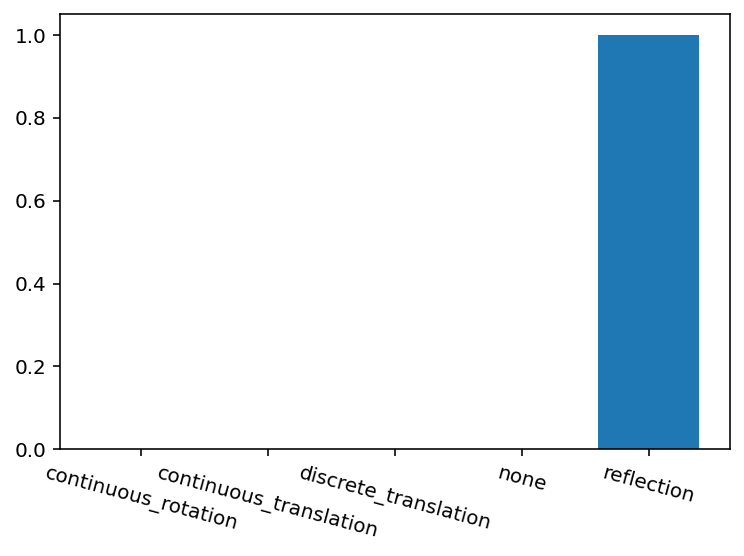

In [38]:
target = 'SALTOTAL'     # Name of the variable we want to predict

nombre_carpeta = 'DB_2' # Name of the sub-folder where the PCA images will be saved inside the big folder. We can analyze several data bases this way

n_fea = 10              # Number of final features that the algorithm selects to make pairs and analyze the symmetry with them

lim_sym = 0.85          # Probability limit to say that the algorithm has found a symmetry or not

limit_pairs = True      # When generating pairs of features, they come together with a score . If this variable is true,  we keep only half the variables with higher score

select_10k = True       # Keep only 10000 elements of the original potential DF (useful, as the original algorithm had been trained with 10000 elements)

interact = True         # Generate new features using interactions


# ------------------------------------------------------------------------------------------------------------------------#

i=0    
    
sym_feat_1 = []
sym_feat_2 = []
sym_feat_tags = []
sym_feat_probs = []
sym_feat_rmse = []
syms_tot = ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
registro = pd.DataFrame(columns = syms_tot)
# Time when we start the whole process
from time import time
start_time = time()


from fastai.vision.all import *
from time import time
from IPython.utils import io



muchos = False # If false, each combination of variables goes to a different folder, in order to look for symmetries easily.
               # If true, all the pcas go to the same folder



# ------------------- Folder PCA ------------------- #

folder = 'PCAs_DB_2'   # Folder where you save the PCAs

dd = top_dir + '/' + folder
if not os.path.isdir(dd):
    print('Creating directory:\n',dd)
    os.mkdir(dd)

dir = os.path.join(top_dir,folder)

#------------------------------ Generate Potentials ---------------------------#

potenciales = [df_e]
potenciales_tags = [nombre_carpeta]
tags = potenciales_tags
num_pot = len(potenciales)

# ------------------- No prints al guardar mejor modelo (fastai) ------------------- # 
# Solo hay un print que se ha eliminado del código original
class SaveModelCallback(TrackerCallback):
    "A `TrackerCallback` that saves the model's best during training and loads it at the end."
    _only_train_loop = True
    def __init__(self, monitor='valid_loss', comp=None, min_delta=0., fname='model', every_epoch=False, at_end=False,
                 with_opt=False, reset_on_fit=True):
        super().__init__(monitor=monitor, comp=comp, min_delta=min_delta, reset_on_fit=reset_on_fit)
        assert not (every_epoch and at_end), "every_epoch and at_end cannot both be set to True"
        # keep track of file path for loggers
        self.last_saved_path = None
        store_attr('fname,every_epoch,at_end,with_opt')

    def _save(self, name): self.last_saved_path = self.learn.save(name, with_opt=self.with_opt)

    def after_epoch(self):
        "Compare the value monitored to its best score and save if best."
        if self.every_epoch: self._save(f'{self.fname}_{self.epoch}')
        else: #every improvement
            super().after_epoch()
            if self.new_best:
                #print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
                self._save(f'{self.fname}')

    def after_fit(self, **kwargs):
        "Load the best model."
        if self.at_end: self._save(f'{self.fname}')
        elif not self.every_epoch: self.learn.load(f'{self.fname}', with_opt=self.with_opt)

# ---------------- Definiciones previas e hiperparámetros ----------------- #

#Guardo los modelos para analizarlos luego
models = [] 
to_s = []

#Guardaremos los resultados de la PCA en un array 
PCA_s = []
PCA_s_tag = []

# Hyperparameters: 
bs_choices = [50000]       # Batch Size
shape='pipe'               # Shape of the neural network
layers_choices = [5]       # Number of layers of the net. Default:10 or 5 results with 5
neurons_choices = [100]    # Number of neurons per layer. Default:200 results with 200
epoch_choices = [150]      # Number of training epochs. Default:200 results with 60
lr_choices = [0.01]       # Max learning rate 
valid_pct=0.2              # Part of the data that goes into validation (0.2 = 20%)
monitor= 'valid_loss'        # Te model with the least 'monitor' will be saved



# ---------------------- Entrenar Red Y PCA -----------------------------------#

j = 1 # Usaremos esto para saber cuantos potenciales hemos procesado, y como indice en general

for df in potenciales:
    
    df[target] = df[target]/np.max(df[target]) #Normalizar la columna objetivo es importante

    #------------------------------ Feature Importance  ---------------------------#

    if select_10k == True:
        if len(df[target]) <= 100*100:
            print('Too little data to keep 10k points and delete the rest')
        else:
            print('Keeping 10k points of the original DF')
            remove_n = len(df[target]) - 10000
            drop_indices = np.random.choice(df.index, remove_n, replace=False)
            df_temp = df.drop(drop_indices)
            df = df_temp.copy()


            
    if interact == True:
        bbb = df[target]
        df = df.drop(target,axis = 1)
        df = my_interactions_small(df, numo_int = 10, verbose = True)
        df[target] = bbb
        
    print('---Selecting Best Features---')
    best_pairs = n_best_rf_phi_k(df, target = target, n = n_fea, nf = 30, lim_corr = 0.85)

    best_n = [best_pairs['f1'][0]] + list(best_pairs['f2'].unique())

    print('Best Features: ',best_n)

    #small_df = df[best_n]
    #small_df[target] = df[target]


    cols = best_n
    a = cols

    verbose = 1



    df_org = df.copy()

    if limit_pairs == True:
        medi = best_pairs.score.median()
        num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
    else:
        medi = 0
        num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])

    for f1,f2,lll in zip(best_pairs.f1,best_pairs.f2,range(len(best_pairs.f1))):
        if best_pairs.score[lll] >= medi:

            i+=1

            print(f1,f2)
            feas = [f1,f2]

            # Debemos marcar cada potencial para tener claro a qué tipo de simetria corresponde cada PCA
            PCA_s_tag.append(tags[j-1])

            df2 = df[feas + [target]].copy() 
            #df2 = df2[feas + [target]].copy()
            
            #Normlizamos las features y hacemos que vayan entre -1 y 1
            df2[f1] = 2*(df2[f1]/np.max(df2[f1]))-1
            df2[f2] = 2*(df2[f2]/np.max(df2[f2]))-1

            splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

            to = TabularPandas(df2,
                            procs=[Categorify,FillMissing, Normalize],
                            cont_names = feas,
                            y_names = target,
                            splits=splits)

            train_size = len(splits[0])
            valid_size = len(splits[1])

            # ----------------- Hyperparameters ------------------- #

            # Batch Size (a large one)
            bs=min(random.choice(bs_choices),train_size)  
            print('{} batch size for training.\n'.format(bs))

            # Neurons per layer
            neurons_per_layer = random.choice(neurons_choices)

            # Number of layers
            n_layers = random.choice(layers_choices)

            #Shape of the net: Pipe or funnel
            if shape == 'pipe':
                layers=[neurons_per_layer for i in range(n_layers)]

            if shape == 'funnel':
                n_eff = n_layers
                layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

            print('Training FCNN with layers: ',layers)

            #Number of epochs
            n_epoch=random.choice(epoch_choices)
            print('Training for {} epochs.'.format(n_epoch))

            # Maximum Learning Rate: (a good value can be found using learn.lr_find())
            lr_max=float(random.choice(lr_choices))
            print('Using lr_max = ',format(lr_max))

            # ----------------------------------------------------- #

            # --------------- Training the FCNN --------------------#

            # Load the data into a DataLoader
            dls = to.dataloaders(bs=bs)

            # Define a Tabular Learner
            learn = tabular_learner(dls, layers=layers
                                #,config=config
                                #,metrics=[mse],
                                #y_range = [min(df.bin),max(df.bin)],
                                #,cbs=ShowGraphCallback()
                                #,train_bn=False)
                                )

            # Train the net 
            with learn.no_logging():
                learn.fit_one_cycle(n_epoch=n_epoch
                                    ,lr_max=lr_max
                                    ,cbs=[SaveModelCallback(monitor=monitor)]
                                    )

                preds, targs = learn.get_preds()

            ff = (preds-targs)**2/len(targs)
            ff = sum(ff)
            RMSE = np.sqrt(ff)
            #print('RMSE:',float(RMSE))
            nrmsei = float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))

            # Guardamos modelos y tabular objects para el posterior analisis
            models.append(learn)
            to_s.append(to)

            # ------------------------------------------------------#


            # ------------------------- PCA ------------------------#

            test_df = df2.copy()
            dl = learn.dls.test_dl(test_df,bs=int(test_df.shape[0])) 

            # Tenemos que hacer un Hook, una especie de gancho que enganchamos en la última capa interna,
            # para guardar, de cada modelo, los valores de los parámetro de dicha capa. 
            with Hooks(learn.model.layers, lambda m,i,o: o) as h:
                preds = learn.get_preds(dl=dl,with_input=True,with_decoded=True,with_loss=True)

            targets=preds[2].numpy().flatten()

            # Cogemos la información de la penúltima capa
            # OJO: Si añadimos y_range, se añade automaticamente una sigmoid
            # al final, por lo que tendríamos que coger la capa -3 en vez de la -2
            act = h.stored[-2] 
            multi_dim=Tensor.cpu(act).numpy()
            standardized=StandardScaler().fit_transform(multi_dim)

            viz = PCA(2).fit_transform(np.nan_to_num(standardized))
            #plt.figure()
            #plt.scatter(viz[:, 0], viz[:, 1],c=targets[:multi_dim.shape[0]],alpha=.1, marker = 'o')

            PCA_s.append(viz)

            # ------------------------------------------------------ #

            # ------------------ Saving the PCA's ------------------ #

            # ---- Dar formato a PCA para guardar como imagen con color

            viz = pd.DataFrame(viz) #Transformamos la PCA en un dataframe
            viz.columns = ['x','y'] #Nombres de las columnas

            # Insertamos una columna con los colores de los puntos. El valor del potencial
            # objetivo (targets) es el color, y hay un color por cada punto 
            viz.insert(2,'class',targets[:multi_dim.shape[0]]) 

            # ---- Personalizar mapa de color 

            n_classes=1000

            colors = 'rainbow'

            if colors == 'rainbow':
                my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                classes_in_rgb = my_cmap(range(n_classes))
            if colors == 'purple':
                my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                classes_in_rgb = np.vstack((np.array([0,0,0,0]),my_cmap([0 for i in range(n_classes)])))

            # ---- Hacer que la intensidad del pixel represente la cantidad de puntos 
            #      acumuldos en un pixel

            n_pixels = 224

            binning_3d=np.histogramdd([viz['x'],viz['y'],viz['class']],range=(None,None,(0,1)), bins=(n_pixels,n_pixels,n_classes))

            #if we want the pixel intensity to reprensent the number of points at that location
            array = np.dot(binning_3d[0],classes_in_rgb)
            array = array/np.amax(array)

            # ---- Guardar la PCA

            #Directorio donde guardaremos las imagenes
            nami = '_'+str(feas[0])+'+'+str(feas[1])+'_'
            if muchos == False: 
                dir_sym = os.path.join(dir,tags[j-1],nami)
                img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+'__PCA.png' 
            else:
                dir_sym = os.path.join(dir,tags[j-1])
                img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+nami+'__PCA.png' 

            if not os.path.isdir(dir_sym):
                print('Creating directory:\n',dir_sym)
                os.makedirs(dir_sym)


            # Nombre de la imagen. Pongo el tiempo para que todas se llamen distinto cada vez.
            output_dir = os.path.join(dir_sym,img_file) # Directorio donde guardamos la imagen
            plt.imsave(output_dir,array) # Guardar
            print('\nPCA saved to:\n{}\n'.format(dir_sym+'/'+img_file))


            # ------------------------ Symmetry Analyzer --------------------- #
            drr = pca_sym_finder(output_dir)
            brr = list(drr.iloc[np.where(drr.value > lim_sym)].symmetry)
            if len(brr) > 0:
                print('Found {} symmetry with features {} and {}, with prob. {}'.format(brr[0],f1,f2,float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4))))                
                sym_feat_1.append(f1)
                sym_feat_2.append(f2)
                sym_feat_tags.append(brr[0])
                sym_feat_probs.append(float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4)))
                sym_feat_rmse.append(nrmsei)




            # ------------------------ Time -------------------------#

            minutes_until_now = (time() - start_time)/60
            images_done = i
            minutes_per_image = minutes_until_now/(images_done)
            hours_left = minutes_per_image * (num_pot*num_2-images_done)/60
            print("\n{} PCA's made out of {}.\n".format(images_done,num_pot*num_2))
            print("{:.1f} minutes elapsed for {} images.".format(minutes_until_now,images_done))
            print("{:.1f} minutes average per image.".format(minutes_until_now/images_done))
            print("{:.1f} minutes estimated left for {} images.\n\n\n".format(hours_left*60,num_pot*num_2-images_done))
            print("{:.1f} hours estimated left for {} images.\n\n\n".format(hours_left,num_pot*num_2-images_done))




    j+=1


          # ------------------------------------------------------#'''

results = pd.DataFrame({'symmetry':sym_feat_tags, 'feature_1':sym_feat_1, 'feature_2':sym_feat_2, 'probability':sym_feat_probs, 'NRMSE':sym_feat_rmse})

vc = results.symmetry.value_counts()



for sym_sum in syms_tot:
    if not hasattr(vc,sym_sum):
        vc[sym_sum] = 0


nr = pd.DataFrame({'continuous_rotation':vc['continuous_rotation'], 
                   'continuous_translation':vc['continuous_translation'], 
                   'discrete_translation':vc['discrete_translation'], 
                   'none':vc['none'], 
                   'reflection':vc['reflection']}, index = [0])

registro = registro.append(nr, ignore_index=True)


plt.xticks(rotation = -15)
plt.bar(registro.columns,registro.sum()/registro.sum().sum())


In [50]:
results

,symmetry,feature_1,feature_2,probability,NRMSE
0,reflection,1ANOS2+1ESTU,1TIPOPAIS+1CNO1,1.0000,0.035035
1,reflection,1ANOS2+1ESTU,1CNO1**2+1SEXO**2,1.0000,0.074582
2,reflection,1ANOS2+1ESTU,1JSP1+1CNO1,1.0000,0.041955
3,reflection,1ANOS2+1ESTU,1CNACE+1CNO1,1.0000,0.036553
4,reflection,1ANOS2+1ESTU,1NUTS1**2+1ESTU**2,1.0000,0.071805
5,reflection,1TIPOPAIS+1CNO1,1NUTS1**2+1ESTU**2,1.0000,0.064890
6,reflection,1ANOS2+1ESTU,1NUTS1**2+1CNO1**2,1.0000,0.035530
7,reflection,1CNO1**2+1SEXO**2,1NUTS1**2+1ESTU**2,1.0000,0.034109
8,reflection,1ANOS2+1ESTU,1JSP1**2+1ESTU**2,1.0000,0.072253
9,reflection,1ANOS2+1ESTU,1HEXTRA**2+1ESTU**2,0.9668,0.038224


In [114]:
def res_plot(df_e, results, num = 0, logs = True):
    f1 = results.feature_1[num]
    f2 = results.feature_2[num]
    if logs == True:
        c = np.log(df_e[target])
    else:
        c = df_e[target]

    plt.figure()
    plt.scatter(df_e[f1],df_e[f2], c = c ,marker = 'o')
    plt.xlabel(f1)
    plt.ylabel(f2)
    plt.title('color = {}'.format(target))
    plt.colorbar()
    plt.show()
    plt.figure()
    ax2 = plt.axes(projection='3d')
    ax2.plot_trisurf(df_e[f1], df_e[f2], c, linewidth=0.2, cmap = 'jet')
    plt.xlabel(f1)
    plt.ylabel(f2)
    plt.show()

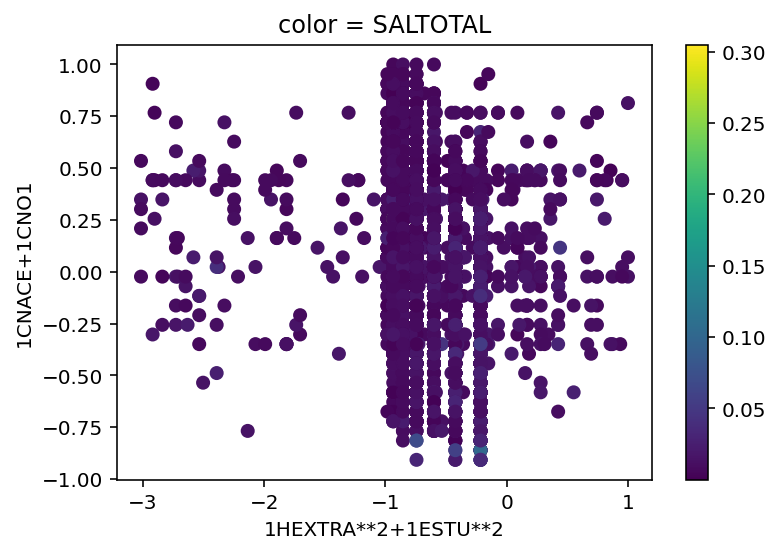

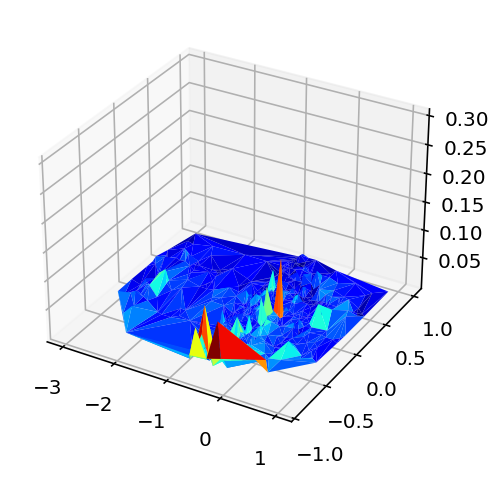

In [71]:
res_plot(df2,results,22, logs = False)

# Kaggle

In [11]:
!pip install opendatasets

In [95]:
creds = '{"username":"gabrielszalkowski","key":"36404a0345251322b628dc3c56bd25df"}'
cred_path = Path('~/.kaggle/kaggle.json').expanduser()
if not cred_path.exists():
    cred_path.parent.mkdir(exist_ok=True)
    cred_path.write_text(creds)
    cred_path.chmod(0o600)

from kaggle import api
import opendatasets as od


od.download('https://www.kaggle.com/imakash3011/customer-personality-analysis')

path = Path(top_dir+'/customer-personality-analysis')
print(path.ls())

df_e = pd.read_csv(path.ls()[0], sep = '\t')

categ = []
numer = []

# ----------------------------------- #

target = 'Income'
quantiles = True

# --------------------------------------#
for col in list(df_e.columns):
    if col != target:
        if type(df_e[col][0]) == str:
            categ.append(col)
        else:
            numer.append(col)

splits = RandomSplitter(valid_pct=0)(range_of(df_e))

to = TabularPandas(df_e,
                procs=[Categorify,FillMissing],
                cat_names = categ,
                cont_names = numer,
                y_names = target,
                splits=splits)


#equiv_CNACE = pd.DataFrame({'Cod_Num':list(to.xs['CNACE'].unique()),'Categ':list(dls.dsets['CNACE'].unique())}).sort_values(by = 'Categ')
#equiv_CNO1 = pd.DataFrame({'Cod_Num':list(to.xs['CNO1'].unique()),'Categ':list(dls.dsets['CNO1'].unique())}).sort_values(by = 'Categ')

df_e = pd.DataFrame(to.xs)
df_e[target] = to.y
df_e = df_e.reset_index().drop('index', axis = 1)  

for col in df_e.columns:
    df_e[col] = np.nan_to_num(df_e[col])   
    if quantiles == True:
        n_attempted_bins =  len(df_e[col])
        binning = pd.qcut(df_e[col], q=n_attempted_bins, retbins=True, labels=False, duplicates='drop')
        df_e[col]=binning[0]/np.max(binning[0])
        df_e[col] = np.nan_to_num(df_e[col])

df_e.head()

Skipping, found downloaded files in "./customer-personality-analysis" (use force=True to force download)
[Path('/home/gabriel/Desktop/customer-personality-analysis/marketing_campaign.csv')]


,Education,Marital_Status,Dt_Customer,ID,Year_Birth,Kidhome,Teenhome,Recency,MntWines,MntFruits,...,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,Income
0,0.142857,0.384615,0.522204,0.014739,1.000000,0.0,0.000000,0.817259,0.000000,0.000000,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.016423
1,0.428571,0.538462,0.293586,0.921840,0.495495,0.0,0.000000,0.604061,0.354219,0.816327,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.853558
2,0.714286,0.538462,0.403783,0.492184,0.909910,0.0,0.000000,0.289340,0.955723,0.734694,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.978558
3,0.428571,0.384615,0.065789,0.938812,0.639640,0.0,0.333333,0.776650,0.309942,0.908163,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.707117
4,0.714286,0.538462,0.522204,0.677981,0.351351,0.0,0.000000,0.228426,0.911445,0.125850,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.993613


In [31]:
df_e.columns

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response'],
      dtype='object')

Too little data to keep 10k points and delete the rest
All 28 columns were squared
Total number of columns created by linear combination: 45
Total number of columns created by linear combination of squared variables: 45
   Regularising...

 Total number of features: 146
---Selecting Best Features---
Best Features:  ['1AcceptedCmp4+1MntWines', '1MntMeatProducts**2+1Z_Revenue**2', '1MntWines**2+1Kidhome**2', '1Teenhome+1MntMeatProducts', '1MntMeatProducts**2+1Teenhome**2', '1MntFishProducts+1NumStorePurchases', 'NumCatalogPurchases', '1AcceptedCmp4+1MntWines', '1NumWebPurchases**2+1MntWines**2', '1MntWines+1MntGoldProds', '1AcceptedCmp4+1MntMeatProducts', '1MntFishProducts+1MntMeatProducts', '1NumWebPurchases**2+1MntMeatProducts**2']
1AcceptedCmp4+1MntWines 1MntMeatProducts**2+1Z_Revenue**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1MntMeatProducts**2+1Z_Revenue**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1MntMeatProducts**2+1Z_Revenue**2_/DB_customers_11637760661__PCA.png



Found none symmetry with features 1AcceptedCmp4+1MntWines and 1MntMeatProducts**2+1Z_Revenue**2, with prob. 1.0

1 PCA's made out of 78.

0.1 minutes elapsed for 1 images.
0.1 minutes average per image.
6.2 minutes estimated left for 77 images.



0.1 hours estimated left for 77 images.



1MntMeatProducts**2+1Z_Revenue**2 1MntWines**2+1Kidhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntMeatProducts**2+1Z_Revenue**2+1MntWines**2+1Kidhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntMeatProducts**2+1Z_Revenue**2+1MntWines**2+1Kidhome**2_/DB_customers_11637760664__PCA.png



Found continuous_translation symmetry with features 1MntMeatProducts**2+1Z_Revenue**2 and 1MntWines**2+1Kidhome**2, with prob. 0.8901000022888184

2 PCA's made out of 78.

0.1 minutes elapsed for 2 images.
0.1 minutes average per image.
4.9 minutes estimated left for 76 images.



0.1 hours estimated left for 76 images.



1MntWines+1MntGoldProds 1MntMeatProducts**2+1Z_Revenue**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntGoldProds+1MntMeatProducts**2+1Z_Revenue**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntGoldProds+1MntMeatProducts**2+1Z_Revenue**2_/DB_customers_11637760667__PCA.png



Found none symmetry with features 1MntWines+1MntGoldProds and 1MntMeatProducts**2+1Z_Revenue**2, with prob. 0.9128999710083008

3 PCA's made out of 78.

0.2 minutes elapsed for 3 images.
0.1 minutes average per image.
4.4 minutes estimated left for 75 images.



0.1 hours estimated left for 75 images.



1MntWines+1MntFishProducts 1Teenhome+1MntMeatProducts
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1Teenhome+1MntMeatProducts_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1Teenhome+1MntMeatProducts_/DB_customers_11637760669__PCA.png




4 PCA's made out of 78.

0.2 minutes elapsed for 4 images.
0.1 minutes average per image.
4.1 minutes estimated left for 74 images.



0.1 hours estimated left for 74 images.



1Teenhome+1MntMeatProducts 1MntWines**2+1Kidhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1MntWines**2+1Kidhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1MntWines**2+1Kidhome**2_/DB_customers_11637760672__PCA.png



Found reflection symmetry with features 1Teenhome+1MntMeatProducts and 1MntWines**2+1Kidhome**2, with prob. 0.9136000275611877

5 PCA's made out of 78.

0.3 minutes elapsed for 5 images.
0.1 minutes average per image.
4.0 minutes estimated left for 73 images.



0.1 hours estimated left for 73 images.



1MntWines+1MntGoldProds 1MntMeatProducts**2+1Teenhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntGoldProds+1MntMeatProducts**2+1Teenhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntGoldProds+1MntMeatProducts**2+1Teenhome**2_/DB_customers_11637760675__PCA.png



Found none symmetry with features 1MntWines+1MntGoldProds and 1MntMeatProducts**2+1Teenhome**2, with prob. 0.9980999827384949

6 PCA's made out of 78.

0.3 minutes elapsed for 6 images.
0.1 minutes average per image.
3.9 minutes estimated left for 72 images.



0.1 hours estimated left for 72 images.



1Teenhome+1MntMeatProducts 1MntFishProducts+1NumStorePurchases
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1MntFishProducts+1NumStorePurchases_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1MntFishProducts+1NumStorePurchases_/DB_customers_11637760678__PCA.png



Found reflection symmetry with features 1Teenhome+1MntMeatProducts and 1MntFishProducts+1NumStorePurchases, with prob. 0.9995999932289124

7 PCA's made out of 78.

0.4 minutes elapsed for 7 images.
0.1 minutes average per image.
3.7 minutes estimated left for 71 images.



0.1 hours estimated left for 71 images.



1MntFishProducts+1MntMeatProducts 1MntWines**2+1Kidhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1MntWines**2+1Kidhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1MntWines**2+1Kidhome**2_/DB_customers_11637760681__PCA.png



Found none symmetry with features 1MntFishProducts+1MntMeatProducts and 1MntWines**2+1Kidhome**2, with prob. 0.9907000064849854

8 PCA's made out of 78.

0.4 minutes elapsed for 8 images.
0.1 minutes average per image.
3.6 minutes estimated left for 70 images.



0.1 hours estimated left for 70 images.



1Teenhome+1MntMeatProducts NumCatalogPurchases
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+NumCatalogPurchases_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+NumCatalogPurchases_/DB_customers_11637760684__PCA.png



Found none symmetry with features 1Teenhome+1MntMeatProducts and NumCatalogPurchases, with prob. 0.9997000098228455

9 PCA's made out of 78.

0.5 minutes elapsed for 9 images.
0.1 minutes average per image.
3.5 minutes estimated left for 69 images.



0.1 hours estimated left for 69 images.



1MntFishProducts+1NumStorePurchases 1MntMeatProducts**2+1Z_Revenue**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1NumStorePurchases+1MntMeatProducts**2+1Z_Revenue**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1NumStorePurchases+1MntMeatProducts**2+1Z_Revenue**2_/DB_customers_11637760687__PCA.png




10 PCA's made out of 78.

0.5 minutes elapsed for 10 images.
0.1 minutes average per image.
3.5 minutes estimated left for 68 images.



0.1 hours estimated left for 68 images.



1MntWines+1MntFishProducts 1MntMeatProducts**2+1Teenhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1MntMeatProducts**2+1Teenhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1MntMeatProducts**2+1Teenhome**2_/DB_customers_11637760689__PCA.png




11 PCA's made out of 78.

0.6 minutes elapsed for 11 images.
0.1 minutes average per image.
3.4 minutes estimated left for 67 images.



0.1 hours estimated left for 67 images.



1MntFishProducts+1MntMeatProducts 1AcceptedCmp4+1MntWines
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1AcceptedCmp4+1MntWines_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1AcceptedCmp4+1MntWines_/DB_customers_11637760692__PCA.png



Found reflection symmetry with features 1MntFishProducts+1MntMeatProducts and 1AcceptedCmp4+1MntWines, with prob. 0.9531999826431274

12 PCA's made out of 78.

0.6 minutes elapsed for 12 images.
0.1 minutes average per image.
3.3 minutes estimated left for 66 images.



0.1 hours estimated left for 66 images.



1MntWines+1MntFishProducts 1MntMeatProducts**2+1Z_Revenue**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1MntMeatProducts**2+1Z_Revenue**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1MntMeatProducts**2+1Z_Revenue**2_/DB_customers_11637760695__PCA.png



Found none symmetry with features 1MntWines+1MntFishProducts and 1MntMeatProducts**2+1Z_Revenue**2, with prob. 0.9940000176429749

13 PCA's made out of 78.

0.7 minutes elapsed for 13 images.
0.1 minutes average per image.
3.3 minutes estimated left for 65 images.



0.1 hours estimated left for 65 images.



1AcceptedCmp4+1MntWines 1MntMeatProducts**2+1Teenhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1MntMeatProducts**2+1Teenhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1MntMeatProducts**2+1Teenhome**2_/DB_customers_11637760698__PCA.png



Found none symmetry with features 1AcceptedCmp4+1MntWines and 1MntMeatProducts**2+1Teenhome**2, with prob. 0.9937999844551086

14 PCA's made out of 78.

0.7 minutes elapsed for 14 images.
0.1 minutes average per image.
3.2 minutes estimated left for 64 images.



0.1 hours estimated left for 64 images.



1MntMeatProducts**2+1Z_Revenue**2 1NumWebPurchases**2+1MntWines**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntMeatProducts**2+1Z_Revenue**2+1NumWebPurchases**2+1MntWines**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntMeatProducts**2+1Z_Revenue**2+1NumWebPurchases**2+1MntWines**2_/DB_customers_11637760701__PCA.png



Found none symmetry with features 1MntMeatProducts**2+1Z_Revenue**2 and 1NumWebPurchases**2+1MntWines**2, with prob. 0.9711999893188477

15 PCA's made out of 78.

0.7 minutes elapsed for 15 images.
0.0 minutes average per image.
3.1 minutes estimated left for 63 images.



0.1 hours estimated left for 63 images.



1MntMeatProducts**2+1Teenhome**2 1MntWines**2+1Kidhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntMeatProducts**2+1Teenhome**2+1MntWines**2+1Kidhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntMeatProducts**2+1Teenhome**2+1MntWines**2+1Kidhome**2_/DB_customers_11637760704__PCA.png




16 PCA's made out of 78.

0.8 minutes elapsed for 16 images.
0.0 minutes average per image.
3.1 minutes estimated left for 62 images.



0.1 hours estimated left for 62 images.



1MntFishProducts+1NumStorePurchases 1MntMeatProducts**2+1Teenhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1NumStorePurchases+1MntMeatProducts**2+1Teenhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1NumStorePurchases+1MntMeatProducts**2+1Teenhome**2_/DB_customers_11637760706__PCA.png



Found none symmetry with features 1MntFishProducts+1NumStorePurchases and 1MntMeatProducts**2+1Teenhome**2, with prob. 0.9954000115394592

17 PCA's made out of 78.

0.8 minutes elapsed for 17 images.
0.0 minutes average per image.
3.0 minutes estimated left for 61 images.



0.1 hours estimated left for 61 images.



1Teenhome+1MntMeatProducts 1MntWines+1MntGoldProds
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1MntWines+1MntGoldProds_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1MntWines+1MntGoldProds_/DB_customers_11637760709__PCA.png



Found none symmetry with features 1Teenhome+1MntMeatProducts and 1MntWines+1MntGoldProds, with prob. 0.9939000010490417

18 PCA's made out of 78.

0.9 minutes elapsed for 18 images.
0.0 minutes average per image.
3.0 minutes estimated left for 60 images.



0.0 hours estimated left for 60 images.



1Teenhome+1MntMeatProducts 1NumWebPurchases**2+1MntWines**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1NumWebPurchases**2+1MntWines**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1NumWebPurchases**2+1MntWines**2_/DB_customers_11637760712__PCA.png




19 PCA's made out of 78.

0.9 minutes elapsed for 19 images.
0.0 minutes average per image.
2.9 minutes estimated left for 59 images.



0.0 hours estimated left for 59 images.



1Teenhome+1MntMeatProducts 1AcceptedCmp4+1MntWines
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1AcceptedCmp4+1MntWines_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1AcceptedCmp4+1MntWines_/DB_customers_11637760715__PCA.png




20 PCA's made out of 78.

1.0 minutes elapsed for 20 images.
0.0 minutes average per image.
2.8 minutes estimated left for 58 images.



0.0 hours estimated left for 58 images.



1AcceptedCmp4+1MntMeatProducts 1MntWines+1MntGoldProds
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1MntWines+1MntGoldProds_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1MntWines+1MntGoldProds_/DB_customers_11637760718__PCA.png



Found none symmetry with features 1AcceptedCmp4+1MntMeatProducts and 1MntWines+1MntGoldProds, with prob. 1.0

21 PCA's made out of 78.

1.0 minutes elapsed for 21 images.
0.0 minutes average per image.
2.8 minutes estimated left for 57 images.



0.0 hours estimated left for 57 images.



1MntMeatProducts**2+1Teenhome**2 1NumWebPurchases**2+1MntWines**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntMeatProducts**2+1Teenhome**2+1NumWebPurchases**2+1MntWines**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntMeatProducts**2+1Teenhome**2+1NumWebPurchases**2+1MntWines**2_/DB_customers_11637760721__PCA.png



Found none symmetry with features 1MntMeatProducts**2+1Teenhome**2 and 1NumWebPurchases**2+1MntWines**2, with prob. 0.9685999751091003

22 PCA's made out of 78.

1.1 minutes elapsed for 22 images.
0.0 minutes average per image.
2.8 minutes estimated left for 56 images.



0.0 hours estimated left for 56 images.



1MntFishProducts+1MntMeatProducts 1NumWebPurchases**2+1MntWines**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1NumWebPurchases**2+1MntWines**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1NumWebPurchases**2+1MntWines**2_/DB_customers_11637760724__PCA.png



Found none symmetry with features 1MntFishProducts+1MntMeatProducts and 1NumWebPurchases**2+1MntWines**2, with prob. 0.9017999768257141

23 PCA's made out of 78.

1.1 minutes elapsed for 23 images.
0.0 minutes average per image.
2.7 minutes estimated left for 55 images.



0.0 hours estimated left for 55 images.



1MntFishProducts+1NumStorePurchases 1MntWines**2+1Kidhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1NumStorePurchases+1MntWines**2+1Kidhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1NumStorePurchases+1MntWines**2+1Kidhome**2_/DB_customers_11637760727__PCA.png



Found reflection symmetry with features 1MntFishProducts+1NumStorePurchases and 1MntWines**2+1Kidhome**2, with prob. 0.9868000149726868

24 PCA's made out of 78.

1.2 minutes elapsed for 24 images.
0.0 minutes average per image.
2.7 minutes estimated left for 54 images.



0.0 hours estimated left for 54 images.



1MntWines+1MntFishProducts 1AcceptedCmp4+1MntMeatProducts
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1AcceptedCmp4+1MntMeatProducts_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1AcceptedCmp4+1MntMeatProducts_/DB_customers_11637760730__PCA.png



Found none symmetry with features 1MntWines+1MntFishProducts and 1AcceptedCmp4+1MntMeatProducts, with prob. 0.9997000098228455

25 PCA's made out of 78.

1.2 minutes elapsed for 25 images.
0.0 minutes average per image.
2.6 minutes estimated left for 53 images.



0.0 hours estimated left for 53 images.



1AcceptedCmp4+1MntMeatProducts 1MntWines**2+1Kidhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1MntWines**2+1Kidhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1MntWines**2+1Kidhome**2_/DB_customers_11637760733__PCA.png



Found continuous_translation symmetry with features 1AcceptedCmp4+1MntMeatProducts and 1MntWines**2+1Kidhome**2, with prob. 0.9937000274658203

26 PCA's made out of 78.

1.3 minutes elapsed for 26 images.
0.0 minutes average per image.
2.6 minutes estimated left for 52 images.



0.0 hours estimated left for 52 images.



1Teenhome+1MntMeatProducts 1MntFishProducts+1MntMeatProducts
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1MntFishProducts+1MntMeatProducts_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1MntFishProducts+1MntMeatProducts_/DB_customers_11637760736__PCA.png



Found none symmetry with features 1Teenhome+1MntMeatProducts and 1MntFishProducts+1MntMeatProducts, with prob. 0.9146000146865845

27 PCA's made out of 78.

1.3 minutes elapsed for 27 images.
0.0 minutes average per image.
2.5 minutes estimated left for 51 images.



0.0 hours estimated left for 51 images.



NumCatalogPurchases 1MntFishProducts+1NumStorePurchases
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1MntFishProducts+1NumStorePurchases_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1MntFishProducts+1NumStorePurchases_/DB_customers_11637760738__PCA.png



Found none symmetry with features NumCatalogPurchases and 1MntFishProducts+1NumStorePurchases, with prob. 0.9975000023841858

28 PCA's made out of 78.

1.4 minutes elapsed for 28 images.
0.0 minutes average per image.
2.5 minutes estimated left for 50 images.



0.0 hours estimated left for 50 images.



1AcceptedCmp4+1MntMeatProducts 1MntFishProducts+1NumStorePurchases
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1MntFishProducts+1NumStorePurchases_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1MntFishProducts+1NumStorePurchases_/DB_customers_11637760741__PCA.png



Found reflection symmetry with features 1AcceptedCmp4+1MntMeatProducts and 1MntFishProducts+1NumStorePurchases, with prob. 0.8865000009536743

29 PCA's made out of 78.

1.4 minutes elapsed for 29 images.
0.0 minutes average per image.
2.4 minutes estimated left for 49 images.



0.0 hours estimated left for 49 images.



NumCatalogPurchases 1MntWines**2+1Kidhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1MntWines**2+1Kidhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1MntWines**2+1Kidhome**2_/DB_customers_11637760744__PCA.png



Found continuous_translation symmetry with features NumCatalogPurchases and 1MntWines**2+1Kidhome**2, with prob. 0.9977999925613403

30 PCA's made out of 78.

1.5 minutes elapsed for 30 images.
0.0 minutes average per image.
2.4 minutes estimated left for 48 images.



0.0 hours estimated left for 48 images.



1MntFishProducts+1MntMeatProducts 1MntWines+1MntGoldProds
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1MntWines+1MntGoldProds_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1MntWines+1MntGoldProds_/DB_customers_11637760747__PCA.png




31 PCA's made out of 78.

1.5 minutes elapsed for 31 images.
0.0 minutes average per image.
2.3 minutes estimated left for 47 images.



0.0 hours estimated left for 47 images.



1MntFishProducts+1NumStorePurchases 1NumWebPurchases**2+1MntMeatProducts**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1NumStorePurchases+1NumWebPurchases**2+1MntMeatProducts**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1NumStorePurchases+1NumWebPurchases**2+1MntMeatProducts**2_/DB_customers_11637760750__PCA.png



Found none symmetry with features 1MntFishProducts+1NumStorePurchases and 1NumWebPurchases**2+1MntMeatProducts**2, with prob. 1.0

32 PCA's made out of 78.

1.6 minutes elapsed for 32 images.
0.0 minutes average per image.
2.3 minutes estimated left for 46 images.



0.0 hours estimated left for 46 images.



NumCatalogPurchases 1AcceptedCmp4+1MntWines
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1AcceptedCmp4+1MntWines_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1AcceptedCmp4+1MntWines_/DB_customers_11637760753__PCA.png



Found none symmetry with features NumCatalogPurchases and 1AcceptedCmp4+1MntWines, with prob. 0.9998999834060669

33 PCA's made out of 78.

1.6 minutes elapsed for 33 images.
0.0 minutes average per image.
2.2 minutes estimated left for 45 images.



0.0 hours estimated left for 45 images.



NumCatalogPurchases 1MntMeatProducts**2+1Teenhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1MntMeatProducts**2+1Teenhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1MntMeatProducts**2+1Teenhome**2_/DB_customers_11637760756__PCA.png



Found none symmetry with features NumCatalogPurchases and 1MntMeatProducts**2+1Teenhome**2, with prob. 0.9957000017166138

34 PCA's made out of 78.

1.7 minutes elapsed for 34 images.
0.0 minutes average per image.
2.1 minutes estimated left for 44 images.



0.0 hours estimated left for 44 images.



1AcceptedCmp4+1MntWines 1MntFishProducts+1NumStorePurchases
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1MntFishProducts+1NumStorePurchases_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1MntFishProducts+1NumStorePurchases_/DB_customers_11637760759__PCA.png



Found none symmetry with features 1AcceptedCmp4+1MntWines and 1MntFishProducts+1NumStorePurchases, with prob. 1.0

35 PCA's made out of 78.

1.7 minutes elapsed for 35 images.
0.0 minutes average per image.
2.1 minutes estimated left for 43 images.



0.0 hours estimated left for 43 images.



NumCatalogPurchases 1NumWebPurchases**2+1MntWines**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1NumWebPurchases**2+1MntWines**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1NumWebPurchases**2+1MntWines**2_/DB_customers_11637760761__PCA.png



Found continuous_translation symmetry with features NumCatalogPurchases and 1NumWebPurchases**2+1MntWines**2, with prob. 0.9939000010490417

36 PCA's made out of 78.

1.8 minutes elapsed for 36 images.
0.0 minutes average per image.
2.0 minutes estimated left for 42 images.



0.0 hours estimated left for 42 images.



1AcceptedCmp4+1MntMeatProducts NumCatalogPurchases
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+NumCatalogPurchases_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+NumCatalogPurchases_/DB_customers_11637760764__PCA.png



Found none symmetry with features 1AcceptedCmp4+1MntMeatProducts and NumCatalogPurchases, with prob. 1.0

37 PCA's made out of 78.

1.8 minutes elapsed for 37 images.
0.0 minutes average per image.
2.0 minutes estimated left for 41 images.



0.0 hours estimated left for 41 images.



NumCatalogPurchases 1NumWebPurchases**2+1MntMeatProducts**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1NumWebPurchases**2+1MntMeatProducts**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1NumWebPurchases**2+1MntMeatProducts**2_/DB_customers_11637760767__PCA.png



Found none symmetry with features NumCatalogPurchases and 1NumWebPurchases**2+1MntMeatProducts**2, with prob. 0.8863000273704529

38 PCA's made out of 78.

1.9 minutes elapsed for 38 images.
0.0 minutes average per image.
1.9 minutes estimated left for 40 images.



0.0 hours estimated left for 40 images.



1AcceptedCmp4+1MntMeatProducts 1NumWebPurchases**2+1MntWines**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1NumWebPurchases**2+1MntWines**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1NumWebPurchases**2+1MntWines**2_/DB_customers_11637760770__PCA.png




39 PCA's made out of 78.

1.9 minutes elapsed for 39 images.
0.0 minutes average per image.
1.9 minutes estimated left for 39 images.



0.0 hours estimated left for 39 images.



1MntFishProducts+1MntMeatProducts NumCatalogPurchases
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+NumCatalogPurchases_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+NumCatalogPurchases_/DB_customers_11637760773__PCA.png



Found none symmetry with features 1MntFishProducts+1MntMeatProducts and NumCatalogPurchases, with prob. 0.8712000250816345

40 PCA's made out of 78.

1.9 minutes elapsed for 40 images.
0.0 minutes average per image.
1.9 minutes estimated left for 38 images.



0.0 hours estimated left for 38 images.



1MntWines+1MntFishProducts NumCatalogPurchases
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+NumCatalogPurchases_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+NumCatalogPurchases_/DB_customers_11637760776__PCA.png



Found none symmetry with features 1MntWines+1MntFishProducts and NumCatalogPurchases, with prob. 0.9983999729156494

41 PCA's made out of 78.

2.0 minutes elapsed for 41 images.
0.0 minutes average per image.
1.8 minutes estimated left for 37 images.



0.0 hours estimated left for 37 images.



NumCatalogPurchases 1MntMeatProducts**2+1Z_Revenue**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1MntMeatProducts**2+1Z_Revenue**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1MntMeatProducts**2+1Z_Revenue**2_/DB_customers_11637760779__PCA.png




42 PCA's made out of 78.

2.0 minutes elapsed for 42 images.
0.0 minutes average per image.
1.8 minutes estimated left for 36 images.



0.0 hours estimated left for 36 images.



1MntFishProducts+1NumStorePurchases 1NumWebPurchases**2+1MntWines**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1NumStorePurchases+1NumWebPurchases**2+1MntWines**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1NumStorePurchases+1NumWebPurchases**2+1MntWines**2_/DB_customers_11637760781__PCA.png



Found none symmetry with features 1MntFishProducts+1NumStorePurchases and 1NumWebPurchases**2+1MntWines**2, with prob. 0.9089999794960022

43 PCA's made out of 78.

2.1 minutes elapsed for 43 images.
0.0 minutes average per image.
1.7 minutes estimated left for 35 images.



0.0 hours estimated left for 35 images.



1MntFishProducts+1NumStorePurchases 1MntWines+1MntGoldProds
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1NumStorePurchases+1MntWines+1MntGoldProds_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1NumStorePurchases+1MntWines+1MntGoldProds_/DB_customers_11637760784__PCA.png



Found reflection symmetry with features 1MntFishProducts+1NumStorePurchases and 1MntWines+1MntGoldProds, with prob. 0.9926999807357788

44 PCA's made out of 78.

2.1 minutes elapsed for 44 images.
0.0 minutes average per image.
1.7 minutes estimated left for 34 images.



0.0 hours estimated left for 34 images.



1AcceptedCmp4+1MntWines 1NumWebPurchases**2+1MntMeatProducts**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1NumWebPurchases**2+1MntMeatProducts**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1NumWebPurchases**2+1MntMeatProducts**2_/DB_customers_11637760787__PCA.png



Found reflection symmetry with features 1AcceptedCmp4+1MntWines and 1NumWebPurchases**2+1MntMeatProducts**2, with prob. 0.996999979019165

45 PCA's made out of 78.

2.2 minutes elapsed for 45 images.
0.0 minutes average per image.
1.6 minutes estimated left for 33 images.



0.0 hours estimated left for 33 images.



1MntWines+1MntFishProducts 1NumWebPurchases**2+1MntMeatProducts**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1NumWebPurchases**2+1MntMeatProducts**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1NumWebPurchases**2+1MntMeatProducts**2_/DB_customers_11637760790__PCA.png



Found reflection symmetry with features 1MntWines+1MntFishProducts and 1NumWebPurchases**2+1MntMeatProducts**2, with prob. 0.9758999943733215

46 PCA's made out of 78.

2.2 minutes elapsed for 46 images.
0.0 minutes average per image.
1.6 minutes estimated left for 32 images.



0.0 hours estimated left for 32 images.



1NumWebPurchases**2+1MntMeatProducts**2 1MntWines**2+1Kidhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1NumWebPurchases**2+1MntMeatProducts**2+1MntWines**2+1Kidhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1NumWebPurchases**2+1MntMeatProducts**2+1MntWines**2+1Kidhome**2_/DB_customers_11637760793__PCA.png




47 PCA's made out of 78.

2.3 minutes elapsed for 47 images.
0.0 minutes average per image.
1.5 minutes estimated left for 31 images.



0.0 hours estimated left for 31 images.



NumCatalogPurchases 1MntWines+1MntGoldProds
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1MntWines+1MntGoldProds_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_NumCatalogPurchases+1MntWines+1MntGoldProds_/DB_customers_11637760796__PCA.png



Found none symmetry with features NumCatalogPurchases and 1MntWines+1MntGoldProds, with prob. 0.9998000264167786

48 PCA's made out of 78.

2.3 minutes elapsed for 48 images.
0.0 minutes average per image.
1.5 minutes estimated left for 30 images.



0.0 hours estimated left for 30 images.



1MntWines+1MntGoldProds 1NumWebPurchases**2+1MntMeatProducts**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntGoldProds+1NumWebPurchases**2+1MntMeatProducts**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntGoldProds+1NumWebPurchases**2+1MntMeatProducts**2_/DB_customers_11637760799__PCA.png



Found none symmetry with features 1MntWines+1MntGoldProds and 1NumWebPurchases**2+1MntMeatProducts**2, with prob. 0.9969000220298767

49 PCA's made out of 78.

2.4 minutes elapsed for 49 images.
0.0 minutes average per image.
1.4 minutes estimated left for 29 images.



0.0 hours estimated left for 29 images.



1Teenhome+1MntMeatProducts 1NumWebPurchases**2+1MntMeatProducts**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1NumWebPurchases**2+1MntMeatProducts**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1NumWebPurchases**2+1MntMeatProducts**2_/DB_customers_11637760802__PCA.png



Found none symmetry with features 1Teenhome+1MntMeatProducts and 1NumWebPurchases**2+1MntMeatProducts**2, with prob. 0.9968000054359436

50 PCA's made out of 78.

2.4 minutes elapsed for 50 images.
0.0 minutes average per image.
1.4 minutes estimated left for 28 images.



0.0 hours estimated left for 28 images.



1MntFishProducts+1MntMeatProducts 1NumWebPurchases**2+1MntMeatProducts**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1NumWebPurchases**2+1MntMeatProducts**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1NumWebPurchases**2+1MntMeatProducts**2_/DB_customers_11637760805__PCA.png



Found none symmetry with features 1MntFishProducts+1MntMeatProducts and 1NumWebPurchases**2+1MntMeatProducts**2, with prob. 0.9872000217437744

51 PCA's made out of 78.

2.5 minutes elapsed for 51 images.
0.0 minutes average per image.
1.3 minutes estimated left for 27 images.



0.0 hours estimated left for 27 images.



1MntWines+1MntFishProducts 1NumWebPurchases**2+1MntWines**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1NumWebPurchases**2+1MntWines**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1NumWebPurchases**2+1MntWines**2_/DB_customers_11637760808__PCA.png



Found none symmetry with features 1MntWines+1MntFishProducts and 1NumWebPurchases**2+1MntWines**2, with prob. 0.9987000226974487

52 PCA's made out of 78.

2.5 minutes elapsed for 52 images.
0.0 minutes average per image.
1.3 minutes estimated left for 26 images.



0.0 hours estimated left for 26 images.



1MntWines+1MntFishProducts 1MntWines**2+1Kidhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1MntWines**2+1Kidhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1MntWines**2+1Kidhome**2_/DB_customers_11637760810__PCA.png



Found none symmetry with features 1MntWines+1MntFishProducts and 1MntWines**2+1Kidhome**2, with prob. 0.9531999826431274

53 PCA's made out of 78.

2.6 minutes elapsed for 53 images.
0.0 minutes average per image.
1.2 minutes estimated left for 25 images.



0.0 hours estimated left for 25 images.



1MntFishProducts+1MntMeatProducts 1MntMeatProducts**2+1Teenhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1MntMeatProducts**2+1Teenhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1MntMeatProducts**2+1Teenhome**2_/DB_customers_11637760813__PCA.png



Found none symmetry with features 1MntFishProducts+1MntMeatProducts and 1MntMeatProducts**2+1Teenhome**2, with prob. 1.0

54 PCA's made out of 78.

2.6 minutes elapsed for 54 images.
0.0 minutes average per image.
1.2 minutes estimated left for 24 images.



0.0 hours estimated left for 24 images.



1AcceptedCmp4+1MntMeatProducts 1Teenhome+1MntMeatProducts
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1Teenhome+1MntMeatProducts_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1Teenhome+1MntMeatProducts_/DB_customers_11637760816__PCA.png



Found none symmetry with features 1AcceptedCmp4+1MntMeatProducts and 1Teenhome+1MntMeatProducts, with prob. 1.0

55 PCA's made out of 78.

2.7 minutes elapsed for 55 images.
0.0 minutes average per image.
1.1 minutes estimated left for 23 images.



0.0 hours estimated left for 23 images.



1MntWines+1MntFishProducts 1MntWines+1MntGoldProds
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1MntWines+1MntGoldProds_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1MntWines+1MntGoldProds_/DB_customers_11637760819__PCA.png




56 PCA's made out of 78.

2.7 minutes elapsed for 56 images.
0.0 minutes average per image.
1.1 minutes estimated left for 22 images.



0.0 hours estimated left for 22 images.



1MntFishProducts+1MntMeatProducts 1MntFishProducts+1NumStorePurchases
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1MntFishProducts+1NumStorePurchases_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1MntFishProducts+1NumStorePurchases_/DB_customers_11637760822__PCA.png



Found none symmetry with features 1MntFishProducts+1MntMeatProducts and 1MntFishProducts+1NumStorePurchases, with prob. 0.9975000023841858

57 PCA's made out of 78.

2.8 minutes elapsed for 57 images.
0.0 minutes average per image.
1.0 minutes estimated left for 21 images.



0.0 hours estimated left for 21 images.



1MntWines+1MntFishProducts 1MntFishProducts+1NumStorePurchases
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1MntFishProducts+1NumStorePurchases_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1MntFishProducts+1NumStorePurchases_/DB_customers_11637760825__PCA.png



Found none symmetry with features 1MntWines+1MntFishProducts and 1MntFishProducts+1NumStorePurchases, with prob. 0.983299970626831

58 PCA's made out of 78.

2.8 minutes elapsed for 58 images.
0.0 minutes average per image.
1.0 minutes estimated left for 20 images.



0.0 hours estimated left for 20 images.



1MntWines+1MntFishProducts 1MntFishProducts+1MntMeatProducts
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1MntFishProducts+1MntMeatProducts_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1MntFishProducts+1MntMeatProducts_/DB_customers_11637760828__PCA.png



Found reflection symmetry with features 1MntWines+1MntFishProducts and 1MntFishProducts+1MntMeatProducts, with prob. 1.0

59 PCA's made out of 78.

2.9 minutes elapsed for 59 images.
0.0 minutes average per image.
0.9 minutes estimated left for 19 images.



0.0 hours estimated left for 19 images.



1MntWines+1MntFishProducts 1AcceptedCmp4+1MntWines
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1AcceptedCmp4+1MntWines_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntFishProducts+1AcceptedCmp4+1MntWines_/DB_customers_11637760831__PCA.png




60 PCA's made out of 78.

2.9 minutes elapsed for 60 images.
0.0 minutes average per image.
0.9 minutes estimated left for 18 images.



0.0 hours estimated left for 18 images.



1MntWines+1MntGoldProds 1MntWines**2+1Kidhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntGoldProds+1MntWines**2+1Kidhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntGoldProds+1MntWines**2+1Kidhome**2_/DB_customers_11637760834__PCA.png



Found reflection symmetry with features 1MntWines+1MntGoldProds and 1MntWines**2+1Kidhome**2, with prob. 0.888700008392334

61 PCA's made out of 78.

3.0 minutes elapsed for 61 images.
0.0 minutes average per image.
0.8 minutes estimated left for 17 images.



0.0 hours estimated left for 17 images.



1MntFishProducts+1MntMeatProducts 1MntMeatProducts**2+1Z_Revenue**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1MntMeatProducts**2+1Z_Revenue**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntFishProducts+1MntMeatProducts+1MntMeatProducts**2+1Z_Revenue**2_/DB_customers_11637760837__PCA.png




62 PCA's made out of 78.

3.0 minutes elapsed for 62 images.
0.0 minutes average per image.
0.8 minutes estimated left for 16 images.



0.0 hours estimated left for 16 images.



1NumWebPurchases**2+1MntMeatProducts**2 1NumWebPurchases**2+1MntWines**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1NumWebPurchases**2+1MntMeatProducts**2+1NumWebPurchases**2+1MntWines**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1NumWebPurchases**2+1MntMeatProducts**2+1NumWebPurchases**2+1MntWines**2_/DB_customers_11637760840__PCA.png



Found none symmetry with features 1NumWebPurchases**2+1MntMeatProducts**2 and 1NumWebPurchases**2+1MntWines**2, with prob. 0.8708000183105469

63 PCA's made out of 78.

3.1 minutes elapsed for 63 images.
0.0 minutes average per image.
0.7 minutes estimated left for 15 images.



0.0 hours estimated left for 15 images.



1AcceptedCmp4+1MntMeatProducts 1MntFishProducts+1MntMeatProducts
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1MntFishProducts+1MntMeatProducts_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1MntFishProducts+1MntMeatProducts_/DB_customers_11637760842__PCA.png




64 PCA's made out of 78.

3.1 minutes elapsed for 64 images.
0.0 minutes average per image.
0.7 minutes estimated left for 14 images.



0.0 hours estimated left for 14 images.



1MntWines+1MntGoldProds 1NumWebPurchases**2+1MntWines**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntGoldProds+1NumWebPurchases**2+1MntWines**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntWines+1MntGoldProds+1NumWebPurchases**2+1MntWines**2_/DB_customers_11637760845__PCA.png



Found none symmetry with features 1MntWines+1MntGoldProds and 1NumWebPurchases**2+1MntWines**2, with prob. 0.989300012588501

65 PCA's made out of 78.

3.2 minutes elapsed for 65 images.
0.0 minutes average per image.
0.6 minutes estimated left for 13 images.



0.0 hours estimated left for 13 images.



1Teenhome+1MntMeatProducts 1MntMeatProducts**2+1Z_Revenue**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1MntMeatProducts**2+1Z_Revenue**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1MntMeatProducts**2+1Z_Revenue**2_/DB_customers_11637760849__PCA.png



Found none symmetry with features 1Teenhome+1MntMeatProducts and 1MntMeatProducts**2+1Z_Revenue**2, with prob. 0.9998999834060669

66 PCA's made out of 78.

3.2 minutes elapsed for 66 images.
0.0 minutes average per image.
0.6 minutes estimated left for 12 images.



0.0 hours estimated left for 12 images.



1AcceptedCmp4+1MntMeatProducts 1NumWebPurchases**2+1MntMeatProducts**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1NumWebPurchases**2+1MntMeatProducts**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1NumWebPurchases**2+1MntMeatProducts**2_/DB_customers_11637760852__PCA.png



Found none symmetry with features 1AcceptedCmp4+1MntMeatProducts and 1NumWebPurchases**2+1MntMeatProducts**2, with prob. 0.9994000196456909

67 PCA's made out of 78.

3.3 minutes elapsed for 67 images.
0.0 minutes average per image.
0.5 minutes estimated left for 11 images.



0.0 hours estimated left for 11 images.



1AcceptedCmp4+1MntWines 1MntWines+1MntGoldProds
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1MntWines+1MntGoldProds_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1MntWines+1MntGoldProds_/DB_customers_11637760855__PCA.png




68 PCA's made out of 78.

3.3 minutes elapsed for 68 images.
0.0 minutes average per image.
0.5 minutes estimated left for 10 images.



0.0 hours estimated left for 10 images.



1NumWebPurchases**2+1MntMeatProducts**2 1MntMeatProducts**2+1Teenhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1NumWebPurchases**2+1MntMeatProducts**2+1MntMeatProducts**2+1Teenhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1NumWebPurchases**2+1MntMeatProducts**2+1MntMeatProducts**2+1Teenhome**2_/DB_customers_11637760858__PCA.png



Found none symmetry with features 1NumWebPurchases**2+1MntMeatProducts**2 and 1MntMeatProducts**2+1Teenhome**2, with prob. 1.0

69 PCA's made out of 78.

3.4 minutes elapsed for 69 images.
0.0 minutes average per image.
0.4 minutes estimated left for 9 images.



0.0 hours estimated left for 9 images.



1MntMeatProducts**2+1Z_Revenue**2 1NumWebPurchases**2+1MntMeatProducts**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntMeatProducts**2+1Z_Revenue**2+1NumWebPurchases**2+1MntMeatProducts**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntMeatProducts**2+1Z_Revenue**2+1NumWebPurchases**2+1MntMeatProducts**2_/DB_customers_11637760860__PCA.png



Found continuous_translation symmetry with features 1MntMeatProducts**2+1Z_Revenue**2 and 1NumWebPurchases**2+1MntMeatProducts**2, with prob. 0.883899986743927

70 PCA's made out of 78.

3.4 minutes elapsed for 70 images.
0.0 minutes average per image.
0.4 minutes estimated left for 8 images.



0.0 hours estimated left for 8 images.



1AcceptedCmp4+1MntMeatProducts 1AcceptedCmp4+1MntWines
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1AcceptedCmp4+1MntWines_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1AcceptedCmp4+1MntWines_/DB_customers_11637760863__PCA.png



Found none symmetry with features 1AcceptedCmp4+1MntMeatProducts and 1AcceptedCmp4+1MntWines, with prob. 1.0

71 PCA's made out of 78.

3.5 minutes elapsed for 71 images.
0.0 minutes average per image.
0.3 minutes estimated left for 7 images.



0.0 hours estimated left for 7 images.



1AcceptedCmp4+1MntWines 1NumWebPurchases**2+1MntWines**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1NumWebPurchases**2+1MntWines**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1NumWebPurchases**2+1MntWines**2_/DB_customers_11637760866__PCA.png



Found none symmetry with features 1AcceptedCmp4+1MntWines and 1NumWebPurchases**2+1MntWines**2, with prob. 1.0

72 PCA's made out of 78.

3.5 minutes elapsed for 72 images.
0.0 minutes average per image.
0.3 minutes estimated left for 6 images.



0.0 hours estimated left for 6 images.



1AcceptedCmp4+1MntMeatProducts 1MntMeatProducts**2+1Teenhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1MntMeatProducts**2+1Teenhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1MntMeatProducts**2+1Teenhome**2_/DB_customers_11637760869__PCA.png



Found none symmetry with features 1AcceptedCmp4+1MntMeatProducts and 1MntMeatProducts**2+1Teenhome**2, with prob. 0.9998999834060669

73 PCA's made out of 78.

3.6 minutes elapsed for 73 images.
0.0 minutes average per image.
0.2 minutes estimated left for 5 images.



0.0 hours estimated left for 5 images.



1NumWebPurchases**2+1MntWines**2 1MntWines**2+1Kidhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1NumWebPurchases**2+1MntWines**2+1MntWines**2+1Kidhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1NumWebPurchases**2+1MntWines**2+1MntWines**2+1Kidhome**2_/DB_customers_11637760872__PCA.png




74 PCA's made out of 78.

3.6 minutes elapsed for 74 images.
0.0 minutes average per image.
0.2 minutes estimated left for 4 images.



0.0 hours estimated left for 4 images.



1AcceptedCmp4+1MntMeatProducts 1MntMeatProducts**2+1Z_Revenue**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1MntMeatProducts**2+1Z_Revenue**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntMeatProducts+1MntMeatProducts**2+1Z_Revenue**2_/DB_customers_11637760875__PCA.png



Found none symmetry with features 1AcceptedCmp4+1MntMeatProducts and 1MntMeatProducts**2+1Z_Revenue**2, with prob. 0.9998000264167786

75 PCA's made out of 78.

3.7 minutes elapsed for 75 images.
0.0 minutes average per image.
0.1 minutes estimated left for 3 images.



0.0 hours estimated left for 3 images.



1AcceptedCmp4+1MntWines 1MntWines**2+1Kidhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1MntWines**2+1Kidhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1AcceptedCmp4+1MntWines+1MntWines**2+1Kidhome**2_/DB_customers_11637760878__PCA.png



Found none symmetry with features 1AcceptedCmp4+1MntWines and 1MntWines**2+1Kidhome**2, with prob. 0.9961000084877014

76 PCA's made out of 78.

3.7 minutes elapsed for 76 images.
0.0 minutes average per image.
0.1 minutes estimated left for 2 images.



0.0 hours estimated left for 2 images.



1MntMeatProducts**2+1Z_Revenue**2 1MntMeatProducts**2+1Teenhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntMeatProducts**2+1Z_Revenue**2+1MntMeatProducts**2+1Teenhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1MntMeatProducts**2+1Z_Revenue**2+1MntMeatProducts**2+1Teenhome**2_/DB_customers_11637760881__PCA.png



Found none symmetry with features 1MntMeatProducts**2+1Z_Revenue**2 and 1MntMeatProducts**2+1Teenhome**2, with prob. 0.9957000017166138

77 PCA's made out of 78.

3.8 minutes elapsed for 77 images.
0.0 minutes average per image.
0.0 minutes estimated left for 1 images.



0.0 hours estimated left for 1 images.



1Teenhome+1MntMeatProducts 1MntMeatProducts**2+1Teenhome**2
1792 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1MntMeatProducts**2+1Teenhome**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_customers/_1Teenhome+1MntMeatProducts+1MntMeatProducts**2+1Teenhome**2_/DB_customers_11637760884__PCA.png



Found none symmetry with features 1Teenhome+1MntMeatProducts and 1MntMeatProducts**2+1Teenhome**2, with prob. 0.9581999778747559

78 PCA's made out of 78.

3.8 minutes elapsed for 78 images.
0.0 minutes average per image.
0.0 minutes estimated left for 0 images.



0.0 hours estimated left for 0 images.





<BarContainer object of 5 artists>

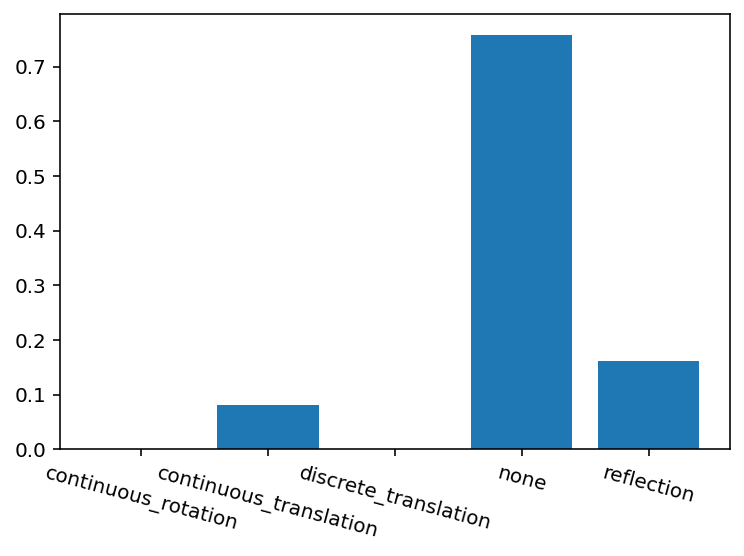

In [123]:
target = 'Income'    # Nombre de la variable que queremos predecir
nombre_carpeta = 'DB_customers' # Nombre de la subcarpeta donde vamos a guardar las PCAs, dentro de la carpeta grande. Así podemos analizar al mismo tiempo varias bases de datos

n_fea = 13              # Número de features finales que el algoritmo escoge para hacer parejas y analizar con ellas la simetría

lim_sym = 0.85          # Límite de probabilidad para decidir que el algoritmo ha encontrado o no una simetría

limit_pairs = False      # Al generar parejas, estas vienen acompañadas de un 'score'. Si esto es True, cogmos solo la mitad de las con mayor 'score'

select_10k = True       # Keep only 10000 elements of the original potential DF (useful)

interact = True


# ------------------------------------------------------------------------------------------------------------------------#

i=0    
    
sym_feat_1 = []
sym_feat_2 = []
sym_feat_tags = []
sym_feat_probs = []
sym_feat_rmse = []
syms_tot = ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
registro = pd.DataFrame(columns = syms_tot)
# Tiempo en el que empezamos a procesar
from time import time
start_time = time()


from fastai.vision.all import *
from time import time
from IPython.utils import io



muchos = False # Si es false, para muchos potenciales, mete cada combinación de variables en una carpeta separada, para que sea fácil ver si hay simetría ahí
               # Si es true, van todos a la misma carpeta


# ------------------- Folder PCA ------------------- #

folder = 'PCAs_DB_2'   # Carpeta donde se guardan las subcarpetas con las PCAs

dd = top_dir + '/' + folder
if not os.path.isdir(dd):
    print('Creating directory:\n',dd)
    os.mkdir(dd)

dir = os.path.join(top_dir,folder)

#------------------------------ Generar Potenciales ---------------------------#

potenciales = [df_e]
potenciales_tags = [nombre_carpeta]
tags = potenciales_tags
num_pot = len(potenciales)

# ------------------- No prints al guardar mejor modelo (fastai) ------------------- # 
# Solo hay un print que se ha eliminado del código original
class SaveModelCallback(TrackerCallback):
    "A `TrackerCallback` that saves the model's best during training and loads it at the end."
    _only_train_loop = True
    def __init__(self, monitor='valid_loss', comp=None, min_delta=0., fname='model', every_epoch=False, at_end=False,
                 with_opt=False, reset_on_fit=True):
        super().__init__(monitor=monitor, comp=comp, min_delta=min_delta, reset_on_fit=reset_on_fit)
        assert not (every_epoch and at_end), "every_epoch and at_end cannot both be set to True"
        # keep track of file path for loggers
        self.last_saved_path = None
        store_attr('fname,every_epoch,at_end,with_opt')

    def _save(self, name): self.last_saved_path = self.learn.save(name, with_opt=self.with_opt)

    def after_epoch(self):
        "Compare the value monitored to its best score and save if best."
        if self.every_epoch: self._save(f'{self.fname}_{self.epoch}')
        else: #every improvement
            super().after_epoch()
            if self.new_best:
                #print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
                self._save(f'{self.fname}')

    def after_fit(self, **kwargs):
        "Load the best model."
        if self.at_end: self._save(f'{self.fname}')
        elif not self.every_epoch: self.learn.load(f'{self.fname}', with_opt=self.with_opt)

# ---------------- Definiciones previas e hiperparámetros ----------------- #

#Guardo los modelos para analizarlos luego
models = [] 
to_s = []

#Guardaremos los resultados de la PCA en un array 
PCA_s = []
PCA_s_tag = []

# Hyperparameters: 
bs_choices = [50000]       # Batch Size
shape='pipe'               # Shape of the neural network
layers_choices = [5]       # Number of layers of the net. Default:10 or 5 results with 5
neurons_choices = [100]    # Number of neurons per layer. Default:200 results with 200
epoch_choices = [150]      # Number of training epochs. Default:200 results with 60
lr_choices = [0.01]       # Max learning rate 
valid_pct=0.2              # Part of the data that goes into validation (0.2 = 20%)
monitor= 'valid_loss'        # Te model with the least 'monitor' will be saved



# ---------------------- Entrenar Red Y PCA -----------------------------------#

j = 1 # Usaremos esto para saber cuantos potenciales hemos procesado, y como indice en general

for df in potenciales:
    
    df[target] = df[target]/np.max(df[target]) #Normalizar la columna objetivo es importante

    #------------------------------ Feature Importance  ---------------------------#

    if select_10k == True:
        if len(df[target]) <= 100*100:
            print('Too little data to keep 10k points and delete the rest')
        else:
            print('Keeping 10k points of the original DF')
            remove_n = len(df[target]) - 10000
            drop_indices = np.random.choice(df.index, remove_n, replace=False)
            df_temp = df.drop(drop_indices)
            df = df_temp.copy()


            
    if interact == True:
        bbb = df[target]
        df = df.drop(target,axis = 1)
        df = my_interactions_small(df, numo_int = 10, verbose = True)
        df[target] = bbb
        
    print('---Selecting Best Features---')
    best_pairs = n_best_rf_phi_k(df, target = target, n = n_fea, nf = 30, lim_corr = 0.85)

    best_n = [best_pairs['f1'][0]] + list(best_pairs['f2'].unique())

    print('Best Features: ',best_n)

    #small_df = df[best_n]
    #small_df[target] = df[target]


    cols = best_n
    a = cols

    verbose = 1



    df_org = df.copy()

    if limit_pairs == True:
        medi = best_pairs.score.median()
        num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
    else:
        medi = 0
        num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])

    for f1,f2,lll in zip(best_pairs.f1,best_pairs.f2,range(len(best_pairs.f1))):
        if best_pairs.score[lll] >= medi:

            i+=1

            print(f1,f2)
            feas = [f1,f2]

            # Debemos marcar cada potencial para tener claro a qué tipo de simetria corresponde cada PCA
            PCA_s_tag.append(tags[j-1])

            df2 = df[feas + [target]].copy() 
            #df2 = df2[feas + [target]].copy()
            
            #Normlizamos las features y hacemos que vayan entre -1 y 1
            df2[f1] = 2*(df2[f1]/np.max(df2[f1]))-1
            df2[f2] = 2*(df2[f2]/np.max(df2[f2]))-1

            splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

            to = TabularPandas(df2,
                            procs=[Categorify,FillMissing, Normalize],
                            cont_names = feas,
                            y_names = target,
                            splits=splits)

            train_size = len(splits[0])
            valid_size = len(splits[1])

            # ----------------- Hyperparameters ------------------- #

            # Batch Size (a large one)
            bs=min(random.choice(bs_choices),train_size)  
            print('{} batch size for training.\n'.format(bs))

            # Neurons per layer
            neurons_per_layer = random.choice(neurons_choices)

            # Number of layers
            n_layers = random.choice(layers_choices)

            #Shape of the net: Pipe or funnel
            if shape == 'pipe':
                layers=[neurons_per_layer for i in range(n_layers)]

            if shape == 'funnel':
                n_eff = n_layers
                layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

            print('Training FCNN with layers: ',layers)

            #Number of epochs
            n_epoch=random.choice(epoch_choices)
            print('Training for {} epochs.'.format(n_epoch))

            # Maximum Learning Rate: (a good value can be found using learn.lr_find())
            lr_max=float(random.choice(lr_choices))
            print('Using lr_max = ',format(lr_max))

            # ----------------------------------------------------- #

            # --------------- Training the FCNN --------------------#

            # Load the data into a DataLoader
            dls = to.dataloaders(bs=bs)

            # Define a Tabular Learner
            learn = tabular_learner(dls, layers=layers
                                #,config=config
                                #,metrics=[mse],
                                #y_range = [min(df.bin),max(df.bin)],
                                #,cbs=ShowGraphCallback()
                                #,train_bn=False)
                                )

            # Train the net 
            with learn.no_logging():
                learn.fit_one_cycle(n_epoch=n_epoch
                                    ,lr_max=lr_max
                                    ,cbs=[SaveModelCallback(monitor=monitor)]
                                    )

                preds, targs = learn.get_preds()

            ff = (preds-targs)**2/len(targs)
            ff = sum(ff)
            RMSE = np.sqrt(ff)
            #print('RMSE:',float(RMSE))
            nrmsei = float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))

            # Guardamos modelos y tabular objects para el posterior analisis
            models.append(learn)
            to_s.append(to)

            # ------------------------------------------------------#


            # ------------------------- PCA ------------------------#

            test_df = df2.copy()
            dl = learn.dls.test_dl(test_df,bs=int(test_df.shape[0])) 

            # Tenemos que hacer un Hook, una especie de gancho que enganchamos en la última capa interna,
            # para guardar, de cada modelo, los valores de los parámetro de dicha capa. 
            with Hooks(learn.model.layers, lambda m,i,o: o) as h:
                preds = learn.get_preds(dl=dl,with_input=True,with_decoded=True,with_loss=True)

            targets=preds[2].numpy().flatten()

            # Cogemos la información de la penúltima capa
            # OJO: Si añadimos y_range, se añade automaticamente una sigmoid
            # al final, por lo que tendríamos que coger la capa -3 en vez de la -2
            act = h.stored[-2] 
            multi_dim=Tensor.cpu(act).numpy()
            standardized=StandardScaler().fit_transform(multi_dim)

            viz = PCA(2).fit_transform(np.nan_to_num(standardized))
            #plt.figure()
            #plt.scatter(viz[:, 0], viz[:, 1],c=targets[:multi_dim.shape[0]],alpha=.1, marker = 'o')

            PCA_s.append(viz)

            # ------------------------------------------------------ #

            # ------------------ Saving the PCA's ------------------ #

            # ---- Dar formato a PCA para guardar como imagen con color

            viz = pd.DataFrame(viz) #Transformamos la PCA en un dataframe
            viz.columns = ['x','y'] #Nombres de las columnas

            # Insertamos una columna con los colores de los puntos. El valor del potencial
            # objetivo (targets) es el color, y hay un color por cada punto 
            viz.insert(2,'class',targets[:multi_dim.shape[0]]) 

            # ---- Personalizar mapa de color 

            n_classes=1000

            colors = 'rainbow'

            if colors == 'rainbow':
                my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                classes_in_rgb = my_cmap(range(n_classes))
            if colors == 'purple':
                my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                classes_in_rgb = np.vstack((np.array([0,0,0,0]),my_cmap([0 for i in range(n_classes)])))

            # ---- Hacer que la intensidad del pixel represente la cantidad de puntos 
            #      acumuldos en un pixel

            n_pixels = 224

            binning_3d=np.histogramdd([viz['x'],viz['y'],viz['class']],range=(None,None,(0,1)), bins=(n_pixels,n_pixels,n_classes))

            #if we want the pixel intensity to reprensent the number of points at that location
            array = np.dot(binning_3d[0],classes_in_rgb)
            array = array/np.amax(array)

            # ---- Guardar la PCA

            #Directorio donde guardaremos las imagenes
            nami = '_'+str(feas[0])+'+'+str(feas[1])+'_'
            if muchos == False: 
                dir_sym = os.path.join(dir,tags[j-1],nami)
                img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+'__PCA.png' 
            else:
                dir_sym = os.path.join(dir,tags[j-1])
                img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+nami+'__PCA.png' 

            if not os.path.isdir(dir_sym):
                print('Creating directory:\n',dir_sym)
                os.makedirs(dir_sym)


            # Nombre de la imagen. Pongo el tiempo para que todas se llamen distinto cada vez.
            output_dir = os.path.join(dir_sym,img_file) # Directorio donde guardamos la imagen
            plt.imsave(output_dir,array) # Guardar
            print('\nPCA saved to:\n{}\n'.format(dir_sym+'/'+img_file))


            # ------------------------ Symmetry Analyzer --------------------- #
            drr = pca_sym_finder(output_dir)
            brr = list(drr.iloc[np.where(drr.value > lim_sym)].symmetry)
            if len(brr) > 0:
                print('Found {} symmetry with features {} and {}, with prob. {}'.format(brr[0],f1,f2,float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4))))                
                sym_feat_1.append(f1)
                sym_feat_2.append(f2)
                sym_feat_tags.append(brr[0])
                sym_feat_probs.append(float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4)))
                sym_feat_rmse.append(nrmsei)




            # ------------------------ Time -------------------------#

            minutes_until_now = (time() - start_time)/60
            images_done = i
            minutes_per_image = minutes_until_now/(images_done)
            hours_left = minutes_per_image * (num_pot*num_2-images_done)/60
            print("\n{} PCA's made out of {}.\n".format(images_done,num_pot*num_2))
            print("{:.1f} minutes elapsed for {} images.".format(minutes_until_now,images_done))
            print("{:.1f} minutes average per image.".format(minutes_until_now/images_done))
            print("{:.1f} minutes estimated left for {} images.\n\n\n".format(hours_left*60,num_pot*num_2-images_done))
            print("{:.1f} hours estimated left for {} images.\n\n\n".format(hours_left,num_pot*num_2-images_done))




    j+=1


          # ------------------------------------------------------#'''

results = pd.DataFrame({'symmetry':sym_feat_tags, 'feature_1':sym_feat_1, 'feature_2':sym_feat_2, 'probability':sym_feat_probs, 'NRMSE':sym_feat_rmse})

vc = results.symmetry.value_counts()



for sym_sum in syms_tot:
    if not hasattr(vc,sym_sum):
        vc[sym_sum] = 0


nr = pd.DataFrame({'continuous_rotation':vc['continuous_rotation'], 
                   'continuous_translation':vc['continuous_translation'], 
                   'discrete_translation':vc['discrete_translation'], 
                   'none':vc['none'], 
                   'reflection':vc['reflection']}, index = [0])

registro = registro.append(nr, ignore_index=True)


plt.xticks(rotation = -15)
plt.bar(registro.columns,registro.sum()/registro.sum().sum())


In [124]:
results.iloc[np.where(results.symmetry != 'none')].sort_values('NRMSE', ascending = True)

,symmetry,feature_1,feature_2,probability,NRMSE
1,continuous_translation,1MntMeatProducts**2+1Z_Revenue**2,1MntWines**2+1Kidhome**2,0.8901,0.145748
8,reflection,1MntFishProducts+1MntMeatProducts,1AcceptedCmp4+1MntWines,0.9532,0.145954
19,continuous_translation,1AcceptedCmp4+1MntMeatProducts,1MntWines**2+1Kidhome**2,0.9937,0.154334
22,reflection,1AcceptedCmp4+1MntMeatProducts,1MntFishProducts+1NumStorePurchases,0.8865,0.154939
47,reflection,1MntWines+1MntFishProducts,1MntFishProducts+1MntMeatProducts,1.0000,0.157977
35,reflection,1AcceptedCmp4+1MntWines,1NumWebPurchases**2+1MntMeatProducts**2,0.9970,0.158880
3,reflection,1Teenhome+1MntMeatProducts,1MntWines**2+1Kidhome**2,0.9136,0.160059
17,reflection,1MntFishProducts+1NumStorePurchases,1MntWines**2+1Kidhome**2,0.9868,0.160905
23,continuous_translation,NumCatalogPurchases,1MntWines**2+1Kidhome**2,0.9978,0.164301
36,reflection,1MntWines+1MntFishProducts,1NumWebPurchases**2+1MntMeatProducts**2,0.9759,0.165593


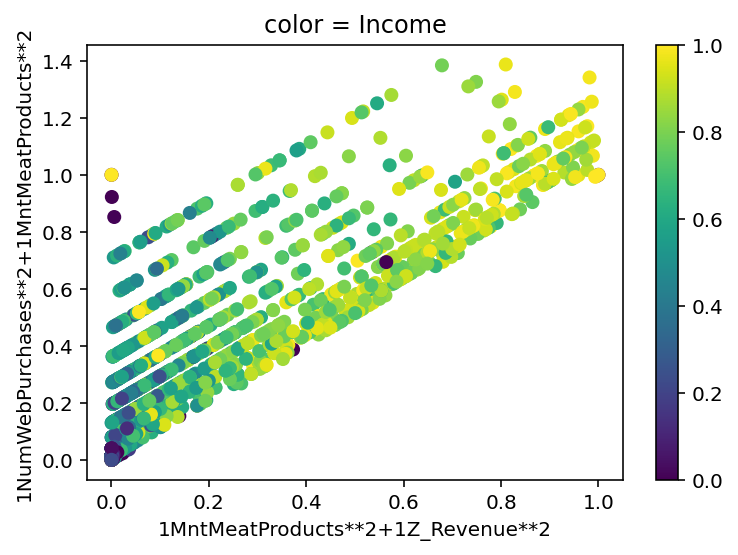

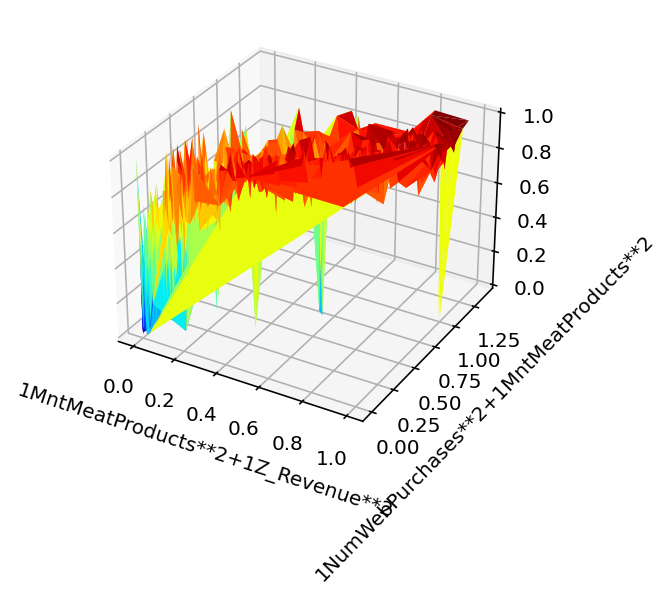

In [130]:
res_plot(df,results,54, logs = False)

# Bikes

In [82]:
creds = '{"username":"gabrielszalkowski","key":"36404a0345251322b628dc3c56bd25df"}'
cred_path = Path('~/.kaggle/kaggle.json').expanduser()
if not cred_path.exists():
    cred_path.parent.mkdir(exist_ok=True)
    cred_path.write_text(creds)
    cred_path.chmod(0o600)

from kaggle import api
import opendatasets as od


od.download('https://www.kaggle.com/c/bike-sharing-demand')

path = Path(top_dir+'/bike-sharing-demand')
print(path.ls())

df_e = pd.read_csv(path.ls()[0])

categ = []
numer = []

# ----------------------------------- #

target = 'count'
quantiles = True
ignore_list = ['registered', 'casual']


# --------------------------------------#
for col in list(df_e.columns):
    if (col != target) and (col not in ignore_list):
        if type(df_e[col][0]) == str:
            categ.append(col)
        else:
            numer.append(col)

splits = RandomSplitter(valid_pct=0)(range_of(df_e))

to = TabularPandas(df_e,
                procs=[Categorify,FillMissing],
                cat_names = categ,
                cont_names = numer,
                y_names = target,
                splits=splits)


#equiv_CNACE = pd.DataFrame({'Cod_Num':list(to.xs['CNACE'].unique()),'Categ':list(dls.dsets['CNACE'].unique())}).sort_values(by = 'Categ')
#equiv_CNO1 = pd.DataFrame({'Cod_Num':list(to.xs['CNO1'].unique()),'Categ':list(dls.dsets['CNO1'].unique())}).sort_values(by = 'Categ')

df_e = pd.DataFrame(to.xs)
df_e[target] = to.y
df_e = df_e.reset_index().drop('index', axis = 1)  

for col in df_e.columns:
    df_e[col] = np.nan_to_num(df_e[col])   
    if quantiles == True:
        n_attempted_bins =  len(df_e[col])
        binning = pd.qcut(df_e[col], q=n_attempted_bins, retbins=True, labels=False, duplicates='drop')
        df_e[col]=binning[0]/np.max(binning[0])
        df_e[col] = np.nan_to_num(df_e[col])

df_e.head()

Skipping, found downloaded files in "./bike-sharing-demand" (use force=True to force download)
[Path('/home/gabriel/Desktop/bike-sharing-demand/train.csv'), Path('/home/gabriel/Desktop/bike-sharing-demand/test.csv'), Path('/home/gabriel/Desktop/bike-sharing-demand/sampleSubmission.csv')]


,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,count
0,0.180524,0.2,0.0,0.0,0.0,0.557895,0.568966,0.625000,0.000000,0.312912
1,0.801837,0.6,0.0,1.0,0.0,0.726316,0.758621,0.803571,0.019608,0.012516
2,0.093799,0.0,0.0,1.0,0.6,0.178947,0.172414,1.000000,0.372549,0.000659
3,0.374460,1.0,0.0,0.0,0.6,0.347368,0.379310,0.898810,0.058824,0.071805
4,0.130822,0.2,0.0,1.0,0.6,0.452632,0.482759,0.976190,0.333333,0.004611


Keeping 10k points of the original DF
---- Small interactions ----
All 9 columns were squared
--> Number of variables smaller than num_int. Using all 9 columns
Total number of columns created by linear combination: 36
Total number of columns created by linear combination of squared variables: 36
   Regularising...

 Total number of features: 90
---Selecting Best Features---
Best Features:  ['1atemp**2+1datetime**2', '1humidity**2+1workingday**2', '1holiday**2+1humidity**2', '1weather+1humidity', '1datetime+1windspeed', 'datetime**2', '1weather**2+1temp**2', '1atemp+1temp', '1atemp+1holiday', '1datetime+1holiday', '1windspeed**2+1temp**2', '1datetime+1weather', '1datetime+1workingday']
1atemp**2+1datetime**2 1humidity**2+1workingday**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1humidity**2+1workingday**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1humidity**2+1workingday**2_/DB_bikes_11637933401__PCA.png



Found reflection symmetry with features 1atemp**2+1datetime**2 and 1humidity**2+1workingday**2, with prob. 1.0

1 PCA's made out of 78.

0.1 minutes elapsed for 1 images.
0.1 minutes average per image.
9.6 minutes estimated left for 77 images.



0.2 hours estimated left for 77 images.



1atemp**2+1datetime**2 1holiday**2+1humidity**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1holiday**2+1humidity**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1holiday**2+1humidity**2_/DB_bikes_11637933407__PCA.png



Found reflection symmetry with features 1atemp**2+1datetime**2 and 1holiday**2+1humidity**2, with prob. 1.0

2 PCA's made out of 78.

0.2 minutes elapsed for 2 images.
0.1 minutes average per image.
8.1 minutes estimated left for 76 images.



0.1 hours estimated left for 76 images.



1atemp**2+1datetime**2 1weather+1humidity
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1weather+1humidity_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1weather+1humidity_/DB_bikes_11637933412__PCA.png



Found reflection symmetry with features 1atemp**2+1datetime**2 and 1weather+1humidity, with prob. 1.0

3 PCA's made out of 78.

0.3 minutes elapsed for 3 images.
0.1 minutes average per image.
7.5 minutes estimated left for 75 images.



0.1 hours estimated left for 75 images.



1atemp+1temp 1humidity**2+1workingday**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1humidity**2+1workingday**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1humidity**2+1workingday**2_/DB_bikes_11637933417__PCA.png



Found reflection symmetry with features 1atemp+1temp and 1humidity**2+1workingday**2, with prob. 0.9998999834060669

4 PCA's made out of 78.

0.4 minutes elapsed for 4 images.
0.1 minutes average per image.
7.1 minutes estimated left for 74 images.



0.1 hours estimated left for 74 images.



1humidity**2+1workingday**2 1datetime+1windspeed
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+1datetime+1windspeed_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+1datetime+1windspeed_/DB_bikes_11637933422__PCA.png



Found reflection symmetry with features 1humidity**2+1workingday**2 and 1datetime+1windspeed, with prob. 1.0

5 PCA's made out of 78.

0.5 minutes elapsed for 5 images.
0.1 minutes average per image.
6.9 minutes estimated left for 73 images.



0.1 hours estimated left for 73 images.



1datetime+1workingday 1weather+1humidity
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1weather+1humidity_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1weather+1humidity_/DB_bikes_11637933427__PCA.png



Found reflection symmetry with features 1datetime+1workingday and 1weather+1humidity, with prob. 1.0

6 PCA's made out of 78.

0.6 minutes elapsed for 6 images.
0.1 minutes average per image.
6.7 minutes estimated left for 72 images.



0.1 hours estimated left for 72 images.



1datetime+1holiday 1humidity**2+1workingday**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1humidity**2+1workingday**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1humidity**2+1workingday**2_/DB_bikes_11637933433__PCA.png



Found reflection symmetry with features 1datetime+1holiday and 1humidity**2+1workingday**2, with prob. 1.0

7 PCA's made out of 78.

0.6 minutes elapsed for 7 images.
0.1 minutes average per image.
6.5 minutes estimated left for 71 images.



0.1 hours estimated left for 71 images.



1datetime+1workingday 1holiday**2+1humidity**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1holiday**2+1humidity**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1holiday**2+1humidity**2_/DB_bikes_11637933438__PCA.png



Found reflection symmetry with features 1datetime+1workingday and 1holiday**2+1humidity**2, with prob. 0.9987999796867371

8 PCA's made out of 78.

0.7 minutes elapsed for 8 images.
0.1 minutes average per image.
6.4 minutes estimated left for 70 images.



0.1 hours estimated left for 70 images.



1humidity**2+1workingday**2 datetime**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+datetime**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+datetime**2_/DB_bikes_11637933443__PCA.png



Found reflection symmetry with features 1humidity**2+1workingday**2 and datetime**2, with prob. 1.0

9 PCA's made out of 78.

0.8 minutes elapsed for 9 images.
0.1 minutes average per image.
6.3 minutes estimated left for 69 images.



0.1 hours estimated left for 69 images.



1atemp+1temp 1datetime+1windspeed
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1datetime+1windspeed_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1datetime+1windspeed_/DB_bikes_11637933448__PCA.png



Found reflection symmetry with features 1atemp+1temp and 1datetime+1windspeed, with prob. 1.0

10 PCA's made out of 78.

0.9 minutes elapsed for 10 images.
0.1 minutes average per image.
6.2 minutes estimated left for 68 images.



0.1 hours estimated left for 68 images.



1atemp+1holiday 1humidity**2+1workingday**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1humidity**2+1workingday**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1humidity**2+1workingday**2_/DB_bikes_11637933454__PCA.png



Found reflection symmetry with features 1atemp+1holiday and 1humidity**2+1workingday**2, with prob. 0.9998000264167786

11 PCA's made out of 78.

1.0 minutes elapsed for 11 images.
0.1 minutes average per image.
6.0 minutes estimated left for 67 images.



0.1 hours estimated left for 67 images.



1humidity**2+1workingday**2 1weather**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+1weather**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+1weather**2+1temp**2_/DB_bikes_11637933459__PCA.png




12 PCA's made out of 78.

1.1 minutes elapsed for 12 images.
0.1 minutes average per image.
6.0 minutes estimated left for 66 images.



0.1 hours estimated left for 66 images.



1atemp+1holiday 1datetime+1windspeed
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1datetime+1windspeed_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1datetime+1windspeed_/DB_bikes_11637933464__PCA.png



Found reflection symmetry with features 1atemp+1holiday and 1datetime+1windspeed, with prob. 1.0

13 PCA's made out of 78.

1.2 minutes elapsed for 13 images.
0.1 minutes average per image.
5.9 minutes estimated left for 65 images.



0.1 hours estimated left for 65 images.



1atemp+1temp 1holiday**2+1humidity**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1holiday**2+1humidity**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1holiday**2+1humidity**2_/DB_bikes_11637933470__PCA.png




14 PCA's made out of 78.

1.3 minutes elapsed for 14 images.
0.1 minutes average per image.
5.8 minutes estimated left for 64 images.



0.1 hours estimated left for 64 images.



1datetime+1workingday 1atemp+1temp
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1atemp+1temp_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1atemp+1temp_/DB_bikes_11637933475__PCA.png



Found reflection symmetry with features 1datetime+1workingday and 1atemp+1temp, with prob. 0.9998999834060669

15 PCA's made out of 78.

1.4 minutes elapsed for 15 images.
0.1 minutes average per image.
5.7 minutes estimated left for 63 images.



0.1 hours estimated left for 63 images.



1datetime+1windspeed 1holiday**2+1humidity**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1windspeed+1holiday**2+1humidity**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1windspeed+1holiday**2+1humidity**2_/DB_bikes_11637933480__PCA.png



Found reflection symmetry with features 1datetime+1windspeed and 1holiday**2+1humidity**2, with prob. 1.0

16 PCA's made out of 78.

1.4 minutes elapsed for 16 images.
0.1 minutes average per image.
5.6 minutes estimated left for 62 images.



0.1 hours estimated left for 62 images.



1datetime+1holiday 1weather+1humidity
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1weather+1humidity_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1weather+1humidity_/DB_bikes_11637933485__PCA.png



Found reflection symmetry with features 1datetime+1holiday and 1weather+1humidity, with prob. 1.0

17 PCA's made out of 78.

1.5 minutes elapsed for 17 images.
0.1 minutes average per image.
5.5 minutes estimated left for 61 images.



0.1 hours estimated left for 61 images.



1atemp+1holiday 1weather+1humidity
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1weather+1humidity_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1weather+1humidity_/DB_bikes_11637933491__PCA.png



Found reflection symmetry with features 1atemp+1holiday and 1weather+1humidity, with prob. 0.9592000246047974

18 PCA's made out of 78.

1.6 minutes elapsed for 18 images.
0.1 minutes average per image.
5.4 minutes estimated left for 60 images.



0.1 hours estimated left for 60 images.



1atemp+1temp 1weather+1humidity
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1weather+1humidity_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1weather+1humidity_/DB_bikes_11637933496__PCA.png



Found reflection symmetry with features 1atemp+1temp and 1weather+1humidity, with prob. 0.9955999851226807

19 PCA's made out of 78.

1.7 minutes elapsed for 19 images.
0.1 minutes average per image.
5.3 minutes estimated left for 59 images.



0.1 hours estimated left for 59 images.



1weather**2+1temp**2 1datetime+1windspeed
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather**2+1temp**2+1datetime+1windspeed_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather**2+1temp**2+1datetime+1windspeed_/DB_bikes_11637933501__PCA.png



Found reflection symmetry with features 1weather**2+1temp**2 and 1datetime+1windspeed, with prob. 1.0

20 PCA's made out of 78.

1.8 minutes elapsed for 20 images.
0.1 minutes average per image.
5.2 minutes estimated left for 58 images.



0.1 hours estimated left for 58 images.



1weather**2+1temp**2 1holiday**2+1humidity**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather**2+1temp**2+1holiday**2+1humidity**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather**2+1temp**2+1holiday**2+1humidity**2_/DB_bikes_11637933506__PCA.png




21 PCA's made out of 78.

1.9 minutes elapsed for 21 images.
0.1 minutes average per image.
5.1 minutes estimated left for 57 images.



0.1 hours estimated left for 57 images.



1datetime+1windspeed 1weather+1humidity
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1windspeed+1weather+1humidity_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1windspeed+1weather+1humidity_/DB_bikes_11637933511__PCA.png



Found reflection symmetry with features 1datetime+1windspeed and 1weather+1humidity, with prob. 1.0

22 PCA's made out of 78.

2.0 minutes elapsed for 22 images.
0.1 minutes average per image.
5.0 minutes estimated left for 56 images.



0.1 hours estimated left for 56 images.



datetime**2 1holiday**2+1humidity**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_datetime**2+1holiday**2+1humidity**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_datetime**2+1holiday**2+1humidity**2_/DB_bikes_11637933516__PCA.png



Found reflection symmetry with features datetime**2 and 1holiday**2+1humidity**2, with prob. 1.0

23 PCA's made out of 78.

2.0 minutes elapsed for 23 images.
0.1 minutes average per image.
4.9 minutes estimated left for 55 images.



0.1 hours estimated left for 55 images.



1datetime+1workingday 1weather**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1weather**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1weather**2+1temp**2_/DB_bikes_11637933522__PCA.png



Found reflection symmetry with features 1datetime+1workingday and 1weather**2+1temp**2, with prob. 1.0

24 PCA's made out of 78.

2.1 minutes elapsed for 24 images.
0.1 minutes average per image.
4.8 minutes estimated left for 54 images.



0.1 hours estimated left for 54 images.



1datetime+1workingday 1atemp+1holiday
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1atemp+1holiday_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1atemp+1holiday_/DB_bikes_11637933527__PCA.png



Found reflection symmetry with features 1datetime+1workingday and 1atemp+1holiday, with prob. 1.0

25 PCA's made out of 78.

2.2 minutes elapsed for 25 images.
0.1 minutes average per image.
4.7 minutes estimated left for 53 images.



0.1 hours estimated left for 53 images.



1atemp+1temp 1datetime+1holiday
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1datetime+1holiday_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1datetime+1holiday_/DB_bikes_11637933532__PCA.png



Found reflection symmetry with features 1atemp+1temp and 1datetime+1holiday, with prob. 1.0

26 PCA's made out of 78.

2.3 minutes elapsed for 26 images.
0.1 minutes average per image.
4.6 minutes estimated left for 52 images.



0.1 hours estimated left for 52 images.



1humidity**2+1workingday**2 1windspeed**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+1windspeed**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+1windspeed**2+1temp**2_/DB_bikes_11637933538__PCA.png



Found reflection symmetry with features 1humidity**2+1workingday**2 and 1windspeed**2+1temp**2, with prob. 0.9998999834060669

27 PCA's made out of 78.

2.4 minutes elapsed for 27 images.
0.1 minutes average per image.
4.5 minutes estimated left for 51 images.



0.1 hours estimated left for 51 images.



1datetime+1workingday 1windspeed**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1windspeed**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1windspeed**2+1temp**2_/DB_bikes_11637933543__PCA.png



Found reflection symmetry with features 1datetime+1workingday and 1windspeed**2+1temp**2, with prob. 1.0

28 PCA's made out of 78.

2.5 minutes elapsed for 28 images.
0.1 minutes average per image.
4.4 minutes estimated left for 50 images.



0.1 hours estimated left for 50 images.



datetime**2 1weather+1humidity
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_datetime**2+1weather+1humidity_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_datetime**2+1weather+1humidity_/DB_bikes_11637933548__PCA.png



Found reflection symmetry with features datetime**2 and 1weather+1humidity, with prob. 1.0

29 PCA's made out of 78.

2.6 minutes elapsed for 29 images.
0.1 minutes average per image.
4.3 minutes estimated left for 49 images.



0.1 hours estimated left for 49 images.



1humidity**2+1workingday**2 1datetime+1weather
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+1datetime+1weather_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+1datetime+1weather_/DB_bikes_11637933554__PCA.png



Found reflection symmetry with features 1humidity**2+1workingday**2 and 1datetime+1weather, with prob. 1.0

30 PCA's made out of 78.

2.7 minutes elapsed for 30 images.
0.1 minutes average per image.
4.3 minutes estimated left for 48 images.



0.1 hours estimated left for 48 images.



1atemp**2+1datetime**2 1windspeed**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1windspeed**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1windspeed**2+1temp**2_/DB_bikes_11637933559__PCA.png



Found reflection symmetry with features 1atemp**2+1datetime**2 and 1windspeed**2+1temp**2, with prob. 1.0

31 PCA's made out of 78.

2.7 minutes elapsed for 31 images.
0.1 minutes average per image.
4.2 minutes estimated left for 47 images.



0.1 hours estimated left for 47 images.



1datetime+1holiday 1weather**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1weather**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1weather**2+1temp**2_/DB_bikes_11637933564__PCA.png



Found reflection symmetry with features 1datetime+1holiday and 1weather**2+1temp**2, with prob. 1.0

32 PCA's made out of 78.

2.8 minutes elapsed for 32 images.
0.1 minutes average per image.
4.1 minutes estimated left for 46 images.



0.1 hours estimated left for 46 images.



1atemp**2+1datetime**2 1atemp+1holiday
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1atemp+1holiday_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1atemp+1holiday_/DB_bikes_11637933570__PCA.png



Found reflection symmetry with features 1atemp**2+1datetime**2 and 1atemp+1holiday, with prob. 0.8999999761581421

33 PCA's made out of 78.

2.9 minutes elapsed for 33 images.
0.1 minutes average per image.
4.0 minutes estimated left for 45 images.



0.1 hours estimated left for 45 images.



1atemp**2+1datetime**2 1weather**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1weather**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1weather**2+1temp**2_/DB_bikes_11637933575__PCA.png



Found reflection symmetry with features 1atemp**2+1datetime**2 and 1weather**2+1temp**2, with prob. 1.0

34 PCA's made out of 78.

3.0 minutes elapsed for 34 images.
0.1 minutes average per image.
3.9 minutes estimated left for 44 images.



0.1 hours estimated left for 44 images.



1atemp+1temp 1datetime+1weather
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1datetime+1weather_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1datetime+1weather_/DB_bikes_11637933581__PCA.png



Found reflection symmetry with features 1atemp+1temp and 1datetime+1weather, with prob. 1.0

35 PCA's made out of 78.

3.1 minutes elapsed for 35 images.
0.1 minutes average per image.
3.8 minutes estimated left for 43 images.



0.1 hours estimated left for 43 images.



1atemp+1temp datetime**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+datetime**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+datetime**2_/DB_bikes_11637933586__PCA.png



Found reflection symmetry with features 1atemp+1temp and datetime**2, with prob. 1.0

36 PCA's made out of 78.

3.2 minutes elapsed for 36 images.
0.1 minutes average per image.
3.7 minutes estimated left for 42 images.



0.1 hours estimated left for 42 images.



1datetime+1holiday 1windspeed**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1windspeed**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1windspeed**2+1temp**2_/DB_bikes_11637933591__PCA.png



Found reflection symmetry with features 1datetime+1holiday and 1windspeed**2+1temp**2, with prob. 1.0

37 PCA's made out of 78.

3.3 minutes elapsed for 37 images.
0.1 minutes average per image.
3.6 minutes estimated left for 41 images.



0.1 hours estimated left for 41 images.



1atemp+1holiday datetime**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+datetime**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+datetime**2_/DB_bikes_11637933597__PCA.png



Found reflection symmetry with features 1atemp+1holiday and datetime**2, with prob. 1.0

38 PCA's made out of 78.

3.4 minutes elapsed for 38 images.
0.1 minutes average per image.
3.6 minutes estimated left for 40 images.



0.1 hours estimated left for 40 images.



1holiday**2+1humidity**2 1windspeed**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1holiday**2+1humidity**2+1windspeed**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1holiday**2+1humidity**2+1windspeed**2+1temp**2_/DB_bikes_11637933602__PCA.png




39 PCA's made out of 78.

3.5 minutes elapsed for 39 images.
0.1 minutes average per image.
3.5 minutes estimated left for 39 images.



0.1 hours estimated left for 39 images.



1atemp**2+1datetime**2 1atemp+1temp
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1atemp+1temp_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1atemp+1temp_/DB_bikes_11637933607__PCA.png



Found reflection symmetry with features 1atemp**2+1datetime**2 and 1atemp+1temp, with prob. 1.0

40 PCA's made out of 78.

3.6 minutes elapsed for 40 images.
0.1 minutes average per image.
3.4 minutes estimated left for 38 images.



0.1 hours estimated left for 38 images.



1atemp**2+1datetime**2 1datetime+1windspeed
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1datetime+1windspeed_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1datetime+1windspeed_/DB_bikes_11637933613__PCA.png



Found reflection symmetry with features 1atemp**2+1datetime**2 and 1datetime+1windspeed, with prob. 1.0

41 PCA's made out of 78.

3.6 minutes elapsed for 41 images.
0.1 minutes average per image.
3.3 minutes estimated left for 37 images.



0.1 hours estimated left for 37 images.



1atemp+1holiday 1datetime+1weather
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1datetime+1weather_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1datetime+1weather_/DB_bikes_11637933618__PCA.png



Found reflection symmetry with features 1atemp+1holiday and 1datetime+1weather, with prob. 1.0

42 PCA's made out of 78.

3.7 minutes elapsed for 42 images.
0.1 minutes average per image.
3.2 minutes estimated left for 36 images.



0.1 hours estimated left for 36 images.



1holiday**2+1humidity**2 1datetime+1weather
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1holiday**2+1humidity**2+1datetime+1weather_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1holiday**2+1humidity**2+1datetime+1weather_/DB_bikes_11637933623__PCA.png



Found reflection symmetry with features 1holiday**2+1humidity**2 and 1datetime+1weather, with prob. 1.0

43 PCA's made out of 78.

3.8 minutes elapsed for 43 images.
0.1 minutes average per image.
3.1 minutes estimated left for 35 images.



0.1 hours estimated left for 35 images.



1datetime+1windspeed 1windspeed**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1windspeed+1windspeed**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1windspeed+1windspeed**2+1temp**2_/DB_bikes_11637933628__PCA.png



Found reflection symmetry with features 1datetime+1windspeed and 1windspeed**2+1temp**2, with prob. 0.9998999834060669

44 PCA's made out of 78.

3.9 minutes elapsed for 44 images.
0.1 minutes average per image.
3.0 minutes estimated left for 34 images.



0.1 hours estimated left for 34 images.



1weather+1humidity 1windspeed**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather+1humidity+1windspeed**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather+1humidity+1windspeed**2+1temp**2_/DB_bikes_11637933634__PCA.png



Found reflection symmetry with features 1weather+1humidity and 1windspeed**2+1temp**2, with prob. 1.0

45 PCA's made out of 78.

4.0 minutes elapsed for 45 images.
0.1 minutes average per image.
2.9 minutes estimated left for 33 images.



0.0 hours estimated left for 33 images.



datetime**2 1weather**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_datetime**2+1weather**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_datetime**2+1weather**2+1temp**2_/DB_bikes_11637933639__PCA.png



Found reflection symmetry with features datetime**2 and 1weather**2+1temp**2, with prob. 1.0

46 PCA's made out of 78.

4.1 minutes elapsed for 46 images.
0.1 minutes average per image.
2.8 minutes estimated left for 32 images.



0.0 hours estimated left for 32 images.



datetime**2 1windspeed**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_datetime**2+1windspeed**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_datetime**2+1windspeed**2+1temp**2_/DB_bikes_11637933644__PCA.png



Found reflection symmetry with features datetime**2 and 1windspeed**2+1temp**2, with prob. 1.0

47 PCA's made out of 78.

4.2 minutes elapsed for 47 images.
0.1 minutes average per image.
2.8 minutes estimated left for 31 images.



0.0 hours estimated left for 31 images.



1weather**2+1temp**2 1weather+1humidity
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather**2+1temp**2+1weather+1humidity_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather**2+1temp**2+1weather+1humidity_/DB_bikes_11637933650__PCA.png




48 PCA's made out of 78.

4.3 minutes elapsed for 48 images.
0.1 minutes average per image.
2.7 minutes estimated left for 30 images.



0.0 hours estimated left for 30 images.



1datetime+1workingday 1humidity**2+1workingday**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1humidity**2+1workingday**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1humidity**2+1workingday**2_/DB_bikes_11637933655__PCA.png



Found reflection symmetry with features 1datetime+1workingday and 1humidity**2+1workingday**2, with prob. 1.0

49 PCA's made out of 78.

4.3 minutes elapsed for 49 images.
0.1 minutes average per image.
2.6 minutes estimated left for 29 images.



0.0 hours estimated left for 29 images.



1atemp**2+1datetime**2 1datetime+1workingday
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1datetime+1workingday_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1datetime+1workingday_/DB_bikes_11637933660__PCA.png



Found reflection symmetry with features 1atemp**2+1datetime**2 and 1datetime+1workingday, with prob. 0.9998999834060669

50 PCA's made out of 78.

4.4 minutes elapsed for 50 images.
0.1 minutes average per image.
2.5 minutes estimated left for 28 images.



0.0 hours estimated left for 28 images.



1datetime+1weather 1windspeed**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1weather+1windspeed**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1weather+1windspeed**2+1temp**2_/DB_bikes_11637933665__PCA.png



Found reflection symmetry with features 1datetime+1weather and 1windspeed**2+1temp**2, with prob. 1.0

51 PCA's made out of 78.

4.5 minutes elapsed for 51 images.
0.1 minutes average per image.
2.4 minutes estimated left for 27 images.



0.0 hours estimated left for 27 images.



1weather**2+1temp**2 1datetime+1weather
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather**2+1temp**2+1datetime+1weather_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather**2+1temp**2+1datetime+1weather_/DB_bikes_11637933671__PCA.png



Found reflection symmetry with features 1weather**2+1temp**2 and 1datetime+1weather, with prob. 0.9995999932289124

52 PCA's made out of 78.

4.6 minutes elapsed for 52 images.
0.1 minutes average per image.
2.3 minutes estimated left for 26 images.



0.0 hours estimated left for 26 images.



1datetime+1workingday 1datetime+1windspeed
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1datetime+1windspeed_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1datetime+1windspeed_/DB_bikes_11637933676__PCA.png



Found reflection symmetry with features 1datetime+1workingday and 1datetime+1windspeed, with prob. 1.0

53 PCA's made out of 78.

4.7 minutes elapsed for 53 images.
0.1 minutes average per image.
2.2 minutes estimated left for 25 images.



0.0 hours estimated left for 25 images.



1atemp**2+1datetime**2 1datetime+1weather
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1datetime+1weather_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1datetime+1weather_/DB_bikes_11637933682__PCA.png



Found reflection symmetry with features 1atemp**2+1datetime**2 and 1datetime+1weather, with prob. 1.0

54 PCA's made out of 78.

4.8 minutes elapsed for 54 images.
0.1 minutes average per image.
2.1 minutes estimated left for 24 images.



0.0 hours estimated left for 24 images.



1atemp**2+1datetime**2 1datetime+1holiday
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1datetime+1holiday_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+1datetime+1holiday_/DB_bikes_11637933687__PCA.png




55 PCA's made out of 78.

4.9 minutes elapsed for 55 images.
0.1 minutes average per image.
2.0 minutes estimated left for 23 images.



0.0 hours estimated left for 23 images.



1datetime+1holiday 1holiday**2+1humidity**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1holiday**2+1humidity**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1holiday**2+1humidity**2_/DB_bikes_11637933692__PCA.png



Found reflection symmetry with features 1datetime+1holiday and 1holiday**2+1humidity**2, with prob. 1.0

56 PCA's made out of 78.

5.0 minutes elapsed for 56 images.
0.1 minutes average per image.
2.0 minutes estimated left for 22 images.



0.0 hours estimated left for 22 images.



1atemp**2+1datetime**2 datetime**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+datetime**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp**2+1datetime**2+datetime**2_/DB_bikes_11637933698__PCA.png




57 PCA's made out of 78.

5.1 minutes elapsed for 57 images.
0.1 minutes average per image.
1.9 minutes estimated left for 21 images.



0.0 hours estimated left for 21 images.



1datetime+1holiday 1datetime+1windspeed
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1datetime+1windspeed_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1datetime+1windspeed_/DB_bikes_11637933703__PCA.png



Found reflection symmetry with features 1datetime+1holiday and 1datetime+1windspeed, with prob. 0.864799976348877

58 PCA's made out of 78.

5.2 minutes elapsed for 58 images.
0.1 minutes average per image.
1.8 minutes estimated left for 20 images.



0.0 hours estimated left for 20 images.



1weather+1humidity 1datetime+1weather
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather+1humidity+1datetime+1weather_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather+1humidity+1datetime+1weather_/DB_bikes_11637933709__PCA.png



Found reflection symmetry with features 1weather+1humidity and 1datetime+1weather, with prob. 0.9998999834060669

59 PCA's made out of 78.

5.2 minutes elapsed for 59 images.
0.1 minutes average per image.
1.7 minutes estimated left for 19 images.



0.0 hours estimated left for 19 images.



1atemp+1holiday 1windspeed**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1windspeed**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1windspeed**2+1temp**2_/DB_bikes_11637933714__PCA.png



Found reflection symmetry with features 1atemp+1holiday and 1windspeed**2+1temp**2, with prob. 0.996999979019165

60 PCA's made out of 78.

5.3 minutes elapsed for 60 images.
0.1 minutes average per image.
1.6 minutes estimated left for 18 images.



0.0 hours estimated left for 18 images.



1atemp+1holiday 1holiday**2+1humidity**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1holiday**2+1humidity**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1holiday**2+1humidity**2_/DB_bikes_11637933719__PCA.png



Found none symmetry with features 1atemp+1holiday and 1holiday**2+1humidity**2, with prob. 0.9988999962806702

61 PCA's made out of 78.

5.4 minutes elapsed for 61 images.
0.1 minutes average per image.
1.5 minutes estimated left for 17 images.



0.0 hours estimated left for 17 images.



1datetime+1windspeed 1datetime+1weather
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1windspeed+1datetime+1weather_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1windspeed+1datetime+1weather_/DB_bikes_11637933725__PCA.png



Found reflection symmetry with features 1datetime+1windspeed and 1datetime+1weather, with prob. 1.0

62 PCA's made out of 78.

5.5 minutes elapsed for 62 images.
0.1 minutes average per image.
1.4 minutes estimated left for 16 images.



0.0 hours estimated left for 16 images.



datetime**2 1datetime+1windspeed
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_datetime**2+1datetime+1windspeed_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_datetime**2+1datetime+1windspeed_/DB_bikes_11637933730__PCA.png



Found reflection symmetry with features datetime**2 and 1datetime+1windspeed, with prob. 0.994700014591217

63 PCA's made out of 78.

5.6 minutes elapsed for 63 images.
0.1 minutes average per image.
1.3 minutes estimated left for 15 images.



0.0 hours estimated left for 15 images.



1atemp+1holiday 1datetime+1holiday
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1datetime+1holiday_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1datetime+1holiday_/DB_bikes_11637933735__PCA.png



Found reflection symmetry with features 1atemp+1holiday and 1datetime+1holiday, with prob. 1.0

64 PCA's made out of 78.

5.7 minutes elapsed for 64 images.
0.1 minutes average per image.
1.2 minutes estimated left for 14 images.



0.0 hours estimated left for 14 images.



1atemp+1temp 1windspeed**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1windspeed**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1windspeed**2+1temp**2_/DB_bikes_11637933740__PCA.png



Found continuous_translation symmetry with features 1atemp+1temp and 1windspeed**2+1temp**2, with prob. 0.9855999946594238

65 PCA's made out of 78.

5.8 minutes elapsed for 65 images.
0.1 minutes average per image.
1.2 minutes estimated left for 13 images.



0.0 hours estimated left for 13 images.



1atemp+1holiday 1weather**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1weather**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1holiday+1weather**2+1temp**2_/DB_bikes_11637933746__PCA.png



Found none symmetry with features 1atemp+1holiday and 1weather**2+1temp**2, with prob. 0.9908000230789185

66 PCA's made out of 78.

5.9 minutes elapsed for 66 images.
0.1 minutes average per image.
1.1 minutes estimated left for 12 images.



0.0 hours estimated left for 12 images.



1weather**2+1temp**2 1windspeed**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather**2+1temp**2+1windspeed**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1weather**2+1temp**2+1windspeed**2+1temp**2_/DB_bikes_11637933751__PCA.png



Found none symmetry with features 1weather**2+1temp**2 and 1windspeed**2+1temp**2, with prob. 0.9987000226974487

67 PCA's made out of 78.

5.9 minutes elapsed for 67 images.
0.1 minutes average per image.
1.0 minutes estimated left for 11 images.



0.0 hours estimated left for 11 images.



1datetime+1workingday 1datetime+1weather
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1datetime+1weather_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1datetime+1weather_/DB_bikes_11637933756__PCA.png



Found none symmetry with features 1datetime+1workingday and 1datetime+1weather, with prob. 0.9994999766349792

68 PCA's made out of 78.

6.0 minutes elapsed for 68 images.
0.1 minutes average per image.
0.9 minutes estimated left for 10 images.



0.0 hours estimated left for 10 images.



1humidity**2+1workingday**2 1weather+1humidity
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+1weather+1humidity_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+1weather+1humidity_/DB_bikes_11637933761__PCA.png



Found none symmetry with features 1humidity**2+1workingday**2 and 1weather+1humidity, with prob. 0.9998999834060669

69 PCA's made out of 78.

6.1 minutes elapsed for 69 images.
0.1 minutes average per image.
0.8 minutes estimated left for 9 images.



0.0 hours estimated left for 9 images.



1datetime+1holiday 1datetime+1weather
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1datetime+1weather_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+1datetime+1weather_/DB_bikes_11637933766__PCA.png




70 PCA's made out of 78.

6.2 minutes elapsed for 70 images.
0.1 minutes average per image.
0.7 minutes estimated left for 8 images.



0.0 hours estimated left for 8 images.



1datetime+1workingday datetime**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+datetime**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+datetime**2_/DB_bikes_11637933772__PCA.png



Found none symmetry with features 1datetime+1workingday and datetime**2, with prob. 0.9991999864578247

71 PCA's made out of 78.

6.3 minutes elapsed for 71 images.
0.1 minutes average per image.
0.6 minutes estimated left for 7 images.



0.0 hours estimated left for 7 images.



1holiday**2+1humidity**2 1weather+1humidity
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1holiday**2+1humidity**2+1weather+1humidity_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1holiday**2+1humidity**2+1weather+1humidity_/DB_bikes_11637933777__PCA.png



Found continuous_translation symmetry with features 1holiday**2+1humidity**2 and 1weather+1humidity, with prob. 0.9251000285148621

72 PCA's made out of 78.

6.4 minutes elapsed for 72 images.
0.1 minutes average per image.
0.5 minutes estimated left for 6 images.



0.0 hours estimated left for 6 images.



1atemp+1temp 1atemp+1holiday
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1atemp+1holiday_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1atemp+1holiday_/DB_bikes_11637933782__PCA.png




73 PCA's made out of 78.

6.5 minutes elapsed for 73 images.
0.1 minutes average per image.
0.4 minutes estimated left for 5 images.



0.0 hours estimated left for 5 images.



1datetime+1workingday 1datetime+1holiday
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1datetime+1holiday_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1workingday+1datetime+1holiday_/DB_bikes_11637933788__PCA.png



Found none symmetry with features 1datetime+1workingday and 1datetime+1holiday, with prob. 0.9968000054359436

74 PCA's made out of 78.

6.6 minutes elapsed for 74 images.
0.1 minutes average per image.
0.4 minutes estimated left for 4 images.



0.0 hours estimated left for 4 images.



datetime**2 1datetime+1weather
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_datetime**2+1datetime+1weather_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_datetime**2+1datetime+1weather_/DB_bikes_11637933793__PCA.png



Found none symmetry with features datetime**2 and 1datetime+1weather, with prob. 0.9995999932289124

75 PCA's made out of 78.

6.6 minutes elapsed for 75 images.
0.1 minutes average per image.
0.3 minutes estimated left for 3 images.



0.0 hours estimated left for 3 images.



1atemp+1temp 1weather**2+1temp**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1weather**2+1temp**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1atemp+1temp+1weather**2+1temp**2_/DB_bikes_11637933798__PCA.png



Found continuous_translation symmetry with features 1atemp+1temp and 1weather**2+1temp**2, with prob. 0.9995999932289124

76 PCA's made out of 78.

6.7 minutes elapsed for 76 images.
0.1 minutes average per image.
0.2 minutes estimated left for 2 images.



0.0 hours estimated left for 2 images.



1datetime+1holiday datetime**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+datetime**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1datetime+1holiday+datetime**2_/DB_bikes_11637933803__PCA.png



Found continuous_translation symmetry with features 1datetime+1holiday and datetime**2, with prob. 0.9993000030517578

77 PCA's made out of 78.

6.8 minutes elapsed for 77 images.
0.1 minutes average per image.
0.1 minutes estimated left for 1 images.



0.0 hours estimated left for 1 images.



1humidity**2+1workingday**2 1holiday**2+1humidity**2
8000 batch size for training.

Training FCNN with layers:  [100, 100, 100, 100, 100]
Training for 150 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+1holiday**2+1humidity**2_

PCA saved to:
/home/gabriel/Desktop/PCAs_DB_2/DB_bikes/_1humidity**2+1workingday**2+1holiday**2+1humidity**2_/DB_bikes_11637933809__PCA.png



Found none symmetry with features 1humidity**2+1workingday**2 and 1holiday**2+1humidity**2, with prob. 0.9980999827384949

78 PCA's made out of 78.

6.9 minutes elapsed for 78 images.
0.1 minutes average per image.
0.0 minutes estimated left for 0 images.



0.0 hours estimated left for 0 images.





<BarContainer object of 5 artists>

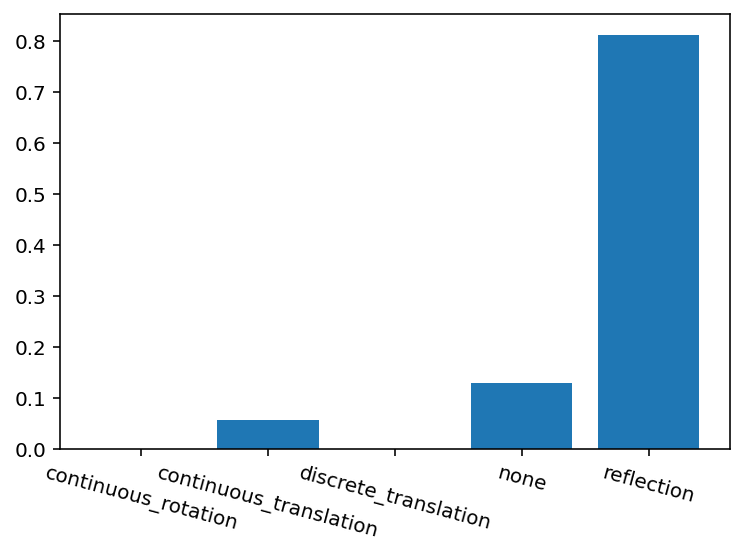

In [178]:
target = 'count'    # Nombre de la variable que queremos predecir
nombre_carpeta = 'DB_bikes' # Nombre de la subcarpeta donde vamos a guardar las PCAs, dentro de la carpeta grande. Así podemos analizar al mismo tiempo varias bases de datos

n_fea = 13              # Número de features finales que el algoritmo escoge para hacer parejas y analizar con ellas la simetría

lim_sym = 0.85          # Límite de probabilidad para decidir que el algoritmo ha encontrado o no una simetría

limit_pairs = False      # Al generar parejas, estas vienen acompañadas de un 'score'. Si esto es True, cogmos solo la mitad de las con mayor 'score'

select_10k = True       # Keep only 10000 elements of the original potential DF (useful)

interact = 'small'       # 'big', 'small', 'FW', False


# ------------------------------------------------------------------------------------------------------------------------#

i=0    
    
sym_feat_1 = []
sym_feat_2 = []
sym_feat_tags = []
sym_feat_probs = []
sym_feat_rmse = []
syms_tot = ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
registro = pd.DataFrame(columns = syms_tot)
# Tiempo en el que empezamos a procesar
from time import time
start_time = time()


from fastai.vision.all import *
from time import time
from IPython.utils import io



muchos = False # Si es false, para muchos potenciales, mete cada combinación de variables en una carpeta separada, para que sea fácil ver si hay simetría ahí
               # Si es true, van todos a la misma carpeta


# ------------------- Folder PCA ------------------- #

folder = 'PCAs_DB_2'   # Carpeta donde se guardan las subcarpetas con las PCAs

dd = top_dir + '/' + folder
if not os.path.isdir(dd):
    print('Creating directory:\n',dd)
    os.mkdir(dd)

dir = os.path.join(top_dir,folder)

#------------------------------ Generar Potenciales ---------------------------#

potenciales = [df_e]
potenciales_tags = [nombre_carpeta]
tags = potenciales_tags
num_pot = len(potenciales)

# ------------------- No prints al guardar mejor modelo (fastai) ------------------- # 
# Solo hay un print que se ha eliminado del código original
class SaveModelCallback(TrackerCallback):
    "A `TrackerCallback` that saves the model's best during training and loads it at the end."
    _only_train_loop = True
    def __init__(self, monitor='valid_loss', comp=None, min_delta=0., fname='model', every_epoch=False, at_end=False,
                 with_opt=False, reset_on_fit=True):
        super().__init__(monitor=monitor, comp=comp, min_delta=min_delta, reset_on_fit=reset_on_fit)
        assert not (every_epoch and at_end), "every_epoch and at_end cannot both be set to True"
        # keep track of file path for loggers
        self.last_saved_path = None
        store_attr('fname,every_epoch,at_end,with_opt')

    def _save(self, name): self.last_saved_path = self.learn.save(name, with_opt=self.with_opt)

    def after_epoch(self):
        "Compare the value monitored to its best score and save if best."
        if self.every_epoch: self._save(f'{self.fname}_{self.epoch}')
        else: #every improvement
            super().after_epoch()
            if self.new_best:
                #print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
                self._save(f'{self.fname}')

    def after_fit(self, **kwargs):
        "Load the best model."
        if self.at_end: self._save(f'{self.fname}')
        elif not self.every_epoch: self.learn.load(f'{self.fname}', with_opt=self.with_opt)

# ---------------- Definiciones previas e hiperparámetros ----------------- #

#Guardo los modelos para analizarlos luego
models = [] 
to_s = []

#Guardaremos los resultados de la PCA en un array 
PCA_s = []
PCA_s_tag = []

# Hyperparameters: 
bs_choices = [50000]       # Batch Size
shape='pipe'               # Shape of the neural network
layers_choices = [5]       # Number of layers of the net. Default:10 or 5 results with 5
neurons_choices = [100]    # Number of neurons per layer. Default:200 results with 200
epoch_choices = [150]      # Number of training epochs. Default:200 results with 60
lr_choices = [0.01]       # Max learning rate 
valid_pct=0.2              # Part of the data that goes into validation (0.2 = 20%)
monitor= 'valid_loss'        # Te model with the least 'monitor' will be saved



# ---------------------- Entrenar Red Y PCA -----------------------------------#

j = 1 # Usaremos esto para saber cuantos potenciales hemos procesado, y como indice en general

for df in potenciales:
    
    df[target] = df[target]/np.max(df[target]) #Normalizar la columna objetivo es importante

    #------------------------------ Feature Importance  ---------------------------#

    if select_10k == True:
        if len(df[target]) <= 100*100:
            print('Too little data to keep 10k points and delete the rest')
        else:
            print('Keeping 10k points of the original DF')
            remove_n = len(df[target]) - 10000
            drop_indices = np.random.choice(df.index, remove_n, replace=False)
            df_temp = df.drop(drop_indices)
            df = df_temp.copy()


            
    if interact == 'big':
        print('---- Big interactions ----')
        bbb = df[target]
        df = df.drop(target,axis = 1)
        df = my_interactions(df, numo_int = 10, verbose = True)
        df[target] = bbb
        
    elif interact == 'small':
        print('---- Small interactions ----')
        bbb = df[target]
        df = df.drop(target,axis = 1)
        df = my_interactions_small(df, numo_int = 10, verbose = True)
        df[target] = bbb
        
    elif interact == 'FW':
        print('---- Interactions by featurewiz ----')
        with io.capture_output() as captured2: output = featurewiz(df, target, corr_limit=0.10,
                                                        verbose=0, sep=',', header=0, test_data='',
                                                        category_encoders='',feature_engg='interactions')   
        df = output[1].copy()
        
    elif interact == False:
        print('No interactions')


    #df = regularize_df(df)
    
    print('---Selecting Best Features---')
    best_pairs = n_best_rf_phi_k(df, target = target, n = n_fea, nf = 30, lim_corr = 0.85)

    best_n = [best_pairs['f1'][0]] + list(best_pairs['f2'].unique())

    print('Best Features: ',best_n)

    #small_df = df[best_n]
    #small_df[target] = df[target]


    cols = best_n
    a = cols

    verbose = 1



    df_org = df.copy()

    if limit_pairs == True:
        medi = best_pairs.score.median()
        num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
    else:
        medi = 0
        num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])

    for f1,f2,lll in zip(best_pairs.f1,best_pairs.f2,range(len(best_pairs.f1))):
        if best_pairs.score[lll] >= medi:

            i+=1

            print(f1,f2)
            feas = [f1,f2]

            # Debemos marcar cada potencial para tener claro a qué tipo de simetria corresponde cada PCA
            PCA_s_tag.append(tags[j-1])

            df2 = df[feas + [target]].copy() 
            #df2 = df2[feas + [target]].copy()
            
            #Normlizamos las features y hacemos que vayan entre -1 y 1
            df2[f1] = 2*(df2[f1]/np.max(df2[f1]))-1
            df2[f2] = 2*(df2[f2]/np.max(df2[f2]))-1

            splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

            to = TabularPandas(df2,
                            procs=[Categorify,FillMissing, Normalize],
                            cont_names = feas,
                            y_names = target,
                            splits=splits)

            train_size = len(splits[0])
            valid_size = len(splits[1])

            # ----------------- Hyperparameters ------------------- #

            # Batch Size (a large one)
            bs=min(random.choice(bs_choices),train_size)  
            print('{} batch size for training.\n'.format(bs))

            # Neurons per layer
            neurons_per_layer = random.choice(neurons_choices)

            # Number of layers
            n_layers = random.choice(layers_choices)

            #Shape of the net: Pipe or funnel
            if shape == 'pipe':
                layers=[neurons_per_layer for i in range(n_layers)]

            if shape == 'funnel':
                n_eff = n_layers
                layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

            print('Training FCNN with layers: ',layers)

            #Number of epochs
            n_epoch=random.choice(epoch_choices)
            print('Training for {} epochs.'.format(n_epoch))

            # Maximum Learning Rate: (a good value can be found using learn.lr_find())
            lr_max=float(random.choice(lr_choices))
            print('Using lr_max = ',format(lr_max))

            # ----------------------------------------------------- #

            # --------------- Training the FCNN --------------------#

            # Load the data into a DataLoader
            dls = to.dataloaders(bs=bs)

            # Define a Tabular Learner
            learn = tabular_learner(dls, layers=layers
                                #,config=config
                                #,metrics=[mse],
                                #y_range = [min(df.bin),max(df.bin)],
                                #,cbs=ShowGraphCallback()
                                #,train_bn=False)
                                )

            # Train the net 
            with learn.no_logging():
                learn.fit_one_cycle(n_epoch=n_epoch
                                    ,lr_max=lr_max
                                    ,cbs=[SaveModelCallback(monitor=monitor)]
                                    )

                preds, targs = learn.get_preds()

            ff = (preds-targs)**2/len(targs)
            ff = sum(ff)
            RMSE = np.sqrt(ff)
            #print('RMSE:',float(RMSE))
            nrmsei = float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))

            # Guardamos modelos y tabular objects para el posterior analisis
            models.append(learn)
            to_s.append(to)

            # ------------------------------------------------------#


            # ------------------------- PCA ------------------------#

            test_df = df2.copy()
            dl = learn.dls.test_dl(test_df,bs=int(test_df.shape[0])) 

            # Tenemos que hacer un Hook, una especie de gancho que enganchamos en la última capa interna,
            # para guardar, de cada modelo, los valores de los parámetro de dicha capa. 
            with Hooks(learn.model.layers, lambda m,i,o: o) as h:
                preds = learn.get_preds(dl=dl,with_input=True,with_decoded=True,with_loss=True)

            targets=preds[2].numpy().flatten()

            # Cogemos la información de la penúltima capa
            # OJO: Si añadimos y_range, se añade automaticamente una sigmoid
            # al final, por lo que tendríamos que coger la capa -3 en vez de la -2
            act = h.stored[-2] 
            multi_dim=Tensor.cpu(act).numpy()
            standardized=StandardScaler().fit_transform(multi_dim)

            viz = PCA(2).fit_transform(np.nan_to_num(standardized))
            #plt.figure()
            #plt.scatter(viz[:, 0], viz[:, 1],c=targets[:multi_dim.shape[0]],alpha=.1, marker = 'o')

            PCA_s.append(viz)

            # ------------------------------------------------------ #

            # ------------------ Saving the PCA's ------------------ #

            # ---- Dar formato a PCA para guardar como imagen con color

            viz = pd.DataFrame(viz) #Transformamos la PCA en un dataframe
            viz.columns = ['x','y'] #Nombres de las columnas

            # Insertamos una columna con los colores de los puntos. El valor del potencial
            # objetivo (targets) es el color, y hay un color por cada punto 
            viz.insert(2,'class',targets[:multi_dim.shape[0]]) 

            # ---- Personalizar mapa de color 

            n_classes=1000

            colors = 'rainbow'

            if colors == 'rainbow':
                my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                classes_in_rgb = my_cmap(range(n_classes))
            if colors == 'purple':
                my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                classes_in_rgb = np.vstack((np.array([0,0,0,0]),my_cmap([0 for i in range(n_classes)])))

            # ---- Hacer que la intensidad del pixel represente la cantidad de puntos 
            #      acumuldos en un pixel

            n_pixels = 224

            binning_3d=np.histogramdd([viz['x'],viz['y'],viz['class']],range=(None,None,(0,1)), bins=(n_pixels,n_pixels,n_classes))

            #if we want the pixel intensity to reprensent the number of points at that location
            array = np.dot(binning_3d[0],classes_in_rgb)
            array = array/np.amax(array)

            # ---- Guardar la PCA

            #Directorio donde guardaremos las imagenes
            nami = '_'+str(feas[0])+'+'+str(feas[1])+'_'
            if muchos == False: 
                dir_sym = os.path.join(dir,tags[j-1],nami)
                img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+'__PCA.png' 
            else:
                dir_sym = os.path.join(dir,tags[j-1])
                img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+nami+'__PCA.png' 

            if not os.path.isdir(dir_sym):
                print('Creating directory:\n',dir_sym)
                os.makedirs(dir_sym)


            # Nombre de la imagen. Pongo el tiempo para que todas se llamen distinto cada vez.
            output_dir = os.path.join(dir_sym,img_file) # Directorio donde guardamos la imagen
            plt.imsave(output_dir,array) # Guardar
            print('\nPCA saved to:\n{}\n'.format(dir_sym+'/'+img_file))


            # ------------------------ Symmetry Analyzer --------------------- #
            drr = pca_sym_finder(output_dir)
            brr = list(drr.iloc[np.where(drr.value > lim_sym)].symmetry)
            if len(brr) > 0:
                print('Found {} symmetry with features {} and {}, with prob. {}'.format(brr[0],f1,f2,float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4))))                
                sym_feat_1.append(f1)
                sym_feat_2.append(f2)
                sym_feat_tags.append(brr[0])
                sym_feat_probs.append(float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4)))
                sym_feat_rmse.append(nrmsei)




            # ------------------------ Time -------------------------#

            minutes_until_now = (time() - start_time)/60
            images_done = i
            minutes_per_image = minutes_until_now/(images_done)
            hours_left = minutes_per_image * (num_pot*num_2-images_done)/60
            print("\n{} PCA's made out of {}.\n".format(images_done,num_pot*num_2))
            print("{:.1f} minutes elapsed for {} images.".format(minutes_until_now,images_done))
            print("{:.1f} minutes average per image.".format(minutes_until_now/images_done))
            print("{:.1f} minutes estimated left for {} images.\n\n\n".format(hours_left*60,num_pot*num_2-images_done))
            print("{:.1f} hours estimated left for {} images.\n\n\n".format(hours_left,num_pot*num_2-images_done))




    j+=1


          # ------------------------------------------------------#'''

results = pd.DataFrame({'symmetry':sym_feat_tags, 'feature_1':sym_feat_1, 'feature_2':sym_feat_2, 'probability':sym_feat_probs, 'NRMSE':sym_feat_rmse})

vc = results.symmetry.value_counts()



for sym_sum in syms_tot:
    if not hasattr(vc,sym_sum):
        vc[sym_sum] = 0


nr = pd.DataFrame({'continuous_rotation':vc['continuous_rotation'], 
                   'continuous_translation':vc['continuous_translation'], 
                   'discrete_translation':vc['discrete_translation'], 
                   'none':vc['none'], 
                   'reflection':vc['reflection']}, index = [0])

registro = registro.append(nr, ignore_index=True)


plt.xticks(rotation = -15)
plt.bar(registro.columns,registro.sum()/registro.sum().sum())


In [179]:
results.iloc[np.where(results.symmetry != 'none')].sort_values('NRMSE', ascending = True)

,symmetry,feature_1,feature_2,probability,NRMSE
0,reflection,1atemp**2+1datetime**2,1humidity**2+1workingday**2,1.0000,0.182953
2,reflection,1atemp**2+1datetime**2,1weather+1humidity,1.0000,0.183972
8,reflection,1humidity**2+1workingday**2,datetime**2,1.0000,0.185690
1,reflection,1atemp**2+1datetime**2,1holiday**2+1humidity**2,1.0000,0.185785
31,reflection,1atemp+1temp,1datetime+1weather,1.0000,0.186561
48,reflection,1atemp**2+1datetime**2,1datetime+1weather,1.0000,0.187947
7,reflection,1datetime+1workingday,1holiday**2+1humidity**2,0.9988,0.188553
44,reflection,1atemp**2+1datetime**2,1datetime+1workingday,0.9999,0.188613
56,reflection,1atemp+1holiday,1datetime+1holiday,1.0000,0.189337
12,reflection,1datetime+1workingday,1atemp+1temp,0.9999,0.189438


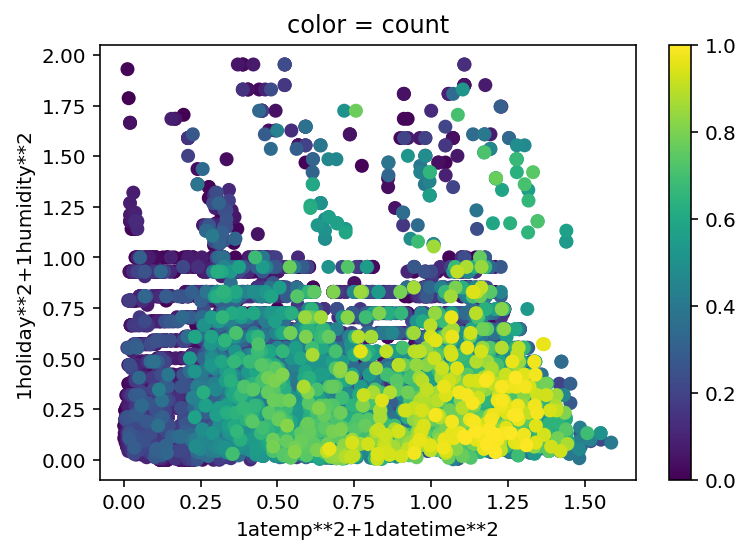

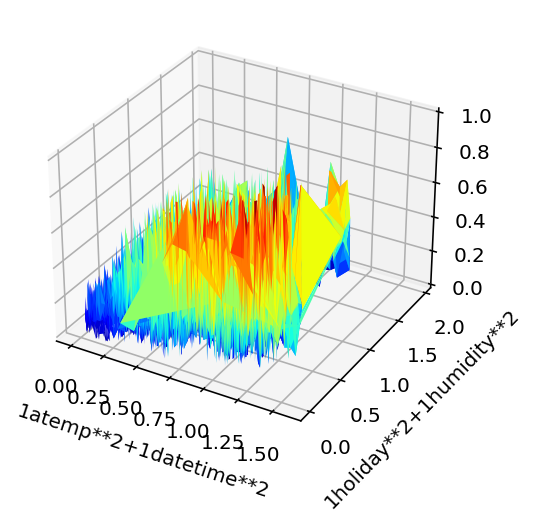

In [186]:
res_plot(df.sort_values(target), results, num = 1, logs = False)

Text(0, 0.5, 'atemp')

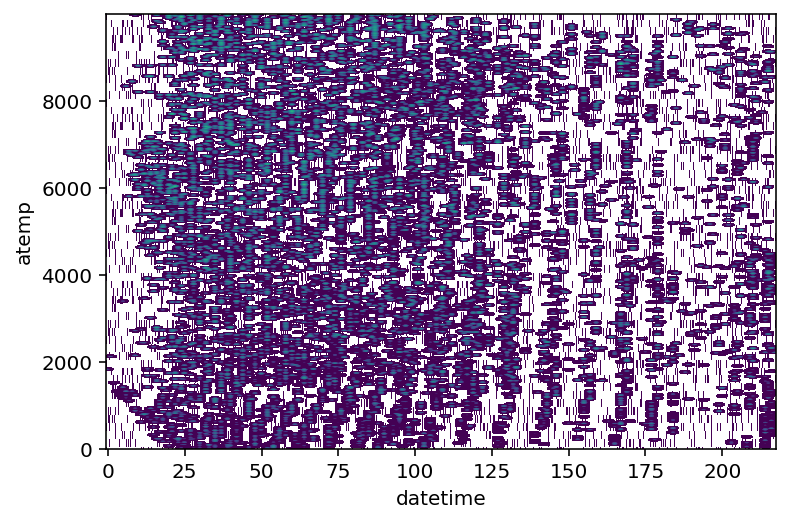

In [190]:
axs = plt.subplot2grid((1,1), (0, 0))
img_array= np.array(pd.pivot_table(df.sort_values(target),index='1atemp**2+1datetime**2',columns='1weather+1humidity',values='count', fill_value=0))
axs.imshow(img_array, aspect = 'auto', norm = LogNorm(), interpolation =  'gaussian', origin = 'lower')
plt.xlabel('datetime')
plt.ylabel('atemp')

In [193]:
img_array.reshape([10000,-1])

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

# e+e- --> Z --> e+e-

In [21]:
gve = 1
gae = 0

folder_0 = 'cross_section'
name = 'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) + '.csv'



df_e = pd.read_csv(os.path.join(folder_0,name))

categ = []
numer = []

# ----------------------------------- #

target = 'diff_sigma'
quantiles = True
range_cols = True   # Si quantiles == True, las columnas distintas de la target las escala entre -1 y 1.
ignore_list = ['Pz1','Pz2', 'E2', 's', 'cos_theta']


# --------------------------------------#
for col in list(df_e.columns):
    if (col != target) and (col not in ignore_list):
        if type(df_e[col][0]) == str:
            categ.append(col)
        else:
            numer.append(col)

splits = RandomSplitter(valid_pct=0)(range_of(df_e))

to = TabularPandas(df_e,
                procs=[Categorify,FillMissing],
                cat_names = categ,
                cont_names = numer,
                y_names = target,
                splits=splits)


#equiv_CNACE = pd.DataFrame({'Cod_Num':list(to.xs['CNACE'].unique()),'Categ':list(dls.dsets['CNACE'].unique())}).sort_values(by = 'Categ')
#equiv_CNO1 = pd.DataFrame({'Cod_Num':list(to.xs['CNO1'].unique()),'Categ':list(dls.dsets['CNO1'].unique())}).sort_values(by = 'Categ')

df_e = pd.DataFrame(to.xs)
df_e[target] = to.y
df_e = df_e.reset_index().drop('index', axis = 1)  

for col in df_e.columns:
    df_e[col] = np.nan_to_num(df_e[col])   
    if quantiles == True:
        n_attempted_bins =  len(df_e[col])
        binning = pd.qcut(df_e[col], q=n_attempted_bins, retbins=True, labels=False, duplicates='drop')
        df_e[col]=binning[0]/np.max(binning[0])
        df_e[col] = np.nan_to_num(df_e[col])
        if (range_cols == True) and (col != target): 
            df_e[col] = df_e[col]*2 - 1



df_e.head()

,Px1,Py1,E1,Px2,Py2,diff_sigma
0,0.660106,0.340414,-1.0,-0.660106,-0.340414,0.648140
1,-0.227049,-0.559822,-1.0,0.227049,0.559822,0.771091
2,-0.505540,0.377495,-1.0,0.505540,-0.377495,0.756940
3,-0.277811,0.237489,-1.0,0.277811,-0.237489,0.929688
4,-0.564543,0.112645,-1.0,0.564543,-0.112645,0.800112


No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
40000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings/_Py2+Px2_/Ze+e-_couplings_11638536768__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1 PCA's made out of 1.

0.1 minutes elapsed for 1 images.
0.1 minutes average per image.
0.0 minutes estimated left for 0 images.



0.0 hours estimated left for 0 images.



Index(['continuous_rotation', 'continuous_translation', 'discrete_translation',
       'none', 'reflection'],
      dtype='object')
continuous_rotation       0.0
continuous_translation    0.0
discrete_translation      0.0
none                      0.0
reflection                1.0
dtype: float64


<BarContainer object of 5 artists>

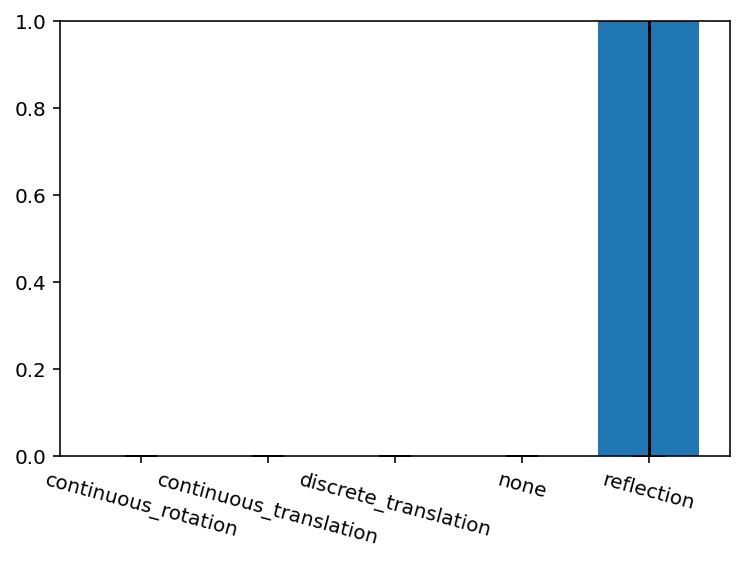

In [22]:
target = 'diff_sigma'    # Nombre de la variable que queremos predecir
nombre_carpeta = 'Ze+e-_couplings' # Nombre de la subcarpeta donde vamos a guardar las PCAs, dentro de la carpeta grande. Así podemos analizar al mismo tiempo varias bases de datos

n_fea = 13              # Número de features finales que el algoritmo escoge para hacer parejas y analizar con ellas la simetría

lim_sym = 0.7          # Límite de probabilidad para decidir que el algoritmo ha encontrado o no una simetría

limit_pairs = False      # Al generar parejas, estas vienen acompañadas de un 'score'. Si esto es True, cogmos solo la mitad de las con mayor 'score'

select_10k = False       # Keep only 10000 elements of the original potential DF (useful)

interact = False        # 'big', 'small', 'FW', False

rep_todo = 1

# ------------------------------------------------------------------------------------------------------------------------#

i=0    
    
sym_feat_1 = []
sym_feat_2 = []
sym_feat_tags = []
sym_feat_probs = []
sym_feat_rmse = []
syms_tot = ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
registro = pd.DataFrame(columns = syms_tot)
# Tiempo en el que empezamos a procesar
from time import time
start_time = time()


from fastai.vision.all import *
from time import time
from IPython.utils import io



muchos = False # Si es false, para muchos potenciales, mete cada combinación de variables en una carpeta separada, para que sea fácil ver si hay simetría ahí
               # Si es true, van todos a la misma carpeta


# ------------------- Folder PCA ------------------- #

folder = 'Ze+e-_2'   # Carpeta donde se guardan las subcarpetas con las PCAs

dd = top_dir + '/' + folder
if not os.path.isdir(dd):
    print('Creating directory:\n',dd)
    os.mkdir(dd)

dir = os.path.join(top_dir,folder)

#------------------------------ Generar Potenciales ---------------------------#

potenciales = [df_e]
potenciales_tags = [nombre_carpeta for k in range(rep_todo)]
tags = potenciales_tags
num_pot = len(potenciales)

# ------------------- No prints al guardar mejor modelo (fastai) ------------------- # 
# Solo hay un print que se ha eliminado del código original
class SaveModelCallback(TrackerCallback):
    "A `TrackerCallback` that saves the model's best during training and loads it at the end."
    _only_train_loop = True
    def __init__(self, monitor='valid_loss', comp=None, min_delta=0., fname='model', every_epoch=False, at_end=False,
                 with_opt=False, reset_on_fit=True):
        super().__init__(monitor=monitor, comp=comp, min_delta=min_delta, reset_on_fit=reset_on_fit)
        assert not (every_epoch and at_end), "every_epoch and at_end cannot both be set to True"
        # keep track of file path for loggers
        self.last_saved_path = None
        store_attr('fname,every_epoch,at_end,with_opt')

    def _save(self, name): self.last_saved_path = self.learn.save(name, with_opt=self.with_opt)

    def after_epoch(self):
        "Compare the value monitored to its best score and save if best."
        if self.every_epoch: self._save(f'{self.fname}_{self.epoch}')
        else: #every improvement
            super().after_epoch()
            if self.new_best:
                #print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
                self._save(f'{self.fname}')

    def after_fit(self, **kwargs):
        "Load the best model."
        if self.at_end: self._save(f'{self.fname}')
        elif not self.every_epoch: self.learn.load(f'{self.fname}', with_opt=self.with_opt)

# ---------------- Definiciones previas e hiperparámetros ----------------- #

#Guardo los modelos para analizarlos luego
models = [] 
to_s = []

#Guardaremos los resultados de la PCA en un array 
PCA_s = []
PCA_s_tag = []

# Hyperparameters: 
bs_choices = [50000]       # Batch Size
shape='pipe'               # Shape of the neural network
layers_choices = [5]       # Number of layers of the net. Default:10 or 5 results with 5
neurons_choices = [200]    # Number of neurons per layer. Default:200 results with 200
epoch_choices = [50]      # Number of training epochs. Default:200 results with 100
lr_choices = [0.01]       # Max learning rate 
valid_pct=0.2              # Part of the data that goes into validation (0.2 = 20%)
monitor= 'valid_loss'        # Te model with the least 'monitor' will be saved



# ---------------------- Entrenar Red Y PCA -----------------------------------#

j = 1 # Usaremos esto para saber cuantos potenciales hemos procesado, y como indice en general

for rtd in range(rep_todo):
    for df in potenciales:

        df[target] = df[target]/np.max(df[target]) #Normalizar la columna objetivo es importante

        #------------------------------ Feature Importance  ---------------------------#

        if select_10k == True:
            if len(df[target]) <= 100*100:
                print('Too little data to keep 10k points and delete the rest')
            else:
                print('Keeping 10k points of the original DF')
                remove_n = len(df[target]) - 10000
                drop_indices = np.random.choice(df.index, remove_n, replace=False)
                df_temp = df.drop(drop_indices)
                df = df_temp.copy()



        if interact == 'big':
            print('---- Big interactions ----')
            bbb = df[target]
            df = df.drop(target,axis = 1)
            df = my_interactions(df, numo_int = 10, verbose = True)
            df[target] = bbb

        elif interact == 'small':
            print('---- Small interactions ----')
            bbb = df[target]
            df = df.drop(target,axis = 1)
            df = my_interactions_small(df, numo_int = 10, verbose = True)
            df[target] = bbb

        elif interact == 'FW':
            print('---- Interactions by featurewiz ----')
            with io.capture_output() as captured2: output = featurewiz(df, target, corr_limit=0.10,
                                                            verbose=0, sep=',', header=0, test_data='',
                                                            category_encoders='',feature_engg='interactions')   
            df = output[1].copy()

        elif interact == False:
            print('No interactions')


        #df = regularize_df(df)

        print('---Selecting Best Features---')
        best_pairs = n_best_rf_phi_k(df, target = target, n = n_fea, nf = 30, lim_corr = 0.85)

        best_n = [best_pairs['f1'][0]] + list(best_pairs['f2'].unique())

        print('Best Features: ',best_n)

        #small_df = df[best_n]
        #small_df[target] = df[target]


        cols = best_n
        a = cols

        verbose = 1



        df_org = df.copy()

        if limit_pairs == True:
            medi = best_pairs.score.median()
            num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
        else:
            medi = 0
            num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])

        for f1,f2,lll in zip(best_pairs.f1,best_pairs.f2,range(len(best_pairs.f1))):
            if best_pairs.score[lll] >= medi:

                i+=1

                print(f1,f2)
                feas = [f1,f2]

                # Debemos marcar cada potencial para tener claro a qué tipo de simetria corresponde cada PCA
                PCA_s_tag.append(tags[j-1])

                df2 = df[feas + [target]].copy() 
                #df2 = df2[feas + [target]].copy()

                #Normlizamos las features y hacemos que vayan entre -1 y 1
                df2[f1] = 2*(df2[f1]/np.max(df2[f1]))-1
                df2[f2] = 2*(df2[f2]/np.max(df2[f2]))-1

                splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

                to = TabularPandas(df2,
                                procs=[Categorify,FillMissing, Normalize],
                                cont_names = feas,
                                y_names = target,
                                splits=splits)

                train_size = len(splits[0])
                valid_size = len(splits[1])

                # ----------------- Hyperparameters ------------------- #

                # Batch Size (a large one)
                bs=min(random.choice(bs_choices),train_size)  
                print('{} batch size for training.\n'.format(bs))

                # Neurons per layer
                neurons_per_layer = random.choice(neurons_choices)

                # Number of layers
                n_layers = random.choice(layers_choices)

                #Shape of the net: Pipe or funnel
                if shape == 'pipe':
                    layers=[neurons_per_layer for i in range(n_layers)]

                if shape == 'funnel':
                    n_eff = n_layers
                    layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

                print('Training FCNN with layers: ',layers)

                #Number of epochs
                n_epoch=random.choice(epoch_choices)
                print('Training for {} epochs.'.format(n_epoch))

                # Maximum Learning Rate: (a good value can be found using learn.lr_find())
                lr_max=float(random.choice(lr_choices))
                print('Using lr_max = ',format(lr_max))

                # ----------------------------------------------------- #

                # --------------- Training the FCNN --------------------#

                # Load the data into a DataLoader
                dls = to.dataloaders(bs=bs)

                # Define a Tabular Learner
                learn = tabular_learner(dls, layers=layers
                                    #,config=config
                                    #,metrics=[mse],
                                    #y_range = [min(df.bin),max(df.bin)],
                                    #,cbs=ShowGraphCallback()
                                    #,train_bn=False)
                                    )

                # Train the net 
                with learn.no_logging():
                    learn.fit_one_cycle(n_epoch=n_epoch
                                        ,lr_max=lr_max
                                        ,cbs=[SaveModelCallback(monitor=monitor)]
                                        )

                    preds, targs = learn.get_preds()

                ff = (preds-targs)**2/len(targs)
                ff = sum(ff)
                RMSE = np.sqrt(ff)
                #print('RMSE:',float(RMSE))
                nrmsei = float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))

                # Guardamos modelos y tabular objects para el posterior analisis
                models.append(learn)
                to_s.append(to)

                # ------------------------------------------------------#


                # ------------------------- PCA ------------------------#

                test_df = df2.copy()
                dl = learn.dls.test_dl(test_df,bs=int(test_df.shape[0])) 

                # Tenemos que hacer un Hook, una especie de gancho que enganchamos en la última capa interna,
                # para guardar, de cada modelo, los valores de los parámetro de dicha capa. 
                with Hooks(learn.model.layers, lambda m,i,o: o) as h:
                    preds = learn.get_preds(dl=dl,with_input=True,with_decoded=True,with_loss=True)

                targets=preds[2].numpy().flatten()

                # Cogemos la información de la penúltima capa
                # OJO: Si añadimos y_range, se añade automaticamente una sigmoid
                # al final, por lo que tendríamos que coger la capa -3 en vez de la -2
                act = h.stored[-2] 
                multi_dim=Tensor.cpu(act).numpy()
                standardized=StandardScaler().fit_transform(multi_dim)

                viz = PCA(2).fit_transform(np.nan_to_num(standardized))
                #plt.figure()
                #plt.scatter(viz[:, 0], viz[:, 1],c=targets[:multi_dim.shape[0]],alpha=.1, marker = 'o')

                PCA_s.append(viz)

                # ------------------------------------------------------ #

                # ------------------ Saving the PCA's ------------------ #

                # ---- Dar formato a PCA para guardar como imagen con color

                viz = pd.DataFrame(viz) #Transformamos la PCA en un dataframe
                viz.columns = ['x','y'] #Nombres de las columnas

                # Insertamos una columna con los colores de los puntos. El valor del potencial
                # objetivo (targets) es el color, y hay un color por cada punto 
                viz.insert(2,'class',targets[:multi_dim.shape[0]]) 

                # ---- Personalizar mapa de color 

                n_classes=1000

                colors = 'rainbow'

                if colors == 'rainbow':
                    my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                    classes_in_rgb = my_cmap(range(n_classes))
                if colors == 'purple':
                    my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                    classes_in_rgb = np.vstack((np.array([0,0,0,0]),my_cmap([0 for i in range(n_classes)])))

                # ---- Hacer que la intensidad del pixel represente la cantidad de puntos 
                #      acumuldos en un pixel

                n_pixels = 224

                binning_3d=np.histogramdd([viz['x'],viz['y'],viz['class']],range=(None,None,(0,1)), bins=(n_pixels,n_pixels,n_classes))

                #if we want the pixel intensity to reprensent the number of points at that location
                array = np.dot(binning_3d[0],classes_in_rgb)
                array = array/np.amax(array)

                # ---- Guardar la PCA

                #Directorio donde guardaremos las imagenes
                nami = '_'+str(feas[0])+'+'+str(feas[1])+'_'
                if muchos == False: 
                    dir_sym = os.path.join(dir,tags[j-1],nami)
                    img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+'__PCA.png' 
                else:
                    dir_sym = os.path.join(dir,tags[j-1])
                    img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+nami+'__PCA.png' 

                if not os.path.isdir(dir_sym):
                    print('Creating directory:\n',dir_sym)
                    os.makedirs(dir_sym)


                # Nombre de la imagen. Pongo el tiempo para que todas se llamen distinto cada vez.
                output_dir = os.path.join(dir_sym,img_file) # Directorio donde guardamos la imagen
                plt.imsave(output_dir,array) # Guardar
                print('\nPCA saved to:\n{}\n'.format(dir_sym+'/'+img_file))


                # ------------------------ Symmetry Analyzer --------------------- #
                drr = pca_sym_finder(output_dir)
                brr = list(drr.iloc[np.where(drr.value > lim_sym)].symmetry)
                if len(brr) > 0:
                    print('Found {} symmetry with features {} and {}, with prob. {}'.format(brr[0],f1,f2,float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4))))                
                    sym_feat_1.append(f1)
                    sym_feat_2.append(f2)
                    sym_feat_tags.append(brr[0])
                    sym_feat_probs.append(float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4)))
                    sym_feat_rmse.append(nrmsei)




                # ------------------------ Time -------------------------#

                minutes_until_now = (time() - start_time)/60
                images_done = i
                minutes_per_image = minutes_until_now/(images_done)
                hours_left = minutes_per_image * (num_pot*rep_todo*num_2-images_done)/60
                print("\n{} PCA's made out of {}.\n".format(images_done,num_pot*num_2*rep_todo))
                print("{:.1f} minutes elapsed for {} images.".format(minutes_until_now,images_done))
                print("{:.1f} minutes average per image.".format(minutes_until_now/images_done))
                print("{:.1f} minutes estimated left for {} images.\n\n\n".format(hours_left*60,num_pot*num_2*rep_todo-images_done))
                print("{:.1f} hours estimated left for {} images.\n\n\n".format(hours_left,num_pot*num_2*rep_todo-images_done))




    j+=1


          # ------------------------------------------------------#'''

results = pd.DataFrame({'symmetry':sym_feat_tags, 'feature_1':sym_feat_1, 'feature_2':sym_feat_2, 'probability':sym_feat_probs, 'NRMSE':sym_feat_rmse})

vc = results.symmetry.value_counts()



for sym_sum in syms_tot:
    if not hasattr(vc,sym_sum):
        vc[sym_sum] = 0


nr = pd.DataFrame({'continuous_rotation':vc['continuous_rotation'], 
                   'continuous_translation':vc['continuous_translation'], 
                   'discrete_translation':vc['discrete_translation'], 
                   'none':vc['none'], 
                   'reflection':vc['reflection']}, index = [0])

registro = registro.append(nr, ignore_index=True)


plt.xticks(rotation = -15)
plt.ylim([0,1])
print(registro.columns)
print(registro.sum()/registro.sum().sum())
plt.bar(registro.columns,registro.sum()/registro.sum().sum(), yerr = np.sqrt(registro.sum())/registro.sum().sum(), capsize = 8)


Index(['continuous_rotation', 'continuous_translation', 'discrete_translation',
       'none', 'reflection'],
      dtype='object')
continuous_rotation       0.664773
continuous_translation    0.013636
discrete_translation      0.082955
none                      0.001136
reflection                0.237500
dtype: float64


<BarContainer object of 5 artists>

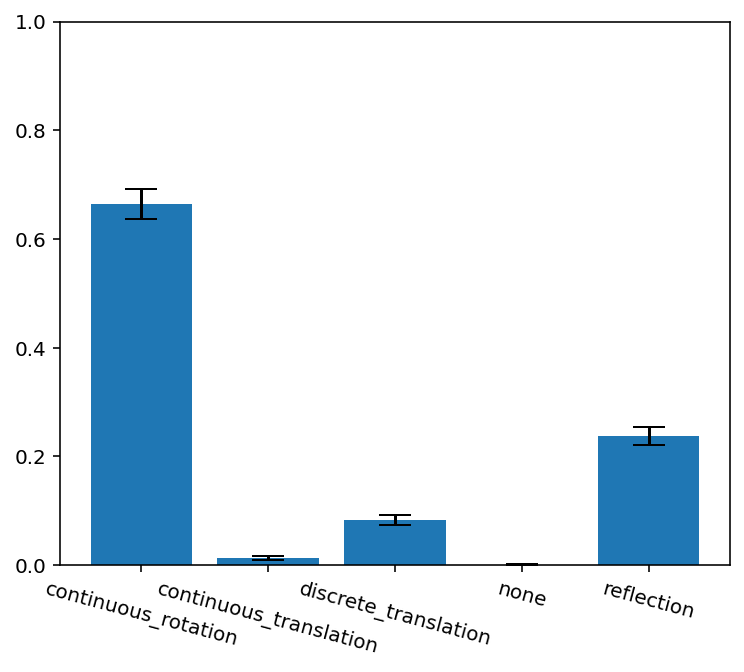

In [144]:
plt.figure(figsize = [6,5])
plt.xticks(rotation = -15)
plt.ylim([0,1])
print(registro.columns)
print(registro.sum()/registro.sum().sum())
plt.bar(registro.columns,registro.sum()/registro.sum().sum(), yerr = np.sqrt(registro.sum())/registro.sum().sum(), capsize = 8)


In [6]:
results.iloc[np.where(results.symmetry != 'none')].sort_values('NRMSE', ascending = True)

,symmetry,feature_1,feature_2,probability,NRMSE
0,discrete_translation,Px1,Py2,0.8488,0.270546


In [23]:
i = 0

0


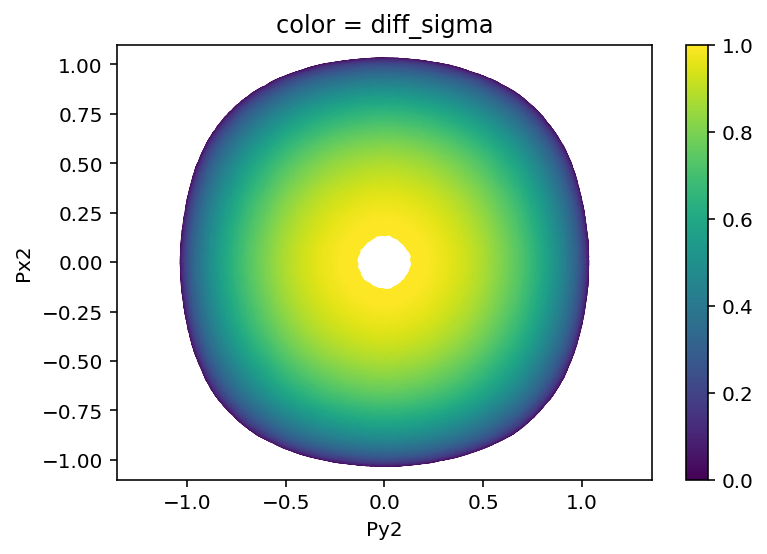

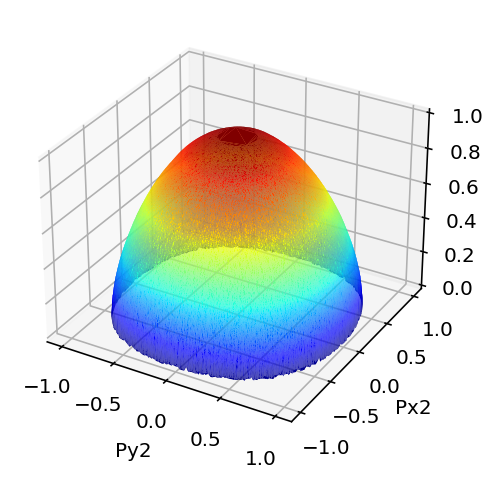

In [24]:
print(i)
res_plot(df.sort_values(target), results, num = i, logs = False)
i+=1

Text(0, 0.5, 'Diff cross section')

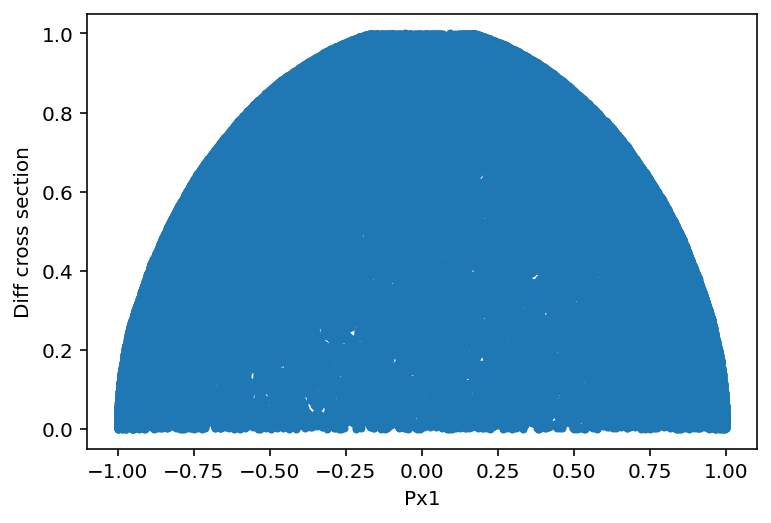

In [25]:
a = 'Px1'
plt.scatter(df[a],df.diff_sigma,marker = '.')
plt.xlabel(a)
plt.ylabel('Diff cross section')

# Different Couplings

In [61]:
# ----------------------------------- #

target = 'diff_sigma'  # Nombre de la variable que queremos predecir
quantiles = True
range_cols = True   # Si quantiles == True, las columnas distintas de la target las escala entre -1 y 1.
ignore_list = ['Pz1','Pz2', 'E2', 's', 'cos_theta']

nombre_carpeta = 'Ze+e-_couplings_ratio_test' # Nombre de la subcarpeta donde vamos a guardar las PCAs, dentro de la carpeta grande. Así podemos analizar al mismo tiempo varias bases de datos

n_fea = 13              # Número de features finales que el algoritmo escoge para hacer parejas y analizar con ellas la simetría

lim_sym = 0.7          # Límite de probabilidad para decidir que el algoritmo ha encontrado o no una simetría

limit_pairs = False      # Al generar parejas, estas vienen acompañadas de un 'score'. Si esto es True, cogmos solo la mitad de las con mayor 'score'

select_10k = True       # Keep only 10000 elements of the original potential DF (useful)

interact = False        # 'big', 'small', 'FW', False

rep_todo = 2


#gve_l = [1,0.9,0.85,0.8,0.7,0.5,0.3,0.2,0.15,0.1,0]
#gae_l = [0,0.1,0.15,0.2,0.3,0.5,0.7,0.8,0.85,0.9,1]

#rs = [0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]
rs = [1]
ind_ord = [l for l in range(len(rs))]
gae_l = [1 for r in rs]
gve_l = [np.round(r,4) for r in rs]
    

# --------------------------------------#

i=0 
from time import time
start_time = time()

syms_tot = ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
registro = pd.DataFrame(columns = syms_tot)
registros = []

num_g = len(gve_l)

for  gve,gae,indo in zip(gve_l,gae_l,ind_ord):
    
    print('**** gv_e = {} **** ga_e = {} ****'.format(gve,gae))

    folder_0 = 'cross_section'
    name = 'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) + '.csv'


    df_e = pd.read_csv(os.path.join(folder_0,name))

    categ = []
    numer = []


    for col in list(df_e.columns):
        if (col != target) and (col not in ignore_list):
            if type(df_e[col][0]) == str:
                categ.append(col)
            else:
                numer.append(col)

    splits = RandomSplitter(valid_pct=0)(range_of(df_e))

    to = TabularPandas(df_e,
                    procs=[Categorify,FillMissing],
                    cat_names = categ,
                    cont_names = numer,
                    y_names = target,
                    splits=splits)


    #equiv_CNACE = pd.DataFrame({'Cod_Num':list(to.xs['CNACE'].unique()),'Categ':list(dls.dsets['CNACE'].unique())}).sort_values(by = 'Categ')
    #equiv_CNO1 = pd.DataFrame({'Cod_Num':list(to.xs['CNO1'].unique()),'Categ':list(dls.dsets['CNO1'].unique())}).sort_values(by = 'Categ')

    df_e = pd.DataFrame(to.xs)
    df_e[target] = to.y
    df_e = df_e.reset_index().drop('index', axis = 1)  

    for col in df_e.columns:
        df_e[col] = np.nan_to_num(df_e[col])   
        if quantiles == True:
            n_attempted_bins =  len(df_e[col])
            binning = pd.qcut(df_e[col], q=n_attempted_bins, retbins=True, labels=False, duplicates='drop')
            df_e[col]=binning[0]/np.max(binning[0])
            df_e[col] = np.nan_to_num(df_e[col])
            if (range_cols == True) and (col != target): 
                df_e[col] = df_e[col]*2 - 1





    # ------------------------------------------------------------------------------------------------------------------------#

   

    sym_feat_1 = []
    sym_feat_2 = []
    sym_feat_tags = []
    sym_feat_probs = []
    sym_feat_rmse = []

    # Tiempo en el que empezamos a procesar



    from fastai.vision.all import *
    from time import time
    from IPython.utils import io



    muchos = False # Si es false, para muchos potenciales, mete cada combinación de variables en una carpeta separada, para que sea fácil ver si hay simetría ahí
                   # Si es true, van todos a la misma carpeta


    # ------------------- Folder PCA ------------------- #

    folder = 'Ze+e-_2'   # Carpeta donde se guardan las subcarpetas con las PCAs

    dd = top_dir + '/' + folder
    if not os.path.isdir(dd):
        print('Creating directory:\n',dd)
        os.mkdir(dd)

    dir = os.path.join(top_dir,folder)

    #------------------------------ Generar Potenciales ---------------------------#

    potenciales = [df_e]
    potenciales_tags = [nombre_carpeta for k in range(rep_todo)]
    tags = potenciales_tags
    num_pot = len(potenciales)

    # ------------------- No prints al guardar mejor modelo (fastai) ------------------- # 
    # Solo hay un print que se ha eliminado del código original
    class SaveModelCallback(TrackerCallback):
        "A `TrackerCallback` that saves the model's best during training and loads it at the end."
        _only_train_loop = True
        def __init__(self, monitor='valid_loss', comp=None, min_delta=0., fname='model', every_epoch=False, at_end=False,
                     with_opt=False, reset_on_fit=True):
            super().__init__(monitor=monitor, comp=comp, min_delta=min_delta, reset_on_fit=reset_on_fit)
            assert not (every_epoch and at_end), "every_epoch and at_end cannot both be set to True"
            # keep track of file path for loggers
            self.last_saved_path = None
            store_attr('fname,every_epoch,at_end,with_opt')

        def _save(self, name): self.last_saved_path = self.learn.save(name, with_opt=self.with_opt)

        def after_epoch(self):
            "Compare the value monitored to its best score and save if best."
            if self.every_epoch: self._save(f'{self.fname}_{self.epoch}')
            else: #every improvement
                super().after_epoch()
                if self.new_best:
                    #print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
                    self._save(f'{self.fname}')

        def after_fit(self, **kwargs):
            "Load the best model."
            if self.at_end: self._save(f'{self.fname}')
            elif not self.every_epoch: self.learn.load(f'{self.fname}', with_opt=self.with_opt)

    # ---------------- Definiciones previas e hiperparámetros ----------------- #

    #Guardo los modelos para analizarlos luego
    models = [] 
    to_s = []

    #Guardaremos los resultados de la PCA en un array 
    PCA_s = []
    PCA_s_tag = []

    # Hyperparameters: 
    bs_choices = [50000]       # Batch Size
    shape='pipe'               # Shape of the neural network
    layers_choices = [5]       # Number of layers of the net. Default:10 or 5 results with 5
    neurons_choices = [200]    # Number of neurons per layer. Default:200 results with 200
    epoch_choices = [50]      # Number of training epochs. Default:200 results with 100
    lr_choices = [0.01]       # Max learning rate 
    valid_pct=0.2              # Part of the data that goes into validation (0.2 = 20%)
    monitor= 'valid_loss'        # Te model with the least 'monitor' will be saved



    # ---------------------- Entrenar Red Y PCA -----------------------------------#

    j = 1 # Usaremos esto para saber cuantos potenciales hemos procesado, y como indice en general

    for rtd in range(rep_todo):
        for df in potenciales:

            df[target] = df[target]/np.max(df[target]) #Normalizar la columna objetivo es importante

            #------------------------------ Feature Importance  ---------------------------#

            if select_10k == True:
                if len(df[target]) <= 100*100:
                    print('Too little data to keep 10k points and delete the rest')
                else:
                    print('Keeping 10k points of the original DF')
                    remove_n = len(df[target]) - 10000
                    drop_indices = np.random.choice(df.index, remove_n, replace=False)
                    df_temp = df.drop(drop_indices)
                    df = df_temp.copy()



            if interact == 'big':
                print('---- Big interactions ----')
                bbb = df[target]
                df = df.drop(target,axis = 1)
                df = my_interactions(df, numo_int = 10, verbose = True)
                df[target] = bbb

            elif interact == 'small':
                print('---- Small interactions ----')
                bbb = df[target]
                df = df.drop(target,axis = 1)
                df = my_interactions_small(df, numo_int = 10, verbose = True)
                df[target] = bbb

            elif interact == 'FW':
                print('---- Interactions by featurewiz ----')
                with io.capture_output() as captured2: output = featurewiz(df, target, corr_limit=0.10,
                                                                verbose=0, sep=',', header=0, test_data='',
                                                                category_encoders='',feature_engg='interactions')   
                df = output[1].copy()

            elif interact == False:
                print('No interactions')


            #df = regularize_df(df)

            print('---Selecting Best Features---')
            best_pairs = n_best_rf_phi_k(df, target = target, n = n_fea, nf = 30, lim_corr = 0.85)

            best_n = [best_pairs['f1'][0]] + list(best_pairs['f2'].unique())

            print('Best Features: ',best_n)

            #small_df = df[best_n]
            #small_df[target] = df[target]


            cols = best_n
            a = cols

            verbose = 1



            df_org = df.copy()

            if limit_pairs == True:
                medi = best_pairs.score.median()
                num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
            else:
                medi = 0
                num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])

            for f1,f2,lll in zip(best_pairs.f1,best_pairs.f2,range(len(best_pairs.f1))):
                if best_pairs.score[lll] >= medi:

                    i+=1

                    print(f1,f2)
                    feas = [f1,f2]

                    # Debemos marcar cada potencial para tener claro a qué tipo de simetria corresponde cada PCA
                    PCA_s_tag.append(tags[j-1])

                    df2 = df[feas + [target]].copy() 
                    #df2 = df2[feas + [target]].copy()

                    #Normlizamos las features y hacemos que vayan entre -1 y 1
                    df2[f1] = 2*(df2[f1]/np.max(df2[f1]))-1
                    df2[f2] = 2*(df2[f2]/np.max(df2[f2]))-1

                    splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

                    to = TabularPandas(df2,
                                    procs=[Categorify,FillMissing, Normalize],
                                    cont_names = feas,
                                    y_names = target,
                                    splits=splits)

                    train_size = len(splits[0])
                    valid_size = len(splits[1])

                    # ----------------- Hyperparameters ------------------- #

                    # Batch Size (a large one)
                    bs=min(random.choice(bs_choices),train_size)  
                    print('{} batch size for training.\n'.format(bs))

                    # Neurons per layer
                    neurons_per_layer = random.choice(neurons_choices)

                    # Number of layers
                    n_layers = random.choice(layers_choices)

                    #Shape of the net: Pipe or funnel
                    if shape == 'pipe':
                        layers=[neurons_per_layer for i in range(n_layers)]

                    if shape == 'funnel':
                        n_eff = n_layers
                        layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

                    print('Training FCNN with layers: ',layers)

                    #Number of epochs
                    n_epoch=random.choice(epoch_choices)
                    print('Training for {} epochs.'.format(n_epoch))

                    # Maximum Learning Rate: (a good value can be found using learn.lr_find())
                    lr_max=float(random.choice(lr_choices))
                    print('Using lr_max = ',format(lr_max))

                    # ----------------------------------------------------- #

                    # --------------- Training the FCNN --------------------#

                    # Load the data into a DataLoader
                    dls = to.dataloaders(bs=bs)

                    # Define a Tabular Learner
                    learn = tabular_learner(dls, layers=layers
                                        #,config=config
                                        #,metrics=[mse],
                                        #y_range = [min(df.bin),max(df.bin)],
                                        #,cbs=ShowGraphCallback()
                                        #,train_bn=False)
                                        )

                    # Train the net 
                    with learn.no_logging():
                        learn.fit_one_cycle(n_epoch=n_epoch
                                            ,lr_max=lr_max
                                            ,cbs=[SaveModelCallback(monitor=monitor)]
                                            )

                        preds, targs = learn.get_preds()

                    ff = (preds-targs)**2/len(targs)
                    ff = sum(ff)
                    RMSE = np.sqrt(ff)
                    #print('RMSE:',float(RMSE))
                    nrmsei = float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))

                    # Guardamos modelos y tabular objects para el posterior analisis
                    models.append(learn)
                    to_s.append(to)

                    # ------------------------------------------------------#


                    # ------------------------- PCA ------------------------#

                    test_df = df2.copy()
                    dl = learn.dls.test_dl(test_df,bs=int(test_df.shape[0])) 

                    # Tenemos que hacer un Hook, una especie de gancho que enganchamos en la última capa interna,
                    # para guardar, de cada modelo, los valores de los parámetro de dicha capa. 
                    with Hooks(learn.model.layers, lambda m,i,o: o) as h:
                        preds = learn.get_preds(dl=dl,with_input=True,with_decoded=True,with_loss=True)

                    targets=preds[2].numpy().flatten()

                    # Cogemos la información de la penúltima capa
                    # OJO: Si añadimos y_range, se añade automaticamente una sigmoid
                    # al final, por lo que tendríamos que coger la capa -3 en vez de la -2
                    act = h.stored[-2] 
                    multi_dim=Tensor.cpu(act).numpy()
                    standardized=StandardScaler().fit_transform(multi_dim)

                    viz = PCA(2).fit_transform(np.nan_to_num(standardized))
                    #plt.figure()
                    #plt.scatter(viz[:, 0], viz[:, 1],c=targets[:multi_dim.shape[0]],alpha=.1, marker = 'o')

                    PCA_s.append(viz)

                    # ------------------------------------------------------ #

                    # ------------------ Saving the PCA's ------------------ #

                    # ---- Dar formato a PCA para guardar como imagen con color

                    viz = pd.DataFrame(viz) #Transformamos la PCA en un dataframe
                    viz.columns = ['x','y'] #Nombres de las columnas

                    # Insertamos una columna con los colores de los puntos. El valor del potencial
                    # objetivo (targets) es el color, y hay un color por cada punto 
                    viz.insert(2,'class',targets[:multi_dim.shape[0]]) 

                    # ---- Personalizar mapa de color 

                    n_classes=1000

                    colors = 'rainbow'

                    if colors == 'rainbow':
                        my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                        classes_in_rgb = my_cmap(range(n_classes))
                    if colors == 'purple':
                        my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                        classes_in_rgb = np.vstack((np.array([0,0,0,0]),my_cmap([0 for i in range(n_classes)])))

                    # ---- Hacer que la intensidad del pixel represente la cantidad de puntos 
                    #      acumuldos en un pixel

                    n_pixels = 224

                    binning_3d=np.histogramdd([viz['x'],viz['y'],viz['class']],range=(None,None,(0,1)), bins=(n_pixels,n_pixels,n_classes))

                    #if we want the pixel intensity to reprensent the number of points at that location
                    array = np.dot(binning_3d[0],classes_in_rgb)
                    array = array/np.amax(array)

                    # ---- Guardar la PCA

                    #Directorio donde guardaremos las imagenes
                    nami = str(chr(97 + indo))+'_'+'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) +'_'
                    if muchos == False: 
                        dir_sym = os.path.join(dir,tags[j-1],nami)
                        img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+'__PCA.png' 
                    else:
                        dir_sym = os.path.join(dir,tags[j-1])
                        img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+nami+'__PCA.png' 

                    if not os.path.isdir(dir_sym):
                        print('Creating directory:\n',dir_sym)
                        os.makedirs(dir_sym)


                    # Nombre de la imagen. Pongo el tiempo para que todas se llamen distinto cada vez.
                    output_dir = os.path.join(dir_sym,img_file) # Directorio donde guardamos la imagen
                    plt.imsave(output_dir,array) # Guardar
                    print('\nPCA saved to:\n{}\n'.format(dir_sym+'/'+img_file))


                    # ------------------------ Symmetry Analyzer --------------------- #
                    drr = pca_sym_finder(output_dir)
                    brr = list(drr.iloc[np.where(drr.value > lim_sym)].symmetry)
                    if len(brr) > 0:
                        print('Found {} symmetry with features {} and {}, with prob. {}'.format(brr[0],f1,f2,float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4))))                
                        sym_feat_1.append(f1)
                        sym_feat_2.append(f2)
                        sym_feat_tags.append(brr[0])
                        sym_feat_probs.append(float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4)))
                        sym_feat_rmse.append(nrmsei)




                    # ------------------------ Time -------------------------#

                    minutes_until_now = (time() - start_time)/60
                    images_done = i
                    minutes_per_image = minutes_until_now/(images_done)
                    hours_left = minutes_per_image * (num_pot*rep_todo*num_2*num_g-images_done)/60
                    print("\n{} PCA's made out of {}.\n".format(images_done,num_pot*num_2*rep_todo*num_g))
                    print("{:.1f} minutes elapsed for {} images.".format(minutes_until_now,images_done))
                    print("{:.1f} minutes average per image.".format(minutes_until_now/images_done))
                    print("{:.1f} minutes estimated left for {} images.\n\n\n".format(hours_left*60,num_pot*num_2*rep_todo*num_g-images_done))
                    print("{:.1f} hours estimated left for {} images.\n\n\n".format(hours_left,num_pot*num_2*rep_todo*num_g-images_done))




        j+=1


              # ------------------------------------------------------#'''

    results = pd.DataFrame({'symmetry':sym_feat_tags, 'feature_1':sym_feat_1, 'feature_2':sym_feat_2, 'probability':sym_feat_probs, 'NRMSE':sym_feat_rmse})

    vc = results.symmetry.value_counts()



    for sym_sum in syms_tot:
        if not hasattr(vc,sym_sum):
            vc[sym_sum] = 0


    nr = pd.DataFrame({'continuous_rotation':vc['continuous_rotation'], 
                       'continuous_translation':vc['continuous_translation'], 
                       'discrete_translation':vc['discrete_translation'], 
                       'none':vc['none'], 
                       'reflection':vc['reflection']}, index = [0])

    registro = registro.append(nr, ignore_index=True)
    

    registros.append(nr)


'''    plt.xticks(rotation = -15)
    plt.ylim([0,1])
    print(registro.columns)
    print(registro.sum()/registro.sum().sum())
    plt.bar(registro.columns,registro.sum()/registro.sum().sum(), yerr = np.sqrt(registro.sum())/registro.sum().sum(), capsize = 8)
'''

print(0)

**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_test/a_ze+e-_gve_1_gae_1_

PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_test/a_ze+e-_gve_1_gae_1_/Ze+e-_couplings_ratio_test_11639056707__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9624000191688538

1 PCA's made out of 2.

0.1 minutes elapsed for 1 images.
0.1 minutes average per image.
0.1 minutes estimated left for 1 images.



0.0 hours estimated left for 1 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_test/a_ze+e-_gve_1_gae_1_/Ze+e-_couplings_ratio_test_21639056711__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

2 PCA's made out of 2.

0.1 minutes elapsed for 2 images.
0.1 minutes average per image.
0.0 minutes estimated left for 0 images.



0.0 hours estimated left for 0 images.



0


In [60]:
results.iloc[np.where(results.symmetry != 'none')].sort_values('NRMSE', ascending = True)

,symmetry,feature_1,feature_2,probability,NRMSE
55,reflection,Py2,Px1,0.9335,0.026531
97,continuous_rotation,Py1,Px1,0.9401,0.027848
95,continuous_rotation,Py2,Px1,0.9977,0.027852
44,continuous_rotation,Py1,Px2,0.7864,0.029076
69,continuous_rotation,Py2,Px2,0.9996,0.029095
...,...,...,...,...,...
25,continuous_rotation,Px1,Py2,0.8635,0.047338
71,continuous_rotation,Px2,Py2,1.0000,0.048603
68,continuous_rotation,Py2,Px1,0.7981,0.048897
153,continuous_rotation,Py1,Px1,0.9996,0.048904


In [49]:
registro.to_csv('registro_200_times_ratio.csv')

In [48]:
registro

,continuous_rotation,continuous_translation,discrete_translation,none,reflection
0,108,2,18,0,50
1,109,2,18,0,48
2,113,1,14,0,49
3,118,2,12,0,44
4,3,130,0,0,52
5,3,135,0,0,48
6,1,140,1,0,41
7,1,132,2,0,46
8,2,140,0,0,45
9,103,3,12,0,49


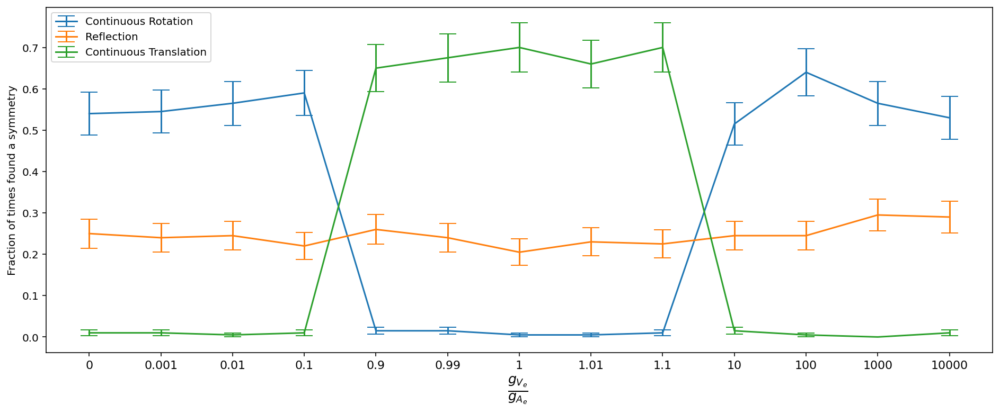

In [58]:
#registro = pd.read_csv('registro_20_times_ratio.csv') #pd.read_csv('registro_200_times_couplings.csv')
rep_todo = 200

etis = []

#gve_l = [1,0.9,0.85,0.8,0.7,0.5,0.3,0.2,0.15,0.1,0]
#gae_l = [0,0.1,0.15,0.2,0.3,0.5,0.7,0.8,0.85,0.9,1]
rs = [0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]
gae_l = [1 for r in rs]
gve_l = [np.round(r,2) for r in rs]

for k in range(len(gve_l)):
    #etis.append(r'$g_{V_e} =$ '+str(gve_l[k])+'\n $g_{A_e} =$ '+str(gae_l[k]))
    etis.append(str(rs[k]))

plt.figure(figsize = [16,6])
plt.errorbar(x = list(range(len(gae_l))), y = registro.continuous_rotation/rep_todo, 
             yerr = np.sqrt(np.array(registro.continuous_rotation).astype(np.float32))/rep_todo, capsize = 8, label = 'Continuous Rotation')
plt.errorbar(x = list(range(len(gae_l))), y = registro.reflection/rep_todo, 
             yerr = np.sqrt(np.array(registro.reflection).astype(np.float32))/rep_todo, capsize = 8, label = 'Reflection')
plt.errorbar(x = list(range(len(gae_l))), y = registro.continuous_translation/rep_todo, 
             yerr = np.sqrt(np.array(registro.continuous_translation).astype(np.float32))/rep_todo, capsize = 8, label = 'Continuous Translation')
plt.xticks(range(len(gae_l)),etis, fontsize = 11)
plt.ylabel('Fraction of times found a symmetry')
plt.xlabel(r'$\frac{g_{V_e}}{g_{A_e}} $ ',fontsize = 18)
plt.legend()
plt.show()

In [47]:
yerr = np.sqrt(np.array(registro.continuous_rotation).astype(np.float32))

In [48]:
yerr

array([7.2111025, 6.4031243, 1.7320508, 0.       , 0.       , 1.7320508,
       1.7320508, 0.       , 1.7320508, 6.4031243, 7.745967 ],
      dtype=float32)

In [73]:
registro = pd.concat(registros)

In [9]:
registro

,Unnamed: 0,continuous_rotation,continuous_translation,discrete_translation,none,reflection
0,0,115,2,14,0,47
1,0,104,0,16,0,59
2,0,37,1,19,0,122
3,0,11,2,1,1,172
4,0,0,5,5,0,179
5,0,6,138,2,0,41
6,0,0,4,10,1,175
7,0,7,2,2,1,176
8,0,38,4,24,0,109
9,0,107,3,5,0,59


Notebook directory: /home/gabriel/Desktop
Numero Imagenes: 201
Numero Imagenes: 402
Numero Imagenes: 603
Numero Imagenes: 804
Numero Imagenes: 1005
Numero Imagenes: 1206
Numero Imagenes: 1407
Numero Imagenes: 1608
Numero Imagenes: 1809
Numero Imagenes: 2010
Numero Imagenes: 2211
Numero Imagenes: 2412
Numero Imagenes: 2613
['a_ze+e-_gve_0_gae_1_' 'b_ze+e-_gve_0.001_gae_1_'
 'c_ze+e-_gve_0.01_gae_1_' 'd_ze+e-_gve_0.1_gae_1_'
 'e_ze+e-_gve_0.9_gae_1_' 'f_ze+e-_gve_0.99_gae_1_' 'g_ze+e-_gve_1_gae_1_'
 'h_ze+e-_gve_1.01_gae_1_' 'i_ze+e-_gve_1.1_gae_1_'
 'j_ze+e-_gve_10_gae_1_' 'k_ze+e-_gve_100_gae_1_'
 'l_ze+e-_gve_1000_gae_1_' 'm_ze+e-_gve_10000_gae_1_']
['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
[0.58558082 0.01798521 0.11651408 0.00109372 0.27882617]


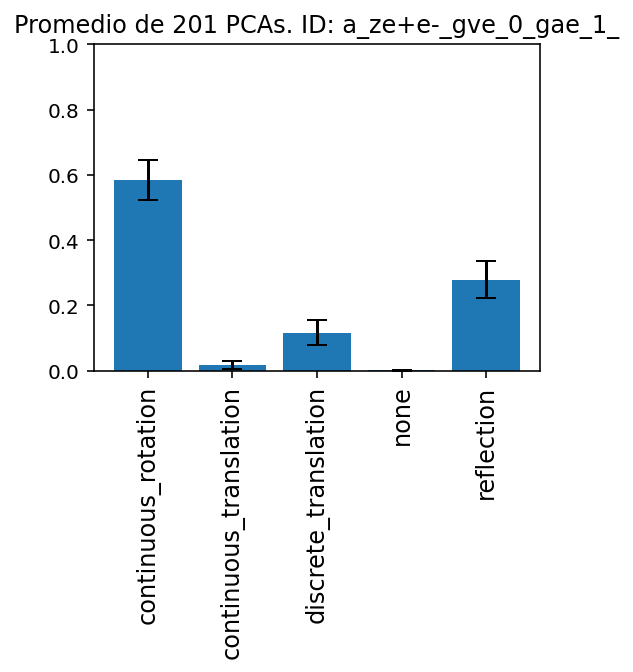

[0.57869158 0.01521176 0.11842749 0.00114855 0.28652062]


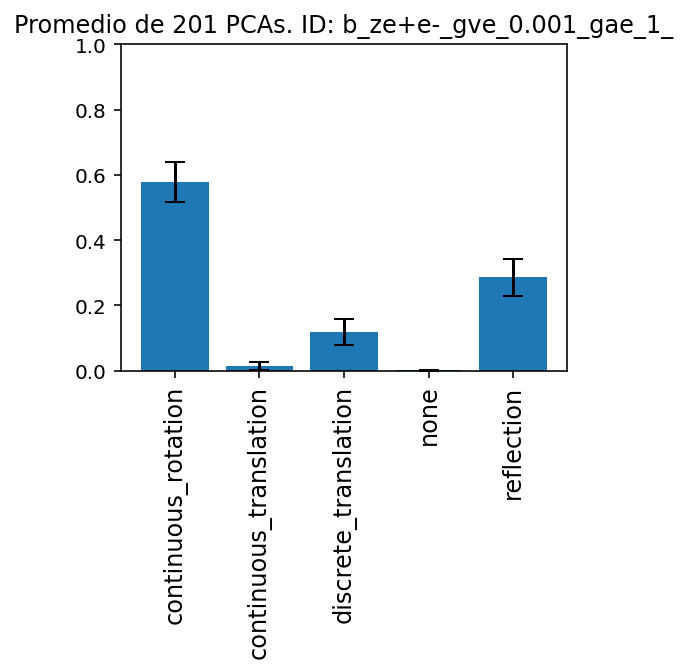

[0.60375428 0.01456684 0.08366339 0.00253686 0.29547863]


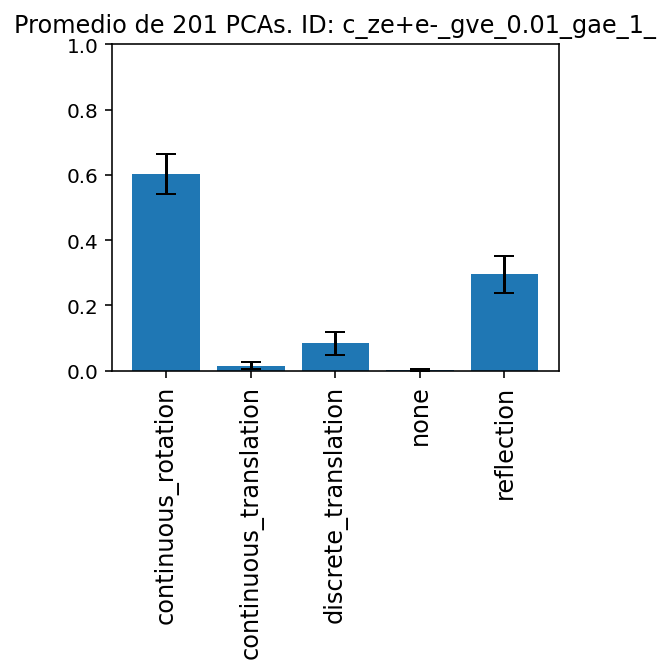

[0.62928781 0.02060561 0.07951626 0.00374784 0.26684247]


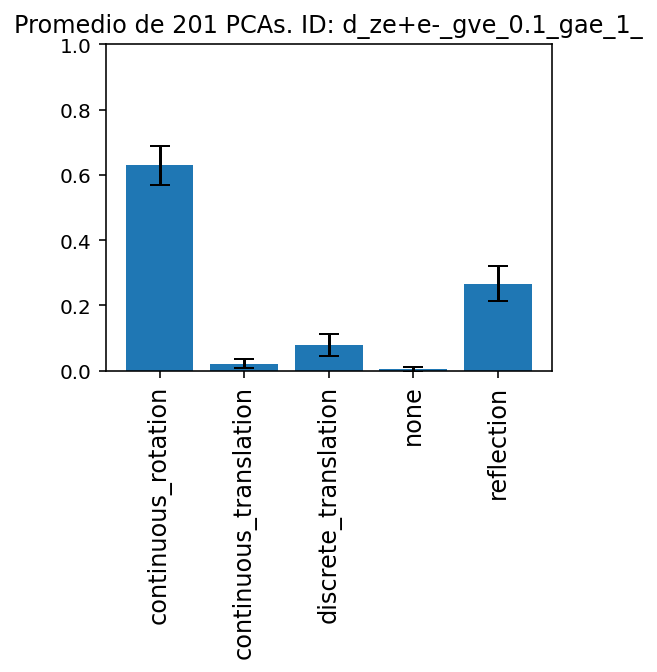

[0.03045934 0.66855476 0.00182376 0.00131244 0.2978497 ]


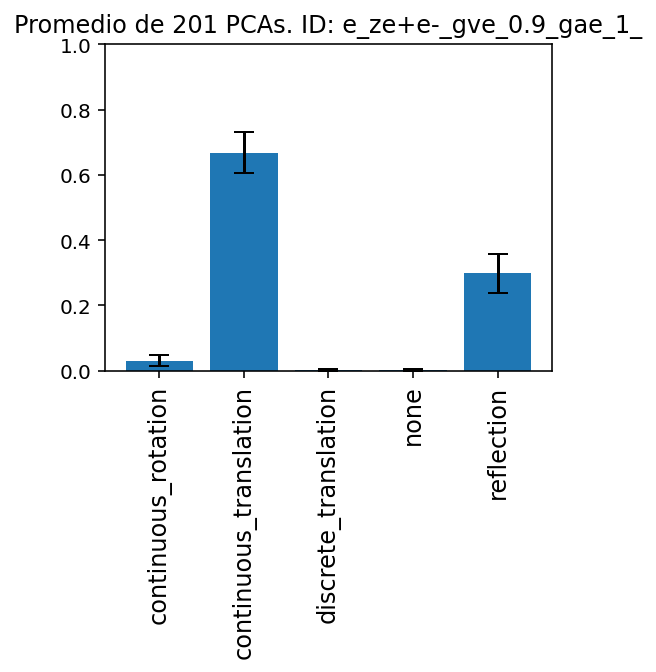

[3.15653826e-02 7.00320813e-01 3.36808475e-03 1.73605308e-04
 2.64572121e-01]


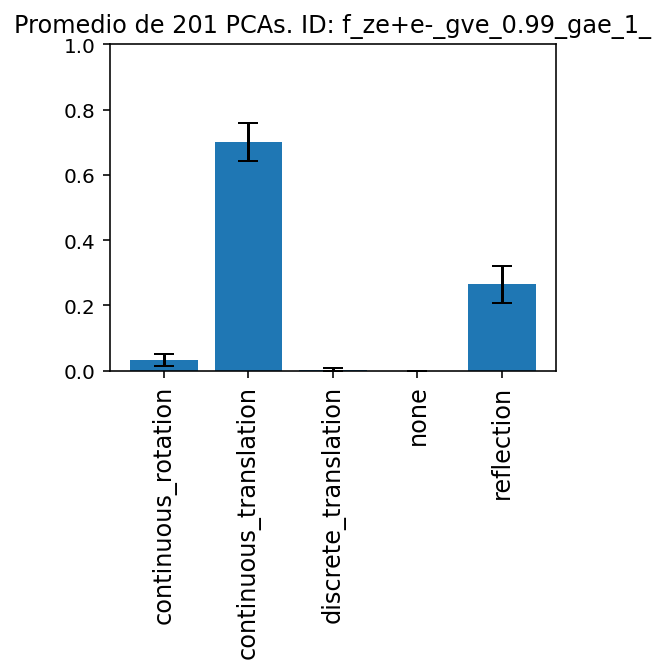

[3.31528642e-02 7.26118263e-01 8.71813016e-03 2.26990117e-04
 2.31783768e-01]


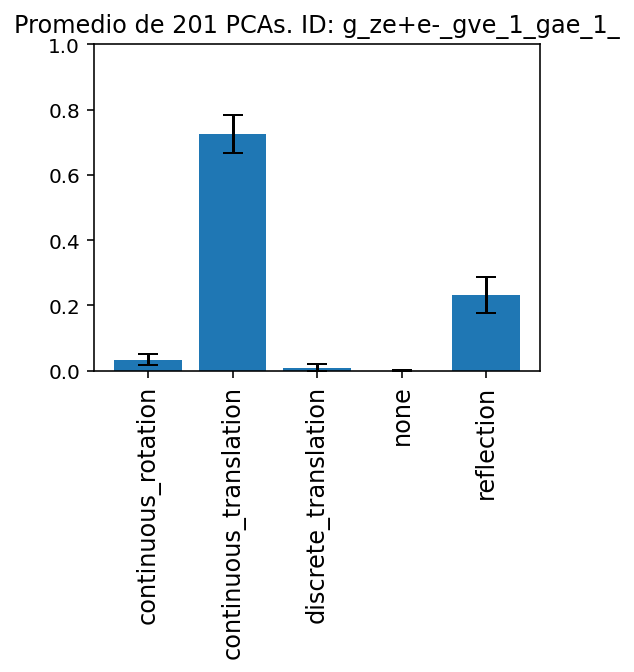

[2.71113022e-02 6.89493175e-01 1.04630311e-02 1.15213844e-04
 2.72817274e-01]


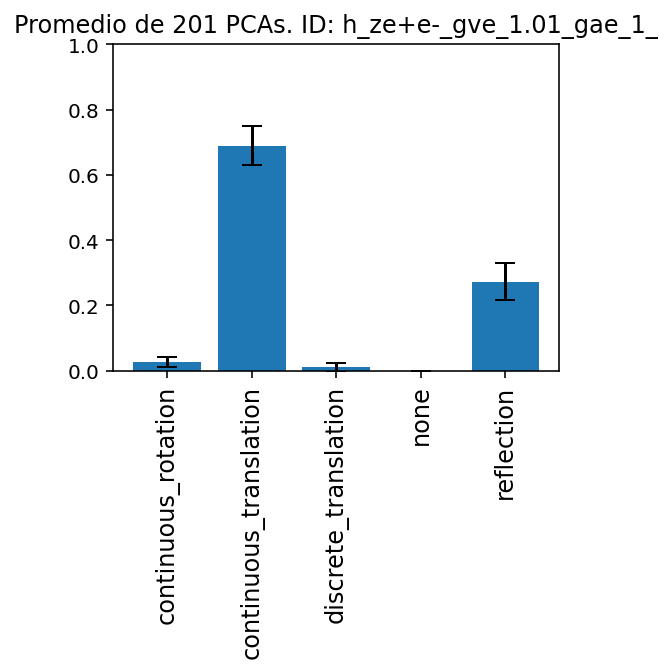

[3.02684155e-02 7.24472088e-01 5.47674710e-03 7.45829215e-05
 2.39708173e-01]


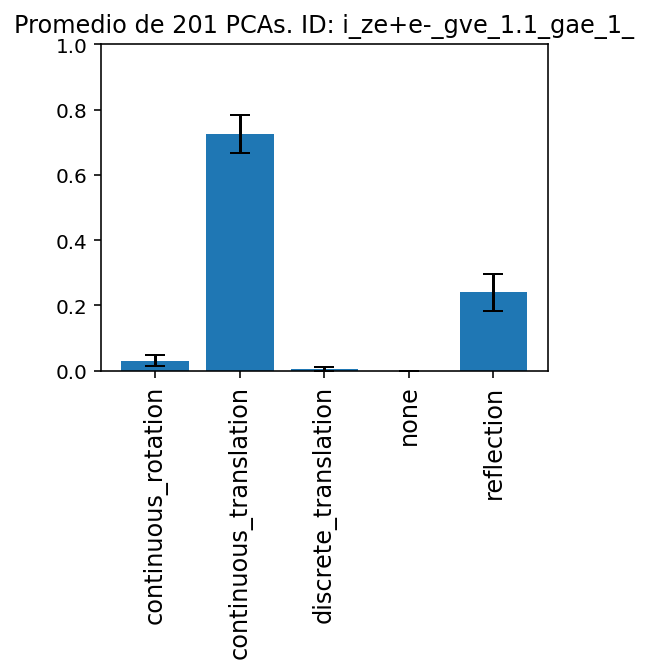

[5.83489513e-01 2.28178456e-02 8.02661878e-02 2.39723798e-04
 3.13186732e-01]


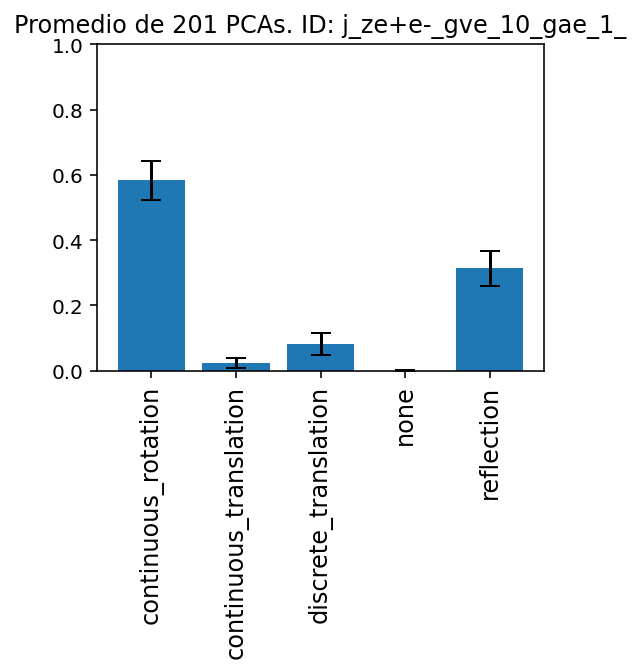

[0.65435146 0.00926932 0.05939287 0.00641639 0.27056997]


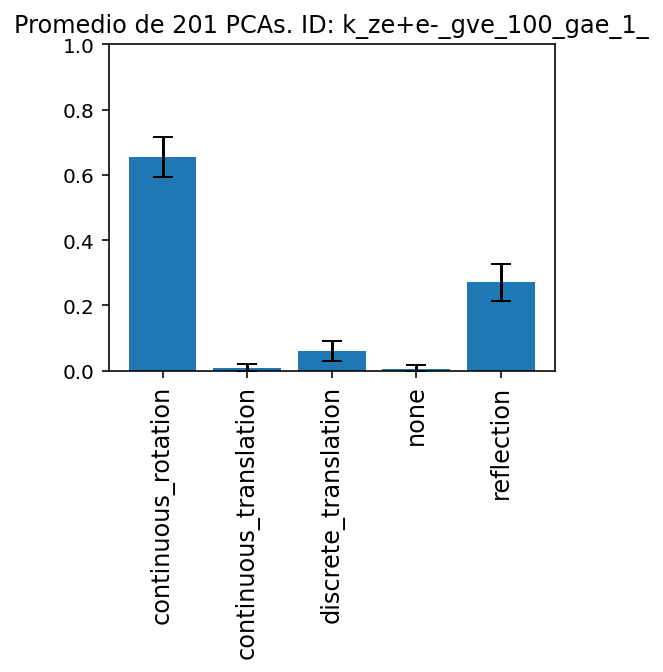

[0.59007212 0.00573478 0.07442374 0.00626046 0.3235089 ]


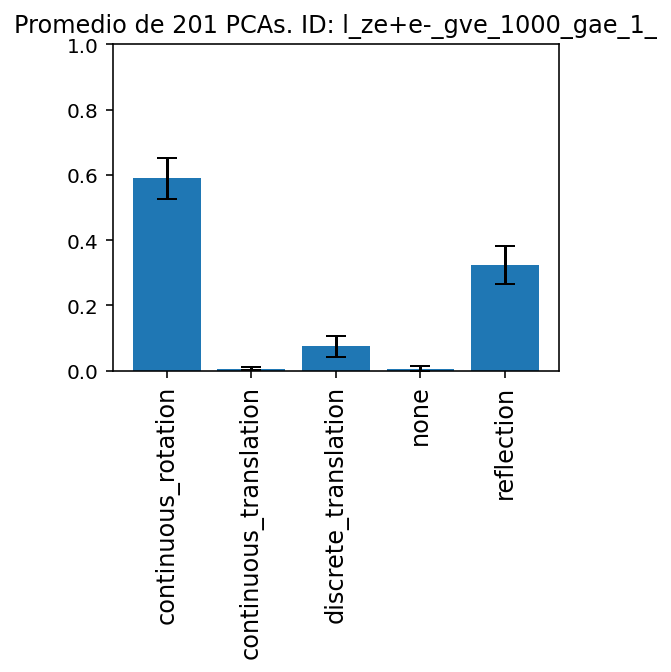

[0.57067538 0.01569079 0.08895258 0.00248367 0.32219758]


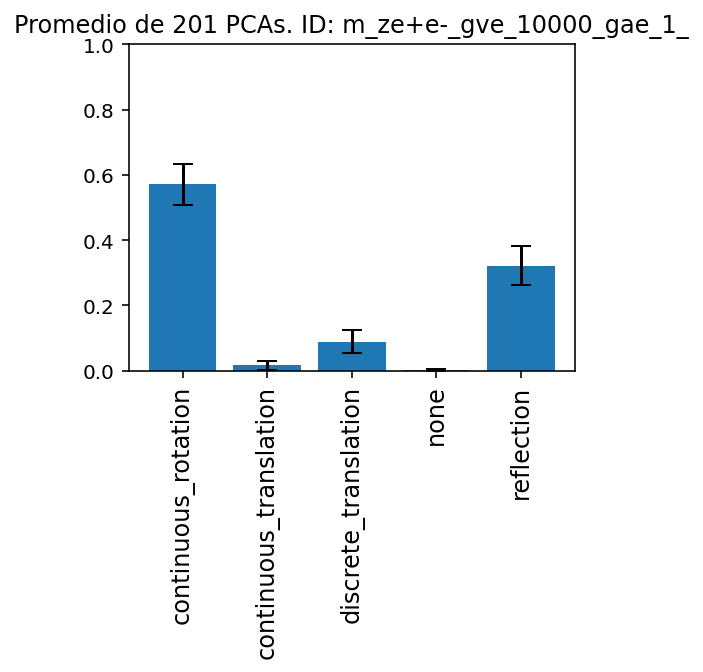

In [16]:
nom_carp = 'Ze+e-_couplings_ratio'

#import libraries
%config InlineBackend.figure_format = 'retina'
import seaborn as sns
from IPython.core.display import display, HTML, clear_output
display(HTML("<style>.container { width:100% !important; } div.cell.selected {border-left-width: 0px !important;}</style>"))

from time import time
import os
import glob
from fastai.vision.all import *
import numpy as np
from IPython.display import clear_output
import itertools as it
import more_itertools
#import torchvision.models
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.io as pio
pio.templates.default ="none"
import base64
from PIL import Image
from io import BytesIO
import torch
import gc
#import libraries

if not 'notebook_dir' in globals():
    notebook_dir = os.getcwd()
print('Notebook directory: ' + notebook_dir)
os.chdir(notebook_dir)  # If you changed the current working dir, this will take you back to the workbook dir.
top_dir = notebook_dir



modelo = 'G' # J or G

if modelo == 'G':
    #learn = load_learner('/home/gabriel/Desktop/models/model_93_accu_resnet18_10+5_none+reflection'+'.pkl', cpu=False)
    learn = load_learner('/home/gabriel/Desktop/models/model_90_accu_resnet18_one_cycle_10+5_no_mixup'+'.pkl', cpu=False)

if modelo == 'J':
    print('J')
        

#Reset Registro

columns = ['ID', 'Run'] + list(learn.dls.vocab)

registro = pd.DataFrame(columns = columns)
#registro


num_img_cat = [] #guardo el numero de imagenes de cada categoria
i = 0
plote = False

sims = pd.DataFrame(columns = learn.dls.vocab)
errs = sims.copy()

num_img_cat = [] #guardo el numero de imagenes de cada categoria
i = 0
plote = False

from IPython.utils import io


for dires in np.sort(Path('/home/gabriel/Desktop/Ze+e-_2/' + nom_carp).ls()):
    #path = Path('/home/gabriel/Desktop/PCA_INE_sexo/INE/'+quitadas)
    quitadas = str(dires).split('/')[-1]
    with io.capture_output() as captured:
        for ima in dires.ls():

            test_im_dir = ima

            im = PILImage.create(test_im_dir)

            # Orden: ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']

            cate, num_cat, probs = learn.predict(im)


            '''
            if plote == True:
                plt.figure
                plt.figure(figsize=(4, 3))
                plt.title(ima)
                plt.bar(['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection'],probs)
                plt.xticks(rotation='vertical',fontsize = 12)
                plt.show()
            '''

            new_row = np.array([quitadas, i] + list(np.array(probs).astype(float))).reshape([1,-1])
            aden = pd.DataFrame(new_row,columns=registro.columns)

            registro = registro.append(aden, ignore_index=True)

            i+=1

    registro = registro.astype({'ID':str, 'Run':int,'continuous_rotation':float, 'continuous_translation':float, 'discrete_translation':float, 'none':float, 'reflection':float })  

    print('Numero Imagenes:',i,)
    num_img_cat.append(i)


print(registro['ID'].unique())

#registro = pd.read_csv('/home/gabriel/Desktop/PCA_INE_sexo/registro.csv')

nombres_carps = registro['ID'].unique() #Nombres de las carpetas donde estan guyardadas las pcas de un tipo
num_carps = len(nombres_carps)

#registro = pd.read_csv('/home/gabriel/Desktop/PCA_INE_sexo/registro.csv')


i = 0


for nom in np.sort(nombres_carps):
    if i == 0:
        m_probs = np.array(registro.iloc[:num_img_cat[0],2:].mean())
        err_probs = np.array(registro.iloc[:num_img_cat[0],2:].std())
        nume = str(len(registro.iloc[:num_img_cat[0],2:]))
        print(learn.dls.vocab)
        print(m_probs)
        sims = sims.append(pd.DataFrame([m_probs], columns = sims.columns),ignore_index = True)
        errs = errs.append(pd.DataFrame([err_probs/np.sqrt(float(nume))], columns = errs.columns),ignore_index = True)
    else:
        m_probs = np.array(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:].mean())
        err_probs = np.array(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:].std())
        nume = str(len(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:]))
        print(m_probs)
        sims = sims.append(pd.DataFrame([m_probs], columns = sims.columns),ignore_index = True)
        errs = errs.append(pd.DataFrame([err_probs/np.sqrt(float(nume))], columns = errs.columns),ignore_index = True)

    if nom == '-ninguna-':
        tit = 'Promedio de '+nume+' PCAs sin quitar ninguna columna'
    else:
        tit = 'Promedio de '+nume+' PCAs. ID: '+ nom        

    
    plt.figure(figsize=(4, 3))
    plt.title(tit)
    #plt.title('Promedio de '+str(40)+' PCAs sin quitar ninguna columna')
    plt.bar(columns[2:],
            m_probs,yerr = 2*err_probs/np.sqrt(float(nume)), capsize = 5)
    plt.xticks(rotation='vertical',fontsize = 12)
    plt.ylim([0, 1])
    plt.show()

    
    i+=1

Text(0.5, 0, 'Año')

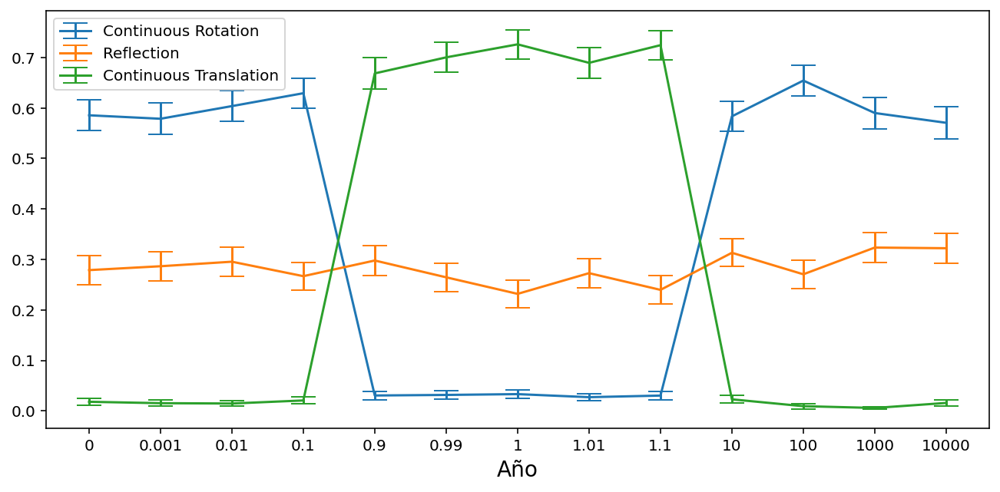

In [20]:
alfas = [0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]

#plt.errorbar(range(len(sims.reflection)),sims.reflection, yerr = errs.reflection,capsize = 8,label = 'Umbral: 4+')
#plt.errorbar(range(len(sims_0.none)),1-sims_0.none, yerr = errs_0.none,capsize = 8,label = 'Umbral: 0+')
#plt.errorbar(range(len(sims.none)),1-sims.none, yerr = errs.none,capsize = 8,label = 'Umbral: 4+, 1 $-$ none')
#plt.errorbar(range(len(sims_10.none)),1-sims_10.none, yerr = errs_10.none,capsize = 8,label = 'Umbral: 10+')

plt.figure(figsize = [11,5])
#lt.errorbar(range(len(sims.none)),sims.none, yerr = errs.none,capsize = 8,label = 'None')
#plt.errorbar(range(len(sims.none)),sims.none+sims.reflection, 
#             yerr = np.sqrt(errs.none**2 + errs.reflection**2),capsize = 8,label = 'Reflection + None')
plt.errorbar(range(len(sims.continuous_rotation)),sims.continuous_rotation, 
             yerr = errs.continuous_rotation,capsize = 8,label = 'Continuous Rotation')
plt.errorbar(range(len(sims.reflection)),sims.reflection, yerr = errs.reflection,capsize = 8,label = 'Reflection')
plt.errorbar(range(len(sims.continuous_translation)),sims.continuous_translation, 
             yerr = errs.continuous_translation,capsize = 8,label = 'Continuous Translation')
tik = plt.xticks(range(len(sims.reflection)),alfas)
plt.legend(fontsize = 10)
plt.xlabel('Año',fontsize = 14)
#plt.ylim([0.5,1.01])
#plt.ylabel('Reflection')
#plt.title('Simetrías en Trabajo-Puesto HM_inv (AI)')

In [62]:
results

,symmetry,feature_1,feature_2,probability,NRMSE
0,continuous_translation,Py1,Px1,0.9624,0.291495
1,continuous_translation,Py2,Px1,0.9998,0.291050


In [66]:
i = 0

1


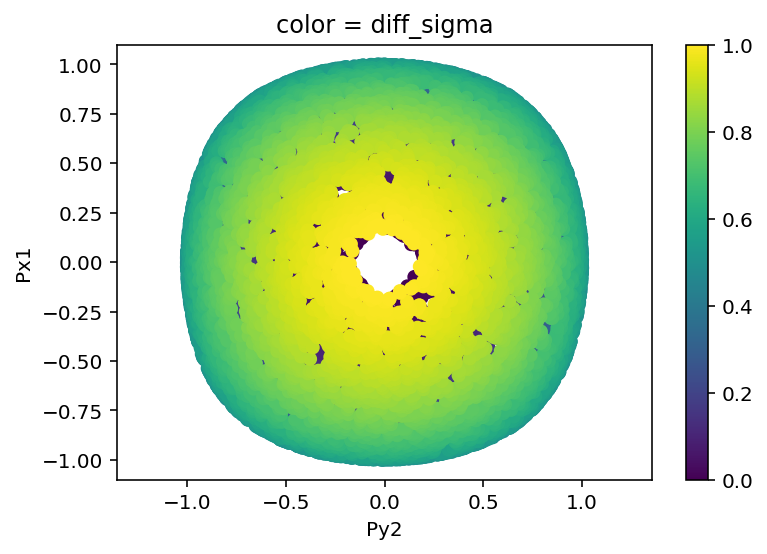

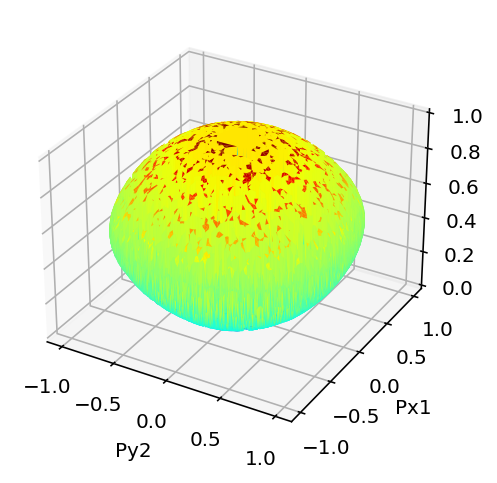

In [67]:
print(i)
res_plot(df.sort_values(target), results, num = i, logs = False)
i+=1

# Z2 vs. None Different Couplings

In [37]:
# ----------------------------------- #

target = 'diff_sigma'  # Nombre de la variable que queremos predecir
quantiles = True
range_cols = True   # Si quantiles == True, las columnas distintas de la target las escala entre -1 y 1.
ignore_list = ['Pz1','Pz2', 'E2', 's', 'cos_theta']

nombre_carpeta = 'Ze+e-_couplings_z2_none' # Nombre de la subcarpeta donde vamos a guardar las PCAs, dentro de la carpeta grande. Así podemos analizar al mismo tiempo varias bases de datos

n_fea = 13              # Número de features finales que el algoritmo escoge para hacer parejas y analizar con ellas la simetría

lim_sym = 0.7          # Límite de probabilidad para decidir que el algoritmo ha encontrado o no una simetría

limit_pairs = False      # Al generar parejas, estas vienen acompañadas de un 'score'. Si esto es True, cogmos solo la mitad de las con mayor 'score'

select_10k = True       # Keep only 10000 elements of the original potential DF (useful)

interact = False        # 'big', 'small', 'FW', False

rep_todo = 1


gve_l = [1,0.9,0.85,0.8,0.7,0.5,0.3,0.2,0.15,0.1,0]
gae_l = [0,0.1,0.15,0.2,0.3,0.5,0.7,0.8,0.85,0.9,1]

# --------------------------------------#

i=0 
nrr = -1
from time import time
start_time = time()

syms_tot = ['none', 'reflection']
registro = pd.DataFrame(columns = syms_tot)
registros = []

num_g = len(gve_l)

for  gve,gae in zip(gve_l,gae_l):
    
    nrr +=1
    
    print('**** gv_e = {} **** ga_e = {} ****'.format(gve,gae))

    folder_0 = 'cross_section'
    name = 'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) + '.csv'


    df_e = pd.read_csv(os.path.join(folder_0,name))

    categ = []
    numer = []


    for col in list(df_e.columns):
        if (col != target) and (col not in ignore_list):
            if type(df_e[col][0]) == str:
                categ.append(col)
            else:
                numer.append(col)

    splits = RandomSplitter(valid_pct=0)(range_of(df_e))

    to = TabularPandas(df_e,
                    procs=[Categorify,FillMissing],
                    cat_names = categ,
                    cont_names = numer,
                    y_names = target,
                    splits=splits)


    #equiv_CNACE = pd.DataFrame({'Cod_Num':list(to.xs['CNACE'].unique()),'Categ':list(dls.dsets['CNACE'].unique())}).sort_values(by = 'Categ')
    #equiv_CNO1 = pd.DataFrame({'Cod_Num':list(to.xs['CNO1'].unique()),'Categ':list(dls.dsets['CNO1'].unique())}).sort_values(by = 'Categ')

    df_e = pd.DataFrame(to.xs)
    df_e[target] = to.y
    df_e = df_e.reset_index().drop('index', axis = 1)  

    for col in df_e.columns:
        df_e[col] = np.nan_to_num(df_e[col])   
        if quantiles == True:
            n_attempted_bins =  len(df_e[col])
            binning = pd.qcut(df_e[col], q=n_attempted_bins, retbins=True, labels=False, duplicates='drop')
            df_e[col]=binning[0]/np.max(binning[0])
            df_e[col] = np.nan_to_num(df_e[col])
            if (range_cols == True) and (col != target): 
                df_e[col] = df_e[col]*2 - 1





    # ------------------------------------------------------------------------------------------------------------------------#

   

    sym_feat_1 = []
    sym_feat_2 = []
    sym_feat_tags = []
    sym_feat_probs = []
    sym_feat_rmse = []

    # Tiempo en el que empezamos a procesar



    from fastai.vision.all import *
    from time import time
    from IPython.utils import io



    muchos = False # Si es false, para muchos potenciales, mete cada combinación de variables en una carpeta separada, para que sea fácil ver si hay simetría ahí
                   # Si es true, van todos a la misma carpeta


    # ------------------- Folder PCA ------------------- #

    folder = 'Ze+e-_2'   # Carpeta donde se guardan las subcarpetas con las PCAs

    dd = top_dir + '/' + folder
    if not os.path.isdir(dd):
        print('Creating directory:\n',dd)
        os.mkdir(dd)

    dir = os.path.join(top_dir,folder)

    #------------------------------ Generar Potenciales ---------------------------#

    potenciales = [df_e]
    potenciales_tags = [nombre_carpeta for k in range(rep_todo)]
    tags = potenciales_tags
    num_pot = len(potenciales)

    # ------------------- No prints al guardar mejor modelo (fastai) ------------------- # 
    # Solo hay un print que se ha eliminado del código original
    class SaveModelCallback(TrackerCallback):
        "A `TrackerCallback` that saves the model's best during training and loads it at the end."
        _only_train_loop = True
        def __init__(self, monitor='valid_loss', comp=None, min_delta=0., fname='model', every_epoch=False, at_end=False,
                     with_opt=False, reset_on_fit=True):
            super().__init__(monitor=monitor, comp=comp, min_delta=min_delta, reset_on_fit=reset_on_fit)
            assert not (every_epoch and at_end), "every_epoch and at_end cannot both be set to True"
            # keep track of file path for loggers
            self.last_saved_path = None
            store_attr('fname,every_epoch,at_end,with_opt')

        def _save(self, name): self.last_saved_path = self.learn.save(name, with_opt=self.with_opt)

        def after_epoch(self):
            "Compare the value monitored to its best score and save if best."
            if self.every_epoch: self._save(f'{self.fname}_{self.epoch}')
            else: #every improvement
                super().after_epoch()
                if self.new_best:
                    #print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
                    self._save(f'{self.fname}')

        def after_fit(self, **kwargs):
            "Load the best model."
            if self.at_end: self._save(f'{self.fname}')
            elif not self.every_epoch: self.learn.load(f'{self.fname}', with_opt=self.with_opt)

    # ---------------- Definiciones previas e hiperparámetros ----------------- #

    #Guardo los modelos para analizarlos luego
    models = [] 
    to_s = []

    #Guardaremos los resultados de la PCA en un array 
    PCA_s = []
    PCA_s_tag = []

    # Hyperparameters: 
    bs_choices = [50000]       # Batch Size
    shape='pipe'               # Shape of the neural network
    layers_choices = [5]       # Number of layers of the net. Default:10 or 5 results with 5
    neurons_choices = [200]    # Number of neurons per layer. Default:200 results with 200
    epoch_choices = [50]      # Number of training epochs. Default:200 results with 100
    lr_choices = [0.01]       # Max learning rate 
    valid_pct=0.2              # Part of the data that goes into validation (0.2 = 20%)
    monitor= 'valid_loss'        # Te model with the least 'monitor' will be saved



    # ---------------------- Entrenar Red Y PCA -----------------------------------#

    j = 1 # Usaremos esto para saber cuantos potenciales hemos procesado, y como indice en general

    for rtd in range(rep_todo):
        for df in potenciales:

            df[target] = df[target]/np.max(df[target]) #Normalizar la columna objetivo es importante

            #------------------------------ Feature Importance  ---------------------------#

            if select_10k == True:
                if len(df[target]) <= 100*100:
                    print('Too little data to keep 10k points and delete the rest')
                else:
                    print('Keeping 10k points of the original DF')
                    remove_n = len(df[target]) - 10000
                    drop_indices = np.random.choice(df.index, remove_n, replace=False)
                    df_temp = df.drop(drop_indices)
                    df = df_temp.copy()



            if interact == 'big':
                print('---- Big interactions ----')
                bbb = df[target]
                df = df.drop(target,axis = 1)
                df = my_interactions(df, numo_int = 10, verbose = True)
                df[target] = bbb

            elif interact == 'small':
                print('---- Small interactions ----')
                bbb = df[target]
                df = df.drop(target,axis = 1)
                df = my_interactions_small(df, numo_int = 10, verbose = True)
                df[target] = bbb

            elif interact == 'FW':
                print('---- Interactions by featurewiz ----')
                with io.capture_output() as captured2: output = featurewiz(df, target, corr_limit=0.10,
                                                                verbose=0, sep=',', header=0, test_data='',
                                                                category_encoders='',feature_engg='interactions')   
                df = output[1].copy()

            elif interact == False:
                print('No interactions')


            #df = regularize_df(df)

            print('---Selecting Best Features---')
            best_pairs = n_best_rf_phi_k(df, target = target, n = n_fea, nf = 30, lim_corr = 0.85)

            best_n = [best_pairs['f1'][0]] + list(best_pairs['f2'].unique())

            print('Best Features: ',best_n)

            #small_df = df[best_n]
            #small_df[target] = df[target]


            cols = best_n
            a = cols

            verbose = 1



            df_org = df.copy()

            if limit_pairs == True:
                medi = best_pairs.score.median()
                num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
            else:
                medi = 0
                num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])

            for f1,f2,lll in zip(best_pairs.f1,best_pairs.f2,range(len(best_pairs.f1))):
                if best_pairs.score[lll] >= medi:

                    i+=1

                    print(f1,f2)
                    feas = [f1,f2]

                    # Debemos marcar cada potencial para tener claro a qué tipo de simetria corresponde cada PCA
                    PCA_s_tag.append(tags[j-1])

                    df2 = df[feas + [target]].copy() 
                    #df2 = df2[feas + [target]].copy()

                    #Normlizamos las features y hacemos que vayan entre -1 y 1
                    df2[f1] = 2*(df2[f1]/np.max(df2[f1]))-1
                    df2[f2] = 2*(df2[f2]/np.max(df2[f2]))-1

                    splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

                    to = TabularPandas(df2,
                                    procs=[Categorify,FillMissing, Normalize],
                                    cont_names = feas,
                                    y_names = target,
                                    splits=splits)

                    train_size = len(splits[0])
                    valid_size = len(splits[1])

                    # ----------------- Hyperparameters ------------------- #

                    # Batch Size (a large one)
                    bs=min(random.choice(bs_choices),train_size)  
                    print('{} batch size for training.\n'.format(bs))

                    # Neurons per layer
                    neurons_per_layer = random.choice(neurons_choices)

                    # Number of layers
                    n_layers = random.choice(layers_choices)

                    #Shape of the net: Pipe or funnel
                    if shape == 'pipe':
                        layers=[neurons_per_layer for i in range(n_layers)]

                    if shape == 'funnel':
                        n_eff = n_layers
                        layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

                    print('Training FCNN with layers: ',layers)

                    #Number of epochs
                    n_epoch=random.choice(epoch_choices)
                    print('Training for {} epochs.'.format(n_epoch))

                    # Maximum Learning Rate: (a good value can be found using learn.lr_find())
                    lr_max=float(random.choice(lr_choices))
                    print('Using lr_max = ',format(lr_max))

                    # ----------------------------------------------------- #

                    # --------------- Training the FCNN --------------------#

                    # Load the data into a DataLoader
                    dls = to.dataloaders(bs=bs)

                    # Define a Tabular Learner
                    learn = tabular_learner(dls, layers=layers
                                        #,config=config
                                        #,metrics=[mse],
                                        #y_range = [min(df.bin),max(df.bin)],
                                        #,cbs=ShowGraphCallback()
                                        #,train_bn=False)
                                        )

                    # Train the net 
                    with learn.no_logging():
                        learn.fit_one_cycle(n_epoch=n_epoch
                                            ,lr_max=lr_max
                                            ,cbs=[SaveModelCallback(monitor=monitor)]
                                            )

                        preds, targs = learn.get_preds()

                    ff = (preds-targs)**2/len(targs)
                    ff = sum(ff)
                    RMSE = np.sqrt(ff)
                    #print('RMSE:',float(RMSE))
                    nrmsei = float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))

                    # Guardamos modelos y tabular objects para el posterior analisis
                    models.append(learn)
                    to_s.append(to)

                    # ------------------------------------------------------#


                    # ------------------------- PCA ------------------------#

                    test_df = df2.copy()
                    dl = learn.dls.test_dl(test_df,bs=int(test_df.shape[0])) 

                    # Tenemos que hacer un Hook, una especie de gancho que enganchamos en la última capa interna,
                    # para guardar, de cada modelo, los valores de los parámetro de dicha capa. 
                    with Hooks(learn.model.layers, lambda m,i,o: o) as h:
                        preds = learn.get_preds(dl=dl,with_input=True,with_decoded=True,with_loss=True)

                    targets=preds[2].numpy().flatten()

                    # Cogemos la información de la penúltima capa
                    # OJO: Si añadimos y_range, se añade automaticamente una sigmoid
                    # al final, por lo que tendríamos que coger la capa -3 en vez de la -2
                    act = h.stored[-2] 
                    multi_dim=Tensor.cpu(act).numpy()
                    standardized=StandardScaler().fit_transform(multi_dim)

                    viz = PCA(2).fit_transform(np.nan_to_num(standardized))
                    #plt.figure()
                    #plt.scatter(viz[:, 0], viz[:, 1],c=targets[:multi_dim.shape[0]],alpha=.1, marker = 'o')

                    PCA_s.append(viz)

                    # ------------------------------------------------------ #

                    # ------------------ Saving the PCA's ------------------ #

                    # ---- Dar formato a PCA para guardar como imagen con color

                    viz = pd.DataFrame(viz) #Transformamos la PCA en un dataframe
                    viz.columns = ['x','y'] #Nombres de las columnas

                    # Insertamos una columna con los colores de los puntos. El valor del potencial
                    # objetivo (targets) es el color, y hay un color por cada punto 
                    viz.insert(2,'class',targets[:multi_dim.shape[0]]) 

                    # ---- Personalizar mapa de color 

                    n_classes=1000

                    colors = 'rainbow'

                    if colors == 'rainbow':
                        my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                        classes_in_rgb = my_cmap(range(n_classes))
                    if colors == 'purple':
                        my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                        classes_in_rgb = np.vstack((np.array([0,0,0,0]),my_cmap([0 for i in range(n_classes)])))

                    # ---- Hacer que la intensidad del pixel represente la cantidad de puntos 
                    #      acumuldos en un pixel

                    n_pixels = 224

                    binning_3d=np.histogramdd([viz['x'],viz['y'],viz['class']],range=(None,None,(0,1)), bins=(n_pixels,n_pixels,n_classes))

                    #if we want the pixel intensity to reprensent the number of points at that location
                    array = np.dot(binning_3d[0],classes_in_rgb)
                    array = array/np.amax(array)

                    # ---- Guardar la PCA

                    #Directorio donde guardaremos las imagenes
                    nami = str(nrr)+'_'+'ze+e-_gve_' + str(gve) + '_gae_' +str(gae)+'_'
                    if muchos == False: 
                        dir_sym = os.path.join(dir,tags[j-1],nami)
                        img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+'__PCA.png' 
                    else:
                        dir_sym = os.path.join(dir,tags[j-1])
                        img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+nami+'__PCA.png' 

                    if not os.path.isdir(dir_sym):
                        print('Creating directory:\n',dir_sym)
                        os.makedirs(dir_sym)


                    # Nombre de la imagen. Pongo el tiempo para que todas se llamen distinto cada vez.
                    output_dir = os.path.join(dir_sym,img_file) # Directorio donde guardamos la imagen
                    plt.imsave(output_dir,array) # Guardar
                    print('\nPCA saved to:\n{}\n'.format(dir_sym+'/'+img_file))


                    # ------------------------ Symmetry Analyzer --------------------- #
                    drr = pca_sym_finder_Z2_none(output_dir)
                    brr = list(drr.iloc[np.where(drr.value > lim_sym)].symmetry)
                    if len(brr) > 0:
                        print('Found {} symmetry with features {} and {}, with prob. {}'.format(brr[0],f1,f2,float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4))))                
                        sym_feat_1.append(f1)
                        sym_feat_2.append(f2)
                        sym_feat_tags.append(brr[0])
                        sym_feat_probs.append(float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4)))
                        sym_feat_rmse.append(nrmsei)




                    # ------------------------ Time -------------------------#

                    minutes_until_now = (time() - start_time)/60
                    images_done = i
                    minutes_per_image = minutes_until_now/(images_done)
                    hours_left = minutes_per_image * (num_pot*rep_todo*num_2*num_g-images_done)/60
                    print("\n{} PCA's made out of {}.\n".format(images_done,num_pot*num_2*rep_todo*num_g))
                    print("{:.1f} minutes elapsed for {} images.".format(minutes_until_now,images_done))
                    print("{:.1f} minutes average per image.".format(minutes_until_now/images_done))
                    print("{:.1f} minutes estimated left for {} images.\n\n\n".format(hours_left*60,num_pot*num_2*rep_todo*num_g-images_done))
                    print("{:.1f} hours estimated left for {} images.\n\n\n".format(hours_left,num_pot*num_2*rep_todo*num_g-images_done))




        j+=1


              # ------------------------------------------------------#'''

    results = pd.DataFrame({'symmetry':sym_feat_tags, 'feature_1':sym_feat_1, 'feature_2':sym_feat_2, 'probability':sym_feat_probs, 'NRMSE':sym_feat_rmse})

    vc = results.symmetry.value_counts()



    for sym_sum in syms_tot:
        if not hasattr(vc,sym_sum):
            vc[sym_sum] = 0


    nr = pd.DataFrame({'none':vc['none'], 
                       'reflection':vc['reflection']}, index = [0])

    registro = registro.append(nr, ignore_index=True)
    

    registros.append(nr)


'''    plt.xticks(rotation = -15)
    plt.ylim([0,1])
    print(registro.columns)
    print(registro.sum()/registro.sum().sum())
    plt.bar(registro.columns,registro.sum()/registro.sum().sum(), yerr = np.sqrt(registro.sum())/registro.sum().sum(), capsize = 8)
'''

print(0)

**** gv_e = 1 **** ga_e = 0 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_z2_none/0_ze+e-_gve_1_gae_0_/Ze+e-_couplings_z2_none_11638447221__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 1.0

1 PCA's made out of 11.

0.1 minutes elapsed for 1 images.
0.1 minutes average per image.
0.8 minutes estimated left for 10 images.



0.0 hours estimated left for 10 images.



**** gv_e = 0.9 **** ga_e = 0.1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_z2_none/1_ze+e-_gve_0.9_gae_0.1_/Ze+e-_couplings_z2_none_11638447226__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

2 PCA's made out of 11.

0.2 minutes elapsed for 2 images.
0.1 minutes average per image.
0.7 minutes estimated left for 9 images.



0.0 hours estimated left for 9 images.



**** gv_e = 0.85 **** ga_e = 0.15 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_z2_none/2_ze+e-_gve_0.85_gae_0.15_/Ze+e-_couplings_z2_none_11638447230__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

3 PCA's made out of 11.

0.2 minutes elapsed for 3 images.
0.1 minutes average per image.
0.6 minutes estimated left for 8 images.



0.0 hours estimated left for 8 images.



**** gv_e = 0.8 **** ga_e = 0.2 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_z2_none/3_ze+e-_gve_0.8_gae_0.2_/Ze+e-_couplings_z2_none_11638447234__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4 PCA's made out of 11.

0.3 minutes elapsed for 4 images.
0.1 minutes average per image.
0.5 minutes estimated left for 7 images.



0.0 hours estimated left for 7 images.



**** gv_e = 0.7 **** ga_e = 0.3 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_z2_none/4_ze+e-_gve_0.7_gae_0.3_/Ze+e-_couplings_z2_none_11638447238__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 1.0

5 PCA's made out of 11.

0.4 minutes elapsed for 5 images.
0.1 minutes average per image.
0.4 minutes estimated left for 6 images.



0.0 hours estimated left for 6 images.



**** gv_e = 0.5 **** ga_e = 0.5 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_z2_none/5_ze+e-_gve_0.5_gae_0.5_/Ze+e-_couplings_z2_none_11638447242__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

6 PCA's made out of 11.

0.4 minutes elapsed for 6 images.
0.1 minutes average per image.
0.4 minutes estimated left for 5 images.



0.0 hours estimated left for 5 images.



**** gv_e = 0.3 **** ga_e = 0.7 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_z2_none/6_ze+e-_gve_0.3_gae_0.7_/Ze+e-_couplings_z2_none_11638447246__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 1.0

7 PCA's made out of 11.

0.5 minutes elapsed for 7 images.
0.1 minutes average per image.
0.3 minutes estimated left for 4 images.



0.0 hours estimated left for 4 images.



**** gv_e = 0.2 **** ga_e = 0.8 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_z2_none/7_ze+e-_gve_0.2_gae_0.8_/Ze+e-_couplings_z2_none_11638447250__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 1.0

8 PCA's made out of 11.

0.6 minutes elapsed for 8 images.
0.1 minutes average per image.
0.2 minutes estimated left for 3 images.



0.0 hours estimated left for 3 images.



**** gv_e = 0.15 **** ga_e = 0.85 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_z2_none/8_ze+e-_gve_0.15_gae_0.85_/Ze+e-_couplings_z2_none_11638447254__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

9 PCA's made out of 11.

0.6 minutes elapsed for 9 images.
0.1 minutes average per image.
0.1 minutes estimated left for 2 images.



0.0 hours estimated left for 2 images.



**** gv_e = 0.1 **** ga_e = 0.9 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_z2_none/9_ze+e-_gve_0.1_gae_0.9_/Ze+e-_couplings_z2_none_11638447258__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

10 PCA's made out of 11.

0.7 minutes elapsed for 10 images.
0.1 minutes average per image.
0.1 minutes estimated left for 1 images.



0.0 hours estimated left for 1 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_z2_none/10_ze+e-_gve_0_gae_1_/Ze+e-_couplings_z2_none_11638447263__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

11 PCA's made out of 11.

0.8 minutes elapsed for 11 images.
0.1 minutes average per image.
0.0 minutes estimated left for 0 images.



0.0 hours estimated left for 0 images.



0


In [31]:
registro=pd.concat(registros)

Notebook directory: /home/gabriel/Desktop
Numero Imagenes: 111
Numero Imagenes: 222
Numero Imagenes: 333
Numero Imagenes: 444
Numero Imagenes: 555
Numero Imagenes: 666
Numero Imagenes: 777
Numero Imagenes: 888
Numero Imagenes: 999
Numero Imagenes: 1110
Numero Imagenes: 1221
['0_ze+e-_gve_1_gae_0_' '10_ze+e-_gve_0_gae_1_' '1_ze+e-_gve_0.9_gae_0.1_'
 '2_ze+e-_gve_0.85_gae_0.15_' '3_ze+e-_gve_0.8_gae_0.2_'
 '4_ze+e-_gve_0.7_gae_0.3_' '5_ze+e-_gve_0.5_gae_0.5_'
 '6_ze+e-_gve_0.3_gae_0.7_' '7_ze+e-_gve_0.2_gae_0.8_'
 '8_ze+e-_gve_0.15_gae_0.85_' '9_ze+e-_gve_0.1_gae_0.9_']
['none', 'reflection']
[0.00824527 0.99175473]


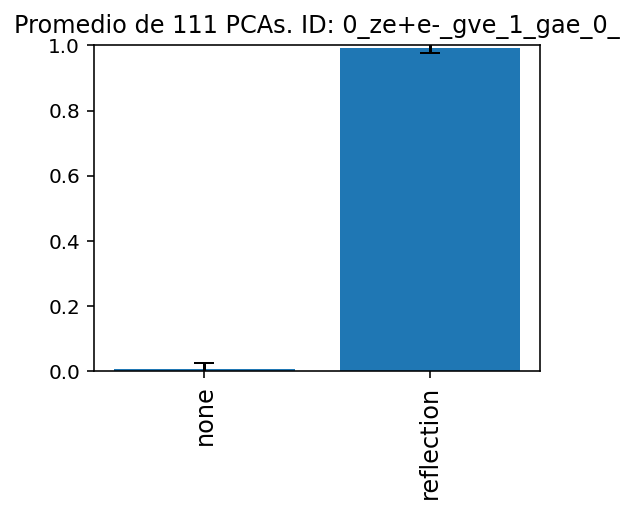

[6.99655898e-05 9.99930038e-01]


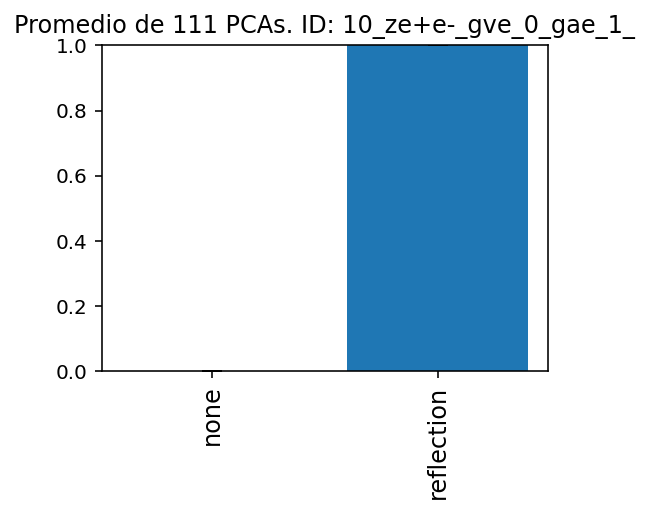

[0.00329882 0.99670118]


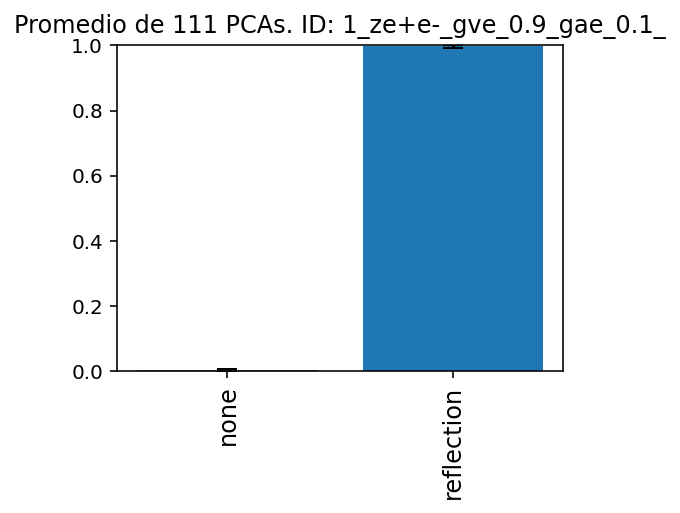

[0.00433154 0.99566845]


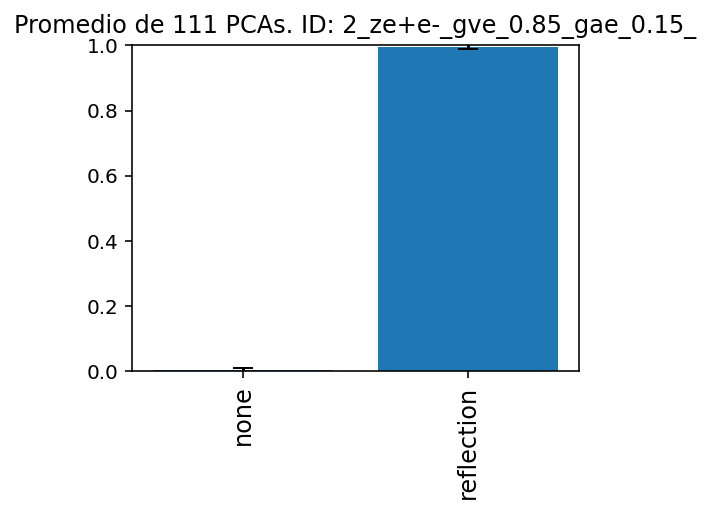

[0.04592261 0.95407739]


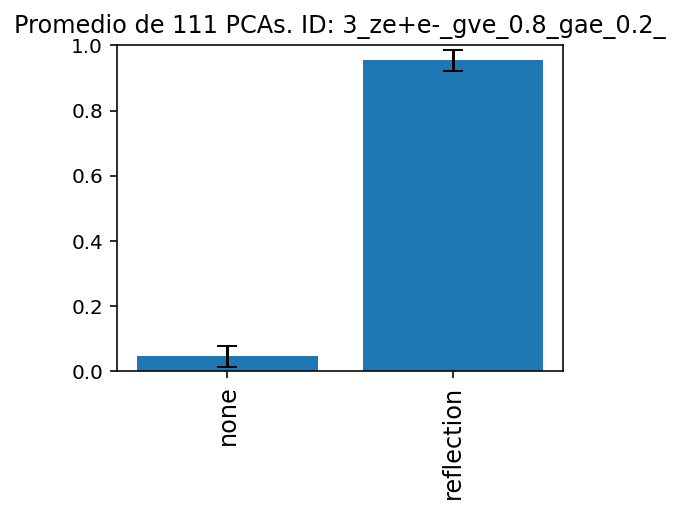

[0.02126051 0.97873949]


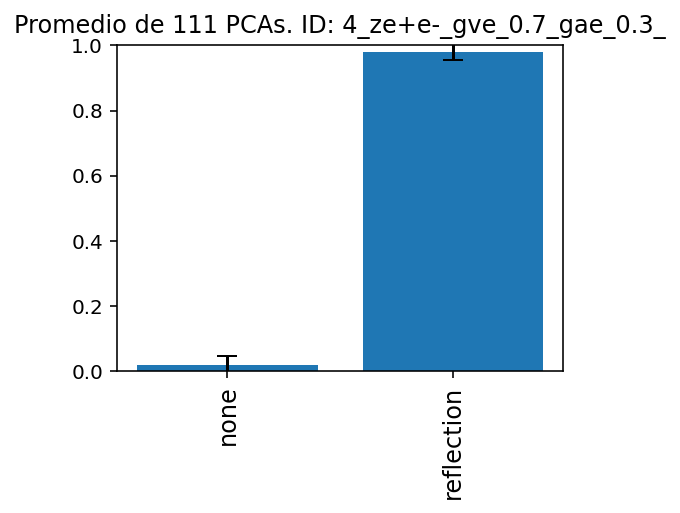

[0.0222981 0.9777019]


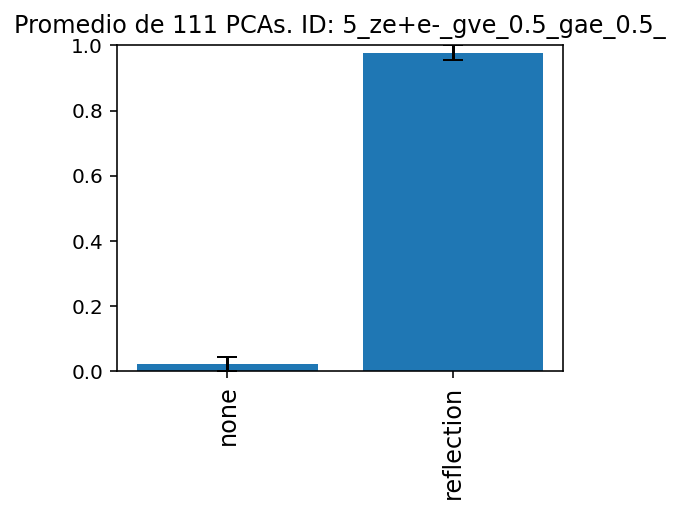

[0.02799649 0.97200351]


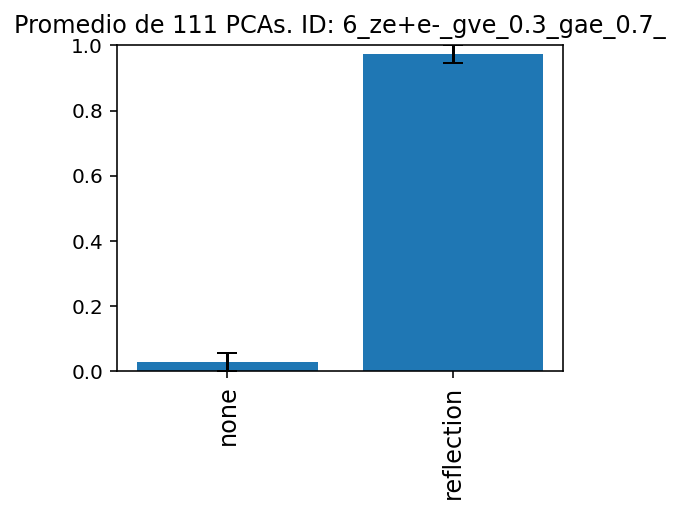

[0.0643821 0.9356179]


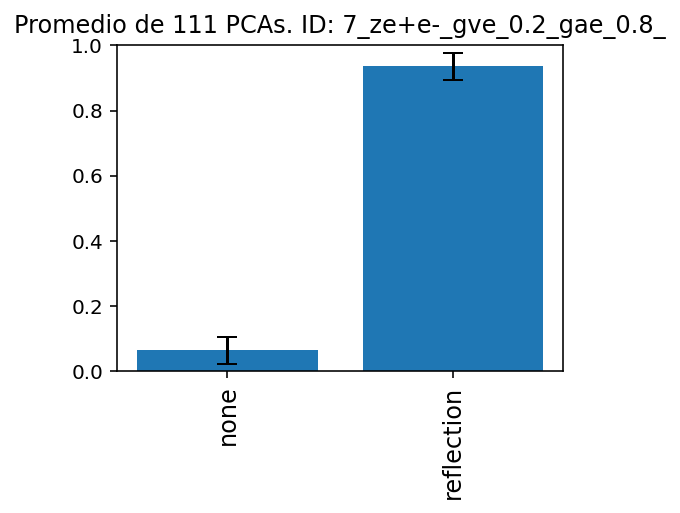

[0.0027563 0.9972437]


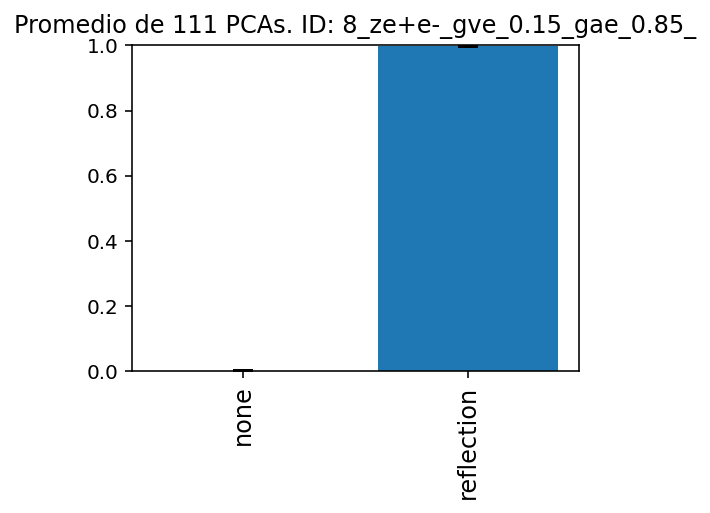

[0.01175331 0.98824669]


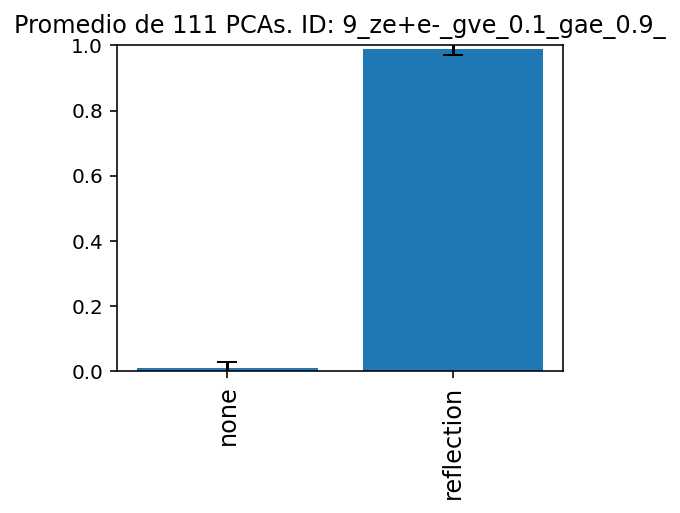

In [38]:
nom_carp = 'Ze+e-_couplings_z2_none'

#import libraries
%config InlineBackend.figure_format = 'retina'
import seaborn as sns
from IPython.core.display import display, HTML, clear_output
display(HTML("<style>.container { width:100% !important; } div.cell.selected {border-left-width: 0px !important;}</style>"))

from time import time
import os
import glob
from fastai.vision.all import *
import numpy as np
from IPython.display import clear_output
import itertools as it
import more_itertools
#import torchvision.models
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.io as pio
pio.templates.default ="none"
import base64
from PIL import Image
from io import BytesIO
import torch
import gc
#import libraries

if not 'notebook_dir' in globals():
    notebook_dir = os.getcwd()
print('Notebook directory: ' + notebook_dir)
os.chdir(notebook_dir)  # If you changed the current working dir, this will take you back to the workbook dir.
top_dir = notebook_dir



modelo = 'G' # J or G

if modelo == 'G':
    learn = load_learner('/home/gabriel/Desktop/models/model_93_accu_resnet18_10+5_none+reflection'+'.pkl', cpu=False)

if modelo == 'J':
    learn=load_learner(model_name+'.pkl',cpu=False)
        

#Reset Registro

columns = ['ID', 'Run'] + list(learn.dls.vocab)

registro = pd.DataFrame(columns = columns)
#registro


num_img_cat = [] #guardo el numero de imagenes de cada categoria
i = 0
plote = False

sims = pd.DataFrame(columns = learn.dls.vocab)
errs = sims.copy()

num_img_cat = [] #guardo el numero de imagenes de cada categoria
i = 0
plote = False

from IPython.utils import io


for dires in np.sort(Path('/home/gabriel/Desktop/Ze+e-_2/' + nom_carp).ls()):
    #path = Path('/home/gabriel/Desktop/PCA_INE_sexo/INE/'+quitadas)
    quitadas = str(dires).split('/')[-1]
    with io.capture_output() as captured:
        for ima in dires.ls():

            test_im_dir = ima

            im = PILImage.create(test_im_dir)

            # Orden: ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']

            cate, num_cat, probs = learn.predict(im)


            '''
            if plote == True:
                plt.figure
                plt.figure(figsize=(4, 3))
                plt.title(ima)
                plt.bar(['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection'],probs)
                plt.xticks(rotation='vertical',fontsize = 12)
                plt.show()
            '''

            new_row = np.array([quitadas, i] + list(np.array(probs).astype(float))).reshape([1,-1])
            aden = pd.DataFrame(new_row,columns=registro.columns)

            registro = registro.append(aden, ignore_index=True)

            i+=1

    registro = registro.astype({'ID':str, 'Run':int, 'none':float, 'reflection':float })  

    print('Numero Imagenes:',i,)
    num_img_cat.append(i)


print(registro['ID'].unique())

#registro = pd.read_csv('/home/gabriel/Desktop/PCA_INE_sexo/registro.csv')

nombres_carps = registro['ID'].unique() #Nombres de las carpetas donde estan guyardadas las pcas de un tipo
num_carps = len(nombres_carps)

#registro = pd.read_csv('/home/gabriel/Desktop/PCA_INE_sexo/registro.csv')


i = 0


for nom in np.sort(nombres_carps):
    if i == 0:
        m_probs = np.array(registro.iloc[:num_img_cat[0],2:].mean())
        err_probs = np.array(registro.iloc[:num_img_cat[0],2:].std())
        nume = str(len(registro.iloc[:num_img_cat[0],2:]))
        print(learn.dls.vocab)
        print(m_probs)
        sims = sims.append(pd.DataFrame([m_probs], columns = sims.columns),ignore_index = True)
        errs = errs.append(pd.DataFrame([err_probs/np.sqrt(float(nume))], columns = errs.columns),ignore_index = True)
    else:
        m_probs = np.array(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:].mean())
        err_probs = np.array(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:].std())
        nume = str(len(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:]))
        print(m_probs)
        sims = sims.append(pd.DataFrame([m_probs], columns = sims.columns),ignore_index = True)
        errs = errs.append(pd.DataFrame([err_probs/np.sqrt(float(nume))], columns = errs.columns),ignore_index = True)

    if nom == '-ninguna-':
        tit = 'Promedio de '+nume+' PCAs sin quitar ninguna columna'
    else:
        tit = 'Promedio de '+nume+' PCAs. ID: '+ nom        

    
    plt.figure(figsize=(4, 3))
    plt.title(tit)
    #plt.title('Promedio de '+str(40)+' PCAs sin quitar ninguna columna')
    plt.bar(columns[2:],
            m_probs,yerr = 2*err_probs/np.sqrt(float(nume)), capsize = 5)
    plt.xticks(rotation='vertical',fontsize = 12)
    plt.ylim([0, 1])
    plt.show()

    
    i+=1

In [23]:
sims

,none,reflection
0,0.001090,0.998910
1,0.000022,0.999978
2,0.127253,0.872747
3,0.000002,0.999998
4,0.093571,0.906429
5,0.001523,0.998477
6,0.000011,0.999990
7,0.099668,0.900332
8,0.000001,0.999999
9,0.000034,0.999966


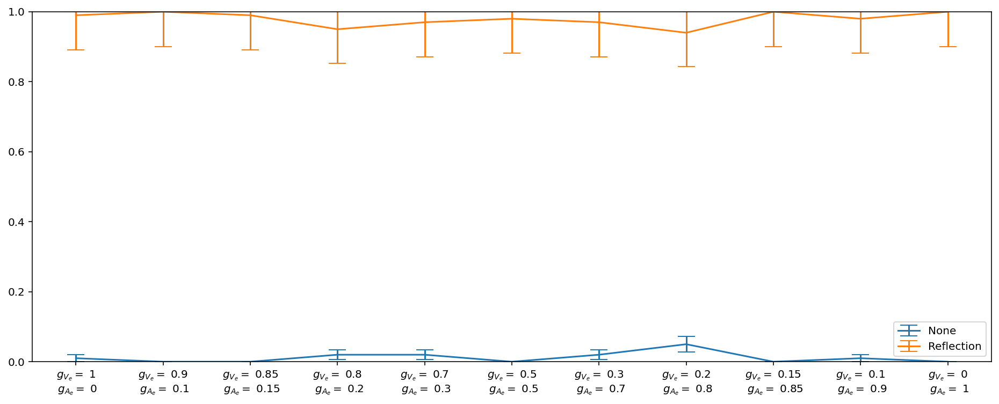

In [34]:
#registro = pd.read_csv('registro_200_times_couplings.csv')
rep_todo = 100

etis = []

gve_l = [1,0.9,0.85,0.8,0.7,0.5,0.3,0.2,0.15,0.1,0]
gae_l = [0,0.1,0.15,0.2,0.3,0.5,0.7,0.8,0.85,0.9,1]

for k in range(len(gve_l)):
    etis.append(r'$g_{V_e} =$ '+str(gve_l[k])+'\n $g_{A_e} =$ '+str(gae_l[k]))
    

plt.figure(figsize = [16,6])
plt.errorbar(x = list(range(11)), y = registro.none/rep_todo, 
             yerr = np.sqrt(np.array(registro.none).astype(np.float32))/rep_todo, capsize = 8, label = 'None')
plt.errorbar(x = list(range(11)), y = registro.reflection/rep_todo, 
             yerr = np.sqrt(np.array(registro.reflection).astype(np.float32))/rep_todo, capsize = 8, label = 'Reflection')

plt.xticks(range(11),etis)
plt.ylim([0,1])
plt.legend()
plt.show()

# Different Couplings with my events

In [18]:
# ----------------------------------- #
folder_0 = 'cross_section_uniform'   #Folder with the event data


target = 'diff_sigma'  # Nombre de la variable que queremos predecir
quantiles = True
range_cols = True   # Si quantiles == True, las columnas distintas de la target las escala entre -1 y 1.
ignore_list = ['Pz1','Pz2', 'E2', 's', 'cos_theta']

nombre_carpeta = 'Ze+e-_couplings_ratio_uniform' # Nombre de la subcarpeta donde vamos a guardar las PCAs, dentro de la carpeta grande. Así podemos analizar al mismo tiempo varias bases de datos

n_fea = 13              # Número de features finales que el algoritmo escoge para hacer parejas y analizar con ellas la simetría

lim_sym = 0.7          # Límite de probabilidad para decidir que el algoritmo ha encontrado o no una simetría

limit_pairs = False      # Al generar parejas, estas vienen acompañadas de un 'score'. Si esto es True, cogmos solo la mitad de las con mayor 'score'

select_10k = True       # Keep only 10000 elements of the original potential DF (useful)

interact = False        # 'big', 'small', 'FW', False

rep_todo = 1


#gve_l = [1,0.9,0.85,0.8,0.7,0.5,0.3,0.2,0.15,0.1,0]
#gae_l = [0,0.1,0.15,0.2,0.3,0.5,0.7,0.8,0.85,0.9,1]

rs = [0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]
ind_ord = [l for l in range(len(rs))]
gae_l = [1 for r in rs]
gve_l = [np.round(r,4) for r in rs]
    

# --------------------------------------#

i=0 
from time import time
start_time = time()

syms_tot = ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
registro = pd.DataFrame(columns = syms_tot)
registros = []

num_g = len(gve_l)

for  gve,gae,indo in zip(gve_l,gae_l,ind_ord):
    
    print('**** gv_e = {} **** ga_e = {} ****'.format(gve,gae))

    name = 'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) + '.csv'


    df_e = pd.read_csv(os.path.join(folder_0,name))

    categ = []
    numer = []


    for col in list(df_e.columns):
        if (col != target) and (col not in ignore_list):
            if type(df_e[col][0]) == str:
                categ.append(col)
            else:
                numer.append(col)

    splits = RandomSplitter(valid_pct=0)(range_of(df_e))

    to = TabularPandas(df_e,
                    procs=[Categorify,FillMissing],
                    cat_names = categ,
                    cont_names = numer,
                    y_names = target,
                    splits=splits)


    #equiv_CNACE = pd.DataFrame({'Cod_Num':list(to.xs['CNACE'].unique()),'Categ':list(dls.dsets['CNACE'].unique())}).sort_values(by = 'Categ')
    #equiv_CNO1 = pd.DataFrame({'Cod_Num':list(to.xs['CNO1'].unique()),'Categ':list(dls.dsets['CNO1'].unique())}).sort_values(by = 'Categ')

    df_e = pd.DataFrame(to.xs)
    df_e[target] = to.y
    df_e = df_e.reset_index().drop('index', axis = 1)  

    for col in df_e.columns:
        df_e[col] = np.nan_to_num(df_e[col])   
        if quantiles == True:
            n_attempted_bins =  len(df_e[col])
            binning = pd.qcut(df_e[col], q=n_attempted_bins, retbins=True, labels=False, duplicates='drop')
            df_e[col]=binning[0]/np.max(binning[0])
            df_e[col] = np.nan_to_num(df_e[col])
            if (range_cols == True) and (col != target): 
                df_e[col] = df_e[col]*2 - 1





    # ------------------------------------------------------------------------------------------------------------------------#

   

    sym_feat_1 = []
    sym_feat_2 = []
    sym_feat_tags = []
    sym_feat_probs = []
    sym_feat_rmse = []

    # Tiempo en el que empezamos a procesar



    from fastai.vision.all import *
    from time import time
    from IPython.utils import io



    muchos = False # Si es false, para muchos potenciales, mete cada combinación de variables en una carpeta separada, para que sea fácil ver si hay simetría ahí
                   # Si es true, van todos a la misma carpeta


    # ------------------- Folder PCA ------------------- #

    folder = 'Ze+e-_2'   # Carpeta donde se guardan las subcarpetas con las PCAs

    dd = top_dir + '/' + folder
    if not os.path.isdir(dd):
        print('Creating directory:\n',dd)
        os.mkdir(dd)

    dir = os.path.join(top_dir,folder)

    #------------------------------ Generar Potenciales ---------------------------#

    potenciales = [df_e]
    potenciales_tags = [nombre_carpeta for k in range(rep_todo)]
    tags = potenciales_tags
    num_pot = len(potenciales)

    # ------------------- No prints al guardar mejor modelo (fastai) ------------------- # 
    # Solo hay un print que se ha eliminado del código original
    class SaveModelCallback(TrackerCallback):
        "A `TrackerCallback` that saves the model's best during training and loads it at the end."
        _only_train_loop = True
        def __init__(self, monitor='valid_loss', comp=None, min_delta=0., fname='model', every_epoch=False, at_end=False,
                     with_opt=False, reset_on_fit=True):
            super().__init__(monitor=monitor, comp=comp, min_delta=min_delta, reset_on_fit=reset_on_fit)
            assert not (every_epoch and at_end), "every_epoch and at_end cannot both be set to True"
            # keep track of file path for loggers
            self.last_saved_path = None
            store_attr('fname,every_epoch,at_end,with_opt')

        def _save(self, name): self.last_saved_path = self.learn.save(name, with_opt=self.with_opt)

        def after_epoch(self):
            "Compare the value monitored to its best score and save if best."
            if self.every_epoch: self._save(f'{self.fname}_{self.epoch}')
            else: #every improvement
                super().after_epoch()
                if self.new_best:
                    #print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
                    self._save(f'{self.fname}')

        def after_fit(self, **kwargs):
            "Load the best model."
            if self.at_end: self._save(f'{self.fname}')
            elif not self.every_epoch: self.learn.load(f'{self.fname}', with_opt=self.with_opt)

    # ---------------- Definiciones previas e hiperparámetros ----------------- #

    #Guardo los modelos para analizarlos luego
    models = [] 
    to_s = []

    #Guardaremos los resultados de la PCA en un array 
    PCA_s = []
    PCA_s_tag = []

    # Hyperparameters: 
    bs_choices = [50000]       # Batch Size
    shape='pipe'               # Shape of the neural network
    layers_choices = [5]       # Number of layers of the net. Default:10 or 5 results with 5
    neurons_choices = [200]    # Number of neurons per layer. Default:200 results with 200
    epoch_choices = [50]      # Number of training epochs. Default:200 results with 100
    lr_choices = [0.01]       # Max learning rate 
    valid_pct=0.2              # Part of the data that goes into validation (0.2 = 20%)
    monitor= 'valid_loss'        # Te model with the least 'monitor' will be saved



    # ---------------------- Entrenar Red Y PCA -----------------------------------#

    j = 1 # Usaremos esto para saber cuantos potenciales hemos procesado, y como indice en general

    for rtd in range(rep_todo):
        for df in potenciales:

            df[target] = df[target]/np.max(df[target]) #Normalizar la columna objetivo es importante

            #------------------------------ Feature Importance  ---------------------------#

            if select_10k == True:
                if len(df[target]) <= 100*100:
                    print('Too little data to keep 10k points and delete the rest')
                else:
                    print('Keeping 10k points of the original DF')
                    remove_n = len(df[target]) - 10000
                    drop_indices = np.random.choice(df.index, remove_n, replace=False)
                    df_temp = df.drop(drop_indices)
                    df = df_temp.copy()



            if interact == 'big':
                print('---- Big interactions ----')
                bbb = df[target]
                df = df.drop(target,axis = 1)
                df = my_interactions(df, numo_int = 10, verbose = True)
                df[target] = bbb

            elif interact == 'small':
                print('---- Small interactions ----')
                bbb = df[target]
                df = df.drop(target,axis = 1)
                df = my_interactions_small(df, numo_int = 10, verbose = True)
                df[target] = bbb

            elif interact == 'FW':
                print('---- Interactions by featurewiz ----')
                with io.capture_output() as captured2: output = featurewiz(df, target, corr_limit=0.10,
                                                                verbose=0, sep=',', header=0, test_data='',
                                                                category_encoders='',feature_engg='interactions')   
                df = output[1].copy()

            elif interact == False:
                print('No interactions')


            #df = regularize_df(df)

            print('---Selecting Best Features---')
            best_pairs = n_best_rf_phi_k(df, target = target, n = n_fea, nf = 30, lim_corr = 0.85)

            best_n = [best_pairs['f1'][0]] + list(best_pairs['f2'].unique())

            print('Best Features: ',best_n)

            #small_df = df[best_n]
            #small_df[target] = df[target]


            cols = best_n
            a = cols

            verbose = 1



            df_org = df.copy()

            if limit_pairs == True:
                medi = best_pairs.score.median()
                num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
            else:
                medi = 0
                num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])

            for f1,f2,lll in zip(best_pairs.f1,best_pairs.f2,range(len(best_pairs.f1))):
                if best_pairs.score[lll] >= medi:

                    i+=1

                    print(f1,f2)
                    feas = [f1,f2]

                    # Debemos marcar cada potencial para tener claro a qué tipo de simetria corresponde cada PCA
                    PCA_s_tag.append(tags[j-1])

                    df2 = df[feas + [target]].copy() 
                    #df2 = df2[feas + [target]].copy()

                    #Normlizamos las features y hacemos que vayan entre -1 y 1
                    df2[f1] = 2*(df2[f1]/np.max(df2[f1]))-1
                    df2[f2] = 2*(df2[f2]/np.max(df2[f2]))-1

                    splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

                    to = TabularPandas(df2,
                                    procs=[Categorify,FillMissing, Normalize],
                                    cont_names = feas,
                                    y_names = target,
                                    splits=splits)

                    train_size = len(splits[0])
                    valid_size = len(splits[1])

                    # ----------------- Hyperparameters ------------------- #

                    # Batch Size (a large one)
                    bs=min(random.choice(bs_choices),train_size)  
                    print('{} batch size for training.\n'.format(bs))

                    # Neurons per layer
                    neurons_per_layer = random.choice(neurons_choices)

                    # Number of layers
                    n_layers = random.choice(layers_choices)

                    #Shape of the net: Pipe or funnel
                    if shape == 'pipe':
                        layers=[neurons_per_layer for i in range(n_layers)]

                    if shape == 'funnel':
                        n_eff = n_layers
                        layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

                    print('Training FCNN with layers: ',layers)

                    #Number of epochs
                    n_epoch=random.choice(epoch_choices)
                    print('Training for {} epochs.'.format(n_epoch))

                    # Maximum Learning Rate: (a good value can be found using learn.lr_find())
                    lr_max=float(random.choice(lr_choices))
                    print('Using lr_max = ',format(lr_max))

                    # ----------------------------------------------------- #

                    # --------------- Training the FCNN --------------------#

                    # Load the data into a DataLoader
                    dls = to.dataloaders(bs=bs)

                    # Define a Tabular Learner
                    learn = tabular_learner(dls, layers=layers
                                        #,config=config
                                        #,metrics=[mse],
                                        #y_range = [min(df.bin),max(df.bin)],
                                        #,cbs=ShowGraphCallback()
                                        #,train_bn=False)
                                        )

                    # Train the net 
                    with learn.no_logging():
                        learn.fit_one_cycle(n_epoch=n_epoch
                                            ,lr_max=lr_max
                                            ,cbs=[SaveModelCallback(monitor=monitor)]
                                            )

                        preds, targs = learn.get_preds()

                    ff = (preds-targs)**2/len(targs)
                    ff = sum(ff)
                    RMSE = np.sqrt(ff)
                    #print('RMSE:',float(RMSE))
                    nrmsei = float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))

                    # Guardamos modelos y tabular objects para el posterior analisis
                    models.append(learn)
                    to_s.append(to)

                    # ------------------------------------------------------#


                    # ------------------------- PCA ------------------------#

                    test_df = df2.copy()
                    dl = learn.dls.test_dl(test_df,bs=int(test_df.shape[0])) 

                    # Tenemos que hacer un Hook, una especie de gancho que enganchamos en la última capa interna,
                    # para guardar, de cada modelo, los valores de los parámetro de dicha capa. 
                    with Hooks(learn.model.layers, lambda m,i,o: o) as h:
                        preds = learn.get_preds(dl=dl,with_input=True,with_decoded=True,with_loss=True)

                    targets=preds[2].numpy().flatten()

                    # Cogemos la información de la penúltima capa
                    # OJO: Si añadimos y_range, se añade automaticamente una sigmoid
                    # al final, por lo que tendríamos que coger la capa -3 en vez de la -2
                    act = h.stored[-2] 
                    multi_dim=Tensor.cpu(act).numpy()
                    standardized=StandardScaler().fit_transform(multi_dim)

                    viz = PCA(2).fit_transform(np.nan_to_num(standardized))
                    #plt.figure()
                    #plt.scatter(viz[:, 0], viz[:, 1],c=targets[:multi_dim.shape[0]],alpha=.1, marker = 'o')

                    PCA_s.append(viz)

                    # ------------------------------------------------------ #

                    # ------------------ Saving the PCA's ------------------ #

                    # ---- Dar formato a PCA para guardar como imagen con color

                    viz = pd.DataFrame(viz) #Transformamos la PCA en un dataframe
                    viz.columns = ['x','y'] #Nombres de las columnas

                    # Insertamos una columna con los colores de los puntos. El valor del potencial
                    # objetivo (targets) es el color, y hay un color por cada punto 
                    viz.insert(2,'class',targets[:multi_dim.shape[0]]) 

                    # ---- Personalizar mapa de color 

                    n_classes=1000

                    colors = 'rainbow'

                    if colors == 'rainbow':
                        my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                        classes_in_rgb = my_cmap(range(n_classes))
                    if colors == 'purple':
                        my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                        classes_in_rgb = np.vstack((np.array([0,0,0,0]),my_cmap([0 for i in range(n_classes)])))

                    # ---- Hacer que la intensidad del pixel represente la cantidad de puntos 
                    #      acumuldos en un pixel

                    n_pixels = 224

                    binning_3d=np.histogramdd([viz['x'],viz['y'],viz['class']],range=(None,None,(0,1)), bins=(n_pixels,n_pixels,n_classes))

                    #if we want the pixel intensity to reprensent the number of points at that location
                    array = np.dot(binning_3d[0],classes_in_rgb)
                    array = array/np.amax(array)

                    # ---- Guardar la PCA

                    #Directorio donde guardaremos las imagenes
                    nami = str(chr(97 + indo))+'_'+'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) +'_'
                    if muchos == False: 
                        dir_sym = os.path.join(dir,tags[j-1],nami)
                        img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+'__PCA.png' 
                    else:
                        dir_sym = os.path.join(dir,tags[j-1])
                        img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+nami+'__PCA.png' 

                    if not os.path.isdir(dir_sym):
                        print('Creating directory:\n',dir_sym)
                        os.makedirs(dir_sym)


                    # Nombre de la imagen. Pongo el tiempo para que todas se llamen distinto cada vez.
                    output_dir = os.path.join(dir_sym,img_file) # Directorio donde guardamos la imagen
                    plt.imsave(output_dir,array) # Guardar
                    print('\nPCA saved to:\n{}\n'.format(dir_sym+'/'+img_file))


                    # ------------------------ Symmetry Analyzer --------------------- #
                    drr = pca_sym_finder(output_dir)
                    brr = list(drr.iloc[np.where(drr.value > lim_sym)].symmetry)
                    if len(brr) > 0:
                        print('Found {} symmetry with features {} and {}, with prob. {}'.format(brr[0],f1,f2,float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4))))                
                        sym_feat_1.append(f1)
                        sym_feat_2.append(f2)
                        sym_feat_tags.append(brr[0])
                        sym_feat_probs.append(float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4)))
                        sym_feat_rmse.append(nrmsei)




                    # ------------------------ Time -------------------------#

                    minutes_until_now = (time() - start_time)/60
                    images_done = i
                    minutes_per_image = minutes_until_now/(images_done)
                    hours_left = minutes_per_image * (num_pot*rep_todo*num_2*num_g-images_done)/60
                    print("\n{} PCA's made out of {}.\n".format(images_done,num_pot*num_2*rep_todo*num_g))
                    print("{:.1f} minutes elapsed for {} images.".format(minutes_until_now,images_done))
                    print("{:.1f} minutes average per image.".format(minutes_until_now/images_done))
                    print("{:.1f} minutes estimated left for {} images.\n\n\n".format(hours_left*60,num_pot*num_2*rep_todo*num_g-images_done))
                    print("{:.1f} hours estimated left for {} images.\n\n\n".format(hours_left,num_pot*num_2*rep_todo*num_g-images_done))




        j+=1


              # ------------------------------------------------------#'''

    results = pd.DataFrame({'symmetry':sym_feat_tags, 'feature_1':sym_feat_1, 'feature_2':sym_feat_2, 'probability':sym_feat_probs, 'NRMSE':sym_feat_rmse})

    vc = results.symmetry.value_counts()



    for sym_sum in syms_tot:
        if not hasattr(vc,sym_sum):
            vc[sym_sum] = 0


    nr = pd.DataFrame({'continuous_rotation':vc['continuous_rotation'], 
                       'continuous_translation':vc['continuous_translation'], 
                       'discrete_translation':vc['discrete_translation'], 
                       'none':vc['none'], 
                       'reflection':vc['reflection']}, index = [0])

    registro = registro.append(nr, ignore_index=True)
    

    registros.append(nr)


'''    plt.xticks(rotation = -15)
    plt.ylim([0,1])
    print(registro.columns)
    print(registro.sum()/registro.sum().sum())
    plt.bar(registro.columns,registro.sum()/registro.sum().sum(), yerr = np.sqrt(registro.sum())/registro.sum().sum(), capsize = 8)
'''

print(0)

**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


KeyboardInterrupt: 

In [176]:
registro

,continuous_rotation,continuous_translation,discrete_translation,none,reflection
0,637,8,91,0,617
1,653,4,83,0,608
2,644,5,87,2,603
3,509,9,96,2,704
4,20,1101,3,0,259
5,15,1145,2,0,248
6,17,1104,6,1,272
7,20,1099,5,0,271
8,18,1099,6,0,270
9,523,13,85,0,716


In [ ]:
#registro = pd.read_csv('registro_20_times_ratio.csv') #pd.read_csv('registro_200_times_couplings.csv')
#rep_todo = 200

etis = []

#gve_l = [1,0.9,0.85,0.8,0.7,0.5,0.3,0.2,0.15,0.1,0]
#gae_l = [0,0.1,0.15,0.2,0.3,0.5,0.7,0.8,0.85,0.9,1]
rs = [0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]
gae_l = [1 for r in rs]
gve_l = [np.round(r,2) for r in rs]

for k in range(len(gve_l)):
    #etis.append(r'$g_{V_e} =$ '+str(gve_l[k])+'\n $g_{A_e} =$ '+str(gae_l[k]))
    etis.append(str(rs[k]))

plt.figure(figsize = [16,6])
plt.errorbar(x = list(range(len(gae_l))), y = registro.continuous_rotation/rep_todo, 
             yerr = np.sqrt(np.array(registro.continuous_rotation).astype(np.float32))/rep_todo, capsize = 8, label = 'Continuous Rotation')
plt.errorbar(x = list(range(len(gae_l))), y = registro.reflection/rep_todo, 
             yerr = np.sqrt(np.array(registro.reflection).astype(np.float32))/rep_todo, capsize = 8, label = 'Reflection')
plt.errorbar(x = list(range(len(gae_l))), y = registro.continuous_translation/rep_todo, 
             yerr = np.sqrt(np.array(registro.continuous_translation).astype(np.float32))/rep_todo, capsize = 8, label = 'Continuous Translation')
plt.xticks(range(len(gae_l)),etis, fontsize = 11)
plt.ylabel('Fraction of times found a symmetry')
plt.xlabel(r'$\frac{g_{V_e}}{g_{A_e}} $ ',fontsize = 18)
plt.legend()
plt.show()

Notebook directory: /home/gabriel/Desktop
Numero Imagenes: 1877
Numero Imagenes: 3387
Numero Imagenes: 4897
Numero Imagenes: 6407
Numero Imagenes: 7917
Numero Imagenes: 9427
Numero Imagenes: 10937
Numero Imagenes: 12447
Numero Imagenes: 13957
Numero Imagenes: 15467
Numero Imagenes: 16977
Numero Imagenes: 18487
Numero Imagenes: 19997
['a_ze+e-_gve_0_gae_1_' 'b_ze+e-_gve_0.001_gae_1_'
 'c_ze+e-_gve_0.01_gae_1_' 'd_ze+e-_gve_0.1_gae_1_'
 'e_ze+e-_gve_0.9_gae_1_' 'f_ze+e-_gve_0.99_gae_1_' 'g_ze+e-_gve_1_gae_1_'
 'h_ze+e-_gve_1.01_gae_1_' 'i_ze+e-_gve_1.1_gae_1_'
 'j_ze+e-_gve_10_gae_1_' 'k_ze+e-_gve_100_gae_1_'
 'l_ze+e-_gve_1000_gae_1_' 'm_ze+e-_gve_10000_gae_1_']
['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
[0.45826135 0.01307554 0.06999324 0.0006548  0.45801507]


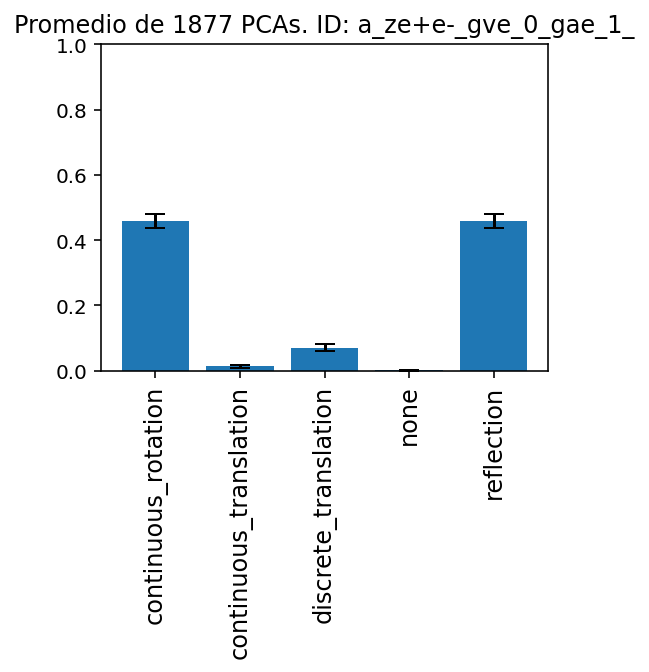

[0.47750263 0.01173285 0.06575007 0.00065018 0.44436427]


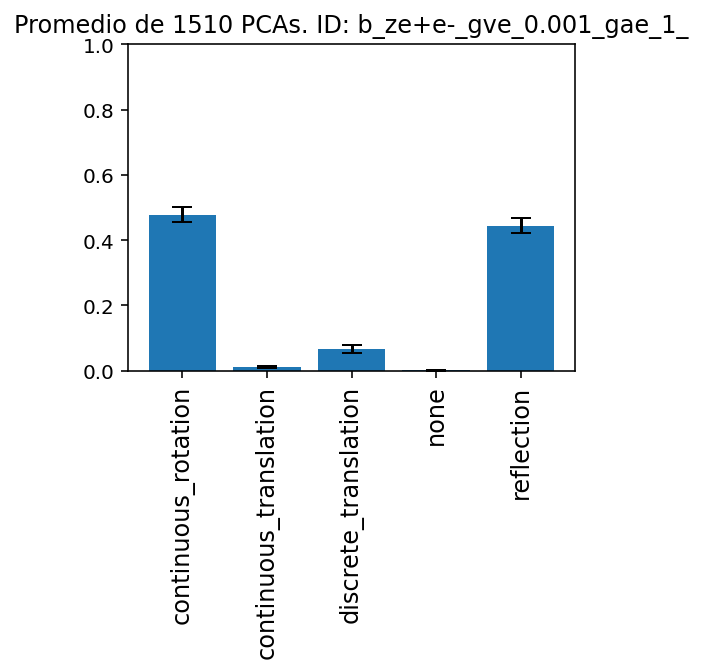

[0.47312244 0.01396697 0.06936119 0.00183391 0.44171549]


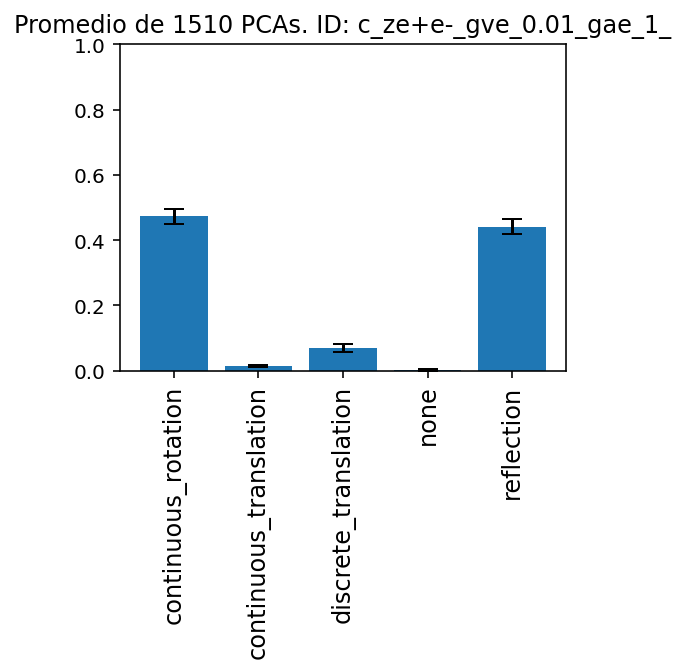

[0.3866089  0.0190131  0.07698946 0.00119136 0.51619719]


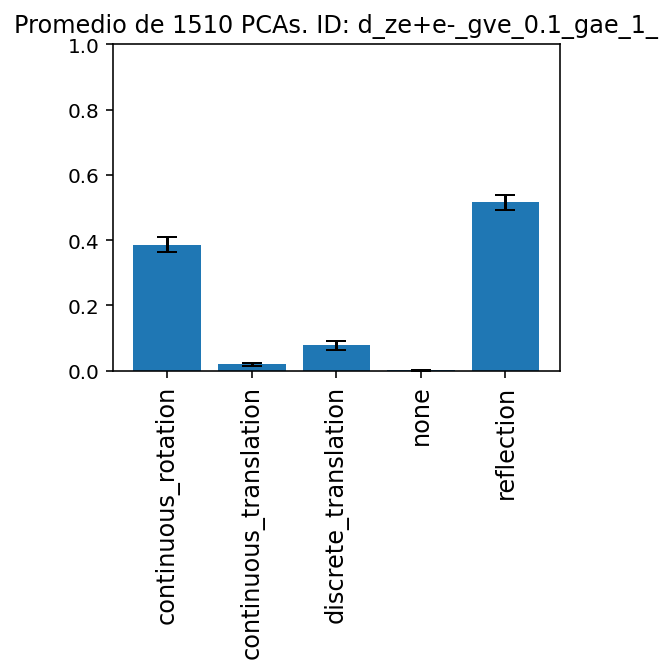

[2.48404538e-02 7.66029248e-01 3.74445766e-03 1.97534638e-04
 2.05188309e-01]


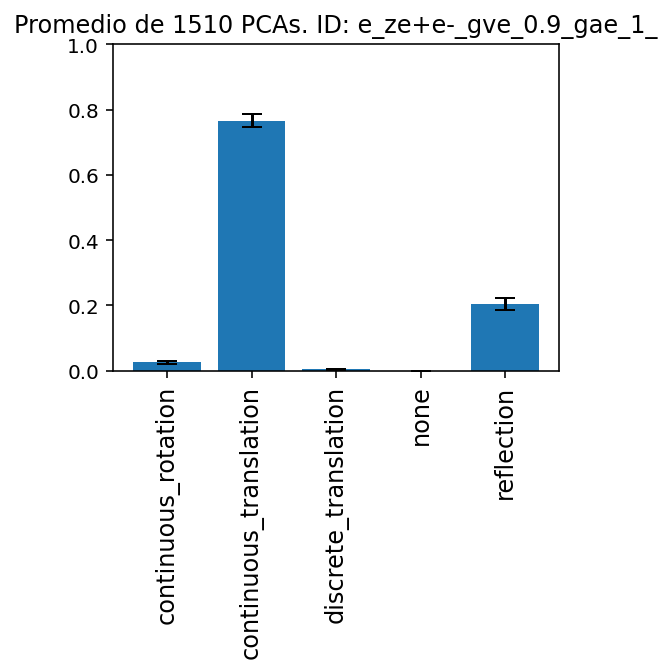

[2.26137855e-02 7.82508241e-01 2.24284189e-03 5.22740181e-04
 1.92112396e-01]


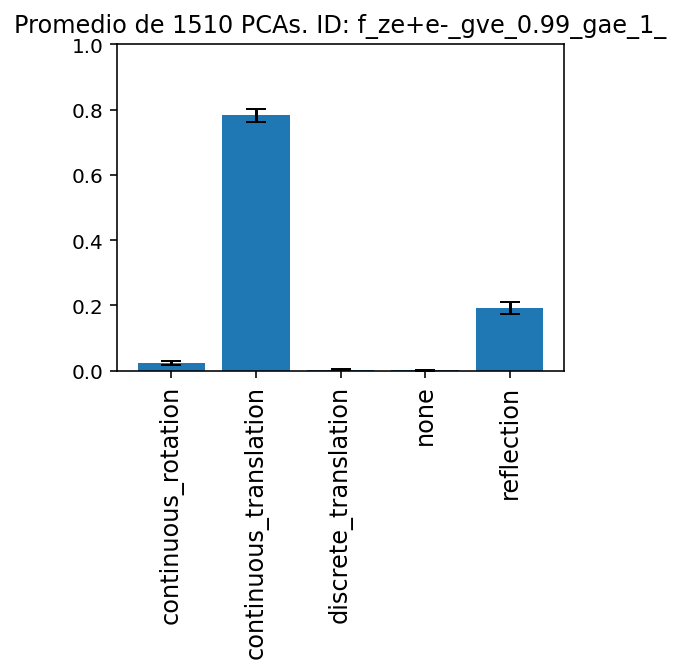

[0.0227889  0.76085979 0.00573352 0.00148262 0.20913517]


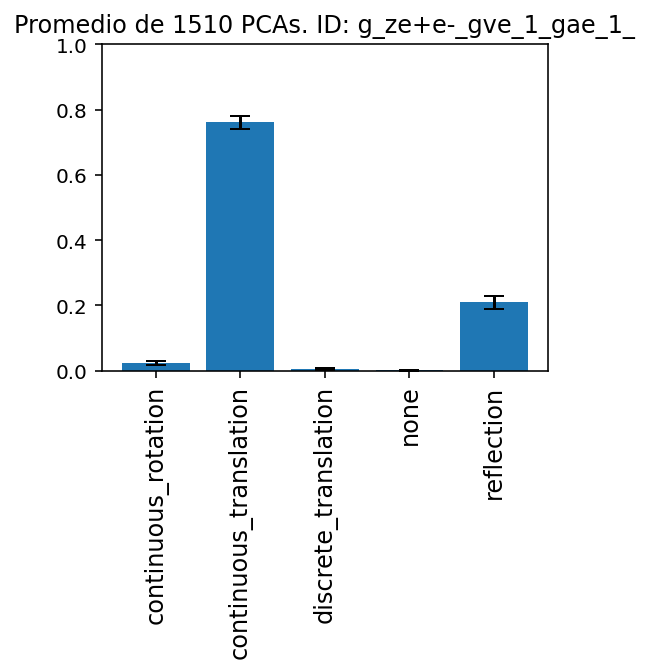

[2.43972874e-02 7.60703269e-01 5.87938855e-03 6.42450605e-04
 2.08377608e-01]


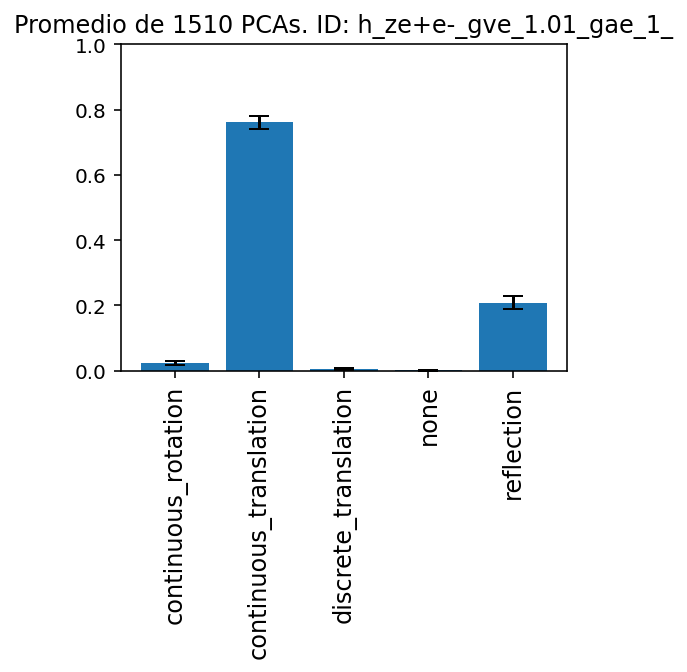

[0.02264046 0.76206928 0.00606714 0.00080405 0.20841908]


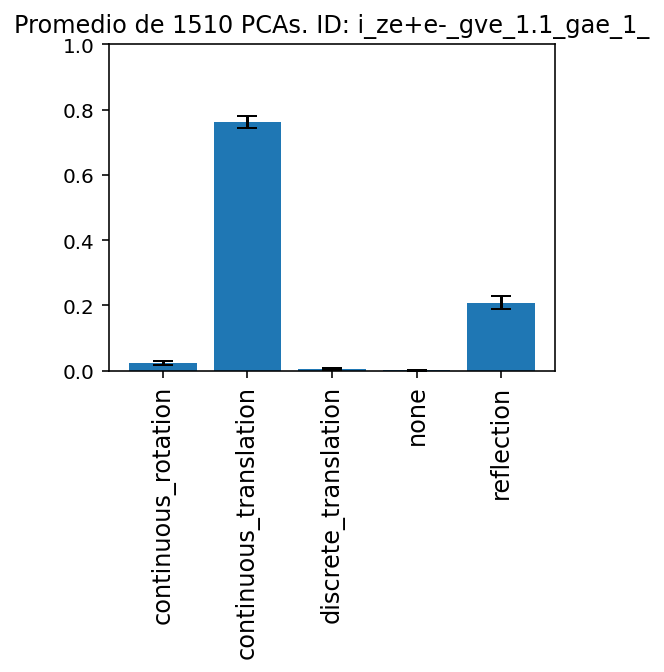

[3.90634127e-01 1.83405623e-02 6.90652452e-02 1.52329288e-05
 5.21944835e-01]


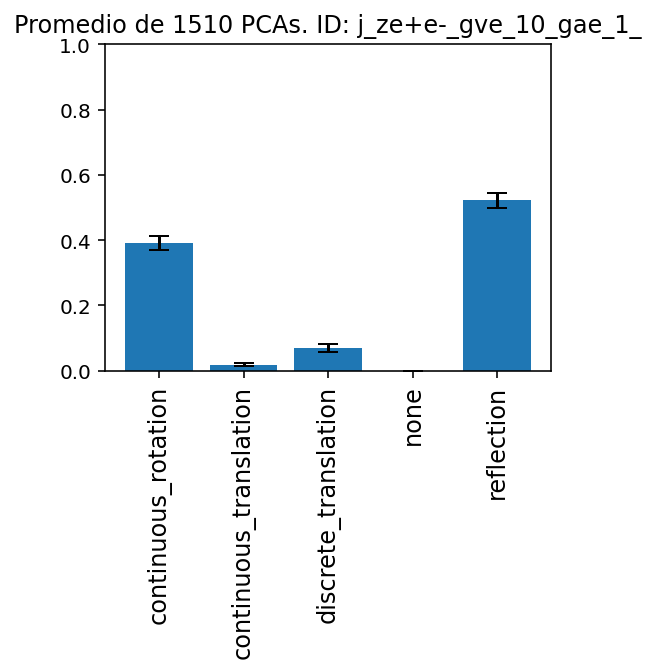

[0.46789072 0.01332086 0.08193041 0.00086389 0.43599412]


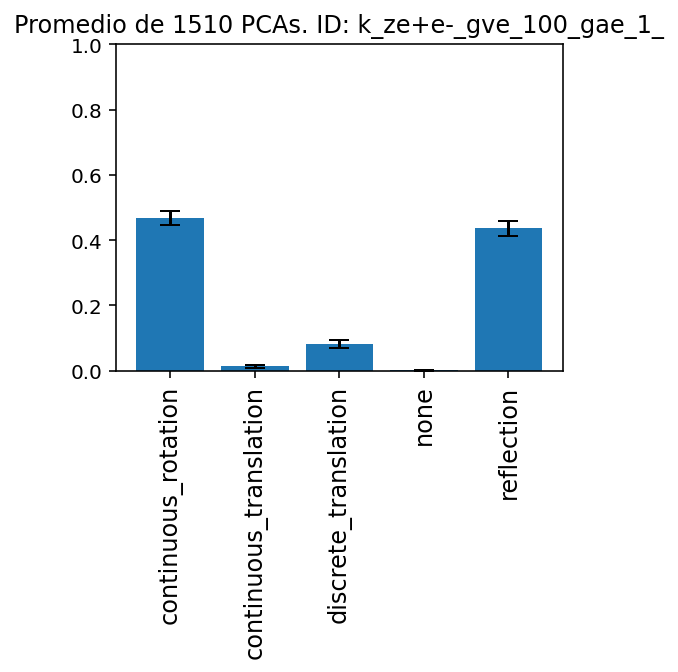

[0.45541135 0.01454603 0.06760951 0.00088514 0.46154797]


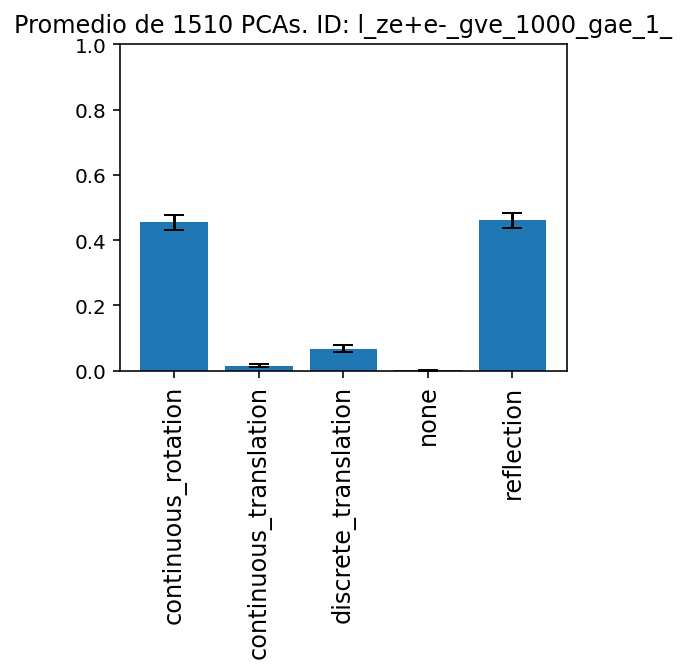

[4.89610055e-01 1.16060614e-02 6.39458037e-02 1.21622205e-04
 4.34716461e-01]


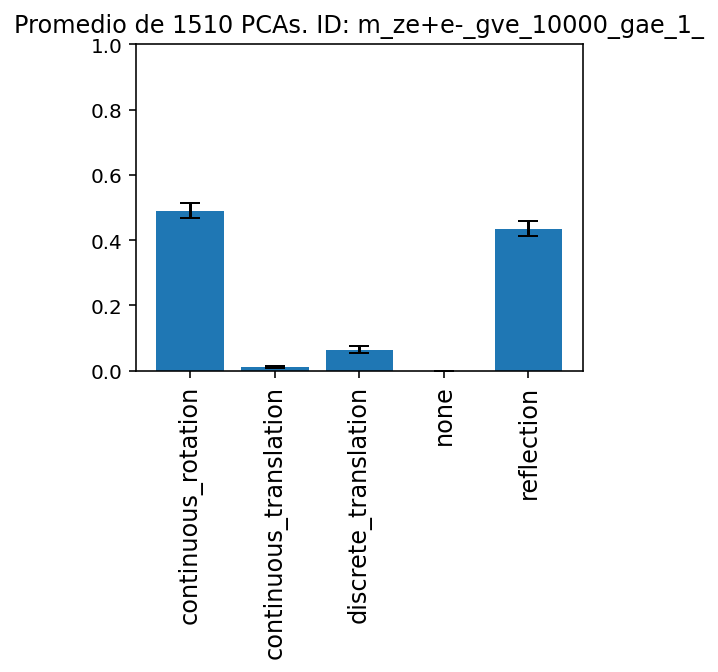

In [8]:
nom_carp = 'Ze+e-_couplings_ratio_uniform'

#import libraries
%config InlineBackend.figure_format = 'retina'
import seaborn as sns
from IPython.core.display import display, HTML, clear_output
display(HTML("<style>.container { width:100% !important; } div.cell.selected {border-left-width: 0px !important;}</style>"))

from time import time
import os
import glob
from fastai.vision.all import *
import numpy as np
from IPython.display import clear_output
import itertools as it
import more_itertools
#import torchvision.models
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.io as pio
pio.templates.default ="none"
import base64
from PIL import Image
from io import BytesIO
import torch
import gc
#import libraries

if not 'notebook_dir' in globals():
    notebook_dir = os.getcwd()
print('Notebook directory: ' + notebook_dir)
os.chdir(notebook_dir)  # If you changed the current working dir, this will take you back to the workbook dir.
top_dir = notebook_dir



modelo = 'G' # J or G

if modelo == 'G':
    #learn = load_learner('/home/gabriel/Desktop/models/model_93_accu_resnet18_10+5_none+reflection'+'.pkl', cpu=False)
    learn = load_learner('/home/gabriel/Desktop/models/model_90_accu_resnet18_one_cycle_10+5_no_mixup'+'.pkl', cpu=False)

if modelo == 'J':
    print('J')
        

#Reset Registro

columns = ['ID', 'Run'] + list(learn.dls.vocab)

registro = pd.DataFrame(columns = columns)
#registro


num_img_cat = [] #guardo el numero de imagenes de cada categoria
i = 0
plote = False

sims = pd.DataFrame(columns = learn.dls.vocab)
errs = sims.copy()

num_img_cat = [] #guardo el numero de imagenes de cada categoria
i = 0
plote = False

from IPython.utils import io


for dires in np.sort(Path('/home/gabriel/Desktop/Ze+e-_2/' + nom_carp).ls()):
    #path = Path('/home/gabriel/Desktop/PCA_INE_sexo/INE/'+quitadas)
    quitadas = str(dires).split('/')[-1]
    with io.capture_output() as captured:
        for ima in dires.ls():

            test_im_dir = ima

            im = PILImage.create(test_im_dir)

            # Orden: ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']

            cate, num_cat, probs = learn.predict(im)


            '''
            if plote == True:
                plt.figure
                plt.figure(figsize=(4, 3))
                plt.title(ima)
                plt.bar(['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection'],probs)
                plt.xticks(rotation='vertical',fontsize = 12)
                plt.show()
            '''

            new_row = np.array([quitadas, i] + list(np.array(probs).astype(float))).reshape([1,-1])
            aden = pd.DataFrame(new_row,columns=registro.columns)

            registro = registro.append(aden, ignore_index=True)

            i+=1

    registro = registro.astype({'ID':str, 'Run':int,'continuous_rotation':float, 'continuous_translation':float, 'discrete_translation':float, 'none':float, 'reflection':float })  

    print('Numero Imagenes:',i,)
    num_img_cat.append(i)


print(registro['ID'].unique())

#registro = pd.read_csv('/home/gabriel/Desktop/PCA_INE_sexo/registro.csv')

nombres_carps = registro['ID'].unique() #Nombres de las carpetas donde estan guyardadas las pcas de un tipo
num_carps = len(nombres_carps)

#registro = pd.read_csv('/home/gabriel/Desktop/PCA_INE_sexo/registro.csv')


i = 0


for nom in np.sort(nombres_carps):
    if i == 0:
        m_probs = np.array(registro.iloc[:num_img_cat[0],2:].mean())
        err_probs = np.array(registro.iloc[:num_img_cat[0],2:].std())
        nume = str(len(registro.iloc[:num_img_cat[0],2:]))
        print(learn.dls.vocab)
        print(m_probs)
        sims = sims.append(pd.DataFrame([m_probs], columns = sims.columns),ignore_index = True)
        errs = errs.append(pd.DataFrame([err_probs/np.sqrt(float(nume))], columns = errs.columns),ignore_index = True)
    else:
        m_probs = np.array(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:].mean())
        err_probs = np.array(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:].std())
        nume = str(len(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:]))
        print(m_probs)
        sims = sims.append(pd.DataFrame([m_probs], columns = sims.columns),ignore_index = True)
        errs = errs.append(pd.DataFrame([err_probs/np.sqrt(float(nume))], columns = errs.columns),ignore_index = True)

    if nom == '-ninguna-':
        tit = 'Promedio de '+nume+' PCAs sin quitar ninguna columna'
    else:
        tit = 'Promedio de '+nume+' PCAs. ID: '+ nom        

    
    plt.figure(figsize=(4, 3))
    plt.title(tit)
    #plt.title('Promedio de '+str(40)+' PCAs sin quitar ninguna columna')
    plt.bar(columns[2:],
            m_probs,yerr = 2*err_probs/np.sqrt(float(nume)), capsize = 5)
    plt.xticks(rotation='vertical',fontsize = 12)
    plt.ylim([0, 1])
    plt.show()

    
    i+=1

Text(0.5, 0, 'ratio')

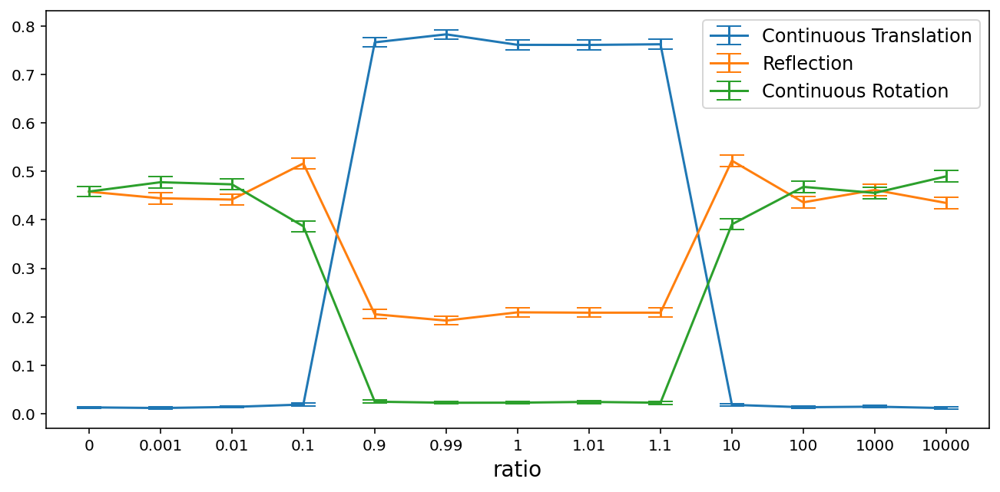

In [12]:
alfas = [0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]

#plt.errorbar(range(len(sims_0.reflection)),sims_0.reflection, yerr = errs_0.reflection,capsize = 8,label = 'Umbral: 0+')
#plt.errorbar(range(len(sims_4.reflection)),sims_4.reflection, yerr = errs_4.reflection,capsize = 8,label = 'Umbral: 4+')
#plt.errorbar(range(len(sims_10.reflection)),sims_10.reflection, yerr = errs_10.reflection,capsize = 8,label = 'Umbral: 10+')

#plt.errorbar(range(len(sims.reflection)),sims.reflection, yerr = errs.reflection,capsize = 8,label = 'Umbral: 4+')
#plt.errorbar(range(len(sims_0.none)),1-sims_0.none, yerr = errs_0.none,capsize = 8,label = 'Umbral: 0+')
#plt.errorbar(range(len(sims.none)),1-sims.none, yerr = errs.none,capsize = 8,label = 'Umbral: 4+, 1 $-$ none')
#plt.errorbar(range(len(sims.reflection)),sims.reflection, yerr = errs.reflection,capsize = 8,label = 'Umbral: 4+, reflection')
#plt.errorbar(range(len(sims_10.none)),1-sims_10.none, yerr = errs_10.none,capsize = 8,label = 'Umbral: 10+')

#lt.errorbar(range(len(sims.none)),sims.none, yerr = errs.none,capsize = 8,label = 'None')
plt.figure(figsize = [11,5])
#plt.errorbar(range(len(sims.none)),sims.none+sims.reflection, 
#             yerr = np.sqrt(errs.none**2 + errs.reflection**2),capsize = 8,label = 'Reflection + None')
plt.errorbar(range(len(sims.continuous_translation)),sims.continuous_translation, 
             yerr = errs.continuous_translation,capsize = 8,label = 'Continuous Translation')
plt.errorbar(range(len(sims.reflection)),sims.reflection, yerr = errs.reflection,capsize = 8,label = 'Reflection')
plt.errorbar(range(len(sims.continuous_rotation)),sims.continuous_rotation, 
             yerr = errs.continuous_rotation,capsize = 8,label = 'Continuous Rotation')
tik = plt.xticks(range(len(sims.reflection)),alfas)
plt.legend(fontsize = 12)
plt.xlabel('ratio',fontsize = 14)
#plt.ylim([0.5,1.01])
#plt.ylabel('Reflection')
#plt.title('Simetrías en Trabajo-Puesto HM_inv (AI)')

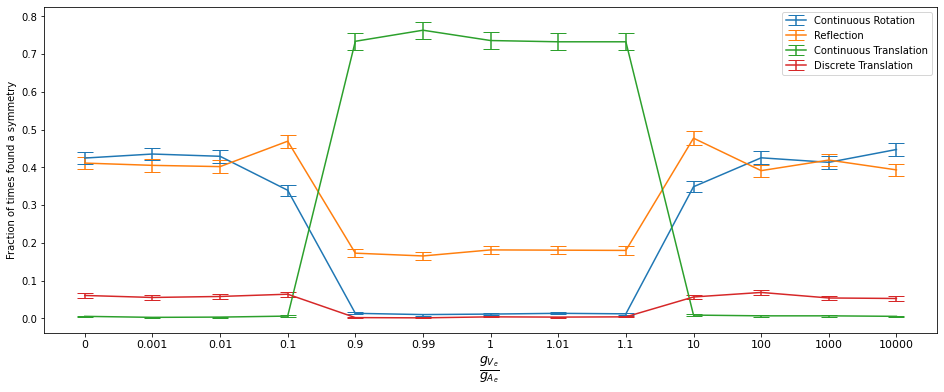

In [7]:
registro = pd.read_csv('registro_1500_times_ratio_uniform.csv') #pd.read_csv('registro_200_times_couplings.csv')
rep_todo = 1500

etis = []

#gve_l = [1,0.9,0.85,0.8,0.7,0.5,0.3,0.2,0.15,0.1,0]
#gae_l = [0,0.1,0.15,0.2,0.3,0.5,0.7,0.8,0.85,0.9,1]
rs = [0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]
gae_l = [1 for r in rs]
gve_l = [np.round(r,2) for r in rs]

for k in range(len(gve_l)):
    #etis.append(r'$g_{V_e} =$ '+str(gve_l[k])+'\n $g_{A_e} =$ '+str(gae_l[k]))
    etis.append(str(rs[k]))

plt.figure(figsize = [16,6])
plt.errorbar(x = list(range(len(gae_l))), y = registro.continuous_rotation/rep_todo, 
             yerr = np.sqrt(np.array(registro.continuous_rotation).astype(np.float32))/rep_todo, capsize = 8, label = 'Continuous Rotation')
plt.errorbar(x = list(range(len(gae_l))), y = registro.reflection/rep_todo, 
             yerr = np.sqrt(np.array(registro.reflection).astype(np.float32))/rep_todo, capsize = 8, label = 'Reflection')
plt.errorbar(x = list(range(len(gae_l))), y = registro.continuous_translation/rep_todo, 
             yerr = np.sqrt(np.array(registro.continuous_translation).astype(np.float32))/rep_todo, capsize = 8, label = 'Continuous Translation')
plt.errorbar(x = list(range(len(gae_l))), y = registro.discrete_translation/rep_todo, 
             yerr = np.sqrt(np.array(registro.discrete_translation).astype(np.float32))/rep_todo, capsize = 8, label = 'Discrete Translation')
plt.xticks(range(len(gae_l)),etis, fontsize = 11)
plt.ylabel('Fraction of times found a symmetry')
plt.xlabel(r'$\frac{g_{V_e}}{g_{A_e}} $ ',fontsize = 18)
plt.legend()
plt.show()

In [177]:
registro.to_csv('registro_1500_times_ratio_uniform.csv')

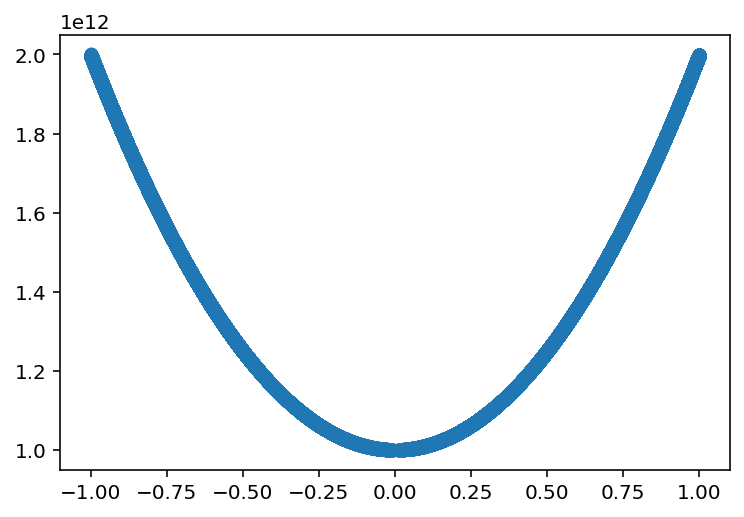

In [41]:
gve = 1000
gae = 1

name = 'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) + '.csv'
df_e = pd.read_csv(os.path.join(folder_0,name))
plt.scatter(df_e.cos_theta,df_e.diff_sigma)

# Cross Section Test

Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_

PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_11639579425__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9997000098228455

1 PCA's made out of 1500.

0.1 minutes elapsed for 1 images.
0.1 minutes average per image.
83.3 minutes estimated left for 1499 images.



1.4 hours estimated left for 1499 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_

PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_21639579428__PCA.png




2 PCA's made out of 1500.

0.1 minutes elapsed for 2 images.
0.1 minutes average per image.
79.7 minutes estimated left for 1498 images.



1.3 hours estimated left for 1498 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_31639579431__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9746999740600586

3 PCA's made out of 1500.

0.1 minutes elapsed for 3 images.
0.0 minutes average per image.
74.1 minutes estimated left for 1497 images.



1.2 hours estimated left for 1497 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_

PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_41639579433__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.805899977684021

4 PCA's made out of 1500.

0.2 minutes elapsed for 4 images.
0.0 minutes average per image.
71.0 minutes estimated left for 1496 images.



1.2 hours estimated left for 1496 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_

PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_51639579436__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

5 PCA's made out of 1500.

0.2 minutes elapsed for 5 images.
0.0 minutes average per image.
69.2 minutes estimated left for 1495 images.



1.2 hours estimated left for 1495 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_61639579439__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.7950999736785889

6 PCA's made out of 1500.

0.3 minutes elapsed for 6 images.
0.0 minutes average per image.
68.1 minutes estimated left for 1494 images.



1.1 hours estimated left for 1494 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_71639579441__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9976000189781189

7 PCA's made out of 1500.

0.3 minutes elapsed for 7 images.
0.0 minutes average per image.
67.3 minutes estimated left for 1493 images.



1.1 hours estimated left for 1493 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_

PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_81639579444__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9725000262260437

8 PCA's made out of 1500.

0.4 minutes elapsed for 8 images.
0.0 minutes average per image.
66.7 minutes estimated left for 1492 images.



1.1 hours estimated left for 1492 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_

PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_91639579446__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9660000205039978

9 PCA's made out of 1500.

0.4 minutes elapsed for 9 images.
0.0 minutes average per image.
66.1 minutes estimated left for 1491 images.



1.1 hours estimated left for 1491 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_101639579449__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9976999759674072

10 PCA's made out of 1500.

0.4 minutes elapsed for 10 images.
0.0 minutes average per image.
65.7 minutes estimated left for 1490 images.



1.1 hours estimated left for 1490 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_

PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_111639579451__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9818999767303467

11 PCA's made out of 1500.

0.5 minutes elapsed for 11 images.
0.0 minutes average per image.
65.3 minutes estimated left for 1489 images.



1.1 hours estimated left for 1489 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Creating directory:
 /home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_

PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_121639579454__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9014000296592712

12 PCA's made out of 1500.

0.5 minutes elapsed for 12 images.
0.0 minutes average per image.
64.9 minutes estimated left for 1488 images.



1.1 hours estimated left for 1488 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_131639579456__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994000196456909

13 PCA's made out of 1500.

0.6 minutes elapsed for 13 images.
0.0 minutes average per image.
64.7 minutes estimated left for 1487 images.



1.1 hours estimated left for 1487 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_141639579459__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

14 PCA's made out of 1500.

0.6 minutes elapsed for 14 images.
0.0 minutes average per image.
64.4 minutes estimated left for 1486 images.



1.1 hours estimated left for 1486 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_151639579461__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9542999863624573

15 PCA's made out of 1500.

0.6 minutes elapsed for 15 images.
0.0 minutes average per image.
64.2 minutes estimated left for 1485 images.



1.1 hours estimated left for 1485 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_161639579464__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9998999834060669

16 PCA's made out of 1500.

0.7 minutes elapsed for 16 images.
0.0 minutes average per image.
64.3 minutes estimated left for 1484 images.



1.1 hours estimated left for 1484 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_171639579466__PCA.png




17 PCA's made out of 1500.

0.7 minutes elapsed for 17 images.
0.0 minutes average per image.
64.1 minutes estimated left for 1483 images.



1.1 hours estimated left for 1483 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_181639579469__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9908000230789185

18 PCA's made out of 1500.

0.8 minutes elapsed for 18 images.
0.0 minutes average per image.
63.9 minutes estimated left for 1482 images.



1.1 hours estimated left for 1482 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_191639579471__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9988999962806702

19 PCA's made out of 1500.

0.8 minutes elapsed for 19 images.
0.0 minutes average per image.
63.8 minutes estimated left for 1481 images.



1.1 hours estimated left for 1481 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_201639579474__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9682999849319458

20 PCA's made out of 1500.

0.9 minutes elapsed for 20 images.
0.0 minutes average per image.
63.6 minutes estimated left for 1480 images.



1.1 hours estimated left for 1480 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_211639579476__PCA.png




21 PCA's made out of 1500.

0.9 minutes elapsed for 21 images.
0.0 minutes average per image.
63.5 minutes estimated left for 1479 images.



1.1 hours estimated left for 1479 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_221639579479__PCA.png




22 PCA's made out of 1500.

0.9 minutes elapsed for 22 images.
0.0 minutes average per image.
63.4 minutes estimated left for 1478 images.



1.1 hours estimated left for 1478 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_231639579481__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9047999978065491

23 PCA's made out of 1500.

1.0 minutes elapsed for 23 images.
0.0 minutes average per image.
63.3 minutes estimated left for 1477 images.



1.1 hours estimated left for 1477 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_241639579484__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9666000008583069

24 PCA's made out of 1500.

1.0 minutes elapsed for 24 images.
0.0 minutes average per image.
63.2 minutes estimated left for 1476 images.



1.1 hours estimated left for 1476 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_251639579486__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9847000241279602

25 PCA's made out of 1500.

1.1 minutes elapsed for 25 images.
0.0 minutes average per image.
63.0 minutes estimated left for 1475 images.



1.1 hours estimated left for 1475 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_261639579489__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8871999979019165

26 PCA's made out of 1500.

1.1 minutes elapsed for 26 images.
0.0 minutes average per image.
63.0 minutes estimated left for 1474 images.



1.0 hours estimated left for 1474 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_271639579491__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9799000024795532

27 PCA's made out of 1500.

1.2 minutes elapsed for 27 images.
0.0 minutes average per image.
62.9 minutes estimated left for 1473 images.



1.0 hours estimated left for 1473 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_281639579494__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9318000078201294

28 PCA's made out of 1500.

1.2 minutes elapsed for 28 images.
0.0 minutes average per image.
62.8 minutes estimated left for 1472 images.



1.0 hours estimated left for 1472 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_291639579496__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7584999799728394

29 PCA's made out of 1500.

1.2 minutes elapsed for 29 images.
0.0 minutes average per image.
62.7 minutes estimated left for 1471 images.



1.0 hours estimated left for 1471 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_301639579499__PCA.png




30 PCA's made out of 1500.

1.3 minutes elapsed for 30 images.
0.0 minutes average per image.
62.6 minutes estimated left for 1470 images.



1.0 hours estimated left for 1470 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_311639579501__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9998000264167786

31 PCA's made out of 1500.

1.3 minutes elapsed for 31 images.
0.0 minutes average per image.
62.5 minutes estimated left for 1469 images.



1.0 hours estimated left for 1469 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_321639579504__PCA.png




32 PCA's made out of 1500.

1.4 minutes elapsed for 32 images.
0.0 minutes average per image.
62.4 minutes estimated left for 1468 images.



1.0 hours estimated left for 1468 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_331639579506__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

33 PCA's made out of 1500.

1.4 minutes elapsed for 33 images.
0.0 minutes average per image.
62.3 minutes estimated left for 1467 images.



1.0 hours estimated left for 1467 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_341639579509__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7505999803543091

34 PCA's made out of 1500.

1.4 minutes elapsed for 34 images.
0.0 minutes average per image.
62.2 minutes estimated left for 1466 images.



1.0 hours estimated left for 1466 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_351639579511__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9593999981880188

35 PCA's made out of 1500.

1.5 minutes elapsed for 35 images.
0.0 minutes average per image.
62.2 minutes estimated left for 1465 images.



1.0 hours estimated left for 1465 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_361639579514__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9629999995231628

36 PCA's made out of 1500.

1.5 minutes elapsed for 36 images.
0.0 minutes average per image.
62.1 minutes estimated left for 1464 images.



1.0 hours estimated left for 1464 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_371639579516__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

37 PCA's made out of 1500.

1.6 minutes elapsed for 37 images.
0.0 minutes average per image.
62.0 minutes estimated left for 1463 images.



1.0 hours estimated left for 1463 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_381639579519__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.7426000237464905

38 PCA's made out of 1500.

1.6 minutes elapsed for 38 images.
0.0 minutes average per image.
61.9 minutes estimated left for 1462 images.



1.0 hours estimated left for 1462 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_391639579521__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9894000291824341

39 PCA's made out of 1500.

1.7 minutes elapsed for 39 images.
0.0 minutes average per image.
61.9 minutes estimated left for 1461 images.



1.0 hours estimated left for 1461 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_401639579524__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9832000136375427

40 PCA's made out of 1500.

1.7 minutes elapsed for 40 images.
0.0 minutes average per image.
61.8 minutes estimated left for 1460 images.



1.0 hours estimated left for 1460 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_411639579526__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9902999997138977

41 PCA's made out of 1500.

1.7 minutes elapsed for 41 images.
0.0 minutes average per image.
61.7 minutes estimated left for 1459 images.



1.0 hours estimated left for 1459 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_421639579529__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.995199978351593

42 PCA's made out of 1500.

1.8 minutes elapsed for 42 images.
0.0 minutes average per image.
61.7 minutes estimated left for 1458 images.



1.0 hours estimated left for 1458 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_431639579531__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 1.0

43 PCA's made out of 1500.

1.8 minutes elapsed for 43 images.
0.0 minutes average per image.
61.6 minutes estimated left for 1457 images.



1.0 hours estimated left for 1457 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_441639579534__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 1.0

44 PCA's made out of 1500.

1.9 minutes elapsed for 44 images.
0.0 minutes average per image.
61.5 minutes estimated left for 1456 images.



1.0 hours estimated left for 1456 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_451639579536__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.8539000153541565

45 PCA's made out of 1500.

1.9 minutes elapsed for 45 images.
0.0 minutes average per image.
61.5 minutes estimated left for 1455 images.



1.0 hours estimated left for 1455 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_461639579539__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

46 PCA's made out of 1500.

1.9 minutes elapsed for 46 images.
0.0 minutes average per image.
61.4 minutes estimated left for 1454 images.



1.0 hours estimated left for 1454 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_471639579541__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.758400022983551

47 PCA's made out of 1500.

2.0 minutes elapsed for 47 images.
0.0 minutes average per image.
61.4 minutes estimated left for 1453 images.



1.0 hours estimated left for 1453 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_481639579544__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9068999886512756

48 PCA's made out of 1500.

2.0 minutes elapsed for 48 images.
0.0 minutes average per image.
61.3 minutes estimated left for 1452 images.



1.0 hours estimated left for 1452 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_491639579546__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9916999936103821

49 PCA's made out of 1500.

2.1 minutes elapsed for 49 images.
0.0 minutes average per image.
61.2 minutes estimated left for 1451 images.



1.0 hours estimated left for 1451 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_501639579549__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

50 PCA's made out of 1500.

2.1 minutes elapsed for 50 images.
0.0 minutes average per image.
61.2 minutes estimated left for 1450 images.



1.0 hours estimated left for 1450 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_511639579551__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.8844000101089478

51 PCA's made out of 1500.

2.2 minutes elapsed for 51 images.
0.0 minutes average per image.
61.1 minutes estimated left for 1449 images.



1.0 hours estimated left for 1449 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_521639579554__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9790999889373779

52 PCA's made out of 1500.

2.2 minutes elapsed for 52 images.
0.0 minutes average per image.
61.1 minutes estimated left for 1448 images.



1.0 hours estimated left for 1448 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_531639579556__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

53 PCA's made out of 1500.

2.2 minutes elapsed for 53 images.
0.0 minutes average per image.
61.0 minutes estimated left for 1447 images.



1.0 hours estimated left for 1447 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_541639579559__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9814000129699707

54 PCA's made out of 1500.

2.3 minutes elapsed for 54 images.
0.0 minutes average per image.
60.9 minutes estimated left for 1446 images.



1.0 hours estimated left for 1446 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_551639579561__PCA.png




55 PCA's made out of 1500.

2.3 minutes elapsed for 55 images.
0.0 minutes average per image.
60.9 minutes estimated left for 1445 images.



1.0 hours estimated left for 1445 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_561639579564__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

56 PCA's made out of 1500.

2.4 minutes elapsed for 56 images.
0.0 minutes average per image.
60.8 minutes estimated left for 1444 images.



1.0 hours estimated left for 1444 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_571639579566__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9994999766349792

57 PCA's made out of 1500.

2.4 minutes elapsed for 57 images.
0.0 minutes average per image.
60.8 minutes estimated left for 1443 images.



1.0 hours estimated left for 1443 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_581639579569__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

58 PCA's made out of 1500.

2.4 minutes elapsed for 58 images.
0.0 minutes average per image.
60.7 minutes estimated left for 1442 images.



1.0 hours estimated left for 1442 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_591639579571__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8508999943733215

59 PCA's made out of 1500.

2.5 minutes elapsed for 59 images.
0.0 minutes average per image.
60.7 minutes estimated left for 1441 images.



1.0 hours estimated left for 1441 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_601639579574__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9922000169754028

60 PCA's made out of 1500.

2.5 minutes elapsed for 60 images.
0.0 minutes average per image.
60.7 minutes estimated left for 1440 images.



1.0 hours estimated left for 1440 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_611639579576__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8986999988555908

61 PCA's made out of 1500.

2.6 minutes elapsed for 61 images.
0.0 minutes average per image.
60.6 minutes estimated left for 1439 images.



1.0 hours estimated left for 1439 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_621639579579__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8422999978065491

62 PCA's made out of 1500.

2.6 minutes elapsed for 62 images.
0.0 minutes average per image.
60.6 minutes estimated left for 1438 images.



1.0 hours estimated left for 1438 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_631639579582__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.987500011920929

63 PCA's made out of 1500.

2.7 minutes elapsed for 63 images.
0.0 minutes average per image.
60.6 minutes estimated left for 1437 images.



1.0 hours estimated left for 1437 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_641639579584__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9994000196456909

64 PCA's made out of 1500.

2.7 minutes elapsed for 64 images.
0.0 minutes average per image.
60.6 minutes estimated left for 1436 images.



1.0 hours estimated left for 1436 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_651639579587__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9639999866485596

65 PCA's made out of 1500.

2.7 minutes elapsed for 65 images.
0.0 minutes average per image.
60.5 minutes estimated left for 1435 images.



1.0 hours estimated left for 1435 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_661639579589__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9980999827384949

66 PCA's made out of 1500.

2.8 minutes elapsed for 66 images.
0.0 minutes average per image.
60.5 minutes estimated left for 1434 images.



1.0 hours estimated left for 1434 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_671639579592__PCA.png




67 PCA's made out of 1500.

2.8 minutes elapsed for 67 images.
0.0 minutes average per image.
60.4 minutes estimated left for 1433 images.



1.0 hours estimated left for 1433 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_681639579594__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9973999857902527

68 PCA's made out of 1500.

2.9 minutes elapsed for 68 images.
0.0 minutes average per image.
60.4 minutes estimated left for 1432 images.



1.0 hours estimated left for 1432 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_691639579597__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9933000206947327

69 PCA's made out of 1500.

2.9 minutes elapsed for 69 images.
0.0 minutes average per image.
60.3 minutes estimated left for 1431 images.



1.0 hours estimated left for 1431 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_701639579599__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9305999875068665

70 PCA's made out of 1500.

3.0 minutes elapsed for 70 images.
0.0 minutes average per image.
60.3 minutes estimated left for 1430 images.



1.0 hours estimated left for 1430 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_711639579602__PCA.png




71 PCA's made out of 1500.

3.0 minutes elapsed for 71 images.
0.0 minutes average per image.
60.2 minutes estimated left for 1429 images.



1.0 hours estimated left for 1429 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_721639579604__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8654999732971191

72 PCA's made out of 1500.

3.0 minutes elapsed for 72 images.
0.0 minutes average per image.
60.2 minutes estimated left for 1428 images.



1.0 hours estimated left for 1428 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_731639579607__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9190000295639038

73 PCA's made out of 1500.

3.1 minutes elapsed for 73 images.
0.0 minutes average per image.
60.1 minutes estimated left for 1427 images.



1.0 hours estimated left for 1427 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_741639579609__PCA.png




74 PCA's made out of 1500.

3.1 minutes elapsed for 74 images.
0.0 minutes average per image.
60.1 minutes estimated left for 1426 images.



1.0 hours estimated left for 1426 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_751639579612__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

75 PCA's made out of 1500.

3.2 minutes elapsed for 75 images.
0.0 minutes average per image.
60.0 minutes estimated left for 1425 images.



1.0 hours estimated left for 1425 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_761639579614__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 1.0

76 PCA's made out of 1500.

3.2 minutes elapsed for 76 images.
0.0 minutes average per image.
60.0 minutes estimated left for 1424 images.



1.0 hours estimated left for 1424 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_771639579617__PCA.png




77 PCA's made out of 1500.

3.2 minutes elapsed for 77 images.
0.0 minutes average per image.
59.9 minutes estimated left for 1423 images.



1.0 hours estimated left for 1423 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_781639579619__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9847000241279602

78 PCA's made out of 1500.

3.3 minutes elapsed for 78 images.
0.0 minutes average per image.
59.9 minutes estimated left for 1422 images.



1.0 hours estimated left for 1422 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_791639579622__PCA.png




79 PCA's made out of 1500.

3.3 minutes elapsed for 79 images.
0.0 minutes average per image.
59.8 minutes estimated left for 1421 images.



1.0 hours estimated left for 1421 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_801639579624__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9908999800682068

80 PCA's made out of 1500.

3.4 minutes elapsed for 80 images.
0.0 minutes average per image.
59.8 minutes estimated left for 1420 images.



1.0 hours estimated left for 1420 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_811639579627__PCA.png




81 PCA's made out of 1500.

3.4 minutes elapsed for 81 images.
0.0 minutes average per image.
59.7 minutes estimated left for 1419 images.



1.0 hours estimated left for 1419 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_821639579629__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.998199999332428

82 PCA's made out of 1500.

3.5 minutes elapsed for 82 images.
0.0 minutes average per image.
59.7 minutes estimated left for 1418 images.



1.0 hours estimated left for 1418 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_831639579632__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.7563999891281128

83 PCA's made out of 1500.

3.5 minutes elapsed for 83 images.
0.0 minutes average per image.
59.6 minutes estimated left for 1417 images.



1.0 hours estimated left for 1417 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_841639579634__PCA.png




84 PCA's made out of 1500.

3.5 minutes elapsed for 84 images.
0.0 minutes average per image.
59.6 minutes estimated left for 1416 images.



1.0 hours estimated left for 1416 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_851639579637__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9962000250816345

85 PCA's made out of 1500.

3.6 minutes elapsed for 85 images.
0.0 minutes average per image.
59.6 minutes estimated left for 1415 images.



1.0 hours estimated left for 1415 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_861639579639__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9998000264167786

86 PCA's made out of 1500.

3.6 minutes elapsed for 86 images.
0.0 minutes average per image.
59.5 minutes estimated left for 1414 images.



1.0 hours estimated left for 1414 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_871639579642__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8912000060081482

87 PCA's made out of 1500.

3.7 minutes elapsed for 87 images.
0.0 minutes average per image.
59.5 minutes estimated left for 1413 images.



1.0 hours estimated left for 1413 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_881639579644__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9943000078201294

88 PCA's made out of 1500.

3.7 minutes elapsed for 88 images.
0.0 minutes average per image.
59.4 minutes estimated left for 1412 images.



1.0 hours estimated left for 1412 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_891639579647__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9965999722480774

89 PCA's made out of 1500.

3.7 minutes elapsed for 89 images.
0.0 minutes average per image.
59.4 minutes estimated left for 1411 images.



1.0 hours estimated left for 1411 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_901639579649__PCA.png




90 PCA's made out of 1500.

3.8 minutes elapsed for 90 images.
0.0 minutes average per image.
59.3 minutes estimated left for 1410 images.



1.0 hours estimated left for 1410 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_911639579652__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9972000122070312

91 PCA's made out of 1500.

3.8 minutes elapsed for 91 images.
0.0 minutes average per image.
59.3 minutes estimated left for 1409 images.



1.0 hours estimated left for 1409 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_921639579654__PCA.png




92 PCA's made out of 1500.

3.9 minutes elapsed for 92 images.
0.0 minutes average per image.
59.2 minutes estimated left for 1408 images.



1.0 hours estimated left for 1408 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_931639579657__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.973800003528595

93 PCA's made out of 1500.

3.9 minutes elapsed for 93 images.
0.0 minutes average per image.
59.2 minutes estimated left for 1407 images.



1.0 hours estimated left for 1407 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_941639579659__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9995999932289124

94 PCA's made out of 1500.

4.0 minutes elapsed for 94 images.
0.0 minutes average per image.
59.1 minutes estimated left for 1406 images.



1.0 hours estimated left for 1406 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_951639579662__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9815999865531921

95 PCA's made out of 1500.

4.0 minutes elapsed for 95 images.
0.0 minutes average per image.
59.1 minutes estimated left for 1405 images.



1.0 hours estimated left for 1405 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_961639579664__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9966999888420105

96 PCA's made out of 1500.

4.0 minutes elapsed for 96 images.
0.0 minutes average per image.
59.0 minutes estimated left for 1404 images.



1.0 hours estimated left for 1404 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_971639579667__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9768000245094299

97 PCA's made out of 1500.

4.1 minutes elapsed for 97 images.
0.0 minutes average per image.
59.0 minutes estimated left for 1403 images.



1.0 hours estimated left for 1403 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_981639579669__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9495000243186951

98 PCA's made out of 1500.

4.1 minutes elapsed for 98 images.
0.0 minutes average per image.
58.9 minutes estimated left for 1402 images.



1.0 hours estimated left for 1402 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_991639579672__PCA.png



Found discrete_translation symmetry with features Px2 and Py1, with prob. 1.0

99 PCA's made out of 1500.

4.2 minutes elapsed for 99 images.
0.0 minutes average per image.
58.9 minutes estimated left for 1401 images.



1.0 hours estimated left for 1401 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_1001639579674__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

100 PCA's made out of 1500.

4.2 minutes elapsed for 100 images.
0.0 minutes average per image.
58.8 minutes estimated left for 1400 images.



1.0 hours estimated left for 1400 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1011639579677__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.8082000017166138

101 PCA's made out of 1500.

4.2 minutes elapsed for 101 images.
0.0 minutes average per image.
58.8 minutes estimated left for 1399 images.



1.0 hours estimated left for 1399 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_1021639579679__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9998000264167786

102 PCA's made out of 1500.

4.3 minutes elapsed for 102 images.
0.0 minutes average per image.
58.7 minutes estimated left for 1398 images.



1.0 hours estimated left for 1398 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1031639579682__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9972000122070312

103 PCA's made out of 1500.

4.3 minutes elapsed for 103 images.
0.0 minutes average per image.
58.7 minutes estimated left for 1397 images.



1.0 hours estimated left for 1397 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_1041639579684__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9988999962806702

104 PCA's made out of 1500.

4.4 minutes elapsed for 104 images.
0.0 minutes average per image.
58.6 minutes estimated left for 1396 images.



1.0 hours estimated left for 1396 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_1051639579687__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.993399977684021

105 PCA's made out of 1500.

4.4 minutes elapsed for 105 images.
0.0 minutes average per image.
58.6 minutes estimated left for 1395 images.



1.0 hours estimated left for 1395 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1061639579689__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9394999742507935

106 PCA's made out of 1500.

4.5 minutes elapsed for 106 images.
0.0 minutes average per image.
58.5 minutes estimated left for 1394 images.



1.0 hours estimated left for 1394 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_1071639579692__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.96670001745224

107 PCA's made out of 1500.

4.5 minutes elapsed for 107 images.
0.0 minutes average per image.
58.5 minutes estimated left for 1393 images.



1.0 hours estimated left for 1393 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_1081639579694__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9825999736785889

108 PCA's made out of 1500.

4.5 minutes elapsed for 108 images.
0.0 minutes average per image.
58.5 minutes estimated left for 1392 images.



1.0 hours estimated left for 1392 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1091639579697__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9995999932289124

109 PCA's made out of 1500.

4.6 minutes elapsed for 109 images.
0.0 minutes average per image.
58.4 minutes estimated left for 1391 images.



1.0 hours estimated left for 1391 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1101639579699__PCA.png




110 PCA's made out of 1500.

4.6 minutes elapsed for 110 images.
0.0 minutes average per image.
58.4 minutes estimated left for 1390 images.



1.0 hours estimated left for 1390 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_1111639579702__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

111 PCA's made out of 1500.

4.7 minutes elapsed for 111 images.
0.0 minutes average per image.
58.3 minutes estimated left for 1389 images.



1.0 hours estimated left for 1389 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1121639579704__PCA.png




112 PCA's made out of 1500.

4.7 minutes elapsed for 112 images.
0.0 minutes average per image.
58.3 minutes estimated left for 1388 images.



1.0 hours estimated left for 1388 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1131639579707__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

113 PCA's made out of 1500.

4.7 minutes elapsed for 113 images.
0.0 minutes average per image.
58.3 minutes estimated left for 1387 images.



1.0 hours estimated left for 1387 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_1141639579709__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9969000220298767

114 PCA's made out of 1500.

4.8 minutes elapsed for 114 images.
0.0 minutes average per image.
58.2 minutes estimated left for 1386 images.



1.0 hours estimated left for 1386 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_1151639579712__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9211999773979187

115 PCA's made out of 1500.

4.8 minutes elapsed for 115 images.
0.0 minutes average per image.
58.2 minutes estimated left for 1385 images.



1.0 hours estimated left for 1385 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_1161639579714__PCA.png




116 PCA's made out of 1500.

4.9 minutes elapsed for 116 images.
0.0 minutes average per image.
58.1 minutes estimated left for 1384 images.



1.0 hours estimated left for 1384 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1171639579717__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

117 PCA's made out of 1500.

4.9 minutes elapsed for 117 images.
0.0 minutes average per image.
58.1 minutes estimated left for 1383 images.



1.0 hours estimated left for 1383 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1181639579719__PCA.png




118 PCA's made out of 1500.

5.0 minutes elapsed for 118 images.
0.0 minutes average per image.
58.0 minutes estimated left for 1382 images.



1.0 hours estimated left for 1382 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1191639579722__PCA.png




119 PCA's made out of 1500.

5.0 minutes elapsed for 119 images.
0.0 minutes average per image.
58.0 minutes estimated left for 1381 images.



1.0 hours estimated left for 1381 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_1201639579724__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9998999834060669

120 PCA's made out of 1500.

5.0 minutes elapsed for 120 images.
0.0 minutes average per image.
57.9 minutes estimated left for 1380 images.



1.0 hours estimated left for 1380 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1211639579727__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9258999824523926

121 PCA's made out of 1500.

5.1 minutes elapsed for 121 images.
0.0 minutes average per image.
57.9 minutes estimated left for 1379 images.



1.0 hours estimated left for 1379 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_1221639579729__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

122 PCA's made out of 1500.

5.1 minutes elapsed for 122 images.
0.0 minutes average per image.
57.8 minutes estimated left for 1378 images.



1.0 hours estimated left for 1378 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_1231639579732__PCA.png




123 PCA's made out of 1500.

5.2 minutes elapsed for 123 images.
0.0 minutes average per image.
57.8 minutes estimated left for 1377 images.



1.0 hours estimated left for 1377 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1241639579734__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

124 PCA's made out of 1500.

5.2 minutes elapsed for 124 images.
0.0 minutes average per image.
57.8 minutes estimated left for 1376 images.



1.0 hours estimated left for 1376 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_1251639579737__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.942300021648407

125 PCA's made out of 1500.

5.2 minutes elapsed for 125 images.
0.0 minutes average per image.
57.7 minutes estimated left for 1375 images.



1.0 hours estimated left for 1375 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_1261639579740__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9779000282287598

126 PCA's made out of 1500.

5.3 minutes elapsed for 126 images.
0.0 minutes average per image.
57.7 minutes estimated left for 1374 images.



1.0 hours estimated left for 1374 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1271639579742__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

127 PCA's made out of 1500.

5.3 minutes elapsed for 127 images.
0.0 minutes average per image.
57.7 minutes estimated left for 1373 images.



1.0 hours estimated left for 1373 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1281639579745__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9611999988555908

128 PCA's made out of 1500.

5.4 minutes elapsed for 128 images.
0.0 minutes average per image.
57.6 minutes estimated left for 1372 images.



1.0 hours estimated left for 1372 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_1291639579747__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9998999834060669

129 PCA's made out of 1500.

5.4 minutes elapsed for 129 images.
0.0 minutes average per image.
57.6 minutes estimated left for 1371 images.



1.0 hours estimated left for 1371 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1301639579750__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

130 PCA's made out of 1500.

5.5 minutes elapsed for 130 images.
0.0 minutes average per image.
57.5 minutes estimated left for 1370 images.



1.0 hours estimated left for 1370 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_1311639579752__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 1.0

131 PCA's made out of 1500.

5.5 minutes elapsed for 131 images.
0.0 minutes average per image.
57.5 minutes estimated left for 1369 images.



1.0 hours estimated left for 1369 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1321639579755__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.847599983215332

132 PCA's made out of 1500.

5.5 minutes elapsed for 132 images.
0.0 minutes average per image.
57.4 minutes estimated left for 1368 images.



1.0 hours estimated left for 1368 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_1331639579757__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9912999868392944

133 PCA's made out of 1500.

5.6 minutes elapsed for 133 images.
0.0 minutes average per image.
57.4 minutes estimated left for 1367 images.



1.0 hours estimated left for 1367 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_1341639579760__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.8815000057220459

134 PCA's made out of 1500.

5.6 minutes elapsed for 134 images.
0.0 minutes average per image.
57.4 minutes estimated left for 1366 images.



1.0 hours estimated left for 1366 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_1351639579762__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

135 PCA's made out of 1500.

5.7 minutes elapsed for 135 images.
0.0 minutes average per image.
57.3 minutes estimated left for 1365 images.



1.0 hours estimated left for 1365 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_1361639579765__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9016000032424927

136 PCA's made out of 1500.

5.7 minutes elapsed for 136 images.
0.0 minutes average per image.
57.3 minutes estimated left for 1364 images.



1.0 hours estimated left for 1364 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1371639579767__PCA.png




137 PCA's made out of 1500.

5.8 minutes elapsed for 137 images.
0.0 minutes average per image.
57.2 minutes estimated left for 1363 images.



1.0 hours estimated left for 1363 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_1381639579770__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9994999766349792

138 PCA's made out of 1500.

5.8 minutes elapsed for 138 images.
0.0 minutes average per image.
57.2 minutes estimated left for 1362 images.



1.0 hours estimated left for 1362 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1391639579772__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9934999942779541

139 PCA's made out of 1500.

5.8 minutes elapsed for 139 images.
0.0 minutes average per image.
57.1 minutes estimated left for 1361 images.



1.0 hours estimated left for 1361 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1401639579775__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

140 PCA's made out of 1500.

5.9 minutes elapsed for 140 images.
0.0 minutes average per image.
57.1 minutes estimated left for 1360 images.



1.0 hours estimated left for 1360 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_1411639579777__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9998999834060669

141 PCA's made out of 1500.

5.9 minutes elapsed for 141 images.
0.0 minutes average per image.
57.1 minutes estimated left for 1359 images.



1.0 hours estimated left for 1359 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_1421639579780__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

142 PCA's made out of 1500.

6.0 minutes elapsed for 142 images.
0.0 minutes average per image.
57.0 minutes estimated left for 1358 images.



1.0 hours estimated left for 1358 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_1431639579782__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9821000099182129

143 PCA's made out of 1500.

6.0 minutes elapsed for 143 images.
0.0 minutes average per image.
57.0 minutes estimated left for 1357 images.



0.9 hours estimated left for 1357 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_1441639579785__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

144 PCA's made out of 1500.

6.0 minutes elapsed for 144 images.
0.0 minutes average per image.
56.9 minutes estimated left for 1356 images.



0.9 hours estimated left for 1356 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1451639579787__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.996399998664856

145 PCA's made out of 1500.

6.1 minutes elapsed for 145 images.
0.0 minutes average per image.
56.9 minutes estimated left for 1355 images.



0.9 hours estimated left for 1355 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_1461639579790__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9997000098228455

146 PCA's made out of 1500.

6.1 minutes elapsed for 146 images.
0.0 minutes average per image.
56.8 minutes estimated left for 1354 images.



0.9 hours estimated left for 1354 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1471639579792__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.984499990940094

147 PCA's made out of 1500.

6.2 minutes elapsed for 147 images.
0.0 minutes average per image.
56.8 minutes estimated left for 1353 images.



0.9 hours estimated left for 1353 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_1481639579795__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.991100013256073

148 PCA's made out of 1500.

6.2 minutes elapsed for 148 images.
0.0 minutes average per image.
56.8 minutes estimated left for 1352 images.



0.9 hours estimated left for 1352 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1491639579797__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8468999862670898

149 PCA's made out of 1500.

6.3 minutes elapsed for 149 images.
0.0 minutes average per image.
56.7 minutes estimated left for 1351 images.



0.9 hours estimated left for 1351 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1501639579800__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9431999921798706

150 PCA's made out of 1500.

6.3 minutes elapsed for 150 images.
0.0 minutes average per image.
56.7 minutes estimated left for 1350 images.



0.9 hours estimated left for 1350 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1511639579802__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7461000084877014

151 PCA's made out of 1500.

6.3 minutes elapsed for 151 images.
0.0 minutes average per image.
56.6 minutes estimated left for 1349 images.



0.9 hours estimated left for 1349 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1521639579805__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.8546000123023987

152 PCA's made out of 1500.

6.4 minutes elapsed for 152 images.
0.0 minutes average per image.
56.6 minutes estimated left for 1348 images.



0.9 hours estimated left for 1348 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_1531639579807__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9983999729156494

153 PCA's made out of 1500.

6.4 minutes elapsed for 153 images.
0.0 minutes average per image.
56.5 minutes estimated left for 1347 images.



0.9 hours estimated left for 1347 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1541639579810__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 1.0

154 PCA's made out of 1500.

6.5 minutes elapsed for 154 images.
0.0 minutes average per image.
56.5 minutes estimated left for 1346 images.



0.9 hours estimated left for 1346 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_1551639579812__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9993000030517578

155 PCA's made out of 1500.

6.5 minutes elapsed for 155 images.
0.0 minutes average per image.
56.4 minutes estimated left for 1345 images.



0.9 hours estimated left for 1345 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1561639579815__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9203000068664551

156 PCA's made out of 1500.

6.5 minutes elapsed for 156 images.
0.0 minutes average per image.
56.4 minutes estimated left for 1344 images.



0.9 hours estimated left for 1344 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_1571639579817__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9114999771118164

157 PCA's made out of 1500.

6.6 minutes elapsed for 157 images.
0.0 minutes average per image.
56.4 minutes estimated left for 1343 images.



0.9 hours estimated left for 1343 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1581639579820__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9975000023841858

158 PCA's made out of 1500.

6.6 minutes elapsed for 158 images.
0.0 minutes average per image.
56.3 minutes estimated left for 1342 images.



0.9 hours estimated left for 1342 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_1591639579822__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9957000017166138

159 PCA's made out of 1500.

6.7 minutes elapsed for 159 images.
0.0 minutes average per image.
56.3 minutes estimated left for 1341 images.



0.9 hours estimated left for 1341 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1601639579825__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9961000084877014

160 PCA's made out of 1500.

6.7 minutes elapsed for 160 images.
0.0 minutes average per image.
56.2 minutes estimated left for 1340 images.



0.9 hours estimated left for 1340 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1611639579827__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.977400004863739

161 PCA's made out of 1500.

6.8 minutes elapsed for 161 images.
0.0 minutes average per image.
56.2 minutes estimated left for 1339 images.



0.9 hours estimated left for 1339 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_1621639579830__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.800599992275238

162 PCA's made out of 1500.

6.8 minutes elapsed for 162 images.
0.0 minutes average per image.
56.2 minutes estimated left for 1338 images.



0.9 hours estimated left for 1338 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_1631639579833__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

163 PCA's made out of 1500.

6.8 minutes elapsed for 163 images.
0.0 minutes average per image.
56.1 minutes estimated left for 1337 images.



0.9 hours estimated left for 1337 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1641639579835__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

164 PCA's made out of 1500.

6.9 minutes elapsed for 164 images.
0.0 minutes average per image.
56.1 minutes estimated left for 1336 images.



0.9 hours estimated left for 1336 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1651639579838__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9919999837875366

165 PCA's made out of 1500.

6.9 minutes elapsed for 165 images.
0.0 minutes average per image.
56.0 minutes estimated left for 1335 images.



0.9 hours estimated left for 1335 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1661639579840__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983999729156494

166 PCA's made out of 1500.

7.0 minutes elapsed for 166 images.
0.0 minutes average per image.
56.0 minutes estimated left for 1334 images.



0.9 hours estimated left for 1334 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_1671639579843__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9387999773025513

167 PCA's made out of 1500.

7.0 minutes elapsed for 167 images.
0.0 minutes average per image.
55.9 minutes estimated left for 1333 images.



0.9 hours estimated left for 1333 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1681639579845__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9977999925613403

168 PCA's made out of 1500.

7.0 minutes elapsed for 168 images.
0.0 minutes average per image.
55.9 minutes estimated left for 1332 images.



0.9 hours estimated left for 1332 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_1691639579848__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9940000176429749

169 PCA's made out of 1500.

7.1 minutes elapsed for 169 images.
0.0 minutes average per image.
55.9 minutes estimated left for 1331 images.



0.9 hours estimated left for 1331 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_1701639579850__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9972000122070312

170 PCA's made out of 1500.

7.1 minutes elapsed for 170 images.
0.0 minutes average per image.
55.8 minutes estimated left for 1330 images.



0.9 hours estimated left for 1330 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1711639579853__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 1.0

171 PCA's made out of 1500.

7.2 minutes elapsed for 171 images.
0.0 minutes average per image.
55.8 minutes estimated left for 1329 images.



0.9 hours estimated left for 1329 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_1721639579855__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9937999844551086

172 PCA's made out of 1500.

7.2 minutes elapsed for 172 images.
0.0 minutes average per image.
55.7 minutes estimated left for 1328 images.



0.9 hours estimated left for 1328 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_1731639579858__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9911999702453613

173 PCA's made out of 1500.

7.3 minutes elapsed for 173 images.
0.0 minutes average per image.
55.7 minutes estimated left for 1327 images.



0.9 hours estimated left for 1327 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_1741639579860__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.996999979019165

174 PCA's made out of 1500.

7.3 minutes elapsed for 174 images.
0.0 minutes average per image.
55.6 minutes estimated left for 1326 images.



0.9 hours estimated left for 1326 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_1751639579863__PCA.png




175 PCA's made out of 1500.

7.3 minutes elapsed for 175 images.
0.0 minutes average per image.
55.6 minutes estimated left for 1325 images.



0.9 hours estimated left for 1325 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1761639579865__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.994700014591217

176 PCA's made out of 1500.

7.4 minutes elapsed for 176 images.
0.0 minutes average per image.
55.6 minutes estimated left for 1324 images.



0.9 hours estimated left for 1324 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_1771639579868__PCA.png




177 PCA's made out of 1500.

7.4 minutes elapsed for 177 images.
0.0 minutes average per image.
55.5 minutes estimated left for 1323 images.



0.9 hours estimated left for 1323 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1781639579870__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

178 PCA's made out of 1500.

7.5 minutes elapsed for 178 images.
0.0 minutes average per image.
55.5 minutes estimated left for 1322 images.



0.9 hours estimated left for 1322 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1791639579873__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9998999834060669

179 PCA's made out of 1500.

7.5 minutes elapsed for 179 images.
0.0 minutes average per image.
55.5 minutes estimated left for 1321 images.



0.9 hours estimated left for 1321 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1801639579875__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9359999895095825

180 PCA's made out of 1500.

7.6 minutes elapsed for 180 images.
0.0 minutes average per image.
55.4 minutes estimated left for 1320 images.



0.9 hours estimated left for 1320 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1811639579878__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.993399977684021

181 PCA's made out of 1500.

7.6 minutes elapsed for 181 images.
0.0 minutes average per image.
55.4 minutes estimated left for 1319 images.



0.9 hours estimated left for 1319 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_1821639579881__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9983999729156494

182 PCA's made out of 1500.

7.6 minutes elapsed for 182 images.
0.0 minutes average per image.
55.3 minutes estimated left for 1318 images.



0.9 hours estimated left for 1318 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1831639579883__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9926000237464905

183 PCA's made out of 1500.

7.7 minutes elapsed for 183 images.
0.0 minutes average per image.
55.3 minutes estimated left for 1317 images.



0.9 hours estimated left for 1317 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_1841639579886__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9997000098228455

184 PCA's made out of 1500.

7.7 minutes elapsed for 184 images.
0.0 minutes average per image.
55.2 minutes estimated left for 1316 images.



0.9 hours estimated left for 1316 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_1851639579888__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.7825999855995178

185 PCA's made out of 1500.

7.8 minutes elapsed for 185 images.
0.0 minutes average per image.
55.2 minutes estimated left for 1315 images.



0.9 hours estimated left for 1315 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1861639579891__PCA.png



Found discrete_translation symmetry with features Px1 and Py1, with prob. 0.975600004196167

186 PCA's made out of 1500.

7.8 minutes elapsed for 186 images.
0.0 minutes average per image.
55.2 minutes estimated left for 1314 images.



0.9 hours estimated left for 1314 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1871639579893__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9990000128746033

187 PCA's made out of 1500.

7.9 minutes elapsed for 187 images.
0.0 minutes average per image.
55.1 minutes estimated left for 1313 images.



0.9 hours estimated left for 1313 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1881639579896__PCA.png




188 PCA's made out of 1500.

7.9 minutes elapsed for 188 images.
0.0 minutes average per image.
55.1 minutes estimated left for 1312 images.



0.9 hours estimated left for 1312 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_1891639579898__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9753000140190125

189 PCA's made out of 1500.

7.9 minutes elapsed for 189 images.
0.0 minutes average per image.
55.0 minutes estimated left for 1311 images.



0.9 hours estimated left for 1311 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1901639579901__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9868999719619751

190 PCA's made out of 1500.

8.0 minutes elapsed for 190 images.
0.0 minutes average per image.
55.0 minutes estimated left for 1310 images.



0.9 hours estimated left for 1310 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_1911639579903__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9926999807357788

191 PCA's made out of 1500.

8.0 minutes elapsed for 191 images.
0.0 minutes average per image.
55.0 minutes estimated left for 1309 images.



0.9 hours estimated left for 1309 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_1921639579906__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9998000264167786

192 PCA's made out of 1500.

8.1 minutes elapsed for 192 images.
0.0 minutes average per image.
54.9 minutes estimated left for 1308 images.



0.9 hours estimated left for 1308 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_1931639579908__PCA.png




193 PCA's made out of 1500.

8.1 minutes elapsed for 193 images.
0.0 minutes average per image.
54.9 minutes estimated left for 1307 images.



0.9 hours estimated left for 1307 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1941639579911__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9824000000953674

194 PCA's made out of 1500.

8.1 minutes elapsed for 194 images.
0.0 minutes average per image.
54.8 minutes estimated left for 1306 images.



0.9 hours estimated left for 1306 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_1951639579913__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9998000264167786

195 PCA's made out of 1500.

8.2 minutes elapsed for 195 images.
0.0 minutes average per image.
54.8 minutes estimated left for 1305 images.



0.9 hours estimated left for 1305 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_1961639579916__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

196 PCA's made out of 1500.

8.2 minutes elapsed for 196 images.
0.0 minutes average per image.
54.8 minutes estimated left for 1304 images.



0.9 hours estimated left for 1304 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_1971639579918__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.979200005531311

197 PCA's made out of 1500.

8.3 minutes elapsed for 197 images.
0.0 minutes average per image.
54.7 minutes estimated left for 1303 images.



0.9 hours estimated left for 1303 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_1981639579921__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9919999837875366

198 PCA's made out of 1500.

8.3 minutes elapsed for 198 images.
0.0 minutes average per image.
54.7 minutes estimated left for 1302 images.



0.9 hours estimated left for 1302 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_1991639579923__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9333000183105469

199 PCA's made out of 1500.

8.4 minutes elapsed for 199 images.
0.0 minutes average per image.
54.6 minutes estimated left for 1301 images.



0.9 hours estimated left for 1301 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_2001639579926__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9994000196456909

200 PCA's made out of 1500.

8.4 minutes elapsed for 200 images.
0.0 minutes average per image.
54.6 minutes estimated left for 1300 images.



0.9 hours estimated left for 1300 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2011639579928__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.925000011920929

201 PCA's made out of 1500.

8.4 minutes elapsed for 201 images.
0.0 minutes average per image.
54.5 minutes estimated left for 1299 images.



0.9 hours estimated left for 1299 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2021639579931__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9983000159263611

202 PCA's made out of 1500.

8.5 minutes elapsed for 202 images.
0.0 minutes average per image.
54.5 minutes estimated left for 1298 images.



0.9 hours estimated left for 1298 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2031639579934__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9998000264167786

203 PCA's made out of 1500.

8.5 minutes elapsed for 203 images.
0.0 minutes average per image.
54.5 minutes estimated left for 1297 images.



0.9 hours estimated left for 1297 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_2041639579936__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9578999876976013

204 PCA's made out of 1500.

8.6 minutes elapsed for 204 images.
0.0 minutes average per image.
54.4 minutes estimated left for 1296 images.



0.9 hours estimated left for 1296 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_2051639579939__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9154999852180481

205 PCA's made out of 1500.

8.6 minutes elapsed for 205 images.
0.0 minutes average per image.
54.4 minutes estimated left for 1295 images.



0.9 hours estimated left for 1295 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2061639579941__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.839900016784668

206 PCA's made out of 1500.

8.6 minutes elapsed for 206 images.
0.0 minutes average per image.
54.3 minutes estimated left for 1294 images.



0.9 hours estimated left for 1294 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2071639579944__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 1.0

207 PCA's made out of 1500.

8.7 minutes elapsed for 207 images.
0.0 minutes average per image.
54.3 minutes estimated left for 1293 images.



0.9 hours estimated left for 1293 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2081639579946__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9833999872207642

208 PCA's made out of 1500.

8.7 minutes elapsed for 208 images.
0.0 minutes average per image.
54.2 minutes estimated left for 1292 images.



0.9 hours estimated left for 1292 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_2091639579949__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9939000010490417

209 PCA's made out of 1500.

8.8 minutes elapsed for 209 images.
0.0 minutes average per image.
54.2 minutes estimated left for 1291 images.



0.9 hours estimated left for 1291 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_2101639579951__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9448999762535095

210 PCA's made out of 1500.

8.8 minutes elapsed for 210 images.
0.0 minutes average per image.
54.2 minutes estimated left for 1290 images.



0.9 hours estimated left for 1290 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2111639579954__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9747999906539917

211 PCA's made out of 1500.

8.9 minutes elapsed for 211 images.
0.0 minutes average per image.
54.1 minutes estimated left for 1289 images.



0.9 hours estimated left for 1289 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_2121639579956__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9569000005722046

212 PCA's made out of 1500.

8.9 minutes elapsed for 212 images.
0.0 minutes average per image.
54.1 minutes estimated left for 1288 images.



0.9 hours estimated left for 1288 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_2131639579959__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7515000104904175

213 PCA's made out of 1500.

8.9 minutes elapsed for 213 images.
0.0 minutes average per image.
54.0 minutes estimated left for 1287 images.



0.9 hours estimated left for 1287 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2141639579961__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.8291000127792358

214 PCA's made out of 1500.

9.0 minutes elapsed for 214 images.
0.0 minutes average per image.
54.0 minutes estimated left for 1286 images.



0.9 hours estimated left for 1286 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2151639579964__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.8931000232696533

215 PCA's made out of 1500.

9.0 minutes elapsed for 215 images.
0.0 minutes average per image.
53.9 minutes estimated left for 1285 images.



0.9 hours estimated left for 1285 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2161639579966__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

216 PCA's made out of 1500.

9.1 minutes elapsed for 216 images.
0.0 minutes average per image.
53.9 minutes estimated left for 1284 images.



0.9 hours estimated left for 1284 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_2171639579969__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9697999954223633

217 PCA's made out of 1500.

9.1 minutes elapsed for 217 images.
0.0 minutes average per image.
53.9 minutes estimated left for 1283 images.



0.9 hours estimated left for 1283 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2181639579971__PCA.png




218 PCA's made out of 1500.

9.2 minutes elapsed for 218 images.
0.0 minutes average per image.
53.8 minutes estimated left for 1282 images.



0.9 hours estimated left for 1282 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_2191639579974__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9373999834060669

219 PCA's made out of 1500.

9.2 minutes elapsed for 219 images.
0.0 minutes average per image.
53.8 minutes estimated left for 1281 images.



0.9 hours estimated left for 1281 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2201639579976__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9909999966621399

220 PCA's made out of 1500.

9.2 minutes elapsed for 220 images.
0.0 minutes average per image.
53.7 minutes estimated left for 1280 images.



0.9 hours estimated left for 1280 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2211639579979__PCA.png




221 PCA's made out of 1500.

9.3 minutes elapsed for 221 images.
0.0 minutes average per image.
53.7 minutes estimated left for 1279 images.



0.9 hours estimated left for 1279 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2221639579981__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8691999912261963

222 PCA's made out of 1500.

9.3 minutes elapsed for 222 images.
0.0 minutes average per image.
53.6 minutes estimated left for 1278 images.



0.9 hours estimated left for 1278 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2231639579984__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9818999767303467

223 PCA's made out of 1500.

9.4 minutes elapsed for 223 images.
0.0 minutes average per image.
53.6 minutes estimated left for 1277 images.



0.9 hours estimated left for 1277 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2241639579986__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 1.0

224 PCA's made out of 1500.

9.4 minutes elapsed for 224 images.
0.0 minutes average per image.
53.6 minutes estimated left for 1276 images.



0.9 hours estimated left for 1276 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2251639579989__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9628999829292297

225 PCA's made out of 1500.

9.4 minutes elapsed for 225 images.
0.0 minutes average per image.
53.5 minutes estimated left for 1275 images.



0.9 hours estimated left for 1275 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2261639579991__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.993399977684021

226 PCA's made out of 1500.

9.5 minutes elapsed for 226 images.
0.0 minutes average per image.
53.5 minutes estimated left for 1274 images.



0.9 hours estimated left for 1274 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_2271639579994__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9955000281333923

227 PCA's made out of 1500.

9.5 minutes elapsed for 227 images.
0.0 minutes average per image.
53.4 minutes estimated left for 1273 images.



0.9 hours estimated left for 1273 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2281639579996__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9843999743461609

228 PCA's made out of 1500.

9.6 minutes elapsed for 228 images.
0.0 minutes average per image.
53.4 minutes estimated left for 1272 images.



0.9 hours estimated left for 1272 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_2291639579999__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9521999955177307

229 PCA's made out of 1500.

9.6 minutes elapsed for 229 images.
0.0 minutes average per image.
53.4 minutes estimated left for 1271 images.



0.9 hours estimated left for 1271 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2301639580001__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9301000237464905

230 PCA's made out of 1500.

9.7 minutes elapsed for 230 images.
0.0 minutes average per image.
53.3 minutes estimated left for 1270 images.



0.9 hours estimated left for 1270 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_2311639580004__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9373999834060669

231 PCA's made out of 1500.

9.7 minutes elapsed for 231 images.
0.0 minutes average per image.
53.3 minutes estimated left for 1269 images.



0.9 hours estimated left for 1269 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2321639580007__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.917900025844574

232 PCA's made out of 1500.

9.7 minutes elapsed for 232 images.
0.0 minutes average per image.
53.2 minutes estimated left for 1268 images.



0.9 hours estimated left for 1268 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2331639580009__PCA.png




233 PCA's made out of 1500.

9.8 minutes elapsed for 233 images.
0.0 minutes average per image.
53.2 minutes estimated left for 1267 images.



0.9 hours estimated left for 1267 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2341639580012__PCA.png




234 PCA's made out of 1500.

9.8 minutes elapsed for 234 images.
0.0 minutes average per image.
53.2 minutes estimated left for 1266 images.



0.9 hours estimated left for 1266 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2351639580014__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9968000054359436

235 PCA's made out of 1500.

9.9 minutes elapsed for 235 images.
0.0 minutes average per image.
53.1 minutes estimated left for 1265 images.



0.9 hours estimated left for 1265 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2361639580017__PCA.png




236 PCA's made out of 1500.

9.9 minutes elapsed for 236 images.
0.0 minutes average per image.
53.1 minutes estimated left for 1264 images.



0.9 hours estimated left for 1264 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2371639580019__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.7599999904632568

237 PCA's made out of 1500.

10.0 minutes elapsed for 237 images.
0.0 minutes average per image.
53.0 minutes estimated left for 1263 images.



0.9 hours estimated left for 1263 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2381639580022__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8888000249862671

238 PCA's made out of 1500.

10.0 minutes elapsed for 238 images.
0.0 minutes average per image.
53.0 minutes estimated left for 1262 images.



0.9 hours estimated left for 1262 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_2391639580024__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

239 PCA's made out of 1500.

10.0 minutes elapsed for 239 images.
0.0 minutes average per image.
52.9 minutes estimated left for 1261 images.



0.9 hours estimated left for 1261 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2401639580027__PCA.png




240 PCA's made out of 1500.

10.1 minutes elapsed for 240 images.
0.0 minutes average per image.
52.9 minutes estimated left for 1260 images.



0.9 hours estimated left for 1260 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2411639580029__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.913100004196167

241 PCA's made out of 1500.

10.1 minutes elapsed for 241 images.
0.0 minutes average per image.
52.9 minutes estimated left for 1259 images.



0.9 hours estimated left for 1259 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_2421639580032__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9455000162124634

242 PCA's made out of 1500.

10.2 minutes elapsed for 242 images.
0.0 minutes average per image.
52.8 minutes estimated left for 1258 images.



0.9 hours estimated left for 1258 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2431639580034__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.930400013923645

243 PCA's made out of 1500.

10.2 minutes elapsed for 243 images.
0.0 minutes average per image.
52.8 minutes estimated left for 1257 images.



0.9 hours estimated left for 1257 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2441639580037__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.8931000232696533

244 PCA's made out of 1500.

10.2 minutes elapsed for 244 images.
0.0 minutes average per image.
52.7 minutes estimated left for 1256 images.



0.9 hours estimated left for 1256 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2451639580039__PCA.png




245 PCA's made out of 1500.

10.3 minutes elapsed for 245 images.
0.0 minutes average per image.
52.7 minutes estimated left for 1255 images.



0.9 hours estimated left for 1255 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2461639580042__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9804999828338623

246 PCA's made out of 1500.

10.3 minutes elapsed for 246 images.
0.0 minutes average per image.
52.7 minutes estimated left for 1254 images.



0.9 hours estimated left for 1254 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_2471639580045__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 1.0

247 PCA's made out of 1500.

10.4 minutes elapsed for 247 images.
0.0 minutes average per image.
52.6 minutes estimated left for 1253 images.



0.9 hours estimated left for 1253 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_2481639580047__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9969000220298767

248 PCA's made out of 1500.

10.4 minutes elapsed for 248 images.
0.0 minutes average per image.
52.6 minutes estimated left for 1252 images.



0.9 hours estimated left for 1252 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2491639580050__PCA.png




249 PCA's made out of 1500.

10.5 minutes elapsed for 249 images.
0.0 minutes average per image.
52.5 minutes estimated left for 1251 images.



0.9 hours estimated left for 1251 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2501639580052__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9944000244140625

250 PCA's made out of 1500.

10.5 minutes elapsed for 250 images.
0.0 minutes average per image.
52.5 minutes estimated left for 1250 images.



0.9 hours estimated left for 1250 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2511639580055__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9204999804496765

251 PCA's made out of 1500.

10.5 minutes elapsed for 251 images.
0.0 minutes average per image.
52.5 minutes estimated left for 1249 images.



0.9 hours estimated left for 1249 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_2521639580057__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9993000030517578

252 PCA's made out of 1500.

10.6 minutes elapsed for 252 images.
0.0 minutes average per image.
52.4 minutes estimated left for 1248 images.



0.9 hours estimated left for 1248 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2531639580060__PCA.png




253 PCA's made out of 1500.

10.6 minutes elapsed for 253 images.
0.0 minutes average per image.
52.4 minutes estimated left for 1247 images.



0.9 hours estimated left for 1247 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2541639580062__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9995999932289124

254 PCA's made out of 1500.

10.7 minutes elapsed for 254 images.
0.0 minutes average per image.
52.3 minutes estimated left for 1246 images.



0.9 hours estimated left for 1246 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2551639580065__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9523000121116638

255 PCA's made out of 1500.

10.7 minutes elapsed for 255 images.
0.0 minutes average per image.
52.3 minutes estimated left for 1245 images.



0.9 hours estimated left for 1245 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_2561639580067__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9959999918937683

256 PCA's made out of 1500.

10.8 minutes elapsed for 256 images.
0.0 minutes average per image.
52.3 minutes estimated left for 1244 images.



0.9 hours estimated left for 1244 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2571639580070__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9965000152587891

257 PCA's made out of 1500.

10.8 minutes elapsed for 257 images.
0.0 minutes average per image.
52.2 minutes estimated left for 1243 images.



0.9 hours estimated left for 1243 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_2581639580072__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9613999724388123

258 PCA's made out of 1500.

10.8 minutes elapsed for 258 images.
0.0 minutes average per image.
52.2 minutes estimated left for 1242 images.



0.9 hours estimated left for 1242 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_2591639580075__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9998999834060669

259 PCA's made out of 1500.

10.9 minutes elapsed for 259 images.
0.0 minutes average per image.
52.1 minutes estimated left for 1241 images.



0.9 hours estimated left for 1241 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_2601639580077__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9674999713897705

260 PCA's made out of 1500.

10.9 minutes elapsed for 260 images.
0.0 minutes average per image.
52.1 minutes estimated left for 1240 images.



0.9 hours estimated left for 1240 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2611639580080__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.925599992275238

261 PCA's made out of 1500.

11.0 minutes elapsed for 261 images.
0.0 minutes average per image.
52.0 minutes estimated left for 1239 images.



0.9 hours estimated left for 1239 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2621639580082__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

262 PCA's made out of 1500.

11.0 minutes elapsed for 262 images.
0.0 minutes average per image.
52.0 minutes estimated left for 1238 images.



0.9 hours estimated left for 1238 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2631639580085__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

263 PCA's made out of 1500.

11.0 minutes elapsed for 263 images.
0.0 minutes average per image.
52.0 minutes estimated left for 1237 images.



0.9 hours estimated left for 1237 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2641639580087__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9925000071525574

264 PCA's made out of 1500.

11.1 minutes elapsed for 264 images.
0.0 minutes average per image.
51.9 minutes estimated left for 1236 images.



0.9 hours estimated left for 1236 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_2651639580090__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

265 PCA's made out of 1500.

11.1 minutes elapsed for 265 images.
0.0 minutes average per image.
51.9 minutes estimated left for 1235 images.



0.9 hours estimated left for 1235 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_2661639580092__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8507000207901001

266 PCA's made out of 1500.

11.2 minutes elapsed for 266 images.
0.0 minutes average per image.
51.8 minutes estimated left for 1234 images.



0.9 hours estimated left for 1234 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_2671639580095__PCA.png




267 PCA's made out of 1500.

11.2 minutes elapsed for 267 images.
0.0 minutes average per image.
51.8 minutes estimated left for 1233 images.



0.9 hours estimated left for 1233 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_2681639580098__PCA.png




268 PCA's made out of 1500.

11.3 minutes elapsed for 268 images.
0.0 minutes average per image.
51.8 minutes estimated left for 1232 images.



0.9 hours estimated left for 1232 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2691639580100__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9369000196456909

269 PCA's made out of 1500.

11.3 minutes elapsed for 269 images.
0.0 minutes average per image.
51.7 minutes estimated left for 1231 images.



0.9 hours estimated left for 1231 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2701639580103__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9635999798774719

270 PCA's made out of 1500.

11.3 minutes elapsed for 270 images.
0.0 minutes average per image.
51.7 minutes estimated left for 1230 images.



0.9 hours estimated left for 1230 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2711639580105__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9495999813079834

271 PCA's made out of 1500.

11.4 minutes elapsed for 271 images.
0.0 minutes average per image.
51.6 minutes estimated left for 1229 images.



0.9 hours estimated left for 1229 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2721639580108__PCA.png




272 PCA's made out of 1500.

11.4 minutes elapsed for 272 images.
0.0 minutes average per image.
51.6 minutes estimated left for 1228 images.



0.9 hours estimated left for 1228 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_2731639580110__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9646999835968018

273 PCA's made out of 1500.

11.5 minutes elapsed for 273 images.
0.0 minutes average per image.
51.5 minutes estimated left for 1227 images.



0.9 hours estimated left for 1227 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2741639580113__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9993000030517578

274 PCA's made out of 1500.

11.5 minutes elapsed for 274 images.
0.0 minutes average per image.
51.5 minutes estimated left for 1226 images.



0.9 hours estimated left for 1226 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_2751639580115__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.7213000059127808

275 PCA's made out of 1500.

11.6 minutes elapsed for 275 images.
0.0 minutes average per image.
51.5 minutes estimated left for 1225 images.



0.9 hours estimated left for 1225 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2761639580118__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8312000036239624

276 PCA's made out of 1500.

11.6 minutes elapsed for 276 images.
0.0 minutes average per image.
51.4 minutes estimated left for 1224 images.



0.9 hours estimated left for 1224 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2771639580120__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9850000143051147

277 PCA's made out of 1500.

11.6 minutes elapsed for 277 images.
0.0 minutes average per image.
51.4 minutes estimated left for 1223 images.



0.9 hours estimated left for 1223 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_2781639580123__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9957000017166138

278 PCA's made out of 1500.

11.7 minutes elapsed for 278 images.
0.0 minutes average per image.
51.3 minutes estimated left for 1222 images.



0.9 hours estimated left for 1222 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_2791639580125__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.8015999794006348

279 PCA's made out of 1500.

11.7 minutes elapsed for 279 images.
0.0 minutes average per image.
51.3 minutes estimated left for 1221 images.



0.9 hours estimated left for 1221 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_2801639580128__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9715999960899353

280 PCA's made out of 1500.

11.8 minutes elapsed for 280 images.
0.0 minutes average per image.
51.3 minutes estimated left for 1220 images.



0.9 hours estimated left for 1220 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2811639580130__PCA.png




281 PCA's made out of 1500.

11.8 minutes elapsed for 281 images.
0.0 minutes average per image.
51.2 minutes estimated left for 1219 images.



0.9 hours estimated left for 1219 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_2821639580133__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

282 PCA's made out of 1500.

11.8 minutes elapsed for 282 images.
0.0 minutes average per image.
51.2 minutes estimated left for 1218 images.



0.9 hours estimated left for 1218 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2831639580135__PCA.png



Found discrete_translation symmetry with features Px1 and Py2, with prob. 1.0

283 PCA's made out of 1500.

11.9 minutes elapsed for 283 images.
0.0 minutes average per image.
51.1 minutes estimated left for 1217 images.



0.9 hours estimated left for 1217 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_2841639580138__PCA.png




284 PCA's made out of 1500.

11.9 minutes elapsed for 284 images.
0.0 minutes average per image.
51.1 minutes estimated left for 1216 images.



0.9 hours estimated left for 1216 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_2851639580141__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9833999872207642

285 PCA's made out of 1500.

12.0 minutes elapsed for 285 images.
0.0 minutes average per image.
51.0 minutes estimated left for 1215 images.



0.9 hours estimated left for 1215 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2861639580143__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9854000210762024

286 PCA's made out of 1500.

12.0 minutes elapsed for 286 images.
0.0 minutes average per image.
51.0 minutes estimated left for 1214 images.



0.9 hours estimated left for 1214 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_2871639580146__PCA.png



Found discrete_translation symmetry with features Px2 and Py2, with prob. 0.9944999814033508

287 PCA's made out of 1500.

12.1 minutes elapsed for 287 images.
0.0 minutes average per image.
51.0 minutes estimated left for 1213 images.



0.8 hours estimated left for 1213 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2881639580148__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.847100019454956

288 PCA's made out of 1500.

12.1 minutes elapsed for 288 images.
0.0 minutes average per image.
50.9 minutes estimated left for 1212 images.



0.8 hours estimated left for 1212 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_2891639580151__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9929999709129333

289 PCA's made out of 1500.

12.1 minutes elapsed for 289 images.
0.0 minutes average per image.
50.9 minutes estimated left for 1211 images.



0.8 hours estimated left for 1211 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2901639580153__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

290 PCA's made out of 1500.

12.2 minutes elapsed for 290 images.
0.0 minutes average per image.
50.8 minutes estimated left for 1210 images.



0.8 hours estimated left for 1210 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2911639580156__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

291 PCA's made out of 1500.

12.2 minutes elapsed for 291 images.
0.0 minutes average per image.
50.8 minutes estimated left for 1209 images.



0.8 hours estimated left for 1209 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2921639580158__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

292 PCA's made out of 1500.

12.3 minutes elapsed for 292 images.
0.0 minutes average per image.
50.7 minutes estimated left for 1208 images.



0.8 hours estimated left for 1208 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_2931639580161__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9293000102043152

293 PCA's made out of 1500.

12.3 minutes elapsed for 293 images.
0.0 minutes average per image.
50.7 minutes estimated left for 1207 images.



0.8 hours estimated left for 1207 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_2941639580163__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9732999801635742

294 PCA's made out of 1500.

12.4 minutes elapsed for 294 images.
0.0 minutes average per image.
50.7 minutes estimated left for 1206 images.



0.8 hours estimated left for 1206 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_2951639580166__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.95169997215271

295 PCA's made out of 1500.

12.4 minutes elapsed for 295 images.
0.0 minutes average per image.
50.6 minutes estimated left for 1205 images.



0.8 hours estimated left for 1205 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_2961639580168__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.8831999897956848

296 PCA's made out of 1500.

12.4 minutes elapsed for 296 images.
0.0 minutes average per image.
50.6 minutes estimated left for 1204 images.



0.8 hours estimated left for 1204 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2971639580171__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

297 PCA's made out of 1500.

12.5 minutes elapsed for 297 images.
0.0 minutes average per image.
50.5 minutes estimated left for 1203 images.



0.8 hours estimated left for 1203 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_2981639580173__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

298 PCA's made out of 1500.

12.5 minutes elapsed for 298 images.
0.0 minutes average per image.
50.5 minutes estimated left for 1202 images.



0.8 hours estimated left for 1202 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_2991639580176__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

299 PCA's made out of 1500.

12.6 minutes elapsed for 299 images.
0.0 minutes average per image.
50.5 minutes estimated left for 1201 images.



0.8 hours estimated left for 1201 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3001639580178__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

300 PCA's made out of 1500.

12.6 minutes elapsed for 300 images.
0.0 minutes average per image.
50.4 minutes estimated left for 1200 images.



0.8 hours estimated left for 1200 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3011639580181__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9506999850273132

301 PCA's made out of 1500.

12.6 minutes elapsed for 301 images.
0.0 minutes average per image.
50.4 minutes estimated left for 1199 images.



0.8 hours estimated left for 1199 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3021639580183__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7897999882698059

302 PCA's made out of 1500.

12.7 minutes elapsed for 302 images.
0.0 minutes average per image.
50.3 minutes estimated left for 1198 images.



0.8 hours estimated left for 1198 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_3031639580186__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.7283999919891357

303 PCA's made out of 1500.

12.7 minutes elapsed for 303 images.
0.0 minutes average per image.
50.3 minutes estimated left for 1197 images.



0.8 hours estimated left for 1197 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_3041639580188__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

304 PCA's made out of 1500.

12.8 minutes elapsed for 304 images.
0.0 minutes average per image.
50.2 minutes estimated left for 1196 images.



0.8 hours estimated left for 1196 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3051639580191__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

305 PCA's made out of 1500.

12.8 minutes elapsed for 305 images.
0.0 minutes average per image.
50.2 minutes estimated left for 1195 images.



0.8 hours estimated left for 1195 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3061639580193__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

306 PCA's made out of 1500.

12.9 minutes elapsed for 306 images.
0.0 minutes average per image.
50.2 minutes estimated left for 1194 images.



0.8 hours estimated left for 1194 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3071639580196__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

307 PCA's made out of 1500.

12.9 minutes elapsed for 307 images.
0.0 minutes average per image.
50.1 minutes estimated left for 1193 images.



0.8 hours estimated left for 1193 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3081639580198__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.98089998960495

308 PCA's made out of 1500.

12.9 minutes elapsed for 308 images.
0.0 minutes average per image.
50.1 minutes estimated left for 1192 images.



0.8 hours estimated left for 1192 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3091639580201__PCA.png




309 PCA's made out of 1500.

13.0 minutes elapsed for 309 images.
0.0 minutes average per image.
50.0 minutes estimated left for 1191 images.



0.8 hours estimated left for 1191 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3101639580203__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9993000030517578

310 PCA's made out of 1500.

13.0 minutes elapsed for 310 images.
0.0 minutes average per image.
50.0 minutes estimated left for 1190 images.



0.8 hours estimated left for 1190 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_3111639580206__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9994000196456909

311 PCA's made out of 1500.

13.1 minutes elapsed for 311 images.
0.0 minutes average per image.
49.9 minutes estimated left for 1189 images.



0.8 hours estimated left for 1189 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3121639580208__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9876000285148621

312 PCA's made out of 1500.

13.1 minutes elapsed for 312 images.
0.0 minutes average per image.
49.9 minutes estimated left for 1188 images.



0.8 hours estimated left for 1188 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3131639580211__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.7472000122070312

313 PCA's made out of 1500.

13.1 minutes elapsed for 313 images.
0.0 minutes average per image.
49.9 minutes estimated left for 1187 images.



0.8 hours estimated left for 1187 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3141639580214__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9973999857902527

314 PCA's made out of 1500.

13.2 minutes elapsed for 314 images.
0.0 minutes average per image.
49.8 minutes estimated left for 1186 images.



0.8 hours estimated left for 1186 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3151639580216__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

315 PCA's made out of 1500.

13.2 minutes elapsed for 315 images.
0.0 minutes average per image.
49.8 minutes estimated left for 1185 images.



0.8 hours estimated left for 1185 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3161639580219__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8676000237464905

316 PCA's made out of 1500.

13.3 minutes elapsed for 316 images.
0.0 minutes average per image.
49.8 minutes estimated left for 1184 images.



0.8 hours estimated left for 1184 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3171639580221__PCA.png




317 PCA's made out of 1500.

13.3 minutes elapsed for 317 images.
0.0 minutes average per image.
49.7 minutes estimated left for 1183 images.



0.8 hours estimated left for 1183 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3181639580224__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.771399974822998

318 PCA's made out of 1500.

13.4 minutes elapsed for 318 images.
0.0 minutes average per image.
49.7 minutes estimated left for 1182 images.



0.8 hours estimated left for 1182 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3191639580226__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9908999800682068

319 PCA's made out of 1500.

13.4 minutes elapsed for 319 images.
0.0 minutes average per image.
49.6 minutes estimated left for 1181 images.



0.8 hours estimated left for 1181 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3201639580229__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 1.0

320 PCA's made out of 1500.

13.4 minutes elapsed for 320 images.
0.0 minutes average per image.
49.6 minutes estimated left for 1180 images.



0.8 hours estimated left for 1180 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3211639580231__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9952999949455261

321 PCA's made out of 1500.

13.5 minutes elapsed for 321 images.
0.0 minutes average per image.
49.5 minutes estimated left for 1179 images.



0.8 hours estimated left for 1179 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_3221639580234__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.7538999915122986

322 PCA's made out of 1500.

13.5 minutes elapsed for 322 images.
0.0 minutes average per image.
49.5 minutes estimated left for 1178 images.



0.8 hours estimated left for 1178 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3231639580237__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7831000089645386

323 PCA's made out of 1500.

13.6 minutes elapsed for 323 images.
0.0 minutes average per image.
49.5 minutes estimated left for 1177 images.



0.8 hours estimated left for 1177 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_3241639580239__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9998999834060669

324 PCA's made out of 1500.

13.6 minutes elapsed for 324 images.
0.0 minutes average per image.
49.4 minutes estimated left for 1176 images.



0.8 hours estimated left for 1176 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_3251639580242__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 1.0

325 PCA's made out of 1500.

13.7 minutes elapsed for 325 images.
0.0 minutes average per image.
49.4 minutes estimated left for 1175 images.



0.8 hours estimated left for 1175 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_3261639580244__PCA.png



Found discrete_translation symmetry with features Px1 and Py1, with prob. 0.9975000023841858

326 PCA's made out of 1500.

13.7 minutes elapsed for 326 images.
0.0 minutes average per image.
49.3 minutes estimated left for 1174 images.



0.8 hours estimated left for 1174 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3271639580247__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

327 PCA's made out of 1500.

13.7 minutes elapsed for 327 images.
0.0 minutes average per image.
49.3 minutes estimated left for 1173 images.



0.8 hours estimated left for 1173 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_3281639580249__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9987000226974487

328 PCA's made out of 1500.

13.8 minutes elapsed for 328 images.
0.0 minutes average per image.
49.3 minutes estimated left for 1172 images.



0.8 hours estimated left for 1172 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3291639580252__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987000226974487

329 PCA's made out of 1500.

13.8 minutes elapsed for 329 images.
0.0 minutes average per image.
49.2 minutes estimated left for 1171 images.



0.8 hours estimated left for 1171 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_3301639580254__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9319999814033508

330 PCA's made out of 1500.

13.9 minutes elapsed for 330 images.
0.0 minutes average per image.
49.2 minutes estimated left for 1170 images.



0.8 hours estimated left for 1170 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_3311639580257__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.8981999754905701

331 PCA's made out of 1500.

13.9 minutes elapsed for 331 images.
0.0 minutes average per image.
49.1 minutes estimated left for 1169 images.



0.8 hours estimated left for 1169 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_3321639580259__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9688000082969666

332 PCA's made out of 1500.

14.0 minutes elapsed for 332 images.
0.0 minutes average per image.
49.1 minutes estimated left for 1168 images.



0.8 hours estimated left for 1168 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_3331639580262__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.7592999935150146

333 PCA's made out of 1500.

14.0 minutes elapsed for 333 images.
0.0 minutes average per image.
49.1 minutes estimated left for 1167 images.



0.8 hours estimated left for 1167 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3341639580265__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9918000102043152

334 PCA's made out of 1500.

14.0 minutes elapsed for 334 images.
0.0 minutes average per image.
49.0 minutes estimated left for 1166 images.



0.8 hours estimated left for 1166 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3351639580267__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.972000002861023

335 PCA's made out of 1500.

14.1 minutes elapsed for 335 images.
0.0 minutes average per image.
49.0 minutes estimated left for 1165 images.



0.8 hours estimated left for 1165 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_3361639580270__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9994000196456909

336 PCA's made out of 1500.

14.1 minutes elapsed for 336 images.
0.0 minutes average per image.
48.9 minutes estimated left for 1164 images.



0.8 hours estimated left for 1164 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3371639580272__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9990000128746033

337 PCA's made out of 1500.

14.2 minutes elapsed for 337 images.
0.0 minutes average per image.
48.9 minutes estimated left for 1163 images.



0.8 hours estimated left for 1163 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_3381639580275__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.7864000201225281

338 PCA's made out of 1500.

14.2 minutes elapsed for 338 images.
0.0 minutes average per image.
48.8 minutes estimated left for 1162 images.



0.8 hours estimated left for 1162 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_3391639580277__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9965999722480774

339 PCA's made out of 1500.

14.3 minutes elapsed for 339 images.
0.0 minutes average per image.
48.8 minutes estimated left for 1161 images.



0.8 hours estimated left for 1161 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_3401639580280__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9952999949455261

340 PCA's made out of 1500.

14.3 minutes elapsed for 340 images.
0.0 minutes average per image.
48.8 minutes estimated left for 1160 images.



0.8 hours estimated left for 1160 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3411639580282__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.994700014591217

341 PCA's made out of 1500.

14.3 minutes elapsed for 341 images.
0.0 minutes average per image.
48.7 minutes estimated left for 1159 images.



0.8 hours estimated left for 1159 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_3421639580285__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9169999957084656

342 PCA's made out of 1500.

14.4 minutes elapsed for 342 images.
0.0 minutes average per image.
48.7 minutes estimated left for 1158 images.



0.8 hours estimated left for 1158 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_3431639580287__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9395999908447266

343 PCA's made out of 1500.

14.4 minutes elapsed for 343 images.
0.0 minutes average per image.
48.6 minutes estimated left for 1157 images.



0.8 hours estimated left for 1157 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3441639580290__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8980000019073486

344 PCA's made out of 1500.

14.5 minutes elapsed for 344 images.
0.0 minutes average per image.
48.6 minutes estimated left for 1156 images.



0.8 hours estimated left for 1156 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_3451639580292__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

345 PCA's made out of 1500.

14.5 minutes elapsed for 345 images.
0.0 minutes average per image.
48.6 minutes estimated left for 1155 images.



0.8 hours estimated left for 1155 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3461639580295__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9958000183105469

346 PCA's made out of 1500.

14.5 minutes elapsed for 346 images.
0.0 minutes average per image.
48.5 minutes estimated left for 1154 images.



0.8 hours estimated left for 1154 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3471639580297__PCA.png




347 PCA's made out of 1500.

14.6 minutes elapsed for 347 images.
0.0 minutes average per image.
48.5 minutes estimated left for 1153 images.



0.8 hours estimated left for 1153 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_3481639580300__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7810999751091003

348 PCA's made out of 1500.

14.6 minutes elapsed for 348 images.
0.0 minutes average per image.
48.4 minutes estimated left for 1152 images.



0.8 hours estimated left for 1152 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3491639580302__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.724399983882904

349 PCA's made out of 1500.

14.7 minutes elapsed for 349 images.
0.0 minutes average per image.
48.4 minutes estimated left for 1151 images.



0.8 hours estimated left for 1151 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_3501639580305__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 1.0

350 PCA's made out of 1500.

14.7 minutes elapsed for 350 images.
0.0 minutes average per image.
48.3 minutes estimated left for 1150 images.



0.8 hours estimated left for 1150 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3511639580308__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9994999766349792

351 PCA's made out of 1500.

14.8 minutes elapsed for 351 images.
0.0 minutes average per image.
48.3 minutes estimated left for 1149 images.



0.8 hours estimated left for 1149 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_3521639580310__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

352 PCA's made out of 1500.

14.8 minutes elapsed for 352 images.
0.0 minutes average per image.
48.3 minutes estimated left for 1148 images.



0.8 hours estimated left for 1148 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_3531639580313__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

353 PCA's made out of 1500.

14.8 minutes elapsed for 353 images.
0.0 minutes average per image.
48.2 minutes estimated left for 1147 images.



0.8 hours estimated left for 1147 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3541639580315__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9940999746322632

354 PCA's made out of 1500.

14.9 minutes elapsed for 354 images.
0.0 minutes average per image.
48.2 minutes estimated left for 1146 images.



0.8 hours estimated left for 1146 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3551639580318__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9049000144004822

355 PCA's made out of 1500.

14.9 minutes elapsed for 355 images.
0.0 minutes average per image.
48.1 minutes estimated left for 1145 images.



0.8 hours estimated left for 1145 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3561639580320__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9840999841690063

356 PCA's made out of 1500.

15.0 minutes elapsed for 356 images.
0.0 minutes average per image.
48.1 minutes estimated left for 1144 images.



0.8 hours estimated left for 1144 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3571639580323__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9977999925613403

357 PCA's made out of 1500.

15.0 minutes elapsed for 357 images.
0.0 minutes average per image.
48.1 minutes estimated left for 1143 images.



0.8 hours estimated left for 1143 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3581639580325__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991999864578247

358 PCA's made out of 1500.

15.1 minutes elapsed for 358 images.
0.0 minutes average per image.
48.0 minutes estimated left for 1142 images.



0.8 hours estimated left for 1142 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_3591639580328__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9757000207901001

359 PCA's made out of 1500.

15.1 minutes elapsed for 359 images.
0.0 minutes average per image.
48.0 minutes estimated left for 1141 images.



0.8 hours estimated left for 1141 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3601639580330__PCA.png



Found discrete_translation symmetry with features Px2 and Py1, with prob. 0.9951000213623047

360 PCA's made out of 1500.

15.1 minutes elapsed for 360 images.
0.0 minutes average per image.
47.9 minutes estimated left for 1140 images.



0.8 hours estimated left for 1140 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_3611639580333__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9060999751091003

361 PCA's made out of 1500.

15.2 minutes elapsed for 361 images.
0.0 minutes average per image.
47.9 minutes estimated left for 1139 images.



0.8 hours estimated left for 1139 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3621639580335__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9990000128746033

362 PCA's made out of 1500.

15.2 minutes elapsed for 362 images.
0.0 minutes average per image.
47.8 minutes estimated left for 1138 images.



0.8 hours estimated left for 1138 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3631639580338__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973999857902527

363 PCA's made out of 1500.

15.3 minutes elapsed for 363 images.
0.0 minutes average per image.
47.8 minutes estimated left for 1137 images.



0.8 hours estimated left for 1137 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3641639580340__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8974999785423279

364 PCA's made out of 1500.

15.3 minutes elapsed for 364 images.
0.0 minutes average per image.
47.8 minutes estimated left for 1136 images.



0.8 hours estimated left for 1136 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_3651639580343__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9878000020980835

365 PCA's made out of 1500.

15.3 minutes elapsed for 365 images.
0.0 minutes average per image.
47.7 minutes estimated left for 1135 images.



0.8 hours estimated left for 1135 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3661639580345__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

366 PCA's made out of 1500.

15.4 minutes elapsed for 366 images.
0.0 minutes average per image.
47.7 minutes estimated left for 1134 images.



0.8 hours estimated left for 1134 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3671639580348__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9945999979972839

367 PCA's made out of 1500.

15.4 minutes elapsed for 367 images.
0.0 minutes average per image.
47.6 minutes estimated left for 1133 images.



0.8 hours estimated left for 1133 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3681639580350__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987000226974487

368 PCA's made out of 1500.

15.5 minutes elapsed for 368 images.
0.0 minutes average per image.
47.6 minutes estimated left for 1132 images.



0.8 hours estimated left for 1132 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3691639580353__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9901999831199646

369 PCA's made out of 1500.

15.5 minutes elapsed for 369 images.
0.0 minutes average per image.
47.5 minutes estimated left for 1131 images.



0.8 hours estimated left for 1131 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3701639580355__PCA.png




370 PCA's made out of 1500.

15.6 minutes elapsed for 370 images.
0.0 minutes average per image.
47.5 minutes estimated left for 1130 images.



0.8 hours estimated left for 1130 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_3711639580358__PCA.png



Found discrete_translation symmetry with features Px1 and Py1, with prob. 0.9297999739646912

371 PCA's made out of 1500.

15.6 minutes elapsed for 371 images.
0.0 minutes average per image.
47.5 minutes estimated left for 1129 images.



0.8 hours estimated left for 1129 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_3721639580360__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.8097000122070312

372 PCA's made out of 1500.

15.6 minutes elapsed for 372 images.
0.0 minutes average per image.
47.4 minutes estimated left for 1128 images.



0.8 hours estimated left for 1128 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3731639580363__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 1.0

373 PCA's made out of 1500.

15.7 minutes elapsed for 373 images.
0.0 minutes average per image.
47.4 minutes estimated left for 1127 images.



0.8 hours estimated left for 1127 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_3741639580365__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9757000207901001

374 PCA's made out of 1500.

15.7 minutes elapsed for 374 images.
0.0 minutes average per image.
47.3 minutes estimated left for 1126 images.



0.8 hours estimated left for 1126 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3751639580368__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9488999843597412

375 PCA's made out of 1500.

15.8 minutes elapsed for 375 images.
0.0 minutes average per image.
47.3 minutes estimated left for 1125 images.



0.8 hours estimated left for 1125 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3761639580370__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9793000221252441

376 PCA's made out of 1500.

15.8 minutes elapsed for 376 images.
0.0 minutes average per image.
47.2 minutes estimated left for 1124 images.



0.8 hours estimated left for 1124 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3771639580373__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9751999974250793

377 PCA's made out of 1500.

15.8 minutes elapsed for 377 images.
0.0 minutes average per image.
47.2 minutes estimated left for 1123 images.



0.8 hours estimated left for 1123 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3781639580375__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8748999834060669

378 PCA's made out of 1500.

15.9 minutes elapsed for 378 images.
0.0 minutes average per image.
47.2 minutes estimated left for 1122 images.



0.8 hours estimated left for 1122 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3791639580378__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9812999963760376

379 PCA's made out of 1500.

15.9 minutes elapsed for 379 images.
0.0 minutes average per image.
47.1 minutes estimated left for 1121 images.



0.8 hours estimated left for 1121 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_3801639580381__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 1.0

380 PCA's made out of 1500.

16.0 minutes elapsed for 380 images.
0.0 minutes average per image.
47.1 minutes estimated left for 1120 images.



0.8 hours estimated left for 1120 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3811639580383__PCA.png




381 PCA's made out of 1500.

16.0 minutes elapsed for 381 images.
0.0 minutes average per image.
47.0 minutes estimated left for 1119 images.



0.8 hours estimated left for 1119 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3821639580386__PCA.png




382 PCA's made out of 1500.

16.1 minutes elapsed for 382 images.
0.0 minutes average per image.
47.0 minutes estimated left for 1118 images.



0.8 hours estimated left for 1118 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3831639580388__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8248000144958496

383 PCA's made out of 1500.

16.1 minutes elapsed for 383 images.
0.0 minutes average per image.
47.0 minutes estimated left for 1117 images.



0.8 hours estimated left for 1117 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_3841639580391__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

384 PCA's made out of 1500.

16.1 minutes elapsed for 384 images.
0.0 minutes average per image.
46.9 minutes estimated left for 1116 images.



0.8 hours estimated left for 1116 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_3851639580393__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.8395000100135803

385 PCA's made out of 1500.

16.2 minutes elapsed for 385 images.
0.0 minutes average per image.
46.9 minutes estimated left for 1115 images.



0.8 hours estimated left for 1115 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_3861639580396__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9961000084877014

386 PCA's made out of 1500.

16.2 minutes elapsed for 386 images.
0.0 minutes average per image.
46.8 minutes estimated left for 1114 images.



0.8 hours estimated left for 1114 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_3871639580398__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8119999766349792

387 PCA's made out of 1500.

16.3 minutes elapsed for 387 images.
0.0 minutes average per image.
46.8 minutes estimated left for 1113 images.



0.8 hours estimated left for 1113 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_3881639580401__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9925000071525574

388 PCA's made out of 1500.

16.3 minutes elapsed for 388 images.
0.0 minutes average per image.
46.7 minutes estimated left for 1112 images.



0.8 hours estimated left for 1112 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_3891639580403__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

389 PCA's made out of 1500.

16.4 minutes elapsed for 389 images.
0.0 minutes average per image.
46.7 minutes estimated left for 1111 images.



0.8 hours estimated left for 1111 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_3901639580406__PCA.png




390 PCA's made out of 1500.

16.4 minutes elapsed for 390 images.
0.0 minutes average per image.
46.7 minutes estimated left for 1110 images.



0.8 hours estimated left for 1110 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_3911639580408__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

391 PCA's made out of 1500.

16.4 minutes elapsed for 391 images.
0.0 minutes average per image.
46.6 minutes estimated left for 1109 images.



0.8 hours estimated left for 1109 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_3921639580411__PCA.png



Found discrete_translation symmetry with features Px1 and Py1, with prob. 0.9969000220298767

392 PCA's made out of 1500.

16.5 minutes elapsed for 392 images.
0.0 minutes average per image.
46.6 minutes estimated left for 1108 images.



0.8 hours estimated left for 1108 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_3931639580414__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9990000128746033

393 PCA's made out of 1500.

16.5 minutes elapsed for 393 images.
0.0 minutes average per image.
46.6 minutes estimated left for 1107 images.



0.8 hours estimated left for 1107 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_3941639580416__PCA.png




394 PCA's made out of 1500.

16.6 minutes elapsed for 394 images.
0.0 minutes average per image.
46.5 minutes estimated left for 1106 images.



0.8 hours estimated left for 1106 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_3951639580419__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 1.0

395 PCA's made out of 1500.

16.6 minutes elapsed for 395 images.
0.0 minutes average per image.
46.5 minutes estimated left for 1105 images.



0.8 hours estimated left for 1105 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3961639580421__PCA.png




396 PCA's made out of 1500.

16.7 minutes elapsed for 396 images.
0.0 minutes average per image.
46.4 minutes estimated left for 1104 images.



0.8 hours estimated left for 1104 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3971639580424__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

397 PCA's made out of 1500.

16.7 minutes elapsed for 397 images.
0.0 minutes average per image.
46.4 minutes estimated left for 1103 images.



0.8 hours estimated left for 1103 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_3981639580426__PCA.png




398 PCA's made out of 1500.

16.7 minutes elapsed for 398 images.
0.0 minutes average per image.
46.3 minutes estimated left for 1102 images.



0.8 hours estimated left for 1102 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_3991639580429__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8788999915122986

399 PCA's made out of 1500.

16.8 minutes elapsed for 399 images.
0.0 minutes average per image.
46.3 minutes estimated left for 1101 images.



0.8 hours estimated left for 1101 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_4001639580431__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9574000239372253

400 PCA's made out of 1500.

16.8 minutes elapsed for 400 images.
0.0 minutes average per image.
46.3 minutes estimated left for 1100 images.



0.8 hours estimated left for 1100 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_4011639580434__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9995999932289124

401 PCA's made out of 1500.

16.9 minutes elapsed for 401 images.
0.0 minutes average per image.
46.2 minutes estimated left for 1099 images.



0.8 hours estimated left for 1099 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4021639580436__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9258999824523926

402 PCA's made out of 1500.

16.9 minutes elapsed for 402 images.
0.0 minutes average per image.
46.2 minutes estimated left for 1098 images.



0.8 hours estimated left for 1098 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_4031639580439__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9599000215530396

403 PCA's made out of 1500.

16.9 minutes elapsed for 403 images.
0.0 minutes average per image.
46.1 minutes estimated left for 1097 images.



0.8 hours estimated left for 1097 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4041639580442__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.7573000192642212

404 PCA's made out of 1500.

17.0 minutes elapsed for 404 images.
0.0 minutes average per image.
46.1 minutes estimated left for 1096 images.



0.8 hours estimated left for 1096 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4051639580444__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9837999939918518

405 PCA's made out of 1500.

17.0 minutes elapsed for 405 images.
0.0 minutes average per image.
46.1 minutes estimated left for 1095 images.



0.8 hours estimated left for 1095 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_4061639580447__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.96670001745224

406 PCA's made out of 1500.

17.1 minutes elapsed for 406 images.
0.0 minutes average per image.
46.0 minutes estimated left for 1094 images.



0.8 hours estimated left for 1094 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4071639580449__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9994000196456909

407 PCA's made out of 1500.

17.1 minutes elapsed for 407 images.
0.0 minutes average per image.
46.0 minutes estimated left for 1093 images.



0.8 hours estimated left for 1093 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4081639580452__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

408 PCA's made out of 1500.

17.2 minutes elapsed for 408 images.
0.0 minutes average per image.
45.9 minutes estimated left for 1092 images.



0.8 hours estimated left for 1092 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_4091639580454__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9740999937057495

409 PCA's made out of 1500.

17.2 minutes elapsed for 409 images.
0.0 minutes average per image.
45.9 minutes estimated left for 1091 images.



0.8 hours estimated left for 1091 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_4101639580457__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9993000030517578

410 PCA's made out of 1500.

17.2 minutes elapsed for 410 images.
0.0 minutes average per image.
45.8 minutes estimated left for 1090 images.



0.8 hours estimated left for 1090 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4111639580459__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9993000030517578

411 PCA's made out of 1500.

17.3 minutes elapsed for 411 images.
0.0 minutes average per image.
45.8 minutes estimated left for 1089 images.



0.8 hours estimated left for 1089 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4121639580462__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

412 PCA's made out of 1500.

17.3 minutes elapsed for 412 images.
0.0 minutes average per image.
45.8 minutes estimated left for 1088 images.



0.8 hours estimated left for 1088 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4131639580464__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9988999962806702

413 PCA's made out of 1500.

17.4 minutes elapsed for 413 images.
0.0 minutes average per image.
45.7 minutes estimated left for 1087 images.



0.8 hours estimated left for 1087 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4141639580467__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9627000093460083

414 PCA's made out of 1500.

17.4 minutes elapsed for 414 images.
0.0 minutes average per image.
45.7 minutes estimated left for 1086 images.



0.8 hours estimated left for 1086 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4151639580469__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.8525999784469604

415 PCA's made out of 1500.

17.5 minutes elapsed for 415 images.
0.0 minutes average per image.
45.6 minutes estimated left for 1085 images.



0.8 hours estimated left for 1085 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4161639580472__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.798799991607666

416 PCA's made out of 1500.

17.5 minutes elapsed for 416 images.
0.0 minutes average per image.
45.6 minutes estimated left for 1084 images.



0.8 hours estimated left for 1084 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4171639580474__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7229999899864197

417 PCA's made out of 1500.

17.5 minutes elapsed for 417 images.
0.0 minutes average per image.
45.5 minutes estimated left for 1083 images.



0.8 hours estimated left for 1083 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_4181639580477__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

418 PCA's made out of 1500.

17.6 minutes elapsed for 418 images.
0.0 minutes average per image.
45.5 minutes estimated left for 1082 images.



0.8 hours estimated left for 1082 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4191639580479__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

419 PCA's made out of 1500.

17.6 minutes elapsed for 419 images.
0.0 minutes average per image.
45.5 minutes estimated left for 1081 images.



0.8 hours estimated left for 1081 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4201639580482__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9994999766349792

420 PCA's made out of 1500.

17.7 minutes elapsed for 420 images.
0.0 minutes average per image.
45.4 minutes estimated left for 1080 images.



0.8 hours estimated left for 1080 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4211639580485__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9986000061035156

421 PCA's made out of 1500.

17.7 minutes elapsed for 421 images.
0.0 minutes average per image.
45.4 minutes estimated left for 1079 images.



0.8 hours estimated left for 1079 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_4221639580487__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 1.0

422 PCA's made out of 1500.

17.7 minutes elapsed for 422 images.
0.0 minutes average per image.
45.3 minutes estimated left for 1078 images.



0.8 hours estimated left for 1078 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_4231639580490__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9944000244140625

423 PCA's made out of 1500.

17.8 minutes elapsed for 423 images.
0.0 minutes average per image.
45.3 minutes estimated left for 1077 images.



0.8 hours estimated left for 1077 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4241639580492__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9171000123023987

424 PCA's made out of 1500.

17.8 minutes elapsed for 424 images.
0.0 minutes average per image.
45.3 minutes estimated left for 1076 images.



0.8 hours estimated left for 1076 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_4251639580495__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7878000140190125

425 PCA's made out of 1500.

17.9 minutes elapsed for 425 images.
0.0 minutes average per image.
45.2 minutes estimated left for 1075 images.



0.8 hours estimated left for 1075 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_4261639580497__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9578999876976013

426 PCA's made out of 1500.

17.9 minutes elapsed for 426 images.
0.0 minutes average per image.
45.2 minutes estimated left for 1074 images.



0.8 hours estimated left for 1074 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4271639580500__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987000226974487

427 PCA's made out of 1500.

18.0 minutes elapsed for 427 images.
0.0 minutes average per image.
45.1 minutes estimated left for 1073 images.



0.8 hours estimated left for 1073 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4281639580502__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9395999908447266

428 PCA's made out of 1500.

18.0 minutes elapsed for 428 images.
0.0 minutes average per image.
45.1 minutes estimated left for 1072 images.



0.8 hours estimated left for 1072 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_4291639580505__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9962000250816345

429 PCA's made out of 1500.

18.0 minutes elapsed for 429 images.
0.0 minutes average per image.
45.0 minutes estimated left for 1071 images.



0.8 hours estimated left for 1071 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4301639580507__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9994999766349792

430 PCA's made out of 1500.

18.1 minutes elapsed for 430 images.
0.0 minutes average per image.
45.0 minutes estimated left for 1070 images.



0.8 hours estimated left for 1070 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4311639580510__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

431 PCA's made out of 1500.

18.1 minutes elapsed for 431 images.
0.0 minutes average per image.
45.0 minutes estimated left for 1069 images.



0.7 hours estimated left for 1069 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_4321639580512__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9628000259399414

432 PCA's made out of 1500.

18.2 minutes elapsed for 432 images.
0.0 minutes average per image.
44.9 minutes estimated left for 1068 images.



0.7 hours estimated left for 1068 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4331639580515__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7110000252723694

433 PCA's made out of 1500.

18.2 minutes elapsed for 433 images.
0.0 minutes average per image.
44.9 minutes estimated left for 1067 images.



0.7 hours estimated left for 1067 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4341639580517__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9962999820709229

434 PCA's made out of 1500.

18.3 minutes elapsed for 434 images.
0.0 minutes average per image.
44.8 minutes estimated left for 1066 images.



0.7 hours estimated left for 1066 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_4351639580520__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9580000042915344

435 PCA's made out of 1500.

18.3 minutes elapsed for 435 images.
0.0 minutes average per image.
44.8 minutes estimated left for 1065 images.



0.7 hours estimated left for 1065 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_4361639580522__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

436 PCA's made out of 1500.

18.3 minutes elapsed for 436 images.
0.0 minutes average per image.
44.7 minutes estimated left for 1064 images.



0.7 hours estimated left for 1064 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4371639580525__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9386000037193298

437 PCA's made out of 1500.

18.4 minutes elapsed for 437 images.
0.0 minutes average per image.
44.7 minutes estimated left for 1063 images.



0.7 hours estimated left for 1063 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_4381639580527__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9990000128746033

438 PCA's made out of 1500.

18.4 minutes elapsed for 438 images.
0.0 minutes average per image.
44.7 minutes estimated left for 1062 images.



0.7 hours estimated left for 1062 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_4391639580530__PCA.png




439 PCA's made out of 1500.

18.5 minutes elapsed for 439 images.
0.0 minutes average per image.
44.6 minutes estimated left for 1061 images.



0.7 hours estimated left for 1061 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4401639580532__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8891000151634216

440 PCA's made out of 1500.

18.5 minutes elapsed for 440 images.
0.0 minutes average per image.
44.6 minutes estimated left for 1060 images.



0.7 hours estimated left for 1060 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_4411639580535__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9959999918937683

441 PCA's made out of 1500.

18.5 minutes elapsed for 441 images.
0.0 minutes average per image.
44.5 minutes estimated left for 1059 images.



0.7 hours estimated left for 1059 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_4421639580537__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

442 PCA's made out of 1500.

18.6 minutes elapsed for 442 images.
0.0 minutes average per image.
44.5 minutes estimated left for 1058 images.



0.7 hours estimated left for 1058 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_4431639580540__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8648999929428101

443 PCA's made out of 1500.

18.6 minutes elapsed for 443 images.
0.0 minutes average per image.
44.5 minutes estimated left for 1057 images.



0.7 hours estimated left for 1057 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_4441639580543__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

444 PCA's made out of 1500.

18.7 minutes elapsed for 444 images.
0.0 minutes average per image.
44.4 minutes estimated left for 1056 images.



0.7 hours estimated left for 1056 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4451639580545__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9973999857902527

445 PCA's made out of 1500.

18.7 minutes elapsed for 445 images.
0.0 minutes average per image.
44.4 minutes estimated left for 1055 images.



0.7 hours estimated left for 1055 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_4461639580548__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8725000023841858

446 PCA's made out of 1500.

18.8 minutes elapsed for 446 images.
0.0 minutes average per image.
44.3 minutes estimated left for 1054 images.



0.7 hours estimated left for 1054 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4471639580550__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

447 PCA's made out of 1500.

18.8 minutes elapsed for 447 images.
0.0 minutes average per image.
44.3 minutes estimated left for 1053 images.



0.7 hours estimated left for 1053 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4481639580553__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9994999766349792

448 PCA's made out of 1500.

18.8 minutes elapsed for 448 images.
0.0 minutes average per image.
44.2 minutes estimated left for 1052 images.



0.7 hours estimated left for 1052 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4491639580555__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9488999843597412

449 PCA's made out of 1500.

18.9 minutes elapsed for 449 images.
0.0 minutes average per image.
44.2 minutes estimated left for 1051 images.



0.7 hours estimated left for 1051 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4501639580558__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9968000054359436

450 PCA's made out of 1500.

18.9 minutes elapsed for 450 images.
0.0 minutes average per image.
44.2 minutes estimated left for 1050 images.



0.7 hours estimated left for 1050 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4511639580560__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.7689999938011169

451 PCA's made out of 1500.

19.0 minutes elapsed for 451 images.
0.0 minutes average per image.
44.1 minutes estimated left for 1049 images.



0.7 hours estimated left for 1049 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4521639580563__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.7472000122070312

452 PCA's made out of 1500.

19.0 minutes elapsed for 452 images.
0.0 minutes average per image.
44.1 minutes estimated left for 1048 images.



0.7 hours estimated left for 1048 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_4531639580565__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9578999876976013

453 PCA's made out of 1500.

19.1 minutes elapsed for 453 images.
0.0 minutes average per image.
44.0 minutes estimated left for 1047 images.



0.7 hours estimated left for 1047 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4541639580568__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9305999875068665

454 PCA's made out of 1500.

19.1 minutes elapsed for 454 images.
0.0 minutes average per image.
44.0 minutes estimated left for 1046 images.



0.7 hours estimated left for 1046 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4551639580570__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.88919997215271

455 PCA's made out of 1500.

19.1 minutes elapsed for 455 images.
0.0 minutes average per image.
44.0 minutes estimated left for 1045 images.



0.7 hours estimated left for 1045 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4561639580573__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.973800003528595

456 PCA's made out of 1500.

19.2 minutes elapsed for 456 images.
0.0 minutes average per image.
43.9 minutes estimated left for 1044 images.



0.7 hours estimated left for 1044 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_4571639580575__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8666999936103821

457 PCA's made out of 1500.

19.2 minutes elapsed for 457 images.
0.0 minutes average per image.
43.9 minutes estimated left for 1043 images.



0.7 hours estimated left for 1043 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_4581639580578__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.82669997215271

458 PCA's made out of 1500.

19.3 minutes elapsed for 458 images.
0.0 minutes average per image.
43.8 minutes estimated left for 1042 images.



0.7 hours estimated left for 1042 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_4591639580580__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9925000071525574

459 PCA's made out of 1500.

19.3 minutes elapsed for 459 images.
0.0 minutes average per image.
43.8 minutes estimated left for 1041 images.



0.7 hours estimated left for 1041 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_4601639580583__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9872999787330627

460 PCA's made out of 1500.

19.3 minutes elapsed for 460 images.
0.0 minutes average per image.
43.7 minutes estimated left for 1040 images.



0.7 hours estimated left for 1040 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4611639580586__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.871399998664856

461 PCA's made out of 1500.

19.4 minutes elapsed for 461 images.
0.0 minutes average per image.
43.7 minutes estimated left for 1039 images.



0.7 hours estimated left for 1039 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4621639580588__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

462 PCA's made out of 1500.

19.4 minutes elapsed for 462 images.
0.0 minutes average per image.
43.7 minutes estimated left for 1038 images.



0.7 hours estimated left for 1038 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4631639580591__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9994999766349792

463 PCA's made out of 1500.

19.5 minutes elapsed for 463 images.
0.0 minutes average per image.
43.6 minutes estimated left for 1037 images.



0.7 hours estimated left for 1037 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_4641639580593__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8751999735832214

464 PCA's made out of 1500.

19.5 minutes elapsed for 464 images.
0.0 minutes average per image.
43.6 minutes estimated left for 1036 images.



0.7 hours estimated left for 1036 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4651639580596__PCA.png




465 PCA's made out of 1500.

19.6 minutes elapsed for 465 images.
0.0 minutes average per image.
43.5 minutes estimated left for 1035 images.



0.7 hours estimated left for 1035 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_4661639580598__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7109000086784363

466 PCA's made out of 1500.

19.6 minutes elapsed for 466 images.
0.0 minutes average per image.
43.5 minutes estimated left for 1034 images.



0.7 hours estimated left for 1034 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_4671639580601__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9122999906539917

467 PCA's made out of 1500.

19.6 minutes elapsed for 467 images.
0.0 minutes average per image.
43.4 minutes estimated left for 1033 images.



0.7 hours estimated left for 1033 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_4681639580603__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7319999933242798

468 PCA's made out of 1500.

19.7 minutes elapsed for 468 images.
0.0 minutes average per image.
43.4 minutes estimated left for 1032 images.



0.7 hours estimated left for 1032 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_4691639580606__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

469 PCA's made out of 1500.

19.7 minutes elapsed for 469 images.
0.0 minutes average per image.
43.4 minutes estimated left for 1031 images.



0.7 hours estimated left for 1031 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4701639580608__PCA.png




470 PCA's made out of 1500.

19.8 minutes elapsed for 470 images.
0.0 minutes average per image.
43.3 minutes estimated left for 1030 images.



0.7 hours estimated left for 1030 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4711639580611__PCA.png



Found discrete_translation symmetry with features Px2 and Py2, with prob. 0.9998000264167786

471 PCA's made out of 1500.

19.8 minutes elapsed for 471 images.
0.0 minutes average per image.
43.3 minutes estimated left for 1029 images.



0.7 hours estimated left for 1029 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4721639580613__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.982699990272522

472 PCA's made out of 1500.

19.9 minutes elapsed for 472 images.
0.0 minutes average per image.
43.2 minutes estimated left for 1028 images.



0.7 hours estimated left for 1028 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_4731639580616__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9729999899864197

473 PCA's made out of 1500.

19.9 minutes elapsed for 473 images.
0.0 minutes average per image.
43.2 minutes estimated left for 1027 images.



0.7 hours estimated left for 1027 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_4741639580618__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9994000196456909

474 PCA's made out of 1500.

19.9 minutes elapsed for 474 images.
0.0 minutes average per image.
43.1 minutes estimated left for 1026 images.



0.7 hours estimated left for 1026 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_4751639580621__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 1.0

475 PCA's made out of 1500.

20.0 minutes elapsed for 475 images.
0.0 minutes average per image.
43.1 minutes estimated left for 1025 images.



0.7 hours estimated left for 1025 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_4761639580623__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9588000178337097

476 PCA's made out of 1500.

20.0 minutes elapsed for 476 images.
0.0 minutes average per image.
43.1 minutes estimated left for 1024 images.



0.7 hours estimated left for 1024 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4771639580626__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.7885000109672546

477 PCA's made out of 1500.

20.1 minutes elapsed for 477 images.
0.0 minutes average per image.
43.0 minutes estimated left for 1023 images.



0.7 hours estimated left for 1023 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4781639580628__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.8651999831199646

478 PCA's made out of 1500.

20.1 minutes elapsed for 478 images.
0.0 minutes average per image.
43.0 minutes estimated left for 1022 images.



0.7 hours estimated left for 1022 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4791639580631__PCA.png




479 PCA's made out of 1500.

20.1 minutes elapsed for 479 images.
0.0 minutes average per image.
42.9 minutes estimated left for 1021 images.



0.7 hours estimated left for 1021 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4801639580634__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

480 PCA's made out of 1500.

20.2 minutes elapsed for 480 images.
0.0 minutes average per image.
42.9 minutes estimated left for 1020 images.



0.7 hours estimated left for 1020 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_4811639580636__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

481 PCA's made out of 1500.

20.2 minutes elapsed for 481 images.
0.0 minutes average per image.
42.9 minutes estimated left for 1019 images.



0.7 hours estimated left for 1019 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_4821639580639__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9927999973297119

482 PCA's made out of 1500.

20.3 minutes elapsed for 482 images.
0.0 minutes average per image.
42.8 minutes estimated left for 1018 images.



0.7 hours estimated left for 1018 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4831639580641__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9743000268936157

483 PCA's made out of 1500.

20.3 minutes elapsed for 483 images.
0.0 minutes average per image.
42.8 minutes estimated left for 1017 images.



0.7 hours estimated left for 1017 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_4841639580644__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9739000201225281

484 PCA's made out of 1500.

20.4 minutes elapsed for 484 images.
0.0 minutes average per image.
42.7 minutes estimated left for 1016 images.



0.7 hours estimated left for 1016 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_4851639580646__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9847999811172485

485 PCA's made out of 1500.

20.4 minutes elapsed for 485 images.
0.0 minutes average per image.
42.7 minutes estimated left for 1015 images.



0.7 hours estimated left for 1015 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_4861639580649__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9977999925613403

486 PCA's made out of 1500.

20.4 minutes elapsed for 486 images.
0.0 minutes average per image.
42.7 minutes estimated left for 1014 images.



0.7 hours estimated left for 1014 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4871639580651__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9883000254631042

487 PCA's made out of 1500.

20.5 minutes elapsed for 487 images.
0.0 minutes average per image.
42.6 minutes estimated left for 1013 images.



0.7 hours estimated left for 1013 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_4881639580654__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9185000061988831

488 PCA's made out of 1500.

20.5 minutes elapsed for 488 images.
0.0 minutes average per image.
42.6 minutes estimated left for 1012 images.



0.7 hours estimated left for 1012 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_4891639580656__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9865000247955322

489 PCA's made out of 1500.

20.6 minutes elapsed for 489 images.
0.0 minutes average per image.
42.5 minutes estimated left for 1011 images.



0.7 hours estimated left for 1011 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_4901639580659__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9994999766349792

490 PCA's made out of 1500.

20.6 minutes elapsed for 490 images.
0.0 minutes average per image.
42.5 minutes estimated left for 1010 images.



0.7 hours estimated left for 1010 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4911639580661__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9911999702453613

491 PCA's made out of 1500.

20.7 minutes elapsed for 491 images.
0.0 minutes average per image.
42.4 minutes estimated left for 1009 images.



0.7 hours estimated left for 1009 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4921639580664__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

492 PCA's made out of 1500.

20.7 minutes elapsed for 492 images.
0.0 minutes average per image.
42.4 minutes estimated left for 1008 images.



0.7 hours estimated left for 1008 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_4931639580667__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

493 PCA's made out of 1500.

20.7 minutes elapsed for 493 images.
0.0 minutes average per image.
42.4 minutes estimated left for 1007 images.



0.7 hours estimated left for 1007 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_4941639580669__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9979000091552734

494 PCA's made out of 1500.

20.8 minutes elapsed for 494 images.
0.0 minutes average per image.
42.3 minutes estimated left for 1006 images.



0.7 hours estimated left for 1006 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4951639580672__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.982699990272522

495 PCA's made out of 1500.

20.8 minutes elapsed for 495 images.
0.0 minutes average per image.
42.3 minutes estimated left for 1005 images.



0.7 hours estimated left for 1005 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4961639580674__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9635000228881836

496 PCA's made out of 1500.

20.9 minutes elapsed for 496 images.
0.0 minutes average per image.
42.2 minutes estimated left for 1004 images.



0.7 hours estimated left for 1004 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_4971639580677__PCA.png



Found discrete_translation symmetry with features Px1 and Py1, with prob. 0.996999979019165

497 PCA's made out of 1500.

20.9 minutes elapsed for 497 images.
0.0 minutes average per image.
42.2 minutes estimated left for 1003 images.



0.7 hours estimated left for 1003 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_4981639580679__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9939000010490417

498 PCA's made out of 1500.

21.0 minutes elapsed for 498 images.
0.0 minutes average per image.
42.2 minutes estimated left for 1002 images.



0.7 hours estimated left for 1002 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_4991639580682__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.7423999905586243

499 PCA's made out of 1500.

21.0 minutes elapsed for 499 images.
0.0 minutes average per image.
42.1 minutes estimated left for 1001 images.



0.7 hours estimated left for 1001 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5001639580684__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

500 PCA's made out of 1500.

21.0 minutes elapsed for 500 images.
0.0 minutes average per image.
42.1 minutes estimated left for 1000 images.



0.7 hours estimated left for 1000 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_5011639580687__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8471999764442444

501 PCA's made out of 1500.

21.1 minutes elapsed for 501 images.
0.0 minutes average per image.
42.0 minutes estimated left for 999 images.



0.7 hours estimated left for 999 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_5021639580689__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.958899974822998

502 PCA's made out of 1500.

21.1 minutes elapsed for 502 images.
0.0 minutes average per image.
42.0 minutes estimated left for 998 images.



0.7 hours estimated left for 998 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5031639580692__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.751800000667572

503 PCA's made out of 1500.

21.2 minutes elapsed for 503 images.
0.0 minutes average per image.
41.9 minutes estimated left for 997 images.



0.7 hours estimated left for 997 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5041639580694__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.992900013923645

504 PCA's made out of 1500.

21.2 minutes elapsed for 504 images.
0.0 minutes average per image.
41.9 minutes estimated left for 996 images.



0.7 hours estimated left for 996 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5051639580697__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.843999981880188

505 PCA's made out of 1500.

21.2 minutes elapsed for 505 images.
0.0 minutes average per image.
41.9 minutes estimated left for 995 images.



0.7 hours estimated left for 995 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5061639580699__PCA.png




506 PCA's made out of 1500.

21.3 minutes elapsed for 506 images.
0.0 minutes average per image.
41.8 minutes estimated left for 994 images.



0.7 hours estimated left for 994 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_5071639580702__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9998999834060669

507 PCA's made out of 1500.

21.3 minutes elapsed for 507 images.
0.0 minutes average per image.
41.8 minutes estimated left for 993 images.



0.7 hours estimated left for 993 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5081639580704__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9998999834060669

508 PCA's made out of 1500.

21.4 minutes elapsed for 508 images.
0.0 minutes average per image.
41.7 minutes estimated left for 992 images.



0.7 hours estimated left for 992 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5091639580707__PCA.png




509 PCA's made out of 1500.

21.4 minutes elapsed for 509 images.
0.0 minutes average per image.
41.7 minutes estimated left for 991 images.



0.7 hours estimated left for 991 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5101639580709__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9277999997138977

510 PCA's made out of 1500.

21.5 minutes elapsed for 510 images.
0.0 minutes average per image.
41.7 minutes estimated left for 990 images.



0.7 hours estimated left for 990 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5111639580712__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9984999895095825

511 PCA's made out of 1500.

21.5 minutes elapsed for 511 images.
0.0 minutes average per image.
41.6 minutes estimated left for 989 images.



0.7 hours estimated left for 989 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5121639580715__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.991100013256073

512 PCA's made out of 1500.

21.5 minutes elapsed for 512 images.
0.0 minutes average per image.
41.6 minutes estimated left for 988 images.



0.7 hours estimated left for 988 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_5131639580717__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9993000030517578

513 PCA's made out of 1500.

21.6 minutes elapsed for 513 images.
0.0 minutes average per image.
41.5 minutes estimated left for 987 images.



0.7 hours estimated left for 987 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5141639580720__PCA.png




514 PCA's made out of 1500.

21.6 minutes elapsed for 514 images.
0.0 minutes average per image.
41.5 minutes estimated left for 986 images.



0.7 hours estimated left for 986 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5151639580722__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9401000142097473

515 PCA's made out of 1500.

21.7 minutes elapsed for 515 images.
0.0 minutes average per image.
41.4 minutes estimated left for 985 images.



0.7 hours estimated left for 985 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5161639580725__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9958000183105469

516 PCA's made out of 1500.

21.7 minutes elapsed for 516 images.
0.0 minutes average per image.
41.4 minutes estimated left for 984 images.



0.7 hours estimated left for 984 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_5171639580727__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9513999819755554

517 PCA's made out of 1500.

21.8 minutes elapsed for 517 images.
0.0 minutes average per image.
41.4 minutes estimated left for 983 images.



0.7 hours estimated left for 983 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_5181639580730__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9988999962806702

518 PCA's made out of 1500.

21.8 minutes elapsed for 518 images.
0.0 minutes average per image.
41.3 minutes estimated left for 982 images.



0.7 hours estimated left for 982 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5191639580732__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9988999962806702

519 PCA's made out of 1500.

21.8 minutes elapsed for 519 images.
0.0 minutes average per image.
41.3 minutes estimated left for 981 images.



0.7 hours estimated left for 981 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5201639580735__PCA.png




520 PCA's made out of 1500.

21.9 minutes elapsed for 520 images.
0.0 minutes average per image.
41.2 minutes estimated left for 980 images.



0.7 hours estimated left for 980 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5211639580737__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9908000230789185

521 PCA's made out of 1500.

21.9 minutes elapsed for 521 images.
0.0 minutes average per image.
41.2 minutes estimated left for 979 images.



0.7 hours estimated left for 979 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5221639580740__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9728000164031982

522 PCA's made out of 1500.

22.0 minutes elapsed for 522 images.
0.0 minutes average per image.
41.1 minutes estimated left for 978 images.



0.7 hours estimated left for 978 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5231639580742__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9998999834060669

523 PCA's made out of 1500.

22.0 minutes elapsed for 523 images.
0.0 minutes average per image.
41.1 minutes estimated left for 977 images.



0.7 hours estimated left for 977 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5241639580745__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9110999703407288

524 PCA's made out of 1500.

22.0 minutes elapsed for 524 images.
0.0 minutes average per image.
41.1 minutes estimated left for 976 images.



0.7 hours estimated left for 976 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5251639580747__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9624999761581421

525 PCA's made out of 1500.

22.1 minutes elapsed for 525 images.
0.0 minutes average per image.
41.0 minutes estimated left for 975 images.



0.7 hours estimated left for 975 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_5261639580750__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9376999735832214

526 PCA's made out of 1500.

22.1 minutes elapsed for 526 images.
0.0 minutes average per image.
41.0 minutes estimated left for 974 images.



0.7 hours estimated left for 974 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5271639580752__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9925000071525574

527 PCA's made out of 1500.

22.2 minutes elapsed for 527 images.
0.0 minutes average per image.
40.9 minutes estimated left for 973 images.



0.7 hours estimated left for 973 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5281639580755__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

528 PCA's made out of 1500.

22.2 minutes elapsed for 528 images.
0.0 minutes average per image.
40.9 minutes estimated left for 972 images.



0.7 hours estimated left for 972 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5291639580757__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9994999766349792

529 PCA's made out of 1500.

22.3 minutes elapsed for 529 images.
0.0 minutes average per image.
40.8 minutes estimated left for 971 images.



0.7 hours estimated left for 971 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_5301639580760__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

530 PCA's made out of 1500.

22.3 minutes elapsed for 530 images.
0.0 minutes average per image.
40.8 minutes estimated left for 970 images.



0.7 hours estimated left for 970 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5311639580762__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

531 PCA's made out of 1500.

22.3 minutes elapsed for 531 images.
0.0 minutes average per image.
40.8 minutes estimated left for 969 images.



0.7 hours estimated left for 969 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_5321639580765__PCA.png



Found discrete_translation symmetry with features Px2 and Py1, with prob. 0.9927999973297119

532 PCA's made out of 1500.

22.4 minutes elapsed for 532 images.
0.0 minutes average per image.
40.7 minutes estimated left for 968 images.



0.7 hours estimated left for 968 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5331639580767__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9998999834060669

533 PCA's made out of 1500.

22.4 minutes elapsed for 533 images.
0.0 minutes average per image.
40.7 minutes estimated left for 967 images.



0.7 hours estimated left for 967 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5341639580770__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9951000213623047

534 PCA's made out of 1500.

22.5 minutes elapsed for 534 images.
0.0 minutes average per image.
40.6 minutes estimated left for 966 images.



0.7 hours estimated left for 966 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_5351639580772__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

535 PCA's made out of 1500.

22.5 minutes elapsed for 535 images.
0.0 minutes average per image.
40.6 minutes estimated left for 965 images.



0.7 hours estimated left for 965 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_5361639580775__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 1.0

536 PCA's made out of 1500.

22.5 minutes elapsed for 536 images.
0.0 minutes average per image.
40.6 minutes estimated left for 964 images.



0.7 hours estimated left for 964 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_5371639580778__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9937000274658203

537 PCA's made out of 1500.

22.6 minutes elapsed for 537 images.
0.0 minutes average per image.
40.5 minutes estimated left for 963 images.



0.7 hours estimated left for 963 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5381639580780__PCA.png




538 PCA's made out of 1500.

22.6 minutes elapsed for 538 images.
0.0 minutes average per image.
40.5 minutes estimated left for 962 images.



0.7 hours estimated left for 962 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5391639580783__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

539 PCA's made out of 1500.

22.7 minutes elapsed for 539 images.
0.0 minutes average per image.
40.4 minutes estimated left for 961 images.



0.7 hours estimated left for 961 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5401639580785__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.992900013923645

540 PCA's made out of 1500.

22.7 minutes elapsed for 540 images.
0.0 minutes average per image.
40.4 minutes estimated left for 960 images.



0.7 hours estimated left for 960 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_5411639580788__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9577000141143799

541 PCA's made out of 1500.

22.8 minutes elapsed for 541 images.
0.0 minutes average per image.
40.3 minutes estimated left for 959 images.



0.7 hours estimated left for 959 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_5421639580790__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9959999918937683

542 PCA's made out of 1500.

22.8 minutes elapsed for 542 images.
0.0 minutes average per image.
40.3 minutes estimated left for 958 images.



0.7 hours estimated left for 958 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5431639580793__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9995999932289124

543 PCA's made out of 1500.

22.8 minutes elapsed for 543 images.
0.0 minutes average per image.
40.3 minutes estimated left for 957 images.



0.7 hours estimated left for 957 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_5441639580795__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.968999981880188

544 PCA's made out of 1500.

22.9 minutes elapsed for 544 images.
0.0 minutes average per image.
40.2 minutes estimated left for 956 images.



0.7 hours estimated left for 956 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_5451639580798__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9994999766349792

545 PCA's made out of 1500.

22.9 minutes elapsed for 545 images.
0.0 minutes average per image.
40.2 minutes estimated left for 955 images.



0.7 hours estimated left for 955 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_5461639580800__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9279000163078308

546 PCA's made out of 1500.

23.0 minutes elapsed for 546 images.
0.0 minutes average per image.
40.1 minutes estimated left for 954 images.



0.7 hours estimated left for 954 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_5471639580803__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9855999946594238

547 PCA's made out of 1500.

23.0 minutes elapsed for 547 images.
0.0 minutes average per image.
40.1 minutes estimated left for 953 images.



0.7 hours estimated left for 953 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5481639580805__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

548 PCA's made out of 1500.

23.1 minutes elapsed for 548 images.
0.0 minutes average per image.
40.1 minutes estimated left for 952 images.



0.7 hours estimated left for 952 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_5491639580808__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 1.0

549 PCA's made out of 1500.

23.1 minutes elapsed for 549 images.
0.0 minutes average per image.
40.0 minutes estimated left for 951 images.



0.7 hours estimated left for 951 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5501639580810__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7670000195503235

550 PCA's made out of 1500.

23.1 minutes elapsed for 550 images.
0.0 minutes average per image.
40.0 minutes estimated left for 950 images.



0.7 hours estimated left for 950 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5511639580813__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9976000189781189

551 PCA's made out of 1500.

23.2 minutes elapsed for 551 images.
0.0 minutes average per image.
39.9 minutes estimated left for 949 images.



0.7 hours estimated left for 949 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5521639580815__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9351000189781189

552 PCA's made out of 1500.

23.2 minutes elapsed for 552 images.
0.0 minutes average per image.
39.9 minutes estimated left for 948 images.



0.7 hours estimated left for 948 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5531639580818__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9954000115394592

553 PCA's made out of 1500.

23.3 minutes elapsed for 553 images.
0.0 minutes average per image.
39.8 minutes estimated left for 947 images.



0.7 hours estimated left for 947 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5541639580821__PCA.png



Found discrete_translation symmetry with features Px2 and Py2, with prob. 1.0

554 PCA's made out of 1500.

23.3 minutes elapsed for 554 images.
0.0 minutes average per image.
39.8 minutes estimated left for 946 images.



0.7 hours estimated left for 946 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5551639580823__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9018999934196472

555 PCA's made out of 1500.

23.3 minutes elapsed for 555 images.
0.0 minutes average per image.
39.8 minutes estimated left for 945 images.



0.7 hours estimated left for 945 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_5561639580826__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

556 PCA's made out of 1500.

23.4 minutes elapsed for 556 images.
0.0 minutes average per image.
39.7 minutes estimated left for 944 images.



0.7 hours estimated left for 944 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5571639580828__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9948999881744385

557 PCA's made out of 1500.

23.4 minutes elapsed for 557 images.
0.0 minutes average per image.
39.7 minutes estimated left for 943 images.



0.7 hours estimated left for 943 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_5581639580831__PCA.png




558 PCA's made out of 1500.

23.5 minutes elapsed for 558 images.
0.0 minutes average per image.
39.6 minutes estimated left for 942 images.



0.7 hours estimated left for 942 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5591639580833__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9556999802589417

559 PCA's made out of 1500.

23.5 minutes elapsed for 559 images.
0.0 minutes average per image.
39.6 minutes estimated left for 941 images.



0.7 hours estimated left for 941 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5601639580836__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9002000093460083

560 PCA's made out of 1500.

23.6 minutes elapsed for 560 images.
0.0 minutes average per image.
39.5 minutes estimated left for 940 images.



0.7 hours estimated left for 940 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5611639580838__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.991599977016449

561 PCA's made out of 1500.

23.6 minutes elapsed for 561 images.
0.0 minutes average per image.
39.5 minutes estimated left for 939 images.



0.7 hours estimated left for 939 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_5621639580841__PCA.png




562 PCA's made out of 1500.

23.6 minutes elapsed for 562 images.
0.0 minutes average per image.
39.5 minutes estimated left for 938 images.



0.7 hours estimated left for 938 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5631639580843__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983000159263611

563 PCA's made out of 1500.

23.7 minutes elapsed for 563 images.
0.0 minutes average per image.
39.4 minutes estimated left for 937 images.



0.7 hours estimated left for 937 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5641639580846__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9990000128746033

564 PCA's made out of 1500.

23.7 minutes elapsed for 564 images.
0.0 minutes average per image.
39.4 minutes estimated left for 936 images.



0.7 hours estimated left for 936 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5651639580848__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9944999814033508

565 PCA's made out of 1500.

23.8 minutes elapsed for 565 images.
0.0 minutes average per image.
39.3 minutes estimated left for 935 images.



0.7 hours estimated left for 935 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5661639580851__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9969000220298767

566 PCA's made out of 1500.

23.8 minutes elapsed for 566 images.
0.0 minutes average per image.
39.3 minutes estimated left for 934 images.



0.7 hours estimated left for 934 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5671639580853__PCA.png




567 PCA's made out of 1500.

23.9 minutes elapsed for 567 images.
0.0 minutes average per image.
39.3 minutes estimated left for 933 images.



0.7 hours estimated left for 933 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5681639580856__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9993000030517578

568 PCA's made out of 1500.

23.9 minutes elapsed for 568 images.
0.0 minutes average per image.
39.2 minutes estimated left for 932 images.



0.7 hours estimated left for 932 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_5691639580858__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9789000153541565

569 PCA's made out of 1500.

23.9 minutes elapsed for 569 images.
0.0 minutes average per image.
39.2 minutes estimated left for 931 images.



0.7 hours estimated left for 931 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5701639580861__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 1.0

570 PCA's made out of 1500.

24.0 minutes elapsed for 570 images.
0.0 minutes average per image.
39.1 minutes estimated left for 930 images.



0.7 hours estimated left for 930 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5711639580863__PCA.png




571 PCA's made out of 1500.

24.0 minutes elapsed for 571 images.
0.0 minutes average per image.
39.1 minutes estimated left for 929 images.



0.7 hours estimated left for 929 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5721639580866__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

572 PCA's made out of 1500.

24.1 minutes elapsed for 572 images.
0.0 minutes average per image.
39.0 minutes estimated left for 928 images.



0.7 hours estimated left for 928 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5731639580869__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9577999711036682

573 PCA's made out of 1500.

24.1 minutes elapsed for 573 images.
0.0 minutes average per image.
39.0 minutes estimated left for 927 images.



0.7 hours estimated left for 927 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_5741639580871__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9869999885559082

574 PCA's made out of 1500.

24.2 minutes elapsed for 574 images.
0.0 minutes average per image.
39.0 minutes estimated left for 926 images.



0.6 hours estimated left for 926 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5751639580874__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.942799985408783

575 PCA's made out of 1500.

24.2 minutes elapsed for 575 images.
0.0 minutes average per image.
38.9 minutes estimated left for 925 images.



0.6 hours estimated left for 925 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5761639580877__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.8593000173568726

576 PCA's made out of 1500.

24.2 minutes elapsed for 576 images.
0.0 minutes average per image.
38.9 minutes estimated left for 924 images.



0.6 hours estimated left for 924 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_5771639580879__PCA.png



Found discrete_translation symmetry with features Px2 and Py1, with prob. 0.9973000288009644

577 PCA's made out of 1500.

24.3 minutes elapsed for 577 images.
0.0 minutes average per image.
38.8 minutes estimated left for 923 images.



0.6 hours estimated left for 923 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5781639580882__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.7843000292778015

578 PCA's made out of 1500.

24.3 minutes elapsed for 578 images.
0.0 minutes average per image.
38.8 minutes estimated left for 922 images.



0.6 hours estimated left for 922 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_5791639580884__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.97079998254776

579 PCA's made out of 1500.

24.4 minutes elapsed for 579 images.
0.0 minutes average per image.
38.8 minutes estimated left for 921 images.



0.6 hours estimated left for 921 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_5801639580887__PCA.png




580 PCA's made out of 1500.

24.4 minutes elapsed for 580 images.
0.0 minutes average per image.
38.7 minutes estimated left for 920 images.



0.6 hours estimated left for 920 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_5811639580889__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9994000196456909

581 PCA's made out of 1500.

24.5 minutes elapsed for 581 images.
0.0 minutes average per image.
38.7 minutes estimated left for 919 images.



0.6 hours estimated left for 919 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_5821639580892__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

582 PCA's made out of 1500.

24.5 minutes elapsed for 582 images.
0.0 minutes average per image.
38.6 minutes estimated left for 918 images.



0.6 hours estimated left for 918 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5831639580894__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9702000021934509

583 PCA's made out of 1500.

24.5 minutes elapsed for 583 images.
0.0 minutes average per image.
38.6 minutes estimated left for 917 images.



0.6 hours estimated left for 917 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5841639580897__PCA.png




584 PCA's made out of 1500.

24.6 minutes elapsed for 584 images.
0.0 minutes average per image.
38.6 minutes estimated left for 916 images.



0.6 hours estimated left for 916 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5851639580899__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9998000264167786

585 PCA's made out of 1500.

24.6 minutes elapsed for 585 images.
0.0 minutes average per image.
38.5 minutes estimated left for 915 images.



0.6 hours estimated left for 915 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5861639580902__PCA.png




586 PCA's made out of 1500.

24.7 minutes elapsed for 586 images.
0.0 minutes average per image.
38.5 minutes estimated left for 914 images.



0.6 hours estimated left for 914 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_5871639580905__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9861999750137329

587 PCA's made out of 1500.

24.7 minutes elapsed for 587 images.
0.0 minutes average per image.
38.4 minutes estimated left for 913 images.



0.6 hours estimated left for 913 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5881639580907__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8077999949455261

588 PCA's made out of 1500.

24.7 minutes elapsed for 588 images.
0.0 minutes average per image.
38.4 minutes estimated left for 912 images.



0.6 hours estimated left for 912 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_5891639580910__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9294999837875366

589 PCA's made out of 1500.

24.8 minutes elapsed for 589 images.
0.0 minutes average per image.
38.3 minutes estimated left for 911 images.



0.6 hours estimated left for 911 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_5901639580912__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

590 PCA's made out of 1500.

24.8 minutes elapsed for 590 images.
0.0 minutes average per image.
38.3 minutes estimated left for 910 images.



0.6 hours estimated left for 910 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5911639580915__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

591 PCA's made out of 1500.

24.9 minutes elapsed for 591 images.
0.0 minutes average per image.
38.3 minutes estimated left for 909 images.



0.6 hours estimated left for 909 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5921639580917__PCA.png




592 PCA's made out of 1500.

24.9 minutes elapsed for 592 images.
0.0 minutes average per image.
38.2 minutes estimated left for 908 images.



0.6 hours estimated left for 908 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_5931639580920__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9872000217437744

593 PCA's made out of 1500.

25.0 minutes elapsed for 593 images.
0.0 minutes average per image.
38.2 minutes estimated left for 907 images.



0.6 hours estimated left for 907 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_5941639580922__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.8745999932289124

594 PCA's made out of 1500.

25.0 minutes elapsed for 594 images.
0.0 minutes average per image.
38.1 minutes estimated left for 906 images.



0.6 hours estimated left for 906 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_5951639580925__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.7670999765396118

595 PCA's made out of 1500.

25.0 minutes elapsed for 595 images.
0.0 minutes average per image.
38.1 minutes estimated left for 905 images.



0.6 hours estimated left for 905 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5961639580927__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.8812999725341797

596 PCA's made out of 1500.

25.1 minutes elapsed for 596 images.
0.0 minutes average per image.
38.1 minutes estimated left for 904 images.



0.6 hours estimated left for 904 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_5971639580930__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.883400022983551

597 PCA's made out of 1500.

25.1 minutes elapsed for 597 images.
0.0 minutes average per image.
38.0 minutes estimated left for 903 images.



0.6 hours estimated left for 903 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_5981639580933__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 1.0

598 PCA's made out of 1500.

25.2 minutes elapsed for 598 images.
0.0 minutes average per image.
38.0 minutes estimated left for 902 images.



0.6 hours estimated left for 902 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_5991639580935__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9136000275611877

599 PCA's made out of 1500.

25.2 minutes elapsed for 599 images.
0.0 minutes average per image.
37.9 minutes estimated left for 901 images.



0.6 hours estimated left for 901 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6001639580938__PCA.png



Found discrete_translation symmetry with features Px1 and Py2, with prob. 0.9667999744415283

600 PCA's made out of 1500.

25.3 minutes elapsed for 600 images.
0.0 minutes average per image.
37.9 minutes estimated left for 900 images.



0.6 hours estimated left for 900 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6011639580940__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

601 PCA's made out of 1500.

25.3 minutes elapsed for 601 images.
0.0 minutes average per image.
37.8 minutes estimated left for 899 images.



0.6 hours estimated left for 899 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6021639580943__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7074000239372253

602 PCA's made out of 1500.

25.3 minutes elapsed for 602 images.
0.0 minutes average per image.
37.8 minutes estimated left for 898 images.



0.6 hours estimated left for 898 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_6031639580945__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9025999903678894

603 PCA's made out of 1500.

25.4 minutes elapsed for 603 images.
0.0 minutes average per image.
37.8 minutes estimated left for 897 images.



0.6 hours estimated left for 897 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_6041639580948__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9567999839782715

604 PCA's made out of 1500.

25.4 minutes elapsed for 604 images.
0.0 minutes average per image.
37.7 minutes estimated left for 896 images.



0.6 hours estimated left for 896 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6051639580950__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

605 PCA's made out of 1500.

25.5 minutes elapsed for 605 images.
0.0 minutes average per image.
37.7 minutes estimated left for 895 images.



0.6 hours estimated left for 895 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_6061639580953__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8830000162124634

606 PCA's made out of 1500.

25.5 minutes elapsed for 606 images.
0.0 minutes average per image.
37.6 minutes estimated left for 894 images.



0.6 hours estimated left for 894 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_6071639580955__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9998999834060669

607 PCA's made out of 1500.

25.6 minutes elapsed for 607 images.
0.0 minutes average per image.
37.6 minutes estimated left for 893 images.



0.6 hours estimated left for 893 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6081639580958__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

608 PCA's made out of 1500.

25.6 minutes elapsed for 608 images.
0.0 minutes average per image.
37.6 minutes estimated left for 892 images.



0.6 hours estimated left for 892 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6091639580960__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

609 PCA's made out of 1500.

25.6 minutes elapsed for 609 images.
0.0 minutes average per image.
37.5 minutes estimated left for 891 images.



0.6 hours estimated left for 891 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_6101639580963__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.8924999833106995

610 PCA's made out of 1500.

25.7 minutes elapsed for 610 images.
0.0 minutes average per image.
37.5 minutes estimated left for 890 images.



0.6 hours estimated left for 890 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6111639580965__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.880299985408783

611 PCA's made out of 1500.

25.7 minutes elapsed for 611 images.
0.0 minutes average per image.
37.4 minutes estimated left for 889 images.



0.6 hours estimated left for 889 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_6121639580968__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

612 PCA's made out of 1500.

25.8 minutes elapsed for 612 images.
0.0 minutes average per image.
37.4 minutes estimated left for 888 images.



0.6 hours estimated left for 888 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6131639580970__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9894999861717224

613 PCA's made out of 1500.

25.8 minutes elapsed for 613 images.
0.0 minutes average per image.
37.3 minutes estimated left for 887 images.



0.6 hours estimated left for 887 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_6141639580973__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

614 PCA's made out of 1500.

25.8 minutes elapsed for 614 images.
0.0 minutes average per image.
37.3 minutes estimated left for 886 images.



0.6 hours estimated left for 886 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6151639580975__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

615 PCA's made out of 1500.

25.9 minutes elapsed for 615 images.
0.0 minutes average per image.
37.3 minutes estimated left for 885 images.



0.6 hours estimated left for 885 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_6161639580978__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8519999980926514

616 PCA's made out of 1500.

25.9 minutes elapsed for 616 images.
0.0 minutes average per image.
37.2 minutes estimated left for 884 images.



0.6 hours estimated left for 884 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6171639580981__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

617 PCA's made out of 1500.

26.0 minutes elapsed for 617 images.
0.0 minutes average per image.
37.2 minutes estimated left for 883 images.



0.6 hours estimated left for 883 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_6181639580983__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8762000203132629

618 PCA's made out of 1500.

26.0 minutes elapsed for 618 images.
0.0 minutes average per image.
37.1 minutes estimated left for 882 images.



0.6 hours estimated left for 882 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6191639580986__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9979000091552734

619 PCA's made out of 1500.

26.1 minutes elapsed for 619 images.
0.0 minutes average per image.
37.1 minutes estimated left for 881 images.



0.6 hours estimated left for 881 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6201639580988__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9987000226974487

620 PCA's made out of 1500.

26.1 minutes elapsed for 620 images.
0.0 minutes average per image.
37.0 minutes estimated left for 880 images.



0.6 hours estimated left for 880 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6211639580991__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9944999814033508

621 PCA's made out of 1500.

26.1 minutes elapsed for 621 images.
0.0 minutes average per image.
37.0 minutes estimated left for 879 images.



0.6 hours estimated left for 879 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6221639580993__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9779000282287598

622 PCA's made out of 1500.

26.2 minutes elapsed for 622 images.
0.0 minutes average per image.
37.0 minutes estimated left for 878 images.



0.6 hours estimated left for 878 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6231639580996__PCA.png




623 PCA's made out of 1500.

26.2 minutes elapsed for 623 images.
0.0 minutes average per image.
36.9 minutes estimated left for 877 images.



0.6 hours estimated left for 877 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6241639580998__PCA.png




624 PCA's made out of 1500.

26.3 minutes elapsed for 624 images.
0.0 minutes average per image.
36.9 minutes estimated left for 876 images.



0.6 hours estimated left for 876 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6251639581001__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7160999774932861

625 PCA's made out of 1500.

26.3 minutes elapsed for 625 images.
0.0 minutes average per image.
36.8 minutes estimated left for 875 images.



0.6 hours estimated left for 875 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6261639581003__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9599999785423279

626 PCA's made out of 1500.

26.4 minutes elapsed for 626 images.
0.0 minutes average per image.
36.8 minutes estimated left for 874 images.



0.6 hours estimated left for 874 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_6271639581006__PCA.png




627 PCA's made out of 1500.

26.4 minutes elapsed for 627 images.
0.0 minutes average per image.
36.8 minutes estimated left for 873 images.



0.6 hours estimated left for 873 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6281639581008__PCA.png




628 PCA's made out of 1500.

26.4 minutes elapsed for 628 images.
0.0 minutes average per image.
36.7 minutes estimated left for 872 images.



0.6 hours estimated left for 872 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6291639581011__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

629 PCA's made out of 1500.

26.5 minutes elapsed for 629 images.
0.0 minutes average per image.
36.7 minutes estimated left for 871 images.



0.6 hours estimated left for 871 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6301639581013__PCA.png




630 PCA's made out of 1500.

26.5 minutes elapsed for 630 images.
0.0 minutes average per image.
36.6 minutes estimated left for 870 images.



0.6 hours estimated left for 870 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6311639581016__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9753999710083008

631 PCA's made out of 1500.

26.6 minutes elapsed for 631 images.
0.0 minutes average per image.
36.6 minutes estimated left for 869 images.



0.6 hours estimated left for 869 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_6321639581018__PCA.png




632 PCA's made out of 1500.

26.6 minutes elapsed for 632 images.
0.0 minutes average per image.
36.5 minutes estimated left for 868 images.



0.6 hours estimated left for 868 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6331639581021__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9933000206947327

633 PCA's made out of 1500.

26.6 minutes elapsed for 633 images.
0.0 minutes average per image.
36.5 minutes estimated left for 867 images.



0.6 hours estimated left for 867 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6341639581024__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9871000051498413

634 PCA's made out of 1500.

26.7 minutes elapsed for 634 images.
0.0 minutes average per image.
36.5 minutes estimated left for 866 images.



0.6 hours estimated left for 866 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_6351639581026__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.707099974155426

635 PCA's made out of 1500.

26.7 minutes elapsed for 635 images.
0.0 minutes average per image.
36.4 minutes estimated left for 865 images.



0.6 hours estimated left for 865 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6361639581029__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7275999784469604

636 PCA's made out of 1500.

26.8 minutes elapsed for 636 images.
0.0 minutes average per image.
36.4 minutes estimated left for 864 images.



0.6 hours estimated left for 864 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_6371639581031__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9909999966621399

637 PCA's made out of 1500.

26.8 minutes elapsed for 637 images.
0.0 minutes average per image.
36.3 minutes estimated left for 863 images.



0.6 hours estimated left for 863 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_6381639581034__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9939000010490417

638 PCA's made out of 1500.

26.9 minutes elapsed for 638 images.
0.0 minutes average per image.
36.3 minutes estimated left for 862 images.



0.6 hours estimated left for 862 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6391639581036__PCA.png




639 PCA's made out of 1500.

26.9 minutes elapsed for 639 images.
0.0 minutes average per image.
36.2 minutes estimated left for 861 images.



0.6 hours estimated left for 861 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6401639581039__PCA.png




640 PCA's made out of 1500.

26.9 minutes elapsed for 640 images.
0.0 minutes average per image.
36.2 minutes estimated left for 860 images.



0.6 hours estimated left for 860 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6411639581041__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9398999810218811

641 PCA's made out of 1500.

27.0 minutes elapsed for 641 images.
0.0 minutes average per image.
36.2 minutes estimated left for 859 images.



0.6 hours estimated left for 859 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6421639581044__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.8069999814033508

642 PCA's made out of 1500.

27.0 minutes elapsed for 642 images.
0.0 minutes average per image.
36.1 minutes estimated left for 858 images.



0.6 hours estimated left for 858 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6431639581046__PCA.png




643 PCA's made out of 1500.

27.1 minutes elapsed for 643 images.
0.0 minutes average per image.
36.1 minutes estimated left for 857 images.



0.6 hours estimated left for 857 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_6441639581049__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9833999872207642

644 PCA's made out of 1500.

27.1 minutes elapsed for 644 images.
0.0 minutes average per image.
36.0 minutes estimated left for 856 images.



0.6 hours estimated left for 856 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6451639581051__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 1.0

645 PCA's made out of 1500.

27.2 minutes elapsed for 645 images.
0.0 minutes average per image.
36.0 minutes estimated left for 855 images.



0.6 hours estimated left for 855 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6461639581054__PCA.png




646 PCA's made out of 1500.

27.2 minutes elapsed for 646 images.
0.0 minutes average per image.
35.9 minutes estimated left for 854 images.



0.6 hours estimated left for 854 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6471639581056__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8906000256538391

647 PCA's made out of 1500.

27.2 minutes elapsed for 647 images.
0.0 minutes average per image.
35.9 minutes estimated left for 853 images.



0.6 hours estimated left for 853 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6481639581059__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

648 PCA's made out of 1500.

27.3 minutes elapsed for 648 images.
0.0 minutes average per image.
35.9 minutes estimated left for 852 images.



0.6 hours estimated left for 852 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6491639581061__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983999729156494

649 PCA's made out of 1500.

27.3 minutes elapsed for 649 images.
0.0 minutes average per image.
35.8 minutes estimated left for 851 images.



0.6 hours estimated left for 851 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_6501639581064__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9958999752998352

650 PCA's made out of 1500.

27.4 minutes elapsed for 650 images.
0.0 minutes average per image.
35.8 minutes estimated left for 850 images.



0.6 hours estimated left for 850 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6511639581066__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7533000111579895

651 PCA's made out of 1500.

27.4 minutes elapsed for 651 images.
0.0 minutes average per image.
35.7 minutes estimated left for 849 images.



0.6 hours estimated left for 849 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_6521639581069__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 1.0

652 PCA's made out of 1500.

27.4 minutes elapsed for 652 images.
0.0 minutes average per image.
35.7 minutes estimated left for 848 images.



0.6 hours estimated left for 848 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6531639581071__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

653 PCA's made out of 1500.

27.5 minutes elapsed for 653 images.
0.0 minutes average per image.
35.7 minutes estimated left for 847 images.



0.6 hours estimated left for 847 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_6541639581074__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9796000123023987

654 PCA's made out of 1500.

27.5 minutes elapsed for 654 images.
0.0 minutes average per image.
35.6 minutes estimated left for 846 images.



0.6 hours estimated left for 846 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_6551639581076__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.7930999994277954

655 PCA's made out of 1500.

27.6 minutes elapsed for 655 images.
0.0 minutes average per image.
35.6 minutes estimated left for 845 images.



0.6 hours estimated left for 845 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6561639581079__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8543000221252441

656 PCA's made out of 1500.

27.6 minutes elapsed for 656 images.
0.0 minutes average per image.
35.5 minutes estimated left for 844 images.



0.6 hours estimated left for 844 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_6571639581081__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.8224999904632568

657 PCA's made out of 1500.

27.7 minutes elapsed for 657 images.
0.0 minutes average per image.
35.5 minutes estimated left for 843 images.



0.6 hours estimated left for 843 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_6581639581084__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8216999769210815

658 PCA's made out of 1500.

27.7 minutes elapsed for 658 images.
0.0 minutes average per image.
35.4 minutes estimated left for 842 images.



0.6 hours estimated left for 842 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6591639581086__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9973999857902527

659 PCA's made out of 1500.

27.7 minutes elapsed for 659 images.
0.0 minutes average per image.
35.4 minutes estimated left for 841 images.



0.6 hours estimated left for 841 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6601639581089__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9108999967575073

660 PCA's made out of 1500.

27.8 minutes elapsed for 660 images.
0.0 minutes average per image.
35.4 minutes estimated left for 840 images.



0.6 hours estimated left for 840 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_6611639581091__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9940999746322632

661 PCA's made out of 1500.

27.8 minutes elapsed for 661 images.
0.0 minutes average per image.
35.3 minutes estimated left for 839 images.



0.6 hours estimated left for 839 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6621639581094__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

662 PCA's made out of 1500.

27.9 minutes elapsed for 662 images.
0.0 minutes average per image.
35.3 minutes estimated left for 838 images.



0.6 hours estimated left for 838 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6631639581096__PCA.png




663 PCA's made out of 1500.

27.9 minutes elapsed for 663 images.
0.0 minutes average per image.
35.2 minutes estimated left for 837 images.



0.6 hours estimated left for 837 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_6641639581099__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

664 PCA's made out of 1500.

27.9 minutes elapsed for 664 images.
0.0 minutes average per image.
35.2 minutes estimated left for 836 images.



0.6 hours estimated left for 836 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_6651639581101__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.838699996471405

665 PCA's made out of 1500.

28.0 minutes elapsed for 665 images.
0.0 minutes average per image.
35.1 minutes estimated left for 835 images.



0.6 hours estimated left for 835 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6661639581104__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.746999979019165

666 PCA's made out of 1500.

28.0 minutes elapsed for 666 images.
0.0 minutes average per image.
35.1 minutes estimated left for 834 images.



0.6 hours estimated left for 834 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_6671639581106__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

667 PCA's made out of 1500.

28.1 minutes elapsed for 667 images.
0.0 minutes average per image.
35.1 minutes estimated left for 833 images.



0.6 hours estimated left for 833 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6681639581109__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9987000226974487

668 PCA's made out of 1500.

28.1 minutes elapsed for 668 images.
0.0 minutes average per image.
35.0 minutes estimated left for 832 images.



0.6 hours estimated left for 832 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6691639581112__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9983000159263611

669 PCA's made out of 1500.

28.2 minutes elapsed for 669 images.
0.0 minutes average per image.
35.0 minutes estimated left for 831 images.



0.6 hours estimated left for 831 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6701639581114__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9901999831199646

670 PCA's made out of 1500.

28.2 minutes elapsed for 670 images.
0.0 minutes average per image.
34.9 minutes estimated left for 830 images.



0.6 hours estimated left for 830 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_6711639581117__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 1.0

671 PCA's made out of 1500.

28.2 minutes elapsed for 671 images.
0.0 minutes average per image.
34.9 minutes estimated left for 829 images.



0.6 hours estimated left for 829 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6721639581119__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9968000054359436

672 PCA's made out of 1500.

28.3 minutes elapsed for 672 images.
0.0 minutes average per image.
34.8 minutes estimated left for 828 images.



0.6 hours estimated left for 828 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6731639581122__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.992900013923645

673 PCA's made out of 1500.

28.3 minutes elapsed for 673 images.
0.0 minutes average per image.
34.8 minutes estimated left for 827 images.



0.6 hours estimated left for 827 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_6741639581124__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7034000158309937

674 PCA's made out of 1500.

28.4 minutes elapsed for 674 images.
0.0 minutes average per image.
34.8 minutes estimated left for 826 images.



0.6 hours estimated left for 826 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_6751639581127__PCA.png




675 PCA's made out of 1500.

28.4 minutes elapsed for 675 images.
0.0 minutes average per image.
34.7 minutes estimated left for 825 images.



0.6 hours estimated left for 825 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_6761639581129__PCA.png



Found discrete_translation symmetry with features Px2 and Py2, with prob. 0.940500020980835

676 PCA's made out of 1500.

28.5 minutes elapsed for 676 images.
0.0 minutes average per image.
34.7 minutes estimated left for 824 images.



0.6 hours estimated left for 824 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6771639581132__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9984999895095825

677 PCA's made out of 1500.

28.5 minutes elapsed for 677 images.
0.0 minutes average per image.
34.6 minutes estimated left for 823 images.



0.6 hours estimated left for 823 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_6781639581134__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7628999948501587

678 PCA's made out of 1500.

28.5 minutes elapsed for 678 images.
0.0 minutes average per image.
34.6 minutes estimated left for 822 images.



0.6 hours estimated left for 822 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_6791639581137__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9778000116348267

679 PCA's made out of 1500.

28.6 minutes elapsed for 679 images.
0.0 minutes average per image.
34.6 minutes estimated left for 821 images.



0.6 hours estimated left for 821 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6801639581139__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9782999753952026

680 PCA's made out of 1500.

28.6 minutes elapsed for 680 images.
0.0 minutes average per image.
34.5 minutes estimated left for 820 images.



0.6 hours estimated left for 820 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_6811639581142__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9994999766349792

681 PCA's made out of 1500.

28.7 minutes elapsed for 681 images.
0.0 minutes average per image.
34.5 minutes estimated left for 819 images.



0.6 hours estimated left for 819 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_6821639581144__PCA.png



Found discrete_translation symmetry with features Px2 and Py2, with prob. 0.8180999755859375

682 PCA's made out of 1500.

28.7 minutes elapsed for 682 images.
0.0 minutes average per image.
34.4 minutes estimated left for 818 images.



0.6 hours estimated left for 818 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6831639581147__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9610999822616577

683 PCA's made out of 1500.

28.8 minutes elapsed for 683 images.
0.0 minutes average per image.
34.4 minutes estimated left for 817 images.



0.6 hours estimated left for 817 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_6841639581150__PCA.png



Found discrete_translation symmetry with features Px1 and Py1, with prob. 0.9699000120162964

684 PCA's made out of 1500.

28.8 minutes elapsed for 684 images.
0.0 minutes average per image.
34.4 minutes estimated left for 816 images.



0.6 hours estimated left for 816 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_6851639581152__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9556999802589417

685 PCA's made out of 1500.

28.8 minutes elapsed for 685 images.
0.0 minutes average per image.
34.3 minutes estimated left for 815 images.



0.6 hours estimated left for 815 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6861639581155__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9993000030517578

686 PCA's made out of 1500.

28.9 minutes elapsed for 686 images.
0.0 minutes average per image.
34.3 minutes estimated left for 814 images.



0.6 hours estimated left for 814 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6871639581157__PCA.png




687 PCA's made out of 1500.

28.9 minutes elapsed for 687 images.
0.0 minutes average per image.
34.2 minutes estimated left for 813 images.



0.6 hours estimated left for 813 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6881639581160__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

688 PCA's made out of 1500.

29.0 minutes elapsed for 688 images.
0.0 minutes average per image.
34.2 minutes estimated left for 812 images.



0.6 hours estimated left for 812 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_6891639581162__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9787999987602234

689 PCA's made out of 1500.

29.0 minutes elapsed for 689 images.
0.0 minutes average per image.
34.1 minutes estimated left for 811 images.



0.6 hours estimated left for 811 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_6901639581165__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

690 PCA's made out of 1500.

29.0 minutes elapsed for 690 images.
0.0 minutes average per image.
34.1 minutes estimated left for 810 images.



0.6 hours estimated left for 810 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6911639581168__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

691 PCA's made out of 1500.

29.1 minutes elapsed for 691 images.
0.0 minutes average per image.
34.1 minutes estimated left for 809 images.



0.6 hours estimated left for 809 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6921639581170__PCA.png




692 PCA's made out of 1500.

29.1 minutes elapsed for 692 images.
0.0 minutes average per image.
34.0 minutes estimated left for 808 images.



0.6 hours estimated left for 808 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_6931639581173__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.954800009727478

693 PCA's made out of 1500.

29.2 minutes elapsed for 693 images.
0.0 minutes average per image.
34.0 minutes estimated left for 807 images.



0.6 hours estimated left for 807 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_6941639581175__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 1.0

694 PCA's made out of 1500.

29.2 minutes elapsed for 694 images.
0.0 minutes average per image.
33.9 minutes estimated left for 806 images.



0.6 hours estimated left for 806 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_6951639581178__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9843000173568726

695 PCA's made out of 1500.

29.3 minutes elapsed for 695 images.
0.0 minutes average per image.
33.9 minutes estimated left for 805 images.



0.6 hours estimated left for 805 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_6961639581180__PCA.png




696 PCA's made out of 1500.

29.3 minutes elapsed for 696 images.
0.0 minutes average per image.
33.8 minutes estimated left for 804 images.



0.6 hours estimated left for 804 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6971639581183__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8305000066757202

697 PCA's made out of 1500.

29.3 minutes elapsed for 697 images.
0.0 minutes average per image.
33.8 minutes estimated left for 803 images.



0.6 hours estimated left for 803 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_6981639581185__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

698 PCA's made out of 1500.

29.4 minutes elapsed for 698 images.
0.0 minutes average per image.
33.8 minutes estimated left for 802 images.



0.6 hours estimated left for 802 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_6991639581188__PCA.png




699 PCA's made out of 1500.

29.4 minutes elapsed for 699 images.
0.0 minutes average per image.
33.7 minutes estimated left for 801 images.



0.6 hours estimated left for 801 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7001639581190__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.996399998664856

700 PCA's made out of 1500.

29.5 minutes elapsed for 700 images.
0.0 minutes average per image.
33.7 minutes estimated left for 800 images.



0.6 hours estimated left for 800 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7011639581193__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

701 PCA's made out of 1500.

29.5 minutes elapsed for 701 images.
0.0 minutes average per image.
33.6 minutes estimated left for 799 images.



0.6 hours estimated left for 799 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7021639581195__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9979000091552734

702 PCA's made out of 1500.

29.6 minutes elapsed for 702 images.
0.0 minutes average per image.
33.6 minutes estimated left for 798 images.



0.6 hours estimated left for 798 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7031639581198__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8440999984741211

703 PCA's made out of 1500.

29.6 minutes elapsed for 703 images.
0.0 minutes average per image.
33.6 minutes estimated left for 797 images.



0.6 hours estimated left for 797 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7041639581200__PCA.png




704 PCA's made out of 1500.

29.6 minutes elapsed for 704 images.
0.0 minutes average per image.
33.5 minutes estimated left for 796 images.



0.6 hours estimated left for 796 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7051639581203__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

705 PCA's made out of 1500.

29.7 minutes elapsed for 705 images.
0.0 minutes average per image.
33.5 minutes estimated left for 795 images.



0.6 hours estimated left for 795 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7061639581206__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9962999820709229

706 PCA's made out of 1500.

29.7 minutes elapsed for 706 images.
0.0 minutes average per image.
33.4 minutes estimated left for 794 images.



0.6 hours estimated left for 794 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7071639581208__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.7896999716758728

707 PCA's made out of 1500.

29.8 minutes elapsed for 707 images.
0.0 minutes average per image.
33.4 minutes estimated left for 793 images.



0.6 hours estimated left for 793 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7081639581211__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

708 PCA's made out of 1500.

29.8 minutes elapsed for 708 images.
0.0 minutes average per image.
33.3 minutes estimated left for 792 images.



0.6 hours estimated left for 792 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7091639581213__PCA.png




709 PCA's made out of 1500.

29.9 minutes elapsed for 709 images.
0.0 minutes average per image.
33.3 minutes estimated left for 791 images.



0.6 hours estimated left for 791 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_7101639581216__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9991000294685364

710 PCA's made out of 1500.

29.9 minutes elapsed for 710 images.
0.0 minutes average per image.
33.3 minutes estimated left for 790 images.



0.6 hours estimated left for 790 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7111639581218__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9980000257492065

711 PCA's made out of 1500.

29.9 minutes elapsed for 711 images.
0.0 minutes average per image.
33.2 minutes estimated left for 789 images.



0.6 hours estimated left for 789 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7121639581221__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

712 PCA's made out of 1500.

30.0 minutes elapsed for 712 images.
0.0 minutes average per image.
33.2 minutes estimated left for 788 images.



0.6 hours estimated left for 788 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_7131639581223__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9564999938011169

713 PCA's made out of 1500.

30.0 minutes elapsed for 713 images.
0.0 minutes average per image.
33.1 minutes estimated left for 787 images.



0.6 hours estimated left for 787 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7141639581226__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

714 PCA's made out of 1500.

30.1 minutes elapsed for 714 images.
0.0 minutes average per image.
33.1 minutes estimated left for 786 images.



0.6 hours estimated left for 786 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7151639581228__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9921000003814697

715 PCA's made out of 1500.

30.1 minutes elapsed for 715 images.
0.0 minutes average per image.
33.1 minutes estimated left for 785 images.



0.6 hours estimated left for 785 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7161639581231__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9624000191688538

716 PCA's made out of 1500.

30.1 minutes elapsed for 716 images.
0.0 minutes average per image.
33.0 minutes estimated left for 784 images.



0.6 hours estimated left for 784 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7171639581233__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.8119000196456909

717 PCA's made out of 1500.

30.2 minutes elapsed for 717 images.
0.0 minutes average per image.
33.0 minutes estimated left for 783 images.



0.5 hours estimated left for 783 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7181639581236__PCA.png




718 PCA's made out of 1500.

30.2 minutes elapsed for 718 images.
0.0 minutes average per image.
32.9 minutes estimated left for 782 images.



0.5 hours estimated left for 782 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7191639581238__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9327999949455261

719 PCA's made out of 1500.

30.3 minutes elapsed for 719 images.
0.0 minutes average per image.
32.9 minutes estimated left for 781 images.



0.5 hours estimated left for 781 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7201639581241__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8690000176429749

720 PCA's made out of 1500.

30.3 minutes elapsed for 720 images.
0.0 minutes average per image.
32.8 minutes estimated left for 780 images.



0.5 hours estimated left for 780 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7211639581243__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9656999707221985

721 PCA's made out of 1500.

30.4 minutes elapsed for 721 images.
0.0 minutes average per image.
32.8 minutes estimated left for 779 images.



0.5 hours estimated left for 779 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7221639581246__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9998999834060669

722 PCA's made out of 1500.

30.4 minutes elapsed for 722 images.
0.0 minutes average per image.
32.8 minutes estimated left for 778 images.



0.5 hours estimated left for 778 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_7231639581248__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9998999834060669

723 PCA's made out of 1500.

30.4 minutes elapsed for 723 images.
0.0 minutes average per image.
32.7 minutes estimated left for 777 images.



0.5 hours estimated left for 777 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7241639581251__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

724 PCA's made out of 1500.

30.5 minutes elapsed for 724 images.
0.0 minutes average per image.
32.7 minutes estimated left for 776 images.



0.5 hours estimated left for 776 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_7251639581253__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9966999888420105

725 PCA's made out of 1500.

30.5 minutes elapsed for 725 images.
0.0 minutes average per image.
32.6 minutes estimated left for 775 images.



0.5 hours estimated left for 775 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7261639581256__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9355999827384949

726 PCA's made out of 1500.

30.6 minutes elapsed for 726 images.
0.0 minutes average per image.
32.6 minutes estimated left for 774 images.



0.5 hours estimated left for 774 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_7271639581258__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9998000264167786

727 PCA's made out of 1500.

30.6 minutes elapsed for 727 images.
0.0 minutes average per image.
32.5 minutes estimated left for 773 images.



0.5 hours estimated left for 773 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7281639581261__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9296000003814697

728 PCA's made out of 1500.

30.6 minutes elapsed for 728 images.
0.0 minutes average per image.
32.5 minutes estimated left for 772 images.



0.5 hours estimated left for 772 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7291639581264__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9837999939918518

729 PCA's made out of 1500.

30.7 minutes elapsed for 729 images.
0.0 minutes average per image.
32.5 minutes estimated left for 771 images.



0.5 hours estimated left for 771 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7301639581266__PCA.png




730 PCA's made out of 1500.

30.7 minutes elapsed for 730 images.
0.0 minutes average per image.
32.4 minutes estimated left for 770 images.



0.5 hours estimated left for 770 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7311639581269__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.989300012588501

731 PCA's made out of 1500.

30.8 minutes elapsed for 731 images.
0.0 minutes average per image.
32.4 minutes estimated left for 769 images.



0.5 hours estimated left for 769 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7321639581271__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9940000176429749

732 PCA's made out of 1500.

30.8 minutes elapsed for 732 images.
0.0 minutes average per image.
32.3 minutes estimated left for 768 images.



0.5 hours estimated left for 768 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_7331639581274__PCA.png




733 PCA's made out of 1500.

30.9 minutes elapsed for 733 images.
0.0 minutes average per image.
32.3 minutes estimated left for 767 images.



0.5 hours estimated left for 767 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7341639581276__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

734 PCA's made out of 1500.

30.9 minutes elapsed for 734 images.
0.0 minutes average per image.
32.2 minutes estimated left for 766 images.



0.5 hours estimated left for 766 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7351639581279__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9544000029563904

735 PCA's made out of 1500.

30.9 minutes elapsed for 735 images.
0.0 minutes average per image.
32.2 minutes estimated left for 765 images.



0.5 hours estimated left for 765 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_7361639581281__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9997000098228455

736 PCA's made out of 1500.

31.0 minutes elapsed for 736 images.
0.0 minutes average per image.
32.2 minutes estimated left for 764 images.



0.5 hours estimated left for 764 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7371639581284__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

737 PCA's made out of 1500.

31.0 minutes elapsed for 737 images.
0.0 minutes average per image.
32.1 minutes estimated left for 763 images.



0.5 hours estimated left for 763 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7381639581286__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9804999828338623

738 PCA's made out of 1500.

31.1 minutes elapsed for 738 images.
0.0 minutes average per image.
32.1 minutes estimated left for 762 images.



0.5 hours estimated left for 762 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7391639581289__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9977999925613403

739 PCA's made out of 1500.

31.1 minutes elapsed for 739 images.
0.0 minutes average per image.
32.0 minutes estimated left for 761 images.



0.5 hours estimated left for 761 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7401639581291__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8119000196456909

740 PCA's made out of 1500.

31.2 minutes elapsed for 740 images.
0.0 minutes average per image.
32.0 minutes estimated left for 760 images.



0.5 hours estimated left for 760 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7411639581294__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9947999715805054

741 PCA's made out of 1500.

31.2 minutes elapsed for 741 images.
0.0 minutes average per image.
32.0 minutes estimated left for 759 images.



0.5 hours estimated left for 759 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7421639581296__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.996999979019165

742 PCA's made out of 1500.

31.2 minutes elapsed for 742 images.
0.0 minutes average per image.
31.9 minutes estimated left for 758 images.



0.5 hours estimated left for 758 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7431639581299__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9991000294685364

743 PCA's made out of 1500.

31.3 minutes elapsed for 743 images.
0.0 minutes average per image.
31.9 minutes estimated left for 757 images.



0.5 hours estimated left for 757 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7441639581301__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9979000091552734

744 PCA's made out of 1500.

31.3 minutes elapsed for 744 images.
0.0 minutes average per image.
31.8 minutes estimated left for 756 images.



0.5 hours estimated left for 756 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7451639581304__PCA.png




745 PCA's made out of 1500.

31.4 minutes elapsed for 745 images.
0.0 minutes average per image.
31.8 minutes estimated left for 755 images.



0.5 hours estimated left for 755 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7461639581306__PCA.png




746 PCA's made out of 1500.

31.4 minutes elapsed for 746 images.
0.0 minutes average per image.
31.7 minutes estimated left for 754 images.



0.5 hours estimated left for 754 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7471639581309__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

747 PCA's made out of 1500.

31.4 minutes elapsed for 747 images.
0.0 minutes average per image.
31.7 minutes estimated left for 753 images.



0.5 hours estimated left for 753 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7481639581311__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9217000007629395

748 PCA's made out of 1500.

31.5 minutes elapsed for 748 images.
0.0 minutes average per image.
31.7 minutes estimated left for 752 images.



0.5 hours estimated left for 752 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7491639581314__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9944000244140625

749 PCA's made out of 1500.

31.5 minutes elapsed for 749 images.
0.0 minutes average per image.
31.6 minutes estimated left for 751 images.



0.5 hours estimated left for 751 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7501639581317__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973000288009644

750 PCA's made out of 1500.

31.6 minutes elapsed for 750 images.
0.0 minutes average per image.
31.6 minutes estimated left for 750 images.



0.5 hours estimated left for 750 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_7511639581319__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9883999824523926

751 PCA's made out of 1500.

31.6 minutes elapsed for 751 images.
0.0 minutes average per image.
31.5 minutes estimated left for 749 images.



0.5 hours estimated left for 749 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7521639581322__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9587000012397766

752 PCA's made out of 1500.

31.7 minutes elapsed for 752 images.
0.0 minutes average per image.
31.5 minutes estimated left for 748 images.



0.5 hours estimated left for 748 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7531639581324__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.994700014591217

753 PCA's made out of 1500.

31.7 minutes elapsed for 753 images.
0.0 minutes average per image.
31.4 minutes estimated left for 747 images.



0.5 hours estimated left for 747 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7541639581327__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9952999949455261

754 PCA's made out of 1500.

31.7 minutes elapsed for 754 images.
0.0 minutes average per image.
31.4 minutes estimated left for 746 images.



0.5 hours estimated left for 746 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7551639581329__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.8827999830245972

755 PCA's made out of 1500.

31.8 minutes elapsed for 755 images.
0.0 minutes average per image.
31.4 minutes estimated left for 745 images.



0.5 hours estimated left for 745 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7561639581332__PCA.png




756 PCA's made out of 1500.

31.8 minutes elapsed for 756 images.
0.0 minutes average per image.
31.3 minutes estimated left for 744 images.



0.5 hours estimated left for 744 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7571639581334__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9355999827384949

757 PCA's made out of 1500.

31.9 minutes elapsed for 757 images.
0.0 minutes average per image.
31.3 minutes estimated left for 743 images.



0.5 hours estimated left for 743 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7581639581337__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9606000185012817

758 PCA's made out of 1500.

31.9 minutes elapsed for 758 images.
0.0 minutes average per image.
31.2 minutes estimated left for 742 images.



0.5 hours estimated left for 742 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_7591639581339__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9995999932289124

759 PCA's made out of 1500.

32.0 minutes elapsed for 759 images.
0.0 minutes average per image.
31.2 minutes estimated left for 741 images.



0.5 hours estimated left for 741 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_7601639581342__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9847000241279602

760 PCA's made out of 1500.

32.0 minutes elapsed for 760 images.
0.0 minutes average per image.
31.2 minutes estimated left for 740 images.



0.5 hours estimated left for 740 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7611639581344__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 1.0

761 PCA's made out of 1500.

32.0 minutes elapsed for 761 images.
0.0 minutes average per image.
31.1 minutes estimated left for 739 images.



0.5 hours estimated left for 739 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7621639581347__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9933000206947327

762 PCA's made out of 1500.

32.1 minutes elapsed for 762 images.
0.0 minutes average per image.
31.1 minutes estimated left for 738 images.



0.5 hours estimated left for 738 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7631639581349__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9968000054359436

763 PCA's made out of 1500.

32.1 minutes elapsed for 763 images.
0.0 minutes average per image.
31.0 minutes estimated left for 737 images.



0.5 hours estimated left for 737 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7641639581352__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9983999729156494

764 PCA's made out of 1500.

32.2 minutes elapsed for 764 images.
0.0 minutes average per image.
31.0 minutes estimated left for 736 images.



0.5 hours estimated left for 736 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7651639581354__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7364000082015991

765 PCA's made out of 1500.

32.2 minutes elapsed for 765 images.
0.0 minutes average per image.
30.9 minutes estimated left for 735 images.



0.5 hours estimated left for 735 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7661639581357__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9865999817848206

766 PCA's made out of 1500.

32.2 minutes elapsed for 766 images.
0.0 minutes average per image.
30.9 minutes estimated left for 734 images.



0.5 hours estimated left for 734 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7671639581360__PCA.png




767 PCA's made out of 1500.

32.3 minutes elapsed for 767 images.
0.0 minutes average per image.
30.9 minutes estimated left for 733 images.



0.5 hours estimated left for 733 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7681639581362__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9976000189781189

768 PCA's made out of 1500.

32.3 minutes elapsed for 768 images.
0.0 minutes average per image.
30.8 minutes estimated left for 732 images.



0.5 hours estimated left for 732 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7691639581365__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

769 PCA's made out of 1500.

32.4 minutes elapsed for 769 images.
0.0 minutes average per image.
30.8 minutes estimated left for 731 images.



0.5 hours estimated left for 731 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7701639581367__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9635000228881836

770 PCA's made out of 1500.

32.4 minutes elapsed for 770 images.
0.0 minutes average per image.
30.7 minutes estimated left for 730 images.



0.5 hours estimated left for 730 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7711639581370__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9023000001907349

771 PCA's made out of 1500.

32.5 minutes elapsed for 771 images.
0.0 minutes average per image.
30.7 minutes estimated left for 729 images.



0.5 hours estimated left for 729 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7721639581372__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9478999972343445

772 PCA's made out of 1500.

32.5 minutes elapsed for 772 images.
0.0 minutes average per image.
30.6 minutes estimated left for 728 images.



0.5 hours estimated left for 728 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7731639581375__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9997000098228455

773 PCA's made out of 1500.

32.5 minutes elapsed for 773 images.
0.0 minutes average per image.
30.6 minutes estimated left for 727 images.



0.5 hours estimated left for 727 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7741639581377__PCA.png




774 PCA's made out of 1500.

32.6 minutes elapsed for 774 images.
0.0 minutes average per image.
30.6 minutes estimated left for 726 images.



0.5 hours estimated left for 726 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7751639581380__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9926999807357788

775 PCA's made out of 1500.

32.6 minutes elapsed for 775 images.
0.0 minutes average per image.
30.5 minutes estimated left for 725 images.



0.5 hours estimated left for 725 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_7761639581382__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9994999766349792

776 PCA's made out of 1500.

32.7 minutes elapsed for 776 images.
0.0 minutes average per image.
30.5 minutes estimated left for 724 images.



0.5 hours estimated left for 724 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_7771639581385__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9980999827384949

777 PCA's made out of 1500.

32.7 minutes elapsed for 777 images.
0.0 minutes average per image.
30.4 minutes estimated left for 723 images.



0.5 hours estimated left for 723 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7781639581387__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9595000147819519

778 PCA's made out of 1500.

32.8 minutes elapsed for 778 images.
0.0 minutes average per image.
30.4 minutes estimated left for 722 images.



0.5 hours estimated left for 722 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_7791639581390__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8113999962806702

779 PCA's made out of 1500.

32.8 minutes elapsed for 779 images.
0.0 minutes average per image.
30.4 minutes estimated left for 721 images.



0.5 hours estimated left for 721 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_7801639581392__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.713699996471405

780 PCA's made out of 1500.

32.8 minutes elapsed for 780 images.
0.0 minutes average per image.
30.3 minutes estimated left for 720 images.



0.5 hours estimated left for 720 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7811639581395__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9952999949455261

781 PCA's made out of 1500.

32.9 minutes elapsed for 781 images.
0.0 minutes average per image.
30.3 minutes estimated left for 719 images.



0.5 hours estimated left for 719 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_7821639581397__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

782 PCA's made out of 1500.

32.9 minutes elapsed for 782 images.
0.0 minutes average per image.
30.2 minutes estimated left for 718 images.



0.5 hours estimated left for 718 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7831639581400__PCA.png




783 PCA's made out of 1500.

33.0 minutes elapsed for 783 images.
0.0 minutes average per image.
30.2 minutes estimated left for 717 images.



0.5 hours estimated left for 717 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_7841639581402__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9961000084877014

784 PCA's made out of 1500.

33.0 minutes elapsed for 784 images.
0.0 minutes average per image.
30.1 minutes estimated left for 716 images.



0.5 hours estimated left for 716 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7851639581405__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

785 PCA's made out of 1500.

33.0 minutes elapsed for 785 images.
0.0 minutes average per image.
30.1 minutes estimated left for 715 images.



0.5 hours estimated left for 715 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7861639581407__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9549000263214111

786 PCA's made out of 1500.

33.1 minutes elapsed for 786 images.
0.0 minutes average per image.
30.1 minutes estimated left for 714 images.



0.5 hours estimated left for 714 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_7871639581410__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9908000230789185

787 PCA's made out of 1500.

33.1 minutes elapsed for 787 images.
0.0 minutes average per image.
30.0 minutes estimated left for 713 images.



0.5 hours estimated left for 713 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_7881639581412__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.954800009727478

788 PCA's made out of 1500.

33.2 minutes elapsed for 788 images.
0.0 minutes average per image.
30.0 minutes estimated left for 712 images.



0.5 hours estimated left for 712 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7891639581415__PCA.png




789 PCA's made out of 1500.

33.2 minutes elapsed for 789 images.
0.0 minutes average per image.
29.9 minutes estimated left for 711 images.



0.5 hours estimated left for 711 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_7901639581418__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9567999839782715

790 PCA's made out of 1500.

33.3 minutes elapsed for 790 images.
0.0 minutes average per image.
29.9 minutes estimated left for 710 images.



0.5 hours estimated left for 710 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_7911639581420__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9976999759674072

791 PCA's made out of 1500.

33.3 minutes elapsed for 791 images.
0.0 minutes average per image.
29.9 minutes estimated left for 709 images.



0.5 hours estimated left for 709 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7921639581423__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9483000040054321

792 PCA's made out of 1500.

33.3 minutes elapsed for 792 images.
0.0 minutes average per image.
29.8 minutes estimated left for 708 images.



0.5 hours estimated left for 708 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_7931639581426__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9973999857902527

793 PCA's made out of 1500.

33.4 minutes elapsed for 793 images.
0.0 minutes average per image.
29.8 minutes estimated left for 707 images.



0.5 hours estimated left for 707 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7941639581428__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.7716000080108643

794 PCA's made out of 1500.

33.4 minutes elapsed for 794 images.
0.0 minutes average per image.
29.7 minutes estimated left for 706 images.



0.5 hours estimated left for 706 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_7951639581431__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9998999834060669

795 PCA's made out of 1500.

33.5 minutes elapsed for 795 images.
0.0 minutes average per image.
29.7 minutes estimated left for 705 images.



0.5 hours estimated left for 705 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_7961639581433__PCA.png




796 PCA's made out of 1500.

33.5 minutes elapsed for 796 images.
0.0 minutes average per image.
29.6 minutes estimated left for 704 images.



0.5 hours estimated left for 704 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_7971639581436__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9728999733924866

797 PCA's made out of 1500.

33.6 minutes elapsed for 797 images.
0.0 minutes average per image.
29.6 minutes estimated left for 703 images.



0.5 hours estimated left for 703 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_7981639581438__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9804999828338623

798 PCA's made out of 1500.

33.6 minutes elapsed for 798 images.
0.0 minutes average per image.
29.6 minutes estimated left for 702 images.



0.5 hours estimated left for 702 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_7991639581441__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9768000245094299

799 PCA's made out of 1500.

33.6 minutes elapsed for 799 images.
0.0 minutes average per image.
29.5 minutes estimated left for 701 images.



0.5 hours estimated left for 701 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8001639581443__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7696999907493591

800 PCA's made out of 1500.

33.7 minutes elapsed for 800 images.
0.0 minutes average per image.
29.5 minutes estimated left for 700 images.



0.5 hours estimated left for 700 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_8011639581446__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.7214000225067139

801 PCA's made out of 1500.

33.7 minutes elapsed for 801 images.
0.0 minutes average per image.
29.4 minutes estimated left for 699 images.



0.5 hours estimated left for 699 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8021639581448__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

802 PCA's made out of 1500.

33.8 minutes elapsed for 802 images.
0.0 minutes average per image.
29.4 minutes estimated left for 698 images.



0.5 hours estimated left for 698 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8031639581451__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7396000027656555

803 PCA's made out of 1500.

33.8 minutes elapsed for 803 images.
0.0 minutes average per image.
29.4 minutes estimated left for 697 images.



0.5 hours estimated left for 697 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8041639581454__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

804 PCA's made out of 1500.

33.9 minutes elapsed for 804 images.
0.0 minutes average per image.
29.3 minutes estimated left for 696 images.



0.5 hours estimated left for 696 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8051639581456__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

805 PCA's made out of 1500.

33.9 minutes elapsed for 805 images.
0.0 minutes average per image.
29.3 minutes estimated left for 695 images.



0.5 hours estimated left for 695 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_8061639581459__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.916100025177002

806 PCA's made out of 1500.

33.9 minutes elapsed for 806 images.
0.0 minutes average per image.
29.2 minutes estimated left for 694 images.



0.5 hours estimated left for 694 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8071639581461__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9569000005722046

807 PCA's made out of 1500.

34.0 minutes elapsed for 807 images.
0.0 minutes average per image.
29.2 minutes estimated left for 693 images.



0.5 hours estimated left for 693 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8081639581464__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8833000063896179

808 PCA's made out of 1500.

34.0 minutes elapsed for 808 images.
0.0 minutes average per image.
29.1 minutes estimated left for 692 images.



0.5 hours estimated left for 692 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_8091639581466__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9707000255584717

809 PCA's made out of 1500.

34.1 minutes elapsed for 809 images.
0.0 minutes average per image.
29.1 minutes estimated left for 691 images.



0.5 hours estimated left for 691 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8101639581469__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9950000047683716

810 PCA's made out of 1500.

34.1 minutes elapsed for 810 images.
0.0 minutes average per image.
29.1 minutes estimated left for 690 images.



0.5 hours estimated left for 690 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8111639581471__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9214000105857849

811 PCA's made out of 1500.

34.2 minutes elapsed for 811 images.
0.0 minutes average per image.
29.0 minutes estimated left for 689 images.



0.5 hours estimated left for 689 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8121639581474__PCA.png




812 PCA's made out of 1500.

34.2 minutes elapsed for 812 images.
0.0 minutes average per image.
29.0 minutes estimated left for 688 images.



0.5 hours estimated left for 688 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_8131639581476__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9983999729156494

813 PCA's made out of 1500.

34.2 minutes elapsed for 813 images.
0.0 minutes average per image.
28.9 minutes estimated left for 687 images.



0.5 hours estimated left for 687 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8141639581479__PCA.png




814 PCA's made out of 1500.

34.3 minutes elapsed for 814 images.
0.0 minutes average per image.
28.9 minutes estimated left for 686 images.



0.5 hours estimated left for 686 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_8151639581482__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9973000288009644

815 PCA's made out of 1500.

34.3 minutes elapsed for 815 images.
0.0 minutes average per image.
28.8 minutes estimated left for 685 images.



0.5 hours estimated left for 685 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8161639581484__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9797999858856201

816 PCA's made out of 1500.

34.4 minutes elapsed for 816 images.
0.0 minutes average per image.
28.8 minutes estimated left for 684 images.



0.5 hours estimated left for 684 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8171639581487__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

817 PCA's made out of 1500.

34.4 minutes elapsed for 817 images.
0.0 minutes average per image.
28.8 minutes estimated left for 683 images.



0.5 hours estimated left for 683 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8181639581489__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.7675999999046326

818 PCA's made out of 1500.

34.5 minutes elapsed for 818 images.
0.0 minutes average per image.
28.7 minutes estimated left for 682 images.



0.5 hours estimated left for 682 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8191639581492__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9991999864578247

819 PCA's made out of 1500.

34.5 minutes elapsed for 819 images.
0.0 minutes average per image.
28.7 minutes estimated left for 681 images.



0.5 hours estimated left for 681 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_8201639581494__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

820 PCA's made out of 1500.

34.5 minutes elapsed for 820 images.
0.0 minutes average per image.
28.6 minutes estimated left for 680 images.



0.5 hours estimated left for 680 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_8211639581497__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9519000053405762

821 PCA's made out of 1500.

34.6 minutes elapsed for 821 images.
0.0 minutes average per image.
28.6 minutes estimated left for 679 images.



0.5 hours estimated left for 679 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8221639581499__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8718000054359436

822 PCA's made out of 1500.

34.6 minutes elapsed for 822 images.
0.0 minutes average per image.
28.6 minutes estimated left for 678 images.



0.5 hours estimated left for 678 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8231639581502__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9976000189781189

823 PCA's made out of 1500.

34.7 minutes elapsed for 823 images.
0.0 minutes average per image.
28.5 minutes estimated left for 677 images.



0.5 hours estimated left for 677 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_8241639581504__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7578999996185303

824 PCA's made out of 1500.

34.7 minutes elapsed for 824 images.
0.0 minutes average per image.
28.5 minutes estimated left for 676 images.



0.5 hours estimated left for 676 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_8251639581507__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9997000098228455

825 PCA's made out of 1500.

34.7 minutes elapsed for 825 images.
0.0 minutes average per image.
28.4 minutes estimated left for 675 images.



0.5 hours estimated left for 675 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_8261639581509__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.996999979019165

826 PCA's made out of 1500.

34.8 minutes elapsed for 826 images.
0.0 minutes average per image.
28.4 minutes estimated left for 674 images.



0.5 hours estimated left for 674 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8271639581512__PCA.png




827 PCA's made out of 1500.

34.8 minutes elapsed for 827 images.
0.0 minutes average per image.
28.3 minutes estimated left for 673 images.



0.5 hours estimated left for 673 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8281639581514__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

828 PCA's made out of 1500.

34.9 minutes elapsed for 828 images.
0.0 minutes average per image.
28.3 minutes estimated left for 672 images.



0.5 hours estimated left for 672 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_8291639581517__PCA.png



Found discrete_translation symmetry with features Px2 and Py2, with prob. 0.7239999771118164

829 PCA's made out of 1500.

34.9 minutes elapsed for 829 images.
0.0 minutes average per image.
28.3 minutes estimated left for 671 images.



0.5 hours estimated left for 671 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_8301639581520__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

830 PCA's made out of 1500.

35.0 minutes elapsed for 830 images.
0.0 minutes average per image.
28.2 minutes estimated left for 670 images.



0.5 hours estimated left for 670 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8311639581522__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

831 PCA's made out of 1500.

35.0 minutes elapsed for 831 images.
0.0 minutes average per image.
28.2 minutes estimated left for 669 images.



0.5 hours estimated left for 669 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8321639581525__PCA.png




832 PCA's made out of 1500.

35.0 minutes elapsed for 832 images.
0.0 minutes average per image.
28.1 minutes estimated left for 668 images.



0.5 hours estimated left for 668 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8331639581527__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9966999888420105

833 PCA's made out of 1500.

35.1 minutes elapsed for 833 images.
0.0 minutes average per image.
28.1 minutes estimated left for 667 images.



0.5 hours estimated left for 667 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8341639581530__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 1.0

834 PCA's made out of 1500.

35.1 minutes elapsed for 834 images.
0.0 minutes average per image.
28.0 minutes estimated left for 666 images.



0.5 hours estimated left for 666 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8351639581532__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9107999801635742

835 PCA's made out of 1500.

35.2 minutes elapsed for 835 images.
0.0 minutes average per image.
28.0 minutes estimated left for 665 images.



0.5 hours estimated left for 665 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8361639581535__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.730400025844574

836 PCA's made out of 1500.

35.2 minutes elapsed for 836 images.
0.0 minutes average per image.
28.0 minutes estimated left for 664 images.



0.5 hours estimated left for 664 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_8371639581537__PCA.png



Found discrete_translation symmetry with features Px2 and Py2, with prob. 1.0

837 PCA's made out of 1500.

35.3 minutes elapsed for 837 images.
0.0 minutes average per image.
27.9 minutes estimated left for 663 images.



0.5 hours estimated left for 663 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_8381639581540__PCA.png




838 PCA's made out of 1500.

35.3 minutes elapsed for 838 images.
0.0 minutes average per image.
27.9 minutes estimated left for 662 images.



0.5 hours estimated left for 662 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8391639581542__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

839 PCA's made out of 1500.

35.3 minutes elapsed for 839 images.
0.0 minutes average per image.
27.8 minutes estimated left for 661 images.



0.5 hours estimated left for 661 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8401639581545__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9962000250816345

840 PCA's made out of 1500.

35.4 minutes elapsed for 840 images.
0.0 minutes average per image.
27.8 minutes estimated left for 660 images.



0.5 hours estimated left for 660 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8411639581547__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9839000105857849

841 PCA's made out of 1500.

35.4 minutes elapsed for 841 images.
0.0 minutes average per image.
27.8 minutes estimated left for 659 images.



0.5 hours estimated left for 659 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8421639581550__PCA.png



Found discrete_translation symmetry with features Px2 and Py1, with prob. 1.0

842 PCA's made out of 1500.

35.5 minutes elapsed for 842 images.
0.0 minutes average per image.
27.7 minutes estimated left for 658 images.



0.5 hours estimated left for 658 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_8431639581552__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9649999737739563

843 PCA's made out of 1500.

35.5 minutes elapsed for 843 images.
0.0 minutes average per image.
27.7 minutes estimated left for 657 images.



0.5 hours estimated left for 657 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_8441639581555__PCA.png




844 PCA's made out of 1500.

35.5 minutes elapsed for 844 images.
0.0 minutes average per image.
27.6 minutes estimated left for 656 images.



0.5 hours estimated left for 656 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8451639581557__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

845 PCA's made out of 1500.

35.6 minutes elapsed for 845 images.
0.0 minutes average per image.
27.6 minutes estimated left for 655 images.



0.5 hours estimated left for 655 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8461639581560__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 1.0

846 PCA's made out of 1500.

35.6 minutes elapsed for 846 images.
0.0 minutes average per image.
27.5 minutes estimated left for 654 images.



0.5 hours estimated left for 654 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8471639581562__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7980999946594238

847 PCA's made out of 1500.

35.7 minutes elapsed for 847 images.
0.0 minutes average per image.
27.5 minutes estimated left for 653 images.



0.5 hours estimated left for 653 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8481639581565__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7258999943733215

848 PCA's made out of 1500.

35.7 minutes elapsed for 848 images.
0.0 minutes average per image.
27.5 minutes estimated left for 652 images.



0.5 hours estimated left for 652 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8491639581568__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9944999814033508

849 PCA's made out of 1500.

35.8 minutes elapsed for 849 images.
0.0 minutes average per image.
27.4 minutes estimated left for 651 images.



0.5 hours estimated left for 651 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_8501639581570__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8026999831199646

850 PCA's made out of 1500.

35.8 minutes elapsed for 850 images.
0.0 minutes average per image.
27.4 minutes estimated left for 650 images.



0.5 hours estimated left for 650 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8511639581573__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9753999710083008

851 PCA's made out of 1500.

35.8 minutes elapsed for 851 images.
0.0 minutes average per image.
27.3 minutes estimated left for 649 images.



0.5 hours estimated left for 649 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_8521639581575__PCA.png




852 PCA's made out of 1500.

35.9 minutes elapsed for 852 images.
0.0 minutes average per image.
27.3 minutes estimated left for 648 images.



0.5 hours estimated left for 648 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8531639581578__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9488000273704529

853 PCA's made out of 1500.

35.9 minutes elapsed for 853 images.
0.0 minutes average per image.
27.3 minutes estimated left for 647 images.



0.5 hours estimated left for 647 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8541639581580__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9997000098228455

854 PCA's made out of 1500.

36.0 minutes elapsed for 854 images.
0.0 minutes average per image.
27.2 minutes estimated left for 646 images.



0.5 hours estimated left for 646 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8551639581583__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9968000054359436

855 PCA's made out of 1500.

36.0 minutes elapsed for 855 images.
0.0 minutes average per image.
27.2 minutes estimated left for 645 images.



0.5 hours estimated left for 645 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8561639581585__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9980999827384949

856 PCA's made out of 1500.

36.1 minutes elapsed for 856 images.
0.0 minutes average per image.
27.1 minutes estimated left for 644 images.



0.5 hours estimated left for 644 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8571639581588__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9621999859809875

857 PCA's made out of 1500.

36.1 minutes elapsed for 857 images.
0.0 minutes average per image.
27.1 minutes estimated left for 643 images.



0.5 hours estimated left for 643 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_8581639581590__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9998000264167786

858 PCA's made out of 1500.

36.1 minutes elapsed for 858 images.
0.0 minutes average per image.
27.0 minutes estimated left for 642 images.



0.5 hours estimated left for 642 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8591639581593__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

859 PCA's made out of 1500.

36.2 minutes elapsed for 859 images.
0.0 minutes average per image.
27.0 minutes estimated left for 641 images.



0.4 hours estimated left for 641 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8601639581596__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 1.0

860 PCA's made out of 1500.

36.2 minutes elapsed for 860 images.
0.0 minutes average per image.
27.0 minutes estimated left for 640 images.



0.4 hours estimated left for 640 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8611639581598__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.984000027179718

861 PCA's made out of 1500.

36.3 minutes elapsed for 861 images.
0.0 minutes average per image.
26.9 minutes estimated left for 639 images.



0.4 hours estimated left for 639 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_8621639581601__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

862 PCA's made out of 1500.

36.3 minutes elapsed for 862 images.
0.0 minutes average per image.
26.9 minutes estimated left for 638 images.



0.4 hours estimated left for 638 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8631639581603__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9876000285148621

863 PCA's made out of 1500.

36.4 minutes elapsed for 863 images.
0.0 minutes average per image.
26.8 minutes estimated left for 637 images.



0.4 hours estimated left for 637 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8641639581606__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9976999759674072

864 PCA's made out of 1500.

36.4 minutes elapsed for 864 images.
0.0 minutes average per image.
26.8 minutes estimated left for 636 images.



0.4 hours estimated left for 636 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_8651639581608__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9641000032424927

865 PCA's made out of 1500.

36.4 minutes elapsed for 865 images.
0.0 minutes average per image.
26.7 minutes estimated left for 635 images.



0.4 hours estimated left for 635 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8661639581611__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9785000085830688

866 PCA's made out of 1500.

36.5 minutes elapsed for 866 images.
0.0 minutes average per image.
26.7 minutes estimated left for 634 images.



0.4 hours estimated left for 634 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8671639581613__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9872000217437744

867 PCA's made out of 1500.

36.5 minutes elapsed for 867 images.
0.0 minutes average per image.
26.7 minutes estimated left for 633 images.



0.4 hours estimated left for 633 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_8681639581616__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.7002999782562256

868 PCA's made out of 1500.

36.6 minutes elapsed for 868 images.
0.0 minutes average per image.
26.6 minutes estimated left for 632 images.



0.4 hours estimated left for 632 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_8691639581618__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8012999892234802

869 PCA's made out of 1500.

36.6 minutes elapsed for 869 images.
0.0 minutes average per image.
26.6 minutes estimated left for 631 images.



0.4 hours estimated left for 631 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8701639581621__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7455999851226807

870 PCA's made out of 1500.

36.6 minutes elapsed for 870 images.
0.0 minutes average per image.
26.5 minutes estimated left for 630 images.



0.4 hours estimated left for 630 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8711639581623__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9865000247955322

871 PCA's made out of 1500.

36.7 minutes elapsed for 871 images.
0.0 minutes average per image.
26.5 minutes estimated left for 629 images.



0.4 hours estimated left for 629 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8721639581626__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 1.0

872 PCA's made out of 1500.

36.7 minutes elapsed for 872 images.
0.0 minutes average per image.
26.5 minutes estimated left for 628 images.



0.4 hours estimated left for 628 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_8731639581628__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

873 PCA's made out of 1500.

36.8 minutes elapsed for 873 images.
0.0 minutes average per image.
26.4 minutes estimated left for 627 images.



0.4 hours estimated left for 627 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_8741639581631__PCA.png



Found discrete_translation symmetry with features Px1 and Py1, with prob. 0.9190999865531921

874 PCA's made out of 1500.

36.8 minutes elapsed for 874 images.
0.0 minutes average per image.
26.4 minutes estimated left for 626 images.



0.4 hours estimated left for 626 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8751639581633__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9998000264167786

875 PCA's made out of 1500.

36.9 minutes elapsed for 875 images.
0.0 minutes average per image.
26.3 minutes estimated left for 625 images.



0.4 hours estimated left for 625 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8761639581636__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

876 PCA's made out of 1500.

36.9 minutes elapsed for 876 images.
0.0 minutes average per image.
26.3 minutes estimated left for 624 images.



0.4 hours estimated left for 624 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8771639581638__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9998999834060669

877 PCA's made out of 1500.

36.9 minutes elapsed for 877 images.
0.0 minutes average per image.
26.2 minutes estimated left for 623 images.



0.4 hours estimated left for 623 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8781639581641__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

878 PCA's made out of 1500.

37.0 minutes elapsed for 878 images.
0.0 minutes average per image.
26.2 minutes estimated left for 622 images.



0.4 hours estimated left for 622 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8791639581643__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9085000157356262

879 PCA's made out of 1500.

37.0 minutes elapsed for 879 images.
0.0 minutes average per image.
26.2 minutes estimated left for 621 images.



0.4 hours estimated left for 621 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8801639581646__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

880 PCA's made out of 1500.

37.1 minutes elapsed for 880 images.
0.0 minutes average per image.
26.1 minutes estimated left for 620 images.



0.4 hours estimated left for 620 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8811639581649__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 1.0

881 PCA's made out of 1500.

37.1 minutes elapsed for 881 images.
0.0 minutes average per image.
26.1 minutes estimated left for 619 images.



0.4 hours estimated left for 619 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8821639581651__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9948999881744385

882 PCA's made out of 1500.

37.1 minutes elapsed for 882 images.
0.0 minutes average per image.
26.0 minutes estimated left for 618 images.



0.4 hours estimated left for 618 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8831639581654__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7425000071525574

883 PCA's made out of 1500.

37.2 minutes elapsed for 883 images.
0.0 minutes average per image.
26.0 minutes estimated left for 617 images.



0.4 hours estimated left for 617 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_8841639581656__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9757999777793884

884 PCA's made out of 1500.

37.2 minutes elapsed for 884 images.
0.0 minutes average per image.
25.9 minutes estimated left for 616 images.



0.4 hours estimated left for 616 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_8851639581659__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9871000051498413

885 PCA's made out of 1500.

37.3 minutes elapsed for 885 images.
0.0 minutes average per image.
25.9 minutes estimated left for 615 images.



0.4 hours estimated left for 615 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8861639581661__PCA.png




886 PCA's made out of 1500.

37.3 minutes elapsed for 886 images.
0.0 minutes average per image.
25.9 minutes estimated left for 614 images.



0.4 hours estimated left for 614 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8871639581664__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9941999912261963

887 PCA's made out of 1500.

37.4 minutes elapsed for 887 images.
0.0 minutes average per image.
25.8 minutes estimated left for 613 images.



0.4 hours estimated left for 613 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8881639581666__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9646999835968018

888 PCA's made out of 1500.

37.4 minutes elapsed for 888 images.
0.0 minutes average per image.
25.8 minutes estimated left for 612 images.



0.4 hours estimated left for 612 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8891639581669__PCA.png




889 PCA's made out of 1500.

37.4 minutes elapsed for 889 images.
0.0 minutes average per image.
25.7 minutes estimated left for 611 images.



0.4 hours estimated left for 611 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_8901639581671__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

890 PCA's made out of 1500.

37.5 minutes elapsed for 890 images.
0.0 minutes average per image.
25.7 minutes estimated left for 610 images.



0.4 hours estimated left for 610 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8911639581674__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

891 PCA's made out of 1500.

37.5 minutes elapsed for 891 images.
0.0 minutes average per image.
25.7 minutes estimated left for 609 images.



0.4 hours estimated left for 609 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8921639581676__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9902999997138977

892 PCA's made out of 1500.

37.6 minutes elapsed for 892 images.
0.0 minutes average per image.
25.6 minutes estimated left for 608 images.



0.4 hours estimated left for 608 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_8931639581679__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9731000065803528

893 PCA's made out of 1500.

37.6 minutes elapsed for 893 images.
0.0 minutes average per image.
25.6 minutes estimated left for 607 images.



0.4 hours estimated left for 607 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8941639581681__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8840000033378601

894 PCA's made out of 1500.

37.7 minutes elapsed for 894 images.
0.0 minutes average per image.
25.5 minutes estimated left for 606 images.



0.4 hours estimated left for 606 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_8951639581684__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9962999820709229

895 PCA's made out of 1500.

37.7 minutes elapsed for 895 images.
0.0 minutes average per image.
25.5 minutes estimated left for 605 images.



0.4 hours estimated left for 605 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8961639581686__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

896 PCA's made out of 1500.

37.7 minutes elapsed for 896 images.
0.0 minutes average per image.
25.4 minutes estimated left for 604 images.



0.4 hours estimated left for 604 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_8971639581689__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7138000130653381

897 PCA's made out of 1500.

37.8 minutes elapsed for 897 images.
0.0 minutes average per image.
25.4 minutes estimated left for 603 images.



0.4 hours estimated left for 603 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_8981639581692__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

898 PCA's made out of 1500.

37.8 minutes elapsed for 898 images.
0.0 minutes average per image.
25.4 minutes estimated left for 602 images.



0.4 hours estimated left for 602 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_8991639581694__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9952999949455261

899 PCA's made out of 1500.

37.9 minutes elapsed for 899 images.
0.0 minutes average per image.
25.3 minutes estimated left for 601 images.



0.4 hours estimated left for 601 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9001639581697__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9878000020980835

900 PCA's made out of 1500.

37.9 minutes elapsed for 900 images.
0.0 minutes average per image.
25.3 minutes estimated left for 600 images.



0.4 hours estimated left for 600 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_9011639581699__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9991000294685364

901 PCA's made out of 1500.

38.0 minutes elapsed for 901 images.
0.0 minutes average per image.
25.2 minutes estimated left for 599 images.



0.4 hours estimated left for 599 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9021639581702__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983999729156494

902 PCA's made out of 1500.

38.0 minutes elapsed for 902 images.
0.0 minutes average per image.
25.2 minutes estimated left for 598 images.



0.4 hours estimated left for 598 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9031639581704__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9976999759674072

903 PCA's made out of 1500.

38.0 minutes elapsed for 903 images.
0.0 minutes average per image.
25.1 minutes estimated left for 597 images.



0.4 hours estimated left for 597 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_9041639581707__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9063000082969666

904 PCA's made out of 1500.

38.1 minutes elapsed for 904 images.
0.0 minutes average per image.
25.1 minutes estimated left for 596 images.



0.4 hours estimated left for 596 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9051639581709__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9891999959945679

905 PCA's made out of 1500.

38.1 minutes elapsed for 905 images.
0.0 minutes average per image.
25.1 minutes estimated left for 595 images.



0.4 hours estimated left for 595 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9061639581712__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.7160000205039978

906 PCA's made out of 1500.

38.2 minutes elapsed for 906 images.
0.0 minutes average per image.
25.0 minutes estimated left for 594 images.



0.4 hours estimated left for 594 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_9071639581714__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9699000120162964

907 PCA's made out of 1500.

38.2 minutes elapsed for 907 images.
0.0 minutes average per image.
25.0 minutes estimated left for 593 images.



0.4 hours estimated left for 593 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9081639581717__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

908 PCA's made out of 1500.

38.2 minutes elapsed for 908 images.
0.0 minutes average per image.
24.9 minutes estimated left for 592 images.



0.4 hours estimated left for 592 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9091639581719__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9932000041007996

909 PCA's made out of 1500.

38.3 minutes elapsed for 909 images.
0.0 minutes average per image.
24.9 minutes estimated left for 591 images.



0.4 hours estimated left for 591 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9101639581722__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

910 PCA's made out of 1500.

38.3 minutes elapsed for 910 images.
0.0 minutes average per image.
24.9 minutes estimated left for 590 images.



0.4 hours estimated left for 590 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9111639581725__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

911 PCA's made out of 1500.

38.4 minutes elapsed for 911 images.
0.0 minutes average per image.
24.8 minutes estimated left for 589 images.



0.4 hours estimated left for 589 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9121639581727__PCA.png




912 PCA's made out of 1500.

38.4 minutes elapsed for 912 images.
0.0 minutes average per image.
24.8 minutes estimated left for 588 images.



0.4 hours estimated left for 588 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_9131639581730__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9998999834060669

913 PCA's made out of 1500.

38.5 minutes elapsed for 913 images.
0.0 minutes average per image.
24.7 minutes estimated left for 587 images.



0.4 hours estimated left for 587 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9141639581732__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9950000047683716

914 PCA's made out of 1500.

38.5 minutes elapsed for 914 images.
0.0 minutes average per image.
24.7 minutes estimated left for 586 images.



0.4 hours estimated left for 586 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9151639581735__PCA.png




915 PCA's made out of 1500.

38.5 minutes elapsed for 915 images.
0.0 minutes average per image.
24.6 minutes estimated left for 585 images.



0.4 hours estimated left for 585 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9161639581737__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9940000176429749

916 PCA's made out of 1500.

38.6 minutes elapsed for 916 images.
0.0 minutes average per image.
24.6 minutes estimated left for 584 images.



0.4 hours estimated left for 584 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9171639581740__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9984999895095825

917 PCA's made out of 1500.

38.6 minutes elapsed for 917 images.
0.0 minutes average per image.
24.6 minutes estimated left for 583 images.



0.4 hours estimated left for 583 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9181639581742__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 1.0

918 PCA's made out of 1500.

38.7 minutes elapsed for 918 images.
0.0 minutes average per image.
24.5 minutes estimated left for 582 images.



0.4 hours estimated left for 582 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9191639581745__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

919 PCA's made out of 1500.

38.7 minutes elapsed for 919 images.
0.0 minutes average per image.
24.5 minutes estimated left for 581 images.



0.4 hours estimated left for 581 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9201639581747__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.8766000270843506

920 PCA's made out of 1500.

38.8 minutes elapsed for 920 images.
0.0 minutes average per image.
24.4 minutes estimated left for 580 images.



0.4 hours estimated left for 580 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_9211639581750__PCA.png




921 PCA's made out of 1500.

38.8 minutes elapsed for 921 images.
0.0 minutes average per image.
24.4 minutes estimated left for 579 images.



0.4 hours estimated left for 579 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9221639581753__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9715999960899353

922 PCA's made out of 1500.

38.8 minutes elapsed for 922 images.
0.0 minutes average per image.
24.3 minutes estimated left for 578 images.



0.4 hours estimated left for 578 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9231639581755__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9585999846458435

923 PCA's made out of 1500.

38.9 minutes elapsed for 923 images.
0.0 minutes average per image.
24.3 minutes estimated left for 577 images.



0.4 hours estimated left for 577 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_9241639581758__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.7825999855995178

924 PCA's made out of 1500.

38.9 minutes elapsed for 924 images.
0.0 minutes average per image.
24.3 minutes estimated left for 576 images.



0.4 hours estimated left for 576 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_9251639581760__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9269999861717224

925 PCA's made out of 1500.

39.0 minutes elapsed for 925 images.
0.0 minutes average per image.
24.2 minutes estimated left for 575 images.



0.4 hours estimated left for 575 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9261639581763__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9840999841690063

926 PCA's made out of 1500.

39.0 minutes elapsed for 926 images.
0.0 minutes average per image.
24.2 minutes estimated left for 574 images.



0.4 hours estimated left for 574 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_9271639581765__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9994000196456909

927 PCA's made out of 1500.

39.1 minutes elapsed for 927 images.
0.0 minutes average per image.
24.1 minutes estimated left for 573 images.



0.4 hours estimated left for 573 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9281639581768__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9973999857902527

928 PCA's made out of 1500.

39.1 minutes elapsed for 928 images.
0.0 minutes average per image.
24.1 minutes estimated left for 572 images.



0.4 hours estimated left for 572 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9291639581770__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9086999893188477

929 PCA's made out of 1500.

39.1 minutes elapsed for 929 images.
0.0 minutes average per image.
24.1 minutes estimated left for 571 images.



0.4 hours estimated left for 571 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_9301639581773__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9674999713897705

930 PCA's made out of 1500.

39.2 minutes elapsed for 930 images.
0.0 minutes average per image.
24.0 minutes estimated left for 570 images.



0.4 hours estimated left for 570 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_9311639581775__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9952999949455261

931 PCA's made out of 1500.

39.2 minutes elapsed for 931 images.
0.0 minutes average per image.
24.0 minutes estimated left for 569 images.



0.4 hours estimated left for 569 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_9321639581778__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9998000264167786

932 PCA's made out of 1500.

39.3 minutes elapsed for 932 images.
0.0 minutes average per image.
23.9 minutes estimated left for 568 images.



0.4 hours estimated left for 568 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_9331639581780__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

933 PCA's made out of 1500.

39.3 minutes elapsed for 933 images.
0.0 minutes average per image.
23.9 minutes estimated left for 567 images.



0.4 hours estimated left for 567 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9341639581783__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9958999752998352

934 PCA's made out of 1500.

39.3 minutes elapsed for 934 images.
0.0 minutes average per image.
23.8 minutes estimated left for 566 images.



0.4 hours estimated left for 566 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_9351639581785__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.8125

935 PCA's made out of 1500.

39.4 minutes elapsed for 935 images.
0.0 minutes average per image.
23.8 minutes estimated left for 565 images.



0.4 hours estimated left for 565 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9361639581788__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9456999897956848

936 PCA's made out of 1500.

39.4 minutes elapsed for 936 images.
0.0 minutes average per image.
23.8 minutes estimated left for 564 images.



0.4 hours estimated left for 564 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_9371639581791__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

937 PCA's made out of 1500.

39.5 minutes elapsed for 937 images.
0.0 minutes average per image.
23.7 minutes estimated left for 563 images.



0.4 hours estimated left for 563 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9381639581793__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.892799973487854

938 PCA's made out of 1500.

39.5 minutes elapsed for 938 images.
0.0 minutes average per image.
23.7 minutes estimated left for 562 images.



0.4 hours estimated left for 562 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_9391639581796__PCA.png




939 PCA's made out of 1500.

39.6 minutes elapsed for 939 images.
0.0 minutes average per image.
23.6 minutes estimated left for 561 images.



0.4 hours estimated left for 561 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9401639581798__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

940 PCA's made out of 1500.

39.6 minutes elapsed for 940 images.
0.0 minutes average per image.
23.6 minutes estimated left for 560 images.



0.4 hours estimated left for 560 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9411639581801__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9951000213623047

941 PCA's made out of 1500.

39.6 minutes elapsed for 941 images.
0.0 minutes average per image.
23.5 minutes estimated left for 559 images.



0.4 hours estimated left for 559 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_9421639581803__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 1.0

942 PCA's made out of 1500.

39.7 minutes elapsed for 942 images.
0.0 minutes average per image.
23.5 minutes estimated left for 558 images.



0.4 hours estimated left for 558 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_9431639581806__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9952999949455261

943 PCA's made out of 1500.

39.7 minutes elapsed for 943 images.
0.0 minutes average per image.
23.5 minutes estimated left for 557 images.



0.4 hours estimated left for 557 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_9441639581808__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9995999932289124

944 PCA's made out of 1500.

39.8 minutes elapsed for 944 images.
0.0 minutes average per image.
23.4 minutes estimated left for 556 images.



0.4 hours estimated left for 556 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9451639581811__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9919000267982483

945 PCA's made out of 1500.

39.8 minutes elapsed for 945 images.
0.0 minutes average per image.
23.4 minutes estimated left for 555 images.



0.4 hours estimated left for 555 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_9461639581813__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 1.0

946 PCA's made out of 1500.

39.9 minutes elapsed for 946 images.
0.0 minutes average per image.
23.3 minutes estimated left for 554 images.



0.4 hours estimated left for 554 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_9471639581816__PCA.png




947 PCA's made out of 1500.

39.9 minutes elapsed for 947 images.
0.0 minutes average per image.
23.3 minutes estimated left for 553 images.



0.4 hours estimated left for 553 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9481639581818__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7972000241279602

948 PCA's made out of 1500.

39.9 minutes elapsed for 948 images.
0.0 minutes average per image.
23.3 minutes estimated left for 552 images.



0.4 hours estimated left for 552 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9491639581821__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9854999780654907

949 PCA's made out of 1500.

40.0 minutes elapsed for 949 images.
0.0 minutes average per image.
23.2 minutes estimated left for 551 images.



0.4 hours estimated left for 551 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9501639581823__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.7276999950408936

950 PCA's made out of 1500.

40.0 minutes elapsed for 950 images.
0.0 minutes average per image.
23.2 minutes estimated left for 550 images.



0.4 hours estimated left for 550 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_9511639581826__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9344000220298767

951 PCA's made out of 1500.

40.1 minutes elapsed for 951 images.
0.0 minutes average per image.
23.1 minutes estimated left for 549 images.



0.4 hours estimated left for 549 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9521639581828__PCA.png




952 PCA's made out of 1500.

40.1 minutes elapsed for 952 images.
0.0 minutes average per image.
23.1 minutes estimated left for 548 images.



0.4 hours estimated left for 548 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9531639581831__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9801999926567078

953 PCA's made out of 1500.

40.1 minutes elapsed for 953 images.
0.0 minutes average per image.
23.0 minutes estimated left for 547 images.



0.4 hours estimated left for 547 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9541639581833__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8744000196456909

954 PCA's made out of 1500.

40.2 minutes elapsed for 954 images.
0.0 minutes average per image.
23.0 minutes estimated left for 546 images.



0.4 hours estimated left for 546 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_9551639581836__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9998999834060669

955 PCA's made out of 1500.

40.2 minutes elapsed for 955 images.
0.0 minutes average per image.
23.0 minutes estimated left for 545 images.



0.4 hours estimated left for 545 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9561639581838__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9799000024795532

956 PCA's made out of 1500.

40.3 minutes elapsed for 956 images.
0.0 minutes average per image.
22.9 minutes estimated left for 544 images.



0.4 hours estimated left for 544 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9571639581841__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9470000267028809

957 PCA's made out of 1500.

40.3 minutes elapsed for 957 images.
0.0 minutes average per image.
22.9 minutes estimated left for 543 images.



0.4 hours estimated left for 543 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_9581639581844__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7192000150680542

958 PCA's made out of 1500.

40.4 minutes elapsed for 958 images.
0.0 minutes average per image.
22.8 minutes estimated left for 542 images.



0.4 hours estimated left for 542 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9591639581846__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8070999979972839

959 PCA's made out of 1500.

40.4 minutes elapsed for 959 images.
0.0 minutes average per image.
22.8 minutes estimated left for 541 images.



0.4 hours estimated left for 541 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_9601639581849__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9832000136375427

960 PCA's made out of 1500.

40.4 minutes elapsed for 960 images.
0.0 minutes average per image.
22.7 minutes estimated left for 540 images.



0.4 hours estimated left for 540 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9611639581851__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

961 PCA's made out of 1500.

40.5 minutes elapsed for 961 images.
0.0 minutes average per image.
22.7 minutes estimated left for 539 images.



0.4 hours estimated left for 539 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9621639581854__PCA.png




962 PCA's made out of 1500.

40.5 minutes elapsed for 962 images.
0.0 minutes average per image.
22.7 minutes estimated left for 538 images.



0.4 hours estimated left for 538 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_9631639581856__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9214000105857849

963 PCA's made out of 1500.

40.6 minutes elapsed for 963 images.
0.0 minutes average per image.
22.6 minutes estimated left for 537 images.



0.4 hours estimated left for 537 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9641639581859__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

964 PCA's made out of 1500.

40.6 minutes elapsed for 964 images.
0.0 minutes average per image.
22.6 minutes estimated left for 536 images.



0.4 hours estimated left for 536 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9651639581861__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

965 PCA's made out of 1500.

40.7 minutes elapsed for 965 images.
0.0 minutes average per image.
22.5 minutes estimated left for 535 images.



0.4 hours estimated left for 535 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9661639581864__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 1.0

966 PCA's made out of 1500.

40.7 minutes elapsed for 966 images.
0.0 minutes average per image.
22.5 minutes estimated left for 534 images.



0.4 hours estimated left for 534 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9671639581866__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8651000261306763

967 PCA's made out of 1500.

40.7 minutes elapsed for 967 images.
0.0 minutes average per image.
22.5 minutes estimated left for 533 images.



0.4 hours estimated left for 533 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9681639581869__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.8457000255584717

968 PCA's made out of 1500.

40.8 minutes elapsed for 968 images.
0.0 minutes average per image.
22.4 minutes estimated left for 532 images.



0.4 hours estimated left for 532 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9691639581871__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9994999766349792

969 PCA's made out of 1500.

40.8 minutes elapsed for 969 images.
0.0 minutes average per image.
22.4 minutes estimated left for 531 images.



0.4 hours estimated left for 531 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_9701639581874__PCA.png




970 PCA's made out of 1500.

40.9 minutes elapsed for 970 images.
0.0 minutes average per image.
22.3 minutes estimated left for 530 images.



0.4 hours estimated left for 530 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_9711639581876__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.8385999798774719

971 PCA's made out of 1500.

40.9 minutes elapsed for 971 images.
0.0 minutes average per image.
22.3 minutes estimated left for 529 images.



0.4 hours estimated left for 529 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9721639581879__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8531000018119812

972 PCA's made out of 1500.

40.9 minutes elapsed for 972 images.
0.0 minutes average per image.
22.2 minutes estimated left for 528 images.



0.4 hours estimated left for 528 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9731639581881__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

973 PCA's made out of 1500.

41.0 minutes elapsed for 973 images.
0.0 minutes average per image.
22.2 minutes estimated left for 527 images.



0.4 hours estimated left for 527 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9741639581884__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9897000193595886

974 PCA's made out of 1500.

41.0 minutes elapsed for 974 images.
0.0 minutes average per image.
22.2 minutes estimated left for 526 images.



0.4 hours estimated left for 526 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9751639581886__PCA.png




975 PCA's made out of 1500.

41.1 minutes elapsed for 975 images.
0.0 minutes average per image.
22.1 minutes estimated left for 525 images.



0.4 hours estimated left for 525 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9761639581889__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9939000010490417

976 PCA's made out of 1500.

41.1 minutes elapsed for 976 images.
0.0 minutes average per image.
22.1 minutes estimated left for 524 images.



0.4 hours estimated left for 524 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9771639581891__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9986000061035156

977 PCA's made out of 1500.

41.2 minutes elapsed for 977 images.
0.0 minutes average per image.
22.0 minutes estimated left for 523 images.



0.4 hours estimated left for 523 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9781639581894__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9815999865531921

978 PCA's made out of 1500.

41.2 minutes elapsed for 978 images.
0.0 minutes average per image.
22.0 minutes estimated left for 522 images.



0.4 hours estimated left for 522 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9791639581897__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8021000027656555

979 PCA's made out of 1500.

41.2 minutes elapsed for 979 images.
0.0 minutes average per image.
21.9 minutes estimated left for 521 images.



0.4 hours estimated left for 521 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9801639581899__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9896000027656555

980 PCA's made out of 1500.

41.3 minutes elapsed for 980 images.
0.0 minutes average per image.
21.9 minutes estimated left for 520 images.



0.4 hours estimated left for 520 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_9811639581902__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.7688999772071838

981 PCA's made out of 1500.

41.3 minutes elapsed for 981 images.
0.0 minutes average per image.
21.9 minutes estimated left for 519 images.



0.4 hours estimated left for 519 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_9821639581904__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.8859999775886536

982 PCA's made out of 1500.

41.4 minutes elapsed for 982 images.
0.0 minutes average per image.
21.8 minutes estimated left for 518 images.



0.4 hours estimated left for 518 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_9831639581907__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8403000235557556

983 PCA's made out of 1500.

41.4 minutes elapsed for 983 images.
0.0 minutes average per image.
21.8 minutes estimated left for 517 images.



0.4 hours estimated left for 517 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_9841639581909__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9419000148773193

984 PCA's made out of 1500.

41.5 minutes elapsed for 984 images.
0.0 minutes average per image.
21.7 minutes estimated left for 516 images.



0.4 hours estimated left for 516 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_9851639581912__PCA.png



Found discrete_translation symmetry with features Px1 and Py1, with prob. 0.9994000196456909

985 PCA's made out of 1500.

41.5 minutes elapsed for 985 images.
0.0 minutes average per image.
21.7 minutes estimated left for 515 images.



0.4 hours estimated left for 515 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_9861639581914__PCA.png




986 PCA's made out of 1500.

41.5 minutes elapsed for 986 images.
0.0 minutes average per image.
21.7 minutes estimated left for 514 images.



0.4 hours estimated left for 514 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9871639581917__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.850600004196167

987 PCA's made out of 1500.

41.6 minutes elapsed for 987 images.
0.0 minutes average per image.
21.6 minutes estimated left for 513 images.



0.4 hours estimated left for 513 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9881639581919__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9890999794006348

988 PCA's made out of 1500.

41.6 minutes elapsed for 988 images.
0.0 minutes average per image.
21.6 minutes estimated left for 512 images.



0.4 hours estimated left for 512 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_9891639581922__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9129999876022339

989 PCA's made out of 1500.

41.7 minutes elapsed for 989 images.
0.0 minutes average per image.
21.5 minutes estimated left for 511 images.



0.4 hours estimated left for 511 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_9901639581924__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 1.0

990 PCA's made out of 1500.

41.7 minutes elapsed for 990 images.
0.0 minutes average per image.
21.5 minutes estimated left for 510 images.



0.4 hours estimated left for 510 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_9911639581927__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 1.0

991 PCA's made out of 1500.

41.7 minutes elapsed for 991 images.
0.0 minutes average per image.
21.4 minutes estimated left for 509 images.



0.4 hours estimated left for 509 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9921639581930__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

992 PCA's made out of 1500.

41.8 minutes elapsed for 992 images.
0.0 minutes average per image.
21.4 minutes estimated left for 508 images.



0.4 hours estimated left for 508 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_9931639581932__PCA.png




993 PCA's made out of 1500.

41.8 minutes elapsed for 993 images.
0.0 minutes average per image.
21.4 minutes estimated left for 507 images.



0.4 hours estimated left for 507 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_9941639581935__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

994 PCA's made out of 1500.

41.9 minutes elapsed for 994 images.
0.0 minutes average per image.
21.3 minutes estimated left for 506 images.



0.4 hours estimated left for 506 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_9951639581937__PCA.png




995 PCA's made out of 1500.

41.9 minutes elapsed for 995 images.
0.0 minutes average per image.
21.3 minutes estimated left for 505 images.



0.4 hours estimated left for 505 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9961639581940__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9965000152587891

996 PCA's made out of 1500.

42.0 minutes elapsed for 996 images.
0.0 minutes average per image.
21.2 minutes estimated left for 504 images.



0.4 hours estimated left for 504 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_9971639581942__PCA.png




997 PCA's made out of 1500.

42.0 minutes elapsed for 997 images.
0.0 minutes average per image.
21.2 minutes estimated left for 503 images.



0.4 hours estimated left for 503 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_9981639581945__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8395000100135803

998 PCA's made out of 1500.

42.0 minutes elapsed for 998 images.
0.0 minutes average per image.
21.1 minutes estimated left for 502 images.



0.4 hours estimated left for 502 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_9991639581947__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9804999828338623

999 PCA's made out of 1500.

42.1 minutes elapsed for 999 images.
0.0 minutes average per image.
21.1 minutes estimated left for 501 images.



0.4 hours estimated left for 501 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10001639581950__PCA.png




1000 PCA's made out of 1500.

42.1 minutes elapsed for 1000 images.
0.0 minutes average per image.
21.1 minutes estimated left for 500 images.



0.4 hours estimated left for 500 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10011639581952__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9563999772071838

1001 PCA's made out of 1500.

42.2 minutes elapsed for 1001 images.
0.0 minutes average per image.
21.0 minutes estimated left for 499 images.



0.4 hours estimated left for 499 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10021639581955__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9653000235557556

1002 PCA's made out of 1500.

42.2 minutes elapsed for 1002 images.
0.0 minutes average per image.
21.0 minutes estimated left for 498 images.



0.3 hours estimated left for 498 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_10031639581957__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.996399998664856

1003 PCA's made out of 1500.

42.3 minutes elapsed for 1003 images.
0.0 minutes average per image.
20.9 minutes estimated left for 497 images.



0.3 hours estimated left for 497 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10041639581960__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9653000235557556

1004 PCA's made out of 1500.

42.3 minutes elapsed for 1004 images.
0.0 minutes average per image.
20.9 minutes estimated left for 496 images.



0.3 hours estimated left for 496 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10051639581962__PCA.png




1005 PCA's made out of 1500.

42.3 minutes elapsed for 1005 images.
0.0 minutes average per image.
20.9 minutes estimated left for 495 images.



0.3 hours estimated left for 495 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10061639581965__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9767000079154968

1006 PCA's made out of 1500.

42.4 minutes elapsed for 1006 images.
0.0 minutes average per image.
20.8 minutes estimated left for 494 images.



0.3 hours estimated left for 494 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_10071639581968__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9919000267982483

1007 PCA's made out of 1500.

42.4 minutes elapsed for 1007 images.
0.0 minutes average per image.
20.8 minutes estimated left for 493 images.



0.3 hours estimated left for 493 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10081639581970__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9937000274658203

1008 PCA's made out of 1500.

42.5 minutes elapsed for 1008 images.
0.0 minutes average per image.
20.7 minutes estimated left for 492 images.



0.3 hours estimated left for 492 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10091639581973__PCA.png




1009 PCA's made out of 1500.

42.5 minutes elapsed for 1009 images.
0.0 minutes average per image.
20.7 minutes estimated left for 491 images.



0.3 hours estimated left for 491 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10101639581975__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8902999758720398

1010 PCA's made out of 1500.

42.6 minutes elapsed for 1010 images.
0.0 minutes average per image.
20.6 minutes estimated left for 490 images.



0.3 hours estimated left for 490 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10111639581978__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9973000288009644

1011 PCA's made out of 1500.

42.6 minutes elapsed for 1011 images.
0.0 minutes average per image.
20.6 minutes estimated left for 489 images.



0.3 hours estimated left for 489 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10121639581980__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8726000189781189

1012 PCA's made out of 1500.

42.6 minutes elapsed for 1012 images.
0.0 minutes average per image.
20.6 minutes estimated left for 488 images.



0.3 hours estimated left for 488 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_10131639581983__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9563999772071838

1013 PCA's made out of 1500.

42.7 minutes elapsed for 1013 images.
0.0 minutes average per image.
20.5 minutes estimated left for 487 images.



0.3 hours estimated left for 487 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10141639581985__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1014 PCA's made out of 1500.

42.7 minutes elapsed for 1014 images.
0.0 minutes average per image.
20.5 minutes estimated left for 486 images.



0.3 hours estimated left for 486 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10151639581988__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9361000061035156

1015 PCA's made out of 1500.

42.8 minutes elapsed for 1015 images.
0.0 minutes average per image.
20.4 minutes estimated left for 485 images.



0.3 hours estimated left for 485 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10161639581990__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1016 PCA's made out of 1500.

42.8 minutes elapsed for 1016 images.
0.0 minutes average per image.
20.4 minutes estimated left for 484 images.



0.3 hours estimated left for 484 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10171639581993__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.765999972820282

1017 PCA's made out of 1500.

42.8 minutes elapsed for 1017 images.
0.0 minutes average per image.
20.3 minutes estimated left for 483 images.



0.3 hours estimated left for 483 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10181639581995__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9987999796867371

1018 PCA's made out of 1500.

42.9 minutes elapsed for 1018 images.
0.0 minutes average per image.
20.3 minutes estimated left for 482 images.



0.3 hours estimated left for 482 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10191639581998__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9975000023841858

1019 PCA's made out of 1500.

42.9 minutes elapsed for 1019 images.
0.0 minutes average per image.
20.3 minutes estimated left for 481 images.



0.3 hours estimated left for 481 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10201639582001__PCA.png




1020 PCA's made out of 1500.

43.0 minutes elapsed for 1020 images.
0.0 minutes average per image.
20.2 minutes estimated left for 480 images.



0.3 hours estimated left for 480 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10211639582003__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9136999845504761

1021 PCA's made out of 1500.

43.0 minutes elapsed for 1021 images.
0.0 minutes average per image.
20.2 minutes estimated left for 479 images.



0.3 hours estimated left for 479 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10221639582006__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9627000093460083

1022 PCA's made out of 1500.

43.1 minutes elapsed for 1022 images.
0.0 minutes average per image.
20.1 minutes estimated left for 478 images.



0.3 hours estimated left for 478 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10231639582008__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9059000015258789

1023 PCA's made out of 1500.

43.1 minutes elapsed for 1023 images.
0.0 minutes average per image.
20.1 minutes estimated left for 477 images.



0.3 hours estimated left for 477 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_10241639582011__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9580000042915344

1024 PCA's made out of 1500.

43.1 minutes elapsed for 1024 images.
0.0 minutes average per image.
20.1 minutes estimated left for 476 images.



0.3 hours estimated left for 476 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10251639582013__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1025 PCA's made out of 1500.

43.2 minutes elapsed for 1025 images.
0.0 minutes average per image.
20.0 minutes estimated left for 475 images.



0.3 hours estimated left for 475 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10261639582016__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7978000044822693

1026 PCA's made out of 1500.

43.2 minutes elapsed for 1026 images.
0.0 minutes average per image.
20.0 minutes estimated left for 474 images.



0.3 hours estimated left for 474 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10271639582019__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9889000058174133

1027 PCA's made out of 1500.

43.3 minutes elapsed for 1027 images.
0.0 minutes average per image.
19.9 minutes estimated left for 473 images.



0.3 hours estimated left for 473 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10281639582021__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9617999792098999

1028 PCA's made out of 1500.

43.3 minutes elapsed for 1028 images.
0.0 minutes average per image.
19.9 minutes estimated left for 472 images.



0.3 hours estimated left for 472 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10291639582024__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1029 PCA's made out of 1500.

43.4 minutes elapsed for 1029 images.
0.0 minutes average per image.
19.8 minutes estimated left for 471 images.



0.3 hours estimated left for 471 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10301639582026__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9829999804496765

1030 PCA's made out of 1500.

43.4 minutes elapsed for 1030 images.
0.0 minutes average per image.
19.8 minutes estimated left for 470 images.



0.3 hours estimated left for 470 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_10311639582029__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9848999977111816

1031 PCA's made out of 1500.

43.4 minutes elapsed for 1031 images.
0.0 minutes average per image.
19.8 minutes estimated left for 469 images.



0.3 hours estimated left for 469 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_10321639582031__PCA.png




1032 PCA's made out of 1500.

43.5 minutes elapsed for 1032 images.
0.0 minutes average per image.
19.7 minutes estimated left for 468 images.



0.3 hours estimated left for 468 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10331639582034__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1033 PCA's made out of 1500.

43.5 minutes elapsed for 1033 images.
0.0 minutes average per image.
19.7 minutes estimated left for 467 images.



0.3 hours estimated left for 467 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10341639582037__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9943000078201294

1034 PCA's made out of 1500.

43.6 minutes elapsed for 1034 images.
0.0 minutes average per image.
19.6 minutes estimated left for 466 images.



0.3 hours estimated left for 466 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10351639582039__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9552000164985657

1035 PCA's made out of 1500.

43.6 minutes elapsed for 1035 images.
0.0 minutes average per image.
19.6 minutes estimated left for 465 images.



0.3 hours estimated left for 465 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_10361639582042__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9085999727249146

1036 PCA's made out of 1500.

43.7 minutes elapsed for 1036 images.
0.0 minutes average per image.
19.6 minutes estimated left for 464 images.



0.3 hours estimated left for 464 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10371639582044__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9150000214576721

1037 PCA's made out of 1500.

43.7 minutes elapsed for 1037 images.
0.0 minutes average per image.
19.5 minutes estimated left for 463 images.



0.3 hours estimated left for 463 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10381639582047__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8805999755859375

1038 PCA's made out of 1500.

43.7 minutes elapsed for 1038 images.
0.0 minutes average per image.
19.5 minutes estimated left for 462 images.



0.3 hours estimated left for 462 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10391639582049__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9735000133514404

1039 PCA's made out of 1500.

43.8 minutes elapsed for 1039 images.
0.0 minutes average per image.
19.4 minutes estimated left for 461 images.



0.3 hours estimated left for 461 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10401639582052__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1040 PCA's made out of 1500.

43.8 minutes elapsed for 1040 images.
0.0 minutes average per image.
19.4 minutes estimated left for 460 images.



0.3 hours estimated left for 460 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_10411639582054__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9848999977111816

1041 PCA's made out of 1500.

43.9 minutes elapsed for 1041 images.
0.0 minutes average per image.
19.3 minutes estimated left for 459 images.



0.3 hours estimated left for 459 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10421639582057__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

1042 PCA's made out of 1500.

43.9 minutes elapsed for 1042 images.
0.0 minutes average per image.
19.3 minutes estimated left for 458 images.



0.3 hours estimated left for 458 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_10431639582059__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9957000017166138

1043 PCA's made out of 1500.

44.0 minutes elapsed for 1043 images.
0.0 minutes average per image.
19.3 minutes estimated left for 457 images.



0.3 hours estimated left for 457 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10441639582062__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9930999875068665

1044 PCA's made out of 1500.

44.0 minutes elapsed for 1044 images.
0.0 minutes average per image.
19.2 minutes estimated left for 456 images.



0.3 hours estimated left for 456 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10451639582064__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1045 PCA's made out of 1500.

44.0 minutes elapsed for 1045 images.
0.0 minutes average per image.
19.2 minutes estimated left for 455 images.



0.3 hours estimated left for 455 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10461639582067__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.857699990272522

1046 PCA's made out of 1500.

44.1 minutes elapsed for 1046 images.
0.0 minutes average per image.
19.1 minutes estimated left for 454 images.



0.3 hours estimated left for 454 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10471639582070__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

1047 PCA's made out of 1500.

44.1 minutes elapsed for 1047 images.
0.0 minutes average per image.
19.1 minutes estimated left for 453 images.



0.3 hours estimated left for 453 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10481639582072__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9958999752998352

1048 PCA's made out of 1500.

44.2 minutes elapsed for 1048 images.
0.0 minutes average per image.
19.0 minutes estimated left for 452 images.



0.3 hours estimated left for 452 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_10491639582075__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9520000219345093

1049 PCA's made out of 1500.

44.2 minutes elapsed for 1049 images.
0.0 minutes average per image.
19.0 minutes estimated left for 451 images.



0.3 hours estimated left for 451 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10501639582077__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1050 PCA's made out of 1500.

44.3 minutes elapsed for 1050 images.
0.0 minutes average per image.
19.0 minutes estimated left for 450 images.



0.3 hours estimated left for 450 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10511639582080__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9914000034332275

1051 PCA's made out of 1500.

44.3 minutes elapsed for 1051 images.
0.0 minutes average per image.
18.9 minutes estimated left for 449 images.



0.3 hours estimated left for 449 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_10521639582082__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9997000098228455

1052 PCA's made out of 1500.

44.3 minutes elapsed for 1052 images.
0.0 minutes average per image.
18.9 minutes estimated left for 448 images.



0.3 hours estimated left for 448 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10531639582085__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7261000275611877

1053 PCA's made out of 1500.

44.4 minutes elapsed for 1053 images.
0.0 minutes average per image.
18.8 minutes estimated left for 447 images.



0.3 hours estimated left for 447 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10541639582087__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9629999995231628

1054 PCA's made out of 1500.

44.4 minutes elapsed for 1054 images.
0.0 minutes average per image.
18.8 minutes estimated left for 446 images.



0.3 hours estimated left for 446 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_10551639582090__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9764999747276306

1055 PCA's made out of 1500.

44.5 minutes elapsed for 1055 images.
0.0 minutes average per image.
18.8 minutes estimated left for 445 images.



0.3 hours estimated left for 445 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_10561639582092__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.7459999918937683

1056 PCA's made out of 1500.

44.5 minutes elapsed for 1056 images.
0.0 minutes average per image.
18.7 minutes estimated left for 444 images.



0.3 hours estimated left for 444 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10571639582095__PCA.png




1057 PCA's made out of 1500.

44.5 minutes elapsed for 1057 images.
0.0 minutes average per image.
18.7 minutes estimated left for 443 images.



0.3 hours estimated left for 443 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10581639582098__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.901199996471405

1058 PCA's made out of 1500.

44.6 minutes elapsed for 1058 images.
0.0 minutes average per image.
18.6 minutes estimated left for 442 images.



0.3 hours estimated left for 442 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_10591639582100__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.8112999796867371

1059 PCA's made out of 1500.

44.6 minutes elapsed for 1059 images.
0.0 minutes average per image.
18.6 minutes estimated left for 441 images.



0.3 hours estimated left for 441 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10601639582103__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9839000105857849

1060 PCA's made out of 1500.

44.7 minutes elapsed for 1060 images.
0.0 minutes average per image.
18.5 minutes estimated left for 440 images.



0.3 hours estimated left for 440 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10611639582105__PCA.png




1061 PCA's made out of 1500.

44.7 minutes elapsed for 1061 images.
0.0 minutes average per image.
18.5 minutes estimated left for 439 images.



0.3 hours estimated left for 439 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_10621639582108__PCA.png




1062 PCA's made out of 1500.

44.8 minutes elapsed for 1062 images.
0.0 minutes average per image.
18.5 minutes estimated left for 438 images.



0.3 hours estimated left for 438 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10631639582110__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9606000185012817

1063 PCA's made out of 1500.

44.8 minutes elapsed for 1063 images.
0.0 minutes average per image.
18.4 minutes estimated left for 437 images.



0.3 hours estimated left for 437 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10641639582113__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

1064 PCA's made out of 1500.

44.8 minutes elapsed for 1064 images.
0.0 minutes average per image.
18.4 minutes estimated left for 436 images.



0.3 hours estimated left for 436 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_10651639582115__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9987000226974487

1065 PCA's made out of 1500.

44.9 minutes elapsed for 1065 images.
0.0 minutes average per image.
18.3 minutes estimated left for 435 images.



0.3 hours estimated left for 435 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10661639582118__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9998999834060669

1066 PCA's made out of 1500.

44.9 minutes elapsed for 1066 images.
0.0 minutes average per image.
18.3 minutes estimated left for 434 images.



0.3 hours estimated left for 434 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10671639582120__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9972000122070312

1067 PCA's made out of 1500.

45.0 minutes elapsed for 1067 images.
0.0 minutes average per image.
18.3 minutes estimated left for 433 images.



0.3 hours estimated left for 433 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10681639582123__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9596999883651733

1068 PCA's made out of 1500.

45.0 minutes elapsed for 1068 images.
0.0 minutes average per image.
18.2 minutes estimated left for 432 images.



0.3 hours estimated left for 432 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10691639582126__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.980400025844574

1069 PCA's made out of 1500.

45.1 minutes elapsed for 1069 images.
0.0 minutes average per image.
18.2 minutes estimated left for 431 images.



0.3 hours estimated left for 431 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_10701639582128__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 1.0

1070 PCA's made out of 1500.

45.1 minutes elapsed for 1070 images.
0.0 minutes average per image.
18.1 minutes estimated left for 430 images.



0.3 hours estimated left for 430 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10711639582131__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

1071 PCA's made out of 1500.

45.1 minutes elapsed for 1071 images.
0.0 minutes average per image.
18.1 minutes estimated left for 429 images.



0.3 hours estimated left for 429 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_10721639582133__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9975000023841858

1072 PCA's made out of 1500.

45.2 minutes elapsed for 1072 images.
0.0 minutes average per image.
18.0 minutes estimated left for 428 images.



0.3 hours estimated left for 428 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10731639582136__PCA.png




1073 PCA's made out of 1500.

45.2 minutes elapsed for 1073 images.
0.0 minutes average per image.
18.0 minutes estimated left for 427 images.



0.3 hours estimated left for 427 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10741639582138__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

1074 PCA's made out of 1500.

45.3 minutes elapsed for 1074 images.
0.0 minutes average per image.
18.0 minutes estimated left for 426 images.



0.3 hours estimated left for 426 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10751639582141__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9936000108718872

1075 PCA's made out of 1500.

45.3 minutes elapsed for 1075 images.
0.0 minutes average per image.
17.9 minutes estimated left for 425 images.



0.3 hours estimated left for 425 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10761639582143__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.974399983882904

1076 PCA's made out of 1500.

45.4 minutes elapsed for 1076 images.
0.0 minutes average per image.
17.9 minutes estimated left for 424 images.



0.3 hours estimated left for 424 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10771639582146__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.819100022315979

1077 PCA's made out of 1500.

45.4 minutes elapsed for 1077 images.
0.0 minutes average per image.
17.8 minutes estimated left for 423 images.



0.3 hours estimated left for 423 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10781639582148__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.996399998664856

1078 PCA's made out of 1500.

45.4 minutes elapsed for 1078 images.
0.0 minutes average per image.
17.8 minutes estimated left for 422 images.



0.3 hours estimated left for 422 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10791639582151__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9986000061035156

1079 PCA's made out of 1500.

45.5 minutes elapsed for 1079 images.
0.0 minutes average per image.
17.7 minutes estimated left for 421 images.



0.3 hours estimated left for 421 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_10801639582153__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9993000030517578

1080 PCA's made out of 1500.

45.5 minutes elapsed for 1080 images.
0.0 minutes average per image.
17.7 minutes estimated left for 420 images.



0.3 hours estimated left for 420 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10811639582156__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8891000151634216

1081 PCA's made out of 1500.

45.6 minutes elapsed for 1081 images.
0.0 minutes average per image.
17.7 minutes estimated left for 419 images.



0.3 hours estimated left for 419 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10821639582158__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9948999881744385

1082 PCA's made out of 1500.

45.6 minutes elapsed for 1082 images.
0.0 minutes average per image.
17.6 minutes estimated left for 418 images.



0.3 hours estimated left for 418 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10831639582161__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9835000038146973

1083 PCA's made out of 1500.

45.6 minutes elapsed for 1083 images.
0.0 minutes average per image.
17.6 minutes estimated left for 417 images.



0.3 hours estimated left for 417 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_10841639582164__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 1.0

1084 PCA's made out of 1500.

45.7 minutes elapsed for 1084 images.
0.0 minutes average per image.
17.5 minutes estimated left for 416 images.



0.3 hours estimated left for 416 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10851639582166__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.83160001039505

1085 PCA's made out of 1500.

45.7 minutes elapsed for 1085 images.
0.0 minutes average per image.
17.5 minutes estimated left for 415 images.



0.3 hours estimated left for 415 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10861639582169__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

1086 PCA's made out of 1500.

45.8 minutes elapsed for 1086 images.
0.0 minutes average per image.
17.5 minutes estimated left for 414 images.



0.3 hours estimated left for 414 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_10871639582171__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1087 PCA's made out of 1500.

45.8 minutes elapsed for 1087 images.
0.0 minutes average per image.
17.4 minutes estimated left for 413 images.



0.3 hours estimated left for 413 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10881639582174__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9638000130653381

1088 PCA's made out of 1500.

45.9 minutes elapsed for 1088 images.
0.0 minutes average per image.
17.4 minutes estimated left for 412 images.



0.3 hours estimated left for 412 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10891639582176__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9930999875068665

1089 PCA's made out of 1500.

45.9 minutes elapsed for 1089 images.
0.0 minutes average per image.
17.3 minutes estimated left for 411 images.



0.3 hours estimated left for 411 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_10901639582179__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7524999976158142

1090 PCA's made out of 1500.

45.9 minutes elapsed for 1090 images.
0.0 minutes average per image.
17.3 minutes estimated left for 410 images.



0.3 hours estimated left for 410 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_10911639582181__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.728600025177002

1091 PCA's made out of 1500.

46.0 minutes elapsed for 1091 images.
0.0 minutes average per image.
17.2 minutes estimated left for 409 images.



0.3 hours estimated left for 409 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10921639582184__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

1092 PCA's made out of 1500.

46.0 minutes elapsed for 1092 images.
0.0 minutes average per image.
17.2 minutes estimated left for 408 images.



0.3 hours estimated left for 408 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_10931639582186__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.7698000073432922

1093 PCA's made out of 1500.

46.1 minutes elapsed for 1093 images.
0.0 minutes average per image.
17.2 minutes estimated left for 407 images.



0.3 hours estimated left for 407 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10941639582189__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

1094 PCA's made out of 1500.

46.1 minutes elapsed for 1094 images.
0.0 minutes average per image.
17.1 minutes estimated left for 406 images.



0.3 hours estimated left for 406 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_10951639582191__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9997000098228455

1095 PCA's made out of 1500.

46.2 minutes elapsed for 1095 images.
0.0 minutes average per image.
17.1 minutes estimated left for 405 images.



0.3 hours estimated left for 405 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10961639582194__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9121000170707703

1096 PCA's made out of 1500.

46.2 minutes elapsed for 1096 images.
0.0 minutes average per image.
17.0 minutes estimated left for 404 images.



0.3 hours estimated left for 404 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_10971639582196__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

1097 PCA's made out of 1500.

46.2 minutes elapsed for 1097 images.
0.0 minutes average per image.
17.0 minutes estimated left for 403 images.



0.3 hours estimated left for 403 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_10981639582199__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.996999979019165

1098 PCA's made out of 1500.

46.3 minutes elapsed for 1098 images.
0.0 minutes average per image.
16.9 minutes estimated left for 402 images.



0.3 hours estimated left for 402 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_10991639582201__PCA.png




1099 PCA's made out of 1500.

46.3 minutes elapsed for 1099 images.
0.0 minutes average per image.
16.9 minutes estimated left for 401 images.



0.3 hours estimated left for 401 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11001639582204__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

1100 PCA's made out of 1500.

46.4 minutes elapsed for 1100 images.
0.0 minutes average per image.
16.9 minutes estimated left for 400 images.



0.3 hours estimated left for 400 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_11011639582206__PCA.png




1101 PCA's made out of 1500.

46.4 minutes elapsed for 1101 images.
0.0 minutes average per image.
16.8 minutes estimated left for 399 images.



0.3 hours estimated left for 399 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11021639582209__PCA.png




1102 PCA's made out of 1500.

46.4 minutes elapsed for 1102 images.
0.0 minutes average per image.
16.8 minutes estimated left for 398 images.



0.3 hours estimated left for 398 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11031639582212__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9904999732971191

1103 PCA's made out of 1500.

46.5 minutes elapsed for 1103 images.
0.0 minutes average per image.
16.7 minutes estimated left for 397 images.



0.3 hours estimated left for 397 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11041639582214__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9014999866485596

1104 PCA's made out of 1500.

46.5 minutes elapsed for 1104 images.
0.0 minutes average per image.
16.7 minutes estimated left for 396 images.



0.3 hours estimated left for 396 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11051639582217__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7608000040054321

1105 PCA's made out of 1500.

46.6 minutes elapsed for 1105 images.
0.0 minutes average per image.
16.6 minutes estimated left for 395 images.



0.3 hours estimated left for 395 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11061639582219__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7233999967575073

1106 PCA's made out of 1500.

46.6 minutes elapsed for 1106 images.
0.0 minutes average per image.
16.6 minutes estimated left for 394 images.



0.3 hours estimated left for 394 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11071639582222__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9911999702453613

1107 PCA's made out of 1500.

46.7 minutes elapsed for 1107 images.
0.0 minutes average per image.
16.6 minutes estimated left for 393 images.



0.3 hours estimated left for 393 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11081639582224__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9739999771118164

1108 PCA's made out of 1500.

46.7 minutes elapsed for 1108 images.
0.0 minutes average per image.
16.5 minutes estimated left for 392 images.



0.3 hours estimated left for 392 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11091639582227__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

1109 PCA's made out of 1500.

46.7 minutes elapsed for 1109 images.
0.0 minutes average per image.
16.5 minutes estimated left for 391 images.



0.3 hours estimated left for 391 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11101639582229__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1110 PCA's made out of 1500.

46.8 minutes elapsed for 1110 images.
0.0 minutes average per image.
16.4 minutes estimated left for 390 images.



0.3 hours estimated left for 390 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11111639582232__PCA.png




1111 PCA's made out of 1500.

46.8 minutes elapsed for 1111 images.
0.0 minutes average per image.
16.4 minutes estimated left for 389 images.



0.3 hours estimated left for 389 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_11121639582234__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9979000091552734

1112 PCA's made out of 1500.

46.9 minutes elapsed for 1112 images.
0.0 minutes average per image.
16.4 minutes estimated left for 388 images.



0.3 hours estimated left for 388 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11131639582237__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9067000150680542

1113 PCA's made out of 1500.

46.9 minutes elapsed for 1113 images.
0.0 minutes average per image.
16.3 minutes estimated left for 387 images.



0.3 hours estimated left for 387 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11141639582239__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9664000272750854

1114 PCA's made out of 1500.

47.0 minutes elapsed for 1114 images.
0.0 minutes average per image.
16.3 minutes estimated left for 386 images.



0.3 hours estimated left for 386 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_11151639582242__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9664000272750854

1115 PCA's made out of 1500.

47.0 minutes elapsed for 1115 images.
0.0 minutes average per image.
16.2 minutes estimated left for 385 images.



0.3 hours estimated left for 385 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11161639582245__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983999729156494

1116 PCA's made out of 1500.

47.0 minutes elapsed for 1116 images.
0.0 minutes average per image.
16.2 minutes estimated left for 384 images.



0.3 hours estimated left for 384 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_11171639582247__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9961000084877014

1117 PCA's made out of 1500.

47.1 minutes elapsed for 1117 images.
0.0 minutes average per image.
16.1 minutes estimated left for 383 images.



0.3 hours estimated left for 383 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11181639582250__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1118 PCA's made out of 1500.

47.1 minutes elapsed for 1118 images.
0.0 minutes average per image.
16.1 minutes estimated left for 382 images.



0.3 hours estimated left for 382 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_11191639582252__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9111999869346619

1119 PCA's made out of 1500.

47.2 minutes elapsed for 1119 images.
0.0 minutes average per image.
16.1 minutes estimated left for 381 images.



0.3 hours estimated left for 381 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11201639582255__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8209999799728394

1120 PCA's made out of 1500.

47.2 minutes elapsed for 1120 images.
0.0 minutes average per image.
16.0 minutes estimated left for 380 images.



0.3 hours estimated left for 380 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_11211639582257__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9998000264167786

1121 PCA's made out of 1500.

47.3 minutes elapsed for 1121 images.
0.0 minutes average per image.
16.0 minutes estimated left for 379 images.



0.3 hours estimated left for 379 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_11221639582260__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.810699999332428

1122 PCA's made out of 1500.

47.3 minutes elapsed for 1122 images.
0.0 minutes average per image.
15.9 minutes estimated left for 378 images.



0.3 hours estimated left for 378 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11231639582262__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9998000264167786

1123 PCA's made out of 1500.

47.3 minutes elapsed for 1123 images.
0.0 minutes average per image.
15.9 minutes estimated left for 377 images.



0.3 hours estimated left for 377 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_11241639582265__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 1.0

1124 PCA's made out of 1500.

47.4 minutes elapsed for 1124 images.
0.0 minutes average per image.
15.8 minutes estimated left for 376 images.



0.3 hours estimated left for 376 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11251639582267__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9988999962806702

1125 PCA's made out of 1500.

47.4 minutes elapsed for 1125 images.
0.0 minutes average per image.
15.8 minutes estimated left for 375 images.



0.3 hours estimated left for 375 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11261639582270__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

1126 PCA's made out of 1500.

47.5 minutes elapsed for 1126 images.
0.0 minutes average per image.
15.8 minutes estimated left for 374 images.



0.3 hours estimated left for 374 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_11271639582272__PCA.png




1127 PCA's made out of 1500.

47.5 minutes elapsed for 1127 images.
0.0 minutes average per image.
15.7 minutes estimated left for 373 images.



0.3 hours estimated left for 373 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_11281639582275__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9735000133514404

1128 PCA's made out of 1500.

47.5 minutes elapsed for 1128 images.
0.0 minutes average per image.
15.7 minutes estimated left for 372 images.



0.3 hours estimated left for 372 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11291639582277__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9708999991416931

1129 PCA's made out of 1500.

47.6 minutes elapsed for 1129 images.
0.0 minutes average per image.
15.6 minutes estimated left for 371 images.



0.3 hours estimated left for 371 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_11301639582280__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.7348999977111816

1130 PCA's made out of 1500.

47.6 minutes elapsed for 1130 images.
0.0 minutes average per image.
15.6 minutes estimated left for 370 images.



0.3 hours estimated left for 370 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_11311639582282__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

1131 PCA's made out of 1500.

47.7 minutes elapsed for 1131 images.
0.0 minutes average per image.
15.6 minutes estimated left for 369 images.



0.3 hours estimated left for 369 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11321639582285__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8504999876022339

1132 PCA's made out of 1500.

47.7 minutes elapsed for 1132 images.
0.0 minutes average per image.
15.5 minutes estimated left for 368 images.



0.3 hours estimated left for 368 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_11331639582288__PCA.png



Found discrete_translation symmetry with features Px1 and Py1, with prob. 0.8203999996185303

1133 PCA's made out of 1500.

47.8 minutes elapsed for 1133 images.
0.0 minutes average per image.
15.5 minutes estimated left for 367 images.



0.3 hours estimated left for 367 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11341639582290__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9966999888420105

1134 PCA's made out of 1500.

47.8 minutes elapsed for 1134 images.
0.0 minutes average per image.
15.4 minutes estimated left for 366 images.



0.3 hours estimated left for 366 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11351639582293__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991000294685364

1135 PCA's made out of 1500.

47.8 minutes elapsed for 1135 images.
0.0 minutes average per image.
15.4 minutes estimated left for 365 images.



0.3 hours estimated left for 365 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11361639582295__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

1136 PCA's made out of 1500.

47.9 minutes elapsed for 1136 images.
0.0 minutes average per image.
15.3 minutes estimated left for 364 images.



0.3 hours estimated left for 364 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11371639582298__PCA.png




1137 PCA's made out of 1500.

47.9 minutes elapsed for 1137 images.
0.0 minutes average per image.
15.3 minutes estimated left for 363 images.



0.3 hours estimated left for 363 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11381639582300__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9966999888420105

1138 PCA's made out of 1500.

48.0 minutes elapsed for 1138 images.
0.0 minutes average per image.
15.3 minutes estimated left for 362 images.



0.3 hours estimated left for 362 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11391639582303__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9753000140190125

1139 PCA's made out of 1500.

48.0 minutes elapsed for 1139 images.
0.0 minutes average per image.
15.2 minutes estimated left for 361 images.



0.3 hours estimated left for 361 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_11401639582305__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9947999715805054

1140 PCA's made out of 1500.

48.1 minutes elapsed for 1140 images.
0.0 minutes average per image.
15.2 minutes estimated left for 360 images.



0.3 hours estimated left for 360 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_11411639582308__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8571000099182129

1141 PCA's made out of 1500.

48.1 minutes elapsed for 1141 images.
0.0 minutes average per image.
15.1 minutes estimated left for 359 images.



0.3 hours estimated left for 359 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11421639582310__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.917900025844574

1142 PCA's made out of 1500.

48.1 minutes elapsed for 1142 images.
0.0 minutes average per image.
15.1 minutes estimated left for 358 images.



0.3 hours estimated left for 358 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11431639582313__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1143 PCA's made out of 1500.

48.2 minutes elapsed for 1143 images.
0.0 minutes average per image.
15.0 minutes estimated left for 357 images.



0.3 hours estimated left for 357 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_11441639582315__PCA.png



Found discrete_translation symmetry with features Px1 and Py1, with prob. 1.0

1144 PCA's made out of 1500.

48.2 minutes elapsed for 1144 images.
0.0 minutes average per image.
15.0 minutes estimated left for 356 images.



0.3 hours estimated left for 356 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_11451639582318__PCA.png



Found discrete_translation symmetry with features Px2 and Py1, with prob. 0.9984999895095825

1145 PCA's made out of 1500.

48.3 minutes elapsed for 1145 images.
0.0 minutes average per image.
15.0 minutes estimated left for 355 images.



0.2 hours estimated left for 355 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11461639582320__PCA.png




1146 PCA's made out of 1500.

48.3 minutes elapsed for 1146 images.
0.0 minutes average per image.
14.9 minutes estimated left for 354 images.



0.2 hours estimated left for 354 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11471639582323__PCA.png




1147 PCA's made out of 1500.

48.3 minutes elapsed for 1147 images.
0.0 minutes average per image.
14.9 minutes estimated left for 353 images.



0.2 hours estimated left for 353 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_11481639582325__PCA.png




1148 PCA's made out of 1500.

48.4 minutes elapsed for 1148 images.
0.0 minutes average per image.
14.8 minutes estimated left for 352 images.



0.2 hours estimated left for 352 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_11491639582328__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9983999729156494

1149 PCA's made out of 1500.

48.4 minutes elapsed for 1149 images.
0.0 minutes average per image.
14.8 minutes estimated left for 351 images.



0.2 hours estimated left for 351 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_11501639582330__PCA.png



Found discrete_translation symmetry with features Px1 and Py2, with prob. 0.9933000206947327

1150 PCA's made out of 1500.

48.5 minutes elapsed for 1150 images.
0.0 minutes average per image.
14.8 minutes estimated left for 350 images.



0.2 hours estimated left for 350 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_11511639582333__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

1151 PCA's made out of 1500.

48.5 minutes elapsed for 1151 images.
0.0 minutes average per image.
14.7 minutes estimated left for 349 images.



0.2 hours estimated left for 349 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_11521639582335__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9987999796867371

1152 PCA's made out of 1500.

48.6 minutes elapsed for 1152 images.
0.0 minutes average per image.
14.7 minutes estimated left for 348 images.



0.2 hours estimated left for 348 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11531639582338__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9308000206947327

1153 PCA's made out of 1500.

48.6 minutes elapsed for 1153 images.
0.0 minutes average per image.
14.6 minutes estimated left for 347 images.



0.2 hours estimated left for 347 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_11541639582341__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9294000267982483

1154 PCA's made out of 1500.

48.6 minutes elapsed for 1154 images.
0.0 minutes average per image.
14.6 minutes estimated left for 346 images.



0.2 hours estimated left for 346 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_11551639582343__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9937999844551086

1155 PCA's made out of 1500.

48.7 minutes elapsed for 1155 images.
0.0 minutes average per image.
14.5 minutes estimated left for 345 images.



0.2 hours estimated left for 345 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_11561639582346__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9976000189781189

1156 PCA's made out of 1500.

48.7 minutes elapsed for 1156 images.
0.0 minutes average per image.
14.5 minutes estimated left for 344 images.



0.2 hours estimated left for 344 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_11571639582349__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.8421000242233276

1157 PCA's made out of 1500.

48.8 minutes elapsed for 1157 images.
0.0 minutes average per image.
14.5 minutes estimated left for 343 images.



0.2 hours estimated left for 343 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_11581639582351__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

1158 PCA's made out of 1500.

48.8 minutes elapsed for 1158 images.
0.0 minutes average per image.
14.4 minutes estimated left for 342 images.



0.2 hours estimated left for 342 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_11591639582354__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9455000162124634

1159 PCA's made out of 1500.

48.9 minutes elapsed for 1159 images.
0.0 minutes average per image.
14.4 minutes estimated left for 341 images.



0.2 hours estimated left for 341 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11601639582356__PCA.png




1160 PCA's made out of 1500.

48.9 minutes elapsed for 1160 images.
0.0 minutes average per image.
14.3 minutes estimated left for 340 images.



0.2 hours estimated left for 340 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11611639582359__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9448999762535095

1161 PCA's made out of 1500.

48.9 minutes elapsed for 1161 images.
0.0 minutes average per image.
14.3 minutes estimated left for 339 images.



0.2 hours estimated left for 339 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11621639582361__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9009000062942505

1162 PCA's made out of 1500.

49.0 minutes elapsed for 1162 images.
0.0 minutes average per image.
14.2 minutes estimated left for 338 images.



0.2 hours estimated left for 338 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_11631639582364__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9958999752998352

1163 PCA's made out of 1500.

49.0 minutes elapsed for 1163 images.
0.0 minutes average per image.
14.2 minutes estimated left for 337 images.



0.2 hours estimated left for 337 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11641639582367__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.989300012588501

1164 PCA's made out of 1500.

49.1 minutes elapsed for 1164 images.
0.0 minutes average per image.
14.2 minutes estimated left for 336 images.



0.2 hours estimated left for 336 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11651639582369__PCA.png




1165 PCA's made out of 1500.

49.1 minutes elapsed for 1165 images.
0.0 minutes average per image.
14.1 minutes estimated left for 335 images.



0.2 hours estimated left for 335 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_11661639582372__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9970999956130981

1166 PCA's made out of 1500.

49.2 minutes elapsed for 1166 images.
0.0 minutes average per image.
14.1 minutes estimated left for 334 images.



0.2 hours estimated left for 334 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11671639582374__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.733299970626831

1167 PCA's made out of 1500.

49.2 minutes elapsed for 1167 images.
0.0 minutes average per image.
14.0 minutes estimated left for 333 images.



0.2 hours estimated left for 333 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_11681639582377__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9634000062942505

1168 PCA's made out of 1500.

49.2 minutes elapsed for 1168 images.
0.0 minutes average per image.
14.0 minutes estimated left for 332 images.



0.2 hours estimated left for 332 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11691639582379__PCA.png




1169 PCA's made out of 1500.

49.3 minutes elapsed for 1169 images.
0.0 minutes average per image.
14.0 minutes estimated left for 331 images.



0.2 hours estimated left for 331 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11701639582382__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8883000016212463

1170 PCA's made out of 1500.

49.3 minutes elapsed for 1170 images.
0.0 minutes average per image.
13.9 minutes estimated left for 330 images.



0.2 hours estimated left for 330 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_11711639582384__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7017999887466431

1171 PCA's made out of 1500.

49.4 minutes elapsed for 1171 images.
0.0 minutes average per image.
13.9 minutes estimated left for 329 images.



0.2 hours estimated left for 329 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11721639582387__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9010999798774719

1172 PCA's made out of 1500.

49.4 minutes elapsed for 1172 images.
0.0 minutes average per image.
13.8 minutes estimated left for 328 images.



0.2 hours estimated left for 328 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11731639582389__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9986000061035156

1173 PCA's made out of 1500.

49.5 minutes elapsed for 1173 images.
0.0 minutes average per image.
13.8 minutes estimated left for 327 images.



0.2 hours estimated left for 327 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_11741639582392__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

1174 PCA's made out of 1500.

49.5 minutes elapsed for 1174 images.
0.0 minutes average per image.
13.7 minutes estimated left for 326 images.



0.2 hours estimated left for 326 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11751639582394__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7771999835968018

1175 PCA's made out of 1500.

49.5 minutes elapsed for 1175 images.
0.0 minutes average per image.
13.7 minutes estimated left for 325 images.



0.2 hours estimated left for 325 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_11761639582397__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 1.0

1176 PCA's made out of 1500.

49.6 minutes elapsed for 1176 images.
0.0 minutes average per image.
13.7 minutes estimated left for 324 images.



0.2 hours estimated left for 324 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11771639582400__PCA.png




1177 PCA's made out of 1500.

49.6 minutes elapsed for 1177 images.
0.0 minutes average per image.
13.6 minutes estimated left for 323 images.



0.2 hours estimated left for 323 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_11781639582402__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8917999863624573

1178 PCA's made out of 1500.

49.7 minutes elapsed for 1178 images.
0.0 minutes average per image.
13.6 minutes estimated left for 322 images.



0.2 hours estimated left for 322 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11791639582405__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9771000146865845

1179 PCA's made out of 1500.

49.7 minutes elapsed for 1179 images.
0.0 minutes average per image.
13.5 minutes estimated left for 321 images.



0.2 hours estimated left for 321 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11801639582407__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9136000275611877

1180 PCA's made out of 1500.

49.8 minutes elapsed for 1180 images.
0.0 minutes average per image.
13.5 minutes estimated left for 320 images.



0.2 hours estimated left for 320 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11811639582410__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1181 PCA's made out of 1500.

49.8 minutes elapsed for 1181 images.
0.0 minutes average per image.
13.4 minutes estimated left for 319 images.



0.2 hours estimated left for 319 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_11821639582412__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9884999990463257

1182 PCA's made out of 1500.

49.8 minutes elapsed for 1182 images.
0.0 minutes average per image.
13.4 minutes estimated left for 318 images.



0.2 hours estimated left for 318 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_11831639582415__PCA.png




1183 PCA's made out of 1500.

49.9 minutes elapsed for 1183 images.
0.0 minutes average per image.
13.4 minutes estimated left for 317 images.



0.2 hours estimated left for 317 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11841639582417__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.8716999888420105

1184 PCA's made out of 1500.

49.9 minutes elapsed for 1184 images.
0.0 minutes average per image.
13.3 minutes estimated left for 316 images.



0.2 hours estimated left for 316 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_11851639582420__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9567000269889832

1185 PCA's made out of 1500.

50.0 minutes elapsed for 1185 images.
0.0 minutes average per image.
13.3 minutes estimated left for 315 images.



0.2 hours estimated left for 315 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11861639582422__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1186 PCA's made out of 1500.

50.0 minutes elapsed for 1186 images.
0.0 minutes average per image.
13.2 minutes estimated left for 314 images.



0.2 hours estimated left for 314 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11871639582425__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

1187 PCA's made out of 1500.

50.0 minutes elapsed for 1187 images.
0.0 minutes average per image.
13.2 minutes estimated left for 313 images.



0.2 hours estimated left for 313 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_11881639582427__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9977999925613403

1188 PCA's made out of 1500.

50.1 minutes elapsed for 1188 images.
0.0 minutes average per image.
13.2 minutes estimated left for 312 images.



0.2 hours estimated left for 312 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_11891639582430__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9955999851226807

1189 PCA's made out of 1500.

50.1 minutes elapsed for 1189 images.
0.0 minutes average per image.
13.1 minutes estimated left for 311 images.



0.2 hours estimated left for 311 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_11901639582433__PCA.png




1190 PCA's made out of 1500.

50.2 minutes elapsed for 1190 images.
0.0 minutes average per image.
13.1 minutes estimated left for 310 images.



0.2 hours estimated left for 310 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_11911639582435__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

1191 PCA's made out of 1500.

50.2 minutes elapsed for 1191 images.
0.0 minutes average per image.
13.0 minutes estimated left for 309 images.



0.2 hours estimated left for 309 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_11921639582438__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9722999930381775

1192 PCA's made out of 1500.

50.3 minutes elapsed for 1192 images.
0.0 minutes average per image.
13.0 minutes estimated left for 308 images.



0.2 hours estimated left for 308 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_11931639582440__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9746999740600586

1193 PCA's made out of 1500.

50.3 minutes elapsed for 1193 images.
0.0 minutes average per image.
12.9 minutes estimated left for 307 images.



0.2 hours estimated left for 307 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11941639582443__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9980999827384949

1194 PCA's made out of 1500.

50.3 minutes elapsed for 1194 images.
0.0 minutes average per image.
12.9 minutes estimated left for 306 images.



0.2 hours estimated left for 306 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_11951639582445__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9909999966621399

1195 PCA's made out of 1500.

50.4 minutes elapsed for 1195 images.
0.0 minutes average per image.
12.9 minutes estimated left for 305 images.



0.2 hours estimated left for 305 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_11961639582448__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9994000196456909

1196 PCA's made out of 1500.

50.4 minutes elapsed for 1196 images.
0.0 minutes average per image.
12.8 minutes estimated left for 304 images.



0.2 hours estimated left for 304 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_11971639582450__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.852400004863739

1197 PCA's made out of 1500.

50.5 minutes elapsed for 1197 images.
0.0 minutes average per image.
12.8 minutes estimated left for 303 images.



0.2 hours estimated left for 303 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_11981639582453__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9977999925613403

1198 PCA's made out of 1500.

50.5 minutes elapsed for 1198 images.
0.0 minutes average per image.
12.7 minutes estimated left for 302 images.



0.2 hours estimated left for 302 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_11991639582455__PCA.png




1199 PCA's made out of 1500.

50.6 minutes elapsed for 1199 images.
0.0 minutes average per image.
12.7 minutes estimated left for 301 images.



0.2 hours estimated left for 301 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_12001639582458__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.875

1200 PCA's made out of 1500.

50.6 minutes elapsed for 1200 images.
0.0 minutes average per image.
12.6 minutes estimated left for 300 images.



0.2 hours estimated left for 300 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12011639582460__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9865999817848206

1201 PCA's made out of 1500.

50.6 minutes elapsed for 1201 images.
0.0 minutes average per image.
12.6 minutes estimated left for 299 images.



0.2 hours estimated left for 299 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12021639582463__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9915000200271606

1202 PCA's made out of 1500.

50.7 minutes elapsed for 1202 images.
0.0 minutes average per image.
12.6 minutes estimated left for 298 images.



0.2 hours estimated left for 298 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_12031639582465__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9710000157356262

1203 PCA's made out of 1500.

50.7 minutes elapsed for 1203 images.
0.0 minutes average per image.
12.5 minutes estimated left for 297 images.



0.2 hours estimated left for 297 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12041639582468__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9567999839782715

1204 PCA's made out of 1500.

50.8 minutes elapsed for 1204 images.
0.0 minutes average per image.
12.5 minutes estimated left for 296 images.



0.2 hours estimated left for 296 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12051639582471__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9901999831199646

1205 PCA's made out of 1500.

50.8 minutes elapsed for 1205 images.
0.0 minutes average per image.
12.4 minutes estimated left for 295 images.



0.2 hours estimated left for 295 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12061639582473__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9847999811172485

1206 PCA's made out of 1500.

50.9 minutes elapsed for 1206 images.
0.0 minutes average per image.
12.4 minutes estimated left for 294 images.



0.2 hours estimated left for 294 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12071639582476__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9997000098228455

1207 PCA's made out of 1500.

50.9 minutes elapsed for 1207 images.
0.0 minutes average per image.
12.4 minutes estimated left for 293 images.



0.2 hours estimated left for 293 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_12081639582478__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9538000226020813

1208 PCA's made out of 1500.

50.9 minutes elapsed for 1208 images.
0.0 minutes average per image.
12.3 minutes estimated left for 292 images.



0.2 hours estimated left for 292 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_12091639582481__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9998999834060669

1209 PCA's made out of 1500.

51.0 minutes elapsed for 1209 images.
0.0 minutes average per image.
12.3 minutes estimated left for 291 images.



0.2 hours estimated left for 291 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_12101639582483__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9902999997138977

1210 PCA's made out of 1500.

51.0 minutes elapsed for 1210 images.
0.0 minutes average per image.
12.2 minutes estimated left for 290 images.



0.2 hours estimated left for 290 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12111639582486__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9749000072479248

1211 PCA's made out of 1500.

51.1 minutes elapsed for 1211 images.
0.0 minutes average per image.
12.2 minutes estimated left for 289 images.



0.2 hours estimated left for 289 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12121639582488__PCA.png




1212 PCA's made out of 1500.

51.1 minutes elapsed for 1212 images.
0.0 minutes average per image.
12.1 minutes estimated left for 288 images.



0.2 hours estimated left for 288 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12131639582491__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.802299976348877

1213 PCA's made out of 1500.

51.1 minutes elapsed for 1213 images.
0.0 minutes average per image.
12.1 minutes estimated left for 287 images.



0.2 hours estimated left for 287 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12141639582493__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7113999724388123

1214 PCA's made out of 1500.

51.2 minutes elapsed for 1214 images.
0.0 minutes average per image.
12.1 minutes estimated left for 286 images.



0.2 hours estimated left for 286 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12151639582496__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.7562000155448914

1215 PCA's made out of 1500.

51.2 minutes elapsed for 1215 images.
0.0 minutes average per image.
12.0 minutes estimated left for 285 images.



0.2 hours estimated left for 285 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_12161639582498__PCA.png




1216 PCA's made out of 1500.

51.3 minutes elapsed for 1216 images.
0.0 minutes average per image.
12.0 minutes estimated left for 284 images.



0.2 hours estimated left for 284 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12171639582501__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9914000034332275

1217 PCA's made out of 1500.

51.3 minutes elapsed for 1217 images.
0.0 minutes average per image.
11.9 minutes estimated left for 283 images.



0.2 hours estimated left for 283 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12181639582504__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.986299991607666

1218 PCA's made out of 1500.

51.4 minutes elapsed for 1218 images.
0.0 minutes average per image.
11.9 minutes estimated left for 282 images.



0.2 hours estimated left for 282 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_12191639582506__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9997000098228455

1219 PCA's made out of 1500.

51.4 minutes elapsed for 1219 images.
0.0 minutes average per image.
11.8 minutes estimated left for 281 images.



0.2 hours estimated left for 281 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_12201639582509__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

1220 PCA's made out of 1500.

51.4 minutes elapsed for 1220 images.
0.0 minutes average per image.
11.8 minutes estimated left for 280 images.



0.2 hours estimated left for 280 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_12211639582511__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9700000286102295

1221 PCA's made out of 1500.

51.5 minutes elapsed for 1221 images.
0.0 minutes average per image.
11.8 minutes estimated left for 279 images.



0.2 hours estimated left for 279 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12221639582514__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9075000286102295

1222 PCA's made out of 1500.

51.5 minutes elapsed for 1222 images.
0.0 minutes average per image.
11.7 minutes estimated left for 278 images.



0.2 hours estimated left for 278 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_12231639582516__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

1223 PCA's made out of 1500.

51.6 minutes elapsed for 1223 images.
0.0 minutes average per image.
11.7 minutes estimated left for 277 images.



0.2 hours estimated left for 277 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12241639582519__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9955000281333923

1224 PCA's made out of 1500.

51.6 minutes elapsed for 1224 images.
0.0 minutes average per image.
11.6 minutes estimated left for 276 images.



0.2 hours estimated left for 276 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12251639582521__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.8069999814033508

1225 PCA's made out of 1500.

51.7 minutes elapsed for 1225 images.
0.0 minutes average per image.
11.6 minutes estimated left for 275 images.



0.2 hours estimated left for 275 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_12261639582524__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7422999739646912

1226 PCA's made out of 1500.

51.7 minutes elapsed for 1226 images.
0.0 minutes average per image.
11.6 minutes estimated left for 274 images.



0.2 hours estimated left for 274 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_12271639582526__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

1227 PCA's made out of 1500.

51.7 minutes elapsed for 1227 images.
0.0 minutes average per image.
11.5 minutes estimated left for 273 images.



0.2 hours estimated left for 273 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12281639582529__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9805999994277954

1228 PCA's made out of 1500.

51.8 minutes elapsed for 1228 images.
0.0 minutes average per image.
11.5 minutes estimated left for 272 images.



0.2 hours estimated left for 272 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_12291639582531__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.8956000208854675

1229 PCA's made out of 1500.

51.8 minutes elapsed for 1229 images.
0.0 minutes average per image.
11.4 minutes estimated left for 271 images.



0.2 hours estimated left for 271 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12301639582534__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9894999861717224

1230 PCA's made out of 1500.

51.9 minutes elapsed for 1230 images.
0.0 minutes average per image.
11.4 minutes estimated left for 270 images.



0.2 hours estimated left for 270 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12311639582536__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9642000198364258

1231 PCA's made out of 1500.

51.9 minutes elapsed for 1231 images.
0.0 minutes average per image.
11.3 minutes estimated left for 269 images.



0.2 hours estimated left for 269 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12321639582539__PCA.png




1232 PCA's made out of 1500.

51.9 minutes elapsed for 1232 images.
0.0 minutes average per image.
11.3 minutes estimated left for 268 images.



0.2 hours estimated left for 268 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12331639582541__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9962000250816345

1233 PCA's made out of 1500.

52.0 minutes elapsed for 1233 images.
0.0 minutes average per image.
11.3 minutes estimated left for 267 images.



0.2 hours estimated left for 267 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12341639582544__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9969000220298767

1234 PCA's made out of 1500.

52.0 minutes elapsed for 1234 images.
0.0 minutes average per image.
11.2 minutes estimated left for 266 images.



0.2 hours estimated left for 266 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_12351639582547__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1235 PCA's made out of 1500.

52.1 minutes elapsed for 1235 images.
0.0 minutes average per image.
11.2 minutes estimated left for 265 images.



0.2 hours estimated left for 265 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_12361639582549__PCA.png




1236 PCA's made out of 1500.

52.1 minutes elapsed for 1236 images.
0.0 minutes average per image.
11.1 minutes estimated left for 264 images.



0.2 hours estimated left for 264 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_12371639582552__PCA.png



Found discrete_translation symmetry with features Px2 and Py2, with prob. 0.9531000256538391

1237 PCA's made out of 1500.

52.2 minutes elapsed for 1237 images.
0.0 minutes average per image.
11.1 minutes estimated left for 263 images.



0.2 hours estimated left for 263 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12381639582554__PCA.png




1238 PCA's made out of 1500.

52.2 minutes elapsed for 1238 images.
0.0 minutes average per image.
11.0 minutes estimated left for 262 images.



0.2 hours estimated left for 262 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12391639582557__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9998000264167786

1239 PCA's made out of 1500.

52.2 minutes elapsed for 1239 images.
0.0 minutes average per image.
11.0 minutes estimated left for 261 images.



0.2 hours estimated left for 261 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12401639582559__PCA.png




1240 PCA's made out of 1500.

52.3 minutes elapsed for 1240 images.
0.0 minutes average per image.
11.0 minutes estimated left for 260 images.



0.2 hours estimated left for 260 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_12411639582562__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

1241 PCA's made out of 1500.

52.3 minutes elapsed for 1241 images.
0.0 minutes average per image.
10.9 minutes estimated left for 259 images.



0.2 hours estimated left for 259 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12421639582564__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.916100025177002

1242 PCA's made out of 1500.

52.4 minutes elapsed for 1242 images.
0.0 minutes average per image.
10.9 minutes estimated left for 258 images.



0.2 hours estimated left for 258 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12431639582567__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 1.0

1243 PCA's made out of 1500.

52.4 minutes elapsed for 1243 images.
0.0 minutes average per image.
10.8 minutes estimated left for 257 images.



0.2 hours estimated left for 257 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12441639582569__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.83160001039505

1244 PCA's made out of 1500.

52.5 minutes elapsed for 1244 images.
0.0 minutes average per image.
10.8 minutes estimated left for 256 images.



0.2 hours estimated left for 256 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12451639582572__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9998000264167786

1245 PCA's made out of 1500.

52.5 minutes elapsed for 1245 images.
0.0 minutes average per image.
10.8 minutes estimated left for 255 images.



0.2 hours estimated left for 255 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12461639582574__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9768000245094299

1246 PCA's made out of 1500.

52.5 minutes elapsed for 1246 images.
0.0 minutes average per image.
10.7 minutes estimated left for 254 images.



0.2 hours estimated left for 254 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_12471639582577__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.8873000144958496

1247 PCA's made out of 1500.

52.6 minutes elapsed for 1247 images.
0.0 minutes average per image.
10.7 minutes estimated left for 253 images.



0.2 hours estimated left for 253 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_12481639582579__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9969000220298767

1248 PCA's made out of 1500.

52.6 minutes elapsed for 1248 images.
0.0 minutes average per image.
10.6 minutes estimated left for 252 images.



0.2 hours estimated left for 252 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_12491639582582__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9225999712944031

1249 PCA's made out of 1500.

52.7 minutes elapsed for 1249 images.
0.0 minutes average per image.
10.6 minutes estimated left for 251 images.



0.2 hours estimated left for 251 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12501639582585__PCA.png




1250 PCA's made out of 1500.

52.7 minutes elapsed for 1250 images.
0.0 minutes average per image.
10.5 minutes estimated left for 250 images.



0.2 hours estimated left for 250 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12511639582587__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9994000196456909

1251 PCA's made out of 1500.

52.7 minutes elapsed for 1251 images.
0.0 minutes average per image.
10.5 minutes estimated left for 249 images.



0.2 hours estimated left for 249 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_12521639582590__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9203000068664551

1252 PCA's made out of 1500.

52.8 minutes elapsed for 1252 images.
0.0 minutes average per image.
10.5 minutes estimated left for 248 images.



0.2 hours estimated left for 248 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12531639582592__PCA.png




1253 PCA's made out of 1500.

52.8 minutes elapsed for 1253 images.
0.0 minutes average per image.
10.4 minutes estimated left for 247 images.



0.2 hours estimated left for 247 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12541639582595__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8858000040054321

1254 PCA's made out of 1500.

52.9 minutes elapsed for 1254 images.
0.0 minutes average per image.
10.4 minutes estimated left for 246 images.



0.2 hours estimated left for 246 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_12551639582597__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9944999814033508

1255 PCA's made out of 1500.

52.9 minutes elapsed for 1255 images.
0.0 minutes average per image.
10.3 minutes estimated left for 245 images.



0.2 hours estimated left for 245 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12561639582600__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9843000173568726

1256 PCA's made out of 1500.

53.0 minutes elapsed for 1256 images.
0.0 minutes average per image.
10.3 minutes estimated left for 244 images.



0.2 hours estimated left for 244 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_12571639582602__PCA.png




1257 PCA's made out of 1500.

53.0 minutes elapsed for 1257 images.
0.0 minutes average per image.
10.2 minutes estimated left for 243 images.



0.2 hours estimated left for 243 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_12581639582605__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.852400004863739

1258 PCA's made out of 1500.

53.0 minutes elapsed for 1258 images.
0.0 minutes average per image.
10.2 minutes estimated left for 242 images.



0.2 hours estimated left for 242 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12591639582607__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9603999853134155

1259 PCA's made out of 1500.

53.1 minutes elapsed for 1259 images.
0.0 minutes average per image.
10.2 minutes estimated left for 241 images.



0.2 hours estimated left for 241 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_12601639582610__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8989999890327454

1260 PCA's made out of 1500.

53.1 minutes elapsed for 1260 images.
0.0 minutes average per image.
10.1 minutes estimated left for 240 images.



0.2 hours estimated left for 240 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_12611639582612__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 1.0

1261 PCA's made out of 1500.

53.2 minutes elapsed for 1261 images.
0.0 minutes average per image.
10.1 minutes estimated left for 239 images.



0.2 hours estimated left for 239 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12621639582615__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8579999804496765

1262 PCA's made out of 1500.

53.2 minutes elapsed for 1262 images.
0.0 minutes average per image.
10.0 minutes estimated left for 238 images.



0.2 hours estimated left for 238 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12631639582617__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7382000088691711

1263 PCA's made out of 1500.

53.3 minutes elapsed for 1263 images.
0.0 minutes average per image.
10.0 minutes estimated left for 237 images.



0.2 hours estimated left for 237 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_12641639582620__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1264 PCA's made out of 1500.

53.3 minutes elapsed for 1264 images.
0.0 minutes average per image.
10.0 minutes estimated left for 236 images.



0.2 hours estimated left for 236 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12651639582622__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.973800003528595

1265 PCA's made out of 1500.

53.3 minutes elapsed for 1265 images.
0.0 minutes average per image.
9.9 minutes estimated left for 235 images.



0.2 hours estimated left for 235 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12661639582625__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9807000160217285

1266 PCA's made out of 1500.

53.4 minutes elapsed for 1266 images.
0.0 minutes average per image.
9.9 minutes estimated left for 234 images.



0.2 hours estimated left for 234 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12671639582628__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

1267 PCA's made out of 1500.

53.4 minutes elapsed for 1267 images.
0.0 minutes average per image.
9.8 minutes estimated left for 233 images.



0.2 hours estimated left for 233 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_12681639582630__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9758999943733215

1268 PCA's made out of 1500.

53.5 minutes elapsed for 1268 images.
0.0 minutes average per image.
9.8 minutes estimated left for 232 images.



0.2 hours estimated left for 232 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_12691639582633__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9872999787330627

1269 PCA's made out of 1500.

53.5 minutes elapsed for 1269 images.
0.0 minutes average per image.
9.7 minutes estimated left for 231 images.



0.2 hours estimated left for 231 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12701639582635__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9804999828338623

1270 PCA's made out of 1500.

53.5 minutes elapsed for 1270 images.
0.0 minutes average per image.
9.7 minutes estimated left for 230 images.



0.2 hours estimated left for 230 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12711639582638__PCA.png




1271 PCA's made out of 1500.

53.6 minutes elapsed for 1271 images.
0.0 minutes average per image.
9.7 minutes estimated left for 229 images.



0.2 hours estimated left for 229 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12721639582640__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9927999973297119

1272 PCA's made out of 1500.

53.6 minutes elapsed for 1272 images.
0.0 minutes average per image.
9.6 minutes estimated left for 228 images.



0.2 hours estimated left for 228 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_12731639582643__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1273 PCA's made out of 1500.

53.7 minutes elapsed for 1273 images.
0.0 minutes average per image.
9.6 minutes estimated left for 227 images.



0.2 hours estimated left for 227 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12741639582645__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9158999919891357

1274 PCA's made out of 1500.

53.7 minutes elapsed for 1274 images.
0.0 minutes average per image.
9.5 minutes estimated left for 226 images.



0.2 hours estimated left for 226 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_12751639582648__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9860000014305115

1275 PCA's made out of 1500.

53.8 minutes elapsed for 1275 images.
0.0 minutes average per image.
9.5 minutes estimated left for 225 images.



0.2 hours estimated left for 225 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12761639582650__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9708999991416931

1276 PCA's made out of 1500.

53.8 minutes elapsed for 1276 images.
0.0 minutes average per image.
9.4 minutes estimated left for 224 images.



0.2 hours estimated left for 224 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12771639582653__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9998999834060669

1277 PCA's made out of 1500.

53.8 minutes elapsed for 1277 images.
0.0 minutes average per image.
9.4 minutes estimated left for 223 images.



0.2 hours estimated left for 223 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_12781639582655__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9657999873161316

1278 PCA's made out of 1500.

53.9 minutes elapsed for 1278 images.
0.0 minutes average per image.
9.4 minutes estimated left for 222 images.



0.2 hours estimated left for 222 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_12791639582658__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9693999886512756

1279 PCA's made out of 1500.

53.9 minutes elapsed for 1279 images.
0.0 minutes average per image.
9.3 minutes estimated left for 221 images.



0.2 hours estimated left for 221 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12801639582660__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9553999900817871

1280 PCA's made out of 1500.

54.0 minutes elapsed for 1280 images.
0.0 minutes average per image.
9.3 minutes estimated left for 220 images.



0.2 hours estimated left for 220 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12811639582663__PCA.png



Found none symmetry with features Px2 and Py1, with prob. 0.8456000089645386

1281 PCA's made out of 1500.

54.0 minutes elapsed for 1281 images.
0.0 minutes average per image.
9.2 minutes estimated left for 219 images.



0.2 hours estimated left for 219 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12821639582665__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9399999976158142

1282 PCA's made out of 1500.

54.1 minutes elapsed for 1282 images.
0.0 minutes average per image.
9.2 minutes estimated left for 218 images.



0.2 hours estimated left for 218 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_12831639582668__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9994999766349792

1283 PCA's made out of 1500.

54.1 minutes elapsed for 1283 images.
0.0 minutes average per image.
9.1 minutes estimated left for 217 images.



0.2 hours estimated left for 217 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_12841639582670__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1284 PCA's made out of 1500.

54.1 minutes elapsed for 1284 images.
0.0 minutes average per image.
9.1 minutes estimated left for 216 images.



0.2 hours estimated left for 216 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_12851639582673__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9995999932289124

1285 PCA's made out of 1500.

54.2 minutes elapsed for 1285 images.
0.0 minutes average per image.
9.1 minutes estimated left for 215 images.



0.2 hours estimated left for 215 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_12861639582675__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7994999885559082

1286 PCA's made out of 1500.

54.2 minutes elapsed for 1286 images.
0.0 minutes average per image.
9.0 minutes estimated left for 214 images.



0.2 hours estimated left for 214 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_12871639582678__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9922999739646912

1287 PCA's made out of 1500.

54.3 minutes elapsed for 1287 images.
0.0 minutes average per image.
9.0 minutes estimated left for 213 images.



0.1 hours estimated left for 213 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_12881639582680__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.7699999809265137

1288 PCA's made out of 1500.

54.3 minutes elapsed for 1288 images.
0.0 minutes average per image.
8.9 minutes estimated left for 212 images.



0.1 hours estimated left for 212 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_12891639582683__PCA.png




1289 PCA's made out of 1500.

54.3 minutes elapsed for 1289 images.
0.0 minutes average per image.
8.9 minutes estimated left for 211 images.



0.1 hours estimated left for 211 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12901639582686__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1290 PCA's made out of 1500.

54.4 minutes elapsed for 1290 images.
0.0 minutes average per image.
8.9 minutes estimated left for 210 images.



0.1 hours estimated left for 210 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12911639582688__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9994999766349792

1291 PCA's made out of 1500.

54.4 minutes elapsed for 1291 images.
0.0 minutes average per image.
8.8 minutes estimated left for 209 images.



0.1 hours estimated left for 209 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12921639582691__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8626999855041504

1292 PCA's made out of 1500.

54.5 minutes elapsed for 1292 images.
0.0 minutes average per image.
8.8 minutes estimated left for 208 images.



0.1 hours estimated left for 208 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_12931639582693__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9937999844551086

1293 PCA's made out of 1500.

54.5 minutes elapsed for 1293 images.
0.0 minutes average per image.
8.7 minutes estimated left for 207 images.



0.1 hours estimated left for 207 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_12941639582696__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8428000211715698

1294 PCA's made out of 1500.

54.6 minutes elapsed for 1294 images.
0.0 minutes average per image.
8.7 minutes estimated left for 206 images.



0.1 hours estimated left for 206 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_12951639582698__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 1.0

1295 PCA's made out of 1500.

54.6 minutes elapsed for 1295 images.
0.0 minutes average per image.
8.6 minutes estimated left for 205 images.



0.1 hours estimated left for 205 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_12961639582701__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.967199981212616

1296 PCA's made out of 1500.

54.6 minutes elapsed for 1296 images.
0.0 minutes average per image.
8.6 minutes estimated left for 204 images.



0.1 hours estimated left for 204 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_12971639582703__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9815000295639038

1297 PCA's made out of 1500.

54.7 minutes elapsed for 1297 images.
0.0 minutes average per image.
8.6 minutes estimated left for 203 images.



0.1 hours estimated left for 203 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_12981639582706__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.930899977684021

1298 PCA's made out of 1500.

54.7 minutes elapsed for 1298 images.
0.0 minutes average per image.
8.5 minutes estimated left for 202 images.



0.1 hours estimated left for 202 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_12991639582708__PCA.png




1299 PCA's made out of 1500.

54.8 minutes elapsed for 1299 images.
0.0 minutes average per image.
8.5 minutes estimated left for 201 images.



0.1 hours estimated left for 201 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13001639582711__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

1300 PCA's made out of 1500.

54.8 minutes elapsed for 1300 images.
0.0 minutes average per image.
8.4 minutes estimated left for 200 images.



0.1 hours estimated left for 200 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13011639582713__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9998000264167786

1301 PCA's made out of 1500.

54.9 minutes elapsed for 1301 images.
0.0 minutes average per image.
8.4 minutes estimated left for 199 images.



0.1 hours estimated left for 199 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13021639582716__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9569000005722046

1302 PCA's made out of 1500.

54.9 minutes elapsed for 1302 images.
0.0 minutes average per image.
8.3 minutes estimated left for 198 images.



0.1 hours estimated left for 198 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13031639582718__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9973000288009644

1303 PCA's made out of 1500.

54.9 minutes elapsed for 1303 images.
0.0 minutes average per image.
8.3 minutes estimated left for 197 images.



0.1 hours estimated left for 197 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13041639582721__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

1304 PCA's made out of 1500.

55.0 minutes elapsed for 1304 images.
0.0 minutes average per image.
8.3 minutes estimated left for 196 images.



0.1 hours estimated left for 196 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13051639582723__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9983000159263611

1305 PCA's made out of 1500.

55.0 minutes elapsed for 1305 images.
0.0 minutes average per image.
8.2 minutes estimated left for 195 images.



0.1 hours estimated left for 195 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_13061639582726__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9193000197410583

1306 PCA's made out of 1500.

55.1 minutes elapsed for 1306 images.
0.0 minutes average per image.
8.2 minutes estimated left for 194 images.



0.1 hours estimated left for 194 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_13071639582729__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9955999851226807

1307 PCA's made out of 1500.

55.1 minutes elapsed for 1307 images.
0.0 minutes average per image.
8.1 minutes estimated left for 193 images.



0.1 hours estimated left for 193 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13081639582732__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9715999960899353

1308 PCA's made out of 1500.

55.2 minutes elapsed for 1308 images.
0.0 minutes average per image.
8.1 minutes estimated left for 192 images.



0.1 hours estimated left for 192 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13091639582734__PCA.png




1309 PCA's made out of 1500.

55.2 minutes elapsed for 1309 images.
0.0 minutes average per image.
8.1 minutes estimated left for 191 images.



0.1 hours estimated left for 191 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13101639582737__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9782000184059143

1310 PCA's made out of 1500.

55.2 minutes elapsed for 1310 images.
0.0 minutes average per image.
8.0 minutes estimated left for 190 images.



0.1 hours estimated left for 190 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_13111639582739__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9980999827384949

1311 PCA's made out of 1500.

55.3 minutes elapsed for 1311 images.
0.0 minutes average per image.
8.0 minutes estimated left for 189 images.



0.1 hours estimated left for 189 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13121639582742__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9980000257492065

1312 PCA's made out of 1500.

55.3 minutes elapsed for 1312 images.
0.0 minutes average per image.
7.9 minutes estimated left for 188 images.



0.1 hours estimated left for 188 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_13131639582744__PCA.png




1313 PCA's made out of 1500.

55.4 minutes elapsed for 1313 images.
0.0 minutes average per image.
7.9 minutes estimated left for 187 images.



0.1 hours estimated left for 187 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13141639582747__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.996999979019165

1314 PCA's made out of 1500.

55.4 minutes elapsed for 1314 images.
0.0 minutes average per image.
7.8 minutes estimated left for 186 images.



0.1 hours estimated left for 186 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13151639582749__PCA.png




1315 PCA's made out of 1500.

55.5 minutes elapsed for 1315 images.
0.0 minutes average per image.
7.8 minutes estimated left for 185 images.



0.1 hours estimated left for 185 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_13161639582752__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9987000226974487

1316 PCA's made out of 1500.

55.5 minutes elapsed for 1316 images.
0.0 minutes average per image.
7.8 minutes estimated left for 184 images.



0.1 hours estimated left for 184 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_13171639582754__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9072999954223633

1317 PCA's made out of 1500.

55.5 minutes elapsed for 1317 images.
0.0 minutes average per image.
7.7 minutes estimated left for 183 images.



0.1 hours estimated left for 183 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_13181639582757__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9970999956130981

1318 PCA's made out of 1500.

55.6 minutes elapsed for 1318 images.
0.0 minutes average per image.
7.7 minutes estimated left for 182 images.



0.1 hours estimated left for 182 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_13191639582760__PCA.png




1319 PCA's made out of 1500.

55.6 minutes elapsed for 1319 images.
0.0 minutes average per image.
7.6 minutes estimated left for 181 images.



0.1 hours estimated left for 181 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_13201639582762__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9944000244140625

1320 PCA's made out of 1500.

55.7 minutes elapsed for 1320 images.
0.0 minutes average per image.
7.6 minutes estimated left for 180 images.



0.1 hours estimated left for 180 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13211639582765__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9995999932289124

1321 PCA's made out of 1500.

55.7 minutes elapsed for 1321 images.
0.0 minutes average per image.
7.5 minutes estimated left for 179 images.



0.1 hours estimated left for 179 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13221639582767__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9908000230789185

1322 PCA's made out of 1500.

55.8 minutes elapsed for 1322 images.
0.0 minutes average per image.
7.5 minutes estimated left for 178 images.



0.1 hours estimated left for 178 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_13231639582770__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

1323 PCA's made out of 1500.

55.8 minutes elapsed for 1323 images.
0.0 minutes average per image.
7.5 minutes estimated left for 177 images.



0.1 hours estimated left for 177 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_13241639582772__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.973800003528595

1324 PCA's made out of 1500.

55.8 minutes elapsed for 1324 images.
0.0 minutes average per image.
7.4 minutes estimated left for 176 images.



0.1 hours estimated left for 176 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13251639582775__PCA.png




1325 PCA's made out of 1500.

55.9 minutes elapsed for 1325 images.
0.0 minutes average per image.
7.4 minutes estimated left for 175 images.



0.1 hours estimated left for 175 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_13261639582777__PCA.png




1326 PCA's made out of 1500.

55.9 minutes elapsed for 1326 images.
0.0 minutes average per image.
7.3 minutes estimated left for 174 images.



0.1 hours estimated left for 174 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13271639582780__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9993000030517578

1327 PCA's made out of 1500.

56.0 minutes elapsed for 1327 images.
0.0 minutes average per image.
7.3 minutes estimated left for 173 images.



0.1 hours estimated left for 173 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13281639582782__PCA.png




1328 PCA's made out of 1500.

56.0 minutes elapsed for 1328 images.
0.0 minutes average per image.
7.3 minutes estimated left for 172 images.



0.1 hours estimated left for 172 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_13291639582785__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

1329 PCA's made out of 1500.

56.0 minutes elapsed for 1329 images.
0.0 minutes average per image.
7.2 minutes estimated left for 171 images.



0.1 hours estimated left for 171 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_13301639582788__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9937000274658203

1330 PCA's made out of 1500.

56.1 minutes elapsed for 1330 images.
0.0 minutes average per image.
7.2 minutes estimated left for 170 images.



0.1 hours estimated left for 170 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_13311639582790__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9645000100135803

1331 PCA's made out of 1500.

56.1 minutes elapsed for 1331 images.
0.0 minutes average per image.
7.1 minutes estimated left for 169 images.



0.1 hours estimated left for 169 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13321639582793__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9807999730110168

1332 PCA's made out of 1500.

56.2 minutes elapsed for 1332 images.
0.0 minutes average per image.
7.1 minutes estimated left for 168 images.



0.1 hours estimated left for 168 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13331639582795__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9715999960899353

1333 PCA's made out of 1500.

56.2 minutes elapsed for 1333 images.
0.0 minutes average per image.
7.0 minutes estimated left for 167 images.



0.1 hours estimated left for 167 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_13341639582798__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9851999878883362

1334 PCA's made out of 1500.

56.3 minutes elapsed for 1334 images.
0.0 minutes average per image.
7.0 minutes estimated left for 166 images.



0.1 hours estimated left for 166 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_13351639582800__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

1335 PCA's made out of 1500.

56.3 minutes elapsed for 1335 images.
0.0 minutes average per image.
7.0 minutes estimated left for 165 images.



0.1 hours estimated left for 165 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13361639582803__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9537000060081482

1336 PCA's made out of 1500.

56.3 minutes elapsed for 1336 images.
0.0 minutes average per image.
6.9 minutes estimated left for 164 images.



0.1 hours estimated left for 164 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_13371639582805__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9646000266075134

1337 PCA's made out of 1500.

56.4 minutes elapsed for 1337 images.
0.0 minutes average per image.
6.9 minutes estimated left for 163 images.



0.1 hours estimated left for 163 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13381639582808__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9304999709129333

1338 PCA's made out of 1500.

56.4 minutes elapsed for 1338 images.
0.0 minutes average per image.
6.8 minutes estimated left for 162 images.



0.1 hours estimated left for 162 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_13391639582810__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9998000264167786

1339 PCA's made out of 1500.

56.5 minutes elapsed for 1339 images.
0.0 minutes average per image.
6.8 minutes estimated left for 161 images.



0.1 hours estimated left for 161 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13401639582813__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9991999864578247

1340 PCA's made out of 1500.

56.5 minutes elapsed for 1340 images.
0.0 minutes average per image.
6.7 minutes estimated left for 160 images.



0.1 hours estimated left for 160 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13411639582815__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8919000029563904

1341 PCA's made out of 1500.

56.6 minutes elapsed for 1341 images.
0.0 minutes average per image.
6.7 minutes estimated left for 159 images.



0.1 hours estimated left for 159 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13421639582818__PCA.png



Found discrete_translation symmetry with features Px2 and Py1, with prob. 0.8708000183105469

1342 PCA's made out of 1500.

56.6 minutes elapsed for 1342 images.
0.0 minutes average per image.
6.7 minutes estimated left for 158 images.



0.1 hours estimated left for 158 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_13431639582821__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9965999722480774

1343 PCA's made out of 1500.

56.6 minutes elapsed for 1343 images.
0.0 minutes average per image.
6.6 minutes estimated left for 157 images.



0.1 hours estimated left for 157 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_13441639582823__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9771999716758728

1344 PCA's made out of 1500.

56.7 minutes elapsed for 1344 images.
0.0 minutes average per image.
6.6 minutes estimated left for 156 images.



0.1 hours estimated left for 156 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13451639582826__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9998000264167786

1345 PCA's made out of 1500.

56.7 minutes elapsed for 1345 images.
0.0 minutes average per image.
6.5 minutes estimated left for 155 images.



0.1 hours estimated left for 155 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_13461639582828__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9851999878883362

1346 PCA's made out of 1500.

56.8 minutes elapsed for 1346 images.
0.0 minutes average per image.
6.5 minutes estimated left for 154 images.



0.1 hours estimated left for 154 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13471639582831__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.8973000049591064

1347 PCA's made out of 1500.

56.8 minutes elapsed for 1347 images.
0.0 minutes average per image.
6.5 minutes estimated left for 153 images.



0.1 hours estimated left for 153 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_13481639582833__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9745000004768372

1348 PCA's made out of 1500.

56.9 minutes elapsed for 1348 images.
0.0 minutes average per image.
6.4 minutes estimated left for 152 images.



0.1 hours estimated left for 152 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_13491639582836__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9843000173568726

1349 PCA's made out of 1500.

56.9 minutes elapsed for 1349 images.
0.0 minutes average per image.
6.4 minutes estimated left for 151 images.



0.1 hours estimated left for 151 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13501639582838__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991999864578247

1350 PCA's made out of 1500.

56.9 minutes elapsed for 1350 images.
0.0 minutes average per image.
6.3 minutes estimated left for 150 images.



0.1 hours estimated left for 150 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13511639582841__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9771999716758728

1351 PCA's made out of 1500.

57.0 minutes elapsed for 1351 images.
0.0 minutes average per image.
6.3 minutes estimated left for 149 images.



0.1 hours estimated left for 149 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_13521639582843__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9998000264167786

1352 PCA's made out of 1500.

57.0 minutes elapsed for 1352 images.
0.0 minutes average per image.
6.2 minutes estimated left for 148 images.



0.1 hours estimated left for 148 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13531639582846__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983000159263611

1353 PCA's made out of 1500.

57.1 minutes elapsed for 1353 images.
0.0 minutes average per image.
6.2 minutes estimated left for 147 images.



0.1 hours estimated left for 147 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_13541639582848__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9510999917984009

1354 PCA's made out of 1500.

57.1 minutes elapsed for 1354 images.
0.0 minutes average per image.
6.2 minutes estimated left for 146 images.



0.1 hours estimated left for 146 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13551639582851__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9416000247001648

1355 PCA's made out of 1500.

57.1 minutes elapsed for 1355 images.
0.0 minutes average per image.
6.1 minutes estimated left for 145 images.



0.1 hours estimated left for 145 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_13561639582853__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 1.0

1356 PCA's made out of 1500.

57.2 minutes elapsed for 1356 images.
0.0 minutes average per image.
6.1 minutes estimated left for 144 images.



0.1 hours estimated left for 144 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13571639582856__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9939000010490417

1357 PCA's made out of 1500.

57.2 minutes elapsed for 1357 images.
0.0 minutes average per image.
6.0 minutes estimated left for 143 images.



0.1 hours estimated left for 143 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_13581639582858__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

1358 PCA's made out of 1500.

57.3 minutes elapsed for 1358 images.
0.0 minutes average per image.
6.0 minutes estimated left for 142 images.



0.1 hours estimated left for 142 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_13591639582861__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9782000184059143

1359 PCA's made out of 1500.

57.3 minutes elapsed for 1359 images.
0.0 minutes average per image.
5.9 minutes estimated left for 141 images.



0.1 hours estimated left for 141 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13601639582863__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9851999878883362

1360 PCA's made out of 1500.

57.4 minutes elapsed for 1360 images.
0.0 minutes average per image.
5.9 minutes estimated left for 140 images.



0.1 hours estimated left for 140 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_13611639582866__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9976000189781189

1361 PCA's made out of 1500.

57.4 minutes elapsed for 1361 images.
0.0 minutes average per image.
5.9 minutes estimated left for 139 images.



0.1 hours estimated left for 139 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_13621639582868__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 1.0

1362 PCA's made out of 1500.

57.4 minutes elapsed for 1362 images.
0.0 minutes average per image.
5.8 minutes estimated left for 138 images.



0.1 hours estimated left for 138 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13631639582871__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1363 PCA's made out of 1500.

57.5 minutes elapsed for 1363 images.
0.0 minutes average per image.
5.8 minutes estimated left for 137 images.



0.1 hours estimated left for 137 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_13641639582874__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.954800009727478

1364 PCA's made out of 1500.

57.5 minutes elapsed for 1364 images.
0.0 minutes average per image.
5.7 minutes estimated left for 136 images.



0.1 hours estimated left for 136 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_13651639582876__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

1365 PCA's made out of 1500.

57.6 minutes elapsed for 1365 images.
0.0 minutes average per image.
5.7 minutes estimated left for 135 images.



0.1 hours estimated left for 135 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_13661639582879__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9943000078201294

1366 PCA's made out of 1500.

57.6 minutes elapsed for 1366 images.
0.0 minutes average per image.
5.7 minutes estimated left for 134 images.



0.1 hours estimated left for 134 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_13671639582881__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.7552000284194946

1367 PCA's made out of 1500.

57.7 minutes elapsed for 1367 images.
0.0 minutes average per image.
5.6 minutes estimated left for 133 images.



0.1 hours estimated left for 133 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13681639582884__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.983299970626831

1368 PCA's made out of 1500.

57.7 minutes elapsed for 1368 images.
0.0 minutes average per image.
5.6 minutes estimated left for 132 images.



0.1 hours estimated left for 132 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13691639582886__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9257000088691711

1369 PCA's made out of 1500.

57.7 minutes elapsed for 1369 images.
0.0 minutes average per image.
5.5 minutes estimated left for 131 images.



0.1 hours estimated left for 131 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13701639582889__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9998999834060669

1370 PCA's made out of 1500.

57.8 minutes elapsed for 1370 images.
0.0 minutes average per image.
5.5 minutes estimated left for 130 images.



0.1 hours estimated left for 130 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13711639582891__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.880299985408783

1371 PCA's made out of 1500.

57.8 minutes elapsed for 1371 images.
0.0 minutes average per image.
5.4 minutes estimated left for 129 images.



0.1 hours estimated left for 129 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13721639582894__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9677000045776367

1372 PCA's made out of 1500.

57.9 minutes elapsed for 1372 images.
0.0 minutes average per image.
5.4 minutes estimated left for 128 images.



0.1 hours estimated left for 128 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13731639582896__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

1373 PCA's made out of 1500.

57.9 minutes elapsed for 1373 images.
0.0 minutes average per image.
5.4 minutes estimated left for 127 images.



0.1 hours estimated left for 127 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_13741639582899__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1374 PCA's made out of 1500.

57.9 minutes elapsed for 1374 images.
0.0 minutes average per image.
5.3 minutes estimated left for 126 images.



0.1 hours estimated left for 126 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13751639582901__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1375 PCA's made out of 1500.

58.0 minutes elapsed for 1375 images.
0.0 minutes average per image.
5.3 minutes estimated left for 125 images.



0.1 hours estimated left for 125 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13761639582904__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9988999962806702

1376 PCA's made out of 1500.

58.0 minutes elapsed for 1376 images.
0.0 minutes average per image.
5.2 minutes estimated left for 124 images.



0.1 hours estimated left for 124 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_13771639582906__PCA.png




1377 PCA's made out of 1500.

58.1 minutes elapsed for 1377 images.
0.0 minutes average per image.
5.2 minutes estimated left for 123 images.



0.1 hours estimated left for 123 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13781639582909__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9506000280380249

1378 PCA's made out of 1500.

58.1 minutes elapsed for 1378 images.
0.0 minutes average per image.
5.1 minutes estimated left for 122 images.



0.1 hours estimated left for 122 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13791639582912__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

1379 PCA's made out of 1500.

58.2 minutes elapsed for 1379 images.
0.0 minutes average per image.
5.1 minutes estimated left for 121 images.



0.1 hours estimated left for 121 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13801639582914__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7595000267028809

1380 PCA's made out of 1500.

58.2 minutes elapsed for 1380 images.
0.0 minutes average per image.
5.1 minutes estimated left for 120 images.



0.1 hours estimated left for 120 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_13811639582917__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 1.0

1381 PCA's made out of 1500.

58.2 minutes elapsed for 1381 images.
0.0 minutes average per image.
5.0 minutes estimated left for 119 images.



0.1 hours estimated left for 119 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13821639582919__PCA.png



Found none symmetry with features Px1 and Py1, with prob. 0.9585999846458435

1382 PCA's made out of 1500.

58.3 minutes elapsed for 1382 images.
0.0 minutes average per image.
5.0 minutes estimated left for 118 images.



0.1 hours estimated left for 118 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13831639582922__PCA.png



Found discrete_translation symmetry with features Px2 and Py1, with prob. 0.9932000041007996

1383 PCA's made out of 1500.

58.3 minutes elapsed for 1383 images.
0.0 minutes average per image.
4.9 minutes estimated left for 117 images.



0.1 hours estimated left for 117 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13841639582924__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.8295000195503235

1384 PCA's made out of 1500.

58.4 minutes elapsed for 1384 images.
0.0 minutes average per image.
4.9 minutes estimated left for 116 images.



0.1 hours estimated left for 116 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13851639582927__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.8561999797821045

1385 PCA's made out of 1500.

58.4 minutes elapsed for 1385 images.
0.0 minutes average per image.
4.8 minutes estimated left for 115 images.



0.1 hours estimated left for 115 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13861639582929__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1386 PCA's made out of 1500.

58.5 minutes elapsed for 1386 images.
0.0 minutes average per image.
4.8 minutes estimated left for 114 images.



0.1 hours estimated left for 114 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13871639582932__PCA.png




1387 PCA's made out of 1500.

58.5 minutes elapsed for 1387 images.
0.0 minutes average per image.
4.8 minutes estimated left for 113 images.



0.1 hours estimated left for 113 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13881639582934__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9929999709129333

1388 PCA's made out of 1500.

58.5 minutes elapsed for 1388 images.
0.0 minutes average per image.
4.7 minutes estimated left for 112 images.



0.1 hours estimated left for 112 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13891639582937__PCA.png




1389 PCA's made out of 1500.

58.6 minutes elapsed for 1389 images.
0.0 minutes average per image.
4.7 minutes estimated left for 111 images.



0.1 hours estimated left for 111 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_13901639582939__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983999729156494

1390 PCA's made out of 1500.

58.6 minutes elapsed for 1390 images.
0.0 minutes average per image.
4.6 minutes estimated left for 110 images.



0.1 hours estimated left for 110 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_13911639582942__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1391 PCA's made out of 1500.

58.7 minutes elapsed for 1391 images.
0.0 minutes average per image.
4.6 minutes estimated left for 109 images.



0.1 hours estimated left for 109 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_13921639582944__PCA.png




1392 PCA's made out of 1500.

58.7 minutes elapsed for 1392 images.
0.0 minutes average per image.
4.6 minutes estimated left for 108 images.



0.1 hours estimated left for 108 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_13931639582947__PCA.png




1393 PCA's made out of 1500.

58.7 minutes elapsed for 1393 images.
0.0 minutes average per image.
4.5 minutes estimated left for 107 images.



0.1 hours estimated left for 107 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_13941639582949__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9958999752998352

1394 PCA's made out of 1500.

58.8 minutes elapsed for 1394 images.
0.0 minutes average per image.
4.5 minutes estimated left for 106 images.



0.1 hours estimated left for 106 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13951639582952__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

1395 PCA's made out of 1500.

58.8 minutes elapsed for 1395 images.
0.0 minutes average per image.
4.4 minutes estimated left for 105 images.



0.1 hours estimated left for 105 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_13961639582954__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 1.0

1396 PCA's made out of 1500.

58.9 minutes elapsed for 1396 images.
0.0 minutes average per image.
4.4 minutes estimated left for 104 images.



0.1 hours estimated left for 104 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_13971639582957__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9975000023841858

1397 PCA's made out of 1500.

58.9 minutes elapsed for 1397 images.
0.0 minutes average per image.
4.3 minutes estimated left for 103 images.



0.1 hours estimated left for 103 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_13981639582960__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9646999835968018

1398 PCA's made out of 1500.

59.0 minutes elapsed for 1398 images.
0.0 minutes average per image.
4.3 minutes estimated left for 102 images.



0.1 hours estimated left for 102 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_13991639582962__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1399 PCA's made out of 1500.

59.0 minutes elapsed for 1399 images.
0.0 minutes average per image.
4.3 minutes estimated left for 101 images.



0.1 hours estimated left for 101 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14001639582965__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8026999831199646

1400 PCA's made out of 1500.

59.0 minutes elapsed for 1400 images.
0.0 minutes average per image.
4.2 minutes estimated left for 100 images.



0.1 hours estimated left for 100 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14011639582967__PCA.png




1401 PCA's made out of 1500.

59.1 minutes elapsed for 1401 images.
0.0 minutes average per image.
4.2 minutes estimated left for 99 images.



0.1 hours estimated left for 99 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14021639582970__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9847000241279602

1402 PCA's made out of 1500.

59.1 minutes elapsed for 1402 images.
0.0 minutes average per image.
4.1 minutes estimated left for 98 images.



0.1 hours estimated left for 98 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14031639582972__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8457000255584717

1403 PCA's made out of 1500.

59.2 minutes elapsed for 1403 images.
0.0 minutes average per image.
4.1 minutes estimated left for 97 images.



0.1 hours estimated left for 97 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_14041639582975__PCA.png




1404 PCA's made out of 1500.

59.2 minutes elapsed for 1404 images.
0.0 minutes average per image.
4.0 minutes estimated left for 96 images.



0.1 hours estimated left for 96 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14051639582977__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9161999821662903

1405 PCA's made out of 1500.

59.3 minutes elapsed for 1405 images.
0.0 minutes average per image.
4.0 minutes estimated left for 95 images.



0.1 hours estimated left for 95 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_14061639582980__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8662999868392944

1406 PCA's made out of 1500.

59.3 minutes elapsed for 1406 images.
0.0 minutes average per image.
4.0 minutes estimated left for 94 images.



0.1 hours estimated left for 94 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14071639582982__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8633999824523926

1407 PCA's made out of 1500.

59.3 minutes elapsed for 1407 images.
0.0 minutes average per image.
3.9 minutes estimated left for 93 images.



0.1 hours estimated left for 93 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_14081639582985__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9506000280380249

1408 PCA's made out of 1500.

59.4 minutes elapsed for 1408 images.
0.0 minutes average per image.
3.9 minutes estimated left for 92 images.



0.1 hours estimated left for 92 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_14091639582987__PCA.png



Found reflection symmetry with features Px2 and Py2, with prob. 0.9998000264167786

1409 PCA's made out of 1500.

59.4 minutes elapsed for 1409 images.
0.0 minutes average per image.
3.8 minutes estimated left for 91 images.



0.1 hours estimated left for 91 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_14101639582990__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8536999821662903

1410 PCA's made out of 1500.

59.5 minutes elapsed for 1410 images.
0.0 minutes average per image.
3.8 minutes estimated left for 90 images.



0.1 hours estimated left for 90 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14111639582992__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9822999835014343

1411 PCA's made out of 1500.

59.5 minutes elapsed for 1411 images.
0.0 minutes average per image.
3.8 minutes estimated left for 89 images.



0.1 hours estimated left for 89 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_14121639582995__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9984999895095825

1412 PCA's made out of 1500.

59.5 minutes elapsed for 1412 images.
0.0 minutes average per image.
3.7 minutes estimated left for 88 images.



0.1 hours estimated left for 88 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14131639582998__PCA.png




1413 PCA's made out of 1500.

59.6 minutes elapsed for 1413 images.
0.0 minutes average per image.
3.7 minutes estimated left for 87 images.



0.1 hours estimated left for 87 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_14141639583000__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9977999925613403

1414 PCA's made out of 1500.

59.6 minutes elapsed for 1414 images.
0.0 minutes average per image.
3.6 minutes estimated left for 86 images.



0.1 hours estimated left for 86 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_14151639583003__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.953499972820282

1415 PCA's made out of 1500.

59.7 minutes elapsed for 1415 images.
0.0 minutes average per image.
3.6 minutes estimated left for 85 images.



0.1 hours estimated left for 85 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14161639583005__PCA.png




1416 PCA's made out of 1500.

59.7 minutes elapsed for 1416 images.
0.0 minutes average per image.
3.5 minutes estimated left for 84 images.



0.1 hours estimated left for 84 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_14171639583008__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8956999778747559

1417 PCA's made out of 1500.

59.8 minutes elapsed for 1417 images.
0.0 minutes average per image.
3.5 minutes estimated left for 83 images.



0.1 hours estimated left for 83 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_14181639583010__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8995000123977661

1418 PCA's made out of 1500.

59.8 minutes elapsed for 1418 images.
0.0 minutes average per image.
3.5 minutes estimated left for 82 images.



0.1 hours estimated left for 82 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14191639583013__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1419 PCA's made out of 1500.

59.8 minutes elapsed for 1419 images.
0.0 minutes average per image.
3.4 minutes estimated left for 81 images.



0.1 hours estimated left for 81 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_14201639583015__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.984499990940094

1420 PCA's made out of 1500.

59.9 minutes elapsed for 1420 images.
0.0 minutes average per image.
3.4 minutes estimated left for 80 images.



0.1 hours estimated left for 80 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14211639583018__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

1421 PCA's made out of 1500.

59.9 minutes elapsed for 1421 images.
0.0 minutes average per image.
3.3 minutes estimated left for 79 images.



0.1 hours estimated left for 79 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14221639583020__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8708000183105469

1422 PCA's made out of 1500.

60.0 minutes elapsed for 1422 images.
0.0 minutes average per image.
3.3 minutes estimated left for 78 images.



0.1 hours estimated left for 78 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14231639583023__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

1423 PCA's made out of 1500.

60.0 minutes elapsed for 1423 images.
0.0 minutes average per image.
3.2 minutes estimated left for 77 images.



0.1 hours estimated left for 77 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14241639583025__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

1424 PCA's made out of 1500.

60.1 minutes elapsed for 1424 images.
0.0 minutes average per image.
3.2 minutes estimated left for 76 images.



0.1 hours estimated left for 76 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_14251639583028__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.8817999958992004

1425 PCA's made out of 1500.

60.1 minutes elapsed for 1425 images.
0.0 minutes average per image.
3.2 minutes estimated left for 75 images.



0.1 hours estimated left for 75 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14261639583030__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1426 PCA's made out of 1500.

60.1 minutes elapsed for 1426 images.
0.0 minutes average per image.
3.1 minutes estimated left for 74 images.



0.1 hours estimated left for 74 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_14271639583033__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9958999752998352

1427 PCA's made out of 1500.

60.2 minutes elapsed for 1427 images.
0.0 minutes average per image.
3.1 minutes estimated left for 73 images.



0.1 hours estimated left for 73 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_14281639583036__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9983999729156494

1428 PCA's made out of 1500.

60.2 minutes elapsed for 1428 images.
0.0 minutes average per image.
3.0 minutes estimated left for 72 images.



0.1 hours estimated left for 72 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14291639583038__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9114000201225281

1429 PCA's made out of 1500.

60.3 minutes elapsed for 1429 images.
0.0 minutes average per image.
3.0 minutes estimated left for 71 images.



0.0 hours estimated left for 71 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_14301639583041__PCA.png



Found reflection symmetry with features Px1 and Py2, with prob. 0.9337000250816345

1430 PCA's made out of 1500.

60.3 minutes elapsed for 1430 images.
0.0 minutes average per image.
3.0 minutes estimated left for 70 images.



0.0 hours estimated left for 70 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14311639583043__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9804999828338623

1431 PCA's made out of 1500.

60.3 minutes elapsed for 1431 images.
0.0 minutes average per image.
2.9 minutes estimated left for 69 images.



0.0 hours estimated left for 69 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_14321639583046__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9836000204086304

1432 PCA's made out of 1500.

60.4 minutes elapsed for 1432 images.
0.0 minutes average per image.
2.9 minutes estimated left for 68 images.



0.0 hours estimated left for 68 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_14331639583048__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9842000007629395

1433 PCA's made out of 1500.

60.4 minutes elapsed for 1433 images.
0.0 minutes average per image.
2.8 minutes estimated left for 67 images.



0.0 hours estimated left for 67 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14341639583051__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9775000214576721

1434 PCA's made out of 1500.

60.5 minutes elapsed for 1434 images.
0.0 minutes average per image.
2.8 minutes estimated left for 66 images.



0.0 hours estimated left for 66 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14351639583053__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9962000250816345

1435 PCA's made out of 1500.

60.5 minutes elapsed for 1435 images.
0.0 minutes average per image.
2.7 minutes estimated left for 65 images.



0.0 hours estimated left for 65 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14361639583056__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9836999773979187

1436 PCA's made out of 1500.

60.6 minutes elapsed for 1436 images.
0.0 minutes average per image.
2.7 minutes estimated left for 64 images.



0.0 hours estimated left for 64 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_14371639583058__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9373000264167786

1437 PCA's made out of 1500.

60.6 minutes elapsed for 1437 images.
0.0 minutes average per image.
2.7 minutes estimated left for 63 images.



0.0 hours estimated left for 63 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14381639583061__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9972000122070312

1438 PCA's made out of 1500.

60.6 minutes elapsed for 1438 images.
0.0 minutes average per image.
2.6 minutes estimated left for 62 images.



0.0 hours estimated left for 62 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14391639583063__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9941999912261963

1439 PCA's made out of 1500.

60.7 minutes elapsed for 1439 images.
0.0 minutes average per image.
2.6 minutes estimated left for 61 images.



0.0 hours estimated left for 61 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14401639583066__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

1440 PCA's made out of 1500.

60.7 minutes elapsed for 1440 images.
0.0 minutes average per image.
2.5 minutes estimated left for 60 images.



0.0 hours estimated left for 60 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_14411639583068__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9825000166893005

1441 PCA's made out of 1500.

60.8 minutes elapsed for 1441 images.
0.0 minutes average per image.
2.5 minutes estimated left for 59 images.



0.0 hours estimated left for 59 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_14421639583071__PCA.png



Found none symmetry with features Py2 and Px2, with prob. 0.8560000061988831

1442 PCA's made out of 1500.

60.8 minutes elapsed for 1442 images.
0.0 minutes average per image.
2.4 minutes estimated left for 58 images.



0.0 hours estimated left for 58 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_14431639583073__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9236999750137329

1443 PCA's made out of 1500.

60.9 minutes elapsed for 1443 images.
0.0 minutes average per image.
2.4 minutes estimated left for 57 images.



0.0 hours estimated left for 57 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_14441639583076__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.8532000184059143

1444 PCA's made out of 1500.

60.9 minutes elapsed for 1444 images.
0.0 minutes average per image.
2.4 minutes estimated left for 56 images.



0.0 hours estimated left for 56 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_14451639583078__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7321000099182129

1445 PCA's made out of 1500.

60.9 minutes elapsed for 1445 images.
0.0 minutes average per image.
2.3 minutes estimated left for 55 images.



0.0 hours estimated left for 55 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14461639583081__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9072999954223633

1446 PCA's made out of 1500.

61.0 minutes elapsed for 1446 images.
0.0 minutes average per image.
2.3 minutes estimated left for 54 images.



0.0 hours estimated left for 54 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14471639583084__PCA.png




1447 PCA's made out of 1500.

61.0 minutes elapsed for 1447 images.
0.0 minutes average per image.
2.2 minutes estimated left for 53 images.



0.0 hours estimated left for 53 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_14481639583086__PCA.png




1448 PCA's made out of 1500.

61.1 minutes elapsed for 1448 images.
0.0 minutes average per image.
2.2 minutes estimated left for 52 images.



0.0 hours estimated left for 52 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_14491639583089__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9990000128746033

1449 PCA's made out of 1500.

61.1 minutes elapsed for 1449 images.
0.0 minutes average per image.
2.2 minutes estimated left for 51 images.



0.0 hours estimated left for 51 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_14501639583091__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 0.9994999766349792

1450 PCA's made out of 1500.

61.2 minutes elapsed for 1450 images.
0.0 minutes average per image.
2.1 minutes estimated left for 50 images.



0.0 hours estimated left for 50 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14511639583094__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9897000193595886

1451 PCA's made out of 1500.

61.2 minutes elapsed for 1451 images.
0.0 minutes average per image.
2.1 minutes estimated left for 49 images.



0.0 hours estimated left for 49 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_14521639583096__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.8648999929428101

1452 PCA's made out of 1500.

61.2 minutes elapsed for 1452 images.
0.0 minutes average per image.
2.0 minutes estimated left for 48 images.



0.0 hours estimated left for 48 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_14531639583099__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

1453 PCA's made out of 1500.

61.3 minutes elapsed for 1453 images.
0.0 minutes average per image.
2.0 minutes estimated left for 47 images.



0.0 hours estimated left for 47 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_14541639583101__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1454 PCA's made out of 1500.

61.3 minutes elapsed for 1454 images.
0.0 minutes average per image.
1.9 minutes estimated left for 46 images.



0.0 hours estimated left for 46 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_14551639583104__PCA.png




1455 PCA's made out of 1500.

61.4 minutes elapsed for 1455 images.
0.0 minutes average per image.
1.9 minutes estimated left for 45 images.



0.0 hours estimated left for 45 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14561639583106__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

1456 PCA's made out of 1500.

61.4 minutes elapsed for 1456 images.
0.0 minutes average per image.
1.9 minutes estimated left for 44 images.



0.0 hours estimated left for 44 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14571639583109__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9836000204086304

1457 PCA's made out of 1500.

61.4 minutes elapsed for 1457 images.
0.0 minutes average per image.
1.8 minutes estimated left for 43 images.



0.0 hours estimated left for 43 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_14581639583111__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9986000061035156

1458 PCA's made out of 1500.

61.5 minutes elapsed for 1458 images.
0.0 minutes average per image.
1.8 minutes estimated left for 42 images.



0.0 hours estimated left for 42 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14591639583114__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9843000173568726

1459 PCA's made out of 1500.

61.5 minutes elapsed for 1459 images.
0.0 minutes average per image.
1.7 minutes estimated left for 41 images.



0.0 hours estimated left for 41 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_14601639583116__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 1.0

1460 PCA's made out of 1500.

61.6 minutes elapsed for 1460 images.
0.0 minutes average per image.
1.7 minutes estimated left for 40 images.



0.0 hours estimated left for 40 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_14611639583119__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9965000152587891

1461 PCA's made out of 1500.

61.6 minutes elapsed for 1461 images.
0.0 minutes average per image.
1.6 minutes estimated left for 39 images.



0.0 hours estimated left for 39 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14621639583121__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8995000123977661

1462 PCA's made out of 1500.

61.7 minutes elapsed for 1462 images.
0.0 minutes average per image.
1.6 minutes estimated left for 38 images.



0.0 hours estimated left for 38 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_14631639583124__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9977999925613403

1463 PCA's made out of 1500.

61.7 minutes elapsed for 1463 images.
0.0 minutes average per image.
1.6 minutes estimated left for 37 images.



0.0 hours estimated left for 37 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_14641639583126__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9771000146865845

1464 PCA's made out of 1500.

61.7 minutes elapsed for 1464 images.
0.0 minutes average per image.
1.5 minutes estimated left for 36 images.



0.0 hours estimated left for 36 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_14651639583129__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.991599977016449

1465 PCA's made out of 1500.

61.8 minutes elapsed for 1465 images.
0.0 minutes average per image.
1.5 minutes estimated left for 35 images.



0.0 hours estimated left for 35 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_14661639583132__PCA.png



Found continuous_rotation symmetry with features Px2 and Py2, with prob. 0.9991000294685364

1466 PCA's made out of 1500.

61.8 minutes elapsed for 1466 images.
0.0 minutes average per image.
1.4 minutes estimated left for 34 images.



0.0 hours estimated left for 34 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14671639583135__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

1467 PCA's made out of 1500.

61.9 minutes elapsed for 1467 images.
0.0 minutes average per image.
1.4 minutes estimated left for 33 images.



0.0 hours estimated left for 33 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_14681639583137__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9993000030517578

1468 PCA's made out of 1500.

61.9 minutes elapsed for 1468 images.
0.0 minutes average per image.
1.3 minutes estimated left for 32 images.



0.0 hours estimated left for 32 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px2_/diff_sigma_14691639583140__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1469 PCA's made out of 1500.

62.0 minutes elapsed for 1469 images.
0.0 minutes average per image.
1.3 minutes estimated left for 31 images.



0.0 hours estimated left for 31 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py2']
Px2 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py2_/diff_sigma_14701639583142__PCA.png



Found discrete_translation symmetry with features Px2 and Py2, with prob. 0.9921000003814697

1470 PCA's made out of 1500.

62.0 minutes elapsed for 1470 images.
0.0 minutes average per image.
1.3 minutes estimated left for 30 images.



0.0 hours estimated left for 30 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_14711639583145__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9923999905586243

1471 PCA's made out of 1500.

62.0 minutes elapsed for 1471 images.
0.0 minutes average per image.
1.2 minutes estimated left for 29 images.



0.0 hours estimated left for 29 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14721639583147__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8324999809265137

1472 PCA's made out of 1500.

62.1 minutes elapsed for 1472 images.
0.0 minutes average per image.
1.2 minutes estimated left for 28 images.



0.0 hours estimated left for 28 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14731639583150__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8206999897956848

1473 PCA's made out of 1500.

62.1 minutes elapsed for 1473 images.
0.0 minutes average per image.
1.1 minutes estimated left for 27 images.



0.0 hours estimated left for 27 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_14741639583152__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9969000220298767

1474 PCA's made out of 1500.

62.2 minutes elapsed for 1474 images.
0.0 minutes average per image.
1.1 minutes estimated left for 26 images.



0.0 hours estimated left for 26 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_14751639583155__PCA.png



Found discrete_translation symmetry with features Px1 and Py2, with prob. 0.9463000297546387

1475 PCA's made out of 1500.

62.2 minutes elapsed for 1475 images.
0.0 minutes average per image.
1.1 minutes estimated left for 25 images.



0.0 hours estimated left for 25 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14761639583157__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1476 PCA's made out of 1500.

62.3 minutes elapsed for 1476 images.
0.0 minutes average per image.
1.0 minutes estimated left for 24 images.



0.0 hours estimated left for 24 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14771639583160__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9940999746322632

1477 PCA's made out of 1500.

62.3 minutes elapsed for 1477 images.
0.0 minutes average per image.
1.0 minutes estimated left for 23 images.



0.0 hours estimated left for 23 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14781639583163__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

1478 PCA's made out of 1500.

62.3 minutes elapsed for 1478 images.
0.0 minutes average per image.
0.9 minutes estimated left for 22 images.



0.0 hours estimated left for 22 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_14791639583165__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1479 PCA's made out of 1500.

62.4 minutes elapsed for 1479 images.
0.0 minutes average per image.
0.9 minutes estimated left for 21 images.



0.0 hours estimated left for 21 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14801639583168__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9664999842643738

1480 PCA's made out of 1500.

62.4 minutes elapsed for 1480 images.
0.0 minutes average per image.
0.8 minutes estimated left for 20 images.



0.0 hours estimated left for 20 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_14811639583170__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1481 PCA's made out of 1500.

62.5 minutes elapsed for 1481 images.
0.0 minutes average per image.
0.8 minutes estimated left for 19 images.



0.0 hours estimated left for 19 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14821639583173__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8673999905586243

1482 PCA's made out of 1500.

62.5 minutes elapsed for 1482 images.
0.0 minutes average per image.
0.8 minutes estimated left for 18 images.



0.0 hours estimated left for 18 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14831639583175__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1483 PCA's made out of 1500.

62.6 minutes elapsed for 1483 images.
0.0 minutes average per image.
0.7 minutes estimated left for 17 images.



0.0 hours estimated left for 17 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py2+Px1_/diff_sigma_14841639583178__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9160000085830688

1484 PCA's made out of 1500.

62.6 minutes elapsed for 1484 images.
0.0 minutes average per image.
0.7 minutes estimated left for 16 images.



0.0 hours estimated left for 16 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14851639583180__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8460999727249146

1485 PCA's made out of 1500.

62.6 minutes elapsed for 1485 images.
0.0 minutes average per image.
0.6 minutes estimated left for 15 images.



0.0 hours estimated left for 15 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14861639583183__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

1486 PCA's made out of 1500.

62.7 minutes elapsed for 1486 images.
0.0 minutes average per image.
0.6 minutes estimated left for 14 images.



0.0 hours estimated left for 14 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_14871639583185__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9962000250816345

1487 PCA's made out of 1500.

62.7 minutes elapsed for 1487 images.
0.0 minutes average per image.
0.5 minutes estimated left for 13 images.



0.0 hours estimated left for 13 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_14881639583188__PCA.png




1488 PCA's made out of 1500.

62.8 minutes elapsed for 1488 images.
0.0 minutes average per image.
0.5 minutes estimated left for 12 images.



0.0 hours estimated left for 12 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14891639583190__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9628999829292297

1489 PCA's made out of 1500.

62.8 minutes elapsed for 1489 images.
0.0 minutes average per image.
0.5 minutes estimated left for 11 images.



0.0 hours estimated left for 11 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14901639583193__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

1490 PCA's made out of 1500.

62.8 minutes elapsed for 1490 images.
0.0 minutes average per image.
0.4 minutes estimated left for 10 images.



0.0 hours estimated left for 10 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py2']
Px1 Py2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py2_/diff_sigma_14911639583196__PCA.png



Found continuous_rotation symmetry with features Px1 and Py2, with prob. 0.9496999979019165

1491 PCA's made out of 1500.

62.9 minutes elapsed for 1491 images.
0.0 minutes average per image.
0.4 minutes estimated left for 9 images.



0.0 hours estimated left for 9 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_14921639583198__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.9994999766349792

1492 PCA's made out of 1500.

62.9 minutes elapsed for 1492 images.
0.0 minutes average per image.
0.3 minutes estimated left for 8 images.



0.0 hours estimated left for 8 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_14931639583201__PCA.png



Found reflection symmetry with features Px1 and Py1, with prob. 0.7160000205039978

1493 PCA's made out of 1500.

63.0 minutes elapsed for 1493 images.
0.0 minutes average per image.
0.3 minutes estimated left for 7 images.



0.0 hours estimated left for 7 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_14941639583203__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.9160000085830688

1494 PCA's made out of 1500.

63.0 minutes elapsed for 1494 images.
0.0 minutes average per image.
0.3 minutes estimated left for 6 images.



0.0 hours estimated left for 6 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px1', 'Py1']
Px1 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px1+Py1_/diff_sigma_14951639583206__PCA.png



Found continuous_rotation symmetry with features Px1 and Py1, with prob. 0.7904000282287598

1495 PCA's made out of 1500.

63.1 minutes elapsed for 1495 images.
0.0 minutes average per image.
0.2 minutes estimated left for 5 images.



0.0 hours estimated left for 5 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_14961639583208__PCA.png



Found reflection symmetry with features Px2 and Py1, with prob. 1.0

1496 PCA's made out of 1500.

63.1 minutes elapsed for 1496 images.
0.0 minutes average per image.
0.2 minutes estimated left for 4 images.



0.0 hours estimated left for 4 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px1_/diff_sigma_14971639583211__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8913999795913696

1497 PCA's made out of 1500.

63.1 minutes elapsed for 1497 images.
0.0 minutes average per image.
0.1 minutes estimated left for 3 images.



0.0 hours estimated left for 3 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Py1+Px2_/diff_sigma_14981639583213__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.978600025177002

1498 PCA's made out of 1500.

63.2 minutes elapsed for 1498 images.
0.0 minutes average per image.
0.1 minutes estimated left for 2 images.



0.0 hours estimated left for 2 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_14991639583216__PCA.png




1499 PCA's made out of 1500.

63.2 minutes elapsed for 1499 images.
0.0 minutes average per image.
0.0 minutes estimated left for 1 images.



0.0 hours estimated left for 1 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Px2', 'Py1']
Px2 Py1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_real/diff_sigma/_Px2+Py1_/diff_sigma_15001639583218__PCA.png



Found continuous_rotation symmetry with features Px2 and Py1, with prob. 0.9998999834060669

1500 PCA's made out of 1500.

63.3 minutes elapsed for 1500 images.
0.0 minutes average per image.
0.0 minutes estimated left for 0 images.



0.0 hours estimated left for 0 images.



Index(['continuous_rotation', 'continuous_translation', 'discrete_translation',
       'none', 'reflection'],
      dtype='object')
continuous_rotation       0.505669
continuous_translation    0.004535
discrete_translation      0.051398
none                      0.002268
reflection                0.436130
dtype: float64


<BarContainer object of 5 artists>

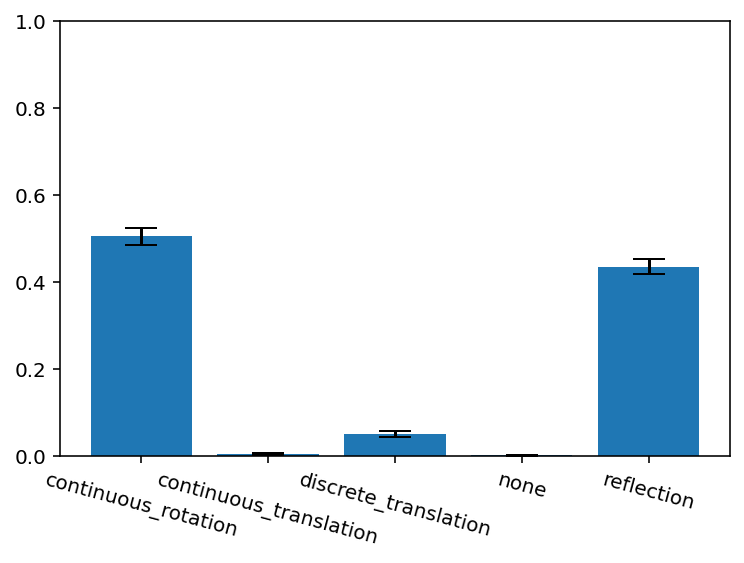

In [59]:
target = 'diff_sigma'    # Nombre de la variable que queremos predecir
nombre_carpeta = target # Nombre de la subcarpeta donde vamos a guardar las PCAs, dentro de la carpeta grande. Así podemos analizar al mismo tiempo varias bases de datos

n_fea = 13              # Número de features finales que el algoritmo escoge para hacer parejas y analizar con ellas la simetría

lim_sym = 0.7          # Límite de probabilidad para decidir que el algoritmo ha encontrado o no una simetría

limit_pairs = False      # Al generar parejas, estas vienen acompañadas de un 'score'. Si esto es True, cogmos solo la mitad de las con mayor 'score'

select_10k = True       # Keep only 10000 elements of the original potential DF (useful)

interact = False        # 'big', 'small', 'FW', False

rep_todo = 1500

num_bines = 60

# ----------------------------------- #

quantiles = True
range_cols = True   # Si quantiles == True, las columnas distintas de la target las escala entre -1 y 1.
ignore_list = ['Pz1','Pz2', 'E2', 's', 'cos_theta','inds','diff_sigma_fit']

categ = []
numer = []

# --------------------------------------#


# Read madgraph events

folder_0 = 'cross_section'
name = 'ze+e-_gve_' + str(1) + '_gae_' + str(0) + '.csv'

df_e = pd.read_csv(os.path.join(folder_0,name))
df_e = df_e.drop('diff_sigma', axis = 1)

# Histogram of cos_theta
hist, bin_edges = np.histogram(df_e.cos_theta,bins = num_bines, density = False)

# Which bin does each event belong to
inds = np.digitize(df_e.cos_theta,bin_edges[:-1])
df_e['inds'] = inds-1

# Assignment of differential cross section
df_e['diff_sigma'] = np.zeros(len(df_e))

for i in range(len(hist)):
    df_e['diff_sigma'].iloc[np.where(df_e['inds'] == i)] = hist[i]

    
#plt.figure()
#plt.hist(df_e.cos_theta,bins = num_bines)
#plt.show()
    
    
# Fitting to a 2nd degree polynomial
p = np.polyfit(df_e.cos_theta, df_e.diff_sigma/max(df_e.diff_sigma),2)
diff_sigma_fit = np.polyval(p,df_e.cos_theta)
df_e['diff_sigma_fit'] = diff_sigma_fit



for col in list(df_e.columns):
    if (col != target) and (col not in ignore_list):
        if type(df_e[col][0]) == str:
            categ.append(col)
        else:
            numer.append(col)

splits = RandomSplitter(valid_pct=0)(range_of(df_e))

to = TabularPandas(df_e,
                procs=[Categorify,FillMissing],
                cat_names = categ,
                cont_names = numer,
                y_names = target,
                splits=splits)


#equiv_CNACE = pd.DataFrame({'Cod_Num':list(to.xs['CNACE'].unique()),'Categ':list(dls.dsets['CNACE'].unique())}).sort_values(by = 'Categ')
#equiv_CNO1 = pd.DataFrame({'Cod_Num':list(to.xs['CNO1'].unique()),'Categ':list(dls.dsets['CNO1'].unique())}).sort_values(by = 'Categ')

df_e = pd.DataFrame(to.xs)
df_e[target] = to.y
df_e = df_e.reset_index().drop('index', axis = 1)  

for col in df_e.columns:
    df_e[col] = np.nan_to_num(df_e[col])   
    if quantiles == True:
        n_attempted_bins =  len(df_e[col])
        binning = pd.qcut(df_e[col], q=n_attempted_bins, retbins=True, labels=False, duplicates='drop')
        df_e[col]=binning[0]/np.max(binning[0])
        df_e[col] = np.nan_to_num(df_e[col])
        if (range_cols == True) and (col != target): 
            df_e[col] = df_e[col]*2 - 1




# ------------------------------------------------------------------------------------------------------------------------#

i=0    
    
sym_feat_1 = []
sym_feat_2 = []
sym_feat_tags = []
sym_feat_probs = []
sym_feat_rmse = []
syms_tot = ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
registro = pd.DataFrame(columns = syms_tot)
# Tiempo en el que empezamos a procesar
from time import time
start_time = time()


from fastai.vision.all import *
from time import time
from IPython.utils import io



muchos = False # Si es false, para muchos potenciales, mete cada combinación de variables en una carpeta separada, para que sea fácil ver si hay simetría ahí
               # Si es true, van todos a la misma carpeta


# ------------------- Folder PCA ------------------- #

folder = 'Ze+e-_real'   # Carpeta donde se guardan las subcarpetas con las PCAs

dd = top_dir + '/' + folder
if not os.path.isdir(dd):
    print('Creating directory:\n',dd)
    os.mkdir(dd)

dir = os.path.join(top_dir,folder)


#------------------------------ Generar Potenciales ---------------------------#

potenciales = [df_e]
potenciales_tags = [nombre_carpeta for k in range(rep_todo)]
tags = potenciales_tags
num_pot = len(potenciales)

# ------------------- No prints al guardar mejor modelo (fastai) ------------------- # 
# Solo hay un print que se ha eliminado del código original
class SaveModelCallback(TrackerCallback):
    "A `TrackerCallback` that saves the model's best during training and loads it at the end."
    _only_train_loop = True
    def __init__(self, monitor='valid_loss', comp=None, min_delta=0., fname='model', every_epoch=False, at_end=False,
                 with_opt=False, reset_on_fit=True):
        super().__init__(monitor=monitor, comp=comp, min_delta=min_delta, reset_on_fit=reset_on_fit)
        assert not (every_epoch and at_end), "every_epoch and at_end cannot both be set to True"
        # keep track of file path for loggers
        self.last_saved_path = None
        store_attr('fname,every_epoch,at_end,with_opt')

    def _save(self, name): self.last_saved_path = self.learn.save(name, with_opt=self.with_opt)

    def after_epoch(self):
        "Compare the value monitored to its best score and save if best."
        if self.every_epoch: self._save(f'{self.fname}_{self.epoch}')
        else: #every improvement
            super().after_epoch()
            if self.new_best:
                #print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
                self._save(f'{self.fname}')

    def after_fit(self, **kwargs):
        "Load the best model."
        if self.at_end: self._save(f'{self.fname}')
        elif not self.every_epoch: self.learn.load(f'{self.fname}', with_opt=self.with_opt)

# ---------------- Definiciones previas e hiperparámetros ----------------- #

#Guardo los modelos para analizarlos luego
models = [] 
to_s = []

#Guardaremos los resultados de la PCA en un array 
PCA_s = []
PCA_s_tag = []

# Hyperparameters: 
bs_choices = [50000]       # Batch Size
shape='pipe'               # Shape of the neural network
layers_choices = [5]       # Number of layers of the net. Default:10 or 5 results with 5
neurons_choices = [200]    # Number of neurons per layer. Default:200 results with 200
epoch_choices = [50]      # Number of training epochs. Default:200 results with 100
lr_choices = [0.01]       # Max learning rate 
valid_pct=0.2              # Part of the data that goes into validation (0.2 = 20%)
monitor= 'valid_loss'        # Te model with the least 'monitor' will be saved



# ---------------------- Entrenar Red Y PCA -----------------------------------#

j = 1 # Usaremos esto para saber cuantos potenciales hemos procesado, y como indice en general

for rtd in range(rep_todo):
    for df in potenciales:

        df[target] = df[target]/np.max(df[target]) #Normalizar la columna objetivo es importante

        #------------------------------ Feature Importance  ---------------------------#

        if select_10k == True:
            if len(df[target]) <= 100*100:
                print('Too little data to keep 10k points and delete the rest')
            else:
                print('Keeping 10k points of the original DF')
                remove_n = len(df[target]) - 10000
                drop_indices = np.random.choice(df.index, remove_n, replace=False)
                df_temp = df.drop(drop_indices)
                df = df_temp.copy()



        if interact == 'big':
            print('---- Big interactions ----')
            bbb = df[target]
            df = df.drop(target,axis = 1)
            df = my_interactions(df, numo_int = 10, verbose = True)
            df[target] = bbb

        elif interact == 'small':
            print('---- Small interactions ----')
            bbb = df[target]
            df = df.drop(target,axis = 1)
            df = my_interactions_small(df, numo_int = 10, verbose = True)
            df[target] = bbb

        elif interact == 'FW':
            print('---- Interactions by featurewiz ----')
            with io.capture_output() as captured2: output = featurewiz(df, target, corr_limit=0.10,
                                                            verbose=0, sep=',', header=0, test_data='',
                                                            category_encoders='',feature_engg='interactions')   
            df = output[1].copy()

        elif interact == False:
            print('No interactions')


        #df = regularize_df(df)

        print('---Selecting Best Features---')
        best_pairs = n_best_rf_phi_k(df, target = target, n = n_fea, nf = 30, lim_corr = 0.85)

        best_n = [best_pairs['f1'][0]] + list(best_pairs['f2'].unique())

        print('Best Features: ',best_n)

        #small_df = df[best_n]
        #small_df[target] = df[target]


        cols = best_n
        a = cols

        verbose = 1



        df_org = df.copy()

        if limit_pairs == True:
            medi = best_pairs.score.median()
            num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
        else:
            medi = 0
            num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])

        for f1,f2,lll in zip(best_pairs.f1,best_pairs.f2,range(len(best_pairs.f1))):
            if best_pairs.score[lll] >= medi:

                i+=1

                print(f1,f2)
                feas = [f1,f2]

                # Debemos marcar cada potencial para tener claro a qué tipo de simetria corresponde cada PCA
                PCA_s_tag.append(tags[j-1])

                df2 = df[feas + [target]].copy() 
                #df2 = df2[feas + [target]].copy()

                #Normlizamos las features y hacemos que vayan entre -1 y 1
                df2[f1] = 2*(df2[f1]/np.max(df2[f1]))-1
                df2[f2] = 2*(df2[f2]/np.max(df2[f2]))-1

                splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

                to = TabularPandas(df2,
                                procs=[Categorify,FillMissing, Normalize],
                                cont_names = feas,
                                y_names = target,
                                splits=splits)

                train_size = len(splits[0])
                valid_size = len(splits[1])

                # ----------------- Hyperparameters ------------------- #

                # Batch Size (a large one)
                bs=min(random.choice(bs_choices),train_size)  
                print('{} batch size for training.\n'.format(bs))

                # Neurons per layer
                neurons_per_layer = random.choice(neurons_choices)

                # Number of layers
                n_layers = random.choice(layers_choices)

                #Shape of the net: Pipe or funnel
                if shape == 'pipe':
                    layers=[neurons_per_layer for i in range(n_layers)]

                if shape == 'funnel':
                    n_eff = n_layers
                    layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

                print('Training FCNN with layers: ',layers)

                #Number of epochs
                n_epoch=random.choice(epoch_choices)
                print('Training for {} epochs.'.format(n_epoch))

                # Maximum Learning Rate: (a good value can be found using learn.lr_find())
                lr_max=float(random.choice(lr_choices))
                print('Using lr_max = ',format(lr_max))

                # ----------------------------------------------------- #

                # --------------- Training the FCNN --------------------#

                # Load the data into a DataLoader
                dls = to.dataloaders(bs=bs)

                # Define a Tabular Learner
                learn = tabular_learner(dls, layers=layers
                                    #,config=config
                                    #,metrics=[mse],
                                    #y_range = [min(df.bin),max(df.bin)],
                                    #,cbs=ShowGraphCallback()
                                    #,train_bn=False)
                                    )

                # Train the net 
                with learn.no_logging():
                    learn.fit_one_cycle(n_epoch=n_epoch
                                        ,lr_max=lr_max
                                        ,cbs=[SaveModelCallback(monitor=monitor)]
                                        )

                    preds, targs = learn.get_preds()

                ff = (preds-targs)**2/len(targs)
                ff = sum(ff)
                RMSE = np.sqrt(ff)
                #print('RMSE:',float(RMSE))
                nrmsei = float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))

                # Guardamos modelos y tabular objects para el posterior analisis
                models.append(learn)
                to_s.append(to)

                # ------------------------------------------------------#


                # ------------------------- PCA ------------------------#

                test_df = df2.copy()
                dl = learn.dls.test_dl(test_df,bs=int(test_df.shape[0])) 

                # Tenemos que hacer un Hook, una especie de gancho que enganchamos en la última capa interna,
                # para guardar, de cada modelo, los valores de los parámetro de dicha capa. 
                with Hooks(learn.model.layers, lambda m,i,o: o) as h:
                    preds = learn.get_preds(dl=dl,with_input=True,with_decoded=True,with_loss=True)

                targets=preds[2].numpy().flatten()

                # Cogemos la información de la penúltima capa
                # OJO: Si añadimos y_range, se añade automaticamente una sigmoid
                # al final, por lo que tendríamos que coger la capa -3 en vez de la -2
                act = h.stored[-2] 
                multi_dim=Tensor.cpu(act).numpy()
                standardized=StandardScaler().fit_transform(multi_dim)

                viz = PCA(2).fit_transform(np.nan_to_num(standardized))
                #plt.figure()
                #plt.scatter(viz[:, 0], viz[:, 1],c=targets[:multi_dim.shape[0]],alpha=.1, marker = 'o')

                PCA_s.append(viz)

                # ------------------------------------------------------ #

                # ------------------ Saving the PCA's ------------------ #

                # ---- Dar formato a PCA para guardar como imagen con color

                viz = pd.DataFrame(viz) #Transformamos la PCA en un dataframe
                viz.columns = ['x','y'] #Nombres de las columnas

                # Insertamos una columna con los colores de los puntos. El valor del potencial
                # objetivo (targets) es el color, y hay un color por cada punto 
                viz.insert(2,'class',targets[:multi_dim.shape[0]]) 

                # ---- Personalizar mapa de color 

                n_classes=1000

                colors = 'rainbow'

                if colors == 'rainbow':
                    my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                    classes_in_rgb = my_cmap(range(n_classes))
                if colors == 'purple':
                    my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                    classes_in_rgb = np.vstack((np.array([0,0,0,0]),my_cmap([0 for i in range(n_classes)])))

                # ---- Hacer que la intensidad del pixel represente la cantidad de puntos 
                #      acumuldos en un pixel

                n_pixels = 224

                binning_3d=np.histogramdd([viz['x'],viz['y'],viz['class']],range=(None,None,(0,1)), bins=(n_pixels,n_pixels,n_classes))

                #if we want the pixel intensity to reprensent the number of points at that location
                array = np.dot(binning_3d[0],classes_in_rgb)
                array = array/np.amax(array)

                # ---- Guardar la PCA

                #Directorio donde guardaremos las imagenes
                nami = '_'+str(feas[0])+'+'+str(feas[1])+'_'
                if muchos == False: 
                    dir_sym = os.path.join(dir,tags[j-1],nami)
                    img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+'__PCA.png' 
                else:
                    dir_sym = os.path.join(dir,tags[j-1])
                    img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+nami+'__PCA.png' 

                if not os.path.isdir(dir_sym):
                    print('Creating directory:\n',dir_sym)
                    os.makedirs(dir_sym)


                # Nombre de la imagen. Pongo el tiempo para que todas se llamen distinto cada vez.
                output_dir = os.path.join(dir_sym,img_file) # Directorio donde guardamos la imagen
                plt.imsave(output_dir,array) # Guardar
                print('\nPCA saved to:\n{}\n'.format(dir_sym+'/'+img_file))


                # ------------------------ Symmetry Analyzer --------------------- #
                drr = pca_sym_finder(output_dir)
                brr = list(drr.iloc[np.where(drr.value > lim_sym)].symmetry)
                if len(brr) > 0:
                    print('Found {} symmetry with features {} and {}, with prob. {}'.format(brr[0],f1,f2,float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4))))                
                    sym_feat_1.append(f1)
                    sym_feat_2.append(f2)
                    sym_feat_tags.append(brr[0])
                    sym_feat_probs.append(float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4)))
                    sym_feat_rmse.append(nrmsei)




                # ------------------------ Time -------------------------#

                minutes_until_now = (time() - start_time)/60
                images_done = i
                minutes_per_image = minutes_until_now/(images_done)
                hours_left = minutes_per_image * (num_pot*rep_todo*num_2-images_done)/60
                print("\n{} PCA's made out of {}.\n".format(images_done,num_pot*num_2*rep_todo))
                print("{:.1f} minutes elapsed for {} images.".format(minutes_until_now,images_done))
                print("{:.1f} minutes average per image.".format(minutes_until_now/images_done))
                print("{:.1f} minutes estimated left for {} images.\n\n\n".format(hours_left*60,num_pot*num_2*rep_todo-images_done))
                print("{:.1f} hours estimated left for {} images.\n\n\n".format(hours_left,num_pot*num_2*rep_todo-images_done))




    j+=1


          # ------------------------------------------------------#'''

results = pd.DataFrame({'symmetry':sym_feat_tags, 'feature_1':sym_feat_1, 'feature_2':sym_feat_2, 'probability':sym_feat_probs, 'NRMSE':sym_feat_rmse})

vc = results.symmetry.value_counts()



for sym_sum in syms_tot:
    if not hasattr(vc,sym_sum):
        vc[sym_sum] = 0


nr = pd.DataFrame({'continuous_rotation':vc['continuous_rotation'], 
                   'continuous_translation':vc['continuous_translation'], 
                   'discrete_translation':vc['discrete_translation'], 
                   'none':vc['none'], 
                   'reflection':vc['reflection']}, index = [0])

registro = registro.append(nr, ignore_index=True)


plt.xticks(rotation = -15)
plt.ylim([0,1])
print(registro.columns)
print(registro.sum()/registro.sum().sum())
plt.bar(registro.columns,registro.sum()/registro.sum().sum(), yerr = np.sqrt(registro.sum())/registro.sum().sum(), capsize = 8)



Notebook directory: /home/gabriel/Desktop
Numero Imagenes: 181
Numero Imagenes: 346
Numero Imagenes: 531
Numero Imagenes: 683
Numero Imagenes: 891
Numero Imagenes: 1098
Numero Imagenes: 1283
Numero Imagenes: 1500
['_Px1+Py1_' '_Px1+Py2_' '_Px2+Py1_' '_Px2+Py2_' '_Py1+Px1_' '_Py1+Px2_'
 '_Py2+Px1_' '_Py2+Px2_']
['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
[0.49988674 0.00369038 0.07151448 0.00574071 0.41916769]


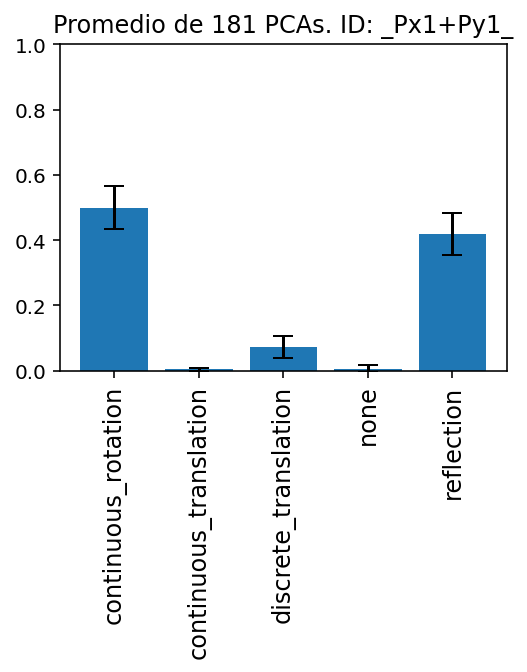

[4.57367622e-01 3.21885196e-03 5.07356699e-02 2.38690268e-04
 4.88439170e-01]


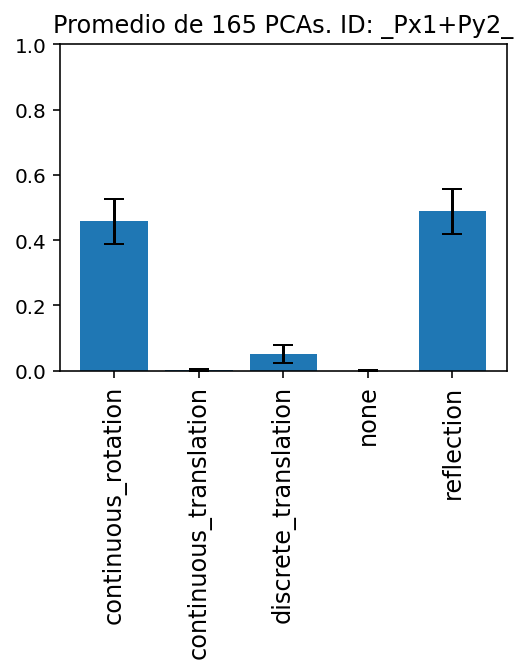

[0.56116979 0.0057459  0.0601977  0.00558601 0.36730061]


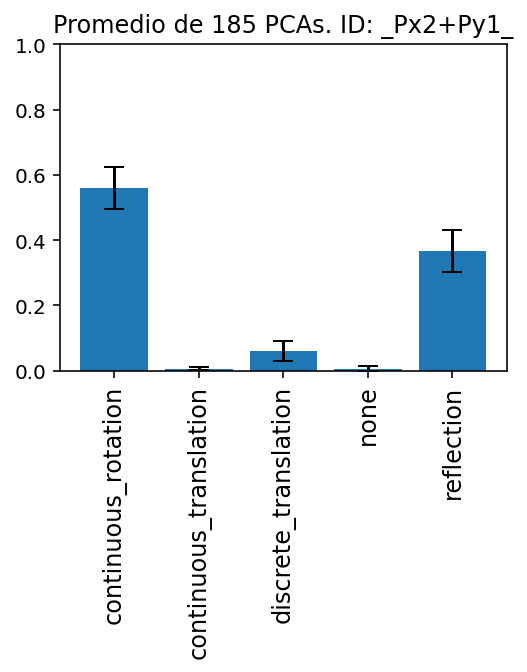

[0.44994753 0.00505615 0.0799033  0.00432391 0.46076911]


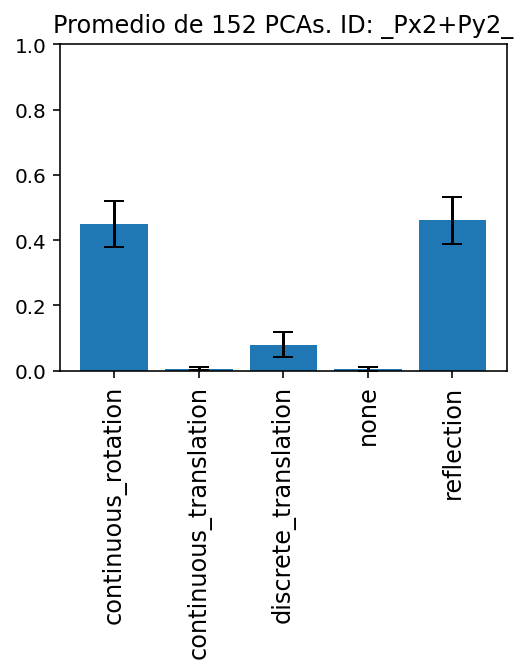

[0.46807968 0.01321191 0.08612109 0.00181017 0.43077716]


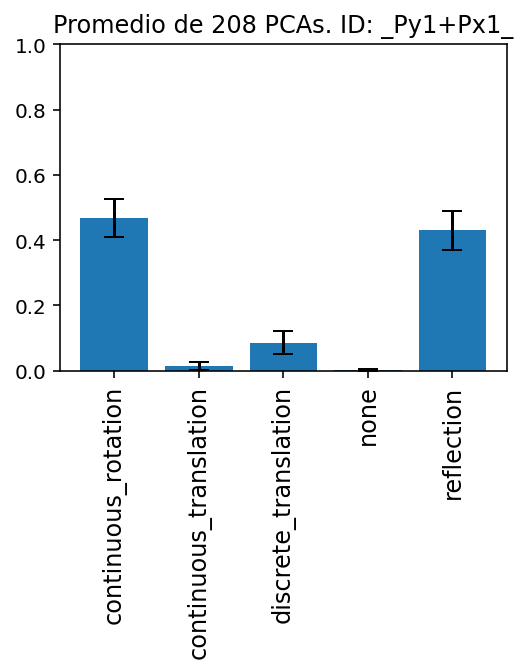

[0.50547203 0.00747314 0.0752578  0.00075986 0.41103718]


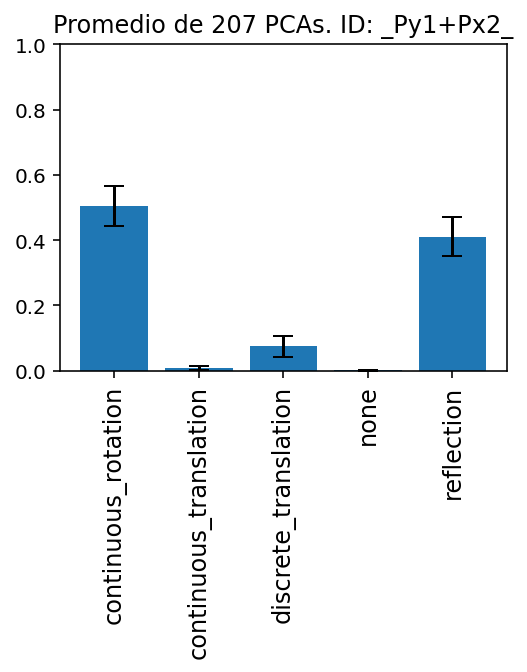

[0.51453812 0.00647535 0.04524271 0.00178165 0.43196217]


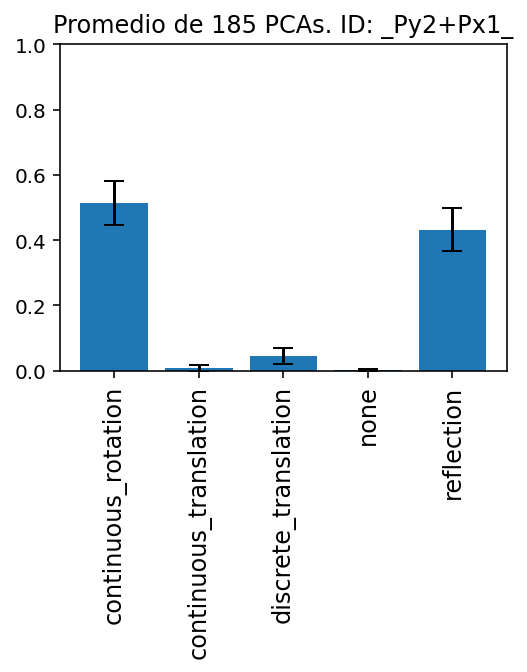

[0.51861647 0.02645455 0.03500599 0.00744659 0.4124764 ]


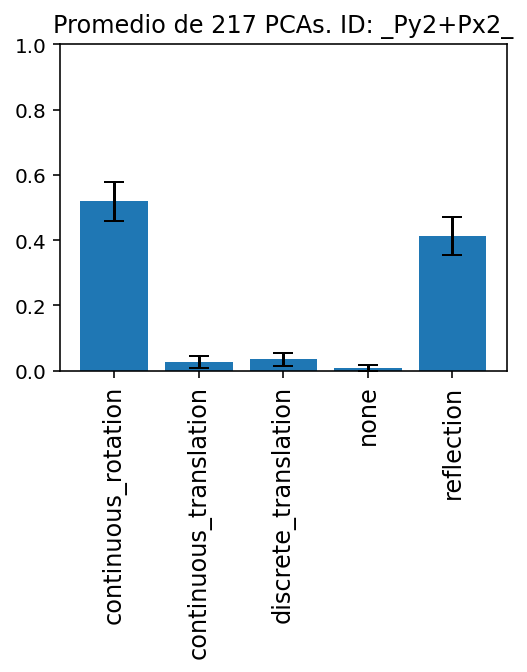

In [6]:
nom_carp = 'diff_sigma'

#import libraries
%config InlineBackend.figure_format = 'retina'
import seaborn as sns
from IPython.core.display import display, HTML, clear_output
display(HTML("<style>.container { width:100% !important; } div.cell.selected {border-left-width: 0px !important;}</style>"))

from time import time
import os
import glob
from fastai.vision.all import *
import numpy as np
from IPython.display import clear_output
import itertools as it
import more_itertools
#import torchvision.models
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.io as pio
pio.templates.default ="none"
import base64
from PIL import Image
from io import BytesIO
import torch
import gc
#import libraries

if not 'notebook_dir' in globals():
    notebook_dir = os.getcwd()
print('Notebook directory: ' + notebook_dir)
os.chdir(notebook_dir)  # If you changed the current working dir, this will take you back to the workbook dir.
top_dir = notebook_dir



modelo = 'G' # J or G

if modelo == 'G':
    #learn = load_learner('/home/gabriel/Desktop/models/model_93_accu_resnet18_10+5_none+reflection'+'.pkl', cpu=False)
    learn = load_learner('/home/gabriel/Desktop/models/model_90_accu_resnet18_one_cycle_10+5_no_mixup'+'.pkl', cpu=False)

if modelo == 'J':
    print('J')
        

#Reset Registro

columns = ['ID', 'Run'] + list(learn.dls.vocab)

registro = pd.DataFrame(columns = columns)
#registro


num_img_cat = [] #guardo el numero de imagenes de cada categoria
i = 0
plote = False

sims = pd.DataFrame(columns = learn.dls.vocab)
errs = sims.copy()

num_img_cat = [] #guardo el numero de imagenes de cada categoria
i = 0
plote = False

from IPython.utils import io


for dires in np.sort(Path('/home/gabriel/Desktop/Ze+e-_real/' + nom_carp).ls()):
    #path = Path('/home/gabriel/Desktop/PCA_INE_sexo/INE/'+quitadas)
    quitadas = str(dires).split('/')[-1]
    with io.capture_output() as captured:
        for ima in dires.ls():

            test_im_dir = ima

            im = PILImage.create(test_im_dir)

            # Orden: ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']

            cate, num_cat, probs = learn.predict(im)


            '''
            if plote == True:
                plt.figure
                plt.figure(figsize=(4, 3))
                plt.title(ima)
                plt.bar(['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection'],probs)
                plt.xticks(rotation='vertical',fontsize = 12)
                plt.show()
            '''

            new_row = np.array([quitadas, i] + list(np.array(probs).astype(float))).reshape([1,-1])
            aden = pd.DataFrame(new_row,columns=registro.columns)

            registro = registro.append(aden, ignore_index=True)

            i+=1

    registro = registro.astype({'ID':str, 'Run':int,'continuous_rotation':float, 'continuous_translation':float, 'discrete_translation':float, 'none':float, 'reflection':float })  

    print('Numero Imagenes:',i,)
    num_img_cat.append(i)


print(registro['ID'].unique())

#registro = pd.read_csv('/home/gabriel/Desktop/PCA_INE_sexo/registro.csv')

nombres_carps = registro['ID'].unique() #Nombres de las carpetas donde estan guyardadas las pcas de un tipo
num_carps = len(nombres_carps)

#registro = pd.read_csv('/home/gabriel/Desktop/PCA_INE_sexo/registro.csv')


i = 0


for nom in np.sort(nombres_carps):
    if i == 0:
        m_probs = np.array(registro.iloc[:num_img_cat[0],2:].mean())
        err_probs = np.array(registro.iloc[:num_img_cat[0],2:].std())
        nume = str(len(registro.iloc[:num_img_cat[0],2:]))
        print(learn.dls.vocab)
        print(m_probs)
        sims = sims.append(pd.DataFrame([m_probs], columns = sims.columns),ignore_index = True)
        errs = errs.append(pd.DataFrame([err_probs/np.sqrt(float(nume))], columns = errs.columns),ignore_index = True)
    else:
        m_probs = np.array(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:].mean())
        err_probs = np.array(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:].std())
        nume = str(len(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:]))
        print(m_probs)
        sims = sims.append(pd.DataFrame([m_probs], columns = sims.columns),ignore_index = True)
        errs = errs.append(pd.DataFrame([err_probs/np.sqrt(float(nume))], columns = errs.columns),ignore_index = True)

    if nom == '-ninguna-':
        tit = 'Promedio de '+nume+' PCAs sin quitar ninguna columna'
    else:
        tit = 'Promedio de '+nume+' PCAs. ID: '+ nom        

    
    plt.figure(figsize=(4, 3))
    plt.title(tit)
    #plt.title('Promedio de '+str(40)+' PCAs sin quitar ninguna columna')
    plt.bar(columns[2:],
            m_probs,yerr = 2*err_probs/np.sqrt(float(nume)), capsize = 5)
    plt.xticks(rotation='vertical',fontsize = 12)
    plt.ylim([0, 1])
    plt.show()

    
    i+=1

In [63]:
registro

,ID,Run,continuous_rotation,continuous_translation,discrete_translation,none,reflection
0,_Px1+Py1_,0,0.999812,1.053152e-04,1.764515e-06,4.240680e-05,0.000038
1,_Px1+Py1_,1,0.000002,1.908007e-07,1.263712e-05,3.427628e-08,0.999985
2,_Px1+Py1_,2,0.932823,1.676677e-03,2.135642e-06,3.435017e-05,0.065464
3,_Px1+Py1_,3,0.002815,1.674577e-04,9.969990e-01,3.685473e-06,0.000015
4,_Px1+Py1_,4,0.971609,2.160205e-03,2.087397e-05,3.529221e-03,0.022681
...,...,...,...,...,...,...,...
1495,_Py2+Px2_,1495,0.000076,8.940079e-08,6.851485e-08,1.903414e-10,0.999924
1496,_Py2+Px2_,1496,0.638584,3.569339e-01,5.778812e-04,1.864155e-05,0.003885
1497,_Py2+Px2_,1497,0.000013,5.132462e-08,1.834962e-07,6.724921e-09,0.999987
1498,_Py2+Px2_,1498,0.051985,6.199911e-05,3.796723e-05,3.710842e-07,0.947914


In [ ]:
#registro.to_csv('registro_1500_timesy_real.csv')

In [62]:
sims.mean()

continuous_rotation       0.496885
continuous_translation    0.008916
discrete_translation      0.062997
none                      0.003461
reflection                0.427741
dtype: float64

In [8]:
errs.mean()/np.sqrt(8)

continuous_rotation       0.011376
continuous_translation    0.001368
discrete_translation      0.005397
none                      0.000896
reflection                0.011434
dtype: float64

## Tests 

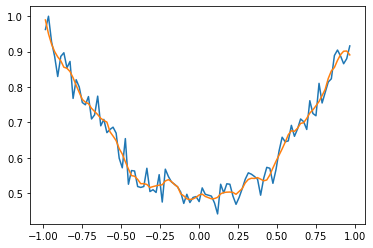

In [113]:
def smooth(y, box_pts):
    box = np.ones(box_pts)/box_pts
    y_smooth = np.convolve(y, box, mode='same')
    return y_smooth

from scipy.signal import savgol_filter

hist, bin_edges = np.histogram(df_e.cos_theta,bins = 100, density = False)

plt.plot(bin_edges[:-1],hist/max(hist))
plt.plot(bin_edges[:-1],savgol_filter(hist/max(hist),11,3))

In [3]:
gve = 1
gae = 0

folder_0 = 'cross_section'
name = 'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) + '.csv'

df_e = pd.read_csv(os.path.join(folder_0,name))



<AxesSubplot:>

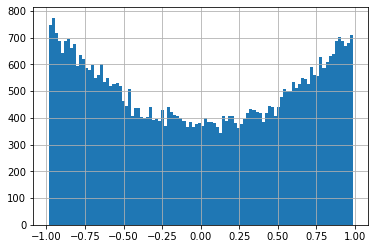

In [99]:
(df_e.cos_theta).hist(bins = 100)

In [24]:
(df_e.cos_theta).max()

0.9865710715799999

In [40]:
hist, bin_edges = np.histogram(df_e.cos_theta,bins = 25,density = False)

In [41]:
bin_edges

array([-0.98658226, -0.90765612, -0.82872999, -0.74980386, -0.67087772,
       -0.59195159, -0.51302546, -0.43409932, -0.35517319, -0.27624706,
       -0.19732093, -0.11839479, -0.03946866,  0.03945747,  0.11838361,
        0.19730974,  0.27623587,  0.35516201,  0.43408814,  0.51301427,
        0.59194041,  0.67086654,  0.74979267,  0.82871881,  0.90764494,
        0.98657107])

In [33]:
inds = np.digitize(df_e.cos_theta,bin_edges[:-1])
df_e['inds'] = inds-1

<BarContainer object of 50 artists>

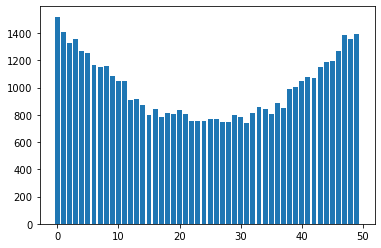

In [34]:
plt.bar(df_e.inds.value_counts().index,df_e.inds.value_counts())

<ErrorbarContainer object of 3 artists>

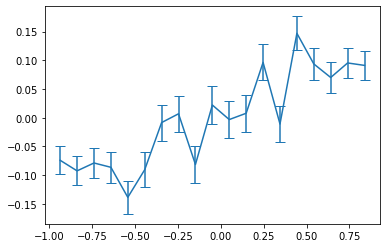

In [70]:
hist, bin_edges = np.histogram(df_e.cos_theta,bins = 20, density = False)

hist_m = []
coss = []
errs = []

err_0 = np.sqrt(hist)

for t in range(len(hist)-1):
    hist_m.append((hist[t+1]+hist[t])/2)
    coss.append((bin_edges[t] + bin_edges[t+1])/2)
    errs.append(np.sqrt(err_0[t]**2 + err_0[t+1]**2))
    
hist_m = np.array(hist_m)

dnn = np.diff(hist)/hist_m
errs = np.array(errs)/hist_m



plt.errorbar(coss,dnn,errs, capsize = 5)

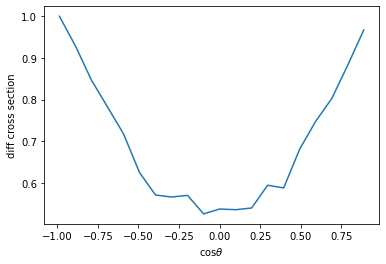

In [79]:
plt.figure()
plt.xlabel(r'cos$\theta$ ')
plt.ylabel('diff cross section')
plt.plot(bin_edges[:-1],hist/max(hist))

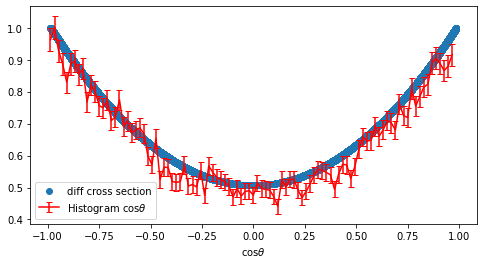

In [95]:
hist, bin_edges = np.histogram(df_e.cos_theta,bins = 100, density = False)
plt.figure(figsize = [8,4])
plt.xlabel(r'cos$\theta$')
#plt.ylabel()
plt.scatter(df_e.cos_theta, df_e.diff_sigma/max(df_e.diff_sigma), label = 'diff cross section')
plt.errorbar(bin_edges[:-1],hist/max(hist), color = 'red', label = r'Histogram cos$\theta$', yerr = np.sqrt(hist)/max(hist), capsize = 3)
plt.legend()

# Uniform distribution of cos(theta)

In [47]:
# ----------------------------------- #
folder_0 = 'cross_section_uniform_cos_theta'   #Folder with the event data


target = 'diff_sigma'  # Nombre de la variable que queremos predecir
quantiles = True
range_cols = True   # Si quantiles == True, las columnas distintas de la target las escala entre -1 y 1.
ignore_list = ['Pz1','Pz2', 'E2', 's', 'cos_theta']

nombre_carpeta = 'Ze+e-_couplings_ratio_uniform_cos_theta' # Nombre de la subcarpeta donde vamos a guardar las PCAs, dentro de la carpeta grande. Así podemos analizar al mismo tiempo varias bases de datos

n_fea = 13              # Número de features finales que el algoritmo escoge para hacer parejas y analizar con ellas la simetría

lim_sym = 0.7          # Límite de probabilidad para decidir que el algoritmo ha encontrado o no una simetría

limit_pairs = False      # Al generar parejas, estas vienen acompañadas de un 'score'. Si esto es True, cogmos solo la mitad de las con mayor 'score'

select_10k = True       # Keep only 10000 elements of the original potential DF (useful)

interact = False        # 'big', 'small', 'FW', False

rep_todo = 10


#gve_l = [1,0.9,0.85,0.8,0.7,0.5,0.3,0.2,0.15,0.1,0]
#gae_l = [0,0.1,0.15,0.2,0.3,0.5,0.7,0.8,0.85,0.9,1]

rs = [0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]
ind_ord = [l for l in range(len(rs))]
gae_l = [1 for r in rs]
gve_l = [np.round(r,4) for r in rs]
    

# --------------------------------------#

i=0 
from time import time
start_time = time()

syms_tot = ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
registro = pd.DataFrame(columns = syms_tot)
registros = []

num_g = len(gve_l)

for  gve,gae,indo in zip(gve_l,gae_l,ind_ord):
    
    print('**** gv_e = {} **** ga_e = {} ****'.format(gve,gae))

    name = 'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) + '.csv'


    df_e = pd.read_csv(os.path.join(folder_0,name))

    categ = []
    numer = []


    for col in list(df_e.columns):
        if (col != target) and (col not in ignore_list):
            if type(df_e[col][0]) == str:
                categ.append(col)
            else:
                numer.append(col)

    splits = RandomSplitter(valid_pct=0)(range_of(df_e))

    to = TabularPandas(df_e,
                    procs=[Categorify,FillMissing],
                    cat_names = categ,
                    cont_names = numer,
                    y_names = target,
                    splits=splits)


    #equiv_CNACE = pd.DataFrame({'Cod_Num':list(to.xs['CNACE'].unique()),'Categ':list(dls.dsets['CNACE'].unique())}).sort_values(by = 'Categ')
    #equiv_CNO1 = pd.DataFrame({'Cod_Num':list(to.xs['CNO1'].unique()),'Categ':list(dls.dsets['CNO1'].unique())}).sort_values(by = 'Categ')

    df_e = pd.DataFrame(to.xs)
    df_e[target] = to.y
    df_e = df_e.reset_index().drop('index', axis = 1)  

    for col in df_e.columns:
        df_e[col] = np.nan_to_num(df_e[col])   
        if quantiles == True:
            n_attempted_bins =  len(df_e[col])
            binning = pd.qcut(df_e[col], q=n_attempted_bins, retbins=True, labels=False, duplicates='drop')
            df_e[col]=binning[0]/np.max(binning[0])
            df_e[col] = np.nan_to_num(df_e[col])
            if (range_cols == True) and (col != target): 
                df_e[col] = df_e[col]*2 - 1





    # ------------------------------------------------------------------------------------------------------------------------#

   

    sym_feat_1 = []
    sym_feat_2 = []
    sym_feat_tags = []
    sym_feat_probs = []
    sym_feat_rmse = []

    # Tiempo en el que empezamos a procesar



    from fastai.vision.all import *
    from time import time
    from IPython.utils import io



    muchos = False # Si es false, para muchos potenciales, mete cada combinación de variables en una carpeta separada, para que sea fácil ver si hay simetría ahí
                   # Si es true, van todos a la misma carpeta


    # ------------------- Folder PCA ------------------- #

    folder = 'Ze+e-_2'   # Carpeta donde se guardan las subcarpetas con las PCAs

    dd = top_dir + '/' + folder
    if not os.path.isdir(dd):
        print('Creating directory:\n',dd)
        os.mkdir(dd)

    dir = os.path.join(top_dir,folder)

    #------------------------------ Generar Potenciales ---------------------------#

    potenciales = [df_e]
    potenciales_tags = [nombre_carpeta for k in range(rep_todo)]
    tags = potenciales_tags
    num_pot = len(potenciales)

    # ------------------- No prints al guardar mejor modelo (fastai) ------------------- # 
    # Solo hay un print que se ha eliminado del código original
    class SaveModelCallback(TrackerCallback):
        "A `TrackerCallback` that saves the model's best during training and loads it at the end."
        _only_train_loop = True
        def __init__(self, monitor='valid_loss', comp=None, min_delta=0., fname='model', every_epoch=False, at_end=False,
                     with_opt=False, reset_on_fit=True):
            super().__init__(monitor=monitor, comp=comp, min_delta=min_delta, reset_on_fit=reset_on_fit)
            assert not (every_epoch and at_end), "every_epoch and at_end cannot both be set to True"
            # keep track of file path for loggers
            self.last_saved_path = None
            store_attr('fname,every_epoch,at_end,with_opt')

        def _save(self, name): self.last_saved_path = self.learn.save(name, with_opt=self.with_opt)

        def after_epoch(self):
            "Compare the value monitored to its best score and save if best."
            if self.every_epoch: self._save(f'{self.fname}_{self.epoch}')
            else: #every improvement
                super().after_epoch()
                if self.new_best:
                    #print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
                    self._save(f'{self.fname}')

        def after_fit(self, **kwargs):
            "Load the best model."
            if self.at_end: self._save(f'{self.fname}')
            elif not self.every_epoch: self.learn.load(f'{self.fname}', with_opt=self.with_opt)

    # ---------------- Definiciones previas e hiperparámetros ----------------- #

    #Guardo los modelos para analizarlos luego
    models = [] 
    to_s = []

    #Guardaremos los resultados de la PCA en un array 
    PCA_s = []
    PCA_s_tag = []

    # Hyperparameters: 
    bs_choices = [50000]       # Batch Size
    shape='pipe'               # Shape of the neural network
    layers_choices = [5]       # Number of layers of the net. Default:10 or 5 results with 5
    neurons_choices = [200]    # Number of neurons per layer. Default:200 results with 200
    epoch_choices = [50]      # Number of training epochs. Default:200 results with 100
    lr_choices = [0.01]       # Max learning rate 
    valid_pct=0.2              # Part of the data that goes into validation (0.2 = 20%)
    monitor= 'valid_loss'        # Te model with the least 'monitor' will be saved



    # ---------------------- Entrenar Red Y PCA -----------------------------------#

    j = 1 # Usaremos esto para saber cuantos potenciales hemos procesado, y como indice en general

    for rtd in range(rep_todo):
        for df in potenciales:

            df[target] = df[target]/np.max(df[target]) #Normalizar la columna objetivo es importante

            #------------------------------ Feature Importance  ---------------------------#

            if select_10k == True:
                if len(df[target]) <= 100*100:
                    print('Too little data to keep 10k points and delete the rest')
                else:
                    print('Keeping 10k points of the original DF')
                    remove_n = len(df[target]) - 10000
                    drop_indices = np.random.choice(df.index, remove_n, replace=False)
                    df_temp = df.drop(drop_indices)
                    df = df_temp.copy()



            if interact == 'big':
                print('---- Big interactions ----')
                bbb = df[target]
                df = df.drop(target,axis = 1)
                df = my_interactions(df, numo_int = 10, verbose = True)
                df[target] = bbb

            elif interact == 'small':
                print('---- Small interactions ----')
                bbb = df[target]
                df = df.drop(target,axis = 1)
                df = my_interactions_small(df, numo_int = 10, verbose = True)
                df[target] = bbb

            elif interact == 'FW':
                print('---- Interactions by featurewiz ----')
                with io.capture_output() as captured2: output = featurewiz(df, target, corr_limit=0.10,
                                                                verbose=0, sep=',', header=0, test_data='',
                                                                category_encoders='',feature_engg='interactions')   
                df = output[1].copy()

            elif interact == False:
                print('No interactions')


            #df = regularize_df(df)

            print('---Selecting Best Features---')
            best_pairs = n_best_rf_phi_k(df, target = target, n = n_fea, nf = 30, lim_corr = 0.85)

            best_n = [best_pairs['f1'][0]] + list(best_pairs['f2'].unique())

            print('Best Features: ',best_n)

            #small_df = df[best_n]
            #small_df[target] = df[target]


            cols = best_n
            a = cols

            verbose = 1



            df_org = df.copy()

            if limit_pairs == True:
                medi = best_pairs.score.median()
                num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
            else:
                medi = 0
                num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])

            for f1,f2,lll in zip(best_pairs.f1,best_pairs.f2,range(len(best_pairs.f1))):
                if best_pairs.score[lll] >= medi:

                    i+=1

                    print(f1,f2)
                    feas = [f1,f2]

                    # Debemos marcar cada potencial para tener claro a qué tipo de simetria corresponde cada PCA
                    PCA_s_tag.append(tags[j-1])

                    df2 = df[feas + [target]].copy() 
                    #df2 = df2[feas + [target]].copy()

                    #Normlizamos las features y hacemos que vayan entre -1 y 1
                    df2[f1] = 2*(df2[f1]/np.max(df2[f1]))-1
                    df2[f2] = 2*(df2[f2]/np.max(df2[f2]))-1

                    splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

                    to = TabularPandas(df2,
                                    procs=[Categorify,FillMissing, Normalize],
                                    cont_names = feas,
                                    y_names = target,
                                    splits=splits)

                    train_size = len(splits[0])
                    valid_size = len(splits[1])

                    # ----------------- Hyperparameters ------------------- #

                    # Batch Size (a large one)
                    bs=min(random.choice(bs_choices),train_size)  
                    print('{} batch size for training.\n'.format(bs))

                    # Neurons per layer
                    neurons_per_layer = random.choice(neurons_choices)

                    # Number of layers
                    n_layers = random.choice(layers_choices)

                    #Shape of the net: Pipe or funnel
                    if shape == 'pipe':
                        layers=[neurons_per_layer for i in range(n_layers)]

                    if shape == 'funnel':
                        n_eff = n_layers
                        layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

                    print('Training FCNN with layers: ',layers)

                    #Number of epochs
                    n_epoch=random.choice(epoch_choices)
                    print('Training for {} epochs.'.format(n_epoch))

                    # Maximum Learning Rate: (a good value can be found using learn.lr_find())
                    lr_max=float(random.choice(lr_choices))
                    print('Using lr_max = ',format(lr_max))

                    # ----------------------------------------------------- #

                    # --------------- Training the FCNN --------------------#

                    # Load the data into a DataLoader
                    dls = to.dataloaders(bs=bs)

                    # Define a Tabular Learner
                    learn = tabular_learner(dls, layers=layers
                                        #,config=config
                                        #,metrics=[mse],
                                        #y_range = [min(df.bin),max(df.bin)],
                                        #,cbs=ShowGraphCallback()
                                        #,train_bn=False)
                                        )

                    # Train the net 
                    with learn.no_logging():
                        learn.fit_one_cycle(n_epoch=n_epoch
                                            ,lr_max=lr_max
                                            ,cbs=[SaveModelCallback(monitor=monitor)]
                                            )

                        preds, targs = learn.get_preds()

                    ff = (preds-targs)**2/len(targs)
                    ff = sum(ff)
                    RMSE = np.sqrt(ff)
                    #print('RMSE:',float(RMSE))
                    nrmsei = float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))

                    # Guardamos modelos y tabular objects para el posterior analisis
                    models.append(learn)
                    to_s.append(to)

                    # ------------------------------------------------------#


                    # ------------------------- PCA ------------------------#

                    test_df = df2.copy()
                    dl = learn.dls.test_dl(test_df,bs=int(test_df.shape[0])) 

                    # Tenemos que hacer un Hook, una especie de gancho que enganchamos en la última capa interna,
                    # para guardar, de cada modelo, los valores de los parámetro de dicha capa. 
                    with Hooks(learn.model.layers, lambda m,i,o: o) as h:
                        preds = learn.get_preds(dl=dl,with_input=True,with_decoded=True,with_loss=True)

                    targets=preds[2].numpy().flatten()

                    # Cogemos la información de la penúltima capa
                    # OJO: Si añadimos y_range, se añade automaticamente una sigmoid
                    # al final, por lo que tendríamos que coger la capa -3 en vez de la -2
                    act = h.stored[-2] 
                    multi_dim=Tensor.cpu(act).numpy()
                    standardized=StandardScaler().fit_transform(multi_dim)

                    viz = PCA(2).fit_transform(np.nan_to_num(standardized))
                    #plt.figure()
                    #plt.scatter(viz[:, 0], viz[:, 1],c=targets[:multi_dim.shape[0]],alpha=.1, marker = 'o')

                    PCA_s.append(viz)

                    # ------------------------------------------------------ #

                    # ------------------ Saving the PCA's ------------------ #

                    # ---- Dar formato a PCA para guardar como imagen con color

                    viz = pd.DataFrame(viz) #Transformamos la PCA en un dataframe
                    viz.columns = ['x','y'] #Nombres de las columnas

                    # Insertamos una columna con los colores de los puntos. El valor del potencial
                    # objetivo (targets) es el color, y hay un color por cada punto 
                    viz.insert(2,'class',targets[:multi_dim.shape[0]]) 

                    # ---- Personalizar mapa de color 

                    n_classes=1000

                    colors = 'rainbow'

                    if colors == 'rainbow':
                        my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                        classes_in_rgb = my_cmap(range(n_classes))
                    if colors == 'purple':
                        my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                        classes_in_rgb = np.vstack((np.array([0,0,0,0]),my_cmap([0 for i in range(n_classes)])))

                    # ---- Hacer que la intensidad del pixel represente la cantidad de puntos 
                    #      acumuldos en un pixel

                    n_pixels = 224

                    binning_3d=np.histogramdd([viz['x'],viz['y'],viz['class']],range=(None,None,(0,1)), bins=(n_pixels,n_pixels,n_classes))

                    #if we want the pixel intensity to reprensent the number of points at that location
                    array = np.dot(binning_3d[0],classes_in_rgb)
                    array = array/np.amax(array)

                    # ---- Guardar la PCA

                    #Directorio donde guardaremos las imagenes
                    nami = str(chr(97 + indo))+'_'+'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) +'_'
                    if muchos == False: 
                        dir_sym = os.path.join(dir,tags[j-1],nami)
                        img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+'__PCA.png' 
                    else:
                        dir_sym = os.path.join(dir,tags[j-1])
                        img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+nami+'__PCA.png' 

                    if not os.path.isdir(dir_sym):
                        print('Creating directory:\n',dir_sym)
                        os.makedirs(dir_sym)


                    # Nombre de la imagen. Pongo el tiempo para que todas se llamen distinto cada vez.
                    output_dir = os.path.join(dir_sym,img_file) # Directorio donde guardamos la imagen
                    plt.imsave(output_dir,array) # Guardar
                    print('\nPCA saved to:\n{}\n'.format(dir_sym+'/'+img_file))


                    # ------------------------ Symmetry Analyzer --------------------- #
                    drr = pca_sym_finder(output_dir)
                    brr = list(drr.iloc[np.where(drr.value > lim_sym)].symmetry)
                    if len(brr) > 0:
                        print('Found {} symmetry with features {} and {}, with prob. {}'.format(brr[0],f1,f2,float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4))))                
                        sym_feat_1.append(f1)
                        sym_feat_2.append(f2)
                        sym_feat_tags.append(brr[0])
                        sym_feat_probs.append(float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4)))
                        sym_feat_rmse.append(nrmsei)




                    # ------------------------ Time -------------------------#

                    minutes_until_now = (time() - start_time)/60
                    images_done = i
                    minutes_per_image = minutes_until_now/(images_done)
                    hours_left = minutes_per_image * (num_pot*rep_todo*num_2*num_g-images_done)/60
                    print("\n{} PCA's made out of {}.\n".format(images_done,num_pot*num_2*rep_todo*num_g))
                    print("{:.1f} minutes elapsed for {} images.".format(minutes_until_now,images_done))
                    print("{:.1f} minutes average per image.".format(minutes_until_now/images_done))
                    print("{:.1f} minutes estimated left for {} images.\n\n\n".format(hours_left*60,num_pot*num_2*rep_todo*num_g-images_done))
                    print("{:.1f} hours estimated left for {} images.\n\n\n".format(hours_left,num_pot*num_2*rep_todo*num_g-images_done))




        j+=1


              # ------------------------------------------------------#'''

    results = pd.DataFrame({'symmetry':sym_feat_tags, 'feature_1':sym_feat_1, 'feature_2':sym_feat_2, 'probability':sym_feat_probs, 'NRMSE':sym_feat_rmse})

    vc = results.symmetry.value_counts()



    for sym_sum in syms_tot:
        if not hasattr(vc,sym_sum):
            vc[sym_sum] = 0


    nr = pd.DataFrame({'continuous_rotation':vc['continuous_rotation'], 
                       'continuous_translation':vc['continuous_translation'], 
                       'discrete_translation':vc['discrete_translation'], 
                       'none':vc['none'], 
                       'reflection':vc['reflection']}, index = [0])

    registro = registro.append(nr, ignore_index=True)
    

    registros.append(nr)


'''    plt.xticks(rotation = -15)
    plt.ylim([0,1])
    print(registro.columns)
    print(registro.sum()/registro.sum().sum())
    plt.bar(registro.columns,registro.sum()/registro.sum().sum(), yerr = np.sqrt(registro.sum())/registro.sum().sum(), capsize = 8)
'''

print(0)

**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/a_ze+e-_gve_0_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487230__PCA.png




1 PCA's made out of 130.

0.1 minutes elapsed for 1 images.
0.1 minutes average per image.
8.8 minutes estimated left for 129 images.



0.1 hours estimated left for 129 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/a_ze+e-_gve_0_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487233__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9959999918937683

2 PCA's made out of 130.

0.1 minutes elapsed for 2 images.
0.1 minutes average per image.
7.1 minutes estimated left for 128 images.



0.1 hours estimated left for 128 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/a_ze+e-_gve_0_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487235__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9427000284194946

3 PCA's made out of 130.

0.2 minutes elapsed for 3 images.
0.1 minutes average per image.
6.5 minutes estimated left for 127 images.



0.1 hours estimated left for 127 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/a_ze+e-_gve_0_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487238__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9301000237464905

4 PCA's made out of 130.

0.2 minutes elapsed for 4 images.
0.0 minutes average per image.
6.1 minutes estimated left for 126 images.



0.1 hours estimated left for 126 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/a_ze+e-_gve_0_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487240__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9708999991416931

5 PCA's made out of 130.

0.2 minutes elapsed for 5 images.
0.0 minutes average per image.
5.9 minutes estimated left for 125 images.



0.1 hours estimated left for 125 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/a_ze+e-_gve_0_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487243__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9957000017166138

6 PCA's made out of 130.

0.3 minutes elapsed for 6 images.
0.0 minutes average per image.
5.8 minutes estimated left for 124 images.



0.1 hours estimated left for 124 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/a_ze+e-_gve_0_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487245__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9394999742507935

7 PCA's made out of 130.

0.3 minutes elapsed for 7 images.
0.0 minutes average per image.
5.7 minutes estimated left for 123 images.



0.1 hours estimated left for 123 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/a_ze+e-_gve_0_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487248__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9904999732971191

8 PCA's made out of 130.

0.4 minutes elapsed for 8 images.
0.0 minutes average per image.
5.6 minutes estimated left for 122 images.



0.1 hours estimated left for 122 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/a_ze+e-_gve_0_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487251__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9704999923706055

9 PCA's made out of 130.

0.4 minutes elapsed for 9 images.
0.0 minutes average per image.
5.5 minutes estimated left for 121 images.



0.1 hours estimated left for 121 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/a_ze+e-_gve_0_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487253__PCA.png




10 PCA's made out of 130.

0.5 minutes elapsed for 10 images.
0.0 minutes average per image.
5.4 minutes estimated left for 120 images.



0.1 hours estimated left for 120 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/b_ze+e-_gve_0.001_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487257__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9000999927520752

11 PCA's made out of 130.

0.5 minutes elapsed for 11 images.
0.0 minutes average per image.
5.6 minutes estimated left for 119 images.



0.1 hours estimated left for 119 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/b_ze+e-_gve_0.001_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487260__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9986000061035156

12 PCA's made out of 130.

0.6 minutes elapsed for 12 images.
0.0 minutes average per image.
5.5 minutes estimated left for 118 images.



0.1 hours estimated left for 118 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/b_ze+e-_gve_0.001_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487262__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

13 PCA's made out of 130.

0.6 minutes elapsed for 13 images.
0.0 minutes average per image.
5.5 minutes estimated left for 117 images.



0.1 hours estimated left for 117 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/b_ze+e-_gve_0.001_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487265__PCA.png




14 PCA's made out of 130.

0.7 minutes elapsed for 14 images.
0.0 minutes average per image.
5.4 minutes estimated left for 116 images.



0.1 hours estimated left for 116 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/b_ze+e-_gve_0.001_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487268__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8787999749183655

15 PCA's made out of 130.

0.7 minutes elapsed for 15 images.
0.0 minutes average per image.
5.3 minutes estimated left for 115 images.



0.1 hours estimated left for 115 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/b_ze+e-_gve_0.001_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487270__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.998199999332428

16 PCA's made out of 130.

0.7 minutes elapsed for 16 images.
0.0 minutes average per image.
5.2 minutes estimated left for 114 images.



0.1 hours estimated left for 114 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/b_ze+e-_gve_0.001_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487273__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9790999889373779

17 PCA's made out of 130.

0.8 minutes elapsed for 17 images.
0.0 minutes average per image.
5.2 minutes estimated left for 113 images.



0.1 hours estimated left for 113 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/b_ze+e-_gve_0.001_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487275__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9790999889373779

18 PCA's made out of 130.

0.8 minutes elapsed for 18 images.
0.0 minutes average per image.
5.1 minutes estimated left for 112 images.



0.1 hours estimated left for 112 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/b_ze+e-_gve_0.001_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487278__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9900000095367432

19 PCA's made out of 130.

0.9 minutes elapsed for 19 images.
0.0 minutes average per image.
5.0 minutes estimated left for 111 images.



0.1 hours estimated left for 111 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/b_ze+e-_gve_0.001_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487280__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.987500011920929

20 PCA's made out of 130.

0.9 minutes elapsed for 20 images.
0.0 minutes average per image.
5.0 minutes estimated left for 110 images.



0.1 hours estimated left for 110 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/c_ze+e-_gve_0.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487284__PCA.png




21 PCA's made out of 130.

1.0 minutes elapsed for 21 images.
0.0 minutes average per image.
5.1 minutes estimated left for 109 images.



0.1 hours estimated left for 109 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/c_ze+e-_gve_0.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487287__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9952999949455261

22 PCA's made out of 130.

1.0 minutes elapsed for 22 images.
0.0 minutes average per image.
5.0 minutes estimated left for 108 images.



0.1 hours estimated left for 108 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/c_ze+e-_gve_0.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487290__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9872000217437744

23 PCA's made out of 130.

1.1 minutes elapsed for 23 images.
0.0 minutes average per image.
4.9 minutes estimated left for 107 images.



0.1 hours estimated left for 107 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/c_ze+e-_gve_0.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487292__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

24 PCA's made out of 130.

1.1 minutes elapsed for 24 images.
0.0 minutes average per image.
4.9 minutes estimated left for 106 images.



0.1 hours estimated left for 106 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/c_ze+e-_gve_0.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487295__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987999796867371

25 PCA's made out of 130.

1.1 minutes elapsed for 25 images.
0.0 minutes average per image.
4.8 minutes estimated left for 105 images.



0.1 hours estimated left for 105 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/c_ze+e-_gve_0.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487297__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9541000127792358

26 PCA's made out of 130.

1.2 minutes elapsed for 26 images.
0.0 minutes average per image.
4.8 minutes estimated left for 104 images.



0.1 hours estimated left for 104 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/c_ze+e-_gve_0.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487300__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

27 PCA's made out of 130.

1.2 minutes elapsed for 27 images.
0.0 minutes average per image.
4.7 minutes estimated left for 103 images.



0.1 hours estimated left for 103 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/c_ze+e-_gve_0.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487302__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9962000250816345

28 PCA's made out of 130.

1.3 minutes elapsed for 28 images.
0.0 minutes average per image.
4.6 minutes estimated left for 102 images.



0.1 hours estimated left for 102 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/c_ze+e-_gve_0.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487305__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7850000262260437

29 PCA's made out of 130.

1.3 minutes elapsed for 29 images.
0.0 minutes average per image.
4.6 minutes estimated left for 101 images.



0.1 hours estimated left for 101 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/c_ze+e-_gve_0.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487308__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9176999926567078

30 PCA's made out of 130.

1.4 minutes elapsed for 30 images.
0.0 minutes average per image.
4.5 minutes estimated left for 100 images.



0.1 hours estimated left for 100 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/d_ze+e-_gve_0.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487312__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.993399977684021

31 PCA's made out of 130.

1.4 minutes elapsed for 31 images.
0.0 minutes average per image.
4.6 minutes estimated left for 99 images.



0.1 hours estimated left for 99 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/d_ze+e-_gve_0.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487314__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9864000082015991

32 PCA's made out of 130.

1.5 minutes elapsed for 32 images.
0.0 minutes average per image.
4.5 minutes estimated left for 98 images.



0.1 hours estimated left for 98 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/d_ze+e-_gve_0.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487317__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9225999712944031

33 PCA's made out of 130.

1.5 minutes elapsed for 33 images.
0.0 minutes average per image.
4.5 minutes estimated left for 97 images.



0.1 hours estimated left for 97 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/d_ze+e-_gve_0.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487319__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9035999774932861

34 PCA's made out of 130.

1.6 minutes elapsed for 34 images.
0.0 minutes average per image.
4.4 minutes estimated left for 96 images.



0.1 hours estimated left for 96 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/d_ze+e-_gve_0.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487322__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9337999820709229

35 PCA's made out of 130.

1.6 minutes elapsed for 35 images.
0.0 minutes average per image.
4.3 minutes estimated left for 95 images.



0.1 hours estimated left for 95 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/d_ze+e-_gve_0.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487325__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9976000189781189

36 PCA's made out of 130.

1.6 minutes elapsed for 36 images.
0.0 minutes average per image.
4.3 minutes estimated left for 94 images.



0.1 hours estimated left for 94 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/d_ze+e-_gve_0.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487327__PCA.png




37 PCA's made out of 130.

1.7 minutes elapsed for 37 images.
0.0 minutes average per image.
4.2 minutes estimated left for 93 images.



0.1 hours estimated left for 93 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/d_ze+e-_gve_0.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487330__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9408000111579895

38 PCA's made out of 130.

1.7 minutes elapsed for 38 images.
0.0 minutes average per image.
4.2 minutes estimated left for 92 images.



0.1 hours estimated left for 92 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/d_ze+e-_gve_0.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487332__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8859999775886536

39 PCA's made out of 130.

1.8 minutes elapsed for 39 images.
0.0 minutes average per image.
4.1 minutes estimated left for 91 images.



0.1 hours estimated left for 91 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/d_ze+e-_gve_0.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487335__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.977400004863739

40 PCA's made out of 130.

1.8 minutes elapsed for 40 images.
0.0 minutes average per image.
4.1 minutes estimated left for 90 images.



0.1 hours estimated left for 90 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/e_ze+e-_gve_0.9_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487339__PCA.png




41 PCA's made out of 130.

1.9 minutes elapsed for 41 images.
0.0 minutes average per image.
4.1 minutes estimated left for 89 images.



0.1 hours estimated left for 89 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/e_ze+e-_gve_0.9_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487342__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

42 PCA's made out of 130.

1.9 minutes elapsed for 42 images.
0.0 minutes average per image.
4.0 minutes estimated left for 88 images.



0.1 hours estimated left for 88 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/e_ze+e-_gve_0.9_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487344__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

43 PCA's made out of 130.

2.0 minutes elapsed for 43 images.
0.0 minutes average per image.
4.0 minutes estimated left for 87 images.



0.1 hours estimated left for 87 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/e_ze+e-_gve_0.9_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487347__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

44 PCA's made out of 130.

2.0 minutes elapsed for 44 images.
0.0 minutes average per image.
3.9 minutes estimated left for 86 images.



0.1 hours estimated left for 86 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/e_ze+e-_gve_0.9_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487350__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9965000152587891

45 PCA's made out of 130.

2.1 minutes elapsed for 45 images.
0.0 minutes average per image.
3.9 minutes estimated left for 85 images.



0.1 hours estimated left for 85 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/e_ze+e-_gve_0.9_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487352__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

46 PCA's made out of 130.

2.1 minutes elapsed for 46 images.
0.0 minutes average per image.
3.8 minutes estimated left for 84 images.



0.1 hours estimated left for 84 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/e_ze+e-_gve_0.9_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487355__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

47 PCA's made out of 130.

2.1 minutes elapsed for 47 images.
0.0 minutes average per image.
3.8 minutes estimated left for 83 images.



0.1 hours estimated left for 83 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/e_ze+e-_gve_0.9_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487357__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

48 PCA's made out of 130.

2.2 minutes elapsed for 48 images.
0.0 minutes average per image.
3.7 minutes estimated left for 82 images.



0.1 hours estimated left for 82 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/e_ze+e-_gve_0.9_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487360__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

49 PCA's made out of 130.

2.2 minutes elapsed for 49 images.
0.0 minutes average per image.
3.7 minutes estimated left for 81 images.



0.1 hours estimated left for 81 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/e_ze+e-_gve_0.9_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487363__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

50 PCA's made out of 130.

2.3 minutes elapsed for 50 images.
0.0 minutes average per image.
3.6 minutes estimated left for 80 images.



0.1 hours estimated left for 80 images.



**** gv_e = 0.99 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/f_ze+e-_gve_0.99_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487367__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

51 PCA's made out of 130.

2.3 minutes elapsed for 51 images.
0.0 minutes average per image.
3.6 minutes estimated left for 79 images.



0.1 hours estimated left for 79 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/f_ze+e-_gve_0.99_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487369__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

52 PCA's made out of 130.

2.4 minutes elapsed for 52 images.
0.0 minutes average per image.
3.6 minutes estimated left for 78 images.



0.1 hours estimated left for 78 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/f_ze+e-_gve_0.99_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487372__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

53 PCA's made out of 130.

2.4 minutes elapsed for 53 images.
0.0 minutes average per image.
3.5 minutes estimated left for 77 images.



0.1 hours estimated left for 77 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/f_ze+e-_gve_0.99_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487375__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

54 PCA's made out of 130.

2.5 minutes elapsed for 54 images.
0.0 minutes average per image.
3.5 minutes estimated left for 76 images.



0.1 hours estimated left for 76 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/f_ze+e-_gve_0.99_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487377__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9050999879837036

55 PCA's made out of 130.

2.5 minutes elapsed for 55 images.
0.0 minutes average per image.
3.4 minutes estimated left for 75 images.



0.1 hours estimated left for 75 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/f_ze+e-_gve_0.99_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487380__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

56 PCA's made out of 130.

2.6 minutes elapsed for 56 images.
0.0 minutes average per image.
3.4 minutes estimated left for 74 images.



0.1 hours estimated left for 74 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/f_ze+e-_gve_0.99_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487383__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

57 PCA's made out of 130.

2.6 minutes elapsed for 57 images.
0.0 minutes average per image.
3.3 minutes estimated left for 73 images.



0.1 hours estimated left for 73 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/f_ze+e-_gve_0.99_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487385__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

58 PCA's made out of 130.

2.7 minutes elapsed for 58 images.
0.0 minutes average per image.
3.3 minutes estimated left for 72 images.



0.1 hours estimated left for 72 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/f_ze+e-_gve_0.99_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487388__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

59 PCA's made out of 130.

2.7 minutes elapsed for 59 images.
0.0 minutes average per image.
3.2 minutes estimated left for 71 images.



0.1 hours estimated left for 71 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/f_ze+e-_gve_0.99_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487391__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

60 PCA's made out of 130.

2.7 minutes elapsed for 60 images.
0.0 minutes average per image.
3.2 minutes estimated left for 70 images.



0.1 hours estimated left for 70 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/g_ze+e-_gve_1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487395__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9542999863624573

61 PCA's made out of 130.

2.8 minutes elapsed for 61 images.
0.0 minutes average per image.
3.2 minutes estimated left for 69 images.



0.1 hours estimated left for 69 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/g_ze+e-_gve_1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487397__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

62 PCA's made out of 130.

2.9 minutes elapsed for 62 images.
0.0 minutes average per image.
3.1 minutes estimated left for 68 images.



0.1 hours estimated left for 68 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/g_ze+e-_gve_1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487400__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

63 PCA's made out of 130.

2.9 minutes elapsed for 63 images.
0.0 minutes average per image.
3.1 minutes estimated left for 67 images.



0.1 hours estimated left for 67 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/g_ze+e-_gve_1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487403__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

64 PCA's made out of 130.

2.9 minutes elapsed for 64 images.
0.0 minutes average per image.
3.0 minutes estimated left for 66 images.



0.1 hours estimated left for 66 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/g_ze+e-_gve_1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487405__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8632000088691711

65 PCA's made out of 130.

3.0 minutes elapsed for 65 images.
0.0 minutes average per image.
3.0 minutes estimated left for 65 images.



0.0 hours estimated left for 65 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/g_ze+e-_gve_1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487408__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

66 PCA's made out of 130.

3.0 minutes elapsed for 66 images.
0.0 minutes average per image.
2.9 minutes estimated left for 64 images.



0.0 hours estimated left for 64 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/g_ze+e-_gve_1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487410__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

67 PCA's made out of 130.

3.1 minutes elapsed for 67 images.
0.0 minutes average per image.
2.9 minutes estimated left for 63 images.



0.0 hours estimated left for 63 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/g_ze+e-_gve_1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487413__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

68 PCA's made out of 130.

3.1 minutes elapsed for 68 images.
0.0 minutes average per image.
2.8 minutes estimated left for 62 images.



0.0 hours estimated left for 62 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/g_ze+e-_gve_1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487416__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9970999956130981

69 PCA's made out of 130.

3.2 minutes elapsed for 69 images.
0.0 minutes average per image.
2.8 minutes estimated left for 61 images.



0.0 hours estimated left for 61 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/g_ze+e-_gve_1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487419__PCA.png




70 PCA's made out of 130.

3.2 minutes elapsed for 70 images.
0.0 minutes average per image.
2.8 minutes estimated left for 60 images.



0.0 hours estimated left for 60 images.



**** gv_e = 1.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/h_ze+e-_gve_1.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487423__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

71 PCA's made out of 130.

3.3 minutes elapsed for 71 images.
0.0 minutes average per image.
2.7 minutes estimated left for 59 images.



0.0 hours estimated left for 59 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/h_ze+e-_gve_1.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487425__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9351999759674072

72 PCA's made out of 130.

3.3 minutes elapsed for 72 images.
0.0 minutes average per image.
2.7 minutes estimated left for 58 images.



0.0 hours estimated left for 58 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/h_ze+e-_gve_1.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487428__PCA.png




73 PCA's made out of 130.

3.4 minutes elapsed for 73 images.
0.0 minutes average per image.
2.6 minutes estimated left for 57 images.



0.0 hours estimated left for 57 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/h_ze+e-_gve_1.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487430__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

74 PCA's made out of 130.

3.4 minutes elapsed for 74 images.
0.0 minutes average per image.
2.6 minutes estimated left for 56 images.



0.0 hours estimated left for 56 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/h_ze+e-_gve_1.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487433__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

75 PCA's made out of 130.

3.5 minutes elapsed for 75 images.
0.0 minutes average per image.
2.5 minutes estimated left for 55 images.



0.0 hours estimated left for 55 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/h_ze+e-_gve_1.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487436__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996399998664856

76 PCA's made out of 130.

3.5 minutes elapsed for 76 images.
0.0 minutes average per image.
2.5 minutes estimated left for 54 images.



0.0 hours estimated left for 54 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/h_ze+e-_gve_1.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487438__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7264999747276306

77 PCA's made out of 130.

3.5 minutes elapsed for 77 images.
0.0 minutes average per image.
2.4 minutes estimated left for 53 images.



0.0 hours estimated left for 53 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/h_ze+e-_gve_1.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487441__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

78 PCA's made out of 130.

3.6 minutes elapsed for 78 images.
0.0 minutes average per image.
2.4 minutes estimated left for 52 images.



0.0 hours estimated left for 52 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/h_ze+e-_gve_1.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487444__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.991100013256073

79 PCA's made out of 130.

3.6 minutes elapsed for 79 images.
0.0 minutes average per image.
2.3 minutes estimated left for 51 images.



0.0 hours estimated left for 51 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/h_ze+e-_gve_1.01_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487446__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9957000017166138

80 PCA's made out of 130.

3.7 minutes elapsed for 80 images.
0.0 minutes average per image.
2.3 minutes estimated left for 50 images.



0.0 hours estimated left for 50 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/i_ze+e-_gve_1.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487450__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

81 PCA's made out of 130.

3.7 minutes elapsed for 81 images.
0.0 minutes average per image.
2.3 minutes estimated left for 49 images.



0.0 hours estimated left for 49 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/i_ze+e-_gve_1.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487453__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9966999888420105

82 PCA's made out of 130.

3.8 minutes elapsed for 82 images.
0.0 minutes average per image.
2.2 minutes estimated left for 48 images.



0.0 hours estimated left for 48 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/i_ze+e-_gve_1.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487456__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9961000084877014

83 PCA's made out of 130.

3.8 minutes elapsed for 83 images.
0.0 minutes average per image.
2.2 minutes estimated left for 47 images.



0.0 hours estimated left for 47 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/i_ze+e-_gve_1.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487458__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9380999803543091

84 PCA's made out of 130.

3.9 minutes elapsed for 84 images.
0.0 minutes average per image.
2.1 minutes estimated left for 46 images.



0.0 hours estimated left for 46 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/i_ze+e-_gve_1.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487461__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9926000237464905

85 PCA's made out of 130.

3.9 minutes elapsed for 85 images.
0.0 minutes average per image.
2.1 minutes estimated left for 45 images.



0.0 hours estimated left for 45 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/i_ze+e-_gve_1.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487464__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

86 PCA's made out of 130.

4.0 minutes elapsed for 86 images.
0.0 minutes average per image.
2.0 minutes estimated left for 44 images.



0.0 hours estimated left for 44 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/i_ze+e-_gve_1.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487466__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9821000099182129

87 PCA's made out of 130.

4.0 minutes elapsed for 87 images.
0.0 minutes average per image.
2.0 minutes estimated left for 43 images.



0.0 hours estimated left for 43 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/i_ze+e-_gve_1.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487469__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

88 PCA's made out of 130.

4.0 minutes elapsed for 88 images.
0.0 minutes average per image.
1.9 minutes estimated left for 42 images.



0.0 hours estimated left for 42 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/i_ze+e-_gve_1.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487472__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

89 PCA's made out of 130.

4.1 minutes elapsed for 89 images.
0.0 minutes average per image.
1.9 minutes estimated left for 41 images.



0.0 hours estimated left for 41 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/i_ze+e-_gve_1.1_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487474__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

90 PCA's made out of 130.

4.1 minutes elapsed for 90 images.
0.0 minutes average per image.
1.8 minutes estimated left for 40 images.



0.0 hours estimated left for 40 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/j_ze+e-_gve_10_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487479__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9958999752998352

91 PCA's made out of 130.

4.2 minutes elapsed for 91 images.
0.0 minutes average per image.
1.8 minutes estimated left for 39 images.



0.0 hours estimated left for 39 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/j_ze+e-_gve_10_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487481__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8319000005722046

92 PCA's made out of 130.

4.3 minutes elapsed for 92 images.
0.0 minutes average per image.
1.8 minutes estimated left for 38 images.



0.0 hours estimated left for 38 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/j_ze+e-_gve_10_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487484__PCA.png




93 PCA's made out of 130.

4.3 minutes elapsed for 93 images.
0.0 minutes average per image.
1.7 minutes estimated left for 37 images.



0.0 hours estimated left for 37 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/j_ze+e-_gve_10_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487487__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7786999940872192

94 PCA's made out of 130.

4.3 minutes elapsed for 94 images.
0.0 minutes average per image.
1.7 minutes estimated left for 36 images.



0.0 hours estimated left for 36 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/j_ze+e-_gve_10_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487489__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9943000078201294

95 PCA's made out of 130.

4.4 minutes elapsed for 95 images.
0.0 minutes average per image.
1.6 minutes estimated left for 35 images.



0.0 hours estimated left for 35 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/j_ze+e-_gve_10_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487492__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

96 PCA's made out of 130.

4.4 minutes elapsed for 96 images.
0.0 minutes average per image.
1.6 minutes estimated left for 34 images.



0.0 hours estimated left for 34 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/j_ze+e-_gve_10_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487495__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

97 PCA's made out of 130.

4.5 minutes elapsed for 97 images.
0.0 minutes average per image.
1.5 minutes estimated left for 33 images.



0.0 hours estimated left for 33 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/j_ze+e-_gve_10_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487497__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

98 PCA's made out of 130.

4.5 minutes elapsed for 98 images.
0.0 minutes average per image.
1.5 minutes estimated left for 32 images.



0.0 hours estimated left for 32 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/j_ze+e-_gve_10_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487500__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

99 PCA's made out of 130.

4.6 minutes elapsed for 99 images.
0.0 minutes average per image.
1.4 minutes estimated left for 31 images.



0.0 hours estimated left for 31 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/j_ze+e-_gve_10_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487503__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7900999784469604

100 PCA's made out of 130.

4.6 minutes elapsed for 100 images.
0.0 minutes average per image.
1.4 minutes estimated left for 30 images.



0.0 hours estimated left for 30 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/k_ze+e-_gve_100_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487507__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9821000099182129

101 PCA's made out of 130.

4.7 minutes elapsed for 101 images.
0.0 minutes average per image.
1.3 minutes estimated left for 29 images.



0.0 hours estimated left for 29 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/k_ze+e-_gve_100_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487510__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9211000204086304

102 PCA's made out of 130.

4.7 minutes elapsed for 102 images.
0.0 minutes average per image.
1.3 minutes estimated left for 28 images.



0.0 hours estimated left for 28 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/k_ze+e-_gve_100_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487512__PCA.png




103 PCA's made out of 130.

4.8 minutes elapsed for 103 images.
0.0 minutes average per image.
1.3 minutes estimated left for 27 images.



0.0 hours estimated left for 27 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/k_ze+e-_gve_100_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487515__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9890000224113464

104 PCA's made out of 130.

4.8 minutes elapsed for 104 images.
0.0 minutes average per image.
1.2 minutes estimated left for 26 images.



0.0 hours estimated left for 26 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/k_ze+e-_gve_100_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487518__PCA.png




105 PCA's made out of 130.

4.9 minutes elapsed for 105 images.
0.0 minutes average per image.
1.2 minutes estimated left for 25 images.



0.0 hours estimated left for 25 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/k_ze+e-_gve_100_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487521__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

106 PCA's made out of 130.

4.9 minutes elapsed for 106 images.
0.0 minutes average per image.
1.1 minutes estimated left for 24 images.



0.0 hours estimated left for 24 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/k_ze+e-_gve_100_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487523__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9854999780654907

107 PCA's made out of 130.

5.0 minutes elapsed for 107 images.
0.0 minutes average per image.
1.1 minutes estimated left for 23 images.



0.0 hours estimated left for 23 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/k_ze+e-_gve_100_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487526__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

108 PCA's made out of 130.

5.0 minutes elapsed for 108 images.
0.0 minutes average per image.
1.0 minutes estimated left for 22 images.



0.0 hours estimated left for 22 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/k_ze+e-_gve_100_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487529__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

109 PCA's made out of 130.

5.0 minutes elapsed for 109 images.
0.0 minutes average per image.
1.0 minutes estimated left for 21 images.



0.0 hours estimated left for 21 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/k_ze+e-_gve_100_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487531__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

110 PCA's made out of 130.

5.1 minutes elapsed for 110 images.
0.0 minutes average per image.
0.9 minutes estimated left for 20 images.



0.0 hours estimated left for 20 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/l_ze+e-_gve_1000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487536__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9986000061035156

111 PCA's made out of 130.

5.2 minutes elapsed for 111 images.
0.0 minutes average per image.
0.9 minutes estimated left for 19 images.



0.0 hours estimated left for 19 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/l_ze+e-_gve_1000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487538__PCA.png




112 PCA's made out of 130.

5.2 minutes elapsed for 112 images.
0.0 minutes average per image.
0.8 minutes estimated left for 18 images.



0.0 hours estimated left for 18 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/l_ze+e-_gve_1000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487541__PCA.png




113 PCA's made out of 130.

5.2 minutes elapsed for 113 images.
0.0 minutes average per image.
0.8 minutes estimated left for 17 images.



0.0 hours estimated left for 17 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/l_ze+e-_gve_1000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487543__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

114 PCA's made out of 130.

5.3 minutes elapsed for 114 images.
0.0 minutes average per image.
0.7 minutes estimated left for 16 images.



0.0 hours estimated left for 16 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/l_ze+e-_gve_1000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487546__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9599000215530396

115 PCA's made out of 130.

5.3 minutes elapsed for 115 images.
0.0 minutes average per image.
0.7 minutes estimated left for 15 images.



0.0 hours estimated left for 15 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/l_ze+e-_gve_1000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487549__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7117999792098999

116 PCA's made out of 130.

5.4 minutes elapsed for 116 images.
0.0 minutes average per image.
0.6 minutes estimated left for 14 images.



0.0 hours estimated left for 14 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/l_ze+e-_gve_1000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487551__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

117 PCA's made out of 130.

5.4 minutes elapsed for 117 images.
0.0 minutes average per image.
0.6 minutes estimated left for 13 images.



0.0 hours estimated left for 13 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/l_ze+e-_gve_1000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487554__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9667999744415283

118 PCA's made out of 130.

5.5 minutes elapsed for 118 images.
0.0 minutes average per image.
0.6 minutes estimated left for 12 images.



0.0 hours estimated left for 12 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/l_ze+e-_gve_1000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487556__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7904000282287598

119 PCA's made out of 130.

5.5 minutes elapsed for 119 images.
0.0 minutes average per image.
0.5 minutes estimated left for 11 images.



0.0 hours estimated left for 11 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/l_ze+e-_gve_1000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487559__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8230000138282776

120 PCA's made out of 130.

5.6 minutes elapsed for 120 images.
0.0 minutes average per image.
0.5 minutes estimated left for 10 images.



0.0 hours estimated left for 10 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/m_ze+e-_gve_10000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_11639487563__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9901000261306763

121 PCA's made out of 130.

5.6 minutes elapsed for 121 images.
0.0 minutes average per image.
0.4 minutes estimated left for 9 images.



0.0 hours estimated left for 9 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/m_ze+e-_gve_10000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_21639487566__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.942300021648407

122 PCA's made out of 130.

5.7 minutes elapsed for 122 images.
0.0 minutes average per image.
0.4 minutes estimated left for 8 images.



0.0 hours estimated left for 8 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/m_ze+e-_gve_10000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_31639487568__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9812999963760376

123 PCA's made out of 130.

5.7 minutes elapsed for 123 images.
0.0 minutes average per image.
0.3 minutes estimated left for 7 images.



0.0 hours estimated left for 7 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/m_ze+e-_gve_10000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_41639487571__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.902899980545044

124 PCA's made out of 130.

5.8 minutes elapsed for 124 images.
0.0 minutes average per image.
0.3 minutes estimated left for 6 images.



0.0 hours estimated left for 6 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/m_ze+e-_gve_10000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_51639487574__PCA.png




125 PCA's made out of 130.

5.8 minutes elapsed for 125 images.
0.0 minutes average per image.
0.2 minutes estimated left for 5 images.



0.0 hours estimated left for 5 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/m_ze+e-_gve_10000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_61639487576__PCA.png




126 PCA's made out of 130.

5.8 minutes elapsed for 126 images.
0.0 minutes average per image.
0.2 minutes estimated left for 4 images.



0.0 hours estimated left for 4 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/m_ze+e-_gve_10000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_71639487579__PCA.png




127 PCA's made out of 130.

5.9 minutes elapsed for 127 images.
0.0 minutes average per image.
0.1 minutes estimated left for 3 images.



0.0 hours estimated left for 3 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/m_ze+e-_gve_10000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_81639487582__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7436000108718872

128 PCA's made out of 130.

5.9 minutes elapsed for 128 images.
0.0 minutes average per image.
0.1 minutes estimated left for 2 images.



0.0 hours estimated left for 2 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/m_ze+e-_gve_10000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_91639487584__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7508999705314636

129 PCA's made out of 130.

6.0 minutes elapsed for 129 images.
0.0 minutes average per image.
0.0 minutes estimated left for 1 images.



0.0 hours estimated left for 1 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_2/Ze+e-_couplings_ratio_uniform_cos_theta/m_ze+e-_gve_10000_gae_1_/Ze+e-_couplings_ratio_uniform_cos_theta_101639487587__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9965999722480774

130 PCA's made out of 130.

6.0 minutes elapsed for 130 images.
0.0 minutes average per image.
0.0 minutes estimated left for 0 images.



0.0 hours estimated left for 0 images.



0


In [49]:
registro

,continuous_rotation,continuous_translation,discrete_translation,none,reflection
0,4,1,0,0,3
1,4,0,2,0,3
2,6,0,1,0,2
3,7,0,0,0,2
4,0,8,0,0,1
5,0,9,0,0,1
6,0,8,0,0,1
7,0,6,0,0,3
8,0,10,0,0,0
9,2,0,2,0,5


In [45]:
results

,symmetry,feature_1,feature_2,probability,NRMSE
0,continuous_rotation,Py1,Px1,0.9962,0.050186


0


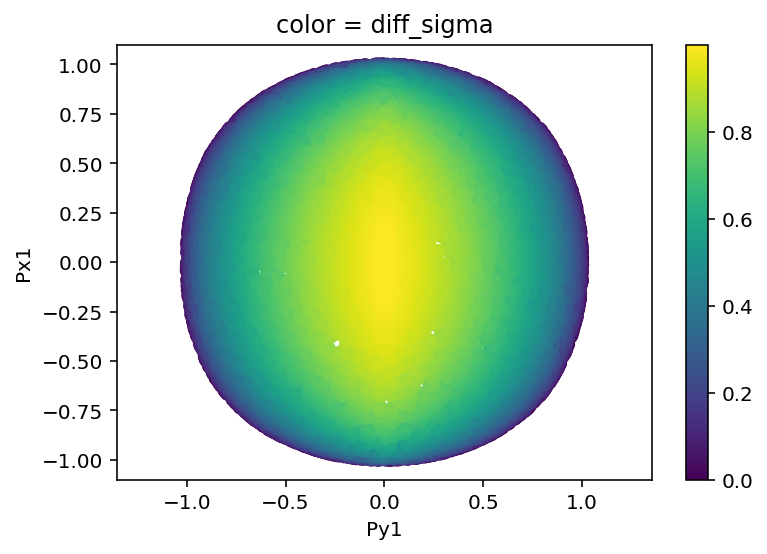

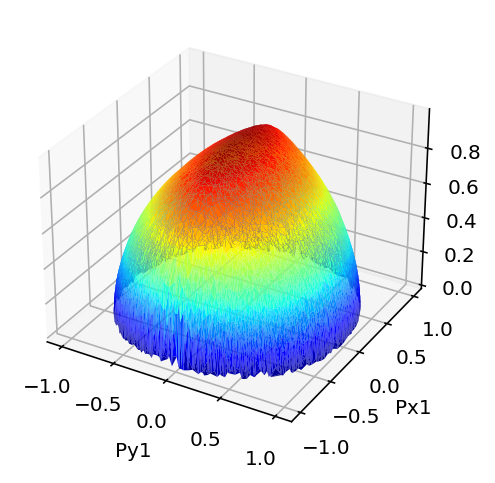

In [46]:
i = 0
print(i)
res_plot(df.sort_values(target), results, num = i, logs = False)
i+=1

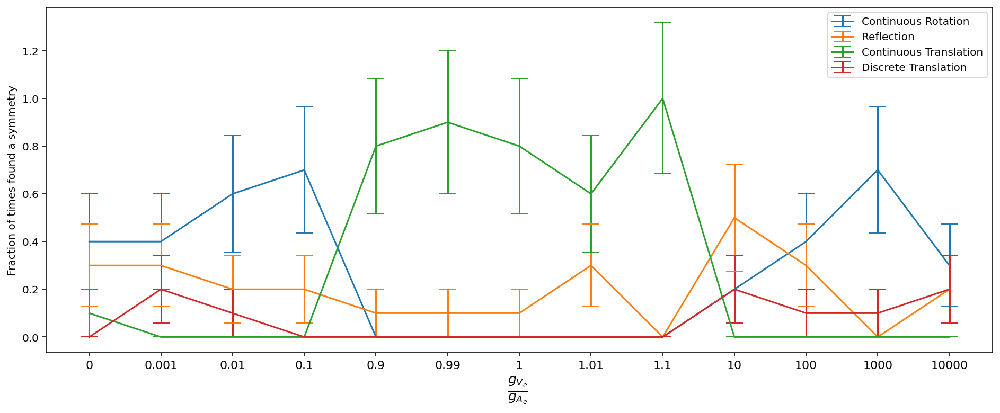

In [48]:
#registro = pd.read_csv('registro_1500_times_ratio_uniform.csv') #pd.read_csv('registro_200_times_couplings.csv')
rep_todo = 10

etis = []

#gve_l = [1,0.9,0.85,0.8,0.7,0.5,0.3,0.2,0.15,0.1,0]
#gae_l = [0,0.1,0.15,0.2,0.3,0.5,0.7,0.8,0.85,0.9,1]
rs = [0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]
gae_l = [1 for r in rs]
gve_l = [np.round(r,2) for r in rs]

for k in range(len(gve_l)):
    #etis.append(r'$g_{V_e} =$ '+str(gve_l[k])+'\n $g_{A_e} =$ '+str(gae_l[k]))
    etis.append(str(rs[k]))

plt.figure(figsize = [16,6])
plt.errorbar(x = list(range(len(gae_l))), y = registro.continuous_rotation/rep_todo, 
             yerr = np.sqrt(np.array(registro.continuous_rotation).astype(np.float32))/rep_todo, capsize = 8, label = 'Continuous Rotation')
plt.errorbar(x = list(range(len(gae_l))), y = registro.reflection/rep_todo, 
             yerr = np.sqrt(np.array(registro.reflection).astype(np.float32))/rep_todo, capsize = 8, label = 'Reflection')
plt.errorbar(x = list(range(len(gae_l))), y = registro.continuous_translation/rep_todo, 
             yerr = np.sqrt(np.array(registro.continuous_translation).astype(np.float32))/rep_todo, capsize = 8, label = 'Continuous Translation')
plt.errorbar(x = list(range(len(gae_l))), y = registro.discrete_translation/rep_todo, 
             yerr = np.sqrt(np.array(registro.discrete_translation).astype(np.float32))/rep_todo, capsize = 8, label = 'Discrete Translation')
plt.xticks(range(len(gae_l)),etis, fontsize = 11)
plt.ylabel('Fraction of times found a symmetry')
plt.xlabel(r'$\frac{g_{V_e}}{g_{A_e}} $ ',fontsize = 18)
plt.legend()
plt.show()

# Custom Distribution of cos(theta)

In [43]:
target = 'diff_sigma'    # Nombre de la variable que queremos predecir
nombre_carpeta = target # Nombre de la subcarpeta donde vamos a guardar las PCAs, dentro de la carpeta grande. Así podemos analizar al mismo tiempo varias bases de datos
folder = 'Ze+e-_custom'   # Carpeta donde se guardan las subcarpetas con las PCAs
folder_0 = 'cross_section_cos_theta_custom' # Carpeta donde están los eventos

n_fea = 13              # Número de features finales que el algoritmo escoge para hacer parejas y analizar con ellas la simetría

lim_sym = 0.7          # Límite de probabilidad para decidir que el algoritmo ha encontrado o no una simetría

limit_pairs = False      # Al generar parejas, estas vienen acompañadas de un 'score'. Si esto es True, cogmos solo la mitad de las con mayor 'score'

select_10k = True       # Keep only 10000 elements of the original potential DF (useful)

interact = False        # 'big', 'small', 'FW', False

rep_todo = 2

num_bines = 60

# ----------------------------------- #

quantiles = True
range_cols = True   # Si quantiles == True, las columnas distintas de la target las escala entre -1 y 1.
ignore_list = ['Pz1','Pz2', 'E2', 's', 'cos_theta','inds','diff_sigma_fit']


rs = [0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]
ind_ord = [l for l in range(len(rs))]
gae_l = [1 for r in rs]
gve_l = [np.round(r,4) for r in rs]
    

# --------------------------------------#

i = 0 
from time import time
start_time = time()

syms_tot = ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
registro = pd.DataFrame(columns = syms_tot)
registros = []

num_g = len(gve_l)

for  gve,gae,indo in zip(gve_l,gae_l,ind_ord):
    
    print('**** gv_e = {} **** ga_e = {} ****'.format(gve,gae))


    categ = []
    numer = []


    # --------------------------------------#


    # Read custom events

    name = 'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) + '.csv'

    df_e = pd.read_csv(os.path.join(folder_0,name))
    df_e = df_e.drop('diff_sigma', axis = 1)

    # Histogram of cos_theta
    hist, bin_edges = np.histogram(df_e.cos_theta,bins = num_bines, density = False)

    # Which bin does each event belong to
    inds = np.digitize(df_e.cos_theta,bin_edges[:-1])
    df_e['inds'] = inds-1

    # Assignment of differential cross section
    df_e['diff_sigma'] = np.zeros(len(df_e))

    for yyy in range(len(hist)):
        df_e['diff_sigma'].iloc[np.where(df_e['inds'] == yyy)] = hist[yyy]


    # Fitting to a 2nd degree polynomial
    p = np.polyfit(df_e.cos_theta, df_e.diff_sigma/max(df_e.diff_sigma),2)
    diff_sigma_fit = np.polyval(p,df_e.cos_theta)
    df_e['diff_sigma_fit'] = diff_sigma_fit
    
    #plt.figure()
    #plt.hist(df_e.cos_theta,bins = num_bines)
    #plt.show()

    for col in list(df_e.columns):
        if (col != target) and (col not in ignore_list):
            if type(df_e[col][0]) == str:
                categ.append(col)
            else:
                numer.append(col)

    splits = RandomSplitter(valid_pct=0)(range_of(df_e))

    to = TabularPandas(df_e,
                    procs=[Categorify,FillMissing],
                    cat_names = categ,
                    cont_names = numer,
                    y_names = target,
                    splits=splits)


    #equiv_CNACE = pd.DataFrame({'Cod_Num':list(to.xs['CNACE'].unique()),'Categ':list(dls.dsets['CNACE'].unique())}).sort_values(by = 'Categ')
    #equiv_CNO1 = pd.DataFrame({'Cod_Num':list(to.xs['CNO1'].unique()),'Categ':list(dls.dsets['CNO1'].unique())}).sort_values(by = 'Categ')

    df_e = pd.DataFrame(to.xs)
    df_e[target] = to.y
    df_e = df_e.reset_index().drop('index', axis = 1)  

    for col in df_e.columns:
        df_e[col] = np.nan_to_num(df_e[col])   
        if quantiles == True:
            n_attempted_bins =  len(df_e[col])
            binning = pd.qcut(df_e[col], q=n_attempted_bins, retbins=True, labels=False, duplicates='drop')
            df_e[col]=binning[0]/np.max(binning[0])
            df_e[col] = np.nan_to_num(df_e[col])
            if (range_cols == True) and (col != target): 
                df_e[col] = df_e[col]*2 - 1




    # ------------------------------------------------------------------------------------------------------------------------#
   

    sym_feat_1 = []
    sym_feat_2 = []
    sym_feat_tags = []
    sym_feat_probs = []
    sym_feat_rmse = []
    syms_tot = ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
    # Tiempo en el que empezamos a procesar
    from time import time
    


    from fastai.vision.all import *
    from time import time
    from IPython.utils import io



    muchos = False # Si es false, para muchos potenciales, mete cada combinación de variables en una carpeta separada, para que sea fácil ver si hay simetría ahí
                   # Si es true, van todos a la misma carpeta


    # ------------------- Folder PCA ------------------- #


    dd = top_dir + '/' + folder
    if not os.path.isdir(dd):
        print('Creating directory:\n',dd)
        os.mkdir(dd)

    dir = os.path.join(top_dir,folder)


    #------------------------------ Generar Potenciales ---------------------------#

    potenciales = [df_e]
    potenciales_tags = [nombre_carpeta for k in range(rep_todo)]
    tags = potenciales_tags
    num_pot = len(potenciales)

    # ------------------- No prints al guardar mejor modelo (fastai) ------------------- # 
    # Solo hay un print que se ha eliminado del código original
    class SaveModelCallback(TrackerCallback):
        "A `TrackerCallback` that saves the model's best during training and loads it at the end."
        _only_train_loop = True
        def __init__(self, monitor='valid_loss', comp=None, min_delta=0., fname='model', every_epoch=False, at_end=False,
                     with_opt=False, reset_on_fit=True):
            super().__init__(monitor=monitor, comp=comp, min_delta=min_delta, reset_on_fit=reset_on_fit)
            assert not (every_epoch and at_end), "every_epoch and at_end cannot both be set to True"
            # keep track of file path for loggers
            self.last_saved_path = None
            store_attr('fname,every_epoch,at_end,with_opt')

        def _save(self, name): self.last_saved_path = self.learn.save(name, with_opt=self.with_opt)

        def after_epoch(self):
            "Compare the value monitored to its best score and save if best."
            if self.every_epoch: self._save(f'{self.fname}_{self.epoch}')
            else: #every improvement
                super().after_epoch()
                if self.new_best:
                    #print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
                    self._save(f'{self.fname}')

        def after_fit(self, **kwargs):
            "Load the best model."
            if self.at_end: self._save(f'{self.fname}')
            elif not self.every_epoch: self.learn.load(f'{self.fname}', with_opt=self.with_opt)

    # ---------------- Definiciones previas e hiperparámetros ----------------- #

    #Guardo los modelos para analizarlos luego
    models = [] 
    to_s = []

    #Guardaremos los resultados de la PCA en un array 
    PCA_s = []
    PCA_s_tag = []

    # Hyperparameters: 
    bs_choices = [50000]       # Batch Size
    shape='pipe'               # Shape of the neural network
    layers_choices = [5]       # Number of layers of the net. Default:10 or 5 results with 5
    neurons_choices = [200]    # Number of neurons per layer. Default:200 results with 200
    epoch_choices = [50]      # Number of training epochs. Default:200 results with 100
    lr_choices = [0.01]       # Max learning rate 
    valid_pct=0.2              # Part of the data that goes into validation (0.2 = 20%)
    monitor= 'valid_loss'        # Te model with the least 'monitor' will be saved



    # ---------------------- Entrenar Red Y PCA -----------------------------------#

    j = 1 # Usaremos esto para saber cuantos potenciales hemos procesado, y como indice en general

    for rtd in range(rep_todo):
        for df in potenciales:


            df[target] = df[target]/np.max(df[target]) #Normalizar la columna objetivo es importante

            #------------------------------ Feature Importance  ---------------------------#

            if select_10k == True:
                if len(df[target]) <= 100*100:
                    print('Too little data to keep 10k points and delete the rest')
                else:
                    print('Keeping 10k points of the original DF')
                    remove_n = len(df[target]) - 10000
                    drop_indices = np.random.choice(df.index, remove_n, replace=False)
                    df_temp = df.drop(drop_indices)
                    df = df_temp.copy()



            if interact == 'big':
                print('---- Big interactions ----')
                bbb = df[target]
                df = df.drop(target,axis = 1)
                df = my_interactions(df, numo_int = 10, verbose = True)
                df[target] = bbb

            elif interact == 'small':
                print('---- Small interactions ----')
                bbb = df[target]
                df = df.drop(target,axis = 1)
                df = my_interactions_small(df, numo_int = 10, verbose = True)
                df[target] = bbb

            elif interact == 'FW':
                print('---- Interactions by featurewiz ----')
                with io.capture_output() as captured2: output = featurewiz(df, target, corr_limit=0.10,
                                                                verbose=0, sep=',', header=0, test_data='',
                                                                category_encoders='',feature_engg='interactions')   
                df = output[1].copy()

            elif interact == False:
                print('No interactions')


            #df = regularize_df(df)

            print('---Selecting Best Features---')
            best_pairs = n_best_rf_phi_k(df, target = target, n = n_fea, nf = 30, lim_corr = 0.85)

            best_n = [best_pairs['f1'][0]] + list(best_pairs['f2'].unique())

            print('Best Features: ',best_n)

            #small_df = df[best_n]
            #small_df[target] = df[target]


            cols = best_n
            a = cols

            verbose = 1



            df_org = df.copy()

            if limit_pairs == True:
                medi = best_pairs.score.median()
                num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
            else:
                medi = 0
                num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
                #num_2 = 1

            for f1,f2,lll in zip(best_pairs.f1,best_pairs.f2,range(len(best_pairs.f1))):
                if best_pairs.score[lll] >= medi:

                    i+=1

                    print(f1,f2)
                    feas = [f1,f2]

                    # Debemos marcar cada potencial para tener claro a qué tipo de simetria corresponde cada PCA
                    PCA_s_tag.append(tags[j-1])

                    df2 = df[feas + [target]].copy() 
                    #df2 = df2[feas + [target]].copy()

                    #Normlizamos las features y hacemos que vayan entre -1 y 1
                    df2[f1] = 2*(df2[f1]/np.max(df2[f1]))-1
                    df2[f2] = 2*(df2[f2]/np.max(df2[f2]))-1

                    splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

                    to = TabularPandas(df2,
                                    procs=[Categorify,FillMissing, Normalize],
                                    cont_names = feas,
                                    y_names = target,
                                    splits=splits)

                    train_size = len(splits[0])
                    valid_size = len(splits[1])

                    # ----------------- Hyperparameters ------------------- #

                    # Batch Size (a large one)
                    bs=min(random.choice(bs_choices),train_size)  
                    print('{} batch size for training.\n'.format(bs))

                    # Neurons per layer
                    neurons_per_layer = random.choice(neurons_choices)

                    # Number of layers
                    n_layers = random.choice(layers_choices)

                    #Shape of the net: Pipe or funnel
                    if shape == 'pipe':
                        layers=[neurons_per_layer for i in range(n_layers)]

                    if shape == 'funnel':
                        n_eff = n_layers
                        layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

                    print('Training FCNN with layers: ',layers)

                    #Number of epochs
                    n_epoch=random.choice(epoch_choices)
                    print('Training for {} epochs.'.format(n_epoch))

                    # Maximum Learning Rate: (a good value can be found using learn.lr_find())
                    lr_max=float(random.choice(lr_choices))
                    print('Using lr_max = ',format(lr_max))

                    # ----------------------------------------------------- #

                    # --------------- Training the FCNN --------------------#

                    # Load the data into a DataLoader
                    dls = to.dataloaders(bs=bs)

                    # Define a Tabular Learner
                    learn = tabular_learner(dls, layers=layers
                                        #,config=config
                                        #,metrics=[mse],
                                        #y_range = [min(df.bin),max(df.bin)],
                                        #,cbs=ShowGraphCallback()
                                        #,train_bn=False)
                                        )

                    # Train the net 
                    with learn.no_logging():
                        learn.fit_one_cycle(n_epoch=n_epoch
                                            ,lr_max=lr_max
                                            ,cbs=[SaveModelCallback(monitor=monitor)]
                                            )

                        preds, targs = learn.get_preds()

                    ff = (preds-targs)**2/len(targs)
                    ff = sum(ff)
                    RMSE = np.sqrt(ff)
                    #print('RMSE:',float(RMSE))
                    nrmsei = float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))

                    # Guardamos modelos y tabular objects para el posterior analisis
                    models.append(learn)
                    to_s.append(to)

                    # ------------------------------------------------------#


                    # ------------------------- PCA ------------------------#

                    test_df = df2.copy()
                    dl = learn.dls.test_dl(test_df,bs=int(test_df.shape[0])) 

                    # Tenemos que hacer un Hook, una especie de gancho que enganchamos en la última capa interna,
                    # para guardar, de cada modelo, los valores de los parámetro de dicha capa. 
                    with Hooks(learn.model.layers, lambda m,i,o: o) as h:
                        preds = learn.get_preds(dl=dl,with_input=True,with_decoded=True,with_loss=True)

                    targets=preds[2].numpy().flatten()

                    # Cogemos la información de la penúltima capa
                    # OJO: Si añadimos y_range, se añade automaticamente una sigmoid
                    # al final, por lo que tendríamos que coger la capa -3 en vez de la -2
                    act = h.stored[-2] 
                    multi_dim=Tensor.cpu(act).numpy()
                    standardized=StandardScaler().fit_transform(multi_dim)

                    viz = PCA(2).fit_transform(np.nan_to_num(standardized))
                    #plt.figure()
                    #plt.scatter(viz[:, 0], viz[:, 1],c=targets[:multi_dim.shape[0]],alpha=.1, marker = 'o')

                    PCA_s.append(viz)

                    # ------------------------------------------------------ #

                    # ------------------ Saving the PCA's ------------------ #

                    # ---- Dar formato a PCA para guardar como imagen con color

                    viz = pd.DataFrame(viz) #Transformamos la PCA en un dataframe
                    viz.columns = ['x','y'] #Nombres de las columnas

                    # Insertamos una columna con los colores de los puntos. El valor del potencial
                    # objetivo (targets) es el color, y hay un color por cada punto 
                    viz.insert(2,'class',targets[:multi_dim.shape[0]]) 

                    # ---- Personalizar mapa de color 

                    n_classes=1000

                    colors = 'rainbow'

                    if colors == 'rainbow':
                        my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                        classes_in_rgb = my_cmap(range(n_classes))
                    if colors == 'purple':
                        my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                        classes_in_rgb = np.vstack((np.array([0,0,0,0]),my_cmap([0 for i in range(n_classes)])))

                    # ---- Hacer que la intensidad del pixel represente la cantidad de puntos 
                    #      acumuldos en un pixel

                    n_pixels = 224

                    binning_3d=np.histogramdd([viz['x'],viz['y'],viz['class']],range=(None,None,(0,1)), bins=(n_pixels,n_pixels,n_classes))

                    #if we want the pixel intensity to reprensent the number of points at that location
                    array = np.dot(binning_3d[0],classes_in_rgb)
                    array = array/np.amax(array)

                    # ---- Guardar la PCA

                    #Directorio donde guardaremos las imagenes
                    nami = str(chr(97 + indo))+'_'+'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) +'_'
                    if muchos == False: 
                        dir_sym = os.path.join(dir,tags[j-1],nami)
                        img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+'__PCA.png' 
                    else:
                        dir_sym = os.path.join(dir,tags[j-1])
                        img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+nami+'__PCA.png' 

                    if not os.path.isdir(dir_sym):
                        print('Creating directory:\n',dir_sym)
                        os.makedirs(dir_sym)


                    # Nombre de la imagen. Pongo el tiempo para que todas se llamen distinto cada vez.
                    output_dir = os.path.join(dir_sym,img_file) # Directorio donde guardamos la imagen
                    plt.imsave(output_dir,array) # Guardar
                    print('\nPCA saved to:\n{}\n'.format(dir_sym+'/'+img_file))


                    # ------------------------ Symmetry Analyzer --------------------- #
                    drr = pca_sym_finder(output_dir)
                    brr = list(drr.iloc[np.where(drr.value > lim_sym)].symmetry)
                    if len(brr) > 0:
                        print('Found {} symmetry with features {} and {}, with prob. {}'.format(brr[0],f1,f2,float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4))))                
                        sym_feat_1.append(f1)
                        sym_feat_2.append(f2)
                        sym_feat_tags.append(brr[0])
                        sym_feat_probs.append(float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4)))
                        sym_feat_rmse.append(nrmsei)




                    # ------------------------ Time -------------------------#

                    minutes_until_now = (time() - start_time)/60
                    images_done = i
                    minutes_per_image = minutes_until_now/(images_done)
                    hours_left = minutes_per_image * (num_pot*rep_todo*num_2*num_g-images_done)/60
                    print("\n{} PCA's made out of {}.\n".format(images_done,num_pot*num_2*rep_todo*num_g))
                    print("{:.1f} minutes elapsed for {} images.".format(minutes_until_now,images_done))
                    print("{:.1f} seconds average per image.".format(60*minutes_until_now/images_done))
                    print("{:.1f} minutes estimated left for {} images.\n\n\n".format(hours_left*60,num_pot*num_2*rep_todo*num_g-images_done))
                    print("{:.1f} hours estimated left for {} images.\n\n\n".format(hours_left,num_pot*num_2*rep_todo*num_g-images_done))




        j+=1


              # ------------------------------------------------------#'''

    results = pd.DataFrame({'symmetry':sym_feat_tags, 'feature_1':sym_feat_1, 'feature_2':sym_feat_2, 'probability':sym_feat_probs, 'NRMSE':sym_feat_rmse})

    vc = results.symmetry.value_counts()



    for sym_sum in syms_tot:
        if not hasattr(vc,sym_sum):
            vc[sym_sum] = 0


    nr = pd.DataFrame({'continuous_rotation':vc['continuous_rotation'], 
                       'continuous_translation':vc['continuous_translation'], 
                       'discrete_translation':vc['discrete_translation'], 
                       'none':vc['none'], 
                       'reflection':vc['reflection']}, index = [0])

    registro = registro.append(nr, ignore_index=True)
    

    registros.append(nr)

'''
    plt.xticks(rotation = -15)
    plt.ylim([0,1])
    print(registro.columns)
    print(registro.sum()/registro.sum().sum())
    plt.bar(registro.columns,registro.sum()/registro.sum().sum(), yerr = np.sqrt(registro.sum())/registro.sum().sum(), capsize = 8)

'''
print(0)

**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11639575148__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.972100019454956

1 PCA's made out of 26.

0.1 minutes elapsed for 1 images.
0.1 minutes average per image.
2.0 minutes estimated left for 25 images.



0.0 hours estimated left for 25 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_21639575151__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7746000289916992

2 PCA's made out of 26.

0.1 minutes elapsed for 2 images.
0.1 minutes average per image.
1.6 minutes estimated left for 24 images.



0.0 hours estimated left for 24 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11639575156__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9829000234603882

3 PCA's made out of 26.

0.2 minutes elapsed for 3 images.
0.1 minutes average per image.
1.5 minutes estimated left for 23 images.



0.0 hours estimated left for 23 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_21639575158__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9902999997138977

4 PCA's made out of 26.

0.2 minutes elapsed for 4 images.
0.1 minutes average per image.
1.3 minutes estimated left for 22 images.



0.0 hours estimated left for 22 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11639575162__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

5 PCA's made out of 26.

0.3 minutes elapsed for 5 images.
0.1 minutes average per image.
1.3 minutes estimated left for 21 images.



0.0 hours estimated left for 21 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_21639575165__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

6 PCA's made out of 26.

0.3 minutes elapsed for 6 images.
0.1 minutes average per image.
1.2 minutes estimated left for 20 images.



0.0 hours estimated left for 20 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11639575169__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

7 PCA's made out of 26.

0.4 minutes elapsed for 7 images.
0.1 minutes average per image.
1.1 minutes estimated left for 19 images.



0.0 hours estimated left for 19 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_21639575171__PCA.png




8 PCA's made out of 26.

0.5 minutes elapsed for 8 images.
0.1 minutes average per image.
1.0 minutes estimated left for 18 images.



0.0 hours estimated left for 18 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/e_ze+e-_gve_0.9_gae_1_/diff_sigma_11639575175__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

9 PCA's made out of 26.

0.5 minutes elapsed for 9 images.
0.1 minutes average per image.
1.0 minutes estimated left for 17 images.



0.0 hours estimated left for 17 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/e_ze+e-_gve_0.9_gae_1_/diff_sigma_21639575178__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9959999918937683

10 PCA's made out of 26.

0.6 minutes elapsed for 10 images.
0.1 minutes average per image.
0.9 minutes estimated left for 16 images.



0.0 hours estimated left for 16 images.



**** gv_e = 0.99 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/f_ze+e-_gve_0.99_gae_1_/diff_sigma_11639575182__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

11 PCA's made out of 26.

0.6 minutes elapsed for 11 images.
0.1 minutes average per image.
0.9 minutes estimated left for 15 images.



0.0 hours estimated left for 15 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/f_ze+e-_gve_0.99_gae_1_/diff_sigma_21639575184__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

12 PCA's made out of 26.

0.7 minutes elapsed for 12 images.
0.1 minutes average per image.
0.8 minutes estimated left for 14 images.



0.0 hours estimated left for 14 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11639575188__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9717000126838684

13 PCA's made out of 26.

0.7 minutes elapsed for 13 images.
0.1 minutes average per image.
0.7 minutes estimated left for 13 images.



0.0 hours estimated left for 13 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_21639575191__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

14 PCA's made out of 26.

0.8 minutes elapsed for 14 images.
0.1 minutes average per image.
0.7 minutes estimated left for 12 images.



0.0 hours estimated left for 12 images.



**** gv_e = 1.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/h_ze+e-_gve_1.01_gae_1_/diff_sigma_11639575195__PCA.png




15 PCA's made out of 26.

0.9 minutes elapsed for 15 images.
0.1 minutes average per image.
0.6 minutes estimated left for 11 images.



0.0 hours estimated left for 11 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/h_ze+e-_gve_1.01_gae_1_/diff_sigma_21639575197__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8428000211715698

16 PCA's made out of 26.

0.9 minutes elapsed for 16 images.
0.1 minutes average per image.
0.6 minutes estimated left for 10 images.



0.0 hours estimated left for 10 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/i_ze+e-_gve_1.1_gae_1_/diff_sigma_11639575201__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

17 PCA's made out of 26.

1.0 minutes elapsed for 17 images.
0.1 minutes average per image.
0.5 minutes estimated left for 9 images.



0.0 hours estimated left for 9 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/i_ze+e-_gve_1.1_gae_1_/diff_sigma_21639575204__PCA.png




18 PCA's made out of 26.

1.0 minutes elapsed for 18 images.
0.1 minutes average per image.
0.4 minutes estimated left for 8 images.



0.0 hours estimated left for 8 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11639575208__PCA.png




19 PCA's made out of 26.

1.1 minutes elapsed for 19 images.
0.1 minutes average per image.
0.4 minutes estimated left for 7 images.



0.0 hours estimated left for 7 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_21639575210__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7908999919891357

20 PCA's made out of 26.

1.1 minutes elapsed for 20 images.
0.1 minutes average per image.
0.3 minutes estimated left for 6 images.



0.0 hours estimated left for 6 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11639575214__PCA.png




21 PCA's made out of 26.

1.2 minutes elapsed for 21 images.
0.1 minutes average per image.
0.3 minutes estimated left for 5 images.



0.0 hours estimated left for 5 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_21639575217__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7989000082015991

22 PCA's made out of 26.

1.2 minutes elapsed for 22 images.
0.1 minutes average per image.
0.2 minutes estimated left for 4 images.



0.0 hours estimated left for 4 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11639575221__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9980999827384949

23 PCA's made out of 26.

1.3 minutes elapsed for 23 images.
0.1 minutes average per image.
0.2 minutes estimated left for 3 images.



0.0 hours estimated left for 3 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_21639575223__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9886000156402588

24 PCA's made out of 26.

1.3 minutes elapsed for 24 images.
0.1 minutes average per image.
0.1 minutes estimated left for 2 images.



0.0 hours estimated left for 2 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11639575227__PCA.png




25 PCA's made out of 26.

1.4 minutes elapsed for 25 images.
0.1 minutes average per image.
0.1 minutes estimated left for 1 images.



0.0 hours estimated left for 1 images.



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_21639575230__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8791000247001648

26 PCA's made out of 26.

1.4 minutes elapsed for 26 images.
0.1 minutes average per image.
0.0 minutes estimated left for 0 images.



0.0 hours estimated left for 0 images.



0


1


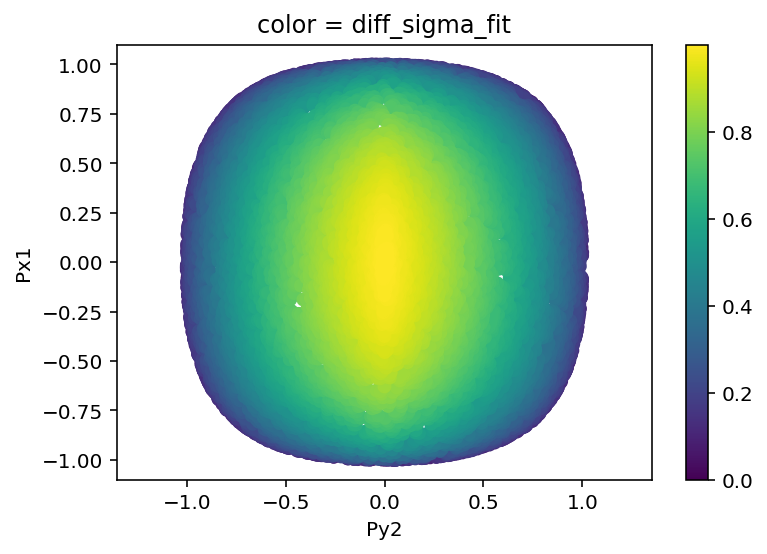

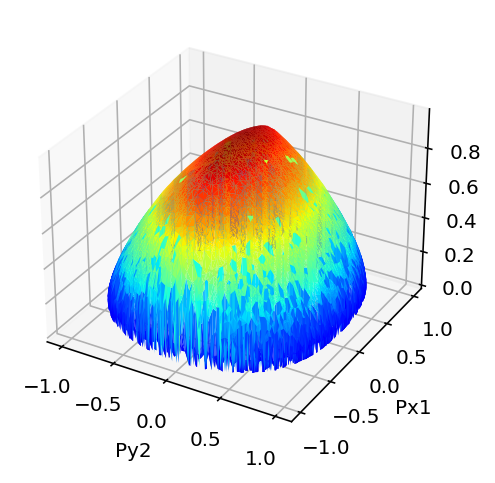

In [64]:
i = 0
print(i)
res_plot(df.sort_values(target), results, num = i, logs = False)
i+=1

In [4]:
registro = pd.read_csv('registro_1500_times_custom.csv')
registro

,Unnamed: 0,continuous_rotation,continuous_translation,discrete_translation,none,reflection
0,0,0,0,0,0,1
1,1,1,0,0,0,0
2,2,0,0,0,0,1
3,3,0,0,0,0,1
4,4,0,0,1,0,0
...,...,...,...,...,...,...
995,995,0,0,0,0,0
996,996,1,0,0,0,0
997,997,0,0,0,0,1
998,998,0,0,0,0,1


In [1]:
registro = pd.read_csv('registro_1500_times_custom.csv') #pd.read_csv('registro_200_times_couplings.csv')
rep_todo = 1000

etis = []

#gve_l = [1,0.9,0.85,0.8,0.7,0.5,0.3,0.2,0.15,0.1,0]
#gae_l = [0,0.1,0.15,0.2,0.3,0.5,0.7,0.8,0.85,0.9,1]
rs = [0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]
gae_l = [1 for r in rs]
gve_l = [np.round(r,2) for r in rs]

for k in range(len(gve_l)):
    #etis.append(r'$g_{V_e} =$ '+str(gve_l[k])+'\n $g_{A_e} =$ '+str(gae_l[k]))
    etis.append(str(rs[k]))

plt.figure(figsize = [16,6])
plt.errorbar(x = list(range(len(gae_l))), y = registro.continuous_rotation/rep_todo, 
             yerr = np.sqrt(np.array(registro.continuous_rotation).astype(np.float32))/rep_todo, capsize = 8, label = 'Continuous Rotation')
plt.errorbar(x = list(range(len(gae_l))), y = registro.reflection/rep_todo, 
             yerr = np.sqrt(np.array(registro.reflection).astype(np.float32))/rep_todo, capsize = 8, label = 'Reflection')
plt.errorbar(x = list(range(len(gae_l))), y = registro.continuous_translation/rep_todo, 
             yerr = np.sqrt(np.array(registro.continuous_translation).astype(np.float32))/rep_todo, capsize = 8, label = 'Continuous Translation')
plt.errorbar(x = list(range(len(gae_l))), y = registro.discrete_translation/rep_todo, 
             yerr = np.sqrt(np.array(registro.discrete_translation).astype(np.float32))/rep_todo, capsize = 8, label = 'Discrete Translation')
plt.xticks(range(len(gae_l)),etis, fontsize = 11)
plt.ylabel('Fraction of times found a symmetry')
plt.xlabel(r'$\frac{g_{V_e}}{g_{A_e}} $ ',fontsize = 18)
plt.legend()
plt.show()

NameError: name 'pd' is not defined

In [69]:
#registro.to_csv('registro_1500_times_custom.csv')

Notebook directory: /home/gabriel/Desktop
Numero Imagenes: 1022
Numero Imagenes: 2044
Numero Imagenes: 3066
Numero Imagenes: 4088
Numero Imagenes: 5110
Numero Imagenes: 6132
Numero Imagenes: 7154
Numero Imagenes: 8175
Numero Imagenes: 9196
Numero Imagenes: 10217
Numero Imagenes: 11238
Numero Imagenes: 12259
Numero Imagenes: 13280
['a_ze+e-_gve_0_gae_1_' 'b_ze+e-_gve_0.001_gae_1_'
 'c_ze+e-_gve_0.01_gae_1_' 'd_ze+e-_gve_0.1_gae_1_'
 'e_ze+e-_gve_0.9_gae_1_' 'f_ze+e-_gve_0.99_gae_1_' 'g_ze+e-_gve_1_gae_1_'
 'h_ze+e-_gve_1.01_gae_1_' 'i_ze+e-_gve_1.1_gae_1_'
 'j_ze+e-_gve_10_gae_1_' 'k_ze+e-_gve_100_gae_1_'
 'l_ze+e-_gve_1000_gae_1_' 'm_ze+e-_gve_10000_gae_1_']
['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
[0.4479668  0.01876483 0.07503103 0.00950964 0.4487277 ]


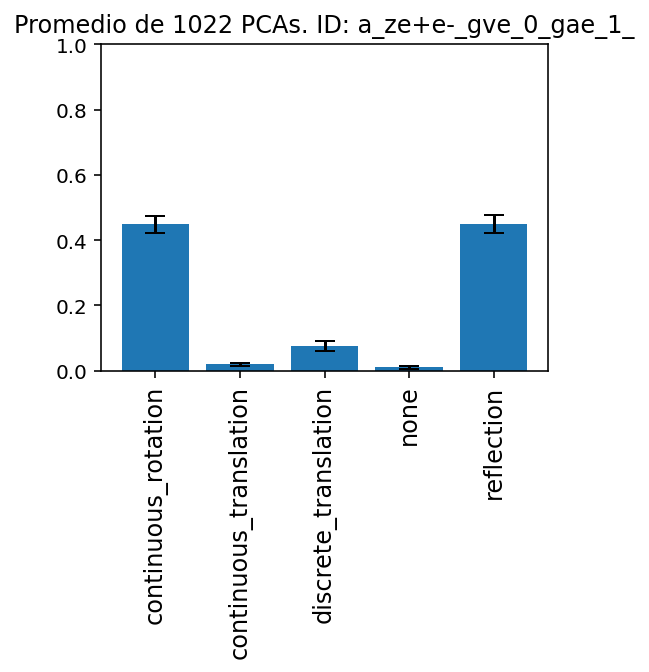

[0.5684043  0.01189121 0.09789674 0.00518059 0.31662716]


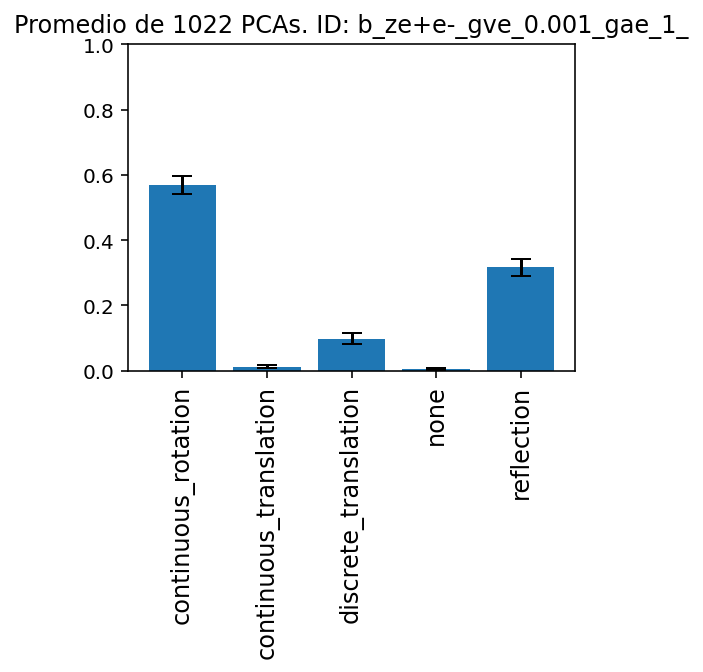

[0.47225173 0.01124478 0.09151141 0.00529345 0.41969863]


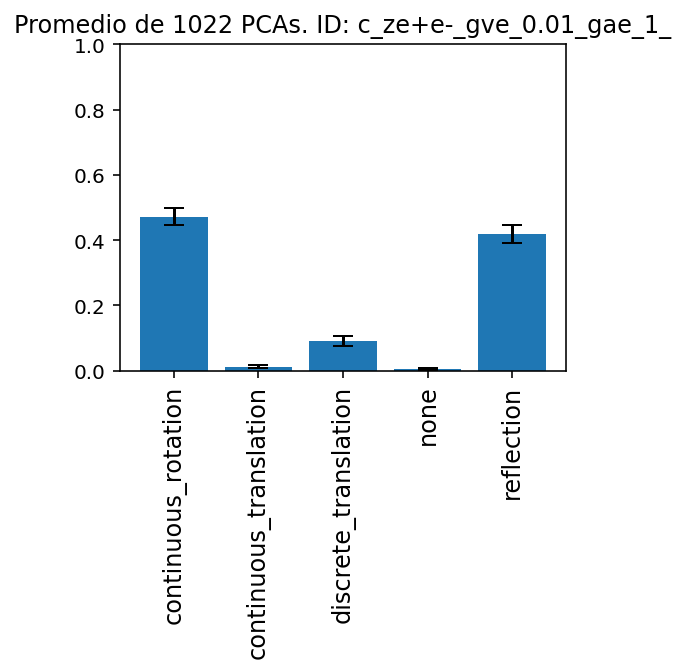

[0.37355474 0.00529496 0.08508534 0.00084494 0.53522002]


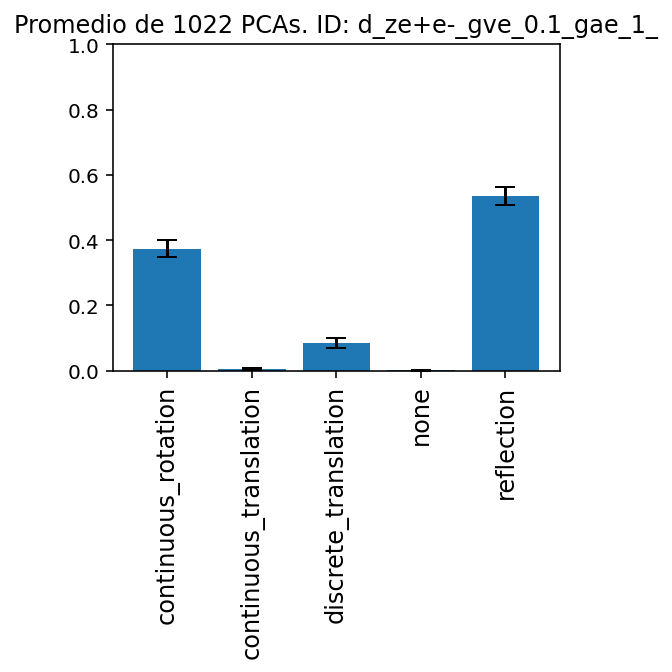

[5.27556230e-01 2.86669633e-01 8.64439271e-05 6.78543236e-05
 1.85619842e-01]


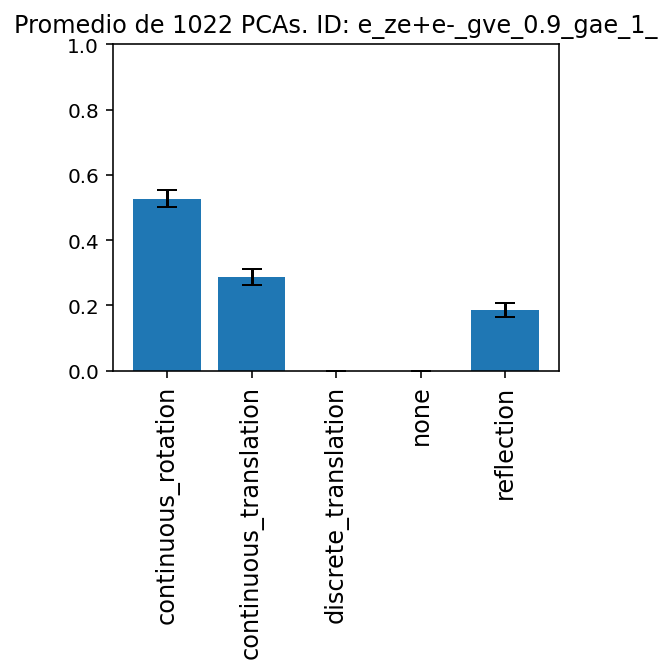

[5.64713320e-01 2.59513026e-01 1.70133362e-04 3.73357333e-04
 1.75230171e-01]


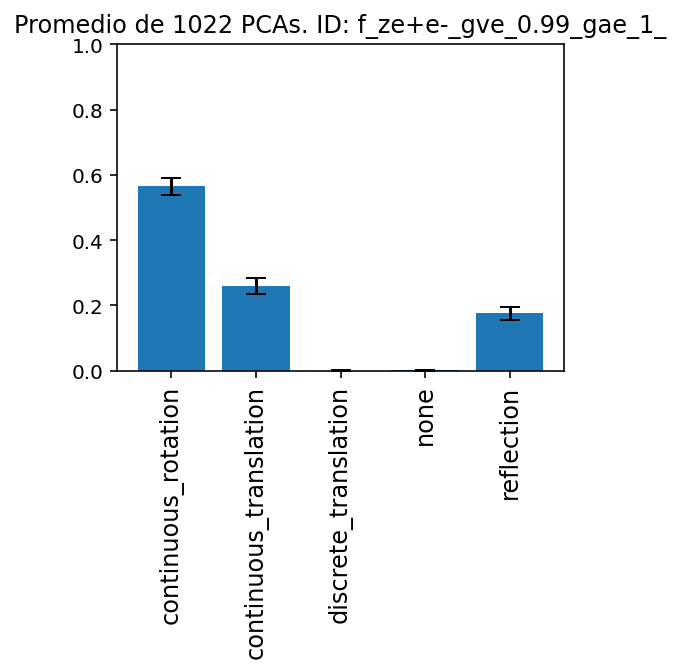

[5.18740552e-01 2.81040609e-01 1.85214860e-04 6.29488299e-04
 1.99404143e-01]


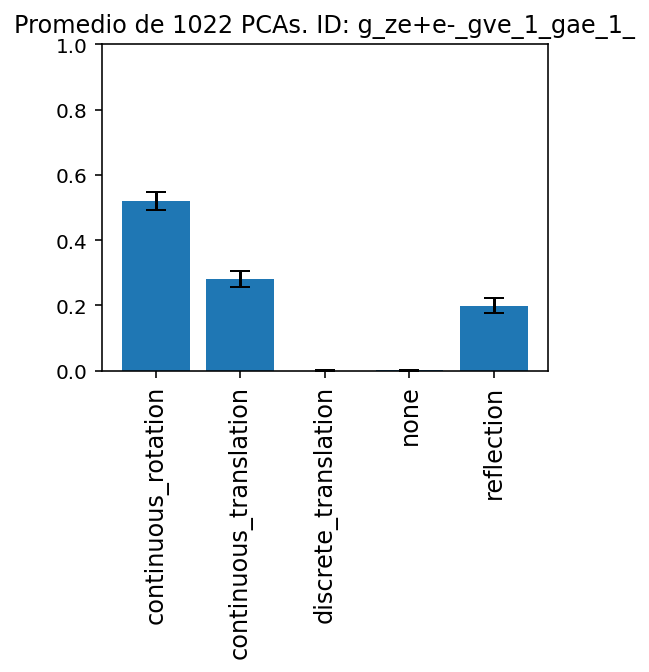

[0.49983925 0.34928497 0.00112103 0.0005231  0.14923166]


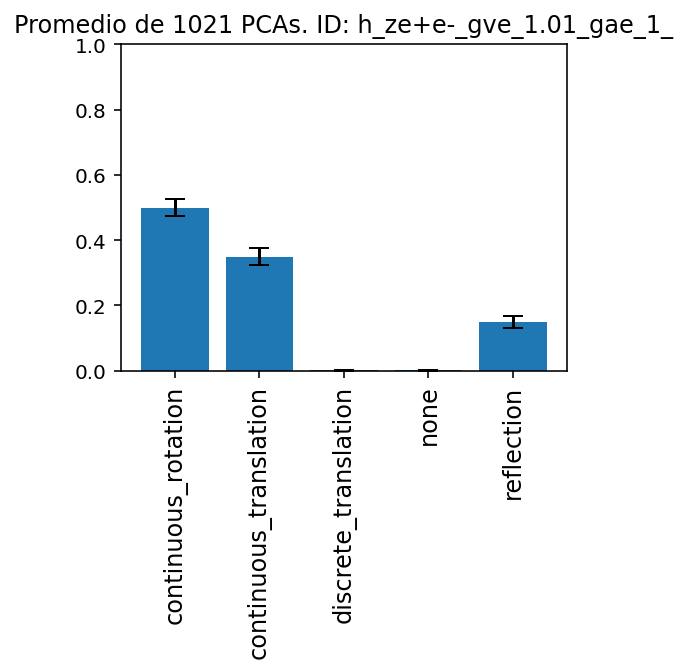

[4.75342746e-01 3.54313514e-01 2.90686160e-04 9.86982732e-04
 1.69066075e-01]


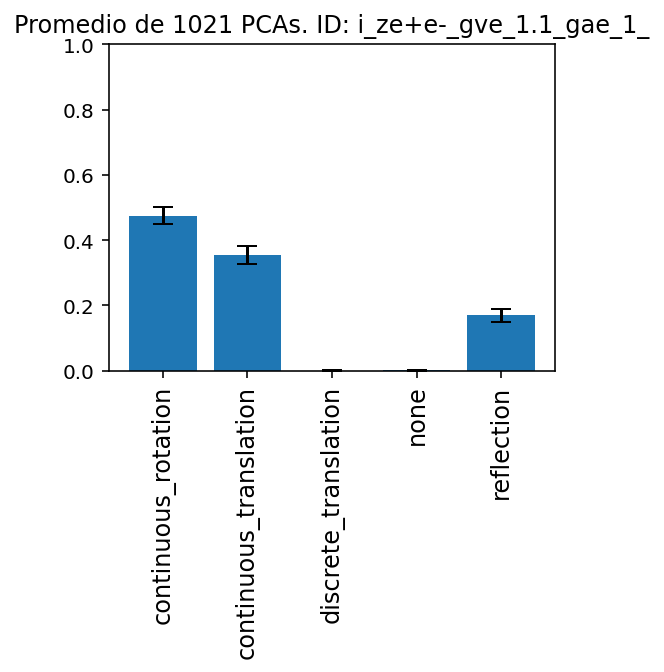

[0.48089974 0.01711336 0.0846347  0.00707995 0.41027225]


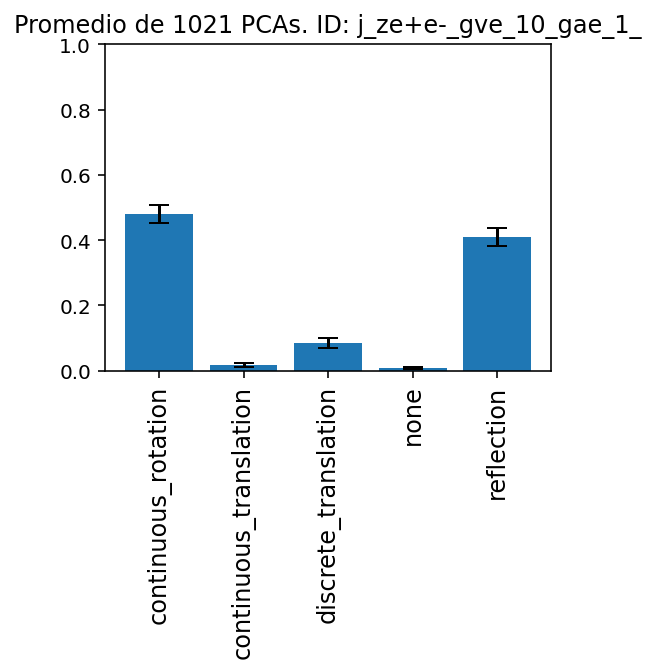

[0.49401511 0.01947896 0.13490249 0.00471702 0.34688643]


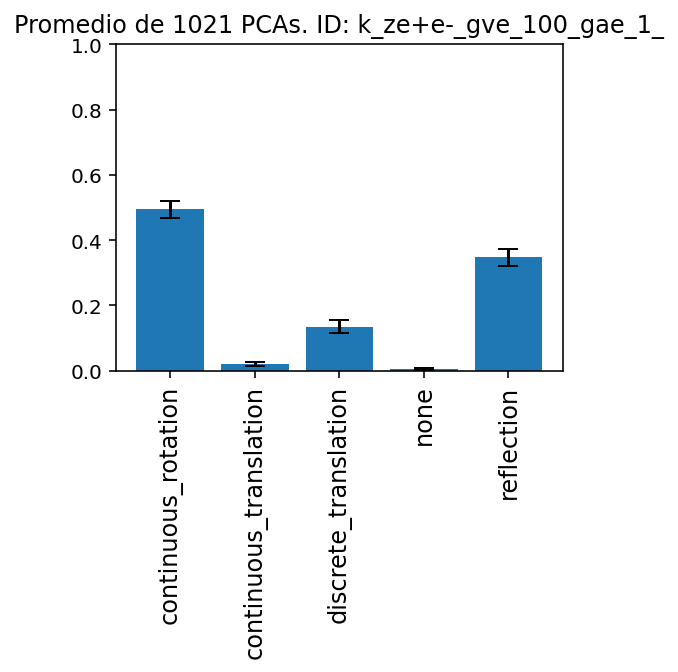

[0.48328195 0.01010543 0.07743995 0.00681686 0.4223558 ]


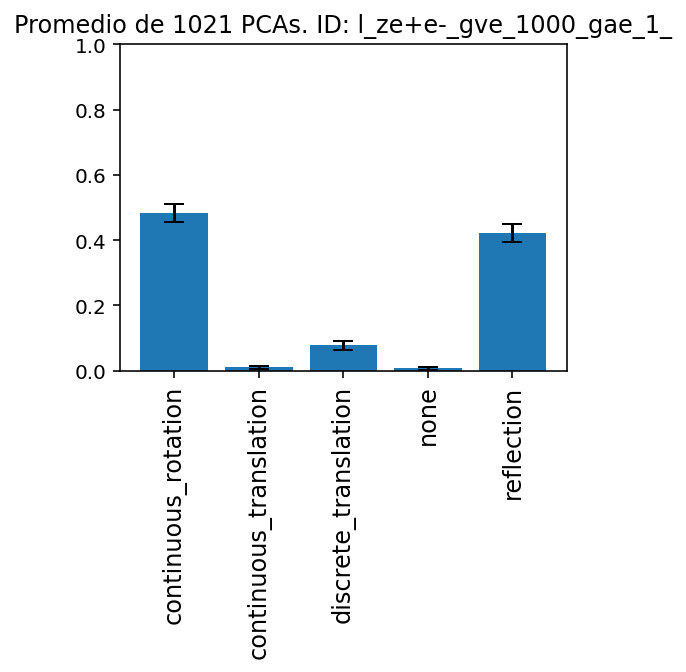

[0.46115857 0.02096733 0.08340245 0.00597214 0.42849951]


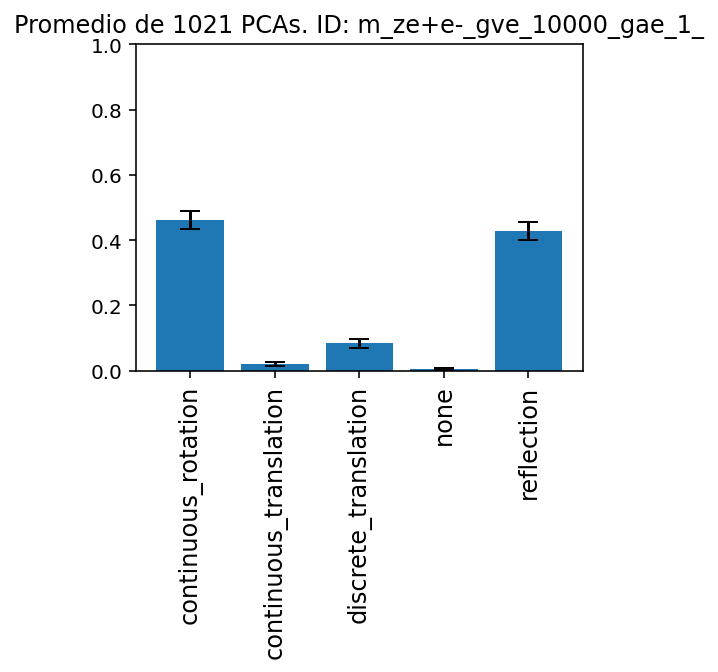

In [8]:
nom_carp = 'diff_sigma'

#import libraries
%config InlineBackend.figure_format = 'retina'
import seaborn as sns
from IPython.core.display import display, HTML, clear_output
display(HTML("<style>.container { width:100% !important; } div.cell.selected {border-left-width: 0px !important;}</style>"))

from time import time
import os
import glob
from fastai.vision.all import *
import numpy as np
from IPython.display import clear_output
import itertools as it
import more_itertools
#import torchvision.models
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.io as pio
pio.templates.default ="none"
import base64
from PIL import Image
from io import BytesIO
import torch
import gc
#import libraries

if not 'notebook_dir' in globals():
    notebook_dir = os.getcwd()
print('Notebook directory: ' + notebook_dir)
os.chdir(notebook_dir)  # If you changed the current working dir, this will take you back to the workbook dir.
top_dir = notebook_dir



modelo = 'G' # J or G

if modelo == 'G':
    #learn = load_learner('/home/gabriel/Desktop/models/model_93_accu_resnet18_10+5_none+reflection'+'.pkl', cpu=False)
    learn = load_learner('/home/gabriel/Desktop/models/model_90_accu_resnet18_one_cycle_10+5_no_mixup'+'.pkl', cpu=False)

if modelo == 'J':
    print('J')
        

#Reset Registro

columns = ['ID', 'Run'] + list(learn.dls.vocab)

registro = pd.DataFrame(columns = columns)
#registro


num_img_cat = [] #guardo el numero de imagenes de cada categoria
i = 0
plote = False

sims = pd.DataFrame(columns = learn.dls.vocab)
errs = sims.copy()

num_img_cat = [] #guardo el numero de imagenes de cada categoria
i = 0
plote = False

from IPython.utils import io


for dires in np.sort(Path('/home/gabriel/Desktop/Ze+e-_custom/' + nom_carp).ls()):
    #path = Path('/home/gabriel/Desktop/PCA_INE_sexo/INE/'+quitadas)
    quitadas = str(dires).split('/')[-1]
    with io.capture_output() as captured:
        for ima in dires.ls():

            test_im_dir = ima

            im = PILImage.create(test_im_dir)

            # Orden: ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']

            cate, num_cat, probs = learn.predict(im)


            '''
            if plote == True:
                plt.figure
                plt.figure(figsize=(4, 3))
                plt.title(ima)
                plt.bar(['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection'],probs)
                plt.xticks(rotation='vertical',fontsize = 12)
                plt.show()
            '''

            new_row = np.array([quitadas, i] + list(np.array(probs).astype(float))).reshape([1,-1])
            aden = pd.DataFrame(new_row,columns=registro.columns)

            registro = registro.append(aden, ignore_index=True)

            i+=1

    registro = registro.astype({'ID':str, 'Run':int,'continuous_rotation':float, 'continuous_translation':float, 'discrete_translation':float, 'none':float, 'reflection':float })  

    print('Numero Imagenes:',i,)
    num_img_cat.append(i)


print(registro['ID'].unique())

#registro = pd.read_csv('/home/gabriel/Desktop/PCA_INE_sexo/registro.csv')

nombres_carps = registro['ID'].unique() #Nombres de las carpetas donde estan guyardadas las pcas de un tipo
num_carps = len(nombres_carps)

#registro = pd.read_csv('/home/gabriel/Desktop/PCA_INE_sexo/registro.csv')


i = 0


for nom in np.sort(nombres_carps):
    if i == 0:
        m_probs = np.array(registro.iloc[:num_img_cat[0],2:].mean())
        err_probs = np.array(registro.iloc[:num_img_cat[0],2:].std())
        nume = str(len(registro.iloc[:num_img_cat[0],2:]))
        print(learn.dls.vocab)
        print(m_probs)
        sims = sims.append(pd.DataFrame([m_probs], columns = sims.columns),ignore_index = True)
        errs = errs.append(pd.DataFrame([err_probs/np.sqrt(float(nume))], columns = errs.columns),ignore_index = True)
    else:
        m_probs = np.array(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:].mean())
        err_probs = np.array(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:].std())
        nume = str(len(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:]))
        print(m_probs)
        sims = sims.append(pd.DataFrame([m_probs], columns = sims.columns),ignore_index = True)
        errs = errs.append(pd.DataFrame([err_probs/np.sqrt(float(nume))], columns = errs.columns),ignore_index = True)

    if nom == '-ninguna-':
        tit = 'Promedio de '+nume+' PCAs sin quitar ninguna columna'
    else:
        tit = 'Promedio de '+nume+' PCAs. ID: '+ nom        

    
    plt.figure(figsize=(4, 3))
    plt.title(tit)
    #plt.title('Promedio de '+str(40)+' PCAs sin quitar ninguna columna')
    plt.bar(columns[2:],
            m_probs,yerr = 2*err_probs/np.sqrt(float(nume)), capsize = 5)
    plt.xticks(rotation='vertical',fontsize = 12)
    plt.ylim([0, 1])
    plt.show()

    
    i+=1

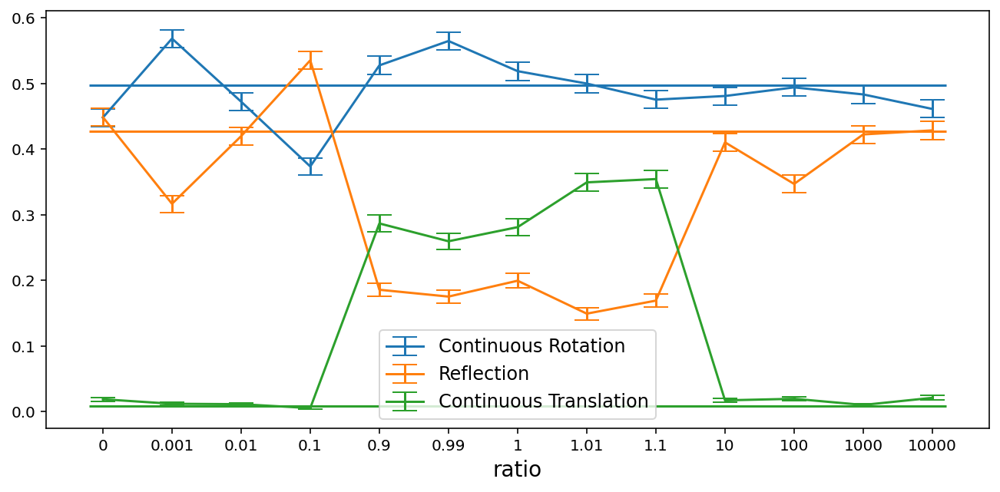

In [10]:
alfas = [0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]

#plt.errorbar(range(len(sims_0.reflection)),sims_0.reflection, yerr = errs_0.reflection,capsize = 8,label = 'Umbral: 0+')
#plt.errorbar(range(len(sims_4.reflection)),sims_4.reflection, yerr = errs_4.reflection,capsize = 8,label = 'Umbral: 4+')
#plt.errorbar(range(len(sims_10.reflection)),sims_10.reflection, yerr = errs_10.reflection,capsize = 8,label = 'Umbral: 10+')

#plt.errorbar(range(len(sims.reflection)),sims.reflection, yerr = errs.reflection,capsize = 8,label = 'Umbral: 4+')
#plt.errorbar(range(len(sims_0.none)),1-sims_0.none, yerr = errs_0.none,capsize = 8,label = 'Umbral: 0+')
#plt.errorbar(range(len(sims.none)),1-sims.none, yerr = errs.none,capsize = 8,label = 'Umbral: 4+, 1 $-$ none')
#plt.errorbar(range(len(sims.reflection)),sims.reflection, yerr = errs.reflection,capsize = 8,label = 'Umbral: 4+, reflection')
#plt.errorbar(range(len(sims_10.none)),1-sims_10.none, yerr = errs_10.none,capsize = 8,label = 'Umbral: 10+')

#lt.errorbar(range(len(sims.none)),sims.none, yerr = errs.none,capsize = 8,label = 'None')
plt.figure(figsize = [11,5])
#plt.errorbar(range(len(sims.none)),sims.none+sims.reflection, 
#             yerr = np.sqrt(errs.none**2 + errs.reflection**2),capsize = 8,label = 'Reflection + None')
plt.errorbar(range(len(sims.continuous_rotation)),sims.continuous_rotation, 
             yerr = errs.continuous_rotation,capsize = 8,label = 'Continuous Rotation')
plt.errorbar(range(len(sims.reflection)),sims.reflection, yerr = errs.reflection,capsize = 8,label = 'Reflection')
plt.errorbar(range(len(sims.continuous_translation)),sims.continuous_translation, 
             yerr = errs.continuous_translation,capsize = 8,label = 'Continuous Translation')
tik = plt.xticks(range(len(sims.reflection)),alfas)
plt.legend(fontsize = 12)
plt.xlabel('ratio',fontsize = 14)
#plt.ylim([0.5,1.01])
#plt.ylabel('Reflection')
target = 'diff_sigma_fit'    # Nombre de la variable que queremos predecir
nombre_carpeta = target # Nombre de la subcarpeta donde vamos a guardar las PCAs, dentro de la carpeta grande. Así podemos analizar al mismo tiempo varias bases de datos
folder = 'Ze+e-_custom'   # Carpeta donde se guardan las subcarpetas con las PCAs
folder_0 = 'cross_section_cos_theta_custom' # Carpeta donde están los eventos
#plt.title('Simetrías en Trabajo-Puesto HM_inv (AI)')

plt.hlines(0.496885,-0.2,12.2,colors = 'tab:blue') # Continuous Rotation
plt.hlines(0.427741,-0.2,12.2,colors = 'tab:orange') # Reflection
plt.hlines(0.008916,-0.2,12.2,colors = 'tab:green') # Continuous Translation

In [9]:
hist

array([   5,    5,   13,   24,   26,   40,   54,   52,   56,   94,  118,
        122,  134,  167,  174,  203,  213,  241,  245,  298,  268,  358,
        383,  411,  490,  462,  497,  561,  600,  630,  702,  674,  775,
        804,  809,  893,  927,  929, 1005, 1126, 1094, 1196, 1227, 1311,
       1332, 1437, 1459, 1542, 1589, 1688, 1672, 1823, 1881, 1967, 1982,
       2113, 2153, 2231, 2329, 2386])

In [12]:
df_e['diff_sigma'].iloc[np.where(df_e['inds'] == yyy)] 

5791     0.0
6248     0.0
15253    0.0
46352    0.0
47753    0.0
Name: diff_sigma, dtype: float64

# Work in progress

## Secure way:

It is about 20% slower but you can stop it at any time and you will have generated a uniform quantity of pcas. It loops over all the ratios rep_todo times, which is different from the faster way that generates rep_todo pcas for each ratio in order. 

In [ ]:
target = 'diff_sigma'    # Nombre de la variable que queremos predecir
nombre_carpeta = target # Nombre de la subcarpeta donde vamos a guardar las PCAs, dentro de la carpeta grande. Así podemos analizar al mismo tiempo varias bases de datos
folder = 'Ze+e-_custom_3'   # Carpeta donde se guardan las subcarpetas con las PCAs
folder_0 = 'cross_section_cos_theta_custom' # Carpeta donde están los eventos

n_fea = 13              # Número de features finales que el algoritmo escoge para hacer parejas y analizar con ellas la simetría

lim_sym = 0.7          # Límite de probabilidad para decidir que el algoritmo ha encontrado o no una simetría

limit_pairs = False      # Al generar parejas, estas vienen acompañadas de un 'score'. Si esto es True, cogmos solo la mitad de las con mayor 'score'

select_10k = True       # Keep only 10000 elements of the original potential DF (useful)

interact = False        # 'big', 'small', 'FW', False

rep_todo = 1300

num_bines = 60

plothist = False      #Plot the histogram of cos(theta)

# ----------------------------------- #

quantiles = True
range_cols = True   # Si quantiles == True, las columnas distintas de la target las escala entre -1 y 1.
ignore_list = ['Pz1','Pz2', 'E2', 's', 'cos_theta','inds','diff_sigma_fit']


rs = [0,0.001,0.01,0.1,0.5,0.9,1,1.1,2,10,100,1000,10000] #[0.1,0.5,0.6,0.7,0.8,0.9,1,1.1,1.2,1.3,1.4,10] 
ind_ord = [l for l in range(len(rs))]
gae_l = [1 for r in rs]
gve_l = [np.round(r,4) for r in rs]
    

# --------------------------------------#

i = 0 
from time import time
start_time = time()

syms_tot = ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
registro = pd.DataFrame(columns = syms_tot)
registros = []

num_g = len(gve_l)

for rtd in range(rep_todo):
    for  gve,gae,indo in zip(gve_l,gae_l,ind_ord):

        print('**** gv_e = {} **** ga_e = {} ****'.format(gve,gae))


        categ = []
        numer = []


        # --------------------------------------#


        # Read custom events

        name = 'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) + '.csv'

        df_e = pd.read_csv(os.path.join(folder_0,name))
        df_e = df_e.drop('diff_sigma', axis = 1)

        # Histogram of cos_theta
        hist, bin_edges = np.histogram(df_e.cos_theta,bins = num_bines, density = False)

        # Which bin does each event belong to
        inds = np.digitize(df_e.cos_theta,bin_edges[:-1])
        df_e['inds'] = inds-1

        # Assignment of differential cross section
        df_e['diff_sigma'] = np.zeros(len(df_e))

        for yyy in range(len(hist)):
            df_e['diff_sigma'].iloc[np.where(df_e['inds'] == yyy)] = hist[yyy]


        # Fitting to a 2nd degree polynomial
        if target == 'diff_sigma_fit':
            p = np.polyfit(df_e.cos_theta, df_e.diff_sigma/max(df_e.diff_sigma),2)
            diff_sigma_fit = np.polyval(p,df_e.cos_theta)
            df_e['diff_sigma_fit'] = diff_sigma_fit

        if plothist == True:
            plt.figure()
            plt.hist(df_e.cos_theta,bins = num_bines)
            plt.title('** gv_e = {} ; ga_e = {} **'.format(gve,gae))
            plt.show()

        for col in list(df_e.columns):
            if (col != target) and (col not in ignore_list):
                if type(df_e[col][0]) == str:
                    categ.append(col)
                else:
                    numer.append(col)

        splits = RandomSplitter(valid_pct=0)(range_of(df_e))

        to = TabularPandas(df_e,
                        procs=[Categorify,FillMissing],
                        cat_names = categ,
                        cont_names = numer,
                        y_names = target,
                        splits=splits)


        #equiv_CNACE = pd.DataFrame({'Cod_Num':list(to.xs['CNACE'].unique()),'Categ':list(dls.dsets['CNACE'].unique())}).sort_values(by = 'Categ')
        #equiv_CNO1 = pd.DataFrame({'Cod_Num':list(to.xs['CNO1'].unique()),'Categ':list(dls.dsets['CNO1'].unique())}).sort_values(by = 'Categ')

        df_e = pd.DataFrame(to.xs)
        df_e[target] = to.y
        df_e = df_e.reset_index().drop('index', axis = 1)  

        for col in df_e.columns:
            df_e[col] = np.nan_to_num(df_e[col])   
            if quantiles == True:
                n_attempted_bins =  len(df_e[col])
                binning = pd.qcut(df_e[col], q=n_attempted_bins, retbins=True, labels=False, duplicates='drop')
                df_e[col]=binning[0]/np.max(binning[0])
                df_e[col] = np.nan_to_num(df_e[col])
                if (range_cols == True) and (col != target): 
                    df_e[col] = df_e[col]*2 - 1




        # ------------------------------------------------------------------------------------------------------------------------#


        sym_feat_1 = []
        sym_feat_2 = []
        sym_feat_tags = []
        sym_feat_probs = []
        sym_feat_rmse = []
        syms_tot = ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
        # Tiempo en el que empezamos a procesar
        from time import time



        from fastai.vision.all import *
        from time import time
        from IPython.utils import io



        muchos = False # Si es false, para muchos potenciales, mete cada combinación de variables en una carpeta separada, para que sea fácil ver si hay simetría ahí
                       # Si es true, van todos a la misma carpeta


        # ------------------- Folder PCA ------------------- #


        dd = top_dir + '/' + folder
        if not os.path.isdir(dd):
            print('Creating directory:\n',dd)
            os.mkdir(dd)

        dir = os.path.join(top_dir,folder)


        #------------------------------ Generar Potenciales ---------------------------#

        potenciales = [df_e]
        potenciales_tags = [nombre_carpeta for k in range(rep_todo)]
        tags = potenciales_tags
        num_pot = len(potenciales)

        # ------------------- No prints al guardar mejor modelo (fastai) ------------------- # 
        # Solo hay un print que se ha eliminado del código original
        class SaveModelCallback(TrackerCallback):
            "A `TrackerCallback` that saves the model's best during training and loads it at the end."
            _only_train_loop = True
            def __init__(self, monitor='valid_loss', comp=None, min_delta=0., fname='model', every_epoch=False, at_end=False,
                         with_opt=False, reset_on_fit=True):
                super().__init__(monitor=monitor, comp=comp, min_delta=min_delta, reset_on_fit=reset_on_fit)
                assert not (every_epoch and at_end), "every_epoch and at_end cannot both be set to True"
                # keep track of file path for loggers
                self.last_saved_path = None
                store_attr('fname,every_epoch,at_end,with_opt')

            def _save(self, name): self.last_saved_path = self.learn.save(name, with_opt=self.with_opt)

            def after_epoch(self):
                "Compare the value monitored to its best score and save if best."
                if self.every_epoch: self._save(f'{self.fname}_{self.epoch}')
                else: #every improvement
                    super().after_epoch()
                    if self.new_best:
                        #print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
                        self._save(f'{self.fname}')

            def after_fit(self, **kwargs):
                "Load the best model."
                if self.at_end: self._save(f'{self.fname}')
                elif not self.every_epoch: self.learn.load(f'{self.fname}', with_opt=self.with_opt)

        # ---------------- Definiciones previas e hiperparámetros ----------------- #

        #Guardo los modelos para analizarlos luego
        models = [] 
        to_s = []

        #Guardaremos los resultados de la PCA en un array 
        PCA_s = []
        PCA_s_tag = []

        # Hyperparameters: 
        bs_choices = [50000]       # Batch Size
        shape='pipe'               # Shape of the neural network
        layers_choices = [5]       # Number of layers of the net. Default:10 or 5 results with 5
        neurons_choices = [200]    # Number of neurons per layer. Default:200 results with 200
        epoch_choices = [50]      # Number of training epochs. Default:200 results with 100
        lr_choices = [0.01]       # Max learning rate 
        valid_pct=0.2              # Part of the data that goes into validation (0.2 = 20%)
        monitor= 'valid_loss'        # Te model with the least 'monitor' will be saved



        # ---------------------- Entrenar Red Y PCA -----------------------------------#

        j = 1 # Usaremos esto para saber cuantos potenciales hemos procesado, y como indice en general


        for df in potenciales:


            df[target] = df[target]/np.max(df[target]) #Normalizar la columna objetivo es importante

            #------------------------------ Feature Importance  ---------------------------#

            if select_10k == True:
                if len(df[target]) <= 100*100:
                    print('Too little data to keep 10k points and delete the rest')
                else:
                    print('Keeping 10k points of the original DF')
                    remove_n = len(df[target]) - 10000
                    drop_indices = np.random.choice(df.index, remove_n, replace=False)
                    df_temp = df.drop(drop_indices)
                    df = df_temp.copy()



            if interact == 'big':
                print('---- Big interactions ----')
                bbb = df[target]
                df = df.drop(target,axis = 1)
                df = my_interactions(df, numo_int = 10, verbose = True)
                df[target] = bbb

            elif interact == 'small':
                print('---- Small interactions ----')
                bbb = df[target]
                df = df.drop(target,axis = 1)
                df = my_interactions_small(df, numo_int = 10, verbose = True)
                df[target] = bbb

            elif interact == 'FW':
                print('---- Interactions by featurewiz ----')
                with io.capture_output() as captured2: output = featurewiz(df, target, corr_limit=0.10,
                                                                verbose=0, sep=',', header=0, test_data='',
                                                                category_encoders='',feature_engg='interactions')   
                df = output[1].copy()

            elif interact == False:
                print('No interactions')


            #df = regularize_df(df)

            print('---Selecting Best Features---')
            best_pairs = n_best_rf_phi_k(df, target = target, n = n_fea, nf = 30, lim_corr = 0.85)

            best_n = [best_pairs['f1'][0]] + list(best_pairs['f2'].unique())

            print('Best Features: ',best_n)

            #small_df = df[best_n]
            #small_df[target] = df[target]


            cols = best_n
            a = cols

            verbose = 1



            df_org = df.copy()

            if limit_pairs == True:
                medi = best_pairs.score.median()
                num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
            else:
                medi = 0
                num_2 = len(best_pairs.score.iloc[np.where(best_pairs.score >= medi)])
                #num_2 = 1

            for f1,f2,lll in zip(best_pairs.f1,best_pairs.f2,range(len(best_pairs.f1))):
                if best_pairs.score[lll] >= medi:

                    i+=1

                    print(f1,f2)
                    feas = [f1,f2]

                    # Debemos marcar cada potencial para tener claro a qué tipo de simetria corresponde cada PCA
                    PCA_s_tag.append(tags[j-1])

                    df2 = df[feas + [target]].copy() 
                    #df2 = df2[feas + [target]].copy()

                    #Normlizamos las features y hacemos que vayan entre -1 y 1
                    df2[f1] = 2*(df2[f1]/np.max(df2[f1]))-1
                    df2[f2] = 2*(df2[f2]/np.max(df2[f2]))-1

                    splits = RandomSplitter(valid_pct=valid_pct)(range_of(df2))

                    to = TabularPandas(df2,
                                    procs=[Categorify,FillMissing, Normalize],
                                    cont_names = feas,
                                    y_names = target,
                                    splits=splits)

                    train_size = len(splits[0])
                    valid_size = len(splits[1])

                    # ----------------- Hyperparameters ------------------- #

                    # Batch Size (a large one)
                    bs=min(random.choice(bs_choices),train_size)  
                    print('{} batch size for training.\n'.format(bs))

                    # Neurons per layer
                    neurons_per_layer = random.choice(neurons_choices)

                    # Number of layers
                    n_layers = random.choice(layers_choices)

                    #Shape of the net: Pipe or funnel
                    if shape == 'pipe':
                        layers=[neurons_per_layer for i in range(n_layers)]

                    if shape == 'funnel':
                        n_eff = n_layers
                        layers = np.clip(sum([[2**(n_layers-i+2)] for i in range(0,n_layers,1)],[]),2,neurons_per_layer).tolist()

                    print('Training FCNN with layers: ',layers)

                    #Number of epochs
                    n_epoch=random.choice(epoch_choices)
                    print('Training for {} epochs.'.format(n_epoch))

                    # Maximum Learning Rate: (a good value can be found using learn.lr_find())
                    lr_max=float(random.choice(lr_choices))
                    print('Using lr_max = ',format(lr_max))

                    # ----------------------------------------------------- #

                    # --------------- Training the FCNN --------------------#

                    # Load the data into a DataLoader
                    dls = to.dataloaders(bs=bs)

                    # Define a Tabular Learner
                    learn = tabular_learner(dls, layers=layers
                                        #,config=config
                                        #,metrics=[mse],
                                        #y_range = [min(df.bin),max(df.bin)],
                                        #,cbs=ShowGraphCallback()
                                        #,train_bn=False)
                                        )

                    # Train the net 
                    with learn.no_logging():
                        learn.fit_one_cycle(n_epoch=n_epoch
                                            ,lr_max=lr_max
                                            ,cbs=[SaveModelCallback(monitor=monitor)]
                                            )

                        preds, targs = learn.get_preds()

                    ff = (preds-targs)**2/len(targs)
                    ff = sum(ff)
                    RMSE = np.sqrt(ff)
                    #print('RMSE:',float(RMSE))
                    nrmsei = float(RMSE)/(max(np.array(targs).flatten()-min(np.array(targs).flatten())))

                    # Guardamos modelos y tabular objects para el posterior analisis
                    models.append(learn)
                    to_s.append(to)

                    # ------------------------------------------------------#


                    # ------------------------- PCA ------------------------#

                    test_df = df2.copy()
                    dl = learn.dls.test_dl(test_df,bs=int(test_df.shape[0])) 

                    # Tenemos que hacer un Hook, una especie de gancho que enganchamos en la última capa interna,
                    # para guardar, de cada modelo, los valores de los parámetro de dicha capa. 
                    with Hooks(learn.model.layers, lambda m,i,o: o) as h:
                        preds = learn.get_preds(dl=dl,with_input=True,with_decoded=True,with_loss=True)

                    targets=preds[2].numpy().flatten()

                    # Cogemos la información de la penúltima capa
                    # OJO: Si añadimos y_range, se añade automaticamente una sigmoid
                    # al final, por lo que tendríamos que coger la capa -3 en vez de la -2
                    act = h.stored[-2] 
                    multi_dim=Tensor.cpu(act).numpy()
                    standardized=StandardScaler().fit_transform(multi_dim)

                    viz = PCA(2).fit_transform(np.nan_to_num(standardized))
                    #plt.figure()
                    #plt.scatter(viz[:, 0], viz[:, 1],c=targets[:multi_dim.shape[0]],alpha=.1, marker = 'o')

                    PCA_s.append(viz)

                    # ------------------------------------------------------ #

                    # ------------------ Saving the PCA's ------------------ #

                    # ---- Dar formato a PCA para guardar como imagen con color

                    viz = pd.DataFrame(viz) #Transformamos la PCA en un dataframe
                    viz.columns = ['x','y'] #Nombres de las columnas

                    # Insertamos una columna con los colores de los puntos. El valor del potencial
                    # objetivo (targets) es el color, y hay un color por cada punto 
                    viz.insert(2,'class',targets[:multi_dim.shape[0]]) 

                    # ---- Personalizar mapa de color 

                    n_classes=1000

                    colors = 'rainbow'

                    if colors == 'rainbow':
                        my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                        classes_in_rgb = my_cmap(range(n_classes))
                    if colors == 'purple':
                        my_cmap = plt.cm.get_cmap('rainbow', n_classes)
                        classes_in_rgb = np.vstack((np.array([0,0,0,0]),my_cmap([0 for i in range(n_classes)])))

                    # ---- Hacer que la intensidad del pixel represente la cantidad de puntos 
                    #      acumuldos en un pixel

                    n_pixels = 224

                    binning_3d=np.histogramdd([viz['x'],viz['y'],viz['class']],range=(None,None,(0,1)), bins=(n_pixels,n_pixels,n_classes))

                    #if we want the pixel intensity to reprensent the number of points at that location
                    array = np.dot(binning_3d[0],classes_in_rgb)
                    array = array/np.amax(array)

                    # ---- Guardar la PCA

                    #Directorio donde guardaremos las imagenes
                    nami = str(chr(97 + indo))+'_'+'ze+e-_gve_' + str(gve) + '_gae_' + str(gae) +'_'
                    if muchos == False: 
                        dir_sym = os.path.join(dir,tags[j-1],nami)
                        img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+'__PCA.png' 
                    else:
                        dir_sym = os.path.join(dir,tags[j-1])
                        img_file = str(tags[j-1])+'_'+str(j)+str(round(time()))+nami+'__PCA.png' 

                    if not os.path.isdir(dir_sym):
                        print('Creating directory:\n',dir_sym)
                        os.makedirs(dir_sym)


                    # Nombre de la imagen. Pongo el tiempo para que todas se llamen distinto cada vez.
                    output_dir = os.path.join(dir_sym,img_file) # Directorio donde guardamos la imagen
                    plt.imsave(output_dir,array) # Guardar
                    print('\nPCA saved to:\n{}\n'.format(dir_sym+'/'+img_file))


                    # ------------------------ Symmetry Analyzer --------------------- #
                    drr = pca_sym_finder(output_dir)
                    brr = list(drr.iloc[np.where(drr.value > lim_sym)].symmetry)
                    if len(brr) > 0:
                        print('Found {} symmetry with features {} and {}, with prob. {}'.format(brr[0],f1,f2,float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4))))                
                        sym_feat_1.append(f1)
                        sym_feat_2.append(f2)
                        sym_feat_tags.append(brr[0])
                        sym_feat_probs.append(float(np.round(drr.iloc[np.where(drr.value > lim_sym)].value,4)))
                        sym_feat_rmse.append(nrmsei)




                    # ------------------------ Time -------------------------#

                    minutes_until_now = (time() - start_time)/60
                    images_done = i
                    minutes_per_image = minutes_until_now/(images_done)
                    hours_left = minutes_per_image * (num_pot*rep_todo*num_2*num_g-images_done)/60
                    print("\n{} PCA's made out of {}.\n".format(images_done,num_pot*num_2*rep_todo*num_g))
                    print("{:.1f} minutes elapsed for {} images.".format(minutes_until_now,images_done))
                    print("{:.1f} seconds average per image.".format(60*minutes_until_now/images_done))
                    print("{:.1f} minutes estimated left for {} images.\n\n\n".format(hours_left*60,num_pot*num_2*rep_todo*num_g-images_done))
                    print("{:.1f} hours estimated left for {} images.\n\n\n".format(hours_left,num_pot*num_2*rep_todo*num_g-images_done))




        j+=1


              # ------------------------------------------------------#'''

    results = pd.DataFrame({'symmetry':sym_feat_tags, 'feature_1':sym_feat_1, 'feature_2':sym_feat_2, 'probability':sym_feat_probs, 'NRMSE':sym_feat_rmse})

    vc = results.symmetry.value_counts()



    for sym_sum in syms_tot:
        if not hasattr(vc,sym_sum):
            vc[sym_sum] = 0


    nr = pd.DataFrame({'continuous_rotation':vc['continuous_rotation'], 
                       'continuous_translation':vc['continuous_translation'], 
                       'discrete_translation':vc['discrete_translation'], 
                       'none':vc['none'], 
                       'reflection':vc['reflection']}, index = [0])

    registro = registro.append(nr, ignore_index=True)
    

    registros.append(nr)

'''
    plt.xticks(rotation = -15)
    plt.ylim([0,1])
    print(registro.columns)
    print(registro.sum()/registro.sum().sum())
    plt.bar(registro.columns,registro.sum()/registro.sum().sum(), yerr = np.sqrt(registro.sum())/registro.sum().sum(), capsize = 8)

'''
print(0)

**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614308__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9886000156402588

1 PCA's made out of 16900.

0.1 minutes elapsed for 1 images.
6.4 seconds average per image.
1807.3 minutes estimated left for 16899 images.



30.1 hours estimated left for 16899 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614312__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8181999921798706

2 PCA's made out of 16900.

0.2 minutes elapsed for 2 images.
5.5 seconds average per image.
1553.6 minutes estimated left for 16898 images.



25.9 hours estimated left for 16898 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614316__PCA.png




3 PCA's made out of 16900.

0.2 minutes elapsed for 3 images.
5.0 seconds average per image.
1402.8 minutes estimated left for 16897 images.



23.4 hours estimated left for 16897 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614320__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9889000058174133

4 PCA's made out of 16900.

0.3 minutes elapsed for 4 images.
4.8 seconds average per image.
1338.2 minutes estimated left for 16896 images.



22.3 hours estimated left for 16896 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614324__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5 PCA's made out of 16900.

0.4 minutes elapsed for 5 images.
4.7 seconds average per image.
1311.7 minutes estimated left for 16895 images.



21.9 hours estimated left for 16895 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614329__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8432000279426575

6 PCA's made out of 16900.

0.5 minutes elapsed for 6 images.
4.6 seconds average per image.
1284.3 minutes estimated left for 16894 images.



21.4 hours estimated left for 16894 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614333__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8654000163078308

7 PCA's made out of 16900.

0.5 minutes elapsed for 7 images.
4.5 seconds average per image.
1260.1 minutes estimated left for 16893 images.



21.0 hours estimated left for 16893 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614337__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9559999704360962

8 PCA's made out of 16900.

0.6 minutes elapsed for 8 images.
4.4 seconds average per image.
1245.6 minutes estimated left for 16892 images.



20.8 hours estimated left for 16892 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614341__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9916999936103821

9 PCA's made out of 16900.

0.7 minutes elapsed for 9 images.
4.4 seconds average per image.
1233.3 minutes estimated left for 16891 images.



20.6 hours estimated left for 16891 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614345__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8090000152587891

10 PCA's made out of 16900.

0.7 minutes elapsed for 10 images.
4.4 seconds average per image.
1224.7 minutes estimated left for 16890 images.



20.4 hours estimated left for 16890 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640614349__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8428999781608582

11 PCA's made out of 16900.

0.8 minutes elapsed for 11 images.
4.3 seconds average per image.
1214.6 minutes estimated left for 16889 images.



20.2 hours estimated left for 16889 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640614353__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994000196456909

12 PCA's made out of 16900.

0.9 minutes elapsed for 12 images.
4.3 seconds average per image.
1208.9 minutes estimated left for 16888 images.



20.1 hours estimated left for 16888 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640614357__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

13 PCA's made out of 16900.

0.9 minutes elapsed for 13 images.
4.3 seconds average per image.
1200.9 minutes estimated left for 16887 images.



20.0 hours estimated left for 16887 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614361__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9894999861717224

14 PCA's made out of 16900.

1.0 minutes elapsed for 14 images.
4.3 seconds average per image.
1197.9 minutes estimated left for 16886 images.



20.0 hours estimated left for 16886 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614365__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

15 PCA's made out of 16900.

1.1 minutes elapsed for 15 images.
4.2 seconds average per image.
1194.0 minutes estimated left for 16885 images.



19.9 hours estimated left for 16885 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614369__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9772999882698059

16 PCA's made out of 16900.

1.1 minutes elapsed for 16 images.
4.2 seconds average per image.
1190.0 minutes estimated left for 16884 images.



19.8 hours estimated left for 16884 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614373__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9842000007629395

17 PCA's made out of 16900.

1.2 minutes elapsed for 17 images.
4.2 seconds average per image.
1186.5 minutes estimated left for 16883 images.



19.8 hours estimated left for 16883 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614377__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8974000215530396

18 PCA's made out of 16900.

1.3 minutes elapsed for 18 images.
4.2 seconds average per image.
1185.2 minutes estimated left for 16882 images.



19.8 hours estimated left for 16882 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614381__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

19 PCA's made out of 16900.

1.3 minutes elapsed for 19 images.
4.2 seconds average per image.
1183.8 minutes estimated left for 16881 images.



19.7 hours estimated left for 16881 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614385__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9789999723434448

20 PCA's made out of 16900.

1.4 minutes elapsed for 20 images.
4.2 seconds average per image.
1180.5 minutes estimated left for 16880 images.



19.7 hours estimated left for 16880 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614389__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.977400004863739

21 PCA's made out of 16900.

1.5 minutes elapsed for 21 images.
4.2 seconds average per image.
1178.8 minutes estimated left for 16879 images.



19.6 hours estimated left for 16879 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614393__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9300000071525574

22 PCA's made out of 16900.

1.5 minutes elapsed for 22 images.
4.2 seconds average per image.
1178.4 minutes estimated left for 16878 images.



19.6 hours estimated left for 16878 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614397__PCA.png




23 PCA's made out of 16900.

1.6 minutes elapsed for 23 images.
4.2 seconds average per image.
1176.1 minutes estimated left for 16877 images.



19.6 hours estimated left for 16877 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640614401__PCA.png




24 PCA's made out of 16900.

1.7 minutes elapsed for 24 images.
4.2 seconds average per image.
1174.3 minutes estimated left for 16876 images.



19.6 hours estimated left for 16876 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640614405__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9013000130653381

25 PCA's made out of 16900.

1.7 minutes elapsed for 25 images.
4.2 seconds average per image.
1173.5 minutes estimated left for 16875 images.



19.6 hours estimated left for 16875 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640614410__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

26 PCA's made out of 16900.

1.8 minutes elapsed for 26 images.
4.2 seconds average per image.
1172.7 minutes estimated left for 16874 images.



19.5 hours estimated left for 16874 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614414__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9882000088691711

27 PCA's made out of 16900.

1.9 minutes elapsed for 27 images.
4.2 seconds average per image.
1172.3 minutes estimated left for 16873 images.



19.5 hours estimated left for 16873 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614418__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980999827384949

28 PCA's made out of 16900.

1.9 minutes elapsed for 28 images.
4.2 seconds average per image.
1171.2 minutes estimated left for 16872 images.



19.5 hours estimated left for 16872 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614422__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9901999831199646

29 PCA's made out of 16900.

2.0 minutes elapsed for 29 images.
4.2 seconds average per image.
1170.6 minutes estimated left for 16871 images.



19.5 hours estimated left for 16871 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614426__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9399999976158142

30 PCA's made out of 16900.

2.1 minutes elapsed for 30 images.
4.2 seconds average per image.
1169.7 minutes estimated left for 16870 images.



19.5 hours estimated left for 16870 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614430__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

31 PCA's made out of 16900.

2.1 minutes elapsed for 31 images.
4.2 seconds average per image.
1168.9 minutes estimated left for 16869 images.



19.5 hours estimated left for 16869 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614434__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9900000095367432

32 PCA's made out of 16900.

2.2 minutes elapsed for 32 images.
4.2 seconds average per image.
1169.6 minutes estimated left for 16868 images.



19.5 hours estimated left for 16868 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614439__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

33 PCA's made out of 16900.

2.3 minutes elapsed for 33 images.
4.2 seconds average per image.
1170.8 minutes estimated left for 16867 images.



19.5 hours estimated left for 16867 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614443__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9147999882698059

34 PCA's made out of 16900.

2.4 minutes elapsed for 34 images.
4.2 seconds average per image.
1171.1 minutes estimated left for 16866 images.



19.5 hours estimated left for 16866 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614447__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9945999979972839

35 PCA's made out of 16900.

2.4 minutes elapsed for 35 images.
4.2 seconds average per image.
1170.6 minutes estimated left for 16865 images.



19.5 hours estimated left for 16865 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614451__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8995000123977661

36 PCA's made out of 16900.

2.5 minutes elapsed for 36 images.
4.2 seconds average per image.
1170.7 minutes estimated left for 16864 images.



19.5 hours estimated left for 16864 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640614455__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8952999711036682

37 PCA's made out of 16900.

2.6 minutes elapsed for 37 images.
4.2 seconds average per image.
1170.0 minutes estimated left for 16863 images.



19.5 hours estimated left for 16863 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640614459__PCA.png




38 PCA's made out of 16900.

2.6 minutes elapsed for 38 images.
4.2 seconds average per image.
1169.2 minutes estimated left for 16862 images.



19.5 hours estimated left for 16862 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640614463__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9776999950408936

39 PCA's made out of 16900.

2.7 minutes elapsed for 39 images.
4.2 seconds average per image.
1169.4 minutes estimated left for 16861 images.



19.5 hours estimated left for 16861 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614468__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9772999882698059

40 PCA's made out of 16900.

2.8 minutes elapsed for 40 images.
4.2 seconds average per image.
1169.7 minutes estimated left for 16860 images.



19.5 hours estimated left for 16860 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614472__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

41 PCA's made out of 16900.

2.8 minutes elapsed for 41 images.
4.2 seconds average per image.
1169.0 minutes estimated left for 16859 images.



19.5 hours estimated left for 16859 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614476__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9848999977111816

42 PCA's made out of 16900.

2.9 minutes elapsed for 42 images.
4.2 seconds average per image.
1169.1 minutes estimated left for 16858 images.



19.5 hours estimated left for 16858 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614480__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7351999878883362

43 PCA's made out of 16900.

3.0 minutes elapsed for 43 images.
4.2 seconds average per image.
1169.8 minutes estimated left for 16857 images.



19.5 hours estimated left for 16857 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614484__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9966999888420105

44 PCA's made out of 16900.

3.1 minutes elapsed for 44 images.
4.2 seconds average per image.
1169.6 minutes estimated left for 16856 images.



19.5 hours estimated left for 16856 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614489__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8641999959945679

45 PCA's made out of 16900.

3.1 minutes elapsed for 45 images.
4.2 seconds average per image.
1169.8 minutes estimated left for 16855 images.



19.5 hours estimated left for 16855 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614493__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

46 PCA's made out of 16900.

3.2 minutes elapsed for 46 images.
4.2 seconds average per image.
1169.3 minutes estimated left for 16854 images.



19.5 hours estimated left for 16854 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614497__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7185999751091003

47 PCA's made out of 16900.

3.3 minutes elapsed for 47 images.
4.2 seconds average per image.
1168.7 minutes estimated left for 16853 images.



19.5 hours estimated left for 16853 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614501__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994999766349792

48 PCA's made out of 16900.

3.3 minutes elapsed for 48 images.
4.2 seconds average per image.
1168.3 minutes estimated left for 16852 images.



19.5 hours estimated left for 16852 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614505__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7694000005722046

49 PCA's made out of 16900.

3.4 minutes elapsed for 49 images.
4.2 seconds average per image.
1168.9 minutes estimated left for 16851 images.



19.5 hours estimated left for 16851 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640614509__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.816100001335144

50 PCA's made out of 16900.

3.5 minutes elapsed for 50 images.
4.2 seconds average per image.
1169.5 minutes estimated left for 16850 images.



19.5 hours estimated left for 16850 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640614514__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7186999917030334

51 PCA's made out of 16900.

3.5 minutes elapsed for 51 images.
4.2 seconds average per image.
1170.4 minutes estimated left for 16849 images.



19.5 hours estimated left for 16849 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640614518__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980999827384949

52 PCA's made out of 16900.

3.6 minutes elapsed for 52 images.
4.2 seconds average per image.
1170.5 minutes estimated left for 16848 images.



19.5 hours estimated left for 16848 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614522__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

53 PCA's made out of 16900.

3.7 minutes elapsed for 53 images.
4.2 seconds average per image.
1170.5 minutes estimated left for 16847 images.



19.5 hours estimated left for 16847 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614526__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9922000169754028

54 PCA's made out of 16900.

3.8 minutes elapsed for 54 images.
4.2 seconds average per image.
1170.2 minutes estimated left for 16846 images.



19.5 hours estimated left for 16846 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614531__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8248999714851379

55 PCA's made out of 16900.

3.8 minutes elapsed for 55 images.
4.2 seconds average per image.
1170.5 minutes estimated left for 16845 images.



19.5 hours estimated left for 16845 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614535__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

56 PCA's made out of 16900.

3.9 minutes elapsed for 56 images.
4.2 seconds average per image.
1171.2 minutes estimated left for 16844 images.



19.5 hours estimated left for 16844 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614539__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8281999826431274

57 PCA's made out of 16900.

4.0 minutes elapsed for 57 images.
4.2 seconds average per image.
1171.1 minutes estimated left for 16843 images.



19.5 hours estimated left for 16843 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614543__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.803600013256073

58 PCA's made out of 16900.

4.0 minutes elapsed for 58 images.
4.2 seconds average per image.
1171.1 minutes estimated left for 16842 images.



19.5 hours estimated left for 16842 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614547__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7867000102996826

59 PCA's made out of 16900.

4.1 minutes elapsed for 59 images.
4.2 seconds average per image.
1170.7 minutes estimated left for 16841 images.



19.5 hours estimated left for 16841 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614551__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

60 PCA's made out of 16900.

4.2 minutes elapsed for 60 images.
4.2 seconds average per image.
1170.3 minutes estimated left for 16840 images.



19.5 hours estimated left for 16840 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614555__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.791100025177002

61 PCA's made out of 16900.

4.2 minutes elapsed for 61 images.
4.2 seconds average per image.
1169.9 minutes estimated left for 16839 images.



19.5 hours estimated left for 16839 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614560__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

62 PCA's made out of 16900.

4.3 minutes elapsed for 62 images.
4.2 seconds average per image.
1170.1 minutes estimated left for 16838 images.



19.5 hours estimated left for 16838 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640614564__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8482999801635742

63 PCA's made out of 16900.

4.4 minutes elapsed for 63 images.
4.2 seconds average per image.
1170.3 minutes estimated left for 16837 images.



19.5 hours estimated left for 16837 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640614568__PCA.png




64 PCA's made out of 16900.

4.5 minutes elapsed for 64 images.
4.2 seconds average per image.
1170.9 minutes estimated left for 16836 images.



19.5 hours estimated left for 16836 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640614572__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9866999983787537

65 PCA's made out of 16900.

4.5 minutes elapsed for 65 images.
4.2 seconds average per image.
1170.5 minutes estimated left for 16835 images.



19.5 hours estimated left for 16835 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614577__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9682000279426575

66 PCA's made out of 16900.

4.6 minutes elapsed for 66 images.
4.2 seconds average per image.
1170.6 minutes estimated left for 16834 images.



19.5 hours estimated left for 16834 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614581__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8537999987602234

67 PCA's made out of 16900.

4.7 minutes elapsed for 67 images.
4.2 seconds average per image.
1170.8 minutes estimated left for 16833 images.



19.5 hours estimated left for 16833 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614585__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.992900013923645

68 PCA's made out of 16900.

4.7 minutes elapsed for 68 images.
4.2 seconds average per image.
1171.0 minutes estimated left for 16832 images.



19.5 hours estimated left for 16832 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614589__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9854999780654907

69 PCA's made out of 16900.

4.8 minutes elapsed for 69 images.
4.2 seconds average per image.
1170.8 minutes estimated left for 16831 images.



19.5 hours estimated left for 16831 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614593__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

70 PCA's made out of 16900.

4.9 minutes elapsed for 70 images.
4.2 seconds average per image.
1171.0 minutes estimated left for 16830 images.



19.5 hours estimated left for 16830 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614598__PCA.png




71 PCA's made out of 16900.

4.9 minutes elapsed for 71 images.
4.2 seconds average per image.
1170.8 minutes estimated left for 16829 images.



19.5 hours estimated left for 16829 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614602__PCA.png




72 PCA's made out of 16900.

5.0 minutes elapsed for 72 images.
4.2 seconds average per image.
1171.5 minutes estimated left for 16828 images.



19.5 hours estimated left for 16828 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614606__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980999827384949

73 PCA's made out of 16900.

5.1 minutes elapsed for 73 images.
4.2 seconds average per image.
1171.5 minutes estimated left for 16827 images.



19.5 hours estimated left for 16827 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614610__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9965000152587891

74 PCA's made out of 16900.

5.2 minutes elapsed for 74 images.
4.2 seconds average per image.
1171.2 minutes estimated left for 16826 images.



19.5 hours estimated left for 16826 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614614__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

75 PCA's made out of 16900.

5.2 minutes elapsed for 75 images.
4.2 seconds average per image.
1170.9 minutes estimated left for 16825 images.



19.5 hours estimated left for 16825 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640614619__PCA.png




76 PCA's made out of 16900.

5.3 minutes elapsed for 76 images.
4.2 seconds average per image.
1170.8 minutes estimated left for 16824 images.



19.5 hours estimated left for 16824 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640614623__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9478999972343445

77 PCA's made out of 16900.

5.4 minutes elapsed for 77 images.
4.2 seconds average per image.
1171.7 minutes estimated left for 16823 images.



19.5 hours estimated left for 16823 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640614627__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.791700005531311

78 PCA's made out of 16900.

5.4 minutes elapsed for 78 images.
4.2 seconds average per image.
1171.1 minutes estimated left for 16822 images.



19.5 hours estimated left for 16822 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614631__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

79 PCA's made out of 16900.

5.5 minutes elapsed for 79 images.
4.2 seconds average per image.
1171.1 minutes estimated left for 16821 images.



19.5 hours estimated left for 16821 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614635__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

80 PCA's made out of 16900.

5.6 minutes elapsed for 80 images.
4.2 seconds average per image.
1171.1 minutes estimated left for 16820 images.



19.5 hours estimated left for 16820 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614639__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7373999953269958

81 PCA's made out of 16900.

5.6 minutes elapsed for 81 images.
4.2 seconds average per image.
1170.7 minutes estimated left for 16819 images.



19.5 hours estimated left for 16819 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614644__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9007999897003174

82 PCA's made out of 16900.

5.7 minutes elapsed for 82 images.
4.2 seconds average per image.
1170.8 minutes estimated left for 16818 images.



19.5 hours estimated left for 16818 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614648__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

83 PCA's made out of 16900.

5.8 minutes elapsed for 83 images.
4.2 seconds average per image.
1170.8 minutes estimated left for 16817 images.



19.5 hours estimated left for 16817 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614652__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9341999888420105

84 PCA's made out of 16900.

5.8 minutes elapsed for 84 images.
4.2 seconds average per image.
1170.9 minutes estimated left for 16816 images.



19.5 hours estimated left for 16816 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614656__PCA.png




85 PCA's made out of 16900.

5.9 minutes elapsed for 85 images.
4.2 seconds average per image.
1170.8 minutes estimated left for 16815 images.



19.5 hours estimated left for 16815 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614660__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8863000273704529

86 PCA's made out of 16900.

6.0 minutes elapsed for 86 images.
4.2 seconds average per image.
1170.5 minutes estimated left for 16814 images.



19.5 hours estimated left for 16814 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614665__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9879000186920166

87 PCA's made out of 16900.

6.1 minutes elapsed for 87 images.
4.2 seconds average per image.
1170.5 minutes estimated left for 16813 images.



19.5 hours estimated left for 16813 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614669__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9672999978065491

88 PCA's made out of 16900.

6.1 minutes elapsed for 88 images.
4.2 seconds average per image.
1170.9 minutes estimated left for 16812 images.



19.5 hours estimated left for 16812 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640614673__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9024999737739563

89 PCA's made out of 16900.

6.2 minutes elapsed for 89 images.
4.2 seconds average per image.
1170.7 minutes estimated left for 16811 images.



19.5 hours estimated left for 16811 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640614677__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8733000159263611

90 PCA's made out of 16900.

6.3 minutes elapsed for 90 images.
4.2 seconds average per image.
1170.4 minutes estimated left for 16810 images.



19.5 hours estimated left for 16810 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640614682__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

91 PCA's made out of 16900.

6.3 minutes elapsed for 91 images.
4.2 seconds average per image.
1171.0 minutes estimated left for 16809 images.



19.5 hours estimated left for 16809 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614686__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9065999984741211

92 PCA's made out of 16900.

6.4 minutes elapsed for 92 images.
4.2 seconds average per image.
1171.6 minutes estimated left for 16808 images.



19.5 hours estimated left for 16808 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614690__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

93 PCA's made out of 16900.

6.5 minutes elapsed for 93 images.
4.2 seconds average per image.
1171.9 minutes estimated left for 16807 images.



19.5 hours estimated left for 16807 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614694__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9724000096321106

94 PCA's made out of 16900.

6.6 minutes elapsed for 94 images.
4.2 seconds average per image.
1171.6 minutes estimated left for 16806 images.



19.5 hours estimated left for 16806 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614698__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8952999711036682

95 PCA's made out of 16900.

6.6 minutes elapsed for 95 images.
4.2 seconds average per image.
1171.2 minutes estimated left for 16805 images.



19.5 hours estimated left for 16805 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614703__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9685999751091003

96 PCA's made out of 16900.

6.7 minutes elapsed for 96 images.
4.2 seconds average per image.
1170.9 minutes estimated left for 16804 images.



19.5 hours estimated left for 16804 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614707__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9297999739646912

97 PCA's made out of 16900.

6.8 minutes elapsed for 97 images.
4.2 seconds average per image.
1171.6 minutes estimated left for 16803 images.



19.5 hours estimated left for 16803 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614711__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9689000248908997

98 PCA's made out of 16900.

6.8 minutes elapsed for 98 images.
4.2 seconds average per image.
1171.5 minutes estimated left for 16802 images.



19.5 hours estimated left for 16802 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614715__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8762000203132629

99 PCA's made out of 16900.

6.9 minutes elapsed for 99 images.
4.2 seconds average per image.
1171.2 minutes estimated left for 16801 images.



19.5 hours estimated left for 16801 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614720__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

100 PCA's made out of 16900.

7.0 minutes elapsed for 100 images.
4.2 seconds average per image.
1171.9 minutes estimated left for 16800 images.



19.5 hours estimated left for 16800 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614724__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.7720999717712402

101 PCA's made out of 16900.

7.0 minutes elapsed for 101 images.
4.2 seconds average per image.
1172.4 minutes estimated left for 16799 images.



19.5 hours estimated left for 16799 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640614728__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7864999771118164

102 PCA's made out of 16900.

7.1 minutes elapsed for 102 images.
4.2 seconds average per image.
1172.1 minutes estimated left for 16798 images.



19.5 hours estimated left for 16798 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640614732__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9325000047683716

103 PCA's made out of 16900.

7.2 minutes elapsed for 103 images.
4.2 seconds average per image.
1172.0 minutes estimated left for 16797 images.



19.5 hours estimated left for 16797 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640614737__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9567000269889832

104 PCA's made out of 16900.

7.3 minutes elapsed for 104 images.
4.2 seconds average per image.
1172.0 minutes estimated left for 16796 images.



19.5 hours estimated left for 16796 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614741__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.984000027179718

105 PCA's made out of 16900.

7.3 minutes elapsed for 105 images.
4.2 seconds average per image.
1172.3 minutes estimated left for 16795 images.



19.5 hours estimated left for 16795 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614745__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8076000213623047

106 PCA's made out of 16900.

7.4 minutes elapsed for 106 images.
4.2 seconds average per image.
1172.7 minutes estimated left for 16794 images.



19.5 hours estimated left for 16794 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614750__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

107 PCA's made out of 16900.

7.5 minutes elapsed for 107 images.
4.2 seconds average per image.
1172.7 minutes estimated left for 16793 images.



19.5 hours estimated left for 16793 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614754__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

108 PCA's made out of 16900.

7.5 minutes elapsed for 108 images.
4.2 seconds average per image.
1172.4 minutes estimated left for 16792 images.



19.5 hours estimated left for 16792 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614758__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9660999774932861

109 PCA's made out of 16900.

7.6 minutes elapsed for 109 images.
4.2 seconds average per image.
1172.3 minutes estimated left for 16791 images.



19.5 hours estimated left for 16791 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614762__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8628000020980835

110 PCA's made out of 16900.

7.7 minutes elapsed for 110 images.
4.2 seconds average per image.
1172.1 minutes estimated left for 16790 images.



19.5 hours estimated left for 16790 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614766__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

111 PCA's made out of 16900.

7.7 minutes elapsed for 111 images.
4.2 seconds average per image.
1172.0 minutes estimated left for 16789 images.



19.5 hours estimated left for 16789 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614770__PCA.png




112 PCA's made out of 16900.

7.8 minutes elapsed for 112 images.
4.2 seconds average per image.
1171.8 minutes estimated left for 16788 images.



19.5 hours estimated left for 16788 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614775__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9968000054359436

113 PCA's made out of 16900.

7.9 minutes elapsed for 113 images.
4.2 seconds average per image.
1172.1 minutes estimated left for 16787 images.



19.5 hours estimated left for 16787 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614779__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9897000193595886

114 PCA's made out of 16900.

8.0 minutes elapsed for 114 images.
4.2 seconds average per image.
1172.2 minutes estimated left for 16786 images.



19.5 hours estimated left for 16786 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640614783__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7577000260353088

115 PCA's made out of 16900.

8.0 minutes elapsed for 115 images.
4.2 seconds average per image.
1172.1 minutes estimated left for 16785 images.



19.5 hours estimated left for 16785 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640614787__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9937999844551086

116 PCA's made out of 16900.

8.1 minutes elapsed for 116 images.
4.2 seconds average per image.
1172.2 minutes estimated left for 16784 images.



19.5 hours estimated left for 16784 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640614791__PCA.png




117 PCA's made out of 16900.

8.2 minutes elapsed for 117 images.
4.2 seconds average per image.
1171.9 minutes estimated left for 16783 images.



19.5 hours estimated left for 16783 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614796__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9873999953269958

118 PCA's made out of 16900.

8.2 minutes elapsed for 118 images.
4.2 seconds average per image.
1171.8 minutes estimated left for 16782 images.



19.5 hours estimated left for 16782 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614800__PCA.png




119 PCA's made out of 16900.

8.3 minutes elapsed for 119 images.
4.2 seconds average per image.
1171.6 minutes estimated left for 16781 images.



19.5 hours estimated left for 16781 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614804__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7041000127792358

120 PCA's made out of 16900.

8.4 minutes elapsed for 120 images.
4.2 seconds average per image.
1172.0 minutes estimated left for 16780 images.



19.5 hours estimated left for 16780 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614808__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7623000144958496

121 PCA's made out of 16900.

8.4 minutes elapsed for 121 images.
4.2 seconds average per image.
1171.7 minutes estimated left for 16779 images.



19.5 hours estimated left for 16779 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614812__PCA.png




122 PCA's made out of 16900.

8.5 minutes elapsed for 122 images.
4.2 seconds average per image.
1171.4 minutes estimated left for 16778 images.



19.5 hours estimated left for 16778 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614816__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

123 PCA's made out of 16900.

8.6 minutes elapsed for 123 images.
4.2 seconds average per image.
1171.7 minutes estimated left for 16777 images.



19.5 hours estimated left for 16777 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614821__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9959999918937683

124 PCA's made out of 16900.

8.7 minutes elapsed for 124 images.
4.2 seconds average per image.
1171.8 minutes estimated left for 16776 images.



19.5 hours estimated left for 16776 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614825__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9842000007629395

125 PCA's made out of 16900.

8.7 minutes elapsed for 125 images.
4.2 seconds average per image.
1172.1 minutes estimated left for 16775 images.



19.5 hours estimated left for 16775 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614829__PCA.png




126 PCA's made out of 16900.

8.8 minutes elapsed for 126 images.
4.2 seconds average per image.
1171.7 minutes estimated left for 16774 images.



19.5 hours estimated left for 16774 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614833__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9269000291824341

127 PCA's made out of 16900.

8.9 minutes elapsed for 127 images.
4.2 seconds average per image.
1171.6 minutes estimated left for 16773 images.



19.5 hours estimated left for 16773 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640614838__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9757000207901001

128 PCA's made out of 16900.

8.9 minutes elapsed for 128 images.
4.2 seconds average per image.
1171.8 minutes estimated left for 16772 images.



19.5 hours estimated left for 16772 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640614842__PCA.png




129 PCA's made out of 16900.

9.0 minutes elapsed for 129 images.
4.2 seconds average per image.
1172.0 minutes estimated left for 16771 images.



19.5 hours estimated left for 16771 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640614846__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9617999792098999

130 PCA's made out of 16900.

9.1 minutes elapsed for 130 images.
4.2 seconds average per image.
1171.7 minutes estimated left for 16770 images.



19.5 hours estimated left for 16770 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614850__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

131 PCA's made out of 16900.

9.2 minutes elapsed for 131 images.
4.2 seconds average per image.
1171.5 minutes estimated left for 16769 images.



19.5 hours estimated left for 16769 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614854__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9986000061035156

132 PCA's made out of 16900.

9.2 minutes elapsed for 132 images.
4.2 seconds average per image.
1171.3 minutes estimated left for 16768 images.



19.5 hours estimated left for 16768 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614859__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9869999885559082

133 PCA's made out of 16900.

9.3 minutes elapsed for 133 images.
4.2 seconds average per image.
1171.1 minutes estimated left for 16767 images.



19.5 hours estimated left for 16767 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614863__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9677000045776367

134 PCA's made out of 16900.

9.4 minutes elapsed for 134 images.
4.2 seconds average per image.
1171.3 minutes estimated left for 16766 images.



19.5 hours estimated left for 16766 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614867__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9878000020980835

135 PCA's made out of 16900.

9.4 minutes elapsed for 135 images.
4.2 seconds average per image.
1171.2 minutes estimated left for 16765 images.



19.5 hours estimated left for 16765 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614871__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9950000047683716

136 PCA's made out of 16900.

9.5 minutes elapsed for 136 images.
4.2 seconds average per image.
1171.6 minutes estimated left for 16764 images.



19.5 hours estimated left for 16764 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614876__PCA.png




137 PCA's made out of 16900.

9.6 minutes elapsed for 137 images.
4.2 seconds average per image.
1171.4 minutes estimated left for 16763 images.



19.5 hours estimated left for 16763 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614880__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9865000247955322

138 PCA's made out of 16900.

9.6 minutes elapsed for 138 images.
4.2 seconds average per image.
1171.2 minutes estimated left for 16762 images.



19.5 hours estimated left for 16762 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614884__PCA.png




139 PCA's made out of 16900.

9.7 minutes elapsed for 139 images.
4.2 seconds average per image.
1171.5 minutes estimated left for 16761 images.



19.5 hours estimated left for 16761 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614888__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9930999875068665

140 PCA's made out of 16900.

9.8 minutes elapsed for 140 images.
4.2 seconds average per image.
1171.4 minutes estimated left for 16760 images.



19.5 hours estimated left for 16760 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640614892__PCA.png




141 PCA's made out of 16900.

9.9 minutes elapsed for 141 images.
4.2 seconds average per image.
1171.3 minutes estimated left for 16759 images.



19.5 hours estimated left for 16759 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640614897__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9746000170707703

142 PCA's made out of 16900.

9.9 minutes elapsed for 142 images.
4.2 seconds average per image.
1171.1 minutes estimated left for 16758 images.



19.5 hours estimated left for 16758 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640614901__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.991599977016449

143 PCA's made out of 16900.

10.0 minutes elapsed for 143 images.
4.2 seconds average per image.
1171.0 minutes estimated left for 16757 images.



19.5 hours estimated left for 16757 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614905__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9926000237464905

144 PCA's made out of 16900.

10.1 minutes elapsed for 144 images.
4.2 seconds average per image.
1171.3 minutes estimated left for 16756 images.



19.5 hours estimated left for 16756 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614909__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

145 PCA's made out of 16900.

10.1 minutes elapsed for 145 images.
4.2 seconds average per image.
1171.3 minutes estimated left for 16755 images.



19.5 hours estimated left for 16755 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614913__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

146 PCA's made out of 16900.

10.2 minutes elapsed for 146 images.
4.2 seconds average per image.
1171.0 minutes estimated left for 16754 images.



19.5 hours estimated left for 16754 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614918__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9125999808311462

147 PCA's made out of 16900.

10.3 minutes elapsed for 147 images.
4.2 seconds average per image.
1171.3 minutes estimated left for 16753 images.



19.5 hours estimated left for 16753 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614922__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

148 PCA's made out of 16900.

10.3 minutes elapsed for 148 images.
4.2 seconds average per image.
1171.4 minutes estimated left for 16752 images.



19.5 hours estimated left for 16752 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614926__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9896000027656555

149 PCA's made out of 16900.

10.4 minutes elapsed for 149 images.
4.2 seconds average per image.
1171.1 minutes estimated left for 16751 images.



19.5 hours estimated left for 16751 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614930__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9699000120162964

150 PCA's made out of 16900.

10.5 minutes elapsed for 150 images.
4.2 seconds average per image.
1171.0 minutes estimated left for 16750 images.



19.5 hours estimated left for 16750 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614935__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9302999973297119

151 PCA's made out of 16900.

10.6 minutes elapsed for 151 images.
4.2 seconds average per image.
1171.0 minutes estimated left for 16749 images.



19.5 hours estimated left for 16749 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614939__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.982699990272522

152 PCA's made out of 16900.

10.6 minutes elapsed for 152 images.
4.2 seconds average per image.
1170.8 minutes estimated left for 16748 images.



19.5 hours estimated left for 16748 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614943__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9451000094413757

153 PCA's made out of 16900.

10.7 minutes elapsed for 153 images.
4.2 seconds average per image.
1171.0 minutes estimated left for 16747 images.



19.5 hours estimated left for 16747 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640614947__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9854000210762024

154 PCA's made out of 16900.

10.8 minutes elapsed for 154 images.
4.2 seconds average per image.
1171.0 minutes estimated left for 16746 images.



19.5 hours estimated left for 16746 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640614951__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7028999924659729

155 PCA's made out of 16900.

10.8 minutes elapsed for 155 images.
4.2 seconds average per image.
1170.7 minutes estimated left for 16745 images.



19.5 hours estimated left for 16745 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640614956__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.777999997138977

156 PCA's made out of 16900.

10.9 minutes elapsed for 156 images.
4.2 seconds average per image.
1170.6 minutes estimated left for 16744 images.



19.5 hours estimated left for 16744 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640614960__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7867000102996826

157 PCA's made out of 16900.

11.0 minutes elapsed for 157 images.
4.2 seconds average per image.
1170.5 minutes estimated left for 16743 images.



19.5 hours estimated left for 16743 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640614964__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9901999831199646

158 PCA's made out of 16900.

11.1 minutes elapsed for 158 images.
4.2 seconds average per image.
1171.0 minutes estimated left for 16742 images.



19.5 hours estimated left for 16742 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640614968__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9959999918937683

159 PCA's made out of 16900.

11.1 minutes elapsed for 159 images.
4.2 seconds average per image.
1170.7 minutes estimated left for 16741 images.



19.5 hours estimated left for 16741 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640614973__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9690999984741211

160 PCA's made out of 16900.

11.2 minutes elapsed for 160 images.
4.2 seconds average per image.
1170.6 minutes estimated left for 16740 images.



19.5 hours estimated left for 16740 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640614977__PCA.png




161 PCA's made out of 16900.

11.3 minutes elapsed for 161 images.
4.2 seconds average per image.
1170.4 minutes estimated left for 16739 images.



19.5 hours estimated left for 16739 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640614981__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9846000075340271

162 PCA's made out of 16900.

11.3 minutes elapsed for 162 images.
4.2 seconds average per image.
1170.3 minutes estimated left for 16738 images.



19.5 hours estimated left for 16738 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640614985__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9955999851226807

163 PCA's made out of 16900.

11.4 minutes elapsed for 163 images.
4.2 seconds average per image.
1170.2 minutes estimated left for 16737 images.



19.5 hours estimated left for 16737 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640614989__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7950999736785889

164 PCA's made out of 16900.

11.5 minutes elapsed for 164 images.
4.2 seconds average per image.
1170.0 minutes estimated left for 16736 images.



19.5 hours estimated left for 16736 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640614993__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9966999888420105

165 PCA's made out of 16900.

11.5 minutes elapsed for 165 images.
4.2 seconds average per image.
1169.9 minutes estimated left for 16735 images.



19.5 hours estimated left for 16735 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640614998__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8673999905586243

166 PCA's made out of 16900.

11.6 minutes elapsed for 166 images.
4.2 seconds average per image.
1170.0 minutes estimated left for 16734 images.



19.5 hours estimated left for 16734 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615002__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8603000044822693

167 PCA's made out of 16900.

11.7 minutes elapsed for 167 images.
4.2 seconds average per image.
1169.8 minutes estimated left for 16733 images.



19.5 hours estimated left for 16733 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615006__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7912999987602234

168 PCA's made out of 16900.

11.7 minutes elapsed for 168 images.
4.2 seconds average per image.
1169.6 minutes estimated left for 16732 images.



19.5 hours estimated left for 16732 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615010__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.993399977684021

169 PCA's made out of 16900.

11.8 minutes elapsed for 169 images.
4.2 seconds average per image.
1169.4 minutes estimated left for 16731 images.



19.5 hours estimated left for 16731 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615014__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7379000186920166

170 PCA's made out of 16900.

11.9 minutes elapsed for 170 images.
4.2 seconds average per image.
1169.3 minutes estimated left for 16730 images.



19.5 hours estimated left for 16730 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615018__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

171 PCA's made out of 16900.

12.0 minutes elapsed for 171 images.
4.2 seconds average per image.
1169.1 minutes estimated left for 16729 images.



19.5 hours estimated left for 16729 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615022__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.942300021648407

172 PCA's made out of 16900.

12.0 minutes elapsed for 172 images.
4.2 seconds average per image.
1169.1 minutes estimated left for 16728 images.



19.5 hours estimated left for 16728 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615027__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8762000203132629

173 PCA's made out of 16900.

12.1 minutes elapsed for 173 images.
4.2 seconds average per image.
1168.9 minutes estimated left for 16727 images.



19.5 hours estimated left for 16727 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615031__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9688000082969666

174 PCA's made out of 16900.

12.2 minutes elapsed for 174 images.
4.2 seconds average per image.
1168.7 minutes estimated left for 16726 images.



19.5 hours estimated left for 16726 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615035__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

175 PCA's made out of 16900.

12.2 minutes elapsed for 175 images.
4.2 seconds average per image.
1168.5 minutes estimated left for 16725 images.



19.5 hours estimated left for 16725 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615039__PCA.png




176 PCA's made out of 16900.

12.3 minutes elapsed for 176 images.
4.2 seconds average per image.
1168.3 minutes estimated left for 16724 images.



19.5 hours estimated left for 16724 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615043__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8299999833106995

177 PCA's made out of 16900.

12.4 minutes elapsed for 177 images.
4.2 seconds average per image.
1168.2 minutes estimated left for 16723 images.



19.5 hours estimated left for 16723 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615047__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8996000289916992

178 PCA's made out of 16900.

12.4 minutes elapsed for 178 images.
4.2 seconds average per image.
1168.1 minutes estimated left for 16722 images.



19.5 hours estimated left for 16722 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615051__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9347000122070312

179 PCA's made out of 16900.

12.5 minutes elapsed for 179 images.
4.2 seconds average per image.
1168.1 minutes estimated left for 16721 images.



19.5 hours estimated left for 16721 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615056__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991000294685364

180 PCA's made out of 16900.

12.6 minutes elapsed for 180 images.
4.2 seconds average per image.
1168.0 minutes estimated left for 16720 images.



19.5 hours estimated left for 16720 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615060__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

181 PCA's made out of 16900.

12.6 minutes elapsed for 181 images.
4.2 seconds average per image.
1167.9 minutes estimated left for 16719 images.



19.5 hours estimated left for 16719 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615064__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7486000061035156

182 PCA's made out of 16900.

12.7 minutes elapsed for 182 images.
4.2 seconds average per image.
1167.9 minutes estimated left for 16718 images.



19.5 hours estimated left for 16718 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615069__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9175999760627747

183 PCA's made out of 16900.

12.8 minutes elapsed for 183 images.
4.2 seconds average per image.
1168.4 minutes estimated left for 16717 images.



19.5 hours estimated left for 16717 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615073__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9947999715805054

184 PCA's made out of 16900.

12.9 minutes elapsed for 184 images.
4.2 seconds average per image.
1168.4 minutes estimated left for 16716 images.



19.5 hours estimated left for 16716 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615077__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9643999934196472

185 PCA's made out of 16900.

12.9 minutes elapsed for 185 images.
4.2 seconds average per image.
1168.2 minutes estimated left for 16715 images.



19.5 hours estimated left for 16715 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615081__PCA.png




186 PCA's made out of 16900.

13.0 minutes elapsed for 186 images.
4.2 seconds average per image.
1168.6 minutes estimated left for 16714 images.



19.5 hours estimated left for 16714 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615086__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7353000044822693

187 PCA's made out of 16900.

13.1 minutes elapsed for 187 images.
4.2 seconds average per image.
1168.7 minutes estimated left for 16713 images.



19.5 hours estimated left for 16713 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615090__PCA.png




188 PCA's made out of 16900.

13.1 minutes elapsed for 188 images.
4.2 seconds average per image.
1168.8 minutes estimated left for 16712 images.



19.5 hours estimated left for 16712 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615094__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9939000010490417

189 PCA's made out of 16900.

13.2 minutes elapsed for 189 images.
4.2 seconds average per image.
1168.6 minutes estimated left for 16711 images.



19.5 hours estimated left for 16711 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615098__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9973999857902527

190 PCA's made out of 16900.

13.3 minutes elapsed for 190 images.
4.2 seconds average per image.
1168.5 minutes estimated left for 16710 images.



19.5 hours estimated left for 16710 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615102__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9217000007629395

191 PCA's made out of 16900.

13.4 minutes elapsed for 191 images.
4.2 seconds average per image.
1168.3 minutes estimated left for 16709 images.



19.5 hours estimated left for 16709 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615107__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

192 PCA's made out of 16900.

13.4 minutes elapsed for 192 images.
4.2 seconds average per image.
1168.1 minutes estimated left for 16708 images.



19.5 hours estimated left for 16708 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615111__PCA.png




193 PCA's made out of 16900.

13.5 minutes elapsed for 193 images.
4.2 seconds average per image.
1168.2 minutes estimated left for 16707 images.



19.5 hours estimated left for 16707 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615115__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9962000250816345

194 PCA's made out of 16900.

13.6 minutes elapsed for 194 images.
4.2 seconds average per image.
1168.2 minutes estimated left for 16706 images.



19.5 hours estimated left for 16706 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615119__PCA.png




195 PCA's made out of 16900.

13.6 minutes elapsed for 195 images.
4.2 seconds average per image.
1168.1 minutes estimated left for 16705 images.



19.5 hours estimated left for 16705 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615123__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9484999775886536

196 PCA's made out of 16900.

13.7 minutes elapsed for 196 images.
4.2 seconds average per image.
1167.9 minutes estimated left for 16704 images.



19.5 hours estimated left for 16704 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615128__PCA.png




197 PCA's made out of 16900.

13.8 minutes elapsed for 197 images.
4.2 seconds average per image.
1167.7 minutes estimated left for 16703 images.



19.5 hours estimated left for 16703 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615132__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

198 PCA's made out of 16900.

13.8 minutes elapsed for 198 images.
4.2 seconds average per image.
1167.8 minutes estimated left for 16702 images.



19.5 hours estimated left for 16702 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615136__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9896000027656555

199 PCA's made out of 16900.

13.9 minutes elapsed for 199 images.
4.2 seconds average per image.
1167.7 minutes estimated left for 16701 images.



19.5 hours estimated left for 16701 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615140__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

200 PCA's made out of 16900.

14.0 minutes elapsed for 200 images.
4.2 seconds average per image.
1167.8 minutes estimated left for 16700 images.



19.5 hours estimated left for 16700 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615145__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.800000011920929

201 PCA's made out of 16900.

14.1 minutes elapsed for 201 images.
4.2 seconds average per image.
1167.7 minutes estimated left for 16699 images.



19.5 hours estimated left for 16699 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615149__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9830999970436096

202 PCA's made out of 16900.

14.1 minutes elapsed for 202 images.
4.2 seconds average per image.
1167.5 minutes estimated left for 16698 images.



19.5 hours estimated left for 16698 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615153__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

203 PCA's made out of 16900.

14.2 minutes elapsed for 203 images.
4.2 seconds average per image.
1167.3 minutes estimated left for 16697 images.



19.5 hours estimated left for 16697 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615157__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

204 PCA's made out of 16900.

14.3 minutes elapsed for 204 images.
4.2 seconds average per image.
1167.2 minutes estimated left for 16696 images.



19.5 hours estimated left for 16696 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615161__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.972599983215332

205 PCA's made out of 16900.

14.3 minutes elapsed for 205 images.
4.2 seconds average per image.
1167.2 minutes estimated left for 16695 images.



19.5 hours estimated left for 16695 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615165__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9954000115394592

206 PCA's made out of 16900.

14.4 minutes elapsed for 206 images.
4.2 seconds average per image.
1167.2 minutes estimated left for 16694 images.



19.5 hours estimated left for 16694 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615170__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

207 PCA's made out of 16900.

14.5 minutes elapsed for 207 images.
4.2 seconds average per image.
1167.1 minutes estimated left for 16693 images.



19.5 hours estimated left for 16693 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615174__PCA.png




208 PCA's made out of 16900.

14.5 minutes elapsed for 208 images.
4.2 seconds average per image.
1167.1 minutes estimated left for 16692 images.



19.5 hours estimated left for 16692 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615178__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9185000061988831

209 PCA's made out of 16900.

14.6 minutes elapsed for 209 images.
4.2 seconds average per image.
1167.6 minutes estimated left for 16691 images.



19.5 hours estimated left for 16691 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615183__PCA.png




210 PCA's made out of 16900.

14.7 minutes elapsed for 210 images.
4.2 seconds average per image.
1167.5 minutes estimated left for 16690 images.



19.5 hours estimated left for 16690 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615187__PCA.png




211 PCA's made out of 16900.

14.8 minutes elapsed for 211 images.
4.2 seconds average per image.
1167.4 minutes estimated left for 16689 images.



19.5 hours estimated left for 16689 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615191__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9936000108718872

212 PCA's made out of 16900.

14.8 minutes elapsed for 212 images.
4.2 seconds average per image.
1167.2 minutes estimated left for 16688 images.



19.5 hours estimated left for 16688 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615195__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9825000166893005

213 PCA's made out of 16900.

14.9 minutes elapsed for 213 images.
4.2 seconds average per image.
1167.0 minutes estimated left for 16687 images.



19.4 hours estimated left for 16687 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615199__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.996999979019165

214 PCA's made out of 16900.

15.0 minutes elapsed for 214 images.
4.2 seconds average per image.
1166.8 minutes estimated left for 16686 images.



19.4 hours estimated left for 16686 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615203__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

215 PCA's made out of 16900.

15.0 minutes elapsed for 215 images.
4.2 seconds average per image.
1166.7 minutes estimated left for 16685 images.



19.4 hours estimated left for 16685 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615207__PCA.png




216 PCA's made out of 16900.

15.1 minutes elapsed for 216 images.
4.2 seconds average per image.
1166.6 minutes estimated left for 16684 images.



19.4 hours estimated left for 16684 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615212__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9140999913215637

217 PCA's made out of 16900.

15.2 minutes elapsed for 217 images.
4.2 seconds average per image.
1166.6 minutes estimated left for 16683 images.



19.4 hours estimated left for 16683 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615216__PCA.png




218 PCA's made out of 16900.

15.2 minutes elapsed for 218 images.
4.2 seconds average per image.
1166.8 minutes estimated left for 16682 images.



19.4 hours estimated left for 16682 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615220__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8569999933242798

219 PCA's made out of 16900.

15.3 minutes elapsed for 219 images.
4.2 seconds average per image.
1166.8 minutes estimated left for 16681 images.



19.4 hours estimated left for 16681 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615224__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9702000021934509

220 PCA's made out of 16900.

15.4 minutes elapsed for 220 images.
4.2 seconds average per image.
1166.7 minutes estimated left for 16680 images.



19.4 hours estimated left for 16680 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615229__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9969000220298767

221 PCA's made out of 16900.

15.5 minutes elapsed for 221 images.
4.2 seconds average per image.
1166.5 minutes estimated left for 16679 images.



19.4 hours estimated left for 16679 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615233__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9886000156402588

222 PCA's made out of 16900.

15.5 minutes elapsed for 222 images.
4.2 seconds average per image.
1166.4 minutes estimated left for 16678 images.



19.4 hours estimated left for 16678 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615237__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8593000173568726

223 PCA's made out of 16900.

15.6 minutes elapsed for 223 images.
4.2 seconds average per image.
1166.3 minutes estimated left for 16677 images.



19.4 hours estimated left for 16677 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615241__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.954800009727478

224 PCA's made out of 16900.

15.7 minutes elapsed for 224 images.
4.2 seconds average per image.
1166.2 minutes estimated left for 16676 images.



19.4 hours estimated left for 16676 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615246__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9505000114440918

225 PCA's made out of 16900.

15.7 minutes elapsed for 225 images.
4.2 seconds average per image.
1166.6 minutes estimated left for 16675 images.



19.4 hours estimated left for 16675 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615250__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9606000185012817

226 PCA's made out of 16900.

15.8 minutes elapsed for 226 images.
4.2 seconds average per image.
1166.4 minutes estimated left for 16674 images.



19.4 hours estimated left for 16674 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615254__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7728000283241272

227 PCA's made out of 16900.

15.9 minutes elapsed for 227 images.
4.2 seconds average per image.
1166.4 minutes estimated left for 16673 images.



19.4 hours estimated left for 16673 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615258__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

228 PCA's made out of 16900.

15.9 minutes elapsed for 228 images.
4.2 seconds average per image.
1166.2 minutes estimated left for 16672 images.



19.4 hours estimated left for 16672 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615262__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

229 PCA's made out of 16900.

16.0 minutes elapsed for 229 images.
4.2 seconds average per image.
1166.1 minutes estimated left for 16671 images.



19.4 hours estimated left for 16671 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615266__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9053000211715698

230 PCA's made out of 16900.

16.1 minutes elapsed for 230 images.
4.2 seconds average per image.
1166.0 minutes estimated left for 16670 images.



19.4 hours estimated left for 16670 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615271__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

231 PCA's made out of 16900.

16.2 minutes elapsed for 231 images.
4.2 seconds average per image.
1166.0 minutes estimated left for 16669 images.



19.4 hours estimated left for 16669 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615275__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8127999901771545

232 PCA's made out of 16900.

16.2 minutes elapsed for 232 images.
4.2 seconds average per image.
1166.0 minutes estimated left for 16668 images.



19.4 hours estimated left for 16668 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615279__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8751000165939331

233 PCA's made out of 16900.

16.3 minutes elapsed for 233 images.
4.2 seconds average per image.
1165.8 minutes estimated left for 16667 images.



19.4 hours estimated left for 16667 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615283__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8367000222206116

234 PCA's made out of 16900.

16.4 minutes elapsed for 234 images.
4.2 seconds average per image.
1165.9 minutes estimated left for 16666 images.



19.4 hours estimated left for 16666 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615288__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

235 PCA's made out of 16900.

16.4 minutes elapsed for 235 images.
4.2 seconds average per image.
1165.8 minutes estimated left for 16665 images.



19.4 hours estimated left for 16665 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615292__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

236 PCA's made out of 16900.

16.5 minutes elapsed for 236 images.
4.2 seconds average per image.
1165.8 minutes estimated left for 16664 images.



19.4 hours estimated left for 16664 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615296__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

237 PCA's made out of 16900.

16.6 minutes elapsed for 237 images.
4.2 seconds average per image.
1165.7 minutes estimated left for 16663 images.



19.4 hours estimated left for 16663 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615300__PCA.png




238 PCA's made out of 16900.

16.6 minutes elapsed for 238 images.
4.2 seconds average per image.
1165.6 minutes estimated left for 16662 images.



19.4 hours estimated left for 16662 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615304__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9627000093460083

239 PCA's made out of 16900.

16.7 minutes elapsed for 239 images.
4.2 seconds average per image.
1165.6 minutes estimated left for 16661 images.



19.4 hours estimated left for 16661 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615309__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

240 PCA's made out of 16900.

16.8 minutes elapsed for 240 images.
4.2 seconds average per image.
1165.6 minutes estimated left for 16660 images.



19.4 hours estimated left for 16660 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615313__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

241 PCA's made out of 16900.

16.9 minutes elapsed for 241 images.
4.2 seconds average per image.
1165.5 minutes estimated left for 16659 images.



19.4 hours estimated left for 16659 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615317__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.972000002861023

242 PCA's made out of 16900.

16.9 minutes elapsed for 242 images.
4.2 seconds average per image.
1165.3 minutes estimated left for 16658 images.



19.4 hours estimated left for 16658 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615321__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9638000130653381

243 PCA's made out of 16900.

17.0 minutes elapsed for 243 images.
4.2 seconds average per image.
1165.3 minutes estimated left for 16657 images.



19.4 hours estimated left for 16657 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615325__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9868999719619751

244 PCA's made out of 16900.

17.1 minutes elapsed for 244 images.
4.2 seconds average per image.
1165.3 minutes estimated left for 16656 images.



19.4 hours estimated left for 16656 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615330__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.984499990940094

245 PCA's made out of 16900.

17.1 minutes elapsed for 245 images.
4.2 seconds average per image.
1165.4 minutes estimated left for 16655 images.



19.4 hours estimated left for 16655 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615334__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

246 PCA's made out of 16900.

17.2 minutes elapsed for 246 images.
4.2 seconds average per image.
1165.2 minutes estimated left for 16654 images.



19.4 hours estimated left for 16654 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615338__PCA.png




247 PCA's made out of 16900.

17.3 minutes elapsed for 247 images.
4.2 seconds average per image.
1165.1 minutes estimated left for 16653 images.



19.4 hours estimated left for 16653 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615343__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9757999777793884

248 PCA's made out of 16900.

17.4 minutes elapsed for 248 images.
4.2 seconds average per image.
1165.4 minutes estimated left for 16652 images.



19.4 hours estimated left for 16652 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615347__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8184999823570251

249 PCA's made out of 16900.

17.4 minutes elapsed for 249 images.
4.2 seconds average per image.
1165.3 minutes estimated left for 16651 images.



19.4 hours estimated left for 16651 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615351__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

250 PCA's made out of 16900.

17.5 minutes elapsed for 250 images.
4.2 seconds average per image.
1165.2 minutes estimated left for 16650 images.



19.4 hours estimated left for 16650 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615355__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8682000041007996

251 PCA's made out of 16900.

17.6 minutes elapsed for 251 images.
4.2 seconds average per image.
1165.3 minutes estimated left for 16649 images.



19.4 hours estimated left for 16649 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615360__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.994700014591217

252 PCA's made out of 16900.

17.6 minutes elapsed for 252 images.
4.2 seconds average per image.
1165.3 minutes estimated left for 16648 images.



19.4 hours estimated left for 16648 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615364__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9940999746322632

253 PCA's made out of 16900.

17.7 minutes elapsed for 253 images.
4.2 seconds average per image.
1165.3 minutes estimated left for 16647 images.



19.4 hours estimated left for 16647 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615368__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9922999739646912

254 PCA's made out of 16900.

17.8 minutes elapsed for 254 images.
4.2 seconds average per image.
1165.4 minutes estimated left for 16646 images.



19.4 hours estimated left for 16646 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615372__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.973800003528595

255 PCA's made out of 16900.

17.9 minutes elapsed for 255 images.
4.2 seconds average per image.
1165.4 minutes estimated left for 16645 images.



19.4 hours estimated left for 16645 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615377__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9247000217437744

256 PCA's made out of 16900.

17.9 minutes elapsed for 256 images.
4.2 seconds average per image.
1165.4 minutes estimated left for 16644 images.



19.4 hours estimated left for 16644 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615381__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9966999888420105

257 PCA's made out of 16900.

18.0 minutes elapsed for 257 images.
4.2 seconds average per image.
1165.1 minutes estimated left for 16643 images.



19.4 hours estimated left for 16643 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615385__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9739999771118164

258 PCA's made out of 16900.

18.1 minutes elapsed for 258 images.
4.2 seconds average per image.
1165.0 minutes estimated left for 16642 images.



19.4 hours estimated left for 16642 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615389__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.933899998664856

259 PCA's made out of 16900.

18.1 minutes elapsed for 259 images.
4.2 seconds average per image.
1164.8 minutes estimated left for 16641 images.



19.4 hours estimated left for 16641 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615393__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

260 PCA's made out of 16900.

18.2 minutes elapsed for 260 images.
4.2 seconds average per image.
1164.8 minutes estimated left for 16640 images.



19.4 hours estimated left for 16640 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615397__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

261 PCA's made out of 16900.

18.3 minutes elapsed for 261 images.
4.2 seconds average per image.
1164.8 minutes estimated left for 16639 images.



19.4 hours estimated left for 16639 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615402__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

262 PCA's made out of 16900.

18.3 minutes elapsed for 262 images.
4.2 seconds average per image.
1164.7 minutes estimated left for 16638 images.



19.4 hours estimated left for 16638 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615406__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9125999808311462

263 PCA's made out of 16900.

18.4 minutes elapsed for 263 images.
4.2 seconds average per image.
1164.5 minutes estimated left for 16637 images.



19.4 hours estimated left for 16637 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615410__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9890999794006348

264 PCA's made out of 16900.

18.5 minutes elapsed for 264 images.
4.2 seconds average per image.
1164.4 minutes estimated left for 16636 images.



19.4 hours estimated left for 16636 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615414__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8443999886512756

265 PCA's made out of 16900.

18.5 minutes elapsed for 265 images.
4.2 seconds average per image.
1164.3 minutes estimated left for 16635 images.



19.4 hours estimated left for 16635 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615418__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8338000178337097

266 PCA's made out of 16900.

18.6 minutes elapsed for 266 images.
4.2 seconds average per image.
1164.5 minutes estimated left for 16634 images.



19.4 hours estimated left for 16634 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615423__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.857200026512146

267 PCA's made out of 16900.

18.7 minutes elapsed for 267 images.
4.2 seconds average per image.
1164.3 minutes estimated left for 16633 images.



19.4 hours estimated left for 16633 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615427__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7526999711990356

268 PCA's made out of 16900.

18.8 minutes elapsed for 268 images.
4.2 seconds average per image.
1164.3 minutes estimated left for 16632 images.



19.4 hours estimated left for 16632 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615431__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7860000133514404

269 PCA's made out of 16900.

18.8 minutes elapsed for 269 images.
4.2 seconds average per image.
1164.2 minutes estimated left for 16631 images.



19.4 hours estimated left for 16631 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615435__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

270 PCA's made out of 16900.

18.9 minutes elapsed for 270 images.
4.2 seconds average per image.
1164.1 minutes estimated left for 16630 images.



19.4 hours estimated left for 16630 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615439__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.714900016784668

271 PCA's made out of 16900.

19.0 minutes elapsed for 271 images.
4.2 seconds average per image.
1164.0 minutes estimated left for 16629 images.



19.4 hours estimated left for 16629 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615444__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9900000095367432

272 PCA's made out of 16900.

19.0 minutes elapsed for 272 images.
4.2 seconds average per image.
1164.0 minutes estimated left for 16628 images.



19.4 hours estimated left for 16628 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615448__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.769599974155426

273 PCA's made out of 16900.

19.1 minutes elapsed for 273 images.
4.2 seconds average per image.
1164.2 minutes estimated left for 16627 images.



19.4 hours estimated left for 16627 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615452__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9537000060081482

274 PCA's made out of 16900.

19.2 minutes elapsed for 274 images.
4.2 seconds average per image.
1164.2 minutes estimated left for 16626 images.



19.4 hours estimated left for 16626 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615457__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.965399980545044

275 PCA's made out of 16900.

19.3 minutes elapsed for 275 images.
4.2 seconds average per image.
1164.1 minutes estimated left for 16625 images.



19.4 hours estimated left for 16625 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615461__PCA.png




276 PCA's made out of 16900.

19.3 minutes elapsed for 276 images.
4.2 seconds average per image.
1164.1 minutes estimated left for 16624 images.



19.4 hours estimated left for 16624 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615465__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

277 PCA's made out of 16900.

19.4 minutes elapsed for 277 images.
4.2 seconds average per image.
1164.1 minutes estimated left for 16623 images.



19.4 hours estimated left for 16623 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615469__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9616000056266785

278 PCA's made out of 16900.

19.5 minutes elapsed for 278 images.
4.2 seconds average per image.
1163.9 minutes estimated left for 16622 images.



19.4 hours estimated left for 16622 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615473__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9783999919891357

279 PCA's made out of 16900.

19.5 minutes elapsed for 279 images.
4.2 seconds average per image.
1163.8 minutes estimated left for 16621 images.



19.4 hours estimated left for 16621 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615478__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9976999759674072

280 PCA's made out of 16900.

19.6 minutes elapsed for 280 images.
4.2 seconds average per image.
1163.8 minutes estimated left for 16620 images.



19.4 hours estimated left for 16620 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615482__PCA.png




281 PCA's made out of 16900.

19.7 minutes elapsed for 281 images.
4.2 seconds average per image.
1163.9 minutes estimated left for 16619 images.



19.4 hours estimated left for 16619 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615486__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983000159263611

282 PCA's made out of 16900.

19.7 minutes elapsed for 282 images.
4.2 seconds average per image.
1163.8 minutes estimated left for 16618 images.



19.4 hours estimated left for 16618 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615491__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.977400004863739

283 PCA's made out of 16900.

19.8 minutes elapsed for 283 images.
4.2 seconds average per image.
1163.9 minutes estimated left for 16617 images.



19.4 hours estimated left for 16617 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615495__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9253000020980835

284 PCA's made out of 16900.

19.9 minutes elapsed for 284 images.
4.2 seconds average per image.
1164.0 minutes estimated left for 16616 images.



19.4 hours estimated left for 16616 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615499__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9840999841690063

285 PCA's made out of 16900.

20.0 minutes elapsed for 285 images.
4.2 seconds average per image.
1163.8 minutes estimated left for 16615 images.



19.4 hours estimated left for 16615 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615503__PCA.png




286 PCA's made out of 16900.

20.0 minutes elapsed for 286 images.
4.2 seconds average per image.
1163.9 minutes estimated left for 16614 images.



19.4 hours estimated left for 16614 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615508__PCA.png




287 PCA's made out of 16900.

20.1 minutes elapsed for 287 images.
4.2 seconds average per image.
1163.9 minutes estimated left for 16613 images.



19.4 hours estimated left for 16613 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615512__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7512000203132629

288 PCA's made out of 16900.

20.2 minutes elapsed for 288 images.
4.2 seconds average per image.
1164.0 minutes estimated left for 16612 images.



19.4 hours estimated left for 16612 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615516__PCA.png




289 PCA's made out of 16900.

20.3 minutes elapsed for 289 images.
4.2 seconds average per image.
1163.9 minutes estimated left for 16611 images.



19.4 hours estimated left for 16611 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615520__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

290 PCA's made out of 16900.

20.3 minutes elapsed for 290 images.
4.2 seconds average per image.
1163.9 minutes estimated left for 16610 images.



19.4 hours estimated left for 16610 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615525__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

291 PCA's made out of 16900.

20.4 minutes elapsed for 291 images.
4.2 seconds average per image.
1163.8 minutes estimated left for 16609 images.



19.4 hours estimated left for 16609 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615529__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9139000177383423

292 PCA's made out of 16900.

20.5 minutes elapsed for 292 images.
4.2 seconds average per image.
1163.9 minutes estimated left for 16608 images.



19.4 hours estimated left for 16608 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615533__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

293 PCA's made out of 16900.

20.5 minutes elapsed for 293 images.
4.2 seconds average per image.
1163.8 minutes estimated left for 16607 images.



19.4 hours estimated left for 16607 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615537__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987000226974487

294 PCA's made out of 16900.

20.6 minutes elapsed for 294 images.
4.2 seconds average per image.
1163.6 minutes estimated left for 16606 images.



19.4 hours estimated left for 16606 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615542__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9988999962806702

295 PCA's made out of 16900.

20.7 minutes elapsed for 295 images.
4.2 seconds average per image.
1163.6 minutes estimated left for 16605 images.



19.4 hours estimated left for 16605 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615546__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9750999808311462

296 PCA's made out of 16900.

20.7 minutes elapsed for 296 images.
4.2 seconds average per image.
1163.5 minutes estimated left for 16604 images.



19.4 hours estimated left for 16604 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615550__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

297 PCA's made out of 16900.

20.8 minutes elapsed for 297 images.
4.2 seconds average per image.
1163.6 minutes estimated left for 16603 images.



19.4 hours estimated left for 16603 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615554__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991000294685364

298 PCA's made out of 16900.

20.9 minutes elapsed for 298 images.
4.2 seconds average per image.
1163.5 minutes estimated left for 16602 images.



19.4 hours estimated left for 16602 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615558__PCA.png




299 PCA's made out of 16900.

21.0 minutes elapsed for 299 images.
4.2 seconds average per image.
1163.4 minutes estimated left for 16601 images.



19.4 hours estimated left for 16601 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615563__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8553000092506409

300 PCA's made out of 16900.

21.0 minutes elapsed for 300 images.
4.2 seconds average per image.
1163.3 minutes estimated left for 16600 images.



19.4 hours estimated left for 16600 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615567__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983000159263611

301 PCA's made out of 16900.

21.1 minutes elapsed for 301 images.
4.2 seconds average per image.
1163.1 minutes estimated left for 16599 images.



19.4 hours estimated left for 16599 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615571__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9987000226974487

302 PCA's made out of 16900.

21.2 minutes elapsed for 302 images.
4.2 seconds average per image.
1163.0 minutes estimated left for 16598 images.



19.4 hours estimated left for 16598 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615575__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9574000239372253

303 PCA's made out of 16900.

21.2 minutes elapsed for 303 images.
4.2 seconds average per image.
1163.0 minutes estimated left for 16597 images.



19.4 hours estimated left for 16597 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615579__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8508999943733215

304 PCA's made out of 16900.

21.3 minutes elapsed for 304 images.
4.2 seconds average per image.
1163.1 minutes estimated left for 16596 images.



19.4 hours estimated left for 16596 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615584__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9222999811172485

305 PCA's made out of 16900.

21.4 minutes elapsed for 305 images.
4.2 seconds average per image.
1163.0 minutes estimated left for 16595 images.



19.4 hours estimated left for 16595 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615588__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9975000023841858

306 PCA's made out of 16900.

21.4 minutes elapsed for 306 images.
4.2 seconds average per image.
1162.8 minutes estimated left for 16594 images.



19.4 hours estimated left for 16594 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615592__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

307 PCA's made out of 16900.

21.5 minutes elapsed for 307 images.
4.2 seconds average per image.
1162.8 minutes estimated left for 16593 images.



19.4 hours estimated left for 16593 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615596__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8794000148773193

308 PCA's made out of 16900.

21.6 minutes elapsed for 308 images.
4.2 seconds average per image.
1162.7 minutes estimated left for 16592 images.



19.4 hours estimated left for 16592 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615601__PCA.png




309 PCA's made out of 16900.

21.7 minutes elapsed for 309 images.
4.2 seconds average per image.
1162.8 minutes estimated left for 16591 images.



19.4 hours estimated left for 16591 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615605__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

310 PCA's made out of 16900.

21.7 minutes elapsed for 310 images.
4.2 seconds average per image.
1162.7 minutes estimated left for 16590 images.



19.4 hours estimated left for 16590 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615609__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8741000294685364

311 PCA's made out of 16900.

21.8 minutes elapsed for 311 images.
4.2 seconds average per image.
1162.6 minutes estimated left for 16589 images.



19.4 hours estimated left for 16589 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615613__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

312 PCA's made out of 16900.

21.9 minutes elapsed for 312 images.
4.2 seconds average per image.
1162.5 minutes estimated left for 16588 images.



19.4 hours estimated left for 16588 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615617__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

313 PCA's made out of 16900.

21.9 minutes elapsed for 313 images.
4.2 seconds average per image.
1162.6 minutes estimated left for 16587 images.



19.4 hours estimated left for 16587 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615622__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9837999939918518

314 PCA's made out of 16900.

22.0 minutes elapsed for 314 images.
4.2 seconds average per image.
1162.5 minutes estimated left for 16586 images.



19.4 hours estimated left for 16586 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615626__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9248999953269958

315 PCA's made out of 16900.

22.1 minutes elapsed for 315 images.
4.2 seconds average per image.
1162.5 minutes estimated left for 16585 images.



19.4 hours estimated left for 16585 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615630__PCA.png




316 PCA's made out of 16900.

22.1 minutes elapsed for 316 images.
4.2 seconds average per image.
1162.4 minutes estimated left for 16584 images.



19.4 hours estimated left for 16584 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615634__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.998199999332428

317 PCA's made out of 16900.

22.2 minutes elapsed for 317 images.
4.2 seconds average per image.
1162.4 minutes estimated left for 16583 images.



19.4 hours estimated left for 16583 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615639__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

318 PCA's made out of 16900.

22.3 minutes elapsed for 318 images.
4.2 seconds average per image.
1162.2 minutes estimated left for 16582 images.



19.4 hours estimated left for 16582 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615643__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9890999794006348

319 PCA's made out of 16900.

22.4 minutes elapsed for 319 images.
4.2 seconds average per image.
1162.3 minutes estimated left for 16581 images.



19.4 hours estimated left for 16581 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615647__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9375

320 PCA's made out of 16900.

22.4 minutes elapsed for 320 images.
4.2 seconds average per image.
1162.3 minutes estimated left for 16580 images.



19.4 hours estimated left for 16580 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615651__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8676000237464905

321 PCA's made out of 16900.

22.5 minutes elapsed for 321 images.
4.2 seconds average per image.
1162.1 minutes estimated left for 16579 images.



19.4 hours estimated left for 16579 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615655__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9190999865531921

322 PCA's made out of 16900.

22.6 minutes elapsed for 322 images.
4.2 seconds average per image.
1161.9 minutes estimated left for 16578 images.



19.4 hours estimated left for 16578 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615659__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8307999968528748

323 PCA's made out of 16900.

22.6 minutes elapsed for 323 images.
4.2 seconds average per image.
1161.8 minutes estimated left for 16577 images.



19.4 hours estimated left for 16577 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615664__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983000159263611

324 PCA's made out of 16900.

22.7 minutes elapsed for 324 images.
4.2 seconds average per image.
1161.8 minutes estimated left for 16576 images.



19.4 hours estimated left for 16576 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615668__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8790000081062317

325 PCA's made out of 16900.

22.8 minutes elapsed for 325 images.
4.2 seconds average per image.
1161.7 minutes estimated left for 16575 images.



19.4 hours estimated left for 16575 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615672__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9990000128746033

326 PCA's made out of 16900.

22.8 minutes elapsed for 326 images.
4.2 seconds average per image.
1161.7 minutes estimated left for 16574 images.



19.4 hours estimated left for 16574 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615676__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9276999831199646

327 PCA's made out of 16900.

22.9 minutes elapsed for 327 images.
4.2 seconds average per image.
1161.5 minutes estimated left for 16573 images.



19.4 hours estimated left for 16573 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615680__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9442999958992004

328 PCA's made out of 16900.

23.0 minutes elapsed for 328 images.
4.2 seconds average per image.
1161.4 minutes estimated left for 16572 images.



19.4 hours estimated left for 16572 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615685__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

329 PCA's made out of 16900.

23.1 minutes elapsed for 329 images.
4.2 seconds average per image.
1161.6 minutes estimated left for 16571 images.



19.4 hours estimated left for 16571 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615689__PCA.png




330 PCA's made out of 16900.

23.1 minutes elapsed for 330 images.
4.2 seconds average per image.
1161.6 minutes estimated left for 16570 images.



19.4 hours estimated left for 16570 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615693__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9980999827384949

331 PCA's made out of 16900.

23.2 minutes elapsed for 331 images.
4.2 seconds average per image.
1161.4 minutes estimated left for 16569 images.



19.4 hours estimated left for 16569 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615697__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9889000058174133

332 PCA's made out of 16900.

23.3 minutes elapsed for 332 images.
4.2 seconds average per image.
1161.3 minutes estimated left for 16568 images.



19.4 hours estimated left for 16568 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615702__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9289000034332275

333 PCA's made out of 16900.

23.3 minutes elapsed for 333 images.
4.2 seconds average per image.
1161.1 minutes estimated left for 16567 images.



19.4 hours estimated left for 16567 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615706__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.895799994468689

334 PCA's made out of 16900.

23.4 minutes elapsed for 334 images.
4.2 seconds average per image.
1161.2 minutes estimated left for 16566 images.



19.4 hours estimated left for 16566 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615710__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

335 PCA's made out of 16900.

23.5 minutes elapsed for 335 images.
4.2 seconds average per image.
1161.1 minutes estimated left for 16565 images.



19.4 hours estimated left for 16565 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615714__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9937000274658203

336 PCA's made out of 16900.

23.6 minutes elapsed for 336 images.
4.2 seconds average per image.
1161.2 minutes estimated left for 16564 images.



19.4 hours estimated left for 16564 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615719__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

337 PCA's made out of 16900.

23.6 minutes elapsed for 337 images.
4.2 seconds average per image.
1161.2 minutes estimated left for 16563 images.



19.4 hours estimated left for 16563 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615723__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9846000075340271

338 PCA's made out of 16900.

23.7 minutes elapsed for 338 images.
4.2 seconds average per image.
1161.1 minutes estimated left for 16562 images.



19.4 hours estimated left for 16562 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615727__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7429999709129333

339 PCA's made out of 16900.

23.8 minutes elapsed for 339 images.
4.2 seconds average per image.
1161.0 minutes estimated left for 16561 images.



19.3 hours estimated left for 16561 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615732__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9983000159263611

340 PCA's made out of 16900.

23.8 minutes elapsed for 340 images.
4.2 seconds average per image.
1161.1 minutes estimated left for 16560 images.



19.4 hours estimated left for 16560 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615736__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

341 PCA's made out of 16900.

23.9 minutes elapsed for 341 images.
4.2 seconds average per image.
1161.1 minutes estimated left for 16559 images.



19.4 hours estimated left for 16559 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615740__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9388999938964844

342 PCA's made out of 16900.

24.0 minutes elapsed for 342 images.
4.2 seconds average per image.
1161.1 minutes estimated left for 16558 images.



19.4 hours estimated left for 16558 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615744__PCA.png




343 PCA's made out of 16900.

24.1 minutes elapsed for 343 images.
4.2 seconds average per image.
1161.0 minutes estimated left for 16557 images.



19.3 hours estimated left for 16557 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615748__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

344 PCA's made out of 16900.

24.1 minutes elapsed for 344 images.
4.2 seconds average per image.
1160.8 minutes estimated left for 16556 images.



19.3 hours estimated left for 16556 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615753__PCA.png




345 PCA's made out of 16900.

24.2 minutes elapsed for 345 images.
4.2 seconds average per image.
1160.7 minutes estimated left for 16555 images.



19.3 hours estimated left for 16555 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615757__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7002999782562256

346 PCA's made out of 16900.

24.3 minutes elapsed for 346 images.
4.2 seconds average per image.
1160.6 minutes estimated left for 16554 images.



19.3 hours estimated left for 16554 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615761__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

347 PCA's made out of 16900.

24.3 minutes elapsed for 347 images.
4.2 seconds average per image.
1160.5 minutes estimated left for 16553 images.



19.3 hours estimated left for 16553 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615765__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

348 PCA's made out of 16900.

24.4 minutes elapsed for 348 images.
4.2 seconds average per image.
1160.6 minutes estimated left for 16552 images.



19.3 hours estimated left for 16552 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615769__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9987000226974487

349 PCA's made out of 16900.

24.5 minutes elapsed for 349 images.
4.2 seconds average per image.
1160.4 minutes estimated left for 16551 images.



19.3 hours estimated left for 16551 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615774__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8666999936103821

350 PCA's made out of 16900.

24.5 minutes elapsed for 350 images.
4.2 seconds average per image.
1160.6 minutes estimated left for 16550 images.



19.3 hours estimated left for 16550 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615778__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

351 PCA's made out of 16900.

24.6 minutes elapsed for 351 images.
4.2 seconds average per image.
1160.6 minutes estimated left for 16549 images.



19.3 hours estimated left for 16549 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615782__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

352 PCA's made out of 16900.

24.7 minutes elapsed for 352 images.
4.2 seconds average per image.
1160.5 minutes estimated left for 16548 images.



19.3 hours estimated left for 16548 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615787__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

353 PCA's made out of 16900.

24.8 minutes elapsed for 353 images.
4.2 seconds average per image.
1160.4 minutes estimated left for 16547 images.



19.3 hours estimated left for 16547 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615791__PCA.png




354 PCA's made out of 16900.

24.8 minutes elapsed for 354 images.
4.2 seconds average per image.
1160.5 minutes estimated left for 16546 images.



19.3 hours estimated left for 16546 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615795__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9476000070571899

355 PCA's made out of 16900.

24.9 minutes elapsed for 355 images.
4.2 seconds average per image.
1160.5 minutes estimated left for 16545 images.



19.3 hours estimated left for 16545 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615799__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

356 PCA's made out of 16900.

25.0 minutes elapsed for 356 images.
4.2 seconds average per image.
1160.3 minutes estimated left for 16544 images.



19.3 hours estimated left for 16544 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615804__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.765999972820282

357 PCA's made out of 16900.

25.0 minutes elapsed for 357 images.
4.2 seconds average per image.
1160.4 minutes estimated left for 16543 images.



19.3 hours estimated left for 16543 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615808__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

358 PCA's made out of 16900.

25.1 minutes elapsed for 358 images.
4.2 seconds average per image.
1160.4 minutes estimated left for 16542 images.



19.3 hours estimated left for 16542 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615812__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9571999907493591

359 PCA's made out of 16900.

25.2 minutes elapsed for 359 images.
4.2 seconds average per image.
1160.3 minutes estimated left for 16541 images.



19.3 hours estimated left for 16541 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615816__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9966999888420105

360 PCA's made out of 16900.

25.3 minutes elapsed for 360 images.
4.2 seconds average per image.
1160.2 minutes estimated left for 16540 images.



19.3 hours estimated left for 16540 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615821__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

361 PCA's made out of 16900.

25.3 minutes elapsed for 361 images.
4.2 seconds average per image.
1160.2 minutes estimated left for 16539 images.



19.3 hours estimated left for 16539 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615825__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9958999752998352

362 PCA's made out of 16900.

25.4 minutes elapsed for 362 images.
4.2 seconds average per image.
1160.2 minutes estimated left for 16538 images.



19.3 hours estimated left for 16538 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615829__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8503999710083008

363 PCA's made out of 16900.

25.5 minutes elapsed for 363 images.
4.2 seconds average per image.
1160.3 minutes estimated left for 16537 images.



19.3 hours estimated left for 16537 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615834__PCA.png




364 PCA's made out of 16900.

25.5 minutes elapsed for 364 images.
4.2 seconds average per image.
1160.2 minutes estimated left for 16536 images.



19.3 hours estimated left for 16536 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615838__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9473000168800354

365 PCA's made out of 16900.

25.6 minutes elapsed for 365 images.
4.2 seconds average per image.
1160.1 minutes estimated left for 16535 images.



19.3 hours estimated left for 16535 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615842__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9965999722480774

366 PCA's made out of 16900.

25.7 minutes elapsed for 366 images.
4.2 seconds average per image.
1160.0 minutes estimated left for 16534 images.



19.3 hours estimated left for 16534 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615846__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

367 PCA's made out of 16900.

25.7 minutes elapsed for 367 images.
4.2 seconds average per image.
1159.9 minutes estimated left for 16533 images.



19.3 hours estimated left for 16533 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615850__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9979000091552734

368 PCA's made out of 16900.

25.8 minutes elapsed for 368 images.
4.2 seconds average per image.
1159.9 minutes estimated left for 16532 images.



19.3 hours estimated left for 16532 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615854__PCA.png




369 PCA's made out of 16900.

25.9 minutes elapsed for 369 images.
4.2 seconds average per image.
1159.8 minutes estimated left for 16531 images.



19.3 hours estimated left for 16531 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615859__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9207000136375427

370 PCA's made out of 16900.

26.0 minutes elapsed for 370 images.
4.2 seconds average per image.
1159.8 minutes estimated left for 16530 images.



19.3 hours estimated left for 16530 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615863__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

371 PCA's made out of 16900.

26.0 minutes elapsed for 371 images.
4.2 seconds average per image.
1159.7 minutes estimated left for 16529 images.



19.3 hours estimated left for 16529 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615868__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.989799976348877

372 PCA's made out of 16900.

26.1 minutes elapsed for 372 images.
4.2 seconds average per image.
1159.9 minutes estimated left for 16528 images.



19.3 hours estimated left for 16528 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615872__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9939000010490417

373 PCA's made out of 16900.

26.2 minutes elapsed for 373 images.
4.2 seconds average per image.
1159.7 minutes estimated left for 16527 images.



19.3 hours estimated left for 16527 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615876__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7146999835968018

374 PCA's made out of 16900.

26.2 minutes elapsed for 374 images.
4.2 seconds average per image.
1159.6 minutes estimated left for 16526 images.



19.3 hours estimated left for 16526 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615880__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9090999960899353

375 PCA's made out of 16900.

26.3 minutes elapsed for 375 images.
4.2 seconds average per image.
1159.6 minutes estimated left for 16525 images.



19.3 hours estimated left for 16525 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615884__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9733999967575073

376 PCA's made out of 16900.

26.4 minutes elapsed for 376 images.
4.2 seconds average per image.
1159.5 minutes estimated left for 16524 images.



19.3 hours estimated left for 16524 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615889__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9979000091552734

377 PCA's made out of 16900.

26.5 minutes elapsed for 377 images.
4.2 seconds average per image.
1159.5 minutes estimated left for 16523 images.



19.3 hours estimated left for 16523 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615893__PCA.png




378 PCA's made out of 16900.

26.5 minutes elapsed for 378 images.
4.2 seconds average per image.
1159.4 minutes estimated left for 16522 images.



19.3 hours estimated left for 16522 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615897__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9986000061035156

379 PCA's made out of 16900.

26.6 minutes elapsed for 379 images.
4.2 seconds average per image.
1159.2 minutes estimated left for 16521 images.



19.3 hours estimated left for 16521 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615901__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8015999794006348

380 PCA's made out of 16900.

26.7 minutes elapsed for 380 images.
4.2 seconds average per image.
1159.1 minutes estimated left for 16520 images.



19.3 hours estimated left for 16520 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615905__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

381 PCA's made out of 16900.

26.7 minutes elapsed for 381 images.
4.2 seconds average per image.
1159.0 minutes estimated left for 16519 images.



19.3 hours estimated left for 16519 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615909__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9919000267982483

382 PCA's made out of 16900.

26.8 minutes elapsed for 382 images.
4.2 seconds average per image.
1159.0 minutes estimated left for 16518 images.



19.3 hours estimated left for 16518 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615914__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.998199999332428

383 PCA's made out of 16900.

26.9 minutes elapsed for 383 images.
4.2 seconds average per image.
1158.9 minutes estimated left for 16517 images.



19.3 hours estimated left for 16517 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615918__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9375

384 PCA's made out of 16900.

26.9 minutes elapsed for 384 images.
4.2 seconds average per image.
1158.9 minutes estimated left for 16516 images.



19.3 hours estimated left for 16516 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615922__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9509000182151794

385 PCA's made out of 16900.

27.0 minutes elapsed for 385 images.
4.2 seconds average per image.
1159.0 minutes estimated left for 16515 images.



19.3 hours estimated left for 16515 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615926__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9884999990463257

386 PCA's made out of 16900.

27.1 minutes elapsed for 386 images.
4.2 seconds average per image.
1158.9 minutes estimated left for 16514 images.



19.3 hours estimated left for 16514 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615931__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7114999890327454

387 PCA's made out of 16900.

27.2 minutes elapsed for 387 images.
4.2 seconds average per image.
1158.8 minutes estimated left for 16513 images.



19.3 hours estimated left for 16513 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615935__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9941999912261963

388 PCA's made out of 16900.

27.2 minutes elapsed for 388 images.
4.2 seconds average per image.
1158.9 minutes estimated left for 16512 images.



19.3 hours estimated left for 16512 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615939__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.996999979019165

389 PCA's made out of 16900.

27.3 minutes elapsed for 389 images.
4.2 seconds average per image.
1158.8 minutes estimated left for 16511 images.



19.3 hours estimated left for 16511 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615944__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.996999979019165

390 PCA's made out of 16900.

27.4 minutes elapsed for 390 images.
4.2 seconds average per image.
1158.8 minutes estimated left for 16510 images.



19.3 hours estimated left for 16510 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640615948__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8374999761581421

391 PCA's made out of 16900.

27.4 minutes elapsed for 391 images.
4.2 seconds average per image.
1158.7 minutes estimated left for 16509 images.



19.3 hours estimated left for 16509 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640615952__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8895000219345093

392 PCA's made out of 16900.

27.5 minutes elapsed for 392 images.
4.2 seconds average per image.
1158.6 minutes estimated left for 16508 images.



19.3 hours estimated left for 16508 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640615956__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.996999979019165

393 PCA's made out of 16900.

27.6 minutes elapsed for 393 images.
4.2 seconds average per image.
1158.5 minutes estimated left for 16507 images.



19.3 hours estimated left for 16507 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640615960__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987000226974487

394 PCA's made out of 16900.

27.7 minutes elapsed for 394 images.
4.2 seconds average per image.
1158.4 minutes estimated left for 16506 images.



19.3 hours estimated left for 16506 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640615965__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.982699990272522

395 PCA's made out of 16900.

27.7 minutes elapsed for 395 images.
4.2 seconds average per image.
1158.4 minutes estimated left for 16505 images.



19.3 hours estimated left for 16505 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640615969__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8845000267028809

396 PCA's made out of 16900.

27.8 minutes elapsed for 396 images.
4.2 seconds average per image.
1158.4 minutes estimated left for 16504 images.



19.3 hours estimated left for 16504 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640615973__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9894999861717224

397 PCA's made out of 16900.

27.9 minutes elapsed for 397 images.
4.2 seconds average per image.
1158.4 minutes estimated left for 16503 images.



19.3 hours estimated left for 16503 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640615978__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

398 PCA's made out of 16900.

27.9 minutes elapsed for 398 images.
4.2 seconds average per image.
1158.4 minutes estimated left for 16502 images.



19.3 hours estimated left for 16502 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640615982__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

399 PCA's made out of 16900.

28.0 minutes elapsed for 399 images.
4.2 seconds average per image.
1158.4 minutes estimated left for 16501 images.



19.3 hours estimated left for 16501 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640615986__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

400 PCA's made out of 16900.

28.1 minutes elapsed for 400 images.
4.2 seconds average per image.
1158.3 minutes estimated left for 16500 images.



19.3 hours estimated left for 16500 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640615990__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9840999841690063

401 PCA's made out of 16900.

28.2 minutes elapsed for 401 images.
4.2 seconds average per image.
1158.3 minutes estimated left for 16499 images.



19.3 hours estimated left for 16499 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640615994__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.98089998960495

402 PCA's made out of 16900.

28.2 minutes elapsed for 402 images.
4.2 seconds average per image.
1158.2 minutes estimated left for 16498 images.



19.3 hours estimated left for 16498 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640615999__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9221000075340271

403 PCA's made out of 16900.

28.3 minutes elapsed for 403 images.
4.2 seconds average per image.
1158.1 minutes estimated left for 16497 images.



19.3 hours estimated left for 16497 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616003__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.817300021648407

404 PCA's made out of 16900.

28.4 minutes elapsed for 404 images.
4.2 seconds average per image.
1158.0 minutes estimated left for 16496 images.



19.3 hours estimated left for 16496 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616007__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

405 PCA's made out of 16900.

28.4 minutes elapsed for 405 images.
4.2 seconds average per image.
1158.0 minutes estimated left for 16495 images.



19.3 hours estimated left for 16495 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616012__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.925599992275238

406 PCA's made out of 16900.

28.5 minutes elapsed for 406 images.
4.2 seconds average per image.
1158.0 minutes estimated left for 16494 images.



19.3 hours estimated left for 16494 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616016__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

407 PCA's made out of 16900.

28.6 minutes elapsed for 407 images.
4.2 seconds average per image.
1158.0 minutes estimated left for 16493 images.



19.3 hours estimated left for 16493 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616020__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9940000176429749

408 PCA's made out of 16900.

28.6 minutes elapsed for 408 images.
4.2 seconds average per image.
1158.0 minutes estimated left for 16492 images.



19.3 hours estimated left for 16492 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616024__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

409 PCA's made out of 16900.

28.7 minutes elapsed for 409 images.
4.2 seconds average per image.
1157.8 minutes estimated left for 16491 images.



19.3 hours estimated left for 16491 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616028__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

410 PCA's made out of 16900.

28.8 minutes elapsed for 410 images.
4.2 seconds average per image.
1157.7 minutes estimated left for 16490 images.



19.3 hours estimated left for 16490 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616033__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

411 PCA's made out of 16900.

28.9 minutes elapsed for 411 images.
4.2 seconds average per image.
1157.9 minutes estimated left for 16489 images.



19.3 hours estimated left for 16489 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616037__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9440000057220459

412 PCA's made out of 16900.

28.9 minutes elapsed for 412 images.
4.2 seconds average per image.
1157.9 minutes estimated left for 16488 images.



19.3 hours estimated left for 16488 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616041__PCA.png




413 PCA's made out of 16900.

29.0 minutes elapsed for 413 images.
4.2 seconds average per image.
1157.8 minutes estimated left for 16487 images.



19.3 hours estimated left for 16487 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616045__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

414 PCA's made out of 16900.

29.1 minutes elapsed for 414 images.
4.2 seconds average per image.
1157.7 minutes estimated left for 16486 images.



19.3 hours estimated left for 16486 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616050__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9452000260353088

415 PCA's made out of 16900.

29.1 minutes elapsed for 415 images.
4.2 seconds average per image.
1157.7 minutes estimated left for 16485 images.



19.3 hours estimated left for 16485 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616054__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9986000061035156

416 PCA's made out of 16900.

29.2 minutes elapsed for 416 images.
4.2 seconds average per image.
1157.6 minutes estimated left for 16484 images.



19.3 hours estimated left for 16484 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616058__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9215999841690063

417 PCA's made out of 16900.

29.3 minutes elapsed for 417 images.
4.2 seconds average per image.
1157.5 minutes estimated left for 16483 images.



19.3 hours estimated left for 16483 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616062__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991999864578247

418 PCA's made out of 16900.

29.4 minutes elapsed for 418 images.
4.2 seconds average per image.
1157.5 minutes estimated left for 16482 images.



19.3 hours estimated left for 16482 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616067__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9916999936103821

419 PCA's made out of 16900.

29.4 minutes elapsed for 419 images.
4.2 seconds average per image.
1157.6 minutes estimated left for 16481 images.



19.3 hours estimated left for 16481 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616071__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.993399977684021

420 PCA's made out of 16900.

29.5 minutes elapsed for 420 images.
4.2 seconds average per image.
1157.5 minutes estimated left for 16480 images.



19.3 hours estimated left for 16480 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616075__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7211999893188477

421 PCA's made out of 16900.

29.6 minutes elapsed for 421 images.
4.2 seconds average per image.
1157.4 minutes estimated left for 16479 images.



19.3 hours estimated left for 16479 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616080__PCA.png




422 PCA's made out of 16900.

29.6 minutes elapsed for 422 images.
4.2 seconds average per image.
1157.3 minutes estimated left for 16478 images.



19.3 hours estimated left for 16478 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616084__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

423 PCA's made out of 16900.

29.7 minutes elapsed for 423 images.
4.2 seconds average per image.
1157.3 minutes estimated left for 16477 images.



19.3 hours estimated left for 16477 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616088__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

424 PCA's made out of 16900.

29.8 minutes elapsed for 424 images.
4.2 seconds average per image.
1157.3 minutes estimated left for 16476 images.



19.3 hours estimated left for 16476 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616092__PCA.png




425 PCA's made out of 16900.

29.9 minutes elapsed for 425 images.
4.2 seconds average per image.
1157.2 minutes estimated left for 16475 images.



19.3 hours estimated left for 16475 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616096__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7723000049591064

426 PCA's made out of 16900.

29.9 minutes elapsed for 426 images.
4.2 seconds average per image.
1157.1 minutes estimated left for 16474 images.



19.3 hours estimated left for 16474 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616101__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8431000113487244

427 PCA's made out of 16900.

30.0 minutes elapsed for 427 images.
4.2 seconds average per image.
1157.1 minutes estimated left for 16473 images.



19.3 hours estimated left for 16473 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616105__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9775000214576721

428 PCA's made out of 16900.

30.1 minutes elapsed for 428 images.
4.2 seconds average per image.
1157.0 minutes estimated left for 16472 images.



19.3 hours estimated left for 16472 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616109__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

429 PCA's made out of 16900.

30.1 minutes elapsed for 429 images.
4.2 seconds average per image.
1156.9 minutes estimated left for 16471 images.



19.3 hours estimated left for 16471 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616113__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9973999857902527

430 PCA's made out of 16900.

30.2 minutes elapsed for 430 images.
4.2 seconds average per image.
1156.9 minutes estimated left for 16470 images.



19.3 hours estimated left for 16470 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616118__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9564999938011169

431 PCA's made out of 16900.

30.3 minutes elapsed for 431 images.
4.2 seconds average per image.
1156.8 minutes estimated left for 16469 images.



19.3 hours estimated left for 16469 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616122__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7462000250816345

432 PCA's made out of 16900.

30.3 minutes elapsed for 432 images.
4.2 seconds average per image.
1156.7 minutes estimated left for 16468 images.



19.3 hours estimated left for 16468 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616126__PCA.png




433 PCA's made out of 16900.

30.4 minutes elapsed for 433 images.
4.2 seconds average per image.
1156.5 minutes estimated left for 16467 images.



19.3 hours estimated left for 16467 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616130__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9779000282287598

434 PCA's made out of 16900.

30.5 minutes elapsed for 434 images.
4.2 seconds average per image.
1156.4 minutes estimated left for 16466 images.



19.3 hours estimated left for 16466 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616134__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

435 PCA's made out of 16900.

30.5 minutes elapsed for 435 images.
4.2 seconds average per image.
1156.3 minutes estimated left for 16465 images.



19.3 hours estimated left for 16465 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616138__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

436 PCA's made out of 16900.

30.6 minutes elapsed for 436 images.
4.2 seconds average per image.
1156.2 minutes estimated left for 16464 images.



19.3 hours estimated left for 16464 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616143__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8170999884605408

437 PCA's made out of 16900.

30.7 minutes elapsed for 437 images.
4.2 seconds average per image.
1156.1 minutes estimated left for 16463 images.



19.3 hours estimated left for 16463 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616147__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7233999967575073

438 PCA's made out of 16900.

30.8 minutes elapsed for 438 images.
4.2 seconds average per image.
1156.1 minutes estimated left for 16462 images.



19.3 hours estimated left for 16462 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616151__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9990000128746033

439 PCA's made out of 16900.

30.8 minutes elapsed for 439 images.
4.2 seconds average per image.
1156.0 minutes estimated left for 16461 images.



19.3 hours estimated left for 16461 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616155__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

440 PCA's made out of 16900.

30.9 minutes elapsed for 440 images.
4.2 seconds average per image.
1155.9 minutes estimated left for 16460 images.



19.3 hours estimated left for 16460 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616159__PCA.png



Found none symmetry with features Py2 and Px2, with prob. 0.9527999758720398

441 PCA's made out of 16900.

31.0 minutes elapsed for 441 images.
4.2 seconds average per image.
1155.8 minutes estimated left for 16459 images.



19.3 hours estimated left for 16459 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616163__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

442 PCA's made out of 16900.

31.0 minutes elapsed for 442 images.
4.2 seconds average per image.
1155.7 minutes estimated left for 16458 images.



19.3 hours estimated left for 16458 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616168__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8345999717712402

443 PCA's made out of 16900.

31.1 minutes elapsed for 443 images.
4.2 seconds average per image.
1155.6 minutes estimated left for 16457 images.



19.3 hours estimated left for 16457 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616172__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9865999817848206

444 PCA's made out of 16900.

31.2 minutes elapsed for 444 images.
4.2 seconds average per image.
1155.5 minutes estimated left for 16456 images.



19.3 hours estimated left for 16456 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616176__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9876000285148621

445 PCA's made out of 16900.

31.2 minutes elapsed for 445 images.
4.2 seconds average per image.
1155.4 minutes estimated left for 16455 images.



19.3 hours estimated left for 16455 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616180__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9990000128746033

446 PCA's made out of 16900.

31.3 minutes elapsed for 446 images.
4.2 seconds average per image.
1155.4 minutes estimated left for 16454 images.



19.3 hours estimated left for 16454 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616185__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

447 PCA's made out of 16900.

31.4 minutes elapsed for 447 images.
4.2 seconds average per image.
1155.4 minutes estimated left for 16453 images.



19.3 hours estimated left for 16453 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616189__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

448 PCA's made out of 16900.

31.5 minutes elapsed for 448 images.
4.2 seconds average per image.
1155.4 minutes estimated left for 16452 images.



19.3 hours estimated left for 16452 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616193__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9973999857902527

449 PCA's made out of 16900.

31.5 minutes elapsed for 449 images.
4.2 seconds average per image.
1155.4 minutes estimated left for 16451 images.



19.3 hours estimated left for 16451 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616197__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

450 PCA's made out of 16900.

31.6 minutes elapsed for 450 images.
4.2 seconds average per image.
1155.3 minutes estimated left for 16450 images.



19.3 hours estimated left for 16450 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616202__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7132999897003174

451 PCA's made out of 16900.

31.7 minutes elapsed for 451 images.
4.2 seconds average per image.
1155.3 minutes estimated left for 16449 images.



19.3 hours estimated left for 16449 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616206__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

452 PCA's made out of 16900.

31.7 minutes elapsed for 452 images.
4.2 seconds average per image.
1155.2 minutes estimated left for 16448 images.



19.3 hours estimated left for 16448 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616210__PCA.png




453 PCA's made out of 16900.

31.8 minutes elapsed for 453 images.
4.2 seconds average per image.
1155.2 minutes estimated left for 16447 images.



19.3 hours estimated left for 16447 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616215__PCA.png




454 PCA's made out of 16900.

31.9 minutes elapsed for 454 images.
4.2 seconds average per image.
1155.2 minutes estimated left for 16446 images.



19.3 hours estimated left for 16446 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616219__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9832000136375427

455 PCA's made out of 16900.

32.0 minutes elapsed for 455 images.
4.2 seconds average per image.
1155.1 minutes estimated left for 16445 images.



19.3 hours estimated left for 16445 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616223__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

456 PCA's made out of 16900.

32.0 minutes elapsed for 456 images.
4.2 seconds average per image.
1155.2 minutes estimated left for 16444 images.



19.3 hours estimated left for 16444 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616227__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

457 PCA's made out of 16900.

32.1 minutes elapsed for 457 images.
4.2 seconds average per image.
1155.1 minutes estimated left for 16443 images.



19.3 hours estimated left for 16443 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616232__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9617000222206116

458 PCA's made out of 16900.

32.2 minutes elapsed for 458 images.
4.2 seconds average per image.
1155.0 minutes estimated left for 16442 images.



19.2 hours estimated left for 16442 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616236__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7390999794006348

459 PCA's made out of 16900.

32.2 minutes elapsed for 459 images.
4.2 seconds average per image.
1154.9 minutes estimated left for 16441 images.



19.2 hours estimated left for 16441 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616240__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

460 PCA's made out of 16900.

32.3 minutes elapsed for 460 images.
4.2 seconds average per image.
1154.9 minutes estimated left for 16440 images.



19.2 hours estimated left for 16440 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616244__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.805400013923645

461 PCA's made out of 16900.

32.4 minutes elapsed for 461 images.
4.2 seconds average per image.
1154.8 minutes estimated left for 16439 images.



19.2 hours estimated left for 16439 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616248__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9300000071525574

462 PCA's made out of 16900.

32.5 minutes elapsed for 462 images.
4.2 seconds average per image.
1154.7 minutes estimated left for 16438 images.



19.2 hours estimated left for 16438 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616253__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.70169997215271

463 PCA's made out of 16900.

32.5 minutes elapsed for 463 images.
4.2 seconds average per image.
1154.7 minutes estimated left for 16437 images.



19.2 hours estimated left for 16437 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616257__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

464 PCA's made out of 16900.

32.6 minutes elapsed for 464 images.
4.2 seconds average per image.
1154.6 minutes estimated left for 16436 images.



19.2 hours estimated left for 16436 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616261__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9765999913215637

465 PCA's made out of 16900.

32.7 minutes elapsed for 465 images.
4.2 seconds average per image.
1154.6 minutes estimated left for 16435 images.



19.2 hours estimated left for 16435 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616265__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 1.0

466 PCA's made out of 16900.

32.7 minutes elapsed for 466 images.
4.2 seconds average per image.
1154.5 minutes estimated left for 16434 images.



19.2 hours estimated left for 16434 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616270__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973999857902527

467 PCA's made out of 16900.

32.8 minutes elapsed for 467 images.
4.2 seconds average per image.
1154.5 minutes estimated left for 16433 images.



19.2 hours estimated left for 16433 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616274__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

468 PCA's made out of 16900.

32.9 minutes elapsed for 468 images.
4.2 seconds average per image.
1154.4 minutes estimated left for 16432 images.



19.2 hours estimated left for 16432 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616278__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

469 PCA's made out of 16900.

32.9 minutes elapsed for 469 images.
4.2 seconds average per image.
1154.3 minutes estimated left for 16431 images.



19.2 hours estimated left for 16431 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616282__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7615000009536743

470 PCA's made out of 16900.

33.0 minutes elapsed for 470 images.
4.2 seconds average per image.
1154.3 minutes estimated left for 16430 images.



19.2 hours estimated left for 16430 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616287__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

471 PCA's made out of 16900.

33.1 minutes elapsed for 471 images.
4.2 seconds average per image.
1154.2 minutes estimated left for 16429 images.



19.2 hours estimated left for 16429 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616291__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

472 PCA's made out of 16900.

33.2 minutes elapsed for 472 images.
4.2 seconds average per image.
1154.1 minutes estimated left for 16428 images.



19.2 hours estimated left for 16428 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616295__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9945999979972839

473 PCA's made out of 16900.

33.2 minutes elapsed for 473 images.
4.2 seconds average per image.
1154.1 minutes estimated left for 16427 images.



19.2 hours estimated left for 16427 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616300__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9435999989509583

474 PCA's made out of 16900.

33.3 minutes elapsed for 474 images.
4.2 seconds average per image.
1154.2 minutes estimated left for 16426 images.



19.2 hours estimated left for 16426 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616304__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8274000287055969

475 PCA's made out of 16900.

33.4 minutes elapsed for 475 images.
4.2 seconds average per image.
1154.1 minutes estimated left for 16425 images.



19.2 hours estimated left for 16425 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616308__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

476 PCA's made out of 16900.

33.4 minutes elapsed for 476 images.
4.2 seconds average per image.
1154.0 minutes estimated left for 16424 images.



19.2 hours estimated left for 16424 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616312__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

477 PCA's made out of 16900.

33.5 minutes elapsed for 477 images.
4.2 seconds average per image.
1153.9 minutes estimated left for 16423 images.



19.2 hours estimated left for 16423 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616316__PCA.png




478 PCA's made out of 16900.

33.6 minutes elapsed for 478 images.
4.2 seconds average per image.
1153.8 minutes estimated left for 16422 images.



19.2 hours estimated left for 16422 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616320__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9977999925613403

479 PCA's made out of 16900.

33.7 minutes elapsed for 479 images.
4.2 seconds average per image.
1153.7 minutes estimated left for 16421 images.



19.2 hours estimated left for 16421 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616325__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

480 PCA's made out of 16900.

33.7 minutes elapsed for 480 images.
4.2 seconds average per image.
1153.6 minutes estimated left for 16420 images.



19.2 hours estimated left for 16420 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616329__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983999729156494

481 PCA's made out of 16900.

33.8 minutes elapsed for 481 images.
4.2 seconds average per image.
1153.6 minutes estimated left for 16419 images.



19.2 hours estimated left for 16419 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616333__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9975000023841858

482 PCA's made out of 16900.

33.9 minutes elapsed for 482 images.
4.2 seconds average per image.
1153.5 minutes estimated left for 16418 images.



19.2 hours estimated left for 16418 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616337__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

483 PCA's made out of 16900.

33.9 minutes elapsed for 483 images.
4.2 seconds average per image.
1153.4 minutes estimated left for 16417 images.



19.2 hours estimated left for 16417 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616342__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

484 PCA's made out of 16900.

34.0 minutes elapsed for 484 images.
4.2 seconds average per image.
1153.4 minutes estimated left for 16416 images.



19.2 hours estimated left for 16416 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616346__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

485 PCA's made out of 16900.

34.1 minutes elapsed for 485 images.
4.2 seconds average per image.
1153.4 minutes estimated left for 16415 images.



19.2 hours estimated left for 16415 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616350__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.998199999332428

486 PCA's made out of 16900.

34.1 minutes elapsed for 486 images.
4.2 seconds average per image.
1153.3 minutes estimated left for 16414 images.



19.2 hours estimated left for 16414 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616354__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9966999888420105

487 PCA's made out of 16900.

34.2 minutes elapsed for 487 images.
4.2 seconds average per image.
1153.2 minutes estimated left for 16413 images.



19.2 hours estimated left for 16413 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616358__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9527000188827515

488 PCA's made out of 16900.

34.3 minutes elapsed for 488 images.
4.2 seconds average per image.
1153.1 minutes estimated left for 16412 images.



19.2 hours estimated left for 16412 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616363__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9218000173568726

489 PCA's made out of 16900.

34.4 minutes elapsed for 489 images.
4.2 seconds average per image.
1153.1 minutes estimated left for 16411 images.



19.2 hours estimated left for 16411 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616367__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9984999895095825

490 PCA's made out of 16900.

34.4 minutes elapsed for 490 images.
4.2 seconds average per image.
1153.0 minutes estimated left for 16410 images.



19.2 hours estimated left for 16410 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616371__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9728000164031982

491 PCA's made out of 16900.

34.5 minutes elapsed for 491 images.
4.2 seconds average per image.
1153.0 minutes estimated left for 16409 images.



19.2 hours estimated left for 16409 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616375__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983000159263611

492 PCA's made out of 16900.

34.6 minutes elapsed for 492 images.
4.2 seconds average per image.
1152.9 minutes estimated left for 16408 images.



19.2 hours estimated left for 16408 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616380__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

493 PCA's made out of 16900.

34.6 minutes elapsed for 493 images.
4.2 seconds average per image.
1152.9 minutes estimated left for 16407 images.



19.2 hours estimated left for 16407 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616384__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9549999833106995

494 PCA's made out of 16900.

34.7 minutes elapsed for 494 images.
4.2 seconds average per image.
1152.9 minutes estimated left for 16406 images.



19.2 hours estimated left for 16406 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616388__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

495 PCA's made out of 16900.

34.8 minutes elapsed for 495 images.
4.2 seconds average per image.
1152.8 minutes estimated left for 16405 images.



19.2 hours estimated left for 16405 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616392__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9549000263214111

496 PCA's made out of 16900.

34.9 minutes elapsed for 496 images.
4.2 seconds average per image.
1152.7 minutes estimated left for 16404 images.



19.2 hours estimated left for 16404 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616397__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9857000112533569

497 PCA's made out of 16900.

34.9 minutes elapsed for 497 images.
4.2 seconds average per image.
1152.6 minutes estimated left for 16403 images.



19.2 hours estimated left for 16403 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616401__PCA.png




498 PCA's made out of 16900.

35.0 minutes elapsed for 498 images.
4.2 seconds average per image.
1152.7 minutes estimated left for 16402 images.



19.2 hours estimated left for 16402 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616405__PCA.png




499 PCA's made out of 16900.

35.1 minutes elapsed for 499 images.
4.2 seconds average per image.
1152.6 minutes estimated left for 16401 images.



19.2 hours estimated left for 16401 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616409__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7480000257492065

500 PCA's made out of 16900.

35.1 minutes elapsed for 500 images.
4.2 seconds average per image.
1152.5 minutes estimated left for 16400 images.



19.2 hours estimated left for 16400 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616414__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8816999793052673

501 PCA's made out of 16900.

35.2 minutes elapsed for 501 images.
4.2 seconds average per image.
1152.5 minutes estimated left for 16399 images.



19.2 hours estimated left for 16399 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616418__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7958999872207642

502 PCA's made out of 16900.

35.3 minutes elapsed for 502 images.
4.2 seconds average per image.
1152.6 minutes estimated left for 16398 images.



19.2 hours estimated left for 16398 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616422__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9915000200271606

503 PCA's made out of 16900.

35.4 minutes elapsed for 503 images.
4.2 seconds average per image.
1152.5 minutes estimated left for 16397 images.



19.2 hours estimated left for 16397 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616427__PCA.png




504 PCA's made out of 16900.

35.4 minutes elapsed for 504 images.
4.2 seconds average per image.
1152.4 minutes estimated left for 16396 images.



19.2 hours estimated left for 16396 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616431__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9650999903678894

505 PCA's made out of 16900.

35.5 minutes elapsed for 505 images.
4.2 seconds average per image.
1152.3 minutes estimated left for 16395 images.



19.2 hours estimated left for 16395 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616435__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8252999782562256

506 PCA's made out of 16900.

35.6 minutes elapsed for 506 images.
4.2 seconds average per image.
1152.2 minutes estimated left for 16394 images.



19.2 hours estimated left for 16394 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616439__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9708999991416931

507 PCA's made out of 16900.

35.6 minutes elapsed for 507 images.
4.2 seconds average per image.
1152.2 minutes estimated left for 16393 images.



19.2 hours estimated left for 16393 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616444__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8817999958992004

508 PCA's made out of 16900.

35.7 minutes elapsed for 508 images.
4.2 seconds average per image.
1152.1 minutes estimated left for 16392 images.



19.2 hours estimated left for 16392 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616448__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9957000017166138

509 PCA's made out of 16900.

35.8 minutes elapsed for 509 images.
4.2 seconds average per image.
1152.0 minutes estimated left for 16391 images.



19.2 hours estimated left for 16391 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616452__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.859000027179718

510 PCA's made out of 16900.

35.8 minutes elapsed for 510 images.
4.2 seconds average per image.
1151.9 minutes estimated left for 16390 images.



19.2 hours estimated left for 16390 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616456__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9890999794006348

511 PCA's made out of 16900.

35.9 minutes elapsed for 511 images.
4.2 seconds average per image.
1151.8 minutes estimated left for 16389 images.



19.2 hours estimated left for 16389 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616460__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9642999768257141

512 PCA's made out of 16900.

36.0 minutes elapsed for 512 images.
4.2 seconds average per image.
1151.7 minutes estimated left for 16388 images.



19.2 hours estimated left for 16388 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616464__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9761999845504761

513 PCA's made out of 16900.

36.1 minutes elapsed for 513 images.
4.2 seconds average per image.
1151.7 minutes estimated left for 16387 images.



19.2 hours estimated left for 16387 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616469__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9696999788284302

514 PCA's made out of 16900.

36.1 minutes elapsed for 514 images.
4.2 seconds average per image.
1151.6 minutes estimated left for 16386 images.



19.2 hours estimated left for 16386 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616473__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8694000244140625

515 PCA's made out of 16900.

36.2 minutes elapsed for 515 images.
4.2 seconds average per image.
1151.5 minutes estimated left for 16385 images.



19.2 hours estimated left for 16385 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616477__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

516 PCA's made out of 16900.

36.3 minutes elapsed for 516 images.
4.2 seconds average per image.
1151.4 minutes estimated left for 16384 images.



19.2 hours estimated left for 16384 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616481__PCA.png




517 PCA's made out of 16900.

36.3 minutes elapsed for 517 images.
4.2 seconds average per image.
1151.3 minutes estimated left for 16383 images.



19.2 hours estimated left for 16383 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616485__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9811999797821045

518 PCA's made out of 16900.

36.4 minutes elapsed for 518 images.
4.2 seconds average per image.
1151.2 minutes estimated left for 16382 images.



19.2 hours estimated left for 16382 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616489__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9420999884605408

519 PCA's made out of 16900.

36.5 minutes elapsed for 519 images.
4.2 seconds average per image.
1151.1 minutes estimated left for 16381 images.



19.2 hours estimated left for 16381 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616494__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

520 PCA's made out of 16900.

36.5 minutes elapsed for 520 images.
4.2 seconds average per image.
1151.0 minutes estimated left for 16380 images.



19.2 hours estimated left for 16380 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616498__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8654000163078308

521 PCA's made out of 16900.

36.6 minutes elapsed for 521 images.
4.2 seconds average per image.
1151.0 minutes estimated left for 16379 images.



19.2 hours estimated left for 16379 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616502__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9613999724388123

522 PCA's made out of 16900.

36.7 minutes elapsed for 522 images.
4.2 seconds average per image.
1150.9 minutes estimated left for 16378 images.



19.2 hours estimated left for 16378 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616506__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9476000070571899

523 PCA's made out of 16900.

36.8 minutes elapsed for 523 images.
4.2 seconds average per image.
1150.9 minutes estimated left for 16377 images.



19.2 hours estimated left for 16377 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616511__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9990000128746033

524 PCA's made out of 16900.

36.8 minutes elapsed for 524 images.
4.2 seconds average per image.
1150.8 minutes estimated left for 16376 images.



19.2 hours estimated left for 16376 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616515__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7070000171661377

525 PCA's made out of 16900.

36.9 minutes elapsed for 525 images.
4.2 seconds average per image.
1150.8 minutes estimated left for 16375 images.



19.2 hours estimated left for 16375 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616519__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.98580002784729

526 PCA's made out of 16900.

37.0 minutes elapsed for 526 images.
4.2 seconds average per image.
1150.8 minutes estimated left for 16374 images.



19.2 hours estimated left for 16374 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616524__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

527 PCA's made out of 16900.

37.0 minutes elapsed for 527 images.
4.2 seconds average per image.
1150.9 minutes estimated left for 16373 images.



19.2 hours estimated left for 16373 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616528__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7106000185012817

528 PCA's made out of 16900.

37.1 minutes elapsed for 528 images.
4.2 seconds average per image.
1150.8 minutes estimated left for 16372 images.



19.2 hours estimated left for 16372 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616532__PCA.png




529 PCA's made out of 16900.

37.2 minutes elapsed for 529 images.
4.2 seconds average per image.
1150.7 minutes estimated left for 16371 images.



19.2 hours estimated left for 16371 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616536__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

530 PCA's made out of 16900.

37.3 minutes elapsed for 530 images.
4.2 seconds average per image.
1150.6 minutes estimated left for 16370 images.



19.2 hours estimated left for 16370 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616540__PCA.png




531 PCA's made out of 16900.

37.3 minutes elapsed for 531 images.
4.2 seconds average per image.
1150.5 minutes estimated left for 16369 images.



19.2 hours estimated left for 16369 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616545__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7890999913215637

532 PCA's made out of 16900.

37.4 minutes elapsed for 532 images.
4.2 seconds average per image.
1150.5 minutes estimated left for 16368 images.



19.2 hours estimated left for 16368 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616549__PCA.png




533 PCA's made out of 16900.

37.5 minutes elapsed for 533 images.
4.2 seconds average per image.
1150.5 minutes estimated left for 16367 images.



19.2 hours estimated left for 16367 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616554__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7809000015258789

534 PCA's made out of 16900.

37.5 minutes elapsed for 534 images.
4.2 seconds average per image.
1150.5 minutes estimated left for 16366 images.



19.2 hours estimated left for 16366 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616558__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9969000220298767

535 PCA's made out of 16900.

37.6 minutes elapsed for 535 images.
4.2 seconds average per image.
1150.5 minutes estimated left for 16365 images.



19.2 hours estimated left for 16365 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616562__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8335999846458435

536 PCA's made out of 16900.

37.7 minutes elapsed for 536 images.
4.2 seconds average per image.
1150.4 minutes estimated left for 16364 images.



19.2 hours estimated left for 16364 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616566__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994000196456909

537 PCA's made out of 16900.

37.8 minutes elapsed for 537 images.
4.2 seconds average per image.
1150.4 minutes estimated left for 16363 images.



19.2 hours estimated left for 16363 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616571__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9896000027656555

538 PCA's made out of 16900.

37.8 minutes elapsed for 538 images.
4.2 seconds average per image.
1150.3 minutes estimated left for 16362 images.



19.2 hours estimated left for 16362 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616575__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9377999901771545

539 PCA's made out of 16900.

37.9 minutes elapsed for 539 images.
4.2 seconds average per image.
1150.2 minutes estimated left for 16361 images.



19.2 hours estimated left for 16361 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616579__PCA.png




540 PCA's made out of 16900.

38.0 minutes elapsed for 540 images.
4.2 seconds average per image.
1150.2 minutes estimated left for 16360 images.



19.2 hours estimated left for 16360 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616583__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

541 PCA's made out of 16900.

38.0 minutes elapsed for 541 images.
4.2 seconds average per image.
1150.1 minutes estimated left for 16359 images.



19.2 hours estimated left for 16359 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616588__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9383999705314636

542 PCA's made out of 16900.

38.1 minutes elapsed for 542 images.
4.2 seconds average per image.
1150.2 minutes estimated left for 16358 images.



19.2 hours estimated left for 16358 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616592__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9143999814987183

543 PCA's made out of 16900.

38.2 minutes elapsed for 543 images.
4.2 seconds average per image.
1150.1 minutes estimated left for 16357 images.



19.2 hours estimated left for 16357 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616596__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8245000243186951

544 PCA's made out of 16900.

38.2 minutes elapsed for 544 images.
4.2 seconds average per image.
1150.0 minutes estimated left for 16356 images.



19.2 hours estimated left for 16356 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616600__PCA.png




545 PCA's made out of 16900.

38.3 minutes elapsed for 545 images.
4.2 seconds average per image.
1150.0 minutes estimated left for 16355 images.



19.2 hours estimated left for 16355 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616605__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9521999955177307

546 PCA's made out of 16900.

38.4 minutes elapsed for 546 images.
4.2 seconds average per image.
1149.9 minutes estimated left for 16354 images.



19.2 hours estimated left for 16354 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616609__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.847000002861023

547 PCA's made out of 16900.

38.5 minutes elapsed for 547 images.
4.2 seconds average per image.
1149.9 minutes estimated left for 16353 images.



19.2 hours estimated left for 16353 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616613__PCA.png




548 PCA's made out of 16900.

38.5 minutes elapsed for 548 images.
4.2 seconds average per image.
1149.8 minutes estimated left for 16352 images.



19.2 hours estimated left for 16352 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616617__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.909600019454956

549 PCA's made out of 16900.

38.6 minutes elapsed for 549 images.
4.2 seconds average per image.
1149.6 minutes estimated left for 16351 images.



19.2 hours estimated left for 16351 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616621__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7994999885559082

550 PCA's made out of 16900.

38.7 minutes elapsed for 550 images.
4.2 seconds average per image.
1149.6 minutes estimated left for 16350 images.



19.2 hours estimated left for 16350 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616626__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

551 PCA's made out of 16900.

38.7 minutes elapsed for 551 images.
4.2 seconds average per image.
1149.5 minutes estimated left for 16349 images.



19.2 hours estimated left for 16349 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616630__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

552 PCA's made out of 16900.

38.8 minutes elapsed for 552 images.
4.2 seconds average per image.
1149.4 minutes estimated left for 16348 images.



19.2 hours estimated left for 16348 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616634__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9046000242233276

553 PCA's made out of 16900.

38.9 minutes elapsed for 553 images.
4.2 seconds average per image.
1149.3 minutes estimated left for 16347 images.



19.2 hours estimated left for 16347 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616638__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9902999997138977

554 PCA's made out of 16900.

39.0 minutes elapsed for 554 images.
4.2 seconds average per image.
1149.3 minutes estimated left for 16346 images.



19.2 hours estimated left for 16346 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616643__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9973000288009644

555 PCA's made out of 16900.

39.0 minutes elapsed for 555 images.
4.2 seconds average per image.
1149.2 minutes estimated left for 16345 images.



19.2 hours estimated left for 16345 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616647__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9398000240325928

556 PCA's made out of 16900.

39.1 minutes elapsed for 556 images.
4.2 seconds average per image.
1149.1 minutes estimated left for 16344 images.



19.2 hours estimated left for 16344 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616651__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8726000189781189

557 PCA's made out of 16900.

39.2 minutes elapsed for 557 images.
4.2 seconds average per image.
1149.0 minutes estimated left for 16343 images.



19.2 hours estimated left for 16343 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616655__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9713000059127808

558 PCA's made out of 16900.

39.2 minutes elapsed for 558 images.
4.2 seconds average per image.
1149.0 minutes estimated left for 16342 images.



19.1 hours estimated left for 16342 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616659__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9430000185966492

559 PCA's made out of 16900.

39.3 minutes elapsed for 559 images.
4.2 seconds average per image.
1148.9 minutes estimated left for 16341 images.



19.1 hours estimated left for 16341 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616663__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9919000267982483

560 PCA's made out of 16900.

39.4 minutes elapsed for 560 images.
4.2 seconds average per image.
1148.8 minutes estimated left for 16340 images.



19.1 hours estimated left for 16340 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616668__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9886999726295471

561 PCA's made out of 16900.

39.4 minutes elapsed for 561 images.
4.2 seconds average per image.
1148.7 minutes estimated left for 16339 images.



19.1 hours estimated left for 16339 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616672__PCA.png




562 PCA's made out of 16900.

39.5 minutes elapsed for 562 images.
4.2 seconds average per image.
1148.6 minutes estimated left for 16338 images.



19.1 hours estimated left for 16338 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616676__PCA.png




563 PCA's made out of 16900.

39.6 minutes elapsed for 563 images.
4.2 seconds average per image.
1148.5 minutes estimated left for 16337 images.



19.1 hours estimated left for 16337 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616680__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987999796867371

564 PCA's made out of 16900.

39.7 minutes elapsed for 564 images.
4.2 seconds average per image.
1148.5 minutes estimated left for 16336 images.



19.1 hours estimated left for 16336 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616685__PCA.png




565 PCA's made out of 16900.

39.7 minutes elapsed for 565 images.
4.2 seconds average per image.
1148.4 minutes estimated left for 16335 images.



19.1 hours estimated left for 16335 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616689__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

566 PCA's made out of 16900.

39.8 minutes elapsed for 566 images.
4.2 seconds average per image.
1148.4 minutes estimated left for 16334 images.



19.1 hours estimated left for 16334 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616693__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

567 PCA's made out of 16900.

39.9 minutes elapsed for 567 images.
4.2 seconds average per image.
1148.3 minutes estimated left for 16333 images.



19.1 hours estimated left for 16333 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616697__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8919000029563904

568 PCA's made out of 16900.

39.9 minutes elapsed for 568 images.
4.2 seconds average per image.
1148.2 minutes estimated left for 16332 images.



19.1 hours estimated left for 16332 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616701__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8464999794960022

569 PCA's made out of 16900.

40.0 minutes elapsed for 569 images.
4.2 seconds average per image.
1148.1 minutes estimated left for 16331 images.



19.1 hours estimated left for 16331 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616706__PCA.png




570 PCA's made out of 16900.

40.1 minutes elapsed for 570 images.
4.2 seconds average per image.
1148.1 minutes estimated left for 16330 images.



19.1 hours estimated left for 16330 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616710__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.996399998664856

571 PCA's made out of 16900.

40.1 minutes elapsed for 571 images.
4.2 seconds average per image.
1148.1 minutes estimated left for 16329 images.



19.1 hours estimated left for 16329 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616714__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.98580002784729

572 PCA's made out of 16900.

40.2 minutes elapsed for 572 images.
4.2 seconds average per image.
1148.0 minutes estimated left for 16328 images.



19.1 hours estimated left for 16328 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616719__PCA.png




573 PCA's made out of 16900.

40.3 minutes elapsed for 573 images.
4.2 seconds average per image.
1148.1 minutes estimated left for 16327 images.



19.1 hours estimated left for 16327 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616723__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8813999891281128

574 PCA's made out of 16900.

40.4 minutes elapsed for 574 images.
4.2 seconds average per image.
1148.1 minutes estimated left for 16326 images.



19.1 hours estimated left for 16326 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616727__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9628999829292297

575 PCA's made out of 16900.

40.4 minutes elapsed for 575 images.
4.2 seconds average per image.
1148.0 minutes estimated left for 16325 images.



19.1 hours estimated left for 16325 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616732__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.996399998664856

576 PCA's made out of 16900.

40.5 minutes elapsed for 576 images.
4.2 seconds average per image.
1148.0 minutes estimated left for 16324 images.



19.1 hours estimated left for 16324 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616736__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9843000173568726

577 PCA's made out of 16900.

40.6 minutes elapsed for 577 images.
4.2 seconds average per image.
1147.9 minutes estimated left for 16323 images.



19.1 hours estimated left for 16323 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616740__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7139999866485596

578 PCA's made out of 16900.

40.6 minutes elapsed for 578 images.
4.2 seconds average per image.
1147.9 minutes estimated left for 16322 images.



19.1 hours estimated left for 16322 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616744__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

579 PCA's made out of 16900.

40.7 minutes elapsed for 579 images.
4.2 seconds average per image.
1147.8 minutes estimated left for 16321 images.



19.1 hours estimated left for 16321 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616748__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

580 PCA's made out of 16900.

40.8 minutes elapsed for 580 images.
4.2 seconds average per image.
1147.7 minutes estimated left for 16320 images.



19.1 hours estimated left for 16320 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616753__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9244999885559082

581 PCA's made out of 16900.

40.9 minutes elapsed for 581 images.
4.2 seconds average per image.
1147.6 minutes estimated left for 16319 images.



19.1 hours estimated left for 16319 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616757__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.949999988079071

582 PCA's made out of 16900.

40.9 minutes elapsed for 582 images.
4.2 seconds average per image.
1147.6 minutes estimated left for 16318 images.



19.1 hours estimated left for 16318 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616761__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9192000031471252

583 PCA's made out of 16900.

41.0 minutes elapsed for 583 images.
4.2 seconds average per image.
1147.5 minutes estimated left for 16317 images.



19.1 hours estimated left for 16317 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616765__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9646000266075134

584 PCA's made out of 16900.

41.1 minutes elapsed for 584 images.
4.2 seconds average per image.
1147.4 minutes estimated left for 16316 images.



19.1 hours estimated left for 16316 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616770__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7139000296592712

585 PCA's made out of 16900.

41.1 minutes elapsed for 585 images.
4.2 seconds average per image.
1147.4 minutes estimated left for 16315 images.



19.1 hours estimated left for 16315 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616774__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9071999788284302

586 PCA's made out of 16900.

41.2 minutes elapsed for 586 images.
4.2 seconds average per image.
1147.3 minutes estimated left for 16314 images.



19.1 hours estimated left for 16314 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616778__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

587 PCA's made out of 16900.

41.3 minutes elapsed for 587 images.
4.2 seconds average per image.
1147.2 minutes estimated left for 16313 images.



19.1 hours estimated left for 16313 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616782__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

588 PCA's made out of 16900.

41.4 minutes elapsed for 588 images.
4.2 seconds average per image.
1147.1 minutes estimated left for 16312 images.



19.1 hours estimated left for 16312 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616786__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

589 PCA's made out of 16900.

41.4 minutes elapsed for 589 images.
4.2 seconds average per image.
1147.1 minutes estimated left for 16311 images.



19.1 hours estimated left for 16311 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616791__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9950000047683716

590 PCA's made out of 16900.

41.5 minutes elapsed for 590 images.
4.2 seconds average per image.
1147.0 minutes estimated left for 16310 images.



19.1 hours estimated left for 16310 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616795__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

591 PCA's made out of 16900.

41.6 minutes elapsed for 591 images.
4.2 seconds average per image.
1146.9 minutes estimated left for 16309 images.



19.1 hours estimated left for 16309 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616799__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9925000071525574

592 PCA's made out of 16900.

41.6 minutes elapsed for 592 images.
4.2 seconds average per image.
1146.8 minutes estimated left for 16308 images.



19.1 hours estimated left for 16308 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616803__PCA.png




593 PCA's made out of 16900.

41.7 minutes elapsed for 593 images.
4.2 seconds average per image.
1146.8 minutes estimated left for 16307 images.



19.1 hours estimated left for 16307 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616807__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

594 PCA's made out of 16900.

41.8 minutes elapsed for 594 images.
4.2 seconds average per image.
1146.7 minutes estimated left for 16306 images.



19.1 hours estimated left for 16306 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616812__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

595 PCA's made out of 16900.

41.8 minutes elapsed for 595 images.
4.2 seconds average per image.
1146.6 minutes estimated left for 16305 images.



19.1 hours estimated left for 16305 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616816__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8938999772071838

596 PCA's made out of 16900.

41.9 minutes elapsed for 596 images.
4.2 seconds average per image.
1146.6 minutes estimated left for 16304 images.



19.1 hours estimated left for 16304 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616820__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

597 PCA's made out of 16900.

42.0 minutes elapsed for 597 images.
4.2 seconds average per image.
1146.5 minutes estimated left for 16303 images.



19.1 hours estimated left for 16303 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616824__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9947999715805054

598 PCA's made out of 16900.

42.1 minutes elapsed for 598 images.
4.2 seconds average per image.
1146.4 minutes estimated left for 16302 images.



19.1 hours estimated left for 16302 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616829__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7764000296592712

599 PCA's made out of 16900.

42.1 minutes elapsed for 599 images.
4.2 seconds average per image.
1146.4 minutes estimated left for 16301 images.



19.1 hours estimated left for 16301 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616833__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9779999852180481

600 PCA's made out of 16900.

42.2 minutes elapsed for 600 images.
4.2 seconds average per image.
1146.4 minutes estimated left for 16300 images.



19.1 hours estimated left for 16300 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616837__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9891999959945679

601 PCA's made out of 16900.

42.3 minutes elapsed for 601 images.
4.2 seconds average per image.
1146.4 minutes estimated left for 16299 images.



19.1 hours estimated left for 16299 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616842__PCA.png




602 PCA's made out of 16900.

42.3 minutes elapsed for 602 images.
4.2 seconds average per image.
1146.3 minutes estimated left for 16298 images.



19.1 hours estimated left for 16298 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616846__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7718999981880188

603 PCA's made out of 16900.

42.4 minutes elapsed for 603 images.
4.2 seconds average per image.
1146.2 minutes estimated left for 16297 images.



19.1 hours estimated left for 16297 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616850__PCA.png




604 PCA's made out of 16900.

42.5 minutes elapsed for 604 images.
4.2 seconds average per image.
1146.2 minutes estimated left for 16296 images.



19.1 hours estimated left for 16296 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616854__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9607999920845032

605 PCA's made out of 16900.

42.6 minutes elapsed for 605 images.
4.2 seconds average per image.
1146.1 minutes estimated left for 16295 images.



19.1 hours estimated left for 16295 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616859__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8102999925613403

606 PCA's made out of 16900.

42.6 minutes elapsed for 606 images.
4.2 seconds average per image.
1146.1 minutes estimated left for 16294 images.



19.1 hours estimated left for 16294 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616863__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

607 PCA's made out of 16900.

42.7 minutes elapsed for 607 images.
4.2 seconds average per image.
1145.9 minutes estimated left for 16293 images.



19.1 hours estimated left for 16293 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616867__PCA.png




608 PCA's made out of 16900.

42.8 minutes elapsed for 608 images.
4.2 seconds average per image.
1145.9 minutes estimated left for 16292 images.



19.1 hours estimated left for 16292 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616871__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

609 PCA's made out of 16900.

42.8 minutes elapsed for 609 images.
4.2 seconds average per image.
1145.9 minutes estimated left for 16291 images.



19.1 hours estimated left for 16291 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616876__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9957000017166138

610 PCA's made out of 16900.

42.9 minutes elapsed for 610 images.
4.2 seconds average per image.
1145.8 minutes estimated left for 16290 images.



19.1 hours estimated left for 16290 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616880__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9944999814033508

611 PCA's made out of 16900.

43.0 minutes elapsed for 611 images.
4.2 seconds average per image.
1145.7 minutes estimated left for 16289 images.



19.1 hours estimated left for 16289 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616884__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9988999962806702

612 PCA's made out of 16900.

43.0 minutes elapsed for 612 images.
4.2 seconds average per image.
1145.6 minutes estimated left for 16288 images.



19.1 hours estimated left for 16288 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616888__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991000294685364

613 PCA's made out of 16900.

43.1 minutes elapsed for 613 images.
4.2 seconds average per image.
1145.5 minutes estimated left for 16287 images.



19.1 hours estimated left for 16287 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616892__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

614 PCA's made out of 16900.

43.2 minutes elapsed for 614 images.
4.2 seconds average per image.
1145.4 minutes estimated left for 16286 images.



19.1 hours estimated left for 16286 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616897__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9973000288009644

615 PCA's made out of 16900.

43.3 minutes elapsed for 615 images.
4.2 seconds average per image.
1145.5 minutes estimated left for 16285 images.



19.1 hours estimated left for 16285 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616901__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7512000203132629

616 PCA's made out of 16900.

43.3 minutes elapsed for 616 images.
4.2 seconds average per image.
1145.4 minutes estimated left for 16284 images.



19.1 hours estimated left for 16284 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616905__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9765999913215637

617 PCA's made out of 16900.

43.4 minutes elapsed for 617 images.
4.2 seconds average per image.
1145.3 minutes estimated left for 16283 images.



19.1 hours estimated left for 16283 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616909__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8988000154495239

618 PCA's made out of 16900.

43.5 minutes elapsed for 618 images.
4.2 seconds average per image.
1145.2 minutes estimated left for 16282 images.



19.1 hours estimated left for 16282 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616913__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

619 PCA's made out of 16900.

43.5 minutes elapsed for 619 images.
4.2 seconds average per image.
1145.1 minutes estimated left for 16281 images.



19.1 hours estimated left for 16281 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616918__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9373000264167786

620 PCA's made out of 16900.

43.6 minutes elapsed for 620 images.
4.2 seconds average per image.
1145.1 minutes estimated left for 16280 images.



19.1 hours estimated left for 16280 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616922__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9632999897003174

621 PCA's made out of 16900.

43.7 minutes elapsed for 621 images.
4.2 seconds average per image.
1145.1 minutes estimated left for 16279 images.



19.1 hours estimated left for 16279 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616926__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9442999958992004

622 PCA's made out of 16900.

43.7 minutes elapsed for 622 images.
4.2 seconds average per image.
1144.9 minutes estimated left for 16278 images.



19.1 hours estimated left for 16278 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616930__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

623 PCA's made out of 16900.

43.8 minutes elapsed for 623 images.
4.2 seconds average per image.
1144.9 minutes estimated left for 16277 images.



19.1 hours estimated left for 16277 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616935__PCA.png




624 PCA's made out of 16900.

43.9 minutes elapsed for 624 images.
4.2 seconds average per image.
1144.8 minutes estimated left for 16276 images.



19.1 hours estimated left for 16276 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616939__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9345999956130981

625 PCA's made out of 16900.

44.0 minutes elapsed for 625 images.
4.2 seconds average per image.
1144.7 minutes estimated left for 16275 images.



19.1 hours estimated left for 16275 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616943__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9916999936103821

626 PCA's made out of 16900.

44.0 minutes elapsed for 626 images.
4.2 seconds average per image.
1144.7 minutes estimated left for 16274 images.



19.1 hours estimated left for 16274 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640616947__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9937000274658203

627 PCA's made out of 16900.

44.1 minutes elapsed for 627 images.
4.2 seconds average per image.
1144.7 minutes estimated left for 16273 images.



19.1 hours estimated left for 16273 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640616952__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

628 PCA's made out of 16900.

44.2 minutes elapsed for 628 images.
4.2 seconds average per image.
1144.6 minutes estimated left for 16272 images.



19.1 hours estimated left for 16272 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640616956__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

629 PCA's made out of 16900.

44.2 minutes elapsed for 629 images.
4.2 seconds average per image.
1144.5 minutes estimated left for 16271 images.



19.1 hours estimated left for 16271 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640616960__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8190000057220459

630 PCA's made out of 16900.

44.3 minutes elapsed for 630 images.
4.2 seconds average per image.
1144.4 minutes estimated left for 16270 images.



19.1 hours estimated left for 16270 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640616964__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8654000163078308

631 PCA's made out of 16900.

44.4 minutes elapsed for 631 images.
4.2 seconds average per image.
1144.3 minutes estimated left for 16269 images.



19.1 hours estimated left for 16269 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640616969__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8522999882698059

632 PCA's made out of 16900.

44.5 minutes elapsed for 632 images.
4.2 seconds average per image.
1144.3 minutes estimated left for 16268 images.



19.1 hours estimated left for 16268 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640616973__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

633 PCA's made out of 16900.

44.5 minutes elapsed for 633 images.
4.2 seconds average per image.
1144.3 minutes estimated left for 16267 images.



19.1 hours estimated left for 16267 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640616977__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

634 PCA's made out of 16900.

44.6 minutes elapsed for 634 images.
4.2 seconds average per image.
1144.2 minutes estimated left for 16266 images.



19.1 hours estimated left for 16266 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640616981__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7279000282287598

635 PCA's made out of 16900.

44.7 minutes elapsed for 635 images.
4.2 seconds average per image.
1144.1 minutes estimated left for 16265 images.



19.1 hours estimated left for 16265 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640616986__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9969000220298767

636 PCA's made out of 16900.

44.7 minutes elapsed for 636 images.
4.2 seconds average per image.
1144.2 minutes estimated left for 16264 images.



19.1 hours estimated left for 16264 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640616990__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9695000052452087

637 PCA's made out of 16900.

44.8 minutes elapsed for 637 images.
4.2 seconds average per image.
1144.1 minutes estimated left for 16263 images.



19.1 hours estimated left for 16263 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640616994__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

638 PCA's made out of 16900.

44.9 minutes elapsed for 638 images.
4.2 seconds average per image.
1144.0 minutes estimated left for 16262 images.



19.1 hours estimated left for 16262 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640616998__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7993999719619751

639 PCA's made out of 16900.

45.0 minutes elapsed for 639 images.
4.2 seconds average per image.
1143.9 minutes estimated left for 16261 images.



19.1 hours estimated left for 16261 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617002__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9042999744415283

640 PCA's made out of 16900.

45.0 minutes elapsed for 640 images.
4.2 seconds average per image.
1143.8 minutes estimated left for 16260 images.



19.1 hours estimated left for 16260 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617007__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.993399977684021

641 PCA's made out of 16900.

45.1 minutes elapsed for 641 images.
4.2 seconds average per image.
1143.7 minutes estimated left for 16259 images.



19.1 hours estimated left for 16259 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617011__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9898999929428101

642 PCA's made out of 16900.

45.2 minutes elapsed for 642 images.
4.2 seconds average per image.
1143.6 minutes estimated left for 16258 images.



19.1 hours estimated left for 16258 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617015__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

643 PCA's made out of 16900.

45.2 minutes elapsed for 643 images.
4.2 seconds average per image.
1143.6 minutes estimated left for 16257 images.



19.1 hours estimated left for 16257 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617019__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7660999894142151

644 PCA's made out of 16900.

45.3 minutes elapsed for 644 images.
4.2 seconds average per image.
1143.5 minutes estimated left for 16256 images.



19.1 hours estimated left for 16256 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617024__PCA.png




645 PCA's made out of 16900.

45.4 minutes elapsed for 645 images.
4.2 seconds average per image.
1143.4 minutes estimated left for 16255 images.



19.1 hours estimated left for 16255 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617028__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

646 PCA's made out of 16900.

45.4 minutes elapsed for 646 images.
4.2 seconds average per image.
1143.3 minutes estimated left for 16254 images.



19.1 hours estimated left for 16254 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617032__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9631999731063843

647 PCA's made out of 16900.

45.5 minutes elapsed for 647 images.
4.2 seconds average per image.
1143.3 minutes estimated left for 16253 images.



19.1 hours estimated left for 16253 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617036__PCA.png




648 PCA's made out of 16900.

45.6 minutes elapsed for 648 images.
4.2 seconds average per image.
1143.2 minutes estimated left for 16252 images.



19.1 hours estimated left for 16252 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617040__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9416999816894531

649 PCA's made out of 16900.

45.7 minutes elapsed for 649 images.
4.2 seconds average per image.
1143.1 minutes estimated left for 16251 images.



19.1 hours estimated left for 16251 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617045__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9685999751091003

650 PCA's made out of 16900.

45.7 minutes elapsed for 650 images.
4.2 seconds average per image.
1143.1 minutes estimated left for 16250 images.



19.1 hours estimated left for 16250 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617049__PCA.png




651 PCA's made out of 16900.

45.8 minutes elapsed for 651 images.
4.2 seconds average per image.
1143.1 minutes estimated left for 16249 images.



19.1 hours estimated left for 16249 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617053__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

652 PCA's made out of 16900.

45.9 minutes elapsed for 652 images.
4.2 seconds average per image.
1143.0 minutes estimated left for 16248 images.



19.1 hours estimated left for 16248 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617057__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9014000296592712

653 PCA's made out of 16900.

45.9 minutes elapsed for 653 images.
4.2 seconds average per image.
1143.0 minutes estimated left for 16247 images.



19.0 hours estimated left for 16247 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617062__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.895799994468689

654 PCA's made out of 16900.

46.0 minutes elapsed for 654 images.
4.2 seconds average per image.
1143.0 minutes estimated left for 16246 images.



19.0 hours estimated left for 16246 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617066__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9851999878883362

655 PCA's made out of 16900.

46.1 minutes elapsed for 655 images.
4.2 seconds average per image.
1142.9 minutes estimated left for 16245 images.



19.0 hours estimated left for 16245 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617070__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8906000256538391

656 PCA's made out of 16900.

46.2 minutes elapsed for 656 images.
4.2 seconds average per image.
1142.8 minutes estimated left for 16244 images.



19.0 hours estimated left for 16244 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617074__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

657 PCA's made out of 16900.

46.2 minutes elapsed for 657 images.
4.2 seconds average per image.
1142.7 minutes estimated left for 16243 images.



19.0 hours estimated left for 16243 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617079__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

658 PCA's made out of 16900.

46.3 minutes elapsed for 658 images.
4.2 seconds average per image.
1142.7 minutes estimated left for 16242 images.



19.0 hours estimated left for 16242 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617083__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9876999855041504

659 PCA's made out of 16900.

46.4 minutes elapsed for 659 images.
4.2 seconds average per image.
1142.6 minutes estimated left for 16241 images.



19.0 hours estimated left for 16241 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617087__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

660 PCA's made out of 16900.

46.4 minutes elapsed for 660 images.
4.2 seconds average per image.
1142.5 minutes estimated left for 16240 images.



19.0 hours estimated left for 16240 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617091__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

661 PCA's made out of 16900.

46.5 minutes elapsed for 661 images.
4.2 seconds average per image.
1142.4 minutes estimated left for 16239 images.



19.0 hours estimated left for 16239 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617096__PCA.png




662 PCA's made out of 16900.

46.6 minutes elapsed for 662 images.
4.2 seconds average per image.
1142.5 minutes estimated left for 16238 images.



19.0 hours estimated left for 16238 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617100__PCA.png




663 PCA's made out of 16900.

46.6 minutes elapsed for 663 images.
4.2 seconds average per image.
1142.4 minutes estimated left for 16237 images.



19.0 hours estimated left for 16237 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617104__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9975000023841858

664 PCA's made out of 16900.

46.7 minutes elapsed for 664 images.
4.2 seconds average per image.
1142.4 minutes estimated left for 16236 images.



19.0 hours estimated left for 16236 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617109__PCA.png




665 PCA's made out of 16900.

46.8 minutes elapsed for 665 images.
4.2 seconds average per image.
1142.3 minutes estimated left for 16235 images.



19.0 hours estimated left for 16235 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617113__PCA.png




666 PCA's made out of 16900.

46.9 minutes elapsed for 666 images.
4.2 seconds average per image.
1142.3 minutes estimated left for 16234 images.



19.0 hours estimated left for 16234 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617117__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.854200005531311

667 PCA's made out of 16900.

46.9 minutes elapsed for 667 images.
4.2 seconds average per image.
1142.3 minutes estimated left for 16233 images.



19.0 hours estimated left for 16233 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617121__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

668 PCA's made out of 16900.

47.0 minutes elapsed for 668 images.
4.2 seconds average per image.
1142.2 minutes estimated left for 16232 images.



19.0 hours estimated left for 16232 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617126__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7027000188827515

669 PCA's made out of 16900.

47.1 minutes elapsed for 669 images.
4.2 seconds average per image.
1142.2 minutes estimated left for 16231 images.



19.0 hours estimated left for 16231 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617130__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8727999925613403

670 PCA's made out of 16900.

47.2 minutes elapsed for 670 images.
4.2 seconds average per image.
1142.2 minutes estimated left for 16230 images.



19.0 hours estimated left for 16230 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617135__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7009000182151794

671 PCA's made out of 16900.

47.2 minutes elapsed for 671 images.
4.2 seconds average per image.
1142.2 minutes estimated left for 16229 images.



19.0 hours estimated left for 16229 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617139__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

672 PCA's made out of 16900.

47.3 minutes elapsed for 672 images.
4.2 seconds average per image.
1142.1 minutes estimated left for 16228 images.



19.0 hours estimated left for 16228 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617143__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

673 PCA's made out of 16900.

47.4 minutes elapsed for 673 images.
4.2 seconds average per image.
1142.0 minutes estimated left for 16227 images.



19.0 hours estimated left for 16227 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617147__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9381999969482422

674 PCA's made out of 16900.

47.4 minutes elapsed for 674 images.
4.2 seconds average per image.
1141.9 minutes estimated left for 16226 images.



19.0 hours estimated left for 16226 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617151__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9965000152587891

675 PCA's made out of 16900.

47.5 minutes elapsed for 675 images.
4.2 seconds average per image.
1141.8 minutes estimated left for 16225 images.



19.0 hours estimated left for 16225 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617156__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9900000095367432

676 PCA's made out of 16900.

47.6 minutes elapsed for 676 images.
4.2 seconds average per image.
1141.7 minutes estimated left for 16224 images.



19.0 hours estimated left for 16224 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617160__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7975000143051147

677 PCA's made out of 16900.

47.6 minutes elapsed for 677 images.
4.2 seconds average per image.
1141.7 minutes estimated left for 16223 images.



19.0 hours estimated left for 16223 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617164__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9645000100135803

678 PCA's made out of 16900.

47.7 minutes elapsed for 678 images.
4.2 seconds average per image.
1141.7 minutes estimated left for 16222 images.



19.0 hours estimated left for 16222 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617169__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.988099992275238

679 PCA's made out of 16900.

47.8 minutes elapsed for 679 images.
4.2 seconds average per image.
1141.7 minutes estimated left for 16221 images.



19.0 hours estimated left for 16221 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617173__PCA.png




680 PCA's made out of 16900.

47.9 minutes elapsed for 680 images.
4.2 seconds average per image.
1141.7 minutes estimated left for 16220 images.



19.0 hours estimated left for 16220 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617177__PCA.png




681 PCA's made out of 16900.

47.9 minutes elapsed for 681 images.
4.2 seconds average per image.
1141.6 minutes estimated left for 16219 images.



19.0 hours estimated left for 16219 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617182__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9962000250816345

682 PCA's made out of 16900.

48.0 minutes elapsed for 682 images.
4.2 seconds average per image.
1141.6 minutes estimated left for 16218 images.



19.0 hours estimated left for 16218 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617186__PCA.png




683 PCA's made out of 16900.

48.1 minutes elapsed for 683 images.
4.2 seconds average per image.
1141.5 minutes estimated left for 16217 images.



19.0 hours estimated left for 16217 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617190__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

684 PCA's made out of 16900.

48.1 minutes elapsed for 684 images.
4.2 seconds average per image.
1141.4 minutes estimated left for 16216 images.



19.0 hours estimated left for 16216 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617194__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7577999830245972

685 PCA's made out of 16900.

48.2 minutes elapsed for 685 images.
4.2 seconds average per image.
1141.3 minutes estimated left for 16215 images.



19.0 hours estimated left for 16215 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617198__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9839000105857849

686 PCA's made out of 16900.

48.3 minutes elapsed for 686 images.
4.2 seconds average per image.
1141.2 minutes estimated left for 16214 images.



19.0 hours estimated left for 16214 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617202__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9535999894142151

687 PCA's made out of 16900.

48.4 minutes elapsed for 687 images.
4.2 seconds average per image.
1141.1 minutes estimated left for 16213 images.



19.0 hours estimated left for 16213 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617207__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7318999767303467

688 PCA's made out of 16900.

48.4 minutes elapsed for 688 images.
4.2 seconds average per image.
1141.1 minutes estimated left for 16212 images.



19.0 hours estimated left for 16212 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617211__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 1.0

689 PCA's made out of 16900.

48.5 minutes elapsed for 689 images.
4.2 seconds average per image.
1141.0 minutes estimated left for 16211 images.



19.0 hours estimated left for 16211 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617215__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9854999780654907

690 PCA's made out of 16900.

48.6 minutes elapsed for 690 images.
4.2 seconds average per image.
1141.0 minutes estimated left for 16210 images.



19.0 hours estimated left for 16210 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617219__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980000257492065

691 PCA's made out of 16900.

48.6 minutes elapsed for 691 images.
4.2 seconds average per image.
1140.9 minutes estimated left for 16209 images.



19.0 hours estimated left for 16209 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617224__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7706000208854675

692 PCA's made out of 16900.

48.7 minutes elapsed for 692 images.
4.2 seconds average per image.
1140.8 minutes estimated left for 16208 images.



19.0 hours estimated left for 16208 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617228__PCA.png




693 PCA's made out of 16900.

48.8 minutes elapsed for 693 images.
4.2 seconds average per image.
1140.7 minutes estimated left for 16207 images.



19.0 hours estimated left for 16207 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617232__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

694 PCA's made out of 16900.

48.8 minutes elapsed for 694 images.
4.2 seconds average per image.
1140.7 minutes estimated left for 16206 images.



19.0 hours estimated left for 16206 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617236__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9936000108718872

695 PCA's made out of 16900.

48.9 minutes elapsed for 695 images.
4.2 seconds average per image.
1140.6 minutes estimated left for 16205 images.



19.0 hours estimated left for 16205 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617241__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9387999773025513

696 PCA's made out of 16900.

49.0 minutes elapsed for 696 images.
4.2 seconds average per image.
1140.6 minutes estimated left for 16204 images.



19.0 hours estimated left for 16204 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617245__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

697 PCA's made out of 16900.

49.1 minutes elapsed for 697 images.
4.2 seconds average per image.
1140.5 minutes estimated left for 16203 images.



19.0 hours estimated left for 16203 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617249__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8945000171661377

698 PCA's made out of 16900.

49.1 minutes elapsed for 698 images.
4.2 seconds average per image.
1140.4 minutes estimated left for 16202 images.



19.0 hours estimated left for 16202 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617253__PCA.png




699 PCA's made out of 16900.

49.2 minutes elapsed for 699 images.
4.2 seconds average per image.
1140.3 minutes estimated left for 16201 images.



19.0 hours estimated left for 16201 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617258__PCA.png




700 PCA's made out of 16900.

49.3 minutes elapsed for 700 images.
4.2 seconds average per image.
1140.3 minutes estimated left for 16200 images.



19.0 hours estimated left for 16200 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617262__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

701 PCA's made out of 16900.

49.3 minutes elapsed for 701 images.
4.2 seconds average per image.
1140.3 minutes estimated left for 16199 images.



19.0 hours estimated left for 16199 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617266__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9879000186920166

702 PCA's made out of 16900.

49.4 minutes elapsed for 702 images.
4.2 seconds average per image.
1140.2 minutes estimated left for 16198 images.



19.0 hours estimated left for 16198 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617270__PCA.png




703 PCA's made out of 16900.

49.5 minutes elapsed for 703 images.
4.2 seconds average per image.
1140.1 minutes estimated left for 16197 images.



19.0 hours estimated left for 16197 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617274__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7792999744415283

704 PCA's made out of 16900.

49.6 minutes elapsed for 704 images.
4.2 seconds average per image.
1140.0 minutes estimated left for 16196 images.



19.0 hours estimated left for 16196 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617279__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

705 PCA's made out of 16900.

49.6 minutes elapsed for 705 images.
4.2 seconds average per image.
1140.0 minutes estimated left for 16195 images.



19.0 hours estimated left for 16195 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617283__PCA.png




706 PCA's made out of 16900.

49.7 minutes elapsed for 706 images.
4.2 seconds average per image.
1139.9 minutes estimated left for 16194 images.



19.0 hours estimated left for 16194 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617287__PCA.png




707 PCA's made out of 16900.

49.8 minutes elapsed for 707 images.
4.2 seconds average per image.
1139.9 minutes estimated left for 16193 images.



19.0 hours estimated left for 16193 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617292__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9771999716758728

708 PCA's made out of 16900.

49.8 minutes elapsed for 708 images.
4.2 seconds average per image.
1139.8 minutes estimated left for 16192 images.



19.0 hours estimated left for 16192 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617296__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9556999802589417

709 PCA's made out of 16900.

49.9 minutes elapsed for 709 images.
4.2 seconds average per image.
1139.9 minutes estimated left for 16191 images.



19.0 hours estimated left for 16191 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617300__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9909999966621399

710 PCA's made out of 16900.

50.0 minutes elapsed for 710 images.
4.2 seconds average per image.
1139.8 minutes estimated left for 16190 images.



19.0 hours estimated left for 16190 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617305__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

711 PCA's made out of 16900.

50.1 minutes elapsed for 711 images.
4.2 seconds average per image.
1139.8 minutes estimated left for 16189 images.



19.0 hours estimated left for 16189 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617309__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7224000096321106

712 PCA's made out of 16900.

50.1 minutes elapsed for 712 images.
4.2 seconds average per image.
1139.8 minutes estimated left for 16188 images.



19.0 hours estimated left for 16188 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617313__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9884999990463257

713 PCA's made out of 16900.

50.2 minutes elapsed for 713 images.
4.2 seconds average per image.
1139.7 minutes estimated left for 16187 images.



19.0 hours estimated left for 16187 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617318__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9648000001907349

714 PCA's made out of 16900.

50.3 minutes elapsed for 714 images.
4.2 seconds average per image.
1139.7 minutes estimated left for 16186 images.



19.0 hours estimated left for 16186 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617322__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994000196456909

715 PCA's made out of 16900.

50.3 minutes elapsed for 715 images.
4.2 seconds average per image.
1139.6 minutes estimated left for 16185 images.



19.0 hours estimated left for 16185 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617326__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9039000272750854

716 PCA's made out of 16900.

50.4 minutes elapsed for 716 images.
4.2 seconds average per image.
1139.5 minutes estimated left for 16184 images.



19.0 hours estimated left for 16184 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617330__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

717 PCA's made out of 16900.

50.5 minutes elapsed for 717 images.
4.2 seconds average per image.
1139.4 minutes estimated left for 16183 images.



19.0 hours estimated left for 16183 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617334__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9873999953269958

718 PCA's made out of 16900.

50.6 minutes elapsed for 718 images.
4.2 seconds average per image.
1139.4 minutes estimated left for 16182 images.



19.0 hours estimated left for 16182 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617339__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

719 PCA's made out of 16900.

50.6 minutes elapsed for 719 images.
4.2 seconds average per image.
1139.3 minutes estimated left for 16181 images.



19.0 hours estimated left for 16181 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617343__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9944999814033508

720 PCA's made out of 16900.

50.7 minutes elapsed for 720 images.
4.2 seconds average per image.
1139.2 minutes estimated left for 16180 images.



19.0 hours estimated left for 16180 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617347__PCA.png




721 PCA's made out of 16900.

50.8 minutes elapsed for 721 images.
4.2 seconds average per image.
1139.2 minutes estimated left for 16179 images.



19.0 hours estimated left for 16179 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617352__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9656999707221985

722 PCA's made out of 16900.

50.8 minutes elapsed for 722 images.
4.2 seconds average per image.
1139.2 minutes estimated left for 16178 images.



19.0 hours estimated left for 16178 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617356__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

723 PCA's made out of 16900.

50.9 minutes elapsed for 723 images.
4.2 seconds average per image.
1139.2 minutes estimated left for 16177 images.



19.0 hours estimated left for 16177 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617360__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

724 PCA's made out of 16900.

51.0 minutes elapsed for 724 images.
4.2 seconds average per image.
1139.1 minutes estimated left for 16176 images.



19.0 hours estimated left for 16176 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617364__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8866999745368958

725 PCA's made out of 16900.

51.1 minutes elapsed for 725 images.
4.2 seconds average per image.
1139.0 minutes estimated left for 16175 images.



19.0 hours estimated left for 16175 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617369__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9975000023841858

726 PCA's made out of 16900.

51.1 minutes elapsed for 726 images.
4.2 seconds average per image.
1139.0 minutes estimated left for 16174 images.



19.0 hours estimated left for 16174 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617373__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9143000245094299

727 PCA's made out of 16900.

51.2 minutes elapsed for 727 images.
4.2 seconds average per image.
1138.9 minutes estimated left for 16173 images.



19.0 hours estimated left for 16173 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617377__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9617000222206116

728 PCA's made out of 16900.

51.3 minutes elapsed for 728 images.
4.2 seconds average per image.
1138.8 minutes estimated left for 16172 images.



19.0 hours estimated left for 16172 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617381__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

729 PCA's made out of 16900.

51.3 minutes elapsed for 729 images.
4.2 seconds average per image.
1138.8 minutes estimated left for 16171 images.



19.0 hours estimated left for 16171 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617386__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7027000188827515

730 PCA's made out of 16900.

51.4 minutes elapsed for 730 images.
4.2 seconds average per image.
1138.7 minutes estimated left for 16170 images.



19.0 hours estimated left for 16170 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617390__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9901000261306763

731 PCA's made out of 16900.

51.5 minutes elapsed for 731 images.
4.2 seconds average per image.
1138.6 minutes estimated left for 16169 images.



19.0 hours estimated left for 16169 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617394__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9327999949455261

732 PCA's made out of 16900.

51.5 minutes elapsed for 732 images.
4.2 seconds average per image.
1138.5 minutes estimated left for 16168 images.



19.0 hours estimated left for 16168 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617398__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

733 PCA's made out of 16900.

51.6 minutes elapsed for 733 images.
4.2 seconds average per image.
1138.5 minutes estimated left for 16167 images.



19.0 hours estimated left for 16167 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617402__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9894000291824341

734 PCA's made out of 16900.

51.7 minutes elapsed for 734 images.
4.2 seconds average per image.
1138.4 minutes estimated left for 16166 images.



19.0 hours estimated left for 16166 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617407__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

735 PCA's made out of 16900.

51.8 minutes elapsed for 735 images.
4.2 seconds average per image.
1138.4 minutes estimated left for 16165 images.



19.0 hours estimated left for 16165 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617411__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9898999929428101

736 PCA's made out of 16900.

51.8 minutes elapsed for 736 images.
4.2 seconds average per image.
1138.3 minutes estimated left for 16164 images.



19.0 hours estimated left for 16164 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617415__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9650999903678894

737 PCA's made out of 16900.

51.9 minutes elapsed for 737 images.
4.2 seconds average per image.
1138.2 minutes estimated left for 16163 images.



19.0 hours estimated left for 16163 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617419__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.996999979019165

738 PCA's made out of 16900.

52.0 minutes elapsed for 738 images.
4.2 seconds average per image.
1138.1 minutes estimated left for 16162 images.



19.0 hours estimated left for 16162 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617424__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9907000064849854

739 PCA's made out of 16900.

52.0 minutes elapsed for 739 images.
4.2 seconds average per image.
1138.1 minutes estimated left for 16161 images.



19.0 hours estimated left for 16161 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617428__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9713000059127808

740 PCA's made out of 16900.

52.1 minutes elapsed for 740 images.
4.2 seconds average per image.
1138.0 minutes estimated left for 16160 images.



19.0 hours estimated left for 16160 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617432__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9251999855041504

741 PCA's made out of 16900.

52.2 minutes elapsed for 741 images.
4.2 seconds average per image.
1138.0 minutes estimated left for 16159 images.



19.0 hours estimated left for 16159 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617437__PCA.png




742 PCA's made out of 16900.

52.3 minutes elapsed for 742 images.
4.2 seconds average per image.
1137.9 minutes estimated left for 16158 images.



19.0 hours estimated left for 16158 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617441__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

743 PCA's made out of 16900.

52.3 minutes elapsed for 743 images.
4.2 seconds average per image.
1137.8 minutes estimated left for 16157 images.



19.0 hours estimated left for 16157 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617445__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9943000078201294

744 PCA's made out of 16900.

52.4 minutes elapsed for 744 images.
4.2 seconds average per image.
1137.7 minutes estimated left for 16156 images.



19.0 hours estimated left for 16156 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617449__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9940000176429749

745 PCA's made out of 16900.

52.5 minutes elapsed for 745 images.
4.2 seconds average per image.
1137.6 minutes estimated left for 16155 images.



19.0 hours estimated left for 16155 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617453__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

746 PCA's made out of 16900.

52.5 minutes elapsed for 746 images.
4.2 seconds average per image.
1137.6 minutes estimated left for 16154 images.



19.0 hours estimated left for 16154 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617457__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980999827384949

747 PCA's made out of 16900.

52.6 minutes elapsed for 747 images.
4.2 seconds average per image.
1137.5 minutes estimated left for 16153 images.



19.0 hours estimated left for 16153 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617462__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9988999962806702

748 PCA's made out of 16900.

52.7 minutes elapsed for 748 images.
4.2 seconds average per image.
1137.4 minutes estimated left for 16152 images.



19.0 hours estimated left for 16152 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617466__PCA.png




749 PCA's made out of 16900.

52.7 minutes elapsed for 749 images.
4.2 seconds average per image.
1137.4 minutes estimated left for 16151 images.



19.0 hours estimated left for 16151 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617470__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9599999785423279

750 PCA's made out of 16900.

52.8 minutes elapsed for 750 images.
4.2 seconds average per image.
1137.3 minutes estimated left for 16150 images.



19.0 hours estimated left for 16150 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617474__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

751 PCA's made out of 16900.

52.9 minutes elapsed for 751 images.
4.2 seconds average per image.
1137.3 minutes estimated left for 16149 images.



19.0 hours estimated left for 16149 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617479__PCA.png




752 PCA's made out of 16900.

53.0 minutes elapsed for 752 images.
4.2 seconds average per image.
1137.2 minutes estimated left for 16148 images.



19.0 hours estimated left for 16148 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617483__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9501000046730042

753 PCA's made out of 16900.

53.0 minutes elapsed for 753 images.
4.2 seconds average per image.
1137.1 minutes estimated left for 16147 images.



19.0 hours estimated left for 16147 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617487__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9491999745368958

754 PCA's made out of 16900.

53.1 minutes elapsed for 754 images.
4.2 seconds average per image.
1137.0 minutes estimated left for 16146 images.



19.0 hours estimated left for 16146 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617491__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9925000071525574

755 PCA's made out of 16900.

53.2 minutes elapsed for 755 images.
4.2 seconds average per image.
1137.0 minutes estimated left for 16145 images.



18.9 hours estimated left for 16145 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617496__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

756 PCA's made out of 16900.

53.2 minutes elapsed for 756 images.
4.2 seconds average per image.
1136.9 minutes estimated left for 16144 images.



18.9 hours estimated left for 16144 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617500__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9969000220298767

757 PCA's made out of 16900.

53.3 minutes elapsed for 757 images.
4.2 seconds average per image.
1136.9 minutes estimated left for 16143 images.



18.9 hours estimated left for 16143 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617504__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

758 PCA's made out of 16900.

53.4 minutes elapsed for 758 images.
4.2 seconds average per image.
1136.9 minutes estimated left for 16142 images.



18.9 hours estimated left for 16142 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617509__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

759 PCA's made out of 16900.

53.5 minutes elapsed for 759 images.
4.2 seconds average per image.
1136.9 minutes estimated left for 16141 images.



18.9 hours estimated left for 16141 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617513__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

760 PCA's made out of 16900.

53.5 minutes elapsed for 760 images.
4.2 seconds average per image.
1136.8 minutes estimated left for 16140 images.



18.9 hours estimated left for 16140 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617517__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9690999984741211

761 PCA's made out of 16900.

53.6 minutes elapsed for 761 images.
4.2 seconds average per image.
1136.7 minutes estimated left for 16139 images.



18.9 hours estimated left for 16139 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617521__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7203999757766724

762 PCA's made out of 16900.

53.7 minutes elapsed for 762 images.
4.2 seconds average per image.
1136.7 minutes estimated left for 16138 images.



18.9 hours estimated left for 16138 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617526__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8183000087738037

763 PCA's made out of 16900.

53.7 minutes elapsed for 763 images.
4.2 seconds average per image.
1136.5 minutes estimated left for 16137 images.



18.9 hours estimated left for 16137 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617530__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9768999814987183

764 PCA's made out of 16900.

53.8 minutes elapsed for 764 images.
4.2 seconds average per image.
1136.5 minutes estimated left for 16136 images.



18.9 hours estimated left for 16136 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617534__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

765 PCA's made out of 16900.

53.9 minutes elapsed for 765 images.
4.2 seconds average per image.
1136.4 minutes estimated left for 16135 images.



18.9 hours estimated left for 16135 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617538__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9929999709129333

766 PCA's made out of 16900.

54.0 minutes elapsed for 766 images.
4.2 seconds average per image.
1136.3 minutes estimated left for 16134 images.



18.9 hours estimated left for 16134 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617542__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9866999983787537

767 PCA's made out of 16900.

54.0 minutes elapsed for 767 images.
4.2 seconds average per image.
1136.3 minutes estimated left for 16133 images.



18.9 hours estimated left for 16133 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617547__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.973800003528595

768 PCA's made out of 16900.

54.1 minutes elapsed for 768 images.
4.2 seconds average per image.
1136.2 minutes estimated left for 16132 images.



18.9 hours estimated left for 16132 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617551__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8054999709129333

769 PCA's made out of 16900.

54.2 minutes elapsed for 769 images.
4.2 seconds average per image.
1136.2 minutes estimated left for 16131 images.



18.9 hours estimated left for 16131 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617555__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9592999815940857

770 PCA's made out of 16900.

54.2 minutes elapsed for 770 images.
4.2 seconds average per image.
1136.1 minutes estimated left for 16130 images.



18.9 hours estimated left for 16130 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617560__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9968000054359436

771 PCA's made out of 16900.

54.3 minutes elapsed for 771 images.
4.2 seconds average per image.
1136.1 minutes estimated left for 16129 images.



18.9 hours estimated left for 16129 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617564__PCA.png




772 PCA's made out of 16900.

54.4 minutes elapsed for 772 images.
4.2 seconds average per image.
1136.0 minutes estimated left for 16128 images.



18.9 hours estimated left for 16128 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617568__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.77920001745224

773 PCA's made out of 16900.

54.4 minutes elapsed for 773 images.
4.2 seconds average per image.
1135.9 minutes estimated left for 16127 images.



18.9 hours estimated left for 16127 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617572__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980000257492065

774 PCA's made out of 16900.

54.5 minutes elapsed for 774 images.
4.2 seconds average per image.
1135.8 minutes estimated left for 16126 images.



18.9 hours estimated left for 16126 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617577__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9846000075340271

775 PCA's made out of 16900.

54.6 minutes elapsed for 775 images.
4.2 seconds average per image.
1135.8 minutes estimated left for 16125 images.



18.9 hours estimated left for 16125 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617581__PCA.png




776 PCA's made out of 16900.

54.7 minutes elapsed for 776 images.
4.2 seconds average per image.
1135.7 minutes estimated left for 16124 images.



18.9 hours estimated left for 16124 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617585__PCA.png




777 PCA's made out of 16900.

54.7 minutes elapsed for 777 images.
4.2 seconds average per image.
1135.6 minutes estimated left for 16123 images.



18.9 hours estimated left for 16123 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617589__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8794999718666077

778 PCA's made out of 16900.

54.8 minutes elapsed for 778 images.
4.2 seconds average per image.
1135.6 minutes estimated left for 16122 images.



18.9 hours estimated left for 16122 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617593__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9541000127792358

779 PCA's made out of 16900.

54.9 minutes elapsed for 779 images.
4.2 seconds average per image.
1135.5 minutes estimated left for 16121 images.



18.9 hours estimated left for 16121 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617598__PCA.png




780 PCA's made out of 16900.

54.9 minutes elapsed for 780 images.
4.2 seconds average per image.
1135.4 minutes estimated left for 16120 images.



18.9 hours estimated left for 16120 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617602__PCA.png




781 PCA's made out of 16900.

55.0 minutes elapsed for 781 images.
4.2 seconds average per image.
1135.4 minutes estimated left for 16119 images.



18.9 hours estimated left for 16119 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617606__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

782 PCA's made out of 16900.

55.1 minutes elapsed for 782 images.
4.2 seconds average per image.
1135.4 minutes estimated left for 16118 images.



18.9 hours estimated left for 16118 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617611__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9413999915122986

783 PCA's made out of 16900.

55.2 minutes elapsed for 783 images.
4.2 seconds average per image.
1135.3 minutes estimated left for 16117 images.



18.9 hours estimated left for 16117 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617615__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9807000160217285

784 PCA's made out of 16900.

55.2 minutes elapsed for 784 images.
4.2 seconds average per image.
1135.2 minutes estimated left for 16116 images.



18.9 hours estimated left for 16116 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617619__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

785 PCA's made out of 16900.

55.3 minutes elapsed for 785 images.
4.2 seconds average per image.
1135.2 minutes estimated left for 16115 images.



18.9 hours estimated left for 16115 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617623__PCA.png




786 PCA's made out of 16900.

55.4 minutes elapsed for 786 images.
4.2 seconds average per image.
1135.1 minutes estimated left for 16114 images.



18.9 hours estimated left for 16114 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617627__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.998199999332428

787 PCA's made out of 16900.

55.4 minutes elapsed for 787 images.
4.2 seconds average per image.
1135.0 minutes estimated left for 16113 images.



18.9 hours estimated left for 16113 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617631__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

788 PCA's made out of 16900.

55.5 minutes elapsed for 788 images.
4.2 seconds average per image.
1134.9 minutes estimated left for 16112 images.



18.9 hours estimated left for 16112 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617636__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9925000071525574

789 PCA's made out of 16900.

55.6 minutes elapsed for 789 images.
4.2 seconds average per image.
1134.8 minutes estimated left for 16111 images.



18.9 hours estimated left for 16111 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617640__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9230999946594238

790 PCA's made out of 16900.

55.6 minutes elapsed for 790 images.
4.2 seconds average per image.
1134.7 minutes estimated left for 16110 images.



18.9 hours estimated left for 16110 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617644__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.998199999332428

791 PCA's made out of 16900.

55.7 minutes elapsed for 791 images.
4.2 seconds average per image.
1134.7 minutes estimated left for 16109 images.



18.9 hours estimated left for 16109 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617648__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9980999827384949

792 PCA's made out of 16900.

55.8 minutes elapsed for 792 images.
4.2 seconds average per image.
1134.6 minutes estimated left for 16108 images.



18.9 hours estimated left for 16108 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617653__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.984000027179718

793 PCA's made out of 16900.

55.9 minutes elapsed for 793 images.
4.2 seconds average per image.
1134.6 minutes estimated left for 16107 images.



18.9 hours estimated left for 16107 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617657__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.817799985408783

794 PCA's made out of 16900.

55.9 minutes elapsed for 794 images.
4.2 seconds average per image.
1134.5 minutes estimated left for 16106 images.



18.9 hours estimated left for 16106 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617661__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9348000288009644

795 PCA's made out of 16900.

56.0 minutes elapsed for 795 images.
4.2 seconds average per image.
1134.4 minutes estimated left for 16105 images.



18.9 hours estimated left for 16105 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617665__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8877999782562256

796 PCA's made out of 16900.

56.1 minutes elapsed for 796 images.
4.2 seconds average per image.
1134.3 minutes estimated left for 16104 images.



18.9 hours estimated left for 16104 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617670__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9564999938011169

797 PCA's made out of 16900.

56.1 minutes elapsed for 797 images.
4.2 seconds average per image.
1134.3 minutes estimated left for 16103 images.



18.9 hours estimated left for 16103 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617674__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9878000020980835

798 PCA's made out of 16900.

56.2 minutes elapsed for 798 images.
4.2 seconds average per image.
1134.2 minutes estimated left for 16102 images.



18.9 hours estimated left for 16102 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617678__PCA.png




799 PCA's made out of 16900.

56.3 minutes elapsed for 799 images.
4.2 seconds average per image.
1134.1 minutes estimated left for 16101 images.



18.9 hours estimated left for 16101 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617682__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9592000246047974

800 PCA's made out of 16900.

56.4 minutes elapsed for 800 images.
4.2 seconds average per image.
1134.1 minutes estimated left for 16100 images.



18.9 hours estimated left for 16100 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617686__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

801 PCA's made out of 16900.

56.4 minutes elapsed for 801 images.
4.2 seconds average per image.
1134.0 minutes estimated left for 16099 images.



18.9 hours estimated left for 16099 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617691__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9359999895095825

802 PCA's made out of 16900.

56.5 minutes elapsed for 802 images.
4.2 seconds average per image.
1133.9 minutes estimated left for 16098 images.



18.9 hours estimated left for 16098 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617695__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9664999842643738

803 PCA's made out of 16900.

56.6 minutes elapsed for 803 images.
4.2 seconds average per image.
1133.8 minutes estimated left for 16097 images.



18.9 hours estimated left for 16097 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617699__PCA.png




804 PCA's made out of 16900.

56.6 minutes elapsed for 804 images.
4.2 seconds average per image.
1133.8 minutes estimated left for 16096 images.



18.9 hours estimated left for 16096 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617703__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9761000275611877

805 PCA's made out of 16900.

56.7 minutes elapsed for 805 images.
4.2 seconds average per image.
1133.7 minutes estimated left for 16095 images.



18.9 hours estimated left for 16095 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617707__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9803000092506409

806 PCA's made out of 16900.

56.8 minutes elapsed for 806 images.
4.2 seconds average per image.
1133.6 minutes estimated left for 16094 images.



18.9 hours estimated left for 16094 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617712__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9830999970436096

807 PCA's made out of 16900.

56.8 minutes elapsed for 807 images.
4.2 seconds average per image.
1133.6 minutes estimated left for 16093 images.



18.9 hours estimated left for 16093 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617716__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9532999992370605

808 PCA's made out of 16900.

56.9 minutes elapsed for 808 images.
4.2 seconds average per image.
1133.5 minutes estimated left for 16092 images.



18.9 hours estimated left for 16092 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617720__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

809 PCA's made out of 16900.

57.0 minutes elapsed for 809 images.
4.2 seconds average per image.
1133.4 minutes estimated left for 16091 images.



18.9 hours estimated left for 16091 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617725__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

810 PCA's made out of 16900.

57.1 minutes elapsed for 810 images.
4.2 seconds average per image.
1133.4 minutes estimated left for 16090 images.



18.9 hours estimated left for 16090 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617729__PCA.png




811 PCA's made out of 16900.

57.1 minutes elapsed for 811 images.
4.2 seconds average per image.
1133.3 minutes estimated left for 16089 images.



18.9 hours estimated left for 16089 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617733__PCA.png




812 PCA's made out of 16900.

57.2 minutes elapsed for 812 images.
4.2 seconds average per image.
1133.3 minutes estimated left for 16088 images.



18.9 hours estimated left for 16088 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617737__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.979200005531311

813 PCA's made out of 16900.

57.3 minutes elapsed for 813 images.
4.2 seconds average per image.
1133.2 minutes estimated left for 16087 images.



18.9 hours estimated left for 16087 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617742__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9840999841690063

814 PCA's made out of 16900.

57.3 minutes elapsed for 814 images.
4.2 seconds average per image.
1133.2 minutes estimated left for 16086 images.



18.9 hours estimated left for 16086 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617746__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9771999716758728

815 PCA's made out of 16900.

57.4 minutes elapsed for 815 images.
4.2 seconds average per image.
1133.1 minutes estimated left for 16085 images.



18.9 hours estimated left for 16085 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617750__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9639999866485596

816 PCA's made out of 16900.

57.5 minutes elapsed for 816 images.
4.2 seconds average per image.
1133.0 minutes estimated left for 16084 images.



18.9 hours estimated left for 16084 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617755__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9825000166893005

817 PCA's made out of 16900.

57.6 minutes elapsed for 817 images.
4.2 seconds average per image.
1133.0 minutes estimated left for 16083 images.



18.9 hours estimated left for 16083 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617759__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.98580002784729

818 PCA's made out of 16900.

57.6 minutes elapsed for 818 images.
4.2 seconds average per image.
1133.0 minutes estimated left for 16082 images.



18.9 hours estimated left for 16082 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617763__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7735000252723694

819 PCA's made out of 16900.

57.7 minutes elapsed for 819 images.
4.2 seconds average per image.
1133.0 minutes estimated left for 16081 images.



18.9 hours estimated left for 16081 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617768__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9980000257492065

820 PCA's made out of 16900.

57.8 minutes elapsed for 820 images.
4.2 seconds average per image.
1132.9 minutes estimated left for 16080 images.



18.9 hours estimated left for 16080 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617772__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9761000275611877

821 PCA's made out of 16900.

57.8 minutes elapsed for 821 images.
4.2 seconds average per image.
1132.8 minutes estimated left for 16079 images.



18.9 hours estimated left for 16079 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617776__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7332000136375427

822 PCA's made out of 16900.

57.9 minutes elapsed for 822 images.
4.2 seconds average per image.
1132.8 minutes estimated left for 16078 images.



18.9 hours estimated left for 16078 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617780__PCA.png




823 PCA's made out of 16900.

58.0 minutes elapsed for 823 images.
4.2 seconds average per image.
1132.7 minutes estimated left for 16077 images.



18.9 hours estimated left for 16077 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617784__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.895799994468689

824 PCA's made out of 16900.

58.1 minutes elapsed for 824 images.
4.2 seconds average per image.
1132.6 minutes estimated left for 16076 images.



18.9 hours estimated left for 16076 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617789__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8208000063896179

825 PCA's made out of 16900.

58.1 minutes elapsed for 825 images.
4.2 seconds average per image.
1132.6 minutes estimated left for 16075 images.



18.9 hours estimated left for 16075 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617793__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

826 PCA's made out of 16900.

58.2 minutes elapsed for 826 images.
4.2 seconds average per image.
1132.5 minutes estimated left for 16074 images.



18.9 hours estimated left for 16074 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617797__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.973800003528595

827 PCA's made out of 16900.

58.3 minutes elapsed for 827 images.
4.2 seconds average per image.
1132.5 minutes estimated left for 16073 images.



18.9 hours estimated left for 16073 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617801__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.932200014591217

828 PCA's made out of 16900.

58.3 minutes elapsed for 828 images.
4.2 seconds average per image.
1132.3 minutes estimated left for 16072 images.



18.9 hours estimated left for 16072 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617806__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7092999815940857

829 PCA's made out of 16900.

58.4 minutes elapsed for 829 images.
4.2 seconds average per image.
1132.3 minutes estimated left for 16071 images.



18.9 hours estimated left for 16071 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617810__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9158999919891357

830 PCA's made out of 16900.

58.5 minutes elapsed for 830 images.
4.2 seconds average per image.
1132.2 minutes estimated left for 16070 images.



18.9 hours estimated left for 16070 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617814__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9944000244140625

831 PCA's made out of 16900.

58.5 minutes elapsed for 831 images.
4.2 seconds average per image.
1132.1 minutes estimated left for 16069 images.



18.9 hours estimated left for 16069 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617818__PCA.png




832 PCA's made out of 16900.

58.6 minutes elapsed for 832 images.
4.2 seconds average per image.
1132.0 minutes estimated left for 16068 images.



18.9 hours estimated left for 16068 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617822__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983000159263611

833 PCA's made out of 16900.

58.7 minutes elapsed for 833 images.
4.2 seconds average per image.
1131.9 minutes estimated left for 16067 images.



18.9 hours estimated left for 16067 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617827__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

834 PCA's made out of 16900.

58.8 minutes elapsed for 834 images.
4.2 seconds average per image.
1131.9 minutes estimated left for 16066 images.



18.9 hours estimated left for 16066 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617831__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8626999855041504

835 PCA's made out of 16900.

58.8 minutes elapsed for 835 images.
4.2 seconds average per image.
1131.8 minutes estimated left for 16065 images.



18.9 hours estimated left for 16065 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617835__PCA.png




836 PCA's made out of 16900.

58.9 minutes elapsed for 836 images.
4.2 seconds average per image.
1131.8 minutes estimated left for 16064 images.



18.9 hours estimated left for 16064 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617839__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9718000292778015

837 PCA's made out of 16900.

59.0 minutes elapsed for 837 images.
4.2 seconds average per image.
1131.7 minutes estimated left for 16063 images.



18.9 hours estimated left for 16063 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617844__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

838 PCA's made out of 16900.

59.0 minutes elapsed for 838 images.
4.2 seconds average per image.
1131.6 minutes estimated left for 16062 images.



18.9 hours estimated left for 16062 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617848__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9886000156402588

839 PCA's made out of 16900.

59.1 minutes elapsed for 839 images.
4.2 seconds average per image.
1131.6 minutes estimated left for 16061 images.



18.9 hours estimated left for 16061 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617852__PCA.png




840 PCA's made out of 16900.

59.2 minutes elapsed for 840 images.
4.2 seconds average per image.
1131.5 minutes estimated left for 16060 images.



18.9 hours estimated left for 16060 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617856__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9965999722480774

841 PCA's made out of 16900.

59.3 minutes elapsed for 841 images.
4.2 seconds average per image.
1131.4 minutes estimated left for 16059 images.



18.9 hours estimated left for 16059 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617860__PCA.png




842 PCA's made out of 16900.

59.3 minutes elapsed for 842 images.
4.2 seconds average per image.
1131.3 minutes estimated left for 16058 images.



18.9 hours estimated left for 16058 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617865__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9713000059127808

843 PCA's made out of 16900.

59.4 minutes elapsed for 843 images.
4.2 seconds average per image.
1131.2 minutes estimated left for 16057 images.



18.9 hours estimated left for 16057 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617869__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9785000085830688

844 PCA's made out of 16900.

59.5 minutes elapsed for 844 images.
4.2 seconds average per image.
1131.1 minutes estimated left for 16056 images.



18.9 hours estimated left for 16056 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617873__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

845 PCA's made out of 16900.

59.5 minutes elapsed for 845 images.
4.2 seconds average per image.
1131.1 minutes estimated left for 16055 images.



18.9 hours estimated left for 16055 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617877__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

846 PCA's made out of 16900.

59.6 minutes elapsed for 846 images.
4.2 seconds average per image.
1131.0 minutes estimated left for 16054 images.



18.9 hours estimated left for 16054 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617882__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.843999981880188

847 PCA's made out of 16900.

59.7 minutes elapsed for 847 images.
4.2 seconds average per image.
1130.9 minutes estimated left for 16053 images.



18.8 hours estimated left for 16053 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617886__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9944000244140625

848 PCA's made out of 16900.

59.7 minutes elapsed for 848 images.
4.2 seconds average per image.
1130.8 minutes estimated left for 16052 images.



18.8 hours estimated left for 16052 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617890__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.984000027179718

849 PCA's made out of 16900.

59.8 minutes elapsed for 849 images.
4.2 seconds average per image.
1130.7 minutes estimated left for 16051 images.



18.8 hours estimated left for 16051 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617894__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9988999962806702

850 PCA's made out of 16900.

59.9 minutes elapsed for 850 images.
4.2 seconds average per image.
1130.6 minutes estimated left for 16050 images.



18.8 hours estimated left for 16050 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617898__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9961000084877014

851 PCA's made out of 16900.

59.9 minutes elapsed for 851 images.
4.2 seconds average per image.
1130.6 minutes estimated left for 16049 images.



18.8 hours estimated left for 16049 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617902__PCA.png




852 PCA's made out of 16900.

60.0 minutes elapsed for 852 images.
4.2 seconds average per image.
1130.5 minutes estimated left for 16048 images.



18.8 hours estimated left for 16048 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617907__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

853 PCA's made out of 16900.

60.1 minutes elapsed for 853 images.
4.2 seconds average per image.
1130.4 minutes estimated left for 16047 images.



18.8 hours estimated left for 16047 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617911__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7483000159263611

854 PCA's made out of 16900.

60.2 minutes elapsed for 854 images.
4.2 seconds average per image.
1130.4 minutes estimated left for 16046 images.



18.8 hours estimated left for 16046 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617915__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.816100001335144

855 PCA's made out of 16900.

60.2 minutes elapsed for 855 images.
4.2 seconds average per image.
1130.4 minutes estimated left for 16045 images.



18.8 hours estimated left for 16045 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617920__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8460999727249146

856 PCA's made out of 16900.

60.3 minutes elapsed for 856 images.
4.2 seconds average per image.
1130.3 minutes estimated left for 16044 images.



18.8 hours estimated left for 16044 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617924__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9778000116348267

857 PCA's made out of 16900.

60.4 minutes elapsed for 857 images.
4.2 seconds average per image.
1130.3 minutes estimated left for 16043 images.



18.8 hours estimated left for 16043 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617928__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8751999735832214

858 PCA's made out of 16900.

60.4 minutes elapsed for 858 images.
4.2 seconds average per image.
1130.2 minutes estimated left for 16042 images.



18.8 hours estimated left for 16042 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617932__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9695000052452087

859 PCA's made out of 16900.

60.5 minutes elapsed for 859 images.
4.2 seconds average per image.
1130.2 minutes estimated left for 16041 images.



18.8 hours estimated left for 16041 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617937__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9772999882698059

860 PCA's made out of 16900.

60.6 minutes elapsed for 860 images.
4.2 seconds average per image.
1130.1 minutes estimated left for 16040 images.



18.8 hours estimated left for 16040 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617941__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991000294685364

861 PCA's made out of 16900.

60.7 minutes elapsed for 861 images.
4.2 seconds average per image.
1130.1 minutes estimated left for 16039 images.



18.8 hours estimated left for 16039 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640617945__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

862 PCA's made out of 16900.

60.7 minutes elapsed for 862 images.
4.2 seconds average per image.
1130.0 minutes estimated left for 16038 images.



18.8 hours estimated left for 16038 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640617949__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9271000027656555

863 PCA's made out of 16900.

60.8 minutes elapsed for 863 images.
4.2 seconds average per image.
1129.9 minutes estimated left for 16037 images.



18.8 hours estimated left for 16037 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640617954__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

864 PCA's made out of 16900.

60.9 minutes elapsed for 864 images.
4.2 seconds average per image.
1129.8 minutes estimated left for 16036 images.



18.8 hours estimated left for 16036 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640617958__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7605999708175659

865 PCA's made out of 16900.

60.9 minutes elapsed for 865 images.
4.2 seconds average per image.
1129.7 minutes estimated left for 16035 images.



18.8 hours estimated left for 16035 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640617962__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

866 PCA's made out of 16900.

61.0 minutes elapsed for 866 images.
4.2 seconds average per image.
1129.7 minutes estimated left for 16034 images.



18.8 hours estimated left for 16034 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640617966__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

867 PCA's made out of 16900.

61.1 minutes elapsed for 867 images.
4.2 seconds average per image.
1129.6 minutes estimated left for 16033 images.



18.8 hours estimated left for 16033 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640617971__PCA.png




868 PCA's made out of 16900.

61.2 minutes elapsed for 868 images.
4.2 seconds average per image.
1129.6 minutes estimated left for 16032 images.



18.8 hours estimated left for 16032 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640617975__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9871000051498413

869 PCA's made out of 16900.

61.2 minutes elapsed for 869 images.
4.2 seconds average per image.
1129.5 minutes estimated left for 16031 images.



18.8 hours estimated left for 16031 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640617979__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9918000102043152

870 PCA's made out of 16900.

61.3 minutes elapsed for 870 images.
4.2 seconds average per image.
1129.4 minutes estimated left for 16030 images.



18.8 hours estimated left for 16030 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640617983__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

871 PCA's made out of 16900.

61.4 minutes elapsed for 871 images.
4.2 seconds average per image.
1129.3 minutes estimated left for 16029 images.



18.8 hours estimated left for 16029 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640617987__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8259999752044678

872 PCA's made out of 16900.

61.4 minutes elapsed for 872 images.
4.2 seconds average per image.
1129.2 minutes estimated left for 16028 images.



18.8 hours estimated left for 16028 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640617992__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

873 PCA's made out of 16900.

61.5 minutes elapsed for 873 images.
4.2 seconds average per image.
1129.2 minutes estimated left for 16027 images.



18.8 hours estimated left for 16027 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640617996__PCA.png




874 PCA's made out of 16900.

61.6 minutes elapsed for 874 images.
4.2 seconds average per image.
1129.1 minutes estimated left for 16026 images.



18.8 hours estimated left for 16026 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618000__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8266000151634216

875 PCA's made out of 16900.

61.6 minutes elapsed for 875 images.
4.2 seconds average per image.
1129.0 minutes estimated left for 16025 images.



18.8 hours estimated left for 16025 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618004__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9959999918937683

876 PCA's made out of 16900.

61.7 minutes elapsed for 876 images.
4.2 seconds average per image.
1129.0 minutes estimated left for 16024 images.



18.8 hours estimated left for 16024 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618008__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9678999781608582

877 PCA's made out of 16900.

61.8 minutes elapsed for 877 images.
4.2 seconds average per image.
1128.9 minutes estimated left for 16023 images.



18.8 hours estimated left for 16023 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618013__PCA.png




878 PCA's made out of 16900.

61.9 minutes elapsed for 878 images.
4.2 seconds average per image.
1128.8 minutes estimated left for 16022 images.



18.8 hours estimated left for 16022 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618017__PCA.png




879 PCA's made out of 16900.

61.9 minutes elapsed for 879 images.
4.2 seconds average per image.
1128.8 minutes estimated left for 16021 images.



18.8 hours estimated left for 16021 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618021__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

880 PCA's made out of 16900.

62.0 minutes elapsed for 880 images.
4.2 seconds average per image.
1128.8 minutes estimated left for 16020 images.



18.8 hours estimated left for 16020 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618026__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

881 PCA's made out of 16900.

62.1 minutes elapsed for 881 images.
4.2 seconds average per image.
1128.7 minutes estimated left for 16019 images.



18.8 hours estimated left for 16019 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618030__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

882 PCA's made out of 16900.

62.1 minutes elapsed for 882 images.
4.2 seconds average per image.
1128.6 minutes estimated left for 16018 images.



18.8 hours estimated left for 16018 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618034__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.940500020980835

883 PCA's made out of 16900.

62.2 minutes elapsed for 883 images.
4.2 seconds average per image.
1128.6 minutes estimated left for 16017 images.



18.8 hours estimated left for 16017 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618038__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

884 PCA's made out of 16900.

62.3 minutes elapsed for 884 images.
4.2 seconds average per image.
1128.5 minutes estimated left for 16016 images.



18.8 hours estimated left for 16016 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618043__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

885 PCA's made out of 16900.

62.4 minutes elapsed for 885 images.
4.2 seconds average per image.
1128.5 minutes estimated left for 16015 images.



18.8 hours estimated left for 16015 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618047__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

886 PCA's made out of 16900.

62.4 minutes elapsed for 886 images.
4.2 seconds average per image.
1128.5 minutes estimated left for 16014 images.



18.8 hours estimated left for 16014 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618052__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9591000080108643

887 PCA's made out of 16900.

62.5 minutes elapsed for 887 images.
4.2 seconds average per image.
1128.4 minutes estimated left for 16013 images.



18.8 hours estimated left for 16013 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618056__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

888 PCA's made out of 16900.

62.6 minutes elapsed for 888 images.
4.2 seconds average per image.
1128.3 minutes estimated left for 16012 images.



18.8 hours estimated left for 16012 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618060__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

889 PCA's made out of 16900.

62.6 minutes elapsed for 889 images.
4.2 seconds average per image.
1128.3 minutes estimated left for 16011 images.



18.8 hours estimated left for 16011 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618064__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9980000257492065

890 PCA's made out of 16900.

62.7 minutes elapsed for 890 images.
4.2 seconds average per image.
1128.2 minutes estimated left for 16010 images.



18.8 hours estimated left for 16010 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618068__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

891 PCA's made out of 16900.

62.8 minutes elapsed for 891 images.
4.2 seconds average per image.
1128.1 minutes estimated left for 16009 images.



18.8 hours estimated left for 16009 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618073__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9858999848365784

892 PCA's made out of 16900.

62.9 minutes elapsed for 892 images.
4.2 seconds average per image.
1128.1 minutes estimated left for 16008 images.



18.8 hours estimated left for 16008 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618077__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9180999994277954

893 PCA's made out of 16900.

62.9 minutes elapsed for 893 images.
4.2 seconds average per image.
1128.0 minutes estimated left for 16007 images.



18.8 hours estimated left for 16007 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618081__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9907000064849854

894 PCA's made out of 16900.

63.0 minutes elapsed for 894 images.
4.2 seconds average per image.
1127.9 minutes estimated left for 16006 images.



18.8 hours estimated left for 16006 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618085__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

895 PCA's made out of 16900.

63.1 minutes elapsed for 895 images.
4.2 seconds average per image.
1127.8 minutes estimated left for 16005 images.



18.8 hours estimated left for 16005 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618090__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9251999855041504

896 PCA's made out of 16900.

63.1 minutes elapsed for 896 images.
4.2 seconds average per image.
1127.8 minutes estimated left for 16004 images.



18.8 hours estimated left for 16004 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618094__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9805999994277954

897 PCA's made out of 16900.

63.2 minutes elapsed for 897 images.
4.2 seconds average per image.
1127.7 minutes estimated left for 16003 images.



18.8 hours estimated left for 16003 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618098__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.968500018119812

898 PCA's made out of 16900.

63.3 minutes elapsed for 898 images.
4.2 seconds average per image.
1127.7 minutes estimated left for 16002 images.



18.8 hours estimated left for 16002 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618102__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9876999855041504

899 PCA's made out of 16900.

63.4 minutes elapsed for 899 images.
4.2 seconds average per image.
1127.6 minutes estimated left for 16001 images.



18.8 hours estimated left for 16001 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618107__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

900 PCA's made out of 16900.

63.4 minutes elapsed for 900 images.
4.2 seconds average per image.
1127.6 minutes estimated left for 16000 images.



18.8 hours estimated left for 16000 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618111__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9990000128746033

901 PCA's made out of 16900.

63.5 minutes elapsed for 901 images.
4.2 seconds average per image.
1127.6 minutes estimated left for 15999 images.



18.8 hours estimated left for 15999 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618116__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

902 PCA's made out of 16900.

63.6 minutes elapsed for 902 images.
4.2 seconds average per image.
1127.5 minutes estimated left for 15998 images.



18.8 hours estimated left for 15998 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618120__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7501999735832214

903 PCA's made out of 16900.

63.6 minutes elapsed for 903 images.
4.2 seconds average per image.
1127.5 minutes estimated left for 15997 images.



18.8 hours estimated left for 15997 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618124__PCA.png




904 PCA's made out of 16900.

63.7 minutes elapsed for 904 images.
4.2 seconds average per image.
1127.4 minutes estimated left for 15996 images.



18.8 hours estimated left for 15996 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618128__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9860000014305115

905 PCA's made out of 16900.

63.8 minutes elapsed for 905 images.
4.2 seconds average per image.
1127.3 minutes estimated left for 15995 images.



18.8 hours estimated left for 15995 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618132__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

906 PCA's made out of 16900.

63.9 minutes elapsed for 906 images.
4.2 seconds average per image.
1127.2 minutes estimated left for 15994 images.



18.8 hours estimated left for 15994 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618137__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.890500009059906

907 PCA's made out of 16900.

63.9 minutes elapsed for 907 images.
4.2 seconds average per image.
1127.2 minutes estimated left for 15993 images.



18.8 hours estimated left for 15993 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618141__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9944999814033508

908 PCA's made out of 16900.

64.0 minutes elapsed for 908 images.
4.2 seconds average per image.
1127.1 minutes estimated left for 15992 images.



18.8 hours estimated left for 15992 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618145__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

909 PCA's made out of 16900.

64.1 minutes elapsed for 909 images.
4.2 seconds average per image.
1127.0 minutes estimated left for 15991 images.



18.8 hours estimated left for 15991 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618149__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9172999858856201

910 PCA's made out of 16900.

64.1 minutes elapsed for 910 images.
4.2 seconds average per image.
1127.0 minutes estimated left for 15990 images.



18.8 hours estimated left for 15990 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618154__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

911 PCA's made out of 16900.

64.2 minutes elapsed for 911 images.
4.2 seconds average per image.
1126.9 minutes estimated left for 15989 images.



18.8 hours estimated left for 15989 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618158__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

912 PCA's made out of 16900.

64.3 minutes elapsed for 912 images.
4.2 seconds average per image.
1126.8 minutes estimated left for 15988 images.



18.8 hours estimated left for 15988 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618162__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8339999914169312

913 PCA's made out of 16900.

64.3 minutes elapsed for 913 images.
4.2 seconds average per image.
1126.8 minutes estimated left for 15987 images.



18.8 hours estimated left for 15987 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618166__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8720999956130981

914 PCA's made out of 16900.

64.4 minutes elapsed for 914 images.
4.2 seconds average per image.
1126.7 minutes estimated left for 15986 images.



18.8 hours estimated left for 15986 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618171__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9922000169754028

915 PCA's made out of 16900.

64.5 minutes elapsed for 915 images.
4.2 seconds average per image.
1126.7 minutes estimated left for 15985 images.



18.8 hours estimated left for 15985 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618175__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8985000252723694

916 PCA's made out of 16900.

64.6 minutes elapsed for 916 images.
4.2 seconds average per image.
1126.6 minutes estimated left for 15984 images.



18.8 hours estimated left for 15984 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618180__PCA.png




917 PCA's made out of 16900.

64.6 minutes elapsed for 917 images.
4.2 seconds average per image.
1126.7 minutes estimated left for 15983 images.



18.8 hours estimated left for 15983 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618184__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9431999921798706

918 PCA's made out of 16900.

64.7 minutes elapsed for 918 images.
4.2 seconds average per image.
1126.6 minutes estimated left for 15982 images.



18.8 hours estimated left for 15982 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618188__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9932000041007996

919 PCA's made out of 16900.

64.8 minutes elapsed for 919 images.
4.2 seconds average per image.
1126.5 minutes estimated left for 15981 images.



18.8 hours estimated left for 15981 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618192__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

920 PCA's made out of 16900.

64.9 minutes elapsed for 920 images.
4.2 seconds average per image.
1126.5 minutes estimated left for 15980 images.



18.8 hours estimated left for 15980 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618197__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9988999962806702

921 PCA's made out of 16900.

64.9 minutes elapsed for 921 images.
4.2 seconds average per image.
1126.4 minutes estimated left for 15979 images.



18.8 hours estimated left for 15979 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618201__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8371999859809875

922 PCA's made out of 16900.

65.0 minutes elapsed for 922 images.
4.2 seconds average per image.
1126.3 minutes estimated left for 15978 images.



18.8 hours estimated left for 15978 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618205__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9944999814033508

923 PCA's made out of 16900.

65.1 minutes elapsed for 923 images.
4.2 seconds average per image.
1126.3 minutes estimated left for 15977 images.



18.8 hours estimated left for 15977 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618209__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.998199999332428

924 PCA's made out of 16900.

65.1 minutes elapsed for 924 images.
4.2 seconds average per image.
1126.2 minutes estimated left for 15976 images.



18.8 hours estimated left for 15976 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618214__PCA.png




925 PCA's made out of 16900.

65.2 minutes elapsed for 925 images.
4.2 seconds average per image.
1126.2 minutes estimated left for 15975 images.



18.8 hours estimated left for 15975 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618218__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9434999823570251

926 PCA's made out of 16900.

65.3 minutes elapsed for 926 images.
4.2 seconds average per image.
1126.1 minutes estimated left for 15974 images.



18.8 hours estimated left for 15974 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618222__PCA.png




927 PCA's made out of 16900.

65.3 minutes elapsed for 927 images.
4.2 seconds average per image.
1126.0 minutes estimated left for 15973 images.



18.8 hours estimated left for 15973 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618226__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8747000098228455

928 PCA's made out of 16900.

65.4 minutes elapsed for 928 images.
4.2 seconds average per image.
1126.0 minutes estimated left for 15972 images.



18.8 hours estimated left for 15972 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618231__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

929 PCA's made out of 16900.

65.5 minutes elapsed for 929 images.
4.2 seconds average per image.
1125.9 minutes estimated left for 15971 images.



18.8 hours estimated left for 15971 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618235__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

930 PCA's made out of 16900.

65.6 minutes elapsed for 930 images.
4.2 seconds average per image.
1125.8 minutes estimated left for 15970 images.



18.8 hours estimated left for 15970 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618239__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9969000220298767

931 PCA's made out of 16900.

65.6 minutes elapsed for 931 images.
4.2 seconds average per image.
1125.8 minutes estimated left for 15969 images.



18.8 hours estimated left for 15969 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618244__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9495999813079834

932 PCA's made out of 16900.

65.7 minutes elapsed for 932 images.
4.2 seconds average per image.
1125.7 minutes estimated left for 15968 images.



18.8 hours estimated left for 15968 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618248__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7321000099182129

933 PCA's made out of 16900.

65.8 minutes elapsed for 933 images.
4.2 seconds average per image.
1125.7 minutes estimated left for 15967 images.



18.8 hours estimated left for 15967 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618252__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9021000266075134

934 PCA's made out of 16900.

65.9 minutes elapsed for 934 images.
4.2 seconds average per image.
1125.7 minutes estimated left for 15966 images.



18.8 hours estimated left for 15966 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618256__PCA.png




935 PCA's made out of 16900.

65.9 minutes elapsed for 935 images.
4.2 seconds average per image.
1125.6 minutes estimated left for 15965 images.



18.8 hours estimated left for 15965 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618261__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7120000123977661

936 PCA's made out of 16900.

66.0 minutes elapsed for 936 images.
4.2 seconds average per image.
1125.6 minutes estimated left for 15964 images.



18.8 hours estimated left for 15964 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618265__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

937 PCA's made out of 16900.

66.1 minutes elapsed for 937 images.
4.2 seconds average per image.
1125.5 minutes estimated left for 15963 images.



18.8 hours estimated left for 15963 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618269__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9850999712944031

938 PCA's made out of 16900.

66.1 minutes elapsed for 938 images.
4.2 seconds average per image.
1125.4 minutes estimated left for 15962 images.



18.8 hours estimated left for 15962 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618274__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8525000214576721

939 PCA's made out of 16900.

66.2 minutes elapsed for 939 images.
4.2 seconds average per image.
1125.4 minutes estimated left for 15961 images.



18.8 hours estimated left for 15961 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618278__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

940 PCA's made out of 16900.

66.3 minutes elapsed for 940 images.
4.2 seconds average per image.
1125.3 minutes estimated left for 15960 images.



18.8 hours estimated left for 15960 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618282__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

941 PCA's made out of 16900.

66.3 minutes elapsed for 941 images.
4.2 seconds average per image.
1125.2 minutes estimated left for 15959 images.



18.8 hours estimated left for 15959 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618286__PCA.png




942 PCA's made out of 16900.

66.4 minutes elapsed for 942 images.
4.2 seconds average per image.
1125.1 minutes estimated left for 15958 images.



18.8 hours estimated left for 15958 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618290__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9692000150680542

943 PCA's made out of 16900.

66.5 minutes elapsed for 943 images.
4.2 seconds average per image.
1125.1 minutes estimated left for 15957 images.



18.8 hours estimated left for 15957 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618295__PCA.png




944 PCA's made out of 16900.

66.6 minutes elapsed for 944 images.
4.2 seconds average per image.
1125.0 minutes estimated left for 15956 images.



18.8 hours estimated left for 15956 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618299__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9093000292778015

945 PCA's made out of 16900.

66.6 minutes elapsed for 945 images.
4.2 seconds average per image.
1125.0 minutes estimated left for 15955 images.



18.7 hours estimated left for 15955 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618303__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9889000058174133

946 PCA's made out of 16900.

66.7 minutes elapsed for 946 images.
4.2 seconds average per image.
1124.9 minutes estimated left for 15954 images.



18.7 hours estimated left for 15954 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618307__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.998199999332428

947 PCA's made out of 16900.

66.8 minutes elapsed for 947 images.
4.2 seconds average per image.
1124.8 minutes estimated left for 15953 images.



18.7 hours estimated left for 15953 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618312__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9905999898910522

948 PCA's made out of 16900.

66.8 minutes elapsed for 948 images.
4.2 seconds average per image.
1124.7 minutes estimated left for 15952 images.



18.7 hours estimated left for 15952 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618316__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

949 PCA's made out of 16900.

66.9 minutes elapsed for 949 images.
4.2 seconds average per image.
1124.7 minutes estimated left for 15951 images.



18.7 hours estimated left for 15951 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618320__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9731000065803528

950 PCA's made out of 16900.

67.0 minutes elapsed for 950 images.
4.2 seconds average per image.
1124.6 minutes estimated left for 15950 images.



18.7 hours estimated left for 15950 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618324__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

951 PCA's made out of 16900.

67.1 minutes elapsed for 951 images.
4.2 seconds average per image.
1124.5 minutes estimated left for 15949 images.



18.7 hours estimated left for 15949 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618329__PCA.png




952 PCA's made out of 16900.

67.1 minutes elapsed for 952 images.
4.2 seconds average per image.
1124.5 minutes estimated left for 15948 images.



18.7 hours estimated left for 15948 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618333__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9302999973297119

953 PCA's made out of 16900.

67.2 minutes elapsed for 953 images.
4.2 seconds average per image.
1124.4 minutes estimated left for 15947 images.



18.7 hours estimated left for 15947 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618337__PCA.png




954 PCA's made out of 16900.

67.3 minutes elapsed for 954 images.
4.2 seconds average per image.
1124.4 minutes estimated left for 15946 images.



18.7 hours estimated left for 15946 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618341__PCA.png




955 PCA's made out of 16900.

67.3 minutes elapsed for 955 images.
4.2 seconds average per image.
1124.3 minutes estimated left for 15945 images.



18.7 hours estimated left for 15945 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618346__PCA.png




956 PCA's made out of 16900.

67.4 minutes elapsed for 956 images.
4.2 seconds average per image.
1124.3 minutes estimated left for 15944 images.



18.7 hours estimated left for 15944 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618350__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9970999956130981

957 PCA's made out of 16900.

67.5 minutes elapsed for 957 images.
4.2 seconds average per image.
1124.2 minutes estimated left for 15943 images.



18.7 hours estimated left for 15943 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618354__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

958 PCA's made out of 16900.

67.6 minutes elapsed for 958 images.
4.2 seconds average per image.
1124.1 minutes estimated left for 15942 images.



18.7 hours estimated left for 15942 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618359__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7822999954223633

959 PCA's made out of 16900.

67.6 minutes elapsed for 959 images.
4.2 seconds average per image.
1124.1 minutes estimated left for 15941 images.



18.7 hours estimated left for 15941 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618363__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9776999950408936

960 PCA's made out of 16900.

67.7 minutes elapsed for 960 images.
4.2 seconds average per image.
1124.0 minutes estimated left for 15940 images.



18.7 hours estimated left for 15940 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618367__PCA.png




961 PCA's made out of 16900.

67.8 minutes elapsed for 961 images.
4.2 seconds average per image.
1123.9 minutes estimated left for 15939 images.



18.7 hours estimated left for 15939 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618371__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

962 PCA's made out of 16900.

67.8 minutes elapsed for 962 images.
4.2 seconds average per image.
1123.9 minutes estimated left for 15938 images.



18.7 hours estimated left for 15938 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618376__PCA.png




963 PCA's made out of 16900.

67.9 minutes elapsed for 963 images.
4.2 seconds average per image.
1123.9 minutes estimated left for 15937 images.



18.7 hours estimated left for 15937 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618380__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

964 PCA's made out of 16900.

68.0 minutes elapsed for 964 images.
4.2 seconds average per image.
1123.8 minutes estimated left for 15936 images.



18.7 hours estimated left for 15936 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618384__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9405999779701233

965 PCA's made out of 16900.

68.0 minutes elapsed for 965 images.
4.2 seconds average per image.
1123.7 minutes estimated left for 15935 images.



18.7 hours estimated left for 15935 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618389__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8055999875068665

966 PCA's made out of 16900.

68.1 minutes elapsed for 966 images.
4.2 seconds average per image.
1123.7 minutes estimated left for 15934 images.



18.7 hours estimated left for 15934 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618393__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

967 PCA's made out of 16900.

68.2 minutes elapsed for 967 images.
4.2 seconds average per image.
1123.6 minutes estimated left for 15933 images.



18.7 hours estimated left for 15933 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618397__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9593999981880188

968 PCA's made out of 16900.

68.3 minutes elapsed for 968 images.
4.2 seconds average per image.
1123.5 minutes estimated left for 15932 images.



18.7 hours estimated left for 15932 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618401__PCA.png




969 PCA's made out of 16900.

68.3 minutes elapsed for 969 images.
4.2 seconds average per image.
1123.5 minutes estimated left for 15931 images.



18.7 hours estimated left for 15931 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618406__PCA.png




970 PCA's made out of 16900.

68.4 minutes elapsed for 970 images.
4.2 seconds average per image.
1123.4 minutes estimated left for 15930 images.



18.7 hours estimated left for 15930 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618410__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9973000288009644

971 PCA's made out of 16900.

68.5 minutes elapsed for 971 images.
4.2 seconds average per image.
1123.3 minutes estimated left for 15929 images.



18.7 hours estimated left for 15929 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618414__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.944599986076355

972 PCA's made out of 16900.

68.5 minutes elapsed for 972 images.
4.2 seconds average per image.
1123.2 minutes estimated left for 15928 images.



18.7 hours estimated left for 15928 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618418__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

973 PCA's made out of 16900.

68.6 minutes elapsed for 973 images.
4.2 seconds average per image.
1123.1 minutes estimated left for 15927 images.



18.7 hours estimated left for 15927 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618422__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

974 PCA's made out of 16900.

68.7 minutes elapsed for 974 images.
4.2 seconds average per image.
1123.1 minutes estimated left for 15926 images.



18.7 hours estimated left for 15926 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618426__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

975 PCA's made out of 16900.

68.8 minutes elapsed for 975 images.
4.2 seconds average per image.
1123.0 minutes estimated left for 15925 images.



18.7 hours estimated left for 15925 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618430__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7982000112533569

976 PCA's made out of 16900.

68.8 minutes elapsed for 976 images.
4.2 seconds average per image.
1122.9 minutes estimated left for 15924 images.



18.7 hours estimated left for 15924 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618435__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

977 PCA's made out of 16900.

68.9 minutes elapsed for 977 images.
4.2 seconds average per image.
1122.8 minutes estimated left for 15923 images.



18.7 hours estimated left for 15923 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618439__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7102000117301941

978 PCA's made out of 16900.

69.0 minutes elapsed for 978 images.
4.2 seconds average per image.
1122.8 minutes estimated left for 15922 images.



18.7 hours estimated left for 15922 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618443__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9968000054359436

979 PCA's made out of 16900.

69.0 minutes elapsed for 979 images.
4.2 seconds average per image.
1122.7 minutes estimated left for 15921 images.



18.7 hours estimated left for 15921 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618448__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9940000176429749

980 PCA's made out of 16900.

69.1 minutes elapsed for 980 images.
4.2 seconds average per image.
1122.7 minutes estimated left for 15920 images.



18.7 hours estimated left for 15920 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618452__PCA.png




981 PCA's made out of 16900.

69.2 minutes elapsed for 981 images.
4.2 seconds average per image.
1122.6 minutes estimated left for 15919 images.



18.7 hours estimated left for 15919 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618456__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

982 PCA's made out of 16900.

69.2 minutes elapsed for 982 images.
4.2 seconds average per image.
1122.5 minutes estimated left for 15918 images.



18.7 hours estimated left for 15918 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618460__PCA.png




983 PCA's made out of 16900.

69.3 minutes elapsed for 983 images.
4.2 seconds average per image.
1122.4 minutes estimated left for 15917 images.



18.7 hours estimated left for 15917 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618465__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

984 PCA's made out of 16900.

69.4 minutes elapsed for 984 images.
4.2 seconds average per image.
1122.4 minutes estimated left for 15916 images.



18.7 hours estimated left for 15916 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618469__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

985 PCA's made out of 16900.

69.5 minutes elapsed for 985 images.
4.2 seconds average per image.
1122.3 minutes estimated left for 15915 images.



18.7 hours estimated left for 15915 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618473__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7285000085830688

986 PCA's made out of 16900.

69.5 minutes elapsed for 986 images.
4.2 seconds average per image.
1122.2 minutes estimated left for 15914 images.



18.7 hours estimated left for 15914 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618478__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7265999913215637

987 PCA's made out of 16900.

69.6 minutes elapsed for 987 images.
4.2 seconds average per image.
1122.3 minutes estimated left for 15913 images.



18.7 hours estimated left for 15913 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618482__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8938000202178955

988 PCA's made out of 16900.

69.7 minutes elapsed for 988 images.
4.2 seconds average per image.
1122.2 minutes estimated left for 15912 images.



18.7 hours estimated left for 15912 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618486__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

989 PCA's made out of 16900.

69.7 minutes elapsed for 989 images.
4.2 seconds average per image.
1122.1 minutes estimated left for 15911 images.



18.7 hours estimated left for 15911 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618491__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

990 PCA's made out of 16900.

69.8 minutes elapsed for 990 images.
4.2 seconds average per image.
1122.1 minutes estimated left for 15910 images.



18.7 hours estimated left for 15910 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618495__PCA.png




991 PCA's made out of 16900.

69.9 minutes elapsed for 991 images.
4.2 seconds average per image.
1122.0 minutes estimated left for 15909 images.



18.7 hours estimated left for 15909 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618499__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

992 PCA's made out of 16900.

70.0 minutes elapsed for 992 images.
4.2 seconds average per image.
1122.0 minutes estimated left for 15908 images.



18.7 hours estimated left for 15908 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618503__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

993 PCA's made out of 16900.

70.0 minutes elapsed for 993 images.
4.2 seconds average per image.
1121.9 minutes estimated left for 15907 images.



18.7 hours estimated left for 15907 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618507__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8440999984741211

994 PCA's made out of 16900.

70.1 minutes elapsed for 994 images.
4.2 seconds average per image.
1121.8 minutes estimated left for 15906 images.



18.7 hours estimated left for 15906 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618511__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9883999824523926

995 PCA's made out of 16900.

70.2 minutes elapsed for 995 images.
4.2 seconds average per image.
1121.7 minutes estimated left for 15905 images.



18.7 hours estimated left for 15905 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618516__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

996 PCA's made out of 16900.

70.2 minutes elapsed for 996 images.
4.2 seconds average per image.
1121.6 minutes estimated left for 15904 images.



18.7 hours estimated left for 15904 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618520__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

997 PCA's made out of 16900.

70.3 minutes elapsed for 997 images.
4.2 seconds average per image.
1121.5 minutes estimated left for 15903 images.



18.7 hours estimated left for 15903 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618524__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

998 PCA's made out of 16900.

70.4 minutes elapsed for 998 images.
4.2 seconds average per image.
1121.5 minutes estimated left for 15902 images.



18.7 hours estimated left for 15902 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618528__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9944999814033508

999 PCA's made out of 16900.

70.5 minutes elapsed for 999 images.
4.2 seconds average per image.
1121.4 minutes estimated left for 15901 images.



18.7 hours estimated left for 15901 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618533__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9668999910354614

1000 PCA's made out of 16900.

70.5 minutes elapsed for 1000 images.
4.2 seconds average per image.
1121.3 minutes estimated left for 15900 images.



18.7 hours estimated left for 15900 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618537__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9853000044822693

1001 PCA's made out of 16900.

70.6 minutes elapsed for 1001 images.
4.2 seconds average per image.
1121.3 minutes estimated left for 15899 images.



18.7 hours estimated left for 15899 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618541__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9965999722480774

1002 PCA's made out of 16900.

70.7 minutes elapsed for 1002 images.
4.2 seconds average per image.
1121.2 minutes estimated left for 15898 images.



18.7 hours estimated left for 15898 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618545__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8036999702453613

1003 PCA's made out of 16900.

70.7 minutes elapsed for 1003 images.
4.2 seconds average per image.
1121.1 minutes estimated left for 15897 images.



18.7 hours estimated left for 15897 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618550__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

1004 PCA's made out of 16900.

70.8 minutes elapsed for 1004 images.
4.2 seconds average per image.
1121.1 minutes estimated left for 15896 images.



18.7 hours estimated left for 15896 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618554__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8331000208854675

1005 PCA's made out of 16900.

70.9 minutes elapsed for 1005 images.
4.2 seconds average per image.
1121.0 minutes estimated left for 15895 images.



18.7 hours estimated left for 15895 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618558__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8884000182151794

1006 PCA's made out of 16900.

70.9 minutes elapsed for 1006 images.
4.2 seconds average per image.
1120.9 minutes estimated left for 15894 images.



18.7 hours estimated left for 15894 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618562__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9958000183105469

1007 PCA's made out of 16900.

71.0 minutes elapsed for 1007 images.
4.2 seconds average per image.
1120.9 minutes estimated left for 15893 images.



18.7 hours estimated left for 15893 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618567__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983999729156494

1008 PCA's made out of 16900.

71.1 minutes elapsed for 1008 images.
4.2 seconds average per image.
1120.8 minutes estimated left for 15892 images.



18.7 hours estimated left for 15892 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618571__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9980999827384949

1009 PCA's made out of 16900.

71.2 minutes elapsed for 1009 images.
4.2 seconds average per image.
1120.7 minutes estimated left for 15891 images.



18.7 hours estimated left for 15891 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618575__PCA.png




1010 PCA's made out of 16900.

71.2 minutes elapsed for 1010 images.
4.2 seconds average per image.
1120.6 minutes estimated left for 15890 images.



18.7 hours estimated left for 15890 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618579__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9886000156402588

1011 PCA's made out of 16900.

71.3 minutes elapsed for 1011 images.
4.2 seconds average per image.
1120.6 minutes estimated left for 15889 images.



18.7 hours estimated left for 15889 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618583__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9901999831199646

1012 PCA's made out of 16900.

71.4 minutes elapsed for 1012 images.
4.2 seconds average per image.
1120.5 minutes estimated left for 15888 images.



18.7 hours estimated left for 15888 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618587__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9455000162124634

1013 PCA's made out of 16900.

71.4 minutes elapsed for 1013 images.
4.2 seconds average per image.
1120.4 minutes estimated left for 15887 images.



18.7 hours estimated left for 15887 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618592__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9850999712944031

1014 PCA's made out of 16900.

71.5 minutes elapsed for 1014 images.
4.2 seconds average per image.
1120.3 minutes estimated left for 15886 images.



18.7 hours estimated left for 15886 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618596__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9520999789237976

1015 PCA's made out of 16900.

71.6 minutes elapsed for 1015 images.
4.2 seconds average per image.
1120.2 minutes estimated left for 15885 images.



18.7 hours estimated left for 15885 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618600__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.98580002784729

1016 PCA's made out of 16900.

71.7 minutes elapsed for 1016 images.
4.2 seconds average per image.
1120.2 minutes estimated left for 15884 images.



18.7 hours estimated left for 15884 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618605__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

1017 PCA's made out of 16900.

71.7 minutes elapsed for 1017 images.
4.2 seconds average per image.
1120.1 minutes estimated left for 15883 images.



18.7 hours estimated left for 15883 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618609__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9939000010490417

1018 PCA's made out of 16900.

71.8 minutes elapsed for 1018 images.
4.2 seconds average per image.
1120.1 minutes estimated left for 15882 images.



18.7 hours estimated left for 15882 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618613__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9280999898910522

1019 PCA's made out of 16900.

71.9 minutes elapsed for 1019 images.
4.2 seconds average per image.
1120.0 minutes estimated left for 15881 images.



18.7 hours estimated left for 15881 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618617__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

1020 PCA's made out of 16900.

71.9 minutes elapsed for 1020 images.
4.2 seconds average per image.
1119.9 minutes estimated left for 15880 images.



18.7 hours estimated left for 15880 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618621__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1021 PCA's made out of 16900.

72.0 minutes elapsed for 1021 images.
4.2 seconds average per image.
1119.8 minutes estimated left for 15879 images.



18.7 hours estimated left for 15879 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618626__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

1022 PCA's made out of 16900.

72.1 minutes elapsed for 1022 images.
4.2 seconds average per image.
1119.8 minutes estimated left for 15878 images.



18.7 hours estimated left for 15878 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618630__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1023 PCA's made out of 16900.

72.1 minutes elapsed for 1023 images.
4.2 seconds average per image.
1119.8 minutes estimated left for 15877 images.



18.7 hours estimated left for 15877 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618634__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9926000237464905

1024 PCA's made out of 16900.

72.2 minutes elapsed for 1024 images.
4.2 seconds average per image.
1119.7 minutes estimated left for 15876 images.



18.7 hours estimated left for 15876 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618639__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9914000034332275

1025 PCA's made out of 16900.

72.3 minutes elapsed for 1025 images.
4.2 seconds average per image.
1119.6 minutes estimated left for 15875 images.



18.7 hours estimated left for 15875 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618643__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1026 PCA's made out of 16900.

72.4 minutes elapsed for 1026 images.
4.2 seconds average per image.
1119.5 minutes estimated left for 15874 images.



18.7 hours estimated left for 15874 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618647__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9887999892234802

1027 PCA's made out of 16900.

72.4 minutes elapsed for 1027 images.
4.2 seconds average per image.
1119.5 minutes estimated left for 15873 images.



18.7 hours estimated left for 15873 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618651__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9958000183105469

1028 PCA's made out of 16900.

72.5 minutes elapsed for 1028 images.
4.2 seconds average per image.
1119.4 minutes estimated left for 15872 images.



18.7 hours estimated left for 15872 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618655__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9976000189781189

1029 PCA's made out of 16900.

72.6 minutes elapsed for 1029 images.
4.2 seconds average per image.
1119.3 minutes estimated left for 15871 images.



18.7 hours estimated left for 15871 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618660__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

1030 PCA's made out of 16900.

72.6 minutes elapsed for 1030 images.
4.2 seconds average per image.
1119.2 minutes estimated left for 15870 images.



18.7 hours estimated left for 15870 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618664__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

1031 PCA's made out of 16900.

72.7 minutes elapsed for 1031 images.
4.2 seconds average per image.
1119.1 minutes estimated left for 15869 images.



18.7 hours estimated left for 15869 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618668__PCA.png




1032 PCA's made out of 16900.

72.8 minutes elapsed for 1032 images.
4.2 seconds average per image.
1119.1 minutes estimated left for 15868 images.



18.7 hours estimated left for 15868 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618672__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1033 PCA's made out of 16900.

72.8 minutes elapsed for 1033 images.
4.2 seconds average per image.
1119.0 minutes estimated left for 15867 images.



18.6 hours estimated left for 15867 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618676__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.989799976348877

1034 PCA's made out of 16900.

72.9 minutes elapsed for 1034 images.
4.2 seconds average per image.
1118.9 minutes estimated left for 15866 images.



18.6 hours estimated left for 15866 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618681__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7242000102996826

1035 PCA's made out of 16900.

73.0 minutes elapsed for 1035 images.
4.2 seconds average per image.
1118.8 minutes estimated left for 15865 images.



18.6 hours estimated left for 15865 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618685__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

1036 PCA's made out of 16900.

73.1 minutes elapsed for 1036 images.
4.2 seconds average per image.
1118.8 minutes estimated left for 15864 images.



18.6 hours estimated left for 15864 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618689__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9767000079154968

1037 PCA's made out of 16900.

73.1 minutes elapsed for 1037 images.
4.2 seconds average per image.
1118.7 minutes estimated left for 15863 images.



18.6 hours estimated left for 15863 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618693__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.963100016117096

1038 PCA's made out of 16900.

73.2 minutes elapsed for 1038 images.
4.2 seconds average per image.
1118.6 minutes estimated left for 15862 images.



18.6 hours estimated left for 15862 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618697__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1039 PCA's made out of 16900.

73.3 minutes elapsed for 1039 images.
4.2 seconds average per image.
1118.5 minutes estimated left for 15861 images.



18.6 hours estimated left for 15861 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618702__PCA.png




1040 PCA's made out of 16900.

73.3 minutes elapsed for 1040 images.
4.2 seconds average per image.
1118.5 minutes estimated left for 15860 images.



18.6 hours estimated left for 15860 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618706__PCA.png




1041 PCA's made out of 16900.

73.4 minutes elapsed for 1041 images.
4.2 seconds average per image.
1118.4 minutes estimated left for 15859 images.



18.6 hours estimated left for 15859 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618711__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8614000082015991

1042 PCA's made out of 16900.

73.5 minutes elapsed for 1042 images.
4.2 seconds average per image.
1118.5 minutes estimated left for 15858 images.



18.6 hours estimated left for 15858 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618715__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

1043 PCA's made out of 16900.

73.6 minutes elapsed for 1043 images.
4.2 seconds average per image.
1118.4 minutes estimated left for 15857 images.



18.6 hours estimated left for 15857 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618719__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8942000269889832

1044 PCA's made out of 16900.

73.6 minutes elapsed for 1044 images.
4.2 seconds average per image.
1118.3 minutes estimated left for 15856 images.



18.6 hours estimated left for 15856 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618723__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9902999997138977

1045 PCA's made out of 16900.

73.7 minutes elapsed for 1045 images.
4.2 seconds average per image.
1118.2 minutes estimated left for 15855 images.



18.6 hours estimated left for 15855 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618728__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9936000108718872

1046 PCA's made out of 16900.

73.8 minutes elapsed for 1046 images.
4.2 seconds average per image.
1118.2 minutes estimated left for 15854 images.



18.6 hours estimated left for 15854 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618732__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.830299973487854

1047 PCA's made out of 16900.

73.8 minutes elapsed for 1047 images.
4.2 seconds average per image.
1118.1 minutes estimated left for 15853 images.



18.6 hours estimated left for 15853 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618736__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8795999884605408

1048 PCA's made out of 16900.

73.9 minutes elapsed for 1048 images.
4.2 seconds average per image.
1118.0 minutes estimated left for 15852 images.



18.6 hours estimated left for 15852 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618740__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

1049 PCA's made out of 16900.

74.0 minutes elapsed for 1049 images.
4.2 seconds average per image.
1117.9 minutes estimated left for 15851 images.



18.6 hours estimated left for 15851 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618744__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9440000057220459

1050 PCA's made out of 16900.

74.1 minutes elapsed for 1050 images.
4.2 seconds average per image.
1117.9 minutes estimated left for 15850 images.



18.6 hours estimated left for 15850 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618749__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

1051 PCA's made out of 16900.

74.1 minutes elapsed for 1051 images.
4.2 seconds average per image.
1117.8 minutes estimated left for 15849 images.



18.6 hours estimated left for 15849 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618753__PCA.png




1052 PCA's made out of 16900.

74.2 minutes elapsed for 1052 images.
4.2 seconds average per image.
1117.7 minutes estimated left for 15848 images.



18.6 hours estimated left for 15848 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618757__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9975000023841858

1053 PCA's made out of 16900.

74.3 minutes elapsed for 1053 images.
4.2 seconds average per image.
1117.7 minutes estimated left for 15847 images.



18.6 hours estimated left for 15847 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618761__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9970999956130981

1054 PCA's made out of 16900.

74.3 minutes elapsed for 1054 images.
4.2 seconds average per image.
1117.6 minutes estimated left for 15846 images.



18.6 hours estimated left for 15846 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618766__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9645000100135803

1055 PCA's made out of 16900.

74.4 minutes elapsed for 1055 images.
4.2 seconds average per image.
1117.5 minutes estimated left for 15845 images.



18.6 hours estimated left for 15845 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618770__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7109000086784363

1056 PCA's made out of 16900.

74.5 minutes elapsed for 1056 images.
4.2 seconds average per image.
1117.4 minutes estimated left for 15844 images.



18.6 hours estimated left for 15844 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618774__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8166999816894531

1057 PCA's made out of 16900.

74.5 minutes elapsed for 1057 images.
4.2 seconds average per image.
1117.3 minutes estimated left for 15843 images.



18.6 hours estimated left for 15843 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618778__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9973000288009644

1058 PCA's made out of 16900.

74.6 minutes elapsed for 1058 images.
4.2 seconds average per image.
1117.2 minutes estimated left for 15842 images.



18.6 hours estimated left for 15842 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618782__PCA.png




1059 PCA's made out of 16900.

74.7 minutes elapsed for 1059 images.
4.2 seconds average per image.
1117.2 minutes estimated left for 15841 images.



18.6 hours estimated left for 15841 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618786__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1060 PCA's made out of 16900.

74.8 minutes elapsed for 1060 images.
4.2 seconds average per image.
1117.1 minutes estimated left for 15840 images.



18.6 hours estimated left for 15840 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618791__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9772999882698059

1061 PCA's made out of 16900.

74.8 minutes elapsed for 1061 images.
4.2 seconds average per image.
1117.0 minutes estimated left for 15839 images.



18.6 hours estimated left for 15839 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618795__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9918000102043152

1062 PCA's made out of 16900.

74.9 minutes elapsed for 1062 images.
4.2 seconds average per image.
1116.9 minutes estimated left for 15838 images.



18.6 hours estimated left for 15838 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618799__PCA.png




1063 PCA's made out of 16900.

75.0 minutes elapsed for 1063 images.
4.2 seconds average per image.
1116.8 minutes estimated left for 15837 images.



18.6 hours estimated left for 15837 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618803__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1064 PCA's made out of 16900.

75.0 minutes elapsed for 1064 images.
4.2 seconds average per image.
1116.7 minutes estimated left for 15836 images.



18.6 hours estimated left for 15836 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618807__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1065 PCA's made out of 16900.

75.1 minutes elapsed for 1065 images.
4.2 seconds average per image.
1116.7 minutes estimated left for 15835 images.



18.6 hours estimated left for 15835 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618812__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

1066 PCA's made out of 16900.

75.2 minutes elapsed for 1066 images.
4.2 seconds average per image.
1116.6 minutes estimated left for 15834 images.



18.6 hours estimated left for 15834 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618816__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9812999963760376

1067 PCA's made out of 16900.

75.2 minutes elapsed for 1067 images.
4.2 seconds average per image.
1116.5 minutes estimated left for 15833 images.



18.6 hours estimated left for 15833 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618820__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9962999820709229

1068 PCA's made out of 16900.

75.3 minutes elapsed for 1068 images.
4.2 seconds average per image.
1116.5 minutes estimated left for 15832 images.



18.6 hours estimated left for 15832 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618824__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9520999789237976

1069 PCA's made out of 16900.

75.4 minutes elapsed for 1069 images.
4.2 seconds average per image.
1116.4 minutes estimated left for 15831 images.



18.6 hours estimated left for 15831 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618829__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1070 PCA's made out of 16900.

75.5 minutes elapsed for 1070 images.
4.2 seconds average per image.
1116.4 minutes estimated left for 15830 images.



18.6 hours estimated left for 15830 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618833__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.998199999332428

1071 PCA's made out of 16900.

75.5 minutes elapsed for 1071 images.
4.2 seconds average per image.
1116.3 minutes estimated left for 15829 images.



18.6 hours estimated left for 15829 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618837__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9821000099182129

1072 PCA's made out of 16900.

75.6 minutes elapsed for 1072 images.
4.2 seconds average per image.
1116.2 minutes estimated left for 15828 images.



18.6 hours estimated left for 15828 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618841__PCA.png




1073 PCA's made out of 16900.

75.7 minutes elapsed for 1073 images.
4.2 seconds average per image.
1116.1 minutes estimated left for 15827 images.



18.6 hours estimated left for 15827 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618845__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1074 PCA's made out of 16900.

75.7 minutes elapsed for 1074 images.
4.2 seconds average per image.
1116.0 minutes estimated left for 15826 images.



18.6 hours estimated left for 15826 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618850__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9968000054359436

1075 PCA's made out of 16900.

75.8 minutes elapsed for 1075 images.
4.2 seconds average per image.
1116.0 minutes estimated left for 15825 images.



18.6 hours estimated left for 15825 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618854__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1076 PCA's made out of 16900.

75.9 minutes elapsed for 1076 images.
4.2 seconds average per image.
1115.9 minutes estimated left for 15824 images.



18.6 hours estimated left for 15824 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618858__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1077 PCA's made out of 16900.

75.9 minutes elapsed for 1077 images.
4.2 seconds average per image.
1115.8 minutes estimated left for 15823 images.



18.6 hours estimated left for 15823 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618862__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9254000186920166

1078 PCA's made out of 16900.

76.0 minutes elapsed for 1078 images.
4.2 seconds average per image.
1115.7 minutes estimated left for 15822 images.



18.6 hours estimated left for 15822 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618867__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1079 PCA's made out of 16900.

76.1 minutes elapsed for 1079 images.
4.2 seconds average per image.
1115.7 minutes estimated left for 15821 images.



18.6 hours estimated left for 15821 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618871__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.991599977016449

1080 PCA's made out of 16900.

76.2 minutes elapsed for 1080 images.
4.2 seconds average per image.
1115.6 minutes estimated left for 15820 images.



18.6 hours estimated left for 15820 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618875__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9970999956130981

1081 PCA's made out of 16900.

76.2 minutes elapsed for 1081 images.
4.2 seconds average per image.
1115.6 minutes estimated left for 15819 images.



18.6 hours estimated left for 15819 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618880__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8766999840736389

1082 PCA's made out of 16900.

76.3 minutes elapsed for 1082 images.
4.2 seconds average per image.
1115.5 minutes estimated left for 15818 images.



18.6 hours estimated left for 15818 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618884__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

1083 PCA's made out of 16900.

76.4 minutes elapsed for 1083 images.
4.2 seconds average per image.
1115.5 minutes estimated left for 15817 images.



18.6 hours estimated left for 15817 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618888__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9656999707221985

1084 PCA's made out of 16900.

76.4 minutes elapsed for 1084 images.
4.2 seconds average per image.
1115.4 minutes estimated left for 15816 images.



18.6 hours estimated left for 15816 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618892__PCA.png




1085 PCA's made out of 16900.

76.5 minutes elapsed for 1085 images.
4.2 seconds average per image.
1115.3 minutes estimated left for 15815 images.



18.6 hours estimated left for 15815 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618896__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9146999716758728

1086 PCA's made out of 16900.

76.6 minutes elapsed for 1086 images.
4.2 seconds average per image.
1115.2 minutes estimated left for 15814 images.



18.6 hours estimated left for 15814 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618901__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9677000045776367

1087 PCA's made out of 16900.

76.7 minutes elapsed for 1087 images.
4.2 seconds average per image.
1115.1 minutes estimated left for 15813 images.



18.6 hours estimated left for 15813 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618905__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9940000176429749

1088 PCA's made out of 16900.

76.7 minutes elapsed for 1088 images.
4.2 seconds average per image.
1115.1 minutes estimated left for 15812 images.



18.6 hours estimated left for 15812 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618909__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8798999786376953

1089 PCA's made out of 16900.

76.8 minutes elapsed for 1089 images.
4.2 seconds average per image.
1115.0 minutes estimated left for 15811 images.



18.6 hours estimated left for 15811 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618913__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9930999875068665

1090 PCA's made out of 16900.

76.9 minutes elapsed for 1090 images.
4.2 seconds average per image.
1114.9 minutes estimated left for 15810 images.



18.6 hours estimated left for 15810 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618918__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9484999775886536

1091 PCA's made out of 16900.

76.9 minutes elapsed for 1091 images.
4.2 seconds average per image.
1114.9 minutes estimated left for 15809 images.



18.6 hours estimated left for 15809 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618922__PCA.png




1092 PCA's made out of 16900.

77.0 minutes elapsed for 1092 images.
4.2 seconds average per image.
1114.8 minutes estimated left for 15808 images.



18.6 hours estimated left for 15808 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618926__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1093 PCA's made out of 16900.

77.1 minutes elapsed for 1093 images.
4.2 seconds average per image.
1114.7 minutes estimated left for 15807 images.



18.6 hours estimated left for 15807 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618930__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

1094 PCA's made out of 16900.

77.2 minutes elapsed for 1094 images.
4.2 seconds average per image.
1114.7 minutes estimated left for 15806 images.



18.6 hours estimated left for 15806 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618935__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9309999942779541

1095 PCA's made out of 16900.

77.2 minutes elapsed for 1095 images.
4.2 seconds average per image.
1114.6 minutes estimated left for 15805 images.



18.6 hours estimated left for 15805 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618939__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1096 PCA's made out of 16900.

77.3 minutes elapsed for 1096 images.
4.2 seconds average per image.
1114.6 minutes estimated left for 15804 images.



18.6 hours estimated left for 15804 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618943__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1097 PCA's made out of 16900.

77.4 minutes elapsed for 1097 images.
4.2 seconds average per image.
1114.5 minutes estimated left for 15803 images.



18.6 hours estimated left for 15803 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640618947__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9433000087738037

1098 PCA's made out of 16900.

77.4 minutes elapsed for 1098 images.
4.2 seconds average per image.
1114.4 minutes estimated left for 15802 images.



18.6 hours estimated left for 15802 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640618952__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9988999962806702

1099 PCA's made out of 16900.

77.5 minutes elapsed for 1099 images.
4.2 seconds average per image.
1114.4 minutes estimated left for 15801 images.



18.6 hours estimated left for 15801 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640618956__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9718000292778015

1100 PCA's made out of 16900.

77.6 minutes elapsed for 1100 images.
4.2 seconds average per image.
1114.3 minutes estimated left for 15800 images.



18.6 hours estimated left for 15800 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640618960__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9581000208854675

1101 PCA's made out of 16900.

77.7 minutes elapsed for 1101 images.
4.2 seconds average per image.
1114.3 minutes estimated left for 15799 images.



18.6 hours estimated left for 15799 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640618964__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1102 PCA's made out of 16900.

77.7 minutes elapsed for 1102 images.
4.2 seconds average per image.
1114.2 minutes estimated left for 15798 images.



18.6 hours estimated left for 15798 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640618969__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7990000247955322

1103 PCA's made out of 16900.

77.8 minutes elapsed for 1103 images.
4.2 seconds average per image.
1114.1 minutes estimated left for 15797 images.



18.6 hours estimated left for 15797 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640618973__PCA.png




1104 PCA's made out of 16900.

77.9 minutes elapsed for 1104 images.
4.2 seconds average per image.
1114.0 minutes estimated left for 15796 images.



18.6 hours estimated left for 15796 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640618977__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.7437999844551086

1105 PCA's made out of 16900.

77.9 minutes elapsed for 1105 images.
4.2 seconds average per image.
1114.0 minutes estimated left for 15795 images.



18.6 hours estimated left for 15795 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640618981__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980999827384949

1106 PCA's made out of 16900.

78.0 minutes elapsed for 1106 images.
4.2 seconds average per image.
1113.9 minutes estimated left for 15794 images.



18.6 hours estimated left for 15794 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640618986__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1107 PCA's made out of 16900.

78.1 minutes elapsed for 1107 images.
4.2 seconds average per image.
1113.8 minutes estimated left for 15793 images.



18.6 hours estimated left for 15793 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640618990__PCA.png




1108 PCA's made out of 16900.

78.1 minutes elapsed for 1108 images.
4.2 seconds average per image.
1113.8 minutes estimated left for 15792 images.



18.6 hours estimated left for 15792 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640618994__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8162999749183655

1109 PCA's made out of 16900.

78.2 minutes elapsed for 1109 images.
4.2 seconds average per image.
1113.7 minutes estimated left for 15791 images.



18.6 hours estimated left for 15791 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640618998__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9919000267982483

1110 PCA's made out of 16900.

78.3 minutes elapsed for 1110 images.
4.2 seconds average per image.
1113.6 minutes estimated left for 15790 images.



18.6 hours estimated left for 15790 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619003__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7026000022888184

1111 PCA's made out of 16900.

78.4 minutes elapsed for 1111 images.
4.2 seconds average per image.
1113.6 minutes estimated left for 15789 images.



18.6 hours estimated left for 15789 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619007__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.957099974155426

1112 PCA's made out of 16900.

78.4 minutes elapsed for 1112 images.
4.2 seconds average per image.
1113.5 minutes estimated left for 15788 images.



18.6 hours estimated left for 15788 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619011__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8492000102996826

1113 PCA's made out of 16900.

78.5 minutes elapsed for 1113 images.
4.2 seconds average per image.
1113.4 minutes estimated left for 15787 images.



18.6 hours estimated left for 15787 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619015__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9380000233650208

1114 PCA's made out of 16900.

78.6 minutes elapsed for 1114 images.
4.2 seconds average per image.
1113.4 minutes estimated left for 15786 images.



18.6 hours estimated left for 15786 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619020__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.957099974155426

1115 PCA's made out of 16900.

78.6 minutes elapsed for 1115 images.
4.2 seconds average per image.
1113.3 minutes estimated left for 15785 images.



18.6 hours estimated left for 15785 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619024__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1116 PCA's made out of 16900.

78.7 minutes elapsed for 1116 images.
4.2 seconds average per image.
1113.3 minutes estimated left for 15784 images.



18.6 hours estimated left for 15784 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619028__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1117 PCA's made out of 16900.

78.8 minutes elapsed for 1117 images.
4.2 seconds average per image.
1113.2 minutes estimated left for 15783 images.



18.6 hours estimated left for 15783 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619033__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.900600016117096

1118 PCA's made out of 16900.

78.9 minutes elapsed for 1118 images.
4.2 seconds average per image.
1113.1 minutes estimated left for 15782 images.



18.6 hours estimated left for 15782 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619037__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9643999934196472

1119 PCA's made out of 16900.

78.9 minutes elapsed for 1119 images.
4.2 seconds average per image.
1113.1 minutes estimated left for 15781 images.



18.6 hours estimated left for 15781 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619041__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.777899980545044

1120 PCA's made out of 16900.

79.0 minutes elapsed for 1120 images.
4.2 seconds average per image.
1113.0 minutes estimated left for 15780 images.



18.5 hours estimated left for 15780 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619045__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7789000272750854

1121 PCA's made out of 16900.

79.1 minutes elapsed for 1121 images.
4.2 seconds average per image.
1113.0 minutes estimated left for 15779 images.



18.5 hours estimated left for 15779 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619049__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.991100013256073

1122 PCA's made out of 16900.

79.1 minutes elapsed for 1122 images.
4.2 seconds average per image.
1112.9 minutes estimated left for 15778 images.



18.5 hours estimated left for 15778 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619054__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9919000267982483

1123 PCA's made out of 16900.

79.2 minutes elapsed for 1123 images.
4.2 seconds average per image.
1112.8 minutes estimated left for 15777 images.



18.5 hours estimated left for 15777 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619058__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9926999807357788

1124 PCA's made out of 16900.

79.3 minutes elapsed for 1124 images.
4.2 seconds average per image.
1112.8 minutes estimated left for 15776 images.



18.5 hours estimated left for 15776 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619062__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8945000171661377

1125 PCA's made out of 16900.

79.4 minutes elapsed for 1125 images.
4.2 seconds average per image.
1112.7 minutes estimated left for 15775 images.



18.5 hours estimated left for 15775 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619067__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9919000267982483

1126 PCA's made out of 16900.

79.4 minutes elapsed for 1126 images.
4.2 seconds average per image.
1112.7 minutes estimated left for 15774 images.



18.5 hours estimated left for 15774 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619071__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

1127 PCA's made out of 16900.

79.5 minutes elapsed for 1127 images.
4.2 seconds average per image.
1112.6 minutes estimated left for 15773 images.



18.5 hours estimated left for 15773 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619075__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9925000071525574

1128 PCA's made out of 16900.

79.6 minutes elapsed for 1128 images.
4.2 seconds average per image.
1112.5 minutes estimated left for 15772 images.



18.5 hours estimated left for 15772 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619080__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8537999987602234

1129 PCA's made out of 16900.

79.6 minutes elapsed for 1129 images.
4.2 seconds average per image.
1112.5 minutes estimated left for 15771 images.



18.5 hours estimated left for 15771 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619084__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973999857902527

1130 PCA's made out of 16900.

79.7 minutes elapsed for 1130 images.
4.2 seconds average per image.
1112.4 minutes estimated left for 15770 images.



18.5 hours estimated left for 15770 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619088__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9153000116348267

1131 PCA's made out of 16900.

79.8 minutes elapsed for 1131 images.
4.2 seconds average per image.
1112.3 minutes estimated left for 15769 images.



18.5 hours estimated left for 15769 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619092__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9884999990463257

1132 PCA's made out of 16900.

79.9 minutes elapsed for 1132 images.
4.2 seconds average per image.
1112.3 minutes estimated left for 15768 images.



18.5 hours estimated left for 15768 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619096__PCA.png




1133 PCA's made out of 16900.

79.9 minutes elapsed for 1133 images.
4.2 seconds average per image.
1112.2 minutes estimated left for 15767 images.



18.5 hours estimated left for 15767 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619101__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8682000041007996

1134 PCA's made out of 16900.

80.0 minutes elapsed for 1134 images.
4.2 seconds average per image.
1112.1 minutes estimated left for 15766 images.



18.5 hours estimated left for 15766 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619105__PCA.png




1135 PCA's made out of 16900.

80.1 minutes elapsed for 1135 images.
4.2 seconds average per image.
1112.0 minutes estimated left for 15765 images.



18.5 hours estimated left for 15765 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619109__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1136 PCA's made out of 16900.

80.1 minutes elapsed for 1136 images.
4.2 seconds average per image.
1112.0 minutes estimated left for 15764 images.



18.5 hours estimated left for 15764 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619113__PCA.png




1137 PCA's made out of 16900.

80.2 minutes elapsed for 1137 images.
4.2 seconds average per image.
1111.9 minutes estimated left for 15763 images.



18.5 hours estimated left for 15763 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619118__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9894000291824341

1138 PCA's made out of 16900.

80.3 minutes elapsed for 1138 images.
4.2 seconds average per image.
1111.9 minutes estimated left for 15762 images.



18.5 hours estimated left for 15762 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619122__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

1139 PCA's made out of 16900.

80.3 minutes elapsed for 1139 images.
4.2 seconds average per image.
1111.8 minutes estimated left for 15761 images.



18.5 hours estimated left for 15761 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619126__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8478000164031982

1140 PCA's made out of 16900.

80.4 minutes elapsed for 1140 images.
4.2 seconds average per image.
1111.7 minutes estimated left for 15760 images.



18.5 hours estimated left for 15760 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619130__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980999827384949

1141 PCA's made out of 16900.

80.5 minutes elapsed for 1141 images.
4.2 seconds average per image.
1111.7 minutes estimated left for 15759 images.



18.5 hours estimated left for 15759 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619135__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7070000171661377

1142 PCA's made out of 16900.

80.6 minutes elapsed for 1142 images.
4.2 seconds average per image.
1111.6 minutes estimated left for 15758 images.



18.5 hours estimated left for 15758 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619139__PCA.png




1143 PCA's made out of 16900.

80.6 minutes elapsed for 1143 images.
4.2 seconds average per image.
1111.6 minutes estimated left for 15757 images.



18.5 hours estimated left for 15757 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619144__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1144 PCA's made out of 16900.

80.7 minutes elapsed for 1144 images.
4.2 seconds average per image.
1111.5 minutes estimated left for 15756 images.



18.5 hours estimated left for 15756 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619148__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.998199999332428

1145 PCA's made out of 16900.

80.8 minutes elapsed for 1145 images.
4.2 seconds average per image.
1111.5 minutes estimated left for 15755 images.



18.5 hours estimated left for 15755 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619152__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.955299973487854

1146 PCA's made out of 16900.

80.8 minutes elapsed for 1146 images.
4.2 seconds average per image.
1111.4 minutes estimated left for 15754 images.



18.5 hours estimated left for 15754 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619156__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9886000156402588

1147 PCA's made out of 16900.

80.9 minutes elapsed for 1147 images.
4.2 seconds average per image.
1111.4 minutes estimated left for 15753 images.



18.5 hours estimated left for 15753 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619161__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9884999990463257

1148 PCA's made out of 16900.

81.0 minutes elapsed for 1148 images.
4.2 seconds average per image.
1111.3 minutes estimated left for 15752 images.



18.5 hours estimated left for 15752 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619165__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8920999765396118

1149 PCA's made out of 16900.

81.1 minutes elapsed for 1149 images.
4.2 seconds average per image.
1111.2 minutes estimated left for 15751 images.



18.5 hours estimated left for 15751 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619169__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9538000226020813

1150 PCA's made out of 16900.

81.1 minutes elapsed for 1150 images.
4.2 seconds average per image.
1111.1 minutes estimated left for 15750 images.



18.5 hours estimated left for 15750 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619173__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9365000128746033

1151 PCA's made out of 16900.

81.2 minutes elapsed for 1151 images.
4.2 seconds average per image.
1111.1 minutes estimated left for 15749 images.



18.5 hours estimated left for 15749 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619177__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7890999913215637

1152 PCA's made out of 16900.

81.3 minutes elapsed for 1152 images.
4.2 seconds average per image.
1111.0 minutes estimated left for 15748 images.



18.5 hours estimated left for 15748 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619182__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9918000102043152

1153 PCA's made out of 16900.

81.3 minutes elapsed for 1153 images.
4.2 seconds average per image.
1110.9 minutes estimated left for 15747 images.



18.5 hours estimated left for 15747 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619186__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1154 PCA's made out of 16900.

81.4 minutes elapsed for 1154 images.
4.2 seconds average per image.
1110.8 minutes estimated left for 15746 images.



18.5 hours estimated left for 15746 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619190__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

1155 PCA's made out of 16900.

81.5 minutes elapsed for 1155 images.
4.2 seconds average per image.
1110.8 minutes estimated left for 15745 images.



18.5 hours estimated left for 15745 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619194__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9503999948501587

1156 PCA's made out of 16900.

81.6 minutes elapsed for 1156 images.
4.2 seconds average per image.
1110.7 minutes estimated left for 15744 images.



18.5 hours estimated left for 15744 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619198__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

1157 PCA's made out of 16900.

81.6 minutes elapsed for 1157 images.
4.2 seconds average per image.
1110.6 minutes estimated left for 15743 images.



18.5 hours estimated left for 15743 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619203__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9979000091552734

1158 PCA's made out of 16900.

81.7 minutes elapsed for 1158 images.
4.2 seconds average per image.
1110.5 minutes estimated left for 15742 images.



18.5 hours estimated left for 15742 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619207__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8708000183105469

1159 PCA's made out of 16900.

81.8 minutes elapsed for 1159 images.
4.2 seconds average per image.
1110.5 minutes estimated left for 15741 images.



18.5 hours estimated left for 15741 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619211__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1160 PCA's made out of 16900.

81.8 minutes elapsed for 1160 images.
4.2 seconds average per image.
1110.4 minutes estimated left for 15740 images.



18.5 hours estimated left for 15740 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619216__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9976000189781189

1161 PCA's made out of 16900.

81.9 minutes elapsed for 1161 images.
4.2 seconds average per image.
1110.4 minutes estimated left for 15739 images.



18.5 hours estimated left for 15739 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619220__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8130999803543091

1162 PCA's made out of 16900.

82.0 minutes elapsed for 1162 images.
4.2 seconds average per image.
1110.3 minutes estimated left for 15738 images.



18.5 hours estimated left for 15738 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619224__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9585000276565552

1163 PCA's made out of 16900.

82.0 minutes elapsed for 1163 images.
4.2 seconds average per image.
1110.2 minutes estimated left for 15737 images.



18.5 hours estimated left for 15737 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619228__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

1164 PCA's made out of 16900.

82.1 minutes elapsed for 1164 images.
4.2 seconds average per image.
1110.2 minutes estimated left for 15736 images.



18.5 hours estimated left for 15736 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619233__PCA.png




1165 PCA's made out of 16900.

82.2 minutes elapsed for 1165 images.
4.2 seconds average per image.
1110.1 minutes estimated left for 15735 images.



18.5 hours estimated left for 15735 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619237__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

1166 PCA's made out of 16900.

82.3 minutes elapsed for 1166 images.
4.2 seconds average per image.
1110.1 minutes estimated left for 15734 images.



18.5 hours estimated left for 15734 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619241__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8144000172615051

1167 PCA's made out of 16900.

82.3 minutes elapsed for 1167 images.
4.2 seconds average per image.
1110.0 minutes estimated left for 15733 images.



18.5 hours estimated left for 15733 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619246__PCA.png




1168 PCA's made out of 16900.

82.4 minutes elapsed for 1168 images.
4.2 seconds average per image.
1110.0 minutes estimated left for 15732 images.



18.5 hours estimated left for 15732 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619250__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

1169 PCA's made out of 16900.

82.5 minutes elapsed for 1169 images.
4.2 seconds average per image.
1109.9 minutes estimated left for 15731 images.



18.5 hours estimated left for 15731 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619254__PCA.png




1170 PCA's made out of 16900.

82.6 minutes elapsed for 1170 images.
4.2 seconds average per image.
1109.9 minutes estimated left for 15730 images.



18.5 hours estimated left for 15730 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619258__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991000294685364

1171 PCA's made out of 16900.

82.6 minutes elapsed for 1171 images.
4.2 seconds average per image.
1109.8 minutes estimated left for 15729 images.



18.5 hours estimated left for 15729 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619263__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 1.0

1172 PCA's made out of 16900.

82.7 minutes elapsed for 1172 images.
4.2 seconds average per image.
1109.7 minutes estimated left for 15728 images.



18.5 hours estimated left for 15728 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619267__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

1173 PCA's made out of 16900.

82.8 minutes elapsed for 1173 images.
4.2 seconds average per image.
1109.6 minutes estimated left for 15727 images.



18.5 hours estimated left for 15727 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619271__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9968000054359436

1174 PCA's made out of 16900.

82.8 minutes elapsed for 1174 images.
4.2 seconds average per image.
1109.6 minutes estimated left for 15726 images.



18.5 hours estimated left for 15726 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619275__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9325000047683716

1175 PCA's made out of 16900.

82.9 minutes elapsed for 1175 images.
4.2 seconds average per image.
1109.5 minutes estimated left for 15725 images.



18.5 hours estimated left for 15725 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619280__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9028000235557556

1176 PCA's made out of 16900.

83.0 minutes elapsed for 1176 images.
4.2 seconds average per image.
1109.4 minutes estimated left for 15724 images.



18.5 hours estimated left for 15724 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619284__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9878000020980835

1177 PCA's made out of 16900.

83.0 minutes elapsed for 1177 images.
4.2 seconds average per image.
1109.4 minutes estimated left for 15723 images.



18.5 hours estimated left for 15723 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619288__PCA.png




1178 PCA's made out of 16900.

83.1 minutes elapsed for 1178 images.
4.2 seconds average per image.
1109.3 minutes estimated left for 15722 images.



18.5 hours estimated left for 15722 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619292__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

1179 PCA's made out of 16900.

83.2 minutes elapsed for 1179 images.
4.2 seconds average per image.
1109.2 minutes estimated left for 15721 images.



18.5 hours estimated left for 15721 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619297__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.862500011920929

1180 PCA's made out of 16900.

83.3 minutes elapsed for 1180 images.
4.2 seconds average per image.
1109.2 minutes estimated left for 15720 images.



18.5 hours estimated left for 15720 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619301__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9199000000953674

1181 PCA's made out of 16900.

83.3 minutes elapsed for 1181 images.
4.2 seconds average per image.
1109.1 minutes estimated left for 15719 images.



18.5 hours estimated left for 15719 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619305__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9333999752998352

1182 PCA's made out of 16900.

83.4 minutes elapsed for 1182 images.
4.2 seconds average per image.
1109.0 minutes estimated left for 15718 images.



18.5 hours estimated left for 15718 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619310__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9937000274658203

1183 PCA's made out of 16900.

83.5 minutes elapsed for 1183 images.
4.2 seconds average per image.
1109.0 minutes estimated left for 15717 images.



18.5 hours estimated left for 15717 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619314__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9172000288963318

1184 PCA's made out of 16900.

83.5 minutes elapsed for 1184 images.
4.2 seconds average per image.
1108.9 minutes estimated left for 15716 images.



18.5 hours estimated left for 15716 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619318__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9824000000953674

1185 PCA's made out of 16900.

83.6 minutes elapsed for 1185 images.
4.2 seconds average per image.
1108.9 minutes estimated left for 15715 images.



18.5 hours estimated left for 15715 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619322__PCA.png




1186 PCA's made out of 16900.

83.7 minutes elapsed for 1186 images.
4.2 seconds average per image.
1108.8 minutes estimated left for 15714 images.



18.5 hours estimated left for 15714 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619326__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9975000023841858

1187 PCA's made out of 16900.

83.8 minutes elapsed for 1187 images.
4.2 seconds average per image.
1108.7 minutes estimated left for 15713 images.



18.5 hours estimated left for 15713 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619331__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8428000211715698

1188 PCA's made out of 16900.

83.8 minutes elapsed for 1188 images.
4.2 seconds average per image.
1108.6 minutes estimated left for 15712 images.



18.5 hours estimated left for 15712 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619335__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9689000248908997

1189 PCA's made out of 16900.

83.9 minutes elapsed for 1189 images.
4.2 seconds average per image.
1108.5 minutes estimated left for 15711 images.



18.5 hours estimated left for 15711 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619339__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7318999767303467

1190 PCA's made out of 16900.

84.0 minutes elapsed for 1190 images.
4.2 seconds average per image.
1108.5 minutes estimated left for 15710 images.



18.5 hours estimated left for 15710 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619344__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9455999732017517

1191 PCA's made out of 16900.

84.0 minutes elapsed for 1191 images.
4.2 seconds average per image.
1108.5 minutes estimated left for 15709 images.



18.5 hours estimated left for 15709 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619348__PCA.png




1192 PCA's made out of 16900.

84.1 minutes elapsed for 1192 images.
4.2 seconds average per image.
1108.4 minutes estimated left for 15708 images.



18.5 hours estimated left for 15708 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619352__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.913100004196167

1193 PCA's made out of 16900.

84.2 minutes elapsed for 1193 images.
4.2 seconds average per image.
1108.3 minutes estimated left for 15707 images.



18.5 hours estimated left for 15707 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619356__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9979000091552734

1194 PCA's made out of 16900.

84.2 minutes elapsed for 1194 images.
4.2 seconds average per image.
1108.2 minutes estimated left for 15706 images.



18.5 hours estimated left for 15706 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619360__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7616999745368958

1195 PCA's made out of 16900.

84.3 minutes elapsed for 1195 images.
4.2 seconds average per image.
1108.2 minutes estimated left for 15705 images.



18.5 hours estimated left for 15705 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619365__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9976999759674072

1196 PCA's made out of 16900.

84.4 minutes elapsed for 1196 images.
4.2 seconds average per image.
1108.1 minutes estimated left for 15704 images.



18.5 hours estimated left for 15704 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619369__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9883000254631042

1197 PCA's made out of 16900.

84.5 minutes elapsed for 1197 images.
4.2 seconds average per image.
1108.0 minutes estimated left for 15703 images.



18.5 hours estimated left for 15703 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619373__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9876999855041504

1198 PCA's made out of 16900.

84.5 minutes elapsed for 1198 images.
4.2 seconds average per image.
1107.9 minutes estimated left for 15702 images.



18.5 hours estimated left for 15702 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619377__PCA.png




1199 PCA's made out of 16900.

84.6 minutes elapsed for 1199 images.
4.2 seconds average per image.
1107.8 minutes estimated left for 15701 images.



18.5 hours estimated left for 15701 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619381__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9702000021934509

1200 PCA's made out of 16900.

84.7 minutes elapsed for 1200 images.
4.2 seconds average per image.
1107.8 minutes estimated left for 15700 images.



18.5 hours estimated left for 15700 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619385__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9939000010490417

1201 PCA's made out of 16900.

84.7 minutes elapsed for 1201 images.
4.2 seconds average per image.
1107.7 minutes estimated left for 15699 images.



18.5 hours estimated left for 15699 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619390__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973999857902527

1202 PCA's made out of 16900.

84.8 minutes elapsed for 1202 images.
4.2 seconds average per image.
1107.6 minutes estimated left for 15698 images.



18.5 hours estimated left for 15698 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619394__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7250999808311462

1203 PCA's made out of 16900.

84.9 minutes elapsed for 1203 images.
4.2 seconds average per image.
1107.5 minutes estimated left for 15697 images.



18.5 hours estimated left for 15697 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619398__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9840999841690063

1204 PCA's made out of 16900.

85.0 minutes elapsed for 1204 images.
4.2 seconds average per image.
1107.5 minutes estimated left for 15696 images.



18.5 hours estimated left for 15696 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619403__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.965499997138977

1205 PCA's made out of 16900.

85.0 minutes elapsed for 1205 images.
4.2 seconds average per image.
1107.5 minutes estimated left for 15695 images.



18.5 hours estimated left for 15695 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619407__PCA.png




1206 PCA's made out of 16900.

85.1 minutes elapsed for 1206 images.
4.2 seconds average per image.
1107.4 minutes estimated left for 15694 images.



18.5 hours estimated left for 15694 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619411__PCA.png




1207 PCA's made out of 16900.

85.2 minutes elapsed for 1207 images.
4.2 seconds average per image.
1107.3 minutes estimated left for 15693 images.



18.5 hours estimated left for 15693 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619416__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9962000250816345

1208 PCA's made out of 16900.

85.2 minutes elapsed for 1208 images.
4.2 seconds average per image.
1107.3 minutes estimated left for 15692 images.



18.5 hours estimated left for 15692 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619420__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.958899974822998

1209 PCA's made out of 16900.

85.3 minutes elapsed for 1209 images.
4.2 seconds average per image.
1107.2 minutes estimated left for 15691 images.



18.5 hours estimated left for 15691 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619424__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7146999835968018

1210 PCA's made out of 16900.

85.4 minutes elapsed for 1210 images.
4.2 seconds average per image.
1107.1 minutes estimated left for 15690 images.



18.5 hours estimated left for 15690 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619428__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.703499972820282

1211 PCA's made out of 16900.

85.5 minutes elapsed for 1211 images.
4.2 seconds average per image.
1107.1 minutes estimated left for 15689 images.



18.5 hours estimated left for 15689 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619433__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

1212 PCA's made out of 16900.

85.5 minutes elapsed for 1212 images.
4.2 seconds average per image.
1107.0 minutes estimated left for 15688 images.



18.5 hours estimated left for 15688 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619437__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1213 PCA's made out of 16900.

85.6 minutes elapsed for 1213 images.
4.2 seconds average per image.
1106.9 minutes estimated left for 15687 images.



18.4 hours estimated left for 15687 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619441__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9085000157356262

1214 PCA's made out of 16900.

85.7 minutes elapsed for 1214 images.
4.2 seconds average per image.
1106.8 minutes estimated left for 15686 images.



18.4 hours estimated left for 15686 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619445__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1215 PCA's made out of 16900.

85.7 minutes elapsed for 1215 images.
4.2 seconds average per image.
1106.8 minutes estimated left for 15685 images.



18.4 hours estimated left for 15685 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619449__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9305999875068665

1216 PCA's made out of 16900.

85.8 minutes elapsed for 1216 images.
4.2 seconds average per image.
1106.7 minutes estimated left for 15684 images.



18.4 hours estimated left for 15684 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619454__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7994999885559082

1217 PCA's made out of 16900.

85.9 minutes elapsed for 1217 images.
4.2 seconds average per image.
1106.6 minutes estimated left for 15683 images.



18.4 hours estimated left for 15683 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619458__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1218 PCA's made out of 16900.

85.9 minutes elapsed for 1218 images.
4.2 seconds average per image.
1106.6 minutes estimated left for 15682 images.



18.4 hours estimated left for 15682 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619462__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9977999925613403

1219 PCA's made out of 16900.

86.0 minutes elapsed for 1219 images.
4.2 seconds average per image.
1106.5 minutes estimated left for 15681 images.



18.4 hours estimated left for 15681 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619466__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9531000256538391

1220 PCA's made out of 16900.

86.1 minutes elapsed for 1220 images.
4.2 seconds average per image.
1106.4 minutes estimated left for 15680 images.



18.4 hours estimated left for 15680 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619471__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7821000218391418

1221 PCA's made out of 16900.

86.2 minutes elapsed for 1221 images.
4.2 seconds average per image.
1106.3 minutes estimated left for 15679 images.



18.4 hours estimated left for 15679 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619475__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9955999851226807

1222 PCA's made out of 16900.

86.2 minutes elapsed for 1222 images.
4.2 seconds average per image.
1106.2 minutes estimated left for 15678 images.



18.4 hours estimated left for 15678 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619479__PCA.png




1223 PCA's made out of 16900.

86.3 minutes elapsed for 1223 images.
4.2 seconds average per image.
1106.2 minutes estimated left for 15677 images.



18.4 hours estimated left for 15677 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619483__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9092000126838684

1224 PCA's made out of 16900.

86.4 minutes elapsed for 1224 images.
4.2 seconds average per image.
1106.1 minutes estimated left for 15676 images.



18.4 hours estimated left for 15676 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619487__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9876999855041504

1225 PCA's made out of 16900.

86.4 minutes elapsed for 1225 images.
4.2 seconds average per image.
1106.0 minutes estimated left for 15675 images.



18.4 hours estimated left for 15675 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619492__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1226 PCA's made out of 16900.

86.5 minutes elapsed for 1226 images.
4.2 seconds average per image.
1106.0 minutes estimated left for 15674 images.



18.4 hours estimated left for 15674 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619496__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8334000110626221

1227 PCA's made out of 16900.

86.6 minutes elapsed for 1227 images.
4.2 seconds average per image.
1105.9 minutes estimated left for 15673 images.



18.4 hours estimated left for 15673 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619500__PCA.png




1228 PCA's made out of 16900.

86.7 minutes elapsed for 1228 images.
4.2 seconds average per image.
1105.9 minutes estimated left for 15672 images.



18.4 hours estimated left for 15672 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619505__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

1229 PCA's made out of 16900.

86.7 minutes elapsed for 1229 images.
4.2 seconds average per image.
1105.8 minutes estimated left for 15671 images.



18.4 hours estimated left for 15671 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619509__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9972000122070312

1230 PCA's made out of 16900.

86.8 minutes elapsed for 1230 images.
4.2 seconds average per image.
1105.7 minutes estimated left for 15670 images.



18.4 hours estimated left for 15670 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619513__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.848800003528595

1231 PCA's made out of 16900.

86.9 minutes elapsed for 1231 images.
4.2 seconds average per image.
1105.6 minutes estimated left for 15669 images.



18.4 hours estimated left for 15669 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619517__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

1232 PCA's made out of 16900.

86.9 minutes elapsed for 1232 images.
4.2 seconds average per image.
1105.6 minutes estimated left for 15668 images.



18.4 hours estimated left for 15668 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619521__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8833000063896179

1233 PCA's made out of 16900.

87.0 minutes elapsed for 1233 images.
4.2 seconds average per image.
1105.5 minutes estimated left for 15667 images.



18.4 hours estimated left for 15667 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619526__PCA.png




1234 PCA's made out of 16900.

87.1 minutes elapsed for 1234 images.
4.2 seconds average per image.
1105.4 minutes estimated left for 15666 images.



18.4 hours estimated left for 15666 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619530__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1235 PCA's made out of 16900.

87.1 minutes elapsed for 1235 images.
4.2 seconds average per image.
1105.3 minutes estimated left for 15665 images.



18.4 hours estimated left for 15665 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619534__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9986000061035156

1236 PCA's made out of 16900.

87.2 minutes elapsed for 1236 images.
4.2 seconds average per image.
1105.3 minutes estimated left for 15664 images.



18.4 hours estimated left for 15664 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619538__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

1237 PCA's made out of 16900.

87.3 minutes elapsed for 1237 images.
4.2 seconds average per image.
1105.2 minutes estimated left for 15663 images.



18.4 hours estimated left for 15663 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619542__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9919999837875366

1238 PCA's made out of 16900.

87.4 minutes elapsed for 1238 images.
4.2 seconds average per image.
1105.1 minutes estimated left for 15662 images.



18.4 hours estimated left for 15662 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619546__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

1239 PCA's made out of 16900.

87.4 minutes elapsed for 1239 images.
4.2 seconds average per image.
1105.0 minutes estimated left for 15661 images.



18.4 hours estimated left for 15661 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619551__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7391999959945679

1240 PCA's made out of 16900.

87.5 minutes elapsed for 1240 images.
4.2 seconds average per image.
1105.0 minutes estimated left for 15660 images.



18.4 hours estimated left for 15660 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619555__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7008000016212463

1241 PCA's made out of 16900.

87.6 minutes elapsed for 1241 images.
4.2 seconds average per image.
1104.9 minutes estimated left for 15659 images.



18.4 hours estimated left for 15659 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619559__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9814000129699707

1242 PCA's made out of 16900.

87.6 minutes elapsed for 1242 images.
4.2 seconds average per image.
1104.9 minutes estimated left for 15658 images.



18.4 hours estimated left for 15658 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619564__PCA.png




1243 PCA's made out of 16900.

87.7 minutes elapsed for 1243 images.
4.2 seconds average per image.
1104.8 minutes estimated left for 15657 images.



18.4 hours estimated left for 15657 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619568__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7716000080108643

1244 PCA's made out of 16900.

87.8 minutes elapsed for 1244 images.
4.2 seconds average per image.
1104.7 minutes estimated left for 15656 images.



18.4 hours estimated left for 15656 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619572__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

1245 PCA's made out of 16900.

87.8 minutes elapsed for 1245 images.
4.2 seconds average per image.
1104.6 minutes estimated left for 15655 images.



18.4 hours estimated left for 15655 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619576__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9025999903678894

1246 PCA's made out of 16900.

87.9 minutes elapsed for 1246 images.
4.2 seconds average per image.
1104.6 minutes estimated left for 15654 images.



18.4 hours estimated left for 15654 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619581__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9986000061035156

1247 PCA's made out of 16900.

88.0 minutes elapsed for 1247 images.
4.2 seconds average per image.
1104.5 minutes estimated left for 15653 images.



18.4 hours estimated left for 15653 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619585__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9907000064849854

1248 PCA's made out of 16900.

88.1 minutes elapsed for 1248 images.
4.2 seconds average per image.
1104.5 minutes estimated left for 15652 images.



18.4 hours estimated left for 15652 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619589__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9650999903678894

1249 PCA's made out of 16900.

88.1 minutes elapsed for 1249 images.
4.2 seconds average per image.
1104.4 minutes estimated left for 15651 images.



18.4 hours estimated left for 15651 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619593__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1250 PCA's made out of 16900.

88.2 minutes elapsed for 1250 images.
4.2 seconds average per image.
1104.3 minutes estimated left for 15650 images.



18.4 hours estimated left for 15650 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619598__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8996000289916992

1251 PCA's made out of 16900.

88.3 minutes elapsed for 1251 images.
4.2 seconds average per image.
1104.3 minutes estimated left for 15649 images.



18.4 hours estimated left for 15649 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619602__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9904000163078308

1252 PCA's made out of 16900.

88.3 minutes elapsed for 1252 images.
4.2 seconds average per image.
1104.2 minutes estimated left for 15648 images.



18.4 hours estimated left for 15648 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619606__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8813999891281128

1253 PCA's made out of 16900.

88.4 minutes elapsed for 1253 images.
4.2 seconds average per image.
1104.1 minutes estimated left for 15647 images.



18.4 hours estimated left for 15647 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619610__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

1254 PCA's made out of 16900.

88.5 minutes elapsed for 1254 images.
4.2 seconds average per image.
1104.0 minutes estimated left for 15646 images.



18.4 hours estimated left for 15646 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619615__PCA.png




1255 PCA's made out of 16900.

88.6 minutes elapsed for 1255 images.
4.2 seconds average per image.
1104.0 minutes estimated left for 15645 images.



18.4 hours estimated left for 15645 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619619__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8109999895095825

1256 PCA's made out of 16900.

88.6 minutes elapsed for 1256 images.
4.2 seconds average per image.
1103.9 minutes estimated left for 15644 images.



18.4 hours estimated left for 15644 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619623__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9950000047683716

1257 PCA's made out of 16900.

88.7 minutes elapsed for 1257 images.
4.2 seconds average per image.
1103.8 minutes estimated left for 15643 images.



18.4 hours estimated left for 15643 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619627__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9922999739646912

1258 PCA's made out of 16900.

88.8 minutes elapsed for 1258 images.
4.2 seconds average per image.
1103.8 minutes estimated left for 15642 images.



18.4 hours estimated left for 15642 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619632__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9811000227928162

1259 PCA's made out of 16900.

88.8 minutes elapsed for 1259 images.
4.2 seconds average per image.
1103.8 minutes estimated left for 15641 images.



18.4 hours estimated left for 15641 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619636__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9143000245094299

1260 PCA's made out of 16900.

88.9 minutes elapsed for 1260 images.
4.2 seconds average per image.
1103.7 minutes estimated left for 15640 images.



18.4 hours estimated left for 15640 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619640__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1261 PCA's made out of 16900.

89.0 minutes elapsed for 1261 images.
4.2 seconds average per image.
1103.6 minutes estimated left for 15639 images.



18.4 hours estimated left for 15639 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619645__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8691999912261963

1262 PCA's made out of 16900.

89.1 minutes elapsed for 1262 images.
4.2 seconds average per image.
1103.6 minutes estimated left for 15638 images.



18.4 hours estimated left for 15638 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619649__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9700000286102295

1263 PCA's made out of 16900.

89.1 minutes elapsed for 1263 images.
4.2 seconds average per image.
1103.5 minutes estimated left for 15637 images.



18.4 hours estimated left for 15637 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619653__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9672999978065491

1264 PCA's made out of 16900.

89.2 minutes elapsed for 1264 images.
4.2 seconds average per image.
1103.4 minutes estimated left for 15636 images.



18.4 hours estimated left for 15636 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619658__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9966999888420105

1265 PCA's made out of 16900.

89.3 minutes elapsed for 1265 images.
4.2 seconds average per image.
1103.4 minutes estimated left for 15635 images.



18.4 hours estimated left for 15635 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619662__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9980999827384949

1266 PCA's made out of 16900.

89.3 minutes elapsed for 1266 images.
4.2 seconds average per image.
1103.3 minutes estimated left for 15634 images.



18.4 hours estimated left for 15634 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619666__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9879000186920166

1267 PCA's made out of 16900.

89.4 minutes elapsed for 1267 images.
4.2 seconds average per image.
1103.2 minutes estimated left for 15633 images.



18.4 hours estimated left for 15633 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619670__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9936000108718872

1268 PCA's made out of 16900.

89.5 minutes elapsed for 1268 images.
4.2 seconds average per image.
1103.2 minutes estimated left for 15632 images.



18.4 hours estimated left for 15632 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619675__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8819000124931335

1269 PCA's made out of 16900.

89.6 minutes elapsed for 1269 images.
4.2 seconds average per image.
1103.2 minutes estimated left for 15631 images.



18.4 hours estimated left for 15631 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619679__PCA.png




1270 PCA's made out of 16900.

89.6 minutes elapsed for 1270 images.
4.2 seconds average per image.
1103.1 minutes estimated left for 15630 images.



18.4 hours estimated left for 15630 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619684__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7953000068664551

1271 PCA's made out of 16900.

89.7 minutes elapsed for 1271 images.
4.2 seconds average per image.
1103.1 minutes estimated left for 15629 images.



18.4 hours estimated left for 15629 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619688__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1272 PCA's made out of 16900.

89.8 minutes elapsed for 1272 images.
4.2 seconds average per image.
1103.0 minutes estimated left for 15628 images.



18.4 hours estimated left for 15628 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619692__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9975000023841858

1273 PCA's made out of 16900.

89.8 minutes elapsed for 1273 images.
4.2 seconds average per image.
1102.9 minutes estimated left for 15627 images.



18.4 hours estimated left for 15627 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619696__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9521999955177307

1274 PCA's made out of 16900.

89.9 minutes elapsed for 1274 images.
4.2 seconds average per image.
1102.9 minutes estimated left for 15626 images.



18.4 hours estimated left for 15626 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619701__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9311000108718872

1275 PCA's made out of 16900.

90.0 minutes elapsed for 1275 images.
4.2 seconds average per image.
1102.8 minutes estimated left for 15625 images.



18.4 hours estimated left for 15625 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619705__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9225000143051147

1276 PCA's made out of 16900.

90.1 minutes elapsed for 1276 images.
4.2 seconds average per image.
1102.7 minutes estimated left for 15624 images.



18.4 hours estimated left for 15624 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619709__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

1277 PCA's made out of 16900.

90.1 minutes elapsed for 1277 images.
4.2 seconds average per image.
1102.6 minutes estimated left for 15623 images.



18.4 hours estimated left for 15623 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619713__PCA.png




1278 PCA's made out of 16900.

90.2 minutes elapsed for 1278 images.
4.2 seconds average per image.
1102.6 minutes estimated left for 15622 images.



18.4 hours estimated left for 15622 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619717__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1279 PCA's made out of 16900.

90.3 minutes elapsed for 1279 images.
4.2 seconds average per image.
1102.5 minutes estimated left for 15621 images.



18.4 hours estimated left for 15621 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619722__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7444999814033508

1280 PCA's made out of 16900.

90.3 minutes elapsed for 1280 images.
4.2 seconds average per image.
1102.4 minutes estimated left for 15620 images.



18.4 hours estimated left for 15620 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619726__PCA.png




1281 PCA's made out of 16900.

90.4 minutes elapsed for 1281 images.
4.2 seconds average per image.
1102.4 minutes estimated left for 15619 images.



18.4 hours estimated left for 15619 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619730__PCA.png




1282 PCA's made out of 16900.

90.5 minutes elapsed for 1282 images.
4.2 seconds average per image.
1102.3 minutes estimated left for 15618 images.



18.4 hours estimated left for 15618 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619734__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9678999781608582

1283 PCA's made out of 16900.

90.6 minutes elapsed for 1283 images.
4.2 seconds average per image.
1102.2 minutes estimated left for 15617 images.



18.4 hours estimated left for 15617 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619739__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

1284 PCA's made out of 16900.

90.6 minutes elapsed for 1284 images.
4.2 seconds average per image.
1102.2 minutes estimated left for 15616 images.



18.4 hours estimated left for 15616 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619743__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9966999888420105

1285 PCA's made out of 16900.

90.7 minutes elapsed for 1285 images.
4.2 seconds average per image.
1102.1 minutes estimated left for 15615 images.



18.4 hours estimated left for 15615 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619747__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9890000224113464

1286 PCA's made out of 16900.

90.8 minutes elapsed for 1286 images.
4.2 seconds average per image.
1102.0 minutes estimated left for 15614 images.



18.4 hours estimated left for 15614 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619751__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983999729156494

1287 PCA's made out of 16900.

90.8 minutes elapsed for 1287 images.
4.2 seconds average per image.
1102.0 minutes estimated left for 15613 images.



18.4 hours estimated left for 15613 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619756__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9975000023841858

1288 PCA's made out of 16900.

90.9 minutes elapsed for 1288 images.
4.2 seconds average per image.
1101.9 minutes estimated left for 15612 images.



18.4 hours estimated left for 15612 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619760__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8881999850273132

1289 PCA's made out of 16900.

91.0 minutes elapsed for 1289 images.
4.2 seconds average per image.
1101.8 minutes estimated left for 15611 images.



18.4 hours estimated left for 15611 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619764__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7231000065803528

1290 PCA's made out of 16900.

91.0 minutes elapsed for 1290 images.
4.2 seconds average per image.
1101.7 minutes estimated left for 15610 images.



18.4 hours estimated left for 15610 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619768__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

1291 PCA's made out of 16900.

91.1 minutes elapsed for 1291 images.
4.2 seconds average per image.
1101.7 minutes estimated left for 15609 images.



18.4 hours estimated left for 15609 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619773__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

1292 PCA's made out of 16900.

91.2 minutes elapsed for 1292 images.
4.2 seconds average per image.
1101.6 minutes estimated left for 15608 images.



18.4 hours estimated left for 15608 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619777__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9563999772071838

1293 PCA's made out of 16900.

91.3 minutes elapsed for 1293 images.
4.2 seconds average per image.
1101.6 minutes estimated left for 15607 images.



18.4 hours estimated left for 15607 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619781__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

1294 PCA's made out of 16900.

91.3 minutes elapsed for 1294 images.
4.2 seconds average per image.
1101.5 minutes estimated left for 15606 images.



18.4 hours estimated left for 15606 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619785__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.92330002784729

1295 PCA's made out of 16900.

91.4 minutes elapsed for 1295 images.
4.2 seconds average per image.
1101.4 minutes estimated left for 15605 images.



18.4 hours estimated left for 15605 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619790__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8500000238418579

1296 PCA's made out of 16900.

91.5 minutes elapsed for 1296 images.
4.2 seconds average per image.
1101.4 minutes estimated left for 15604 images.



18.4 hours estimated left for 15604 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619794__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8400999903678894

1297 PCA's made out of 16900.

91.5 minutes elapsed for 1297 images.
4.2 seconds average per image.
1101.3 minutes estimated left for 15603 images.



18.4 hours estimated left for 15603 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619799__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9599000215530396

1298 PCA's made out of 16900.

91.6 minutes elapsed for 1298 images.
4.2 seconds average per image.
1101.3 minutes estimated left for 15602 images.



18.4 hours estimated left for 15602 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619803__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7087000012397766

1299 PCA's made out of 16900.

91.7 minutes elapsed for 1299 images.
4.2 seconds average per image.
1101.2 minutes estimated left for 15601 images.



18.4 hours estimated left for 15601 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619807__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9990000128746033

1300 PCA's made out of 16900.

91.8 minutes elapsed for 1300 images.
4.2 seconds average per image.
1101.2 minutes estimated left for 15600 images.



18.4 hours estimated left for 15600 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619811__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9929999709129333

1301 PCA's made out of 16900.

91.8 minutes elapsed for 1301 images.
4.2 seconds average per image.
1101.1 minutes estimated left for 15599 images.



18.4 hours estimated left for 15599 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619816__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9937000274658203

1302 PCA's made out of 16900.

91.9 minutes elapsed for 1302 images.
4.2 seconds average per image.
1101.1 minutes estimated left for 15598 images.



18.4 hours estimated left for 15598 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619820__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

1303 PCA's made out of 16900.

92.0 minutes elapsed for 1303 images.
4.2 seconds average per image.
1101.0 minutes estimated left for 15597 images.



18.4 hours estimated left for 15597 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619824__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9907000064849854

1304 PCA's made out of 16900.

92.1 minutes elapsed for 1304 images.
4.2 seconds average per image.
1100.9 minutes estimated left for 15596 images.



18.3 hours estimated left for 15596 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619829__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7002999782562256

1305 PCA's made out of 16900.

92.1 minutes elapsed for 1305 images.
4.2 seconds average per image.
1100.9 minutes estimated left for 15595 images.



18.3 hours estimated left for 15595 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619833__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9611999988555908

1306 PCA's made out of 16900.

92.2 minutes elapsed for 1306 images.
4.2 seconds average per image.
1100.8 minutes estimated left for 15594 images.



18.3 hours estimated left for 15594 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619837__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

1307 PCA's made out of 16900.

92.3 minutes elapsed for 1307 images.
4.2 seconds average per image.
1100.8 minutes estimated left for 15593 images.



18.3 hours estimated left for 15593 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619841__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.77920001745224

1308 PCA's made out of 16900.

92.3 minutes elapsed for 1308 images.
4.2 seconds average per image.
1100.7 minutes estimated left for 15592 images.



18.3 hours estimated left for 15592 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619846__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7980999946594238

1309 PCA's made out of 16900.

92.4 minutes elapsed for 1309 images.
4.2 seconds average per image.
1100.6 minutes estimated left for 15591 images.



18.3 hours estimated left for 15591 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619850__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

1310 PCA's made out of 16900.

92.5 minutes elapsed for 1310 images.
4.2 seconds average per image.
1100.6 minutes estimated left for 15590 images.



18.3 hours estimated left for 15590 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619854__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7860999703407288

1311 PCA's made out of 16900.

92.6 minutes elapsed for 1311 images.
4.2 seconds average per image.
1100.5 minutes estimated left for 15589 images.



18.3 hours estimated left for 15589 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619858__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9854999780654907

1312 PCA's made out of 16900.

92.6 minutes elapsed for 1312 images.
4.2 seconds average per image.
1100.4 minutes estimated left for 15588 images.



18.3 hours estimated left for 15588 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619863__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9918000102043152

1313 PCA's made out of 16900.

92.7 minutes elapsed for 1313 images.
4.2 seconds average per image.
1100.4 minutes estimated left for 15587 images.



18.3 hours estimated left for 15587 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619867__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9211000204086304

1314 PCA's made out of 16900.

92.8 minutes elapsed for 1314 images.
4.2 seconds average per image.
1100.4 minutes estimated left for 15586 images.



18.3 hours estimated left for 15586 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619871__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9648000001907349

1315 PCA's made out of 16900.

92.8 minutes elapsed for 1315 images.
4.2 seconds average per image.
1100.3 minutes estimated left for 15585 images.



18.3 hours estimated left for 15585 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619876__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9916999936103821

1316 PCA's made out of 16900.

92.9 minutes elapsed for 1316 images.
4.2 seconds average per image.
1100.2 minutes estimated left for 15584 images.



18.3 hours estimated left for 15584 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619880__PCA.png




1317 PCA's made out of 16900.

93.0 minutes elapsed for 1317 images.
4.2 seconds average per image.
1100.2 minutes estimated left for 15583 images.



18.3 hours estimated left for 15583 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619884__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1318 PCA's made out of 16900.

93.1 minutes elapsed for 1318 images.
4.2 seconds average per image.
1100.1 minutes estimated left for 15582 images.



18.3 hours estimated left for 15582 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619888__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

1319 PCA's made out of 16900.

93.1 minutes elapsed for 1319 images.
4.2 seconds average per image.
1100.0 minutes estimated left for 15581 images.



18.3 hours estimated left for 15581 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619893__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8105999827384949

1320 PCA's made out of 16900.

93.2 minutes elapsed for 1320 images.
4.2 seconds average per image.
1099.9 minutes estimated left for 15580 images.



18.3 hours estimated left for 15580 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619897__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

1321 PCA's made out of 16900.

93.3 minutes elapsed for 1321 images.
4.2 seconds average per image.
1099.8 minutes estimated left for 15579 images.



18.3 hours estimated left for 15579 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619901__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

1322 PCA's made out of 16900.

93.3 minutes elapsed for 1322 images.
4.2 seconds average per image.
1099.8 minutes estimated left for 15578 images.



18.3 hours estimated left for 15578 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619905__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

1323 PCA's made out of 16900.

93.4 minutes elapsed for 1323 images.
4.2 seconds average per image.
1099.7 minutes estimated left for 15577 images.



18.3 hours estimated left for 15577 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619909__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7930999994277954

1324 PCA's made out of 16900.

93.5 minutes elapsed for 1324 images.
4.2 seconds average per image.
1099.6 minutes estimated left for 15576 images.



18.3 hours estimated left for 15576 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619914__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9941999912261963

1325 PCA's made out of 16900.

93.5 minutes elapsed for 1325 images.
4.2 seconds average per image.
1099.6 minutes estimated left for 15575 images.



18.3 hours estimated left for 15575 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619918__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

1326 PCA's made out of 16900.

93.6 minutes elapsed for 1326 images.
4.2 seconds average per image.
1099.5 minutes estimated left for 15574 images.



18.3 hours estimated left for 15574 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619922__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9246000051498413

1327 PCA's made out of 16900.

93.7 minutes elapsed for 1327 images.
4.2 seconds average per image.
1099.4 minutes estimated left for 15573 images.



18.3 hours estimated left for 15573 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619926__PCA.png




1328 PCA's made out of 16900.

93.8 minutes elapsed for 1328 images.
4.2 seconds average per image.
1099.4 minutes estimated left for 15572 images.



18.3 hours estimated left for 15572 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619931__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9970999956130981

1329 PCA's made out of 16900.

93.8 minutes elapsed for 1329 images.
4.2 seconds average per image.
1099.3 minutes estimated left for 15571 images.



18.3 hours estimated left for 15571 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619935__PCA.png




1330 PCA's made out of 16900.

93.9 minutes elapsed for 1330 images.
4.2 seconds average per image.
1099.2 minutes estimated left for 15570 images.



18.3 hours estimated left for 15570 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619939__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9958999752998352

1331 PCA's made out of 16900.

94.0 minutes elapsed for 1331 images.
4.2 seconds average per image.
1099.2 minutes estimated left for 15569 images.



18.3 hours estimated left for 15569 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619944__PCA.png




1332 PCA's made out of 16900.

94.0 minutes elapsed for 1332 images.
4.2 seconds average per image.
1099.1 minutes estimated left for 15568 images.



18.3 hours estimated left for 15568 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640619948__PCA.png




1333 PCA's made out of 16900.

94.1 minutes elapsed for 1333 images.
4.2 seconds average per image.
1099.0 minutes estimated left for 15567 images.



18.3 hours estimated left for 15567 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640619952__PCA.png




1334 PCA's made out of 16900.

94.2 minutes elapsed for 1334 images.
4.2 seconds average per image.
1099.0 minutes estimated left for 15566 images.



18.3 hours estimated left for 15566 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640619956__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9296000003814697

1335 PCA's made out of 16900.

94.3 minutes elapsed for 1335 images.
4.2 seconds average per image.
1098.9 minutes estimated left for 15565 images.



18.3 hours estimated left for 15565 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640619961__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9977999925613403

1336 PCA's made out of 16900.

94.3 minutes elapsed for 1336 images.
4.2 seconds average per image.
1098.9 minutes estimated left for 15564 images.



18.3 hours estimated left for 15564 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640619965__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8341000080108643

1337 PCA's made out of 16900.

94.4 minutes elapsed for 1337 images.
4.2 seconds average per image.
1098.9 minutes estimated left for 15563 images.



18.3 hours estimated left for 15563 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640619969__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8797000050544739

1338 PCA's made out of 16900.

94.5 minutes elapsed for 1338 images.
4.2 seconds average per image.
1098.8 minutes estimated left for 15562 images.



18.3 hours estimated left for 15562 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640619974__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9656000137329102

1339 PCA's made out of 16900.

94.5 minutes elapsed for 1339 images.
4.2 seconds average per image.
1098.7 minutes estimated left for 15561 images.



18.3 hours estimated left for 15561 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640619978__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9470000267028809

1340 PCA's made out of 16900.

94.6 minutes elapsed for 1340 images.
4.2 seconds average per image.
1098.6 minutes estimated left for 15560 images.



18.3 hours estimated left for 15560 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640619982__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.954800009727478

1341 PCA's made out of 16900.

94.7 minutes elapsed for 1341 images.
4.2 seconds average per image.
1098.5 minutes estimated left for 15559 images.



18.3 hours estimated left for 15559 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640619986__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9886999726295471

1342 PCA's made out of 16900.

94.7 minutes elapsed for 1342 images.
4.2 seconds average per image.
1098.4 minutes estimated left for 15558 images.



18.3 hours estimated left for 15558 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640619990__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.978600025177002

1343 PCA's made out of 16900.

94.8 minutes elapsed for 1343 images.
4.2 seconds average per image.
1098.4 minutes estimated left for 15557 images.



18.3 hours estimated left for 15557 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640619995__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9850000143051147

1344 PCA's made out of 16900.

94.9 minutes elapsed for 1344 images.
4.2 seconds average per image.
1098.3 minutes estimated left for 15556 images.



18.3 hours estimated left for 15556 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640619999__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9628999829292297

1345 PCA's made out of 16900.

95.0 minutes elapsed for 1345 images.
4.2 seconds average per image.
1098.3 minutes estimated left for 15555 images.



18.3 hours estimated left for 15555 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620003__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9656999707221985

1346 PCA's made out of 16900.

95.0 minutes elapsed for 1346 images.
4.2 seconds average per image.
1098.2 minutes estimated left for 15554 images.



18.3 hours estimated left for 15554 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620007__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.854200005531311

1347 PCA's made out of 16900.

95.1 minutes elapsed for 1347 images.
4.2 seconds average per image.
1098.1 minutes estimated left for 15553 images.



18.3 hours estimated left for 15553 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620012__PCA.png




1348 PCA's made out of 16900.

95.2 minutes elapsed for 1348 images.
4.2 seconds average per image.
1098.1 minutes estimated left for 15552 images.



18.3 hours estimated left for 15552 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620016__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 1.0

1349 PCA's made out of 16900.

95.3 minutes elapsed for 1349 images.
4.2 seconds average per image.
1098.1 minutes estimated left for 15551 images.



18.3 hours estimated left for 15551 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620021__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9896000027656555

1350 PCA's made out of 16900.

95.3 minutes elapsed for 1350 images.
4.2 seconds average per image.
1098.0 minutes estimated left for 15550 images.



18.3 hours estimated left for 15550 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620025__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9200000166893005

1351 PCA's made out of 16900.

95.4 minutes elapsed for 1351 images.
4.2 seconds average per image.
1097.9 minutes estimated left for 15549 images.



18.3 hours estimated left for 15549 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620029__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7049000263214111

1352 PCA's made out of 16900.

95.5 minutes elapsed for 1352 images.
4.2 seconds average per image.
1097.9 minutes estimated left for 15548 images.



18.3 hours estimated left for 15548 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620033__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.961899995803833

1353 PCA's made out of 16900.

95.5 minutes elapsed for 1353 images.
4.2 seconds average per image.
1097.8 minutes estimated left for 15547 images.



18.3 hours estimated left for 15547 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620038__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8023999929428101

1354 PCA's made out of 16900.

95.6 minutes elapsed for 1354 images.
4.2 seconds average per image.
1097.7 minutes estimated left for 15546 images.



18.3 hours estimated left for 15546 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620042__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8305000066757202

1355 PCA's made out of 16900.

95.7 minutes elapsed for 1355 images.
4.2 seconds average per image.
1097.6 minutes estimated left for 15545 images.



18.3 hours estimated left for 15545 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620046__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9979000091552734

1356 PCA's made out of 16900.

95.7 minutes elapsed for 1356 images.
4.2 seconds average per image.
1097.6 minutes estimated left for 15544 images.



18.3 hours estimated left for 15544 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620050__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9061999917030334

1357 PCA's made out of 16900.

95.8 minutes elapsed for 1357 images.
4.2 seconds average per image.
1097.5 minutes estimated left for 15543 images.



18.3 hours estimated left for 15543 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620055__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

1358 PCA's made out of 16900.

95.9 minutes elapsed for 1358 images.
4.2 seconds average per image.
1097.5 minutes estimated left for 15542 images.



18.3 hours estimated left for 15542 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620059__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1359 PCA's made out of 16900.

96.0 minutes elapsed for 1359 images.
4.2 seconds average per image.
1097.4 minutes estimated left for 15541 images.



18.3 hours estimated left for 15541 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620063__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.90829998254776

1360 PCA's made out of 16900.

96.0 minutes elapsed for 1360 images.
4.2 seconds average per image.
1097.4 minutes estimated left for 15540 images.



18.3 hours estimated left for 15540 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620068__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9966999888420105

1361 PCA's made out of 16900.

96.1 minutes elapsed for 1361 images.
4.2 seconds average per image.
1097.3 minutes estimated left for 15539 images.



18.3 hours estimated left for 15539 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620072__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1362 PCA's made out of 16900.

96.2 minutes elapsed for 1362 images.
4.2 seconds average per image.
1097.2 minutes estimated left for 15538 images.



18.3 hours estimated left for 15538 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620076__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1363 PCA's made out of 16900.

96.3 minutes elapsed for 1363 images.
4.2 seconds average per image.
1097.2 minutes estimated left for 15537 images.



18.3 hours estimated left for 15537 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620081__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.84170001745224

1364 PCA's made out of 16900.

96.3 minutes elapsed for 1364 images.
4.2 seconds average per image.
1097.1 minutes estimated left for 15536 images.



18.3 hours estimated left for 15536 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620085__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9980000257492065

1365 PCA's made out of 16900.

96.4 minutes elapsed for 1365 images.
4.2 seconds average per image.
1097.0 minutes estimated left for 15535 images.



18.3 hours estimated left for 15535 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620089__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987999796867371

1366 PCA's made out of 16900.

96.5 minutes elapsed for 1366 images.
4.2 seconds average per image.
1097.0 minutes estimated left for 15534 images.



18.3 hours estimated left for 15534 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620093__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9966999888420105

1367 PCA's made out of 16900.

96.5 minutes elapsed for 1367 images.
4.2 seconds average per image.
1096.9 minutes estimated left for 15533 images.



18.3 hours estimated left for 15533 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620098__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8705999851226807

1368 PCA's made out of 16900.

96.6 minutes elapsed for 1368 images.
4.2 seconds average per image.
1096.8 minutes estimated left for 15532 images.



18.3 hours estimated left for 15532 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620102__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7401000261306763

1369 PCA's made out of 16900.

96.7 minutes elapsed for 1369 images.
4.2 seconds average per image.
1096.8 minutes estimated left for 15531 images.



18.3 hours estimated left for 15531 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620106__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7681000232696533

1370 PCA's made out of 16900.

96.7 minutes elapsed for 1370 images.
4.2 seconds average per image.
1096.7 minutes estimated left for 15530 images.



18.3 hours estimated left for 15530 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620110__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1371 PCA's made out of 16900.

96.8 minutes elapsed for 1371 images.
4.2 seconds average per image.
1096.6 minutes estimated left for 15529 images.



18.3 hours estimated left for 15529 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620114__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9929999709129333

1372 PCA's made out of 16900.

96.9 minutes elapsed for 1372 images.
4.2 seconds average per image.
1096.5 minutes estimated left for 15528 images.



18.3 hours estimated left for 15528 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620118__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.949400007724762

1373 PCA's made out of 16900.

97.0 minutes elapsed for 1373 images.
4.2 seconds average per image.
1096.4 minutes estimated left for 15527 images.



18.3 hours estimated left for 15527 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620123__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.720300018787384

1374 PCA's made out of 16900.

97.0 minutes elapsed for 1374 images.
4.2 seconds average per image.
1096.4 minutes estimated left for 15526 images.



18.3 hours estimated left for 15526 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620127__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7623999714851379

1375 PCA's made out of 16900.

97.1 minutes elapsed for 1375 images.
4.2 seconds average per image.
1096.3 minutes estimated left for 15525 images.



18.3 hours estimated left for 15525 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620131__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9976999759674072

1376 PCA's made out of 16900.

97.2 minutes elapsed for 1376 images.
4.2 seconds average per image.
1096.2 minutes estimated left for 15524 images.



18.3 hours estimated left for 15524 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620135__PCA.png




1377 PCA's made out of 16900.

97.2 minutes elapsed for 1377 images.
4.2 seconds average per image.
1096.1 minutes estimated left for 15523 images.



18.3 hours estimated left for 15523 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620139__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8270999789237976

1378 PCA's made out of 16900.

97.3 minutes elapsed for 1378 images.
4.2 seconds average per image.
1096.1 minutes estimated left for 15522 images.



18.3 hours estimated left for 15522 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620144__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

1379 PCA's made out of 16900.

97.4 minutes elapsed for 1379 images.
4.2 seconds average per image.
1096.0 minutes estimated left for 15521 images.



18.3 hours estimated left for 15521 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620148__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9970999956130981

1380 PCA's made out of 16900.

97.4 minutes elapsed for 1380 images.
4.2 seconds average per image.
1095.9 minutes estimated left for 15520 images.



18.3 hours estimated left for 15520 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620152__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7050999999046326

1381 PCA's made out of 16900.

97.5 minutes elapsed for 1381 images.
4.2 seconds average per image.
1095.8 minutes estimated left for 15519 images.



18.3 hours estimated left for 15519 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620156__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.89410001039505

1382 PCA's made out of 16900.

97.6 minutes elapsed for 1382 images.
4.2 seconds average per image.
1095.8 minutes estimated left for 15518 images.



18.3 hours estimated left for 15518 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620161__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

1383 PCA's made out of 16900.

97.7 minutes elapsed for 1383 images.
4.2 seconds average per image.
1095.7 minutes estimated left for 15517 images.



18.3 hours estimated left for 15517 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620165__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9736999869346619

1384 PCA's made out of 16900.

97.7 minutes elapsed for 1384 images.
4.2 seconds average per image.
1095.6 minutes estimated left for 15516 images.



18.3 hours estimated left for 15516 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620169__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

1385 PCA's made out of 16900.

97.8 minutes elapsed for 1385 images.
4.2 seconds average per image.
1095.6 minutes estimated left for 15515 images.



18.3 hours estimated left for 15515 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620174__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1386 PCA's made out of 16900.

97.9 minutes elapsed for 1386 images.
4.2 seconds average per image.
1095.5 minutes estimated left for 15514 images.



18.3 hours estimated left for 15514 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620178__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7480000257492065

1387 PCA's made out of 16900.

97.9 minutes elapsed for 1387 images.
4.2 seconds average per image.
1095.4 minutes estimated left for 15513 images.



18.3 hours estimated left for 15513 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620182__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9939000010490417

1388 PCA's made out of 16900.

98.0 minutes elapsed for 1388 images.
4.2 seconds average per image.
1095.4 minutes estimated left for 15512 images.



18.3 hours estimated left for 15512 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620186__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9136000275611877

1389 PCA's made out of 16900.

98.1 minutes elapsed for 1389 images.
4.2 seconds average per image.
1095.3 minutes estimated left for 15511 images.



18.3 hours estimated left for 15511 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620190__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.98089998960495

1390 PCA's made out of 16900.

98.2 minutes elapsed for 1390 images.
4.2 seconds average per image.
1095.2 minutes estimated left for 15510 images.



18.3 hours estimated left for 15510 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620195__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8781999945640564

1391 PCA's made out of 16900.

98.2 minutes elapsed for 1391 images.
4.2 seconds average per image.
1095.2 minutes estimated left for 15509 images.



18.3 hours estimated left for 15509 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620199__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

1392 PCA's made out of 16900.

98.3 minutes elapsed for 1392 images.
4.2 seconds average per image.
1095.1 minutes estimated left for 15508 images.



18.3 hours estimated left for 15508 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620203__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9988999962806702

1393 PCA's made out of 16900.

98.4 minutes elapsed for 1393 images.
4.2 seconds average per image.
1095.0 minutes estimated left for 15507 images.



18.2 hours estimated left for 15507 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620207__PCA.png




1394 PCA's made out of 16900.

98.4 minutes elapsed for 1394 images.
4.2 seconds average per image.
1094.9 minutes estimated left for 15506 images.



18.2 hours estimated left for 15506 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620211__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9549999833106995

1395 PCA's made out of 16900.

98.5 minutes elapsed for 1395 images.
4.2 seconds average per image.
1094.8 minutes estimated left for 15505 images.



18.2 hours estimated left for 15505 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620216__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

1396 PCA's made out of 16900.

98.6 minutes elapsed for 1396 images.
4.2 seconds average per image.
1094.8 minutes estimated left for 15504 images.



18.2 hours estimated left for 15504 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620220__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

1397 PCA's made out of 16900.

98.6 minutes elapsed for 1397 images.
4.2 seconds average per image.
1094.7 minutes estimated left for 15503 images.



18.2 hours estimated left for 15503 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620224__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9059000015258789

1398 PCA's made out of 16900.

98.7 minutes elapsed for 1398 images.
4.2 seconds average per image.
1094.7 minutes estimated left for 15502 images.



18.2 hours estimated left for 15502 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620229__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

1399 PCA's made out of 16900.

98.8 minutes elapsed for 1399 images.
4.2 seconds average per image.
1094.6 minutes estimated left for 15501 images.



18.2 hours estimated left for 15501 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620233__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8037999868392944

1400 PCA's made out of 16900.

98.9 minutes elapsed for 1400 images.
4.2 seconds average per image.
1094.5 minutes estimated left for 15500 images.



18.2 hours estimated left for 15500 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620237__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9977999925613403

1401 PCA's made out of 16900.

98.9 minutes elapsed for 1401 images.
4.2 seconds average per image.
1094.4 minutes estimated left for 15499 images.



18.2 hours estimated left for 15499 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620241__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

1402 PCA's made out of 16900.

99.0 minutes elapsed for 1402 images.
4.2 seconds average per image.
1094.3 minutes estimated left for 15498 images.



18.2 hours estimated left for 15498 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620245__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9801999926567078

1403 PCA's made out of 16900.

99.1 minutes elapsed for 1403 images.
4.2 seconds average per image.
1094.3 minutes estimated left for 15497 images.



18.2 hours estimated left for 15497 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620249__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9761000275611877

1404 PCA's made out of 16900.

99.1 minutes elapsed for 1404 images.
4.2 seconds average per image.
1094.2 minutes estimated left for 15496 images.



18.2 hours estimated left for 15496 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620254__PCA.png




1405 PCA's made out of 16900.

99.2 minutes elapsed for 1405 images.
4.2 seconds average per image.
1094.1 minutes estimated left for 15495 images.



18.2 hours estimated left for 15495 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620258__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980000257492065

1406 PCA's made out of 16900.

99.3 minutes elapsed for 1406 images.
4.2 seconds average per image.
1094.1 minutes estimated left for 15494 images.



18.2 hours estimated left for 15494 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620263__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9768000245094299

1407 PCA's made out of 16900.

99.4 minutes elapsed for 1407 images.
4.2 seconds average per image.
1094.1 minutes estimated left for 15493 images.



18.2 hours estimated left for 15493 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620267__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9345999956130981

1408 PCA's made out of 16900.

99.4 minutes elapsed for 1408 images.
4.2 seconds average per image.
1094.0 minutes estimated left for 15492 images.



18.2 hours estimated left for 15492 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620271__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1409 PCA's made out of 16900.

99.5 minutes elapsed for 1409 images.
4.2 seconds average per image.
1093.9 minutes estimated left for 15491 images.



18.2 hours estimated left for 15491 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620275__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1410 PCA's made out of 16900.

99.6 minutes elapsed for 1410 images.
4.2 seconds average per image.
1093.8 minutes estimated left for 15490 images.



18.2 hours estimated left for 15490 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620279__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.899399995803833

1411 PCA's made out of 16900.

99.6 minutes elapsed for 1411 images.
4.2 seconds average per image.
1093.7 minutes estimated left for 15489 images.



18.2 hours estimated left for 15489 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620284__PCA.png




1412 PCA's made out of 16900.

99.7 minutes elapsed for 1412 images.
4.2 seconds average per image.
1093.7 minutes estimated left for 15488 images.



18.2 hours estimated left for 15488 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620288__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1413 PCA's made out of 16900.

99.8 minutes elapsed for 1413 images.
4.2 seconds average per image.
1093.6 minutes estimated left for 15487 images.



18.2 hours estimated left for 15487 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620292__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9930999875068665

1414 PCA's made out of 16900.

99.9 minutes elapsed for 1414 images.
4.2 seconds average per image.
1093.6 minutes estimated left for 15486 images.



18.2 hours estimated left for 15486 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620296__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1415 PCA's made out of 16900.

99.9 minutes elapsed for 1415 images.
4.2 seconds average per image.
1093.5 minutes estimated left for 15485 images.



18.2 hours estimated left for 15485 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620301__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8068000078201294

1416 PCA's made out of 16900.

100.0 minutes elapsed for 1416 images.
4.2 seconds average per image.
1093.4 minutes estimated left for 15484 images.



18.2 hours estimated left for 15484 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620305__PCA.png




1417 PCA's made out of 16900.

100.1 minutes elapsed for 1417 images.
4.2 seconds average per image.
1093.3 minutes estimated left for 15483 images.



18.2 hours estimated left for 15483 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620309__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9473000168800354

1418 PCA's made out of 16900.

100.1 minutes elapsed for 1418 images.
4.2 seconds average per image.
1093.2 minutes estimated left for 15482 images.



18.2 hours estimated left for 15482 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620313__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9868999719619751

1419 PCA's made out of 16900.

100.2 minutes elapsed for 1419 images.
4.2 seconds average per image.
1093.2 minutes estimated left for 15481 images.



18.2 hours estimated left for 15481 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620318__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987000226974487

1420 PCA's made out of 16900.

100.3 minutes elapsed for 1420 images.
4.2 seconds average per image.
1093.1 minutes estimated left for 15480 images.



18.2 hours estimated left for 15480 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620322__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9807000160217285

1421 PCA's made out of 16900.

100.3 minutes elapsed for 1421 images.
4.2 seconds average per image.
1093.0 minutes estimated left for 15479 images.



18.2 hours estimated left for 15479 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620326__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9897000193595886

1422 PCA's made out of 16900.

100.4 minutes elapsed for 1422 images.
4.2 seconds average per image.
1093.0 minutes estimated left for 15478 images.



18.2 hours estimated left for 15478 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620330__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1423 PCA's made out of 16900.

100.5 minutes elapsed for 1423 images.
4.2 seconds average per image.
1092.9 minutes estimated left for 15477 images.



18.2 hours estimated left for 15477 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620335__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9977999925613403

1424 PCA's made out of 16900.

100.6 minutes elapsed for 1424 images.
4.2 seconds average per image.
1092.8 minutes estimated left for 15476 images.



18.2 hours estimated left for 15476 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620339__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1425 PCA's made out of 16900.

100.6 minutes elapsed for 1425 images.
4.2 seconds average per image.
1092.8 minutes estimated left for 15475 images.



18.2 hours estimated left for 15475 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620343__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9871000051498413

1426 PCA's made out of 16900.

100.7 minutes elapsed for 1426 images.
4.2 seconds average per image.
1092.7 minutes estimated left for 15474 images.



18.2 hours estimated left for 15474 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620347__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

1427 PCA's made out of 16900.

100.8 minutes elapsed for 1427 images.
4.2 seconds average per image.
1092.6 minutes estimated left for 15473 images.



18.2 hours estimated left for 15473 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620351__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9196000099182129

1428 PCA's made out of 16900.

100.8 minutes elapsed for 1428 images.
4.2 seconds average per image.
1092.5 minutes estimated left for 15472 images.



18.2 hours estimated left for 15472 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620356__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7597000002861023

1429 PCA's made out of 16900.

100.9 minutes elapsed for 1429 images.
4.2 seconds average per image.
1092.5 minutes estimated left for 15471 images.



18.2 hours estimated left for 15471 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620360__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.941100001335144

1430 PCA's made out of 16900.

101.0 minutes elapsed for 1430 images.
4.2 seconds average per image.
1092.4 minutes estimated left for 15470 images.



18.2 hours estimated left for 15470 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620364__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8454999923706055

1431 PCA's made out of 16900.

101.1 minutes elapsed for 1431 images.
4.2 seconds average per image.
1092.4 minutes estimated left for 15469 images.



18.2 hours estimated left for 15469 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620369__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

1432 PCA's made out of 16900.

101.1 minutes elapsed for 1432 images.
4.2 seconds average per image.
1092.3 minutes estimated left for 15468 images.



18.2 hours estimated left for 15468 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620373__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9940000176429749

1433 PCA's made out of 16900.

101.2 minutes elapsed for 1433 images.
4.2 seconds average per image.
1092.3 minutes estimated left for 15467 images.



18.2 hours estimated left for 15467 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620378__PCA.png




1434 PCA's made out of 16900.

101.3 minutes elapsed for 1434 images.
4.2 seconds average per image.
1092.3 minutes estimated left for 15466 images.



18.2 hours estimated left for 15466 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620382__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

1435 PCA's made out of 16900.

101.3 minutes elapsed for 1435 images.
4.2 seconds average per image.
1092.2 minutes estimated left for 15465 images.



18.2 hours estimated left for 15465 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620386__PCA.png




1436 PCA's made out of 16900.

101.4 minutes elapsed for 1436 images.
4.2 seconds average per image.
1092.1 minutes estimated left for 15464 images.



18.2 hours estimated left for 15464 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620390__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9222000241279602

1437 PCA's made out of 16900.

101.5 minutes elapsed for 1437 images.
4.2 seconds average per image.
1092.1 minutes estimated left for 15463 images.



18.2 hours estimated left for 15463 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620395__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

1438 PCA's made out of 16900.

101.6 minutes elapsed for 1438 images.
4.2 seconds average per image.
1092.0 minutes estimated left for 15462 images.



18.2 hours estimated left for 15462 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620399__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.925000011920929

1439 PCA's made out of 16900.

101.6 minutes elapsed for 1439 images.
4.2 seconds average per image.
1091.9 minutes estimated left for 15461 images.



18.2 hours estimated left for 15461 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620403__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1440 PCA's made out of 16900.

101.7 minutes elapsed for 1440 images.
4.2 seconds average per image.
1091.8 minutes estimated left for 15460 images.



18.2 hours estimated left for 15460 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620408__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.996999979019165

1441 PCA's made out of 16900.

101.8 minutes elapsed for 1441 images.
4.2 seconds average per image.
1091.8 minutes estimated left for 15459 images.



18.2 hours estimated left for 15459 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620412__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

1442 PCA's made out of 16900.

101.8 minutes elapsed for 1442 images.
4.2 seconds average per image.
1091.7 minutes estimated left for 15458 images.



18.2 hours estimated left for 15458 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620416__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8194000124931335

1443 PCA's made out of 16900.

101.9 minutes elapsed for 1443 images.
4.2 seconds average per image.
1091.7 minutes estimated left for 15457 images.



18.2 hours estimated left for 15457 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620420__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7095000147819519

1444 PCA's made out of 16900.

102.0 minutes elapsed for 1444 images.
4.2 seconds average per image.
1091.6 minutes estimated left for 15456 images.



18.2 hours estimated left for 15456 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620424__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7447999715805054

1445 PCA's made out of 16900.

102.1 minutes elapsed for 1445 images.
4.2 seconds average per image.
1091.5 minutes estimated left for 15455 images.



18.2 hours estimated left for 15455 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620429__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9977999925613403

1446 PCA's made out of 16900.

102.1 minutes elapsed for 1446 images.
4.2 seconds average per image.
1091.4 minutes estimated left for 15454 images.



18.2 hours estimated left for 15454 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620433__PCA.png




1447 PCA's made out of 16900.

102.2 minutes elapsed for 1447 images.
4.2 seconds average per image.
1091.4 minutes estimated left for 15453 images.



18.2 hours estimated left for 15453 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620437__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

1448 PCA's made out of 16900.

102.3 minutes elapsed for 1448 images.
4.2 seconds average per image.
1091.3 minutes estimated left for 15452 images.



18.2 hours estimated left for 15452 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620441__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9919999837875366

1449 PCA's made out of 16900.

102.3 minutes elapsed for 1449 images.
4.2 seconds average per image.
1091.2 minutes estimated left for 15451 images.



18.2 hours estimated left for 15451 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620445__PCA.png




1450 PCA's made out of 16900.

102.4 minutes elapsed for 1450 images.
4.2 seconds average per image.
1091.1 minutes estimated left for 15450 images.



18.2 hours estimated left for 15450 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620450__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8202000260353088

1451 PCA's made out of 16900.

102.5 minutes elapsed for 1451 images.
4.2 seconds average per image.
1091.0 minutes estimated left for 15449 images.



18.2 hours estimated left for 15449 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620454__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9552000164985657

1452 PCA's made out of 16900.

102.5 minutes elapsed for 1452 images.
4.2 seconds average per image.
1091.0 minutes estimated left for 15448 images.



18.2 hours estimated left for 15448 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620458__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9976000189781189

1453 PCA's made out of 16900.

102.6 minutes elapsed for 1453 images.
4.2 seconds average per image.
1090.9 minutes estimated left for 15447 images.



18.2 hours estimated left for 15447 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620462__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1454 PCA's made out of 16900.

102.7 minutes elapsed for 1454 images.
4.2 seconds average per image.
1090.8 minutes estimated left for 15446 images.



18.2 hours estimated left for 15446 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620466__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9922000169754028

1455 PCA's made out of 16900.

102.8 minutes elapsed for 1455 images.
4.2 seconds average per image.
1090.7 minutes estimated left for 15445 images.



18.2 hours estimated left for 15445 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620471__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9890999794006348

1456 PCA's made out of 16900.

102.8 minutes elapsed for 1456 images.
4.2 seconds average per image.
1090.7 minutes estimated left for 15444 images.



18.2 hours estimated left for 15444 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620475__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

1457 PCA's made out of 16900.

102.9 minutes elapsed for 1457 images.
4.2 seconds average per image.
1090.6 minutes estimated left for 15443 images.



18.2 hours estimated left for 15443 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620479__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

1458 PCA's made out of 16900.

103.0 minutes elapsed for 1458 images.
4.2 seconds average per image.
1090.5 minutes estimated left for 15442 images.



18.2 hours estimated left for 15442 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620483__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9990000128746033

1459 PCA's made out of 16900.

103.0 minutes elapsed for 1459 images.
4.2 seconds average per image.
1090.4 minutes estimated left for 15441 images.



18.2 hours estimated left for 15441 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620488__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.904699981212616

1460 PCA's made out of 16900.

103.1 minutes elapsed for 1460 images.
4.2 seconds average per image.
1090.4 minutes estimated left for 15440 images.



18.2 hours estimated left for 15440 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620492__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1461 PCA's made out of 16900.

103.2 minutes elapsed for 1461 images.
4.2 seconds average per image.
1090.3 minutes estimated left for 15439 images.



18.2 hours estimated left for 15439 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620496__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1462 PCA's made out of 16900.

103.2 minutes elapsed for 1462 images.
4.2 seconds average per image.
1090.2 minutes estimated left for 15438 images.



18.2 hours estimated left for 15438 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620500__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983999729156494

1463 PCA's made out of 16900.

103.3 minutes elapsed for 1463 images.
4.2 seconds average per image.
1090.2 minutes estimated left for 15437 images.



18.2 hours estimated left for 15437 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620505__PCA.png




1464 PCA's made out of 16900.

103.4 minutes elapsed for 1464 images.
4.2 seconds average per image.
1090.1 minutes estimated left for 15436 images.



18.2 hours estimated left for 15436 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620509__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9868000149726868

1465 PCA's made out of 16900.

103.5 minutes elapsed for 1465 images.
4.2 seconds average per image.
1090.1 minutes estimated left for 15435 images.



18.2 hours estimated left for 15435 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620513__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9491000175476074

1466 PCA's made out of 16900.

103.5 minutes elapsed for 1466 images.
4.2 seconds average per image.
1090.0 minutes estimated left for 15434 images.



18.2 hours estimated left for 15434 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620517__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9968000054359436

1467 PCA's made out of 16900.

103.6 minutes elapsed for 1467 images.
4.2 seconds average per image.
1089.9 minutes estimated left for 15433 images.



18.2 hours estimated left for 15433 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620521__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9696999788284302

1468 PCA's made out of 16900.

103.7 minutes elapsed for 1468 images.
4.2 seconds average per image.
1089.8 minutes estimated left for 15432 images.



18.2 hours estimated left for 15432 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620526__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

1469 PCA's made out of 16900.

103.7 minutes elapsed for 1469 images.
4.2 seconds average per image.
1089.7 minutes estimated left for 15431 images.



18.2 hours estimated left for 15431 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620530__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9872000217437744

1470 PCA's made out of 16900.

103.8 minutes elapsed for 1470 images.
4.2 seconds average per image.
1089.6 minutes estimated left for 15430 images.



18.2 hours estimated left for 15430 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620534__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8083999752998352

1471 PCA's made out of 16900.

103.9 minutes elapsed for 1471 images.
4.2 seconds average per image.
1089.6 minutes estimated left for 15429 images.



18.2 hours estimated left for 15429 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620538__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1472 PCA's made out of 16900.

104.0 minutes elapsed for 1472 images.
4.2 seconds average per image.
1089.5 minutes estimated left for 15428 images.



18.2 hours estimated left for 15428 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620543__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7418000102043152

1473 PCA's made out of 16900.

104.0 minutes elapsed for 1473 images.
4.2 seconds average per image.
1089.5 minutes estimated left for 15427 images.



18.2 hours estimated left for 15427 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620547__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9962999820709229

1474 PCA's made out of 16900.

104.1 minutes elapsed for 1474 images.
4.2 seconds average per image.
1089.4 minutes estimated left for 15426 images.



18.2 hours estimated left for 15426 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620551__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9501000046730042

1475 PCA's made out of 16900.

104.2 minutes elapsed for 1475 images.
4.2 seconds average per image.
1089.3 minutes estimated left for 15425 images.



18.2 hours estimated left for 15425 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620555__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

1476 PCA's made out of 16900.

104.2 minutes elapsed for 1476 images.
4.2 seconds average per image.
1089.2 minutes estimated left for 15424 images.



18.2 hours estimated left for 15424 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620559__PCA.png




1477 PCA's made out of 16900.

104.3 minutes elapsed for 1477 images.
4.2 seconds average per image.
1089.1 minutes estimated left for 15423 images.



18.2 hours estimated left for 15423 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620564__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9711999893188477

1478 PCA's made out of 16900.

104.4 minutes elapsed for 1478 images.
4.2 seconds average per image.
1089.1 minutes estimated left for 15422 images.



18.2 hours estimated left for 15422 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620568__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9898999929428101

1479 PCA's made out of 16900.

104.4 minutes elapsed for 1479 images.
4.2 seconds average per image.
1089.0 minutes estimated left for 15421 images.



18.1 hours estimated left for 15421 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620572__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7702000141143799

1480 PCA's made out of 16900.

104.5 minutes elapsed for 1480 images.
4.2 seconds average per image.
1088.9 minutes estimated left for 15420 images.



18.1 hours estimated left for 15420 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620576__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9805999994277954

1481 PCA's made out of 16900.

104.6 minutes elapsed for 1481 images.
4.2 seconds average per image.
1088.8 minutes estimated left for 15419 images.



18.1 hours estimated left for 15419 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620580__PCA.png




1482 PCA's made out of 16900.

104.7 minutes elapsed for 1482 images.
4.2 seconds average per image.
1088.8 minutes estimated left for 15418 images.



18.1 hours estimated left for 15418 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620585__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980000257492065

1483 PCA's made out of 16900.

104.7 minutes elapsed for 1483 images.
4.2 seconds average per image.
1088.7 minutes estimated left for 15417 images.



18.1 hours estimated left for 15417 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620589__PCA.png




1484 PCA's made out of 16900.

104.8 minutes elapsed for 1484 images.
4.2 seconds average per image.
1088.6 minutes estimated left for 15416 images.



18.1 hours estimated left for 15416 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620593__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

1485 PCA's made out of 16900.

104.9 minutes elapsed for 1485 images.
4.2 seconds average per image.
1088.6 minutes estimated left for 15415 images.



18.1 hours estimated left for 15415 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620598__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1486 PCA's made out of 16900.

104.9 minutes elapsed for 1486 images.
4.2 seconds average per image.
1088.5 minutes estimated left for 15414 images.



18.1 hours estimated left for 15414 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620602__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9366999864578247

1487 PCA's made out of 16900.

105.0 minutes elapsed for 1487 images.
4.2 seconds average per image.
1088.5 minutes estimated left for 15413 images.



18.1 hours estimated left for 15413 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620606__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1488 PCA's made out of 16900.

105.1 minutes elapsed for 1488 images.
4.2 seconds average per image.
1088.4 minutes estimated left for 15412 images.



18.1 hours estimated left for 15412 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620610__PCA.png




1489 PCA's made out of 16900.

105.2 minutes elapsed for 1489 images.
4.2 seconds average per image.
1088.3 minutes estimated left for 15411 images.



18.1 hours estimated left for 15411 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620614__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9677000045776367

1490 PCA's made out of 16900.

105.2 minutes elapsed for 1490 images.
4.2 seconds average per image.
1088.2 minutes estimated left for 15410 images.



18.1 hours estimated left for 15410 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620619__PCA.png




1491 PCA's made out of 16900.

105.3 minutes elapsed for 1491 images.
4.2 seconds average per image.
1088.2 minutes estimated left for 15409 images.



18.1 hours estimated left for 15409 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620623__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

1492 PCA's made out of 16900.

105.4 minutes elapsed for 1492 images.
4.2 seconds average per image.
1088.1 minutes estimated left for 15408 images.



18.1 hours estimated left for 15408 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620627__PCA.png




1493 PCA's made out of 16900.

105.4 minutes elapsed for 1493 images.
4.2 seconds average per image.
1088.0 minutes estimated left for 15407 images.



18.1 hours estimated left for 15407 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620632__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8913000226020813

1494 PCA's made out of 16900.

105.5 minutes elapsed for 1494 images.
4.2 seconds average per image.
1088.0 minutes estimated left for 15406 images.



18.1 hours estimated left for 15406 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620636__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9642999768257141

1495 PCA's made out of 16900.

105.6 minutes elapsed for 1495 images.
4.2 seconds average per image.
1087.9 minutes estimated left for 15405 images.



18.1 hours estimated left for 15405 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620640__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9977999925613403

1496 PCA's made out of 16900.

105.6 minutes elapsed for 1496 images.
4.2 seconds average per image.
1087.8 minutes estimated left for 15404 images.



18.1 hours estimated left for 15404 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620644__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8715000152587891

1497 PCA's made out of 16900.

105.7 minutes elapsed for 1497 images.
4.2 seconds average per image.
1087.8 minutes estimated left for 15403 images.



18.1 hours estimated left for 15403 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620649__PCA.png




1498 PCA's made out of 16900.

105.8 minutes elapsed for 1498 images.
4.2 seconds average per image.
1087.8 minutes estimated left for 15402 images.



18.1 hours estimated left for 15402 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620653__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8973000049591064

1499 PCA's made out of 16900.

105.9 minutes elapsed for 1499 images.
4.2 seconds average per image.
1087.7 minutes estimated left for 15401 images.



18.1 hours estimated left for 15401 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620658__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1500 PCA's made out of 16900.

105.9 minutes elapsed for 1500 images.
4.2 seconds average per image.
1087.6 minutes estimated left for 15400 images.



18.1 hours estimated left for 15400 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620662__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9854000210762024

1501 PCA's made out of 16900.

106.0 minutes elapsed for 1501 images.
4.2 seconds average per image.
1087.6 minutes estimated left for 15399 images.



18.1 hours estimated left for 15399 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620666__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8978000283241272

1502 PCA's made out of 16900.

106.1 minutes elapsed for 1502 images.
4.2 seconds average per image.
1087.6 minutes estimated left for 15398 images.



18.1 hours estimated left for 15398 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620671__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

1503 PCA's made out of 16900.

106.2 minutes elapsed for 1503 images.
4.2 seconds average per image.
1087.5 minutes estimated left for 15397 images.



18.1 hours estimated left for 15397 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620675__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

1504 PCA's made out of 16900.

106.2 minutes elapsed for 1504 images.
4.2 seconds average per image.
1087.4 minutes estimated left for 15396 images.



18.1 hours estimated left for 15396 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620679__PCA.png




1505 PCA's made out of 16900.

106.3 minutes elapsed for 1505 images.
4.2 seconds average per image.
1087.3 minutes estimated left for 15395 images.



18.1 hours estimated left for 15395 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620683__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9710999727249146

1506 PCA's made out of 16900.

106.4 minutes elapsed for 1506 images.
4.2 seconds average per image.
1087.3 minutes estimated left for 15394 images.



18.1 hours estimated left for 15394 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620687__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9909999966621399

1507 PCA's made out of 16900.

106.4 minutes elapsed for 1507 images.
4.2 seconds average per image.
1087.2 minutes estimated left for 15393 images.



18.1 hours estimated left for 15393 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620692__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8665000200271606

1508 PCA's made out of 16900.

106.5 minutes elapsed for 1508 images.
4.2 seconds average per image.
1087.1 minutes estimated left for 15392 images.



18.1 hours estimated left for 15392 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620696__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9775999784469604

1509 PCA's made out of 16900.

106.6 minutes elapsed for 1509 images.
4.2 seconds average per image.
1087.1 minutes estimated left for 15391 images.



18.1 hours estimated left for 15391 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620701__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

1510 PCA's made out of 16900.

106.7 minutes elapsed for 1510 images.
4.2 seconds average per image.
1087.0 minutes estimated left for 15390 images.



18.1 hours estimated left for 15390 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620705__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1511 PCA's made out of 16900.

106.7 minutes elapsed for 1511 images.
4.2 seconds average per image.
1087.0 minutes estimated left for 15389 images.



18.1 hours estimated left for 15389 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620709__PCA.png




1512 PCA's made out of 16900.

106.8 minutes elapsed for 1512 images.
4.2 seconds average per image.
1086.9 minutes estimated left for 15388 images.



18.1 hours estimated left for 15388 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620713__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9984999895095825

1513 PCA's made out of 16900.

106.9 minutes elapsed for 1513 images.
4.2 seconds average per image.
1086.8 minutes estimated left for 15387 images.



18.1 hours estimated left for 15387 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620718__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

1514 PCA's made out of 16900.

106.9 minutes elapsed for 1514 images.
4.2 seconds average per image.
1086.8 minutes estimated left for 15386 images.



18.1 hours estimated left for 15386 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620722__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9926999807357788

1515 PCA's made out of 16900.

107.0 minutes elapsed for 1515 images.
4.2 seconds average per image.
1086.7 minutes estimated left for 15385 images.



18.1 hours estimated left for 15385 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620726__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1516 PCA's made out of 16900.

107.1 minutes elapsed for 1516 images.
4.2 seconds average per image.
1086.6 minutes estimated left for 15384 images.



18.1 hours estimated left for 15384 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620731__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1517 PCA's made out of 16900.

107.2 minutes elapsed for 1517 images.
4.2 seconds average per image.
1086.6 minutes estimated left for 15383 images.



18.1 hours estimated left for 15383 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620735__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987000226974487

1518 PCA's made out of 16900.

107.2 minutes elapsed for 1518 images.
4.2 seconds average per image.
1086.5 minutes estimated left for 15382 images.



18.1 hours estimated left for 15382 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620739__PCA.png




1519 PCA's made out of 16900.

107.3 minutes elapsed for 1519 images.
4.2 seconds average per image.
1086.5 minutes estimated left for 15381 images.



18.1 hours estimated left for 15381 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620743__PCA.png




1520 PCA's made out of 16900.

107.4 minutes elapsed for 1520 images.
4.2 seconds average per image.
1086.4 minutes estimated left for 15380 images.



18.1 hours estimated left for 15380 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620747__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9401000142097473

1521 PCA's made out of 16900.

107.4 minutes elapsed for 1521 images.
4.2 seconds average per image.
1086.3 minutes estimated left for 15379 images.



18.1 hours estimated left for 15379 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620752__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9478999972343445

1522 PCA's made out of 16900.

107.5 minutes elapsed for 1522 images.
4.2 seconds average per image.
1086.2 minutes estimated left for 15378 images.



18.1 hours estimated left for 15378 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620756__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9930999875068665

1523 PCA's made out of 16900.

107.6 minutes elapsed for 1523 images.
4.2 seconds average per image.
1086.2 minutes estimated left for 15377 images.



18.1 hours estimated left for 15377 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620760__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1524 PCA's made out of 16900.

107.6 minutes elapsed for 1524 images.
4.2 seconds average per image.
1086.1 minutes estimated left for 15376 images.



18.1 hours estimated left for 15376 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620764__PCA.png




1525 PCA's made out of 16900.

107.7 minutes elapsed for 1525 images.
4.2 seconds average per image.
1086.0 minutes estimated left for 15375 images.



18.1 hours estimated left for 15375 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620769__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7912999987602234

1526 PCA's made out of 16900.

107.8 minutes elapsed for 1526 images.
4.2 seconds average per image.
1086.0 minutes estimated left for 15374 images.



18.1 hours estimated left for 15374 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620773__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9990000128746033

1527 PCA's made out of 16900.

107.9 minutes elapsed for 1527 images.
4.2 seconds average per image.
1085.9 minutes estimated left for 15373 images.



18.1 hours estimated left for 15373 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620777__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8704000115394592

1528 PCA's made out of 16900.

107.9 minutes elapsed for 1528 images.
4.2 seconds average per image.
1085.9 minutes estimated left for 15372 images.



18.1 hours estimated left for 15372 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620782__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.958899974822998

1529 PCA's made out of 16900.

108.0 minutes elapsed for 1529 images.
4.2 seconds average per image.
1085.8 minutes estimated left for 15371 images.



18.1 hours estimated left for 15371 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620786__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9988999962806702

1530 PCA's made out of 16900.

108.1 minutes elapsed for 1530 images.
4.2 seconds average per image.
1085.7 minutes estimated left for 15370 images.



18.1 hours estimated left for 15370 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620790__PCA.png




1531 PCA's made out of 16900.

108.1 minutes elapsed for 1531 images.
4.2 seconds average per image.
1085.6 minutes estimated left for 15369 images.



18.1 hours estimated left for 15369 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620794__PCA.png




1532 PCA's made out of 16900.

108.2 minutes elapsed for 1532 images.
4.2 seconds average per image.
1085.6 minutes estimated left for 15368 images.



18.1 hours estimated left for 15368 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620798__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8471999764442444

1533 PCA's made out of 16900.

108.3 minutes elapsed for 1533 images.
4.2 seconds average per image.
1085.5 minutes estimated left for 15367 images.



18.1 hours estimated left for 15367 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620803__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9824000000953674

1534 PCA's made out of 16900.

108.4 minutes elapsed for 1534 images.
4.2 seconds average per image.
1085.4 minutes estimated left for 15366 images.



18.1 hours estimated left for 15366 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620807__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9970999956130981

1535 PCA's made out of 16900.

108.4 minutes elapsed for 1535 images.
4.2 seconds average per image.
1085.4 minutes estimated left for 15365 images.



18.1 hours estimated left for 15365 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620811__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9211000204086304

1536 PCA's made out of 16900.

108.5 minutes elapsed for 1536 images.
4.2 seconds average per image.
1085.3 minutes estimated left for 15364 images.



18.1 hours estimated left for 15364 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620816__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9671000242233276

1537 PCA's made out of 16900.

108.6 minutes elapsed for 1537 images.
4.2 seconds average per image.
1085.3 minutes estimated left for 15363 images.



18.1 hours estimated left for 15363 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620820__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.885200023651123

1538 PCA's made out of 16900.

108.6 minutes elapsed for 1538 images.
4.2 seconds average per image.
1085.2 minutes estimated left for 15362 images.



18.1 hours estimated left for 15362 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620824__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9988999962806702

1539 PCA's made out of 16900.

108.7 minutes elapsed for 1539 images.
4.2 seconds average per image.
1085.1 minutes estimated left for 15361 images.



18.1 hours estimated left for 15361 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620829__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

1540 PCA's made out of 16900.

108.8 minutes elapsed for 1540 images.
4.2 seconds average per image.
1085.1 minutes estimated left for 15360 images.



18.1 hours estimated left for 15360 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620833__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9848999977111816

1541 PCA's made out of 16900.

108.9 minutes elapsed for 1541 images.
4.2 seconds average per image.
1085.0 minutes estimated left for 15359 images.



18.1 hours estimated left for 15359 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620837__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8510000109672546

1542 PCA's made out of 16900.

108.9 minutes elapsed for 1542 images.
4.2 seconds average per image.
1085.0 minutes estimated left for 15358 images.



18.1 hours estimated left for 15358 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620842__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9142000079154968

1543 PCA's made out of 16900.

109.0 minutes elapsed for 1543 images.
4.2 seconds average per image.
1084.9 minutes estimated left for 15357 images.



18.1 hours estimated left for 15357 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620846__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9180999994277954

1544 PCA's made out of 16900.

109.1 minutes elapsed for 1544 images.
4.2 seconds average per image.
1084.8 minutes estimated left for 15356 images.



18.1 hours estimated left for 15356 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620850__PCA.png




1545 PCA's made out of 16900.

109.1 minutes elapsed for 1545 images.
4.2 seconds average per image.
1084.8 minutes estimated left for 15355 images.



18.1 hours estimated left for 15355 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620854__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9760000109672546

1546 PCA's made out of 16900.

109.2 minutes elapsed for 1546 images.
4.2 seconds average per image.
1084.7 minutes estimated left for 15354 images.



18.1 hours estimated left for 15354 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620859__PCA.png




1547 PCA's made out of 16900.

109.3 minutes elapsed for 1547 images.
4.2 seconds average per image.
1084.6 minutes estimated left for 15353 images.



18.1 hours estimated left for 15353 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620863__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

1548 PCA's made out of 16900.

109.4 minutes elapsed for 1548 images.
4.2 seconds average per image.
1084.6 minutes estimated left for 15352 images.



18.1 hours estimated left for 15352 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620867__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9569000005722046

1549 PCA's made out of 16900.

109.4 minutes elapsed for 1549 images.
4.2 seconds average per image.
1084.5 minutes estimated left for 15351 images.



18.1 hours estimated left for 15351 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620871__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9355999827384949

1550 PCA's made out of 16900.

109.5 minutes elapsed for 1550 images.
4.2 seconds average per image.
1084.4 minutes estimated left for 15350 images.



18.1 hours estimated left for 15350 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620875__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9961000084877014

1551 PCA's made out of 16900.

109.6 minutes elapsed for 1551 images.
4.2 seconds average per image.
1084.3 minutes estimated left for 15349 images.



18.1 hours estimated left for 15349 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620880__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9417999982833862

1552 PCA's made out of 16900.

109.6 minutes elapsed for 1552 images.
4.2 seconds average per image.
1084.3 minutes estimated left for 15348 images.



18.1 hours estimated left for 15348 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620884__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9301999807357788

1553 PCA's made out of 16900.

109.7 minutes elapsed for 1553 images.
4.2 seconds average per image.
1084.2 minutes estimated left for 15347 images.



18.1 hours estimated left for 15347 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620888__PCA.png




1554 PCA's made out of 16900.

109.8 minutes elapsed for 1554 images.
4.2 seconds average per image.
1084.1 minutes estimated left for 15346 images.



18.1 hours estimated left for 15346 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620892__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8931999802589417

1555 PCA's made out of 16900.

109.9 minutes elapsed for 1555 images.
4.2 seconds average per image.
1084.0 minutes estimated left for 15345 images.



18.1 hours estimated left for 15345 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620897__PCA.png




1556 PCA's made out of 16900.

109.9 minutes elapsed for 1556 images.
4.2 seconds average per image.
1084.0 minutes estimated left for 15344 images.



18.1 hours estimated left for 15344 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620901__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

1557 PCA's made out of 16900.

110.0 minutes elapsed for 1557 images.
4.2 seconds average per image.
1083.9 minutes estimated left for 15343 images.



18.1 hours estimated left for 15343 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620905__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

1558 PCA's made out of 16900.

110.1 minutes elapsed for 1558 images.
4.2 seconds average per image.
1083.8 minutes estimated left for 15342 images.



18.1 hours estimated left for 15342 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620909__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9941999912261963

1559 PCA's made out of 16900.

110.1 minutes elapsed for 1559 images.
4.2 seconds average per image.
1083.7 minutes estimated left for 15341 images.



18.1 hours estimated left for 15341 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620913__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8751000165939331

1560 PCA's made out of 16900.

110.2 minutes elapsed for 1560 images.
4.2 seconds average per image.
1083.7 minutes estimated left for 15340 images.



18.1 hours estimated left for 15340 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620918__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.917900025844574

1561 PCA's made out of 16900.

110.3 minutes elapsed for 1561 images.
4.2 seconds average per image.
1083.6 minutes estimated left for 15339 images.



18.1 hours estimated left for 15339 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620922__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9819999933242798

1562 PCA's made out of 16900.

110.3 minutes elapsed for 1562 images.
4.2 seconds average per image.
1083.5 minutes estimated left for 15338 images.



18.1 hours estimated left for 15338 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620926__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9732999801635742

1563 PCA's made out of 16900.

110.4 minutes elapsed for 1563 images.
4.2 seconds average per image.
1083.5 minutes estimated left for 15337 images.



18.1 hours estimated left for 15337 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620930__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9591000080108643

1564 PCA's made out of 16900.

110.5 minutes elapsed for 1564 images.
4.2 seconds average per image.
1083.4 minutes estimated left for 15336 images.



18.1 hours estimated left for 15336 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620935__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8769999742507935

1565 PCA's made out of 16900.

110.6 minutes elapsed for 1565 images.
4.2 seconds average per image.
1083.3 minutes estimated left for 15335 images.



18.1 hours estimated left for 15335 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620939__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9677000045776367

1566 PCA's made out of 16900.

110.6 minutes elapsed for 1566 images.
4.2 seconds average per image.
1083.2 minutes estimated left for 15334 images.



18.1 hours estimated left for 15334 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620943__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9868000149726868

1567 PCA's made out of 16900.

110.7 minutes elapsed for 1567 images.
4.2 seconds average per image.
1083.2 minutes estimated left for 15333 images.



18.1 hours estimated left for 15333 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640620947__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9381999969482422

1568 PCA's made out of 16900.

110.8 minutes elapsed for 1568 images.
4.2 seconds average per image.
1083.1 minutes estimated left for 15332 images.



18.1 hours estimated left for 15332 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640620952__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7153000235557556

1569 PCA's made out of 16900.

110.8 minutes elapsed for 1569 images.
4.2 seconds average per image.
1083.1 minutes estimated left for 15331 images.



18.1 hours estimated left for 15331 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640620956__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9951000213623047

1570 PCA's made out of 16900.

110.9 minutes elapsed for 1570 images.
4.2 seconds average per image.
1083.0 minutes estimated left for 15330 images.



18.0 hours estimated left for 15330 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640620960__PCA.png




1571 PCA's made out of 16900.

111.0 minutes elapsed for 1571 images.
4.2 seconds average per image.
1082.9 minutes estimated left for 15329 images.



18.0 hours estimated left for 15329 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640620965__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9919000267982483

1572 PCA's made out of 16900.

111.1 minutes elapsed for 1572 images.
4.2 seconds average per image.
1082.9 minutes estimated left for 15328 images.



18.0 hours estimated left for 15328 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640620969__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7179999947547913

1573 PCA's made out of 16900.

111.1 minutes elapsed for 1573 images.
4.2 seconds average per image.
1082.8 minutes estimated left for 15327 images.



18.0 hours estimated left for 15327 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640620973__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

1574 PCA's made out of 16900.

111.2 minutes elapsed for 1574 images.
4.2 seconds average per image.
1082.7 minutes estimated left for 15326 images.



18.0 hours estimated left for 15326 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640620977__PCA.png




1575 PCA's made out of 16900.

111.3 minutes elapsed for 1575 images.
4.2 seconds average per image.
1082.6 minutes estimated left for 15325 images.



18.0 hours estimated left for 15325 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640620981__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9437000155448914

1576 PCA's made out of 16900.

111.3 minutes elapsed for 1576 images.
4.2 seconds average per image.
1082.6 minutes estimated left for 15324 images.



18.0 hours estimated left for 15324 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640620986__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9866999983787537

1577 PCA's made out of 16900.

111.4 minutes elapsed for 1577 images.
4.2 seconds average per image.
1082.5 minutes estimated left for 15323 images.



18.0 hours estimated left for 15323 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640620990__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9889000058174133

1578 PCA's made out of 16900.

111.5 minutes elapsed for 1578 images.
4.2 seconds average per image.
1082.4 minutes estimated left for 15322 images.



18.0 hours estimated left for 15322 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640620994__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8414999842643738

1579 PCA's made out of 16900.

111.6 minutes elapsed for 1579 images.
4.2 seconds average per image.
1082.4 minutes estimated left for 15321 images.



18.0 hours estimated left for 15321 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640620998__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

1580 PCA's made out of 16900.

111.6 minutes elapsed for 1580 images.
4.2 seconds average per image.
1082.3 minutes estimated left for 15320 images.



18.0 hours estimated left for 15320 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621003__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8090000152587891

1581 PCA's made out of 16900.

111.7 minutes elapsed for 1581 images.
4.2 seconds average per image.
1082.2 minutes estimated left for 15319 images.



18.0 hours estimated left for 15319 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621007__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.725600004196167

1582 PCA's made out of 16900.

111.8 minutes elapsed for 1582 images.
4.2 seconds average per image.
1082.1 minutes estimated left for 15318 images.



18.0 hours estimated left for 15318 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621011__PCA.png




1583 PCA's made out of 16900.

111.8 minutes elapsed for 1583 images.
4.2 seconds average per image.
1082.1 minutes estimated left for 15317 images.



18.0 hours estimated left for 15317 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621016__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8809000253677368

1584 PCA's made out of 16900.

111.9 minutes elapsed for 1584 images.
4.2 seconds average per image.
1082.1 minutes estimated left for 15316 images.



18.0 hours estimated left for 15316 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621020__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

1585 PCA's made out of 16900.

112.0 minutes elapsed for 1585 images.
4.2 seconds average per image.
1082.0 minutes estimated left for 15315 images.



18.0 hours estimated left for 15315 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621024__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9441999793052673

1586 PCA's made out of 16900.

112.0 minutes elapsed for 1586 images.
4.2 seconds average per image.
1081.9 minutes estimated left for 15314 images.



18.0 hours estimated left for 15314 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621028__PCA.png




1587 PCA's made out of 16900.

112.1 minutes elapsed for 1587 images.
4.2 seconds average per image.
1081.8 minutes estimated left for 15313 images.



18.0 hours estimated left for 15313 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621032__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

1588 PCA's made out of 16900.

112.2 minutes elapsed for 1588 images.
4.2 seconds average per image.
1081.7 minutes estimated left for 15312 images.



18.0 hours estimated left for 15312 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621037__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7307999730110168

1589 PCA's made out of 16900.

112.3 minutes elapsed for 1589 images.
4.2 seconds average per image.
1081.7 minutes estimated left for 15311 images.



18.0 hours estimated left for 15311 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621041__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9958000183105469

1590 PCA's made out of 16900.

112.3 minutes elapsed for 1590 images.
4.2 seconds average per image.
1081.6 minutes estimated left for 15310 images.



18.0 hours estimated left for 15310 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621045__PCA.png




1591 PCA's made out of 16900.

112.4 minutes elapsed for 1591 images.
4.2 seconds average per image.
1081.5 minutes estimated left for 15309 images.



18.0 hours estimated left for 15309 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621049__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9983000159263611

1592 PCA's made out of 16900.

112.5 minutes elapsed for 1592 images.
4.2 seconds average per image.
1081.5 minutes estimated left for 15308 images.



18.0 hours estimated left for 15308 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621054__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9771999716758728

1593 PCA's made out of 16900.

112.5 minutes elapsed for 1593 images.
4.2 seconds average per image.
1081.4 minutes estimated left for 15307 images.



18.0 hours estimated left for 15307 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621058__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9107000231742859

1594 PCA's made out of 16900.

112.6 minutes elapsed for 1594 images.
4.2 seconds average per image.
1081.3 minutes estimated left for 15306 images.



18.0 hours estimated left for 15306 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621062__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9718000292778015

1595 PCA's made out of 16900.

112.7 minutes elapsed for 1595 images.
4.2 seconds average per image.
1081.3 minutes estimated left for 15305 images.



18.0 hours estimated left for 15305 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621066__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1596 PCA's made out of 16900.

112.8 minutes elapsed for 1596 images.
4.2 seconds average per image.
1081.2 minutes estimated left for 15304 images.



18.0 hours estimated left for 15304 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621071__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

1597 PCA's made out of 16900.

112.8 minutes elapsed for 1597 images.
4.2 seconds average per image.
1081.1 minutes estimated left for 15303 images.



18.0 hours estimated left for 15303 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621075__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9959999918937683

1598 PCA's made out of 16900.

112.9 minutes elapsed for 1598 images.
4.2 seconds average per image.
1081.1 minutes estimated left for 15302 images.



18.0 hours estimated left for 15302 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621079__PCA.png




1599 PCA's made out of 16900.

113.0 minutes elapsed for 1599 images.
4.2 seconds average per image.
1081.0 minutes estimated left for 15301 images.



18.0 hours estimated left for 15301 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621084__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9164999723434448

1600 PCA's made out of 16900.

113.0 minutes elapsed for 1600 images.
4.2 seconds average per image.
1080.9 minutes estimated left for 15300 images.



18.0 hours estimated left for 15300 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621088__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7020000219345093

1601 PCA's made out of 16900.

113.1 minutes elapsed for 1601 images.
4.2 seconds average per image.
1080.9 minutes estimated left for 15299 images.



18.0 hours estimated left for 15299 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621092__PCA.png




1602 PCA's made out of 16900.

113.2 minutes elapsed for 1602 images.
4.2 seconds average per image.
1080.8 minutes estimated left for 15298 images.



18.0 hours estimated left for 15298 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621096__PCA.png




1603 PCA's made out of 16900.

113.3 minutes elapsed for 1603 images.
4.2 seconds average per image.
1080.7 minutes estimated left for 15297 images.



18.0 hours estimated left for 15297 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621100__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8967999815940857

1604 PCA's made out of 16900.

113.3 minutes elapsed for 1604 images.
4.2 seconds average per image.
1080.6 minutes estimated left for 15296 images.



18.0 hours estimated left for 15296 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621105__PCA.png




1605 PCA's made out of 16900.

113.4 minutes elapsed for 1605 images.
4.2 seconds average per image.
1080.6 minutes estimated left for 15295 images.



18.0 hours estimated left for 15295 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621109__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9990000128746033

1606 PCA's made out of 16900.

113.5 minutes elapsed for 1606 images.
4.2 seconds average per image.
1080.5 minutes estimated left for 15294 images.



18.0 hours estimated left for 15294 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621113__PCA.png




1607 PCA's made out of 16900.

113.5 minutes elapsed for 1607 images.
4.2 seconds average per image.
1080.4 minutes estimated left for 15293 images.



18.0 hours estimated left for 15293 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621117__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

1608 PCA's made out of 16900.

113.6 minutes elapsed for 1608 images.
4.2 seconds average per image.
1080.4 minutes estimated left for 15292 images.



18.0 hours estimated left for 15292 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621122__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9684000015258789

1609 PCA's made out of 16900.

113.7 minutes elapsed for 1609 images.
4.2 seconds average per image.
1080.3 minutes estimated left for 15291 images.



18.0 hours estimated left for 15291 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621126__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9932000041007996

1610 PCA's made out of 16900.

113.8 minutes elapsed for 1610 images.
4.2 seconds average per image.
1080.3 minutes estimated left for 15290 images.



18.0 hours estimated left for 15290 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621131__PCA.png




1611 PCA's made out of 16900.

113.8 minutes elapsed for 1611 images.
4.2 seconds average per image.
1080.3 minutes estimated left for 15289 images.



18.0 hours estimated left for 15289 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621135__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.988099992275238

1612 PCA's made out of 16900.

113.9 minutes elapsed for 1612 images.
4.2 seconds average per image.
1080.2 minutes estimated left for 15288 images.



18.0 hours estimated left for 15288 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621139__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9054999947547913

1613 PCA's made out of 16900.

114.0 minutes elapsed for 1613 images.
4.2 seconds average per image.
1080.1 minutes estimated left for 15287 images.



18.0 hours estimated left for 15287 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621143__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1614 PCA's made out of 16900.

114.0 minutes elapsed for 1614 images.
4.2 seconds average per image.
1080.0 minutes estimated left for 15286 images.



18.0 hours estimated left for 15286 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621148__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994000196456909

1615 PCA's made out of 16900.

114.1 minutes elapsed for 1615 images.
4.2 seconds average per image.
1080.0 minutes estimated left for 15285 images.



18.0 hours estimated left for 15285 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621152__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9937999844551086

1616 PCA's made out of 16900.

114.2 minutes elapsed for 1616 images.
4.2 seconds average per image.
1080.0 minutes estimated left for 15284 images.



18.0 hours estimated left for 15284 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621157__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9908000230789185

1617 PCA's made out of 16900.

114.3 minutes elapsed for 1617 images.
4.2 seconds average per image.
1079.9 minutes estimated left for 15283 images.



18.0 hours estimated left for 15283 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621161__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9187999963760376

1618 PCA's made out of 16900.

114.3 minutes elapsed for 1618 images.
4.2 seconds average per image.
1079.9 minutes estimated left for 15282 images.



18.0 hours estimated left for 15282 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621165__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

1619 PCA's made out of 16900.

114.4 minutes elapsed for 1619 images.
4.2 seconds average per image.
1079.8 minutes estimated left for 15281 images.



18.0 hours estimated left for 15281 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621169__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9318000078201294

1620 PCA's made out of 16900.

114.5 minutes elapsed for 1620 images.
4.2 seconds average per image.
1079.7 minutes estimated left for 15280 images.



18.0 hours estimated left for 15280 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621174__PCA.png




1621 PCA's made out of 16900.

114.5 minutes elapsed for 1621 images.
4.2 seconds average per image.
1079.6 minutes estimated left for 15279 images.



18.0 hours estimated left for 15279 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621178__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

1622 PCA's made out of 16900.

114.6 minutes elapsed for 1622 images.
4.2 seconds average per image.
1079.6 minutes estimated left for 15278 images.



18.0 hours estimated left for 15278 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621182__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7023000121116638

1623 PCA's made out of 16900.

114.7 minutes elapsed for 1623 images.
4.2 seconds average per image.
1079.5 minutes estimated left for 15277 images.



18.0 hours estimated left for 15277 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621187__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.970300018787384

1624 PCA's made out of 16900.

114.8 minutes elapsed for 1624 images.
4.2 seconds average per image.
1079.4 minutes estimated left for 15276 images.



18.0 hours estimated left for 15276 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621191__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9713000059127808

1625 PCA's made out of 16900.

114.8 minutes elapsed for 1625 images.
4.2 seconds average per image.
1079.4 minutes estimated left for 15275 images.



18.0 hours estimated left for 15275 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621195__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9664000272750854

1626 PCA's made out of 16900.

114.9 minutes elapsed for 1626 images.
4.2 seconds average per image.
1079.3 minutes estimated left for 15274 images.



18.0 hours estimated left for 15274 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621199__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9986000061035156

1627 PCA's made out of 16900.

115.0 minutes elapsed for 1627 images.
4.2 seconds average per image.
1079.2 minutes estimated left for 15273 images.



18.0 hours estimated left for 15273 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621204__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9480999708175659

1628 PCA's made out of 16900.

115.0 minutes elapsed for 1628 images.
4.2 seconds average per image.
1079.2 minutes estimated left for 15272 images.



18.0 hours estimated left for 15272 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621208__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8805000185966492

1629 PCA's made out of 16900.

115.1 minutes elapsed for 1629 images.
4.2 seconds average per image.
1079.1 minutes estimated left for 15271 images.



18.0 hours estimated left for 15271 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621212__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1630 PCA's made out of 16900.

115.2 minutes elapsed for 1630 images.
4.2 seconds average per image.
1079.1 minutes estimated left for 15270 images.



18.0 hours estimated left for 15270 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621217__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9973999857902527

1631 PCA's made out of 16900.

115.3 minutes elapsed for 1631 images.
4.2 seconds average per image.
1079.0 minutes estimated left for 15269 images.



18.0 hours estimated left for 15269 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621221__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983000159263611

1632 PCA's made out of 16900.

115.3 minutes elapsed for 1632 images.
4.2 seconds average per image.
1078.9 minutes estimated left for 15268 images.



18.0 hours estimated left for 15268 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621225__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9986000061035156

1633 PCA's made out of 16900.

115.4 minutes elapsed for 1633 images.
4.2 seconds average per image.
1078.9 minutes estimated left for 15267 images.



18.0 hours estimated left for 15267 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621229__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9943000078201294

1634 PCA's made out of 16900.

115.5 minutes elapsed for 1634 images.
4.2 seconds average per image.
1078.8 minutes estimated left for 15266 images.



18.0 hours estimated left for 15266 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621233__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9308000206947327

1635 PCA's made out of 16900.

115.5 minutes elapsed for 1635 images.
4.2 seconds average per image.
1078.7 minutes estimated left for 15265 images.



18.0 hours estimated left for 15265 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621238__PCA.png




1636 PCA's made out of 16900.

115.6 minutes elapsed for 1636 images.
4.2 seconds average per image.
1078.7 minutes estimated left for 15264 images.



18.0 hours estimated left for 15264 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621242__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1637 PCA's made out of 16900.

115.7 minutes elapsed for 1637 images.
4.2 seconds average per image.
1078.6 minutes estimated left for 15263 images.



18.0 hours estimated left for 15263 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621246__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

1638 PCA's made out of 16900.

115.8 minutes elapsed for 1638 images.
4.2 seconds average per image.
1078.5 minutes estimated left for 15262 images.



18.0 hours estimated left for 15262 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621251__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

1639 PCA's made out of 16900.

115.8 minutes elapsed for 1639 images.
4.2 seconds average per image.
1078.4 minutes estimated left for 15261 images.



18.0 hours estimated left for 15261 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621255__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1640 PCA's made out of 16900.

115.9 minutes elapsed for 1640 images.
4.2 seconds average per image.
1078.4 minutes estimated left for 15260 images.



18.0 hours estimated left for 15260 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621259__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9843999743461609

1641 PCA's made out of 16900.

116.0 minutes elapsed for 1641 images.
4.2 seconds average per image.
1078.3 minutes estimated left for 15259 images.



18.0 hours estimated left for 15259 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621263__PCA.png




1642 PCA's made out of 16900.

116.0 minutes elapsed for 1642 images.
4.2 seconds average per image.
1078.2 minutes estimated left for 15258 images.



18.0 hours estimated left for 15258 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621267__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9394999742507935

1643 PCA's made out of 16900.

116.1 minutes elapsed for 1643 images.
4.2 seconds average per image.
1078.1 minutes estimated left for 15257 images.



18.0 hours estimated left for 15257 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621272__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9348000288009644

1644 PCA's made out of 16900.

116.2 minutes elapsed for 1644 images.
4.2 seconds average per image.
1078.1 minutes estimated left for 15256 images.



18.0 hours estimated left for 15256 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621276__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1645 PCA's made out of 16900.

116.2 minutes elapsed for 1645 images.
4.2 seconds average per image.
1078.0 minutes estimated left for 15255 images.



18.0 hours estimated left for 15255 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621280__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

1646 PCA's made out of 16900.

116.3 minutes elapsed for 1646 images.
4.2 seconds average per image.
1077.9 minutes estimated left for 15254 images.



18.0 hours estimated left for 15254 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621284__PCA.png




1647 PCA's made out of 16900.

116.4 minutes elapsed for 1647 images.
4.2 seconds average per image.
1077.8 minutes estimated left for 15253 images.



18.0 hours estimated left for 15253 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621288__PCA.png




1648 PCA's made out of 16900.

116.5 minutes elapsed for 1648 images.
4.2 seconds average per image.
1077.8 minutes estimated left for 15252 images.



18.0 hours estimated left for 15252 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621293__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7039999961853027

1649 PCA's made out of 16900.

116.5 minutes elapsed for 1649 images.
4.2 seconds average per image.
1077.7 minutes estimated left for 15251 images.



18.0 hours estimated left for 15251 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621297__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1650 PCA's made out of 16900.

116.6 minutes elapsed for 1650 images.
4.2 seconds average per image.
1077.6 minutes estimated left for 15250 images.



18.0 hours estimated left for 15250 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621301__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8931000232696533

1651 PCA's made out of 16900.

116.7 minutes elapsed for 1651 images.
4.2 seconds average per image.
1077.5 minutes estimated left for 15249 images.



18.0 hours estimated left for 15249 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621305__PCA.png




1652 PCA's made out of 16900.

116.7 minutes elapsed for 1652 images.
4.2 seconds average per image.
1077.5 minutes estimated left for 15248 images.



18.0 hours estimated left for 15248 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621310__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

1653 PCA's made out of 16900.

116.8 minutes elapsed for 1653 images.
4.2 seconds average per image.
1077.4 minutes estimated left for 15247 images.



18.0 hours estimated left for 15247 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621314__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1654 PCA's made out of 16900.

116.9 minutes elapsed for 1654 images.
4.2 seconds average per image.
1077.3 minutes estimated left for 15246 images.



18.0 hours estimated left for 15246 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621318__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9977999925613403

1655 PCA's made out of 16900.

116.9 minutes elapsed for 1655 images.
4.2 seconds average per image.
1077.3 minutes estimated left for 15245 images.



18.0 hours estimated left for 15245 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621322__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1656 PCA's made out of 16900.

117.0 minutes elapsed for 1656 images.
4.2 seconds average per image.
1077.2 minutes estimated left for 15244 images.



18.0 hours estimated left for 15244 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621327__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9537000060081482

1657 PCA's made out of 16900.

117.1 minutes elapsed for 1657 images.
4.2 seconds average per image.
1077.1 minutes estimated left for 15243 images.



18.0 hours estimated left for 15243 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621331__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.878600001335144

1658 PCA's made out of 16900.

117.2 minutes elapsed for 1658 images.
4.2 seconds average per image.
1077.1 minutes estimated left for 15242 images.



18.0 hours estimated left for 15242 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621335__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

1659 PCA's made out of 16900.

117.2 minutes elapsed for 1659 images.
4.2 seconds average per image.
1077.0 minutes estimated left for 15241 images.



17.9 hours estimated left for 15241 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621339__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1660 PCA's made out of 16900.

117.3 minutes elapsed for 1660 images.
4.2 seconds average per image.
1076.9 minutes estimated left for 15240 images.



17.9 hours estimated left for 15240 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621343__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

1661 PCA's made out of 16900.

117.4 minutes elapsed for 1661 images.
4.2 seconds average per image.
1076.8 minutes estimated left for 15239 images.



17.9 hours estimated left for 15239 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621348__PCA.png



Found none symmetry with features Py2 and Px1, with prob. 0.9171000123023987

1662 PCA's made out of 16900.

117.4 minutes elapsed for 1662 images.
4.2 seconds average per image.
1076.7 minutes estimated left for 15238 images.



17.9 hours estimated left for 15238 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621352__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8734999895095825

1663 PCA's made out of 16900.

117.5 minutes elapsed for 1663 images.
4.2 seconds average per image.
1076.7 minutes estimated left for 15237 images.



17.9 hours estimated left for 15237 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621356__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1664 PCA's made out of 16900.

117.6 minutes elapsed for 1664 images.
4.2 seconds average per image.
1076.6 minutes estimated left for 15236 images.



17.9 hours estimated left for 15236 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621361__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9947999715805054

1665 PCA's made out of 16900.

117.7 minutes elapsed for 1665 images.
4.2 seconds average per image.
1076.6 minutes estimated left for 15235 images.



17.9 hours estimated left for 15235 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621365__PCA.png




1666 PCA's made out of 16900.

117.7 minutes elapsed for 1666 images.
4.2 seconds average per image.
1076.5 minutes estimated left for 15234 images.



17.9 hours estimated left for 15234 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621369__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8070999979972839

1667 PCA's made out of 16900.

117.8 minutes elapsed for 1667 images.
4.2 seconds average per image.
1076.4 minutes estimated left for 15233 images.



17.9 hours estimated left for 15233 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621373__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9919999837875366

1668 PCA's made out of 16900.

117.9 minutes elapsed for 1668 images.
4.2 seconds average per image.
1076.4 minutes estimated left for 15232 images.



17.9 hours estimated left for 15232 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621377__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9897000193595886

1669 PCA's made out of 16900.

117.9 minutes elapsed for 1669 images.
4.2 seconds average per image.
1076.3 minutes estimated left for 15231 images.



17.9 hours estimated left for 15231 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621382__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8934999704360962

1670 PCA's made out of 16900.

118.0 minutes elapsed for 1670 images.
4.2 seconds average per image.
1076.2 minutes estimated left for 15230 images.



17.9 hours estimated left for 15230 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621386__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9980000257492065

1671 PCA's made out of 16900.

118.1 minutes elapsed for 1671 images.
4.2 seconds average per image.
1076.1 minutes estimated left for 15229 images.



17.9 hours estimated left for 15229 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621390__PCA.png




1672 PCA's made out of 16900.

118.1 minutes elapsed for 1672 images.
4.2 seconds average per image.
1076.1 minutes estimated left for 15228 images.



17.9 hours estimated left for 15228 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621395__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

1673 PCA's made out of 16900.

118.2 minutes elapsed for 1673 images.
4.2 seconds average per image.
1076.0 minutes estimated left for 15227 images.



17.9 hours estimated left for 15227 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621399__PCA.png




1674 PCA's made out of 16900.

118.3 minutes elapsed for 1674 images.
4.2 seconds average per image.
1075.9 minutes estimated left for 15226 images.



17.9 hours estimated left for 15226 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621403__PCA.png




1675 PCA's made out of 16900.

118.4 minutes elapsed for 1675 images.
4.2 seconds average per image.
1075.9 minutes estimated left for 15225 images.



17.9 hours estimated left for 15225 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621407__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9763000011444092

1676 PCA's made out of 16900.

118.4 minutes elapsed for 1676 images.
4.2 seconds average per image.
1075.8 minutes estimated left for 15224 images.



17.9 hours estimated left for 15224 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621411__PCA.png




1677 PCA's made out of 16900.

118.5 minutes elapsed for 1677 images.
4.2 seconds average per image.
1075.7 minutes estimated left for 15223 images.



17.9 hours estimated left for 15223 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621416__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1678 PCA's made out of 16900.

118.6 minutes elapsed for 1678 images.
4.2 seconds average per image.
1075.7 minutes estimated left for 15222 images.



17.9 hours estimated left for 15222 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621420__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9490000009536743

1679 PCA's made out of 16900.

118.7 minutes elapsed for 1679 images.
4.2 seconds average per image.
1075.6 minutes estimated left for 15221 images.



17.9 hours estimated left for 15221 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621424__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

1680 PCA's made out of 16900.

118.7 minutes elapsed for 1680 images.
4.2 seconds average per image.
1075.5 minutes estimated left for 15220 images.



17.9 hours estimated left for 15220 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621429__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9979000091552734

1681 PCA's made out of 16900.

118.8 minutes elapsed for 1681 images.
4.2 seconds average per image.
1075.5 minutes estimated left for 15219 images.



17.9 hours estimated left for 15219 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621433__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1682 PCA's made out of 16900.

118.9 minutes elapsed for 1682 images.
4.2 seconds average per image.
1075.4 minutes estimated left for 15218 images.



17.9 hours estimated left for 15218 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621437__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983000159263611

1683 PCA's made out of 16900.

118.9 minutes elapsed for 1683 images.
4.2 seconds average per image.
1075.3 minutes estimated left for 15217 images.



17.9 hours estimated left for 15217 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621441__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9476000070571899

1684 PCA's made out of 16900.

119.0 minutes elapsed for 1684 images.
4.2 seconds average per image.
1075.3 minutes estimated left for 15216 images.



17.9 hours estimated left for 15216 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621445__PCA.png




1685 PCA's made out of 16900.

119.1 minutes elapsed for 1685 images.
4.2 seconds average per image.
1075.2 minutes estimated left for 15215 images.



17.9 hours estimated left for 15215 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621450__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980000257492065

1686 PCA's made out of 16900.

119.1 minutes elapsed for 1686 images.
4.2 seconds average per image.
1075.1 minutes estimated left for 15214 images.



17.9 hours estimated left for 15214 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621454__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

1687 PCA's made out of 16900.

119.2 minutes elapsed for 1687 images.
4.2 seconds average per image.
1075.0 minutes estimated left for 15213 images.



17.9 hours estimated left for 15213 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621458__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9879000186920166

1688 PCA's made out of 16900.

119.3 minutes elapsed for 1688 images.
4.2 seconds average per image.
1074.9 minutes estimated left for 15212 images.



17.9 hours estimated left for 15212 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621462__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8041999936103821

1689 PCA's made out of 16900.

119.4 minutes elapsed for 1689 images.
4.2 seconds average per image.
1074.9 minutes estimated left for 15211 images.



17.9 hours estimated left for 15211 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621467__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9943000078201294

1690 PCA's made out of 16900.

119.4 minutes elapsed for 1690 images.
4.2 seconds average per image.
1074.8 minutes estimated left for 15210 images.



17.9 hours estimated left for 15210 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621471__PCA.png




1691 PCA's made out of 16900.

119.5 minutes elapsed for 1691 images.
4.2 seconds average per image.
1074.7 minutes estimated left for 15209 images.



17.9 hours estimated left for 15209 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621475__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

1692 PCA's made out of 16900.

119.6 minutes elapsed for 1692 images.
4.2 seconds average per image.
1074.7 minutes estimated left for 15208 images.



17.9 hours estimated left for 15208 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621479__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7986999750137329

1693 PCA's made out of 16900.

119.6 minutes elapsed for 1693 images.
4.2 seconds average per image.
1074.6 minutes estimated left for 15207 images.



17.9 hours estimated left for 15207 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621484__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

1694 PCA's made out of 16900.

119.7 minutes elapsed for 1694 images.
4.2 seconds average per image.
1074.6 minutes estimated left for 15206 images.



17.9 hours estimated left for 15206 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621488__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

1695 PCA's made out of 16900.

119.8 minutes elapsed for 1695 images.
4.2 seconds average per image.
1074.5 minutes estimated left for 15205 images.



17.9 hours estimated left for 15205 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621492__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9972000122070312

1696 PCA's made out of 16900.

119.9 minutes elapsed for 1696 images.
4.2 seconds average per image.
1074.4 minutes estimated left for 15204 images.



17.9 hours estimated left for 15204 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621497__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1697 PCA's made out of 16900.

119.9 minutes elapsed for 1697 images.
4.2 seconds average per image.
1074.4 minutes estimated left for 15203 images.



17.9 hours estimated left for 15203 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621501__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1698 PCA's made out of 16900.

120.0 minutes elapsed for 1698 images.
4.2 seconds average per image.
1074.3 minutes estimated left for 15202 images.



17.9 hours estimated left for 15202 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621505__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1699 PCA's made out of 16900.

120.1 minutes elapsed for 1699 images.
4.2 seconds average per image.
1074.2 minutes estimated left for 15201 images.



17.9 hours estimated left for 15201 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621509__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9807999730110168

1700 PCA's made out of 16900.

120.1 minutes elapsed for 1700 images.
4.2 seconds average per image.
1074.1 minutes estimated left for 15200 images.



17.9 hours estimated left for 15200 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621513__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

1701 PCA's made out of 16900.

120.2 minutes elapsed for 1701 images.
4.2 seconds average per image.
1074.1 minutes estimated left for 15199 images.



17.9 hours estimated left for 15199 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621518__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9847999811172485

1702 PCA's made out of 16900.

120.3 minutes elapsed for 1702 images.
4.2 seconds average per image.
1074.0 minutes estimated left for 15198 images.



17.9 hours estimated left for 15198 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621522__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9972000122070312

1703 PCA's made out of 16900.

120.3 minutes elapsed for 1703 images.
4.2 seconds average per image.
1073.9 minutes estimated left for 15197 images.



17.9 hours estimated left for 15197 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621526__PCA.png




1704 PCA's made out of 16900.

120.4 minutes elapsed for 1704 images.
4.2 seconds average per image.
1073.9 minutes estimated left for 15196 images.



17.9 hours estimated left for 15196 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621531__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9952999949455261

1705 PCA's made out of 16900.

120.5 minutes elapsed for 1705 images.
4.2 seconds average per image.
1073.8 minutes estimated left for 15195 images.



17.9 hours estimated left for 15195 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621535__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8712000250816345

1706 PCA's made out of 16900.

120.6 minutes elapsed for 1706 images.
4.2 seconds average per image.
1073.8 minutes estimated left for 15194 images.



17.9 hours estimated left for 15194 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621539__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9966999888420105

1707 PCA's made out of 16900.

120.6 minutes elapsed for 1707 images.
4.2 seconds average per image.
1073.7 minutes estimated left for 15193 images.



17.9 hours estimated left for 15193 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621544__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987000226974487

1708 PCA's made out of 16900.

120.7 minutes elapsed for 1708 images.
4.2 seconds average per image.
1073.7 minutes estimated left for 15192 images.



17.9 hours estimated left for 15192 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621548__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9860000014305115

1709 PCA's made out of 16900.

120.8 minutes elapsed for 1709 images.
4.2 seconds average per image.
1073.6 minutes estimated left for 15191 images.



17.9 hours estimated left for 15191 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621552__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

1710 PCA's made out of 16900.

120.9 minutes elapsed for 1710 images.
4.2 seconds average per image.
1073.5 minutes estimated left for 15190 images.



17.9 hours estimated left for 15190 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621557__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9358000159263611

1711 PCA's made out of 16900.

120.9 minutes elapsed for 1711 images.
4.2 seconds average per image.
1073.5 minutes estimated left for 15189 images.



17.9 hours estimated left for 15189 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621561__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9193999767303467

1712 PCA's made out of 16900.

121.0 minutes elapsed for 1712 images.
4.2 seconds average per image.
1073.4 minutes estimated left for 15188 images.



17.9 hours estimated left for 15188 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621565__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

1713 PCA's made out of 16900.

121.1 minutes elapsed for 1713 images.
4.2 seconds average per image.
1073.3 minutes estimated left for 15187 images.



17.9 hours estimated left for 15187 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621569__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9707000255584717

1714 PCA's made out of 16900.

121.1 minutes elapsed for 1714 images.
4.2 seconds average per image.
1073.2 minutes estimated left for 15186 images.



17.9 hours estimated left for 15186 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621573__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9979000091552734

1715 PCA's made out of 16900.

121.2 minutes elapsed for 1715 images.
4.2 seconds average per image.
1073.2 minutes estimated left for 15185 images.



17.9 hours estimated left for 15185 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621578__PCA.png




1716 PCA's made out of 16900.

121.3 minutes elapsed for 1716 images.
4.2 seconds average per image.
1073.1 minutes estimated left for 15184 images.



17.9 hours estimated left for 15184 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621582__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9097999930381775

1717 PCA's made out of 16900.

121.3 minutes elapsed for 1717 images.
4.2 seconds average per image.
1073.0 minutes estimated left for 15183 images.



17.9 hours estimated left for 15183 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621586__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9850999712944031

1718 PCA's made out of 16900.

121.4 minutes elapsed for 1718 images.
4.2 seconds average per image.
1073.0 minutes estimated left for 15182 images.



17.9 hours estimated left for 15182 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621590__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983999729156494

1719 PCA's made out of 16900.

121.5 minutes elapsed for 1719 images.
4.2 seconds average per image.
1072.9 minutes estimated left for 15181 images.



17.9 hours estimated left for 15181 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621595__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

1720 PCA's made out of 16900.

121.6 minutes elapsed for 1720 images.
4.2 seconds average per image.
1072.8 minutes estimated left for 15180 images.



17.9 hours estimated left for 15180 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621599__PCA.png




1721 PCA's made out of 16900.

121.6 minutes elapsed for 1721 images.
4.2 seconds average per image.
1072.8 minutes estimated left for 15179 images.



17.9 hours estimated left for 15179 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621603__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.995199978351593

1722 PCA's made out of 16900.

121.7 minutes elapsed for 1722 images.
4.2 seconds average per image.
1072.7 minutes estimated left for 15178 images.



17.9 hours estimated left for 15178 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621608__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1723 PCA's made out of 16900.

121.8 minutes elapsed for 1723 images.
4.2 seconds average per image.
1072.6 minutes estimated left for 15177 images.



17.9 hours estimated left for 15177 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621612__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

1724 PCA's made out of 16900.

121.8 minutes elapsed for 1724 images.
4.2 seconds average per image.
1072.5 minutes estimated left for 15176 images.



17.9 hours estimated left for 15176 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621616__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9646999835968018

1725 PCA's made out of 16900.

121.9 minutes elapsed for 1725 images.
4.2 seconds average per image.
1072.5 minutes estimated left for 15175 images.



17.9 hours estimated left for 15175 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621620__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.823199987411499

1726 PCA's made out of 16900.

122.0 minutes elapsed for 1726 images.
4.2 seconds average per image.
1072.4 minutes estimated left for 15174 images.



17.9 hours estimated left for 15174 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621625__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1727 PCA's made out of 16900.

122.1 minutes elapsed for 1727 images.
4.2 seconds average per image.
1072.4 minutes estimated left for 15173 images.



17.9 hours estimated left for 15173 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621629__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9886999726295471

1728 PCA's made out of 16900.

122.1 minutes elapsed for 1728 images.
4.2 seconds average per image.
1072.3 minutes estimated left for 15172 images.



17.9 hours estimated left for 15172 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621633__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

1729 PCA's made out of 16900.

122.2 minutes elapsed for 1729 images.
4.2 seconds average per image.
1072.3 minutes estimated left for 15171 images.



17.9 hours estimated left for 15171 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621637__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9796000123023987

1730 PCA's made out of 16900.

122.3 minutes elapsed for 1730 images.
4.2 seconds average per image.
1072.2 minutes estimated left for 15170 images.



17.9 hours estimated left for 15170 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621642__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9958000183105469

1731 PCA's made out of 16900.

122.3 minutes elapsed for 1731 images.
4.2 seconds average per image.
1072.1 minutes estimated left for 15169 images.



17.9 hours estimated left for 15169 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621646__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8515999913215637

1732 PCA's made out of 16900.

122.4 minutes elapsed for 1732 images.
4.2 seconds average per image.
1072.0 minutes estimated left for 15168 images.



17.9 hours estimated left for 15168 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621650__PCA.png




1733 PCA's made out of 16900.

122.5 minutes elapsed for 1733 images.
4.2 seconds average per image.
1072.0 minutes estimated left for 15167 images.



17.9 hours estimated left for 15167 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621654__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1734 PCA's made out of 16900.

122.6 minutes elapsed for 1734 images.
4.2 seconds average per image.
1071.9 minutes estimated left for 15166 images.



17.9 hours estimated left for 15166 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621659__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9976000189781189

1735 PCA's made out of 16900.

122.6 minutes elapsed for 1735 images.
4.2 seconds average per image.
1071.8 minutes estimated left for 15165 images.



17.9 hours estimated left for 15165 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621663__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9914000034332275

1736 PCA's made out of 16900.

122.7 minutes elapsed for 1736 images.
4.2 seconds average per image.
1071.7 minutes estimated left for 15164 images.



17.9 hours estimated left for 15164 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621667__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9064000248908997

1737 PCA's made out of 16900.

122.8 minutes elapsed for 1737 images.
4.2 seconds average per image.
1071.7 minutes estimated left for 15163 images.



17.9 hours estimated left for 15163 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621671__PCA.png




1738 PCA's made out of 16900.

122.8 minutes elapsed for 1738 images.
4.2 seconds average per image.
1071.6 minutes estimated left for 15162 images.



17.9 hours estimated left for 15162 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621676__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9563999772071838

1739 PCA's made out of 16900.

122.9 minutes elapsed for 1739 images.
4.2 seconds average per image.
1071.5 minutes estimated left for 15161 images.



17.9 hours estimated left for 15161 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621680__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

1740 PCA's made out of 16900.

123.0 minutes elapsed for 1740 images.
4.2 seconds average per image.
1071.5 minutes estimated left for 15160 images.



17.9 hours estimated left for 15160 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621684__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987000226974487

1741 PCA's made out of 16900.

123.0 minutes elapsed for 1741 images.
4.2 seconds average per image.
1071.4 minutes estimated left for 15159 images.



17.9 hours estimated left for 15159 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621688__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.862500011920929

1742 PCA's made out of 16900.

123.1 minutes elapsed for 1742 images.
4.2 seconds average per image.
1071.3 minutes estimated left for 15158 images.



17.9 hours estimated left for 15158 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621693__PCA.png




1743 PCA's made out of 16900.

123.2 minutes elapsed for 1743 images.
4.2 seconds average per image.
1071.2 minutes estimated left for 15157 images.



17.9 hours estimated left for 15157 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621697__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9922000169754028

1744 PCA's made out of 16900.

123.3 minutes elapsed for 1744 images.
4.2 seconds average per image.
1071.2 minutes estimated left for 15156 images.



17.9 hours estimated left for 15156 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621701__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8938999772071838

1745 PCA's made out of 16900.

123.3 minutes elapsed for 1745 images.
4.2 seconds average per image.
1071.1 minutes estimated left for 15155 images.



17.9 hours estimated left for 15155 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621705__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9975000023841858

1746 PCA's made out of 16900.

123.4 minutes elapsed for 1746 images.
4.2 seconds average per image.
1071.0 minutes estimated left for 15154 images.



17.9 hours estimated left for 15154 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621710__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.986299991607666

1747 PCA's made out of 16900.

123.5 minutes elapsed for 1747 images.
4.2 seconds average per image.
1071.0 minutes estimated left for 15153 images.



17.8 hours estimated left for 15153 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621714__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8619999885559082

1748 PCA's made out of 16900.

123.5 minutes elapsed for 1748 images.
4.2 seconds average per image.
1070.9 minutes estimated left for 15152 images.



17.8 hours estimated left for 15152 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621718__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

1749 PCA's made out of 16900.

123.6 minutes elapsed for 1749 images.
4.2 seconds average per image.
1070.8 minutes estimated left for 15151 images.



17.8 hours estimated left for 15151 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621722__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9918000102043152

1750 PCA's made out of 16900.

123.7 minutes elapsed for 1750 images.
4.2 seconds average per image.
1070.8 minutes estimated left for 15150 images.



17.8 hours estimated left for 15150 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621727__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

1751 PCA's made out of 16900.

123.8 minutes elapsed for 1751 images.
4.2 seconds average per image.
1070.7 minutes estimated left for 15149 images.



17.8 hours estimated left for 15149 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621731__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1752 PCA's made out of 16900.

123.8 minutes elapsed for 1752 images.
4.2 seconds average per image.
1070.6 minutes estimated left for 15148 images.



17.8 hours estimated left for 15148 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621735__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987999796867371

1753 PCA's made out of 16900.

123.9 minutes elapsed for 1753 images.
4.2 seconds average per image.
1070.5 minutes estimated left for 15147 images.



17.8 hours estimated left for 15147 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621739__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9531999826431274

1754 PCA's made out of 16900.

124.0 minutes elapsed for 1754 images.
4.2 seconds average per image.
1070.5 minutes estimated left for 15146 images.



17.8 hours estimated left for 15146 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621744__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8335999846458435

1755 PCA's made out of 16900.

124.0 minutes elapsed for 1755 images.
4.2 seconds average per image.
1070.4 minutes estimated left for 15145 images.



17.8 hours estimated left for 15145 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621748__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9941999912261963

1756 PCA's made out of 16900.

124.1 minutes elapsed for 1756 images.
4.2 seconds average per image.
1070.4 minutes estimated left for 15144 images.



17.8 hours estimated left for 15144 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621752__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9620000123977661

1757 PCA's made out of 16900.

124.2 minutes elapsed for 1757 images.
4.2 seconds average per image.
1070.3 minutes estimated left for 15143 images.



17.8 hours estimated left for 15143 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621756__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1758 PCA's made out of 16900.

124.3 minutes elapsed for 1758 images.
4.2 seconds average per image.
1070.2 minutes estimated left for 15142 images.



17.8 hours estimated left for 15142 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621760__PCA.png




1759 PCA's made out of 16900.

124.3 minutes elapsed for 1759 images.
4.2 seconds average per image.
1070.1 minutes estimated left for 15141 images.



17.8 hours estimated left for 15141 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621765__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1760 PCA's made out of 16900.

124.4 minutes elapsed for 1760 images.
4.2 seconds average per image.
1070.0 minutes estimated left for 15140 images.



17.8 hours estimated left for 15140 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621769__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9803000092506409

1761 PCA's made out of 16900.

124.5 minutes elapsed for 1761 images.
4.2 seconds average per image.
1070.0 minutes estimated left for 15139 images.



17.8 hours estimated left for 15139 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621773__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8431000113487244

1762 PCA's made out of 16900.

124.5 minutes elapsed for 1762 images.
4.2 seconds average per image.
1069.9 minutes estimated left for 15138 images.



17.8 hours estimated left for 15138 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621778__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9986000061035156

1763 PCA's made out of 16900.

124.6 minutes elapsed for 1763 images.
4.2 seconds average per image.
1069.9 minutes estimated left for 15137 images.



17.8 hours estimated left for 15137 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621782__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

1764 PCA's made out of 16900.

124.7 minutes elapsed for 1764 images.
4.2 seconds average per image.
1069.8 minutes estimated left for 15136 images.



17.8 hours estimated left for 15136 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621786__PCA.png




1765 PCA's made out of 16900.

124.7 minutes elapsed for 1765 images.
4.2 seconds average per image.
1069.7 minutes estimated left for 15135 images.



17.8 hours estimated left for 15135 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621790__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9922999739646912

1766 PCA's made out of 16900.

124.8 minutes elapsed for 1766 images.
4.2 seconds average per image.
1069.6 minutes estimated left for 15134 images.



17.8 hours estimated left for 15134 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621794__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8799999952316284

1767 PCA's made out of 16900.

124.9 minutes elapsed for 1767 images.
4.2 seconds average per image.
1069.6 minutes estimated left for 15133 images.



17.8 hours estimated left for 15133 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621799__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9740999937057495

1768 PCA's made out of 16900.

125.0 minutes elapsed for 1768 images.
4.2 seconds average per image.
1069.5 minutes estimated left for 15132 images.



17.8 hours estimated left for 15132 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621803__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9751999974250793

1769 PCA's made out of 16900.

125.0 minutes elapsed for 1769 images.
4.2 seconds average per image.
1069.4 minutes estimated left for 15131 images.



17.8 hours estimated left for 15131 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621807__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8964999914169312

1770 PCA's made out of 16900.

125.1 minutes elapsed for 1770 images.
4.2 seconds average per image.
1069.4 minutes estimated left for 15130 images.



17.8 hours estimated left for 15130 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621812__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9555000066757202

1771 PCA's made out of 16900.

125.2 minutes elapsed for 1771 images.
4.2 seconds average per image.
1069.3 minutes estimated left for 15129 images.



17.8 hours estimated left for 15129 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621816__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7164999842643738

1772 PCA's made out of 16900.

125.2 minutes elapsed for 1772 images.
4.2 seconds average per image.
1069.2 minutes estimated left for 15128 images.



17.8 hours estimated left for 15128 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621820__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987999796867371

1773 PCA's made out of 16900.

125.3 minutes elapsed for 1773 images.
4.2 seconds average per image.
1069.2 minutes estimated left for 15127 images.



17.8 hours estimated left for 15127 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621824__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9488999843597412

1774 PCA's made out of 16900.

125.4 minutes elapsed for 1774 images.
4.2 seconds average per image.
1069.1 minutes estimated left for 15126 images.



17.8 hours estimated left for 15126 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621829__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9896000027656555

1775 PCA's made out of 16900.

125.5 minutes elapsed for 1775 images.
4.2 seconds average per image.
1069.1 minutes estimated left for 15125 images.



17.8 hours estimated left for 15125 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621833__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

1776 PCA's made out of 16900.

125.5 minutes elapsed for 1776 images.
4.2 seconds average per image.
1069.0 minutes estimated left for 15124 images.



17.8 hours estimated left for 15124 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621837__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1777 PCA's made out of 16900.

125.6 minutes elapsed for 1777 images.
4.2 seconds average per image.
1068.9 minutes estimated left for 15123 images.



17.8 hours estimated left for 15123 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621841__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

1778 PCA's made out of 16900.

125.7 minutes elapsed for 1778 images.
4.2 seconds average per image.
1068.8 minutes estimated left for 15122 images.



17.8 hours estimated left for 15122 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621846__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7422999739646912

1779 PCA's made out of 16900.

125.7 minutes elapsed for 1779 images.
4.2 seconds average per image.
1068.8 minutes estimated left for 15121 images.



17.8 hours estimated left for 15121 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621850__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9305999875068665

1780 PCA's made out of 16900.

125.8 minutes elapsed for 1780 images.
4.2 seconds average per image.
1068.7 minutes estimated left for 15120 images.



17.8 hours estimated left for 15120 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621854__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9376000165939331

1781 PCA's made out of 16900.

125.9 minutes elapsed for 1781 images.
4.2 seconds average per image.
1068.6 minutes estimated left for 15119 images.



17.8 hours estimated left for 15119 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621858__PCA.png




1782 PCA's made out of 16900.

126.0 minutes elapsed for 1782 images.
4.2 seconds average per image.
1068.6 minutes estimated left for 15118 images.



17.8 hours estimated left for 15118 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621863__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987999796867371

1783 PCA's made out of 16900.

126.0 minutes elapsed for 1783 images.
4.2 seconds average per image.
1068.5 minutes estimated left for 15117 images.



17.8 hours estimated left for 15117 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621867__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9983999729156494

1784 PCA's made out of 16900.

126.1 minutes elapsed for 1784 images.
4.2 seconds average per image.
1068.4 minutes estimated left for 15116 images.



17.8 hours estimated left for 15116 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621871__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7753000259399414

1785 PCA's made out of 16900.

126.2 minutes elapsed for 1785 images.
4.2 seconds average per image.
1068.3 minutes estimated left for 15115 images.



17.8 hours estimated left for 15115 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621875__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9950000047683716

1786 PCA's made out of 16900.

126.2 minutes elapsed for 1786 images.
4.2 seconds average per image.
1068.3 minutes estimated left for 15114 images.



17.8 hours estimated left for 15114 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621880__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

1787 PCA's made out of 16900.

126.3 minutes elapsed for 1787 images.
4.2 seconds average per image.
1068.2 minutes estimated left for 15113 images.



17.8 hours estimated left for 15113 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621884__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9861999750137329

1788 PCA's made out of 16900.

126.4 minutes elapsed for 1788 images.
4.2 seconds average per image.
1068.1 minutes estimated left for 15112 images.



17.8 hours estimated left for 15112 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621888__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7197999954223633

1789 PCA's made out of 16900.

126.4 minutes elapsed for 1789 images.
4.2 seconds average per image.
1068.1 minutes estimated left for 15111 images.



17.8 hours estimated left for 15111 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621892__PCA.png




1790 PCA's made out of 16900.

126.5 minutes elapsed for 1790 images.
4.2 seconds average per image.
1068.0 minutes estimated left for 15110 images.



17.8 hours estimated left for 15110 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621897__PCA.png




1791 PCA's made out of 16900.

126.6 minutes elapsed for 1791 images.
4.2 seconds average per image.
1067.9 minutes estimated left for 15109 images.



17.8 hours estimated left for 15109 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621901__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987000226974487

1792 PCA's made out of 16900.

126.7 minutes elapsed for 1792 images.
4.2 seconds average per image.
1067.9 minutes estimated left for 15108 images.



17.8 hours estimated left for 15108 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621905__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9664999842643738

1793 PCA's made out of 16900.

126.7 minutes elapsed for 1793 images.
4.2 seconds average per image.
1067.8 minutes estimated left for 15107 images.



17.8 hours estimated left for 15107 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621909__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

1794 PCA's made out of 16900.

126.8 minutes elapsed for 1794 images.
4.2 seconds average per image.
1067.7 minutes estimated left for 15106 images.



17.8 hours estimated left for 15106 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621914__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9718000292778015

1795 PCA's made out of 16900.

126.9 minutes elapsed for 1795 images.
4.2 seconds average per image.
1067.7 minutes estimated left for 15105 images.



17.8 hours estimated left for 15105 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621918__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

1796 PCA's made out of 16900.

126.9 minutes elapsed for 1796 images.
4.2 seconds average per image.
1067.6 minutes estimated left for 15104 images.



17.8 hours estimated left for 15104 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621922__PCA.png




1797 PCA's made out of 16900.

127.0 minutes elapsed for 1797 images.
4.2 seconds average per image.
1067.5 minutes estimated left for 15103 images.



17.8 hours estimated left for 15103 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621927__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9753999710083008

1798 PCA's made out of 16900.

127.1 minutes elapsed for 1798 images.
4.2 seconds average per image.
1067.5 minutes estimated left for 15102 images.



17.8 hours estimated left for 15102 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621931__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.947700023651123

1799 PCA's made out of 16900.

127.2 minutes elapsed for 1799 images.
4.2 seconds average per image.
1067.4 minutes estimated left for 15101 images.



17.8 hours estimated left for 15101 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621935__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9965999722480774

1800 PCA's made out of 16900.

127.2 minutes elapsed for 1800 images.
4.2 seconds average per image.
1067.3 minutes estimated left for 15100 images.



17.8 hours estimated left for 15100 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621939__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9627000093460083

1801 PCA's made out of 16900.

127.3 minutes elapsed for 1801 images.
4.2 seconds average per image.
1067.2 minutes estimated left for 15099 images.



17.8 hours estimated left for 15099 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621943__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9641000032424927

1802 PCA's made out of 16900.

127.4 minutes elapsed for 1802 images.
4.2 seconds average per image.
1067.2 minutes estimated left for 15098 images.



17.8 hours estimated left for 15098 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640621948__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9955000281333923

1803 PCA's made out of 16900.

127.4 minutes elapsed for 1803 images.
4.2 seconds average per image.
1067.1 minutes estimated left for 15097 images.



17.8 hours estimated left for 15097 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640621952__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

1804 PCA's made out of 16900.

127.5 minutes elapsed for 1804 images.
4.2 seconds average per image.
1067.0 minutes estimated left for 15096 images.



17.8 hours estimated left for 15096 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640621956__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9815999865531921

1805 PCA's made out of 16900.

127.6 minutes elapsed for 1805 images.
4.2 seconds average per image.
1067.0 minutes estimated left for 15095 images.



17.8 hours estimated left for 15095 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640621960__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9984999895095825

1806 PCA's made out of 16900.

127.7 minutes elapsed for 1806 images.
4.2 seconds average per image.
1066.9 minutes estimated left for 15094 images.



17.8 hours estimated left for 15094 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640621965__PCA.png




1807 PCA's made out of 16900.

127.7 minutes elapsed for 1807 images.
4.2 seconds average per image.
1066.8 minutes estimated left for 15093 images.



17.8 hours estimated left for 15093 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640621969__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.902400016784668

1808 PCA's made out of 16900.

127.8 minutes elapsed for 1808 images.
4.2 seconds average per image.
1066.7 minutes estimated left for 15092 images.



17.8 hours estimated left for 15092 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640621973__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7031000256538391

1809 PCA's made out of 16900.

127.9 minutes elapsed for 1809 images.
4.2 seconds average per image.
1066.7 minutes estimated left for 15091 images.



17.8 hours estimated left for 15091 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640621977__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

1810 PCA's made out of 16900.

127.9 minutes elapsed for 1810 images.
4.2 seconds average per image.
1066.6 minutes estimated left for 15090 images.



17.8 hours estimated left for 15090 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640621982__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1811 PCA's made out of 16900.

128.0 minutes elapsed for 1811 images.
4.2 seconds average per image.
1066.5 minutes estimated left for 15089 images.



17.8 hours estimated left for 15089 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640621986__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9843999743461609

1812 PCA's made out of 16900.

128.1 minutes elapsed for 1812 images.
4.2 seconds average per image.
1066.5 minutes estimated left for 15088 images.



17.8 hours estimated left for 15088 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640621990__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9959999918937683

1813 PCA's made out of 16900.

128.1 minutes elapsed for 1813 images.
4.2 seconds average per image.
1066.4 minutes estimated left for 15087 images.



17.8 hours estimated left for 15087 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640621994__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8605999946594238

1814 PCA's made out of 16900.

128.2 minutes elapsed for 1814 images.
4.2 seconds average per image.
1066.3 minutes estimated left for 15086 images.



17.8 hours estimated left for 15086 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640621998__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9779999852180481

1815 PCA's made out of 16900.

128.3 minutes elapsed for 1815 images.
4.2 seconds average per image.
1066.2 minutes estimated left for 15085 images.



17.8 hours estimated left for 15085 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622002__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

1816 PCA's made out of 16900.

128.4 minutes elapsed for 1816 images.
4.2 seconds average per image.
1066.1 minutes estimated left for 15084 images.



17.8 hours estimated left for 15084 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622007__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9818000197410583

1817 PCA's made out of 16900.

128.4 minutes elapsed for 1817 images.
4.2 seconds average per image.
1066.1 minutes estimated left for 15083 images.



17.8 hours estimated left for 15083 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622011__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

1818 PCA's made out of 16900.

128.5 minutes elapsed for 1818 images.
4.2 seconds average per image.
1066.0 minutes estimated left for 15082 images.



17.8 hours estimated left for 15082 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622015__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9156000018119812

1819 PCA's made out of 16900.

128.6 minutes elapsed for 1819 images.
4.2 seconds average per image.
1065.9 minutes estimated left for 15081 images.



17.8 hours estimated left for 15081 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622019__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8787000179290771

1820 PCA's made out of 16900.

128.6 minutes elapsed for 1820 images.
4.2 seconds average per image.
1065.9 minutes estimated left for 15080 images.



17.8 hours estimated left for 15080 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622024__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1821 PCA's made out of 16900.

128.7 minutes elapsed for 1821 images.
4.2 seconds average per image.
1065.8 minutes estimated left for 15079 images.



17.8 hours estimated left for 15079 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622028__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9035000205039978

1822 PCA's made out of 16900.

128.8 minutes elapsed for 1822 images.
4.2 seconds average per image.
1065.7 minutes estimated left for 15078 images.



17.8 hours estimated left for 15078 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622032__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9929999709129333

1823 PCA's made out of 16900.

128.9 minutes elapsed for 1823 images.
4.2 seconds average per image.
1065.7 minutes estimated left for 15077 images.



17.8 hours estimated left for 15077 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622037__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9955000281333923

1824 PCA's made out of 16900.

128.9 minutes elapsed for 1824 images.
4.2 seconds average per image.
1065.6 minutes estimated left for 15076 images.



17.8 hours estimated left for 15076 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622041__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9545000195503235

1825 PCA's made out of 16900.

129.0 minutes elapsed for 1825 images.
4.2 seconds average per image.
1065.6 minutes estimated left for 15075 images.



17.8 hours estimated left for 15075 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622046__PCA.png




1826 PCA's made out of 16900.

129.1 minutes elapsed for 1826 images.
4.2 seconds average per image.
1065.5 minutes estimated left for 15074 images.



17.8 hours estimated left for 15074 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622050__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8989999890327454

1827 PCA's made out of 16900.

129.1 minutes elapsed for 1827 images.
4.2 seconds average per image.
1065.5 minutes estimated left for 15073 images.



17.8 hours estimated left for 15073 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622054__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980999827384949

1828 PCA's made out of 16900.

129.2 minutes elapsed for 1828 images.
4.2 seconds average per image.
1065.4 minutes estimated left for 15072 images.



17.8 hours estimated left for 15072 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622059__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

1829 PCA's made out of 16900.

129.3 minutes elapsed for 1829 images.
4.2 seconds average per image.
1065.3 minutes estimated left for 15071 images.



17.8 hours estimated left for 15071 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622063__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7621999979019165

1830 PCA's made out of 16900.

129.4 minutes elapsed for 1830 images.
4.2 seconds average per image.
1065.3 minutes estimated left for 15070 images.



17.8 hours estimated left for 15070 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622067__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8450000286102295

1831 PCA's made out of 16900.

129.4 minutes elapsed for 1831 images.
4.2 seconds average per image.
1065.2 minutes estimated left for 15069 images.



17.8 hours estimated left for 15069 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622071__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.947700023651123

1832 PCA's made out of 16900.

129.5 minutes elapsed for 1832 images.
4.2 seconds average per image.
1065.1 minutes estimated left for 15068 images.



17.8 hours estimated left for 15068 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622075__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1833 PCA's made out of 16900.

129.6 minutes elapsed for 1833 images.
4.2 seconds average per image.
1065.1 minutes estimated left for 15067 images.



17.8 hours estimated left for 15067 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622080__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991000294685364

1834 PCA's made out of 16900.

129.6 minutes elapsed for 1834 images.
4.2 seconds average per image.
1065.0 minutes estimated left for 15066 images.



17.8 hours estimated left for 15066 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622084__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

1835 PCA's made out of 16900.

129.7 minutes elapsed for 1835 images.
4.2 seconds average per image.
1064.9 minutes estimated left for 15065 images.



17.7 hours estimated left for 15065 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622089__PCA.png




1836 PCA's made out of 16900.

129.8 minutes elapsed for 1836 images.
4.2 seconds average per image.
1064.9 minutes estimated left for 15064 images.



17.7 hours estimated left for 15064 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622093__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8137999773025513

1837 PCA's made out of 16900.

129.9 minutes elapsed for 1837 images.
4.2 seconds average per image.
1064.8 minutes estimated left for 15063 images.



17.7 hours estimated left for 15063 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622097__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

1838 PCA's made out of 16900.

129.9 minutes elapsed for 1838 images.
4.2 seconds average per image.
1064.7 minutes estimated left for 15062 images.



17.7 hours estimated left for 15062 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622101__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9864000082015991

1839 PCA's made out of 16900.

130.0 minutes elapsed for 1839 images.
4.2 seconds average per image.
1064.7 minutes estimated left for 15061 images.



17.7 hours estimated left for 15061 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622105__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9815999865531921

1840 PCA's made out of 16900.

130.1 minutes elapsed for 1840 images.
4.2 seconds average per image.
1064.6 minutes estimated left for 15060 images.



17.7 hours estimated left for 15060 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622110__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

1841 PCA's made out of 16900.

130.1 minutes elapsed for 1841 images.
4.2 seconds average per image.
1064.6 minutes estimated left for 15059 images.



17.7 hours estimated left for 15059 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622114__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9965000152587891

1842 PCA's made out of 16900.

130.2 minutes elapsed for 1842 images.
4.2 seconds average per image.
1064.5 minutes estimated left for 15058 images.



17.7 hours estimated left for 15058 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622118__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9907000064849854

1843 PCA's made out of 16900.

130.3 minutes elapsed for 1843 images.
4.2 seconds average per image.
1064.4 minutes estimated left for 15057 images.



17.7 hours estimated left for 15057 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622122__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9751999974250793

1844 PCA's made out of 16900.

130.4 minutes elapsed for 1844 images.
4.2 seconds average per image.
1064.3 minutes estimated left for 15056 images.



17.7 hours estimated left for 15056 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622127__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1845 PCA's made out of 16900.

130.4 minutes elapsed for 1845 images.
4.2 seconds average per image.
1064.3 minutes estimated left for 15055 images.



17.7 hours estimated left for 15055 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622131__PCA.png




1846 PCA's made out of 16900.

130.5 minutes elapsed for 1846 images.
4.2 seconds average per image.
1064.2 minutes estimated left for 15054 images.



17.7 hours estimated left for 15054 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622136__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9951000213623047

1847 PCA's made out of 16900.

130.6 minutes elapsed for 1847 images.
4.2 seconds average per image.
1064.2 minutes estimated left for 15053 images.



17.7 hours estimated left for 15053 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622140__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7910000085830688

1848 PCA's made out of 16900.

130.6 minutes elapsed for 1848 images.
4.2 seconds average per image.
1064.1 minutes estimated left for 15052 images.



17.7 hours estimated left for 15052 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622144__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9009000062942505

1849 PCA's made out of 16900.

130.7 minutes elapsed for 1849 images.
4.2 seconds average per image.
1064.0 minutes estimated left for 15051 images.



17.7 hours estimated left for 15051 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622148__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

1850 PCA's made out of 16900.

130.8 minutes elapsed for 1850 images.
4.2 seconds average per image.
1064.0 minutes estimated left for 15050 images.



17.7 hours estimated left for 15050 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622153__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7731000185012817

1851 PCA's made out of 16900.

130.9 minutes elapsed for 1851 images.
4.2 seconds average per image.
1063.9 minutes estimated left for 15049 images.



17.7 hours estimated left for 15049 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622157__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9980000257492065

1852 PCA's made out of 16900.

130.9 minutes elapsed for 1852 images.
4.2 seconds average per image.
1063.8 minutes estimated left for 15048 images.



17.7 hours estimated left for 15048 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622161__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8485000133514404

1853 PCA's made out of 16900.

131.0 minutes elapsed for 1853 images.
4.2 seconds average per image.
1063.8 minutes estimated left for 15047 images.



17.7 hours estimated left for 15047 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622165__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.864799976348877

1854 PCA's made out of 16900.

131.1 minutes elapsed for 1854 images.
4.2 seconds average per image.
1063.7 minutes estimated left for 15046 images.



17.7 hours estimated left for 15046 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622170__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

1855 PCA's made out of 16900.

131.1 minutes elapsed for 1855 images.
4.2 seconds average per image.
1063.6 minutes estimated left for 15045 images.



17.7 hours estimated left for 15045 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622174__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

1856 PCA's made out of 16900.

131.2 minutes elapsed for 1856 images.
4.2 seconds average per image.
1063.5 minutes estimated left for 15044 images.



17.7 hours estimated left for 15044 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622178__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9846000075340271

1857 PCA's made out of 16900.

131.3 minutes elapsed for 1857 images.
4.2 seconds average per image.
1063.5 minutes estimated left for 15043 images.



17.7 hours estimated left for 15043 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622182__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8040000200271606

1858 PCA's made out of 16900.

131.4 minutes elapsed for 1858 images.
4.2 seconds average per image.
1063.4 minutes estimated left for 15042 images.



17.7 hours estimated left for 15042 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622187__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9988999962806702

1859 PCA's made out of 16900.

131.4 minutes elapsed for 1859 images.
4.2 seconds average per image.
1063.3 minutes estimated left for 15041 images.



17.7 hours estimated left for 15041 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622191__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9984999895095825

1860 PCA's made out of 16900.

131.5 minutes elapsed for 1860 images.
4.2 seconds average per image.
1063.3 minutes estimated left for 15040 images.



17.7 hours estimated left for 15040 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622195__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8901000022888184

1861 PCA's made out of 16900.

131.6 minutes elapsed for 1861 images.
4.2 seconds average per image.
1063.2 minutes estimated left for 15039 images.



17.7 hours estimated left for 15039 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622200__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9868000149726868

1862 PCA's made out of 16900.

131.6 minutes elapsed for 1862 images.
4.2 seconds average per image.
1063.2 minutes estimated left for 15038 images.



17.7 hours estimated left for 15038 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622204__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.998199999332428

1863 PCA's made out of 16900.

131.7 minutes elapsed for 1863 images.
4.2 seconds average per image.
1063.1 minutes estimated left for 15037 images.



17.7 hours estimated left for 15037 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622208__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

1864 PCA's made out of 16900.

131.8 minutes elapsed for 1864 images.
4.2 seconds average per image.
1063.0 minutes estimated left for 15036 images.



17.7 hours estimated left for 15036 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622212__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8118000030517578

1865 PCA's made out of 16900.

131.9 minutes elapsed for 1865 images.
4.2 seconds average per image.
1063.0 minutes estimated left for 15035 images.



17.7 hours estimated left for 15035 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622217__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9772999882698059

1866 PCA's made out of 16900.

131.9 minutes elapsed for 1866 images.
4.2 seconds average per image.
1062.9 minutes estimated left for 15034 images.



17.7 hours estimated left for 15034 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622221__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9036999940872192

1867 PCA's made out of 16900.

132.0 minutes elapsed for 1867 images.
4.2 seconds average per image.
1062.8 minutes estimated left for 15033 images.



17.7 hours estimated left for 15033 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622225__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9803000092506409

1868 PCA's made out of 16900.

132.1 minutes elapsed for 1868 images.
4.2 seconds average per image.
1062.8 minutes estimated left for 15032 images.



17.7 hours estimated left for 15032 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622230__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9993000030517578

1869 PCA's made out of 16900.

132.1 minutes elapsed for 1869 images.
4.2 seconds average per image.
1062.7 minutes estimated left for 15031 images.



17.7 hours estimated left for 15031 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622234__PCA.png




1870 PCA's made out of 16900.

132.2 minutes elapsed for 1870 images.
4.2 seconds average per image.
1062.6 minutes estimated left for 15030 images.



17.7 hours estimated left for 15030 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622238__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9362000226974487

1871 PCA's made out of 16900.

132.3 minutes elapsed for 1871 images.
4.2 seconds average per image.
1062.6 minutes estimated left for 15029 images.



17.7 hours estimated left for 15029 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622242__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9876000285148621

1872 PCA's made out of 16900.

132.4 minutes elapsed for 1872 images.
4.2 seconds average per image.
1062.5 minutes estimated left for 15028 images.



17.7 hours estimated left for 15028 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622247__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

1873 PCA's made out of 16900.

132.4 minutes elapsed for 1873 images.
4.2 seconds average per image.
1062.4 minutes estimated left for 15027 images.



17.7 hours estimated left for 15027 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622251__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9681000113487244

1874 PCA's made out of 16900.

132.5 minutes elapsed for 1874 images.
4.2 seconds average per image.
1062.4 minutes estimated left for 15026 images.



17.7 hours estimated left for 15026 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622255__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9955999851226807

1875 PCA's made out of 16900.

132.6 minutes elapsed for 1875 images.
4.2 seconds average per image.
1062.3 minutes estimated left for 15025 images.



17.7 hours estimated left for 15025 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622259__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1876 PCA's made out of 16900.

132.6 minutes elapsed for 1876 images.
4.2 seconds average per image.
1062.2 minutes estimated left for 15024 images.



17.7 hours estimated left for 15024 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622264__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9807000160217285

1877 PCA's made out of 16900.

132.7 minutes elapsed for 1877 images.
4.2 seconds average per image.
1062.2 minutes estimated left for 15023 images.



17.7 hours estimated left for 15023 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622268__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.830299973487854

1878 PCA's made out of 16900.

132.8 minutes elapsed for 1878 images.
4.2 seconds average per image.
1062.1 minutes estimated left for 15022 images.



17.7 hours estimated left for 15022 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622272__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8169999718666077

1879 PCA's made out of 16900.

132.8 minutes elapsed for 1879 images.
4.2 seconds average per image.
1062.0 minutes estimated left for 15021 images.



17.7 hours estimated left for 15021 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622276__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7904000282287598

1880 PCA's made out of 16900.

132.9 minutes elapsed for 1880 images.
4.2 seconds average per image.
1062.0 minutes estimated left for 15020 images.



17.7 hours estimated left for 15020 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622281__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.983299970626831

1881 PCA's made out of 16900.

133.0 minutes elapsed for 1881 images.
4.2 seconds average per image.
1061.9 minutes estimated left for 15019 images.



17.7 hours estimated left for 15019 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622285__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9940999746322632

1882 PCA's made out of 16900.

133.1 minutes elapsed for 1882 images.
4.2 seconds average per image.
1061.8 minutes estimated left for 15018 images.



17.7 hours estimated left for 15018 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622289__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1883 PCA's made out of 16900.

133.1 minutes elapsed for 1883 images.
4.2 seconds average per image.
1061.8 minutes estimated left for 15017 images.



17.7 hours estimated left for 15017 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622293__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.932200014591217

1884 PCA's made out of 16900.

133.2 minutes elapsed for 1884 images.
4.2 seconds average per image.
1061.7 minutes estimated left for 15016 images.



17.7 hours estimated left for 15016 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622298__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.964900016784668

1885 PCA's made out of 16900.

133.3 minutes elapsed for 1885 images.
4.2 seconds average per image.
1061.6 minutes estimated left for 15015 images.



17.7 hours estimated left for 15015 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622302__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8489999771118164

1886 PCA's made out of 16900.

133.3 minutes elapsed for 1886 images.
4.2 seconds average per image.
1061.5 minutes estimated left for 15014 images.



17.7 hours estimated left for 15014 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622306__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

1887 PCA's made out of 16900.

133.4 minutes elapsed for 1887 images.
4.2 seconds average per image.
1061.4 minutes estimated left for 15013 images.



17.7 hours estimated left for 15013 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622311__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

1888 PCA's made out of 16900.

133.5 minutes elapsed for 1888 images.
4.2 seconds average per image.
1061.4 minutes estimated left for 15012 images.



17.7 hours estimated left for 15012 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622315__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8277000188827515

1889 PCA's made out of 16900.

133.6 minutes elapsed for 1889 images.
4.2 seconds average per image.
1061.3 minutes estimated left for 15011 images.



17.7 hours estimated left for 15011 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622319__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9965000152587891

1890 PCA's made out of 16900.

133.6 minutes elapsed for 1890 images.
4.2 seconds average per image.
1061.2 minutes estimated left for 15010 images.



17.7 hours estimated left for 15010 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622323__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9355000257492065

1891 PCA's made out of 16900.

133.7 minutes elapsed for 1891 images.
4.2 seconds average per image.
1061.2 minutes estimated left for 15009 images.



17.7 hours estimated left for 15009 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622327__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1892 PCA's made out of 16900.

133.8 minutes elapsed for 1892 images.
4.2 seconds average per image.
1061.1 minutes estimated left for 15008 images.



17.7 hours estimated left for 15008 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622331__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9521999955177307

1893 PCA's made out of 16900.

133.8 minutes elapsed for 1893 images.
4.2 seconds average per image.
1061.0 minutes estimated left for 15007 images.



17.7 hours estimated left for 15007 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622336__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

1894 PCA's made out of 16900.

133.9 minutes elapsed for 1894 images.
4.2 seconds average per image.
1060.9 minutes estimated left for 15006 images.



17.7 hours estimated left for 15006 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622340__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1895 PCA's made out of 16900.

134.0 minutes elapsed for 1895 images.
4.2 seconds average per image.
1060.9 minutes estimated left for 15005 images.



17.7 hours estimated left for 15005 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622344__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8723999857902527

1896 PCA's made out of 16900.

134.1 minutes elapsed for 1896 images.
4.2 seconds average per image.
1060.8 minutes estimated left for 15004 images.



17.7 hours estimated left for 15004 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622349__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9151999950408936

1897 PCA's made out of 16900.

134.1 minutes elapsed for 1897 images.
4.2 seconds average per image.
1060.7 minutes estimated left for 15003 images.



17.7 hours estimated left for 15003 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622353__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9900000095367432

1898 PCA's made out of 16900.

134.2 minutes elapsed for 1898 images.
4.2 seconds average per image.
1060.7 minutes estimated left for 15002 images.



17.7 hours estimated left for 15002 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622357__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.987500011920929

1899 PCA's made out of 16900.

134.3 minutes elapsed for 1899 images.
4.2 seconds average per image.
1060.6 minutes estimated left for 15001 images.



17.7 hours estimated left for 15001 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622361__PCA.png




1900 PCA's made out of 16900.

134.3 minutes elapsed for 1900 images.
4.2 seconds average per image.
1060.6 minutes estimated left for 15000 images.



17.7 hours estimated left for 15000 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622366__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1901 PCA's made out of 16900.

134.4 minutes elapsed for 1901 images.
4.2 seconds average per image.
1060.5 minutes estimated left for 14999 images.



17.7 hours estimated left for 14999 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622370__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9722999930381775

1902 PCA's made out of 16900.

134.5 minutes elapsed for 1902 images.
4.2 seconds average per image.
1060.4 minutes estimated left for 14998 images.



17.7 hours estimated left for 14998 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622374__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9890000224113464

1903 PCA's made out of 16900.

134.6 minutes elapsed for 1903 images.
4.2 seconds average per image.
1060.4 minutes estimated left for 14997 images.



17.7 hours estimated left for 14997 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622379__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

1904 PCA's made out of 16900.

134.6 minutes elapsed for 1904 images.
4.2 seconds average per image.
1060.3 minutes estimated left for 14996 images.



17.7 hours estimated left for 14996 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622383__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9684000015258789

1905 PCA's made out of 16900.

134.7 minutes elapsed for 1905 images.
4.2 seconds average per image.
1060.2 minutes estimated left for 14995 images.



17.7 hours estimated left for 14995 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622387__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9796000123023987

1906 PCA's made out of 16900.

134.8 minutes elapsed for 1906 images.
4.2 seconds average per image.
1060.1 minutes estimated left for 14994 images.



17.7 hours estimated left for 14994 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622391__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9958999752998352

1907 PCA's made out of 16900.

134.8 minutes elapsed for 1907 images.
4.2 seconds average per image.
1060.1 minutes estimated left for 14993 images.



17.7 hours estimated left for 14993 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622396__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.828000009059906

1908 PCA's made out of 16900.

134.9 minutes elapsed for 1908 images.
4.2 seconds average per image.
1060.0 minutes estimated left for 14992 images.



17.7 hours estimated left for 14992 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622400__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9474999904632568

1909 PCA's made out of 16900.

135.0 minutes elapsed for 1909 images.
4.2 seconds average per image.
1059.9 minutes estimated left for 14991 images.



17.7 hours estimated left for 14991 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622404__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

1910 PCA's made out of 16900.

135.0 minutes elapsed for 1910 images.
4.2 seconds average per image.
1059.9 minutes estimated left for 14990 images.



17.7 hours estimated left for 14990 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622408__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9980000257492065

1911 PCA's made out of 16900.

135.1 minutes elapsed for 1911 images.
4.2 seconds average per image.
1059.8 minutes estimated left for 14989 images.



17.7 hours estimated left for 14989 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622413__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

1912 PCA's made out of 16900.

135.2 minutes elapsed for 1912 images.
4.2 seconds average per image.
1059.8 minutes estimated left for 14988 images.



17.7 hours estimated left for 14988 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622417__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8647000193595886

1913 PCA's made out of 16900.

135.3 minutes elapsed for 1913 images.
4.2 seconds average per image.
1059.7 minutes estimated left for 14987 images.



17.7 hours estimated left for 14987 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622422__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9577000141143799

1914 PCA's made out of 16900.

135.3 minutes elapsed for 1914 images.
4.2 seconds average per image.
1059.7 minutes estimated left for 14986 images.



17.7 hours estimated left for 14986 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622426__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9987999796867371

1915 PCA's made out of 16900.

135.4 minutes elapsed for 1915 images.
4.2 seconds average per image.
1059.6 minutes estimated left for 14985 images.



17.7 hours estimated left for 14985 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622430__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9617999792098999

1916 PCA's made out of 16900.

135.5 minutes elapsed for 1916 images.
4.2 seconds average per image.
1059.6 minutes estimated left for 14984 images.



17.7 hours estimated left for 14984 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622435__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9840999841690063

1917 PCA's made out of 16900.

135.6 minutes elapsed for 1917 images.
4.2 seconds average per image.
1059.5 minutes estimated left for 14983 images.



17.7 hours estimated left for 14983 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622439__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

1918 PCA's made out of 16900.

135.6 minutes elapsed for 1918 images.
4.2 seconds average per image.
1059.4 minutes estimated left for 14982 images.



17.7 hours estimated left for 14982 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622443__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

1919 PCA's made out of 16900.

135.7 minutes elapsed for 1919 images.
4.2 seconds average per image.
1059.4 minutes estimated left for 14981 images.



17.7 hours estimated left for 14981 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622447__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7515000104904175

1920 PCA's made out of 16900.

135.8 minutes elapsed for 1920 images.
4.2 seconds average per image.
1059.3 minutes estimated left for 14980 images.



17.7 hours estimated left for 14980 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622452__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

1921 PCA's made out of 16900.

135.8 minutes elapsed for 1921 images.
4.2 seconds average per image.
1059.2 minutes estimated left for 14979 images.



17.7 hours estimated left for 14979 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622456__PCA.png




1922 PCA's made out of 16900.

135.9 minutes elapsed for 1922 images.
4.2 seconds average per image.
1059.2 minutes estimated left for 14978 images.



17.7 hours estimated left for 14978 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622460__PCA.png




1923 PCA's made out of 16900.

136.0 minutes elapsed for 1923 images.
4.2 seconds average per image.
1059.1 minutes estimated left for 14977 images.



17.7 hours estimated left for 14977 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622464__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

1924 PCA's made out of 16900.

136.1 minutes elapsed for 1924 images.
4.2 seconds average per image.
1059.0 minutes estimated left for 14976 images.



17.7 hours estimated left for 14976 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622469__PCA.png




1925 PCA's made out of 16900.

136.1 minutes elapsed for 1925 images.
4.2 seconds average per image.
1059.0 minutes estimated left for 14975 images.



17.6 hours estimated left for 14975 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622473__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9589999914169312

1926 PCA's made out of 16900.

136.2 minutes elapsed for 1926 images.
4.2 seconds average per image.
1058.9 minutes estimated left for 14974 images.



17.6 hours estimated left for 14974 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622477__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7200999855995178

1927 PCA's made out of 16900.

136.3 minutes elapsed for 1927 images.
4.2 seconds average per image.
1058.8 minutes estimated left for 14973 images.



17.6 hours estimated left for 14973 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622482__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9984999895095825

1928 PCA's made out of 16900.

136.3 minutes elapsed for 1928 images.
4.2 seconds average per image.
1058.8 minutes estimated left for 14972 images.



17.6 hours estimated left for 14972 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622486__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

1929 PCA's made out of 16900.

136.4 minutes elapsed for 1929 images.
4.2 seconds average per image.
1058.7 minutes estimated left for 14971 images.



17.6 hours estimated left for 14971 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622490__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9904999732971191

1930 PCA's made out of 16900.

136.5 minutes elapsed for 1930 images.
4.2 seconds average per image.
1058.6 minutes estimated left for 14970 images.



17.6 hours estimated left for 14970 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622495__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.930899977684021

1931 PCA's made out of 16900.

136.6 minutes elapsed for 1931 images.
4.2 seconds average per image.
1058.6 minutes estimated left for 14969 images.



17.6 hours estimated left for 14969 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622499__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

1932 PCA's made out of 16900.

136.6 minutes elapsed for 1932 images.
4.2 seconds average per image.
1058.5 minutes estimated left for 14968 images.



17.6 hours estimated left for 14968 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622503__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1933 PCA's made out of 16900.

136.7 minutes elapsed for 1933 images.
4.2 seconds average per image.
1058.4 minutes estimated left for 14967 images.



17.6 hours estimated left for 14967 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622507__PCA.png




1934 PCA's made out of 16900.

136.8 minutes elapsed for 1934 images.
4.2 seconds average per image.
1058.4 minutes estimated left for 14966 images.



17.6 hours estimated left for 14966 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622512__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9495000243186951

1935 PCA's made out of 16900.

136.8 minutes elapsed for 1935 images.
4.2 seconds average per image.
1058.3 minutes estimated left for 14965 images.



17.6 hours estimated left for 14965 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622516__PCA.png




1936 PCA's made out of 16900.

136.9 minutes elapsed for 1936 images.
4.2 seconds average per image.
1058.2 minutes estimated left for 14964 images.



17.6 hours estimated left for 14964 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622520__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7983999848365784

1937 PCA's made out of 16900.

137.0 minutes elapsed for 1937 images.
4.2 seconds average per image.
1058.2 minutes estimated left for 14963 images.



17.6 hours estimated left for 14963 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622524__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1938 PCA's made out of 16900.

137.1 minutes elapsed for 1938 images.
4.2 seconds average per image.
1058.1 minutes estimated left for 14962 images.



17.6 hours estimated left for 14962 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622529__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8565000295639038

1939 PCA's made out of 16900.

137.1 minutes elapsed for 1939 images.
4.2 seconds average per image.
1058.0 minutes estimated left for 14961 images.



17.6 hours estimated left for 14961 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622533__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

1940 PCA's made out of 16900.

137.2 minutes elapsed for 1940 images.
4.2 seconds average per image.
1058.0 minutes estimated left for 14960 images.



17.6 hours estimated left for 14960 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622537__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.996999979019165

1941 PCA's made out of 16900.

137.3 minutes elapsed for 1941 images.
4.2 seconds average per image.
1057.9 minutes estimated left for 14959 images.



17.6 hours estimated left for 14959 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622542__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8489999771118164

1942 PCA's made out of 16900.

137.3 minutes elapsed for 1942 images.
4.2 seconds average per image.
1057.9 minutes estimated left for 14958 images.



17.6 hours estimated left for 14958 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622546__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8468999862670898

1943 PCA's made out of 16900.

137.4 minutes elapsed for 1943 images.
4.2 seconds average per image.
1057.8 minutes estimated left for 14957 images.



17.6 hours estimated left for 14957 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622550__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9988999962806702

1944 PCA's made out of 16900.

137.5 minutes elapsed for 1944 images.
4.2 seconds average per image.
1057.7 minutes estimated left for 14956 images.



17.6 hours estimated left for 14956 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622554__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9830999970436096

1945 PCA's made out of 16900.

137.6 minutes elapsed for 1945 images.
4.2 seconds average per image.
1057.7 minutes estimated left for 14955 images.



17.6 hours estimated left for 14955 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622559__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

1946 PCA's made out of 16900.

137.6 minutes elapsed for 1946 images.
4.2 seconds average per image.
1057.6 minutes estimated left for 14954 images.



17.6 hours estimated left for 14954 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622563__PCA.png




1947 PCA's made out of 16900.

137.7 minutes elapsed for 1947 images.
4.2 seconds average per image.
1057.5 minutes estimated left for 14953 images.



17.6 hours estimated left for 14953 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622567__PCA.png




1948 PCA's made out of 16900.

137.8 minutes elapsed for 1948 images.
4.2 seconds average per image.
1057.4 minutes estimated left for 14952 images.



17.6 hours estimated left for 14952 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622571__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9934999942779541

1949 PCA's made out of 16900.

137.8 minutes elapsed for 1949 images.
4.2 seconds average per image.
1057.3 minutes estimated left for 14951 images.



17.6 hours estimated left for 14951 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622575__PCA.png




1950 PCA's made out of 16900.

137.9 minutes elapsed for 1950 images.
4.2 seconds average per image.
1057.3 minutes estimated left for 14950 images.



17.6 hours estimated left for 14950 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622580__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1951 PCA's made out of 16900.

138.0 minutes elapsed for 1951 images.
4.2 seconds average per image.
1057.2 minutes estimated left for 14949 images.



17.6 hours estimated left for 14949 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622584__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

1952 PCA's made out of 16900.

138.0 minutes elapsed for 1952 images.
4.2 seconds average per image.
1057.1 minutes estimated left for 14948 images.



17.6 hours estimated left for 14948 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622588__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

1953 PCA's made out of 16900.

138.1 minutes elapsed for 1953 images.
4.2 seconds average per image.
1057.0 minutes estimated left for 14947 images.



17.6 hours estimated left for 14947 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622592__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9930999875068665

1954 PCA's made out of 16900.

138.2 minutes elapsed for 1954 images.
4.2 seconds average per image.
1057.0 minutes estimated left for 14946 images.



17.6 hours estimated left for 14946 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622597__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9580000042915344

1955 PCA's made out of 16900.

138.3 minutes elapsed for 1955 images.
4.2 seconds average per image.
1056.9 minutes estimated left for 14945 images.



17.6 hours estimated left for 14945 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622601__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7293000221252441

1956 PCA's made out of 16900.

138.3 minutes elapsed for 1956 images.
4.2 seconds average per image.
1056.9 minutes estimated left for 14944 images.



17.6 hours estimated left for 14944 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622605__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7915999889373779

1957 PCA's made out of 16900.

138.4 minutes elapsed for 1957 images.
4.2 seconds average per image.
1056.8 minutes estimated left for 14943 images.



17.6 hours estimated left for 14943 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622610__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7534999847412109

1958 PCA's made out of 16900.

138.5 minutes elapsed for 1958 images.
4.2 seconds average per image.
1056.7 minutes estimated left for 14942 images.



17.6 hours estimated left for 14942 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622614__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9921000003814697

1959 PCA's made out of 16900.

138.5 minutes elapsed for 1959 images.
4.2 seconds average per image.
1056.7 minutes estimated left for 14941 images.



17.6 hours estimated left for 14941 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622618__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9553999900817871

1960 PCA's made out of 16900.

138.6 minutes elapsed for 1960 images.
4.2 seconds average per image.
1056.6 minutes estimated left for 14940 images.



17.6 hours estimated left for 14940 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622623__PCA.png




1961 PCA's made out of 16900.

138.7 minutes elapsed for 1961 images.
4.2 seconds average per image.
1056.5 minutes estimated left for 14939 images.



17.6 hours estimated left for 14939 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622627__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9350000023841858

1962 PCA's made out of 16900.

138.8 minutes elapsed for 1962 images.
4.2 seconds average per image.
1056.5 minutes estimated left for 14938 images.



17.6 hours estimated left for 14938 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622631__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983000159263611

1963 PCA's made out of 16900.

138.8 minutes elapsed for 1963 images.
4.2 seconds average per image.
1056.4 minutes estimated left for 14937 images.



17.6 hours estimated left for 14937 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622635__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9803000092506409

1964 PCA's made out of 16900.

138.9 minutes elapsed for 1964 images.
4.2 seconds average per image.
1056.3 minutes estimated left for 14936 images.



17.6 hours estimated left for 14936 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622640__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.954200029373169

1965 PCA's made out of 16900.

139.0 minutes elapsed for 1965 images.
4.2 seconds average per image.
1056.3 minutes estimated left for 14935 images.



17.6 hours estimated left for 14935 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622644__PCA.png




1966 PCA's made out of 16900.

139.0 minutes elapsed for 1966 images.
4.2 seconds average per image.
1056.2 minutes estimated left for 14934 images.



17.6 hours estimated left for 14934 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622648__PCA.png




1967 PCA's made out of 16900.

139.1 minutes elapsed for 1967 images.
4.2 seconds average per image.
1056.2 minutes estimated left for 14933 images.



17.6 hours estimated left for 14933 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622653__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9966999888420105

1968 PCA's made out of 16900.

139.2 minutes elapsed for 1968 images.
4.2 seconds average per image.
1056.1 minutes estimated left for 14932 images.



17.6 hours estimated left for 14932 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622657__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9970999956130981

1969 PCA's made out of 16900.

139.3 minutes elapsed for 1969 images.
4.2 seconds average per image.
1056.0 minutes estimated left for 14931 images.



17.6 hours estimated left for 14931 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622661__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8704000115394592

1970 PCA's made out of 16900.

139.3 minutes elapsed for 1970 images.
4.2 seconds average per image.
1056.0 minutes estimated left for 14930 images.



17.6 hours estimated left for 14930 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622665__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

1971 PCA's made out of 16900.

139.4 minutes elapsed for 1971 images.
4.2 seconds average per image.
1055.9 minutes estimated left for 14929 images.



17.6 hours estimated left for 14929 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622670__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9713000059127808

1972 PCA's made out of 16900.

139.5 minutes elapsed for 1972 images.
4.2 seconds average per image.
1055.8 minutes estimated left for 14928 images.



17.6 hours estimated left for 14928 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622674__PCA.png




1973 PCA's made out of 16900.

139.5 minutes elapsed for 1973 images.
4.2 seconds average per image.
1055.8 minutes estimated left for 14927 images.



17.6 hours estimated left for 14927 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622678__PCA.png




1974 PCA's made out of 16900.

139.6 minutes elapsed for 1974 images.
4.2 seconds average per image.
1055.7 minutes estimated left for 14926 images.



17.6 hours estimated left for 14926 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622682__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

1975 PCA's made out of 16900.

139.7 minutes elapsed for 1975 images.
4.2 seconds average per image.
1055.6 minutes estimated left for 14925 images.



17.6 hours estimated left for 14925 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622687__PCA.png




1976 PCA's made out of 16900.

139.8 minutes elapsed for 1976 images.
4.2 seconds average per image.
1055.5 minutes estimated left for 14924 images.



17.6 hours estimated left for 14924 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622691__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9754999876022339

1977 PCA's made out of 16900.

139.8 minutes elapsed for 1977 images.
4.2 seconds average per image.
1055.5 minutes estimated left for 14923 images.



17.6 hours estimated left for 14923 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622695__PCA.png




1978 PCA's made out of 16900.

139.9 minutes elapsed for 1978 images.
4.2 seconds average per image.
1055.4 minutes estimated left for 14922 images.



17.6 hours estimated left for 14922 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622699__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8827000260353088

1979 PCA's made out of 16900.

140.0 minutes elapsed for 1979 images.
4.2 seconds average per image.
1055.3 minutes estimated left for 14921 images.



17.6 hours estimated left for 14921 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622704__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7148000001907349

1980 PCA's made out of 16900.

140.0 minutes elapsed for 1980 images.
4.2 seconds average per image.
1055.2 minutes estimated left for 14920 images.



17.6 hours estimated left for 14920 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622708__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.996999979019165

1981 PCA's made out of 16900.

140.1 minutes elapsed for 1981 images.
4.2 seconds average per image.
1055.2 minutes estimated left for 14919 images.



17.6 hours estimated left for 14919 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622712__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

1982 PCA's made out of 16900.

140.2 minutes elapsed for 1982 images.
4.2 seconds average per image.
1055.1 minutes estimated left for 14918 images.



17.6 hours estimated left for 14918 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622716__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

1983 PCA's made out of 16900.

140.3 minutes elapsed for 1983 images.
4.2 seconds average per image.
1055.0 minutes estimated left for 14917 images.



17.6 hours estimated left for 14917 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622721__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991000294685364

1984 PCA's made out of 16900.

140.3 minutes elapsed for 1984 images.
4.2 seconds average per image.
1055.0 minutes estimated left for 14916 images.



17.6 hours estimated left for 14916 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622725__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

1985 PCA's made out of 16900.

140.4 minutes elapsed for 1985 images.
4.2 seconds average per image.
1054.9 minutes estimated left for 14915 images.



17.6 hours estimated left for 14915 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622729__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

1986 PCA's made out of 16900.

140.5 minutes elapsed for 1986 images.
4.2 seconds average per image.
1054.8 minutes estimated left for 14914 images.



17.6 hours estimated left for 14914 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622733__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7682999968528748

1987 PCA's made out of 16900.

140.5 minutes elapsed for 1987 images.
4.2 seconds average per image.
1054.7 minutes estimated left for 14913 images.



17.6 hours estimated left for 14913 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622738__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9742000102996826

1988 PCA's made out of 16900.

140.6 minutes elapsed for 1988 images.
4.2 seconds average per image.
1054.7 minutes estimated left for 14912 images.



17.6 hours estimated left for 14912 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622742__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9947999715805054

1989 PCA's made out of 16900.

140.7 minutes elapsed for 1989 images.
4.2 seconds average per image.
1054.6 minutes estimated left for 14911 images.



17.6 hours estimated left for 14911 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622746__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9884999990463257

1990 PCA's made out of 16900.

140.8 minutes elapsed for 1990 images.
4.2 seconds average per image.
1054.6 minutes estimated left for 14910 images.



17.6 hours estimated left for 14910 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622751__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

1991 PCA's made out of 16900.

140.8 minutes elapsed for 1991 images.
4.2 seconds average per image.
1054.5 minutes estimated left for 14909 images.



17.6 hours estimated left for 14909 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622755__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.88919997215271

1992 PCA's made out of 16900.

140.9 minutes elapsed for 1992 images.
4.2 seconds average per image.
1054.4 minutes estimated left for 14908 images.



17.6 hours estimated left for 14908 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622759__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8970000147819519

1993 PCA's made out of 16900.

141.0 minutes elapsed for 1993 images.
4.2 seconds average per image.
1054.4 minutes estimated left for 14907 images.



17.6 hours estimated left for 14907 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622763__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

1994 PCA's made out of 16900.

141.0 minutes elapsed for 1994 images.
4.2 seconds average per image.
1054.3 minutes estimated left for 14906 images.



17.6 hours estimated left for 14906 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622768__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

1995 PCA's made out of 16900.

141.1 minutes elapsed for 1995 images.
4.2 seconds average per image.
1054.2 minutes estimated left for 14905 images.



17.6 hours estimated left for 14905 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622772__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

1996 PCA's made out of 16900.

141.2 minutes elapsed for 1996 images.
4.2 seconds average per image.
1054.2 minutes estimated left for 14904 images.



17.6 hours estimated left for 14904 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622776__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7113999724388123

1997 PCA's made out of 16900.

141.2 minutes elapsed for 1997 images.
4.2 seconds average per image.
1054.1 minutes estimated left for 14903 images.



17.6 hours estimated left for 14903 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622780__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9419000148773193

1998 PCA's made out of 16900.

141.3 minutes elapsed for 1998 images.
4.2 seconds average per image.
1054.0 minutes estimated left for 14902 images.



17.6 hours estimated left for 14902 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622784__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

1999 PCA's made out of 16900.

141.4 minutes elapsed for 1999 images.
4.2 seconds average per image.
1053.9 minutes estimated left for 14901 images.



17.6 hours estimated left for 14901 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622789__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9894000291824341

2000 PCA's made out of 16900.

141.5 minutes elapsed for 2000 images.
4.2 seconds average per image.
1053.9 minutes estimated left for 14900 images.



17.6 hours estimated left for 14900 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622793__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

2001 PCA's made out of 16900.

141.5 minutes elapsed for 2001 images.
4.2 seconds average per image.
1053.8 minutes estimated left for 14899 images.



17.6 hours estimated left for 14899 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622797__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

2002 PCA's made out of 16900.

141.6 minutes elapsed for 2002 images.
4.2 seconds average per image.
1053.7 minutes estimated left for 14898 images.



17.6 hours estimated left for 14898 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622801__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9886999726295471

2003 PCA's made out of 16900.

141.7 minutes elapsed for 2003 images.
4.2 seconds average per image.
1053.6 minutes estimated left for 14897 images.



17.6 hours estimated left for 14897 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622806__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9922000169754028

2004 PCA's made out of 16900.

141.7 minutes elapsed for 2004 images.
4.2 seconds average per image.
1053.6 minutes estimated left for 14896 images.



17.6 hours estimated left for 14896 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622810__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

2005 PCA's made out of 16900.

141.8 minutes elapsed for 2005 images.
4.2 seconds average per image.
1053.5 minutes estimated left for 14895 images.



17.6 hours estimated left for 14895 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622814__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

2006 PCA's made out of 16900.

141.9 minutes elapsed for 2006 images.
4.2 seconds average per image.
1053.5 minutes estimated left for 14894 images.



17.6 hours estimated left for 14894 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622818__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.907800018787384

2007 PCA's made out of 16900.

142.0 minutes elapsed for 2007 images.
4.2 seconds average per image.
1053.4 minutes estimated left for 14893 images.



17.6 hours estimated left for 14893 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622823__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9717000126838684

2008 PCA's made out of 16900.

142.0 minutes elapsed for 2008 images.
4.2 seconds average per image.
1053.3 minutes estimated left for 14892 images.



17.6 hours estimated left for 14892 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622827__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

2009 PCA's made out of 16900.

142.1 minutes elapsed for 2009 images.
4.2 seconds average per image.
1053.2 minutes estimated left for 14891 images.



17.6 hours estimated left for 14891 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622831__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9947999715805054

2010 PCA's made out of 16900.

142.2 minutes elapsed for 2010 images.
4.2 seconds average per image.
1053.2 minutes estimated left for 14890 images.



17.6 hours estimated left for 14890 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622835__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

2011 PCA's made out of 16900.

142.2 minutes elapsed for 2011 images.
4.2 seconds average per image.
1053.1 minutes estimated left for 14889 images.



17.6 hours estimated left for 14889 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622840__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8529999852180481

2012 PCA's made out of 16900.

142.3 minutes elapsed for 2012 images.
4.2 seconds average per image.
1053.0 minutes estimated left for 14888 images.



17.6 hours estimated left for 14888 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622844__PCA.png




2013 PCA's made out of 16900.

142.4 minutes elapsed for 2013 images.
4.2 seconds average per image.
1053.0 minutes estimated left for 14887 images.



17.5 hours estimated left for 14887 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622848__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9968000054359436

2014 PCA's made out of 16900.

142.5 minutes elapsed for 2014 images.
4.2 seconds average per image.
1052.9 minutes estimated left for 14886 images.



17.5 hours estimated left for 14886 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622853__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9768000245094299

2015 PCA's made out of 16900.

142.5 minutes elapsed for 2015 images.
4.2 seconds average per image.
1052.8 minutes estimated left for 14885 images.



17.5 hours estimated left for 14885 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622857__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9757999777793884

2016 PCA's made out of 16900.

142.6 minutes elapsed for 2016 images.
4.2 seconds average per image.
1052.8 minutes estimated left for 14884 images.



17.5 hours estimated left for 14884 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622861__PCA.png




2017 PCA's made out of 16900.

142.7 minutes elapsed for 2017 images.
4.2 seconds average per image.
1052.7 minutes estimated left for 14883 images.



17.5 hours estimated left for 14883 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622866__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9783999919891357

2018 PCA's made out of 16900.

142.7 minutes elapsed for 2018 images.
4.2 seconds average per image.
1052.6 minutes estimated left for 14882 images.



17.5 hours estimated left for 14882 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622870__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9977999925613403

2019 PCA's made out of 16900.

142.8 minutes elapsed for 2019 images.
4.2 seconds average per image.
1052.6 minutes estimated left for 14881 images.



17.5 hours estimated left for 14881 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622874__PCA.png




2020 PCA's made out of 16900.

142.9 minutes elapsed for 2020 images.
4.2 seconds average per image.
1052.5 minutes estimated left for 14880 images.



17.5 hours estimated left for 14880 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622878__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

2021 PCA's made out of 16900.

143.0 minutes elapsed for 2021 images.
4.2 seconds average per image.
1052.5 minutes estimated left for 14879 images.



17.5 hours estimated left for 14879 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622883__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

2022 PCA's made out of 16900.

143.0 minutes elapsed for 2022 images.
4.2 seconds average per image.
1052.4 minutes estimated left for 14878 images.



17.5 hours estimated left for 14878 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622887__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8727999925613403

2023 PCA's made out of 16900.

143.1 minutes elapsed for 2023 images.
4.2 seconds average per image.
1052.3 minutes estimated left for 14877 images.



17.5 hours estimated left for 14877 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622891__PCA.png




2024 PCA's made out of 16900.

143.2 minutes elapsed for 2024 images.
4.2 seconds average per image.
1052.3 minutes estimated left for 14876 images.



17.5 hours estimated left for 14876 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622895__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9980000257492065

2025 PCA's made out of 16900.

143.2 minutes elapsed for 2025 images.
4.2 seconds average per image.
1052.2 minutes estimated left for 14875 images.



17.5 hours estimated left for 14875 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622900__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9677000045776367

2026 PCA's made out of 16900.

143.3 minutes elapsed for 2026 images.
4.2 seconds average per image.
1052.1 minutes estimated left for 14874 images.



17.5 hours estimated left for 14874 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622904__PCA.png




2027 PCA's made out of 16900.

143.4 minutes elapsed for 2027 images.
4.2 seconds average per image.
1052.1 minutes estimated left for 14873 images.



17.5 hours estimated left for 14873 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622908__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9596999883651733

2028 PCA's made out of 16900.

143.5 minutes elapsed for 2028 images.
4.2 seconds average per image.
1052.0 minutes estimated left for 14872 images.



17.5 hours estimated left for 14872 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622913__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7405999898910522

2029 PCA's made out of 16900.

143.5 minutes elapsed for 2029 images.
4.2 seconds average per image.
1051.9 minutes estimated left for 14871 images.



17.5 hours estimated left for 14871 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622917__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9879999756813049

2030 PCA's made out of 16900.

143.6 minutes elapsed for 2030 images.
4.2 seconds average per image.
1051.9 minutes estimated left for 14870 images.



17.5 hours estimated left for 14870 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622921__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9911999702453613

2031 PCA's made out of 16900.

143.7 minutes elapsed for 2031 images.
4.2 seconds average per image.
1051.8 minutes estimated left for 14869 images.



17.5 hours estimated left for 14869 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622926__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9950000047683716

2032 PCA's made out of 16900.

143.7 minutes elapsed for 2032 images.
4.2 seconds average per image.
1051.8 minutes estimated left for 14868 images.



17.5 hours estimated left for 14868 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622930__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8295999765396118

2033 PCA's made out of 16900.

143.8 minutes elapsed for 2033 images.
4.2 seconds average per image.
1051.7 minutes estimated left for 14867 images.



17.5 hours estimated left for 14867 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622934__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7749000191688538

2034 PCA's made out of 16900.

143.9 minutes elapsed for 2034 images.
4.2 seconds average per image.
1051.6 minutes estimated left for 14866 images.



17.5 hours estimated left for 14866 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622939__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9300000071525574

2035 PCA's made out of 16900.

144.0 minutes elapsed for 2035 images.
4.2 seconds average per image.
1051.6 minutes estimated left for 14865 images.



17.5 hours estimated left for 14865 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622943__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

2036 PCA's made out of 16900.

144.0 minutes elapsed for 2036 images.
4.2 seconds average per image.
1051.5 minutes estimated left for 14864 images.



17.5 hours estimated left for 14864 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640622947__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9312000274658203

2037 PCA's made out of 16900.

144.1 minutes elapsed for 2037 images.
4.2 seconds average per image.
1051.4 minutes estimated left for 14863 images.



17.5 hours estimated left for 14863 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640622952__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9941999912261963

2038 PCA's made out of 16900.

144.2 minutes elapsed for 2038 images.
4.2 seconds average per image.
1051.4 minutes estimated left for 14862 images.



17.5 hours estimated left for 14862 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640622956__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9613000154495239

2039 PCA's made out of 16900.

144.2 minutes elapsed for 2039 images.
4.2 seconds average per image.
1051.3 minutes estimated left for 14861 images.



17.5 hours estimated left for 14861 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640622960__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9643999934196472

2040 PCA's made out of 16900.

144.3 minutes elapsed for 2040 images.
4.2 seconds average per image.
1051.2 minutes estimated left for 14860 images.



17.5 hours estimated left for 14860 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640622964__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8296999931335449

2041 PCA's made out of 16900.

144.4 minutes elapsed for 2041 images.
4.2 seconds average per image.
1051.2 minutes estimated left for 14859 images.



17.5 hours estimated left for 14859 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640622969__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8597999811172485

2042 PCA's made out of 16900.

144.5 minutes elapsed for 2042 images.
4.2 seconds average per image.
1051.1 minutes estimated left for 14858 images.



17.5 hours estimated left for 14858 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640622973__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

2043 PCA's made out of 16900.

144.5 minutes elapsed for 2043 images.
4.2 seconds average per image.
1051.0 minutes estimated left for 14857 images.



17.5 hours estimated left for 14857 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640622977__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7193999886512756

2044 PCA's made out of 16900.

144.6 minutes elapsed for 2044 images.
4.2 seconds average per image.
1051.0 minutes estimated left for 14856 images.



17.5 hours estimated left for 14856 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640622981__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9801999926567078

2045 PCA's made out of 16900.

144.7 minutes elapsed for 2045 images.
4.2 seconds average per image.
1050.9 minutes estimated left for 14855 images.



17.5 hours estimated left for 14855 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640622986__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

2046 PCA's made out of 16900.

144.7 minutes elapsed for 2046 images.
4.2 seconds average per image.
1050.9 minutes estimated left for 14854 images.



17.5 hours estimated left for 14854 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640622990__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9854999780654907

2047 PCA's made out of 16900.

144.8 minutes elapsed for 2047 images.
4.2 seconds average per image.
1050.8 minutes estimated left for 14853 images.



17.5 hours estimated left for 14853 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640622994__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

2048 PCA's made out of 16900.

144.9 minutes elapsed for 2048 images.
4.2 seconds average per image.
1050.7 minutes estimated left for 14852 images.



17.5 hours estimated left for 14852 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640622999__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8978000283241272

2049 PCA's made out of 16900.

145.0 minutes elapsed for 2049 images.
4.2 seconds average per image.
1050.6 minutes estimated left for 14851 images.



17.5 hours estimated left for 14851 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623003__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

2050 PCA's made out of 16900.

145.0 minutes elapsed for 2050 images.
4.2 seconds average per image.
1050.6 minutes estimated left for 14850 images.



17.5 hours estimated left for 14850 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623007__PCA.png




2051 PCA's made out of 16900.

145.1 minutes elapsed for 2051 images.
4.2 seconds average per image.
1050.5 minutes estimated left for 14849 images.



17.5 hours estimated left for 14849 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623012__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.830299973487854

2052 PCA's made out of 16900.

145.2 minutes elapsed for 2052 images.
4.2 seconds average per image.
1050.5 minutes estimated left for 14848 images.



17.5 hours estimated left for 14848 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623016__PCA.png




2053 PCA's made out of 16900.

145.2 minutes elapsed for 2053 images.
4.2 seconds average per image.
1050.4 minutes estimated left for 14847 images.



17.5 hours estimated left for 14847 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623020__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8353999853134155

2054 PCA's made out of 16900.

145.3 minutes elapsed for 2054 images.
4.2 seconds average per image.
1050.3 minutes estimated left for 14846 images.



17.5 hours estimated left for 14846 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623024__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9976000189781189

2055 PCA's made out of 16900.

145.4 minutes elapsed for 2055 images.
4.2 seconds average per image.
1050.3 minutes estimated left for 14845 images.



17.5 hours estimated left for 14845 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623029__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

2056 PCA's made out of 16900.

145.5 minutes elapsed for 2056 images.
4.2 seconds average per image.
1050.2 minutes estimated left for 14844 images.



17.5 hours estimated left for 14844 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623033__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9733999967575073

2057 PCA's made out of 16900.

145.5 minutes elapsed for 2057 images.
4.2 seconds average per image.
1050.1 minutes estimated left for 14843 images.



17.5 hours estimated left for 14843 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623037__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9017999768257141

2058 PCA's made out of 16900.

145.6 minutes elapsed for 2058 images.
4.2 seconds average per image.
1050.0 minutes estimated left for 14842 images.



17.5 hours estimated left for 14842 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623041__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9929999709129333

2059 PCA's made out of 16900.

145.7 minutes elapsed for 2059 images.
4.2 seconds average per image.
1050.0 minutes estimated left for 14841 images.



17.5 hours estimated left for 14841 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623046__PCA.png




2060 PCA's made out of 16900.

145.7 minutes elapsed for 2060 images.
4.2 seconds average per image.
1049.9 minutes estimated left for 14840 images.



17.5 hours estimated left for 14840 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623050__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

2061 PCA's made out of 16900.

145.8 minutes elapsed for 2061 images.
4.2 seconds average per image.
1049.9 minutes estimated left for 14839 images.



17.5 hours estimated left for 14839 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623055__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9003999829292297

2062 PCA's made out of 16900.

145.9 minutes elapsed for 2062 images.
4.2 seconds average per image.
1049.8 minutes estimated left for 14838 images.



17.5 hours estimated left for 14838 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623059__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.996999979019165

2063 PCA's made out of 16900.

146.0 minutes elapsed for 2063 images.
4.2 seconds average per image.
1049.8 minutes estimated left for 14837 images.



17.5 hours estimated left for 14837 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623063__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

2064 PCA's made out of 16900.

146.0 minutes elapsed for 2064 images.
4.2 seconds average per image.
1049.7 minutes estimated left for 14836 images.



17.5 hours estimated left for 14836 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623067__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.996999979019165

2065 PCA's made out of 16900.

146.1 minutes elapsed for 2065 images.
4.2 seconds average per image.
1049.6 minutes estimated left for 14835 images.



17.5 hours estimated left for 14835 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623072__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9990000128746033

2066 PCA's made out of 16900.

146.2 minutes elapsed for 2066 images.
4.2 seconds average per image.
1049.5 minutes estimated left for 14834 images.



17.5 hours estimated left for 14834 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623076__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9965000152587891

2067 PCA's made out of 16900.

146.2 minutes elapsed for 2067 images.
4.2 seconds average per image.
1049.5 minutes estimated left for 14833 images.



17.5 hours estimated left for 14833 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623080__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9976000189781189

2068 PCA's made out of 16900.

146.3 minutes elapsed for 2068 images.
4.2 seconds average per image.
1049.4 minutes estimated left for 14832 images.



17.5 hours estimated left for 14832 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623084__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9909999966621399

2069 PCA's made out of 16900.

146.4 minutes elapsed for 2069 images.
4.2 seconds average per image.
1049.3 minutes estimated left for 14831 images.



17.5 hours estimated left for 14831 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623089__PCA.png




2070 PCA's made out of 16900.

146.5 minutes elapsed for 2070 images.
4.2 seconds average per image.
1049.3 minutes estimated left for 14830 images.



17.5 hours estimated left for 14830 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623093__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

2071 PCA's made out of 16900.

146.5 minutes elapsed for 2071 images.
4.2 seconds average per image.
1049.2 minutes estimated left for 14829 images.



17.5 hours estimated left for 14829 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623097__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

2072 PCA's made out of 16900.

146.6 minutes elapsed for 2072 images.
4.2 seconds average per image.
1049.1 minutes estimated left for 14828 images.



17.5 hours estimated left for 14828 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623101__PCA.png




2073 PCA's made out of 16900.

146.7 minutes elapsed for 2073 images.
4.2 seconds average per image.
1049.1 minutes estimated left for 14827 images.



17.5 hours estimated left for 14827 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623106__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9919000267982483

2074 PCA's made out of 16900.

146.7 minutes elapsed for 2074 images.
4.2 seconds average per image.
1049.0 minutes estimated left for 14826 images.



17.5 hours estimated left for 14826 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623110__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8765000104904175

2075 PCA's made out of 16900.

146.8 minutes elapsed for 2075 images.
4.2 seconds average per image.
1048.9 minutes estimated left for 14825 images.



17.5 hours estimated left for 14825 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623114__PCA.png




2076 PCA's made out of 16900.

146.9 minutes elapsed for 2076 images.
4.2 seconds average per image.
1048.9 minutes estimated left for 14824 images.



17.5 hours estimated left for 14824 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623119__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8490999937057495

2077 PCA's made out of 16900.

147.0 minutes elapsed for 2077 images.
4.2 seconds average per image.
1048.8 minutes estimated left for 14823 images.



17.5 hours estimated left for 14823 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623123__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9901999831199646

2078 PCA's made out of 16900.

147.0 minutes elapsed for 2078 images.
4.2 seconds average per image.
1048.7 minutes estimated left for 14822 images.



17.5 hours estimated left for 14822 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623127__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9868999719619751

2079 PCA's made out of 16900.

147.1 minutes elapsed for 2079 images.
4.2 seconds average per image.
1048.6 minutes estimated left for 14821 images.



17.5 hours estimated left for 14821 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623131__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

2080 PCA's made out of 16900.

147.2 minutes elapsed for 2080 images.
4.2 seconds average per image.
1048.6 minutes estimated left for 14820 images.



17.5 hours estimated left for 14820 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623135__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983000159263611

2081 PCA's made out of 16900.

147.2 minutes elapsed for 2081 images.
4.2 seconds average per image.
1048.5 minutes estimated left for 14819 images.



17.5 hours estimated left for 14819 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623140__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9908000230789185

2082 PCA's made out of 16900.

147.3 minutes elapsed for 2082 images.
4.2 seconds average per image.
1048.5 minutes estimated left for 14818 images.



17.5 hours estimated left for 14818 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623144__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9567999839782715

2083 PCA's made out of 16900.

147.4 minutes elapsed for 2083 images.
4.2 seconds average per image.
1048.4 minutes estimated left for 14817 images.



17.5 hours estimated left for 14817 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623148__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9538000226020813

2084 PCA's made out of 16900.

147.5 minutes elapsed for 2084 images.
4.2 seconds average per image.
1048.3 minutes estimated left for 14816 images.



17.5 hours estimated left for 14816 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623153__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

2085 PCA's made out of 16900.

147.5 minutes elapsed for 2085 images.
4.2 seconds average per image.
1048.3 minutes estimated left for 14815 images.



17.5 hours estimated left for 14815 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623157__PCA.png




2086 PCA's made out of 16900.

147.6 minutes elapsed for 2086 images.
4.2 seconds average per image.
1048.2 minutes estimated left for 14814 images.



17.5 hours estimated left for 14814 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623161__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9979000091552734

2087 PCA's made out of 16900.

147.7 minutes elapsed for 2087 images.
4.2 seconds average per image.
1048.1 minutes estimated left for 14813 images.



17.5 hours estimated left for 14813 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623166__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

2088 PCA's made out of 16900.

147.7 minutes elapsed for 2088 images.
4.2 seconds average per image.
1048.0 minutes estimated left for 14812 images.



17.5 hours estimated left for 14812 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623170__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9901000261306763

2089 PCA's made out of 16900.

147.8 minutes elapsed for 2089 images.
4.2 seconds average per image.
1048.0 minutes estimated left for 14811 images.



17.5 hours estimated left for 14811 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623174__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9606000185012817

2090 PCA's made out of 16900.

147.9 minutes elapsed for 2090 images.
4.2 seconds average per image.
1047.9 minutes estimated left for 14810 images.



17.5 hours estimated left for 14810 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623178__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9988999962806702

2091 PCA's made out of 16900.

148.0 minutes elapsed for 2091 images.
4.2 seconds average per image.
1047.8 minutes estimated left for 14809 images.



17.5 hours estimated left for 14809 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623183__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7688000202178955

2092 PCA's made out of 16900.

148.0 minutes elapsed for 2092 images.
4.2 seconds average per image.
1047.8 minutes estimated left for 14808 images.



17.5 hours estimated left for 14808 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623187__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9987999796867371

2093 PCA's made out of 16900.

148.1 minutes elapsed for 2093 images.
4.2 seconds average per image.
1047.7 minutes estimated left for 14807 images.



17.5 hours estimated left for 14807 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623191__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9905999898910522

2094 PCA's made out of 16900.

148.2 minutes elapsed for 2094 images.
4.2 seconds average per image.
1047.6 minutes estimated left for 14806 images.



17.5 hours estimated left for 14806 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623195__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

2095 PCA's made out of 16900.

148.2 minutes elapsed for 2095 images.
4.2 seconds average per image.
1047.5 minutes estimated left for 14805 images.



17.5 hours estimated left for 14805 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623199__PCA.png




2096 PCA's made out of 16900.

148.3 minutes elapsed for 2096 images.
4.2 seconds average per image.
1047.5 minutes estimated left for 14804 images.



17.5 hours estimated left for 14804 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623204__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9433000087738037

2097 PCA's made out of 16900.

148.4 minutes elapsed for 2097 images.
4.2 seconds average per image.
1047.4 minutes estimated left for 14803 images.



17.5 hours estimated left for 14803 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623208__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9848999977111816

2098 PCA's made out of 16900.

148.4 minutes elapsed for 2098 images.
4.2 seconds average per image.
1047.3 minutes estimated left for 14802 images.



17.5 hours estimated left for 14802 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623212__PCA.png




2099 PCA's made out of 16900.

148.5 minutes elapsed for 2099 images.
4.2 seconds average per image.
1047.3 minutes estimated left for 14801 images.



17.5 hours estimated left for 14801 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623217__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9897000193595886

2100 PCA's made out of 16900.

148.6 minutes elapsed for 2100 images.
4.2 seconds average per image.
1047.2 minutes estimated left for 14800 images.



17.5 hours estimated left for 14800 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623221__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7800999879837036

2101 PCA's made out of 16900.

148.7 minutes elapsed for 2101 images.
4.2 seconds average per image.
1047.1 minutes estimated left for 14799 images.



17.5 hours estimated left for 14799 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623225__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8651999831199646

2102 PCA's made out of 16900.

148.7 minutes elapsed for 2102 images.
4.2 seconds average per image.
1047.1 minutes estimated left for 14798 images.



17.5 hours estimated left for 14798 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623229__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

2103 PCA's made out of 16900.

148.8 minutes elapsed for 2103 images.
4.2 seconds average per image.
1047.0 minutes estimated left for 14797 images.



17.4 hours estimated left for 14797 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623234__PCA.png




2104 PCA's made out of 16900.

148.9 minutes elapsed for 2104 images.
4.2 seconds average per image.
1046.9 minutes estimated left for 14796 images.



17.4 hours estimated left for 14796 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623238__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8517000079154968

2105 PCA's made out of 16900.

148.9 minutes elapsed for 2105 images.
4.2 seconds average per image.
1046.8 minutes estimated left for 14795 images.



17.4 hours estimated left for 14795 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623242__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9835000038146973

2106 PCA's made out of 16900.

149.0 minutes elapsed for 2106 images.
4.2 seconds average per image.
1046.8 minutes estimated left for 14794 images.



17.4 hours estimated left for 14794 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623246__PCA.png




2107 PCA's made out of 16900.

149.1 minutes elapsed for 2107 images.
4.2 seconds average per image.
1046.7 minutes estimated left for 14793 images.



17.4 hours estimated left for 14793 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623250__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.7663000226020813

2108 PCA's made out of 16900.

149.2 minutes elapsed for 2108 images.
4.2 seconds average per image.
1046.6 minutes estimated left for 14792 images.



17.4 hours estimated left for 14792 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623255__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9140999913215637

2109 PCA's made out of 16900.

149.2 minutes elapsed for 2109 images.
4.2 seconds average per image.
1046.6 minutes estimated left for 14791 images.



17.4 hours estimated left for 14791 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623259__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9846000075340271

2110 PCA's made out of 16900.

149.3 minutes elapsed for 2110 images.
4.2 seconds average per image.
1046.5 minutes estimated left for 14790 images.



17.4 hours estimated left for 14790 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623263__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8051000237464905

2111 PCA's made out of 16900.

149.4 minutes elapsed for 2111 images.
4.2 seconds average per image.
1046.4 minutes estimated left for 14789 images.



17.4 hours estimated left for 14789 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623267__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9944999814033508

2112 PCA's made out of 16900.

149.4 minutes elapsed for 2112 images.
4.2 seconds average per image.
1046.4 minutes estimated left for 14788 images.



17.4 hours estimated left for 14788 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623272__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

2113 PCA's made out of 16900.

149.5 minutes elapsed for 2113 images.
4.2 seconds average per image.
1046.3 minutes estimated left for 14787 images.



17.4 hours estimated left for 14787 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623276__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973999857902527

2114 PCA's made out of 16900.

149.6 minutes elapsed for 2114 images.
4.2 seconds average per image.
1046.2 minutes estimated left for 14786 images.



17.4 hours estimated left for 14786 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623280__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9954000115394592

2115 PCA's made out of 16900.

149.7 minutes elapsed for 2115 images.
4.2 seconds average per image.
1046.2 minutes estimated left for 14785 images.



17.4 hours estimated left for 14785 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623285__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9527000188827515

2116 PCA's made out of 16900.

149.7 minutes elapsed for 2116 images.
4.2 seconds average per image.
1046.1 minutes estimated left for 14784 images.



17.4 hours estimated left for 14784 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623289__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

2117 PCA's made out of 16900.

149.8 minutes elapsed for 2117 images.
4.2 seconds average per image.
1046.0 minutes estimated left for 14783 images.



17.4 hours estimated left for 14783 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623293__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9192000031471252

2118 PCA's made out of 16900.

149.9 minutes elapsed for 2118 images.
4.2 seconds average per image.
1045.9 minutes estimated left for 14782 images.



17.4 hours estimated left for 14782 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623297__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.885699987411499

2119 PCA's made out of 16900.

149.9 minutes elapsed for 2119 images.
4.2 seconds average per image.
1045.9 minutes estimated left for 14781 images.



17.4 hours estimated left for 14781 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623302__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

2120 PCA's made out of 16900.

150.0 minutes elapsed for 2120 images.
4.2 seconds average per image.
1045.8 minutes estimated left for 14780 images.



17.4 hours estimated left for 14780 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623306__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

2121 PCA's made out of 16900.

150.1 minutes elapsed for 2121 images.
4.2 seconds average per image.
1045.7 minutes estimated left for 14779 images.



17.4 hours estimated left for 14779 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623310__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

2122 PCA's made out of 16900.

150.1 minutes elapsed for 2122 images.
4.2 seconds average per image.
1045.6 minutes estimated left for 14778 images.



17.4 hours estimated left for 14778 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623314__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7659000158309937

2123 PCA's made out of 16900.

150.2 minutes elapsed for 2123 images.
4.2 seconds average per image.
1045.6 minutes estimated left for 14777 images.



17.4 hours estimated left for 14777 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623318__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

2124 PCA's made out of 16900.

150.3 minutes elapsed for 2124 images.
4.2 seconds average per image.
1045.5 minutes estimated left for 14776 images.



17.4 hours estimated left for 14776 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623323__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

2125 PCA's made out of 16900.

150.4 minutes elapsed for 2125 images.
4.2 seconds average per image.
1045.4 minutes estimated left for 14775 images.



17.4 hours estimated left for 14775 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623327__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9950000047683716

2126 PCA's made out of 16900.

150.4 minutes elapsed for 2126 images.
4.2 seconds average per image.
1045.4 minutes estimated left for 14774 images.



17.4 hours estimated left for 14774 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623331__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9832000136375427

2127 PCA's made out of 16900.

150.5 minutes elapsed for 2127 images.
4.2 seconds average per image.
1045.3 minutes estimated left for 14773 images.



17.4 hours estimated left for 14773 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623336__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9035000205039978

2128 PCA's made out of 16900.

150.6 minutes elapsed for 2128 images.
4.2 seconds average per image.
1045.2 minutes estimated left for 14772 images.



17.4 hours estimated left for 14772 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623340__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9103999733924866

2129 PCA's made out of 16900.

150.6 minutes elapsed for 2129 images.
4.2 seconds average per image.
1045.1 minutes estimated left for 14771 images.



17.4 hours estimated left for 14771 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623344__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8396999835968018

2130 PCA's made out of 16900.

150.7 minutes elapsed for 2130 images.
4.2 seconds average per image.
1045.1 minutes estimated left for 14770 images.



17.4 hours estimated left for 14770 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623348__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9904999732971191

2131 PCA's made out of 16900.

150.8 minutes elapsed for 2131 images.
4.2 seconds average per image.
1045.0 minutes estimated left for 14769 images.



17.4 hours estimated left for 14769 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623353__PCA.png




2132 PCA's made out of 16900.

150.9 minutes elapsed for 2132 images.
4.2 seconds average per image.
1045.0 minutes estimated left for 14768 images.



17.4 hours estimated left for 14768 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623357__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8514000177383423

2133 PCA's made out of 16900.

150.9 minutes elapsed for 2133 images.
4.2 seconds average per image.
1044.9 minutes estimated left for 14767 images.



17.4 hours estimated left for 14767 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623361__PCA.png




2134 PCA's made out of 16900.

151.0 minutes elapsed for 2134 images.
4.2 seconds average per image.
1044.8 minutes estimated left for 14766 images.



17.4 hours estimated left for 14766 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623365__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9060999751091003

2135 PCA's made out of 16900.

151.1 minutes elapsed for 2135 images.
4.2 seconds average per image.
1044.8 minutes estimated left for 14765 images.



17.4 hours estimated left for 14765 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623370__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

2136 PCA's made out of 16900.

151.1 minutes elapsed for 2136 images.
4.2 seconds average per image.
1044.7 minutes estimated left for 14764 images.



17.4 hours estimated left for 14764 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623374__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

2137 PCA's made out of 16900.

151.2 minutes elapsed for 2137 images.
4.2 seconds average per image.
1044.6 minutes estimated left for 14763 images.



17.4 hours estimated left for 14763 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623378__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

2138 PCA's made out of 16900.

151.3 minutes elapsed for 2138 images.
4.2 seconds average per image.
1044.5 minutes estimated left for 14762 images.



17.4 hours estimated left for 14762 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623382__PCA.png




2139 PCA's made out of 16900.

151.4 minutes elapsed for 2139 images.
4.2 seconds average per image.
1044.5 minutes estimated left for 14761 images.



17.4 hours estimated left for 14761 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623387__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

2140 PCA's made out of 16900.

151.4 minutes elapsed for 2140 images.
4.2 seconds average per image.
1044.4 minutes estimated left for 14760 images.



17.4 hours estimated left for 14760 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623391__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

2141 PCA's made out of 16900.

151.5 minutes elapsed for 2141 images.
4.2 seconds average per image.
1044.3 minutes estimated left for 14759 images.



17.4 hours estimated left for 14759 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623395__PCA.png




2142 PCA's made out of 16900.

151.6 minutes elapsed for 2142 images.
4.2 seconds average per image.
1044.3 minutes estimated left for 14758 images.



17.4 hours estimated left for 14758 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623399__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8499000072479248

2143 PCA's made out of 16900.

151.6 minutes elapsed for 2143 images.
4.2 seconds average per image.
1044.2 minutes estimated left for 14757 images.



17.4 hours estimated left for 14757 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623404__PCA.png




2144 PCA's made out of 16900.

151.7 minutes elapsed for 2144 images.
4.2 seconds average per image.
1044.1 minutes estimated left for 14756 images.



17.4 hours estimated left for 14756 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623408__PCA.png




2145 PCA's made out of 16900.

151.8 minutes elapsed for 2145 images.
4.2 seconds average per image.
1044.0 minutes estimated left for 14755 images.



17.4 hours estimated left for 14755 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623412__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9909999966621399

2146 PCA's made out of 16900.

151.8 minutes elapsed for 2146 images.
4.2 seconds average per image.
1044.0 minutes estimated left for 14754 images.



17.4 hours estimated left for 14754 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623416__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9833999872207642

2147 PCA's made out of 16900.

151.9 minutes elapsed for 2147 images.
4.2 seconds average per image.
1043.9 minutes estimated left for 14753 images.



17.4 hours estimated left for 14753 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623421__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9988999962806702

2148 PCA's made out of 16900.

152.0 minutes elapsed for 2148 images.
4.2 seconds average per image.
1043.8 minutes estimated left for 14752 images.



17.4 hours estimated left for 14752 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623425__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.873199999332428

2149 PCA's made out of 16900.

152.1 minutes elapsed for 2149 images.
4.2 seconds average per image.
1043.8 minutes estimated left for 14751 images.



17.4 hours estimated left for 14751 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623429__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8252000212669373

2150 PCA's made out of 16900.

152.1 minutes elapsed for 2150 images.
4.2 seconds average per image.
1043.7 minutes estimated left for 14750 images.



17.4 hours estimated left for 14750 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623433__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8988000154495239

2151 PCA's made out of 16900.

152.2 minutes elapsed for 2151 images.
4.2 seconds average per image.
1043.6 minutes estimated left for 14749 images.



17.4 hours estimated left for 14749 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623438__PCA.png




2152 PCA's made out of 16900.

152.3 minutes elapsed for 2152 images.
4.2 seconds average per image.
1043.6 minutes estimated left for 14748 images.



17.4 hours estimated left for 14748 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623442__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

2153 PCA's made out of 16900.

152.3 minutes elapsed for 2153 images.
4.2 seconds average per image.
1043.5 minutes estimated left for 14747 images.



17.4 hours estimated left for 14747 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623446__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9972000122070312

2154 PCA's made out of 16900.

152.4 minutes elapsed for 2154 images.
4.2 seconds average per image.
1043.4 minutes estimated left for 14746 images.



17.4 hours estimated left for 14746 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623451__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

2155 PCA's made out of 16900.

152.5 minutes elapsed for 2155 images.
4.2 seconds average per image.
1043.4 minutes estimated left for 14745 images.



17.4 hours estimated left for 14745 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623455__PCA.png




2156 PCA's made out of 16900.

152.6 minutes elapsed for 2156 images.
4.2 seconds average per image.
1043.3 minutes estimated left for 14744 images.



17.4 hours estimated left for 14744 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623459__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9329000115394592

2157 PCA's made out of 16900.

152.6 minutes elapsed for 2157 images.
4.2 seconds average per image.
1043.3 minutes estimated left for 14743 images.



17.4 hours estimated left for 14743 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623463__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8111000061035156

2158 PCA's made out of 16900.

152.7 minutes elapsed for 2158 images.
4.2 seconds average per image.
1043.2 minutes estimated left for 14742 images.



17.4 hours estimated left for 14742 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623468__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9966999888420105

2159 PCA's made out of 16900.

152.8 minutes elapsed for 2159 images.
4.2 seconds average per image.
1043.1 minutes estimated left for 14741 images.



17.4 hours estimated left for 14741 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623472__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8895000219345093

2160 PCA's made out of 16900.

152.8 minutes elapsed for 2160 images.
4.2 seconds average per image.
1043.0 minutes estimated left for 14740 images.



17.4 hours estimated left for 14740 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623476__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9940999746322632

2161 PCA's made out of 16900.

152.9 minutes elapsed for 2161 images.
4.2 seconds average per image.
1043.0 minutes estimated left for 14739 images.



17.4 hours estimated left for 14739 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623481__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9957000017166138

2162 PCA's made out of 16900.

153.0 minutes elapsed for 2162 images.
4.2 seconds average per image.
1042.9 minutes estimated left for 14738 images.



17.4 hours estimated left for 14738 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623485__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8205999732017517

2163 PCA's made out of 16900.

153.1 minutes elapsed for 2163 images.
4.2 seconds average per image.
1042.8 minutes estimated left for 14737 images.



17.4 hours estimated left for 14737 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623489__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

2164 PCA's made out of 16900.

153.1 minutes elapsed for 2164 images.
4.2 seconds average per image.
1042.8 minutes estimated left for 14736 images.



17.4 hours estimated left for 14736 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623493__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8381999731063843

2165 PCA's made out of 16900.

153.2 minutes elapsed for 2165 images.
4.2 seconds average per image.
1042.7 minutes estimated left for 14735 images.



17.4 hours estimated left for 14735 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623497__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9973000288009644

2166 PCA's made out of 16900.

153.3 minutes elapsed for 2166 images.
4.2 seconds average per image.
1042.6 minutes estimated left for 14734 images.



17.4 hours estimated left for 14734 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623502__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

2167 PCA's made out of 16900.

153.3 minutes elapsed for 2167 images.
4.2 seconds average per image.
1042.5 minutes estimated left for 14733 images.



17.4 hours estimated left for 14733 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623506__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8245000243186951

2168 PCA's made out of 16900.

153.4 minutes elapsed for 2168 images.
4.2 seconds average per image.
1042.5 minutes estimated left for 14732 images.



17.4 hours estimated left for 14732 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623510__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

2169 PCA's made out of 16900.

153.5 minutes elapsed for 2169 images.
4.2 seconds average per image.
1042.4 minutes estimated left for 14731 images.



17.4 hours estimated left for 14731 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623515__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9948999881744385

2170 PCA's made out of 16900.

153.6 minutes elapsed for 2170 images.
4.2 seconds average per image.
1042.3 minutes estimated left for 14730 images.



17.4 hours estimated left for 14730 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623519__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9958000183105469

2171 PCA's made out of 16900.

153.6 minutes elapsed for 2171 images.
4.2 seconds average per image.
1042.3 minutes estimated left for 14729 images.



17.4 hours estimated left for 14729 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623523__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9811999797821045

2172 PCA's made out of 16900.

153.7 minutes elapsed for 2172 images.
4.2 seconds average per image.
1042.2 minutes estimated left for 14728 images.



17.4 hours estimated left for 14728 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623528__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9437000155448914

2173 PCA's made out of 16900.

153.8 minutes elapsed for 2173 images.
4.2 seconds average per image.
1042.2 minutes estimated left for 14727 images.



17.4 hours estimated left for 14727 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623532__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

2174 PCA's made out of 16900.

153.8 minutes elapsed for 2174 images.
4.2 seconds average per image.
1042.1 minutes estimated left for 14726 images.



17.4 hours estimated left for 14726 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623536__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

2175 PCA's made out of 16900.

153.9 minutes elapsed for 2175 images.
4.2 seconds average per image.
1042.0 minutes estimated left for 14725 images.



17.4 hours estimated left for 14725 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623540__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

2176 PCA's made out of 16900.

154.0 minutes elapsed for 2176 images.
4.2 seconds average per image.
1042.0 minutes estimated left for 14724 images.



17.4 hours estimated left for 14724 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623545__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9884999990463257

2177 PCA's made out of 16900.

154.1 minutes elapsed for 2177 images.
4.2 seconds average per image.
1041.9 minutes estimated left for 14723 images.



17.4 hours estimated left for 14723 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623549__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

2178 PCA's made out of 16900.

154.1 minutes elapsed for 2178 images.
4.2 seconds average per image.
1041.8 minutes estimated left for 14722 images.



17.4 hours estimated left for 14722 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623553__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9679999947547913

2179 PCA's made out of 16900.

154.2 minutes elapsed for 2179 images.
4.2 seconds average per image.
1041.7 minutes estimated left for 14721 images.



17.4 hours estimated left for 14721 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623557__PCA.png




2180 PCA's made out of 16900.

154.3 minutes elapsed for 2180 images.
4.2 seconds average per image.
1041.7 minutes estimated left for 14720 images.



17.4 hours estimated left for 14720 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623562__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9948999881744385

2181 PCA's made out of 16900.

154.3 minutes elapsed for 2181 images.
4.2 seconds average per image.
1041.6 minutes estimated left for 14719 images.



17.4 hours estimated left for 14719 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623566__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

2182 PCA's made out of 16900.

154.4 minutes elapsed for 2182 images.
4.2 seconds average per image.
1041.5 minutes estimated left for 14718 images.



17.4 hours estimated left for 14718 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623570__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8616999983787537

2183 PCA's made out of 16900.

154.5 minutes elapsed for 2183 images.
4.2 seconds average per image.
1041.5 minutes estimated left for 14717 images.



17.4 hours estimated left for 14717 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623575__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8989999890327454

2184 PCA's made out of 16900.

154.6 minutes elapsed for 2184 images.
4.2 seconds average per image.
1041.4 minutes estimated left for 14716 images.



17.4 hours estimated left for 14716 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623579__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8101999759674072

2185 PCA's made out of 16900.

154.6 minutes elapsed for 2185 images.
4.2 seconds average per image.
1041.4 minutes estimated left for 14715 images.



17.4 hours estimated left for 14715 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623583__PCA.png




2186 PCA's made out of 16900.

154.7 minutes elapsed for 2186 images.
4.2 seconds average per image.
1041.3 minutes estimated left for 14714 images.



17.4 hours estimated left for 14714 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623587__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.925000011920929

2187 PCA's made out of 16900.

154.8 minutes elapsed for 2187 images.
4.2 seconds average per image.
1041.2 minutes estimated left for 14713 images.



17.4 hours estimated left for 14713 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623592__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987000226974487

2188 PCA's made out of 16900.

154.8 minutes elapsed for 2188 images.
4.2 seconds average per image.
1041.2 minutes estimated left for 14712 images.



17.4 hours estimated left for 14712 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623596__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9750999808311462

2189 PCA's made out of 16900.

154.9 minutes elapsed for 2189 images.
4.2 seconds average per image.
1041.1 minutes estimated left for 14711 images.



17.4 hours estimated left for 14711 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623600__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9941999912261963

2190 PCA's made out of 16900.

155.0 minutes elapsed for 2190 images.
4.2 seconds average per image.
1041.0 minutes estimated left for 14710 images.



17.4 hours estimated left for 14710 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623605__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8844000101089478

2191 PCA's made out of 16900.

155.1 minutes elapsed for 2191 images.
4.2 seconds average per image.
1040.9 minutes estimated left for 14709 images.



17.3 hours estimated left for 14709 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623609__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.993399977684021

2192 PCA's made out of 16900.

155.1 minutes elapsed for 2192 images.
4.2 seconds average per image.
1040.9 minutes estimated left for 14708 images.



17.3 hours estimated left for 14708 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623613__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9731000065803528

2193 PCA's made out of 16900.

155.2 minutes elapsed for 2193 images.
4.2 seconds average per image.
1040.8 minutes estimated left for 14707 images.



17.3 hours estimated left for 14707 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623617__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8870999813079834

2194 PCA's made out of 16900.

155.3 minutes elapsed for 2194 images.
4.2 seconds average per image.
1040.8 minutes estimated left for 14706 images.



17.3 hours estimated left for 14706 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623622__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8984000086784363

2195 PCA's made out of 16900.

155.3 minutes elapsed for 2195 images.
4.2 seconds average per image.
1040.7 minutes estimated left for 14705 images.



17.3 hours estimated left for 14705 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623626__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8779000043869019

2196 PCA's made out of 16900.

155.4 minutes elapsed for 2196 images.
4.2 seconds average per image.
1040.6 minutes estimated left for 14704 images.



17.3 hours estimated left for 14704 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623630__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9914000034332275

2197 PCA's made out of 16900.

155.5 minutes elapsed for 2197 images.
4.2 seconds average per image.
1040.5 minutes estimated left for 14703 images.



17.3 hours estimated left for 14703 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623634__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

2198 PCA's made out of 16900.

155.5 minutes elapsed for 2198 images.
4.2 seconds average per image.
1040.4 minutes estimated left for 14702 images.



17.3 hours estimated left for 14702 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623638__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7422999739646912

2199 PCA's made out of 16900.

155.6 minutes elapsed for 2199 images.
4.2 seconds average per image.
1040.4 minutes estimated left for 14701 images.



17.3 hours estimated left for 14701 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623643__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983000159263611

2200 PCA's made out of 16900.

155.7 minutes elapsed for 2200 images.
4.2 seconds average per image.
1040.3 minutes estimated left for 14700 images.



17.3 hours estimated left for 14700 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623647__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

2201 PCA's made out of 16900.

155.8 minutes elapsed for 2201 images.
4.2 seconds average per image.
1040.3 minutes estimated left for 14699 images.



17.3 hours estimated left for 14699 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623651__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7368999719619751

2202 PCA's made out of 16900.

155.8 minutes elapsed for 2202 images.
4.2 seconds average per image.
1040.2 minutes estimated left for 14698 images.



17.3 hours estimated left for 14698 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623656__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9799000024795532

2203 PCA's made out of 16900.

155.9 minutes elapsed for 2203 images.
4.2 seconds average per image.
1040.1 minutes estimated left for 14697 images.



17.3 hours estimated left for 14697 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623660__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9914000034332275

2204 PCA's made out of 16900.

156.0 minutes elapsed for 2204 images.
4.2 seconds average per image.
1040.0 minutes estimated left for 14696 images.



17.3 hours estimated left for 14696 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623664__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9883999824523926

2205 PCA's made out of 16900.

156.0 minutes elapsed for 2205 images.
4.2 seconds average per image.
1040.0 minutes estimated left for 14695 images.



17.3 hours estimated left for 14695 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623668__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9966999888420105

2206 PCA's made out of 16900.

156.1 minutes elapsed for 2206 images.
4.2 seconds average per image.
1039.9 minutes estimated left for 14694 images.



17.3 hours estimated left for 14694 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623672__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9958999752998352

2207 PCA's made out of 16900.

156.2 minutes elapsed for 2207 images.
4.2 seconds average per image.
1039.8 minutes estimated left for 14693 images.



17.3 hours estimated left for 14693 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623677__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9977999925613403

2208 PCA's made out of 16900.

156.3 minutes elapsed for 2208 images.
4.2 seconds average per image.
1039.8 minutes estimated left for 14692 images.



17.3 hours estimated left for 14692 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623681__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8658999800682068

2209 PCA's made out of 16900.

156.3 minutes elapsed for 2209 images.
4.2 seconds average per image.
1039.7 minutes estimated left for 14691 images.



17.3 hours estimated left for 14691 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623685__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

2210 PCA's made out of 16900.

156.4 minutes elapsed for 2210 images.
4.2 seconds average per image.
1039.6 minutes estimated left for 14690 images.



17.3 hours estimated left for 14690 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623690__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9585999846458435

2211 PCA's made out of 16900.

156.5 minutes elapsed for 2211 images.
4.2 seconds average per image.
1039.5 minutes estimated left for 14689 images.



17.3 hours estimated left for 14689 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623694__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9703999757766724

2212 PCA's made out of 16900.

156.5 minutes elapsed for 2212 images.
4.2 seconds average per image.
1039.5 minutes estimated left for 14688 images.



17.3 hours estimated left for 14688 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623698__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9984999895095825

2213 PCA's made out of 16900.

156.6 minutes elapsed for 2213 images.
4.2 seconds average per image.
1039.4 minutes estimated left for 14687 images.



17.3 hours estimated left for 14687 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623702__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9897000193595886

2214 PCA's made out of 16900.

156.7 minutes elapsed for 2214 images.
4.2 seconds average per image.
1039.3 minutes estimated left for 14686 images.



17.3 hours estimated left for 14686 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623707__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

2215 PCA's made out of 16900.

156.8 minutes elapsed for 2215 images.
4.2 seconds average per image.
1039.3 minutes estimated left for 14685 images.



17.3 hours estimated left for 14685 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623711__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9463000297546387

2216 PCA's made out of 16900.

156.8 minutes elapsed for 2216 images.
4.2 seconds average per image.
1039.2 minutes estimated left for 14684 images.



17.3 hours estimated left for 14684 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623715__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

2217 PCA's made out of 16900.

156.9 minutes elapsed for 2217 images.
4.2 seconds average per image.
1039.1 minutes estimated left for 14683 images.



17.3 hours estimated left for 14683 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623719__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

2218 PCA's made out of 16900.

157.0 minutes elapsed for 2218 images.
4.2 seconds average per image.
1039.0 minutes estimated left for 14682 images.



17.3 hours estimated left for 14682 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623723__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9732000231742859

2219 PCA's made out of 16900.

157.0 minutes elapsed for 2219 images.
4.2 seconds average per image.
1039.0 minutes estimated left for 14681 images.



17.3 hours estimated left for 14681 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623728__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9628999829292297

2220 PCA's made out of 16900.

157.1 minutes elapsed for 2220 images.
4.2 seconds average per image.
1038.9 minutes estimated left for 14680 images.



17.3 hours estimated left for 14680 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623732__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991999864578247

2221 PCA's made out of 16900.

157.2 minutes elapsed for 2221 images.
4.2 seconds average per image.
1038.8 minutes estimated left for 14679 images.



17.3 hours estimated left for 14679 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623736__PCA.png




2222 PCA's made out of 16900.

157.3 minutes elapsed for 2222 images.
4.2 seconds average per image.
1038.8 minutes estimated left for 14678 images.



17.3 hours estimated left for 14678 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623740__PCA.png




2223 PCA's made out of 16900.

157.3 minutes elapsed for 2223 images.
4.2 seconds average per image.
1038.7 minutes estimated left for 14677 images.



17.3 hours estimated left for 14677 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623745__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9952999949455261

2224 PCA's made out of 16900.

157.4 minutes elapsed for 2224 images.
4.2 seconds average per image.
1038.6 minutes estimated left for 14676 images.



17.3 hours estimated left for 14676 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623749__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9864000082015991

2225 PCA's made out of 16900.

157.5 minutes elapsed for 2225 images.
4.2 seconds average per image.
1038.5 minutes estimated left for 14675 images.



17.3 hours estimated left for 14675 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623753__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

2226 PCA's made out of 16900.

157.5 minutes elapsed for 2226 images.
4.2 seconds average per image.
1038.5 minutes estimated left for 14674 images.



17.3 hours estimated left for 14674 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623757__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9966999888420105

2227 PCA's made out of 16900.

157.6 minutes elapsed for 2227 images.
4.2 seconds average per image.
1038.4 minutes estimated left for 14673 images.



17.3 hours estimated left for 14673 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623762__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

2228 PCA's made out of 16900.

157.7 minutes elapsed for 2228 images.
4.2 seconds average per image.
1038.3 minutes estimated left for 14672 images.



17.3 hours estimated left for 14672 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623766__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

2229 PCA's made out of 16900.

157.7 minutes elapsed for 2229 images.
4.2 seconds average per image.
1038.3 minutes estimated left for 14671 images.



17.3 hours estimated left for 14671 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623770__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9980999827384949

2230 PCA's made out of 16900.

157.8 minutes elapsed for 2230 images.
4.2 seconds average per image.
1038.2 minutes estimated left for 14670 images.



17.3 hours estimated left for 14670 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623775__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9896000027656555

2231 PCA's made out of 16900.

157.9 minutes elapsed for 2231 images.
4.2 seconds average per image.
1038.1 minutes estimated left for 14669 images.



17.3 hours estimated left for 14669 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623779__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.975600004196167

2232 PCA's made out of 16900.

158.0 minutes elapsed for 2232 images.
4.2 seconds average per image.
1038.1 minutes estimated left for 14668 images.



17.3 hours estimated left for 14668 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623783__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9000999927520752

2233 PCA's made out of 16900.

158.0 minutes elapsed for 2233 images.
4.2 seconds average per image.
1038.0 minutes estimated left for 14667 images.



17.3 hours estimated left for 14667 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623787__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9122999906539917

2234 PCA's made out of 16900.

158.1 minutes elapsed for 2234 images.
4.2 seconds average per image.
1037.9 minutes estimated left for 14666 images.



17.3 hours estimated left for 14666 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623792__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.989300012588501

2235 PCA's made out of 16900.

158.2 minutes elapsed for 2235 images.
4.2 seconds average per image.
1037.9 minutes estimated left for 14665 images.



17.3 hours estimated left for 14665 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623796__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.998199999332428

2236 PCA's made out of 16900.

158.2 minutes elapsed for 2236 images.
4.2 seconds average per image.
1037.8 minutes estimated left for 14664 images.



17.3 hours estimated left for 14664 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623800__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9398999810218811

2237 PCA's made out of 16900.

158.3 minutes elapsed for 2237 images.
4.2 seconds average per image.
1037.8 minutes estimated left for 14663 images.



17.3 hours estimated left for 14663 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623805__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

2238 PCA's made out of 16900.

158.4 minutes elapsed for 2238 images.
4.2 seconds average per image.
1037.7 minutes estimated left for 14662 images.



17.3 hours estimated left for 14662 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623809__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9965999722480774

2239 PCA's made out of 16900.

158.5 minutes elapsed for 2239 images.
4.2 seconds average per image.
1037.6 minutes estimated left for 14661 images.



17.3 hours estimated left for 14661 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623813__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9975000023841858

2240 PCA's made out of 16900.

158.5 minutes elapsed for 2240 images.
4.2 seconds average per image.
1037.6 minutes estimated left for 14660 images.



17.3 hours estimated left for 14660 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623817__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

2241 PCA's made out of 16900.

158.6 minutes elapsed for 2241 images.
4.2 seconds average per image.
1037.5 minutes estimated left for 14659 images.



17.3 hours estimated left for 14659 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623822__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.998199999332428

2242 PCA's made out of 16900.

158.7 minutes elapsed for 2242 images.
4.2 seconds average per image.
1037.4 minutes estimated left for 14658 images.



17.3 hours estimated left for 14658 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623826__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.983299970626831

2243 PCA's made out of 16900.

158.7 minutes elapsed for 2243 images.
4.2 seconds average per image.
1037.4 minutes estimated left for 14657 images.



17.3 hours estimated left for 14657 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623830__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7649999856948853

2244 PCA's made out of 16900.

158.8 minutes elapsed for 2244 images.
4.2 seconds average per image.
1037.3 minutes estimated left for 14656 images.



17.3 hours estimated left for 14656 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623835__PCA.png




2245 PCA's made out of 16900.

158.9 minutes elapsed for 2245 images.
4.2 seconds average per image.
1037.2 minutes estimated left for 14655 images.



17.3 hours estimated left for 14655 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623839__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

2246 PCA's made out of 16900.

159.0 minutes elapsed for 2246 images.
4.2 seconds average per image.
1037.1 minutes estimated left for 14654 images.



17.3 hours estimated left for 14654 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623843__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9743000268936157

2247 PCA's made out of 16900.

159.0 minutes elapsed for 2247 images.
4.2 seconds average per image.
1037.1 minutes estimated left for 14653 images.



17.3 hours estimated left for 14653 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623847__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9797999858856201

2248 PCA's made out of 16900.

159.1 minutes elapsed for 2248 images.
4.2 seconds average per image.
1037.0 minutes estimated left for 14652 images.



17.3 hours estimated left for 14652 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623852__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8460999727249146

2249 PCA's made out of 16900.

159.2 minutes elapsed for 2249 images.
4.2 seconds average per image.
1036.9 minutes estimated left for 14651 images.



17.3 hours estimated left for 14651 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623856__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8992999792098999

2250 PCA's made out of 16900.

159.2 minutes elapsed for 2250 images.
4.2 seconds average per image.
1036.9 minutes estimated left for 14650 images.



17.3 hours estimated left for 14650 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623860__PCA.png




2251 PCA's made out of 16900.

159.3 minutes elapsed for 2251 images.
4.2 seconds average per image.
1036.8 minutes estimated left for 14649 images.



17.3 hours estimated left for 14649 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623865__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

2252 PCA's made out of 16900.

159.4 minutes elapsed for 2252 images.
4.2 seconds average per image.
1036.7 minutes estimated left for 14648 images.



17.3 hours estimated left for 14648 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623869__PCA.png




2253 PCA's made out of 16900.

159.5 minutes elapsed for 2253 images.
4.2 seconds average per image.
1036.7 minutes estimated left for 14647 images.



17.3 hours estimated left for 14647 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623873__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7742000222206116

2254 PCA's made out of 16900.

159.5 minutes elapsed for 2254 images.
4.2 seconds average per image.
1036.6 minutes estimated left for 14646 images.



17.3 hours estimated left for 14646 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623877__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9714999794960022

2255 PCA's made out of 16900.

159.6 minutes elapsed for 2255 images.
4.2 seconds average per image.
1036.5 minutes estimated left for 14645 images.



17.3 hours estimated left for 14645 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623882__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980000257492065

2256 PCA's made out of 16900.

159.7 minutes elapsed for 2256 images.
4.2 seconds average per image.
1036.5 minutes estimated left for 14644 images.



17.3 hours estimated left for 14644 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623886__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9955999851226807

2257 PCA's made out of 16900.

159.7 minutes elapsed for 2257 images.
4.2 seconds average per image.
1036.4 minutes estimated left for 14643 images.



17.3 hours estimated left for 14643 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623890__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9894999861717224

2258 PCA's made out of 16900.

159.8 minutes elapsed for 2258 images.
4.2 seconds average per image.
1036.3 minutes estimated left for 14642 images.



17.3 hours estimated left for 14642 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623894__PCA.png




2259 PCA's made out of 16900.

159.9 minutes elapsed for 2259 images.
4.2 seconds average per image.
1036.2 minutes estimated left for 14641 images.



17.3 hours estimated left for 14641 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623899__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9915000200271606

2260 PCA's made out of 16900.

160.0 minutes elapsed for 2260 images.
4.2 seconds average per image.
1036.2 minutes estimated left for 14640 images.



17.3 hours estimated left for 14640 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623903__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8878999948501587

2261 PCA's made out of 16900.

160.0 minutes elapsed for 2261 images.
4.2 seconds average per image.
1036.1 minutes estimated left for 14639 images.



17.3 hours estimated left for 14639 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623907__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

2262 PCA's made out of 16900.

160.1 minutes elapsed for 2262 images.
4.2 seconds average per image.
1036.0 minutes estimated left for 14638 images.



17.3 hours estimated left for 14638 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623911__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9386000037193298

2263 PCA's made out of 16900.

160.2 minutes elapsed for 2263 images.
4.2 seconds average per image.
1036.0 minutes estimated left for 14637 images.



17.3 hours estimated left for 14637 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623916__PCA.png




2264 PCA's made out of 16900.

160.2 minutes elapsed for 2264 images.
4.2 seconds average per image.
1035.9 minutes estimated left for 14636 images.



17.3 hours estimated left for 14636 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623920__PCA.png




2265 PCA's made out of 16900.

160.3 minutes elapsed for 2265 images.
4.2 seconds average per image.
1035.8 minutes estimated left for 14635 images.



17.3 hours estimated left for 14635 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623924__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7371000051498413

2266 PCA's made out of 16900.

160.4 minutes elapsed for 2266 images.
4.2 seconds average per image.
1035.8 minutes estimated left for 14634 images.



17.3 hours estimated left for 14634 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623928__PCA.png




2267 PCA's made out of 16900.

160.5 minutes elapsed for 2267 images.
4.2 seconds average per image.
1035.7 minutes estimated left for 14633 images.



17.3 hours estimated left for 14633 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623933__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9900000095367432

2268 PCA's made out of 16900.

160.5 minutes elapsed for 2268 images.
4.2 seconds average per image.
1035.6 minutes estimated left for 14632 images.



17.3 hours estimated left for 14632 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623937__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

2269 PCA's made out of 16900.

160.6 minutes elapsed for 2269 images.
4.2 seconds average per image.
1035.6 minutes estimated left for 14631 images.



17.3 hours estimated left for 14631 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623941__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

2270 PCA's made out of 16900.

160.7 minutes elapsed for 2270 images.
4.2 seconds average per image.
1035.5 minutes estimated left for 14630 images.



17.3 hours estimated left for 14630 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640623945__PCA.png




2271 PCA's made out of 16900.

160.7 minutes elapsed for 2271 images.
4.2 seconds average per image.
1035.4 minutes estimated left for 14629 images.



17.3 hours estimated left for 14629 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640623950__PCA.png




2272 PCA's made out of 16900.

160.8 minutes elapsed for 2272 images.
4.2 seconds average per image.
1035.4 minutes estimated left for 14628 images.



17.3 hours estimated left for 14628 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640623954__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9301000237464905

2273 PCA's made out of 16900.

160.9 minutes elapsed for 2273 images.
4.2 seconds average per image.
1035.3 minutes estimated left for 14627 images.



17.3 hours estimated left for 14627 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640623958__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.991100013256073

2274 PCA's made out of 16900.

161.0 minutes elapsed for 2274 images.
4.2 seconds average per image.
1035.2 minutes estimated left for 14626 images.



17.3 hours estimated left for 14626 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640623963__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

2275 PCA's made out of 16900.

161.0 minutes elapsed for 2275 images.
4.2 seconds average per image.
1035.2 minutes estimated left for 14625 images.



17.3 hours estimated left for 14625 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640623967__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9807000160217285

2276 PCA's made out of 16900.

161.1 minutes elapsed for 2276 images.
4.2 seconds average per image.
1035.1 minutes estimated left for 14624 images.



17.3 hours estimated left for 14624 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640623971__PCA.png




2277 PCA's made out of 16900.

161.2 minutes elapsed for 2277 images.
4.2 seconds average per image.
1035.0 minutes estimated left for 14623 images.



17.3 hours estimated left for 14623 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640623976__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9958000183105469

2278 PCA's made out of 16900.

161.2 minutes elapsed for 2278 images.
4.2 seconds average per image.
1035.0 minutes estimated left for 14622 images.



17.2 hours estimated left for 14622 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640623980__PCA.png




2279 PCA's made out of 16900.

161.3 minutes elapsed for 2279 images.
4.2 seconds average per image.
1034.9 minutes estimated left for 14621 images.



17.2 hours estimated left for 14621 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640623984__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9883999824523926

2280 PCA's made out of 16900.

161.4 minutes elapsed for 2280 images.
4.2 seconds average per image.
1034.8 minutes estimated left for 14620 images.



17.2 hours estimated left for 14620 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640623988__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9700999855995178

2281 PCA's made out of 16900.

161.5 minutes elapsed for 2281 images.
4.2 seconds average per image.
1034.7 minutes estimated left for 14619 images.



17.2 hours estimated left for 14619 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640623992__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

2282 PCA's made out of 16900.

161.5 minutes elapsed for 2282 images.
4.2 seconds average per image.
1034.7 minutes estimated left for 14618 images.



17.2 hours estimated left for 14618 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640623997__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9894000291824341

2283 PCA's made out of 16900.

161.6 minutes elapsed for 2283 images.
4.2 seconds average per image.
1034.6 minutes estimated left for 14617 images.



17.2 hours estimated left for 14617 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624001__PCA.png




2284 PCA's made out of 16900.

161.7 minutes elapsed for 2284 images.
4.2 seconds average per image.
1034.5 minutes estimated left for 14616 images.



17.2 hours estimated left for 14616 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624005__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8658000230789185

2285 PCA's made out of 16900.

161.7 minutes elapsed for 2285 images.
4.2 seconds average per image.
1034.4 minutes estimated left for 14615 images.



17.2 hours estimated left for 14615 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624009__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7073000073432922

2286 PCA's made out of 16900.

161.8 minutes elapsed for 2286 images.
4.2 seconds average per image.
1034.4 minutes estimated left for 14614 images.



17.2 hours estimated left for 14614 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624014__PCA.png




2287 PCA's made out of 16900.

161.9 minutes elapsed for 2287 images.
4.2 seconds average per image.
1034.3 minutes estimated left for 14613 images.



17.2 hours estimated left for 14613 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624018__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.914900004863739

2288 PCA's made out of 16900.

161.9 minutes elapsed for 2288 images.
4.2 seconds average per image.
1034.3 minutes estimated left for 14612 images.



17.2 hours estimated left for 14612 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624022__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9110000133514404

2289 PCA's made out of 16900.

162.0 minutes elapsed for 2289 images.
4.2 seconds average per image.
1034.2 minutes estimated left for 14611 images.



17.2 hours estimated left for 14611 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624026__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7293000221252441

2290 PCA's made out of 16900.

162.1 minutes elapsed for 2290 images.
4.2 seconds average per image.
1034.1 minutes estimated left for 14610 images.



17.2 hours estimated left for 14610 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624031__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

2291 PCA's made out of 16900.

162.2 minutes elapsed for 2291 images.
4.2 seconds average per image.
1034.0 minutes estimated left for 14609 images.



17.2 hours estimated left for 14609 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624035__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9455000162124634

2292 PCA's made out of 16900.

162.2 minutes elapsed for 2292 images.
4.2 seconds average per image.
1033.9 minutes estimated left for 14608 images.



17.2 hours estimated left for 14608 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624039__PCA.png




2293 PCA's made out of 16900.

162.3 minutes elapsed for 2293 images.
4.2 seconds average per image.
1033.9 minutes estimated left for 14607 images.



17.2 hours estimated left for 14607 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624043__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

2294 PCA's made out of 16900.

162.4 minutes elapsed for 2294 images.
4.2 seconds average per image.
1033.8 minutes estimated left for 14606 images.



17.2 hours estimated left for 14606 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624048__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7815999984741211

2295 PCA's made out of 16900.

162.4 minutes elapsed for 2295 images.
4.2 seconds average per image.
1033.8 minutes estimated left for 14605 images.



17.2 hours estimated left for 14605 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624052__PCA.png




2296 PCA's made out of 16900.

162.5 minutes elapsed for 2296 images.
4.2 seconds average per image.
1033.7 minutes estimated left for 14604 images.



17.2 hours estimated left for 14604 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624056__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9907000064849854

2297 PCA's made out of 16900.

162.6 minutes elapsed for 2297 images.
4.2 seconds average per image.
1033.6 minutes estimated left for 14603 images.



17.2 hours estimated left for 14603 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624061__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8995000123977661

2298 PCA's made out of 16900.

162.7 minutes elapsed for 2298 images.
4.2 seconds average per image.
1033.6 minutes estimated left for 14602 images.



17.2 hours estimated left for 14602 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624065__PCA.png




2299 PCA's made out of 16900.

162.7 minutes elapsed for 2299 images.
4.2 seconds average per image.
1033.5 minutes estimated left for 14601 images.



17.2 hours estimated left for 14601 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624069__PCA.png




2300 PCA's made out of 16900.

162.8 minutes elapsed for 2300 images.
4.2 seconds average per image.
1033.4 minutes estimated left for 14600 images.



17.2 hours estimated left for 14600 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624073__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9912999868392944

2301 PCA's made out of 16900.

162.9 minutes elapsed for 2301 images.
4.2 seconds average per image.
1033.3 minutes estimated left for 14599 images.



17.2 hours estimated left for 14599 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624078__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.998199999332428

2302 PCA's made out of 16900.

162.9 minutes elapsed for 2302 images.
4.2 seconds average per image.
1033.3 minutes estimated left for 14598 images.



17.2 hours estimated left for 14598 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624082__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9563000202178955

2303 PCA's made out of 16900.

163.0 minutes elapsed for 2303 images.
4.2 seconds average per image.
1033.2 minutes estimated left for 14597 images.



17.2 hours estimated left for 14597 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624086__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

2304 PCA's made out of 16900.

163.1 minutes elapsed for 2304 images.
4.2 seconds average per image.
1033.2 minutes estimated left for 14596 images.



17.2 hours estimated left for 14596 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624090__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9771000146865845

2305 PCA's made out of 16900.

163.2 minutes elapsed for 2305 images.
4.2 seconds average per image.
1033.1 minutes estimated left for 14595 images.



17.2 hours estimated left for 14595 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624095__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.765999972820282

2306 PCA's made out of 16900.

163.2 minutes elapsed for 2306 images.
4.2 seconds average per image.
1033.0 minutes estimated left for 14594 images.



17.2 hours estimated left for 14594 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624099__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983000159263611

2307 PCA's made out of 16900.

163.3 minutes elapsed for 2307 images.
4.2 seconds average per image.
1032.9 minutes estimated left for 14593 images.



17.2 hours estimated left for 14593 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624103__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.989799976348877

2308 PCA's made out of 16900.

163.4 minutes elapsed for 2308 images.
4.2 seconds average per image.
1032.9 minutes estimated left for 14592 images.



17.2 hours estimated left for 14592 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624108__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

2309 PCA's made out of 16900.

163.4 minutes elapsed for 2309 images.
4.2 seconds average per image.
1032.8 minutes estimated left for 14591 images.



17.2 hours estimated left for 14591 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624112__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.875

2310 PCA's made out of 16900.

163.5 minutes elapsed for 2310 images.
4.2 seconds average per image.
1032.7 minutes estimated left for 14590 images.



17.2 hours estimated left for 14590 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624116__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9713000059127808

2311 PCA's made out of 16900.

163.6 minutes elapsed for 2311 images.
4.2 seconds average per image.
1032.6 minutes estimated left for 14589 images.



17.2 hours estimated left for 14589 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624120__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9944999814033508

2312 PCA's made out of 16900.

163.6 minutes elapsed for 2312 images.
4.2 seconds average per image.
1032.6 minutes estimated left for 14588 images.



17.2 hours estimated left for 14588 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624124__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

2313 PCA's made out of 16900.

163.7 minutes elapsed for 2313 images.
4.2 seconds average per image.
1032.5 minutes estimated left for 14587 images.



17.2 hours estimated left for 14587 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624128__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

2314 PCA's made out of 16900.

163.8 minutes elapsed for 2314 images.
4.2 seconds average per image.
1032.4 minutes estimated left for 14586 images.



17.2 hours estimated left for 14586 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624133__PCA.png




2315 PCA's made out of 16900.

163.9 minutes elapsed for 2315 images.
4.2 seconds average per image.
1032.4 minutes estimated left for 14585 images.



17.2 hours estimated left for 14585 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624137__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8346999883651733

2316 PCA's made out of 16900.

163.9 minutes elapsed for 2316 images.
4.2 seconds average per image.
1032.3 minutes estimated left for 14584 images.



17.2 hours estimated left for 14584 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624141__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9768000245094299

2317 PCA's made out of 16900.

164.0 minutes elapsed for 2317 images.
4.2 seconds average per image.
1032.2 minutes estimated left for 14583 images.



17.2 hours estimated left for 14583 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624145__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

2318 PCA's made out of 16900.

164.1 minutes elapsed for 2318 images.
4.2 seconds average per image.
1032.1 minutes estimated left for 14582 images.



17.2 hours estimated left for 14582 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624150__PCA.png




2319 PCA's made out of 16900.

164.1 minutes elapsed for 2319 images.
4.2 seconds average per image.
1032.1 minutes estimated left for 14581 images.



17.2 hours estimated left for 14581 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624154__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9969000220298767

2320 PCA's made out of 16900.

164.2 minutes elapsed for 2320 images.
4.2 seconds average per image.
1032.0 minutes estimated left for 14580 images.



17.2 hours estimated left for 14580 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624158__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9782999753952026

2321 PCA's made out of 16900.

164.3 minutes elapsed for 2321 images.
4.2 seconds average per image.
1031.9 minutes estimated left for 14579 images.



17.2 hours estimated left for 14579 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624163__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9280999898910522

2322 PCA's made out of 16900.

164.4 minutes elapsed for 2322 images.
4.2 seconds average per image.
1031.9 minutes estimated left for 14578 images.



17.2 hours estimated left for 14578 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624167__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

2323 PCA's made out of 16900.

164.4 minutes elapsed for 2323 images.
4.2 seconds average per image.
1031.8 minutes estimated left for 14577 images.



17.2 hours estimated left for 14577 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624171__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9847999811172485

2324 PCA's made out of 16900.

164.5 minutes elapsed for 2324 images.
4.2 seconds average per image.
1031.7 minutes estimated left for 14576 images.



17.2 hours estimated left for 14576 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624175__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983000159263611

2325 PCA's made out of 16900.

164.6 minutes elapsed for 2325 images.
4.2 seconds average per image.
1031.7 minutes estimated left for 14575 images.



17.2 hours estimated left for 14575 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624180__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

2326 PCA's made out of 16900.

164.6 minutes elapsed for 2326 images.
4.2 seconds average per image.
1031.6 minutes estimated left for 14574 images.



17.2 hours estimated left for 14574 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624184__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

2327 PCA's made out of 16900.

164.7 minutes elapsed for 2327 images.
4.2 seconds average per image.
1031.5 minutes estimated left for 14573 images.



17.2 hours estimated left for 14573 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624188__PCA.png




2328 PCA's made out of 16900.

164.8 minutes elapsed for 2328 images.
4.2 seconds average per image.
1031.5 minutes estimated left for 14572 images.



17.2 hours estimated left for 14572 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624193__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

2329 PCA's made out of 16900.

164.9 minutes elapsed for 2329 images.
4.2 seconds average per image.
1031.4 minutes estimated left for 14571 images.



17.2 hours estimated left for 14571 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624197__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

2330 PCA's made out of 16900.

164.9 minutes elapsed for 2330 images.
4.2 seconds average per image.
1031.3 minutes estimated left for 14570 images.



17.2 hours estimated left for 14570 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624201__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.970300018787384

2331 PCA's made out of 16900.

165.0 minutes elapsed for 2331 images.
4.2 seconds average per image.
1031.3 minutes estimated left for 14569 images.



17.2 hours estimated left for 14569 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624205__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9700000286102295

2332 PCA's made out of 16900.

165.1 minutes elapsed for 2332 images.
4.2 seconds average per image.
1031.2 minutes estimated left for 14568 images.



17.2 hours estimated left for 14568 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624210__PCA.png




2333 PCA's made out of 16900.

165.1 minutes elapsed for 2333 images.
4.2 seconds average per image.
1031.1 minutes estimated left for 14567 images.



17.2 hours estimated left for 14567 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624214__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9976000189781189

2334 PCA's made out of 16900.

165.2 minutes elapsed for 2334 images.
4.2 seconds average per image.
1031.0 minutes estimated left for 14566 images.



17.2 hours estimated left for 14566 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624218__PCA.png




2335 PCA's made out of 16900.

165.3 minutes elapsed for 2335 images.
4.2 seconds average per image.
1031.0 minutes estimated left for 14565 images.



17.2 hours estimated left for 14565 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624223__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7447999715805054

2336 PCA's made out of 16900.

165.4 minutes elapsed for 2336 images.
4.2 seconds average per image.
1030.9 minutes estimated left for 14564 images.



17.2 hours estimated left for 14564 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624227__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8440999984741211

2337 PCA's made out of 16900.

165.4 minutes elapsed for 2337 images.
4.2 seconds average per image.
1030.9 minutes estimated left for 14563 images.



17.2 hours estimated left for 14563 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624231__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9934999942779541

2338 PCA's made out of 16900.

165.5 minutes elapsed for 2338 images.
4.2 seconds average per image.
1030.8 minutes estimated left for 14562 images.



17.2 hours estimated left for 14562 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624235__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9455999732017517

2339 PCA's made out of 16900.

165.6 minutes elapsed for 2339 images.
4.2 seconds average per image.
1030.7 minutes estimated left for 14561 images.



17.2 hours estimated left for 14561 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624239__PCA.png




2340 PCA's made out of 16900.

165.6 minutes elapsed for 2340 images.
4.2 seconds average per image.
1030.6 minutes estimated left for 14560 images.



17.2 hours estimated left for 14560 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624244__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7957000136375427

2341 PCA's made out of 16900.

165.7 minutes elapsed for 2341 images.
4.2 seconds average per image.
1030.6 minutes estimated left for 14559 images.



17.2 hours estimated left for 14559 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624248__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9036999940872192

2342 PCA's made out of 16900.

165.8 minutes elapsed for 2342 images.
4.2 seconds average per image.
1030.5 minutes estimated left for 14558 images.



17.2 hours estimated left for 14558 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624252__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

2343 PCA's made out of 16900.

165.9 minutes elapsed for 2343 images.
4.2 seconds average per image.
1030.4 minutes estimated left for 14557 images.



17.2 hours estimated left for 14557 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624256__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

2344 PCA's made out of 16900.

165.9 minutes elapsed for 2344 images.
4.2 seconds average per image.
1030.4 minutes estimated left for 14556 images.



17.2 hours estimated left for 14556 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624261__PCA.png




2345 PCA's made out of 16900.

166.0 minutes elapsed for 2345 images.
4.2 seconds average per image.
1030.3 minutes estimated left for 14555 images.



17.2 hours estimated left for 14555 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624265__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

2346 PCA's made out of 16900.

166.1 minutes elapsed for 2346 images.
4.2 seconds average per image.
1030.2 minutes estimated left for 14554 images.



17.2 hours estimated left for 14554 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624269__PCA.png




2347 PCA's made out of 16900.

166.1 minutes elapsed for 2347 images.
4.2 seconds average per image.
1030.2 minutes estimated left for 14553 images.



17.2 hours estimated left for 14553 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624274__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9850000143051147

2348 PCA's made out of 16900.

166.2 minutes elapsed for 2348 images.
4.2 seconds average per image.
1030.1 minutes estimated left for 14552 images.



17.2 hours estimated left for 14552 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624278__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8898000121116638

2349 PCA's made out of 16900.

166.3 minutes elapsed for 2349 images.
4.2 seconds average per image.
1030.0 minutes estimated left for 14551 images.



17.2 hours estimated left for 14551 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624282__PCA.png




2350 PCA's made out of 16900.

166.4 minutes elapsed for 2350 images.
4.2 seconds average per image.
1030.0 minutes estimated left for 14550 images.



17.2 hours estimated left for 14550 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624287__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9860000014305115

2351 PCA's made out of 16900.

166.4 minutes elapsed for 2351 images.
4.2 seconds average per image.
1029.9 minutes estimated left for 14549 images.



17.2 hours estimated left for 14549 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624291__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8808000087738037

2352 PCA's made out of 16900.

166.5 minutes elapsed for 2352 images.
4.2 seconds average per image.
1029.8 minutes estimated left for 14548 images.



17.2 hours estimated left for 14548 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624295__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9898999929428101

2353 PCA's made out of 16900.

166.6 minutes elapsed for 2353 images.
4.2 seconds average per image.
1029.7 minutes estimated left for 14547 images.



17.2 hours estimated left for 14547 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624299__PCA.png




2354 PCA's made out of 16900.

166.6 minutes elapsed for 2354 images.
4.2 seconds average per image.
1029.7 minutes estimated left for 14546 images.



17.2 hours estimated left for 14546 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624303__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9973000288009644

2355 PCA's made out of 16900.

166.7 minutes elapsed for 2355 images.
4.2 seconds average per image.
1029.6 minutes estimated left for 14545 images.



17.2 hours estimated left for 14545 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624308__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9961000084877014

2356 PCA's made out of 16900.

166.8 minutes elapsed for 2356 images.
4.2 seconds average per image.
1029.5 minutes estimated left for 14544 images.



17.2 hours estimated left for 14544 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624312__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9986000061035156

2357 PCA's made out of 16900.

166.8 minutes elapsed for 2357 images.
4.2 seconds average per image.
1029.5 minutes estimated left for 14543 images.



17.2 hours estimated left for 14543 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624316__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9965999722480774

2358 PCA's made out of 16900.

166.9 minutes elapsed for 2358 images.
4.2 seconds average per image.
1029.4 minutes estimated left for 14542 images.



17.2 hours estimated left for 14542 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624320__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9959999918937683

2359 PCA's made out of 16900.

167.0 minutes elapsed for 2359 images.
4.2 seconds average per image.
1029.3 minutes estimated left for 14541 images.



17.2 hours estimated left for 14541 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624325__PCA.png




2360 PCA's made out of 16900.

167.1 minutes elapsed for 2360 images.
4.2 seconds average per image.
1029.2 minutes estimated left for 14540 images.



17.2 hours estimated left for 14540 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624329__PCA.png




2361 PCA's made out of 16900.

167.1 minutes elapsed for 2361 images.
4.2 seconds average per image.
1029.2 minutes estimated left for 14539 images.



17.2 hours estimated left for 14539 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624333__PCA.png




2362 PCA's made out of 16900.

167.2 minutes elapsed for 2362 images.
4.2 seconds average per image.
1029.1 minutes estimated left for 14538 images.



17.2 hours estimated left for 14538 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624337__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9958000183105469

2363 PCA's made out of 16900.

167.3 minutes elapsed for 2363 images.
4.2 seconds average per image.
1029.0 minutes estimated left for 14537 images.



17.2 hours estimated left for 14537 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624342__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

2364 PCA's made out of 16900.

167.3 minutes elapsed for 2364 images.
4.2 seconds average per image.
1029.0 minutes estimated left for 14536 images.



17.1 hours estimated left for 14536 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624346__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

2365 PCA's made out of 16900.

167.4 minutes elapsed for 2365 images.
4.2 seconds average per image.
1028.9 minutes estimated left for 14535 images.



17.1 hours estimated left for 14535 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624350__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8971999883651733

2366 PCA's made out of 16900.

167.5 minutes elapsed for 2366 images.
4.2 seconds average per image.
1028.8 minutes estimated left for 14534 images.



17.1 hours estimated left for 14534 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624354__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9089000225067139

2367 PCA's made out of 16900.

167.6 minutes elapsed for 2367 images.
4.2 seconds average per image.
1028.8 minutes estimated left for 14533 images.



17.1 hours estimated left for 14533 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624359__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9962000250816345

2368 PCA's made out of 16900.

167.6 minutes elapsed for 2368 images.
4.2 seconds average per image.
1028.7 minutes estimated left for 14532 images.



17.1 hours estimated left for 14532 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624363__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9936000108718872

2369 PCA's made out of 16900.

167.7 minutes elapsed for 2369 images.
4.2 seconds average per image.
1028.6 minutes estimated left for 14531 images.



17.1 hours estimated left for 14531 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624367__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9047999978065491

2370 PCA's made out of 16900.

167.8 minutes elapsed for 2370 images.
4.2 seconds average per image.
1028.5 minutes estimated left for 14530 images.



17.1 hours estimated left for 14530 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624371__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9879999756813049

2371 PCA's made out of 16900.

167.8 minutes elapsed for 2371 images.
4.2 seconds average per image.
1028.4 minutes estimated left for 14529 images.



17.1 hours estimated left for 14529 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624375__PCA.png




2372 PCA's made out of 16900.

167.9 minutes elapsed for 2372 images.
4.2 seconds average per image.
1028.4 minutes estimated left for 14528 images.



17.1 hours estimated left for 14528 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624380__PCA.png




2373 PCA's made out of 16900.

168.0 minutes elapsed for 2373 images.
4.2 seconds average per image.
1028.3 minutes estimated left for 14527 images.



17.1 hours estimated left for 14527 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624384__PCA.png




2374 PCA's made out of 16900.

168.0 minutes elapsed for 2374 images.
4.2 seconds average per image.
1028.2 minutes estimated left for 14526 images.



17.1 hours estimated left for 14526 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624388__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9096999764442444

2375 PCA's made out of 16900.

168.1 minutes elapsed for 2375 images.
4.2 seconds average per image.
1028.2 minutes estimated left for 14525 images.



17.1 hours estimated left for 14525 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624393__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9053000211715698

2376 PCA's made out of 16900.

168.2 minutes elapsed for 2376 images.
4.2 seconds average per image.
1028.1 minutes estimated left for 14524 images.



17.1 hours estimated left for 14524 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624397__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9911999702453613

2377 PCA's made out of 16900.

168.3 minutes elapsed for 2377 images.
4.2 seconds average per image.
1028.1 minutes estimated left for 14523 images.



17.1 hours estimated left for 14523 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624402__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.753600001335144

2378 PCA's made out of 16900.

168.3 minutes elapsed for 2378 images.
4.2 seconds average per image.
1028.0 minutes estimated left for 14522 images.



17.1 hours estimated left for 14522 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624406__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9829000234603882

2379 PCA's made out of 16900.

168.4 minutes elapsed for 2379 images.
4.2 seconds average per image.
1027.9 minutes estimated left for 14521 images.



17.1 hours estimated left for 14521 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624410__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

2380 PCA's made out of 16900.

168.5 minutes elapsed for 2380 images.
4.2 seconds average per image.
1027.9 minutes estimated left for 14520 images.



17.1 hours estimated left for 14520 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624414__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

2381 PCA's made out of 16900.

168.6 minutes elapsed for 2381 images.
4.2 seconds average per image.
1027.8 minutes estimated left for 14519 images.



17.1 hours estimated left for 14519 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624418__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7666000127792358

2382 PCA's made out of 16900.

168.6 minutes elapsed for 2382 images.
4.2 seconds average per image.
1027.7 minutes estimated left for 14518 images.



17.1 hours estimated left for 14518 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624423__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7190999984741211

2383 PCA's made out of 16900.

168.7 minutes elapsed for 2383 images.
4.2 seconds average per image.
1027.7 minutes estimated left for 14517 images.



17.1 hours estimated left for 14517 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624427__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9799000024795532

2384 PCA's made out of 16900.

168.8 minutes elapsed for 2384 images.
4.2 seconds average per image.
1027.6 minutes estimated left for 14516 images.



17.1 hours estimated left for 14516 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624431__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

2385 PCA's made out of 16900.

168.8 minutes elapsed for 2385 images.
4.2 seconds average per image.
1027.5 minutes estimated left for 14515 images.



17.1 hours estimated left for 14515 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624436__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8216999769210815

2386 PCA's made out of 16900.

168.9 minutes elapsed for 2386 images.
4.2 seconds average per image.
1027.5 minutes estimated left for 14514 images.



17.1 hours estimated left for 14514 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624440__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

2387 PCA's made out of 16900.

169.0 minutes elapsed for 2387 images.
4.2 seconds average per image.
1027.4 minutes estimated left for 14513 images.



17.1 hours estimated left for 14513 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624444__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.989799976348877

2388 PCA's made out of 16900.

169.0 minutes elapsed for 2388 images.
4.2 seconds average per image.
1027.3 minutes estimated left for 14512 images.



17.1 hours estimated left for 14512 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624448__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9937999844551086

2389 PCA's made out of 16900.

169.1 minutes elapsed for 2389 images.
4.2 seconds average per image.
1027.2 minutes estimated left for 14511 images.



17.1 hours estimated left for 14511 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624453__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9979000091552734

2390 PCA's made out of 16900.

169.2 minutes elapsed for 2390 images.
4.2 seconds average per image.
1027.2 minutes estimated left for 14510 images.



17.1 hours estimated left for 14510 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624457__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

2391 PCA's made out of 16900.

169.3 minutes elapsed for 2391 images.
4.2 seconds average per image.
1027.1 minutes estimated left for 14509 images.



17.1 hours estimated left for 14509 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624461__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8457000255584717

2392 PCA's made out of 16900.

169.3 minutes elapsed for 2392 images.
4.2 seconds average per image.
1027.0 minutes estimated left for 14508 images.



17.1 hours estimated left for 14508 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624466__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9987000226974487

2393 PCA's made out of 16900.

169.4 minutes elapsed for 2393 images.
4.2 seconds average per image.
1027.0 minutes estimated left for 14507 images.



17.1 hours estimated left for 14507 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624470__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

2394 PCA's made out of 16900.

169.5 minutes elapsed for 2394 images.
4.2 seconds average per image.
1026.9 minutes estimated left for 14506 images.



17.1 hours estimated left for 14506 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624474__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7979000210762024

2395 PCA's made out of 16900.

169.5 minutes elapsed for 2395 images.
4.2 seconds average per image.
1026.8 minutes estimated left for 14505 images.



17.1 hours estimated left for 14505 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624478__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

2396 PCA's made out of 16900.

169.6 minutes elapsed for 2396 images.
4.2 seconds average per image.
1026.7 minutes estimated left for 14504 images.



17.1 hours estimated left for 14504 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624482__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991999864578247

2397 PCA's made out of 16900.

169.7 minutes elapsed for 2397 images.
4.2 seconds average per image.
1026.7 minutes estimated left for 14503 images.



17.1 hours estimated left for 14503 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624487__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

2398 PCA's made out of 16900.

169.8 minutes elapsed for 2398 images.
4.2 seconds average per image.
1026.6 minutes estimated left for 14502 images.



17.1 hours estimated left for 14502 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624491__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9596999883651733

2399 PCA's made out of 16900.

169.8 minutes elapsed for 2399 images.
4.2 seconds average per image.
1026.6 minutes estimated left for 14501 images.



17.1 hours estimated left for 14501 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624495__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9423999786376953

2400 PCA's made out of 16900.

169.9 minutes elapsed for 2400 images.
4.2 seconds average per image.
1026.5 minutes estimated left for 14500 images.



17.1 hours estimated left for 14500 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624499__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9294000267982483

2401 PCA's made out of 16900.

170.0 minutes elapsed for 2401 images.
4.2 seconds average per image.
1026.4 minutes estimated left for 14499 images.



17.1 hours estimated left for 14499 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624504__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9404000043869019

2402 PCA's made out of 16900.

170.0 minutes elapsed for 2402 images.
4.2 seconds average per image.
1026.3 minutes estimated left for 14498 images.



17.1 hours estimated left for 14498 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624508__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9621999859809875

2403 PCA's made out of 16900.

170.1 minutes elapsed for 2403 images.
4.2 seconds average per image.
1026.3 minutes estimated left for 14497 images.



17.1 hours estimated left for 14497 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624512__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983999729156494

2404 PCA's made out of 16900.

170.2 minutes elapsed for 2404 images.
4.2 seconds average per image.
1026.2 minutes estimated left for 14496 images.



17.1 hours estimated left for 14496 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624517__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8087000250816345

2405 PCA's made out of 16900.

170.3 minutes elapsed for 2405 images.
4.2 seconds average per image.
1026.2 minutes estimated left for 14495 images.



17.1 hours estimated left for 14495 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624521__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9972000122070312

2406 PCA's made out of 16900.

170.3 minutes elapsed for 2406 images.
4.2 seconds average per image.
1026.1 minutes estimated left for 14494 images.



17.1 hours estimated left for 14494 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624525__PCA.png




2407 PCA's made out of 16900.

170.4 minutes elapsed for 2407 images.
4.2 seconds average per image.
1026.0 minutes estimated left for 14493 images.



17.1 hours estimated left for 14493 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624529__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

2408 PCA's made out of 16900.

170.5 minutes elapsed for 2408 images.
4.2 seconds average per image.
1025.9 minutes estimated left for 14492 images.



17.1 hours estimated left for 14492 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624534__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9527999758720398

2409 PCA's made out of 16900.

170.5 minutes elapsed for 2409 images.
4.2 seconds average per image.
1025.9 minutes estimated left for 14491 images.



17.1 hours estimated left for 14491 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624538__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8741000294685364

2410 PCA's made out of 16900.

170.6 minutes elapsed for 2410 images.
4.2 seconds average per image.
1025.8 minutes estimated left for 14490 images.



17.1 hours estimated left for 14490 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624542__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9976000189781189

2411 PCA's made out of 16900.

170.7 minutes elapsed for 2411 images.
4.2 seconds average per image.
1025.7 minutes estimated left for 14489 images.



17.1 hours estimated left for 14489 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624546__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7373999953269958

2412 PCA's made out of 16900.

170.8 minutes elapsed for 2412 images.
4.2 seconds average per image.
1025.7 minutes estimated left for 14488 images.



17.1 hours estimated left for 14488 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624551__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9829000234603882

2413 PCA's made out of 16900.

170.8 minutes elapsed for 2413 images.
4.2 seconds average per image.
1025.6 minutes estimated left for 14487 images.



17.1 hours estimated left for 14487 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624555__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9869999885559082

2414 PCA's made out of 16900.

170.9 minutes elapsed for 2414 images.
4.2 seconds average per image.
1025.5 minutes estimated left for 14486 images.



17.1 hours estimated left for 14486 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624559__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

2415 PCA's made out of 16900.

171.0 minutes elapsed for 2415 images.
4.2 seconds average per image.
1025.5 minutes estimated left for 14485 images.



17.1 hours estimated left for 14485 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624563__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8011000156402588

2416 PCA's made out of 16900.

171.0 minutes elapsed for 2416 images.
4.2 seconds average per image.
1025.4 minutes estimated left for 14484 images.



17.1 hours estimated left for 14484 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624568__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9348999857902527

2417 PCA's made out of 16900.

171.1 minutes elapsed for 2417 images.
4.2 seconds average per image.
1025.3 minutes estimated left for 14483 images.



17.1 hours estimated left for 14483 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624572__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.989300012588501

2418 PCA's made out of 16900.

171.2 minutes elapsed for 2418 images.
4.2 seconds average per image.
1025.2 minutes estimated left for 14482 images.



17.1 hours estimated left for 14482 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624576__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

2419 PCA's made out of 16900.

171.3 minutes elapsed for 2419 images.
4.2 seconds average per image.
1025.2 minutes estimated left for 14481 images.



17.1 hours estimated left for 14481 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624581__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9775000214576721

2420 PCA's made out of 16900.

171.3 minutes elapsed for 2420 images.
4.2 seconds average per image.
1025.1 minutes estimated left for 14480 images.



17.1 hours estimated left for 14480 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624585__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

2421 PCA's made out of 16900.

171.4 minutes elapsed for 2421 images.
4.2 seconds average per image.
1025.0 minutes estimated left for 14479 images.



17.1 hours estimated left for 14479 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624589__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9851999878883362

2422 PCA's made out of 16900.

171.5 minutes elapsed for 2422 images.
4.2 seconds average per image.
1025.0 minutes estimated left for 14478 images.



17.1 hours estimated left for 14478 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624593__PCA.png




2423 PCA's made out of 16900.

171.5 minutes elapsed for 2423 images.
4.2 seconds average per image.
1024.9 minutes estimated left for 14477 images.



17.1 hours estimated left for 14477 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624598__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9509999752044678

2424 PCA's made out of 16900.

171.6 minutes elapsed for 2424 images.
4.2 seconds average per image.
1024.8 minutes estimated left for 14476 images.



17.1 hours estimated left for 14476 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624602__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8267999887466431

2425 PCA's made out of 16900.

171.7 minutes elapsed for 2425 images.
4.2 seconds average per image.
1024.8 minutes estimated left for 14475 images.



17.1 hours estimated left for 14475 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624606__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9473000168800354

2426 PCA's made out of 16900.

171.8 minutes elapsed for 2426 images.
4.2 seconds average per image.
1024.7 minutes estimated left for 14474 images.



17.1 hours estimated left for 14474 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624611__PCA.png




2427 PCA's made out of 16900.

171.8 minutes elapsed for 2427 images.
4.2 seconds average per image.
1024.6 minutes estimated left for 14473 images.



17.1 hours estimated left for 14473 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624615__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9638000130653381

2428 PCA's made out of 16900.

171.9 minutes elapsed for 2428 images.
4.2 seconds average per image.
1024.6 minutes estimated left for 14472 images.



17.1 hours estimated left for 14472 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624619__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7125999927520752

2429 PCA's made out of 16900.

172.0 minutes elapsed for 2429 images.
4.2 seconds average per image.
1024.5 minutes estimated left for 14471 images.



17.1 hours estimated left for 14471 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624623__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

2430 PCA's made out of 16900.

172.0 minutes elapsed for 2430 images.
4.2 seconds average per image.
1024.4 minutes estimated left for 14470 images.



17.1 hours estimated left for 14470 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624628__PCA.png




2431 PCA's made out of 16900.

172.1 minutes elapsed for 2431 images.
4.2 seconds average per image.
1024.4 minutes estimated left for 14469 images.



17.1 hours estimated left for 14469 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624632__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9258000254631042

2432 PCA's made out of 16900.

172.2 minutes elapsed for 2432 images.
4.2 seconds average per image.
1024.3 minutes estimated left for 14468 images.



17.1 hours estimated left for 14468 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624636__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

2433 PCA's made out of 16900.

172.2 minutes elapsed for 2433 images.
4.2 seconds average per image.
1024.2 minutes estimated left for 14467 images.



17.1 hours estimated left for 14467 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624640__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9876000285148621

2434 PCA's made out of 16900.

172.3 minutes elapsed for 2434 images.
4.2 seconds average per image.
1024.2 minutes estimated left for 14466 images.



17.1 hours estimated left for 14466 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624645__PCA.png




2435 PCA's made out of 16900.

172.4 minutes elapsed for 2435 images.
4.2 seconds average per image.
1024.1 minutes estimated left for 14465 images.



17.1 hours estimated left for 14465 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624649__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9958999752998352

2436 PCA's made out of 16900.

172.5 minutes elapsed for 2436 images.
4.2 seconds average per image.
1024.0 minutes estimated left for 14464 images.



17.1 hours estimated left for 14464 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624653__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9872999787330627

2437 PCA's made out of 16900.

172.5 minutes elapsed for 2437 images.
4.2 seconds average per image.
1024.0 minutes estimated left for 14463 images.



17.1 hours estimated left for 14463 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624658__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

2438 PCA's made out of 16900.

172.6 minutes elapsed for 2438 images.
4.2 seconds average per image.
1023.9 minutes estimated left for 14462 images.



17.1 hours estimated left for 14462 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624662__PCA.png




2439 PCA's made out of 16900.

172.7 minutes elapsed for 2439 images.
4.2 seconds average per image.
1023.8 minutes estimated left for 14461 images.



17.1 hours estimated left for 14461 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624666__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9495000243186951

2440 PCA's made out of 16900.

172.7 minutes elapsed for 2440 images.
4.2 seconds average per image.
1023.7 minutes estimated left for 14460 images.



17.1 hours estimated left for 14460 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624670__PCA.png




2441 PCA's made out of 16900.

172.8 minutes elapsed for 2441 images.
4.2 seconds average per image.
1023.7 minutes estimated left for 14459 images.



17.1 hours estimated left for 14459 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624674__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.876800000667572

2442 PCA's made out of 16900.

172.9 minutes elapsed for 2442 images.
4.2 seconds average per image.
1023.6 minutes estimated left for 14458 images.



17.1 hours estimated left for 14458 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624679__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

2443 PCA's made out of 16900.

173.0 minutes elapsed for 2443 images.
4.2 seconds average per image.
1023.6 minutes estimated left for 14457 images.



17.1 hours estimated left for 14457 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624683__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.894599974155426

2444 PCA's made out of 16900.

173.0 minutes elapsed for 2444 images.
4.2 seconds average per image.
1023.5 minutes estimated left for 14456 images.



17.1 hours estimated left for 14456 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624688__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

2445 PCA's made out of 16900.

173.1 minutes elapsed for 2445 images.
4.2 seconds average per image.
1023.4 minutes estimated left for 14455 images.



17.1 hours estimated left for 14455 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624692__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

2446 PCA's made out of 16900.

173.2 minutes elapsed for 2446 images.
4.2 seconds average per image.
1023.3 minutes estimated left for 14454 images.



17.1 hours estimated left for 14454 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624696__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9980999827384949

2447 PCA's made out of 16900.

173.2 minutes elapsed for 2447 images.
4.2 seconds average per image.
1023.3 minutes estimated left for 14453 images.



17.1 hours estimated left for 14453 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624700__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7468000054359436

2448 PCA's made out of 16900.

173.3 minutes elapsed for 2448 images.
4.2 seconds average per image.
1023.2 minutes estimated left for 14452 images.



17.1 hours estimated left for 14452 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624704__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

2449 PCA's made out of 16900.

173.4 minutes elapsed for 2449 images.
4.2 seconds average per image.
1023.1 minutes estimated left for 14451 images.



17.1 hours estimated left for 14451 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624709__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

2450 PCA's made out of 16900.

173.5 minutes elapsed for 2450 images.
4.2 seconds average per image.
1023.0 minutes estimated left for 14450 images.



17.1 hours estimated left for 14450 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624713__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987000226974487

2451 PCA's made out of 16900.

173.5 minutes elapsed for 2451 images.
4.2 seconds average per image.
1023.0 minutes estimated left for 14449 images.



17.0 hours estimated left for 14449 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624717__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

2452 PCA's made out of 16900.

173.6 minutes elapsed for 2452 images.
4.2 seconds average per image.
1022.9 minutes estimated left for 14448 images.



17.0 hours estimated left for 14448 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624721__PCA.png




2453 PCA's made out of 16900.

173.7 minutes elapsed for 2453 images.
4.2 seconds average per image.
1022.8 minutes estimated left for 14447 images.



17.0 hours estimated left for 14447 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624726__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9801999926567078

2454 PCA's made out of 16900.

173.7 minutes elapsed for 2454 images.
4.2 seconds average per image.
1022.8 minutes estimated left for 14446 images.



17.0 hours estimated left for 14446 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624730__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9959999918937683

2455 PCA's made out of 16900.

173.8 minutes elapsed for 2455 images.
4.2 seconds average per image.
1022.7 minutes estimated left for 14445 images.



17.0 hours estimated left for 14445 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624734__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9194999933242798

2456 PCA's made out of 16900.

173.9 minutes elapsed for 2456 images.
4.2 seconds average per image.
1022.6 minutes estimated left for 14444 images.



17.0 hours estimated left for 14444 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624738__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

2457 PCA's made out of 16900.

174.0 minutes elapsed for 2457 images.
4.2 seconds average per image.
1022.6 minutes estimated left for 14443 images.



17.0 hours estimated left for 14443 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624743__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

2458 PCA's made out of 16900.

174.0 minutes elapsed for 2458 images.
4.2 seconds average per image.
1022.5 minutes estimated left for 14442 images.



17.0 hours estimated left for 14442 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624747__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9855999946594238

2459 PCA's made out of 16900.

174.1 minutes elapsed for 2459 images.
4.2 seconds average per image.
1022.4 minutes estimated left for 14441 images.



17.0 hours estimated left for 14441 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624751__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9846000075340271

2460 PCA's made out of 16900.

174.2 minutes elapsed for 2460 images.
4.2 seconds average per image.
1022.3 minutes estimated left for 14440 images.



17.0 hours estimated left for 14440 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624755__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

2461 PCA's made out of 16900.

174.2 minutes elapsed for 2461 images.
4.2 seconds average per image.
1022.3 minutes estimated left for 14439 images.



17.0 hours estimated left for 14439 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624760__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9894999861717224

2462 PCA's made out of 16900.

174.3 minutes elapsed for 2462 images.
4.2 seconds average per image.
1022.2 minutes estimated left for 14438 images.



17.0 hours estimated left for 14438 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624764__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9930999875068665

2463 PCA's made out of 16900.

174.4 minutes elapsed for 2463 images.
4.2 seconds average per image.
1022.1 minutes estimated left for 14437 images.



17.0 hours estimated left for 14437 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624768__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9793999791145325

2464 PCA's made out of 16900.

174.5 minutes elapsed for 2464 images.
4.2 seconds average per image.
1022.1 minutes estimated left for 14436 images.



17.0 hours estimated left for 14436 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624773__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9132000207901001

2465 PCA's made out of 16900.

174.5 minutes elapsed for 2465 images.
4.2 seconds average per image.
1022.0 minutes estimated left for 14435 images.



17.0 hours estimated left for 14435 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624777__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

2466 PCA's made out of 16900.

174.6 minutes elapsed for 2466 images.
4.2 seconds average per image.
1022.0 minutes estimated left for 14434 images.



17.0 hours estimated left for 14434 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624781__PCA.png




2467 PCA's made out of 16900.

174.7 minutes elapsed for 2467 images.
4.2 seconds average per image.
1021.9 minutes estimated left for 14433 images.



17.0 hours estimated left for 14433 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624786__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

2468 PCA's made out of 16900.

174.7 minutes elapsed for 2468 images.
4.2 seconds average per image.
1021.8 minutes estimated left for 14432 images.



17.0 hours estimated left for 14432 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624790__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8705999851226807

2469 PCA's made out of 16900.

174.8 minutes elapsed for 2469 images.
4.2 seconds average per image.
1021.7 minutes estimated left for 14431 images.



17.0 hours estimated left for 14431 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624794__PCA.png




2470 PCA's made out of 16900.

174.9 minutes elapsed for 2470 images.
4.2 seconds average per image.
1021.7 minutes estimated left for 14430 images.



17.0 hours estimated left for 14430 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624798__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

2471 PCA's made out of 16900.

175.0 minutes elapsed for 2471 images.
4.2 seconds average per image.
1021.6 minutes estimated left for 14429 images.



17.0 hours estimated left for 14429 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624803__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8985000252723694

2472 PCA's made out of 16900.

175.0 minutes elapsed for 2472 images.
4.2 seconds average per image.
1021.5 minutes estimated left for 14428 images.



17.0 hours estimated left for 14428 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624807__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8995000123977661

2473 PCA's made out of 16900.

175.1 minutes elapsed for 2473 images.
4.2 seconds average per image.
1021.5 minutes estimated left for 14427 images.



17.0 hours estimated left for 14427 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624811__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8533999919891357

2474 PCA's made out of 16900.

175.2 minutes elapsed for 2474 images.
4.2 seconds average per image.
1021.4 minutes estimated left for 14426 images.



17.0 hours estimated left for 14426 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624816__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

2475 PCA's made out of 16900.

175.2 minutes elapsed for 2475 images.
4.2 seconds average per image.
1021.3 minutes estimated left for 14425 images.



17.0 hours estimated left for 14425 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624820__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

2476 PCA's made out of 16900.

175.3 minutes elapsed for 2476 images.
4.2 seconds average per image.
1021.3 minutes estimated left for 14424 images.



17.0 hours estimated left for 14424 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624824__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

2477 PCA's made out of 16900.

175.4 minutes elapsed for 2477 images.
4.2 seconds average per image.
1021.2 minutes estimated left for 14423 images.



17.0 hours estimated left for 14423 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624828__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

2478 PCA's made out of 16900.

175.5 minutes elapsed for 2478 images.
4.2 seconds average per image.
1021.1 minutes estimated left for 14422 images.



17.0 hours estimated left for 14422 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624833__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9699000120162964

2479 PCA's made out of 16900.

175.5 minutes elapsed for 2479 images.
4.2 seconds average per image.
1021.1 minutes estimated left for 14421 images.



17.0 hours estimated left for 14421 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624837__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9674999713897705

2480 PCA's made out of 16900.

175.6 minutes elapsed for 2480 images.
4.2 seconds average per image.
1021.0 minutes estimated left for 14420 images.



17.0 hours estimated left for 14420 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624841__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8889999985694885

2481 PCA's made out of 16900.

175.7 minutes elapsed for 2481 images.
4.2 seconds average per image.
1020.9 minutes estimated left for 14419 images.



17.0 hours estimated left for 14419 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624846__PCA.png




2482 PCA's made out of 16900.

175.7 minutes elapsed for 2482 images.
4.2 seconds average per image.
1020.9 minutes estimated left for 14418 images.



17.0 hours estimated left for 14418 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624850__PCA.png




2483 PCA's made out of 16900.

175.8 minutes elapsed for 2483 images.
4.2 seconds average per image.
1020.8 minutes estimated left for 14417 images.



17.0 hours estimated left for 14417 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624854__PCA.png




2484 PCA's made out of 16900.

175.9 minutes elapsed for 2484 images.
4.2 seconds average per image.
1020.7 minutes estimated left for 14416 images.



17.0 hours estimated left for 14416 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624858__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.983299970626831

2485 PCA's made out of 16900.

176.0 minutes elapsed for 2485 images.
4.2 seconds average per image.
1020.7 minutes estimated left for 14415 images.



17.0 hours estimated left for 14415 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624862__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.97079998254776

2486 PCA's made out of 16900.

176.0 minutes elapsed for 2486 images.
4.2 seconds average per image.
1020.6 minutes estimated left for 14414 images.



17.0 hours estimated left for 14414 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624867__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

2487 PCA's made out of 16900.

176.1 minutes elapsed for 2487 images.
4.2 seconds average per image.
1020.5 minutes estimated left for 14413 images.



17.0 hours estimated left for 14413 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624871__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9785000085830688

2488 PCA's made out of 16900.

176.2 minutes elapsed for 2488 images.
4.2 seconds average per image.
1020.4 minutes estimated left for 14412 images.



17.0 hours estimated left for 14412 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624875__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9927999973297119

2489 PCA's made out of 16900.

176.2 minutes elapsed for 2489 images.
4.2 seconds average per image.
1020.4 minutes estimated left for 14411 images.



17.0 hours estimated left for 14411 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624879__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

2490 PCA's made out of 16900.

176.3 minutes elapsed for 2490 images.
4.2 seconds average per image.
1020.3 minutes estimated left for 14410 images.



17.0 hours estimated left for 14410 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624883__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9965999722480774

2491 PCA's made out of 16900.

176.4 minutes elapsed for 2491 images.
4.2 seconds average per image.
1020.2 minutes estimated left for 14409 images.



17.0 hours estimated left for 14409 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624887__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9761000275611877

2492 PCA's made out of 16900.

176.4 minutes elapsed for 2492 images.
4.2 seconds average per image.
1020.1 minutes estimated left for 14408 images.



17.0 hours estimated left for 14408 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624892__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

2493 PCA's made out of 16900.

176.5 minutes elapsed for 2493 images.
4.2 seconds average per image.
1020.0 minutes estimated left for 14407 images.



17.0 hours estimated left for 14407 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624896__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.869700014591217

2494 PCA's made out of 16900.

176.6 minutes elapsed for 2494 images.
4.2 seconds average per image.
1020.0 minutes estimated left for 14406 images.



17.0 hours estimated left for 14406 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624900__PCA.png




2495 PCA's made out of 16900.

176.6 minutes elapsed for 2495 images.
4.2 seconds average per image.
1019.9 minutes estimated left for 14405 images.



17.0 hours estimated left for 14405 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624904__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

2496 PCA's made out of 16900.

176.7 minutes elapsed for 2496 images.
4.2 seconds average per image.
1019.8 minutes estimated left for 14404 images.



17.0 hours estimated left for 14404 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624909__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.998199999332428

2497 PCA's made out of 16900.

176.8 minutes elapsed for 2497 images.
4.2 seconds average per image.
1019.8 minutes estimated left for 14403 images.



17.0 hours estimated left for 14403 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624913__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.989799976348877

2498 PCA's made out of 16900.

176.9 minutes elapsed for 2498 images.
4.2 seconds average per image.
1019.7 minutes estimated left for 14402 images.



17.0 hours estimated left for 14402 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624918__PCA.png




2499 PCA's made out of 16900.

176.9 minutes elapsed for 2499 images.
4.2 seconds average per image.
1019.7 minutes estimated left for 14401 images.



17.0 hours estimated left for 14401 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624922__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9573000073432922

2500 PCA's made out of 16900.

177.0 minutes elapsed for 2500 images.
4.2 seconds average per image.
1019.6 minutes estimated left for 14400 images.



17.0 hours estimated left for 14400 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624926__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

2501 PCA's made out of 16900.

177.1 minutes elapsed for 2501 images.
4.2 seconds average per image.
1019.5 minutes estimated left for 14399 images.



17.0 hours estimated left for 14399 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624930__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9223999977111816

2502 PCA's made out of 16900.

177.2 minutes elapsed for 2502 images.
4.2 seconds average per image.
1019.4 minutes estimated left for 14398 images.



17.0 hours estimated left for 14398 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624935__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8652999997138977

2503 PCA's made out of 16900.

177.2 minutes elapsed for 2503 images.
4.2 seconds average per image.
1019.4 minutes estimated left for 14397 images.



17.0 hours estimated left for 14397 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624939__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

2504 PCA's made out of 16900.

177.3 minutes elapsed for 2504 images.
4.2 seconds average per image.
1019.3 minutes estimated left for 14396 images.



17.0 hours estimated left for 14396 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624943__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9736999869346619

2505 PCA's made out of 16900.

177.4 minutes elapsed for 2505 images.
4.2 seconds average per image.
1019.2 minutes estimated left for 14395 images.



17.0 hours estimated left for 14395 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640624947__PCA.png




2506 PCA's made out of 16900.

177.4 minutes elapsed for 2506 images.
4.2 seconds average per image.
1019.1 minutes estimated left for 14394 images.



17.0 hours estimated left for 14394 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640624952__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9890000224113464

2507 PCA's made out of 16900.

177.5 minutes elapsed for 2507 images.
4.2 seconds average per image.
1019.1 minutes estimated left for 14393 images.



17.0 hours estimated left for 14393 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640624956__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

2508 PCA's made out of 16900.

177.6 minutes elapsed for 2508 images.
4.2 seconds average per image.
1019.0 minutes estimated left for 14392 images.



17.0 hours estimated left for 14392 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640624960__PCA.png




2509 PCA's made out of 16900.

177.7 minutes elapsed for 2509 images.
4.2 seconds average per image.
1019.0 minutes estimated left for 14391 images.



17.0 hours estimated left for 14391 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640624965__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9990000128746033

2510 PCA's made out of 16900.

177.7 minutes elapsed for 2510 images.
4.2 seconds average per image.
1018.9 minutes estimated left for 14390 images.



17.0 hours estimated left for 14390 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640624969__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

2511 PCA's made out of 16900.

177.8 minutes elapsed for 2511 images.
4.2 seconds average per image.
1018.9 minutes estimated left for 14389 images.



17.0 hours estimated left for 14389 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640624974__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

2512 PCA's made out of 16900.

177.9 minutes elapsed for 2512 images.
4.2 seconds average per image.
1018.8 minutes estimated left for 14388 images.



17.0 hours estimated left for 14388 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640624978__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8057000041007996

2513 PCA's made out of 16900.

177.9 minutes elapsed for 2513 images.
4.2 seconds average per image.
1018.7 minutes estimated left for 14387 images.



17.0 hours estimated left for 14387 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640624982__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8593999743461609

2514 PCA's made out of 16900.

178.0 minutes elapsed for 2514 images.
4.2 seconds average per image.
1018.7 minutes estimated left for 14386 images.



17.0 hours estimated left for 14386 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640624986__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9940999746322632

2515 PCA's made out of 16900.

178.1 minutes elapsed for 2515 images.
4.2 seconds average per image.
1018.6 minutes estimated left for 14385 images.



17.0 hours estimated left for 14385 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640624990__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

2516 PCA's made out of 16900.

178.2 minutes elapsed for 2516 images.
4.2 seconds average per image.
1018.5 minutes estimated left for 14384 images.



17.0 hours estimated left for 14384 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640624995__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

2517 PCA's made out of 16900.

178.2 minutes elapsed for 2517 images.
4.2 seconds average per image.
1018.4 minutes estimated left for 14383 images.



17.0 hours estimated left for 14383 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640624999__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9972000122070312

2518 PCA's made out of 16900.

178.3 minutes elapsed for 2518 images.
4.2 seconds average per image.
1018.4 minutes estimated left for 14382 images.



17.0 hours estimated left for 14382 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625003__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9394999742507935

2519 PCA's made out of 16900.

178.4 minutes elapsed for 2519 images.
4.2 seconds average per image.
1018.3 minutes estimated left for 14381 images.



17.0 hours estimated left for 14381 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625008__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

2520 PCA's made out of 16900.

178.4 minutes elapsed for 2520 images.
4.2 seconds average per image.
1018.2 minutes estimated left for 14380 images.



17.0 hours estimated left for 14380 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625012__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.989799976348877

2521 PCA's made out of 16900.

178.5 minutes elapsed for 2521 images.
4.2 seconds average per image.
1018.2 minutes estimated left for 14379 images.



17.0 hours estimated left for 14379 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625016__PCA.png




2522 PCA's made out of 16900.

178.6 minutes elapsed for 2522 images.
4.2 seconds average per image.
1018.1 minutes estimated left for 14378 images.



17.0 hours estimated left for 14378 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625021__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

2523 PCA's made out of 16900.

178.7 minutes elapsed for 2523 images.
4.2 seconds average per image.
1018.1 minutes estimated left for 14377 images.



17.0 hours estimated left for 14377 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625025__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9045000076293945

2524 PCA's made out of 16900.

178.7 minutes elapsed for 2524 images.
4.2 seconds average per image.
1018.0 minutes estimated left for 14376 images.



17.0 hours estimated left for 14376 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625029__PCA.png




2525 PCA's made out of 16900.

178.8 minutes elapsed for 2525 images.
4.2 seconds average per image.
1017.9 minutes estimated left for 14375 images.



17.0 hours estimated left for 14375 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625033__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.972599983215332

2526 PCA's made out of 16900.

178.9 minutes elapsed for 2526 images.
4.2 seconds average per image.
1017.8 minutes estimated left for 14374 images.



17.0 hours estimated left for 14374 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625038__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

2527 PCA's made out of 16900.

178.9 minutes elapsed for 2527 images.
4.2 seconds average per image.
1017.8 minutes estimated left for 14373 images.



17.0 hours estimated left for 14373 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625042__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

2528 PCA's made out of 16900.

179.0 minutes elapsed for 2528 images.
4.2 seconds average per image.
1017.7 minutes estimated left for 14372 images.



17.0 hours estimated left for 14372 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625046__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

2529 PCA's made out of 16900.

179.1 minutes elapsed for 2529 images.
4.2 seconds average per image.
1017.6 minutes estimated left for 14371 images.



17.0 hours estimated left for 14371 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625050__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9950000047683716

2530 PCA's made out of 16900.

179.2 minutes elapsed for 2530 images.
4.2 seconds average per image.
1017.6 minutes estimated left for 14370 images.



17.0 hours estimated left for 14370 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625055__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8195000290870667

2531 PCA's made out of 16900.

179.2 minutes elapsed for 2531 images.
4.2 seconds average per image.
1017.5 minutes estimated left for 14369 images.



17.0 hours estimated left for 14369 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625059__PCA.png




2532 PCA's made out of 16900.

179.3 minutes elapsed for 2532 images.
4.2 seconds average per image.
1017.4 minutes estimated left for 14368 images.



17.0 hours estimated left for 14368 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625063__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9354000091552734

2533 PCA's made out of 16900.

179.4 minutes elapsed for 2533 images.
4.2 seconds average per image.
1017.4 minutes estimated left for 14367 images.



17.0 hours estimated left for 14367 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625068__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9581000208854675

2534 PCA's made out of 16900.

179.4 minutes elapsed for 2534 images.
4.2 seconds average per image.
1017.3 minutes estimated left for 14366 images.



17.0 hours estimated left for 14366 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625072__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9519000053405762

2535 PCA's made out of 16900.

179.5 minutes elapsed for 2535 images.
4.2 seconds average per image.
1017.3 minutes estimated left for 14365 images.



17.0 hours estimated left for 14365 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625076__PCA.png




2536 PCA's made out of 16900.

179.6 minutes elapsed for 2536 images.
4.2 seconds average per image.
1017.2 minutes estimated left for 14364 images.



17.0 hours estimated left for 14364 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625081__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8485000133514404

2537 PCA's made out of 16900.

179.7 minutes elapsed for 2537 images.
4.2 seconds average per image.
1017.1 minutes estimated left for 14363 images.



17.0 hours estimated left for 14363 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625085__PCA.png




2538 PCA's made out of 16900.

179.7 minutes elapsed for 2538 images.
4.2 seconds average per image.
1017.0 minutes estimated left for 14362 images.



17.0 hours estimated left for 14362 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625089__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9469000101089478

2539 PCA's made out of 16900.

179.8 minutes elapsed for 2539 images.
4.2 seconds average per image.
1017.0 minutes estimated left for 14361 images.



16.9 hours estimated left for 14361 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625093__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9927999973297119

2540 PCA's made out of 16900.

179.9 minutes elapsed for 2540 images.
4.2 seconds average per image.
1016.9 minutes estimated left for 14360 images.



16.9 hours estimated left for 14360 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625098__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

2541 PCA's made out of 16900.

179.9 minutes elapsed for 2541 images.
4.2 seconds average per image.
1016.9 minutes estimated left for 14359 images.



16.9 hours estimated left for 14359 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625102__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9962000250816345

2542 PCA's made out of 16900.

180.0 minutes elapsed for 2542 images.
4.2 seconds average per image.
1016.8 minutes estimated left for 14358 images.



16.9 hours estimated left for 14358 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625106__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9861999750137329

2543 PCA's made out of 16900.

180.1 minutes elapsed for 2543 images.
4.2 seconds average per image.
1016.7 minutes estimated left for 14357 images.



16.9 hours estimated left for 14357 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625110__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

2544 PCA's made out of 16900.

180.2 minutes elapsed for 2544 images.
4.2 seconds average per image.
1016.6 minutes estimated left for 14356 images.



16.9 hours estimated left for 14356 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625115__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

2545 PCA's made out of 16900.

180.2 minutes elapsed for 2545 images.
4.2 seconds average per image.
1016.6 minutes estimated left for 14355 images.



16.9 hours estimated left for 14355 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625119__PCA.png




2546 PCA's made out of 16900.

180.3 minutes elapsed for 2546 images.
4.2 seconds average per image.
1016.5 minutes estimated left for 14354 images.



16.9 hours estimated left for 14354 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625123__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9726999998092651

2547 PCA's made out of 16900.

180.4 minutes elapsed for 2547 images.
4.2 seconds average per image.
1016.4 minutes estimated left for 14353 images.



16.9 hours estimated left for 14353 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625128__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

2548 PCA's made out of 16900.

180.4 minutes elapsed for 2548 images.
4.2 seconds average per image.
1016.4 minutes estimated left for 14352 images.



16.9 hours estimated left for 14352 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625132__PCA.png




2549 PCA's made out of 16900.

180.5 minutes elapsed for 2549 images.
4.2 seconds average per image.
1016.3 minutes estimated left for 14351 images.



16.9 hours estimated left for 14351 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625136__PCA.png




2550 PCA's made out of 16900.

180.6 minutes elapsed for 2550 images.
4.2 seconds average per image.
1016.2 minutes estimated left for 14350 images.



16.9 hours estimated left for 14350 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625140__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9864000082015991

2551 PCA's made out of 16900.

180.7 minutes elapsed for 2551 images.
4.2 seconds average per image.
1016.1 minutes estimated left for 14349 images.



16.9 hours estimated left for 14349 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625144__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9539999961853027

2552 PCA's made out of 16900.

180.7 minutes elapsed for 2552 images.
4.2 seconds average per image.
1016.1 minutes estimated left for 14348 images.



16.9 hours estimated left for 14348 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625149__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9933000206947327

2553 PCA's made out of 16900.

180.8 minutes elapsed for 2553 images.
4.2 seconds average per image.
1016.0 minutes estimated left for 14347 images.



16.9 hours estimated left for 14347 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625153__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

2554 PCA's made out of 16900.

180.9 minutes elapsed for 2554 images.
4.2 seconds average per image.
1015.9 minutes estimated left for 14346 images.



16.9 hours estimated left for 14346 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625157__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8373000025749207

2555 PCA's made out of 16900.

180.9 minutes elapsed for 2555 images.
4.2 seconds average per image.
1015.9 minutes estimated left for 14345 images.



16.9 hours estimated left for 14345 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625162__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9848999977111816

2556 PCA's made out of 16900.

181.0 minutes elapsed for 2556 images.
4.2 seconds average per image.
1015.8 minutes estimated left for 14344 images.



16.9 hours estimated left for 14344 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625166__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991000294685364

2557 PCA's made out of 16900.

181.1 minutes elapsed for 2557 images.
4.2 seconds average per image.
1015.7 minutes estimated left for 14343 images.



16.9 hours estimated left for 14343 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625170__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9984999895095825

2558 PCA's made out of 16900.

181.1 minutes elapsed for 2558 images.
4.2 seconds average per image.
1015.7 minutes estimated left for 14342 images.



16.9 hours estimated left for 14342 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625174__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9161999821662903

2559 PCA's made out of 16900.

181.2 minutes elapsed for 2559 images.
4.2 seconds average per image.
1015.6 minutes estimated left for 14341 images.



16.9 hours estimated left for 14341 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625179__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

2560 PCA's made out of 16900.

181.3 minutes elapsed for 2560 images.
4.2 seconds average per image.
1015.5 minutes estimated left for 14340 images.



16.9 hours estimated left for 14340 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625183__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9440000057220459

2561 PCA's made out of 16900.

181.4 minutes elapsed for 2561 images.
4.2 seconds average per image.
1015.4 minutes estimated left for 14339 images.



16.9 hours estimated left for 14339 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625187__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9772999882698059

2562 PCA's made out of 16900.

181.4 minutes elapsed for 2562 images.
4.2 seconds average per image.
1015.4 minutes estimated left for 14338 images.



16.9 hours estimated left for 14338 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625192__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9977999925613403

2563 PCA's made out of 16900.

181.5 minutes elapsed for 2563 images.
4.2 seconds average per image.
1015.3 minutes estimated left for 14337 images.



16.9 hours estimated left for 14337 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625196__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9962999820709229

2564 PCA's made out of 16900.

181.6 minutes elapsed for 2564 images.
4.2 seconds average per image.
1015.3 minutes estimated left for 14336 images.



16.9 hours estimated left for 14336 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625200__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9686999917030334

2565 PCA's made out of 16900.

181.6 minutes elapsed for 2565 images.
4.2 seconds average per image.
1015.2 minutes estimated left for 14335 images.



16.9 hours estimated left for 14335 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625204__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.945900022983551

2566 PCA's made out of 16900.

181.7 minutes elapsed for 2566 images.
4.2 seconds average per image.
1015.1 minutes estimated left for 14334 images.



16.9 hours estimated left for 14334 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625209__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9948999881744385

2567 PCA's made out of 16900.

181.8 minutes elapsed for 2567 images.
4.2 seconds average per image.
1015.0 minutes estimated left for 14333 images.



16.9 hours estimated left for 14333 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625213__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987000226974487

2568 PCA's made out of 16900.

181.9 minutes elapsed for 2568 images.
4.2 seconds average per image.
1015.0 minutes estimated left for 14332 images.



16.9 hours estimated left for 14332 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625217__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

2569 PCA's made out of 16900.

181.9 minutes elapsed for 2569 images.
4.2 seconds average per image.
1014.9 minutes estimated left for 14331 images.



16.9 hours estimated left for 14331 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625222__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9922000169754028

2570 PCA's made out of 16900.

182.0 minutes elapsed for 2570 images.
4.2 seconds average per image.
1014.8 minutes estimated left for 14330 images.



16.9 hours estimated left for 14330 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625226__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9976000189781189

2571 PCA's made out of 16900.

182.1 minutes elapsed for 2571 images.
4.2 seconds average per image.
1014.8 minutes estimated left for 14329 images.



16.9 hours estimated left for 14329 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625230__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9544000029563904

2572 PCA's made out of 16900.

182.1 minutes elapsed for 2572 images.
4.2 seconds average per image.
1014.7 minutes estimated left for 14328 images.



16.9 hours estimated left for 14328 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625234__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

2573 PCA's made out of 16900.

182.2 minutes elapsed for 2573 images.
4.2 seconds average per image.
1014.6 minutes estimated left for 14327 images.



16.9 hours estimated left for 14327 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625238__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9959999918937683

2574 PCA's made out of 16900.

182.3 minutes elapsed for 2574 images.
4.2 seconds average per image.
1014.5 minutes estimated left for 14326 images.



16.9 hours estimated left for 14326 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625243__PCA.png




2575 PCA's made out of 16900.

182.4 minutes elapsed for 2575 images.
4.2 seconds average per image.
1014.5 minutes estimated left for 14325 images.



16.9 hours estimated left for 14325 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625247__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9932000041007996

2576 PCA's made out of 16900.

182.4 minutes elapsed for 2576 images.
4.2 seconds average per image.
1014.4 minutes estimated left for 14324 images.



16.9 hours estimated left for 14324 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625251__PCA.png




2577 PCA's made out of 16900.

182.5 minutes elapsed for 2577 images.
4.2 seconds average per image.
1014.3 minutes estimated left for 14323 images.



16.9 hours estimated left for 14323 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625255__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

2578 PCA's made out of 16900.

182.6 minutes elapsed for 2578 images.
4.2 seconds average per image.
1014.2 minutes estimated left for 14322 images.



16.9 hours estimated left for 14322 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625259__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9290000200271606

2579 PCA's made out of 16900.

182.6 minutes elapsed for 2579 images.
4.2 seconds average per image.
1014.2 minutes estimated left for 14321 images.



16.9 hours estimated left for 14321 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625264__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9905999898910522

2580 PCA's made out of 16900.

182.7 minutes elapsed for 2580 images.
4.2 seconds average per image.
1014.1 minutes estimated left for 14320 images.



16.9 hours estimated left for 14320 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625268__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

2581 PCA's made out of 16900.

182.8 minutes elapsed for 2581 images.
4.2 seconds average per image.
1014.0 minutes estimated left for 14319 images.



16.9 hours estimated left for 14319 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625272__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9922999739646912

2582 PCA's made out of 16900.

182.8 minutes elapsed for 2582 images.
4.2 seconds average per image.
1014.0 minutes estimated left for 14318 images.



16.9 hours estimated left for 14318 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625276__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

2583 PCA's made out of 16900.

182.9 minutes elapsed for 2583 images.
4.2 seconds average per image.
1013.9 minutes estimated left for 14317 images.



16.9 hours estimated left for 14317 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625281__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9965999722480774

2584 PCA's made out of 16900.

183.0 minutes elapsed for 2584 images.
4.2 seconds average per image.
1013.8 minutes estimated left for 14316 images.



16.9 hours estimated left for 14316 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625285__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9514999985694885

2585 PCA's made out of 16900.

183.1 minutes elapsed for 2585 images.
4.2 seconds average per image.
1013.8 minutes estimated left for 14315 images.



16.9 hours estimated left for 14315 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625289__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9394000172615051

2586 PCA's made out of 16900.

183.1 minutes elapsed for 2586 images.
4.2 seconds average per image.
1013.7 minutes estimated left for 14314 images.



16.9 hours estimated left for 14314 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625293__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9915000200271606

2587 PCA's made out of 16900.

183.2 minutes elapsed for 2587 images.
4.2 seconds average per image.
1013.6 minutes estimated left for 14313 images.



16.9 hours estimated left for 14313 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625298__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9667999744415283

2588 PCA's made out of 16900.

183.3 minutes elapsed for 2588 images.
4.2 seconds average per image.
1013.5 minutes estimated left for 14312 images.



16.9 hours estimated left for 14312 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625302__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9660999774932861

2589 PCA's made out of 16900.

183.3 minutes elapsed for 2589 images.
4.2 seconds average per image.
1013.4 minutes estimated left for 14311 images.



16.9 hours estimated left for 14311 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625306__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

2590 PCA's made out of 16900.

183.4 minutes elapsed for 2590 images.
4.2 seconds average per image.
1013.4 minutes estimated left for 14310 images.



16.9 hours estimated left for 14310 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625310__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8555999994277954

2591 PCA's made out of 16900.

183.5 minutes elapsed for 2591 images.
4.2 seconds average per image.
1013.3 minutes estimated left for 14309 images.



16.9 hours estimated left for 14309 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625315__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9068999886512756

2592 PCA's made out of 16900.

183.6 minutes elapsed for 2592 images.
4.2 seconds average per image.
1013.3 minutes estimated left for 14308 images.



16.9 hours estimated left for 14308 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625319__PCA.png




2593 PCA's made out of 16900.

183.6 minutes elapsed for 2593 images.
4.2 seconds average per image.
1013.2 minutes estimated left for 14307 images.



16.9 hours estimated left for 14307 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625323__PCA.png




2594 PCA's made out of 16900.

183.7 minutes elapsed for 2594 images.
4.2 seconds average per image.
1013.1 minutes estimated left for 14306 images.



16.9 hours estimated left for 14306 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625328__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7894999980926514

2595 PCA's made out of 16900.

183.8 minutes elapsed for 2595 images.
4.2 seconds average per image.
1013.1 minutes estimated left for 14305 images.



16.9 hours estimated left for 14305 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625332__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

2596 PCA's made out of 16900.

183.8 minutes elapsed for 2596 images.
4.2 seconds average per image.
1013.0 minutes estimated left for 14304 images.



16.9 hours estimated left for 14304 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625337__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9990000128746033

2597 PCA's made out of 16900.

183.9 minutes elapsed for 2597 images.
4.2 seconds average per image.
1013.0 minutes estimated left for 14303 images.



16.9 hours estimated left for 14303 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625341__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9110000133514404

2598 PCA's made out of 16900.

184.0 minutes elapsed for 2598 images.
4.2 seconds average per image.
1012.9 minutes estimated left for 14302 images.



16.9 hours estimated left for 14302 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625345__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9039999842643738

2599 PCA's made out of 16900.

184.1 minutes elapsed for 2599 images.
4.2 seconds average per image.
1012.8 minutes estimated left for 14301 images.



16.9 hours estimated left for 14301 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625349__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

2600 PCA's made out of 16900.

184.1 minutes elapsed for 2600 images.
4.2 seconds average per image.
1012.7 minutes estimated left for 14300 images.



16.9 hours estimated left for 14300 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625354__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9965999722480774

2601 PCA's made out of 16900.

184.2 minutes elapsed for 2601 images.
4.2 seconds average per image.
1012.7 minutes estimated left for 14299 images.



16.9 hours estimated left for 14299 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625358__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

2602 PCA's made out of 16900.

184.3 minutes elapsed for 2602 images.
4.2 seconds average per image.
1012.6 minutes estimated left for 14298 images.



16.9 hours estimated left for 14298 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625362__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9986000061035156

2603 PCA's made out of 16900.

184.4 minutes elapsed for 2603 images.
4.2 seconds average per image.
1012.6 minutes estimated left for 14297 images.



16.9 hours estimated left for 14297 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625367__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9939000010490417

2604 PCA's made out of 16900.

184.4 minutes elapsed for 2604 images.
4.2 seconds average per image.
1012.5 minutes estimated left for 14296 images.



16.9 hours estimated left for 14296 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625371__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

2605 PCA's made out of 16900.

184.5 minutes elapsed for 2605 images.
4.2 seconds average per image.
1012.4 minutes estimated left for 14295 images.



16.9 hours estimated left for 14295 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625375__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.983299970626831

2606 PCA's made out of 16900.

184.6 minutes elapsed for 2606 images.
4.2 seconds average per image.
1012.4 minutes estimated left for 14294 images.



16.9 hours estimated left for 14294 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625380__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

2607 PCA's made out of 16900.

184.6 minutes elapsed for 2607 images.
4.2 seconds average per image.
1012.3 minutes estimated left for 14293 images.



16.9 hours estimated left for 14293 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625384__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9083999991416931

2608 PCA's made out of 16900.

184.7 minutes elapsed for 2608 images.
4.2 seconds average per image.
1012.3 minutes estimated left for 14292 images.



16.9 hours estimated left for 14292 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625388__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7728000283241272

2609 PCA's made out of 16900.

184.8 minutes elapsed for 2609 images.
4.2 seconds average per image.
1012.2 minutes estimated left for 14291 images.



16.9 hours estimated left for 14291 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625393__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9961000084877014

2610 PCA's made out of 16900.

184.9 minutes elapsed for 2610 images.
4.2 seconds average per image.
1012.1 minutes estimated left for 14290 images.



16.9 hours estimated left for 14290 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625397__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

2611 PCA's made out of 16900.

184.9 minutes elapsed for 2611 images.
4.2 seconds average per image.
1012.0 minutes estimated left for 14289 images.



16.9 hours estimated left for 14289 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625401__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9865000247955322

2612 PCA's made out of 16900.

185.0 minutes elapsed for 2612 images.
4.2 seconds average per image.
1012.0 minutes estimated left for 14288 images.



16.9 hours estimated left for 14288 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625406__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7605999708175659

2613 PCA's made out of 16900.

185.1 minutes elapsed for 2613 images.
4.2 seconds average per image.
1011.9 minutes estimated left for 14287 images.



16.9 hours estimated left for 14287 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625410__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.84579998254776

2614 PCA's made out of 16900.

185.1 minutes elapsed for 2614 images.
4.2 seconds average per image.
1011.8 minutes estimated left for 14286 images.



16.9 hours estimated left for 14286 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625414__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7886000275611877

2615 PCA's made out of 16900.

185.2 minutes elapsed for 2615 images.
4.2 seconds average per image.
1011.8 minutes estimated left for 14285 images.



16.9 hours estimated left for 14285 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625418__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9962999820709229

2616 PCA's made out of 16900.

185.3 minutes elapsed for 2616 images.
4.2 seconds average per image.
1011.7 minutes estimated left for 14284 images.



16.9 hours estimated left for 14284 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625422__PCA.png




2617 PCA's made out of 16900.

185.4 minutes elapsed for 2617 images.
4.2 seconds average per image.
1011.6 minutes estimated left for 14283 images.



16.9 hours estimated left for 14283 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625427__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

2618 PCA's made out of 16900.

185.4 minutes elapsed for 2618 images.
4.2 seconds average per image.
1011.5 minutes estimated left for 14282 images.



16.9 hours estimated left for 14282 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625431__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9916999936103821

2619 PCA's made out of 16900.

185.5 minutes elapsed for 2619 images.
4.2 seconds average per image.
1011.5 minutes estimated left for 14281 images.



16.9 hours estimated left for 14281 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625435__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980999827384949

2620 PCA's made out of 16900.

185.6 minutes elapsed for 2620 images.
4.2 seconds average per image.
1011.4 minutes estimated left for 14280 images.



16.9 hours estimated left for 14280 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625439__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9914000034332275

2621 PCA's made out of 16900.

185.6 minutes elapsed for 2621 images.
4.2 seconds average per image.
1011.3 minutes estimated left for 14279 images.



16.9 hours estimated left for 14279 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625444__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

2622 PCA's made out of 16900.

185.7 minutes elapsed for 2622 images.
4.2 seconds average per image.
1011.3 minutes estimated left for 14278 images.



16.9 hours estimated left for 14278 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625448__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

2623 PCA's made out of 16900.

185.8 minutes elapsed for 2623 images.
4.2 seconds average per image.
1011.2 minutes estimated left for 14277 images.



16.9 hours estimated left for 14277 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625452__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9559000134468079

2624 PCA's made out of 16900.

185.8 minutes elapsed for 2624 images.
4.2 seconds average per image.
1011.1 minutes estimated left for 14276 images.



16.9 hours estimated left for 14276 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625456__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9596999883651733

2625 PCA's made out of 16900.

185.9 minutes elapsed for 2625 images.
4.2 seconds average per image.
1011.0 minutes estimated left for 14275 images.



16.9 hours estimated left for 14275 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625461__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9973999857902527

2626 PCA's made out of 16900.

186.0 minutes elapsed for 2626 images.
4.2 seconds average per image.
1011.0 minutes estimated left for 14274 images.



16.8 hours estimated left for 14274 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625465__PCA.png




2627 PCA's made out of 16900.

186.1 minutes elapsed for 2627 images.
4.2 seconds average per image.
1010.9 minutes estimated left for 14273 images.



16.8 hours estimated left for 14273 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625469__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8708999752998352

2628 PCA's made out of 16900.

186.1 minutes elapsed for 2628 images.
4.2 seconds average per image.
1010.8 minutes estimated left for 14272 images.



16.8 hours estimated left for 14272 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625473__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9805999994277954

2629 PCA's made out of 16900.

186.2 minutes elapsed for 2629 images.
4.2 seconds average per image.
1010.7 minutes estimated left for 14271 images.



16.8 hours estimated left for 14271 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625477__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

2630 PCA's made out of 16900.

186.3 minutes elapsed for 2630 images.
4.2 seconds average per image.
1010.7 minutes estimated left for 14270 images.



16.8 hours estimated left for 14270 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625482__PCA.png




2631 PCA's made out of 16900.

186.3 minutes elapsed for 2631 images.
4.2 seconds average per image.
1010.6 minutes estimated left for 14269 images.



16.8 hours estimated left for 14269 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625486__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9886999726295471

2632 PCA's made out of 16900.

186.4 minutes elapsed for 2632 images.
4.2 seconds average per image.
1010.5 minutes estimated left for 14268 images.



16.8 hours estimated left for 14268 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625490__PCA.png




2633 PCA's made out of 16900.

186.5 minutes elapsed for 2633 images.
4.2 seconds average per image.
1010.5 minutes estimated left for 14267 images.



16.8 hours estimated left for 14267 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625495__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9945999979972839

2634 PCA's made out of 16900.

186.6 minutes elapsed for 2634 images.
4.2 seconds average per image.
1010.4 minutes estimated left for 14266 images.



16.8 hours estimated left for 14266 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625499__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8942000269889832

2635 PCA's made out of 16900.

186.6 minutes elapsed for 2635 images.
4.2 seconds average per image.
1010.3 minutes estimated left for 14265 images.



16.8 hours estimated left for 14265 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625503__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7692000269889832

2636 PCA's made out of 16900.

186.7 minutes elapsed for 2636 images.
4.2 seconds average per image.
1010.3 minutes estimated left for 14264 images.



16.8 hours estimated left for 14264 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625507__PCA.png




2637 PCA's made out of 16900.

186.8 minutes elapsed for 2637 images.
4.2 seconds average per image.
1010.2 minutes estimated left for 14263 images.



16.8 hours estimated left for 14263 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625511__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

2638 PCA's made out of 16900.

186.8 minutes elapsed for 2638 images.
4.2 seconds average per image.
1010.1 minutes estimated left for 14262 images.



16.8 hours estimated left for 14262 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625516__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7311000227928162

2639 PCA's made out of 16900.

186.9 minutes elapsed for 2639 images.
4.2 seconds average per image.
1010.1 minutes estimated left for 14261 images.



16.8 hours estimated left for 14261 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625520__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

2640 PCA's made out of 16900.

187.0 minutes elapsed for 2640 images.
4.2 seconds average per image.
1010.0 minutes estimated left for 14260 images.



16.8 hours estimated left for 14260 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625525__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9800999760627747

2641 PCA's made out of 16900.

187.1 minutes elapsed for 2641 images.
4.2 seconds average per image.
1009.9 minutes estimated left for 14259 images.



16.8 hours estimated left for 14259 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625529__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9291999936103821

2642 PCA's made out of 16900.

187.1 minutes elapsed for 2642 images.
4.2 seconds average per image.
1009.9 minutes estimated left for 14258 images.



16.8 hours estimated left for 14258 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625533__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9271000027656555

2643 PCA's made out of 16900.

187.2 minutes elapsed for 2643 images.
4.2 seconds average per image.
1009.8 minutes estimated left for 14257 images.



16.8 hours estimated left for 14257 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625537__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

2644 PCA's made out of 16900.

187.3 minutes elapsed for 2644 images.
4.2 seconds average per image.
1009.7 minutes estimated left for 14256 images.



16.8 hours estimated left for 14256 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625541__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7950000166893005

2645 PCA's made out of 16900.

187.3 minutes elapsed for 2645 images.
4.2 seconds average per image.
1009.6 minutes estimated left for 14255 images.



16.8 hours estimated left for 14255 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625546__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8435999751091003

2646 PCA's made out of 16900.

187.4 minutes elapsed for 2646 images.
4.2 seconds average per image.
1009.6 minutes estimated left for 14254 images.



16.8 hours estimated left for 14254 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625550__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

2647 PCA's made out of 16900.

187.5 minutes elapsed for 2647 images.
4.2 seconds average per image.
1009.5 minutes estimated left for 14253 images.



16.8 hours estimated left for 14253 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625554__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9959999918937683

2648 PCA's made out of 16900.

187.5 minutes elapsed for 2648 images.
4.2 seconds average per image.
1009.4 minutes estimated left for 14252 images.



16.8 hours estimated left for 14252 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625558__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9751999974250793

2649 PCA's made out of 16900.

187.6 minutes elapsed for 2649 images.
4.2 seconds average per image.
1009.3 minutes estimated left for 14251 images.



16.8 hours estimated left for 14251 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625562__PCA.png




2650 PCA's made out of 16900.

187.7 minutes elapsed for 2650 images.
4.2 seconds average per image.
1009.3 minutes estimated left for 14250 images.



16.8 hours estimated left for 14250 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625567__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9866999983787537

2651 PCA's made out of 16900.

187.8 minutes elapsed for 2651 images.
4.2 seconds average per image.
1009.2 minutes estimated left for 14249 images.



16.8 hours estimated left for 14249 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625571__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.993399977684021

2652 PCA's made out of 16900.

187.8 minutes elapsed for 2652 images.
4.2 seconds average per image.
1009.1 minutes estimated left for 14248 images.



16.8 hours estimated left for 14248 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625575__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9323999881744385

2653 PCA's made out of 16900.

187.9 minutes elapsed for 2653 images.
4.2 seconds average per image.
1009.1 minutes estimated left for 14247 images.



16.8 hours estimated left for 14247 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625580__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.989300012588501

2654 PCA's made out of 16900.

188.0 minutes elapsed for 2654 images.
4.2 seconds average per image.
1009.0 minutes estimated left for 14246 images.



16.8 hours estimated left for 14246 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625584__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.945900022983551

2655 PCA's made out of 16900.

188.0 minutes elapsed for 2655 images.
4.2 seconds average per image.
1008.9 minutes estimated left for 14245 images.



16.8 hours estimated left for 14245 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625588__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7164999842643738

2656 PCA's made out of 16900.

188.1 minutes elapsed for 2656 images.
4.2 seconds average per image.
1008.9 minutes estimated left for 14244 images.



16.8 hours estimated left for 14244 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625592__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9818000197410583

2657 PCA's made out of 16900.

188.2 minutes elapsed for 2657 images.
4.2 seconds average per image.
1008.8 minutes estimated left for 14243 images.



16.8 hours estimated left for 14243 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625597__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

2658 PCA's made out of 16900.

188.3 minutes elapsed for 2658 images.
4.2 seconds average per image.
1008.7 minutes estimated left for 14242 images.



16.8 hours estimated left for 14242 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625601__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

2659 PCA's made out of 16900.

188.3 minutes elapsed for 2659 images.
4.2 seconds average per image.
1008.6 minutes estimated left for 14241 images.



16.8 hours estimated left for 14241 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625605__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9351999759674072

2660 PCA's made out of 16900.

188.4 minutes elapsed for 2660 images.
4.2 seconds average per image.
1008.6 minutes estimated left for 14240 images.



16.8 hours estimated left for 14240 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625609__PCA.png




2661 PCA's made out of 16900.

188.5 minutes elapsed for 2661 images.
4.2 seconds average per image.
1008.5 minutes estimated left for 14239 images.



16.8 hours estimated left for 14239 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625614__PCA.png




2662 PCA's made out of 16900.

188.5 minutes elapsed for 2662 images.
4.2 seconds average per image.
1008.4 minutes estimated left for 14238 images.



16.8 hours estimated left for 14238 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625618__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9923999905586243

2663 PCA's made out of 16900.

188.6 minutes elapsed for 2663 images.
4.2 seconds average per image.
1008.4 minutes estimated left for 14237 images.



16.8 hours estimated left for 14237 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625622__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

2664 PCA's made out of 16900.

188.7 minutes elapsed for 2664 images.
4.2 seconds average per image.
1008.3 minutes estimated left for 14236 images.



16.8 hours estimated left for 14236 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625626__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9965999722480774

2665 PCA's made out of 16900.

188.8 minutes elapsed for 2665 images.
4.2 seconds average per image.
1008.2 minutes estimated left for 14235 images.



16.8 hours estimated left for 14235 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625631__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7063999772071838

2666 PCA's made out of 16900.

188.8 minutes elapsed for 2666 images.
4.2 seconds average per image.
1008.2 minutes estimated left for 14234 images.



16.8 hours estimated left for 14234 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625635__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

2667 PCA's made out of 16900.

188.9 minutes elapsed for 2667 images.
4.2 seconds average per image.
1008.1 minutes estimated left for 14233 images.



16.8 hours estimated left for 14233 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625639__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9933000206947327

2668 PCA's made out of 16900.

189.0 minutes elapsed for 2668 images.
4.2 seconds average per image.
1008.0 minutes estimated left for 14232 images.



16.8 hours estimated left for 14232 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625643__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980000257492065

2669 PCA's made out of 16900.

189.0 minutes elapsed for 2669 images.
4.2 seconds average per image.
1007.9 minutes estimated left for 14231 images.



16.8 hours estimated left for 14231 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625648__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

2670 PCA's made out of 16900.

189.1 minutes elapsed for 2670 images.
4.2 seconds average per image.
1007.9 minutes estimated left for 14230 images.



16.8 hours estimated left for 14230 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625652__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9962000250816345

2671 PCA's made out of 16900.

189.2 minutes elapsed for 2671 images.
4.2 seconds average per image.
1007.8 minutes estimated left for 14229 images.



16.8 hours estimated left for 14229 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625656__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9703999757766724

2672 PCA's made out of 16900.

189.2 minutes elapsed for 2672 images.
4.2 seconds average per image.
1007.7 minutes estimated left for 14228 images.



16.8 hours estimated left for 14228 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625660__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9771999716758728

2673 PCA's made out of 16900.

189.3 minutes elapsed for 2673 images.
4.2 seconds average per image.
1007.6 minutes estimated left for 14227 images.



16.8 hours estimated left for 14227 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625664__PCA.png




2674 PCA's made out of 16900.

189.4 minutes elapsed for 2674 images.
4.2 seconds average per image.
1007.6 minutes estimated left for 14226 images.



16.8 hours estimated left for 14226 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625669__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9932000041007996

2675 PCA's made out of 16900.

189.5 minutes elapsed for 2675 images.
4.2 seconds average per image.
1007.5 minutes estimated left for 14225 images.



16.8 hours estimated left for 14225 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625673__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9603999853134155

2676 PCA's made out of 16900.

189.5 minutes elapsed for 2676 images.
4.2 seconds average per image.
1007.4 minutes estimated left for 14224 images.



16.8 hours estimated left for 14224 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625677__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9988999962806702

2677 PCA's made out of 16900.

189.6 minutes elapsed for 2677 images.
4.2 seconds average per image.
1007.4 minutes estimated left for 14223 images.



16.8 hours estimated left for 14223 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625681__PCA.png




2678 PCA's made out of 16900.

189.7 minutes elapsed for 2678 images.
4.2 seconds average per image.
1007.3 minutes estimated left for 14222 images.



16.8 hours estimated left for 14222 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625686__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8743000030517578

2679 PCA's made out of 16900.

189.7 minutes elapsed for 2679 images.
4.2 seconds average per image.
1007.2 minutes estimated left for 14221 images.



16.8 hours estimated left for 14221 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625690__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9595000147819519

2680 PCA's made out of 16900.

189.8 minutes elapsed for 2680 images.
4.2 seconds average per image.
1007.1 minutes estimated left for 14220 images.



16.8 hours estimated left for 14220 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625694__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9527000188827515

2681 PCA's made out of 16900.

189.9 minutes elapsed for 2681 images.
4.2 seconds average per image.
1007.1 minutes estimated left for 14219 images.



16.8 hours estimated left for 14219 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625699__PCA.png




2682 PCA's made out of 16900.

190.0 minutes elapsed for 2682 images.
4.2 seconds average per image.
1007.0 minutes estimated left for 14218 images.



16.8 hours estimated left for 14218 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625703__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9782999753952026

2683 PCA's made out of 16900.

190.0 minutes elapsed for 2683 images.
4.2 seconds average per image.
1006.9 minutes estimated left for 14217 images.



16.8 hours estimated left for 14217 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625707__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.967199981212616

2684 PCA's made out of 16900.

190.1 minutes elapsed for 2684 images.
4.2 seconds average per image.
1006.9 minutes estimated left for 14216 images.



16.8 hours estimated left for 14216 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625712__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

2685 PCA's made out of 16900.

190.2 minutes elapsed for 2685 images.
4.2 seconds average per image.
1006.8 minutes estimated left for 14215 images.



16.8 hours estimated left for 14215 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625716__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

2686 PCA's made out of 16900.

190.3 minutes elapsed for 2686 images.
4.2 seconds average per image.
1006.8 minutes estimated left for 14214 images.



16.8 hours estimated left for 14214 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625721__PCA.png




2687 PCA's made out of 16900.

190.3 minutes elapsed for 2687 images.
4.2 seconds average per image.
1006.7 minutes estimated left for 14213 images.



16.8 hours estimated left for 14213 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625725__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.916700005531311

2688 PCA's made out of 16900.

190.4 minutes elapsed for 2688 images.
4.2 seconds average per image.
1006.6 minutes estimated left for 14212 images.



16.8 hours estimated left for 14212 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625729__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

2689 PCA's made out of 16900.

190.5 minutes elapsed for 2689 images.
4.2 seconds average per image.
1006.6 minutes estimated left for 14211 images.



16.8 hours estimated left for 14211 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625733__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9394000172615051

2690 PCA's made out of 16900.

190.5 minutes elapsed for 2690 images.
4.2 seconds average per image.
1006.5 minutes estimated left for 14210 images.



16.8 hours estimated left for 14210 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625737__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9663000106811523

2691 PCA's made out of 16900.

190.6 minutes elapsed for 2691 images.
4.2 seconds average per image.
1006.4 minutes estimated left for 14209 images.



16.8 hours estimated left for 14209 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625742__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9950000047683716

2692 PCA's made out of 16900.

190.7 minutes elapsed for 2692 images.
4.2 seconds average per image.
1006.4 minutes estimated left for 14208 images.



16.8 hours estimated left for 14208 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625746__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9341999888420105

2693 PCA's made out of 16900.

190.7 minutes elapsed for 2693 images.
4.2 seconds average per image.
1006.3 minutes estimated left for 14207 images.



16.8 hours estimated left for 14207 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625750__PCA.png




2694 PCA's made out of 16900.

190.8 minutes elapsed for 2694 images.
4.2 seconds average per image.
1006.2 minutes estimated left for 14206 images.



16.8 hours estimated left for 14206 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625754__PCA.png




2695 PCA's made out of 16900.

190.9 minutes elapsed for 2695 images.
4.2 seconds average per image.
1006.1 minutes estimated left for 14205 images.



16.8 hours estimated left for 14205 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625759__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9505000114440918

2696 PCA's made out of 16900.

191.0 minutes elapsed for 2696 images.
4.2 seconds average per image.
1006.1 minutes estimated left for 14204 images.



16.8 hours estimated left for 14204 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625763__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9965999722480774

2697 PCA's made out of 16900.

191.0 minutes elapsed for 2697 images.
4.2 seconds average per image.
1006.0 minutes estimated left for 14203 images.



16.8 hours estimated left for 14203 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625767__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

2698 PCA's made out of 16900.

191.1 minutes elapsed for 2698 images.
4.2 seconds average per image.
1005.9 minutes estimated left for 14202 images.



16.8 hours estimated left for 14202 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625771__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9785000085830688

2699 PCA's made out of 16900.

191.2 minutes elapsed for 2699 images.
4.2 seconds average per image.
1005.9 minutes estimated left for 14201 images.



16.8 hours estimated left for 14201 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625776__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9751999974250793

2700 PCA's made out of 16900.

191.2 minutes elapsed for 2700 images.
4.2 seconds average per image.
1005.8 minutes estimated left for 14200 images.



16.8 hours estimated left for 14200 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625780__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9977999925613403

2701 PCA's made out of 16900.

191.3 minutes elapsed for 2701 images.
4.2 seconds average per image.
1005.7 minutes estimated left for 14199 images.



16.8 hours estimated left for 14199 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625784__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

2702 PCA's made out of 16900.

191.4 minutes elapsed for 2702 images.
4.2 seconds average per image.
1005.7 minutes estimated left for 14198 images.



16.8 hours estimated left for 14198 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625789__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.803600013256073

2703 PCA's made out of 16900.

191.5 minutes elapsed for 2703 images.
4.2 seconds average per image.
1005.6 minutes estimated left for 14197 images.



16.8 hours estimated left for 14197 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625793__PCA.png




2704 PCA's made out of 16900.

191.5 minutes elapsed for 2704 images.
4.2 seconds average per image.
1005.5 minutes estimated left for 14196 images.



16.8 hours estimated left for 14196 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625797__PCA.png




2705 PCA's made out of 16900.

191.6 minutes elapsed for 2705 images.
4.2 seconds average per image.
1005.5 minutes estimated left for 14195 images.



16.8 hours estimated left for 14195 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625802__PCA.png




2706 PCA's made out of 16900.

191.7 minutes elapsed for 2706 images.
4.2 seconds average per image.
1005.4 minutes estimated left for 14194 images.



16.8 hours estimated left for 14194 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625806__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9941999912261963

2707 PCA's made out of 16900.

191.7 minutes elapsed for 2707 images.
4.2 seconds average per image.
1005.3 minutes estimated left for 14193 images.



16.8 hours estimated left for 14193 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625810__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7484999895095825

2708 PCA's made out of 16900.

191.8 minutes elapsed for 2708 images.
4.2 seconds average per image.
1005.3 minutes estimated left for 14192 images.



16.8 hours estimated left for 14192 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625815__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

2709 PCA's made out of 16900.

191.9 minutes elapsed for 2709 images.
4.3 seconds average per image.
1005.2 minutes estimated left for 14191 images.



16.8 hours estimated left for 14191 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625819__PCA.png




2710 PCA's made out of 16900.

192.0 minutes elapsed for 2710 images.
4.3 seconds average per image.
1005.2 minutes estimated left for 14190 images.



16.8 hours estimated left for 14190 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625823__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9573000073432922

2711 PCA's made out of 16900.

192.0 minutes elapsed for 2711 images.
4.3 seconds average per image.
1005.1 minutes estimated left for 14189 images.



16.8 hours estimated left for 14189 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625827__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

2712 PCA's made out of 16900.

192.1 minutes elapsed for 2712 images.
4.3 seconds average per image.
1005.0 minutes estimated left for 14188 images.



16.7 hours estimated left for 14188 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625831__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9898999929428101

2713 PCA's made out of 16900.

192.2 minutes elapsed for 2713 images.
4.3 seconds average per image.
1004.9 minutes estimated left for 14187 images.



16.7 hours estimated left for 14187 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625836__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.980400025844574

2714 PCA's made out of 16900.

192.2 minutes elapsed for 2714 images.
4.3 seconds average per image.
1004.8 minutes estimated left for 14186 images.



16.7 hours estimated left for 14186 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625840__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8511999845504761

2715 PCA's made out of 16900.

192.3 minutes elapsed for 2715 images.
4.2 seconds average per image.
1004.8 minutes estimated left for 14185 images.



16.7 hours estimated left for 14185 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625844__PCA.png




2716 PCA's made out of 16900.

192.4 minutes elapsed for 2716 images.
4.3 seconds average per image.
1004.7 minutes estimated left for 14184 images.



16.7 hours estimated left for 14184 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625849__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987000226974487

2717 PCA's made out of 16900.

192.5 minutes elapsed for 2717 images.
4.3 seconds average per image.
1004.6 minutes estimated left for 14183 images.



16.7 hours estimated left for 14183 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625853__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7275000214576721

2718 PCA's made out of 16900.

192.5 minutes elapsed for 2718 images.
4.3 seconds average per image.
1004.6 minutes estimated left for 14182 images.



16.7 hours estimated left for 14182 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625857__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.729200005531311

2719 PCA's made out of 16900.

192.6 minutes elapsed for 2719 images.
4.3 seconds average per image.
1004.5 minutes estimated left for 14181 images.



16.7 hours estimated left for 14181 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625861__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9617000222206116

2720 PCA's made out of 16900.

192.7 minutes elapsed for 2720 images.
4.3 seconds average per image.
1004.4 minutes estimated left for 14180 images.



16.7 hours estimated left for 14180 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625866__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9884999990463257

2721 PCA's made out of 16900.

192.7 minutes elapsed for 2721 images.
4.3 seconds average per image.
1004.4 minutes estimated left for 14179 images.



16.7 hours estimated left for 14179 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625870__PCA.png




2722 PCA's made out of 16900.

192.8 minutes elapsed for 2722 images.
4.3 seconds average per image.
1004.3 minutes estimated left for 14178 images.



16.7 hours estimated left for 14178 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625874__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9616000056266785

2723 PCA's made out of 16900.

192.9 minutes elapsed for 2723 images.
4.3 seconds average per image.
1004.2 minutes estimated left for 14177 images.



16.7 hours estimated left for 14177 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625878__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8942000269889832

2724 PCA's made out of 16900.

193.0 minutes elapsed for 2724 images.
4.3 seconds average per image.
1004.2 minutes estimated left for 14176 images.



16.7 hours estimated left for 14176 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625883__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9959999918937683

2725 PCA's made out of 16900.

193.0 minutes elapsed for 2725 images.
4.3 seconds average per image.
1004.1 minutes estimated left for 14175 images.



16.7 hours estimated left for 14175 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625887__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

2726 PCA's made out of 16900.

193.1 minutes elapsed for 2726 images.
4.3 seconds average per image.
1004.0 minutes estimated left for 14174 images.



16.7 hours estimated left for 14174 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625891__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8845999836921692

2727 PCA's made out of 16900.

193.2 minutes elapsed for 2727 images.
4.3 seconds average per image.
1004.0 minutes estimated left for 14173 images.



16.7 hours estimated left for 14173 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625896__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7861999869346619

2728 PCA's made out of 16900.

193.2 minutes elapsed for 2728 images.
4.3 seconds average per image.
1003.9 minutes estimated left for 14172 images.



16.7 hours estimated left for 14172 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625900__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9650999903678894

2729 PCA's made out of 16900.

193.3 minutes elapsed for 2729 images.
4.3 seconds average per image.
1003.8 minutes estimated left for 14171 images.



16.7 hours estimated left for 14171 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625904__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.984000027179718

2730 PCA's made out of 16900.

193.4 minutes elapsed for 2730 images.
4.3 seconds average per image.
1003.8 minutes estimated left for 14170 images.



16.7 hours estimated left for 14170 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625909__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8212000131607056

2731 PCA's made out of 16900.

193.5 minutes elapsed for 2731 images.
4.3 seconds average per image.
1003.7 minutes estimated left for 14169 images.



16.7 hours estimated left for 14169 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625913__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9021000266075134

2732 PCA's made out of 16900.

193.5 minutes elapsed for 2732 images.
4.3 seconds average per image.
1003.6 minutes estimated left for 14168 images.



16.7 hours estimated left for 14168 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625917__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7148000001907349

2733 PCA's made out of 16900.

193.6 minutes elapsed for 2733 images.
4.3 seconds average per image.
1003.5 minutes estimated left for 14167 images.



16.7 hours estimated left for 14167 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625921__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9878000020980835

2734 PCA's made out of 16900.

193.7 minutes elapsed for 2734 images.
4.3 seconds average per image.
1003.5 minutes estimated left for 14166 images.



16.7 hours estimated left for 14166 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625926__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8682000041007996

2735 PCA's made out of 16900.

193.7 minutes elapsed for 2735 images.
4.3 seconds average per image.
1003.4 minutes estimated left for 14165 images.



16.7 hours estimated left for 14165 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625930__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8522999882698059

2736 PCA's made out of 16900.

193.8 minutes elapsed for 2736 images.
4.3 seconds average per image.
1003.4 minutes estimated left for 14164 images.



16.7 hours estimated left for 14164 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625934__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9685999751091003

2737 PCA's made out of 16900.

193.9 minutes elapsed for 2737 images.
4.3 seconds average per image.
1003.3 minutes estimated left for 14163 images.



16.7 hours estimated left for 14163 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625939__PCA.png




2738 PCA's made out of 16900.

194.0 minutes elapsed for 2738 images.
4.3 seconds average per image.
1003.2 minutes estimated left for 14162 images.



16.7 hours estimated left for 14162 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625943__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

2739 PCA's made out of 16900.

194.0 minutes elapsed for 2739 images.
4.3 seconds average per image.
1003.2 minutes estimated left for 14161 images.



16.7 hours estimated left for 14161 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640625947__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

2740 PCA's made out of 16900.

194.1 minutes elapsed for 2740 images.
4.3 seconds average per image.
1003.1 minutes estimated left for 14160 images.



16.7 hours estimated left for 14160 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640625952__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

2741 PCA's made out of 16900.

194.2 minutes elapsed for 2741 images.
4.3 seconds average per image.
1003.0 minutes estimated left for 14159 images.



16.7 hours estimated left for 14159 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640625956__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9965999722480774

2742 PCA's made out of 16900.

194.2 minutes elapsed for 2742 images.
4.3 seconds average per image.
1002.9 minutes estimated left for 14158 images.



16.7 hours estimated left for 14158 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640625960__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8478999733924866

2743 PCA's made out of 16900.

194.3 minutes elapsed for 2743 images.
4.3 seconds average per image.
1002.9 minutes estimated left for 14157 images.



16.7 hours estimated left for 14157 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640625964__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

2744 PCA's made out of 16900.

194.4 minutes elapsed for 2744 images.
4.3 seconds average per image.
1002.8 minutes estimated left for 14156 images.



16.7 hours estimated left for 14156 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640625968__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9922999739646912

2745 PCA's made out of 16900.

194.5 minutes elapsed for 2745 images.
4.3 seconds average per image.
1002.7 minutes estimated left for 14155 images.



16.7 hours estimated left for 14155 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640625973__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9768000245094299

2746 PCA's made out of 16900.

194.5 minutes elapsed for 2746 images.
4.3 seconds average per image.
1002.6 minutes estimated left for 14154 images.



16.7 hours estimated left for 14154 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640625977__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

2747 PCA's made out of 16900.

194.6 minutes elapsed for 2747 images.
4.3 seconds average per image.
1002.6 minutes estimated left for 14153 images.



16.7 hours estimated left for 14153 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640625981__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

2748 PCA's made out of 16900.

194.7 minutes elapsed for 2748 images.
4.3 seconds average per image.
1002.5 minutes estimated left for 14152 images.



16.7 hours estimated left for 14152 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640625985__PCA.png




2749 PCA's made out of 16900.

194.7 minutes elapsed for 2749 images.
4.3 seconds average per image.
1002.4 minutes estimated left for 14151 images.



16.7 hours estimated left for 14151 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640625990__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9787999987602234

2750 PCA's made out of 16900.

194.8 minutes elapsed for 2750 images.
4.3 seconds average per image.
1002.4 minutes estimated left for 14150 images.



16.7 hours estimated left for 14150 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640625994__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9552000164985657

2751 PCA's made out of 16900.

194.9 minutes elapsed for 2751 images.
4.3 seconds average per image.
1002.3 minutes estimated left for 14149 images.



16.7 hours estimated left for 14149 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640625998__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994000196456909

2752 PCA's made out of 16900.

195.0 minutes elapsed for 2752 images.
4.3 seconds average per image.
1002.3 minutes estimated left for 14148 images.



16.7 hours estimated left for 14148 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626003__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

2753 PCA's made out of 16900.

195.0 minutes elapsed for 2753 images.
4.3 seconds average per image.
1002.2 minutes estimated left for 14147 images.



16.7 hours estimated left for 14147 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626007__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9959999918937683

2754 PCA's made out of 16900.

195.1 minutes elapsed for 2754 images.
4.3 seconds average per image.
1002.1 minutes estimated left for 14146 images.



16.7 hours estimated left for 14146 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626011__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

2755 PCA's made out of 16900.

195.2 minutes elapsed for 2755 images.
4.3 seconds average per image.
1002.1 minutes estimated left for 14145 images.



16.7 hours estimated left for 14145 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626016__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9621999859809875

2756 PCA's made out of 16900.

195.2 minutes elapsed for 2756 images.
4.3 seconds average per image.
1002.0 minutes estimated left for 14144 images.



16.7 hours estimated left for 14144 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626020__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8270999789237976

2757 PCA's made out of 16900.

195.3 minutes elapsed for 2757 images.
4.3 seconds average per image.
1001.9 minutes estimated left for 14143 images.



16.7 hours estimated left for 14143 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626024__PCA.png




2758 PCA's made out of 16900.

195.4 minutes elapsed for 2758 images.
4.3 seconds average per image.
1001.8 minutes estimated left for 14142 images.



16.7 hours estimated left for 14142 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626028__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7929999828338623

2759 PCA's made out of 16900.

195.5 minutes elapsed for 2759 images.
4.3 seconds average per image.
1001.8 minutes estimated left for 14141 images.



16.7 hours estimated left for 14141 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626033__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9491999745368958

2760 PCA's made out of 16900.

195.5 minutes elapsed for 2760 images.
4.3 seconds average per image.
1001.7 minutes estimated left for 14140 images.



16.7 hours estimated left for 14140 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626037__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

2761 PCA's made out of 16900.

195.6 minutes elapsed for 2761 images.
4.3 seconds average per image.
1001.6 minutes estimated left for 14139 images.



16.7 hours estimated left for 14139 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626041__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9840999841690063

2762 PCA's made out of 16900.

195.7 minutes elapsed for 2762 images.
4.3 seconds average per image.
1001.6 minutes estimated left for 14138 images.



16.7 hours estimated left for 14138 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626045__PCA.png




2763 PCA's made out of 16900.

195.7 minutes elapsed for 2763 images.
4.3 seconds average per image.
1001.5 minutes estimated left for 14137 images.



16.7 hours estimated left for 14137 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626050__PCA.png




2764 PCA's made out of 16900.

195.8 minutes elapsed for 2764 images.
4.3 seconds average per image.
1001.4 minutes estimated left for 14136 images.



16.7 hours estimated left for 14136 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626054__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9749000072479248

2765 PCA's made out of 16900.

195.9 minutes elapsed for 2765 images.
4.3 seconds average per image.
1001.4 minutes estimated left for 14135 images.



16.7 hours estimated left for 14135 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626058__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9458000063896179

2766 PCA's made out of 16900.

196.0 minutes elapsed for 2766 images.
4.3 seconds average per image.
1001.3 minutes estimated left for 14134 images.



16.7 hours estimated left for 14134 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626063__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9940999746322632

2767 PCA's made out of 16900.

196.0 minutes elapsed for 2767 images.
4.3 seconds average per image.
1001.2 minutes estimated left for 14133 images.



16.7 hours estimated left for 14133 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626067__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.980400025844574

2768 PCA's made out of 16900.

196.1 minutes elapsed for 2768 images.
4.3 seconds average per image.
1001.2 minutes estimated left for 14132 images.



16.7 hours estimated left for 14132 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626071__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8417999744415283

2769 PCA's made out of 16900.

196.2 minutes elapsed for 2769 images.
4.3 seconds average per image.
1001.1 minutes estimated left for 14131 images.



16.7 hours estimated left for 14131 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626075__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

2770 PCA's made out of 16900.

196.2 minutes elapsed for 2770 images.
4.3 seconds average per image.
1001.0 minutes estimated left for 14130 images.



16.7 hours estimated left for 14130 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626080__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983999729156494

2771 PCA's made out of 16900.

196.3 minutes elapsed for 2771 images.
4.3 seconds average per image.
1000.9 minutes estimated left for 14129 images.



16.7 hours estimated left for 14129 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626084__PCA.png




2772 PCA's made out of 16900.

196.4 minutes elapsed for 2772 images.
4.3 seconds average per image.
1000.9 minutes estimated left for 14128 images.



16.7 hours estimated left for 14128 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626088__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9309999942779541

2773 PCA's made out of 16900.

196.4 minutes elapsed for 2773 images.
4.3 seconds average per image.
1000.8 minutes estimated left for 14127 images.



16.7 hours estimated left for 14127 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626092__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8424999713897705

2774 PCA's made out of 16900.

196.5 minutes elapsed for 2774 images.
4.3 seconds average per image.
1000.7 minutes estimated left for 14126 images.



16.7 hours estimated left for 14126 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626097__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

2775 PCA's made out of 16900.

196.6 minutes elapsed for 2775 images.
4.3 seconds average per image.
1000.7 minutes estimated left for 14125 images.



16.7 hours estimated left for 14125 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626101__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9947999715805054

2776 PCA's made out of 16900.

196.7 minutes elapsed for 2776 images.
4.3 seconds average per image.
1000.6 minutes estimated left for 14124 images.



16.7 hours estimated left for 14124 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626105__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9968000054359436

2777 PCA's made out of 16900.

196.7 minutes elapsed for 2777 images.
4.3 seconds average per image.
1000.5 minutes estimated left for 14123 images.



16.7 hours estimated left for 14123 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626110__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.979200005531311

2778 PCA's made out of 16900.

196.8 minutes elapsed for 2778 images.
4.3 seconds average per image.
1000.5 minutes estimated left for 14122 images.



16.7 hours estimated left for 14122 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626114__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9132999777793884

2779 PCA's made out of 16900.

196.9 minutes elapsed for 2779 images.
4.3 seconds average per image.
1000.4 minutes estimated left for 14121 images.



16.7 hours estimated left for 14121 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626118__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9789000153541565

2780 PCA's made out of 16900.

196.9 minutes elapsed for 2780 images.
4.3 seconds average per image.
1000.3 minutes estimated left for 14120 images.



16.7 hours estimated left for 14120 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626122__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8970999717712402

2781 PCA's made out of 16900.

197.0 minutes elapsed for 2781 images.
4.3 seconds average per image.
1000.3 minutes estimated left for 14119 images.



16.7 hours estimated left for 14119 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626127__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.967199981212616

2782 PCA's made out of 16900.

197.1 minutes elapsed for 2782 images.
4.3 seconds average per image.
1000.2 minutes estimated left for 14118 images.



16.7 hours estimated left for 14118 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626131__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

2783 PCA's made out of 16900.

197.2 minutes elapsed for 2783 images.
4.3 seconds average per image.
1000.1 minutes estimated left for 14117 images.



16.7 hours estimated left for 14117 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626135__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

2784 PCA's made out of 16900.

197.2 minutes elapsed for 2784 images.
4.3 seconds average per image.
1000.1 minutes estimated left for 14116 images.



16.7 hours estimated left for 14116 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626140__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8514999747276306

2785 PCA's made out of 16900.

197.3 minutes elapsed for 2785 images.
4.3 seconds average per image.
1000.0 minutes estimated left for 14115 images.



16.7 hours estimated left for 14115 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626144__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

2786 PCA's made out of 16900.

197.4 minutes elapsed for 2786 images.
4.3 seconds average per image.
999.9 minutes estimated left for 14114 images.



16.7 hours estimated left for 14114 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626148__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9836000204086304

2787 PCA's made out of 16900.

197.4 minutes elapsed for 2787 images.
4.3 seconds average per image.
999.9 minutes estimated left for 14113 images.



16.7 hours estimated left for 14113 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626152__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8956999778747559

2788 PCA's made out of 16900.

197.5 minutes elapsed for 2788 images.
4.3 seconds average per image.
999.8 minutes estimated left for 14112 images.



16.7 hours estimated left for 14112 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626157__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

2789 PCA's made out of 16900.

197.6 minutes elapsed for 2789 images.
4.3 seconds average per image.
999.7 minutes estimated left for 14111 images.



16.7 hours estimated left for 14111 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626161__PCA.png




2790 PCA's made out of 16900.

197.7 minutes elapsed for 2790 images.
4.3 seconds average per image.
999.7 minutes estimated left for 14110 images.



16.7 hours estimated left for 14110 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626166__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

2791 PCA's made out of 16900.

197.7 minutes elapsed for 2791 images.
4.3 seconds average per image.
999.6 minutes estimated left for 14109 images.



16.7 hours estimated left for 14109 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626170__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.98089998960495

2792 PCA's made out of 16900.

197.8 minutes elapsed for 2792 images.
4.3 seconds average per image.
999.5 minutes estimated left for 14108 images.



16.7 hours estimated left for 14108 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626174__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9959999918937683

2793 PCA's made out of 16900.

197.9 minutes elapsed for 2793 images.
4.3 seconds average per image.
999.5 minutes estimated left for 14107 images.



16.7 hours estimated left for 14107 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626179__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

2794 PCA's made out of 16900.

198.0 minutes elapsed for 2794 images.
4.3 seconds average per image.
999.4 minutes estimated left for 14106 images.



16.7 hours estimated left for 14106 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626183__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

2795 PCA's made out of 16900.

198.0 minutes elapsed for 2795 images.
4.3 seconds average per image.
999.3 minutes estimated left for 14105 images.



16.7 hours estimated left for 14105 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626187__PCA.png




2796 PCA's made out of 16900.

198.1 minutes elapsed for 2796 images.
4.3 seconds average per image.
999.3 minutes estimated left for 14104 images.



16.7 hours estimated left for 14104 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626191__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9506000280380249

2797 PCA's made out of 16900.

198.2 minutes elapsed for 2797 images.
4.3 seconds average per image.
999.2 minutes estimated left for 14103 images.



16.7 hours estimated left for 14103 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626195__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

2798 PCA's made out of 16900.

198.2 minutes elapsed for 2798 images.
4.3 seconds average per image.
999.1 minutes estimated left for 14102 images.



16.7 hours estimated left for 14102 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626200__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9915000200271606

2799 PCA's made out of 16900.

198.3 minutes elapsed for 2799 images.
4.3 seconds average per image.
999.1 minutes estimated left for 14101 images.



16.7 hours estimated left for 14101 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626204__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9735999703407288

2800 PCA's made out of 16900.

198.4 minutes elapsed for 2800 images.
4.3 seconds average per image.
999.0 minutes estimated left for 14100 images.



16.7 hours estimated left for 14100 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626209__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9962999820709229

2801 PCA's made out of 16900.

198.5 minutes elapsed for 2801 images.
4.3 seconds average per image.
998.9 minutes estimated left for 14099 images.



16.6 hours estimated left for 14099 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626213__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

2802 PCA's made out of 16900.

198.5 minutes elapsed for 2802 images.
4.3 seconds average per image.
998.9 minutes estimated left for 14098 images.



16.6 hours estimated left for 14098 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626217__PCA.png




2803 PCA's made out of 16900.

198.6 minutes elapsed for 2803 images.
4.3 seconds average per image.
998.8 minutes estimated left for 14097 images.



16.6 hours estimated left for 14097 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626221__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

2804 PCA's made out of 16900.

198.7 minutes elapsed for 2804 images.
4.3 seconds average per image.
998.7 minutes estimated left for 14096 images.



16.6 hours estimated left for 14096 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626226__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

2805 PCA's made out of 16900.

198.7 minutes elapsed for 2805 images.
4.3 seconds average per image.
998.7 minutes estimated left for 14095 images.



16.6 hours estimated left for 14095 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626230__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8273000121116638

2806 PCA's made out of 16900.

198.8 minutes elapsed for 2806 images.
4.3 seconds average per image.
998.6 minutes estimated left for 14094 images.



16.6 hours estimated left for 14094 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626234__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9776999950408936

2807 PCA's made out of 16900.

198.9 minutes elapsed for 2807 images.
4.3 seconds average per image.
998.5 minutes estimated left for 14093 images.



16.6 hours estimated left for 14093 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626238__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9782000184059143

2808 PCA's made out of 16900.

199.0 minutes elapsed for 2808 images.
4.3 seconds average per image.
998.5 minutes estimated left for 14092 images.



16.6 hours estimated left for 14092 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626243__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9872000217437744

2809 PCA's made out of 16900.

199.0 minutes elapsed for 2809 images.
4.3 seconds average per image.
998.4 minutes estimated left for 14091 images.



16.6 hours estimated left for 14091 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626247__PCA.png




2810 PCA's made out of 16900.

199.1 minutes elapsed for 2810 images.
4.3 seconds average per image.
998.3 minutes estimated left for 14090 images.



16.6 hours estimated left for 14090 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626251__PCA.png




2811 PCA's made out of 16900.

199.2 minutes elapsed for 2811 images.
4.3 seconds average per image.
998.2 minutes estimated left for 14089 images.



16.6 hours estimated left for 14089 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626255__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980000257492065

2812 PCA's made out of 16900.

199.2 minutes elapsed for 2812 images.
4.3 seconds average per image.
998.2 minutes estimated left for 14088 images.



16.6 hours estimated left for 14088 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626260__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9941999912261963

2813 PCA's made out of 16900.

199.3 minutes elapsed for 2813 images.
4.3 seconds average per image.
998.1 minutes estimated left for 14087 images.



16.6 hours estimated left for 14087 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626264__PCA.png




2814 PCA's made out of 16900.

199.4 minutes elapsed for 2814 images.
4.3 seconds average per image.
998.0 minutes estimated left for 14086 images.



16.6 hours estimated left for 14086 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626268__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983999729156494

2815 PCA's made out of 16900.

199.4 minutes elapsed for 2815 images.
4.3 seconds average per image.
997.9 minutes estimated left for 14085 images.



16.6 hours estimated left for 14085 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626272__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9975000023841858

2816 PCA's made out of 16900.

199.5 minutes elapsed for 2816 images.
4.3 seconds average per image.
997.9 minutes estimated left for 14084 images.



16.6 hours estimated left for 14084 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626277__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8442999720573425

2817 PCA's made out of 16900.

199.6 minutes elapsed for 2817 images.
4.3 seconds average per image.
997.8 minutes estimated left for 14083 images.



16.6 hours estimated left for 14083 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626281__PCA.png




2818 PCA's made out of 16900.

199.7 minutes elapsed for 2818 images.
4.3 seconds average per image.
997.7 minutes estimated left for 14082 images.



16.6 hours estimated left for 14082 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626285__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9075999855995178

2819 PCA's made out of 16900.

199.7 minutes elapsed for 2819 images.
4.3 seconds average per image.
997.7 minutes estimated left for 14081 images.



16.6 hours estimated left for 14081 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626289__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.792900025844574

2820 PCA's made out of 16900.

199.8 minutes elapsed for 2820 images.
4.3 seconds average per image.
997.6 minutes estimated left for 14080 images.



16.6 hours estimated left for 14080 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626294__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9591000080108643

2821 PCA's made out of 16900.

199.9 minutes elapsed for 2821 images.
4.3 seconds average per image.
997.6 minutes estimated left for 14079 images.



16.6 hours estimated left for 14079 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626298__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9550999999046326

2822 PCA's made out of 16900.

199.9 minutes elapsed for 2822 images.
4.3 seconds average per image.
997.5 minutes estimated left for 14078 images.



16.6 hours estimated left for 14078 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626303__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

2823 PCA's made out of 16900.

200.0 minutes elapsed for 2823 images.
4.3 seconds average per image.
997.4 minutes estimated left for 14077 images.



16.6 hours estimated left for 14077 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626307__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983999729156494

2824 PCA's made out of 16900.

200.1 minutes elapsed for 2824 images.
4.3 seconds average per image.
997.3 minutes estimated left for 14076 images.



16.6 hours estimated left for 14076 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626311__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9021999835968018

2825 PCA's made out of 16900.

200.2 minutes elapsed for 2825 images.
4.3 seconds average per image.
997.3 minutes estimated left for 14075 images.



16.6 hours estimated left for 14075 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626315__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9751999974250793

2826 PCA's made out of 16900.

200.2 minutes elapsed for 2826 images.
4.3 seconds average per image.
997.2 minutes estimated left for 14074 images.



16.6 hours estimated left for 14074 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626320__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9799000024795532

2827 PCA's made out of 16900.

200.3 minutes elapsed for 2827 images.
4.3 seconds average per image.
997.2 minutes estimated left for 14073 images.



16.6 hours estimated left for 14073 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626324__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9523000121116638

2828 PCA's made out of 16900.

200.4 minutes elapsed for 2828 images.
4.3 seconds average per image.
997.1 minutes estimated left for 14072 images.



16.6 hours estimated left for 14072 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626329__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7358999848365784

2829 PCA's made out of 16900.

200.5 minutes elapsed for 2829 images.
4.3 seconds average per image.
997.0 minutes estimated left for 14071 images.



16.6 hours estimated left for 14071 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626333__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

2830 PCA's made out of 16900.

200.5 minutes elapsed for 2830 images.
4.3 seconds average per image.
997.0 minutes estimated left for 14070 images.



16.6 hours estimated left for 14070 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626337__PCA.png




2831 PCA's made out of 16900.

200.6 minutes elapsed for 2831 images.
4.3 seconds average per image.
996.9 minutes estimated left for 14069 images.



16.6 hours estimated left for 14069 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626341__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9456999897956848

2832 PCA's made out of 16900.

200.7 minutes elapsed for 2832 images.
4.3 seconds average per image.
996.8 minutes estimated left for 14068 images.



16.6 hours estimated left for 14068 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626346__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9613000154495239

2833 PCA's made out of 16900.

200.7 minutes elapsed for 2833 images.
4.3 seconds average per image.
996.8 minutes estimated left for 14067 images.



16.6 hours estimated left for 14067 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626350__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7875000238418579

2834 PCA's made out of 16900.

200.8 minutes elapsed for 2834 images.
4.3 seconds average per image.
996.7 minutes estimated left for 14066 images.



16.6 hours estimated left for 14066 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626354__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9179999828338623

2835 PCA's made out of 16900.

200.9 minutes elapsed for 2835 images.
4.3 seconds average per image.
996.6 minutes estimated left for 14065 images.



16.6 hours estimated left for 14065 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626358__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8572999835014343

2836 PCA's made out of 16900.

201.0 minutes elapsed for 2836 images.
4.3 seconds average per image.
996.6 minutes estimated left for 14064 images.



16.6 hours estimated left for 14064 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626363__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983000159263611

2837 PCA's made out of 16900.

201.0 minutes elapsed for 2837 images.
4.3 seconds average per image.
996.5 minutes estimated left for 14063 images.



16.6 hours estimated left for 14063 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626367__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.993399977684021

2838 PCA's made out of 16900.

201.1 minutes elapsed for 2838 images.
4.3 seconds average per image.
996.4 minutes estimated left for 14062 images.



16.6 hours estimated left for 14062 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626372__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8701000213623047

2839 PCA's made out of 16900.

201.2 minutes elapsed for 2839 images.
4.3 seconds average per image.
996.4 minutes estimated left for 14061 images.



16.6 hours estimated left for 14061 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626376__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8582000136375427

2840 PCA's made out of 16900.

201.2 minutes elapsed for 2840 images.
4.3 seconds average per image.
996.3 minutes estimated left for 14060 images.



16.6 hours estimated left for 14060 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626380__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9437000155448914

2841 PCA's made out of 16900.

201.3 minutes elapsed for 2841 images.
4.3 seconds average per image.
996.2 minutes estimated left for 14059 images.



16.6 hours estimated left for 14059 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626384__PCA.png




2842 PCA's made out of 16900.

201.4 minutes elapsed for 2842 images.
4.3 seconds average per image.
996.2 minutes estimated left for 14058 images.



16.6 hours estimated left for 14058 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626389__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9922999739646912

2843 PCA's made out of 16900.

201.5 minutes elapsed for 2843 images.
4.3 seconds average per image.
996.1 minutes estimated left for 14057 images.



16.6 hours estimated left for 14057 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626393__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9939000010490417

2844 PCA's made out of 16900.

201.5 minutes elapsed for 2844 images.
4.3 seconds average per image.
996.0 minutes estimated left for 14056 images.



16.6 hours estimated left for 14056 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626397__PCA.png




2845 PCA's made out of 16900.

201.6 minutes elapsed for 2845 images.
4.3 seconds average per image.
996.0 minutes estimated left for 14055 images.



16.6 hours estimated left for 14055 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626401__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9871000051498413

2846 PCA's made out of 16900.

201.7 minutes elapsed for 2846 images.
4.3 seconds average per image.
995.9 minutes estimated left for 14054 images.



16.6 hours estimated left for 14054 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626406__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

2847 PCA's made out of 16900.

201.7 minutes elapsed for 2847 images.
4.3 seconds average per image.
995.8 minutes estimated left for 14053 images.



16.6 hours estimated left for 14053 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626410__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.998199999332428

2848 PCA's made out of 16900.

201.8 minutes elapsed for 2848 images.
4.3 seconds average per image.
995.7 minutes estimated left for 14052 images.



16.6 hours estimated left for 14052 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626414__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

2849 PCA's made out of 16900.

201.9 minutes elapsed for 2849 images.
4.3 seconds average per image.
995.7 minutes estimated left for 14051 images.



16.6 hours estimated left for 14051 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626419__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8203999996185303

2850 PCA's made out of 16900.

202.0 minutes elapsed for 2850 images.
4.3 seconds average per image.
995.6 minutes estimated left for 14050 images.



16.6 hours estimated left for 14050 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626423__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9937000274658203

2851 PCA's made out of 16900.

202.0 minutes elapsed for 2851 images.
4.3 seconds average per image.
995.5 minutes estimated left for 14049 images.



16.6 hours estimated left for 14049 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626427__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8227999806404114

2852 PCA's made out of 16900.

202.1 minutes elapsed for 2852 images.
4.3 seconds average per image.
995.5 minutes estimated left for 14048 images.



16.6 hours estimated left for 14048 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626431__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9585999846458435

2853 PCA's made out of 16900.

202.2 minutes elapsed for 2853 images.
4.3 seconds average per image.
995.4 minutes estimated left for 14047 images.



16.6 hours estimated left for 14047 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626436__PCA.png




2854 PCA's made out of 16900.

202.2 minutes elapsed for 2854 images.
4.3 seconds average per image.
995.3 minutes estimated left for 14046 images.



16.6 hours estimated left for 14046 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626440__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9976999759674072

2855 PCA's made out of 16900.

202.3 minutes elapsed for 2855 images.
4.3 seconds average per image.
995.3 minutes estimated left for 14045 images.



16.6 hours estimated left for 14045 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626444__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9973000288009644

2856 PCA's made out of 16900.

202.4 minutes elapsed for 2856 images.
4.3 seconds average per image.
995.2 minutes estimated left for 14044 images.



16.6 hours estimated left for 14044 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626448__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

2857 PCA's made out of 16900.

202.5 minutes elapsed for 2857 images.
4.3 seconds average per image.
995.1 minutes estimated left for 14043 images.



16.6 hours estimated left for 14043 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626453__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9187999963760376

2858 PCA's made out of 16900.

202.5 minutes elapsed for 2858 images.
4.3 seconds average per image.
995.0 minutes estimated left for 14042 images.



16.6 hours estimated left for 14042 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626457__PCA.png




2859 PCA's made out of 16900.

202.6 minutes elapsed for 2859 images.
4.3 seconds average per image.
995.0 minutes estimated left for 14041 images.



16.6 hours estimated left for 14041 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626461__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9724000096321106

2860 PCA's made out of 16900.

202.7 minutes elapsed for 2860 images.
4.3 seconds average per image.
994.9 minutes estimated left for 14040 images.



16.6 hours estimated left for 14040 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626465__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

2861 PCA's made out of 16900.

202.7 minutes elapsed for 2861 images.
4.3 seconds average per image.
994.8 minutes estimated left for 14039 images.



16.6 hours estimated left for 14039 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626470__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9603999853134155

2862 PCA's made out of 16900.

202.8 minutes elapsed for 2862 images.
4.3 seconds average per image.
994.8 minutes estimated left for 14038 images.



16.6 hours estimated left for 14038 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626474__PCA.png




2863 PCA's made out of 16900.

202.9 minutes elapsed for 2863 images.
4.3 seconds average per image.
994.7 minutes estimated left for 14037 images.



16.6 hours estimated left for 14037 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626478__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

2864 PCA's made out of 16900.

203.0 minutes elapsed for 2864 images.
4.3 seconds average per image.
994.6 minutes estimated left for 14036 images.



16.6 hours estimated left for 14036 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626483__PCA.png




2865 PCA's made out of 16900.

203.0 minutes elapsed for 2865 images.
4.3 seconds average per image.
994.6 minutes estimated left for 14035 images.



16.6 hours estimated left for 14035 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626487__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.713100016117096

2866 PCA's made out of 16900.

203.1 minutes elapsed for 2866 images.
4.3 seconds average per image.
994.5 minutes estimated left for 14034 images.



16.6 hours estimated left for 14034 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626491__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9958000183105469

2867 PCA's made out of 16900.

203.2 minutes elapsed for 2867 images.
4.3 seconds average per image.
994.4 minutes estimated left for 14033 images.



16.6 hours estimated left for 14033 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626495__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

2868 PCA's made out of 16900.

203.2 minutes elapsed for 2868 images.
4.3 seconds average per image.
994.4 minutes estimated left for 14032 images.



16.6 hours estimated left for 14032 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626500__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9951000213623047

2869 PCA's made out of 16900.

203.3 minutes elapsed for 2869 images.
4.3 seconds average per image.
994.3 minutes estimated left for 14031 images.



16.6 hours estimated left for 14031 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626504__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

2870 PCA's made out of 16900.

203.4 minutes elapsed for 2870 images.
4.3 seconds average per image.
994.2 minutes estimated left for 14030 images.



16.6 hours estimated left for 14030 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626508__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7487000226974487

2871 PCA's made out of 16900.

203.5 minutes elapsed for 2871 images.
4.3 seconds average per image.
994.2 minutes estimated left for 14029 images.



16.6 hours estimated left for 14029 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626513__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9753000140190125

2872 PCA's made out of 16900.

203.5 minutes elapsed for 2872 images.
4.3 seconds average per image.
994.1 minutes estimated left for 14028 images.



16.6 hours estimated left for 14028 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626517__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7290999889373779

2873 PCA's made out of 16900.

203.6 minutes elapsed for 2873 images.
4.3 seconds average per image.
994.0 minutes estimated left for 14027 images.



16.6 hours estimated left for 14027 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626521__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

2874 PCA's made out of 16900.

203.7 minutes elapsed for 2874 images.
4.3 seconds average per image.
994.0 minutes estimated left for 14026 images.



16.6 hours estimated left for 14026 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626525__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9380000233650208

2875 PCA's made out of 16900.

203.7 minutes elapsed for 2875 images.
4.3 seconds average per image.
993.9 minutes estimated left for 14025 images.



16.6 hours estimated left for 14025 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626530__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

2876 PCA's made out of 16900.

203.8 minutes elapsed for 2876 images.
4.3 seconds average per image.
993.8 minutes estimated left for 14024 images.



16.6 hours estimated left for 14024 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626534__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

2877 PCA's made out of 16900.

203.9 minutes elapsed for 2877 images.
4.3 seconds average per image.
993.7 minutes estimated left for 14023 images.



16.6 hours estimated left for 14023 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626538__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9435999989509583

2878 PCA's made out of 16900.

203.9 minutes elapsed for 2878 images.
4.3 seconds average per image.
993.7 minutes estimated left for 14022 images.



16.6 hours estimated left for 14022 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626542__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

2879 PCA's made out of 16900.

204.0 minutes elapsed for 2879 images.
4.3 seconds average per image.
993.6 minutes estimated left for 14021 images.



16.6 hours estimated left for 14021 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626547__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

2880 PCA's made out of 16900.

204.1 minutes elapsed for 2880 images.
4.3 seconds average per image.
993.5 minutes estimated left for 14020 images.



16.6 hours estimated left for 14020 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626551__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.996999979019165

2881 PCA's made out of 16900.

204.2 minutes elapsed for 2881 images.
4.3 seconds average per image.
993.4 minutes estimated left for 14019 images.



16.6 hours estimated left for 14019 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626555__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

2882 PCA's made out of 16900.

204.2 minutes elapsed for 2882 images.
4.3 seconds average per image.
993.4 minutes estimated left for 14018 images.



16.6 hours estimated left for 14018 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626559__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.965399980545044

2883 PCA's made out of 16900.

204.3 minutes elapsed for 2883 images.
4.3 seconds average per image.
993.3 minutes estimated left for 14017 images.



16.6 hours estimated left for 14017 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626563__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

2884 PCA's made out of 16900.

204.4 minutes elapsed for 2884 images.
4.3 seconds average per image.
993.2 minutes estimated left for 14016 images.



16.6 hours estimated left for 14016 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626568__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9990000128746033

2885 PCA's made out of 16900.

204.4 minutes elapsed for 2885 images.
4.3 seconds average per image.
993.1 minutes estimated left for 14015 images.



16.6 hours estimated left for 14015 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626572__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

2886 PCA's made out of 16900.

204.5 minutes elapsed for 2886 images.
4.3 seconds average per image.
993.1 minutes estimated left for 14014 images.



16.6 hours estimated left for 14014 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626576__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7888000011444092

2887 PCA's made out of 16900.

204.6 minutes elapsed for 2887 images.
4.3 seconds average per image.
993.0 minutes estimated left for 14013 images.



16.6 hours estimated left for 14013 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626580__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9970999956130981

2888 PCA's made out of 16900.

204.7 minutes elapsed for 2888 images.
4.3 seconds average per image.
992.9 minutes estimated left for 14012 images.



16.5 hours estimated left for 14012 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626585__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9990000128746033

2889 PCA's made out of 16900.

204.7 minutes elapsed for 2889 images.
4.3 seconds average per image.
992.9 minutes estimated left for 14011 images.



16.5 hours estimated left for 14011 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626589__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

2890 PCA's made out of 16900.

204.8 minutes elapsed for 2890 images.
4.3 seconds average per image.
992.8 minutes estimated left for 14010 images.



16.5 hours estimated left for 14010 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626593__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.864799976348877

2891 PCA's made out of 16900.

204.9 minutes elapsed for 2891 images.
4.3 seconds average per image.
992.7 minutes estimated left for 14009 images.



16.5 hours estimated left for 14009 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626598__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.987500011920929

2892 PCA's made out of 16900.

204.9 minutes elapsed for 2892 images.
4.3 seconds average per image.
992.7 minutes estimated left for 14008 images.



16.5 hours estimated left for 14008 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626602__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9553999900817871

2893 PCA's made out of 16900.

205.0 minutes elapsed for 2893 images.
4.3 seconds average per image.
992.6 minutes estimated left for 14007 images.



16.5 hours estimated left for 14007 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626606__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9966999888420105

2894 PCA's made out of 16900.

205.1 minutes elapsed for 2894 images.
4.3 seconds average per image.
992.5 minutes estimated left for 14006 images.



16.5 hours estimated left for 14006 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626610__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.964900016784668

2895 PCA's made out of 16900.

205.1 minutes elapsed for 2895 images.
4.3 seconds average per image.
992.4 minutes estimated left for 14005 images.



16.5 hours estimated left for 14005 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626614__PCA.png




2896 PCA's made out of 16900.

205.2 minutes elapsed for 2896 images.
4.3 seconds average per image.
992.4 minutes estimated left for 14004 images.



16.5 hours estimated left for 14004 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626619__PCA.png




2897 PCA's made out of 16900.

205.3 minutes elapsed for 2897 images.
4.3 seconds average per image.
992.3 minutes estimated left for 14003 images.



16.5 hours estimated left for 14003 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626623__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

2898 PCA's made out of 16900.

205.4 minutes elapsed for 2898 images.
4.3 seconds average per image.
992.2 minutes estimated left for 14002 images.



16.5 hours estimated left for 14002 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626627__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9362999796867371

2899 PCA's made out of 16900.

205.4 minutes elapsed for 2899 images.
4.3 seconds average per image.
992.2 minutes estimated left for 14001 images.



16.5 hours estimated left for 14001 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626632__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7473000288009644

2900 PCA's made out of 16900.

205.5 minutes elapsed for 2900 images.
4.3 seconds average per image.
992.1 minutes estimated left for 14000 images.



16.5 hours estimated left for 14000 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626636__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9679999947547913

2901 PCA's made out of 16900.

205.6 minutes elapsed for 2901 images.
4.3 seconds average per image.
992.1 minutes estimated left for 13999 images.



16.5 hours estimated left for 13999 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626640__PCA.png




2902 PCA's made out of 16900.

205.7 minutes elapsed for 2902 images.
4.3 seconds average per image.
992.0 minutes estimated left for 13998 images.



16.5 hours estimated left for 13998 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626645__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9817000031471252

2903 PCA's made out of 16900.

205.7 minutes elapsed for 2903 images.
4.3 seconds average per image.
991.9 minutes estimated left for 13997 images.



16.5 hours estimated left for 13997 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626649__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9546999931335449

2904 PCA's made out of 16900.

205.8 minutes elapsed for 2904 images.
4.3 seconds average per image.
991.8 minutes estimated left for 13996 images.



16.5 hours estimated left for 13996 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626653__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9556000232696533

2905 PCA's made out of 16900.

205.9 minutes elapsed for 2905 images.
4.3 seconds average per image.
991.8 minutes estimated left for 13995 images.



16.5 hours estimated left for 13995 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626657__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.866100013256073

2906 PCA's made out of 16900.

205.9 minutes elapsed for 2906 images.
4.3 seconds average per image.
991.7 minutes estimated left for 13994 images.



16.5 hours estimated left for 13994 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626662__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.895799994468689

2907 PCA's made out of 16900.

206.0 minutes elapsed for 2907 images.
4.3 seconds average per image.
991.7 minutes estimated left for 13993 images.



16.5 hours estimated left for 13993 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626666__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

2908 PCA's made out of 16900.

206.1 minutes elapsed for 2908 images.
4.3 seconds average per image.
991.6 minutes estimated left for 13992 images.



16.5 hours estimated left for 13992 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626671__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9799000024795532

2909 PCA's made out of 16900.

206.2 minutes elapsed for 2909 images.
4.3 seconds average per image.
991.5 minutes estimated left for 13991 images.



16.5 hours estimated left for 13991 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626675__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.933899998664856

2910 PCA's made out of 16900.

206.2 minutes elapsed for 2910 images.
4.3 seconds average per image.
991.4 minutes estimated left for 13990 images.



16.5 hours estimated left for 13990 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626679__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9972000122070312

2911 PCA's made out of 16900.

206.3 minutes elapsed for 2911 images.
4.3 seconds average per image.
991.4 minutes estimated left for 13989 images.



16.5 hours estimated left for 13989 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626683__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7817000150680542

2912 PCA's made out of 16900.

206.4 minutes elapsed for 2912 images.
4.3 seconds average per image.
991.3 minutes estimated left for 13988 images.



16.5 hours estimated left for 13988 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626688__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9635999798774719

2913 PCA's made out of 16900.

206.4 minutes elapsed for 2913 images.
4.3 seconds average per image.
991.2 minutes estimated left for 13987 images.



16.5 hours estimated left for 13987 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626692__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973000288009644

2914 PCA's made out of 16900.

206.5 minutes elapsed for 2914 images.
4.3 seconds average per image.
991.2 minutes estimated left for 13986 images.



16.5 hours estimated left for 13986 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626696__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

2915 PCA's made out of 16900.

206.6 minutes elapsed for 2915 images.
4.3 seconds average per image.
991.1 minutes estimated left for 13985 images.



16.5 hours estimated left for 13985 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626700__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8095999956130981

2916 PCA's made out of 16900.

206.7 minutes elapsed for 2916 images.
4.3 seconds average per image.
991.0 minutes estimated left for 13984 images.



16.5 hours estimated left for 13984 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626704__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9908000230789185

2917 PCA's made out of 16900.

206.7 minutes elapsed for 2917 images.
4.3 seconds average per image.
990.9 minutes estimated left for 13983 images.



16.5 hours estimated left for 13983 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626709__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

2918 PCA's made out of 16900.

206.8 minutes elapsed for 2918 images.
4.3 seconds average per image.
990.9 minutes estimated left for 13982 images.



16.5 hours estimated left for 13982 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626713__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9103000164031982

2919 PCA's made out of 16900.

206.9 minutes elapsed for 2919 images.
4.3 seconds average per image.
990.8 minutes estimated left for 13981 images.



16.5 hours estimated left for 13981 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626717__PCA.png




2920 PCA's made out of 16900.

206.9 minutes elapsed for 2920 images.
4.3 seconds average per image.
990.7 minutes estimated left for 13980 images.



16.5 hours estimated left for 13980 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626721__PCA.png




2921 PCA's made out of 16900.

207.0 minutes elapsed for 2921 images.
4.3 seconds average per image.
990.7 minutes estimated left for 13979 images.



16.5 hours estimated left for 13979 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626726__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

2922 PCA's made out of 16900.

207.1 minutes elapsed for 2922 images.
4.3 seconds average per image.
990.6 minutes estimated left for 13978 images.



16.5 hours estimated left for 13978 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626730__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9973000288009644

2923 PCA's made out of 16900.

207.1 minutes elapsed for 2923 images.
4.3 seconds average per image.
990.5 minutes estimated left for 13977 images.



16.5 hours estimated left for 13977 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626734__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9986000061035156

2924 PCA's made out of 16900.

207.2 minutes elapsed for 2924 images.
4.3 seconds average per image.
990.5 minutes estimated left for 13976 images.



16.5 hours estimated left for 13976 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626739__PCA.png




2925 PCA's made out of 16900.

207.3 minutes elapsed for 2925 images.
4.3 seconds average per image.
990.4 minutes estimated left for 13975 images.



16.5 hours estimated left for 13975 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626743__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8705999851226807

2926 PCA's made out of 16900.

207.4 minutes elapsed for 2926 images.
4.3 seconds average per image.
990.3 minutes estimated left for 13974 images.



16.5 hours estimated left for 13974 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626747__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9751999974250793

2927 PCA's made out of 16900.

207.4 minutes elapsed for 2927 images.
4.3 seconds average per image.
990.2 minutes estimated left for 13973 images.



16.5 hours estimated left for 13973 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626751__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9463000297546387

2928 PCA's made out of 16900.

207.5 minutes elapsed for 2928 images.
4.3 seconds average per image.
990.2 minutes estimated left for 13972 images.



16.5 hours estimated left for 13972 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626756__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9316999912261963

2929 PCA's made out of 16900.

207.6 minutes elapsed for 2929 images.
4.3 seconds average per image.
990.1 minutes estimated left for 13971 images.



16.5 hours estimated left for 13971 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626760__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

2930 PCA's made out of 16900.

207.6 minutes elapsed for 2930 images.
4.3 seconds average per image.
990.0 minutes estimated left for 13970 images.



16.5 hours estimated left for 13970 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626764__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9940999746322632

2931 PCA's made out of 16900.

207.7 minutes elapsed for 2931 images.
4.3 seconds average per image.
989.9 minutes estimated left for 13969 images.



16.5 hours estimated left for 13969 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626768__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9965000152587891

2932 PCA's made out of 16900.

207.8 minutes elapsed for 2932 images.
4.3 seconds average per image.
989.9 minutes estimated left for 13968 images.



16.5 hours estimated left for 13968 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626773__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8299999833106995

2933 PCA's made out of 16900.

207.9 minutes elapsed for 2933 images.
4.3 seconds average per image.
989.8 minutes estimated left for 13967 images.



16.5 hours estimated left for 13967 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626777__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

2934 PCA's made out of 16900.

207.9 minutes elapsed for 2934 images.
4.3 seconds average per image.
989.8 minutes estimated left for 13966 images.



16.5 hours estimated left for 13966 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626781__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

2935 PCA's made out of 16900.

208.0 minutes elapsed for 2935 images.
4.3 seconds average per image.
989.7 minutes estimated left for 13965 images.



16.5 hours estimated left for 13965 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626785__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9819999933242798

2936 PCA's made out of 16900.

208.1 minutes elapsed for 2936 images.
4.3 seconds average per image.
989.6 minutes estimated left for 13964 images.



16.5 hours estimated left for 13964 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626790__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9693999886512756

2937 PCA's made out of 16900.

208.1 minutes elapsed for 2937 images.
4.3 seconds average per image.
989.6 minutes estimated left for 13963 images.



16.5 hours estimated left for 13963 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626794__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9842000007629395

2938 PCA's made out of 16900.

208.2 minutes elapsed for 2938 images.
4.3 seconds average per image.
989.5 minutes estimated left for 13962 images.



16.5 hours estimated left for 13962 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626798__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

2939 PCA's made out of 16900.

208.3 minutes elapsed for 2939 images.
4.3 seconds average per image.
989.4 minutes estimated left for 13961 images.



16.5 hours estimated left for 13961 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626803__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9706000089645386

2940 PCA's made out of 16900.

208.4 minutes elapsed for 2940 images.
4.3 seconds average per image.
989.3 minutes estimated left for 13960 images.



16.5 hours estimated left for 13960 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626807__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9876000285148621

2941 PCA's made out of 16900.

208.4 minutes elapsed for 2941 images.
4.3 seconds average per image.
989.3 minutes estimated left for 13959 images.



16.5 hours estimated left for 13959 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626811__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

2942 PCA's made out of 16900.

208.5 minutes elapsed for 2942 images.
4.3 seconds average per image.
989.2 minutes estimated left for 13958 images.



16.5 hours estimated left for 13958 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626815__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8501999974250793

2943 PCA's made out of 16900.

208.6 minutes elapsed for 2943 images.
4.3 seconds average per image.
989.1 minutes estimated left for 13957 images.



16.5 hours estimated left for 13957 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626820__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.98580002784729

2944 PCA's made out of 16900.

208.6 minutes elapsed for 2944 images.
4.3 seconds average per image.
989.1 minutes estimated left for 13956 images.



16.5 hours estimated left for 13956 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626824__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9923999905586243

2945 PCA's made out of 16900.

208.7 minutes elapsed for 2945 images.
4.3 seconds average per image.
989.0 minutes estimated left for 13955 images.



16.5 hours estimated left for 13955 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626828__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

2946 PCA's made out of 16900.

208.8 minutes elapsed for 2946 images.
4.3 seconds average per image.
988.9 minutes estimated left for 13954 images.



16.5 hours estimated left for 13954 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626833__PCA.png




2947 PCA's made out of 16900.

208.9 minutes elapsed for 2947 images.
4.3 seconds average per image.
988.9 minutes estimated left for 13953 images.



16.5 hours estimated left for 13953 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626837__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9714000225067139

2948 PCA's made out of 16900.

208.9 minutes elapsed for 2948 images.
4.3 seconds average per image.
988.8 minutes estimated left for 13952 images.



16.5 hours estimated left for 13952 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626841__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9868000149726868

2949 PCA's made out of 16900.

209.0 minutes elapsed for 2949 images.
4.3 seconds average per image.
988.7 minutes estimated left for 13951 images.



16.5 hours estimated left for 13951 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626845__PCA.png



Found none symmetry with features Py2 and Px2, with prob. 0.9926000237464905

2950 PCA's made out of 16900.

209.1 minutes elapsed for 2950 images.
4.3 seconds average per image.
988.6 minutes estimated left for 13950 images.



16.5 hours estimated left for 13950 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626850__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.878000020980835

2951 PCA's made out of 16900.

209.1 minutes elapsed for 2951 images.
4.3 seconds average per image.
988.6 minutes estimated left for 13949 images.



16.5 hours estimated left for 13949 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626854__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9937999844551086

2952 PCA's made out of 16900.

209.2 minutes elapsed for 2952 images.
4.3 seconds average per image.
988.5 minutes estimated left for 13948 images.



16.5 hours estimated left for 13948 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626858__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7785999774932861

2953 PCA's made out of 16900.

209.3 minutes elapsed for 2953 images.
4.3 seconds average per image.
988.5 minutes estimated left for 13947 images.



16.5 hours estimated left for 13947 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626863__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9526000022888184

2954 PCA's made out of 16900.

209.4 minutes elapsed for 2954 images.
4.3 seconds average per image.
988.4 minutes estimated left for 13946 images.



16.5 hours estimated left for 13946 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626867__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9002000093460083

2955 PCA's made out of 16900.

209.4 minutes elapsed for 2955 images.
4.3 seconds average per image.
988.3 minutes estimated left for 13945 images.



16.5 hours estimated left for 13945 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626871__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8787000179290771

2956 PCA's made out of 16900.

209.5 minutes elapsed for 2956 images.
4.3 seconds average per image.
988.3 minutes estimated left for 13944 images.



16.5 hours estimated left for 13944 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626876__PCA.png




2957 PCA's made out of 16900.

209.6 minutes elapsed for 2957 images.
4.3 seconds average per image.
988.2 minutes estimated left for 13943 images.



16.5 hours estimated left for 13943 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626880__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

2958 PCA's made out of 16900.

209.6 minutes elapsed for 2958 images.
4.3 seconds average per image.
988.1 minutes estimated left for 13942 images.



16.5 hours estimated left for 13942 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626884__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

2959 PCA's made out of 16900.

209.7 minutes elapsed for 2959 images.
4.3 seconds average per image.
988.0 minutes estimated left for 13941 images.



16.5 hours estimated left for 13941 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626888__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9847999811172485

2960 PCA's made out of 16900.

209.8 minutes elapsed for 2960 images.
4.3 seconds average per image.
988.0 minutes estimated left for 13940 images.



16.5 hours estimated left for 13940 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626893__PCA.png



Found none symmetry with features Py2 and Px2, with prob. 0.8363999724388123

2961 PCA's made out of 16900.

209.9 minutes elapsed for 2961 images.
4.3 seconds average per image.
987.9 minutes estimated left for 13939 images.



16.5 hours estimated left for 13939 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626897__PCA.png




2962 PCA's made out of 16900.

209.9 minutes elapsed for 2962 images.
4.3 seconds average per image.
987.9 minutes estimated left for 13938 images.



16.5 hours estimated left for 13938 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626901__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7307999730110168

2963 PCA's made out of 16900.

210.0 minutes elapsed for 2963 images.
4.3 seconds average per image.
987.8 minutes estimated left for 13937 images.



16.5 hours estimated left for 13937 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626905__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9212999939918518

2964 PCA's made out of 16900.

210.1 minutes elapsed for 2964 images.
4.3 seconds average per image.
987.7 minutes estimated left for 13936 images.



16.5 hours estimated left for 13936 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626910__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9869999885559082

2965 PCA's made out of 16900.

210.1 minutes elapsed for 2965 images.
4.3 seconds average per image.
987.6 minutes estimated left for 13935 images.



16.5 hours estimated left for 13935 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626914__PCA.png




2966 PCA's made out of 16900.

210.2 minutes elapsed for 2966 images.
4.3 seconds average per image.
987.6 minutes estimated left for 13934 images.



16.5 hours estimated left for 13934 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626918__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8069999814033508

2967 PCA's made out of 16900.

210.3 minutes elapsed for 2967 images.
4.3 seconds average per image.
987.5 minutes estimated left for 13933 images.



16.5 hours estimated left for 13933 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626923__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7404999732971191

2968 PCA's made out of 16900.

210.4 minutes elapsed for 2968 images.
4.3 seconds average per image.
987.4 minutes estimated left for 13932 images.



16.5 hours estimated left for 13932 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626927__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9519000053405762

2969 PCA's made out of 16900.

210.4 minutes elapsed for 2969 images.
4.3 seconds average per image.
987.4 minutes estimated left for 13931 images.



16.5 hours estimated left for 13931 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626931__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.879800021648407

2970 PCA's made out of 16900.

210.5 minutes elapsed for 2970 images.
4.3 seconds average per image.
987.3 minutes estimated left for 13930 images.



16.5 hours estimated left for 13930 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626936__PCA.png




2971 PCA's made out of 16900.

210.6 minutes elapsed for 2971 images.
4.3 seconds average per image.
987.2 minutes estimated left for 13929 images.



16.5 hours estimated left for 13929 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626940__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9979000091552734

2972 PCA's made out of 16900.

210.6 minutes elapsed for 2972 images.
4.3 seconds average per image.
987.2 minutes estimated left for 13928 images.



16.5 hours estimated left for 13928 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640626944__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9599000215530396

2973 PCA's made out of 16900.

210.7 minutes elapsed for 2973 images.
4.3 seconds average per image.
987.1 minutes estimated left for 13927 images.



16.5 hours estimated left for 13927 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640626949__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9969000220298767

2974 PCA's made out of 16900.

210.8 minutes elapsed for 2974 images.
4.3 seconds average per image.
987.1 minutes estimated left for 13926 images.



16.5 hours estimated left for 13926 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640626953__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9053000211715698

2975 PCA's made out of 16900.

210.9 minutes elapsed for 2975 images.
4.3 seconds average per image.
987.0 minutes estimated left for 13925 images.



16.4 hours estimated left for 13925 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640626957__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.955299973487854

2976 PCA's made out of 16900.

210.9 minutes elapsed for 2976 images.
4.3 seconds average per image.
986.9 minutes estimated left for 13924 images.



16.4 hours estimated left for 13924 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640626961__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7580000162124634

2977 PCA's made out of 16900.

211.0 minutes elapsed for 2977 images.
4.3 seconds average per image.
986.8 minutes estimated left for 13923 images.



16.4 hours estimated left for 13923 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640626966__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.992900013923645

2978 PCA's made out of 16900.

211.1 minutes elapsed for 2978 images.
4.3 seconds average per image.
986.8 minutes estimated left for 13922 images.



16.4 hours estimated left for 13922 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640626970__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

2979 PCA's made out of 16900.

211.2 minutes elapsed for 2979 images.
4.3 seconds average per image.
986.7 minutes estimated left for 13921 images.



16.4 hours estimated left for 13921 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640626974__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9093999862670898

2980 PCA's made out of 16900.

211.2 minutes elapsed for 2980 images.
4.3 seconds average per image.
986.6 minutes estimated left for 13920 images.



16.4 hours estimated left for 13920 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640626979__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

2981 PCA's made out of 16900.

211.3 minutes elapsed for 2981 images.
4.3 seconds average per image.
986.6 minutes estimated left for 13919 images.



16.4 hours estimated left for 13919 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640626983__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9988999962806702

2982 PCA's made out of 16900.

211.4 minutes elapsed for 2982 images.
4.3 seconds average per image.
986.5 minutes estimated left for 13918 images.



16.4 hours estimated left for 13918 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640626987__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9937000274658203

2983 PCA's made out of 16900.

211.4 minutes elapsed for 2983 images.
4.3 seconds average per image.
986.4 minutes estimated left for 13917 images.



16.4 hours estimated left for 13917 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640626992__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

2984 PCA's made out of 16900.

211.5 minutes elapsed for 2984 images.
4.3 seconds average per image.
986.4 minutes estimated left for 13916 images.



16.4 hours estimated left for 13916 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640626996__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

2985 PCA's made out of 16900.

211.6 minutes elapsed for 2985 images.
4.3 seconds average per image.
986.3 minutes estimated left for 13915 images.



16.4 hours estimated left for 13915 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627000__PCA.png




2986 PCA's made out of 16900.

211.6 minutes elapsed for 2986 images.
4.3 seconds average per image.
986.2 minutes estimated left for 13914 images.



16.4 hours estimated left for 13914 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627004__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.975600004196167

2987 PCA's made out of 16900.

211.7 minutes elapsed for 2987 images.
4.3 seconds average per image.
986.1 minutes estimated left for 13913 images.



16.4 hours estimated left for 13913 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627009__PCA.png




2988 PCA's made out of 16900.

211.8 minutes elapsed for 2988 images.
4.3 seconds average per image.
986.1 minutes estimated left for 13912 images.



16.4 hours estimated left for 13912 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627013__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

2989 PCA's made out of 16900.

211.9 minutes elapsed for 2989 images.
4.3 seconds average per image.
986.0 minutes estimated left for 13911 images.



16.4 hours estimated left for 13911 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627017__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

2990 PCA's made out of 16900.

211.9 minutes elapsed for 2990 images.
4.3 seconds average per image.
986.0 minutes estimated left for 13910 images.



16.4 hours estimated left for 13910 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627022__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

2991 PCA's made out of 16900.

212.0 minutes elapsed for 2991 images.
4.3 seconds average per image.
985.9 minutes estimated left for 13909 images.



16.4 hours estimated left for 13909 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627026__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.899399995803833

2992 PCA's made out of 16900.

212.1 minutes elapsed for 2992 images.
4.3 seconds average per image.
985.8 minutes estimated left for 13908 images.



16.4 hours estimated left for 13908 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627030__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.998199999332428

2993 PCA's made out of 16900.

212.1 minutes elapsed for 2993 images.
4.3 seconds average per image.
985.7 minutes estimated left for 13907 images.



16.4 hours estimated left for 13907 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627034__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.944100022315979

2994 PCA's made out of 16900.

212.2 minutes elapsed for 2994 images.
4.3 seconds average per image.
985.7 minutes estimated left for 13906 images.



16.4 hours estimated left for 13906 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627038__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987000226974487

2995 PCA's made out of 16900.

212.3 minutes elapsed for 2995 images.
4.3 seconds average per image.
985.6 minutes estimated left for 13905 images.



16.4 hours estimated left for 13905 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627043__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9660999774932861

2996 PCA's made out of 16900.

212.4 minutes elapsed for 2996 images.
4.3 seconds average per image.
985.5 minutes estimated left for 13904 images.



16.4 hours estimated left for 13904 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627047__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9549000263214111

2997 PCA's made out of 16900.

212.4 minutes elapsed for 2997 images.
4.3 seconds average per image.
985.5 minutes estimated left for 13903 images.



16.4 hours estimated left for 13903 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627051__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9057999849319458

2998 PCA's made out of 16900.

212.5 minutes elapsed for 2998 images.
4.3 seconds average per image.
985.4 minutes estimated left for 13902 images.



16.4 hours estimated left for 13902 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627056__PCA.png




2999 PCA's made out of 16900.

212.6 minutes elapsed for 2999 images.
4.3 seconds average per image.
985.3 minutes estimated left for 13901 images.



16.4 hours estimated left for 13901 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627060__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

3000 PCA's made out of 16900.

212.6 minutes elapsed for 3000 images.
4.3 seconds average per image.
985.3 minutes estimated left for 13900 images.



16.4 hours estimated left for 13900 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627064__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9279000163078308

3001 PCA's made out of 16900.

212.7 minutes elapsed for 3001 images.
4.3 seconds average per image.
985.2 minutes estimated left for 13899 images.



16.4 hours estimated left for 13899 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627068__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

3002 PCA's made out of 16900.

212.8 minutes elapsed for 3002 images.
4.3 seconds average per image.
985.1 minutes estimated left for 13898 images.



16.4 hours estimated left for 13898 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627073__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9855999946594238

3003 PCA's made out of 16900.

212.9 minutes elapsed for 3003 images.
4.3 seconds average per image.
985.0 minutes estimated left for 13897 images.



16.4 hours estimated left for 13897 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627077__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9259999990463257

3004 PCA's made out of 16900.

212.9 minutes elapsed for 3004 images.
4.3 seconds average per image.
985.0 minutes estimated left for 13896 images.



16.4 hours estimated left for 13896 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627081__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

3005 PCA's made out of 16900.

213.0 minutes elapsed for 3005 images.
4.3 seconds average per image.
984.9 minutes estimated left for 13895 images.



16.4 hours estimated left for 13895 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627086__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9753999710083008

3006 PCA's made out of 16900.

213.1 minutes elapsed for 3006 images.
4.3 seconds average per image.
984.8 minutes estimated left for 13894 images.



16.4 hours estimated left for 13894 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627090__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

3007 PCA's made out of 16900.

213.1 minutes elapsed for 3007 images.
4.3 seconds average per image.
984.8 minutes estimated left for 13893 images.



16.4 hours estimated left for 13893 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627094__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

3008 PCA's made out of 16900.

213.2 minutes elapsed for 3008 images.
4.3 seconds average per image.
984.7 minutes estimated left for 13892 images.



16.4 hours estimated left for 13892 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627098__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9388999938964844

3009 PCA's made out of 16900.

213.3 minutes elapsed for 3009 images.
4.3 seconds average per image.
984.6 minutes estimated left for 13891 images.



16.4 hours estimated left for 13891 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627102__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9957000017166138

3010 PCA's made out of 16900.

213.4 minutes elapsed for 3010 images.
4.3 seconds average per image.
984.6 minutes estimated left for 13890 images.



16.4 hours estimated left for 13890 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627107__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9927999973297119

3011 PCA's made out of 16900.

213.4 minutes elapsed for 3011 images.
4.3 seconds average per image.
984.5 minutes estimated left for 13889 images.



16.4 hours estimated left for 13889 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627111__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9783999919891357

3012 PCA's made out of 16900.

213.5 minutes elapsed for 3012 images.
4.3 seconds average per image.
984.4 minutes estimated left for 13888 images.



16.4 hours estimated left for 13888 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627115__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9402999877929688

3013 PCA's made out of 16900.

213.6 minutes elapsed for 3013 images.
4.3 seconds average per image.
984.3 minutes estimated left for 13887 images.



16.4 hours estimated left for 13887 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627119__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8622000217437744

3014 PCA's made out of 16900.

213.6 minutes elapsed for 3014 images.
4.3 seconds average per image.
984.3 minutes estimated left for 13886 images.



16.4 hours estimated left for 13886 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627124__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9868999719619751

3015 PCA's made out of 16900.

213.7 minutes elapsed for 3015 images.
4.3 seconds average per image.
984.2 minutes estimated left for 13885 images.



16.4 hours estimated left for 13885 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627128__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9861000180244446

3016 PCA's made out of 16900.

213.8 minutes elapsed for 3016 images.
4.3 seconds average per image.
984.1 minutes estimated left for 13884 images.



16.4 hours estimated left for 13884 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627132__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9351999759674072

3017 PCA's made out of 16900.

213.8 minutes elapsed for 3017 images.
4.3 seconds average per image.
984.0 minutes estimated left for 13883 images.



16.4 hours estimated left for 13883 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627136__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9725000262260437

3018 PCA's made out of 16900.

213.9 minutes elapsed for 3018 images.
4.3 seconds average per image.
984.0 minutes estimated left for 13882 images.



16.4 hours estimated left for 13882 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627141__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

3019 PCA's made out of 16900.

214.0 minutes elapsed for 3019 images.
4.3 seconds average per image.
983.9 minutes estimated left for 13881 images.



16.4 hours estimated left for 13881 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627145__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9539999961853027

3020 PCA's made out of 16900.

214.1 minutes elapsed for 3020 images.
4.3 seconds average per image.
983.8 minutes estimated left for 13880 images.



16.4 hours estimated left for 13880 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627149__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9434999823570251

3021 PCA's made out of 16900.

214.1 minutes elapsed for 3021 images.
4.3 seconds average per image.
983.7 minutes estimated left for 13879 images.



16.4 hours estimated left for 13879 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627153__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

3022 PCA's made out of 16900.

214.2 minutes elapsed for 3022 images.
4.3 seconds average per image.
983.7 minutes estimated left for 13878 images.



16.4 hours estimated left for 13878 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627158__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9246000051498413

3023 PCA's made out of 16900.

214.3 minutes elapsed for 3023 images.
4.3 seconds average per image.
983.6 minutes estimated left for 13877 images.



16.4 hours estimated left for 13877 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627162__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

3024 PCA's made out of 16900.

214.3 minutes elapsed for 3024 images.
4.3 seconds average per image.
983.5 minutes estimated left for 13876 images.



16.4 hours estimated left for 13876 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627166__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9872999787330627

3025 PCA's made out of 16900.

214.4 minutes elapsed for 3025 images.
4.3 seconds average per image.
983.5 minutes estimated left for 13875 images.



16.4 hours estimated left for 13875 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627170__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8956000208854675

3026 PCA's made out of 16900.

214.5 minutes elapsed for 3026 images.
4.3 seconds average per image.
983.4 minutes estimated left for 13874 images.



16.4 hours estimated left for 13874 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627175__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9889000058174133

3027 PCA's made out of 16900.

214.6 minutes elapsed for 3027 images.
4.3 seconds average per image.
983.3 minutes estimated left for 13873 images.



16.4 hours estimated left for 13873 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627179__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

3028 PCA's made out of 16900.

214.6 minutes elapsed for 3028 images.
4.3 seconds average per image.
983.3 minutes estimated left for 13872 images.



16.4 hours estimated left for 13872 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627183__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9692000150680542

3029 PCA's made out of 16900.

214.7 minutes elapsed for 3029 images.
4.3 seconds average per image.
983.2 minutes estimated left for 13871 images.



16.4 hours estimated left for 13871 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627187__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9736999869346619

3030 PCA's made out of 16900.

214.8 minutes elapsed for 3030 images.
4.3 seconds average per image.
983.1 minutes estimated left for 13870 images.



16.4 hours estimated left for 13870 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627192__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9952999949455261

3031 PCA's made out of 16900.

214.8 minutes elapsed for 3031 images.
4.3 seconds average per image.
983.1 minutes estimated left for 13869 images.



16.4 hours estimated left for 13869 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627196__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9391000270843506

3032 PCA's made out of 16900.

214.9 minutes elapsed for 3032 images.
4.3 seconds average per image.
983.0 minutes estimated left for 13868 images.



16.4 hours estimated left for 13868 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627200__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

3033 PCA's made out of 16900.

215.0 minutes elapsed for 3033 images.
4.3 seconds average per image.
982.9 minutes estimated left for 13867 images.



16.4 hours estimated left for 13867 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627205__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8962000012397766

3034 PCA's made out of 16900.

215.1 minutes elapsed for 3034 images.
4.3 seconds average per image.
982.8 minutes estimated left for 13866 images.



16.4 hours estimated left for 13866 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627209__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

3035 PCA's made out of 16900.

215.1 minutes elapsed for 3035 images.
4.3 seconds average per image.
982.8 minutes estimated left for 13865 images.



16.4 hours estimated left for 13865 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627213__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

3036 PCA's made out of 16900.

215.2 minutes elapsed for 3036 images.
4.3 seconds average per image.
982.7 minutes estimated left for 13864 images.



16.4 hours estimated left for 13864 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627217__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

3037 PCA's made out of 16900.

215.3 minutes elapsed for 3037 images.
4.3 seconds average per image.
982.6 minutes estimated left for 13863 images.



16.4 hours estimated left for 13863 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627222__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

3038 PCA's made out of 16900.

215.3 minutes elapsed for 3038 images.
4.3 seconds average per image.
982.6 minutes estimated left for 13862 images.



16.4 hours estimated left for 13862 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627226__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9986000061035156

3039 PCA's made out of 16900.

215.4 minutes elapsed for 3039 images.
4.3 seconds average per image.
982.5 minutes estimated left for 13861 images.



16.4 hours estimated left for 13861 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627230__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9854000210762024

3040 PCA's made out of 16900.

215.5 minutes elapsed for 3040 images.
4.3 seconds average per image.
982.5 minutes estimated left for 13860 images.



16.4 hours estimated left for 13860 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627235__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9962999820709229

3041 PCA's made out of 16900.

215.6 minutes elapsed for 3041 images.
4.3 seconds average per image.
982.4 minutes estimated left for 13859 images.



16.4 hours estimated left for 13859 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627239__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

3042 PCA's made out of 16900.

215.6 minutes elapsed for 3042 images.
4.3 seconds average per image.
982.3 minutes estimated left for 13858 images.



16.4 hours estimated left for 13858 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627244__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9287999868392944

3043 PCA's made out of 16900.

215.7 minutes elapsed for 3043 images.
4.3 seconds average per image.
982.3 minutes estimated left for 13857 images.



16.4 hours estimated left for 13857 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627248__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9584000110626221

3044 PCA's made out of 16900.

215.8 minutes elapsed for 3044 images.
4.3 seconds average per image.
982.2 minutes estimated left for 13856 images.



16.4 hours estimated left for 13856 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627252__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

3045 PCA's made out of 16900.

215.8 minutes elapsed for 3045 images.
4.3 seconds average per image.
982.1 minutes estimated left for 13855 images.



16.4 hours estimated left for 13855 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627256__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9976000189781189

3046 PCA's made out of 16900.

215.9 minutes elapsed for 3046 images.
4.3 seconds average per image.
982.0 minutes estimated left for 13854 images.



16.4 hours estimated left for 13854 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627261__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8486999869346619

3047 PCA's made out of 16900.

216.0 minutes elapsed for 3047 images.
4.3 seconds average per image.
982.0 minutes estimated left for 13853 images.



16.4 hours estimated left for 13853 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627265__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9957000017166138

3048 PCA's made out of 16900.

216.1 minutes elapsed for 3048 images.
4.3 seconds average per image.
981.9 minutes estimated left for 13852 images.



16.4 hours estimated left for 13852 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627269__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9940999746322632

3049 PCA's made out of 16900.

216.1 minutes elapsed for 3049 images.
4.3 seconds average per image.
981.8 minutes estimated left for 13851 images.



16.4 hours estimated left for 13851 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627273__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9340999722480774

3050 PCA's made out of 16900.

216.2 minutes elapsed for 3050 images.
4.3 seconds average per image.
981.8 minutes estimated left for 13850 images.



16.4 hours estimated left for 13850 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627277__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9988999962806702

3051 PCA's made out of 16900.

216.3 minutes elapsed for 3051 images.
4.3 seconds average per image.
981.7 minutes estimated left for 13849 images.



16.4 hours estimated left for 13849 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627282__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9965999722480774

3052 PCA's made out of 16900.

216.3 minutes elapsed for 3052 images.
4.3 seconds average per image.
981.6 minutes estimated left for 13848 images.



16.4 hours estimated left for 13848 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627286__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

3053 PCA's made out of 16900.

216.4 minutes elapsed for 3053 images.
4.3 seconds average per image.
981.5 minutes estimated left for 13847 images.



16.4 hours estimated left for 13847 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627290__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7034000158309937

3054 PCA's made out of 16900.

216.5 minutes elapsed for 3054 images.
4.3 seconds average per image.
981.5 minutes estimated left for 13846 images.



16.4 hours estimated left for 13846 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627294__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

3055 PCA's made out of 16900.

216.6 minutes elapsed for 3055 images.
4.3 seconds average per image.
981.4 minutes estimated left for 13845 images.



16.4 hours estimated left for 13845 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627299__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

3056 PCA's made out of 16900.

216.6 minutes elapsed for 3056 images.
4.3 seconds average per image.
981.3 minutes estimated left for 13844 images.



16.4 hours estimated left for 13844 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627303__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3057 PCA's made out of 16900.

216.7 minutes elapsed for 3057 images.
4.3 seconds average per image.
981.3 minutes estimated left for 13843 images.



16.4 hours estimated left for 13843 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627307__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8611999750137329

3058 PCA's made out of 16900.

216.8 minutes elapsed for 3058 images.
4.3 seconds average per image.
981.2 minutes estimated left for 13842 images.



16.4 hours estimated left for 13842 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627311__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.870199978351593

3059 PCA's made out of 16900.

216.8 minutes elapsed for 3059 images.
4.3 seconds average per image.
981.1 minutes estimated left for 13841 images.



16.4 hours estimated left for 13841 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627315__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9815000295639038

3060 PCA's made out of 16900.

216.9 minutes elapsed for 3060 images.
4.3 seconds average per image.
981.0 minutes estimated left for 13840 images.



16.4 hours estimated left for 13840 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627320__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8206999897956848

3061 PCA's made out of 16900.

217.0 minutes elapsed for 3061 images.
4.3 seconds average per image.
981.0 minutes estimated left for 13839 images.



16.3 hours estimated left for 13839 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627324__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3062 PCA's made out of 16900.

217.1 minutes elapsed for 3062 images.
4.3 seconds average per image.
980.9 minutes estimated left for 13838 images.



16.3 hours estimated left for 13838 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627329__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

3063 PCA's made out of 16900.

217.1 minutes elapsed for 3063 images.
4.3 seconds average per image.
980.8 minutes estimated left for 13837 images.



16.3 hours estimated left for 13837 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627333__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8996000289916992

3064 PCA's made out of 16900.

217.2 minutes elapsed for 3064 images.
4.3 seconds average per image.
980.8 minutes estimated left for 13836 images.



16.3 hours estimated left for 13836 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627337__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9038000106811523

3065 PCA's made out of 16900.

217.3 minutes elapsed for 3065 images.
4.3 seconds average per image.
980.7 minutes estimated left for 13835 images.



16.3 hours estimated left for 13835 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627341__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9825999736785889

3066 PCA's made out of 16900.

217.3 minutes elapsed for 3066 images.
4.3 seconds average per image.
980.6 minutes estimated left for 13834 images.



16.3 hours estimated left for 13834 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627345__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991999864578247

3067 PCA's made out of 16900.

217.4 minutes elapsed for 3067 images.
4.3 seconds average per image.
980.5 minutes estimated left for 13833 images.



16.3 hours estimated left for 13833 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627350__PCA.png




3068 PCA's made out of 16900.

217.5 minutes elapsed for 3068 images.
4.3 seconds average per image.
980.5 minutes estimated left for 13832 images.



16.3 hours estimated left for 13832 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627354__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9921000003814697

3069 PCA's made out of 16900.

217.5 minutes elapsed for 3069 images.
4.3 seconds average per image.
980.4 minutes estimated left for 13831 images.



16.3 hours estimated left for 13831 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627358__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8403000235557556

3070 PCA's made out of 16900.

217.6 minutes elapsed for 3070 images.
4.3 seconds average per image.
980.4 minutes estimated left for 13830 images.



16.3 hours estimated left for 13830 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627363__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9951000213623047

3071 PCA's made out of 16900.

217.7 minutes elapsed for 3071 images.
4.3 seconds average per image.
980.3 minutes estimated left for 13829 images.



16.3 hours estimated left for 13829 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627367__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9968000054359436

3072 PCA's made out of 16900.

217.8 minutes elapsed for 3072 images.
4.3 seconds average per image.
980.2 minutes estimated left for 13828 images.



16.3 hours estimated left for 13828 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627371__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

3073 PCA's made out of 16900.

217.8 minutes elapsed for 3073 images.
4.3 seconds average per image.
980.1 minutes estimated left for 13827 images.



16.3 hours estimated left for 13827 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627375__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

3074 PCA's made out of 16900.

217.9 minutes elapsed for 3074 images.
4.3 seconds average per image.
980.1 minutes estimated left for 13826 images.



16.3 hours estimated left for 13826 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627380__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

3075 PCA's made out of 16900.

218.0 minutes elapsed for 3075 images.
4.3 seconds average per image.
980.0 minutes estimated left for 13825 images.



16.3 hours estimated left for 13825 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627384__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

3076 PCA's made out of 16900.

218.0 minutes elapsed for 3076 images.
4.3 seconds average per image.
979.9 minutes estimated left for 13824 images.



16.3 hours estimated left for 13824 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627388__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

3077 PCA's made out of 16900.

218.1 minutes elapsed for 3077 images.
4.3 seconds average per image.
979.9 minutes estimated left for 13823 images.



16.3 hours estimated left for 13823 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627392__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9611999988555908

3078 PCA's made out of 16900.

218.2 minutes elapsed for 3078 images.
4.3 seconds average per image.
979.8 minutes estimated left for 13822 images.



16.3 hours estimated left for 13822 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627397__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7574999928474426

3079 PCA's made out of 16900.

218.3 minutes elapsed for 3079 images.
4.3 seconds average per image.
979.7 minutes estimated left for 13821 images.



16.3 hours estimated left for 13821 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627401__PCA.png




3080 PCA's made out of 16900.

218.3 minutes elapsed for 3080 images.
4.3 seconds average per image.
979.6 minutes estimated left for 13820 images.



16.3 hours estimated left for 13820 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627405__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8065999746322632

3081 PCA's made out of 16900.

218.4 minutes elapsed for 3081 images.
4.3 seconds average per image.
979.6 minutes estimated left for 13819 images.



16.3 hours estimated left for 13819 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627409__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8184000253677368

3082 PCA's made out of 16900.

218.5 minutes elapsed for 3082 images.
4.3 seconds average per image.
979.5 minutes estimated left for 13818 images.



16.3 hours estimated left for 13818 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627414__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8758000135421753

3083 PCA's made out of 16900.

218.5 minutes elapsed for 3083 images.
4.3 seconds average per image.
979.4 minutes estimated left for 13817 images.



16.3 hours estimated left for 13817 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627418__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9337999820709229

3084 PCA's made out of 16900.

218.6 minutes elapsed for 3084 images.
4.3 seconds average per image.
979.4 minutes estimated left for 13816 images.



16.3 hours estimated left for 13816 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627422__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8809000253677368

3085 PCA's made out of 16900.

218.7 minutes elapsed for 3085 images.
4.3 seconds average per image.
979.3 minutes estimated left for 13815 images.



16.3 hours estimated left for 13815 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627427__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9312999844551086

3086 PCA's made out of 16900.

218.8 minutes elapsed for 3086 images.
4.3 seconds average per image.
979.2 minutes estimated left for 13814 images.



16.3 hours estimated left for 13814 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627431__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

3087 PCA's made out of 16900.

218.8 minutes elapsed for 3087 images.
4.3 seconds average per image.
979.2 minutes estimated left for 13813 images.



16.3 hours estimated left for 13813 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627435__PCA.png




3088 PCA's made out of 16900.

218.9 minutes elapsed for 3088 images.
4.3 seconds average per image.
979.1 minutes estimated left for 13812 images.



16.3 hours estimated left for 13812 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627440__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

3089 PCA's made out of 16900.

219.0 minutes elapsed for 3089 images.
4.3 seconds average per image.
979.0 minutes estimated left for 13811 images.



16.3 hours estimated left for 13811 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627444__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9740999937057495

3090 PCA's made out of 16900.

219.0 minutes elapsed for 3090 images.
4.3 seconds average per image.
979.0 minutes estimated left for 13810 images.



16.3 hours estimated left for 13810 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627448__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9961000084877014

3091 PCA's made out of 16900.

219.1 minutes elapsed for 3091 images.
4.3 seconds average per image.
978.9 minutes estimated left for 13809 images.



16.3 hours estimated left for 13809 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627452__PCA.png




3092 PCA's made out of 16900.

219.2 minutes elapsed for 3092 images.
4.3 seconds average per image.
978.8 minutes estimated left for 13808 images.



16.3 hours estimated left for 13808 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627457__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.998199999332428

3093 PCA's made out of 16900.

219.3 minutes elapsed for 3093 images.
4.3 seconds average per image.
978.8 minutes estimated left for 13807 images.



16.3 hours estimated left for 13807 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627461__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7871999740600586

3094 PCA's made out of 16900.

219.3 minutes elapsed for 3094 images.
4.3 seconds average per image.
978.7 minutes estimated left for 13806 images.



16.3 hours estimated left for 13806 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627465__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

3095 PCA's made out of 16900.

219.4 minutes elapsed for 3095 images.
4.3 seconds average per image.
978.6 minutes estimated left for 13805 images.



16.3 hours estimated left for 13805 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627470__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9767000079154968

3096 PCA's made out of 16900.

219.5 minutes elapsed for 3096 images.
4.3 seconds average per image.
978.6 minutes estimated left for 13804 images.



16.3 hours estimated left for 13804 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627474__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9965999722480774

3097 PCA's made out of 16900.

219.5 minutes elapsed for 3097 images.
4.3 seconds average per image.
978.5 minutes estimated left for 13803 images.



16.3 hours estimated left for 13803 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627478__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7965999841690063

3098 PCA's made out of 16900.

219.6 minutes elapsed for 3098 images.
4.3 seconds average per image.
978.4 minutes estimated left for 13802 images.



16.3 hours estimated left for 13802 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627482__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

3099 PCA's made out of 16900.

219.7 minutes elapsed for 3099 images.
4.3 seconds average per image.
978.3 minutes estimated left for 13801 images.



16.3 hours estimated left for 13801 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627487__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8866000175476074

3100 PCA's made out of 16900.

219.8 minutes elapsed for 3100 images.
4.3 seconds average per image.
978.3 minutes estimated left for 13800 images.



16.3 hours estimated left for 13800 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627491__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

3101 PCA's made out of 16900.

219.8 minutes elapsed for 3101 images.
4.3 seconds average per image.
978.2 minutes estimated left for 13799 images.



16.3 hours estimated left for 13799 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627495__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.996999979019165

3102 PCA's made out of 16900.

219.9 minutes elapsed for 3102 images.
4.3 seconds average per image.
978.1 minutes estimated left for 13798 images.



16.3 hours estimated left for 13798 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627499__PCA.png




3103 PCA's made out of 16900.

220.0 minutes elapsed for 3103 images.
4.3 seconds average per image.
978.1 minutes estimated left for 13797 images.



16.3 hours estimated left for 13797 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627503__PCA.png




3104 PCA's made out of 16900.

220.0 minutes elapsed for 3104 images.
4.3 seconds average per image.
978.0 minutes estimated left for 13796 images.



16.3 hours estimated left for 13796 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627508__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8194000124931335

3105 PCA's made out of 16900.

220.1 minutes elapsed for 3105 images.
4.3 seconds average per image.
977.9 minutes estimated left for 13795 images.



16.3 hours estimated left for 13795 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627512__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

3106 PCA's made out of 16900.

220.2 minutes elapsed for 3106 images.
4.3 seconds average per image.
977.8 minutes estimated left for 13794 images.



16.3 hours estimated left for 13794 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627517__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9419000148773193

3107 PCA's made out of 16900.

220.3 minutes elapsed for 3107 images.
4.3 seconds average per image.
977.8 minutes estimated left for 13793 images.



16.3 hours estimated left for 13793 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627521__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

3108 PCA's made out of 16900.

220.3 minutes elapsed for 3108 images.
4.3 seconds average per image.
977.7 minutes estimated left for 13792 images.



16.3 hours estimated left for 13792 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627525__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9128000140190125

3109 PCA's made out of 16900.

220.4 minutes elapsed for 3109 images.
4.3 seconds average per image.
977.6 minutes estimated left for 13791 images.



16.3 hours estimated left for 13791 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627529__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

3110 PCA's made out of 16900.

220.5 minutes elapsed for 3110 images.
4.3 seconds average per image.
977.6 minutes estimated left for 13790 images.



16.3 hours estimated left for 13790 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627534__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9325000047683716

3111 PCA's made out of 16900.

220.5 minutes elapsed for 3111 images.
4.3 seconds average per image.
977.5 minutes estimated left for 13789 images.



16.3 hours estimated left for 13789 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627538__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9873999953269958

3112 PCA's made out of 16900.

220.6 minutes elapsed for 3112 images.
4.3 seconds average per image.
977.4 minutes estimated left for 13788 images.



16.3 hours estimated left for 13788 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627542__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9972000122070312

3113 PCA's made out of 16900.

220.7 minutes elapsed for 3113 images.
4.3 seconds average per image.
977.4 minutes estimated left for 13787 images.



16.3 hours estimated left for 13787 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627547__PCA.png




3114 PCA's made out of 16900.

220.8 minutes elapsed for 3114 images.
4.3 seconds average per image.
977.3 minutes estimated left for 13786 images.



16.3 hours estimated left for 13786 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627551__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8162999749183655

3115 PCA's made out of 16900.

220.8 minutes elapsed for 3115 images.
4.3 seconds average per image.
977.2 minutes estimated left for 13785 images.



16.3 hours estimated left for 13785 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627555__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

3116 PCA's made out of 16900.

220.9 minutes elapsed for 3116 images.
4.3 seconds average per image.
977.2 minutes estimated left for 13784 images.



16.3 hours estimated left for 13784 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627560__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9287999868392944

3117 PCA's made out of 16900.

221.0 minutes elapsed for 3117 images.
4.3 seconds average per image.
977.1 minutes estimated left for 13783 images.



16.3 hours estimated left for 13783 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627564__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9749000072479248

3118 PCA's made out of 16900.

221.0 minutes elapsed for 3118 images.
4.3 seconds average per image.
977.0 minutes estimated left for 13782 images.



16.3 hours estimated left for 13782 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627568__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9930999875068665

3119 PCA's made out of 16900.

221.1 minutes elapsed for 3119 images.
4.3 seconds average per image.
977.0 minutes estimated left for 13781 images.



16.3 hours estimated left for 13781 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627573__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9966999888420105

3120 PCA's made out of 16900.

221.2 minutes elapsed for 3120 images.
4.3 seconds average per image.
976.9 minutes estimated left for 13780 images.



16.3 hours estimated left for 13780 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627577__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

3121 PCA's made out of 16900.

221.3 minutes elapsed for 3121 images.
4.3 seconds average per image.
976.9 minutes estimated left for 13779 images.



16.3 hours estimated left for 13779 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627581__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9104999899864197

3122 PCA's made out of 16900.

221.3 minutes elapsed for 3122 images.
4.3 seconds average per image.
976.8 minutes estimated left for 13778 images.



16.3 hours estimated left for 13778 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627585__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

3123 PCA's made out of 16900.

221.4 minutes elapsed for 3123 images.
4.3 seconds average per image.
976.7 minutes estimated left for 13777 images.



16.3 hours estimated left for 13777 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627590__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9041000008583069

3124 PCA's made out of 16900.

221.5 minutes elapsed for 3124 images.
4.3 seconds average per image.
976.6 minutes estimated left for 13776 images.



16.3 hours estimated left for 13776 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627594__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

3125 PCA's made out of 16900.

221.5 minutes elapsed for 3125 images.
4.3 seconds average per image.
976.6 minutes estimated left for 13775 images.



16.3 hours estimated left for 13775 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627598__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.833899974822998

3126 PCA's made out of 16900.

221.6 minutes elapsed for 3126 images.
4.3 seconds average per image.
976.5 minutes estimated left for 13774 images.



16.3 hours estimated left for 13774 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627602__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.775600016117096

3127 PCA's made out of 16900.

221.7 minutes elapsed for 3127 images.
4.3 seconds average per image.
976.4 minutes estimated left for 13773 images.



16.3 hours estimated left for 13773 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627607__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8374000191688538

3128 PCA's made out of 16900.

221.8 minutes elapsed for 3128 images.
4.3 seconds average per image.
976.4 minutes estimated left for 13772 images.



16.3 hours estimated left for 13772 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627611__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

3129 PCA's made out of 16900.

221.8 minutes elapsed for 3129 images.
4.3 seconds average per image.
976.3 minutes estimated left for 13771 images.



16.3 hours estimated left for 13771 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627616__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8942000269889832

3130 PCA's made out of 16900.

221.9 minutes elapsed for 3130 images.
4.3 seconds average per image.
976.2 minutes estimated left for 13770 images.



16.3 hours estimated left for 13770 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627620__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.746399998664856

3131 PCA's made out of 16900.

222.0 minutes elapsed for 3131 images.
4.3 seconds average per image.
976.2 minutes estimated left for 13769 images.



16.3 hours estimated left for 13769 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627624__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

3132 PCA's made out of 16900.

222.1 minutes elapsed for 3132 images.
4.3 seconds average per image.
976.1 minutes estimated left for 13768 images.



16.3 hours estimated left for 13768 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627629__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8863999843597412

3133 PCA's made out of 16900.

222.1 minutes elapsed for 3133 images.
4.3 seconds average per image.
976.1 minutes estimated left for 13767 images.



16.3 hours estimated left for 13767 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627633__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.96670001745224

3134 PCA's made out of 16900.

222.2 minutes elapsed for 3134 images.
4.3 seconds average per image.
976.0 minutes estimated left for 13766 images.



16.3 hours estimated left for 13766 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627637__PCA.png




3135 PCA's made out of 16900.

222.3 minutes elapsed for 3135 images.
4.3 seconds average per image.
975.9 minutes estimated left for 13765 images.



16.3 hours estimated left for 13765 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627642__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

3136 PCA's made out of 16900.

222.3 minutes elapsed for 3136 images.
4.3 seconds average per image.
975.9 minutes estimated left for 13764 images.



16.3 hours estimated left for 13764 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627646__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9977999925613403

3137 PCA's made out of 16900.

222.4 minutes elapsed for 3137 images.
4.3 seconds average per image.
975.8 minutes estimated left for 13763 images.



16.3 hours estimated left for 13763 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627650__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7925000190734863

3138 PCA's made out of 16900.

222.5 minutes elapsed for 3138 images.
4.3 seconds average per image.
975.7 minutes estimated left for 13762 images.



16.3 hours estimated left for 13762 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627655__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9961000084877014

3139 PCA's made out of 16900.

222.6 minutes elapsed for 3139 images.
4.3 seconds average per image.
975.7 minutes estimated left for 13761 images.



16.3 hours estimated left for 13761 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627659__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8222000002861023

3140 PCA's made out of 16900.

222.6 minutes elapsed for 3140 images.
4.3 seconds average per image.
975.6 minutes estimated left for 13760 images.



16.3 hours estimated left for 13760 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627663__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8385999798774719

3141 PCA's made out of 16900.

222.7 minutes elapsed for 3141 images.
4.3 seconds average per image.
975.5 minutes estimated left for 13759 images.



16.3 hours estimated left for 13759 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627667__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7781999707221985

3142 PCA's made out of 16900.

222.8 minutes elapsed for 3142 images.
4.3 seconds average per image.
975.5 minutes estimated left for 13758 images.



16.3 hours estimated left for 13758 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627672__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9843000173568726

3143 PCA's made out of 16900.

222.8 minutes elapsed for 3143 images.
4.3 seconds average per image.
975.4 minutes estimated left for 13757 images.



16.3 hours estimated left for 13757 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627676__PCA.png




3144 PCA's made out of 16900.

222.9 minutes elapsed for 3144 images.
4.3 seconds average per image.
975.3 minutes estimated left for 13756 images.



16.3 hours estimated left for 13756 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627680__PCA.png




3145 PCA's made out of 16900.

223.0 minutes elapsed for 3145 images.
4.3 seconds average per image.
975.2 minutes estimated left for 13755 images.



16.3 hours estimated left for 13755 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627684__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9466999769210815

3146 PCA's made out of 16900.

223.1 minutes elapsed for 3146 images.
4.3 seconds average per image.
975.2 minutes estimated left for 13754 images.



16.3 hours estimated left for 13754 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627689__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

3147 PCA's made out of 16900.

223.1 minutes elapsed for 3147 images.
4.3 seconds average per image.
975.1 minutes estimated left for 13753 images.



16.3 hours estimated left for 13753 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627693__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9182999730110168

3148 PCA's made out of 16900.

223.2 minutes elapsed for 3148 images.
4.3 seconds average per image.
975.0 minutes estimated left for 13752 images.



16.3 hours estimated left for 13752 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627697__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9848999977111816

3149 PCA's made out of 16900.

223.3 minutes elapsed for 3149 images.
4.3 seconds average per image.
974.9 minutes estimated left for 13751 images.



16.2 hours estimated left for 13751 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627701__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9939000010490417

3150 PCA's made out of 16900.

223.3 minutes elapsed for 3150 images.
4.3 seconds average per image.
974.9 minutes estimated left for 13750 images.



16.2 hours estimated left for 13750 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627705__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9842000007629395

3151 PCA's made out of 16900.

223.4 minutes elapsed for 3151 images.
4.3 seconds average per image.
974.8 minutes estimated left for 13749 images.



16.2 hours estimated left for 13749 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627710__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

3152 PCA's made out of 16900.

223.5 minutes elapsed for 3152 images.
4.3 seconds average per image.
974.7 minutes estimated left for 13748 images.



16.2 hours estimated left for 13748 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627714__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

3153 PCA's made out of 16900.

223.5 minutes elapsed for 3153 images.
4.3 seconds average per image.
974.7 minutes estimated left for 13747 images.



16.2 hours estimated left for 13747 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627718__PCA.png




3154 PCA's made out of 16900.

223.6 minutes elapsed for 3154 images.
4.3 seconds average per image.
974.6 minutes estimated left for 13746 images.



16.2 hours estimated left for 13746 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627723__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3155 PCA's made out of 16900.

223.7 minutes elapsed for 3155 images.
4.3 seconds average per image.
974.5 minutes estimated left for 13745 images.



16.2 hours estimated left for 13745 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627727__PCA.png




3156 PCA's made out of 16900.

223.8 minutes elapsed for 3156 images.
4.3 seconds average per image.
974.4 minutes estimated left for 13744 images.



16.2 hours estimated left for 13744 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627731__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.7232999801635742

3157 PCA's made out of 16900.

223.8 minutes elapsed for 3157 images.
4.3 seconds average per image.
974.4 minutes estimated left for 13743 images.



16.2 hours estimated left for 13743 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627735__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

3158 PCA's made out of 16900.

223.9 minutes elapsed for 3158 images.
4.3 seconds average per image.
974.3 minutes estimated left for 13742 images.



16.2 hours estimated left for 13742 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627740__PCA.png




3159 PCA's made out of 16900.

224.0 minutes elapsed for 3159 images.
4.3 seconds average per image.
974.2 minutes estimated left for 13741 images.



16.2 hours estimated left for 13741 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627744__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9901000261306763

3160 PCA's made out of 16900.

224.0 minutes elapsed for 3160 images.
4.3 seconds average per image.
974.2 minutes estimated left for 13740 images.



16.2 hours estimated left for 13740 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627748__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

3161 PCA's made out of 16900.

224.1 minutes elapsed for 3161 images.
4.3 seconds average per image.
974.1 minutes estimated left for 13739 images.



16.2 hours estimated left for 13739 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627752__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9003000259399414

3162 PCA's made out of 16900.

224.2 minutes elapsed for 3162 images.
4.3 seconds average per image.
974.0 minutes estimated left for 13738 images.



16.2 hours estimated left for 13738 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627757__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

3163 PCA's made out of 16900.

224.3 minutes elapsed for 3163 images.
4.3 seconds average per image.
974.0 minutes estimated left for 13737 images.



16.2 hours estimated left for 13737 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627761__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

3164 PCA's made out of 16900.

224.3 minutes elapsed for 3164 images.
4.3 seconds average per image.
973.9 minutes estimated left for 13736 images.



16.2 hours estimated left for 13736 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627765__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7249000072479248

3165 PCA's made out of 16900.

224.4 minutes elapsed for 3165 images.
4.3 seconds average per image.
973.8 minutes estimated left for 13735 images.



16.2 hours estimated left for 13735 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627770__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8338000178337097

3166 PCA's made out of 16900.

224.5 minutes elapsed for 3166 images.
4.3 seconds average per image.
973.8 minutes estimated left for 13734 images.



16.2 hours estimated left for 13734 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627774__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3167 PCA's made out of 16900.

224.5 minutes elapsed for 3167 images.
4.3 seconds average per image.
973.7 minutes estimated left for 13733 images.



16.2 hours estimated left for 13733 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627778__PCA.png




3168 PCA's made out of 16900.

224.6 minutes elapsed for 3168 images.
4.3 seconds average per image.
973.6 minutes estimated left for 13732 images.



16.2 hours estimated left for 13732 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627783__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8136000037193298

3169 PCA's made out of 16900.

224.7 minutes elapsed for 3169 images.
4.3 seconds average per image.
973.6 minutes estimated left for 13731 images.



16.2 hours estimated left for 13731 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627787__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

3170 PCA's made out of 16900.

224.8 minutes elapsed for 3170 images.
4.3 seconds average per image.
973.5 minutes estimated left for 13730 images.



16.2 hours estimated left for 13730 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627791__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7724999785423279

3171 PCA's made out of 16900.

224.8 minutes elapsed for 3171 images.
4.3 seconds average per image.
973.4 minutes estimated left for 13729 images.



16.2 hours estimated left for 13729 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627795__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.991599977016449

3172 PCA's made out of 16900.

224.9 minutes elapsed for 3172 images.
4.3 seconds average per image.
973.4 minutes estimated left for 13728 images.



16.2 hours estimated left for 13728 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627800__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7609999775886536

3173 PCA's made out of 16900.

225.0 minutes elapsed for 3173 images.
4.3 seconds average per image.
973.3 minutes estimated left for 13727 images.



16.2 hours estimated left for 13727 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627804__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

3174 PCA's made out of 16900.

225.0 minutes elapsed for 3174 images.
4.3 seconds average per image.
973.2 minutes estimated left for 13726 images.



16.2 hours estimated left for 13726 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627808__PCA.png




3175 PCA's made out of 16900.

225.1 minutes elapsed for 3175 images.
4.3 seconds average per image.
973.1 minutes estimated left for 13725 images.



16.2 hours estimated left for 13725 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627812__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.998199999332428

3176 PCA's made out of 16900.

225.2 minutes elapsed for 3176 images.
4.3 seconds average per image.
973.1 minutes estimated left for 13724 images.



16.2 hours estimated left for 13724 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627817__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9916999936103821

3177 PCA's made out of 16900.

225.3 minutes elapsed for 3177 images.
4.3 seconds average per image.
973.0 minutes estimated left for 13723 images.



16.2 hours estimated left for 13723 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627821__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.998199999332428

3178 PCA's made out of 16900.

225.3 minutes elapsed for 3178 images.
4.3 seconds average per image.
972.9 minutes estimated left for 13722 images.



16.2 hours estimated left for 13722 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627825__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7732999920845032

3179 PCA's made out of 16900.

225.4 minutes elapsed for 3179 images.
4.3 seconds average per image.
972.8 minutes estimated left for 13721 images.



16.2 hours estimated left for 13721 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627829__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

3180 PCA's made out of 16900.

225.5 minutes elapsed for 3180 images.
4.3 seconds average per image.
972.8 minutes estimated left for 13720 images.



16.2 hours estimated left for 13720 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627834__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9488999843597412

3181 PCA's made out of 16900.

225.5 minutes elapsed for 3181 images.
4.3 seconds average per image.
972.7 minutes estimated left for 13719 images.



16.2 hours estimated left for 13719 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627838__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9226999878883362

3182 PCA's made out of 16900.

225.6 minutes elapsed for 3182 images.
4.3 seconds average per image.
972.6 minutes estimated left for 13718 images.



16.2 hours estimated left for 13718 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627842__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8015999794006348

3183 PCA's made out of 16900.

225.7 minutes elapsed for 3183 images.
4.3 seconds average per image.
972.6 minutes estimated left for 13717 images.



16.2 hours estimated left for 13717 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627846__PCA.png




3184 PCA's made out of 16900.

225.7 minutes elapsed for 3184 images.
4.3 seconds average per image.
972.5 minutes estimated left for 13716 images.



16.2 hours estimated left for 13716 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627850__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

3185 PCA's made out of 16900.

225.8 minutes elapsed for 3185 images.
4.3 seconds average per image.
972.4 minutes estimated left for 13715 images.



16.2 hours estimated left for 13715 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627855__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

3186 PCA's made out of 16900.

225.9 minutes elapsed for 3186 images.
4.3 seconds average per image.
972.3 minutes estimated left for 13714 images.



16.2 hours estimated left for 13714 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627859__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

3187 PCA's made out of 16900.

226.0 minutes elapsed for 3187 images.
4.3 seconds average per image.
972.3 minutes estimated left for 13713 images.



16.2 hours estimated left for 13713 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627863__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9731000065803528

3188 PCA's made out of 16900.

226.0 minutes elapsed for 3188 images.
4.3 seconds average per image.
972.2 minutes estimated left for 13712 images.



16.2 hours estimated left for 13712 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627867__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9032999873161316

3189 PCA's made out of 16900.

226.1 minutes elapsed for 3189 images.
4.3 seconds average per image.
972.1 minutes estimated left for 13711 images.



16.2 hours estimated left for 13711 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627872__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9825000166893005

3190 PCA's made out of 16900.

226.2 minutes elapsed for 3190 images.
4.3 seconds average per image.
972.0 minutes estimated left for 13710 images.



16.2 hours estimated left for 13710 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627876__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

3191 PCA's made out of 16900.

226.2 minutes elapsed for 3191 images.
4.3 seconds average per image.
972.0 minutes estimated left for 13709 images.



16.2 hours estimated left for 13709 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627880__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9919000267982483

3192 PCA's made out of 16900.

226.3 minutes elapsed for 3192 images.
4.3 seconds average per image.
971.9 minutes estimated left for 13708 images.



16.2 hours estimated left for 13708 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627884__PCA.png




3193 PCA's made out of 16900.

226.4 minutes elapsed for 3193 images.
4.3 seconds average per image.
971.8 minutes estimated left for 13707 images.



16.2 hours estimated left for 13707 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627889__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.944599986076355

3194 PCA's made out of 16900.

226.5 minutes elapsed for 3194 images.
4.3 seconds average per image.
971.8 minutes estimated left for 13706 images.



16.2 hours estimated left for 13706 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627893__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

3195 PCA's made out of 16900.

226.5 minutes elapsed for 3195 images.
4.3 seconds average per image.
971.7 minutes estimated left for 13705 images.



16.2 hours estimated left for 13705 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627897__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8738999962806702

3196 PCA's made out of 16900.

226.6 minutes elapsed for 3196 images.
4.3 seconds average per image.
971.6 minutes estimated left for 13704 images.



16.2 hours estimated left for 13704 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627902__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3197 PCA's made out of 16900.

226.7 minutes elapsed for 3197 images.
4.3 seconds average per image.
971.6 minutes estimated left for 13703 images.



16.2 hours estimated left for 13703 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627906__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991000294685364

3198 PCA's made out of 16900.

226.7 minutes elapsed for 3198 images.
4.3 seconds average per image.
971.5 minutes estimated left for 13702 images.



16.2 hours estimated left for 13702 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627910__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9912999868392944

3199 PCA's made out of 16900.

226.8 minutes elapsed for 3199 images.
4.3 seconds average per image.
971.4 minutes estimated left for 13701 images.



16.2 hours estimated left for 13701 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627914__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7554000020027161

3200 PCA's made out of 16900.

226.9 minutes elapsed for 3200 images.
4.3 seconds average per image.
971.4 minutes estimated left for 13700 images.



16.2 hours estimated left for 13700 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627919__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8812000155448914

3201 PCA's made out of 16900.

227.0 minutes elapsed for 3201 images.
4.3 seconds average per image.
971.3 minutes estimated left for 13699 images.



16.2 hours estimated left for 13699 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627923__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

3202 PCA's made out of 16900.

227.0 minutes elapsed for 3202 images.
4.3 seconds average per image.
971.2 minutes estimated left for 13698 images.



16.2 hours estimated left for 13698 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627927__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

3203 PCA's made out of 16900.

227.1 minutes elapsed for 3203 images.
4.3 seconds average per image.
971.1 minutes estimated left for 13697 images.



16.2 hours estimated left for 13697 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627931__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9677000045776367

3204 PCA's made out of 16900.

227.2 minutes elapsed for 3204 images.
4.3 seconds average per image.
971.1 minutes estimated left for 13696 images.



16.2 hours estimated left for 13696 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627935__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.902899980545044

3205 PCA's made out of 16900.

227.2 minutes elapsed for 3205 images.
4.3 seconds average per image.
971.0 minutes estimated left for 13695 images.



16.2 hours estimated left for 13695 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627940__PCA.png




3206 PCA's made out of 16900.

227.3 minutes elapsed for 3206 images.
4.3 seconds average per image.
970.9 minutes estimated left for 13694 images.



16.2 hours estimated left for 13694 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640627944__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9965999722480774

3207 PCA's made out of 16900.

227.4 minutes elapsed for 3207 images.
4.3 seconds average per image.
970.9 minutes estimated left for 13693 images.



16.2 hours estimated left for 13693 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640627949__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7427999973297119

3208 PCA's made out of 16900.

227.5 minutes elapsed for 3208 images.
4.3 seconds average per image.
970.8 minutes estimated left for 13692 images.



16.2 hours estimated left for 13692 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640627953__PCA.png




3209 PCA's made out of 16900.

227.5 minutes elapsed for 3209 images.
4.3 seconds average per image.
970.7 minutes estimated left for 13691 images.



16.2 hours estimated left for 13691 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640627957__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

3210 PCA's made out of 16900.

227.6 minutes elapsed for 3210 images.
4.3 seconds average per image.
970.6 minutes estimated left for 13690 images.



16.2 hours estimated left for 13690 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640627961__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9909999966621399

3211 PCA's made out of 16900.

227.7 minutes elapsed for 3211 images.
4.3 seconds average per image.
970.6 minutes estimated left for 13689 images.



16.2 hours estimated left for 13689 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640627965__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9233999848365784

3212 PCA's made out of 16900.

227.7 minutes elapsed for 3212 images.
4.3 seconds average per image.
970.5 minutes estimated left for 13688 images.



16.2 hours estimated left for 13688 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640627970__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9545999765396118

3213 PCA's made out of 16900.

227.8 minutes elapsed for 3213 images.
4.3 seconds average per image.
970.4 minutes estimated left for 13687 images.



16.2 hours estimated left for 13687 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640627974__PCA.png




3214 PCA's made out of 16900.

227.9 minutes elapsed for 3214 images.
4.3 seconds average per image.
970.4 minutes estimated left for 13686 images.



16.2 hours estimated left for 13686 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640627978__PCA.png




3215 PCA's made out of 16900.

228.0 minutes elapsed for 3215 images.
4.3 seconds average per image.
970.3 minutes estimated left for 13685 images.



16.2 hours estimated left for 13685 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640627983__PCA.png




3216 PCA's made out of 16900.

228.0 minutes elapsed for 3216 images.
4.3 seconds average per image.
970.2 minutes estimated left for 13684 images.



16.2 hours estimated left for 13684 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640627987__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9933000206947327

3217 PCA's made out of 16900.

228.1 minutes elapsed for 3217 images.
4.3 seconds average per image.
970.2 minutes estimated left for 13683 images.



16.2 hours estimated left for 13683 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640627991__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3218 PCA's made out of 16900.

228.2 minutes elapsed for 3218 images.
4.3 seconds average per image.
970.1 minutes estimated left for 13682 images.



16.2 hours estimated left for 13682 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640627996__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

3219 PCA's made out of 16900.

228.2 minutes elapsed for 3219 images.
4.3 seconds average per image.
970.0 minutes estimated left for 13681 images.



16.2 hours estimated left for 13681 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628000__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

3220 PCA's made out of 16900.

228.3 minutes elapsed for 3220 images.
4.3 seconds average per image.
970.0 minutes estimated left for 13680 images.



16.2 hours estimated left for 13680 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628004__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9958000183105469

3221 PCA's made out of 16900.

228.4 minutes elapsed for 3221 images.
4.3 seconds average per image.
969.9 minutes estimated left for 13679 images.



16.2 hours estimated left for 13679 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628009__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

3222 PCA's made out of 16900.

228.5 minutes elapsed for 3222 images.
4.3 seconds average per image.
969.9 minutes estimated left for 13678 images.



16.2 hours estimated left for 13678 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628013__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9980000257492065

3223 PCA's made out of 16900.

228.5 minutes elapsed for 3223 images.
4.3 seconds average per image.
969.8 minutes estimated left for 13677 images.



16.2 hours estimated left for 13677 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628017__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.930400013923645

3224 PCA's made out of 16900.

228.6 minutes elapsed for 3224 images.
4.3 seconds average per image.
969.7 minutes estimated left for 13676 images.



16.2 hours estimated left for 13676 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628021__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

3225 PCA's made out of 16900.

228.7 minutes elapsed for 3225 images.
4.3 seconds average per image.
969.6 minutes estimated left for 13675 images.



16.2 hours estimated left for 13675 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628026__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9914000034332275

3226 PCA's made out of 16900.

228.7 minutes elapsed for 3226 images.
4.3 seconds average per image.
969.6 minutes estimated left for 13674 images.



16.2 hours estimated left for 13674 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628030__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9337999820709229

3227 PCA's made out of 16900.

228.8 minutes elapsed for 3227 images.
4.3 seconds average per image.
969.5 minutes estimated left for 13673 images.



16.2 hours estimated left for 13673 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628034__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9740999937057495

3228 PCA's made out of 16900.

228.9 minutes elapsed for 3228 images.
4.3 seconds average per image.
969.4 minutes estimated left for 13672 images.



16.2 hours estimated left for 13672 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628039__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8197000026702881

3229 PCA's made out of 16900.

229.0 minutes elapsed for 3229 images.
4.3 seconds average per image.
969.4 minutes estimated left for 13671 images.



16.2 hours estimated left for 13671 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628043__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8568000197410583

3230 PCA's made out of 16900.

229.0 minutes elapsed for 3230 images.
4.3 seconds average per image.
969.3 minutes estimated left for 13670 images.



16.2 hours estimated left for 13670 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628047__PCA.png




3231 PCA's made out of 16900.

229.1 minutes elapsed for 3231 images.
4.3 seconds average per image.
969.2 minutes estimated left for 13669 images.



16.2 hours estimated left for 13669 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628051__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.923799991607666

3232 PCA's made out of 16900.

229.2 minutes elapsed for 3232 images.
4.3 seconds average per image.
969.1 minutes estimated left for 13668 images.



16.2 hours estimated left for 13668 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628056__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9944000244140625

3233 PCA's made out of 16900.

229.2 minutes elapsed for 3233 images.
4.3 seconds average per image.
969.1 minutes estimated left for 13667 images.



16.2 hours estimated left for 13667 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628060__PCA.png




3234 PCA's made out of 16900.

229.3 minutes elapsed for 3234 images.
4.3 seconds average per image.
969.0 minutes estimated left for 13666 images.



16.2 hours estimated left for 13666 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628064__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9912999868392944

3235 PCA's made out of 16900.

229.4 minutes elapsed for 3235 images.
4.3 seconds average per image.
968.9 minutes estimated left for 13665 images.



16.1 hours estimated left for 13665 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628068__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9514999985694885

3236 PCA's made out of 16900.

229.5 minutes elapsed for 3236 images.
4.3 seconds average per image.
968.9 minutes estimated left for 13664 images.



16.1 hours estimated left for 13664 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628073__PCA.png




3237 PCA's made out of 16900.

229.5 minutes elapsed for 3237 images.
4.3 seconds average per image.
968.8 minutes estimated left for 13663 images.



16.1 hours estimated left for 13663 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628077__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9925000071525574

3238 PCA's made out of 16900.

229.6 minutes elapsed for 3238 images.
4.3 seconds average per image.
968.7 minutes estimated left for 13662 images.



16.1 hours estimated left for 13662 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628081__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9854999780654907

3239 PCA's made out of 16900.

229.7 minutes elapsed for 3239 images.
4.3 seconds average per image.
968.7 minutes estimated left for 13661 images.



16.1 hours estimated left for 13661 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628086__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9941999912261963

3240 PCA's made out of 16900.

229.7 minutes elapsed for 3240 images.
4.3 seconds average per image.
968.6 minutes estimated left for 13660 images.



16.1 hours estimated left for 13660 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628090__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9941999912261963

3241 PCA's made out of 16900.

229.8 minutes elapsed for 3241 images.
4.3 seconds average per image.
968.6 minutes estimated left for 13659 images.



16.1 hours estimated left for 13659 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628095__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

3242 PCA's made out of 16900.

229.9 minutes elapsed for 3242 images.
4.3 seconds average per image.
968.5 minutes estimated left for 13658 images.



16.1 hours estimated left for 13658 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628099__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8863000273704529

3243 PCA's made out of 16900.

230.0 minutes elapsed for 3243 images.
4.3 seconds average per image.
968.4 minutes estimated left for 13657 images.



16.1 hours estimated left for 13657 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628103__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9958999752998352

3244 PCA's made out of 16900.

230.0 minutes elapsed for 3244 images.
4.3 seconds average per image.
968.4 minutes estimated left for 13656 images.



16.1 hours estimated left for 13656 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628107__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8167999982833862

3245 PCA's made out of 16900.

230.1 minutes elapsed for 3245 images.
4.3 seconds average per image.
968.3 minutes estimated left for 13655 images.



16.1 hours estimated left for 13655 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628112__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8898000121116638

3246 PCA's made out of 16900.

230.2 minutes elapsed for 3246 images.
4.3 seconds average per image.
968.2 minutes estimated left for 13654 images.



16.1 hours estimated left for 13654 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628116__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

3247 PCA's made out of 16900.

230.2 minutes elapsed for 3247 images.
4.3 seconds average per image.
968.1 minutes estimated left for 13653 images.



16.1 hours estimated left for 13653 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628120__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9804999828338623

3248 PCA's made out of 16900.

230.3 minutes elapsed for 3248 images.
4.3 seconds average per image.
968.1 minutes estimated left for 13652 images.



16.1 hours estimated left for 13652 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628124__PCA.png




3249 PCA's made out of 16900.

230.4 minutes elapsed for 3249 images.
4.3 seconds average per image.
968.0 minutes estimated left for 13651 images.



16.1 hours estimated left for 13651 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628129__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9871000051498413

3250 PCA's made out of 16900.

230.5 minutes elapsed for 3250 images.
4.3 seconds average per image.
967.9 minutes estimated left for 13650 images.



16.1 hours estimated left for 13650 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628133__PCA.png




3251 PCA's made out of 16900.

230.5 minutes elapsed for 3251 images.
4.3 seconds average per image.
967.8 minutes estimated left for 13649 images.



16.1 hours estimated left for 13649 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628137__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3252 PCA's made out of 16900.

230.6 minutes elapsed for 3252 images.
4.3 seconds average per image.
967.8 minutes estimated left for 13648 images.



16.1 hours estimated left for 13648 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628141__PCA.png




3253 PCA's made out of 16900.

230.7 minutes elapsed for 3253 images.
4.3 seconds average per image.
967.7 minutes estimated left for 13647 images.



16.1 hours estimated left for 13647 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628146__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9296000003814697

3254 PCA's made out of 16900.

230.7 minutes elapsed for 3254 images.
4.3 seconds average per image.
967.6 minutes estimated left for 13646 images.



16.1 hours estimated left for 13646 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628150__PCA.png




3255 PCA's made out of 16900.

230.8 minutes elapsed for 3255 images.
4.3 seconds average per image.
967.6 minutes estimated left for 13645 images.



16.1 hours estimated left for 13645 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628154__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

3256 PCA's made out of 16900.

230.9 minutes elapsed for 3256 images.
4.3 seconds average per image.
967.5 minutes estimated left for 13644 images.



16.1 hours estimated left for 13644 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628159__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7197999954223633

3257 PCA's made out of 16900.

231.0 minutes elapsed for 3257 images.
4.3 seconds average per image.
967.4 minutes estimated left for 13643 images.



16.1 hours estimated left for 13643 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628163__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.998199999332428

3258 PCA's made out of 16900.

231.0 minutes elapsed for 3258 images.
4.3 seconds average per image.
967.4 minutes estimated left for 13642 images.



16.1 hours estimated left for 13642 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628167__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3259 PCA's made out of 16900.

231.1 minutes elapsed for 3259 images.
4.3 seconds average per image.
967.3 minutes estimated left for 13641 images.



16.1 hours estimated left for 13641 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628171__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

3260 PCA's made out of 16900.

231.2 minutes elapsed for 3260 images.
4.3 seconds average per image.
967.2 minutes estimated left for 13640 images.



16.1 hours estimated left for 13640 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628175__PCA.png




3261 PCA's made out of 16900.

231.2 minutes elapsed for 3261 images.
4.3 seconds average per image.
967.1 minutes estimated left for 13639 images.



16.1 hours estimated left for 13639 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628180__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9038000106811523

3262 PCA's made out of 16900.

231.3 minutes elapsed for 3262 images.
4.3 seconds average per image.
967.1 minutes estimated left for 13638 images.



16.1 hours estimated left for 13638 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628184__PCA.png




3263 PCA's made out of 16900.

231.4 minutes elapsed for 3263 images.
4.3 seconds average per image.
967.0 minutes estimated left for 13637 images.



16.1 hours estimated left for 13637 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628188__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.992900013923645

3264 PCA's made out of 16900.

231.4 minutes elapsed for 3264 images.
4.3 seconds average per image.
966.9 minutes estimated left for 13636 images.



16.1 hours estimated left for 13636 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628192__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

3265 PCA's made out of 16900.

231.5 minutes elapsed for 3265 images.
4.3 seconds average per image.
966.8 minutes estimated left for 13635 images.



16.1 hours estimated left for 13635 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628197__PCA.png




3266 PCA's made out of 16900.

231.6 minutes elapsed for 3266 images.
4.3 seconds average per image.
966.8 minutes estimated left for 13634 images.



16.1 hours estimated left for 13634 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628201__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8192999958992004

3267 PCA's made out of 16900.

231.7 minutes elapsed for 3267 images.
4.3 seconds average per image.
966.7 minutes estimated left for 13633 images.



16.1 hours estimated left for 13633 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628205__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

3268 PCA's made out of 16900.

231.7 minutes elapsed for 3268 images.
4.3 seconds average per image.
966.6 minutes estimated left for 13632 images.



16.1 hours estimated left for 13632 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628209__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9948999881744385

3269 PCA's made out of 16900.

231.8 minutes elapsed for 3269 images.
4.3 seconds average per image.
966.6 minutes estimated left for 13631 images.



16.1 hours estimated left for 13631 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628214__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9534000158309937

3270 PCA's made out of 16900.

231.9 minutes elapsed for 3270 images.
4.3 seconds average per image.
966.5 minutes estimated left for 13630 images.



16.1 hours estimated left for 13630 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628218__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9818999767303467

3271 PCA's made out of 16900.

231.9 minutes elapsed for 3271 images.
4.3 seconds average per image.
966.4 minutes estimated left for 13629 images.



16.1 hours estimated left for 13629 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628222__PCA.png




3272 PCA's made out of 16900.

232.0 minutes elapsed for 3272 images.
4.3 seconds average per image.
966.4 minutes estimated left for 13628 images.



16.1 hours estimated left for 13628 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628227__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9973000288009644

3273 PCA's made out of 16900.

232.1 minutes elapsed for 3273 images.
4.3 seconds average per image.
966.3 minutes estimated left for 13627 images.



16.1 hours estimated left for 13627 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628231__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9663000106811523

3274 PCA's made out of 16900.

232.2 minutes elapsed for 3274 images.
4.3 seconds average per image.
966.2 minutes estimated left for 13626 images.



16.1 hours estimated left for 13626 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628235__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9502999782562256

3275 PCA's made out of 16900.

232.2 minutes elapsed for 3275 images.
4.3 seconds average per image.
966.1 minutes estimated left for 13625 images.



16.1 hours estimated left for 13625 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628239__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.718500018119812

3276 PCA's made out of 16900.

232.3 minutes elapsed for 3276 images.
4.3 seconds average per image.
966.1 minutes estimated left for 13624 images.



16.1 hours estimated left for 13624 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628244__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8391000032424927

3277 PCA's made out of 16900.

232.4 minutes elapsed for 3277 images.
4.3 seconds average per image.
966.0 minutes estimated left for 13623 images.



16.1 hours estimated left for 13623 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628248__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

3278 PCA's made out of 16900.

232.4 minutes elapsed for 3278 images.
4.3 seconds average per image.
965.9 minutes estimated left for 13622 images.



16.1 hours estimated left for 13622 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628252__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

3279 PCA's made out of 16900.

232.5 minutes elapsed for 3279 images.
4.3 seconds average per image.
965.9 minutes estimated left for 13621 images.



16.1 hours estimated left for 13621 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628256__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

3280 PCA's made out of 16900.

232.6 minutes elapsed for 3280 images.
4.3 seconds average per image.
965.8 minutes estimated left for 13620 images.



16.1 hours estimated left for 13620 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628261__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7069000005722046

3281 PCA's made out of 16900.

232.7 minutes elapsed for 3281 images.
4.3 seconds average per image.
965.7 minutes estimated left for 13619 images.



16.1 hours estimated left for 13619 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628265__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987000226974487

3282 PCA's made out of 16900.

232.7 minutes elapsed for 3282 images.
4.3 seconds average per image.
965.7 minutes estimated left for 13618 images.



16.1 hours estimated left for 13618 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628269__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9294000267982483

3283 PCA's made out of 16900.

232.8 minutes elapsed for 3283 images.
4.3 seconds average per image.
965.6 minutes estimated left for 13617 images.



16.1 hours estimated left for 13617 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628273__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8374999761581421

3284 PCA's made out of 16900.

232.9 minutes elapsed for 3284 images.
4.3 seconds average per image.
965.5 minutes estimated left for 13616 images.



16.1 hours estimated left for 13616 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628277__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9269999861717224

3285 PCA's made out of 16900.

232.9 minutes elapsed for 3285 images.
4.3 seconds average per image.
965.4 minutes estimated left for 13615 images.



16.1 hours estimated left for 13615 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628282__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

3286 PCA's made out of 16900.

233.0 minutes elapsed for 3286 images.
4.3 seconds average per image.
965.4 minutes estimated left for 13614 images.



16.1 hours estimated left for 13614 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628286__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9365000128746033

3287 PCA's made out of 16900.

233.1 minutes elapsed for 3287 images.
4.3 seconds average per image.
965.3 minutes estimated left for 13613 images.



16.1 hours estimated left for 13613 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628290__PCA.png




3288 PCA's made out of 16900.

233.2 minutes elapsed for 3288 images.
4.3 seconds average per image.
965.2 minutes estimated left for 13612 images.



16.1 hours estimated left for 13612 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628295__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9807999730110168

3289 PCA's made out of 16900.

233.2 minutes elapsed for 3289 images.
4.3 seconds average per image.
965.2 minutes estimated left for 13611 images.



16.1 hours estimated left for 13611 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628299__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9932000041007996

3290 PCA's made out of 16900.

233.3 minutes elapsed for 3290 images.
4.3 seconds average per image.
965.1 minutes estimated left for 13610 images.



16.1 hours estimated left for 13610 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628303__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3291 PCA's made out of 16900.

233.4 minutes elapsed for 3291 images.
4.3 seconds average per image.
965.0 minutes estimated left for 13609 images.



16.1 hours estimated left for 13609 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628307__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

3292 PCA's made out of 16900.

233.4 minutes elapsed for 3292 images.
4.3 seconds average per image.
964.9 minutes estimated left for 13608 images.



16.1 hours estimated left for 13608 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628312__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9692999720573425

3293 PCA's made out of 16900.

233.5 minutes elapsed for 3293 images.
4.3 seconds average per image.
964.9 minutes estimated left for 13607 images.



16.1 hours estimated left for 13607 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628316__PCA.png




3294 PCA's made out of 16900.

233.6 minutes elapsed for 3294 images.
4.3 seconds average per image.
964.8 minutes estimated left for 13606 images.



16.1 hours estimated left for 13606 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628320__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8270999789237976

3295 PCA's made out of 16900.

233.6 minutes elapsed for 3295 images.
4.3 seconds average per image.
964.7 minutes estimated left for 13605 images.



16.1 hours estimated left for 13605 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628324__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7724000215530396

3296 PCA's made out of 16900.

233.7 minutes elapsed for 3296 images.
4.3 seconds average per image.
964.7 minutes estimated left for 13604 images.



16.1 hours estimated left for 13604 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628329__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

3297 PCA's made out of 16900.

233.8 minutes elapsed for 3297 images.
4.3 seconds average per image.
964.6 minutes estimated left for 13603 images.



16.1 hours estimated left for 13603 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628333__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9890999794006348

3298 PCA's made out of 16900.

233.9 minutes elapsed for 3298 images.
4.3 seconds average per image.
964.5 minutes estimated left for 13602 images.



16.1 hours estimated left for 13602 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628338__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

3299 PCA's made out of 16900.

233.9 minutes elapsed for 3299 images.
4.3 seconds average per image.
964.5 minutes estimated left for 13601 images.



16.1 hours estimated left for 13601 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628342__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9142000079154968

3300 PCA's made out of 16900.

234.0 minutes elapsed for 3300 images.
4.3 seconds average per image.
964.4 minutes estimated left for 13600 images.



16.1 hours estimated left for 13600 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628346__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

3301 PCA's made out of 16900.

234.1 minutes elapsed for 3301 images.
4.3 seconds average per image.
964.4 minutes estimated left for 13599 images.



16.1 hours estimated left for 13599 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628351__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8266000151634216

3302 PCA's made out of 16900.

234.2 minutes elapsed for 3302 images.
4.3 seconds average per image.
964.3 minutes estimated left for 13598 images.



16.1 hours estimated left for 13598 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628355__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9889000058174133

3303 PCA's made out of 16900.

234.2 minutes elapsed for 3303 images.
4.3 seconds average per image.
964.2 minutes estimated left for 13597 images.



16.1 hours estimated left for 13597 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628359__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8737000226974487

3304 PCA's made out of 16900.

234.3 minutes elapsed for 3304 images.
4.3 seconds average per image.
964.1 minutes estimated left for 13596 images.



16.1 hours estimated left for 13596 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628363__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.852400004863739

3305 PCA's made out of 16900.

234.4 minutes elapsed for 3305 images.
4.3 seconds average per image.
964.1 minutes estimated left for 13595 images.



16.1 hours estimated left for 13595 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628368__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.991599977016449

3306 PCA's made out of 16900.

234.4 minutes elapsed for 3306 images.
4.3 seconds average per image.
964.0 minutes estimated left for 13594 images.



16.1 hours estimated left for 13594 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628372__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9739999771118164

3307 PCA's made out of 16900.

234.5 minutes elapsed for 3307 images.
4.3 seconds average per image.
963.9 minutes estimated left for 13593 images.



16.1 hours estimated left for 13593 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628376__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987000226974487

3308 PCA's made out of 16900.

234.6 minutes elapsed for 3308 images.
4.3 seconds average per image.
963.9 minutes estimated left for 13592 images.



16.1 hours estimated left for 13592 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628381__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.963699996471405

3309 PCA's made out of 16900.

234.7 minutes elapsed for 3309 images.
4.3 seconds average per image.
963.8 minutes estimated left for 13591 images.



16.1 hours estimated left for 13591 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628385__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8995000123977661

3310 PCA's made out of 16900.

234.7 minutes elapsed for 3310 images.
4.3 seconds average per image.
963.7 minutes estimated left for 13590 images.



16.1 hours estimated left for 13590 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628389__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9944000244140625

3311 PCA's made out of 16900.

234.8 minutes elapsed for 3311 images.
4.3 seconds average per image.
963.7 minutes estimated left for 13589 images.



16.1 hours estimated left for 13589 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628393__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

3312 PCA's made out of 16900.

234.9 minutes elapsed for 3312 images.
4.3 seconds average per image.
963.6 minutes estimated left for 13588 images.



16.1 hours estimated left for 13588 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628398__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

3313 PCA's made out of 16900.

234.9 minutes elapsed for 3313 images.
4.3 seconds average per image.
963.5 minutes estimated left for 13587 images.



16.1 hours estimated left for 13587 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628402__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9753000140190125

3314 PCA's made out of 16900.

235.0 minutes elapsed for 3314 images.
4.3 seconds average per image.
963.5 minutes estimated left for 13586 images.



16.1 hours estimated left for 13586 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628407__PCA.png




3315 PCA's made out of 16900.

235.1 minutes elapsed for 3315 images.
4.3 seconds average per image.
963.4 minutes estimated left for 13585 images.



16.1 hours estimated left for 13585 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628411__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9980000257492065

3316 PCA's made out of 16900.

235.2 minutes elapsed for 3316 images.
4.3 seconds average per image.
963.3 minutes estimated left for 13584 images.



16.1 hours estimated left for 13584 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628415__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

3317 PCA's made out of 16900.

235.2 minutes elapsed for 3317 images.
4.3 seconds average per image.
963.3 minutes estimated left for 13583 images.



16.1 hours estimated left for 13583 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628419__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.847000002861023

3318 PCA's made out of 16900.

235.3 minutes elapsed for 3318 images.
4.3 seconds average per image.
963.2 minutes estimated left for 13582 images.



16.1 hours estimated left for 13582 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628424__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

3319 PCA's made out of 16900.

235.4 minutes elapsed for 3319 images.
4.3 seconds average per image.
963.1 minutes estimated left for 13581 images.



16.1 hours estimated left for 13581 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628428__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

3320 PCA's made out of 16900.

235.4 minutes elapsed for 3320 images.
4.3 seconds average per image.
963.0 minutes estimated left for 13580 images.



16.1 hours estimated left for 13580 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628432__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9800999760627747

3321 PCA's made out of 16900.

235.5 minutes elapsed for 3321 images.
4.3 seconds average per image.
963.0 minutes estimated left for 13579 images.



16.0 hours estimated left for 13579 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628436__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7010999917984009

3322 PCA's made out of 16900.

235.6 minutes elapsed for 3322 images.
4.3 seconds average per image.
962.9 minutes estimated left for 13578 images.



16.0 hours estimated left for 13578 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628440__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7659000158309937

3323 PCA's made out of 16900.

235.7 minutes elapsed for 3323 images.
4.3 seconds average per image.
962.8 minutes estimated left for 13577 images.



16.0 hours estimated left for 13577 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628445__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

3324 PCA's made out of 16900.

235.7 minutes elapsed for 3324 images.
4.3 seconds average per image.
962.8 minutes estimated left for 13576 images.



16.0 hours estimated left for 13576 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628449__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9763000011444092

3325 PCA's made out of 16900.

235.8 minutes elapsed for 3325 images.
4.3 seconds average per image.
962.7 minutes estimated left for 13575 images.



16.0 hours estimated left for 13575 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628453__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3326 PCA's made out of 16900.

235.9 minutes elapsed for 3326 images.
4.3 seconds average per image.
962.6 minutes estimated left for 13574 images.



16.0 hours estimated left for 13574 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628458__PCA.png




3327 PCA's made out of 16900.

235.9 minutes elapsed for 3327 images.
4.3 seconds average per image.
962.6 minutes estimated left for 13573 images.



16.0 hours estimated left for 13573 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628462__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9613000154495239

3328 PCA's made out of 16900.

236.0 minutes elapsed for 3328 images.
4.3 seconds average per image.
962.5 minutes estimated left for 13572 images.



16.0 hours estimated left for 13572 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628466__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

3329 PCA's made out of 16900.

236.1 minutes elapsed for 3329 images.
4.3 seconds average per image.
962.4 minutes estimated left for 13571 images.



16.0 hours estimated left for 13571 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628470__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9990000128746033

3330 PCA's made out of 16900.

236.2 minutes elapsed for 3330 images.
4.3 seconds average per image.
962.3 minutes estimated left for 13570 images.



16.0 hours estimated left for 13570 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628475__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9678000211715698

3331 PCA's made out of 16900.

236.2 minutes elapsed for 3331 images.
4.3 seconds average per image.
962.3 minutes estimated left for 13569 images.



16.0 hours estimated left for 13569 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628479__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

3332 PCA's made out of 16900.

236.3 minutes elapsed for 3332 images.
4.3 seconds average per image.
962.2 minutes estimated left for 13568 images.



16.0 hours estimated left for 13568 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628483__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9710999727249146

3333 PCA's made out of 16900.

236.4 minutes elapsed for 3333 images.
4.3 seconds average per image.
962.1 minutes estimated left for 13567 images.



16.0 hours estimated left for 13567 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628488__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

3334 PCA's made out of 16900.

236.4 minutes elapsed for 3334 images.
4.3 seconds average per image.
962.1 minutes estimated left for 13566 images.



16.0 hours estimated left for 13566 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628492__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8434000015258789

3335 PCA's made out of 16900.

236.5 minutes elapsed for 3335 images.
4.3 seconds average per image.
962.0 minutes estimated left for 13565 images.



16.0 hours estimated left for 13565 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628497__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9904999732971191

3336 PCA's made out of 16900.

236.6 minutes elapsed for 3336 images.
4.3 seconds average per image.
962.0 minutes estimated left for 13564 images.



16.0 hours estimated left for 13564 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628501__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9717000126838684

3337 PCA's made out of 16900.

236.7 minutes elapsed for 3337 images.
4.3 seconds average per image.
961.9 minutes estimated left for 13563 images.



16.0 hours estimated left for 13563 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628505__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9988999962806702

3338 PCA's made out of 16900.

236.7 minutes elapsed for 3338 images.
4.3 seconds average per image.
961.8 minutes estimated left for 13562 images.



16.0 hours estimated left for 13562 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628509__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

3339 PCA's made out of 16900.

236.8 minutes elapsed for 3339 images.
4.3 seconds average per image.
961.7 minutes estimated left for 13561 images.



16.0 hours estimated left for 13561 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628513__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

3340 PCA's made out of 16900.

236.9 minutes elapsed for 3340 images.
4.3 seconds average per image.
961.6 minutes estimated left for 13560 images.



16.0 hours estimated left for 13560 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628518__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8184000253677368

3341 PCA's made out of 16900.

236.9 minutes elapsed for 3341 images.
4.3 seconds average per image.
961.6 minutes estimated left for 13559 images.



16.0 hours estimated left for 13559 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628522__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8955000042915344

3342 PCA's made out of 16900.

237.0 minutes elapsed for 3342 images.
4.3 seconds average per image.
961.5 minutes estimated left for 13558 images.



16.0 hours estimated left for 13558 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628526__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9907000064849854

3343 PCA's made out of 16900.

237.1 minutes elapsed for 3343 images.
4.3 seconds average per image.
961.4 minutes estimated left for 13557 images.



16.0 hours estimated left for 13557 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628530__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9914000034332275

3344 PCA's made out of 16900.

237.2 minutes elapsed for 3344 images.
4.3 seconds average per image.
961.4 minutes estimated left for 13556 images.



16.0 hours estimated left for 13556 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628535__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

3345 PCA's made out of 16900.

237.2 minutes elapsed for 3345 images.
4.3 seconds average per image.
961.3 minutes estimated left for 13555 images.



16.0 hours estimated left for 13555 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628539__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9872000217437744

3346 PCA's made out of 16900.

237.3 minutes elapsed for 3346 images.
4.3 seconds average per image.
961.2 minutes estimated left for 13554 images.



16.0 hours estimated left for 13554 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628543__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

3347 PCA's made out of 16900.

237.4 minutes elapsed for 3347 images.
4.3 seconds average per image.
961.2 minutes estimated left for 13553 images.



16.0 hours estimated left for 13553 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628547__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9289000034332275

3348 PCA's made out of 16900.

237.4 minutes elapsed for 3348 images.
4.3 seconds average per image.
961.1 minutes estimated left for 13552 images.



16.0 hours estimated left for 13552 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628552__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

3349 PCA's made out of 16900.

237.5 minutes elapsed for 3349 images.
4.3 seconds average per image.
961.0 minutes estimated left for 13551 images.



16.0 hours estimated left for 13551 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628556__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9696999788284302

3350 PCA's made out of 16900.

237.6 minutes elapsed for 3350 images.
4.3 seconds average per image.
961.0 minutes estimated left for 13550 images.



16.0 hours estimated left for 13550 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628560__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9797000288963318

3351 PCA's made out of 16900.

237.6 minutes elapsed for 3351 images.
4.3 seconds average per image.
960.9 minutes estimated left for 13549 images.



16.0 hours estimated left for 13549 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628564__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8259999752044678

3352 PCA's made out of 16900.

237.7 minutes elapsed for 3352 images.
4.3 seconds average per image.
960.8 minutes estimated left for 13548 images.



16.0 hours estimated left for 13548 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628568__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9787999987602234

3353 PCA's made out of 16900.

237.8 minutes elapsed for 3353 images.
4.3 seconds average per image.
960.7 minutes estimated left for 13547 images.



16.0 hours estimated left for 13547 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628573__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7325000166893005

3354 PCA's made out of 16900.

237.9 minutes elapsed for 3354 images.
4.3 seconds average per image.
960.7 minutes estimated left for 13546 images.



16.0 hours estimated left for 13546 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628577__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

3355 PCA's made out of 16900.

237.9 minutes elapsed for 3355 images.
4.3 seconds average per image.
960.6 minutes estimated left for 13545 images.



16.0 hours estimated left for 13545 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628581__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9824000000953674

3356 PCA's made out of 16900.

238.0 minutes elapsed for 3356 images.
4.3 seconds average per image.
960.5 minutes estimated left for 13544 images.



16.0 hours estimated left for 13544 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628586__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9623000025749207

3357 PCA's made out of 16900.

238.1 minutes elapsed for 3357 images.
4.3 seconds average per image.
960.4 minutes estimated left for 13543 images.



16.0 hours estimated left for 13543 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628590__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8392000198364258

3358 PCA's made out of 16900.

238.1 minutes elapsed for 3358 images.
4.3 seconds average per image.
960.4 minutes estimated left for 13542 images.



16.0 hours estimated left for 13542 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628594__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

3359 PCA's made out of 16900.

238.2 minutes elapsed for 3359 images.
4.3 seconds average per image.
960.3 minutes estimated left for 13541 images.



16.0 hours estimated left for 13541 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628598__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9860000014305115

3360 PCA's made out of 16900.

238.3 minutes elapsed for 3360 images.
4.3 seconds average per image.
960.2 minutes estimated left for 13540 images.



16.0 hours estimated left for 13540 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628602__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

3361 PCA's made out of 16900.

238.4 minutes elapsed for 3361 images.
4.3 seconds average per image.
960.2 minutes estimated left for 13539 images.



16.0 hours estimated left for 13539 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628607__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

3362 PCA's made out of 16900.

238.4 minutes elapsed for 3362 images.
4.3 seconds average per image.
960.1 minutes estimated left for 13538 images.



16.0 hours estimated left for 13538 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628611__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

3363 PCA's made out of 16900.

238.5 minutes elapsed for 3363 images.
4.3 seconds average per image.
960.0 minutes estimated left for 13537 images.



16.0 hours estimated left for 13537 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628615__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9775999784469604

3364 PCA's made out of 16900.

238.6 minutes elapsed for 3364 images.
4.3 seconds average per image.
959.9 minutes estimated left for 13536 images.



16.0 hours estimated left for 13536 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628620__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9764000177383423

3365 PCA's made out of 16900.

238.6 minutes elapsed for 3365 images.
4.3 seconds average per image.
959.9 minutes estimated left for 13535 images.



16.0 hours estimated left for 13535 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628624__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

3366 PCA's made out of 16900.

238.7 minutes elapsed for 3366 images.
4.3 seconds average per image.
959.8 minutes estimated left for 13534 images.



16.0 hours estimated left for 13534 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628628__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3367 PCA's made out of 16900.

238.8 minutes elapsed for 3367 images.
4.3 seconds average per image.
959.7 minutes estimated left for 13533 images.



16.0 hours estimated left for 13533 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628632__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

3368 PCA's made out of 16900.

238.9 minutes elapsed for 3368 images.
4.3 seconds average per image.
959.7 minutes estimated left for 13532 images.



16.0 hours estimated left for 13532 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628637__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9940000176429749

3369 PCA's made out of 16900.

238.9 minutes elapsed for 3369 images.
4.3 seconds average per image.
959.6 minutes estimated left for 13531 images.



16.0 hours estimated left for 13531 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628641__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

3370 PCA's made out of 16900.

239.0 minutes elapsed for 3370 images.
4.3 seconds average per image.
959.5 minutes estimated left for 13530 images.



16.0 hours estimated left for 13530 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628645__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8813999891281128

3371 PCA's made out of 16900.

239.1 minutes elapsed for 3371 images.
4.3 seconds average per image.
959.5 minutes estimated left for 13529 images.



16.0 hours estimated left for 13529 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628649__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9801999926567078

3372 PCA's made out of 16900.

239.1 minutes elapsed for 3372 images.
4.3 seconds average per image.
959.4 minutes estimated left for 13528 images.



16.0 hours estimated left for 13528 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628654__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

3373 PCA's made out of 16900.

239.2 minutes elapsed for 3373 images.
4.3 seconds average per image.
959.3 minutes estimated left for 13527 images.



16.0 hours estimated left for 13527 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628658__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9679999947547913

3374 PCA's made out of 16900.

239.3 minutes elapsed for 3374 images.
4.3 seconds average per image.
959.2 minutes estimated left for 13526 images.



16.0 hours estimated left for 13526 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628662__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9571999907493591

3375 PCA's made out of 16900.

239.3 minutes elapsed for 3375 images.
4.3 seconds average per image.
959.2 minutes estimated left for 13525 images.



16.0 hours estimated left for 13525 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628666__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9975000023841858

3376 PCA's made out of 16900.

239.4 minutes elapsed for 3376 images.
4.3 seconds average per image.
959.1 minutes estimated left for 13524 images.



16.0 hours estimated left for 13524 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628671__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9969000220298767

3377 PCA's made out of 16900.

239.5 minutes elapsed for 3377 images.
4.3 seconds average per image.
959.0 minutes estimated left for 13523 images.



16.0 hours estimated left for 13523 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628675__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3378 PCA's made out of 16900.

239.6 minutes elapsed for 3378 images.
4.3 seconds average per image.
959.0 minutes estimated left for 13522 images.



16.0 hours estimated left for 13522 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628679__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9984999895095825

3379 PCA's made out of 16900.

239.6 minutes elapsed for 3379 images.
4.3 seconds average per image.
958.9 minutes estimated left for 13521 images.



16.0 hours estimated left for 13521 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628683__PCA.png




3380 PCA's made out of 16900.

239.7 minutes elapsed for 3380 images.
4.3 seconds average per image.
958.8 minutes estimated left for 13520 images.



16.0 hours estimated left for 13520 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628688__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7638999819755554

3381 PCA's made out of 16900.

239.8 minutes elapsed for 3381 images.
4.3 seconds average per image.
958.7 minutes estimated left for 13519 images.



16.0 hours estimated left for 13519 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628692__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9781000018119812

3382 PCA's made out of 16900.

239.8 minutes elapsed for 3382 images.
4.3 seconds average per image.
958.7 minutes estimated left for 13518 images.



16.0 hours estimated left for 13518 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628696__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7566999793052673

3383 PCA's made out of 16900.

239.9 minutes elapsed for 3383 images.
4.3 seconds average per image.
958.6 minutes estimated left for 13517 images.



16.0 hours estimated left for 13517 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628701__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

3384 PCA's made out of 16900.

240.0 minutes elapsed for 3384 images.
4.3 seconds average per image.
958.5 minutes estimated left for 13516 images.



16.0 hours estimated left for 13516 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628705__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

3385 PCA's made out of 16900.

240.1 minutes elapsed for 3385 images.
4.3 seconds average per image.
958.5 minutes estimated left for 13515 images.



16.0 hours estimated left for 13515 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628709__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9952999949455261

3386 PCA's made out of 16900.

240.1 minutes elapsed for 3386 images.
4.3 seconds average per image.
958.4 minutes estimated left for 13514 images.



16.0 hours estimated left for 13514 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628713__PCA.png




3387 PCA's made out of 16900.

240.2 minutes elapsed for 3387 images.
4.3 seconds average per image.
958.3 minutes estimated left for 13513 images.



16.0 hours estimated left for 13513 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628718__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.965399980545044

3388 PCA's made out of 16900.

240.3 minutes elapsed for 3388 images.
4.3 seconds average per image.
958.3 minutes estimated left for 13512 images.



16.0 hours estimated left for 13512 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628722__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9670000076293945

3389 PCA's made out of 16900.

240.3 minutes elapsed for 3389 images.
4.3 seconds average per image.
958.2 minutes estimated left for 13511 images.



16.0 hours estimated left for 13511 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628726__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9955000281333923

3390 PCA's made out of 16900.

240.4 minutes elapsed for 3390 images.
4.3 seconds average per image.
958.1 minutes estimated left for 13510 images.



16.0 hours estimated left for 13510 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628731__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.729200005531311

3391 PCA's made out of 16900.

240.5 minutes elapsed for 3391 images.
4.3 seconds average per image.
958.1 minutes estimated left for 13509 images.



16.0 hours estimated left for 13509 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628735__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

3392 PCA's made out of 16900.

240.6 minutes elapsed for 3392 images.
4.3 seconds average per image.
958.0 minutes estimated left for 13508 images.



16.0 hours estimated left for 13508 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628739__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9810000061988831

3393 PCA's made out of 16900.

240.6 minutes elapsed for 3393 images.
4.3 seconds average per image.
957.9 minutes estimated left for 13507 images.



16.0 hours estimated left for 13507 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628744__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3394 PCA's made out of 16900.

240.7 minutes elapsed for 3394 images.
4.3 seconds average per image.
957.9 minutes estimated left for 13506 images.



16.0 hours estimated left for 13506 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628748__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8145999908447266

3395 PCA's made out of 16900.

240.8 minutes elapsed for 3395 images.
4.3 seconds average per image.
957.8 minutes estimated left for 13505 images.



16.0 hours estimated left for 13505 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628752__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.977400004863739

3396 PCA's made out of 16900.

240.8 minutes elapsed for 3396 images.
4.3 seconds average per image.
957.7 minutes estimated left for 13504 images.



16.0 hours estimated left for 13504 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628756__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3397 PCA's made out of 16900.

240.9 minutes elapsed for 3397 images.
4.3 seconds average per image.
957.7 minutes estimated left for 13503 images.



16.0 hours estimated left for 13503 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628761__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9947999715805054

3398 PCA's made out of 16900.

241.0 minutes elapsed for 3398 images.
4.3 seconds average per image.
957.6 minutes estimated left for 13502 images.



16.0 hours estimated left for 13502 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628765__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

3399 PCA's made out of 16900.

241.1 minutes elapsed for 3399 images.
4.3 seconds average per image.
957.5 minutes estimated left for 13501 images.



16.0 hours estimated left for 13501 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628770__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

3400 PCA's made out of 16900.

241.1 minutes elapsed for 3400 images.
4.3 seconds average per image.
957.5 minutes estimated left for 13500 images.



16.0 hours estimated left for 13500 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628774__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9833999872207642

3401 PCA's made out of 16900.

241.2 minutes elapsed for 3401 images.
4.3 seconds average per image.
957.4 minutes estimated left for 13499 images.



16.0 hours estimated left for 13499 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628778__PCA.png




3402 PCA's made out of 16900.

241.3 minutes elapsed for 3402 images.
4.3 seconds average per image.
957.3 minutes estimated left for 13498 images.



16.0 hours estimated left for 13498 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628783__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8932999968528748

3403 PCA's made out of 16900.

241.4 minutes elapsed for 3403 images.
4.3 seconds average per image.
957.3 minutes estimated left for 13497 images.



16.0 hours estimated left for 13497 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628787__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9926999807357788

3404 PCA's made out of 16900.

241.4 minutes elapsed for 3404 images.
4.3 seconds average per image.
957.2 minutes estimated left for 13496 images.



16.0 hours estimated left for 13496 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628791__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3405 PCA's made out of 16900.

241.5 minutes elapsed for 3405 images.
4.3 seconds average per image.
957.1 minutes estimated left for 13495 images.



16.0 hours estimated left for 13495 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628795__PCA.png



Found none symmetry with features Py2 and Px2, with prob. 0.996999979019165

3406 PCA's made out of 16900.

241.6 minutes elapsed for 3406 images.
4.3 seconds average per image.
957.1 minutes estimated left for 13494 images.



16.0 hours estimated left for 13494 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628800__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9753999710083008

3407 PCA's made out of 16900.

241.6 minutes elapsed for 3407 images.
4.3 seconds average per image.
957.0 minutes estimated left for 13493 images.



15.9 hours estimated left for 13493 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628804__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

3408 PCA's made out of 16900.

241.7 minutes elapsed for 3408 images.
4.3 seconds average per image.
956.9 minutes estimated left for 13492 images.



15.9 hours estimated left for 13492 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628808__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9528999924659729

3409 PCA's made out of 16900.

241.8 minutes elapsed for 3409 images.
4.3 seconds average per image.
956.9 minutes estimated left for 13491 images.



15.9 hours estimated left for 13491 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628813__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9986000061035156

3410 PCA's made out of 16900.

241.9 minutes elapsed for 3410 images.
4.3 seconds average per image.
956.8 minutes estimated left for 13490 images.



15.9 hours estimated left for 13490 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628817__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9628000259399414

3411 PCA's made out of 16900.

241.9 minutes elapsed for 3411 images.
4.3 seconds average per image.
956.7 minutes estimated left for 13489 images.



15.9 hours estimated left for 13489 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628821__PCA.png




3412 PCA's made out of 16900.

242.0 minutes elapsed for 3412 images.
4.3 seconds average per image.
956.7 minutes estimated left for 13488 images.



15.9 hours estimated left for 13488 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628825__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7473999857902527

3413 PCA's made out of 16900.

242.1 minutes elapsed for 3413 images.
4.3 seconds average per image.
956.6 minutes estimated left for 13487 images.



15.9 hours estimated left for 13487 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628830__PCA.png




3414 PCA's made out of 16900.

242.1 minutes elapsed for 3414 images.
4.3 seconds average per image.
956.5 minutes estimated left for 13486 images.



15.9 hours estimated left for 13486 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628834__PCA.png




3415 PCA's made out of 16900.

242.2 minutes elapsed for 3415 images.
4.3 seconds average per image.
956.4 minutes estimated left for 13485 images.



15.9 hours estimated left for 13485 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628838__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7148000001907349

3416 PCA's made out of 16900.

242.3 minutes elapsed for 3416 images.
4.3 seconds average per image.
956.4 minutes estimated left for 13484 images.



15.9 hours estimated left for 13484 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628843__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

3417 PCA's made out of 16900.

242.4 minutes elapsed for 3417 images.
4.3 seconds average per image.
956.3 minutes estimated left for 13483 images.



15.9 hours estimated left for 13483 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628847__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9872999787330627

3418 PCA's made out of 16900.

242.4 minutes elapsed for 3418 images.
4.3 seconds average per image.
956.3 minutes estimated left for 13482 images.



15.9 hours estimated left for 13482 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628851__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

3419 PCA's made out of 16900.

242.5 minutes elapsed for 3419 images.
4.3 seconds average per image.
956.2 minutes estimated left for 13481 images.



15.9 hours estimated left for 13481 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628856__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

3420 PCA's made out of 16900.

242.6 minutes elapsed for 3420 images.
4.3 seconds average per image.
956.1 minutes estimated left for 13480 images.



15.9 hours estimated left for 13480 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628860__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

3421 PCA's made out of 16900.

242.6 minutes elapsed for 3421 images.
4.3 seconds average per image.
956.1 minutes estimated left for 13479 images.



15.9 hours estimated left for 13479 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628864__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9775000214576721

3422 PCA's made out of 16900.

242.7 minutes elapsed for 3422 images.
4.3 seconds average per image.
956.0 minutes estimated left for 13478 images.



15.9 hours estimated left for 13478 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628869__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9970999956130981

3423 PCA's made out of 16900.

242.8 minutes elapsed for 3423 images.
4.3 seconds average per image.
955.9 minutes estimated left for 13477 images.



15.9 hours estimated left for 13477 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628873__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

3424 PCA's made out of 16900.

242.9 minutes elapsed for 3424 images.
4.3 seconds average per image.
955.8 minutes estimated left for 13476 images.



15.9 hours estimated left for 13476 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628877__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7166000008583069

3425 PCA's made out of 16900.

242.9 minutes elapsed for 3425 images.
4.3 seconds average per image.
955.8 minutes estimated left for 13475 images.



15.9 hours estimated left for 13475 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628881__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

3426 PCA's made out of 16900.

243.0 minutes elapsed for 3426 images.
4.3 seconds average per image.
955.7 minutes estimated left for 13474 images.



15.9 hours estimated left for 13474 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628885__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.767300009727478

3427 PCA's made out of 16900.

243.1 minutes elapsed for 3427 images.
4.3 seconds average per image.
955.6 minutes estimated left for 13473 images.



15.9 hours estimated left for 13473 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628890__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9957000017166138

3428 PCA's made out of 16900.

243.1 minutes elapsed for 3428 images.
4.3 seconds average per image.
955.5 minutes estimated left for 13472 images.



15.9 hours estimated left for 13472 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628894__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9865999817848206

3429 PCA's made out of 16900.

243.2 minutes elapsed for 3429 images.
4.3 seconds average per image.
955.5 minutes estimated left for 13471 images.



15.9 hours estimated left for 13471 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628898__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8026000261306763

3430 PCA's made out of 16900.

243.3 minutes elapsed for 3430 images.
4.3 seconds average per image.
955.4 minutes estimated left for 13470 images.



15.9 hours estimated left for 13470 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628902__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9526000022888184

3431 PCA's made out of 16900.

243.4 minutes elapsed for 3431 images.
4.3 seconds average per image.
955.3 minutes estimated left for 13469 images.



15.9 hours estimated left for 13469 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628907__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8671000003814697

3432 PCA's made out of 16900.

243.4 minutes elapsed for 3432 images.
4.3 seconds average per image.
955.3 minutes estimated left for 13468 images.



15.9 hours estimated left for 13468 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628911__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8579000234603882

3433 PCA's made out of 16900.

243.5 minutes elapsed for 3433 images.
4.3 seconds average per image.
955.2 minutes estimated left for 13467 images.



15.9 hours estimated left for 13467 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628915__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

3434 PCA's made out of 16900.

243.6 minutes elapsed for 3434 images.
4.3 seconds average per image.
955.1 minutes estimated left for 13466 images.



15.9 hours estimated left for 13466 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628920__PCA.png




3435 PCA's made out of 16900.

243.6 minutes elapsed for 3435 images.
4.3 seconds average per image.
955.1 minutes estimated left for 13465 images.



15.9 hours estimated left for 13465 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628924__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

3436 PCA's made out of 16900.

243.7 minutes elapsed for 3436 images.
4.3 seconds average per image.
955.0 minutes estimated left for 13464 images.



15.9 hours estimated left for 13464 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628928__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9487000107765198

3437 PCA's made out of 16900.

243.8 minutes elapsed for 3437 images.
4.3 seconds average per image.
954.9 minutes estimated left for 13463 images.



15.9 hours estimated left for 13463 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628932__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

3438 PCA's made out of 16900.

243.9 minutes elapsed for 3438 images.
4.3 seconds average per image.
954.8 minutes estimated left for 13462 images.



15.9 hours estimated left for 13462 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628937__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

3439 PCA's made out of 16900.

243.9 minutes elapsed for 3439 images.
4.3 seconds average per image.
954.8 minutes estimated left for 13461 images.



15.9 hours estimated left for 13461 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628941__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.955299973487854

3440 PCA's made out of 16900.

244.0 minutes elapsed for 3440 images.
4.3 seconds average per image.
954.7 minutes estimated left for 13460 images.



15.9 hours estimated left for 13460 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640628945__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8246999979019165

3441 PCA's made out of 16900.

244.1 minutes elapsed for 3441 images.
4.3 seconds average per image.
954.6 minutes estimated left for 13459 images.



15.9 hours estimated left for 13459 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640628949__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9919999837875366

3442 PCA's made out of 16900.

244.1 minutes elapsed for 3442 images.
4.3 seconds average per image.
954.6 minutes estimated left for 13458 images.



15.9 hours estimated left for 13458 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640628954__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9430000185966492

3443 PCA's made out of 16900.

244.2 minutes elapsed for 3443 images.
4.3 seconds average per image.
954.5 minutes estimated left for 13457 images.



15.9 hours estimated left for 13457 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640628958__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

3444 PCA's made out of 16900.

244.3 minutes elapsed for 3444 images.
4.3 seconds average per image.
954.4 minutes estimated left for 13456 images.



15.9 hours estimated left for 13456 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640628962__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8881999850273132

3445 PCA's made out of 16900.

244.4 minutes elapsed for 3445 images.
4.3 seconds average per image.
954.4 minutes estimated left for 13455 images.



15.9 hours estimated left for 13455 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640628967__PCA.png




3446 PCA's made out of 16900.

244.4 minutes elapsed for 3446 images.
4.3 seconds average per image.
954.3 minutes estimated left for 13454 images.



15.9 hours estimated left for 13454 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640628971__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

3447 PCA's made out of 16900.

244.5 minutes elapsed for 3447 images.
4.3 seconds average per image.
954.2 minutes estimated left for 13453 images.



15.9 hours estimated left for 13453 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640628975__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9039000272750854

3448 PCA's made out of 16900.

244.6 minutes elapsed for 3448 images.
4.3 seconds average per image.
954.2 minutes estimated left for 13452 images.



15.9 hours estimated left for 13452 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640628979__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

3449 PCA's made out of 16900.

244.6 minutes elapsed for 3449 images.
4.3 seconds average per image.
954.1 minutes estimated left for 13451 images.



15.9 hours estimated left for 13451 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640628984__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.891700029373169

3450 PCA's made out of 16900.

244.7 minutes elapsed for 3450 images.
4.3 seconds average per image.
954.0 minutes estimated left for 13450 images.



15.9 hours estimated left for 13450 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640628988__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8162000179290771

3451 PCA's made out of 16900.

244.8 minutes elapsed for 3451 images.
4.3 seconds average per image.
954.0 minutes estimated left for 13449 images.



15.9 hours estimated left for 13449 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640628992__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9010000228881836

3452 PCA's made out of 16900.

244.9 minutes elapsed for 3452 images.
4.3 seconds average per image.
953.9 minutes estimated left for 13448 images.



15.9 hours estimated left for 13448 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640628997__PCA.png




3453 PCA's made out of 16900.

244.9 minutes elapsed for 3453 images.
4.3 seconds average per image.
953.8 minutes estimated left for 13447 images.



15.9 hours estimated left for 13447 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629001__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9986000061035156

3454 PCA's made out of 16900.

245.0 minutes elapsed for 3454 images.
4.3 seconds average per image.
953.7 minutes estimated left for 13446 images.



15.9 hours estimated left for 13446 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629005__PCA.png




3455 PCA's made out of 16900.

245.1 minutes elapsed for 3455 images.
4.3 seconds average per image.
953.7 minutes estimated left for 13445 images.



15.9 hours estimated left for 13445 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629009__PCA.png




3456 PCA's made out of 16900.

245.1 minutes elapsed for 3456 images.
4.3 seconds average per image.
953.6 minutes estimated left for 13444 images.



15.9 hours estimated left for 13444 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629014__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8852999806404114

3457 PCA's made out of 16900.

245.2 minutes elapsed for 3457 images.
4.3 seconds average per image.
953.5 minutes estimated left for 13443 images.



15.9 hours estimated left for 13443 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629018__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983000159263611

3458 PCA's made out of 16900.

245.3 minutes elapsed for 3458 images.
4.3 seconds average per image.
953.4 minutes estimated left for 13442 images.



15.9 hours estimated left for 13442 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629022__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9036999940872192

3459 PCA's made out of 16900.

245.3 minutes elapsed for 3459 images.
4.3 seconds average per image.
953.4 minutes estimated left for 13441 images.



15.9 hours estimated left for 13441 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629026__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9911999702453613

3460 PCA's made out of 16900.

245.4 minutes elapsed for 3460 images.
4.3 seconds average per image.
953.3 minutes estimated left for 13440 images.



15.9 hours estimated left for 13440 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629030__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9388999938964844

3461 PCA's made out of 16900.

245.5 minutes elapsed for 3461 images.
4.3 seconds average per image.
953.2 minutes estimated left for 13439 images.



15.9 hours estimated left for 13439 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629035__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

3462 PCA's made out of 16900.

245.6 minutes elapsed for 3462 images.
4.3 seconds average per image.
953.2 minutes estimated left for 13438 images.



15.9 hours estimated left for 13438 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629039__PCA.png




3463 PCA's made out of 16900.

245.6 minutes elapsed for 3463 images.
4.3 seconds average per image.
953.1 minutes estimated left for 13437 images.



15.9 hours estimated left for 13437 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629043__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

3464 PCA's made out of 16900.

245.7 minutes elapsed for 3464 images.
4.3 seconds average per image.
953.0 minutes estimated left for 13436 images.



15.9 hours estimated left for 13436 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629048__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9575999975204468

3465 PCA's made out of 16900.

245.8 minutes elapsed for 3465 images.
4.3 seconds average per image.
953.0 minutes estimated left for 13435 images.



15.9 hours estimated left for 13435 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629052__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9779999852180481

3466 PCA's made out of 16900.

245.8 minutes elapsed for 3466 images.
4.3 seconds average per image.
952.9 minutes estimated left for 13434 images.



15.9 hours estimated left for 13434 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629056__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9761000275611877

3467 PCA's made out of 16900.

245.9 minutes elapsed for 3467 images.
4.3 seconds average per image.
952.8 minutes estimated left for 13433 images.



15.9 hours estimated left for 13433 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629060__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9028000235557556

3468 PCA's made out of 16900.

246.0 minutes elapsed for 3468 images.
4.3 seconds average per image.
952.7 minutes estimated left for 13432 images.



15.9 hours estimated left for 13432 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629065__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.984000027179718

3469 PCA's made out of 16900.

246.1 minutes elapsed for 3469 images.
4.3 seconds average per image.
952.7 minutes estimated left for 13431 images.



15.9 hours estimated left for 13431 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629069__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9492999911308289

3470 PCA's made out of 16900.

246.1 minutes elapsed for 3470 images.
4.3 seconds average per image.
952.6 minutes estimated left for 13430 images.



15.9 hours estimated left for 13430 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629073__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9980000257492065

3471 PCA's made out of 16900.

246.2 minutes elapsed for 3471 images.
4.3 seconds average per image.
952.5 minutes estimated left for 13429 images.



15.9 hours estimated left for 13429 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629077__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9383000135421753

3472 PCA's made out of 16900.

246.3 minutes elapsed for 3472 images.
4.3 seconds average per image.
952.5 minutes estimated left for 13428 images.



15.9 hours estimated left for 13428 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629082__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9524000287055969

3473 PCA's made out of 16900.

246.3 minutes elapsed for 3473 images.
4.3 seconds average per image.
952.4 minutes estimated left for 13427 images.



15.9 hours estimated left for 13427 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629086__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987000226974487

3474 PCA's made out of 16900.

246.4 minutes elapsed for 3474 images.
4.3 seconds average per image.
952.3 minutes estimated left for 13426 images.



15.9 hours estimated left for 13426 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629090__PCA.png




3475 PCA's made out of 16900.

246.5 minutes elapsed for 3475 images.
4.3 seconds average per image.
952.2 minutes estimated left for 13425 images.



15.9 hours estimated left for 13425 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629094__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9584000110626221

3476 PCA's made out of 16900.

246.6 minutes elapsed for 3476 images.
4.3 seconds average per image.
952.2 minutes estimated left for 13424 images.



15.9 hours estimated left for 13424 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629099__PCA.png




3477 PCA's made out of 16900.

246.6 minutes elapsed for 3477 images.
4.3 seconds average per image.
952.1 minutes estimated left for 13423 images.



15.9 hours estimated left for 13423 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629103__PCA.png




3478 PCA's made out of 16900.

246.7 minutes elapsed for 3478 images.
4.3 seconds average per image.
952.0 minutes estimated left for 13422 images.



15.9 hours estimated left for 13422 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629107__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9872000217437744

3479 PCA's made out of 16900.

246.8 minutes elapsed for 3479 images.
4.3 seconds average per image.
952.0 minutes estimated left for 13421 images.



15.9 hours estimated left for 13421 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629112__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7903000116348267

3480 PCA's made out of 16900.

246.8 minutes elapsed for 3480 images.
4.3 seconds average per image.
951.9 minutes estimated left for 13420 images.



15.9 hours estimated left for 13420 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629116__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

3481 PCA's made out of 16900.

246.9 minutes elapsed for 3481 images.
4.3 seconds average per image.
951.8 minutes estimated left for 13419 images.



15.9 hours estimated left for 13419 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629120__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

3482 PCA's made out of 16900.

247.0 minutes elapsed for 3482 images.
4.3 seconds average per image.
951.8 minutes estimated left for 13418 images.



15.9 hours estimated left for 13418 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629125__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9440000057220459

3483 PCA's made out of 16900.

247.1 minutes elapsed for 3483 images.
4.3 seconds average per image.
951.7 minutes estimated left for 13417 images.



15.9 hours estimated left for 13417 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629129__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

3484 PCA's made out of 16900.

247.1 minutes elapsed for 3484 images.
4.3 seconds average per image.
951.6 minutes estimated left for 13416 images.



15.9 hours estimated left for 13416 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629133__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

3485 PCA's made out of 16900.

247.2 minutes elapsed for 3485 images.
4.3 seconds average per image.
951.6 minutes estimated left for 13415 images.



15.9 hours estimated left for 13415 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629138__PCA.png




3486 PCA's made out of 16900.

247.3 minutes elapsed for 3486 images.
4.3 seconds average per image.
951.5 minutes estimated left for 13414 images.



15.9 hours estimated left for 13414 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629142__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.986299991607666

3487 PCA's made out of 16900.

247.3 minutes elapsed for 3487 images.
4.3 seconds average per image.
951.4 minutes estimated left for 13413 images.



15.9 hours estimated left for 13413 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629146__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8934000134468079

3488 PCA's made out of 16900.

247.4 minutes elapsed for 3488 images.
4.3 seconds average per image.
951.4 minutes estimated left for 13412 images.



15.9 hours estimated left for 13412 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629150__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9782000184059143

3489 PCA's made out of 16900.

247.5 minutes elapsed for 3489 images.
4.3 seconds average per image.
951.3 minutes estimated left for 13411 images.



15.9 hours estimated left for 13411 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629155__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9939000010490417

3490 PCA's made out of 16900.

247.6 minutes elapsed for 3490 images.
4.3 seconds average per image.
951.2 minutes estimated left for 13410 images.



15.9 hours estimated left for 13410 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629159__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8118000030517578

3491 PCA's made out of 16900.

247.6 minutes elapsed for 3491 images.
4.3 seconds average per image.
951.2 minutes estimated left for 13409 images.



15.9 hours estimated left for 13409 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629163__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9426000118255615

3492 PCA's made out of 16900.

247.7 minutes elapsed for 3492 images.
4.3 seconds average per image.
951.1 minutes estimated left for 13408 images.



15.9 hours estimated left for 13408 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629168__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.975600004196167

3493 PCA's made out of 16900.

247.8 minutes elapsed for 3493 images.
4.3 seconds average per image.
951.0 minutes estimated left for 13407 images.



15.9 hours estimated left for 13407 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629172__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9821000099182129

3494 PCA's made out of 16900.

247.8 minutes elapsed for 3494 images.
4.3 seconds average per image.
951.0 minutes estimated left for 13406 images.



15.8 hours estimated left for 13406 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629176__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9955000281333923

3495 PCA's made out of 16900.

247.9 minutes elapsed for 3495 images.
4.3 seconds average per image.
950.9 minutes estimated left for 13405 images.



15.8 hours estimated left for 13405 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629181__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

3496 PCA's made out of 16900.

248.0 minutes elapsed for 3496 images.
4.3 seconds average per image.
950.8 minutes estimated left for 13404 images.



15.8 hours estimated left for 13404 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629185__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9905999898910522

3497 PCA's made out of 16900.

248.1 minutes elapsed for 3497 images.
4.3 seconds average per image.
950.7 minutes estimated left for 13403 images.



15.8 hours estimated left for 13403 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629189__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3498 PCA's made out of 16900.

248.1 minutes elapsed for 3498 images.
4.3 seconds average per image.
950.7 minutes estimated left for 13402 images.



15.8 hours estimated left for 13402 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629193__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9047999978065491

3499 PCA's made out of 16900.

248.2 minutes elapsed for 3499 images.
4.3 seconds average per image.
950.6 minutes estimated left for 13401 images.



15.8 hours estimated left for 13401 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629197__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7120000123977661

3500 PCA's made out of 16900.

248.3 minutes elapsed for 3500 images.
4.3 seconds average per image.
950.5 minutes estimated left for 13400 images.



15.8 hours estimated left for 13400 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629202__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9988999962806702

3501 PCA's made out of 16900.

248.3 minutes elapsed for 3501 images.
4.3 seconds average per image.
950.5 minutes estimated left for 13399 images.



15.8 hours estimated left for 13399 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629206__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7267000079154968

3502 PCA's made out of 16900.

248.4 minutes elapsed for 3502 images.
4.3 seconds average per image.
950.4 minutes estimated left for 13398 images.



15.8 hours estimated left for 13398 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629210__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

3503 PCA's made out of 16900.

248.5 minutes elapsed for 3503 images.
4.3 seconds average per image.
950.3 minutes estimated left for 13397 images.



15.8 hours estimated left for 13397 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629214__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7228000164031982

3504 PCA's made out of 16900.

248.6 minutes elapsed for 3504 images.
4.3 seconds average per image.
950.2 minutes estimated left for 13396 images.



15.8 hours estimated left for 13396 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629219__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

3505 PCA's made out of 16900.

248.6 minutes elapsed for 3505 images.
4.3 seconds average per image.
950.2 minutes estimated left for 13395 images.



15.8 hours estimated left for 13395 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629223__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9574000239372253

3506 PCA's made out of 16900.

248.7 minutes elapsed for 3506 images.
4.3 seconds average per image.
950.1 minutes estimated left for 13394 images.



15.8 hours estimated left for 13394 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629227__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9961000084877014

3507 PCA's made out of 16900.

248.8 minutes elapsed for 3507 images.
4.3 seconds average per image.
950.0 minutes estimated left for 13393 images.



15.8 hours estimated left for 13393 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629232__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8684999942779541

3508 PCA's made out of 16900.

248.8 minutes elapsed for 3508 images.
4.3 seconds average per image.
950.0 minutes estimated left for 13392 images.



15.8 hours estimated left for 13392 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629236__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3509 PCA's made out of 16900.

248.9 minutes elapsed for 3509 images.
4.3 seconds average per image.
949.9 minutes estimated left for 13391 images.



15.8 hours estimated left for 13391 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629240__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9934999942779541

3510 PCA's made out of 16900.

249.0 minutes elapsed for 3510 images.
4.3 seconds average per image.
949.8 minutes estimated left for 13390 images.



15.8 hours estimated left for 13390 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629244__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

3511 PCA's made out of 16900.

249.0 minutes elapsed for 3511 images.
4.3 seconds average per image.
949.7 minutes estimated left for 13389 images.



15.8 hours estimated left for 13389 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629248__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

3512 PCA's made out of 16900.

249.1 minutes elapsed for 3512 images.
4.3 seconds average per image.
949.7 minutes estimated left for 13388 images.



15.8 hours estimated left for 13388 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629252__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8980000019073486

3513 PCA's made out of 16900.

249.2 minutes elapsed for 3513 images.
4.3 seconds average per image.
949.6 minutes estimated left for 13387 images.



15.8 hours estimated left for 13387 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629257__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.972000002861023

3514 PCA's made out of 16900.

249.3 minutes elapsed for 3514 images.
4.3 seconds average per image.
949.5 minutes estimated left for 13386 images.



15.8 hours estimated left for 13386 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629261__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9965999722480774

3515 PCA's made out of 16900.

249.3 minutes elapsed for 3515 images.
4.3 seconds average per image.
949.4 minutes estimated left for 13385 images.



15.8 hours estimated left for 13385 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629265__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8284000158309937

3516 PCA's made out of 16900.

249.4 minutes elapsed for 3516 images.
4.3 seconds average per image.
949.4 minutes estimated left for 13384 images.



15.8 hours estimated left for 13384 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629270__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9480000138282776

3517 PCA's made out of 16900.

249.5 minutes elapsed for 3517 images.
4.3 seconds average per image.
949.3 minutes estimated left for 13383 images.



15.8 hours estimated left for 13383 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629274__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.974399983882904

3518 PCA's made out of 16900.

249.5 minutes elapsed for 3518 images.
4.3 seconds average per image.
949.2 minutes estimated left for 13382 images.



15.8 hours estimated left for 13382 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629278__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9246000051498413

3519 PCA's made out of 16900.

249.6 minutes elapsed for 3519 images.
4.3 seconds average per image.
949.2 minutes estimated left for 13381 images.



15.8 hours estimated left for 13381 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629282__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9891999959945679

3520 PCA's made out of 16900.

249.7 minutes elapsed for 3520 images.
4.3 seconds average per image.
949.1 minutes estimated left for 13380 images.



15.8 hours estimated left for 13380 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629287__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

3521 PCA's made out of 16900.

249.8 minutes elapsed for 3521 images.
4.3 seconds average per image.
949.0 minutes estimated left for 13379 images.



15.8 hours estimated left for 13379 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629291__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9948999881744385

3522 PCA's made out of 16900.

249.8 minutes elapsed for 3522 images.
4.3 seconds average per image.
948.9 minutes estimated left for 13378 images.



15.8 hours estimated left for 13378 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629295__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

3523 PCA's made out of 16900.

249.9 minutes elapsed for 3523 images.
4.3 seconds average per image.
948.9 minutes estimated left for 13377 images.



15.8 hours estimated left for 13377 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629299__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9926000237464905

3524 PCA's made out of 16900.

250.0 minutes elapsed for 3524 images.
4.3 seconds average per image.
948.8 minutes estimated left for 13376 images.



15.8 hours estimated left for 13376 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629304__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.739300012588501

3525 PCA's made out of 16900.

250.0 minutes elapsed for 3525 images.
4.3 seconds average per image.
948.7 minutes estimated left for 13375 images.



15.8 hours estimated left for 13375 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629308__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9965999722480774

3526 PCA's made out of 16900.

250.1 minutes elapsed for 3526 images.
4.3 seconds average per image.
948.7 minutes estimated left for 13374 images.



15.8 hours estimated left for 13374 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629312__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9886999726295471

3527 PCA's made out of 16900.

250.2 minutes elapsed for 3527 images.
4.3 seconds average per image.
948.6 minutes estimated left for 13373 images.



15.8 hours estimated left for 13373 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629316__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

3528 PCA's made out of 16900.

250.3 minutes elapsed for 3528 images.
4.3 seconds average per image.
948.5 minutes estimated left for 13372 images.



15.8 hours estimated left for 13372 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629321__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

3529 PCA's made out of 16900.

250.3 minutes elapsed for 3529 images.
4.3 seconds average per image.
948.5 minutes estimated left for 13371 images.



15.8 hours estimated left for 13371 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629325__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

3530 PCA's made out of 16900.

250.4 minutes elapsed for 3530 images.
4.3 seconds average per image.
948.4 minutes estimated left for 13370 images.



15.8 hours estimated left for 13370 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629329__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9855999946594238

3531 PCA's made out of 16900.

250.5 minutes elapsed for 3531 images.
4.3 seconds average per image.
948.3 minutes estimated left for 13369 images.



15.8 hours estimated left for 13369 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629334__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9970999956130981

3532 PCA's made out of 16900.

250.5 minutes elapsed for 3532 images.
4.3 seconds average per image.
948.3 minutes estimated left for 13368 images.



15.8 hours estimated left for 13368 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629338__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7315000295639038

3533 PCA's made out of 16900.

250.6 minutes elapsed for 3533 images.
4.3 seconds average per image.
948.2 minutes estimated left for 13367 images.



15.8 hours estimated left for 13367 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629342__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.961899995803833

3534 PCA's made out of 16900.

250.7 minutes elapsed for 3534 images.
4.3 seconds average per image.
948.1 minutes estimated left for 13366 images.



15.8 hours estimated left for 13366 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629346__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9972000122070312

3535 PCA's made out of 16900.

250.8 minutes elapsed for 3535 images.
4.3 seconds average per image.
948.0 minutes estimated left for 13365 images.



15.8 hours estimated left for 13365 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629351__PCA.png




3536 PCA's made out of 16900.

250.8 minutes elapsed for 3536 images.
4.3 seconds average per image.
948.0 minutes estimated left for 13364 images.



15.8 hours estimated left for 13364 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629355__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7092000246047974

3537 PCA's made out of 16900.

250.9 minutes elapsed for 3537 images.
4.3 seconds average per image.
947.9 minutes estimated left for 13363 images.



15.8 hours estimated left for 13363 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629360__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9933000206947327

3538 PCA's made out of 16900.

251.0 minutes elapsed for 3538 images.
4.3 seconds average per image.
947.9 minutes estimated left for 13362 images.



15.8 hours estimated left for 13362 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629364__PCA.png




3539 PCA's made out of 16900.

251.0 minutes elapsed for 3539 images.
4.3 seconds average per image.
947.8 minutes estimated left for 13361 images.



15.8 hours estimated left for 13361 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629368__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9311000108718872

3540 PCA's made out of 16900.

251.1 minutes elapsed for 3540 images.
4.3 seconds average per image.
947.7 minutes estimated left for 13360 images.



15.8 hours estimated left for 13360 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629372__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8895000219345093

3541 PCA's made out of 16900.

251.2 minutes elapsed for 3541 images.
4.3 seconds average per image.
947.6 minutes estimated left for 13359 images.



15.8 hours estimated left for 13359 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629377__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9973999857902527

3542 PCA's made out of 16900.

251.3 minutes elapsed for 3542 images.
4.3 seconds average per image.
947.6 minutes estimated left for 13358 images.



15.8 hours estimated left for 13358 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629381__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8819000124931335

3543 PCA's made out of 16900.

251.3 minutes elapsed for 3543 images.
4.3 seconds average per image.
947.5 minutes estimated left for 13357 images.



15.8 hours estimated left for 13357 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629385__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7337999939918518

3544 PCA's made out of 16900.

251.4 minutes elapsed for 3544 images.
4.3 seconds average per image.
947.4 minutes estimated left for 13356 images.



15.8 hours estimated left for 13356 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629390__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.954800009727478

3545 PCA's made out of 16900.

251.5 minutes elapsed for 3545 images.
4.3 seconds average per image.
947.4 minutes estimated left for 13355 images.



15.8 hours estimated left for 13355 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629394__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

3546 PCA's made out of 16900.

251.5 minutes elapsed for 3546 images.
4.3 seconds average per image.
947.3 minutes estimated left for 13354 images.



15.8 hours estimated left for 13354 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629398__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

3547 PCA's made out of 16900.

251.6 minutes elapsed for 3547 images.
4.3 seconds average per image.
947.2 minutes estimated left for 13353 images.



15.8 hours estimated left for 13353 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629403__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8607000112533569

3548 PCA's made out of 16900.

251.7 minutes elapsed for 3548 images.
4.3 seconds average per image.
947.2 minutes estimated left for 13352 images.



15.8 hours estimated left for 13352 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629407__PCA.png




3549 PCA's made out of 16900.

251.8 minutes elapsed for 3549 images.
4.3 seconds average per image.
947.1 minutes estimated left for 13351 images.



15.8 hours estimated left for 13351 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629411__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9972000122070312

3550 PCA's made out of 16900.

251.8 minutes elapsed for 3550 images.
4.3 seconds average per image.
947.0 minutes estimated left for 13350 images.



15.8 hours estimated left for 13350 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629416__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9718000292778015

3551 PCA's made out of 16900.

251.9 minutes elapsed for 3551 images.
4.3 seconds average per image.
947.0 minutes estimated left for 13349 images.



15.8 hours estimated left for 13349 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629420__PCA.png




3552 PCA's made out of 16900.

252.0 minutes elapsed for 3552 images.
4.3 seconds average per image.
946.9 minutes estimated left for 13348 images.



15.8 hours estimated left for 13348 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629424__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3553 PCA's made out of 16900.

252.0 minutes elapsed for 3553 images.
4.3 seconds average per image.
946.8 minutes estimated left for 13347 images.



15.8 hours estimated left for 13347 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629428__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8783000111579895

3554 PCA's made out of 16900.

252.1 minutes elapsed for 3554 images.
4.3 seconds average per image.
946.8 minutes estimated left for 13346 images.



15.8 hours estimated left for 13346 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629432__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8011999726295471

3555 PCA's made out of 16900.

252.2 minutes elapsed for 3555 images.
4.3 seconds average per image.
946.7 minutes estimated left for 13345 images.



15.8 hours estimated left for 13345 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629437__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

3556 PCA's made out of 16900.

252.3 minutes elapsed for 3556 images.
4.3 seconds average per image.
946.6 minutes estimated left for 13344 images.



15.8 hours estimated left for 13344 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629441__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8568000197410583

3557 PCA's made out of 16900.

252.3 minutes elapsed for 3557 images.
4.3 seconds average per image.
946.5 minutes estimated left for 13343 images.



15.8 hours estimated left for 13343 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629445__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9879999756813049

3558 PCA's made out of 16900.

252.4 minutes elapsed for 3558 images.
4.3 seconds average per image.
946.5 minutes estimated left for 13342 images.



15.8 hours estimated left for 13342 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629450__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9886999726295471

3559 PCA's made out of 16900.

252.5 minutes elapsed for 3559 images.
4.3 seconds average per image.
946.4 minutes estimated left for 13341 images.



15.8 hours estimated left for 13341 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629454__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9394999742507935

3560 PCA's made out of 16900.

252.5 minutes elapsed for 3560 images.
4.3 seconds average per image.
946.3 minutes estimated left for 13340 images.



15.8 hours estimated left for 13340 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629458__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8313999772071838

3561 PCA's made out of 16900.

252.6 minutes elapsed for 3561 images.
4.3 seconds average per image.
946.3 minutes estimated left for 13339 images.



15.8 hours estimated left for 13339 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629462__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 1.0

3562 PCA's made out of 16900.

252.7 minutes elapsed for 3562 images.
4.3 seconds average per image.
946.2 minutes estimated left for 13338 images.



15.8 hours estimated left for 13338 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629467__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9976999759674072

3563 PCA's made out of 16900.

252.8 minutes elapsed for 3563 images.
4.3 seconds average per image.
946.1 minutes estimated left for 13337 images.



15.8 hours estimated left for 13337 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629471__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9930999875068665

3564 PCA's made out of 16900.

252.8 minutes elapsed for 3564 images.
4.3 seconds average per image.
946.1 minutes estimated left for 13336 images.



15.8 hours estimated left for 13336 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629475__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9043999910354614

3565 PCA's made out of 16900.

252.9 minutes elapsed for 3565 images.
4.3 seconds average per image.
946.0 minutes estimated left for 13335 images.



15.8 hours estimated left for 13335 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629479__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9837999939918518

3566 PCA's made out of 16900.

253.0 minutes elapsed for 3566 images.
4.3 seconds average per image.
945.9 minutes estimated left for 13334 images.



15.8 hours estimated left for 13334 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629484__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9699000120162964

3567 PCA's made out of 16900.

253.0 minutes elapsed for 3567 images.
4.3 seconds average per image.
945.8 minutes estimated left for 13333 images.



15.8 hours estimated left for 13333 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629488__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8234999775886536

3568 PCA's made out of 16900.

253.1 minutes elapsed for 3568 images.
4.3 seconds average per image.
945.8 minutes estimated left for 13332 images.



15.8 hours estimated left for 13332 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629493__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9889000058174133

3569 PCA's made out of 16900.

253.2 minutes elapsed for 3569 images.
4.3 seconds average per image.
945.7 minutes estimated left for 13331 images.



15.8 hours estimated left for 13331 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629497__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9858999848365784

3570 PCA's made out of 16900.

253.3 minutes elapsed for 3570 images.
4.3 seconds average per image.
945.7 minutes estimated left for 13330 images.



15.8 hours estimated left for 13330 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629501__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9954000115394592

3571 PCA's made out of 16900.

253.3 minutes elapsed for 3571 images.
4.3 seconds average per image.
945.6 minutes estimated left for 13329 images.



15.8 hours estimated left for 13329 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629505__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9476000070571899

3572 PCA's made out of 16900.

253.4 minutes elapsed for 3572 images.
4.3 seconds average per image.
945.5 minutes estimated left for 13328 images.



15.8 hours estimated left for 13328 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629510__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7246999740600586

3573 PCA's made out of 16900.

253.5 minutes elapsed for 3573 images.
4.3 seconds average per image.
945.5 minutes estimated left for 13327 images.



15.8 hours estimated left for 13327 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629514__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9955999851226807

3574 PCA's made out of 16900.

253.6 minutes elapsed for 3574 images.
4.3 seconds average per image.
945.4 minutes estimated left for 13326 images.



15.8 hours estimated left for 13326 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629519__PCA.png




3575 PCA's made out of 16900.

253.6 minutes elapsed for 3575 images.
4.3 seconds average per image.
945.3 minutes estimated left for 13325 images.



15.8 hours estimated left for 13325 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629523__PCA.png




3576 PCA's made out of 16900.

253.7 minutes elapsed for 3576 images.
4.3 seconds average per image.
945.3 minutes estimated left for 13324 images.



15.8 hours estimated left for 13324 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629528__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9420999884605408

3577 PCA's made out of 16900.

253.8 minutes elapsed for 3577 images.
4.3 seconds average per image.
945.2 minutes estimated left for 13323 images.



15.8 hours estimated left for 13323 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629532__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.983299970626831

3578 PCA's made out of 16900.

253.8 minutes elapsed for 3578 images.
4.3 seconds average per image.
945.1 minutes estimated left for 13322 images.



15.8 hours estimated left for 13322 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629536__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

3579 PCA's made out of 16900.

253.9 minutes elapsed for 3579 images.
4.3 seconds average per image.
945.1 minutes estimated left for 13321 images.



15.8 hours estimated left for 13321 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629540__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9150999784469604

3580 PCA's made out of 16900.

254.0 minutes elapsed for 3580 images.
4.3 seconds average per image.
945.0 minutes estimated left for 13320 images.



15.7 hours estimated left for 13320 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629545__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9757999777793884

3581 PCA's made out of 16900.

254.1 minutes elapsed for 3581 images.
4.3 seconds average per image.
944.9 minutes estimated left for 13319 images.



15.7 hours estimated left for 13319 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629549__PCA.png




3582 PCA's made out of 16900.

254.1 minutes elapsed for 3582 images.
4.3 seconds average per image.
944.9 minutes estimated left for 13318 images.



15.7 hours estimated left for 13318 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629553__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

3583 PCA's made out of 16900.

254.2 minutes elapsed for 3583 images.
4.3 seconds average per image.
944.8 minutes estimated left for 13317 images.



15.7 hours estimated left for 13317 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629558__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

3584 PCA's made out of 16900.

254.3 minutes elapsed for 3584 images.
4.3 seconds average per image.
944.7 minutes estimated left for 13316 images.



15.7 hours estimated left for 13316 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629562__PCA.png




3585 PCA's made out of 16900.

254.3 minutes elapsed for 3585 images.
4.3 seconds average per image.
944.7 minutes estimated left for 13315 images.



15.7 hours estimated left for 13315 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629566__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991999864578247

3586 PCA's made out of 16900.

254.4 minutes elapsed for 3586 images.
4.3 seconds average per image.
944.6 minutes estimated left for 13314 images.



15.7 hours estimated left for 13314 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629570__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.821399986743927

3587 PCA's made out of 16900.

254.5 minutes elapsed for 3587 images.
4.3 seconds average per image.
944.5 minutes estimated left for 13313 images.



15.7 hours estimated left for 13313 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629574__PCA.png




3588 PCA's made out of 16900.

254.6 minutes elapsed for 3588 images.
4.3 seconds average per image.
944.4 minutes estimated left for 13312 images.



15.7 hours estimated left for 13312 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629578__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994000196456909

3589 PCA's made out of 16900.

254.6 minutes elapsed for 3589 images.
4.3 seconds average per image.
944.3 minutes estimated left for 13311 images.



15.7 hours estimated left for 13311 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629583__PCA.png




3590 PCA's made out of 16900.

254.7 minutes elapsed for 3590 images.
4.3 seconds average per image.
944.3 minutes estimated left for 13310 images.



15.7 hours estimated left for 13310 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629587__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9970999956130981

3591 PCA's made out of 16900.

254.8 minutes elapsed for 3591 images.
4.3 seconds average per image.
944.2 minutes estimated left for 13309 images.



15.7 hours estimated left for 13309 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629592__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8766999840736389

3592 PCA's made out of 16900.

254.8 minutes elapsed for 3592 images.
4.3 seconds average per image.
944.2 minutes estimated left for 13308 images.



15.7 hours estimated left for 13308 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629596__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9980999827384949

3593 PCA's made out of 16900.

254.9 minutes elapsed for 3593 images.
4.3 seconds average per image.
944.1 minutes estimated left for 13307 images.



15.7 hours estimated left for 13307 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629600__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

3594 PCA's made out of 16900.

255.0 minutes elapsed for 3594 images.
4.3 seconds average per image.
944.0 minutes estimated left for 13306 images.



15.7 hours estimated left for 13306 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629604__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9387999773025513

3595 PCA's made out of 16900.

255.1 minutes elapsed for 3595 images.
4.3 seconds average per image.
943.9 minutes estimated left for 13305 images.



15.7 hours estimated left for 13305 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629609__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9743000268936157

3596 PCA's made out of 16900.

255.1 minutes elapsed for 3596 images.
4.3 seconds average per image.
943.9 minutes estimated left for 13304 images.



15.7 hours estimated left for 13304 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629613__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9790999889373779

3597 PCA's made out of 16900.

255.2 minutes elapsed for 3597 images.
4.3 seconds average per image.
943.8 minutes estimated left for 13303 images.



15.7 hours estimated left for 13303 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629617__PCA.png




3598 PCA's made out of 16900.

255.3 minutes elapsed for 3598 images.
4.3 seconds average per image.
943.7 minutes estimated left for 13302 images.



15.7 hours estimated left for 13302 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629622__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

3599 PCA's made out of 16900.

255.3 minutes elapsed for 3599 images.
4.3 seconds average per image.
943.7 minutes estimated left for 13301 images.



15.7 hours estimated left for 13301 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629626__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

3600 PCA's made out of 16900.

255.4 minutes elapsed for 3600 images.
4.3 seconds average per image.
943.6 minutes estimated left for 13300 images.



15.7 hours estimated left for 13300 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629630__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3601 PCA's made out of 16900.

255.5 minutes elapsed for 3601 images.
4.3 seconds average per image.
943.5 minutes estimated left for 13299 images.



15.7 hours estimated left for 13299 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629634__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8170999884605408

3602 PCA's made out of 16900.

255.6 minutes elapsed for 3602 images.
4.3 seconds average per image.
943.5 minutes estimated left for 13298 images.



15.7 hours estimated left for 13298 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629639__PCA.png




3603 PCA's made out of 16900.

255.6 minutes elapsed for 3603 images.
4.3 seconds average per image.
943.4 minutes estimated left for 13297 images.



15.7 hours estimated left for 13297 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629643__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

3604 PCA's made out of 16900.

255.7 minutes elapsed for 3604 images.
4.3 seconds average per image.
943.3 minutes estimated left for 13296 images.



15.7 hours estimated left for 13296 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629647__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8967999815940857

3605 PCA's made out of 16900.

255.8 minutes elapsed for 3605 images.
4.3 seconds average per image.
943.3 minutes estimated left for 13295 images.



15.7 hours estimated left for 13295 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629652__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9495000243186951

3606 PCA's made out of 16900.

255.8 minutes elapsed for 3606 images.
4.3 seconds average per image.
943.2 minutes estimated left for 13294 images.



15.7 hours estimated left for 13294 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629656__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9980000257492065

3607 PCA's made out of 16900.

255.9 minutes elapsed for 3607 images.
4.3 seconds average per image.
943.1 minutes estimated left for 13293 images.



15.7 hours estimated left for 13293 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629660__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9980000257492065

3608 PCA's made out of 16900.

256.0 minutes elapsed for 3608 images.
4.3 seconds average per image.
943.0 minutes estimated left for 13292 images.



15.7 hours estimated left for 13292 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629664__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

3609 PCA's made out of 16900.

256.1 minutes elapsed for 3609 images.
4.3 seconds average per image.
943.0 minutes estimated left for 13291 images.



15.7 hours estimated left for 13291 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629669__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8522999882698059

3610 PCA's made out of 16900.

256.1 minutes elapsed for 3610 images.
4.3 seconds average per image.
942.9 minutes estimated left for 13290 images.



15.7 hours estimated left for 13290 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629673__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

3611 PCA's made out of 16900.

256.2 minutes elapsed for 3611 images.
4.3 seconds average per image.
942.8 minutes estimated left for 13289 images.



15.7 hours estimated left for 13289 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629677__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.946399986743927

3612 PCA's made out of 16900.

256.3 minutes elapsed for 3612 images.
4.3 seconds average per image.
942.7 minutes estimated left for 13288 images.



15.7 hours estimated left for 13288 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629681__PCA.png




3613 PCA's made out of 16900.

256.3 minutes elapsed for 3613 images.
4.3 seconds average per image.
942.7 minutes estimated left for 13287 images.



15.7 hours estimated left for 13287 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629685__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9789000153541565

3614 PCA's made out of 16900.

256.4 minutes elapsed for 3614 images.
4.3 seconds average per image.
942.6 minutes estimated left for 13286 images.



15.7 hours estimated left for 13286 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629690__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

3615 PCA's made out of 16900.

256.5 minutes elapsed for 3615 images.
4.3 seconds average per image.
942.5 minutes estimated left for 13285 images.



15.7 hours estimated left for 13285 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629694__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9976999759674072

3616 PCA's made out of 16900.

256.5 minutes elapsed for 3616 images.
4.3 seconds average per image.
942.5 minutes estimated left for 13284 images.



15.7 hours estimated left for 13284 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629698__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9013000130653381

3617 PCA's made out of 16900.

256.6 minutes elapsed for 3617 images.
4.3 seconds average per image.
942.4 minutes estimated left for 13283 images.



15.7 hours estimated left for 13283 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629702__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.939300000667572

3618 PCA's made out of 16900.

256.7 minutes elapsed for 3618 images.
4.3 seconds average per image.
942.3 minutes estimated left for 13282 images.



15.7 hours estimated left for 13282 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629707__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

3619 PCA's made out of 16900.

256.8 minutes elapsed for 3619 images.
4.3 seconds average per image.
942.2 minutes estimated left for 13281 images.



15.7 hours estimated left for 13281 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629711__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8087999820709229

3620 PCA's made out of 16900.

256.8 minutes elapsed for 3620 images.
4.3 seconds average per image.
942.2 minutes estimated left for 13280 images.



15.7 hours estimated left for 13280 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629715__PCA.png




3621 PCA's made out of 16900.

256.9 minutes elapsed for 3621 images.
4.3 seconds average per image.
942.1 minutes estimated left for 13279 images.



15.7 hours estimated left for 13279 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629720__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.982200026512146

3622 PCA's made out of 16900.

257.0 minutes elapsed for 3622 images.
4.3 seconds average per image.
942.1 minutes estimated left for 13278 images.



15.7 hours estimated left for 13278 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629724__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9204999804496765

3623 PCA's made out of 16900.

257.0 minutes elapsed for 3623 images.
4.3 seconds average per image.
942.0 minutes estimated left for 13277 images.



15.7 hours estimated left for 13277 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629728__PCA.png




3624 PCA's made out of 16900.

257.1 minutes elapsed for 3624 images.
4.3 seconds average per image.
941.9 minutes estimated left for 13276 images.



15.7 hours estimated left for 13276 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629733__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9782999753952026

3625 PCA's made out of 16900.

257.2 minutes elapsed for 3625 images.
4.3 seconds average per image.
941.9 minutes estimated left for 13275 images.



15.7 hours estimated left for 13275 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629737__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9265999794006348

3626 PCA's made out of 16900.

257.3 minutes elapsed for 3626 images.
4.3 seconds average per image.
941.8 minutes estimated left for 13274 images.



15.7 hours estimated left for 13274 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629741__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7768999934196472

3627 PCA's made out of 16900.

257.3 minutes elapsed for 3627 images.
4.3 seconds average per image.
941.7 minutes estimated left for 13273 images.



15.7 hours estimated left for 13273 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629746__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

3628 PCA's made out of 16900.

257.4 minutes elapsed for 3628 images.
4.3 seconds average per image.
941.6 minutes estimated left for 13272 images.



15.7 hours estimated left for 13272 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629750__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9860000014305115

3629 PCA's made out of 16900.

257.5 minutes elapsed for 3629 images.
4.3 seconds average per image.
941.6 minutes estimated left for 13271 images.



15.7 hours estimated left for 13271 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629754__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9815000295639038

3630 PCA's made out of 16900.

257.6 minutes elapsed for 3630 images.
4.3 seconds average per image.
941.5 minutes estimated left for 13270 images.



15.7 hours estimated left for 13270 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629758__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7028999924659729

3631 PCA's made out of 16900.

257.6 minutes elapsed for 3631 images.
4.3 seconds average per image.
941.4 minutes estimated left for 13269 images.



15.7 hours estimated left for 13269 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629763__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9573000073432922

3632 PCA's made out of 16900.

257.7 minutes elapsed for 3632 images.
4.3 seconds average per image.
941.4 minutes estimated left for 13268 images.



15.7 hours estimated left for 13268 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629767__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

3633 PCA's made out of 16900.

257.8 minutes elapsed for 3633 images.
4.3 seconds average per image.
941.3 minutes estimated left for 13267 images.



15.7 hours estimated left for 13267 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629771__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9940000176429749

3634 PCA's made out of 16900.

257.8 minutes elapsed for 3634 images.
4.3 seconds average per image.
941.2 minutes estimated left for 13266 images.



15.7 hours estimated left for 13266 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629776__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3635 PCA's made out of 16900.

257.9 minutes elapsed for 3635 images.
4.3 seconds average per image.
941.2 minutes estimated left for 13265 images.



15.7 hours estimated left for 13265 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629780__PCA.png




3636 PCA's made out of 16900.

258.0 minutes elapsed for 3636 images.
4.3 seconds average per image.
941.1 minutes estimated left for 13264 images.



15.7 hours estimated left for 13264 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629784__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

3637 PCA's made out of 16900.

258.0 minutes elapsed for 3637 images.
4.3 seconds average per image.
941.0 minutes estimated left for 13263 images.



15.7 hours estimated left for 13263 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629788__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9128000140190125

3638 PCA's made out of 16900.

258.1 minutes elapsed for 3638 images.
4.3 seconds average per image.
941.0 minutes estimated left for 13262 images.



15.7 hours estimated left for 13262 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629793__PCA.png




3639 PCA's made out of 16900.

258.2 minutes elapsed for 3639 images.
4.3 seconds average per image.
940.9 minutes estimated left for 13261 images.



15.7 hours estimated left for 13261 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629797__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9990000128746033

3640 PCA's made out of 16900.

258.3 minutes elapsed for 3640 images.
4.3 seconds average per image.
940.8 minutes estimated left for 13260 images.



15.7 hours estimated left for 13260 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629801__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9890999794006348

3641 PCA's made out of 16900.

258.3 minutes elapsed for 3641 images.
4.3 seconds average per image.
940.8 minutes estimated left for 13259 images.



15.7 hours estimated left for 13259 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629806__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9221000075340271

3642 PCA's made out of 16900.

258.4 minutes elapsed for 3642 images.
4.3 seconds average per image.
940.7 minutes estimated left for 13258 images.



15.7 hours estimated left for 13258 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629810__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

3643 PCA's made out of 16900.

258.5 minutes elapsed for 3643 images.
4.3 seconds average per image.
940.6 minutes estimated left for 13257 images.



15.7 hours estimated left for 13257 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629814__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9789999723434448

3644 PCA's made out of 16900.

258.6 minutes elapsed for 3644 images.
4.3 seconds average per image.
940.5 minutes estimated left for 13256 images.



15.7 hours estimated left for 13256 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629819__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

3645 PCA's made out of 16900.

258.6 minutes elapsed for 3645 images.
4.3 seconds average per image.
940.5 minutes estimated left for 13255 images.



15.7 hours estimated left for 13255 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629823__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

3646 PCA's made out of 16900.

258.7 minutes elapsed for 3646 images.
4.3 seconds average per image.
940.4 minutes estimated left for 13254 images.



15.7 hours estimated left for 13254 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629827__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

3647 PCA's made out of 16900.

258.8 minutes elapsed for 3647 images.
4.3 seconds average per image.
940.3 minutes estimated left for 13253 images.



15.7 hours estimated left for 13253 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629831__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8859000205993652

3648 PCA's made out of 16900.

258.8 minutes elapsed for 3648 images.
4.3 seconds average per image.
940.3 minutes estimated left for 13252 images.



15.7 hours estimated left for 13252 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629836__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8112999796867371

3649 PCA's made out of 16900.

258.9 minutes elapsed for 3649 images.
4.3 seconds average per image.
940.2 minutes estimated left for 13251 images.



15.7 hours estimated left for 13251 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629840__PCA.png




3650 PCA's made out of 16900.

259.0 minutes elapsed for 3650 images.
4.3 seconds average per image.
940.1 minutes estimated left for 13250 images.



15.7 hours estimated left for 13250 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629844__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9273999929428101

3651 PCA's made out of 16900.

259.1 minutes elapsed for 3651 images.
4.3 seconds average per image.
940.1 minutes estimated left for 13249 images.



15.7 hours estimated left for 13249 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629849__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9940000176429749

3652 PCA's made out of 16900.

259.1 minutes elapsed for 3652 images.
4.3 seconds average per image.
940.0 minutes estimated left for 13248 images.



15.7 hours estimated left for 13248 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629853__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7698000073432922

3653 PCA's made out of 16900.

259.2 minutes elapsed for 3653 images.
4.3 seconds average per image.
939.9 minutes estimated left for 13247 images.



15.7 hours estimated left for 13247 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629857__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7710999846458435

3654 PCA's made out of 16900.

259.3 minutes elapsed for 3654 images.
4.3 seconds average per image.
939.9 minutes estimated left for 13246 images.



15.7 hours estimated left for 13246 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629862__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

3655 PCA's made out of 16900.

259.3 minutes elapsed for 3655 images.
4.3 seconds average per image.
939.8 minutes estimated left for 13245 images.



15.7 hours estimated left for 13245 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629866__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7771999835968018

3656 PCA's made out of 16900.

259.4 minutes elapsed for 3656 images.
4.3 seconds average per image.
939.7 minutes estimated left for 13244 images.



15.7 hours estimated left for 13244 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629870__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

3657 PCA's made out of 16900.

259.5 minutes elapsed for 3657 images.
4.3 seconds average per image.
939.7 minutes estimated left for 13243 images.



15.7 hours estimated left for 13243 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629875__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8154000043869019

3658 PCA's made out of 16900.

259.6 minutes elapsed for 3658 images.
4.3 seconds average per image.
939.6 minutes estimated left for 13242 images.



15.7 hours estimated left for 13242 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629879__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8238000273704529

3659 PCA's made out of 16900.

259.6 minutes elapsed for 3659 images.
4.3 seconds average per image.
939.5 minutes estimated left for 13241 images.



15.7 hours estimated left for 13241 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629883__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9921000003814697

3660 PCA's made out of 16900.

259.7 minutes elapsed for 3660 images.
4.3 seconds average per image.
939.5 minutes estimated left for 13240 images.



15.7 hours estimated left for 13240 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629888__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

3661 PCA's made out of 16900.

259.8 minutes elapsed for 3661 images.
4.3 seconds average per image.
939.4 minutes estimated left for 13239 images.



15.7 hours estimated left for 13239 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629892__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

3662 PCA's made out of 16900.

259.8 minutes elapsed for 3662 images.
4.3 seconds average per image.
939.3 minutes estimated left for 13238 images.



15.7 hours estimated left for 13238 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629896__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9968000054359436

3663 PCA's made out of 16900.

259.9 minutes elapsed for 3663 images.
4.3 seconds average per image.
939.3 minutes estimated left for 13237 images.



15.7 hours estimated left for 13237 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629900__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8751999735832214

3664 PCA's made out of 16900.

260.0 minutes elapsed for 3664 images.
4.3 seconds average per image.
939.2 minutes estimated left for 13236 images.



15.7 hours estimated left for 13236 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629904__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9968000054359436

3665 PCA's made out of 16900.

260.1 minutes elapsed for 3665 images.
4.3 seconds average per image.
939.1 minutes estimated left for 13235 images.



15.7 hours estimated left for 13235 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629909__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9929999709129333

3666 PCA's made out of 16900.

260.1 minutes elapsed for 3666 images.
4.3 seconds average per image.
939.0 minutes estimated left for 13234 images.



15.7 hours estimated left for 13234 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629913__PCA.png




3667 PCA's made out of 16900.

260.2 minutes elapsed for 3667 images.
4.3 seconds average per image.
939.0 minutes estimated left for 13233 images.



15.6 hours estimated left for 13233 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629917__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.953000009059906

3668 PCA's made out of 16900.

260.3 minutes elapsed for 3668 images.
4.3 seconds average per image.
938.9 minutes estimated left for 13232 images.



15.6 hours estimated left for 13232 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629921__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9894000291824341

3669 PCA's made out of 16900.

260.3 minutes elapsed for 3669 images.
4.3 seconds average per image.
938.8 minutes estimated left for 13231 images.



15.6 hours estimated left for 13231 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629926__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9758999943733215

3670 PCA's made out of 16900.

260.4 minutes elapsed for 3670 images.
4.3 seconds average per image.
938.7 minutes estimated left for 13230 images.



15.6 hours estimated left for 13230 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629930__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9959999918937683

3671 PCA's made out of 16900.

260.5 minutes elapsed for 3671 images.
4.3 seconds average per image.
938.7 minutes estimated left for 13229 images.



15.6 hours estimated left for 13229 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629934__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9240000247955322

3672 PCA's made out of 16900.

260.5 minutes elapsed for 3672 images.
4.3 seconds average per image.
938.6 minutes estimated left for 13228 images.



15.6 hours estimated left for 13228 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629938__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9588000178337097

3673 PCA's made out of 16900.

260.6 minutes elapsed for 3673 images.
4.3 seconds average per image.
938.5 minutes estimated left for 13227 images.



15.6 hours estimated left for 13227 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629943__PCA.png




3674 PCA's made out of 16900.

260.7 minutes elapsed for 3674 images.
4.3 seconds average per image.
938.5 minutes estimated left for 13226 images.



15.6 hours estimated left for 13226 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640629947__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8564000129699707

3675 PCA's made out of 16900.

260.8 minutes elapsed for 3675 images.
4.3 seconds average per image.
938.4 minutes estimated left for 13225 images.



15.6 hours estimated left for 13225 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640629951__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9671000242233276

3676 PCA's made out of 16900.

260.8 minutes elapsed for 3676 images.
4.3 seconds average per image.
938.3 minutes estimated left for 13224 images.



15.6 hours estimated left for 13224 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640629955__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

3677 PCA's made out of 16900.

260.9 minutes elapsed for 3677 images.
4.3 seconds average per image.
938.2 minutes estimated left for 13223 images.



15.6 hours estimated left for 13223 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640629960__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9961000084877014

3678 PCA's made out of 16900.

261.0 minutes elapsed for 3678 images.
4.3 seconds average per image.
938.2 minutes estimated left for 13222 images.



15.6 hours estimated left for 13222 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640629964__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7473000288009644

3679 PCA's made out of 16900.

261.1 minutes elapsed for 3679 images.
4.3 seconds average per image.
938.1 minutes estimated left for 13221 images.



15.6 hours estimated left for 13221 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640629968__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9847999811172485

3680 PCA's made out of 16900.

261.1 minutes elapsed for 3680 images.
4.3 seconds average per image.
938.0 minutes estimated left for 13220 images.



15.6 hours estimated left for 13220 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640629973__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9787999987602234

3681 PCA's made out of 16900.

261.2 minutes elapsed for 3681 images.
4.3 seconds average per image.
938.0 minutes estimated left for 13219 images.



15.6 hours estimated left for 13219 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640629977__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.988099992275238

3682 PCA's made out of 16900.

261.3 minutes elapsed for 3682 images.
4.3 seconds average per image.
937.9 minutes estimated left for 13218 images.



15.6 hours estimated left for 13218 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640629981__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7121999859809875

3683 PCA's made out of 16900.

261.3 minutes elapsed for 3683 images.
4.3 seconds average per image.
937.8 minutes estimated left for 13217 images.



15.6 hours estimated left for 13217 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640629986__PCA.png




3684 PCA's made out of 16900.

261.4 minutes elapsed for 3684 images.
4.3 seconds average per image.
937.8 minutes estimated left for 13216 images.



15.6 hours estimated left for 13216 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640629990__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9950000047683716

3685 PCA's made out of 16900.

261.5 minutes elapsed for 3685 images.
4.3 seconds average per image.
937.7 minutes estimated left for 13215 images.



15.6 hours estimated left for 13215 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640629994__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9952999949455261

3686 PCA's made out of 16900.

261.6 minutes elapsed for 3686 images.
4.3 seconds average per image.
937.6 minutes estimated left for 13214 images.



15.6 hours estimated left for 13214 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640629999__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9986000061035156

3687 PCA's made out of 16900.

261.6 minutes elapsed for 3687 images.
4.3 seconds average per image.
937.6 minutes estimated left for 13213 images.



15.6 hours estimated left for 13213 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630003__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

3688 PCA's made out of 16900.

261.7 minutes elapsed for 3688 images.
4.3 seconds average per image.
937.5 minutes estimated left for 13212 images.



15.6 hours estimated left for 13212 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630007__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.788100004196167

3689 PCA's made out of 16900.

261.8 minutes elapsed for 3689 images.
4.3 seconds average per image.
937.4 minutes estimated left for 13211 images.



15.6 hours estimated left for 13211 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630011__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.996399998664856

3690 PCA's made out of 16900.

261.8 minutes elapsed for 3690 images.
4.3 seconds average per image.
937.3 minutes estimated left for 13210 images.



15.6 hours estimated left for 13210 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630016__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

3691 PCA's made out of 16900.

261.9 minutes elapsed for 3691 images.
4.3 seconds average per image.
937.3 minutes estimated left for 13209 images.



15.6 hours estimated left for 13209 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630020__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9405999779701233

3692 PCA's made out of 16900.

262.0 minutes elapsed for 3692 images.
4.3 seconds average per image.
937.2 minutes estimated left for 13208 images.



15.6 hours estimated left for 13208 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630024__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9557999968528748

3693 PCA's made out of 16900.

262.1 minutes elapsed for 3693 images.
4.3 seconds average per image.
937.2 minutes estimated left for 13207 images.



15.6 hours estimated left for 13207 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630028__PCA.png




3694 PCA's made out of 16900.

262.1 minutes elapsed for 3694 images.
4.3 seconds average per image.
937.1 minutes estimated left for 13206 images.



15.6 hours estimated left for 13206 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630033__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8073999881744385

3695 PCA's made out of 16900.

262.2 minutes elapsed for 3695 images.
4.3 seconds average per image.
937.0 minutes estimated left for 13205 images.



15.6 hours estimated left for 13205 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630037__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9891999959945679

3696 PCA's made out of 16900.

262.3 minutes elapsed for 3696 images.
4.3 seconds average per image.
936.9 minutes estimated left for 13204 images.



15.6 hours estimated left for 13204 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630041__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983999729156494

3697 PCA's made out of 16900.

262.3 minutes elapsed for 3697 images.
4.3 seconds average per image.
936.9 minutes estimated left for 13203 images.



15.6 hours estimated left for 13203 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630046__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7682999968528748

3698 PCA's made out of 16900.

262.4 minutes elapsed for 3698 images.
4.3 seconds average per image.
936.8 minutes estimated left for 13202 images.



15.6 hours estimated left for 13202 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630050__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9718999862670898

3699 PCA's made out of 16900.

262.5 minutes elapsed for 3699 images.
4.3 seconds average per image.
936.7 minutes estimated left for 13201 images.



15.6 hours estimated left for 13201 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630054__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9596999883651733

3700 PCA's made out of 16900.

262.6 minutes elapsed for 3700 images.
4.3 seconds average per image.
936.7 minutes estimated left for 13200 images.



15.6 hours estimated left for 13200 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630058__PCA.png




3701 PCA's made out of 16900.

262.6 minutes elapsed for 3701 images.
4.3 seconds average per image.
936.6 minutes estimated left for 13199 images.



15.6 hours estimated left for 13199 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630063__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8130999803543091

3702 PCA's made out of 16900.

262.7 minutes elapsed for 3702 images.
4.3 seconds average per image.
936.5 minutes estimated left for 13198 images.



15.6 hours estimated left for 13198 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630067__PCA.png




3703 PCA's made out of 16900.

262.8 minutes elapsed for 3703 images.
4.3 seconds average per image.
936.4 minutes estimated left for 13197 images.



15.6 hours estimated left for 13197 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630071__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8029000163078308

3704 PCA's made out of 16900.

262.8 minutes elapsed for 3704 images.
4.3 seconds average per image.
936.4 minutes estimated left for 13196 images.



15.6 hours estimated left for 13196 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630076__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

3705 PCA's made out of 16900.

262.9 minutes elapsed for 3705 images.
4.3 seconds average per image.
936.3 minutes estimated left for 13195 images.



15.6 hours estimated left for 13195 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630080__PCA.png




3706 PCA's made out of 16900.

263.0 minutes elapsed for 3706 images.
4.3 seconds average per image.
936.2 minutes estimated left for 13194 images.



15.6 hours estimated left for 13194 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630084__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9975000023841858

3707 PCA's made out of 16900.

263.0 minutes elapsed for 3707 images.
4.3 seconds average per image.
936.2 minutes estimated left for 13193 images.



15.6 hours estimated left for 13193 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630088__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7807999849319458

3708 PCA's made out of 16900.

263.1 minutes elapsed for 3708 images.
4.3 seconds average per image.
936.1 minutes estimated left for 13192 images.



15.6 hours estimated left for 13192 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630092__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9602000117301941

3709 PCA's made out of 16900.

263.2 minutes elapsed for 3709 images.
4.3 seconds average per image.
936.0 minutes estimated left for 13191 images.



15.6 hours estimated left for 13191 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630097__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8855999708175659

3710 PCA's made out of 16900.

263.3 minutes elapsed for 3710 images.
4.3 seconds average per image.
935.9 minutes estimated left for 13190 images.



15.6 hours estimated left for 13190 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630101__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.973800003528595

3711 PCA's made out of 16900.

263.3 minutes elapsed for 3711 images.
4.3 seconds average per image.
935.9 minutes estimated left for 13189 images.



15.6 hours estimated left for 13189 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630105__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9659000039100647

3712 PCA's made out of 16900.

263.4 minutes elapsed for 3712 images.
4.3 seconds average per image.
935.8 minutes estimated left for 13188 images.



15.6 hours estimated left for 13188 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630109__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9559000134468079

3713 PCA's made out of 16900.

263.5 minutes elapsed for 3713 images.
4.3 seconds average per image.
935.7 minutes estimated left for 13187 images.



15.6 hours estimated left for 13187 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630113__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

3714 PCA's made out of 16900.

263.5 minutes elapsed for 3714 images.
4.3 seconds average per image.
935.7 minutes estimated left for 13186 images.



15.6 hours estimated left for 13186 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630118__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

3715 PCA's made out of 16900.

263.6 minutes elapsed for 3715 images.
4.3 seconds average per image.
935.6 minutes estimated left for 13185 images.



15.6 hours estimated left for 13185 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630122__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9921000003814697

3716 PCA's made out of 16900.

263.7 minutes elapsed for 3716 images.
4.3 seconds average per image.
935.5 minutes estimated left for 13184 images.



15.6 hours estimated left for 13184 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630126__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9789999723434448

3717 PCA's made out of 16900.

263.8 minutes elapsed for 3717 images.
4.3 seconds average per image.
935.4 minutes estimated left for 13183 images.



15.6 hours estimated left for 13183 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630131__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9830999970436096

3718 PCA's made out of 16900.

263.8 minutes elapsed for 3718 images.
4.3 seconds average per image.
935.4 minutes estimated left for 13182 images.



15.6 hours estimated left for 13182 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630135__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9715999960899353

3719 PCA's made out of 16900.

263.9 minutes elapsed for 3719 images.
4.3 seconds average per image.
935.3 minutes estimated left for 13181 images.



15.6 hours estimated left for 13181 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630139__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8657000064849854

3720 PCA's made out of 16900.

264.0 minutes elapsed for 3720 images.
4.3 seconds average per image.
935.2 minutes estimated left for 13180 images.



15.6 hours estimated left for 13180 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630143__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7045000195503235

3721 PCA's made out of 16900.

264.0 minutes elapsed for 3721 images.
4.3 seconds average per image.
935.2 minutes estimated left for 13179 images.



15.6 hours estimated left for 13179 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630148__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9771999716758728

3722 PCA's made out of 16900.

264.1 minutes elapsed for 3722 images.
4.3 seconds average per image.
935.1 minutes estimated left for 13178 images.



15.6 hours estimated left for 13178 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630152__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9440000057220459

3723 PCA's made out of 16900.

264.2 minutes elapsed for 3723 images.
4.3 seconds average per image.
935.0 minutes estimated left for 13177 images.



15.6 hours estimated left for 13177 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630156__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9979000091552734

3724 PCA's made out of 16900.

264.2 minutes elapsed for 3724 images.
4.3 seconds average per image.
934.9 minutes estimated left for 13176 images.



15.6 hours estimated left for 13176 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630160__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9751999974250793

3725 PCA's made out of 16900.

264.3 minutes elapsed for 3725 images.
4.3 seconds average per image.
934.9 minutes estimated left for 13175 images.



15.6 hours estimated left for 13175 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630165__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7771000266075134

3726 PCA's made out of 16900.

264.4 minutes elapsed for 3726 images.
4.3 seconds average per image.
934.8 minutes estimated left for 13174 images.



15.6 hours estimated left for 13174 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630169__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3727 PCA's made out of 16900.

264.5 minutes elapsed for 3727 images.
4.3 seconds average per image.
934.7 minutes estimated left for 13173 images.



15.6 hours estimated left for 13173 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630173__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9850999712944031

3728 PCA's made out of 16900.

264.5 minutes elapsed for 3728 images.
4.3 seconds average per image.
934.7 minutes estimated left for 13172 images.



15.6 hours estimated left for 13172 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630177__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9927999973297119

3729 PCA's made out of 16900.

264.6 minutes elapsed for 3729 images.
4.3 seconds average per image.
934.6 minutes estimated left for 13171 images.



15.6 hours estimated left for 13171 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630182__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9984999895095825

3730 PCA's made out of 16900.

264.7 minutes elapsed for 3730 images.
4.3 seconds average per image.
934.5 minutes estimated left for 13170 images.



15.6 hours estimated left for 13170 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630186__PCA.png




3731 PCA's made out of 16900.

264.7 minutes elapsed for 3731 images.
4.3 seconds average per image.
934.5 minutes estimated left for 13169 images.



15.6 hours estimated left for 13169 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630190__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9912999868392944

3732 PCA's made out of 16900.

264.8 minutes elapsed for 3732 images.
4.3 seconds average per image.
934.4 minutes estimated left for 13168 images.



15.6 hours estimated left for 13168 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630195__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9968000054359436

3733 PCA's made out of 16900.

264.9 minutes elapsed for 3733 images.
4.3 seconds average per image.
934.3 minutes estimated left for 13167 images.



15.6 hours estimated left for 13167 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630199__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

3734 PCA's made out of 16900.

265.0 minutes elapsed for 3734 images.
4.3 seconds average per image.
934.2 minutes estimated left for 13166 images.



15.6 hours estimated left for 13166 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630203__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3735 PCA's made out of 16900.

265.0 minutes elapsed for 3735 images.
4.3 seconds average per image.
934.2 minutes estimated left for 13165 images.



15.6 hours estimated left for 13165 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630207__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8812999725341797

3736 PCA's made out of 16900.

265.1 minutes elapsed for 3736 images.
4.3 seconds average per image.
934.1 minutes estimated left for 13164 images.



15.6 hours estimated left for 13164 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630211__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8561999797821045

3737 PCA's made out of 16900.

265.2 minutes elapsed for 3737 images.
4.3 seconds average per image.
934.0 minutes estimated left for 13163 images.



15.6 hours estimated left for 13163 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630216__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.944599986076355

3738 PCA's made out of 16900.

265.2 minutes elapsed for 3738 images.
4.3 seconds average per image.
933.9 minutes estimated left for 13162 images.



15.6 hours estimated left for 13162 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630220__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8503999710083008

3739 PCA's made out of 16900.

265.3 minutes elapsed for 3739 images.
4.3 seconds average per image.
933.9 minutes estimated left for 13161 images.



15.6 hours estimated left for 13161 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630224__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9986000061035156

3740 PCA's made out of 16900.

265.4 minutes elapsed for 3740 images.
4.3 seconds average per image.
933.8 minutes estimated left for 13160 images.



15.6 hours estimated left for 13160 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630229__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7386999726295471

3741 PCA's made out of 16900.

265.5 minutes elapsed for 3741 images.
4.3 seconds average per image.
933.7 minutes estimated left for 13159 images.



15.6 hours estimated left for 13159 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630233__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8166000247001648

3742 PCA's made out of 16900.

265.5 minutes elapsed for 3742 images.
4.3 seconds average per image.
933.7 minutes estimated left for 13158 images.



15.6 hours estimated left for 13158 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630237__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

3743 PCA's made out of 16900.

265.6 minutes elapsed for 3743 images.
4.3 seconds average per image.
933.6 minutes estimated left for 13157 images.



15.6 hours estimated left for 13157 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630241__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9751999974250793

3744 PCA's made out of 16900.

265.7 minutes elapsed for 3744 images.
4.3 seconds average per image.
933.5 minutes estimated left for 13156 images.



15.6 hours estimated left for 13156 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630246__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.788100004196167

3745 PCA's made out of 16900.

265.7 minutes elapsed for 3745 images.
4.3 seconds average per image.
933.5 minutes estimated left for 13155 images.



15.6 hours estimated left for 13155 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630250__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8324999809265137

3746 PCA's made out of 16900.

265.8 minutes elapsed for 3746 images.
4.3 seconds average per image.
933.4 minutes estimated left for 13154 images.



15.6 hours estimated left for 13154 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630254__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

3747 PCA's made out of 16900.

265.9 minutes elapsed for 3747 images.
4.3 seconds average per image.
933.3 minutes estimated left for 13153 images.



15.6 hours estimated left for 13153 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630258__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987000226974487

3748 PCA's made out of 16900.

266.0 minutes elapsed for 3748 images.
4.3 seconds average per image.
933.3 minutes estimated left for 13152 images.



15.6 hours estimated left for 13152 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630263__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9961000084877014

3749 PCA's made out of 16900.

266.0 minutes elapsed for 3749 images.
4.3 seconds average per image.
933.2 minutes estimated left for 13151 images.



15.6 hours estimated left for 13151 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630267__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3750 PCA's made out of 16900.

266.1 minutes elapsed for 3750 images.
4.3 seconds average per image.
933.1 minutes estimated left for 13150 images.



15.6 hours estimated left for 13150 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630271__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.795799970626831

3751 PCA's made out of 16900.

266.2 minutes elapsed for 3751 images.
4.3 seconds average per image.
933.0 minutes estimated left for 13149 images.



15.6 hours estimated left for 13149 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630276__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8847000002861023

3752 PCA's made out of 16900.

266.2 minutes elapsed for 3752 images.
4.3 seconds average per image.
933.0 minutes estimated left for 13148 images.



15.5 hours estimated left for 13148 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630280__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8313999772071838

3753 PCA's made out of 16900.

266.3 minutes elapsed for 3753 images.
4.3 seconds average per image.
932.9 minutes estimated left for 13147 images.



15.5 hours estimated left for 13147 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630284__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.855400025844574

3754 PCA's made out of 16900.

266.4 minutes elapsed for 3754 images.
4.3 seconds average per image.
932.8 minutes estimated left for 13146 images.



15.5 hours estimated left for 13146 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630288__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9944000244140625

3755 PCA's made out of 16900.

266.5 minutes elapsed for 3755 images.
4.3 seconds average per image.
932.8 minutes estimated left for 13145 images.



15.5 hours estimated left for 13145 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630293__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9896000027656555

3756 PCA's made out of 16900.

266.5 minutes elapsed for 3756 images.
4.3 seconds average per image.
932.7 minutes estimated left for 13144 images.



15.5 hours estimated left for 13144 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630297__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9244999885559082

3757 PCA's made out of 16900.

266.6 minutes elapsed for 3757 images.
4.3 seconds average per image.
932.6 minutes estimated left for 13143 images.



15.5 hours estimated left for 13143 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630301__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8787999749183655

3758 PCA's made out of 16900.

266.7 minutes elapsed for 3758 images.
4.3 seconds average per image.
932.5 minutes estimated left for 13142 images.



15.5 hours estimated left for 13142 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630305__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9932000041007996

3759 PCA's made out of 16900.

266.7 minutes elapsed for 3759 images.
4.3 seconds average per image.
932.5 minutes estimated left for 13141 images.



15.5 hours estimated left for 13141 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630310__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9947999715805054

3760 PCA's made out of 16900.

266.8 minutes elapsed for 3760 images.
4.3 seconds average per image.
932.4 minutes estimated left for 13140 images.



15.5 hours estimated left for 13140 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630314__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

3761 PCA's made out of 16900.

266.9 minutes elapsed for 3761 images.
4.3 seconds average per image.
932.3 minutes estimated left for 13139 images.



15.5 hours estimated left for 13139 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630318__PCA.png




3762 PCA's made out of 16900.

266.9 minutes elapsed for 3762 images.
4.3 seconds average per image.
932.3 minutes estimated left for 13138 images.



15.5 hours estimated left for 13138 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630322__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.984499990940094

3763 PCA's made out of 16900.

267.0 minutes elapsed for 3763 images.
4.3 seconds average per image.
932.2 minutes estimated left for 13137 images.



15.5 hours estimated left for 13137 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630326__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9865000247955322

3764 PCA's made out of 16900.

267.1 minutes elapsed for 3764 images.
4.3 seconds average per image.
932.1 minutes estimated left for 13136 images.



15.5 hours estimated left for 13136 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630331__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9955999851226807

3765 PCA's made out of 16900.

267.2 minutes elapsed for 3765 images.
4.3 seconds average per image.
932.0 minutes estimated left for 13135 images.



15.5 hours estimated left for 13135 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630335__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9864000082015991

3766 PCA's made out of 16900.

267.2 minutes elapsed for 3766 images.
4.3 seconds average per image.
932.0 minutes estimated left for 13134 images.



15.5 hours estimated left for 13134 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630339__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.964900016784668

3767 PCA's made out of 16900.

267.3 minutes elapsed for 3767 images.
4.3 seconds average per image.
931.9 minutes estimated left for 13133 images.



15.5 hours estimated left for 13133 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630343__PCA.png




3768 PCA's made out of 16900.

267.4 minutes elapsed for 3768 images.
4.3 seconds average per image.
931.8 minutes estimated left for 13132 images.



15.5 hours estimated left for 13132 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630348__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7886000275611877

3769 PCA's made out of 16900.

267.4 minutes elapsed for 3769 images.
4.3 seconds average per image.
931.7 minutes estimated left for 13131 images.



15.5 hours estimated left for 13131 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630352__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9973000288009644

3770 PCA's made out of 16900.

267.5 minutes elapsed for 3770 images.
4.3 seconds average per image.
931.7 minutes estimated left for 13130 images.



15.5 hours estimated left for 13130 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630356__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9916999936103821

3771 PCA's made out of 16900.

267.6 minutes elapsed for 3771 images.
4.3 seconds average per image.
931.6 minutes estimated left for 13129 images.



15.5 hours estimated left for 13129 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630360__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

3772 PCA's made out of 16900.

267.7 minutes elapsed for 3772 images.
4.3 seconds average per image.
931.5 minutes estimated left for 13128 images.



15.5 hours estimated left for 13128 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630365__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

3773 PCA's made out of 16900.

267.7 minutes elapsed for 3773 images.
4.3 seconds average per image.
931.5 minutes estimated left for 13127 images.



15.5 hours estimated left for 13127 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630369__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

3774 PCA's made out of 16900.

267.8 minutes elapsed for 3774 images.
4.3 seconds average per image.
931.4 minutes estimated left for 13126 images.



15.5 hours estimated left for 13126 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630373__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9718999862670898

3775 PCA's made out of 16900.

267.9 minutes elapsed for 3775 images.
4.3 seconds average per image.
931.3 minutes estimated left for 13125 images.



15.5 hours estimated left for 13125 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630378__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9969000220298767

3776 PCA's made out of 16900.

267.9 minutes elapsed for 3776 images.
4.3 seconds average per image.
931.3 minutes estimated left for 13124 images.



15.5 hours estimated left for 13124 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630382__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8669000267982483

3777 PCA's made out of 16900.

268.0 minutes elapsed for 3777 images.
4.3 seconds average per image.
931.2 minutes estimated left for 13123 images.



15.5 hours estimated left for 13123 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630387__PCA.png




3778 PCA's made out of 16900.

268.1 minutes elapsed for 3778 images.
4.3 seconds average per image.
931.2 minutes estimated left for 13122 images.



15.5 hours estimated left for 13122 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630391__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

3779 PCA's made out of 16900.

268.2 minutes elapsed for 3779 images.
4.3 seconds average per image.
931.1 minutes estimated left for 13121 images.



15.5 hours estimated left for 13121 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630395__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9962000250816345

3780 PCA's made out of 16900.

268.2 minutes elapsed for 3780 images.
4.3 seconds average per image.
931.0 minutes estimated left for 13120 images.



15.5 hours estimated left for 13120 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630399__PCA.png




3781 PCA's made out of 16900.

268.3 minutes elapsed for 3781 images.
4.3 seconds average per image.
930.9 minutes estimated left for 13119 images.



15.5 hours estimated left for 13119 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630404__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3782 PCA's made out of 16900.

268.4 minutes elapsed for 3782 images.
4.3 seconds average per image.
930.9 minutes estimated left for 13118 images.



15.5 hours estimated left for 13118 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630408__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9053000211715698

3783 PCA's made out of 16900.

268.4 minutes elapsed for 3783 images.
4.3 seconds average per image.
930.8 minutes estimated left for 13117 images.



15.5 hours estimated left for 13117 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630412__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9589999914169312

3784 PCA's made out of 16900.

268.5 minutes elapsed for 3784 images.
4.3 seconds average per image.
930.7 minutes estimated left for 13116 images.



15.5 hours estimated left for 13116 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630417__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7445999979972839

3785 PCA's made out of 16900.

268.6 minutes elapsed for 3785 images.
4.3 seconds average per image.
930.7 minutes estimated left for 13115 images.



15.5 hours estimated left for 13115 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630421__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3786 PCA's made out of 16900.

268.7 minutes elapsed for 3786 images.
4.3 seconds average per image.
930.6 minutes estimated left for 13114 images.



15.5 hours estimated left for 13114 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630425__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9957000017166138

3787 PCA's made out of 16900.

268.7 minutes elapsed for 3787 images.
4.3 seconds average per image.
930.5 minutes estimated left for 13113 images.



15.5 hours estimated left for 13113 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630430__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

3788 PCA's made out of 16900.

268.8 minutes elapsed for 3788 images.
4.3 seconds average per image.
930.5 minutes estimated left for 13112 images.



15.5 hours estimated left for 13112 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630434__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8429999947547913

3789 PCA's made out of 16900.

268.9 minutes elapsed for 3789 images.
4.3 seconds average per image.
930.4 minutes estimated left for 13111 images.



15.5 hours estimated left for 13111 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630438__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9902999997138977

3790 PCA's made out of 16900.

269.0 minutes elapsed for 3790 images.
4.3 seconds average per image.
930.3 minutes estimated left for 13110 images.



15.5 hours estimated left for 13110 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630443__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9056000113487244

3791 PCA's made out of 16900.

269.0 minutes elapsed for 3791 images.
4.3 seconds average per image.
930.3 minutes estimated left for 13109 images.



15.5 hours estimated left for 13109 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630447__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9940000176429749

3792 PCA's made out of 16900.

269.1 minutes elapsed for 3792 images.
4.3 seconds average per image.
930.2 minutes estimated left for 13108 images.



15.5 hours estimated left for 13108 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630451__PCA.png




3793 PCA's made out of 16900.

269.2 minutes elapsed for 3793 images.
4.3 seconds average per image.
930.1 minutes estimated left for 13107 images.



15.5 hours estimated left for 13107 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630455__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3794 PCA's made out of 16900.

269.2 minutes elapsed for 3794 images.
4.3 seconds average per image.
930.1 minutes estimated left for 13106 images.



15.5 hours estimated left for 13106 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630460__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9983000159263611

3795 PCA's made out of 16900.

269.3 minutes elapsed for 3795 images.
4.3 seconds average per image.
930.0 minutes estimated left for 13105 images.



15.5 hours estimated left for 13105 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630464__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8334000110626221

3796 PCA's made out of 16900.

269.4 minutes elapsed for 3796 images.
4.3 seconds average per image.
929.9 minutes estimated left for 13104 images.



15.5 hours estimated left for 13104 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630468__PCA.png




3797 PCA's made out of 16900.

269.5 minutes elapsed for 3797 images.
4.3 seconds average per image.
929.8 minutes estimated left for 13103 images.



15.5 hours estimated left for 13103 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630473__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9718999862670898

3798 PCA's made out of 16900.

269.5 minutes elapsed for 3798 images.
4.3 seconds average per image.
929.8 minutes estimated left for 13102 images.



15.5 hours estimated left for 13102 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630477__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7195000052452087

3799 PCA's made out of 16900.

269.6 minutes elapsed for 3799 images.
4.3 seconds average per image.
929.7 minutes estimated left for 13101 images.



15.5 hours estimated left for 13101 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630481__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9883999824523926

3800 PCA's made out of 16900.

269.7 minutes elapsed for 3800 images.
4.3 seconds average per image.
929.6 minutes estimated left for 13100 images.



15.5 hours estimated left for 13100 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630485__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9988999962806702

3801 PCA's made out of 16900.

269.7 minutes elapsed for 3801 images.
4.3 seconds average per image.
929.6 minutes estimated left for 13099 images.



15.5 hours estimated left for 13099 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630490__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

3802 PCA's made out of 16900.

269.8 minutes elapsed for 3802 images.
4.3 seconds average per image.
929.5 minutes estimated left for 13098 images.



15.5 hours estimated left for 13098 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630494__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8902999758720398

3803 PCA's made out of 16900.

269.9 minutes elapsed for 3803 images.
4.3 seconds average per image.
929.4 minutes estimated left for 13097 images.



15.5 hours estimated left for 13097 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630498__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9172000288963318

3804 PCA's made out of 16900.

270.0 minutes elapsed for 3804 images.
4.3 seconds average per image.
929.4 minutes estimated left for 13096 images.



15.5 hours estimated left for 13096 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630503__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9714000225067139

3805 PCA's made out of 16900.

270.0 minutes elapsed for 3805 images.
4.3 seconds average per image.
929.3 minutes estimated left for 13095 images.



15.5 hours estimated left for 13095 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630507__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

3806 PCA's made out of 16900.

270.1 minutes elapsed for 3806 images.
4.3 seconds average per image.
929.2 minutes estimated left for 13094 images.



15.5 hours estimated left for 13094 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630511__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9868000149726868

3807 PCA's made out of 16900.

270.2 minutes elapsed for 3807 images.
4.3 seconds average per image.
929.2 minutes estimated left for 13093 images.



15.5 hours estimated left for 13093 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630515__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3808 PCA's made out of 16900.

270.2 minutes elapsed for 3808 images.
4.3 seconds average per image.
929.1 minutes estimated left for 13092 images.



15.5 hours estimated left for 13092 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630520__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9904999732971191

3809 PCA's made out of 16900.

270.3 minutes elapsed for 3809 images.
4.3 seconds average per image.
929.0 minutes estimated left for 13091 images.



15.5 hours estimated left for 13091 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630524__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9379000067710876

3810 PCA's made out of 16900.

270.4 minutes elapsed for 3810 images.
4.3 seconds average per image.
928.9 minutes estimated left for 13090 images.



15.5 hours estimated left for 13090 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630528__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

3811 PCA's made out of 16900.

270.5 minutes elapsed for 3811 images.
4.3 seconds average per image.
928.9 minutes estimated left for 13089 images.



15.5 hours estimated left for 13089 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630532__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7328000068664551

3812 PCA's made out of 16900.

270.5 minutes elapsed for 3812 images.
4.3 seconds average per image.
928.8 minutes estimated left for 13088 images.



15.5 hours estimated left for 13088 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630537__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9941999912261963

3813 PCA's made out of 16900.

270.6 minutes elapsed for 3813 images.
4.3 seconds average per image.
928.7 minutes estimated left for 13087 images.



15.5 hours estimated left for 13087 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630541__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7947999835014343

3814 PCA's made out of 16900.

270.7 minutes elapsed for 3814 images.
4.3 seconds average per image.
928.7 minutes estimated left for 13086 images.



15.5 hours estimated left for 13086 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630545__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8719000220298767

3815 PCA's made out of 16900.

270.7 minutes elapsed for 3815 images.
4.3 seconds average per image.
928.6 minutes estimated left for 13085 images.



15.5 hours estimated left for 13085 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630550__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

3816 PCA's made out of 16900.

270.8 minutes elapsed for 3816 images.
4.3 seconds average per image.
928.5 minutes estimated left for 13084 images.



15.5 hours estimated left for 13084 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630554__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

3817 PCA's made out of 16900.

270.9 minutes elapsed for 3817 images.
4.3 seconds average per image.
928.4 minutes estimated left for 13083 images.



15.5 hours estimated left for 13083 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630558__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

3818 PCA's made out of 16900.

270.9 minutes elapsed for 3818 images.
4.3 seconds average per image.
928.4 minutes estimated left for 13082 images.



15.5 hours estimated left for 13082 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630562__PCA.png




3819 PCA's made out of 16900.

271.0 minutes elapsed for 3819 images.
4.3 seconds average per image.
928.3 minutes estimated left for 13081 images.



15.5 hours estimated left for 13081 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630567__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3820 PCA's made out of 16900.

271.1 minutes elapsed for 3820 images.
4.3 seconds average per image.
928.2 minutes estimated left for 13080 images.



15.5 hours estimated left for 13080 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630571__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

3821 PCA's made out of 16900.

271.2 minutes elapsed for 3821 images.
4.3 seconds average per image.
928.2 minutes estimated left for 13079 images.



15.5 hours estimated left for 13079 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630575__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9969000220298767

3822 PCA's made out of 16900.

271.2 minutes elapsed for 3822 images.
4.3 seconds average per image.
928.1 minutes estimated left for 13078 images.



15.5 hours estimated left for 13078 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630580__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9941999912261963

3823 PCA's made out of 16900.

271.3 minutes elapsed for 3823 images.
4.3 seconds average per image.
928.1 minutes estimated left for 13077 images.



15.5 hours estimated left for 13077 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630584__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9380000233650208

3824 PCA's made out of 16900.

271.4 minutes elapsed for 3824 images.
4.3 seconds average per image.
928.0 minutes estimated left for 13076 images.



15.5 hours estimated left for 13076 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630588__PCA.png




3825 PCA's made out of 16900.

271.5 minutes elapsed for 3825 images.
4.3 seconds average per image.
927.9 minutes estimated left for 13075 images.



15.5 hours estimated left for 13075 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630593__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9930999875068665

3826 PCA's made out of 16900.

271.5 minutes elapsed for 3826 images.
4.3 seconds average per image.
927.8 minutes estimated left for 13074 images.



15.5 hours estimated left for 13074 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630597__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9336000084877014

3827 PCA's made out of 16900.

271.6 minutes elapsed for 3827 images.
4.3 seconds average per image.
927.8 minutes estimated left for 13073 images.



15.5 hours estimated left for 13073 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630601__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

3828 PCA's made out of 16900.

271.7 minutes elapsed for 3828 images.
4.3 seconds average per image.
927.7 minutes estimated left for 13072 images.



15.5 hours estimated left for 13072 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630605__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7989000082015991

3829 PCA's made out of 16900.

271.7 minutes elapsed for 3829 images.
4.3 seconds average per image.
927.6 minutes estimated left for 13071 images.



15.5 hours estimated left for 13071 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630610__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9962000250816345

3830 PCA's made out of 16900.

271.8 minutes elapsed for 3830 images.
4.3 seconds average per image.
927.5 minutes estimated left for 13070 images.



15.5 hours estimated left for 13070 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630614__PCA.png




3831 PCA's made out of 16900.

271.9 minutes elapsed for 3831 images.
4.3 seconds average per image.
927.5 minutes estimated left for 13069 images.



15.5 hours estimated left for 13069 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630618__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8902000188827515

3832 PCA's made out of 16900.

271.9 minutes elapsed for 3832 images.
4.3 seconds average per image.
927.4 minutes estimated left for 13068 images.



15.5 hours estimated left for 13068 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630622__PCA.png




3833 PCA's made out of 16900.

272.0 minutes elapsed for 3833 images.
4.3 seconds average per image.
927.3 minutes estimated left for 13067 images.



15.5 hours estimated left for 13067 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630627__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8758999705314636

3834 PCA's made out of 16900.

272.1 minutes elapsed for 3834 images.
4.3 seconds average per image.
927.3 minutes estimated left for 13066 images.



15.5 hours estimated left for 13066 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630631__PCA.png




3835 PCA's made out of 16900.

272.2 minutes elapsed for 3835 images.
4.3 seconds average per image.
927.2 minutes estimated left for 13065 images.



15.5 hours estimated left for 13065 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630635__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.989300012588501

3836 PCA's made out of 16900.

272.2 minutes elapsed for 3836 images.
4.3 seconds average per image.
927.1 minutes estimated left for 13064 images.



15.5 hours estimated left for 13064 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630640__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9853000044822693

3837 PCA's made out of 16900.

272.3 minutes elapsed for 3837 images.
4.3 seconds average per image.
927.1 minutes estimated left for 13063 images.



15.5 hours estimated left for 13063 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630644__PCA.png




3838 PCA's made out of 16900.

272.4 minutes elapsed for 3838 images.
4.3 seconds average per image.
927.0 minutes estimated left for 13062 images.



15.4 hours estimated left for 13062 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630649__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8799999952316284

3839 PCA's made out of 16900.

272.5 minutes elapsed for 3839 images.
4.3 seconds average per image.
926.9 minutes estimated left for 13061 images.



15.4 hours estimated left for 13061 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630653__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9947999715805054

3840 PCA's made out of 16900.

272.5 minutes elapsed for 3840 images.
4.3 seconds average per image.
926.9 minutes estimated left for 13060 images.



15.4 hours estimated left for 13060 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630657__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7177000045776367

3841 PCA's made out of 16900.

272.6 minutes elapsed for 3841 images.
4.3 seconds average per image.
926.8 minutes estimated left for 13059 images.



15.4 hours estimated left for 13059 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630662__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9945999979972839

3842 PCA's made out of 16900.

272.7 minutes elapsed for 3842 images.
4.3 seconds average per image.
926.8 minutes estimated left for 13058 images.



15.4 hours estimated left for 13058 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630666__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.980400025844574

3843 PCA's made out of 16900.

272.7 minutes elapsed for 3843 images.
4.3 seconds average per image.
926.7 minutes estimated left for 13057 images.



15.4 hours estimated left for 13057 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630671__PCA.png




3844 PCA's made out of 16900.

272.8 minutes elapsed for 3844 images.
4.3 seconds average per image.
926.6 minutes estimated left for 13056 images.



15.4 hours estimated left for 13056 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630675__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9900000095367432

3845 PCA's made out of 16900.

272.9 minutes elapsed for 3845 images.
4.3 seconds average per image.
926.6 minutes estimated left for 13055 images.



15.4 hours estimated left for 13055 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630679__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8866999745368958

3846 PCA's made out of 16900.

273.0 minutes elapsed for 3846 images.
4.3 seconds average per image.
926.5 minutes estimated left for 13054 images.



15.4 hours estimated left for 13054 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630683__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

3847 PCA's made out of 16900.

273.0 minutes elapsed for 3847 images.
4.3 seconds average per image.
926.4 minutes estimated left for 13053 images.



15.4 hours estimated left for 13053 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630687__PCA.png




3848 PCA's made out of 16900.

273.1 minutes elapsed for 3848 images.
4.3 seconds average per image.
926.3 minutes estimated left for 13052 images.



15.4 hours estimated left for 13052 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630692__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.926800012588501

3849 PCA's made out of 16900.

273.2 minutes elapsed for 3849 images.
4.3 seconds average per image.
926.3 minutes estimated left for 13051 images.



15.4 hours estimated left for 13051 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630696__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.998199999332428

3850 PCA's made out of 16900.

273.2 minutes elapsed for 3850 images.
4.3 seconds average per image.
926.2 minutes estimated left for 13050 images.



15.4 hours estimated left for 13050 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630700__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8240000009536743

3851 PCA's made out of 16900.

273.3 minutes elapsed for 3851 images.
4.3 seconds average per image.
926.1 minutes estimated left for 13049 images.



15.4 hours estimated left for 13049 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630705__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

3852 PCA's made out of 16900.

273.4 minutes elapsed for 3852 images.
4.3 seconds average per image.
926.1 minutes estimated left for 13048 images.



15.4 hours estimated left for 13048 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630709__PCA.png




3853 PCA's made out of 16900.

273.5 minutes elapsed for 3853 images.
4.3 seconds average per image.
926.0 minutes estimated left for 13047 images.



15.4 hours estimated left for 13047 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630713__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9088000059127808

3854 PCA's made out of 16900.

273.5 minutes elapsed for 3854 images.
4.3 seconds average per image.
925.9 minutes estimated left for 13046 images.



15.4 hours estimated left for 13046 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630717__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9962999820709229

3855 PCA's made out of 16900.

273.6 minutes elapsed for 3855 images.
4.3 seconds average per image.
925.8 minutes estimated left for 13045 images.



15.4 hours estimated left for 13045 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630721__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9024999737739563

3856 PCA's made out of 16900.

273.7 minutes elapsed for 3856 images.
4.3 seconds average per image.
925.8 minutes estimated left for 13044 images.



15.4 hours estimated left for 13044 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630726__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9933000206947327

3857 PCA's made out of 16900.

273.7 minutes elapsed for 3857 images.
4.3 seconds average per image.
925.7 minutes estimated left for 13043 images.



15.4 hours estimated left for 13043 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630730__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9193999767303467

3858 PCA's made out of 16900.

273.8 minutes elapsed for 3858 images.
4.3 seconds average per image.
925.6 minutes estimated left for 13042 images.



15.4 hours estimated left for 13042 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630734__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

3859 PCA's made out of 16900.

273.9 minutes elapsed for 3859 images.
4.3 seconds average per image.
925.6 minutes estimated left for 13041 images.



15.4 hours estimated left for 13041 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630739__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

3860 PCA's made out of 16900.

274.0 minutes elapsed for 3860 images.
4.3 seconds average per image.
925.5 minutes estimated left for 13040 images.



15.4 hours estimated left for 13040 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630743__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9914000034332275

3861 PCA's made out of 16900.

274.0 minutes elapsed for 3861 images.
4.3 seconds average per image.
925.4 minutes estimated left for 13039 images.



15.4 hours estimated left for 13039 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630747__PCA.png




3862 PCA's made out of 16900.

274.1 minutes elapsed for 3862 images.
4.3 seconds average per image.
925.3 minutes estimated left for 13038 images.



15.4 hours estimated left for 13038 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630751__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7437000274658203

3863 PCA's made out of 16900.

274.2 minutes elapsed for 3863 images.
4.3 seconds average per image.
925.3 minutes estimated left for 13037 images.



15.4 hours estimated left for 13037 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630755__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9976999759674072

3864 PCA's made out of 16900.

274.2 minutes elapsed for 3864 images.
4.3 seconds average per image.
925.2 minutes estimated left for 13036 images.



15.4 hours estimated left for 13036 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630760__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9801999926567078

3865 PCA's made out of 16900.

274.3 minutes elapsed for 3865 images.
4.3 seconds average per image.
925.1 minutes estimated left for 13035 images.



15.4 hours estimated left for 13035 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630764__PCA.png




3866 PCA's made out of 16900.

274.4 minutes elapsed for 3866 images.
4.3 seconds average per image.
925.1 minutes estimated left for 13034 images.



15.4 hours estimated left for 13034 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630768__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9247999787330627

3867 PCA's made out of 16900.

274.4 minutes elapsed for 3867 images.
4.3 seconds average per image.
925.0 minutes estimated left for 13033 images.



15.4 hours estimated left for 13033 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630773__PCA.png




3868 PCA's made out of 16900.

274.5 minutes elapsed for 3868 images.
4.3 seconds average per image.
924.9 minutes estimated left for 13032 images.



15.4 hours estimated left for 13032 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630777__PCA.png




3869 PCA's made out of 16900.

274.6 minutes elapsed for 3869 images.
4.3 seconds average per image.
924.8 minutes estimated left for 13031 images.



15.4 hours estimated left for 13031 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630781__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

3870 PCA's made out of 16900.

274.7 minutes elapsed for 3870 images.
4.3 seconds average per image.
924.8 minutes estimated left for 13030 images.



15.4 hours estimated left for 13030 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630785__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

3871 PCA's made out of 16900.

274.7 minutes elapsed for 3871 images.
4.3 seconds average per image.
924.7 minutes estimated left for 13029 images.



15.4 hours estimated left for 13029 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630790__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7142000198364258

3872 PCA's made out of 16900.

274.8 minutes elapsed for 3872 images.
4.3 seconds average per image.
924.6 minutes estimated left for 13028 images.



15.4 hours estimated left for 13028 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630794__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.964900016784668

3873 PCA's made out of 16900.

274.9 minutes elapsed for 3873 images.
4.3 seconds average per image.
924.6 minutes estimated left for 13027 images.



15.4 hours estimated left for 13027 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630798__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

3874 PCA's made out of 16900.

274.9 minutes elapsed for 3874 images.
4.3 seconds average per image.
924.5 minutes estimated left for 13026 images.



15.4 hours estimated left for 13026 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630802__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9739000201225281

3875 PCA's made out of 16900.

275.0 minutes elapsed for 3875 images.
4.3 seconds average per image.
924.4 minutes estimated left for 13025 images.



15.4 hours estimated left for 13025 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630807__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980999827384949

3876 PCA's made out of 16900.

275.1 minutes elapsed for 3876 images.
4.3 seconds average per image.
924.4 minutes estimated left for 13024 images.



15.4 hours estimated left for 13024 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630811__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.704800009727478

3877 PCA's made out of 16900.

275.2 minutes elapsed for 3877 images.
4.3 seconds average per image.
924.3 minutes estimated left for 13023 images.



15.4 hours estimated left for 13023 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630815__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9779999852180481

3878 PCA's made out of 16900.

275.2 minutes elapsed for 3878 images.
4.3 seconds average per image.
924.2 minutes estimated left for 13022 images.



15.4 hours estimated left for 13022 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630820__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

3879 PCA's made out of 16900.

275.3 minutes elapsed for 3879 images.
4.3 seconds average per image.
924.1 minutes estimated left for 13021 images.



15.4 hours estimated left for 13021 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630824__PCA.png




3880 PCA's made out of 16900.

275.4 minutes elapsed for 3880 images.
4.3 seconds average per image.
924.1 minutes estimated left for 13020 images.



15.4 hours estimated left for 13020 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630828__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.998199999332428

3881 PCA's made out of 16900.

275.5 minutes elapsed for 3881 images.
4.3 seconds average per image.
924.0 minutes estimated left for 13019 images.



15.4 hours estimated left for 13019 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630832__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9438999891281128

3882 PCA's made out of 16900.

275.5 minutes elapsed for 3882 images.
4.3 seconds average per image.
923.9 minutes estimated left for 13018 images.



15.4 hours estimated left for 13018 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630837__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8978000283241272

3883 PCA's made out of 16900.

275.6 minutes elapsed for 3883 images.
4.3 seconds average per image.
923.9 minutes estimated left for 13017 images.



15.4 hours estimated left for 13017 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630841__PCA.png




3884 PCA's made out of 16900.

275.7 minutes elapsed for 3884 images.
4.3 seconds average per image.
923.8 minutes estimated left for 13016 images.



15.4 hours estimated left for 13016 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630845__PCA.png




3885 PCA's made out of 16900.

275.7 minutes elapsed for 3885 images.
4.3 seconds average per image.
923.7 minutes estimated left for 13015 images.



15.4 hours estimated left for 13015 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630850__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.914900004863739

3886 PCA's made out of 16900.

275.8 minutes elapsed for 3886 images.
4.3 seconds average per image.
923.7 minutes estimated left for 13014 images.



15.4 hours estimated left for 13014 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630854__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987000226974487

3887 PCA's made out of 16900.

275.9 minutes elapsed for 3887 images.
4.3 seconds average per image.
923.6 minutes estimated left for 13013 images.



15.4 hours estimated left for 13013 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630858__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9610000252723694

3888 PCA's made out of 16900.

276.0 minutes elapsed for 3888 images.
4.3 seconds average per image.
923.5 minutes estimated left for 13012 images.



15.4 hours estimated left for 13012 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630862__PCA.png




3889 PCA's made out of 16900.

276.0 minutes elapsed for 3889 images.
4.3 seconds average per image.
923.5 minutes estimated left for 13011 images.



15.4 hours estimated left for 13011 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630867__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9767000079154968

3890 PCA's made out of 16900.

276.1 minutes elapsed for 3890 images.
4.3 seconds average per image.
923.4 minutes estimated left for 13010 images.



15.4 hours estimated left for 13010 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630871__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9553999900817871

3891 PCA's made out of 16900.

276.2 minutes elapsed for 3891 images.
4.3 seconds average per image.
923.3 minutes estimated left for 13009 images.



15.4 hours estimated left for 13009 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630875__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8880000114440918

3892 PCA's made out of 16900.

276.2 minutes elapsed for 3892 images.
4.3 seconds average per image.
923.3 minutes estimated left for 13008 images.



15.4 hours estimated left for 13008 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630880__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

3893 PCA's made out of 16900.

276.3 minutes elapsed for 3893 images.
4.3 seconds average per image.
923.2 minutes estimated left for 13007 images.



15.4 hours estimated left for 13007 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630884__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7350999712944031

3894 PCA's made out of 16900.

276.4 minutes elapsed for 3894 images.
4.3 seconds average per image.
923.1 minutes estimated left for 13006 images.



15.4 hours estimated left for 13006 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630888__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987000226974487

3895 PCA's made out of 16900.

276.4 minutes elapsed for 3895 images.
4.3 seconds average per image.
923.0 minutes estimated left for 13005 images.



15.4 hours estimated left for 13005 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630892__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

3896 PCA's made out of 16900.

276.5 minutes elapsed for 3896 images.
4.3 seconds average per image.
923.0 minutes estimated left for 13004 images.



15.4 hours estimated left for 13004 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630897__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9851999878883362

3897 PCA's made out of 16900.

276.6 minutes elapsed for 3897 images.
4.3 seconds average per image.
922.9 minutes estimated left for 13003 images.



15.4 hours estimated left for 13003 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630901__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8680999875068665

3898 PCA's made out of 16900.

276.7 minutes elapsed for 3898 images.
4.3 seconds average per image.
922.8 minutes estimated left for 13002 images.



15.4 hours estimated left for 13002 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630905__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9394000172615051

3899 PCA's made out of 16900.

276.7 minutes elapsed for 3899 images.
4.3 seconds average per image.
922.7 minutes estimated left for 13001 images.



15.4 hours estimated left for 13001 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630909__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9111999869346619

3900 PCA's made out of 16900.

276.8 minutes elapsed for 3900 images.
4.3 seconds average per image.
922.7 minutes estimated left for 13000 images.



15.4 hours estimated left for 13000 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630913__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

3901 PCA's made out of 16900.

276.9 minutes elapsed for 3901 images.
4.3 seconds average per image.
922.6 minutes estimated left for 12999 images.



15.4 hours estimated left for 12999 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630918__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9829999804496765

3902 PCA's made out of 16900.

276.9 minutes elapsed for 3902 images.
4.3 seconds average per image.
922.5 minutes estimated left for 12998 images.



15.4 hours estimated left for 12998 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630922__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9081000089645386

3903 PCA's made out of 16900.

277.0 minutes elapsed for 3903 images.
4.3 seconds average per image.
922.5 minutes estimated left for 12997 images.



15.4 hours estimated left for 12997 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630926__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.870199978351593

3904 PCA's made out of 16900.

277.1 minutes elapsed for 3904 images.
4.3 seconds average per image.
922.4 minutes estimated left for 12996 images.



15.4 hours estimated left for 12996 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630930__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.992900013923645

3905 PCA's made out of 16900.

277.2 minutes elapsed for 3905 images.
4.3 seconds average per image.
922.3 minutes estimated left for 12995 images.



15.4 hours estimated left for 12995 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630934__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

3906 PCA's made out of 16900.

277.2 minutes elapsed for 3906 images.
4.3 seconds average per image.
922.2 minutes estimated left for 12994 images.



15.4 hours estimated left for 12994 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630939__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7211999893188477

3907 PCA's made out of 16900.

277.3 minutes elapsed for 3907 images.
4.3 seconds average per image.
922.1 minutes estimated left for 12993 images.



15.4 hours estimated left for 12993 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630943__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9592999815940857

3908 PCA's made out of 16900.

277.4 minutes elapsed for 3908 images.
4.3 seconds average per image.
922.1 minutes estimated left for 12992 images.



15.4 hours estimated left for 12992 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640630947__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9365000128746033

3909 PCA's made out of 16900.

277.4 minutes elapsed for 3909 images.
4.3 seconds average per image.
922.0 minutes estimated left for 12991 images.



15.4 hours estimated left for 12991 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640630951__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9932000041007996

3910 PCA's made out of 16900.

277.5 minutes elapsed for 3910 images.
4.3 seconds average per image.
921.9 minutes estimated left for 12990 images.



15.4 hours estimated left for 12990 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640630956__PCA.png




3911 PCA's made out of 16900.

277.6 minutes elapsed for 3911 images.
4.3 seconds average per image.
921.9 minutes estimated left for 12989 images.



15.4 hours estimated left for 12989 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640630960__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9807000160217285

3912 PCA's made out of 16900.

277.6 minutes elapsed for 3912 images.
4.3 seconds average per image.
921.8 minutes estimated left for 12988 images.



15.4 hours estimated left for 12988 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640630964__PCA.png




3913 PCA's made out of 16900.

277.7 minutes elapsed for 3913 images.
4.3 seconds average per image.
921.7 minutes estimated left for 12987 images.



15.4 hours estimated left for 12987 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640630968__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

3914 PCA's made out of 16900.

277.8 minutes elapsed for 3914 images.
4.3 seconds average per image.
921.6 minutes estimated left for 12986 images.



15.4 hours estimated left for 12986 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640630973__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.991100013256073

3915 PCA's made out of 16900.

277.9 minutes elapsed for 3915 images.
4.3 seconds average per image.
921.6 minutes estimated left for 12985 images.



15.4 hours estimated left for 12985 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640630977__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9670000076293945

3916 PCA's made out of 16900.

277.9 minutes elapsed for 3916 images.
4.3 seconds average per image.
921.5 minutes estimated left for 12984 images.



15.4 hours estimated left for 12984 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640630981__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9721999764442444

3917 PCA's made out of 16900.

278.0 minutes elapsed for 3917 images.
4.3 seconds average per image.
921.4 minutes estimated left for 12983 images.



15.4 hours estimated left for 12983 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640630985__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9878000020980835

3918 PCA's made out of 16900.

278.1 minutes elapsed for 3918 images.
4.3 seconds average per image.
921.4 minutes estimated left for 12982 images.



15.4 hours estimated left for 12982 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640630989__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9961000084877014

3919 PCA's made out of 16900.

278.1 minutes elapsed for 3919 images.
4.3 seconds average per image.
921.3 minutes estimated left for 12981 images.



15.4 hours estimated left for 12981 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640630994__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9983999729156494

3920 PCA's made out of 16900.

278.2 minutes elapsed for 3920 images.
4.3 seconds average per image.
921.2 minutes estimated left for 12980 images.



15.4 hours estimated left for 12980 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640630998__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9049999713897705

3921 PCA's made out of 16900.

278.3 minutes elapsed for 3921 images.
4.3 seconds average per image.
921.1 minutes estimated left for 12979 images.



15.4 hours estimated left for 12979 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631002__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.786899983882904

3922 PCA's made out of 16900.

278.3 minutes elapsed for 3922 images.
4.3 seconds average per image.
921.1 minutes estimated left for 12978 images.



15.4 hours estimated left for 12978 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631006__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8076000213623047

3923 PCA's made out of 16900.

278.4 minutes elapsed for 3923 images.
4.3 seconds average per image.
921.0 minutes estimated left for 12977 images.



15.3 hours estimated left for 12977 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631011__PCA.png




3924 PCA's made out of 16900.

278.5 minutes elapsed for 3924 images.
4.3 seconds average per image.
920.9 minutes estimated left for 12976 images.



15.3 hours estimated left for 12976 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631015__PCA.png




3925 PCA's made out of 16900.

278.6 minutes elapsed for 3925 images.
4.3 seconds average per image.
920.9 minutes estimated left for 12975 images.



15.3 hours estimated left for 12975 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631019__PCA.png




3926 PCA's made out of 16900.

278.6 minutes elapsed for 3926 images.
4.3 seconds average per image.
920.8 minutes estimated left for 12974 images.



15.3 hours estimated left for 12974 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631024__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

3927 PCA's made out of 16900.

278.7 minutes elapsed for 3927 images.
4.3 seconds average per image.
920.7 minutes estimated left for 12973 images.



15.3 hours estimated left for 12973 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631028__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9972000122070312

3928 PCA's made out of 16900.

278.8 minutes elapsed for 3928 images.
4.3 seconds average per image.
920.7 minutes estimated left for 12972 images.



15.3 hours estimated left for 12972 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631032__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8302000164985657

3929 PCA's made out of 16900.

278.9 minutes elapsed for 3929 images.
4.3 seconds average per image.
920.6 minutes estimated left for 12971 images.



15.3 hours estimated left for 12971 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631037__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

3930 PCA's made out of 16900.

278.9 minutes elapsed for 3930 images.
4.3 seconds average per image.
920.5 minutes estimated left for 12970 images.



15.3 hours estimated left for 12970 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631041__PCA.png




3931 PCA's made out of 16900.

279.0 minutes elapsed for 3931 images.
4.3 seconds average per image.
920.5 minutes estimated left for 12969 images.



15.3 hours estimated left for 12969 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631045__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8551999926567078

3932 PCA's made out of 16900.

279.1 minutes elapsed for 3932 images.
4.3 seconds average per image.
920.4 minutes estimated left for 12968 images.



15.3 hours estimated left for 12968 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631050__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9041000008583069

3933 PCA's made out of 16900.

279.1 minutes elapsed for 3933 images.
4.3 seconds average per image.
920.3 minutes estimated left for 12967 images.



15.3 hours estimated left for 12967 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631054__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9380999803543091

3934 PCA's made out of 16900.

279.2 minutes elapsed for 3934 images.
4.3 seconds average per image.
920.3 minutes estimated left for 12966 images.



15.3 hours estimated left for 12966 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631058__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9829000234603882

3935 PCA's made out of 16900.

279.3 minutes elapsed for 3935 images.
4.3 seconds average per image.
920.2 minutes estimated left for 12965 images.



15.3 hours estimated left for 12965 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631063__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9861000180244446

3936 PCA's made out of 16900.

279.4 minutes elapsed for 3936 images.
4.3 seconds average per image.
920.1 minutes estimated left for 12964 images.



15.3 hours estimated left for 12964 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631067__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9009000062942505

3937 PCA's made out of 16900.

279.4 minutes elapsed for 3937 images.
4.3 seconds average per image.
920.0 minutes estimated left for 12963 images.



15.3 hours estimated left for 12963 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631071__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9704999923706055

3938 PCA's made out of 16900.

279.5 minutes elapsed for 3938 images.
4.3 seconds average per image.
920.0 minutes estimated left for 12962 images.



15.3 hours estimated left for 12962 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631075__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

3939 PCA's made out of 16900.

279.6 minutes elapsed for 3939 images.
4.3 seconds average per image.
919.9 minutes estimated left for 12961 images.



15.3 hours estimated left for 12961 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631079__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983000159263611

3940 PCA's made out of 16900.

279.6 minutes elapsed for 3940 images.
4.3 seconds average per image.
919.8 minutes estimated left for 12960 images.



15.3 hours estimated left for 12960 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631084__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9944999814033508

3941 PCA's made out of 16900.

279.7 minutes elapsed for 3941 images.
4.3 seconds average per image.
919.8 minutes estimated left for 12959 images.



15.3 hours estimated left for 12959 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631088__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9722999930381775

3942 PCA's made out of 16900.

279.8 minutes elapsed for 3942 images.
4.3 seconds average per image.
919.7 minutes estimated left for 12958 images.



15.3 hours estimated left for 12958 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631092__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9980000257492065

3943 PCA's made out of 16900.

279.9 minutes elapsed for 3943 images.
4.3 seconds average per image.
919.6 minutes estimated left for 12957 images.



15.3 hours estimated left for 12957 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631097__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9977999925613403

3944 PCA's made out of 16900.

279.9 minutes elapsed for 3944 images.
4.3 seconds average per image.
919.5 minutes estimated left for 12956 images.



15.3 hours estimated left for 12956 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631101__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9825000166893005

3945 PCA's made out of 16900.

280.0 minutes elapsed for 3945 images.
4.3 seconds average per image.
919.5 minutes estimated left for 12955 images.



15.3 hours estimated left for 12955 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631105__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

3946 PCA's made out of 16900.

280.1 minutes elapsed for 3946 images.
4.3 seconds average per image.
919.4 minutes estimated left for 12954 images.



15.3 hours estimated left for 12954 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631109__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9646000266075134

3947 PCA's made out of 16900.

280.1 minutes elapsed for 3947 images.
4.3 seconds average per image.
919.3 minutes estimated left for 12953 images.



15.3 hours estimated left for 12953 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631114__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

3948 PCA's made out of 16900.

280.2 minutes elapsed for 3948 images.
4.3 seconds average per image.
919.3 minutes estimated left for 12952 images.



15.3 hours estimated left for 12952 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631118__PCA.png




3949 PCA's made out of 16900.

280.3 minutes elapsed for 3949 images.
4.3 seconds average per image.
919.2 minutes estimated left for 12951 images.



15.3 hours estimated left for 12951 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631122__PCA.png




3950 PCA's made out of 16900.

280.3 minutes elapsed for 3950 images.
4.3 seconds average per image.
919.1 minutes estimated left for 12950 images.



15.3 hours estimated left for 12950 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631126__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.786899983882904

3951 PCA's made out of 16900.

280.4 minutes elapsed for 3951 images.
4.3 seconds average per image.
919.0 minutes estimated left for 12949 images.



15.3 hours estimated left for 12949 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631131__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9592999815940857

3952 PCA's made out of 16900.

280.5 minutes elapsed for 3952 images.
4.3 seconds average per image.
919.0 minutes estimated left for 12948 images.



15.3 hours estimated left for 12948 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631135__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9639000296592712

3953 PCA's made out of 16900.

280.6 minutes elapsed for 3953 images.
4.3 seconds average per image.
918.9 minutes estimated left for 12947 images.



15.3 hours estimated left for 12947 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631139__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7095000147819519

3954 PCA's made out of 16900.

280.6 minutes elapsed for 3954 images.
4.3 seconds average per image.
918.9 minutes estimated left for 12946 images.



15.3 hours estimated left for 12946 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631144__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

3955 PCA's made out of 16900.

280.7 minutes elapsed for 3955 images.
4.3 seconds average per image.
918.8 minutes estimated left for 12945 images.



15.3 hours estimated left for 12945 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631148__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9887999892234802

3956 PCA's made out of 16900.

280.8 minutes elapsed for 3956 images.
4.3 seconds average per image.
918.7 minutes estimated left for 12944 images.



15.3 hours estimated left for 12944 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631152__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8353000283241272

3957 PCA's made out of 16900.

280.9 minutes elapsed for 3957 images.
4.3 seconds average per image.
918.6 minutes estimated left for 12943 images.



15.3 hours estimated left for 12943 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631157__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9962999820709229

3958 PCA's made out of 16900.

280.9 minutes elapsed for 3958 images.
4.3 seconds average per image.
918.6 minutes estimated left for 12942 images.



15.3 hours estimated left for 12942 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631161__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

3959 PCA's made out of 16900.

281.0 minutes elapsed for 3959 images.
4.3 seconds average per image.
918.5 minutes estimated left for 12941 images.



15.3 hours estimated left for 12941 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631165__PCA.png




3960 PCA's made out of 16900.

281.1 minutes elapsed for 3960 images.
4.3 seconds average per image.
918.4 minutes estimated left for 12940 images.



15.3 hours estimated left for 12940 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631169__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

3961 PCA's made out of 16900.

281.1 minutes elapsed for 3961 images.
4.3 seconds average per image.
918.4 minutes estimated left for 12939 images.



15.3 hours estimated left for 12939 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631173__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9868000149726868

3962 PCA's made out of 16900.

281.2 minutes elapsed for 3962 images.
4.3 seconds average per image.
918.3 minutes estimated left for 12938 images.



15.3 hours estimated left for 12938 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631178__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9990000128746033

3963 PCA's made out of 16900.

281.3 minutes elapsed for 3963 images.
4.3 seconds average per image.
918.2 minutes estimated left for 12937 images.



15.3 hours estimated left for 12937 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631182__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9871000051498413

3964 PCA's made out of 16900.

281.4 minutes elapsed for 3964 images.
4.3 seconds average per image.
918.2 minutes estimated left for 12936 images.



15.3 hours estimated left for 12936 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631187__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9951000213623047

3965 PCA's made out of 16900.

281.4 minutes elapsed for 3965 images.
4.3 seconds average per image.
918.1 minutes estimated left for 12935 images.



15.3 hours estimated left for 12935 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631191__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9901999831199646

3966 PCA's made out of 16900.

281.5 minutes elapsed for 3966 images.
4.3 seconds average per image.
918.0 minutes estimated left for 12934 images.



15.3 hours estimated left for 12934 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631195__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9302999973297119

3967 PCA's made out of 16900.

281.6 minutes elapsed for 3967 images.
4.3 seconds average per image.
917.9 minutes estimated left for 12933 images.



15.3 hours estimated left for 12933 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631199__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9819999933242798

3968 PCA's made out of 16900.

281.6 minutes elapsed for 3968 images.
4.3 seconds average per image.
917.9 minutes estimated left for 12932 images.



15.3 hours estimated left for 12932 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631203__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9858999848365784

3969 PCA's made out of 16900.

281.7 minutes elapsed for 3969 images.
4.3 seconds average per image.
917.8 minutes estimated left for 12931 images.



15.3 hours estimated left for 12931 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631208__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987999796867371

3970 PCA's made out of 16900.

281.8 minutes elapsed for 3970 images.
4.3 seconds average per image.
917.7 minutes estimated left for 12930 images.



15.3 hours estimated left for 12930 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631212__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9778000116348267

3971 PCA's made out of 16900.

281.8 minutes elapsed for 3971 images.
4.3 seconds average per image.
917.7 minutes estimated left for 12929 images.



15.3 hours estimated left for 12929 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631216__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8895000219345093

3972 PCA's made out of 16900.

281.9 minutes elapsed for 3972 images.
4.3 seconds average per image.
917.6 minutes estimated left for 12928 images.



15.3 hours estimated left for 12928 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631221__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9567999839782715

3973 PCA's made out of 16900.

282.0 minutes elapsed for 3973 images.
4.3 seconds average per image.
917.5 minutes estimated left for 12927 images.



15.3 hours estimated left for 12927 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631225__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8725000023841858

3974 PCA's made out of 16900.

282.1 minutes elapsed for 3974 images.
4.3 seconds average per image.
917.5 minutes estimated left for 12926 images.



15.3 hours estimated left for 12926 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631229__PCA.png




3975 PCA's made out of 16900.

282.1 minutes elapsed for 3975 images.
4.3 seconds average per image.
917.4 minutes estimated left for 12925 images.



15.3 hours estimated left for 12925 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631233__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

3976 PCA's made out of 16900.

282.2 minutes elapsed for 3976 images.
4.3 seconds average per image.
917.3 minutes estimated left for 12924 images.



15.3 hours estimated left for 12924 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631238__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9984999895095825

3977 PCA's made out of 16900.

282.3 minutes elapsed for 3977 images.
4.3 seconds average per image.
917.2 minutes estimated left for 12923 images.



15.3 hours estimated left for 12923 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631242__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9811999797821045

3978 PCA's made out of 16900.

282.3 minutes elapsed for 3978 images.
4.3 seconds average per image.
917.2 minutes estimated left for 12922 images.



15.3 hours estimated left for 12922 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631246__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9941999912261963

3979 PCA's made out of 16900.

282.4 minutes elapsed for 3979 images.
4.3 seconds average per image.
917.1 minutes estimated left for 12921 images.



15.3 hours estimated left for 12921 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631251__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

3980 PCA's made out of 16900.

282.5 minutes elapsed for 3980 images.
4.3 seconds average per image.
917.0 minutes estimated left for 12920 images.



15.3 hours estimated left for 12920 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631255__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9969000220298767

3981 PCA's made out of 16900.

282.6 minutes elapsed for 3981 images.
4.3 seconds average per image.
917.0 minutes estimated left for 12919 images.



15.3 hours estimated left for 12919 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631259__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8698999881744385

3982 PCA's made out of 16900.

282.6 minutes elapsed for 3982 images.
4.3 seconds average per image.
916.9 minutes estimated left for 12918 images.



15.3 hours estimated left for 12918 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631263__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9904999732971191

3983 PCA's made out of 16900.

282.7 minutes elapsed for 3983 images.
4.3 seconds average per image.
916.8 minutes estimated left for 12917 images.



15.3 hours estimated left for 12917 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631268__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

3984 PCA's made out of 16900.

282.8 minutes elapsed for 3984 images.
4.3 seconds average per image.
916.7 minutes estimated left for 12916 images.



15.3 hours estimated left for 12916 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631272__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8503999710083008

3985 PCA's made out of 16900.

282.8 minutes elapsed for 3985 images.
4.3 seconds average per image.
916.7 minutes estimated left for 12915 images.



15.3 hours estimated left for 12915 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631276__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

3986 PCA's made out of 16900.

282.9 minutes elapsed for 3986 images.
4.3 seconds average per image.
916.6 minutes estimated left for 12914 images.



15.3 hours estimated left for 12914 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631280__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7246999740600586

3987 PCA's made out of 16900.

283.0 minutes elapsed for 3987 images.
4.3 seconds average per image.
916.5 minutes estimated left for 12913 images.



15.3 hours estimated left for 12913 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631284__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

3988 PCA's made out of 16900.

283.1 minutes elapsed for 3988 images.
4.3 seconds average per image.
916.4 minutes estimated left for 12912 images.



15.3 hours estimated left for 12912 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631289__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.838699996471405

3989 PCA's made out of 16900.

283.1 minutes elapsed for 3989 images.
4.3 seconds average per image.
916.4 minutes estimated left for 12911 images.



15.3 hours estimated left for 12911 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631293__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9031999707221985

3990 PCA's made out of 16900.

283.2 minutes elapsed for 3990 images.
4.3 seconds average per image.
916.3 minutes estimated left for 12910 images.



15.3 hours estimated left for 12910 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631297__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9929999709129333

3991 PCA's made out of 16900.

283.3 minutes elapsed for 3991 images.
4.3 seconds average per image.
916.2 minutes estimated left for 12909 images.



15.3 hours estimated left for 12909 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631301__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.998199999332428

3992 PCA's made out of 16900.

283.3 minutes elapsed for 3992 images.
4.3 seconds average per image.
916.2 minutes estimated left for 12908 images.



15.3 hours estimated left for 12908 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631306__PCA.png




3993 PCA's made out of 16900.

283.4 minutes elapsed for 3993 images.
4.3 seconds average per image.
916.1 minutes estimated left for 12907 images.



15.3 hours estimated left for 12907 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631310__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9641000032424927

3994 PCA's made out of 16900.

283.5 minutes elapsed for 3994 images.
4.3 seconds average per image.
916.0 minutes estimated left for 12906 images.



15.3 hours estimated left for 12906 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631315__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8281999826431274

3995 PCA's made out of 16900.

283.6 minutes elapsed for 3995 images.
4.3 seconds average per image.
916.0 minutes estimated left for 12905 images.



15.3 hours estimated left for 12905 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631319__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9975000023841858

3996 PCA's made out of 16900.

283.6 minutes elapsed for 3996 images.
4.3 seconds average per image.
915.9 minutes estimated left for 12904 images.



15.3 hours estimated left for 12904 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631323__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9692000150680542

3997 PCA's made out of 16900.

283.7 minutes elapsed for 3997 images.
4.3 seconds average per image.
915.8 minutes estimated left for 12903 images.



15.3 hours estimated left for 12903 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631327__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

3998 PCA's made out of 16900.

283.8 minutes elapsed for 3998 images.
4.3 seconds average per image.
915.8 minutes estimated left for 12902 images.



15.3 hours estimated left for 12902 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631332__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9735999703407288

3999 PCA's made out of 16900.

283.8 minutes elapsed for 3999 images.
4.3 seconds average per image.
915.7 minutes estimated left for 12901 images.



15.3 hours estimated left for 12901 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631336__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9577999711036682

4000 PCA's made out of 16900.

283.9 minutes elapsed for 4000 images.
4.3 seconds average per image.
915.6 minutes estimated left for 12900 images.



15.3 hours estimated left for 12900 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631340__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

4001 PCA's made out of 16900.

284.0 minutes elapsed for 4001 images.
4.3 seconds average per image.
915.5 minutes estimated left for 12899 images.



15.3 hours estimated left for 12899 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631345__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9580000042915344

4002 PCA's made out of 16900.

284.1 minutes elapsed for 4002 images.
4.3 seconds average per image.
915.5 minutes estimated left for 12898 images.



15.3 hours estimated left for 12898 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631349__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

4003 PCA's made out of 16900.

284.1 minutes elapsed for 4003 images.
4.3 seconds average per image.
915.4 minutes estimated left for 12897 images.



15.3 hours estimated left for 12897 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631353__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9574000239372253

4004 PCA's made out of 16900.

284.2 minutes elapsed for 4004 images.
4.3 seconds average per image.
915.4 minutes estimated left for 12896 images.



15.3 hours estimated left for 12896 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631358__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7505000233650208

4005 PCA's made out of 16900.

284.3 minutes elapsed for 4005 images.
4.3 seconds average per image.
915.3 minutes estimated left for 12895 images.



15.3 hours estimated left for 12895 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631362__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9614999890327454

4006 PCA's made out of 16900.

284.3 minutes elapsed for 4006 images.
4.3 seconds average per image.
915.2 minutes estimated left for 12894 images.



15.3 hours estimated left for 12894 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631366__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9391999840736389

4007 PCA's made out of 16900.

284.4 minutes elapsed for 4007 images.
4.3 seconds average per image.
915.2 minutes estimated left for 12893 images.



15.3 hours estimated left for 12893 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631371__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.728600025177002

4008 PCA's made out of 16900.

284.5 minutes elapsed for 4008 images.
4.3 seconds average per image.
915.1 minutes estimated left for 12892 images.



15.3 hours estimated left for 12892 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631375__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7084000110626221

4009 PCA's made out of 16900.

284.6 minutes elapsed for 4009 images.
4.3 seconds average per image.
915.0 minutes estimated left for 12891 images.



15.3 hours estimated left for 12891 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631379__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7092999815940857

4010 PCA's made out of 16900.

284.6 minutes elapsed for 4010 images.
4.3 seconds average per image.
914.9 minutes estimated left for 12890 images.



15.2 hours estimated left for 12890 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631384__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9884999990463257

4011 PCA's made out of 16900.

284.7 minutes elapsed for 4011 images.
4.3 seconds average per image.
914.9 minutes estimated left for 12889 images.



15.2 hours estimated left for 12889 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631388__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

4012 PCA's made out of 16900.

284.8 minutes elapsed for 4012 images.
4.3 seconds average per image.
914.8 minutes estimated left for 12888 images.



15.2 hours estimated left for 12888 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631392__PCA.png




4013 PCA's made out of 16900.

284.8 minutes elapsed for 4013 images.
4.3 seconds average per image.
914.7 minutes estimated left for 12887 images.



15.2 hours estimated left for 12887 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631396__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7847999930381775

4014 PCA's made out of 16900.

284.9 minutes elapsed for 4014 images.
4.3 seconds average per image.
914.7 minutes estimated left for 12886 images.



15.2 hours estimated left for 12886 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631401__PCA.png




4015 PCA's made out of 16900.

285.0 minutes elapsed for 4015 images.
4.3 seconds average per image.
914.6 minutes estimated left for 12885 images.



15.2 hours estimated left for 12885 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631405__PCA.png




4016 PCA's made out of 16900.

285.1 minutes elapsed for 4016 images.
4.3 seconds average per image.
914.5 minutes estimated left for 12884 images.



15.2 hours estimated left for 12884 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631409__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8555999994277954

4017 PCA's made out of 16900.

285.1 minutes elapsed for 4017 images.
4.3 seconds average per image.
914.5 minutes estimated left for 12883 images.



15.2 hours estimated left for 12883 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631414__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9898999929428101

4018 PCA's made out of 16900.

285.2 minutes elapsed for 4018 images.
4.3 seconds average per image.
914.4 minutes estimated left for 12882 images.



15.2 hours estimated left for 12882 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631418__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

4019 PCA's made out of 16900.

285.3 minutes elapsed for 4019 images.
4.3 seconds average per image.
914.3 minutes estimated left for 12881 images.



15.2 hours estimated left for 12881 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631423__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4020 PCA's made out of 16900.

285.4 minutes elapsed for 4020 images.
4.3 seconds average per image.
914.3 minutes estimated left for 12880 images.



15.2 hours estimated left for 12880 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631427__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

4021 PCA's made out of 16900.

285.4 minutes elapsed for 4021 images.
4.3 seconds average per image.
914.2 minutes estimated left for 12879 images.



15.2 hours estimated left for 12879 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631431__PCA.png




4022 PCA's made out of 16900.

285.5 minutes elapsed for 4022 images.
4.3 seconds average per image.
914.1 minutes estimated left for 12878 images.



15.2 hours estimated left for 12878 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631435__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9605000019073486

4023 PCA's made out of 16900.

285.6 minutes elapsed for 4023 images.
4.3 seconds average per image.
914.1 minutes estimated left for 12877 images.



15.2 hours estimated left for 12877 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631440__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8827999830245972

4024 PCA's made out of 16900.

285.6 minutes elapsed for 4024 images.
4.3 seconds average per image.
914.0 minutes estimated left for 12876 images.



15.2 hours estimated left for 12876 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631444__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

4025 PCA's made out of 16900.

285.7 minutes elapsed for 4025 images.
4.3 seconds average per image.
913.9 minutes estimated left for 12875 images.



15.2 hours estimated left for 12875 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631448__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

4026 PCA's made out of 16900.

285.8 minutes elapsed for 4026 images.
4.3 seconds average per image.
913.9 minutes estimated left for 12874 images.



15.2 hours estimated left for 12874 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631453__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9925000071525574

4027 PCA's made out of 16900.

285.9 minutes elapsed for 4027 images.
4.3 seconds average per image.
913.8 minutes estimated left for 12873 images.



15.2 hours estimated left for 12873 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631457__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9922999739646912

4028 PCA's made out of 16900.

285.9 minutes elapsed for 4028 images.
4.3 seconds average per image.
913.7 minutes estimated left for 12872 images.



15.2 hours estimated left for 12872 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631461__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8371999859809875

4029 PCA's made out of 16900.

286.0 minutes elapsed for 4029 images.
4.3 seconds average per image.
913.6 minutes estimated left for 12871 images.



15.2 hours estimated left for 12871 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631466__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

4030 PCA's made out of 16900.

286.1 minutes elapsed for 4030 images.
4.3 seconds average per image.
913.6 minutes estimated left for 12870 images.



15.2 hours estimated left for 12870 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631470__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9929999709129333

4031 PCA's made out of 16900.

286.1 minutes elapsed for 4031 images.
4.3 seconds average per image.
913.5 minutes estimated left for 12869 images.



15.2 hours estimated left for 12869 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631474__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7689999938011169

4032 PCA's made out of 16900.

286.2 minutes elapsed for 4032 images.
4.3 seconds average per image.
913.4 minutes estimated left for 12868 images.



15.2 hours estimated left for 12868 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631478__PCA.png




4033 PCA's made out of 16900.

286.3 minutes elapsed for 4033 images.
4.3 seconds average per image.
913.4 minutes estimated left for 12867 images.



15.2 hours estimated left for 12867 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631482__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

4034 PCA's made out of 16900.

286.4 minutes elapsed for 4034 images.
4.3 seconds average per image.
913.3 minutes estimated left for 12866 images.



15.2 hours estimated left for 12866 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631487__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980999827384949

4035 PCA's made out of 16900.

286.4 minutes elapsed for 4035 images.
4.3 seconds average per image.
913.2 minutes estimated left for 12865 images.



15.2 hours estimated left for 12865 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631491__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

4036 PCA's made out of 16900.

286.5 minutes elapsed for 4036 images.
4.3 seconds average per image.
913.1 minutes estimated left for 12864 images.



15.2 hours estimated left for 12864 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631495__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9857000112533569

4037 PCA's made out of 16900.

286.6 minutes elapsed for 4037 images.
4.3 seconds average per image.
913.1 minutes estimated left for 12863 images.



15.2 hours estimated left for 12863 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631499__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9976000189781189

4038 PCA's made out of 16900.

286.6 minutes elapsed for 4038 images.
4.3 seconds average per image.
913.0 minutes estimated left for 12862 images.



15.2 hours estimated left for 12862 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631504__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9672999978065491

4039 PCA's made out of 16900.

286.7 minutes elapsed for 4039 images.
4.3 seconds average per image.
912.9 minutes estimated left for 12861 images.



15.2 hours estimated left for 12861 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631508__PCA.png




4040 PCA's made out of 16900.

286.8 minutes elapsed for 4040 images.
4.3 seconds average per image.
912.9 minutes estimated left for 12860 images.



15.2 hours estimated left for 12860 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631512__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9990000128746033

4041 PCA's made out of 16900.

286.9 minutes elapsed for 4041 images.
4.3 seconds average per image.
912.8 minutes estimated left for 12859 images.



15.2 hours estimated left for 12859 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631517__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

4042 PCA's made out of 16900.

286.9 minutes elapsed for 4042 images.
4.3 seconds average per image.
912.7 minutes estimated left for 12858 images.



15.2 hours estimated left for 12858 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631521__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9961000084877014

4043 PCA's made out of 16900.

287.0 minutes elapsed for 4043 images.
4.3 seconds average per image.
912.7 minutes estimated left for 12857 images.



15.2 hours estimated left for 12857 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631525__PCA.png




4044 PCA's made out of 16900.

287.1 minutes elapsed for 4044 images.
4.3 seconds average per image.
912.6 minutes estimated left for 12856 images.



15.2 hours estimated left for 12856 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631529__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7551000118255615

4045 PCA's made out of 16900.

287.1 minutes elapsed for 4045 images.
4.3 seconds average per image.
912.5 minutes estimated left for 12855 images.



15.2 hours estimated left for 12855 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631533__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9790999889373779

4046 PCA's made out of 16900.

287.2 minutes elapsed for 4046 images.
4.3 seconds average per image.
912.4 minutes estimated left for 12854 images.



15.2 hours estimated left for 12854 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631538__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9151999950408936

4047 PCA's made out of 16900.

287.3 minutes elapsed for 4047 images.
4.3 seconds average per image.
912.4 minutes estimated left for 12853 images.



15.2 hours estimated left for 12853 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631542__PCA.png




4048 PCA's made out of 16900.

287.3 minutes elapsed for 4048 images.
4.3 seconds average per image.
912.3 minutes estimated left for 12852 images.



15.2 hours estimated left for 12852 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631546__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

4049 PCA's made out of 16900.

287.4 minutes elapsed for 4049 images.
4.3 seconds average per image.
912.2 minutes estimated left for 12851 images.



15.2 hours estimated left for 12851 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631551__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

4050 PCA's made out of 16900.

287.5 minutes elapsed for 4050 images.
4.3 seconds average per image.
912.2 minutes estimated left for 12850 images.



15.2 hours estimated left for 12850 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631555__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9990000128746033

4051 PCA's made out of 16900.

287.6 minutes elapsed for 4051 images.
4.3 seconds average per image.
912.1 minutes estimated left for 12849 images.



15.2 hours estimated left for 12849 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631559__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.996399998664856

4052 PCA's made out of 16900.

287.6 minutes elapsed for 4052 images.
4.3 seconds average per image.
912.0 minutes estimated left for 12848 images.



15.2 hours estimated left for 12848 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631563__PCA.png




4053 PCA's made out of 16900.

287.7 minutes elapsed for 4053 images.
4.3 seconds average per image.
911.9 minutes estimated left for 12847 images.



15.2 hours estimated left for 12847 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631568__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9416999816894531

4054 PCA's made out of 16900.

287.8 minutes elapsed for 4054 images.
4.3 seconds average per image.
911.9 minutes estimated left for 12846 images.



15.2 hours estimated left for 12846 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631572__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8136000037193298

4055 PCA's made out of 16900.

287.8 minutes elapsed for 4055 images.
4.3 seconds average per image.
911.8 minutes estimated left for 12845 images.



15.2 hours estimated left for 12845 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631576__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9259999990463257

4056 PCA's made out of 16900.

287.9 minutes elapsed for 4056 images.
4.3 seconds average per image.
911.7 minutes estimated left for 12844 images.



15.2 hours estimated left for 12844 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631580__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9345999956130981

4057 PCA's made out of 16900.

288.0 minutes elapsed for 4057 images.
4.3 seconds average per image.
911.7 minutes estimated left for 12843 images.



15.2 hours estimated left for 12843 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631585__PCA.png




4058 PCA's made out of 16900.

288.1 minutes elapsed for 4058 images.
4.3 seconds average per image.
911.6 minutes estimated left for 12842 images.



15.2 hours estimated left for 12842 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631589__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8672000169754028

4059 PCA's made out of 16900.

288.1 minutes elapsed for 4059 images.
4.3 seconds average per image.
911.5 minutes estimated left for 12841 images.



15.2 hours estimated left for 12841 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631594__PCA.png




4060 PCA's made out of 16900.

288.2 minutes elapsed for 4060 images.
4.3 seconds average per image.
911.5 minutes estimated left for 12840 images.



15.2 hours estimated left for 12840 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631598__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4061 PCA's made out of 16900.

288.3 minutes elapsed for 4061 images.
4.3 seconds average per image.
911.4 minutes estimated left for 12839 images.



15.2 hours estimated left for 12839 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631602__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

4062 PCA's made out of 16900.

288.3 minutes elapsed for 4062 images.
4.3 seconds average per image.
911.3 minutes estimated left for 12838 images.



15.2 hours estimated left for 12838 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631606__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

4063 PCA's made out of 16900.

288.4 minutes elapsed for 4063 images.
4.3 seconds average per image.
911.3 minutes estimated left for 12837 images.



15.2 hours estimated left for 12837 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631611__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9912999868392944

4064 PCA's made out of 16900.

288.5 minutes elapsed for 4064 images.
4.3 seconds average per image.
911.2 minutes estimated left for 12836 images.



15.2 hours estimated left for 12836 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631615__PCA.png




4065 PCA's made out of 16900.

288.6 minutes elapsed for 4065 images.
4.3 seconds average per image.
911.1 minutes estimated left for 12835 images.



15.2 hours estimated left for 12835 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631619__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9830999970436096

4066 PCA's made out of 16900.

288.6 minutes elapsed for 4066 images.
4.3 seconds average per image.
911.0 minutes estimated left for 12834 images.



15.2 hours estimated left for 12834 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631623__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7315000295639038

4067 PCA's made out of 16900.

288.7 minutes elapsed for 4067 images.
4.3 seconds average per image.
911.0 minutes estimated left for 12833 images.



15.2 hours estimated left for 12833 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631627__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9679999947547913

4068 PCA's made out of 16900.

288.8 minutes elapsed for 4068 images.
4.3 seconds average per image.
910.9 minutes estimated left for 12832 images.



15.2 hours estimated left for 12832 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631632__PCA.png




4069 PCA's made out of 16900.

288.8 minutes elapsed for 4069 images.
4.3 seconds average per image.
910.8 minutes estimated left for 12831 images.



15.2 hours estimated left for 12831 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631636__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9783999919891357

4070 PCA's made out of 16900.

288.9 minutes elapsed for 4070 images.
4.3 seconds average per image.
910.8 minutes estimated left for 12830 images.



15.2 hours estimated left for 12830 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631640__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9977999925613403

4071 PCA's made out of 16900.

289.0 minutes elapsed for 4071 images.
4.3 seconds average per image.
910.7 minutes estimated left for 12829 images.



15.2 hours estimated left for 12829 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631645__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973000288009644

4072 PCA's made out of 16900.

289.1 minutes elapsed for 4072 images.
4.3 seconds average per image.
910.6 minutes estimated left for 12828 images.



15.2 hours estimated left for 12828 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631649__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

4073 PCA's made out of 16900.

289.1 minutes elapsed for 4073 images.
4.3 seconds average per image.
910.5 minutes estimated left for 12827 images.



15.2 hours estimated left for 12827 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631653__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9811000227928162

4074 PCA's made out of 16900.

289.2 minutes elapsed for 4074 images.
4.3 seconds average per image.
910.5 minutes estimated left for 12826 images.



15.2 hours estimated left for 12826 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631657__PCA.png




4075 PCA's made out of 16900.

289.3 minutes elapsed for 4075 images.
4.3 seconds average per image.
910.4 minutes estimated left for 12825 images.



15.2 hours estimated left for 12825 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631662__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8899000287055969

4076 PCA's made out of 16900.

289.3 minutes elapsed for 4076 images.
4.3 seconds average per image.
910.3 minutes estimated left for 12824 images.



15.2 hours estimated left for 12824 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631666__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9126999974250793

4077 PCA's made out of 16900.

289.4 minutes elapsed for 4077 images.
4.3 seconds average per image.
910.3 minutes estimated left for 12823 images.



15.2 hours estimated left for 12823 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631670__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9340000152587891

4078 PCA's made out of 16900.

289.5 minutes elapsed for 4078 images.
4.3 seconds average per image.
910.2 minutes estimated left for 12822 images.



15.2 hours estimated left for 12822 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631675__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

4079 PCA's made out of 16900.

289.6 minutes elapsed for 4079 images.
4.3 seconds average per image.
910.1 minutes estimated left for 12821 images.



15.2 hours estimated left for 12821 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631679__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9800000190734863

4080 PCA's made out of 16900.

289.6 minutes elapsed for 4080 images.
4.3 seconds average per image.
910.0 minutes estimated left for 12820 images.



15.2 hours estimated left for 12820 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631683__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9919999837875366

4081 PCA's made out of 16900.

289.7 minutes elapsed for 4081 images.
4.3 seconds average per image.
910.0 minutes estimated left for 12819 images.



15.2 hours estimated left for 12819 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631687__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

4082 PCA's made out of 16900.

289.8 minutes elapsed for 4082 images.
4.3 seconds average per image.
909.9 minutes estimated left for 12818 images.



15.2 hours estimated left for 12818 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631692__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9902999997138977

4083 PCA's made out of 16900.

289.8 minutes elapsed for 4083 images.
4.3 seconds average per image.
909.9 minutes estimated left for 12817 images.



15.2 hours estimated left for 12817 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631696__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9937000274658203

4084 PCA's made out of 16900.

289.9 minutes elapsed for 4084 images.
4.3 seconds average per image.
909.8 minutes estimated left for 12816 images.



15.2 hours estimated left for 12816 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631700__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9678000211715698

4085 PCA's made out of 16900.

290.0 minutes elapsed for 4085 images.
4.3 seconds average per image.
909.7 minutes estimated left for 12815 images.



15.2 hours estimated left for 12815 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631704__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9968000054359436

4086 PCA's made out of 16900.

290.1 minutes elapsed for 4086 images.
4.3 seconds average per image.
909.6 minutes estimated left for 12814 images.



15.2 hours estimated left for 12814 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631709__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9695000052452087

4087 PCA's made out of 16900.

290.1 minutes elapsed for 4087 images.
4.3 seconds average per image.
909.6 minutes estimated left for 12813 images.



15.2 hours estimated left for 12813 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631713__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

4088 PCA's made out of 16900.

290.2 minutes elapsed for 4088 images.
4.3 seconds average per image.
909.5 minutes estimated left for 12812 images.



15.2 hours estimated left for 12812 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631717__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9950000047683716

4089 PCA's made out of 16900.

290.3 minutes elapsed for 4089 images.
4.3 seconds average per image.
909.4 minutes estimated left for 12811 images.



15.2 hours estimated left for 12811 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631722__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.77920001745224

4090 PCA's made out of 16900.

290.3 minutes elapsed for 4090 images.
4.3 seconds average per image.
909.4 minutes estimated left for 12810 images.



15.2 hours estimated left for 12810 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631726__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

4091 PCA's made out of 16900.

290.4 minutes elapsed for 4091 images.
4.3 seconds average per image.
909.3 minutes estimated left for 12809 images.



15.2 hours estimated left for 12809 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631730__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9984999895095825

4092 PCA's made out of 16900.

290.5 minutes elapsed for 4092 images.
4.3 seconds average per image.
909.2 minutes estimated left for 12808 images.



15.2 hours estimated left for 12808 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631734__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9976999759674072

4093 PCA's made out of 16900.

290.6 minutes elapsed for 4093 images.
4.3 seconds average per image.
909.1 minutes estimated left for 12807 images.



15.2 hours estimated left for 12807 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631739__PCA.png




4094 PCA's made out of 16900.

290.6 minutes elapsed for 4094 images.
4.3 seconds average per image.
909.1 minutes estimated left for 12806 images.



15.2 hours estimated left for 12806 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631743__PCA.png




4095 PCA's made out of 16900.

290.7 minutes elapsed for 4095 images.
4.3 seconds average per image.
909.0 minutes estimated left for 12805 images.



15.1 hours estimated left for 12805 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631747__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

4096 PCA's made out of 16900.

290.8 minutes elapsed for 4096 images.
4.3 seconds average per image.
908.9 minutes estimated left for 12804 images.



15.1 hours estimated left for 12804 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631751__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

4097 PCA's made out of 16900.

290.8 minutes elapsed for 4097 images.
4.3 seconds average per image.
908.9 minutes estimated left for 12803 images.



15.1 hours estimated left for 12803 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631756__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.792900025844574

4098 PCA's made out of 16900.

290.9 minutes elapsed for 4098 images.
4.3 seconds average per image.
908.8 minutes estimated left for 12802 images.



15.1 hours estimated left for 12802 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631760__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7768999934196472

4099 PCA's made out of 16900.

291.0 minutes elapsed for 4099 images.
4.3 seconds average per image.
908.7 minutes estimated left for 12801 images.



15.1 hours estimated left for 12801 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631764__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991000294685364

4100 PCA's made out of 16900.

291.0 minutes elapsed for 4100 images.
4.3 seconds average per image.
908.6 minutes estimated left for 12800 images.



15.1 hours estimated left for 12800 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631768__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9983000159263611

4101 PCA's made out of 16900.

291.1 minutes elapsed for 4101 images.
4.3 seconds average per image.
908.6 minutes estimated left for 12799 images.



15.1 hours estimated left for 12799 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631773__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.998199999332428

4102 PCA's made out of 16900.

291.2 minutes elapsed for 4102 images.
4.3 seconds average per image.
908.5 minutes estimated left for 12798 images.



15.1 hours estimated left for 12798 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631777__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9284999966621399

4103 PCA's made out of 16900.

291.3 minutes elapsed for 4103 images.
4.3 seconds average per image.
908.4 minutes estimated left for 12797 images.



15.1 hours estimated left for 12797 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631781__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8988000154495239

4104 PCA's made out of 16900.

291.3 minutes elapsed for 4104 images.
4.3 seconds average per image.
908.3 minutes estimated left for 12796 images.



15.1 hours estimated left for 12796 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631785__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9961000084877014

4105 PCA's made out of 16900.

291.4 minutes elapsed for 4105 images.
4.3 seconds average per image.
908.3 minutes estimated left for 12795 images.



15.1 hours estimated left for 12795 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631790__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

4106 PCA's made out of 16900.

291.5 minutes elapsed for 4106 images.
4.3 seconds average per image.
908.2 minutes estimated left for 12794 images.



15.1 hours estimated left for 12794 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631794__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9702000021934509

4107 PCA's made out of 16900.

291.5 minutes elapsed for 4107 images.
4.3 seconds average per image.
908.2 minutes estimated left for 12793 images.



15.1 hours estimated left for 12793 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631799__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9865999817848206

4108 PCA's made out of 16900.

291.6 minutes elapsed for 4108 images.
4.3 seconds average per image.
908.1 minutes estimated left for 12792 images.



15.1 hours estimated left for 12792 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631803__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9101999998092651

4109 PCA's made out of 16900.

291.7 minutes elapsed for 4109 images.
4.3 seconds average per image.
908.0 minutes estimated left for 12791 images.



15.1 hours estimated left for 12791 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631807__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

4110 PCA's made out of 16900.

291.8 minutes elapsed for 4110 images.
4.3 seconds average per image.
907.9 minutes estimated left for 12790 images.



15.1 hours estimated left for 12790 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631811__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

4111 PCA's made out of 16900.

291.8 minutes elapsed for 4111 images.
4.3 seconds average per image.
907.9 minutes estimated left for 12789 images.



15.1 hours estimated left for 12789 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631816__PCA.png




4112 PCA's made out of 16900.

291.9 minutes elapsed for 4112 images.
4.3 seconds average per image.
907.8 minutes estimated left for 12788 images.



15.1 hours estimated left for 12788 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631820__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8170999884605408

4113 PCA's made out of 16900.

292.0 minutes elapsed for 4113 images.
4.3 seconds average per image.
907.7 minutes estimated left for 12787 images.



15.1 hours estimated left for 12787 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631824__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9983000159263611

4114 PCA's made out of 16900.

292.1 minutes elapsed for 4114 images.
4.3 seconds average per image.
907.7 minutes estimated left for 12786 images.



15.1 hours estimated left for 12786 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631829__PCA.png




4115 PCA's made out of 16900.

292.1 minutes elapsed for 4115 images.
4.3 seconds average per image.
907.6 minutes estimated left for 12785 images.



15.1 hours estimated left for 12785 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631833__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7925000190734863

4116 PCA's made out of 16900.

292.2 minutes elapsed for 4116 images.
4.3 seconds average per image.
907.5 minutes estimated left for 12784 images.



15.1 hours estimated left for 12784 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631837__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4117 PCA's made out of 16900.

292.3 minutes elapsed for 4117 images.
4.3 seconds average per image.
907.5 minutes estimated left for 12783 images.



15.1 hours estimated left for 12783 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631841__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9003999829292297

4118 PCA's made out of 16900.

292.3 minutes elapsed for 4118 images.
4.3 seconds average per image.
907.4 minutes estimated left for 12782 images.



15.1 hours estimated left for 12782 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631846__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

4119 PCA's made out of 16900.

292.4 minutes elapsed for 4119 images.
4.3 seconds average per image.
907.3 minutes estimated left for 12781 images.



15.1 hours estimated left for 12781 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631850__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

4120 PCA's made out of 16900.

292.5 minutes elapsed for 4120 images.
4.3 seconds average per image.
907.3 minutes estimated left for 12780 images.



15.1 hours estimated left for 12780 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631854__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9682999849319458

4121 PCA's made out of 16900.

292.6 minutes elapsed for 4121 images.
4.3 seconds average per image.
907.2 minutes estimated left for 12779 images.



15.1 hours estimated left for 12779 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631859__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9408000111579895

4122 PCA's made out of 16900.

292.6 minutes elapsed for 4122 images.
4.3 seconds average per image.
907.1 minutes estimated left for 12778 images.



15.1 hours estimated left for 12778 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631863__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7623999714851379

4123 PCA's made out of 16900.

292.7 minutes elapsed for 4123 images.
4.3 seconds average per image.
907.1 minutes estimated left for 12777 images.



15.1 hours estimated left for 12777 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631867__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.994700014591217

4124 PCA's made out of 16900.

292.8 minutes elapsed for 4124 images.
4.3 seconds average per image.
907.0 minutes estimated left for 12776 images.



15.1 hours estimated left for 12776 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631871__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9954000115394592

4125 PCA's made out of 16900.

292.8 minutes elapsed for 4125 images.
4.3 seconds average per image.
906.9 minutes estimated left for 12775 images.



15.1 hours estimated left for 12775 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631876__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7045999765396118

4126 PCA's made out of 16900.

292.9 minutes elapsed for 4126 images.
4.3 seconds average per image.
906.8 minutes estimated left for 12774 images.



15.1 hours estimated left for 12774 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631880__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980999827384949

4127 PCA's made out of 16900.

293.0 minutes elapsed for 4127 images.
4.3 seconds average per image.
906.8 minutes estimated left for 12773 images.



15.1 hours estimated left for 12773 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631884__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.991599977016449

4128 PCA's made out of 16900.

293.0 minutes elapsed for 4128 images.
4.3 seconds average per image.
906.7 minutes estimated left for 12772 images.



15.1 hours estimated left for 12772 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631888__PCA.png




4129 PCA's made out of 16900.

293.1 minutes elapsed for 4129 images.
4.3 seconds average per image.
906.6 minutes estimated left for 12771 images.



15.1 hours estimated left for 12771 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631893__PCA.png




4130 PCA's made out of 16900.

293.2 minutes elapsed for 4130 images.
4.3 seconds average per image.
906.6 minutes estimated left for 12770 images.



15.1 hours estimated left for 12770 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631897__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8084999918937683

4131 PCA's made out of 16900.

293.3 minutes elapsed for 4131 images.
4.3 seconds average per image.
906.5 minutes estimated left for 12769 images.



15.1 hours estimated left for 12769 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631901__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7960000038146973

4132 PCA's made out of 16900.

293.3 minutes elapsed for 4132 images.
4.3 seconds average per image.
906.4 minutes estimated left for 12768 images.



15.1 hours estimated left for 12768 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631906__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9929999709129333

4133 PCA's made out of 16900.

293.4 minutes elapsed for 4133 images.
4.3 seconds average per image.
906.3 minutes estimated left for 12767 images.



15.1 hours estimated left for 12767 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631910__PCA.png




4134 PCA's made out of 16900.

293.5 minutes elapsed for 4134 images.
4.3 seconds average per image.
906.3 minutes estimated left for 12766 images.



15.1 hours estimated left for 12766 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631914__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.766700029373169

4135 PCA's made out of 16900.

293.5 minutes elapsed for 4135 images.
4.3 seconds average per image.
906.2 minutes estimated left for 12765 images.



15.1 hours estimated left for 12765 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631918__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8410999774932861

4136 PCA's made out of 16900.

293.6 minutes elapsed for 4136 images.
4.3 seconds average per image.
906.1 minutes estimated left for 12764 images.



15.1 hours estimated left for 12764 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631923__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

4137 PCA's made out of 16900.

293.7 minutes elapsed for 4137 images.
4.3 seconds average per image.
906.1 minutes estimated left for 12763 images.



15.1 hours estimated left for 12763 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631927__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9855999946594238

4138 PCA's made out of 16900.

293.8 minutes elapsed for 4138 images.
4.3 seconds average per image.
906.0 minutes estimated left for 12762 images.



15.1 hours estimated left for 12762 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631931__PCA.png




4139 PCA's made out of 16900.

293.8 minutes elapsed for 4139 images.
4.3 seconds average per image.
905.9 minutes estimated left for 12761 images.



15.1 hours estimated left for 12761 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631935__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7354999780654907

4140 PCA's made out of 16900.

293.9 minutes elapsed for 4140 images.
4.3 seconds average per image.
905.9 minutes estimated left for 12760 images.



15.1 hours estimated left for 12760 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631940__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

4141 PCA's made out of 16900.

294.0 minutes elapsed for 4141 images.
4.3 seconds average per image.
905.8 minutes estimated left for 12759 images.



15.1 hours estimated left for 12759 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631944__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7343999743461609

4142 PCA's made out of 16900.

294.0 minutes elapsed for 4142 images.
4.3 seconds average per image.
905.7 minutes estimated left for 12758 images.



15.1 hours estimated left for 12758 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640631948__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.980400025844574

4143 PCA's made out of 16900.

294.1 minutes elapsed for 4143 images.
4.3 seconds average per image.
905.6 minutes estimated left for 12757 images.



15.1 hours estimated left for 12757 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640631953__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9373999834060669

4144 PCA's made out of 16900.

294.2 minutes elapsed for 4144 images.
4.3 seconds average per image.
905.6 minutes estimated left for 12756 images.



15.1 hours estimated left for 12756 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640631957__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9775000214576721

4145 PCA's made out of 16900.

294.3 minutes elapsed for 4145 images.
4.3 seconds average per image.
905.5 minutes estimated left for 12755 images.



15.1 hours estimated left for 12755 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640631961__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9929999709129333

4146 PCA's made out of 16900.

294.3 minutes elapsed for 4146 images.
4.3 seconds average per image.
905.4 minutes estimated left for 12754 images.



15.1 hours estimated left for 12754 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640631965__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9861999750137329

4147 PCA's made out of 16900.

294.4 minutes elapsed for 4147 images.
4.3 seconds average per image.
905.3 minutes estimated left for 12753 images.



15.1 hours estimated left for 12753 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640631969__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9796000123023987

4148 PCA's made out of 16900.

294.5 minutes elapsed for 4148 images.
4.3 seconds average per image.
905.3 minutes estimated left for 12752 images.



15.1 hours estimated left for 12752 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640631974__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9704999923706055

4149 PCA's made out of 16900.

294.5 minutes elapsed for 4149 images.
4.3 seconds average per image.
905.2 minutes estimated left for 12751 images.



15.1 hours estimated left for 12751 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640631978__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9724000096321106

4150 PCA's made out of 16900.

294.6 minutes elapsed for 4150 images.
4.3 seconds average per image.
905.1 minutes estimated left for 12750 images.



15.1 hours estimated left for 12750 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640631982__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8525000214576721

4151 PCA's made out of 16900.

294.7 minutes elapsed for 4151 images.
4.3 seconds average per image.
905.1 minutes estimated left for 12749 images.



15.1 hours estimated left for 12749 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640631986__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9706000089645386

4152 PCA's made out of 16900.

294.8 minutes elapsed for 4152 images.
4.3 seconds average per image.
905.0 minutes estimated left for 12748 images.



15.1 hours estimated left for 12748 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640631991__PCA.png




4153 PCA's made out of 16900.

294.8 minutes elapsed for 4153 images.
4.3 seconds average per image.
904.9 minutes estimated left for 12747 images.



15.1 hours estimated left for 12747 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640631995__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.79830002784729

4154 PCA's made out of 16900.

294.9 minutes elapsed for 4154 images.
4.3 seconds average per image.
904.8 minutes estimated left for 12746 images.



15.1 hours estimated left for 12746 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640631999__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7491000294685364

4155 PCA's made out of 16900.

295.0 minutes elapsed for 4155 images.
4.3 seconds average per image.
904.8 minutes estimated left for 12745 images.



15.1 hours estimated left for 12745 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632003__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.916100025177002

4156 PCA's made out of 16900.

295.0 minutes elapsed for 4156 images.
4.3 seconds average per image.
904.7 minutes estimated left for 12744 images.



15.1 hours estimated left for 12744 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632008__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8729000091552734

4157 PCA's made out of 16900.

295.1 minutes elapsed for 4157 images.
4.3 seconds average per image.
904.6 minutes estimated left for 12743 images.



15.1 hours estimated left for 12743 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632012__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.849399983882904

4158 PCA's made out of 16900.

295.2 minutes elapsed for 4158 images.
4.3 seconds average per image.
904.6 minutes estimated left for 12742 images.



15.1 hours estimated left for 12742 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632016__PCA.png




4159 PCA's made out of 16900.

295.3 minutes elapsed for 4159 images.
4.3 seconds average per image.
904.5 minutes estimated left for 12741 images.



15.1 hours estimated left for 12741 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632021__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

4160 PCA's made out of 16900.

295.3 minutes elapsed for 4160 images.
4.3 seconds average per image.
904.4 minutes estimated left for 12740 images.



15.1 hours estimated left for 12740 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632025__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8395000100135803

4161 PCA's made out of 16900.

295.4 minutes elapsed for 4161 images.
4.3 seconds average per image.
904.4 minutes estimated left for 12739 images.



15.1 hours estimated left for 12739 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632029__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.869700014591217

4162 PCA's made out of 16900.

295.5 minutes elapsed for 4162 images.
4.3 seconds average per image.
904.3 minutes estimated left for 12738 images.



15.1 hours estimated left for 12738 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632034__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9990000128746033

4163 PCA's made out of 16900.

295.5 minutes elapsed for 4163 images.
4.3 seconds average per image.
904.2 minutes estimated left for 12737 images.



15.1 hours estimated left for 12737 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632038__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9943000078201294

4164 PCA's made out of 16900.

295.6 minutes elapsed for 4164 images.
4.3 seconds average per image.
904.1 minutes estimated left for 12736 images.



15.1 hours estimated left for 12736 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632042__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9470000267028809

4165 PCA's made out of 16900.

295.7 minutes elapsed for 4165 images.
4.3 seconds average per image.
904.1 minutes estimated left for 12735 images.



15.1 hours estimated left for 12735 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632046__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9900000095367432

4166 PCA's made out of 16900.

295.8 minutes elapsed for 4166 images.
4.3 seconds average per image.
904.0 minutes estimated left for 12734 images.



15.1 hours estimated left for 12734 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632051__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9955999851226807

4167 PCA's made out of 16900.

295.8 minutes elapsed for 4167 images.
4.3 seconds average per image.
903.9 minutes estimated left for 12733 images.



15.1 hours estimated left for 12733 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632055__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9866999983787537

4168 PCA's made out of 16900.

295.9 minutes elapsed for 4168 images.
4.3 seconds average per image.
903.9 minutes estimated left for 12732 images.



15.1 hours estimated left for 12732 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632059__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983999729156494

4169 PCA's made out of 16900.

296.0 minutes elapsed for 4169 images.
4.3 seconds average per image.
903.8 minutes estimated left for 12731 images.



15.1 hours estimated left for 12731 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632064__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9969000220298767

4170 PCA's made out of 16900.

296.0 minutes elapsed for 4170 images.
4.3 seconds average per image.
903.7 minutes estimated left for 12730 images.



15.1 hours estimated left for 12730 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632068__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7907000184059143

4171 PCA's made out of 16900.

296.1 minutes elapsed for 4171 images.
4.3 seconds average per image.
903.7 minutes estimated left for 12729 images.



15.1 hours estimated left for 12729 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632072__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9341999888420105

4172 PCA's made out of 16900.

296.2 minutes elapsed for 4172 images.
4.3 seconds average per image.
903.6 minutes estimated left for 12728 images.



15.1 hours estimated left for 12728 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632076__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

4173 PCA's made out of 16900.

296.3 minutes elapsed for 4173 images.
4.3 seconds average per image.
903.5 minutes estimated left for 12727 images.



15.1 hours estimated left for 12727 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632081__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8780999779701233

4174 PCA's made out of 16900.

296.3 minutes elapsed for 4174 images.
4.3 seconds average per image.
903.5 minutes estimated left for 12726 images.



15.1 hours estimated left for 12726 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632085__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9394000172615051

4175 PCA's made out of 16900.

296.4 minutes elapsed for 4175 images.
4.3 seconds average per image.
903.4 minutes estimated left for 12725 images.



15.1 hours estimated left for 12725 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632089__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9524999856948853

4176 PCA's made out of 16900.

296.5 minutes elapsed for 4176 images.
4.3 seconds average per image.
903.3 minutes estimated left for 12724 images.



15.1 hours estimated left for 12724 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632093__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9926000237464905

4177 PCA's made out of 16900.

296.5 minutes elapsed for 4177 images.
4.3 seconds average per image.
903.2 minutes estimated left for 12723 images.



15.1 hours estimated left for 12723 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632098__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9968000054359436

4178 PCA's made out of 16900.

296.6 minutes elapsed for 4178 images.
4.3 seconds average per image.
903.2 minutes estimated left for 12722 images.



15.1 hours estimated left for 12722 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632102__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

4179 PCA's made out of 16900.

296.7 minutes elapsed for 4179 images.
4.3 seconds average per image.
903.1 minutes estimated left for 12721 images.



15.1 hours estimated left for 12721 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632106__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9682999849319458

4180 PCA's made out of 16900.

296.8 minutes elapsed for 4180 images.
4.3 seconds average per image.
903.0 minutes estimated left for 12720 images.



15.1 hours estimated left for 12720 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632111__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9121999740600586

4181 PCA's made out of 16900.

296.8 minutes elapsed for 4181 images.
4.3 seconds average per image.
903.0 minutes estimated left for 12719 images.



15.0 hours estimated left for 12719 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632115__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9732999801635742

4182 PCA's made out of 16900.

296.9 minutes elapsed for 4182 images.
4.3 seconds average per image.
902.9 minutes estimated left for 12718 images.



15.0 hours estimated left for 12718 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632119__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8575000166893005

4183 PCA's made out of 16900.

297.0 minutes elapsed for 4183 images.
4.3 seconds average per image.
902.8 minutes estimated left for 12717 images.



15.0 hours estimated left for 12717 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632123__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8058000206947327

4184 PCA's made out of 16900.

297.0 minutes elapsed for 4184 images.
4.3 seconds average per image.
902.7 minutes estimated left for 12716 images.



15.0 hours estimated left for 12716 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632127__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

4185 PCA's made out of 16900.

297.1 minutes elapsed for 4185 images.
4.3 seconds average per image.
902.7 minutes estimated left for 12715 images.



15.0 hours estimated left for 12715 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632132__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8604999780654907

4186 PCA's made out of 16900.

297.2 minutes elapsed for 4186 images.
4.3 seconds average per image.
902.6 minutes estimated left for 12714 images.



15.0 hours estimated left for 12714 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632136__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9225999712944031

4187 PCA's made out of 16900.

297.2 minutes elapsed for 4187 images.
4.3 seconds average per image.
902.5 minutes estimated left for 12713 images.



15.0 hours estimated left for 12713 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632140__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9884999990463257

4188 PCA's made out of 16900.

297.3 minutes elapsed for 4188 images.
4.3 seconds average per image.
902.5 minutes estimated left for 12712 images.



15.0 hours estimated left for 12712 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632144__PCA.png




4189 PCA's made out of 16900.

297.4 minutes elapsed for 4189 images.
4.3 seconds average per image.
902.4 minutes estimated left for 12711 images.



15.0 hours estimated left for 12711 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632149__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

4190 PCA's made out of 16900.

297.5 minutes elapsed for 4190 images.
4.3 seconds average per image.
902.3 minutes estimated left for 12710 images.



15.0 hours estimated left for 12710 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632153__PCA.png




4191 PCA's made out of 16900.

297.5 minutes elapsed for 4191 images.
4.3 seconds average per image.
902.2 minutes estimated left for 12709 images.



15.0 hours estimated left for 12709 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632157__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8813999891281128

4192 PCA's made out of 16900.

297.6 minutes elapsed for 4192 images.
4.3 seconds average per image.
902.2 minutes estimated left for 12708 images.



15.0 hours estimated left for 12708 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632161__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

4193 PCA's made out of 16900.

297.7 minutes elapsed for 4193 images.
4.3 seconds average per image.
902.1 minutes estimated left for 12707 images.



15.0 hours estimated left for 12707 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632166__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7387999892234802

4194 PCA's made out of 16900.

297.7 minutes elapsed for 4194 images.
4.3 seconds average per image.
902.0 minutes estimated left for 12706 images.



15.0 hours estimated left for 12706 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632170__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9879000186920166

4195 PCA's made out of 16900.

297.8 minutes elapsed for 4195 images.
4.3 seconds average per image.
902.0 minutes estimated left for 12705 images.



15.0 hours estimated left for 12705 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632174__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9193000197410583

4196 PCA's made out of 16900.

297.9 minutes elapsed for 4196 images.
4.3 seconds average per image.
901.9 minutes estimated left for 12704 images.



15.0 hours estimated left for 12704 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632179__PCA.png




4197 PCA's made out of 16900.

298.0 minutes elapsed for 4197 images.
4.3 seconds average per image.
901.8 minutes estimated left for 12703 images.



15.0 hours estimated left for 12703 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632183__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.944599986076355

4198 PCA's made out of 16900.

298.0 minutes elapsed for 4198 images.
4.3 seconds average per image.
901.8 minutes estimated left for 12702 images.



15.0 hours estimated left for 12702 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632187__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9488999843597412

4199 PCA's made out of 16900.

298.1 minutes elapsed for 4199 images.
4.3 seconds average per image.
901.7 minutes estimated left for 12701 images.



15.0 hours estimated left for 12701 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632192__PCA.png




4200 PCA's made out of 16900.

298.2 minutes elapsed for 4200 images.
4.3 seconds average per image.
901.6 minutes estimated left for 12700 images.



15.0 hours estimated left for 12700 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632196__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8154000043869019

4201 PCA's made out of 16900.

298.2 minutes elapsed for 4201 images.
4.3 seconds average per image.
901.6 minutes estimated left for 12699 images.



15.0 hours estimated left for 12699 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632200__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4202 PCA's made out of 16900.

298.3 minutes elapsed for 4202 images.
4.3 seconds average per image.
901.5 minutes estimated left for 12698 images.



15.0 hours estimated left for 12698 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632204__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7468000054359436

4203 PCA's made out of 16900.

298.4 minutes elapsed for 4203 images.
4.3 seconds average per image.
901.4 minutes estimated left for 12697 images.



15.0 hours estimated left for 12697 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632209__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9984999895095825

4204 PCA's made out of 16900.

298.5 minutes elapsed for 4204 images.
4.3 seconds average per image.
901.3 minutes estimated left for 12696 images.



15.0 hours estimated left for 12696 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632213__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9559000134468079

4205 PCA's made out of 16900.

298.5 minutes elapsed for 4205 images.
4.3 seconds average per image.
901.3 minutes estimated left for 12695 images.



15.0 hours estimated left for 12695 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632217__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9979000091552734

4206 PCA's made out of 16900.

298.6 minutes elapsed for 4206 images.
4.3 seconds average per image.
901.2 minutes estimated left for 12694 images.



15.0 hours estimated left for 12694 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632222__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9524000287055969

4207 PCA's made out of 16900.

298.7 minutes elapsed for 4207 images.
4.3 seconds average per image.
901.1 minutes estimated left for 12693 images.



15.0 hours estimated left for 12693 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632226__PCA.png




4208 PCA's made out of 16900.

298.7 minutes elapsed for 4208 images.
4.3 seconds average per image.
901.1 minutes estimated left for 12692 images.



15.0 hours estimated left for 12692 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632230__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7705000042915344

4209 PCA's made out of 16900.

298.8 minutes elapsed for 4209 images.
4.3 seconds average per image.
901.0 minutes estimated left for 12691 images.



15.0 hours estimated left for 12691 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632234__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994000196456909

4210 PCA's made out of 16900.

298.9 minutes elapsed for 4210 images.
4.3 seconds average per image.
900.9 minutes estimated left for 12690 images.



15.0 hours estimated left for 12690 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632239__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

4211 PCA's made out of 16900.

299.0 minutes elapsed for 4211 images.
4.3 seconds average per image.
900.8 minutes estimated left for 12689 images.



15.0 hours estimated left for 12689 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632243__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.993399977684021

4212 PCA's made out of 16900.

299.0 minutes elapsed for 4212 images.
4.3 seconds average per image.
900.8 minutes estimated left for 12688 images.



15.0 hours estimated left for 12688 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632247__PCA.png




4213 PCA's made out of 16900.

299.1 minutes elapsed for 4213 images.
4.3 seconds average per image.
900.7 minutes estimated left for 12687 images.



15.0 hours estimated left for 12687 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632251__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.925599992275238

4214 PCA's made out of 16900.

299.2 minutes elapsed for 4214 images.
4.3 seconds average per image.
900.6 minutes estimated left for 12686 images.



15.0 hours estimated left for 12686 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632256__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

4215 PCA's made out of 16900.

299.2 minutes elapsed for 4215 images.
4.3 seconds average per image.
900.6 minutes estimated left for 12685 images.



15.0 hours estimated left for 12685 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632260__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9031000137329102

4216 PCA's made out of 16900.

299.3 minutes elapsed for 4216 images.
4.3 seconds average per image.
900.5 minutes estimated left for 12684 images.



15.0 hours estimated left for 12684 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632264__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9955000281333923

4217 PCA's made out of 16900.

299.4 minutes elapsed for 4217 images.
4.3 seconds average per image.
900.4 minutes estimated left for 12683 images.



15.0 hours estimated left for 12683 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632269__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

4218 PCA's made out of 16900.

299.5 minutes elapsed for 4218 images.
4.3 seconds average per image.
900.4 minutes estimated left for 12682 images.



15.0 hours estimated left for 12682 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632273__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9936000108718872

4219 PCA's made out of 16900.

299.5 minutes elapsed for 4219 images.
4.3 seconds average per image.
900.3 minutes estimated left for 12681 images.



15.0 hours estimated left for 12681 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632277__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7942000031471252

4220 PCA's made out of 16900.

299.6 minutes elapsed for 4220 images.
4.3 seconds average per image.
900.2 minutes estimated left for 12680 images.



15.0 hours estimated left for 12680 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632282__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9810000061988831

4221 PCA's made out of 16900.

299.7 minutes elapsed for 4221 images.
4.3 seconds average per image.
900.2 minutes estimated left for 12679 images.



15.0 hours estimated left for 12679 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632286__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9886999726295471

4222 PCA's made out of 16900.

299.7 minutes elapsed for 4222 images.
4.3 seconds average per image.
900.1 minutes estimated left for 12678 images.



15.0 hours estimated left for 12678 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632290__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9707000255584717

4223 PCA's made out of 16900.

299.8 minutes elapsed for 4223 images.
4.3 seconds average per image.
900.0 minutes estimated left for 12677 images.



15.0 hours estimated left for 12677 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632294__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

4224 PCA's made out of 16900.

299.9 minutes elapsed for 4224 images.
4.3 seconds average per image.
899.9 minutes estimated left for 12676 images.



15.0 hours estimated left for 12676 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632299__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

4225 PCA's made out of 16900.

300.0 minutes elapsed for 4225 images.
4.3 seconds average per image.
899.9 minutes estimated left for 12675 images.



15.0 hours estimated left for 12675 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632303__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9882000088691711

4226 PCA's made out of 16900.

300.0 minutes elapsed for 4226 images.
4.3 seconds average per image.
899.8 minutes estimated left for 12674 images.



15.0 hours estimated left for 12674 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632307__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

4227 PCA's made out of 16900.

300.1 minutes elapsed for 4227 images.
4.3 seconds average per image.
899.7 minutes estimated left for 12673 images.



15.0 hours estimated left for 12673 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632311__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8909000158309937

4228 PCA's made out of 16900.

300.2 minutes elapsed for 4228 images.
4.3 seconds average per image.
899.7 minutes estimated left for 12672 images.



15.0 hours estimated left for 12672 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632316__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4229 PCA's made out of 16900.

300.2 minutes elapsed for 4229 images.
4.3 seconds average per image.
899.6 minutes estimated left for 12671 images.



15.0 hours estimated left for 12671 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632320__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

4230 PCA's made out of 16900.

300.3 minutes elapsed for 4230 images.
4.3 seconds average per image.
899.5 minutes estimated left for 12670 images.



15.0 hours estimated left for 12670 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632324__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.954200029373169

4231 PCA's made out of 16900.

300.4 minutes elapsed for 4231 images.
4.3 seconds average per image.
899.5 minutes estimated left for 12669 images.



15.0 hours estimated left for 12669 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632329__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9878000020980835

4232 PCA's made out of 16900.

300.5 minutes elapsed for 4232 images.
4.3 seconds average per image.
899.4 minutes estimated left for 12668 images.



15.0 hours estimated left for 12668 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632333__PCA.png




4233 PCA's made out of 16900.

300.5 minutes elapsed for 4233 images.
4.3 seconds average per image.
899.3 minutes estimated left for 12667 images.



15.0 hours estimated left for 12667 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632337__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7261999845504761

4234 PCA's made out of 16900.

300.6 minutes elapsed for 4234 images.
4.3 seconds average per image.
899.2 minutes estimated left for 12666 images.



15.0 hours estimated left for 12666 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632341__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

4235 PCA's made out of 16900.

300.7 minutes elapsed for 4235 images.
4.3 seconds average per image.
899.2 minutes estimated left for 12665 images.



15.0 hours estimated left for 12665 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632346__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9887999892234802

4236 PCA's made out of 16900.

300.7 minutes elapsed for 4236 images.
4.3 seconds average per image.
899.1 minutes estimated left for 12664 images.



15.0 hours estimated left for 12664 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632350__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9930999875068665

4237 PCA's made out of 16900.

300.8 minutes elapsed for 4237 images.
4.3 seconds average per image.
899.0 minutes estimated left for 12663 images.



15.0 hours estimated left for 12663 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632354__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9932000041007996

4238 PCA's made out of 16900.

300.9 minutes elapsed for 4238 images.
4.3 seconds average per image.
899.0 minutes estimated left for 12662 images.



15.0 hours estimated left for 12662 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632358__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9986000061035156

4239 PCA's made out of 16900.

301.0 minutes elapsed for 4239 images.
4.3 seconds average per image.
898.9 minutes estimated left for 12661 images.



15.0 hours estimated left for 12661 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632363__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

4240 PCA's made out of 16900.

301.0 minutes elapsed for 4240 images.
4.3 seconds average per image.
898.8 minutes estimated left for 12660 images.



15.0 hours estimated left for 12660 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632367__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9853000044822693

4241 PCA's made out of 16900.

301.1 minutes elapsed for 4241 images.
4.3 seconds average per image.
898.7 minutes estimated left for 12659 images.



15.0 hours estimated left for 12659 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632371__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

4242 PCA's made out of 16900.

301.2 minutes elapsed for 4242 images.
4.3 seconds average per image.
898.7 minutes estimated left for 12658 images.



15.0 hours estimated left for 12658 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632375__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7139999866485596

4243 PCA's made out of 16900.

301.2 minutes elapsed for 4243 images.
4.3 seconds average per image.
898.6 minutes estimated left for 12657 images.



15.0 hours estimated left for 12657 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632380__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7633000016212463

4244 PCA's made out of 16900.

301.3 minutes elapsed for 4244 images.
4.3 seconds average per image.
898.5 minutes estimated left for 12656 images.



15.0 hours estimated left for 12656 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632384__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983000159263611

4245 PCA's made out of 16900.

301.4 minutes elapsed for 4245 images.
4.3 seconds average per image.
898.5 minutes estimated left for 12655 images.



15.0 hours estimated left for 12655 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632388__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4246 PCA's made out of 16900.

301.5 minutes elapsed for 4246 images.
4.3 seconds average per image.
898.4 minutes estimated left for 12654 images.



15.0 hours estimated left for 12654 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632393__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

4247 PCA's made out of 16900.

301.5 minutes elapsed for 4247 images.
4.3 seconds average per image.
898.3 minutes estimated left for 12653 images.



15.0 hours estimated left for 12653 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632397__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4248 PCA's made out of 16900.

301.6 minutes elapsed for 4248 images.
4.3 seconds average per image.
898.3 minutes estimated left for 12652 images.



15.0 hours estimated left for 12652 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632401__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

4249 PCA's made out of 16900.

301.7 minutes elapsed for 4249 images.
4.3 seconds average per image.
898.2 minutes estimated left for 12651 images.



15.0 hours estimated left for 12651 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632406__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9957000017166138

4250 PCA's made out of 16900.

301.7 minutes elapsed for 4250 images.
4.3 seconds average per image.
898.1 minutes estimated left for 12650 images.



15.0 hours estimated left for 12650 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632410__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9943000078201294

4251 PCA's made out of 16900.

301.8 minutes elapsed for 4251 images.
4.3 seconds average per image.
898.0 minutes estimated left for 12649 images.



15.0 hours estimated left for 12649 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632414__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9886999726295471

4252 PCA's made out of 16900.

301.9 minutes elapsed for 4252 images.
4.3 seconds average per image.
898.0 minutes estimated left for 12648 images.



15.0 hours estimated left for 12648 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632418__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991999864578247

4253 PCA's made out of 16900.

302.0 minutes elapsed for 4253 images.
4.3 seconds average per image.
897.9 minutes estimated left for 12647 images.



15.0 hours estimated left for 12647 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632423__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4254 PCA's made out of 16900.

302.0 minutes elapsed for 4254 images.
4.3 seconds average per image.
897.8 minutes estimated left for 12646 images.



15.0 hours estimated left for 12646 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632427__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9911999702453613

4255 PCA's made out of 16900.

302.1 minutes elapsed for 4255 images.
4.3 seconds average per image.
897.8 minutes estimated left for 12645 images.



15.0 hours estimated left for 12645 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632431__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8817999958992004

4256 PCA's made out of 16900.

302.2 minutes elapsed for 4256 images.
4.3 seconds average per image.
897.7 minutes estimated left for 12644 images.



15.0 hours estimated left for 12644 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632436__PCA.png




4257 PCA's made out of 16900.

302.2 minutes elapsed for 4257 images.
4.3 seconds average per image.
897.6 minutes estimated left for 12643 images.



15.0 hours estimated left for 12643 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632440__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

4258 PCA's made out of 16900.

302.3 minutes elapsed for 4258 images.
4.3 seconds average per image.
897.6 minutes estimated left for 12642 images.



15.0 hours estimated left for 12642 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632444__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

4259 PCA's made out of 16900.

302.4 minutes elapsed for 4259 images.
4.3 seconds average per image.
897.5 minutes estimated left for 12641 images.



15.0 hours estimated left for 12641 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632449__PCA.png




4260 PCA's made out of 16900.

302.5 minutes elapsed for 4260 images.
4.3 seconds average per image.
897.4 minutes estimated left for 12640 images.



15.0 hours estimated left for 12640 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632453__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9728000164031982

4261 PCA's made out of 16900.

302.5 minutes elapsed for 4261 images.
4.3 seconds average per image.
897.4 minutes estimated left for 12639 images.



15.0 hours estimated left for 12639 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632457__PCA.png




4262 PCA's made out of 16900.

302.6 minutes elapsed for 4262 images.
4.3 seconds average per image.
897.3 minutes estimated left for 12638 images.



15.0 hours estimated left for 12638 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632462__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

4263 PCA's made out of 16900.

302.7 minutes elapsed for 4263 images.
4.3 seconds average per image.
897.2 minutes estimated left for 12637 images.



15.0 hours estimated left for 12637 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632466__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9976000189781189

4264 PCA's made out of 16900.

302.7 minutes elapsed for 4264 images.
4.3 seconds average per image.
897.2 minutes estimated left for 12636 images.



15.0 hours estimated left for 12636 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632471__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9990000128746033

4265 PCA's made out of 16900.

302.8 minutes elapsed for 4265 images.
4.3 seconds average per image.
897.1 minutes estimated left for 12635 images.



15.0 hours estimated left for 12635 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632475__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9765999913215637

4266 PCA's made out of 16900.

302.9 minutes elapsed for 4266 images.
4.3 seconds average per image.
897.0 minutes estimated left for 12634 images.



15.0 hours estimated left for 12634 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632479__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

4267 PCA's made out of 16900.

303.0 minutes elapsed for 4267 images.
4.3 seconds average per image.
897.0 minutes estimated left for 12633 images.



14.9 hours estimated left for 12633 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632483__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4268 PCA's made out of 16900.

303.0 minutes elapsed for 4268 images.
4.3 seconds average per image.
896.9 minutes estimated left for 12632 images.



14.9 hours estimated left for 12632 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632487__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9925000071525574

4269 PCA's made out of 16900.

303.1 minutes elapsed for 4269 images.
4.3 seconds average per image.
896.8 minutes estimated left for 12631 images.



14.9 hours estimated left for 12631 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632492__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9477999806404114

4270 PCA's made out of 16900.

303.2 minutes elapsed for 4270 images.
4.3 seconds average per image.
896.7 minutes estimated left for 12630 images.



14.9 hours estimated left for 12630 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632496__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9959999918937683

4271 PCA's made out of 16900.

303.2 minutes elapsed for 4271 images.
4.3 seconds average per image.
896.7 minutes estimated left for 12629 images.



14.9 hours estimated left for 12629 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632500__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9779000282287598

4272 PCA's made out of 16900.

303.3 minutes elapsed for 4272 images.
4.3 seconds average per image.
896.6 minutes estimated left for 12628 images.



14.9 hours estimated left for 12628 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632505__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9883999824523926

4273 PCA's made out of 16900.

303.4 minutes elapsed for 4273 images.
4.3 seconds average per image.
896.5 minutes estimated left for 12627 images.



14.9 hours estimated left for 12627 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632509__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

4274 PCA's made out of 16900.

303.5 minutes elapsed for 4274 images.
4.3 seconds average per image.
896.5 minutes estimated left for 12626 images.



14.9 hours estimated left for 12626 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632513__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7491999864578247

4275 PCA's made out of 16900.

303.5 minutes elapsed for 4275 images.
4.3 seconds average per image.
896.4 minutes estimated left for 12625 images.



14.9 hours estimated left for 12625 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632517__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9685999751091003

4276 PCA's made out of 16900.

303.6 minutes elapsed for 4276 images.
4.3 seconds average per image.
896.3 minutes estimated left for 12624 images.



14.9 hours estimated left for 12624 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632522__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9419999718666077

4277 PCA's made out of 16900.

303.7 minutes elapsed for 4277 images.
4.3 seconds average per image.
896.2 minutes estimated left for 12623 images.



14.9 hours estimated left for 12623 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632526__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9952999949455261

4278 PCA's made out of 16900.

303.7 minutes elapsed for 4278 images.
4.3 seconds average per image.
896.2 minutes estimated left for 12622 images.



14.9 hours estimated left for 12622 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632530__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9955000281333923

4279 PCA's made out of 16900.

303.8 minutes elapsed for 4279 images.
4.3 seconds average per image.
896.1 minutes estimated left for 12621 images.



14.9 hours estimated left for 12621 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632534__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4280 PCA's made out of 16900.

303.9 minutes elapsed for 4280 images.
4.3 seconds average per image.
896.0 minutes estimated left for 12620 images.



14.9 hours estimated left for 12620 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632539__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9973000288009644

4281 PCA's made out of 16900.

304.0 minutes elapsed for 4281 images.
4.3 seconds average per image.
896.0 minutes estimated left for 12619 images.



14.9 hours estimated left for 12619 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632543__PCA.png




4282 PCA's made out of 16900.

304.0 minutes elapsed for 4282 images.
4.3 seconds average per image.
895.9 minutes estimated left for 12618 images.



14.9 hours estimated left for 12618 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632547__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9944999814033508

4283 PCA's made out of 16900.

304.1 minutes elapsed for 4283 images.
4.3 seconds average per image.
895.8 minutes estimated left for 12617 images.



14.9 hours estimated left for 12617 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632552__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9822999835014343

4284 PCA's made out of 16900.

304.2 minutes elapsed for 4284 images.
4.3 seconds average per image.
895.8 minutes estimated left for 12616 images.



14.9 hours estimated left for 12616 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632556__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9987000226974487

4285 PCA's made out of 16900.

304.3 minutes elapsed for 4285 images.
4.3 seconds average per image.
895.7 minutes estimated left for 12615 images.



14.9 hours estimated left for 12615 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632561__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

4286 PCA's made out of 16900.

304.3 minutes elapsed for 4286 images.
4.3 seconds average per image.
895.7 minutes estimated left for 12614 images.



14.9 hours estimated left for 12614 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632565__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9857000112533569

4287 PCA's made out of 16900.

304.4 minutes elapsed for 4287 images.
4.3 seconds average per image.
895.6 minutes estimated left for 12613 images.



14.9 hours estimated left for 12613 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632569__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9235000014305115

4288 PCA's made out of 16900.

304.5 minutes elapsed for 4288 images.
4.3 seconds average per image.
895.5 minutes estimated left for 12612 images.



14.9 hours estimated left for 12612 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632574__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9620000123977661

4289 PCA's made out of 16900.

304.5 minutes elapsed for 4289 images.
4.3 seconds average per image.
895.4 minutes estimated left for 12611 images.



14.9 hours estimated left for 12611 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632578__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9914000034332275

4290 PCA's made out of 16900.

304.6 minutes elapsed for 4290 images.
4.3 seconds average per image.
895.4 minutes estimated left for 12610 images.



14.9 hours estimated left for 12610 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632583__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9976999759674072

4291 PCA's made out of 16900.

304.7 minutes elapsed for 4291 images.
4.3 seconds average per image.
895.3 minutes estimated left for 12609 images.



14.9 hours estimated left for 12609 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632587__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8755999803543091

4292 PCA's made out of 16900.

304.8 minutes elapsed for 4292 images.
4.3 seconds average per image.
895.3 minutes estimated left for 12608 images.



14.9 hours estimated left for 12608 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632591__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7233999967575073

4293 PCA's made out of 16900.

304.8 minutes elapsed for 4293 images.
4.3 seconds average per image.
895.2 minutes estimated left for 12607 images.



14.9 hours estimated left for 12607 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632595__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

4294 PCA's made out of 16900.

304.9 minutes elapsed for 4294 images.
4.3 seconds average per image.
895.1 minutes estimated left for 12606 images.



14.9 hours estimated left for 12606 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632600__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4295 PCA's made out of 16900.

305.0 minutes elapsed for 4295 images.
4.3 seconds average per image.
895.0 minutes estimated left for 12605 images.



14.9 hours estimated left for 12605 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632604__PCA.png




4296 PCA's made out of 16900.

305.0 minutes elapsed for 4296 images.
4.3 seconds average per image.
895.0 minutes estimated left for 12604 images.



14.9 hours estimated left for 12604 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632608__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9753000140190125

4297 PCA's made out of 16900.

305.1 minutes elapsed for 4297 images.
4.3 seconds average per image.
894.9 minutes estimated left for 12603 images.



14.9 hours estimated left for 12603 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632613__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

4298 PCA's made out of 16900.

305.2 minutes elapsed for 4298 images.
4.3 seconds average per image.
894.8 minutes estimated left for 12602 images.



14.9 hours estimated left for 12602 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632617__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9879999756813049

4299 PCA's made out of 16900.

305.3 minutes elapsed for 4299 images.
4.3 seconds average per image.
894.8 minutes estimated left for 12601 images.



14.9 hours estimated left for 12601 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632621__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

4300 PCA's made out of 16900.

305.3 minutes elapsed for 4300 images.
4.3 seconds average per image.
894.7 minutes estimated left for 12600 images.



14.9 hours estimated left for 12600 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632625__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4301 PCA's made out of 16900.

305.4 minutes elapsed for 4301 images.
4.3 seconds average per image.
894.6 minutes estimated left for 12599 images.



14.9 hours estimated left for 12599 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632629__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8902999758720398

4302 PCA's made out of 16900.

305.5 minutes elapsed for 4302 images.
4.3 seconds average per image.
894.5 minutes estimated left for 12598 images.



14.9 hours estimated left for 12598 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632634__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

4303 PCA's made out of 16900.

305.5 minutes elapsed for 4303 images.
4.3 seconds average per image.
894.5 minutes estimated left for 12597 images.



14.9 hours estimated left for 12597 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632638__PCA.png




4304 PCA's made out of 16900.

305.6 minutes elapsed for 4304 images.
4.3 seconds average per image.
894.4 minutes estimated left for 12596 images.



14.9 hours estimated left for 12596 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632642__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9621999859809875

4305 PCA's made out of 16900.

305.7 minutes elapsed for 4305 images.
4.3 seconds average per image.
894.3 minutes estimated left for 12595 images.



14.9 hours estimated left for 12595 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632646__PCA.png



Found none symmetry with features Py1 and Px1, with prob. 0.9979000091552734

4306 PCA's made out of 16900.

305.8 minutes elapsed for 4306 images.
4.3 seconds average per image.
894.2 minutes estimated left for 12594 images.



14.9 hours estimated left for 12594 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632650__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.984000027179718

4307 PCA's made out of 16900.

305.8 minutes elapsed for 4307 images.
4.3 seconds average per image.
894.2 minutes estimated left for 12593 images.



14.9 hours estimated left for 12593 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632655__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9624000191688538

4308 PCA's made out of 16900.

305.9 minutes elapsed for 4308 images.
4.3 seconds average per image.
894.1 minutes estimated left for 12592 images.



14.9 hours estimated left for 12592 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632659__PCA.png




4309 PCA's made out of 16900.

306.0 minutes elapsed for 4309 images.
4.3 seconds average per image.
894.0 minutes estimated left for 12591 images.



14.9 hours estimated left for 12591 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632663__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

4310 PCA's made out of 16900.

306.0 minutes elapsed for 4310 images.
4.3 seconds average per image.
894.0 minutes estimated left for 12590 images.



14.9 hours estimated left for 12590 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632668__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8845000267028809

4311 PCA's made out of 16900.

306.1 minutes elapsed for 4311 images.
4.3 seconds average per image.
893.9 minutes estimated left for 12589 images.



14.9 hours estimated left for 12589 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632672__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9424999952316284

4312 PCA's made out of 16900.

306.2 minutes elapsed for 4312 images.
4.3 seconds average per image.
893.8 minutes estimated left for 12588 images.



14.9 hours estimated left for 12588 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632676__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9804999828338623

4313 PCA's made out of 16900.

306.2 minutes elapsed for 4313 images.
4.3 seconds average per image.
893.7 minutes estimated left for 12587 images.



14.9 hours estimated left for 12587 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632680__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7558000087738037

4314 PCA's made out of 16900.

306.3 minutes elapsed for 4314 images.
4.3 seconds average per image.
893.7 minutes estimated left for 12586 images.



14.9 hours estimated left for 12586 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632685__PCA.png




4315 PCA's made out of 16900.

306.4 minutes elapsed for 4315 images.
4.3 seconds average per image.
893.6 minutes estimated left for 12585 images.



14.9 hours estimated left for 12585 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632689__PCA.png




4316 PCA's made out of 16900.

306.5 minutes elapsed for 4316 images.
4.3 seconds average per image.
893.5 minutes estimated left for 12584 images.



14.9 hours estimated left for 12584 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632693__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7261000275611877

4317 PCA's made out of 16900.

306.5 minutes elapsed for 4317 images.
4.3 seconds average per image.
893.5 minutes estimated left for 12583 images.



14.9 hours estimated left for 12583 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632697__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9970999956130981

4318 PCA's made out of 16900.

306.6 minutes elapsed for 4318 images.
4.3 seconds average per image.
893.4 minutes estimated left for 12582 images.



14.9 hours estimated left for 12582 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632702__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4319 PCA's made out of 16900.

306.7 minutes elapsed for 4319 images.
4.3 seconds average per image.
893.3 minutes estimated left for 12581 images.



14.9 hours estimated left for 12581 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632706__PCA.png




4320 PCA's made out of 16900.

306.7 minutes elapsed for 4320 images.
4.3 seconds average per image.
893.3 minutes estimated left for 12580 images.



14.9 hours estimated left for 12580 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632710__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8729000091552734

4321 PCA's made out of 16900.

306.8 minutes elapsed for 4321 images.
4.3 seconds average per image.
893.2 minutes estimated left for 12579 images.



14.9 hours estimated left for 12579 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632714__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

4322 PCA's made out of 16900.

306.9 minutes elapsed for 4322 images.
4.3 seconds average per image.
893.1 minutes estimated left for 12578 images.



14.9 hours estimated left for 12578 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632719__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

4323 PCA's made out of 16900.

307.0 minutes elapsed for 4323 images.
4.3 seconds average per image.
893.0 minutes estimated left for 12577 images.



14.9 hours estimated left for 12577 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632723__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9394999742507935

4324 PCA's made out of 16900.

307.0 minutes elapsed for 4324 images.
4.3 seconds average per image.
893.0 minutes estimated left for 12576 images.



14.9 hours estimated left for 12576 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632728__PCA.png




4325 PCA's made out of 16900.

307.1 minutes elapsed for 4325 images.
4.3 seconds average per image.
892.9 minutes estimated left for 12575 images.



14.9 hours estimated left for 12575 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632732__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9585000276565552

4326 PCA's made out of 16900.

307.2 minutes elapsed for 4326 images.
4.3 seconds average per image.
892.8 minutes estimated left for 12574 images.



14.9 hours estimated left for 12574 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632736__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7163000106811523

4327 PCA's made out of 16900.

307.2 minutes elapsed for 4327 images.
4.3 seconds average per image.
892.8 minutes estimated left for 12573 images.



14.9 hours estimated left for 12573 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632740__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

4328 PCA's made out of 16900.

307.3 minutes elapsed for 4328 images.
4.3 seconds average per image.
892.7 minutes estimated left for 12572 images.



14.9 hours estimated left for 12572 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632745__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9840999841690063

4329 PCA's made out of 16900.

307.4 minutes elapsed for 4329 images.
4.3 seconds average per image.
892.6 minutes estimated left for 12571 images.



14.9 hours estimated left for 12571 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632749__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9883999824523926

4330 PCA's made out of 16900.

307.5 minutes elapsed for 4330 images.
4.3 seconds average per image.
892.6 minutes estimated left for 12570 images.



14.9 hours estimated left for 12570 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632753__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9711999893188477

4331 PCA's made out of 16900.

307.5 minutes elapsed for 4331 images.
4.3 seconds average per image.
892.5 minutes estimated left for 12569 images.



14.9 hours estimated left for 12569 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632758__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

4332 PCA's made out of 16900.

307.6 minutes elapsed for 4332 images.
4.3 seconds average per image.
892.4 minutes estimated left for 12568 images.



14.9 hours estimated left for 12568 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632762__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4333 PCA's made out of 16900.

307.7 minutes elapsed for 4333 images.
4.3 seconds average per image.
892.4 minutes estimated left for 12567 images.



14.9 hours estimated left for 12567 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632766__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8992999792098999

4334 PCA's made out of 16900.

307.8 minutes elapsed for 4334 images.
4.3 seconds average per image.
892.3 minutes estimated left for 12566 images.



14.9 hours estimated left for 12566 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632771__PCA.png




4335 PCA's made out of 16900.

307.8 minutes elapsed for 4335 images.
4.3 seconds average per image.
892.2 minutes estimated left for 12565 images.



14.9 hours estimated left for 12565 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632775__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7781999707221985

4336 PCA's made out of 16900.

307.9 minutes elapsed for 4336 images.
4.3 seconds average per image.
892.2 minutes estimated left for 12564 images.



14.9 hours estimated left for 12564 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632779__PCA.png




4337 PCA's made out of 16900.

308.0 minutes elapsed for 4337 images.
4.3 seconds average per image.
892.1 minutes estimated left for 12563 images.



14.9 hours estimated left for 12563 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632784__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

4338 PCA's made out of 16900.

308.0 minutes elapsed for 4338 images.
4.3 seconds average per image.
892.0 minutes estimated left for 12562 images.



14.9 hours estimated left for 12562 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632788__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9714999794960022

4339 PCA's made out of 16900.

308.1 minutes elapsed for 4339 images.
4.3 seconds average per image.
892.0 minutes estimated left for 12561 images.



14.9 hours estimated left for 12561 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632792__PCA.png




4340 PCA's made out of 16900.

308.2 minutes elapsed for 4340 images.
4.3 seconds average per image.
891.9 minutes estimated left for 12560 images.



14.9 hours estimated left for 12560 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632796__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9503999948501587

4341 PCA's made out of 16900.

308.3 minutes elapsed for 4341 images.
4.3 seconds average per image.
891.8 minutes estimated left for 12559 images.



14.9 hours estimated left for 12559 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632801__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9968000054359436

4342 PCA's made out of 16900.

308.3 minutes elapsed for 4342 images.
4.3 seconds average per image.
891.7 minutes estimated left for 12558 images.



14.9 hours estimated left for 12558 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632805__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4343 PCA's made out of 16900.

308.4 minutes elapsed for 4343 images.
4.3 seconds average per image.
891.7 minutes estimated left for 12557 images.



14.9 hours estimated left for 12557 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632809__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9925000071525574

4344 PCA's made out of 16900.

308.5 minutes elapsed for 4344 images.
4.3 seconds average per image.
891.6 minutes estimated left for 12556 images.



14.9 hours estimated left for 12556 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632814__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.717199981212616

4345 PCA's made out of 16900.

308.5 minutes elapsed for 4345 images.
4.3 seconds average per image.
891.5 minutes estimated left for 12555 images.



14.9 hours estimated left for 12555 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632818__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9764999747276306

4346 PCA's made out of 16900.

308.6 minutes elapsed for 4346 images.
4.3 seconds average per image.
891.5 minutes estimated left for 12554 images.



14.9 hours estimated left for 12554 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632822__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9850000143051147

4347 PCA's made out of 16900.

308.7 minutes elapsed for 4347 images.
4.3 seconds average per image.
891.4 minutes estimated left for 12553 images.



14.9 hours estimated left for 12553 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632827__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9984999895095825

4348 PCA's made out of 16900.

308.8 minutes elapsed for 4348 images.
4.3 seconds average per image.
891.3 minutes estimated left for 12552 images.



14.9 hours estimated left for 12552 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632831__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

4349 PCA's made out of 16900.

308.8 minutes elapsed for 4349 images.
4.3 seconds average per image.
891.3 minutes estimated left for 12551 images.



14.9 hours estimated left for 12551 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632835__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9891999959945679

4350 PCA's made out of 16900.

308.9 minutes elapsed for 4350 images.
4.3 seconds average per image.
891.2 minutes estimated left for 12550 images.



14.9 hours estimated left for 12550 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632839__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

4351 PCA's made out of 16900.

309.0 minutes elapsed for 4351 images.
4.3 seconds average per image.
891.1 minutes estimated left for 12549 images.



14.9 hours estimated left for 12549 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632843__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

4352 PCA's made out of 16900.

309.0 minutes elapsed for 4352 images.
4.3 seconds average per image.
891.0 minutes estimated left for 12548 images.



14.9 hours estimated left for 12548 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632848__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7488999962806702

4353 PCA's made out of 16900.

309.1 minutes elapsed for 4353 images.
4.3 seconds average per image.
891.0 minutes estimated left for 12547 images.



14.8 hours estimated left for 12547 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632852__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

4354 PCA's made out of 16900.

309.2 minutes elapsed for 4354 images.
4.3 seconds average per image.
890.9 minutes estimated left for 12546 images.



14.8 hours estimated left for 12546 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632856__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9072999954223633

4355 PCA's made out of 16900.

309.2 minutes elapsed for 4355 images.
4.3 seconds average per image.
890.8 minutes estimated left for 12545 images.



14.8 hours estimated left for 12545 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632860__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

4356 PCA's made out of 16900.

309.3 minutes elapsed for 4356 images.
4.3 seconds average per image.
890.7 minutes estimated left for 12544 images.



14.8 hours estimated left for 12544 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632865__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.930899977684021

4357 PCA's made out of 16900.

309.4 minutes elapsed for 4357 images.
4.3 seconds average per image.
890.7 minutes estimated left for 12543 images.



14.8 hours estimated left for 12543 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632869__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9854999780654907

4358 PCA's made out of 16900.

309.5 minutes elapsed for 4358 images.
4.3 seconds average per image.
890.6 minutes estimated left for 12542 images.



14.8 hours estimated left for 12542 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632873__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9955999851226807

4359 PCA's made out of 16900.

309.5 minutes elapsed for 4359 images.
4.3 seconds average per image.
890.5 minutes estimated left for 12541 images.



14.8 hours estimated left for 12541 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632877__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

4360 PCA's made out of 16900.

309.6 minutes elapsed for 4360 images.
4.3 seconds average per image.
890.5 minutes estimated left for 12540 images.



14.8 hours estimated left for 12540 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632882__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7897999882698059

4361 PCA's made out of 16900.

309.7 minutes elapsed for 4361 images.
4.3 seconds average per image.
890.4 minutes estimated left for 12539 images.



14.8 hours estimated left for 12539 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632886__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9598000049591064

4362 PCA's made out of 16900.

309.7 minutes elapsed for 4362 images.
4.3 seconds average per image.
890.3 minutes estimated left for 12538 images.



14.8 hours estimated left for 12538 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632890__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

4363 PCA's made out of 16900.

309.8 minutes elapsed for 4363 images.
4.3 seconds average per image.
890.2 minutes estimated left for 12537 images.



14.8 hours estimated left for 12537 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632894__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.998199999332428

4364 PCA's made out of 16900.

309.9 minutes elapsed for 4364 images.
4.3 seconds average per image.
890.2 minutes estimated left for 12536 images.



14.8 hours estimated left for 12536 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632899__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8618000149726868

4365 PCA's made out of 16900.

310.0 minutes elapsed for 4365 images.
4.3 seconds average per image.
890.1 minutes estimated left for 12535 images.



14.8 hours estimated left for 12535 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632903__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

4366 PCA's made out of 16900.

310.0 minutes elapsed for 4366 images.
4.3 seconds average per image.
890.0 minutes estimated left for 12534 images.



14.8 hours estimated left for 12534 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632907__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9966999888420105

4367 PCA's made out of 16900.

310.1 minutes elapsed for 4367 images.
4.3 seconds average per image.
890.0 minutes estimated left for 12533 images.



14.8 hours estimated left for 12533 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632911__PCA.png




4368 PCA's made out of 16900.

310.2 minutes elapsed for 4368 images.
4.3 seconds average per image.
889.9 minutes estimated left for 12532 images.



14.8 hours estimated left for 12532 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632916__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9466999769210815

4369 PCA's made out of 16900.

310.2 minutes elapsed for 4369 images.
4.3 seconds average per image.
889.8 minutes estimated left for 12531 images.



14.8 hours estimated left for 12531 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632920__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9943000078201294

4370 PCA's made out of 16900.

310.3 minutes elapsed for 4370 images.
4.3 seconds average per image.
889.8 minutes estimated left for 12530 images.



14.8 hours estimated left for 12530 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632924__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9980000257492065

4371 PCA's made out of 16900.

310.4 minutes elapsed for 4371 images.
4.3 seconds average per image.
889.7 minutes estimated left for 12529 images.



14.8 hours estimated left for 12529 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632928__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9513000249862671

4372 PCA's made out of 16900.

310.5 minutes elapsed for 4372 images.
4.3 seconds average per image.
889.6 minutes estimated left for 12528 images.



14.8 hours estimated left for 12528 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632933__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4373 PCA's made out of 16900.

310.5 minutes elapsed for 4373 images.
4.3 seconds average per image.
889.5 minutes estimated left for 12527 images.



14.8 hours estimated left for 12527 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632937__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

4374 PCA's made out of 16900.

310.6 minutes elapsed for 4374 images.
4.3 seconds average per image.
889.5 minutes estimated left for 12526 images.



14.8 hours estimated left for 12526 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632942__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

4375 PCA's made out of 16900.

310.7 minutes elapsed for 4375 images.
4.3 seconds average per image.
889.4 minutes estimated left for 12525 images.



14.8 hours estimated left for 12525 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640632946__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9707000255584717

4376 PCA's made out of 16900.

310.7 minutes elapsed for 4376 images.
4.3 seconds average per image.
889.4 minutes estimated left for 12524 images.



14.8 hours estimated left for 12524 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640632950__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

4377 PCA's made out of 16900.

310.8 minutes elapsed for 4377 images.
4.3 seconds average per image.
889.3 minutes estimated left for 12523 images.



14.8 hours estimated left for 12523 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640632955__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

4378 PCA's made out of 16900.

310.9 minutes elapsed for 4378 images.
4.3 seconds average per image.
889.2 minutes estimated left for 12522 images.



14.8 hours estimated left for 12522 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640632959__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

4379 PCA's made out of 16900.

311.0 minutes elapsed for 4379 images.
4.3 seconds average per image.
889.1 minutes estimated left for 12521 images.



14.8 hours estimated left for 12521 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640632963__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9010999798774719

4380 PCA's made out of 16900.

311.0 minutes elapsed for 4380 images.
4.3 seconds average per image.
889.1 minutes estimated left for 12520 images.



14.8 hours estimated left for 12520 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640632967__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

4381 PCA's made out of 16900.

311.1 minutes elapsed for 4381 images.
4.3 seconds average per image.
889.0 minutes estimated left for 12519 images.



14.8 hours estimated left for 12519 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640632972__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9746999740600586

4382 PCA's made out of 16900.

311.2 minutes elapsed for 4382 images.
4.3 seconds average per image.
888.9 minutes estimated left for 12518 images.



14.8 hours estimated left for 12518 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640632976__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

4383 PCA's made out of 16900.

311.2 minutes elapsed for 4383 images.
4.3 seconds average per image.
888.9 minutes estimated left for 12517 images.



14.8 hours estimated left for 12517 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640632980__PCA.png




4384 PCA's made out of 16900.

311.3 minutes elapsed for 4384 images.
4.3 seconds average per image.
888.8 minutes estimated left for 12516 images.



14.8 hours estimated left for 12516 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640632985__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

4385 PCA's made out of 16900.

311.4 minutes elapsed for 4385 images.
4.3 seconds average per image.
888.7 minutes estimated left for 12515 images.



14.8 hours estimated left for 12515 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640632989__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9524999856948853

4386 PCA's made out of 16900.

311.5 minutes elapsed for 4386 images.
4.3 seconds average per image.
888.6 minutes estimated left for 12514 images.



14.8 hours estimated left for 12514 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640632993__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

4387 PCA's made out of 16900.

311.5 minutes elapsed for 4387 images.
4.3 seconds average per image.
888.6 minutes estimated left for 12513 images.



14.8 hours estimated left for 12513 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640632998__PCA.png




4388 PCA's made out of 16900.

311.6 minutes elapsed for 4388 images.
4.3 seconds average per image.
888.5 minutes estimated left for 12512 images.



14.8 hours estimated left for 12512 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633002__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

4389 PCA's made out of 16900.

311.7 minutes elapsed for 4389 images.
4.3 seconds average per image.
888.4 minutes estimated left for 12511 images.



14.8 hours estimated left for 12511 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633006__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

4390 PCA's made out of 16900.

311.7 minutes elapsed for 4390 images.
4.3 seconds average per image.
888.4 minutes estimated left for 12510 images.



14.8 hours estimated left for 12510 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633010__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7759000062942505

4391 PCA's made out of 16900.

311.8 minutes elapsed for 4391 images.
4.3 seconds average per image.
888.3 minutes estimated left for 12509 images.



14.8 hours estimated left for 12509 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633015__PCA.png




4392 PCA's made out of 16900.

311.9 minutes elapsed for 4392 images.
4.3 seconds average per image.
888.2 minutes estimated left for 12508 images.



14.8 hours estimated left for 12508 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633019__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8802000284194946

4393 PCA's made out of 16900.

312.0 minutes elapsed for 4393 images.
4.3 seconds average per image.
888.2 minutes estimated left for 12507 images.



14.8 hours estimated left for 12507 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633023__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

4394 PCA's made out of 16900.

312.0 minutes elapsed for 4394 images.
4.3 seconds average per image.
888.1 minutes estimated left for 12506 images.



14.8 hours estimated left for 12506 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633028__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

4395 PCA's made out of 16900.

312.1 minutes elapsed for 4395 images.
4.3 seconds average per image.
888.0 minutes estimated left for 12505 images.



14.8 hours estimated left for 12505 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633032__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

4396 PCA's made out of 16900.

312.2 minutes elapsed for 4396 images.
4.3 seconds average per image.
888.0 minutes estimated left for 12504 images.



14.8 hours estimated left for 12504 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633036__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8669000267982483

4397 PCA's made out of 16900.

312.2 minutes elapsed for 4397 images.
4.3 seconds average per image.
887.9 minutes estimated left for 12503 images.



14.8 hours estimated left for 12503 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633040__PCA.png




4398 PCA's made out of 16900.

312.3 minutes elapsed for 4398 images.
4.3 seconds average per image.
887.8 minutes estimated left for 12502 images.



14.8 hours estimated left for 12502 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633045__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7803000211715698

4399 PCA's made out of 16900.

312.4 minutes elapsed for 4399 images.
4.3 seconds average per image.
887.8 minutes estimated left for 12501 images.



14.8 hours estimated left for 12501 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633049__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.866599977016449

4400 PCA's made out of 16900.

312.5 minutes elapsed for 4400 images.
4.3 seconds average per image.
887.7 minutes estimated left for 12500 images.



14.8 hours estimated left for 12500 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633053__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9225000143051147

4401 PCA's made out of 16900.

312.5 minutes elapsed for 4401 images.
4.3 seconds average per image.
887.6 minutes estimated left for 12499 images.



14.8 hours estimated left for 12499 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633057__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7602999806404114

4402 PCA's made out of 16900.

312.6 minutes elapsed for 4402 images.
4.3 seconds average per image.
887.5 minutes estimated left for 12498 images.



14.8 hours estimated left for 12498 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633062__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8485999703407288

4403 PCA's made out of 16900.

312.7 minutes elapsed for 4403 images.
4.3 seconds average per image.
887.5 minutes estimated left for 12497 images.



14.8 hours estimated left for 12497 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633066__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

4404 PCA's made out of 16900.

312.8 minutes elapsed for 4404 images.
4.3 seconds average per image.
887.4 minutes estimated left for 12496 images.



14.8 hours estimated left for 12496 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633070__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7892000079154968

4405 PCA's made out of 16900.

312.8 minutes elapsed for 4405 images.
4.3 seconds average per image.
887.3 minutes estimated left for 12495 images.



14.8 hours estimated left for 12495 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633075__PCA.png




4406 PCA's made out of 16900.

312.9 minutes elapsed for 4406 images.
4.3 seconds average per image.
887.3 minutes estimated left for 12494 images.



14.8 hours estimated left for 12494 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633079__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9670000076293945

4407 PCA's made out of 16900.

313.0 minutes elapsed for 4407 images.
4.3 seconds average per image.
887.2 minutes estimated left for 12493 images.



14.8 hours estimated left for 12493 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633083__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

4408 PCA's made out of 16900.

313.0 minutes elapsed for 4408 images.
4.3 seconds average per image.
887.1 minutes estimated left for 12492 images.



14.8 hours estimated left for 12492 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633087__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8701000213623047

4409 PCA's made out of 16900.

313.1 minutes elapsed for 4409 images.
4.3 seconds average per image.
887.0 minutes estimated left for 12491 images.



14.8 hours estimated left for 12491 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633092__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9753000140190125

4410 PCA's made out of 16900.

313.2 minutes elapsed for 4410 images.
4.3 seconds average per image.
887.0 minutes estimated left for 12490 images.



14.8 hours estimated left for 12490 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633096__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7473000288009644

4411 PCA's made out of 16900.

313.3 minutes elapsed for 4411 images.
4.3 seconds average per image.
886.9 minutes estimated left for 12489 images.



14.8 hours estimated left for 12489 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633100__PCA.png




4412 PCA's made out of 16900.

313.3 minutes elapsed for 4412 images.
4.3 seconds average per image.
886.8 minutes estimated left for 12488 images.



14.8 hours estimated left for 12488 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633105__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9908999800682068

4413 PCA's made out of 16900.

313.4 minutes elapsed for 4413 images.
4.3 seconds average per image.
886.8 minutes estimated left for 12487 images.



14.8 hours estimated left for 12487 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633109__PCA.png




4414 PCA's made out of 16900.

313.5 minutes elapsed for 4414 images.
4.3 seconds average per image.
886.7 minutes estimated left for 12486 images.



14.8 hours estimated left for 12486 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633113__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.758400022983551

4415 PCA's made out of 16900.

313.5 minutes elapsed for 4415 images.
4.3 seconds average per image.
886.6 minutes estimated left for 12485 images.



14.8 hours estimated left for 12485 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633118__PCA.png




4416 PCA's made out of 16900.

313.6 minutes elapsed for 4416 images.
4.3 seconds average per image.
886.6 minutes estimated left for 12484 images.



14.8 hours estimated left for 12484 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633122__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9952999949455261

4417 PCA's made out of 16900.

313.7 minutes elapsed for 4417 images.
4.3 seconds average per image.
886.5 minutes estimated left for 12483 images.



14.8 hours estimated left for 12483 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633126__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8220999836921692

4418 PCA's made out of 16900.

313.8 minutes elapsed for 4418 images.
4.3 seconds average per image.
886.4 minutes estimated left for 12482 images.



14.8 hours estimated left for 12482 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633131__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7990000247955322

4419 PCA's made out of 16900.

313.8 minutes elapsed for 4419 images.
4.3 seconds average per image.
886.4 minutes estimated left for 12481 images.



14.8 hours estimated left for 12481 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633135__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7498999834060669

4420 PCA's made out of 16900.

313.9 minutes elapsed for 4420 images.
4.3 seconds average per image.
886.3 minutes estimated left for 12480 images.



14.8 hours estimated left for 12480 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633139__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9908000230789185

4421 PCA's made out of 16900.

314.0 minutes elapsed for 4421 images.
4.3 seconds average per image.
886.2 minutes estimated left for 12479 images.



14.8 hours estimated left for 12479 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633143__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9606999754905701

4422 PCA's made out of 16900.

314.0 minutes elapsed for 4422 images.
4.3 seconds average per image.
886.1 minutes estimated left for 12478 images.



14.8 hours estimated left for 12478 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633148__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4423 PCA's made out of 16900.

314.1 minutes elapsed for 4423 images.
4.3 seconds average per image.
886.1 minutes estimated left for 12477 images.



14.8 hours estimated left for 12477 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633152__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9894000291824341

4424 PCA's made out of 16900.

314.2 minutes elapsed for 4424 images.
4.3 seconds average per image.
886.0 minutes estimated left for 12476 images.



14.8 hours estimated left for 12476 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633156__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9419999718666077

4425 PCA's made out of 16900.

314.2 minutes elapsed for 4425 images.
4.3 seconds average per image.
885.9 minutes estimated left for 12475 images.



14.8 hours estimated left for 12475 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633160__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8776999711990356

4426 PCA's made out of 16900.

314.3 minutes elapsed for 4426 images.
4.3 seconds average per image.
885.9 minutes estimated left for 12474 images.



14.8 hours estimated left for 12474 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633165__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4427 PCA's made out of 16900.

314.4 minutes elapsed for 4427 images.
4.3 seconds average per image.
885.8 minutes estimated left for 12473 images.



14.8 hours estimated left for 12473 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633169__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8109999895095825

4428 PCA's made out of 16900.

314.5 minutes elapsed for 4428 images.
4.3 seconds average per image.
885.7 minutes estimated left for 12472 images.



14.8 hours estimated left for 12472 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633173__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.932699978351593

4429 PCA's made out of 16900.

314.5 minutes elapsed for 4429 images.
4.3 seconds average per image.
885.7 minutes estimated left for 12471 images.



14.8 hours estimated left for 12471 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633178__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8036999702453613

4430 PCA's made out of 16900.

314.6 minutes elapsed for 4430 images.
4.3 seconds average per image.
885.6 minutes estimated left for 12470 images.



14.8 hours estimated left for 12470 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633182__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.7178000211715698

4431 PCA's made out of 16900.

314.7 minutes elapsed for 4431 images.
4.3 seconds average per image.
885.5 minutes estimated left for 12469 images.



14.8 hours estimated left for 12469 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633186__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

4432 PCA's made out of 16900.

314.7 minutes elapsed for 4432 images.
4.3 seconds average per image.
885.4 minutes estimated left for 12468 images.



14.8 hours estimated left for 12468 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633190__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

4433 PCA's made out of 16900.

314.8 minutes elapsed for 4433 images.
4.3 seconds average per image.
885.4 minutes estimated left for 12467 images.



14.8 hours estimated left for 12467 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633194__PCA.png




4434 PCA's made out of 16900.

314.9 minutes elapsed for 4434 images.
4.3 seconds average per image.
885.3 minutes estimated left for 12466 images.



14.8 hours estimated left for 12466 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633199__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

4435 PCA's made out of 16900.

315.0 minutes elapsed for 4435 images.
4.3 seconds average per image.
885.2 minutes estimated left for 12465 images.



14.8 hours estimated left for 12465 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633203__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9976999759674072

4436 PCA's made out of 16900.

315.0 minutes elapsed for 4436 images.
4.3 seconds average per image.
885.2 minutes estimated left for 12464 images.



14.8 hours estimated left for 12464 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633207__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

4437 PCA's made out of 16900.

315.1 minutes elapsed for 4437 images.
4.3 seconds average per image.
885.1 minutes estimated left for 12463 images.



14.8 hours estimated left for 12463 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633212__PCA.png




4438 PCA's made out of 16900.

315.2 minutes elapsed for 4438 images.
4.3 seconds average per image.
885.0 minutes estimated left for 12462 images.



14.8 hours estimated left for 12462 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633216__PCA.png




4439 PCA's made out of 16900.

315.2 minutes elapsed for 4439 images.
4.3 seconds average per image.
884.9 minutes estimated left for 12461 images.



14.7 hours estimated left for 12461 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633220__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

4440 PCA's made out of 16900.

315.3 minutes elapsed for 4440 images.
4.3 seconds average per image.
884.9 minutes estimated left for 12460 images.



14.7 hours estimated left for 12460 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633224__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9954000115394592

4441 PCA's made out of 16900.

315.4 minutes elapsed for 4441 images.
4.3 seconds average per image.
884.8 minutes estimated left for 12459 images.



14.7 hours estimated left for 12459 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633229__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9638000130653381

4442 PCA's made out of 16900.

315.5 minutes elapsed for 4442 images.
4.3 seconds average per image.
884.7 minutes estimated left for 12458 images.



14.7 hours estimated left for 12458 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633233__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9970999956130981

4443 PCA's made out of 16900.

315.5 minutes elapsed for 4443 images.
4.3 seconds average per image.
884.7 minutes estimated left for 12457 images.



14.7 hours estimated left for 12457 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633237__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8027999997138977

4444 PCA's made out of 16900.

315.6 minutes elapsed for 4444 images.
4.3 seconds average per image.
884.6 minutes estimated left for 12456 images.



14.7 hours estimated left for 12456 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633242__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9848999977111816

4445 PCA's made out of 16900.

315.7 minutes elapsed for 4445 images.
4.3 seconds average per image.
884.5 minutes estimated left for 12455 images.



14.7 hours estimated left for 12455 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633246__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9988999962806702

4446 PCA's made out of 16900.

315.7 minutes elapsed for 4446 images.
4.3 seconds average per image.
884.5 minutes estimated left for 12454 images.



14.7 hours estimated left for 12454 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633250__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8126000165939331

4447 PCA's made out of 16900.

315.8 minutes elapsed for 4447 images.
4.3 seconds average per image.
884.4 minutes estimated left for 12453 images.



14.7 hours estimated left for 12453 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633255__PCA.png




4448 PCA's made out of 16900.

315.9 minutes elapsed for 4448 images.
4.3 seconds average per image.
884.3 minutes estimated left for 12452 images.



14.7 hours estimated left for 12452 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633259__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9681000113487244

4449 PCA's made out of 16900.

316.0 minutes elapsed for 4449 images.
4.3 seconds average per image.
884.3 minutes estimated left for 12451 images.



14.7 hours estimated left for 12451 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633263__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4450 PCA's made out of 16900.

316.0 minutes elapsed for 4450 images.
4.3 seconds average per image.
884.2 minutes estimated left for 12450 images.



14.7 hours estimated left for 12450 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633268__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9387000203132629

4451 PCA's made out of 16900.

316.1 minutes elapsed for 4451 images.
4.3 seconds average per image.
884.1 minutes estimated left for 12449 images.



14.7 hours estimated left for 12449 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633272__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7954000234603882

4452 PCA's made out of 16900.

316.2 minutes elapsed for 4452 images.
4.3 seconds average per image.
884.0 minutes estimated left for 12448 images.



14.7 hours estimated left for 12448 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633276__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7918999791145325

4453 PCA's made out of 16900.

316.2 minutes elapsed for 4453 images.
4.3 seconds average per image.
884.0 minutes estimated left for 12447 images.



14.7 hours estimated left for 12447 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633280__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9973000288009644

4454 PCA's made out of 16900.

316.3 minutes elapsed for 4454 images.
4.3 seconds average per image.
883.9 minutes estimated left for 12446 images.



14.7 hours estimated left for 12446 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633284__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7014999985694885

4455 PCA's made out of 16900.

316.4 minutes elapsed for 4455 images.
4.3 seconds average per image.
883.8 minutes estimated left for 12445 images.



14.7 hours estimated left for 12445 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633289__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9575999975204468

4456 PCA's made out of 16900.

316.5 minutes elapsed for 4456 images.
4.3 seconds average per image.
883.8 minutes estimated left for 12444 images.



14.7 hours estimated left for 12444 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633293__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8661999702453613

4457 PCA's made out of 16900.

316.5 minutes elapsed for 4457 images.
4.3 seconds average per image.
883.7 minutes estimated left for 12443 images.



14.7 hours estimated left for 12443 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633297__PCA.png




4458 PCA's made out of 16900.

316.6 minutes elapsed for 4458 images.
4.3 seconds average per image.
883.6 minutes estimated left for 12442 images.



14.7 hours estimated left for 12442 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633302__PCA.png




4459 PCA's made out of 16900.

316.7 minutes elapsed for 4459 images.
4.3 seconds average per image.
883.5 minutes estimated left for 12441 images.



14.7 hours estimated left for 12441 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633306__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

4460 PCA's made out of 16900.

316.7 minutes elapsed for 4460 images.
4.3 seconds average per image.
883.5 minutes estimated left for 12440 images.



14.7 hours estimated left for 12440 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633310__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

4461 PCA's made out of 16900.

316.8 minutes elapsed for 4461 images.
4.3 seconds average per image.
883.4 minutes estimated left for 12439 images.



14.7 hours estimated left for 12439 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633315__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9986000061035156

4462 PCA's made out of 16900.

316.9 minutes elapsed for 4462 images.
4.3 seconds average per image.
883.3 minutes estimated left for 12438 images.



14.7 hours estimated left for 12438 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633319__PCA.png




4463 PCA's made out of 16900.

317.0 minutes elapsed for 4463 images.
4.3 seconds average per image.
883.3 minutes estimated left for 12437 images.



14.7 hours estimated left for 12437 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633323__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

4464 PCA's made out of 16900.

317.0 minutes elapsed for 4464 images.
4.3 seconds average per image.
883.2 minutes estimated left for 12436 images.



14.7 hours estimated left for 12436 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633328__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.897599995136261

4465 PCA's made out of 16900.

317.1 minutes elapsed for 4465 images.
4.3 seconds average per image.
883.1 minutes estimated left for 12435 images.



14.7 hours estimated left for 12435 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633332__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

4466 PCA's made out of 16900.

317.2 minutes elapsed for 4466 images.
4.3 seconds average per image.
883.1 minutes estimated left for 12434 images.



14.7 hours estimated left for 12434 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633336__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8738999962806702

4467 PCA's made out of 16900.

317.3 minutes elapsed for 4467 images.
4.3 seconds average per image.
883.0 minutes estimated left for 12433 images.



14.7 hours estimated left for 12433 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633340__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9904999732971191

4468 PCA's made out of 16900.

317.3 minutes elapsed for 4468 images.
4.3 seconds average per image.
882.9 minutes estimated left for 12432 images.



14.7 hours estimated left for 12432 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633345__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

4469 PCA's made out of 16900.

317.4 minutes elapsed for 4469 images.
4.3 seconds average per image.
882.9 minutes estimated left for 12431 images.



14.7 hours estimated left for 12431 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633349__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994000196456909

4470 PCA's made out of 16900.

317.5 minutes elapsed for 4470 images.
4.3 seconds average per image.
882.8 minutes estimated left for 12430 images.



14.7 hours estimated left for 12430 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633353__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8863999843597412

4471 PCA's made out of 16900.

317.5 minutes elapsed for 4471 images.
4.3 seconds average per image.
882.7 minutes estimated left for 12429 images.



14.7 hours estimated left for 12429 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633358__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

4472 PCA's made out of 16900.

317.6 minutes elapsed for 4472 images.
4.3 seconds average per image.
882.6 minutes estimated left for 12428 images.



14.7 hours estimated left for 12428 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633362__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

4473 PCA's made out of 16900.

317.7 minutes elapsed for 4473 images.
4.3 seconds average per image.
882.6 minutes estimated left for 12427 images.



14.7 hours estimated left for 12427 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633366__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7868000268936157

4474 PCA's made out of 16900.

317.8 minutes elapsed for 4474 images.
4.3 seconds average per image.
882.5 minutes estimated left for 12426 images.



14.7 hours estimated left for 12426 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633371__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

4475 PCA's made out of 16900.

317.8 minutes elapsed for 4475 images.
4.3 seconds average per image.
882.4 minutes estimated left for 12425 images.



14.7 hours estimated left for 12425 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633375__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9025999903678894

4476 PCA's made out of 16900.

317.9 minutes elapsed for 4476 images.
4.3 seconds average per image.
882.4 minutes estimated left for 12424 images.



14.7 hours estimated left for 12424 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633379__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9968000054359436

4477 PCA's made out of 16900.

318.0 minutes elapsed for 4477 images.
4.3 seconds average per image.
882.3 minutes estimated left for 12423 images.



14.7 hours estimated left for 12423 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633383__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9121999740600586

4478 PCA's made out of 16900.

318.0 minutes elapsed for 4478 images.
4.3 seconds average per image.
882.2 minutes estimated left for 12422 images.



14.7 hours estimated left for 12422 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633388__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7979000210762024

4479 PCA's made out of 16900.

318.1 minutes elapsed for 4479 images.
4.3 seconds average per image.
882.2 minutes estimated left for 12421 images.



14.7 hours estimated left for 12421 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633392__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

4480 PCA's made out of 16900.

318.2 minutes elapsed for 4480 images.
4.3 seconds average per image.
882.1 minutes estimated left for 12420 images.



14.7 hours estimated left for 12420 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633396__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4481 PCA's made out of 16900.

318.2 minutes elapsed for 4481 images.
4.3 seconds average per image.
882.0 minutes estimated left for 12419 images.



14.7 hours estimated left for 12419 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633400__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7565000057220459

4482 PCA's made out of 16900.

318.3 minutes elapsed for 4482 images.
4.3 seconds average per image.
882.0 minutes estimated left for 12418 images.



14.7 hours estimated left for 12418 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633405__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.946399986743927

4483 PCA's made out of 16900.

318.4 minutes elapsed for 4483 images.
4.3 seconds average per image.
881.9 minutes estimated left for 12417 images.



14.7 hours estimated left for 12417 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633409__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

4484 PCA's made out of 16900.

318.5 minutes elapsed for 4484 images.
4.3 seconds average per image.
881.8 minutes estimated left for 12416 images.



14.7 hours estimated left for 12416 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633413__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9825999736785889

4485 PCA's made out of 16900.

318.5 minutes elapsed for 4485 images.
4.3 seconds average per image.
881.7 minutes estimated left for 12415 images.



14.7 hours estimated left for 12415 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633418__PCA.png




4486 PCA's made out of 16900.

318.6 minutes elapsed for 4486 images.
4.3 seconds average per image.
881.7 minutes estimated left for 12414 images.



14.7 hours estimated left for 12414 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633422__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.930400013923645

4487 PCA's made out of 16900.

318.7 minutes elapsed for 4487 images.
4.3 seconds average per image.
881.6 minutes estimated left for 12413 images.



14.7 hours estimated left for 12413 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633426__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7724000215530396

4488 PCA's made out of 16900.

318.7 minutes elapsed for 4488 images.
4.3 seconds average per image.
881.5 minutes estimated left for 12412 images.



14.7 hours estimated left for 12412 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633430__PCA.png




4489 PCA's made out of 16900.

318.8 minutes elapsed for 4489 images.
4.3 seconds average per image.
881.4 minutes estimated left for 12411 images.



14.7 hours estimated left for 12411 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633434__PCA.png




4490 PCA's made out of 16900.

318.9 minutes elapsed for 4490 images.
4.3 seconds average per image.
881.4 minutes estimated left for 12410 images.



14.7 hours estimated left for 12410 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633439__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.788100004196167

4491 PCA's made out of 16900.

319.0 minutes elapsed for 4491 images.
4.3 seconds average per image.
881.3 minutes estimated left for 12409 images.



14.7 hours estimated left for 12409 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633443__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

4492 PCA's made out of 16900.

319.0 minutes elapsed for 4492 images.
4.3 seconds average per image.
881.2 minutes estimated left for 12408 images.



14.7 hours estimated left for 12408 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633447__PCA.png




4493 PCA's made out of 16900.

319.1 minutes elapsed for 4493 images.
4.3 seconds average per image.
881.2 minutes estimated left for 12407 images.



14.7 hours estimated left for 12407 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633452__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4494 PCA's made out of 16900.

319.2 minutes elapsed for 4494 images.
4.3 seconds average per image.
881.1 minutes estimated left for 12406 images.



14.7 hours estimated left for 12406 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633456__PCA.png




4495 PCA's made out of 16900.

319.2 minutes elapsed for 4495 images.
4.3 seconds average per image.
881.0 minutes estimated left for 12405 images.



14.7 hours estimated left for 12405 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633460__PCA.png




4496 PCA's made out of 16900.

319.3 minutes elapsed for 4496 images.
4.3 seconds average per image.
881.0 minutes estimated left for 12404 images.



14.7 hours estimated left for 12404 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633464__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.988099992275238

4497 PCA's made out of 16900.

319.4 minutes elapsed for 4497 images.
4.3 seconds average per image.
880.9 minutes estimated left for 12403 images.



14.7 hours estimated left for 12403 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633469__PCA.png




4498 PCA's made out of 16900.

319.5 minutes elapsed for 4498 images.
4.3 seconds average per image.
880.8 minutes estimated left for 12402 images.



14.7 hours estimated left for 12402 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633473__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9171000123023987

4499 PCA's made out of 16900.

319.5 minutes elapsed for 4499 images.
4.3 seconds average per image.
880.7 minutes estimated left for 12401 images.



14.7 hours estimated left for 12401 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633477__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9824000000953674

4500 PCA's made out of 16900.

319.6 minutes elapsed for 4500 images.
4.3 seconds average per image.
880.7 minutes estimated left for 12400 images.



14.7 hours estimated left for 12400 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633481__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7641000151634216

4501 PCA's made out of 16900.

319.7 minutes elapsed for 4501 images.
4.3 seconds average per image.
880.6 minutes estimated left for 12399 images.



14.7 hours estimated left for 12399 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633486__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

4502 PCA's made out of 16900.

319.7 minutes elapsed for 4502 images.
4.3 seconds average per image.
880.5 minutes estimated left for 12398 images.



14.7 hours estimated left for 12398 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633490__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8810999989509583

4503 PCA's made out of 16900.

319.8 minutes elapsed for 4503 images.
4.3 seconds average per image.
880.5 minutes estimated left for 12397 images.



14.7 hours estimated left for 12397 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633494__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

4504 PCA's made out of 16900.

319.9 minutes elapsed for 4504 images.
4.3 seconds average per image.
880.4 minutes estimated left for 12396 images.



14.7 hours estimated left for 12396 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633498__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

4505 PCA's made out of 16900.

320.0 minutes elapsed for 4505 images.
4.3 seconds average per image.
880.3 minutes estimated left for 12395 images.



14.7 hours estimated left for 12395 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633503__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9970999956130981

4506 PCA's made out of 16900.

320.0 minutes elapsed for 4506 images.
4.3 seconds average per image.
880.3 minutes estimated left for 12394 images.



14.7 hours estimated left for 12394 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633507__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4507 PCA's made out of 16900.

320.1 minutes elapsed for 4507 images.
4.3 seconds average per image.
880.2 minutes estimated left for 12393 images.



14.7 hours estimated left for 12393 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633512__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

4508 PCA's made out of 16900.

320.2 minutes elapsed for 4508 images.
4.3 seconds average per image.
880.1 minutes estimated left for 12392 images.



14.7 hours estimated left for 12392 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633516__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9624999761581421

4509 PCA's made out of 16900.

320.2 minutes elapsed for 4509 images.
4.3 seconds average per image.
880.0 minutes estimated left for 12391 images.



14.7 hours estimated left for 12391 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633520__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9671000242233276

4510 PCA's made out of 16900.

320.3 minutes elapsed for 4510 images.
4.3 seconds average per image.
880.0 minutes estimated left for 12390 images.



14.7 hours estimated left for 12390 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633524__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4511 PCA's made out of 16900.

320.4 minutes elapsed for 4511 images.
4.3 seconds average per image.
879.9 minutes estimated left for 12389 images.



14.7 hours estimated left for 12389 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633528__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4512 PCA's made out of 16900.

320.5 minutes elapsed for 4512 images.
4.3 seconds average per image.
879.8 minutes estimated left for 12388 images.



14.7 hours estimated left for 12388 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633533__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8276000022888184

4513 PCA's made out of 16900.

320.5 minutes elapsed for 4513 images.
4.3 seconds average per image.
879.8 minutes estimated left for 12387 images.



14.7 hours estimated left for 12387 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633537__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8208000063896179

4514 PCA's made out of 16900.

320.6 minutes elapsed for 4514 images.
4.3 seconds average per image.
879.7 minutes estimated left for 12386 images.



14.7 hours estimated left for 12386 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633542__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7225000262260437

4515 PCA's made out of 16900.

320.7 minutes elapsed for 4515 images.
4.3 seconds average per image.
879.6 minutes estimated left for 12385 images.



14.7 hours estimated left for 12385 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633546__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9972000122070312

4516 PCA's made out of 16900.

320.7 minutes elapsed for 4516 images.
4.3 seconds average per image.
879.6 minutes estimated left for 12384 images.



14.7 hours estimated left for 12384 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633550__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9021000266075134

4517 PCA's made out of 16900.

320.8 minutes elapsed for 4517 images.
4.3 seconds average per image.
879.5 minutes estimated left for 12383 images.



14.7 hours estimated left for 12383 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633554__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4518 PCA's made out of 16900.

320.9 minutes elapsed for 4518 images.
4.3 seconds average per image.
879.4 minutes estimated left for 12382 images.



14.7 hours estimated left for 12382 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633559__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9143000245094299

4519 PCA's made out of 16900.

321.0 minutes elapsed for 4519 images.
4.3 seconds average per image.
879.3 minutes estimated left for 12381 images.



14.7 hours estimated left for 12381 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633563__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9031999707221985

4520 PCA's made out of 16900.

321.0 minutes elapsed for 4520 images.
4.3 seconds average per image.
879.3 minutes estimated left for 12380 images.



14.7 hours estimated left for 12380 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633567__PCA.png




4521 PCA's made out of 16900.

321.1 minutes elapsed for 4521 images.
4.3 seconds average per image.
879.2 minutes estimated left for 12379 images.



14.7 hours estimated left for 12379 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633572__PCA.png




4522 PCA's made out of 16900.

321.2 minutes elapsed for 4522 images.
4.3 seconds average per image.
879.1 minutes estimated left for 12378 images.



14.7 hours estimated left for 12378 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633576__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8815000057220459

4523 PCA's made out of 16900.

321.2 minutes elapsed for 4523 images.
4.3 seconds average per image.
879.1 minutes estimated left for 12377 images.



14.7 hours estimated left for 12377 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633580__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

4524 PCA's made out of 16900.

321.3 minutes elapsed for 4524 images.
4.3 seconds average per image.
879.0 minutes estimated left for 12376 images.



14.6 hours estimated left for 12376 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633584__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4525 PCA's made out of 16900.

321.4 minutes elapsed for 4525 images.
4.3 seconds average per image.
878.9 minutes estimated left for 12375 images.



14.6 hours estimated left for 12375 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633588__PCA.png




4526 PCA's made out of 16900.

321.5 minutes elapsed for 4526 images.
4.3 seconds average per image.
878.8 minutes estimated left for 12374 images.



14.6 hours estimated left for 12374 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633593__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

4527 PCA's made out of 16900.

321.5 minutes elapsed for 4527 images.
4.3 seconds average per image.
878.8 minutes estimated left for 12373 images.



14.6 hours estimated left for 12373 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633597__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8881999850273132

4528 PCA's made out of 16900.

321.6 minutes elapsed for 4528 images.
4.3 seconds average per image.
878.7 minutes estimated left for 12372 images.



14.6 hours estimated left for 12372 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633601__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8518999814987183

4529 PCA's made out of 16900.

321.7 minutes elapsed for 4529 images.
4.3 seconds average per image.
878.6 minutes estimated left for 12371 images.



14.6 hours estimated left for 12371 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633606__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.919700026512146

4530 PCA's made out of 16900.

321.7 minutes elapsed for 4530 images.
4.3 seconds average per image.
878.6 minutes estimated left for 12370 images.



14.6 hours estimated left for 12370 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633610__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9531000256538391

4531 PCA's made out of 16900.

321.8 minutes elapsed for 4531 images.
4.3 seconds average per image.
878.5 minutes estimated left for 12369 images.



14.6 hours estimated left for 12369 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633614__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9980000257492065

4532 PCA's made out of 16900.

321.9 minutes elapsed for 4532 images.
4.3 seconds average per image.
878.4 minutes estimated left for 12368 images.



14.6 hours estimated left for 12368 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633618__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9904999732971191

4533 PCA's made out of 16900.

322.0 minutes elapsed for 4533 images.
4.3 seconds average per image.
878.4 minutes estimated left for 12367 images.



14.6 hours estimated left for 12367 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633623__PCA.png




4534 PCA's made out of 16900.

322.0 minutes elapsed for 4534 images.
4.3 seconds average per image.
878.3 minutes estimated left for 12366 images.



14.6 hours estimated left for 12366 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633627__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9505000114440918

4535 PCA's made out of 16900.

322.1 minutes elapsed for 4535 images.
4.3 seconds average per image.
878.2 minutes estimated left for 12365 images.



14.6 hours estimated left for 12365 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633631__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9203000068664551

4536 PCA's made out of 16900.

322.2 minutes elapsed for 4536 images.
4.3 seconds average per image.
878.1 minutes estimated left for 12364 images.



14.6 hours estimated left for 12364 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633636__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9930999875068665

4537 PCA's made out of 16900.

322.2 minutes elapsed for 4537 images.
4.3 seconds average per image.
878.1 minutes estimated left for 12363 images.



14.6 hours estimated left for 12363 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633640__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9901999831199646

4538 PCA's made out of 16900.

322.3 minutes elapsed for 4538 images.
4.3 seconds average per image.
878.0 minutes estimated left for 12362 images.



14.6 hours estimated left for 12362 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633644__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

4539 PCA's made out of 16900.

322.4 minutes elapsed for 4539 images.
4.3 seconds average per image.
877.9 minutes estimated left for 12361 images.



14.6 hours estimated left for 12361 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633648__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

4540 PCA's made out of 16900.

322.5 minutes elapsed for 4540 images.
4.3 seconds average per image.
877.9 minutes estimated left for 12360 images.



14.6 hours estimated left for 12360 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633653__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9399999976158142

4541 PCA's made out of 16900.

322.5 minutes elapsed for 4541 images.
4.3 seconds average per image.
877.8 minutes estimated left for 12359 images.



14.6 hours estimated left for 12359 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633657__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9986000061035156

4542 PCA's made out of 16900.

322.6 minutes elapsed for 4542 images.
4.3 seconds average per image.
877.7 minutes estimated left for 12358 images.



14.6 hours estimated left for 12358 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633661__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7164999842643738

4543 PCA's made out of 16900.

322.7 minutes elapsed for 4543 images.
4.3 seconds average per image.
877.7 minutes estimated left for 12357 images.



14.6 hours estimated left for 12357 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633666__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9211000204086304

4544 PCA's made out of 16900.

322.7 minutes elapsed for 4544 images.
4.3 seconds average per image.
877.6 minutes estimated left for 12356 images.



14.6 hours estimated left for 12356 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633670__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9397000074386597

4545 PCA's made out of 16900.

322.8 minutes elapsed for 4545 images.
4.3 seconds average per image.
877.5 minutes estimated left for 12355 images.



14.6 hours estimated left for 12355 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633674__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9580000042915344

4546 PCA's made out of 16900.

322.9 minutes elapsed for 4546 images.
4.3 seconds average per image.
877.4 minutes estimated left for 12354 images.



14.6 hours estimated left for 12354 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633678__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7876999974250793

4547 PCA's made out of 16900.

323.0 minutes elapsed for 4547 images.
4.3 seconds average per image.
877.4 minutes estimated left for 12353 images.



14.6 hours estimated left for 12353 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633683__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8571000099182129

4548 PCA's made out of 16900.

323.0 minutes elapsed for 4548 images.
4.3 seconds average per image.
877.3 minutes estimated left for 12352 images.



14.6 hours estimated left for 12352 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633687__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9839000105857849

4549 PCA's made out of 16900.

323.1 minutes elapsed for 4549 images.
4.3 seconds average per image.
877.2 minutes estimated left for 12351 images.



14.6 hours estimated left for 12351 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633691__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

4550 PCA's made out of 16900.

323.2 minutes elapsed for 4550 images.
4.3 seconds average per image.
877.2 minutes estimated left for 12350 images.



14.6 hours estimated left for 12350 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633695__PCA.png




4551 PCA's made out of 16900.

323.2 minutes elapsed for 4551 images.
4.3 seconds average per image.
877.1 minutes estimated left for 12349 images.



14.6 hours estimated left for 12349 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633700__PCA.png




4552 PCA's made out of 16900.

323.3 minutes elapsed for 4552 images.
4.3 seconds average per image.
877.0 minutes estimated left for 12348 images.



14.6 hours estimated left for 12348 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633704__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8277000188827515

4553 PCA's made out of 16900.

323.4 minutes elapsed for 4553 images.
4.3 seconds average per image.
876.9 minutes estimated left for 12347 images.



14.6 hours estimated left for 12347 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633708__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983999729156494

4554 PCA's made out of 16900.

323.4 minutes elapsed for 4554 images.
4.3 seconds average per image.
876.9 minutes estimated left for 12346 images.



14.6 hours estimated left for 12346 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633713__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

4555 PCA's made out of 16900.

323.5 minutes elapsed for 4555 images.
4.3 seconds average per image.
876.8 minutes estimated left for 12345 images.



14.6 hours estimated left for 12345 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633717__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8518000245094299

4556 PCA's made out of 16900.

323.6 minutes elapsed for 4556 images.
4.3 seconds average per image.
876.7 minutes estimated left for 12344 images.



14.6 hours estimated left for 12344 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633721__PCA.png




4557 PCA's made out of 16900.

323.7 minutes elapsed for 4557 images.
4.3 seconds average per image.
876.7 minutes estimated left for 12343 images.



14.6 hours estimated left for 12343 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633725__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9970999956130981

4558 PCA's made out of 16900.

323.7 minutes elapsed for 4558 images.
4.3 seconds average per image.
876.6 minutes estimated left for 12342 images.



14.6 hours estimated left for 12342 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633730__PCA.png




4559 PCA's made out of 16900.

323.8 minutes elapsed for 4559 images.
4.3 seconds average per image.
876.5 minutes estimated left for 12341 images.



14.6 hours estimated left for 12341 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633734__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8066999912261963

4560 PCA's made out of 16900.

323.9 minutes elapsed for 4560 images.
4.3 seconds average per image.
876.5 minutes estimated left for 12340 images.



14.6 hours estimated left for 12340 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633738__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987999796867371

4561 PCA's made out of 16900.

323.9 minutes elapsed for 4561 images.
4.3 seconds average per image.
876.4 minutes estimated left for 12339 images.



14.6 hours estimated left for 12339 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633742__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9093999862670898

4562 PCA's made out of 16900.

324.0 minutes elapsed for 4562 images.
4.3 seconds average per image.
876.3 minutes estimated left for 12338 images.



14.6 hours estimated left for 12338 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633747__PCA.png




4563 PCA's made out of 16900.

324.1 minutes elapsed for 4563 images.
4.3 seconds average per image.
876.3 minutes estimated left for 12337 images.



14.6 hours estimated left for 12337 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633751__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9212999939918518

4564 PCA's made out of 16900.

324.2 minutes elapsed for 4564 images.
4.3 seconds average per image.
876.2 minutes estimated left for 12336 images.



14.6 hours estimated left for 12336 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633755__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7978000044822693

4565 PCA's made out of 16900.

324.2 minutes elapsed for 4565 images.
4.3 seconds average per image.
876.1 minutes estimated left for 12335 images.



14.6 hours estimated left for 12335 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633759__PCA.png




4566 PCA's made out of 16900.

324.3 minutes elapsed for 4566 images.
4.3 seconds average per image.
876.0 minutes estimated left for 12334 images.



14.6 hours estimated left for 12334 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633764__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8535000085830688

4567 PCA's made out of 16900.

324.4 minutes elapsed for 4567 images.
4.3 seconds average per image.
876.0 minutes estimated left for 12333 images.



14.6 hours estimated left for 12333 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633768__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7706000208854675

4568 PCA's made out of 16900.

324.4 minutes elapsed for 4568 images.
4.3 seconds average per image.
875.9 minutes estimated left for 12332 images.



14.6 hours estimated left for 12332 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633772__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

4569 PCA's made out of 16900.

324.5 minutes elapsed for 4569 images.
4.3 seconds average per image.
875.8 minutes estimated left for 12331 images.



14.6 hours estimated left for 12331 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633777__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.824400007724762

4570 PCA's made out of 16900.

324.6 minutes elapsed for 4570 images.
4.3 seconds average per image.
875.8 minutes estimated left for 12330 images.



14.6 hours estimated left for 12330 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633781__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8676000237464905

4571 PCA's made out of 16900.

324.7 minutes elapsed for 4571 images.
4.3 seconds average per image.
875.7 minutes estimated left for 12329 images.



14.6 hours estimated left for 12329 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633785__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

4572 PCA's made out of 16900.

324.7 minutes elapsed for 4572 images.
4.3 seconds average per image.
875.6 minutes estimated left for 12328 images.



14.6 hours estimated left for 12328 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633789__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7228000164031982

4573 PCA's made out of 16900.

324.8 minutes elapsed for 4573 images.
4.3 seconds average per image.
875.5 minutes estimated left for 12327 images.



14.6 hours estimated left for 12327 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633794__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

4574 PCA's made out of 16900.

324.9 minutes elapsed for 4574 images.
4.3 seconds average per image.
875.5 minutes estimated left for 12326 images.



14.6 hours estimated left for 12326 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633798__PCA.png




4575 PCA's made out of 16900.

324.9 minutes elapsed for 4575 images.
4.3 seconds average per image.
875.4 minutes estimated left for 12325 images.



14.6 hours estimated left for 12325 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633802__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

4576 PCA's made out of 16900.

325.0 minutes elapsed for 4576 images.
4.3 seconds average per image.
875.3 minutes estimated left for 12324 images.



14.6 hours estimated left for 12324 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633806__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9965999722480774

4577 PCA's made out of 16900.

325.1 minutes elapsed for 4577 images.
4.3 seconds average per image.
875.3 minutes estimated left for 12323 images.



14.6 hours estimated left for 12323 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633811__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4578 PCA's made out of 16900.

325.2 minutes elapsed for 4578 images.
4.3 seconds average per image.
875.2 minutes estimated left for 12322 images.



14.6 hours estimated left for 12322 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633815__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

4579 PCA's made out of 16900.

325.2 minutes elapsed for 4579 images.
4.3 seconds average per image.
875.1 minutes estimated left for 12321 images.



14.6 hours estimated left for 12321 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633819__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9103999733924866

4580 PCA's made out of 16900.

325.3 minutes elapsed for 4580 images.
4.3 seconds average per image.
875.0 minutes estimated left for 12320 images.



14.6 hours estimated left for 12320 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633823__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9980999827384949

4581 PCA's made out of 16900.

325.4 minutes elapsed for 4581 images.
4.3 seconds average per image.
875.0 minutes estimated left for 12319 images.



14.6 hours estimated left for 12319 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633828__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.991100013256073

4582 PCA's made out of 16900.

325.4 minutes elapsed for 4582 images.
4.3 seconds average per image.
874.9 minutes estimated left for 12318 images.



14.6 hours estimated left for 12318 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633832__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7620999813079834

4583 PCA's made out of 16900.

325.5 minutes elapsed for 4583 images.
4.3 seconds average per image.
874.8 minutes estimated left for 12317 images.



14.6 hours estimated left for 12317 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633836__PCA.png




4584 PCA's made out of 16900.

325.6 minutes elapsed for 4584 images.
4.3 seconds average per image.
874.8 minutes estimated left for 12316 images.



14.6 hours estimated left for 12316 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633841__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.960099995136261

4585 PCA's made out of 16900.

325.7 minutes elapsed for 4585 images.
4.3 seconds average per image.
874.7 minutes estimated left for 12315 images.



14.6 hours estimated left for 12315 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633845__PCA.png




4586 PCA's made out of 16900.

325.7 minutes elapsed for 4586 images.
4.3 seconds average per image.
874.6 minutes estimated left for 12314 images.



14.6 hours estimated left for 12314 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633849__PCA.png




4587 PCA's made out of 16900.

325.8 minutes elapsed for 4587 images.
4.3 seconds average per image.
874.6 minutes estimated left for 12313 images.



14.6 hours estimated left for 12313 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633854__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9473000168800354

4588 PCA's made out of 16900.

325.9 minutes elapsed for 4588 images.
4.3 seconds average per image.
874.5 minutes estimated left for 12312 images.



14.6 hours estimated left for 12312 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633858__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

4589 PCA's made out of 16900.

326.0 minutes elapsed for 4589 images.
4.3 seconds average per image.
874.4 minutes estimated left for 12311 images.



14.6 hours estimated left for 12311 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633862__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9951000213623047

4590 PCA's made out of 16900.

326.0 minutes elapsed for 4590 images.
4.3 seconds average per image.
874.4 minutes estimated left for 12310 images.



14.6 hours estimated left for 12310 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633867__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.986299991607666

4591 PCA's made out of 16900.

326.1 minutes elapsed for 4591 images.
4.3 seconds average per image.
874.3 minutes estimated left for 12309 images.



14.6 hours estimated left for 12309 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633871__PCA.png




4592 PCA's made out of 16900.

326.2 minutes elapsed for 4592 images.
4.3 seconds average per image.
874.2 minutes estimated left for 12308 images.



14.6 hours estimated left for 12308 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633875__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9912999868392944

4593 PCA's made out of 16900.

326.2 minutes elapsed for 4593 images.
4.3 seconds average per image.
874.2 minutes estimated left for 12307 images.



14.6 hours estimated left for 12307 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633880__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9977999925613403

4594 PCA's made out of 16900.

326.3 minutes elapsed for 4594 images.
4.3 seconds average per image.
874.1 minutes estimated left for 12306 images.



14.6 hours estimated left for 12306 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633884__PCA.png




4595 PCA's made out of 16900.

326.4 minutes elapsed for 4595 images.
4.3 seconds average per image.
874.0 minutes estimated left for 12305 images.



14.6 hours estimated left for 12305 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633888__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7299000024795532

4596 PCA's made out of 16900.

326.5 minutes elapsed for 4596 images.
4.3 seconds average per image.
873.9 minutes estimated left for 12304 images.



14.6 hours estimated left for 12304 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633893__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

4597 PCA's made out of 16900.

326.5 minutes elapsed for 4597 images.
4.3 seconds average per image.
873.9 minutes estimated left for 12303 images.



14.6 hours estimated left for 12303 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633897__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

4598 PCA's made out of 16900.

326.6 minutes elapsed for 4598 images.
4.3 seconds average per image.
873.8 minutes estimated left for 12302 images.



14.6 hours estimated left for 12302 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633901__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7799999713897705

4599 PCA's made out of 16900.

326.7 minutes elapsed for 4599 images.
4.3 seconds average per image.
873.7 minutes estimated left for 12301 images.



14.6 hours estimated left for 12301 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633906__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

4600 PCA's made out of 16900.

326.7 minutes elapsed for 4600 images.
4.3 seconds average per image.
873.7 minutes estimated left for 12300 images.



14.6 hours estimated left for 12300 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633910__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9900000095367432

4601 PCA's made out of 16900.

326.8 minutes elapsed for 4601 images.
4.3 seconds average per image.
873.6 minutes estimated left for 12299 images.



14.6 hours estimated left for 12299 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633914__PCA.png




4602 PCA's made out of 16900.

326.9 minutes elapsed for 4602 images.
4.3 seconds average per image.
873.5 minutes estimated left for 12298 images.



14.6 hours estimated left for 12298 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633918__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9936000108718872

4603 PCA's made out of 16900.

327.0 minutes elapsed for 4603 images.
4.3 seconds average per image.
873.5 minutes estimated left for 12297 images.



14.6 hours estimated left for 12297 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633923__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8411999940872192

4604 PCA's made out of 16900.

327.0 minutes elapsed for 4604 images.
4.3 seconds average per image.
873.4 minutes estimated left for 12296 images.



14.6 hours estimated left for 12296 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633927__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.994700014591217

4605 PCA's made out of 16900.

327.1 minutes elapsed for 4605 images.
4.3 seconds average per image.
873.3 minutes estimated left for 12295 images.



14.6 hours estimated left for 12295 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633931__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

4606 PCA's made out of 16900.

327.2 minutes elapsed for 4606 images.
4.3 seconds average per image.
873.2 minutes estimated left for 12294 images.



14.6 hours estimated left for 12294 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633935__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9599000215530396

4607 PCA's made out of 16900.

327.2 minutes elapsed for 4607 images.
4.3 seconds average per image.
873.2 minutes estimated left for 12293 images.



14.6 hours estimated left for 12293 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633940__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7878999710083008

4608 PCA's made out of 16900.

327.3 minutes elapsed for 4608 images.
4.3 seconds average per image.
873.1 minutes estimated left for 12292 images.



14.6 hours estimated left for 12292 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640633944__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9229999780654907

4609 PCA's made out of 16900.

327.4 minutes elapsed for 4609 images.
4.3 seconds average per image.
873.1 minutes estimated left for 12291 images.



14.6 hours estimated left for 12291 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640633948__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7810999751091003

4610 PCA's made out of 16900.

327.5 minutes elapsed for 4610 images.
4.3 seconds average per image.
873.0 minutes estimated left for 12290 images.



14.5 hours estimated left for 12290 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640633953__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.994700014591217

4611 PCA's made out of 16900.

327.5 minutes elapsed for 4611 images.
4.3 seconds average per image.
872.9 minutes estimated left for 12289 images.



14.5 hours estimated left for 12289 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640633957__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987999796867371

4612 PCA's made out of 16900.

327.6 minutes elapsed for 4612 images.
4.3 seconds average per image.
872.8 minutes estimated left for 12288 images.



14.5 hours estimated left for 12288 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640633961__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9919000267982483

4613 PCA's made out of 16900.

327.7 minutes elapsed for 4613 images.
4.3 seconds average per image.
872.8 minutes estimated left for 12287 images.



14.5 hours estimated left for 12287 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640633966__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9902999997138977

4614 PCA's made out of 16900.

327.7 minutes elapsed for 4614 images.
4.3 seconds average per image.
872.7 minutes estimated left for 12286 images.



14.5 hours estimated left for 12286 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640633970__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4615 PCA's made out of 16900.

327.8 minutes elapsed for 4615 images.
4.3 seconds average per image.
872.6 minutes estimated left for 12285 images.



14.5 hours estimated left for 12285 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640633974__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

4616 PCA's made out of 16900.

327.9 minutes elapsed for 4616 images.
4.3 seconds average per image.
872.5 minutes estimated left for 12284 images.



14.5 hours estimated left for 12284 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640633978__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9595000147819519

4617 PCA's made out of 16900.

328.0 minutes elapsed for 4617 images.
4.3 seconds average per image.
872.5 minutes estimated left for 12283 images.



14.5 hours estimated left for 12283 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640633983__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980999827384949

4618 PCA's made out of 16900.

328.0 minutes elapsed for 4618 images.
4.3 seconds average per image.
872.4 minutes estimated left for 12282 images.



14.5 hours estimated left for 12282 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640633987__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9649999737739563

4619 PCA's made out of 16900.

328.1 minutes elapsed for 4619 images.
4.3 seconds average per image.
872.3 minutes estimated left for 12281 images.



14.5 hours estimated left for 12281 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640633991__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.995199978351593

4620 PCA's made out of 16900.

328.2 minutes elapsed for 4620 images.
4.3 seconds average per image.
872.3 minutes estimated left for 12280 images.



14.5 hours estimated left for 12280 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640633995__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9962999820709229

4621 PCA's made out of 16900.

328.2 minutes elapsed for 4621 images.
4.3 seconds average per image.
872.2 minutes estimated left for 12279 images.



14.5 hours estimated left for 12279 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634000__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8761000037193298

4622 PCA's made out of 16900.

328.3 minutes elapsed for 4622 images.
4.3 seconds average per image.
872.1 minutes estimated left for 12278 images.



14.5 hours estimated left for 12278 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634004__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9505000114440918

4623 PCA's made out of 16900.

328.4 minutes elapsed for 4623 images.
4.3 seconds average per image.
872.1 minutes estimated left for 12277 images.



14.5 hours estimated left for 12277 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634008__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

4624 PCA's made out of 16900.

328.5 minutes elapsed for 4624 images.
4.3 seconds average per image.
872.0 minutes estimated left for 12276 images.



14.5 hours estimated left for 12276 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634013__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9947999715805054

4625 PCA's made out of 16900.

328.5 minutes elapsed for 4625 images.
4.3 seconds average per image.
871.9 minutes estimated left for 12275 images.



14.5 hours estimated left for 12275 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634017__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9430000185966492

4626 PCA's made out of 16900.

328.6 minutes elapsed for 4626 images.
4.3 seconds average per image.
871.9 minutes estimated left for 12274 images.



14.5 hours estimated left for 12274 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634021__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

4627 PCA's made out of 16900.

328.7 minutes elapsed for 4627 images.
4.3 seconds average per image.
871.8 minutes estimated left for 12273 images.



14.5 hours estimated left for 12273 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634026__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9226999878883362

4628 PCA's made out of 16900.

328.7 minutes elapsed for 4628 images.
4.3 seconds average per image.
871.7 minutes estimated left for 12272 images.



14.5 hours estimated left for 12272 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634030__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9969000220298767

4629 PCA's made out of 16900.

328.8 minutes elapsed for 4629 images.
4.3 seconds average per image.
871.6 minutes estimated left for 12271 images.



14.5 hours estimated left for 12271 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634034__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4630 PCA's made out of 16900.

328.9 minutes elapsed for 4630 images.
4.3 seconds average per image.
871.6 minutes estimated left for 12270 images.



14.5 hours estimated left for 12270 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634038__PCA.png




4631 PCA's made out of 16900.

329.0 minutes elapsed for 4631 images.
4.3 seconds average per image.
871.5 minutes estimated left for 12269 images.



14.5 hours estimated left for 12269 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634043__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973999857902527

4632 PCA's made out of 16900.

329.0 minutes elapsed for 4632 images.
4.3 seconds average per image.
871.4 minutes estimated left for 12268 images.



14.5 hours estimated left for 12268 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634047__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9527999758720398

4633 PCA's made out of 16900.

329.1 minutes elapsed for 4633 images.
4.3 seconds average per image.
871.4 minutes estimated left for 12267 images.



14.5 hours estimated left for 12267 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634051__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9854000210762024

4634 PCA's made out of 16900.

329.2 minutes elapsed for 4634 images.
4.3 seconds average per image.
871.3 minutes estimated left for 12266 images.



14.5 hours estimated left for 12266 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634056__PCA.png




4635 PCA's made out of 16900.

329.2 minutes elapsed for 4635 images.
4.3 seconds average per image.
871.2 minutes estimated left for 12265 images.



14.5 hours estimated left for 12265 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634060__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.786300003528595

4636 PCA's made out of 16900.

329.3 minutes elapsed for 4636 images.
4.3 seconds average per image.
871.2 minutes estimated left for 12264 images.



14.5 hours estimated left for 12264 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634064__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9975000023841858

4637 PCA's made out of 16900.

329.4 minutes elapsed for 4637 images.
4.3 seconds average per image.
871.1 minutes estimated left for 12263 images.



14.5 hours estimated left for 12263 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634068__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9298999905586243

4638 PCA's made out of 16900.

329.5 minutes elapsed for 4638 images.
4.3 seconds average per image.
871.0 minutes estimated left for 12262 images.



14.5 hours estimated left for 12262 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634073__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8684999942779541

4639 PCA's made out of 16900.

329.5 minutes elapsed for 4639 images.
4.3 seconds average per image.
870.9 minutes estimated left for 12261 images.



14.5 hours estimated left for 12261 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634077__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9272000193595886

4640 PCA's made out of 16900.

329.6 minutes elapsed for 4640 images.
4.3 seconds average per image.
870.9 minutes estimated left for 12260 images.



14.5 hours estimated left for 12260 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634082__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983999729156494

4641 PCA's made out of 16900.

329.7 minutes elapsed for 4641 images.
4.3 seconds average per image.
870.8 minutes estimated left for 12259 images.



14.5 hours estimated left for 12259 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634086__PCA.png




4642 PCA's made out of 16900.

329.7 minutes elapsed for 4642 images.
4.3 seconds average per image.
870.8 minutes estimated left for 12258 images.



14.5 hours estimated left for 12258 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634091__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9779999852180481

4643 PCA's made out of 16900.

329.8 minutes elapsed for 4643 images.
4.3 seconds average per image.
870.7 minutes estimated left for 12257 images.



14.5 hours estimated left for 12257 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634095__PCA.png




4644 PCA's made out of 16900.

329.9 minutes elapsed for 4644 images.
4.3 seconds average per image.
870.6 minutes estimated left for 12256 images.



14.5 hours estimated left for 12256 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634099__PCA.png




4645 PCA's made out of 16900.

330.0 minutes elapsed for 4645 images.
4.3 seconds average per image.
870.6 minutes estimated left for 12255 images.



14.5 hours estimated left for 12255 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634103__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7087000012397766

4646 PCA's made out of 16900.

330.0 minutes elapsed for 4646 images.
4.3 seconds average per image.
870.5 minutes estimated left for 12254 images.



14.5 hours estimated left for 12254 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634108__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

4647 PCA's made out of 16900.

330.1 minutes elapsed for 4647 images.
4.3 seconds average per image.
870.4 minutes estimated left for 12253 images.



14.5 hours estimated left for 12253 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634112__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

4648 PCA's made out of 16900.

330.2 minutes elapsed for 4648 images.
4.3 seconds average per image.
870.3 minutes estimated left for 12252 images.



14.5 hours estimated left for 12252 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634116__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

4649 PCA's made out of 16900.

330.2 minutes elapsed for 4649 images.
4.3 seconds average per image.
870.3 minutes estimated left for 12251 images.



14.5 hours estimated left for 12251 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634120__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9556000232696533

4650 PCA's made out of 16900.

330.3 minutes elapsed for 4650 images.
4.3 seconds average per image.
870.2 minutes estimated left for 12250 images.



14.5 hours estimated left for 12250 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634124__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9732000231742859

4651 PCA's made out of 16900.

330.4 minutes elapsed for 4651 images.
4.3 seconds average per image.
870.1 minutes estimated left for 12249 images.



14.5 hours estimated left for 12249 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634129__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9811000227928162

4652 PCA's made out of 16900.

330.5 minutes elapsed for 4652 images.
4.3 seconds average per image.
870.0 minutes estimated left for 12248 images.



14.5 hours estimated left for 12248 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634133__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

4653 PCA's made out of 16900.

330.5 minutes elapsed for 4653 images.
4.3 seconds average per image.
870.0 minutes estimated left for 12247 images.



14.5 hours estimated left for 12247 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634137__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9872000217437744

4654 PCA's made out of 16900.

330.6 minutes elapsed for 4654 images.
4.3 seconds average per image.
869.9 minutes estimated left for 12246 images.



14.5 hours estimated left for 12246 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634142__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9796000123023987

4655 PCA's made out of 16900.

330.7 minutes elapsed for 4655 images.
4.3 seconds average per image.
869.8 minutes estimated left for 12245 images.



14.5 hours estimated left for 12245 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634146__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

4656 PCA's made out of 16900.

330.7 minutes elapsed for 4656 images.
4.3 seconds average per image.
869.8 minutes estimated left for 12244 images.



14.5 hours estimated left for 12244 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634150__PCA.png




4657 PCA's made out of 16900.

330.8 minutes elapsed for 4657 images.
4.3 seconds average per image.
869.7 minutes estimated left for 12243 images.



14.5 hours estimated left for 12243 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634155__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9857000112533569

4658 PCA's made out of 16900.

330.9 minutes elapsed for 4658 images.
4.3 seconds average per image.
869.6 minutes estimated left for 12242 images.



14.5 hours estimated left for 12242 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634159__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

4659 PCA's made out of 16900.

331.0 minutes elapsed for 4659 images.
4.3 seconds average per image.
869.6 minutes estimated left for 12241 images.



14.5 hours estimated left for 12241 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634163__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9904999732971191

4660 PCA's made out of 16900.

331.0 minutes elapsed for 4660 images.
4.3 seconds average per image.
869.5 minutes estimated left for 12240 images.



14.5 hours estimated left for 12240 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634167__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8966000080108643

4661 PCA's made out of 16900.

331.1 minutes elapsed for 4661 images.
4.3 seconds average per image.
869.4 minutes estimated left for 12239 images.



14.5 hours estimated left for 12239 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634172__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

4662 PCA's made out of 16900.

331.2 minutes elapsed for 4662 images.
4.3 seconds average per image.
869.4 minutes estimated left for 12238 images.



14.5 hours estimated left for 12238 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634176__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4663 PCA's made out of 16900.

331.2 minutes elapsed for 4663 images.
4.3 seconds average per image.
869.3 minutes estimated left for 12237 images.



14.5 hours estimated left for 12237 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634180__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9726999998092651

4664 PCA's made out of 16900.

331.3 minutes elapsed for 4664 images.
4.3 seconds average per image.
869.2 minutes estimated left for 12236 images.



14.5 hours estimated left for 12236 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634184__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9233999848365784

4665 PCA's made out of 16900.

331.4 minutes elapsed for 4665 images.
4.3 seconds average per image.
869.1 minutes estimated left for 12235 images.



14.5 hours estimated left for 12235 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634188__PCA.png



Found none symmetry with features Py1 and Px1, with prob. 0.8270000219345093

4666 PCA's made out of 16900.

331.5 minutes elapsed for 4666 images.
4.3 seconds average per image.
869.1 minutes estimated left for 12234 images.



14.5 hours estimated left for 12234 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634193__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9901999831199646

4667 PCA's made out of 16900.

331.5 minutes elapsed for 4667 images.
4.3 seconds average per image.
869.0 minutes estimated left for 12233 images.



14.5 hours estimated left for 12233 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634197__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

4668 PCA's made out of 16900.

331.6 minutes elapsed for 4668 images.
4.3 seconds average per image.
868.9 minutes estimated left for 12232 images.



14.5 hours estimated left for 12232 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634201__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9958999752998352

4669 PCA's made out of 16900.

331.7 minutes elapsed for 4669 images.
4.3 seconds average per image.
868.8 minutes estimated left for 12231 images.



14.5 hours estimated left for 12231 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634205__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

4670 PCA's made out of 16900.

331.7 minutes elapsed for 4670 images.
4.3 seconds average per image.
868.8 minutes estimated left for 12230 images.



14.5 hours estimated left for 12230 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634210__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9958000183105469

4671 PCA's made out of 16900.

331.8 minutes elapsed for 4671 images.
4.3 seconds average per image.
868.7 minutes estimated left for 12229 images.



14.5 hours estimated left for 12229 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634214__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

4672 PCA's made out of 16900.

331.9 minutes elapsed for 4672 images.
4.3 seconds average per image.
868.6 minutes estimated left for 12228 images.



14.5 hours estimated left for 12228 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634218__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

4673 PCA's made out of 16900.

332.0 minutes elapsed for 4673 images.
4.3 seconds average per image.
868.6 minutes estimated left for 12227 images.



14.5 hours estimated left for 12227 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634222__PCA.png




4674 PCA's made out of 16900.

332.0 minutes elapsed for 4674 images.
4.3 seconds average per image.
868.5 minutes estimated left for 12226 images.



14.5 hours estimated left for 12226 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634227__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9988999962806702

4675 PCA's made out of 16900.

332.1 minutes elapsed for 4675 images.
4.3 seconds average per image.
868.4 minutes estimated left for 12225 images.



14.5 hours estimated left for 12225 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634231__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9639999866485596

4676 PCA's made out of 16900.

332.2 minutes elapsed for 4676 images.
4.3 seconds average per image.
868.3 minutes estimated left for 12224 images.



14.5 hours estimated left for 12224 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634235__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9933000206947327

4677 PCA's made out of 16900.

332.2 minutes elapsed for 4677 images.
4.3 seconds average per image.
868.3 minutes estimated left for 12223 images.



14.5 hours estimated left for 12223 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634239__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

4678 PCA's made out of 16900.

332.3 minutes elapsed for 4678 images.
4.3 seconds average per image.
868.2 minutes estimated left for 12222 images.



14.5 hours estimated left for 12222 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634243__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9775000214576721

4679 PCA's made out of 16900.

332.4 minutes elapsed for 4679 images.
4.3 seconds average per image.
868.1 minutes estimated left for 12221 images.



14.5 hours estimated left for 12221 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634248__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987000226974487

4680 PCA's made out of 16900.

332.4 minutes elapsed for 4680 images.
4.3 seconds average per image.
868.0 minutes estimated left for 12220 images.



14.5 hours estimated left for 12220 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634252__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9911999702453613

4681 PCA's made out of 16900.

332.5 minutes elapsed for 4681 images.
4.3 seconds average per image.
868.0 minutes estimated left for 12219 images.



14.5 hours estimated left for 12219 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634256__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.771399974822998

4682 PCA's made out of 16900.

332.6 minutes elapsed for 4682 images.
4.3 seconds average per image.
867.9 minutes estimated left for 12218 images.



14.5 hours estimated left for 12218 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634261__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9574000239372253

4683 PCA's made out of 16900.

332.7 minutes elapsed for 4683 images.
4.3 seconds average per image.
867.8 minutes estimated left for 12217 images.



14.5 hours estimated left for 12217 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634265__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

4684 PCA's made out of 16900.

332.7 minutes elapsed for 4684 images.
4.3 seconds average per image.
867.8 minutes estimated left for 12216 images.



14.5 hours estimated left for 12216 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634269__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.991100013256073

4685 PCA's made out of 16900.

332.8 minutes elapsed for 4685 images.
4.3 seconds average per image.
867.7 minutes estimated left for 12215 images.



14.5 hours estimated left for 12215 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634273__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

4686 PCA's made out of 16900.

332.9 minutes elapsed for 4686 images.
4.3 seconds average per image.
867.6 minutes estimated left for 12214 images.



14.5 hours estimated left for 12214 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634277__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9226999878883362

4687 PCA's made out of 16900.

332.9 minutes elapsed for 4687 images.
4.3 seconds average per image.
867.5 minutes estimated left for 12213 images.



14.5 hours estimated left for 12213 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634282__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9639999866485596

4688 PCA's made out of 16900.

333.0 minutes elapsed for 4688 images.
4.3 seconds average per image.
867.5 minutes estimated left for 12212 images.



14.5 hours estimated left for 12212 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634286__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.991100013256073

4689 PCA's made out of 16900.

333.1 minutes elapsed for 4689 images.
4.3 seconds average per image.
867.4 minutes estimated left for 12211 images.



14.5 hours estimated left for 12211 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634290__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9914000034332275

4690 PCA's made out of 16900.

333.2 minutes elapsed for 4690 images.
4.3 seconds average per image.
867.3 minutes estimated left for 12210 images.



14.5 hours estimated left for 12210 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634294__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9430999755859375

4691 PCA's made out of 16900.

333.2 minutes elapsed for 4691 images.
4.3 seconds average per image.
867.3 minutes estimated left for 12209 images.



14.5 hours estimated left for 12209 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634299__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

4692 PCA's made out of 16900.

333.3 minutes elapsed for 4692 images.
4.3 seconds average per image.
867.2 minutes estimated left for 12208 images.



14.5 hours estimated left for 12208 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634303__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9939000010490417

4693 PCA's made out of 16900.

333.4 minutes elapsed for 4693 images.
4.3 seconds average per image.
867.1 minutes estimated left for 12207 images.



14.5 hours estimated left for 12207 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634307__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9945999979972839

4694 PCA's made out of 16900.

333.4 minutes elapsed for 4694 images.
4.3 seconds average per image.
867.0 minutes estimated left for 12206 images.



14.5 hours estimated left for 12206 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634311__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7750999927520752

4695 PCA's made out of 16900.

333.5 minutes elapsed for 4695 images.
4.3 seconds average per image.
867.0 minutes estimated left for 12205 images.



14.4 hours estimated left for 12205 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634316__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9811000227928162

4696 PCA's made out of 16900.

333.6 minutes elapsed for 4696 images.
4.3 seconds average per image.
866.9 minutes estimated left for 12204 images.



14.4 hours estimated left for 12204 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634320__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9944000244140625

4697 PCA's made out of 16900.

333.6 minutes elapsed for 4697 images.
4.3 seconds average per image.
866.8 minutes estimated left for 12203 images.



14.4 hours estimated left for 12203 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634324__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7432000041007996

4698 PCA's made out of 16900.

333.7 minutes elapsed for 4698 images.
4.3 seconds average per image.
866.7 minutes estimated left for 12202 images.



14.4 hours estimated left for 12202 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634328__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8977000117301941

4699 PCA's made out of 16900.

333.8 minutes elapsed for 4699 images.
4.3 seconds average per image.
866.7 minutes estimated left for 12201 images.



14.4 hours estimated left for 12201 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634333__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9682000279426575

4700 PCA's made out of 16900.

333.9 minutes elapsed for 4700 images.
4.3 seconds average per image.
866.6 minutes estimated left for 12200 images.



14.4 hours estimated left for 12200 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634337__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9983999729156494

4701 PCA's made out of 16900.

333.9 minutes elapsed for 4701 images.
4.3 seconds average per image.
866.5 minutes estimated left for 12199 images.



14.4 hours estimated left for 12199 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634341__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9927999973297119

4702 PCA's made out of 16900.

334.0 minutes elapsed for 4702 images.
4.3 seconds average per image.
866.5 minutes estimated left for 12198 images.



14.4 hours estimated left for 12198 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634345__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.82669997215271

4703 PCA's made out of 16900.

334.1 minutes elapsed for 4703 images.
4.3 seconds average per image.
866.4 minutes estimated left for 12197 images.



14.4 hours estimated left for 12197 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634350__PCA.png



Found none symmetry with features Py2 and Px1, with prob. 0.8317000269889832

4704 PCA's made out of 16900.

334.1 minutes elapsed for 4704 images.
4.3 seconds average per image.
866.3 minutes estimated left for 12196 images.



14.4 hours estimated left for 12196 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634354__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9973999857902527

4705 PCA's made out of 16900.

334.2 minutes elapsed for 4705 images.
4.3 seconds average per image.
866.2 minutes estimated left for 12195 images.



14.4 hours estimated left for 12195 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634358__PCA.png




4706 PCA's made out of 16900.

334.3 minutes elapsed for 4706 images.
4.3 seconds average per image.
866.2 minutes estimated left for 12194 images.



14.4 hours estimated left for 12194 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634362__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9706000089645386

4707 PCA's made out of 16900.

334.4 minutes elapsed for 4707 images.
4.3 seconds average per image.
866.1 minutes estimated left for 12193 images.



14.4 hours estimated left for 12193 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634366__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.901199996471405

4708 PCA's made out of 16900.

334.4 minutes elapsed for 4708 images.
4.3 seconds average per image.
866.0 minutes estimated left for 12192 images.



14.4 hours estimated left for 12192 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634371__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7968000173568726

4709 PCA's made out of 16900.

334.5 minutes elapsed for 4709 images.
4.3 seconds average per image.
866.0 minutes estimated left for 12191 images.



14.4 hours estimated left for 12191 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634375__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9990000128746033

4710 PCA's made out of 16900.

334.6 minutes elapsed for 4710 images.
4.3 seconds average per image.
865.9 minutes estimated left for 12190 images.



14.4 hours estimated left for 12190 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634379__PCA.png




4711 PCA's made out of 16900.

334.6 minutes elapsed for 4711 images.
4.3 seconds average per image.
865.8 minutes estimated left for 12189 images.



14.4 hours estimated left for 12189 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634384__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9653000235557556

4712 PCA's made out of 16900.

334.7 minutes elapsed for 4712 images.
4.3 seconds average per image.
865.8 minutes estimated left for 12188 images.



14.4 hours estimated left for 12188 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634388__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9872000217437744

4713 PCA's made out of 16900.

334.8 minutes elapsed for 4713 images.
4.3 seconds average per image.
865.7 minutes estimated left for 12187 images.



14.4 hours estimated left for 12187 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634392__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9846000075340271

4714 PCA's made out of 16900.

334.9 minutes elapsed for 4714 images.
4.3 seconds average per image.
865.6 minutes estimated left for 12186 images.



14.4 hours estimated left for 12186 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634396__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9814000129699707

4715 PCA's made out of 16900.

334.9 minutes elapsed for 4715 images.
4.3 seconds average per image.
865.5 minutes estimated left for 12185 images.



14.4 hours estimated left for 12185 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634401__PCA.png




4716 PCA's made out of 16900.

335.0 minutes elapsed for 4716 images.
4.3 seconds average per image.
865.5 minutes estimated left for 12184 images.



14.4 hours estimated left for 12184 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634405__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9858999848365784

4717 PCA's made out of 16900.

335.1 minutes elapsed for 4717 images.
4.3 seconds average per image.
865.4 minutes estimated left for 12183 images.



14.4 hours estimated left for 12183 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634409__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7202000021934509

4718 PCA's made out of 16900.

335.1 minutes elapsed for 4718 images.
4.3 seconds average per image.
865.3 minutes estimated left for 12182 images.



14.4 hours estimated left for 12182 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634414__PCA.png




4719 PCA's made out of 16900.

335.2 minutes elapsed for 4719 images.
4.3 seconds average per image.
865.3 minutes estimated left for 12181 images.



14.4 hours estimated left for 12181 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634418__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9937999844551086

4720 PCA's made out of 16900.

335.3 minutes elapsed for 4720 images.
4.3 seconds average per image.
865.2 minutes estimated left for 12180 images.



14.4 hours estimated left for 12180 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634422__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

4721 PCA's made out of 16900.

335.4 minutes elapsed for 4721 images.
4.3 seconds average per image.
865.1 minutes estimated left for 12179 images.



14.4 hours estimated left for 12179 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634426__PCA.png




4722 PCA's made out of 16900.

335.4 minutes elapsed for 4722 images.
4.3 seconds average per image.
865.0 minutes estimated left for 12178 images.



14.4 hours estimated left for 12178 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634431__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.89410001039505

4723 PCA's made out of 16900.

335.5 minutes elapsed for 4723 images.
4.3 seconds average per image.
865.0 minutes estimated left for 12177 images.



14.4 hours estimated left for 12177 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634435__PCA.png




4724 PCA's made out of 16900.

335.6 minutes elapsed for 4724 images.
4.3 seconds average per image.
864.9 minutes estimated left for 12176 images.



14.4 hours estimated left for 12176 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634439__PCA.png




4725 PCA's made out of 16900.

335.6 minutes elapsed for 4725 images.
4.3 seconds average per image.
864.8 minutes estimated left for 12175 images.



14.4 hours estimated left for 12175 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634444__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9811999797821045

4726 PCA's made out of 16900.

335.7 minutes elapsed for 4726 images.
4.3 seconds average per image.
864.8 minutes estimated left for 12174 images.



14.4 hours estimated left for 12174 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634448__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7390999794006348

4727 PCA's made out of 16900.

335.8 minutes elapsed for 4727 images.
4.3 seconds average per image.
864.7 minutes estimated left for 12173 images.



14.4 hours estimated left for 12173 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634452__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

4728 PCA's made out of 16900.

335.9 minutes elapsed for 4728 images.
4.3 seconds average per image.
864.6 minutes estimated left for 12172 images.



14.4 hours estimated left for 12172 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634457__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9970999956130981

4729 PCA's made out of 16900.

335.9 minutes elapsed for 4729 images.
4.3 seconds average per image.
864.6 minutes estimated left for 12171 images.



14.4 hours estimated left for 12171 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634461__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

4730 PCA's made out of 16900.

336.0 minutes elapsed for 4730 images.
4.3 seconds average per image.
864.5 minutes estimated left for 12170 images.



14.4 hours estimated left for 12170 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634465__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9775999784469604

4731 PCA's made out of 16900.

336.1 minutes elapsed for 4731 images.
4.3 seconds average per image.
864.4 minutes estimated left for 12169 images.



14.4 hours estimated left for 12169 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634470__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9821000099182129

4732 PCA's made out of 16900.

336.1 minutes elapsed for 4732 images.
4.3 seconds average per image.
864.4 minutes estimated left for 12168 images.



14.4 hours estimated left for 12168 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634474__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8826000094413757

4733 PCA's made out of 16900.

336.2 minutes elapsed for 4733 images.
4.3 seconds average per image.
864.3 minutes estimated left for 12167 images.



14.4 hours estimated left for 12167 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634478__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9067000150680542

4734 PCA's made out of 16900.

336.3 minutes elapsed for 4734 images.
4.3 seconds average per image.
864.2 minutes estimated left for 12166 images.



14.4 hours estimated left for 12166 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634483__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9269000291824341

4735 PCA's made out of 16900.

336.4 minutes elapsed for 4735 images.
4.3 seconds average per image.
864.2 minutes estimated left for 12165 images.



14.4 hours estimated left for 12165 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634487__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.870199978351593

4736 PCA's made out of 16900.

336.4 minutes elapsed for 4736 images.
4.3 seconds average per image.
864.1 minutes estimated left for 12164 images.



14.4 hours estimated left for 12164 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634491__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

4737 PCA's made out of 16900.

336.5 minutes elapsed for 4737 images.
4.3 seconds average per image.
864.0 minutes estimated left for 12163 images.



14.4 hours estimated left for 12163 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634496__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9035999774932861

4738 PCA's made out of 16900.

336.6 minutes elapsed for 4738 images.
4.3 seconds average per image.
864.0 minutes estimated left for 12162 images.



14.4 hours estimated left for 12162 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634500__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7425000071525574

4739 PCA's made out of 16900.

336.6 minutes elapsed for 4739 images.
4.3 seconds average per image.
863.9 minutes estimated left for 12161 images.



14.4 hours estimated left for 12161 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634504__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8011999726295471

4740 PCA's made out of 16900.

336.7 minutes elapsed for 4740 images.
4.3 seconds average per image.
863.8 minutes estimated left for 12160 images.



14.4 hours estimated left for 12160 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634508__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987000226974487

4741 PCA's made out of 16900.

336.8 minutes elapsed for 4741 images.
4.3 seconds average per image.
863.7 minutes estimated left for 12159 images.



14.4 hours estimated left for 12159 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634513__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8878999948501587

4742 PCA's made out of 16900.

336.9 minutes elapsed for 4742 images.
4.3 seconds average per image.
863.7 minutes estimated left for 12158 images.



14.4 hours estimated left for 12158 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634517__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

4743 PCA's made out of 16900.

336.9 minutes elapsed for 4743 images.
4.3 seconds average per image.
863.6 minutes estimated left for 12157 images.



14.4 hours estimated left for 12157 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634521__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9713000059127808

4744 PCA's made out of 16900.

337.0 minutes elapsed for 4744 images.
4.3 seconds average per image.
863.5 minutes estimated left for 12156 images.



14.4 hours estimated left for 12156 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634526__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9629999995231628

4745 PCA's made out of 16900.

337.1 minutes elapsed for 4745 images.
4.3 seconds average per image.
863.5 minutes estimated left for 12155 images.



14.4 hours estimated left for 12155 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634530__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9966999888420105

4746 PCA's made out of 16900.

337.1 minutes elapsed for 4746 images.
4.3 seconds average per image.
863.4 minutes estimated left for 12154 images.



14.4 hours estimated left for 12154 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634534__PCA.png




4747 PCA's made out of 16900.

337.2 minutes elapsed for 4747 images.
4.3 seconds average per image.
863.3 minutes estimated left for 12153 images.



14.4 hours estimated left for 12153 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634538__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9847999811172485

4748 PCA's made out of 16900.

337.3 minutes elapsed for 4748 images.
4.3 seconds average per image.
863.3 minutes estimated left for 12152 images.



14.4 hours estimated left for 12152 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634543__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9394000172615051

4749 PCA's made out of 16900.

337.4 minutes elapsed for 4749 images.
4.3 seconds average per image.
863.2 minutes estimated left for 12151 images.



14.4 hours estimated left for 12151 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634547__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

4750 PCA's made out of 16900.

337.4 minutes elapsed for 4750 images.
4.3 seconds average per image.
863.1 minutes estimated left for 12150 images.



14.4 hours estimated left for 12150 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634551__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8116000294685364

4751 PCA's made out of 16900.

337.5 minutes elapsed for 4751 images.
4.3 seconds average per image.
863.0 minutes estimated left for 12149 images.



14.4 hours estimated left for 12149 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634556__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9275000095367432

4752 PCA's made out of 16900.

337.6 minutes elapsed for 4752 images.
4.3 seconds average per image.
863.0 minutes estimated left for 12148 images.



14.4 hours estimated left for 12148 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634560__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.920799970626831

4753 PCA's made out of 16900.

337.6 minutes elapsed for 4753 images.
4.3 seconds average per image.
862.9 minutes estimated left for 12147 images.



14.4 hours estimated left for 12147 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634564__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9386000037193298

4754 PCA's made out of 16900.

337.7 minutes elapsed for 4754 images.
4.3 seconds average per image.
862.8 minutes estimated left for 12146 images.



14.4 hours estimated left for 12146 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634568__PCA.png




4755 PCA's made out of 16900.

337.8 minutes elapsed for 4755 images.
4.3 seconds average per image.
862.8 minutes estimated left for 12145 images.



14.4 hours estimated left for 12145 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634573__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9984999895095825

4756 PCA's made out of 16900.

337.9 minutes elapsed for 4756 images.
4.3 seconds average per image.
862.7 minutes estimated left for 12144 images.



14.4 hours estimated left for 12144 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634577__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9380999803543091

4757 PCA's made out of 16900.

337.9 minutes elapsed for 4757 images.
4.3 seconds average per image.
862.6 minutes estimated left for 12143 images.



14.4 hours estimated left for 12143 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634581__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9861000180244446

4758 PCA's made out of 16900.

338.0 minutes elapsed for 4758 images.
4.3 seconds average per image.
862.6 minutes estimated left for 12142 images.



14.4 hours estimated left for 12142 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634586__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9046000242233276

4759 PCA's made out of 16900.

338.1 minutes elapsed for 4759 images.
4.3 seconds average per image.
862.5 minutes estimated left for 12141 images.



14.4 hours estimated left for 12141 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634590__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7652000188827515

4760 PCA's made out of 16900.

338.1 minutes elapsed for 4760 images.
4.3 seconds average per image.
862.4 minutes estimated left for 12140 images.



14.4 hours estimated left for 12140 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634594__PCA.png




4761 PCA's made out of 16900.

338.2 minutes elapsed for 4761 images.
4.3 seconds average per image.
862.3 minutes estimated left for 12139 images.



14.4 hours estimated left for 12139 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634598__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

4762 PCA's made out of 16900.

338.3 minutes elapsed for 4762 images.
4.3 seconds average per image.
862.3 minutes estimated left for 12138 images.



14.4 hours estimated left for 12138 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634603__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

4763 PCA's made out of 16900.

338.4 minutes elapsed for 4763 images.
4.3 seconds average per image.
862.2 minutes estimated left for 12137 images.



14.4 hours estimated left for 12137 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634607__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9603999853134155

4764 PCA's made out of 16900.

338.4 minutes elapsed for 4764 images.
4.3 seconds average per image.
862.1 minutes estimated left for 12136 images.



14.4 hours estimated left for 12136 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634611__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8813999891281128

4765 PCA's made out of 16900.

338.5 minutes elapsed for 4765 images.
4.3 seconds average per image.
862.1 minutes estimated left for 12135 images.



14.4 hours estimated left for 12135 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634615__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9861999750137329

4766 PCA's made out of 16900.

338.6 minutes elapsed for 4766 images.
4.3 seconds average per image.
862.0 minutes estimated left for 12134 images.



14.4 hours estimated left for 12134 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634620__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9968000054359436

4767 PCA's made out of 16900.

338.6 minutes elapsed for 4767 images.
4.3 seconds average per image.
861.9 minutes estimated left for 12133 images.



14.4 hours estimated left for 12133 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634624__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9598000049591064

4768 PCA's made out of 16900.

338.7 minutes elapsed for 4768 images.
4.3 seconds average per image.
861.9 minutes estimated left for 12132 images.



14.4 hours estimated left for 12132 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634629__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8952999711036682

4769 PCA's made out of 16900.

338.8 minutes elapsed for 4769 images.
4.3 seconds average per image.
861.8 minutes estimated left for 12131 images.



14.4 hours estimated left for 12131 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634633__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8783000111579895

4770 PCA's made out of 16900.

338.9 minutes elapsed for 4770 images.
4.3 seconds average per image.
861.7 minutes estimated left for 12130 images.



14.4 hours estimated left for 12130 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634637__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9908000230789185

4771 PCA's made out of 16900.

338.9 minutes elapsed for 4771 images.
4.3 seconds average per image.
861.6 minutes estimated left for 12129 images.



14.4 hours estimated left for 12129 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634641__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9341999888420105

4772 PCA's made out of 16900.

339.0 minutes elapsed for 4772 images.
4.3 seconds average per image.
861.6 minutes estimated left for 12128 images.



14.4 hours estimated left for 12128 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634645__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9951000213623047

4773 PCA's made out of 16900.

339.1 minutes elapsed for 4773 images.
4.3 seconds average per image.
861.5 minutes estimated left for 12127 images.



14.4 hours estimated left for 12127 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634650__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.786300003528595

4774 PCA's made out of 16900.

339.1 minutes elapsed for 4774 images.
4.3 seconds average per image.
861.4 minutes estimated left for 12126 images.



14.4 hours estimated left for 12126 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634654__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

4775 PCA's made out of 16900.

339.2 minutes elapsed for 4775 images.
4.3 seconds average per image.
861.4 minutes estimated left for 12125 images.



14.4 hours estimated left for 12125 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634658__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

4776 PCA's made out of 16900.

339.3 minutes elapsed for 4776 images.
4.3 seconds average per image.
861.3 minutes estimated left for 12124 images.



14.4 hours estimated left for 12124 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634663__PCA.png




4777 PCA's made out of 16900.

339.4 minutes elapsed for 4777 images.
4.3 seconds average per image.
861.2 minutes estimated left for 12123 images.



14.4 hours estimated left for 12123 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634667__PCA.png




4778 PCA's made out of 16900.

339.4 minutes elapsed for 4778 images.
4.3 seconds average per image.
861.2 minutes estimated left for 12122 images.



14.4 hours estimated left for 12122 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634671__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9861999750137329

4779 PCA's made out of 16900.

339.5 minutes elapsed for 4779 images.
4.3 seconds average per image.
861.1 minutes estimated left for 12121 images.



14.4 hours estimated left for 12121 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634676__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

4780 PCA's made out of 16900.

339.6 minutes elapsed for 4780 images.
4.3 seconds average per image.
861.0 minutes estimated left for 12120 images.



14.4 hours estimated left for 12120 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634680__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

4781 PCA's made out of 16900.

339.6 minutes elapsed for 4781 images.
4.3 seconds average per image.
860.9 minutes estimated left for 12119 images.



14.3 hours estimated left for 12119 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634684__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

4782 PCA's made out of 16900.

339.7 minutes elapsed for 4782 images.
4.3 seconds average per image.
860.9 minutes estimated left for 12118 images.



14.3 hours estimated left for 12118 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634689__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

4783 PCA's made out of 16900.

339.8 minutes elapsed for 4783 images.
4.3 seconds average per image.
860.8 minutes estimated left for 12117 images.



14.3 hours estimated left for 12117 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634693__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

4784 PCA's made out of 16900.

339.9 minutes elapsed for 4784 images.
4.3 seconds average per image.
860.7 minutes estimated left for 12116 images.



14.3 hours estimated left for 12116 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634697__PCA.png




4785 PCA's made out of 16900.

339.9 minutes elapsed for 4785 images.
4.3 seconds average per image.
860.7 minutes estimated left for 12115 images.



14.3 hours estimated left for 12115 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634701__PCA.png




4786 PCA's made out of 16900.

340.0 minutes elapsed for 4786 images.
4.3 seconds average per image.
860.6 minutes estimated left for 12114 images.



14.3 hours estimated left for 12114 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634706__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8429999947547913

4787 PCA's made out of 16900.

340.1 minutes elapsed for 4787 images.
4.3 seconds average per image.
860.5 minutes estimated left for 12113 images.



14.3 hours estimated left for 12113 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634710__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.878000020980835

4788 PCA's made out of 16900.

340.1 minutes elapsed for 4788 images.
4.3 seconds average per image.
860.5 minutes estimated left for 12112 images.



14.3 hours estimated left for 12112 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634714__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8773000240325928

4789 PCA's made out of 16900.

340.2 minutes elapsed for 4789 images.
4.3 seconds average per image.
860.4 minutes estimated left for 12111 images.



14.3 hours estimated left for 12111 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634718__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7075999975204468

4790 PCA's made out of 16900.

340.3 minutes elapsed for 4790 images.
4.3 seconds average per image.
860.3 minutes estimated left for 12110 images.



14.3 hours estimated left for 12110 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634723__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980000257492065

4791 PCA's made out of 16900.

340.4 minutes elapsed for 4791 images.
4.3 seconds average per image.
860.2 minutes estimated left for 12109 images.



14.3 hours estimated left for 12109 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634727__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9767000079154968

4792 PCA's made out of 16900.

340.4 minutes elapsed for 4792 images.
4.3 seconds average per image.
860.2 minutes estimated left for 12108 images.



14.3 hours estimated left for 12108 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634731__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4793 PCA's made out of 16900.

340.5 minutes elapsed for 4793 images.
4.3 seconds average per image.
860.1 minutes estimated left for 12107 images.



14.3 hours estimated left for 12107 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634736__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7009000182151794

4794 PCA's made out of 16900.

340.6 minutes elapsed for 4794 images.
4.3 seconds average per image.
860.0 minutes estimated left for 12106 images.



14.3 hours estimated left for 12106 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634740__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9894999861717224

4795 PCA's made out of 16900.

340.6 minutes elapsed for 4795 images.
4.3 seconds average per image.
860.0 minutes estimated left for 12105 images.



14.3 hours estimated left for 12105 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634744__PCA.png




4796 PCA's made out of 16900.

340.7 minutes elapsed for 4796 images.
4.3 seconds average per image.
859.9 minutes estimated left for 12104 images.



14.3 hours estimated left for 12104 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634748__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.882099986076355

4797 PCA's made out of 16900.

340.8 minutes elapsed for 4797 images.
4.3 seconds average per image.
859.8 minutes estimated left for 12103 images.



14.3 hours estimated left for 12103 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634752__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.791700005531311

4798 PCA's made out of 16900.

340.9 minutes elapsed for 4798 images.
4.3 seconds average per image.
859.7 minutes estimated left for 12102 images.



14.3 hours estimated left for 12102 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634757__PCA.png




4799 PCA's made out of 16900.

340.9 minutes elapsed for 4799 images.
4.3 seconds average per image.
859.7 minutes estimated left for 12101 images.



14.3 hours estimated left for 12101 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634761__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

4800 PCA's made out of 16900.

341.0 minutes elapsed for 4800 images.
4.3 seconds average per image.
859.6 minutes estimated left for 12100 images.



14.3 hours estimated left for 12100 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634765__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9646000266075134

4801 PCA's made out of 16900.

341.1 minutes elapsed for 4801 images.
4.3 seconds average per image.
859.5 minutes estimated left for 12099 images.



14.3 hours estimated left for 12099 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634769__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

4802 PCA's made out of 16900.

341.1 minutes elapsed for 4802 images.
4.3 seconds average per image.
859.4 minutes estimated left for 12098 images.



14.3 hours estimated left for 12098 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634774__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.942300021648407

4803 PCA's made out of 16900.

341.2 minutes elapsed for 4803 images.
4.3 seconds average per image.
859.4 minutes estimated left for 12097 images.



14.3 hours estimated left for 12097 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634778__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9412999749183655

4804 PCA's made out of 16900.

341.3 minutes elapsed for 4804 images.
4.3 seconds average per image.
859.3 minutes estimated left for 12096 images.



14.3 hours estimated left for 12096 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634782__PCA.png




4805 PCA's made out of 16900.

341.4 minutes elapsed for 4805 images.
4.3 seconds average per image.
859.2 minutes estimated left for 12095 images.



14.3 hours estimated left for 12095 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634787__PCA.png




4806 PCA's made out of 16900.

341.4 minutes elapsed for 4806 images.
4.3 seconds average per image.
859.2 minutes estimated left for 12094 images.



14.3 hours estimated left for 12094 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634791__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.998199999332428

4807 PCA's made out of 16900.

341.5 minutes elapsed for 4807 images.
4.3 seconds average per image.
859.1 minutes estimated left for 12093 images.



14.3 hours estimated left for 12093 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634795__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9284999966621399

4808 PCA's made out of 16900.

341.6 minutes elapsed for 4808 images.
4.3 seconds average per image.
859.0 minutes estimated left for 12092 images.



14.3 hours estimated left for 12092 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634799__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.804099977016449

4809 PCA's made out of 16900.

341.6 minutes elapsed for 4809 images.
4.3 seconds average per image.
859.0 minutes estimated left for 12091 images.



14.3 hours estimated left for 12091 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634804__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8131999969482422

4810 PCA's made out of 16900.

341.7 minutes elapsed for 4810 images.
4.3 seconds average per image.
858.9 minutes estimated left for 12090 images.



14.3 hours estimated left for 12090 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634808__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

4811 PCA's made out of 16900.

341.8 minutes elapsed for 4811 images.
4.3 seconds average per image.
858.8 minutes estimated left for 12089 images.



14.3 hours estimated left for 12089 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634812__PCA.png




4812 PCA's made out of 16900.

341.9 minutes elapsed for 4812 images.
4.3 seconds average per image.
858.8 minutes estimated left for 12088 images.



14.3 hours estimated left for 12088 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634817__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7876999974250793

4813 PCA's made out of 16900.

341.9 minutes elapsed for 4813 images.
4.3 seconds average per image.
858.7 minutes estimated left for 12087 images.



14.3 hours estimated left for 12087 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634821__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9700000286102295

4814 PCA's made out of 16900.

342.0 minutes elapsed for 4814 images.
4.3 seconds average per image.
858.6 minutes estimated left for 12086 images.



14.3 hours estimated left for 12086 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634825__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9229999780654907

4815 PCA's made out of 16900.

342.1 minutes elapsed for 4815 images.
4.3 seconds average per image.
858.6 minutes estimated left for 12085 images.



14.3 hours estimated left for 12085 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634830__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

4816 PCA's made out of 16900.

342.1 minutes elapsed for 4816 images.
4.3 seconds average per image.
858.5 minutes estimated left for 12084 images.



14.3 hours estimated left for 12084 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634834__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9977999925613403

4817 PCA's made out of 16900.

342.2 minutes elapsed for 4817 images.
4.3 seconds average per image.
858.4 minutes estimated left for 12083 images.



14.3 hours estimated left for 12083 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634839__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9352999925613403

4818 PCA's made out of 16900.

342.3 minutes elapsed for 4818 images.
4.3 seconds average per image.
858.4 minutes estimated left for 12082 images.



14.3 hours estimated left for 12082 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634843__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4819 PCA's made out of 16900.

342.4 minutes elapsed for 4819 images.
4.3 seconds average per image.
858.3 minutes estimated left for 12081 images.



14.3 hours estimated left for 12081 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634848__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9398000240325928

4820 PCA's made out of 16900.

342.4 minutes elapsed for 4820 images.
4.3 seconds average per image.
858.2 minutes estimated left for 12080 images.



14.3 hours estimated left for 12080 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634852__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9957000017166138

4821 PCA's made out of 16900.

342.5 minutes elapsed for 4821 images.
4.3 seconds average per image.
858.2 minutes estimated left for 12079 images.



14.3 hours estimated left for 12079 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634856__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9943000078201294

4822 PCA's made out of 16900.

342.6 minutes elapsed for 4822 images.
4.3 seconds average per image.
858.1 minutes estimated left for 12078 images.



14.3 hours estimated left for 12078 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634860__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9979000091552734

4823 PCA's made out of 16900.

342.7 minutes elapsed for 4823 images.
4.3 seconds average per image.
858.0 minutes estimated left for 12077 images.



14.3 hours estimated left for 12077 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634865__PCA.png




4824 PCA's made out of 16900.

342.7 minutes elapsed for 4824 images.
4.3 seconds average per image.
858.0 minutes estimated left for 12076 images.



14.3 hours estimated left for 12076 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634869__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8901000022888184

4825 PCA's made out of 16900.

342.8 minutes elapsed for 4825 images.
4.3 seconds average per image.
857.9 minutes estimated left for 12075 images.



14.3 hours estimated left for 12075 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634873__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

4826 PCA's made out of 16900.

342.9 minutes elapsed for 4826 images.
4.3 seconds average per image.
857.8 minutes estimated left for 12074 images.



14.3 hours estimated left for 12074 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634878__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

4827 PCA's made out of 16900.

342.9 minutes elapsed for 4827 images.
4.3 seconds average per image.
857.7 minutes estimated left for 12073 images.



14.3 hours estimated left for 12073 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634882__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9909999966621399

4828 PCA's made out of 16900.

343.0 minutes elapsed for 4828 images.
4.3 seconds average per image.
857.7 minutes estimated left for 12072 images.



14.3 hours estimated left for 12072 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634886__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4829 PCA's made out of 16900.

343.1 minutes elapsed for 4829 images.
4.3 seconds average per image.
857.6 minutes estimated left for 12071 images.



14.3 hours estimated left for 12071 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634891__PCA.png




4830 PCA's made out of 16900.

343.2 minutes elapsed for 4830 images.
4.3 seconds average per image.
857.5 minutes estimated left for 12070 images.



14.3 hours estimated left for 12070 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634895__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9721999764442444

4831 PCA's made out of 16900.

343.2 minutes elapsed for 4831 images.
4.3 seconds average per image.
857.5 minutes estimated left for 12069 images.



14.3 hours estimated left for 12069 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634899__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8287000060081482

4832 PCA's made out of 16900.

343.3 minutes elapsed for 4832 images.
4.3 seconds average per image.
857.4 minutes estimated left for 12068 images.



14.3 hours estimated left for 12068 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634904__PCA.png




4833 PCA's made out of 16900.

343.4 minutes elapsed for 4833 images.
4.3 seconds average per image.
857.3 minutes estimated left for 12067 images.



14.3 hours estimated left for 12067 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634908__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9962000250816345

4834 PCA's made out of 16900.

343.4 minutes elapsed for 4834 images.
4.3 seconds average per image.
857.3 minutes estimated left for 12066 images.



14.3 hours estimated left for 12066 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634912__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.949999988079071

4835 PCA's made out of 16900.

343.5 minutes elapsed for 4835 images.
4.3 seconds average per image.
857.2 minutes estimated left for 12065 images.



14.3 hours estimated left for 12065 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634916__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8889999985694885

4836 PCA's made out of 16900.

343.6 minutes elapsed for 4836 images.
4.3 seconds average per image.
857.1 minutes estimated left for 12064 images.



14.3 hours estimated left for 12064 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634921__PCA.png




4837 PCA's made out of 16900.

343.7 minutes elapsed for 4837 images.
4.3 seconds average per image.
857.1 minutes estimated left for 12063 images.



14.3 hours estimated left for 12063 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634925__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7763000130653381

4838 PCA's made out of 16900.

343.7 minutes elapsed for 4838 images.
4.3 seconds average per image.
857.0 minutes estimated left for 12062 images.



14.3 hours estimated left for 12062 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634929__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

4839 PCA's made out of 16900.

343.8 minutes elapsed for 4839 images.
4.3 seconds average per image.
856.9 minutes estimated left for 12061 images.



14.3 hours estimated left for 12061 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634934__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9894000291824341

4840 PCA's made out of 16900.

343.9 minutes elapsed for 4840 images.
4.3 seconds average per image.
856.9 minutes estimated left for 12060 images.



14.3 hours estimated left for 12060 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634938__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.954800009727478

4841 PCA's made out of 16900.

343.9 minutes elapsed for 4841 images.
4.3 seconds average per image.
856.8 minutes estimated left for 12059 images.



14.3 hours estimated left for 12059 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634942__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8815000057220459

4842 PCA's made out of 16900.

344.0 minutes elapsed for 4842 images.
4.3 seconds average per image.
856.7 minutes estimated left for 12058 images.



14.3 hours estimated left for 12058 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640634946__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

4843 PCA's made out of 16900.

344.1 minutes elapsed for 4843 images.
4.3 seconds average per image.
856.6 minutes estimated left for 12057 images.



14.3 hours estimated left for 12057 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640634951__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

4844 PCA's made out of 16900.

344.2 minutes elapsed for 4844 images.
4.3 seconds average per image.
856.6 minutes estimated left for 12056 images.



14.3 hours estimated left for 12056 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640634955__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9983000159263611

4845 PCA's made out of 16900.

344.2 minutes elapsed for 4845 images.
4.3 seconds average per image.
856.5 minutes estimated left for 12055 images.



14.3 hours estimated left for 12055 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640634959__PCA.png




4846 PCA's made out of 16900.

344.3 minutes elapsed for 4846 images.
4.3 seconds average per image.
856.4 minutes estimated left for 12054 images.



14.3 hours estimated left for 12054 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640634964__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

4847 PCA's made out of 16900.

344.4 minutes elapsed for 4847 images.
4.3 seconds average per image.
856.3 minutes estimated left for 12053 images.



14.3 hours estimated left for 12053 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640634968__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7346000075340271

4848 PCA's made out of 16900.

344.4 minutes elapsed for 4848 images.
4.3 seconds average per image.
856.3 minutes estimated left for 12052 images.



14.3 hours estimated left for 12052 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640634972__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.953499972820282

4849 PCA's made out of 16900.

344.5 minutes elapsed for 4849 images.
4.3 seconds average per image.
856.2 minutes estimated left for 12051 images.



14.3 hours estimated left for 12051 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640634976__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9527000188827515

4850 PCA's made out of 16900.

344.6 minutes elapsed for 4850 images.
4.3 seconds average per image.
856.1 minutes estimated left for 12050 images.



14.3 hours estimated left for 12050 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640634981__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

4851 PCA's made out of 16900.

344.7 minutes elapsed for 4851 images.
4.3 seconds average per image.
856.1 minutes estimated left for 12049 images.



14.3 hours estimated left for 12049 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640634985__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4852 PCA's made out of 16900.

344.7 minutes elapsed for 4852 images.
4.3 seconds average per image.
856.0 minutes estimated left for 12048 images.



14.3 hours estimated left for 12048 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640634989__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9714000225067139

4853 PCA's made out of 16900.

344.8 minutes elapsed for 4853 images.
4.3 seconds average per image.
855.9 minutes estimated left for 12047 images.



14.3 hours estimated left for 12047 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640634994__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.945900022983551

4854 PCA's made out of 16900.

344.9 minutes elapsed for 4854 images.
4.3 seconds average per image.
855.9 minutes estimated left for 12046 images.



14.3 hours estimated left for 12046 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640634998__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9248999953269958

4855 PCA's made out of 16900.

344.9 minutes elapsed for 4855 images.
4.3 seconds average per image.
855.8 minutes estimated left for 12045 images.



14.3 hours estimated left for 12045 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635002__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9460999965667725

4856 PCA's made out of 16900.

345.0 minutes elapsed for 4856 images.
4.3 seconds average per image.
855.7 minutes estimated left for 12044 images.



14.3 hours estimated left for 12044 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635007__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7717999815940857

4857 PCA's made out of 16900.

345.1 minutes elapsed for 4857 images.
4.3 seconds average per image.
855.7 minutes estimated left for 12043 images.



14.3 hours estimated left for 12043 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635011__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9829000234603882

4858 PCA's made out of 16900.

345.2 minutes elapsed for 4858 images.
4.3 seconds average per image.
855.6 minutes estimated left for 12042 images.



14.3 hours estimated left for 12042 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635015__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9976000189781189

4859 PCA's made out of 16900.

345.2 minutes elapsed for 4859 images.
4.3 seconds average per image.
855.5 minutes estimated left for 12041 images.



14.3 hours estimated left for 12041 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635019__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

4860 PCA's made out of 16900.

345.3 minutes elapsed for 4860 images.
4.3 seconds average per image.
855.4 minutes estimated left for 12040 images.



14.3 hours estimated left for 12040 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635024__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

4861 PCA's made out of 16900.

345.4 minutes elapsed for 4861 images.
4.3 seconds average per image.
855.4 minutes estimated left for 12039 images.



14.3 hours estimated left for 12039 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635028__PCA.png




4862 PCA's made out of 16900.

345.4 minutes elapsed for 4862 images.
4.3 seconds average per image.
855.3 minutes estimated left for 12038 images.



14.3 hours estimated left for 12038 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635032__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4863 PCA's made out of 16900.

345.5 minutes elapsed for 4863 images.
4.3 seconds average per image.
855.2 minutes estimated left for 12037 images.



14.3 hours estimated left for 12037 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635037__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9955999851226807

4864 PCA's made out of 16900.

345.6 minutes elapsed for 4864 images.
4.3 seconds average per image.
855.2 minutes estimated left for 12036 images.



14.3 hours estimated left for 12036 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635041__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4865 PCA's made out of 16900.

345.7 minutes elapsed for 4865 images.
4.3 seconds average per image.
855.1 minutes estimated left for 12035 images.



14.3 hours estimated left for 12035 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635045__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9280999898910522

4866 PCA's made out of 16900.

345.7 minutes elapsed for 4866 images.
4.3 seconds average per image.
855.0 minutes estimated left for 12034 images.



14.3 hours estimated left for 12034 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635049__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9781000018119812

4867 PCA's made out of 16900.

345.8 minutes elapsed for 4867 images.
4.3 seconds average per image.
854.9 minutes estimated left for 12033 images.



14.2 hours estimated left for 12033 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635054__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9038000106811523

4868 PCA's made out of 16900.

345.9 minutes elapsed for 4868 images.
4.3 seconds average per image.
854.9 minutes estimated left for 12032 images.



14.2 hours estimated left for 12032 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635058__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

4869 PCA's made out of 16900.

345.9 minutes elapsed for 4869 images.
4.3 seconds average per image.
854.8 minutes estimated left for 12031 images.



14.2 hours estimated left for 12031 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635062__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

4870 PCA's made out of 16900.

346.0 minutes elapsed for 4870 images.
4.3 seconds average per image.
854.7 minutes estimated left for 12030 images.



14.2 hours estimated left for 12030 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635067__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8490999937057495

4871 PCA's made out of 16900.

346.1 minutes elapsed for 4871 images.
4.3 seconds average per image.
854.7 minutes estimated left for 12029 images.



14.2 hours estimated left for 12029 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635071__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9193999767303467

4872 PCA's made out of 16900.

346.2 minutes elapsed for 4872 images.
4.3 seconds average per image.
854.6 minutes estimated left for 12028 images.



14.2 hours estimated left for 12028 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635075__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 1.0

4873 PCA's made out of 16900.

346.2 minutes elapsed for 4873 images.
4.3 seconds average per image.
854.5 minutes estimated left for 12027 images.



14.2 hours estimated left for 12027 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635079__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9878000020980835

4874 PCA's made out of 16900.

346.3 minutes elapsed for 4874 images.
4.3 seconds average per image.
854.5 minutes estimated left for 12026 images.



14.2 hours estimated left for 12026 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635084__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9458000063896179

4875 PCA's made out of 16900.

346.4 minutes elapsed for 4875 images.
4.3 seconds average per image.
854.4 minutes estimated left for 12025 images.



14.2 hours estimated left for 12025 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635088__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9969000220298767

4876 PCA's made out of 16900.

346.4 minutes elapsed for 4876 images.
4.3 seconds average per image.
854.3 minutes estimated left for 12024 images.



14.2 hours estimated left for 12024 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635092__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7875999808311462

4877 PCA's made out of 16900.

346.5 minutes elapsed for 4877 images.
4.3 seconds average per image.
854.2 minutes estimated left for 12023 images.



14.2 hours estimated left for 12023 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635096__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9968000054359436

4878 PCA's made out of 16900.

346.6 minutes elapsed for 4878 images.
4.3 seconds average per image.
854.2 minutes estimated left for 12022 images.



14.2 hours estimated left for 12022 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635100__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.980400025844574

4879 PCA's made out of 16900.

346.7 minutes elapsed for 4879 images.
4.3 seconds average per image.
854.1 minutes estimated left for 12021 images.



14.2 hours estimated left for 12021 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635105__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9984999895095825

4880 PCA's made out of 16900.

346.7 minutes elapsed for 4880 images.
4.3 seconds average per image.
854.0 minutes estimated left for 12020 images.



14.2 hours estimated left for 12020 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635109__PCA.png




4881 PCA's made out of 16900.

346.8 minutes elapsed for 4881 images.
4.3 seconds average per image.
854.0 minutes estimated left for 12019 images.



14.2 hours estimated left for 12019 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635113__PCA.png




4882 PCA's made out of 16900.

346.9 minutes elapsed for 4882 images.
4.3 seconds average per image.
853.9 minutes estimated left for 12018 images.



14.2 hours estimated left for 12018 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635118__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9922000169754028

4883 PCA's made out of 16900.

346.9 minutes elapsed for 4883 images.
4.3 seconds average per image.
853.8 minutes estimated left for 12017 images.



14.2 hours estimated left for 12017 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635122__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9891999959945679

4884 PCA's made out of 16900.

347.0 minutes elapsed for 4884 images.
4.3 seconds average per image.
853.7 minutes estimated left for 12016 images.



14.2 hours estimated left for 12016 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635126__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

4885 PCA's made out of 16900.

347.1 minutes elapsed for 4885 images.
4.3 seconds average per image.
853.7 minutes estimated left for 12015 images.



14.2 hours estimated left for 12015 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635130__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9905999898910522

4886 PCA's made out of 16900.

347.2 minutes elapsed for 4886 images.
4.3 seconds average per image.
853.6 minutes estimated left for 12014 images.



14.2 hours estimated left for 12014 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635135__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.867900013923645

4887 PCA's made out of 16900.

347.2 minutes elapsed for 4887 images.
4.3 seconds average per image.
853.5 minutes estimated left for 12013 images.



14.2 hours estimated left for 12013 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635139__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9972000122070312

4888 PCA's made out of 16900.

347.3 minutes elapsed for 4888 images.
4.3 seconds average per image.
853.5 minutes estimated left for 12012 images.



14.2 hours estimated left for 12012 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635143__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9703999757766724

4889 PCA's made out of 16900.

347.4 minutes elapsed for 4889 images.
4.3 seconds average per image.
853.4 minutes estimated left for 12011 images.



14.2 hours estimated left for 12011 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635147__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9970999956130981

4890 PCA's made out of 16900.

347.4 minutes elapsed for 4890 images.
4.3 seconds average per image.
853.3 minutes estimated left for 12010 images.



14.2 hours estimated left for 12010 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635152__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7767999768257141

4891 PCA's made out of 16900.

347.5 minutes elapsed for 4891 images.
4.3 seconds average per image.
853.2 minutes estimated left for 12009 images.



14.2 hours estimated left for 12009 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635156__PCA.png




4892 PCA's made out of 16900.

347.6 minutes elapsed for 4892 images.
4.3 seconds average per image.
853.2 minutes estimated left for 12008 images.



14.2 hours estimated left for 12008 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635160__PCA.png




4893 PCA's made out of 16900.

347.7 minutes elapsed for 4893 images.
4.3 seconds average per image.
853.1 minutes estimated left for 12007 images.



14.2 hours estimated left for 12007 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635165__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9891999959945679

4894 PCA's made out of 16900.

347.7 minutes elapsed for 4894 images.
4.3 seconds average per image.
853.0 minutes estimated left for 12006 images.



14.2 hours estimated left for 12006 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635169__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991999864578247

4895 PCA's made out of 16900.

347.8 minutes elapsed for 4895 images.
4.3 seconds average per image.
853.0 minutes estimated left for 12005 images.



14.2 hours estimated left for 12005 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635173__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9611999988555908

4896 PCA's made out of 16900.

347.9 minutes elapsed for 4896 images.
4.3 seconds average per image.
852.9 minutes estimated left for 12004 images.



14.2 hours estimated left for 12004 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635178__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

4897 PCA's made out of 16900.

347.9 minutes elapsed for 4897 images.
4.3 seconds average per image.
852.8 minutes estimated left for 12003 images.



14.2 hours estimated left for 12003 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635182__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

4898 PCA's made out of 16900.

348.0 minutes elapsed for 4898 images.
4.3 seconds average per image.
852.8 minutes estimated left for 12002 images.



14.2 hours estimated left for 12002 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635186__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9211999773979187

4899 PCA's made out of 16900.

348.1 minutes elapsed for 4899 images.
4.3 seconds average per image.
852.7 minutes estimated left for 12001 images.



14.2 hours estimated left for 12001 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635190__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4900 PCA's made out of 16900.

348.1 minutes elapsed for 4900 images.
4.3 seconds average per image.
852.6 minutes estimated left for 12000 images.



14.2 hours estimated left for 12000 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635195__PCA.png




4901 PCA's made out of 16900.

348.2 minutes elapsed for 4901 images.
4.3 seconds average per image.
852.5 minutes estimated left for 11999 images.



14.2 hours estimated left for 11999 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635199__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9574000239372253

4902 PCA's made out of 16900.

348.3 minutes elapsed for 4902 images.
4.3 seconds average per image.
852.5 minutes estimated left for 11998 images.



14.2 hours estimated left for 11998 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635203__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9807999730110168

4903 PCA's made out of 16900.

348.4 minutes elapsed for 4903 images.
4.3 seconds average per image.
852.4 minutes estimated left for 11997 images.



14.2 hours estimated left for 11997 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635207__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9733999967575073

4904 PCA's made out of 16900.

348.4 minutes elapsed for 4904 images.
4.3 seconds average per image.
852.3 minutes estimated left for 11996 images.



14.2 hours estimated left for 11996 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635211__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9972000122070312

4905 PCA's made out of 16900.

348.5 minutes elapsed for 4905 images.
4.3 seconds average per image.
852.3 minutes estimated left for 11995 images.



14.2 hours estimated left for 11995 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635216__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9693999886512756

4906 PCA's made out of 16900.

348.6 minutes elapsed for 4906 images.
4.3 seconds average per image.
852.2 minutes estimated left for 11994 images.



14.2 hours estimated left for 11994 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635220__PCA.png




4907 PCA's made out of 16900.

348.6 minutes elapsed for 4907 images.
4.3 seconds average per image.
852.1 minutes estimated left for 11993 images.



14.2 hours estimated left for 11993 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635225__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

4908 PCA's made out of 16900.

348.7 minutes elapsed for 4908 images.
4.3 seconds average per image.
852.1 minutes estimated left for 11992 images.



14.2 hours estimated left for 11992 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635229__PCA.png




4909 PCA's made out of 16900.

348.8 minutes elapsed for 4909 images.
4.3 seconds average per image.
852.0 minutes estimated left for 11991 images.



14.2 hours estimated left for 11991 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635233__PCA.png




4910 PCA's made out of 16900.

348.9 minutes elapsed for 4910 images.
4.3 seconds average per image.
851.9 minutes estimated left for 11990 images.



14.2 hours estimated left for 11990 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635237__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9882000088691711

4911 PCA's made out of 16900.

348.9 minutes elapsed for 4911 images.
4.3 seconds average per image.
851.8 minutes estimated left for 11989 images.



14.2 hours estimated left for 11989 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635242__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9926999807357788

4912 PCA's made out of 16900.

349.0 minutes elapsed for 4912 images.
4.3 seconds average per image.
851.8 minutes estimated left for 11988 images.



14.2 hours estimated left for 11988 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635246__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9014999866485596

4913 PCA's made out of 16900.

349.1 minutes elapsed for 4913 images.
4.3 seconds average per image.
851.7 minutes estimated left for 11987 images.



14.2 hours estimated left for 11987 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635250__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

4914 PCA's made out of 16900.

349.2 minutes elapsed for 4914 images.
4.3 seconds average per image.
851.6 minutes estimated left for 11986 images.



14.2 hours estimated left for 11986 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635254__PCA.png




4915 PCA's made out of 16900.

349.2 minutes elapsed for 4915 images.
4.3 seconds average per image.
851.6 minutes estimated left for 11985 images.



14.2 hours estimated left for 11985 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635259__PCA.png




4916 PCA's made out of 16900.

349.3 minutes elapsed for 4916 images.
4.3 seconds average per image.
851.5 minutes estimated left for 11984 images.



14.2 hours estimated left for 11984 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635263__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9976000189781189

4917 PCA's made out of 16900.

349.4 minutes elapsed for 4917 images.
4.3 seconds average per image.
851.4 minutes estimated left for 11983 images.



14.2 hours estimated left for 11983 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635267__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8860999941825867

4918 PCA's made out of 16900.

349.4 minutes elapsed for 4918 images.
4.3 seconds average per image.
851.3 minutes estimated left for 11982 images.



14.2 hours estimated left for 11982 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635272__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8952999711036682

4919 PCA's made out of 16900.

349.5 minutes elapsed for 4919 images.
4.3 seconds average per image.
851.3 minutes estimated left for 11981 images.



14.2 hours estimated left for 11981 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635276__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

4920 PCA's made out of 16900.

349.6 minutes elapsed for 4920 images.
4.3 seconds average per image.
851.2 minutes estimated left for 11980 images.



14.2 hours estimated left for 11980 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635280__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9900000095367432

4921 PCA's made out of 16900.

349.6 minutes elapsed for 4921 images.
4.3 seconds average per image.
851.1 minutes estimated left for 11979 images.



14.2 hours estimated left for 11979 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635284__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4922 PCA's made out of 16900.

349.7 minutes elapsed for 4922 images.
4.3 seconds average per image.
851.1 minutes estimated left for 11978 images.



14.2 hours estimated left for 11978 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635289__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.973800003528595

4923 PCA's made out of 16900.

349.8 minutes elapsed for 4923 images.
4.3 seconds average per image.
851.0 minutes estimated left for 11977 images.



14.2 hours estimated left for 11977 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635293__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7031999826431274

4924 PCA's made out of 16900.

349.9 minutes elapsed for 4924 images.
4.3 seconds average per image.
850.9 minutes estimated left for 11976 images.



14.2 hours estimated left for 11976 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635297__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

4925 PCA's made out of 16900.

349.9 minutes elapsed for 4925 images.
4.3 seconds average per image.
850.8 minutes estimated left for 11975 images.



14.2 hours estimated left for 11975 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635301__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9819999933242798

4926 PCA's made out of 16900.

350.0 minutes elapsed for 4926 images.
4.3 seconds average per image.
850.8 minutes estimated left for 11974 images.



14.2 hours estimated left for 11974 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635306__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9977999925613403

4927 PCA's made out of 16900.

350.1 minutes elapsed for 4927 images.
4.3 seconds average per image.
850.7 minutes estimated left for 11973 images.



14.2 hours estimated left for 11973 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635310__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7605000138282776

4928 PCA's made out of 16900.

350.1 minutes elapsed for 4928 images.
4.3 seconds average per image.
850.6 minutes estimated left for 11972 images.



14.2 hours estimated left for 11972 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635314__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9817000031471252

4929 PCA's made out of 16900.

350.2 minutes elapsed for 4929 images.
4.3 seconds average per image.
850.6 minutes estimated left for 11971 images.



14.2 hours estimated left for 11971 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635319__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

4930 PCA's made out of 16900.

350.3 minutes elapsed for 4930 images.
4.3 seconds average per image.
850.5 minutes estimated left for 11970 images.



14.2 hours estimated left for 11970 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635323__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9416000247001648

4931 PCA's made out of 16900.

350.4 minutes elapsed for 4931 images.
4.3 seconds average per image.
850.4 minutes estimated left for 11969 images.



14.2 hours estimated left for 11969 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635327__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

4932 PCA's made out of 16900.

350.4 minutes elapsed for 4932 images.
4.3 seconds average per image.
850.4 minutes estimated left for 11968 images.



14.2 hours estimated left for 11968 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635331__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9957000017166138

4933 PCA's made out of 16900.

350.5 minutes elapsed for 4933 images.
4.3 seconds average per image.
850.3 minutes estimated left for 11967 images.



14.2 hours estimated left for 11967 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635336__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9977999925613403

4934 PCA's made out of 16900.

350.6 minutes elapsed for 4934 images.
4.3 seconds average per image.
850.2 minutes estimated left for 11966 images.



14.2 hours estimated left for 11966 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635340__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9314000010490417

4935 PCA's made out of 16900.

350.6 minutes elapsed for 4935 images.
4.3 seconds average per image.
850.1 minutes estimated left for 11965 images.



14.2 hours estimated left for 11965 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635344__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8331000208854675

4936 PCA's made out of 16900.

350.7 minutes elapsed for 4936 images.
4.3 seconds average per image.
850.1 minutes estimated left for 11964 images.



14.2 hours estimated left for 11964 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635348__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8812999725341797

4937 PCA's made out of 16900.

350.8 minutes elapsed for 4937 images.
4.3 seconds average per image.
850.0 minutes estimated left for 11963 images.



14.2 hours estimated left for 11963 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635353__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9955999851226807

4938 PCA's made out of 16900.

350.9 minutes elapsed for 4938 images.
4.3 seconds average per image.
849.9 minutes estimated left for 11962 images.



14.2 hours estimated left for 11962 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635357__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9926999807357788

4939 PCA's made out of 16900.

350.9 minutes elapsed for 4939 images.
4.3 seconds average per image.
849.9 minutes estimated left for 11961 images.



14.2 hours estimated left for 11961 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635361__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7049000263214111

4940 PCA's made out of 16900.

351.0 minutes elapsed for 4940 images.
4.3 seconds average per image.
849.8 minutes estimated left for 11960 images.



14.2 hours estimated left for 11960 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635365__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

4941 PCA's made out of 16900.

351.1 minutes elapsed for 4941 images.
4.3 seconds average per image.
849.7 minutes estimated left for 11959 images.



14.2 hours estimated left for 11959 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635370__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9912999868392944

4942 PCA's made out of 16900.

351.1 minutes elapsed for 4942 images.
4.3 seconds average per image.
849.6 minutes estimated left for 11958 images.



14.2 hours estimated left for 11958 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635374__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.993399977684021

4943 PCA's made out of 16900.

351.2 minutes elapsed for 4943 images.
4.3 seconds average per image.
849.6 minutes estimated left for 11957 images.



14.2 hours estimated left for 11957 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635378__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8776999711990356

4944 PCA's made out of 16900.

351.3 minutes elapsed for 4944 images.
4.3 seconds average per image.
849.5 minutes estimated left for 11956 images.



14.2 hours estimated left for 11956 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635382__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8029999732971191

4945 PCA's made out of 16900.

351.4 minutes elapsed for 4945 images.
4.3 seconds average per image.
849.4 minutes estimated left for 11955 images.



14.2 hours estimated left for 11955 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635387__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

4946 PCA's made out of 16900.

351.4 minutes elapsed for 4946 images.
4.3 seconds average per image.
849.4 minutes estimated left for 11954 images.



14.2 hours estimated left for 11954 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635391__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9294000267982483

4947 PCA's made out of 16900.

351.5 minutes elapsed for 4947 images.
4.3 seconds average per image.
849.3 minutes estimated left for 11953 images.



14.2 hours estimated left for 11953 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635395__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.992900013923645

4948 PCA's made out of 16900.

351.6 minutes elapsed for 4948 images.
4.3 seconds average per image.
849.2 minutes estimated left for 11952 images.



14.2 hours estimated left for 11952 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635399__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9858999848365784

4949 PCA's made out of 16900.

351.6 minutes elapsed for 4949 images.
4.3 seconds average per image.
849.1 minutes estimated left for 11951 images.



14.2 hours estimated left for 11951 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635404__PCA.png




4950 PCA's made out of 16900.

351.7 minutes elapsed for 4950 images.
4.3 seconds average per image.
849.1 minutes estimated left for 11950 images.



14.2 hours estimated left for 11950 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635408__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9186000227928162

4951 PCA's made out of 16900.

351.8 minutes elapsed for 4951 images.
4.3 seconds average per image.
849.0 minutes estimated left for 11949 images.



14.2 hours estimated left for 11949 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635412__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9736999869346619

4952 PCA's made out of 16900.

351.9 minutes elapsed for 4952 images.
4.3 seconds average per image.
848.9 minutes estimated left for 11948 images.



14.1 hours estimated left for 11948 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635417__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9431999921798706

4953 PCA's made out of 16900.

351.9 minutes elapsed for 4953 images.
4.3 seconds average per image.
848.9 minutes estimated left for 11947 images.



14.1 hours estimated left for 11947 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635421__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

4954 PCA's made out of 16900.

352.0 minutes elapsed for 4954 images.
4.3 seconds average per image.
848.8 minutes estimated left for 11946 images.



14.1 hours estimated left for 11946 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635425__PCA.png




4955 PCA's made out of 16900.

352.1 minutes elapsed for 4955 images.
4.3 seconds average per image.
848.7 minutes estimated left for 11945 images.



14.1 hours estimated left for 11945 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635429__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9959999918937683

4956 PCA's made out of 16900.

352.1 minutes elapsed for 4956 images.
4.3 seconds average per image.
848.6 minutes estimated left for 11944 images.



14.1 hours estimated left for 11944 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635434__PCA.png




4957 PCA's made out of 16900.

352.2 minutes elapsed for 4957 images.
4.3 seconds average per image.
848.6 minutes estimated left for 11943 images.



14.1 hours estimated left for 11943 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635438__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9966999888420105

4958 PCA's made out of 16900.

352.3 minutes elapsed for 4958 images.
4.3 seconds average per image.
848.5 minutes estimated left for 11942 images.



14.1 hours estimated left for 11942 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635442__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8920000195503235

4959 PCA's made out of 16900.

352.4 minutes elapsed for 4959 images.
4.3 seconds average per image.
848.4 minutes estimated left for 11941 images.



14.1 hours estimated left for 11941 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635447__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

4960 PCA's made out of 16900.

352.4 minutes elapsed for 4960 images.
4.3 seconds average per image.
848.4 minutes estimated left for 11940 images.



14.1 hours estimated left for 11940 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635451__PCA.png




4961 PCA's made out of 16900.

352.5 minutes elapsed for 4961 images.
4.3 seconds average per image.
848.3 minutes estimated left for 11939 images.



14.1 hours estimated left for 11939 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635455__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987000226974487

4962 PCA's made out of 16900.

352.6 minutes elapsed for 4962 images.
4.3 seconds average per image.
848.2 minutes estimated left for 11938 images.



14.1 hours estimated left for 11938 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635459__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9976000189781189

4963 PCA's made out of 16900.

352.6 minutes elapsed for 4963 images.
4.3 seconds average per image.
848.2 minutes estimated left for 11937 images.



14.1 hours estimated left for 11937 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635464__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9305999875068665

4964 PCA's made out of 16900.

352.7 minutes elapsed for 4964 images.
4.3 seconds average per image.
848.1 minutes estimated left for 11936 images.



14.1 hours estimated left for 11936 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635468__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9908000230789185

4965 PCA's made out of 16900.

352.8 minutes elapsed for 4965 images.
4.3 seconds average per image.
848.0 minutes estimated left for 11935 images.



14.1 hours estimated left for 11935 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635472__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9818000197410583

4966 PCA's made out of 16900.

352.9 minutes elapsed for 4966 images.
4.3 seconds average per image.
848.0 minutes estimated left for 11934 images.



14.1 hours estimated left for 11934 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635476__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

4967 PCA's made out of 16900.

352.9 minutes elapsed for 4967 images.
4.3 seconds average per image.
847.9 minutes estimated left for 11933 images.



14.1 hours estimated left for 11933 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635481__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9605000019073486

4968 PCA's made out of 16900.

353.0 minutes elapsed for 4968 images.
4.3 seconds average per image.
847.8 minutes estimated left for 11932 images.



14.1 hours estimated left for 11932 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635485__PCA.png




4969 PCA's made out of 16900.

353.1 minutes elapsed for 4969 images.
4.3 seconds average per image.
847.7 minutes estimated left for 11931 images.



14.1 hours estimated left for 11931 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635489__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9886000156402588

4970 PCA's made out of 16900.

353.1 minutes elapsed for 4970 images.
4.3 seconds average per image.
847.7 minutes estimated left for 11930 images.



14.1 hours estimated left for 11930 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635494__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9972000122070312

4971 PCA's made out of 16900.

353.2 minutes elapsed for 4971 images.
4.3 seconds average per image.
847.6 minutes estimated left for 11929 images.



14.1 hours estimated left for 11929 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635498__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.991599977016449

4972 PCA's made out of 16900.

353.3 minutes elapsed for 4972 images.
4.3 seconds average per image.
847.5 minutes estimated left for 11928 images.



14.1 hours estimated left for 11928 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635502__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

4973 PCA's made out of 16900.

353.4 minutes elapsed for 4973 images.
4.3 seconds average per image.
847.5 minutes estimated left for 11927 images.



14.1 hours estimated left for 11927 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635507__PCA.png




4974 PCA's made out of 16900.

353.4 minutes elapsed for 4974 images.
4.3 seconds average per image.
847.4 minutes estimated left for 11926 images.



14.1 hours estimated left for 11926 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635511__PCA.png




4975 PCA's made out of 16900.

353.5 minutes elapsed for 4975 images.
4.3 seconds average per image.
847.3 minutes estimated left for 11925 images.



14.1 hours estimated left for 11925 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635515__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7044000029563904

4976 PCA's made out of 16900.

353.6 minutes elapsed for 4976 images.
4.3 seconds average per image.
847.2 minutes estimated left for 11924 images.



14.1 hours estimated left for 11924 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635520__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

4977 PCA's made out of 16900.

353.6 minutes elapsed for 4977 images.
4.3 seconds average per image.
847.2 minutes estimated left for 11923 images.



14.1 hours estimated left for 11923 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635524__PCA.png




4978 PCA's made out of 16900.

353.7 minutes elapsed for 4978 images.
4.3 seconds average per image.
847.1 minutes estimated left for 11922 images.



14.1 hours estimated left for 11922 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635528__PCA.png




4979 PCA's made out of 16900.

353.8 minutes elapsed for 4979 images.
4.3 seconds average per image.
847.0 minutes estimated left for 11921 images.



14.1 hours estimated left for 11921 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635532__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9035000205039978

4980 PCA's made out of 16900.

353.9 minutes elapsed for 4980 images.
4.3 seconds average per image.
847.0 minutes estimated left for 11920 images.



14.1 hours estimated left for 11920 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635537__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

4981 PCA's made out of 16900.

353.9 minutes elapsed for 4981 images.
4.3 seconds average per image.
846.9 minutes estimated left for 11919 images.



14.1 hours estimated left for 11919 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635541__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

4982 PCA's made out of 16900.

354.0 minutes elapsed for 4982 images.
4.3 seconds average per image.
846.8 minutes estimated left for 11918 images.



14.1 hours estimated left for 11918 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635545__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8115000128746033

4983 PCA's made out of 16900.

354.1 minutes elapsed for 4983 images.
4.3 seconds average per image.
846.8 minutes estimated left for 11917 images.



14.1 hours estimated left for 11917 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635549__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9976999759674072

4984 PCA's made out of 16900.

354.1 minutes elapsed for 4984 images.
4.3 seconds average per image.
846.7 minutes estimated left for 11916 images.



14.1 hours estimated left for 11916 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635554__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

4985 PCA's made out of 16900.

354.2 minutes elapsed for 4985 images.
4.3 seconds average per image.
846.6 minutes estimated left for 11915 images.



14.1 hours estimated left for 11915 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635558__PCA.png




4986 PCA's made out of 16900.

354.3 minutes elapsed for 4986 images.
4.3 seconds average per image.
846.5 minutes estimated left for 11914 images.



14.1 hours estimated left for 11914 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635562__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9864000082015991

4987 PCA's made out of 16900.

354.4 minutes elapsed for 4987 images.
4.3 seconds average per image.
846.5 minutes estimated left for 11913 images.



14.1 hours estimated left for 11913 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635566__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8658000230789185

4988 PCA's made out of 16900.

354.4 minutes elapsed for 4988 images.
4.3 seconds average per image.
846.4 minutes estimated left for 11912 images.



14.1 hours estimated left for 11912 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635571__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9975000023841858

4989 PCA's made out of 16900.

354.5 minutes elapsed for 4989 images.
4.3 seconds average per image.
846.3 minutes estimated left for 11911 images.



14.1 hours estimated left for 11911 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635575__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.965499997138977

4990 PCA's made out of 16900.

354.6 minutes elapsed for 4990 images.
4.3 seconds average per image.
846.3 minutes estimated left for 11910 images.



14.1 hours estimated left for 11910 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635579__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

4991 PCA's made out of 16900.

354.6 minutes elapsed for 4991 images.
4.3 seconds average per image.
846.2 minutes estimated left for 11909 images.



14.1 hours estimated left for 11909 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635583__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

4992 PCA's made out of 16900.

354.7 minutes elapsed for 4992 images.
4.3 seconds average per image.
846.1 minutes estimated left for 11908 images.



14.1 hours estimated left for 11908 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635588__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8636000156402588

4993 PCA's made out of 16900.

354.8 minutes elapsed for 4993 images.
4.3 seconds average per image.
846.0 minutes estimated left for 11907 images.



14.1 hours estimated left for 11907 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635592__PCA.png




4994 PCA's made out of 16900.

354.8 minutes elapsed for 4994 images.
4.3 seconds average per image.
846.0 minutes estimated left for 11906 images.



14.1 hours estimated left for 11906 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635596__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9810000061988831

4995 PCA's made out of 16900.

354.9 minutes elapsed for 4995 images.
4.3 seconds average per image.
845.9 minutes estimated left for 11905 images.



14.1 hours estimated left for 11905 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635601__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9262999892234802

4996 PCA's made out of 16900.

355.0 minutes elapsed for 4996 images.
4.3 seconds average per image.
845.8 minutes estimated left for 11904 images.



14.1 hours estimated left for 11904 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635605__PCA.png




4997 PCA's made out of 16900.

355.1 minutes elapsed for 4997 images.
4.3 seconds average per image.
845.8 minutes estimated left for 11903 images.



14.1 hours estimated left for 11903 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635610__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8902000188827515

4998 PCA's made out of 16900.

355.1 minutes elapsed for 4998 images.
4.3 seconds average per image.
845.7 minutes estimated left for 11902 images.



14.1 hours estimated left for 11902 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635614__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8950999975204468

4999 PCA's made out of 16900.

355.2 minutes elapsed for 4999 images.
4.3 seconds average per image.
845.7 minutes estimated left for 11901 images.



14.1 hours estimated left for 11901 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635618__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9602000117301941

5000 PCA's made out of 16900.

355.3 minutes elapsed for 5000 images.
4.3 seconds average per image.
845.6 minutes estimated left for 11900 images.



14.1 hours estimated left for 11900 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635623__PCA.png




5001 PCA's made out of 16900.

355.4 minutes elapsed for 5001 images.
4.3 seconds average per image.
845.5 minutes estimated left for 11899 images.



14.1 hours estimated left for 11899 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635627__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9427000284194946

5002 PCA's made out of 16900.

355.4 minutes elapsed for 5002 images.
4.3 seconds average per image.
845.4 minutes estimated left for 11898 images.



14.1 hours estimated left for 11898 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635631__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8802000284194946

5003 PCA's made out of 16900.

355.5 minutes elapsed for 5003 images.
4.3 seconds average per image.
845.4 minutes estimated left for 11897 images.



14.1 hours estimated left for 11897 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635635__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

5004 PCA's made out of 16900.

355.6 minutes elapsed for 5004 images.
4.3 seconds average per image.
845.3 minutes estimated left for 11896 images.



14.1 hours estimated left for 11896 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635640__PCA.png




5005 PCA's made out of 16900.

355.6 minutes elapsed for 5005 images.
4.3 seconds average per image.
845.2 minutes estimated left for 11895 images.



14.1 hours estimated left for 11895 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635644__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9873999953269958

5006 PCA's made out of 16900.

355.7 minutes elapsed for 5006 images.
4.3 seconds average per image.
845.2 minutes estimated left for 11894 images.



14.1 hours estimated left for 11894 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635648__PCA.png




5007 PCA's made out of 16900.

355.8 minutes elapsed for 5007 images.
4.3 seconds average per image.
845.1 minutes estimated left for 11893 images.



14.1 hours estimated left for 11893 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635652__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

5008 PCA's made out of 16900.

355.9 minutes elapsed for 5008 images.
4.3 seconds average per image.
845.0 minutes estimated left for 11892 images.



14.1 hours estimated left for 11892 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635657__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8586999773979187

5009 PCA's made out of 16900.

355.9 minutes elapsed for 5009 images.
4.3 seconds average per image.
844.9 minutes estimated left for 11891 images.



14.1 hours estimated left for 11891 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635661__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5010 PCA's made out of 16900.

356.0 minutes elapsed for 5010 images.
4.3 seconds average per image.
844.9 minutes estimated left for 11890 images.



14.1 hours estimated left for 11890 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635666__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9959999918937683

5011 PCA's made out of 16900.

356.1 minutes elapsed for 5011 images.
4.3 seconds average per image.
844.8 minutes estimated left for 11889 images.



14.1 hours estimated left for 11889 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635670__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9950000047683716

5012 PCA's made out of 16900.

356.1 minutes elapsed for 5012 images.
4.3 seconds average per image.
844.7 minutes estimated left for 11888 images.



14.1 hours estimated left for 11888 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635674__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9538000226020813

5013 PCA's made out of 16900.

356.2 minutes elapsed for 5013 images.
4.3 seconds average per image.
844.7 minutes estimated left for 11887 images.



14.1 hours estimated left for 11887 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635678__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

5014 PCA's made out of 16900.

356.3 minutes elapsed for 5014 images.
4.3 seconds average per image.
844.6 minutes estimated left for 11886 images.



14.1 hours estimated left for 11886 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635683__PCA.png




5015 PCA's made out of 16900.

356.4 minutes elapsed for 5015 images.
4.3 seconds average per image.
844.5 minutes estimated left for 11885 images.



14.1 hours estimated left for 11885 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635687__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9635000228881836

5016 PCA's made out of 16900.

356.4 minutes elapsed for 5016 images.
4.3 seconds average per image.
844.5 minutes estimated left for 11884 images.



14.1 hours estimated left for 11884 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635691__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8022000193595886

5017 PCA's made out of 16900.

356.5 minutes elapsed for 5017 images.
4.3 seconds average per image.
844.4 minutes estimated left for 11883 images.



14.1 hours estimated left for 11883 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635696__PCA.png




5018 PCA's made out of 16900.

356.6 minutes elapsed for 5018 images.
4.3 seconds average per image.
844.3 minutes estimated left for 11882 images.



14.1 hours estimated left for 11882 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635700__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9718999862670898

5019 PCA's made out of 16900.

356.6 minutes elapsed for 5019 images.
4.3 seconds average per image.
844.2 minutes estimated left for 11881 images.



14.1 hours estimated left for 11881 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635704__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9039000272750854

5020 PCA's made out of 16900.

356.7 minutes elapsed for 5020 images.
4.3 seconds average per image.
844.2 minutes estimated left for 11880 images.



14.1 hours estimated left for 11880 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635708__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9854999780654907

5021 PCA's made out of 16900.

356.8 minutes elapsed for 5021 images.
4.3 seconds average per image.
844.1 minutes estimated left for 11879 images.



14.1 hours estimated left for 11879 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635712__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.960099995136261

5022 PCA's made out of 16900.

356.8 minutes elapsed for 5022 images.
4.3 seconds average per image.
844.0 minutes estimated left for 11878 images.



14.1 hours estimated left for 11878 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635716__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9390000104904175

5023 PCA's made out of 16900.

356.9 minutes elapsed for 5023 images.
4.3 seconds average per image.
843.9 minutes estimated left for 11877 images.



14.1 hours estimated left for 11877 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635720__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9848999977111816

5024 PCA's made out of 16900.

357.0 minutes elapsed for 5024 images.
4.3 seconds average per image.
843.9 minutes estimated left for 11876 images.



14.1 hours estimated left for 11876 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635725__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9754999876022339

5025 PCA's made out of 16900.

357.1 minutes elapsed for 5025 images.
4.3 seconds average per image.
843.8 minutes estimated left for 11875 images.



14.1 hours estimated left for 11875 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635729__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9765999913215637

5026 PCA's made out of 16900.

357.1 minutes elapsed for 5026 images.
4.3 seconds average per image.
843.7 minutes estimated left for 11874 images.



14.1 hours estimated left for 11874 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635733__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5027 PCA's made out of 16900.

357.2 minutes elapsed for 5027 images.
4.3 seconds average per image.
843.6 minutes estimated left for 11873 images.



14.1 hours estimated left for 11873 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635737__PCA.png




5028 PCA's made out of 16900.

357.3 minutes elapsed for 5028 images.
4.3 seconds average per image.
843.6 minutes estimated left for 11872 images.



14.1 hours estimated left for 11872 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635742__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.996999979019165

5029 PCA's made out of 16900.

357.3 minutes elapsed for 5029 images.
4.3 seconds average per image.
843.5 minutes estimated left for 11871 images.



14.1 hours estimated left for 11871 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635746__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

5030 PCA's made out of 16900.

357.4 minutes elapsed for 5030 images.
4.3 seconds average per image.
843.4 minutes estimated left for 11870 images.



14.1 hours estimated left for 11870 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635750__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

5031 PCA's made out of 16900.

357.5 minutes elapsed for 5031 images.
4.3 seconds average per image.
843.4 minutes estimated left for 11869 images.



14.1 hours estimated left for 11869 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635755__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8722000122070312

5032 PCA's made out of 16900.

357.6 minutes elapsed for 5032 images.
4.3 seconds average per image.
843.3 minutes estimated left for 11868 images.



14.1 hours estimated left for 11868 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635759__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9663000106811523

5033 PCA's made out of 16900.

357.6 minutes elapsed for 5033 images.
4.3 seconds average per image.
843.2 minutes estimated left for 11867 images.



14.1 hours estimated left for 11867 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635763__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

5034 PCA's made out of 16900.

357.7 minutes elapsed for 5034 images.
4.3 seconds average per image.
843.2 minutes estimated left for 11866 images.



14.1 hours estimated left for 11866 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635767__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9641000032424927

5035 PCA's made out of 16900.

357.8 minutes elapsed for 5035 images.
4.3 seconds average per image.
843.1 minutes estimated left for 11865 images.



14.1 hours estimated left for 11865 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635771__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

5036 PCA's made out of 16900.

357.8 minutes elapsed for 5036 images.
4.3 seconds average per image.
843.0 minutes estimated left for 11864 images.



14.1 hours estimated left for 11864 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635776__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

5037 PCA's made out of 16900.

357.9 minutes elapsed for 5037 images.
4.3 seconds average per image.
842.9 minutes estimated left for 11863 images.



14.0 hours estimated left for 11863 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635780__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9539999961853027

5038 PCA's made out of 16900.

358.0 minutes elapsed for 5038 images.
4.3 seconds average per image.
842.9 minutes estimated left for 11862 images.



14.0 hours estimated left for 11862 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635784__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

5039 PCA's made out of 16900.

358.0 minutes elapsed for 5039 images.
4.3 seconds average per image.
842.8 minutes estimated left for 11861 images.



14.0 hours estimated left for 11861 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635788__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9745000004768372

5040 PCA's made out of 16900.

358.1 minutes elapsed for 5040 images.
4.3 seconds average per image.
842.7 minutes estimated left for 11860 images.



14.0 hours estimated left for 11860 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635793__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9975000023841858

5041 PCA's made out of 16900.

358.2 minutes elapsed for 5041 images.
4.3 seconds average per image.
842.6 minutes estimated left for 11859 images.



14.0 hours estimated left for 11859 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635797__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9541000127792358

5042 PCA's made out of 16900.

358.3 minutes elapsed for 5042 images.
4.3 seconds average per image.
842.6 minutes estimated left for 11858 images.



14.0 hours estimated left for 11858 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635801__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

5043 PCA's made out of 16900.

358.3 minutes elapsed for 5043 images.
4.3 seconds average per image.
842.5 minutes estimated left for 11857 images.



14.0 hours estimated left for 11857 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635805__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983999729156494

5044 PCA's made out of 16900.

358.4 minutes elapsed for 5044 images.
4.3 seconds average per image.
842.4 minutes estimated left for 11856 images.



14.0 hours estimated left for 11856 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635810__PCA.png




5045 PCA's made out of 16900.

358.5 minutes elapsed for 5045 images.
4.3 seconds average per image.
842.4 minutes estimated left for 11855 images.



14.0 hours estimated left for 11855 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635814__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9689000248908997

5046 PCA's made out of 16900.

358.5 minutes elapsed for 5046 images.
4.3 seconds average per image.
842.3 minutes estimated left for 11854 images.



14.0 hours estimated left for 11854 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635818__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.991599977016449

5047 PCA's made out of 16900.

358.6 minutes elapsed for 5047 images.
4.3 seconds average per image.
842.2 minutes estimated left for 11853 images.



14.0 hours estimated left for 11853 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635822__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9965000152587891

5048 PCA's made out of 16900.

358.7 minutes elapsed for 5048 images.
4.3 seconds average per image.
842.1 minutes estimated left for 11852 images.



14.0 hours estimated left for 11852 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635827__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983999729156494

5049 PCA's made out of 16900.

358.8 minutes elapsed for 5049 images.
4.3 seconds average per image.
842.1 minutes estimated left for 11851 images.



14.0 hours estimated left for 11851 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635831__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7865999937057495

5050 PCA's made out of 16900.

358.8 minutes elapsed for 5050 images.
4.3 seconds average per image.
842.0 minutes estimated left for 11850 images.



14.0 hours estimated left for 11850 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635835__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5051 PCA's made out of 16900.

358.9 minutes elapsed for 5051 images.
4.3 seconds average per image.
841.9 minutes estimated left for 11849 images.



14.0 hours estimated left for 11849 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635840__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7947999835014343

5052 PCA's made out of 16900.

359.0 minutes elapsed for 5052 images.
4.3 seconds average per image.
841.9 minutes estimated left for 11848 images.



14.0 hours estimated left for 11848 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635844__PCA.png




5053 PCA's made out of 16900.

359.0 minutes elapsed for 5053 images.
4.3 seconds average per image.
841.8 minutes estimated left for 11847 images.



14.0 hours estimated left for 11847 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635848__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

5054 PCA's made out of 16900.

359.1 minutes elapsed for 5054 images.
4.3 seconds average per image.
841.7 minutes estimated left for 11846 images.



14.0 hours estimated left for 11846 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635852__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7953000068664551

5055 PCA's made out of 16900.

359.2 minutes elapsed for 5055 images.
4.3 seconds average per image.
841.6 minutes estimated left for 11845 images.



14.0 hours estimated left for 11845 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635856__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.972100019454956

5056 PCA's made out of 16900.

359.3 minutes elapsed for 5056 images.
4.3 seconds average per image.
841.6 minutes estimated left for 11844 images.



14.0 hours estimated left for 11844 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635861__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

5057 PCA's made out of 16900.

359.3 minutes elapsed for 5057 images.
4.3 seconds average per image.
841.5 minutes estimated left for 11843 images.



14.0 hours estimated left for 11843 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635865__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.995199978351593

5058 PCA's made out of 16900.

359.4 minutes elapsed for 5058 images.
4.3 seconds average per image.
841.4 minutes estimated left for 11842 images.



14.0 hours estimated left for 11842 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635870__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5059 PCA's made out of 16900.

359.5 minutes elapsed for 5059 images.
4.3 seconds average per image.
841.4 minutes estimated left for 11841 images.



14.0 hours estimated left for 11841 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635874__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

5060 PCA's made out of 16900.

359.5 minutes elapsed for 5060 images.
4.3 seconds average per image.
841.3 minutes estimated left for 11840 images.



14.0 hours estimated left for 11840 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635878__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9979000091552734

5061 PCA's made out of 16900.

359.6 minutes elapsed for 5061 images.
4.3 seconds average per image.
841.2 minutes estimated left for 11839 images.



14.0 hours estimated left for 11839 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635882__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

5062 PCA's made out of 16900.

359.7 minutes elapsed for 5062 images.
4.3 seconds average per image.
841.2 minutes estimated left for 11838 images.



14.0 hours estimated left for 11838 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635887__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7159000039100647

5063 PCA's made out of 16900.

359.8 minutes elapsed for 5063 images.
4.3 seconds average per image.
841.1 minutes estimated left for 11837 images.



14.0 hours estimated left for 11837 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635891__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

5064 PCA's made out of 16900.

359.8 minutes elapsed for 5064 images.
4.3 seconds average per image.
841.0 minutes estimated left for 11836 images.



14.0 hours estimated left for 11836 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635895__PCA.png




5065 PCA's made out of 16900.

359.9 minutes elapsed for 5065 images.
4.3 seconds average per image.
841.0 minutes estimated left for 11835 images.



14.0 hours estimated left for 11835 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635900__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

5066 PCA's made out of 16900.

360.0 minutes elapsed for 5066 images.
4.3 seconds average per image.
840.9 minutes estimated left for 11834 images.



14.0 hours estimated left for 11834 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635904__PCA.png




5067 PCA's made out of 16900.

360.0 minutes elapsed for 5067 images.
4.3 seconds average per image.
840.8 minutes estimated left for 11833 images.



14.0 hours estimated left for 11833 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635908__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987000226974487

5068 PCA's made out of 16900.

360.1 minutes elapsed for 5068 images.
4.3 seconds average per image.
840.7 minutes estimated left for 11832 images.



14.0 hours estimated left for 11832 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635912__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

5069 PCA's made out of 16900.

360.2 minutes elapsed for 5069 images.
4.3 seconds average per image.
840.7 minutes estimated left for 11831 images.



14.0 hours estimated left for 11831 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635917__PCA.png




5070 PCA's made out of 16900.

360.3 minutes elapsed for 5070 images.
4.3 seconds average per image.
840.6 minutes estimated left for 11830 images.



14.0 hours estimated left for 11830 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635921__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.965399980545044

5071 PCA's made out of 16900.

360.3 minutes elapsed for 5071 images.
4.3 seconds average per image.
840.5 minutes estimated left for 11829 images.



14.0 hours estimated left for 11829 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635925__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7573999762535095

5072 PCA's made out of 16900.

360.4 minutes elapsed for 5072 images.
4.3 seconds average per image.
840.5 minutes estimated left for 11828 images.



14.0 hours estimated left for 11828 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635930__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9948999881744385

5073 PCA's made out of 16900.

360.5 minutes elapsed for 5073 images.
4.3 seconds average per image.
840.4 minutes estimated left for 11827 images.



14.0 hours estimated left for 11827 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635934__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9976000189781189

5074 PCA's made out of 16900.

360.5 minutes elapsed for 5074 images.
4.3 seconds average per image.
840.3 minutes estimated left for 11826 images.



14.0 hours estimated left for 11826 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635938__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7487999796867371

5075 PCA's made out of 16900.

360.6 minutes elapsed for 5075 images.
4.3 seconds average per image.
840.2 minutes estimated left for 11825 images.



14.0 hours estimated left for 11825 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635942__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8345999717712402

5076 PCA's made out of 16900.

360.7 minutes elapsed for 5076 images.
4.3 seconds average per image.
840.2 minutes estimated left for 11824 images.



14.0 hours estimated left for 11824 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640635947__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8766000270843506

5077 PCA's made out of 16900.

360.8 minutes elapsed for 5077 images.
4.3 seconds average per image.
840.1 minutes estimated left for 11823 images.



14.0 hours estimated left for 11823 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640635951__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9347000122070312

5078 PCA's made out of 16900.

360.8 minutes elapsed for 5078 images.
4.3 seconds average per image.
840.0 minutes estimated left for 11822 images.



14.0 hours estimated left for 11822 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640635955__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8679999709129333

5079 PCA's made out of 16900.

360.9 minutes elapsed for 5079 images.
4.3 seconds average per image.
840.0 minutes estimated left for 11821 images.



14.0 hours estimated left for 11821 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640635959__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987999796867371

5080 PCA's made out of 16900.

361.0 minutes elapsed for 5080 images.
4.3 seconds average per image.
839.9 minutes estimated left for 11820 images.



14.0 hours estimated left for 11820 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640635964__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7980999946594238

5081 PCA's made out of 16900.

361.0 minutes elapsed for 5081 images.
4.3 seconds average per image.
839.8 minutes estimated left for 11819 images.



14.0 hours estimated left for 11819 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640635968__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9939000010490417

5082 PCA's made out of 16900.

361.1 minutes elapsed for 5082 images.
4.3 seconds average per image.
839.8 minutes estimated left for 11818 images.



14.0 hours estimated left for 11818 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640635973__PCA.png




5083 PCA's made out of 16900.

361.2 minutes elapsed for 5083 images.
4.3 seconds average per image.
839.7 minutes estimated left for 11817 images.



14.0 hours estimated left for 11817 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640635977__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9212999939918518

5084 PCA's made out of 16900.

361.3 minutes elapsed for 5084 images.
4.3 seconds average per image.
839.6 minutes estimated left for 11816 images.



14.0 hours estimated left for 11816 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640635982__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 1.0

5085 PCA's made out of 16900.

361.3 minutes elapsed for 5085 images.
4.3 seconds average per image.
839.6 minutes estimated left for 11815 images.



14.0 hours estimated left for 11815 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640635986__PCA.png




5086 PCA's made out of 16900.

361.4 minutes elapsed for 5086 images.
4.3 seconds average per image.
839.5 minutes estimated left for 11814 images.



14.0 hours estimated left for 11814 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640635990__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9986000061035156

5087 PCA's made out of 16900.

361.5 minutes elapsed for 5087 images.
4.3 seconds average per image.
839.4 minutes estimated left for 11813 images.



14.0 hours estimated left for 11813 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640635994__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9768000245094299

5088 PCA's made out of 16900.

361.6 minutes elapsed for 5088 images.
4.3 seconds average per image.
839.4 minutes estimated left for 11812 images.



14.0 hours estimated left for 11812 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640635999__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9632999897003174

5089 PCA's made out of 16900.

361.6 minutes elapsed for 5089 images.
4.3 seconds average per image.
839.3 minutes estimated left for 11811 images.



14.0 hours estimated left for 11811 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636003__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

5090 PCA's made out of 16900.

361.7 minutes elapsed for 5090 images.
4.3 seconds average per image.
839.2 minutes estimated left for 11810 images.



14.0 hours estimated left for 11810 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636007__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.998199999332428

5091 PCA's made out of 16900.

361.8 minutes elapsed for 5091 images.
4.3 seconds average per image.
839.1 minutes estimated left for 11809 images.



14.0 hours estimated left for 11809 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636011__PCA.png




5092 PCA's made out of 16900.

361.8 minutes elapsed for 5092 images.
4.3 seconds average per image.
839.1 minutes estimated left for 11808 images.



14.0 hours estimated left for 11808 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636016__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

5093 PCA's made out of 16900.

361.9 minutes elapsed for 5093 images.
4.3 seconds average per image.
839.0 minutes estimated left for 11807 images.



14.0 hours estimated left for 11807 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636020__PCA.png




5094 PCA's made out of 16900.

362.0 minutes elapsed for 5094 images.
4.3 seconds average per image.
838.9 minutes estimated left for 11806 images.



14.0 hours estimated left for 11806 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636024__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9623000025749207

5095 PCA's made out of 16900.

362.1 minutes elapsed for 5095 images.
4.3 seconds average per image.
838.9 minutes estimated left for 11805 images.



14.0 hours estimated left for 11805 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636029__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9894000291824341

5096 PCA's made out of 16900.

362.1 minutes elapsed for 5096 images.
4.3 seconds average per image.
838.8 minutes estimated left for 11804 images.



14.0 hours estimated left for 11804 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636033__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9990000128746033

5097 PCA's made out of 16900.

362.2 minutes elapsed for 5097 images.
4.3 seconds average per image.
838.7 minutes estimated left for 11803 images.



14.0 hours estimated left for 11803 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636037__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8560000061988831

5098 PCA's made out of 16900.

362.3 minutes elapsed for 5098 images.
4.3 seconds average per image.
838.6 minutes estimated left for 11802 images.



14.0 hours estimated left for 11802 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636041__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9491999745368958

5099 PCA's made out of 16900.

362.3 minutes elapsed for 5099 images.
4.3 seconds average per image.
838.6 minutes estimated left for 11801 images.



14.0 hours estimated left for 11801 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636046__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

5100 PCA's made out of 16900.

362.4 minutes elapsed for 5100 images.
4.3 seconds average per image.
838.5 minutes estimated left for 11800 images.



14.0 hours estimated left for 11800 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636050__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9976000189781189

5101 PCA's made out of 16900.

362.5 minutes elapsed for 5101 images.
4.3 seconds average per image.
838.4 minutes estimated left for 11799 images.



14.0 hours estimated left for 11799 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636054__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9972000122070312

5102 PCA's made out of 16900.

362.6 minutes elapsed for 5102 images.
4.3 seconds average per image.
838.4 minutes estimated left for 11798 images.



14.0 hours estimated left for 11798 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636059__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.808899998664856

5103 PCA's made out of 16900.

362.6 minutes elapsed for 5103 images.
4.3 seconds average per image.
838.3 minutes estimated left for 11797 images.



14.0 hours estimated left for 11797 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636063__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9829000234603882

5104 PCA's made out of 16900.

362.7 minutes elapsed for 5104 images.
4.3 seconds average per image.
838.2 minutes estimated left for 11796 images.



14.0 hours estimated left for 11796 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636067__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8989999890327454

5105 PCA's made out of 16900.

362.8 minutes elapsed for 5105 images.
4.3 seconds average per image.
838.2 minutes estimated left for 11795 images.



14.0 hours estimated left for 11795 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636072__PCA.png




5106 PCA's made out of 16900.

362.8 minutes elapsed for 5106 images.
4.3 seconds average per image.
838.1 minutes estimated left for 11794 images.



14.0 hours estimated left for 11794 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636076__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

5107 PCA's made out of 16900.

362.9 minutes elapsed for 5107 images.
4.3 seconds average per image.
838.0 minutes estimated left for 11793 images.



14.0 hours estimated left for 11793 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636080__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7211999893188477

5108 PCA's made out of 16900.

363.0 minutes elapsed for 5108 images.
4.3 seconds average per image.
838.0 minutes estimated left for 11792 images.



14.0 hours estimated left for 11792 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636085__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.733299970626831

5109 PCA's made out of 16900.

363.1 minutes elapsed for 5109 images.
4.3 seconds average per image.
837.9 minutes estimated left for 11791 images.



14.0 hours estimated left for 11791 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636089__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8683000206947327

5110 PCA's made out of 16900.

363.1 minutes elapsed for 5110 images.
4.3 seconds average per image.
837.8 minutes estimated left for 11790 images.



14.0 hours estimated left for 11790 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636093__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7226999998092651

5111 PCA's made out of 16900.

363.2 minutes elapsed for 5111 images.
4.3 seconds average per image.
837.7 minutes estimated left for 11789 images.



14.0 hours estimated left for 11789 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636097__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9887999892234802

5112 PCA's made out of 16900.

363.3 minutes elapsed for 5112 images.
4.3 seconds average per image.
837.7 minutes estimated left for 11788 images.



14.0 hours estimated left for 11788 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636101__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9976000189781189

5113 PCA's made out of 16900.

363.3 minutes elapsed for 5113 images.
4.3 seconds average per image.
837.6 minutes estimated left for 11787 images.



14.0 hours estimated left for 11787 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636106__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9894000291824341

5114 PCA's made out of 16900.

363.4 minutes elapsed for 5114 images.
4.3 seconds average per image.
837.5 minutes estimated left for 11786 images.



14.0 hours estimated left for 11786 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636110__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9986000061035156

5115 PCA's made out of 16900.

363.5 minutes elapsed for 5115 images.
4.3 seconds average per image.
837.5 minutes estimated left for 11785 images.



14.0 hours estimated left for 11785 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636114__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7570000290870667

5116 PCA's made out of 16900.

363.6 minutes elapsed for 5116 images.
4.3 seconds average per image.
837.4 minutes estimated left for 11784 images.



14.0 hours estimated left for 11784 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636119__PCA.png




5117 PCA's made out of 16900.

363.6 minutes elapsed for 5117 images.
4.3 seconds average per image.
837.3 minutes estimated left for 11783 images.



14.0 hours estimated left for 11783 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636123__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9843999743461609

5118 PCA's made out of 16900.

363.7 minutes elapsed for 5118 images.
4.3 seconds average per image.
837.2 minutes estimated left for 11782 images.



14.0 hours estimated left for 11782 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636127__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

5119 PCA's made out of 16900.

363.8 minutes elapsed for 5119 images.
4.3 seconds average per image.
837.2 minutes estimated left for 11781 images.



14.0 hours estimated left for 11781 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636131__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

5120 PCA's made out of 16900.

363.8 minutes elapsed for 5120 images.
4.3 seconds average per image.
837.1 minutes estimated left for 11780 images.



14.0 hours estimated left for 11780 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636136__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

5121 PCA's made out of 16900.

363.9 minutes elapsed for 5121 images.
4.3 seconds average per image.
837.0 minutes estimated left for 11779 images.



14.0 hours estimated left for 11779 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636140__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.987500011920929

5122 PCA's made out of 16900.

364.0 minutes elapsed for 5122 images.
4.3 seconds average per image.
837.0 minutes estimated left for 11778 images.



13.9 hours estimated left for 11778 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636144__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.788100004196167

5123 PCA's made out of 16900.

364.1 minutes elapsed for 5123 images.
4.3 seconds average per image.
836.9 minutes estimated left for 11777 images.



13.9 hours estimated left for 11777 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636149__PCA.png




5124 PCA's made out of 16900.

364.1 minutes elapsed for 5124 images.
4.3 seconds average per image.
836.8 minutes estimated left for 11776 images.



13.9 hours estimated left for 11776 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636153__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

5125 PCA's made out of 16900.

364.2 minutes elapsed for 5125 images.
4.3 seconds average per image.
836.8 minutes estimated left for 11775 images.



13.9 hours estimated left for 11775 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636157__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

5126 PCA's made out of 16900.

364.3 minutes elapsed for 5126 images.
4.3 seconds average per image.
836.7 minutes estimated left for 11774 images.



13.9 hours estimated left for 11774 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636162__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7886999845504761

5127 PCA's made out of 16900.

364.3 minutes elapsed for 5127 images.
4.3 seconds average per image.
836.6 minutes estimated left for 11773 images.



13.9 hours estimated left for 11773 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636166__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8492000102996826

5128 PCA's made out of 16900.

364.4 minutes elapsed for 5128 images.
4.3 seconds average per image.
836.6 minutes estimated left for 11772 images.



13.9 hours estimated left for 11772 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636170__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

5129 PCA's made out of 16900.

364.5 minutes elapsed for 5129 images.
4.3 seconds average per image.
836.5 minutes estimated left for 11771 images.



13.9 hours estimated left for 11771 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636175__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9075999855995178

5130 PCA's made out of 16900.

364.6 minutes elapsed for 5130 images.
4.3 seconds average per image.
836.4 minutes estimated left for 11770 images.



13.9 hours estimated left for 11770 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636179__PCA.png




5131 PCA's made out of 16900.

364.6 minutes elapsed for 5131 images.
4.3 seconds average per image.
836.3 minutes estimated left for 11769 images.



13.9 hours estimated left for 11769 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636183__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9958999752998352

5132 PCA's made out of 16900.

364.7 minutes elapsed for 5132 images.
4.3 seconds average per image.
836.3 minutes estimated left for 11768 images.



13.9 hours estimated left for 11768 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636187__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

5133 PCA's made out of 16900.

364.8 minutes elapsed for 5133 images.
4.3 seconds average per image.
836.2 minutes estimated left for 11767 images.



13.9 hours estimated left for 11767 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636192__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

5134 PCA's made out of 16900.

364.8 minutes elapsed for 5134 images.
4.3 seconds average per image.
836.1 minutes estimated left for 11766 images.



13.9 hours estimated left for 11766 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636196__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8087000250816345

5135 PCA's made out of 16900.

364.9 minutes elapsed for 5135 images.
4.3 seconds average per image.
836.1 minutes estimated left for 11765 images.



13.9 hours estimated left for 11765 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636200__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.977400004863739

5136 PCA's made out of 16900.

365.0 minutes elapsed for 5136 images.
4.3 seconds average per image.
836.0 minutes estimated left for 11764 images.



13.9 hours estimated left for 11764 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636204__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

5137 PCA's made out of 16900.

365.1 minutes elapsed for 5137 images.
4.3 seconds average per image.
835.9 minutes estimated left for 11763 images.



13.9 hours estimated left for 11763 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636209__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

5138 PCA's made out of 16900.

365.1 minutes elapsed for 5138 images.
4.3 seconds average per image.
835.9 minutes estimated left for 11762 images.



13.9 hours estimated left for 11762 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636213__PCA.png




5139 PCA's made out of 16900.

365.2 minutes elapsed for 5139 images.
4.3 seconds average per image.
835.8 minutes estimated left for 11761 images.



13.9 hours estimated left for 11761 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636218__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7041000127792358

5140 PCA's made out of 16900.

365.3 minutes elapsed for 5140 images.
4.3 seconds average per image.
835.7 minutes estimated left for 11760 images.



13.9 hours estimated left for 11760 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636222__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

5141 PCA's made out of 16900.

365.3 minutes elapsed for 5141 images.
4.3 seconds average per image.
835.7 minutes estimated left for 11759 images.



13.9 hours estimated left for 11759 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636226__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9965000152587891

5142 PCA's made out of 16900.

365.4 minutes elapsed for 5142 images.
4.3 seconds average per image.
835.6 minutes estimated left for 11758 images.



13.9 hours estimated left for 11758 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636231__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

5143 PCA's made out of 16900.

365.5 minutes elapsed for 5143 images.
4.3 seconds average per image.
835.5 minutes estimated left for 11757 images.



13.9 hours estimated left for 11757 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636235__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9093999862670898

5144 PCA's made out of 16900.

365.6 minutes elapsed for 5144 images.
4.3 seconds average per image.
835.4 minutes estimated left for 11756 images.



13.9 hours estimated left for 11756 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636239__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7894999980926514

5145 PCA's made out of 16900.

365.6 minutes elapsed for 5145 images.
4.3 seconds average per image.
835.4 minutes estimated left for 11755 images.



13.9 hours estimated left for 11755 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636244__PCA.png




5146 PCA's made out of 16900.

365.7 minutes elapsed for 5146 images.
4.3 seconds average per image.
835.3 minutes estimated left for 11754 images.



13.9 hours estimated left for 11754 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636248__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8982999920845032

5147 PCA's made out of 16900.

365.8 minutes elapsed for 5147 images.
4.3 seconds average per image.
835.2 minutes estimated left for 11753 images.



13.9 hours estimated left for 11753 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636252__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9571999907493591

5148 PCA's made out of 16900.

365.8 minutes elapsed for 5148 images.
4.3 seconds average per image.
835.2 minutes estimated left for 11752 images.



13.9 hours estimated left for 11752 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636256__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5149 PCA's made out of 16900.

365.9 minutes elapsed for 5149 images.
4.3 seconds average per image.
835.1 minutes estimated left for 11751 images.



13.9 hours estimated left for 11751 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636260__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8026999831199646

5150 PCA's made out of 16900.

366.0 minutes elapsed for 5150 images.
4.3 seconds average per image.
835.0 minutes estimated left for 11750 images.



13.9 hours estimated left for 11750 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636265__PCA.png




5151 PCA's made out of 16900.

366.1 minutes elapsed for 5151 images.
4.3 seconds average per image.
835.0 minutes estimated left for 11749 images.



13.9 hours estimated left for 11749 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636269__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9508000016212463

5152 PCA's made out of 16900.

366.1 minutes elapsed for 5152 images.
4.3 seconds average per image.
834.9 minutes estimated left for 11748 images.



13.9 hours estimated left for 11748 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636273__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9059000015258789

5153 PCA's made out of 16900.

366.2 minutes elapsed for 5153 images.
4.3 seconds average per image.
834.8 minutes estimated left for 11747 images.



13.9 hours estimated left for 11747 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636278__PCA.png




5154 PCA's made out of 16900.

366.3 minutes elapsed for 5154 images.
4.3 seconds average per image.
834.7 minutes estimated left for 11746 images.



13.9 hours estimated left for 11746 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636282__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9264000058174133

5155 PCA's made out of 16900.

366.3 minutes elapsed for 5155 images.
4.3 seconds average per image.
834.7 minutes estimated left for 11745 images.



13.9 hours estimated left for 11745 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636286__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9904999732971191

5156 PCA's made out of 16900.

366.4 minutes elapsed for 5156 images.
4.3 seconds average per image.
834.6 minutes estimated left for 11744 images.



13.9 hours estimated left for 11744 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636291__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

5157 PCA's made out of 16900.

366.5 minutes elapsed for 5157 images.
4.3 seconds average per image.
834.5 minutes estimated left for 11743 images.



13.9 hours estimated left for 11743 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636295__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.875

5158 PCA's made out of 16900.

366.6 minutes elapsed for 5158 images.
4.3 seconds average per image.
834.5 minutes estimated left for 11742 images.



13.9 hours estimated left for 11742 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636299__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

5159 PCA's made out of 16900.

366.6 minutes elapsed for 5159 images.
4.3 seconds average per image.
834.4 minutes estimated left for 11741 images.



13.9 hours estimated left for 11741 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636304__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9646999835968018

5160 PCA's made out of 16900.

366.7 minutes elapsed for 5160 images.
4.3 seconds average per image.
834.3 minutes estimated left for 11740 images.



13.9 hours estimated left for 11740 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636308__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9921000003814697

5161 PCA's made out of 16900.

366.8 minutes elapsed for 5161 images.
4.3 seconds average per image.
834.3 minutes estimated left for 11739 images.



13.9 hours estimated left for 11739 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636312__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

5162 PCA's made out of 16900.

366.9 minutes elapsed for 5162 images.
4.3 seconds average per image.
834.2 minutes estimated left for 11738 images.



13.9 hours estimated left for 11738 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636317__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8999999761581421

5163 PCA's made out of 16900.

366.9 minutes elapsed for 5163 images.
4.3 seconds average per image.
834.1 minutes estimated left for 11737 images.



13.9 hours estimated left for 11737 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636321__PCA.png




5164 PCA's made out of 16900.

367.0 minutes elapsed for 5164 images.
4.3 seconds average per image.
834.1 minutes estimated left for 11736 images.



13.9 hours estimated left for 11736 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636325__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

5165 PCA's made out of 16900.

367.1 minutes elapsed for 5165 images.
4.3 seconds average per image.
834.0 minutes estimated left for 11735 images.



13.9 hours estimated left for 11735 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636330__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

5166 PCA's made out of 16900.

367.1 minutes elapsed for 5166 images.
4.3 seconds average per image.
833.9 minutes estimated left for 11734 images.



13.9 hours estimated left for 11734 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636334__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

5167 PCA's made out of 16900.

367.2 minutes elapsed for 5167 images.
4.3 seconds average per image.
833.8 minutes estimated left for 11733 images.



13.9 hours estimated left for 11733 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636338__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

5168 PCA's made out of 16900.

367.3 minutes elapsed for 5168 images.
4.3 seconds average per image.
833.8 minutes estimated left for 11732 images.



13.9 hours estimated left for 11732 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636343__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9907000064849854

5169 PCA's made out of 16900.

367.4 minutes elapsed for 5169 images.
4.3 seconds average per image.
833.7 minutes estimated left for 11731 images.



13.9 hours estimated left for 11731 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636347__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

5170 PCA's made out of 16900.

367.4 minutes elapsed for 5170 images.
4.3 seconds average per image.
833.7 minutes estimated left for 11730 images.



13.9 hours estimated left for 11730 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636352__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

5171 PCA's made out of 16900.

367.5 minutes elapsed for 5171 images.
4.3 seconds average per image.
833.6 minutes estimated left for 11729 images.



13.9 hours estimated left for 11729 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636356__PCA.png




5172 PCA's made out of 16900.

367.6 minutes elapsed for 5172 images.
4.3 seconds average per image.
833.5 minutes estimated left for 11728 images.



13.9 hours estimated left for 11728 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636361__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9976999759674072

5173 PCA's made out of 16900.

367.7 minutes elapsed for 5173 images.
4.3 seconds average per image.
833.5 minutes estimated left for 11727 images.



13.9 hours estimated left for 11727 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636365__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9811999797821045

5174 PCA's made out of 16900.

367.7 minutes elapsed for 5174 images.
4.3 seconds average per image.
833.4 minutes estimated left for 11726 images.



13.9 hours estimated left for 11726 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636369__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9872999787330627

5175 PCA's made out of 16900.

367.8 minutes elapsed for 5175 images.
4.3 seconds average per image.
833.3 minutes estimated left for 11725 images.



13.9 hours estimated left for 11725 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636373__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8328999876976013

5176 PCA's made out of 16900.

367.9 minutes elapsed for 5176 images.
4.3 seconds average per image.
833.2 minutes estimated left for 11724 images.



13.9 hours estimated left for 11724 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636378__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5177 PCA's made out of 16900.

367.9 minutes elapsed for 5177 images.
4.3 seconds average per image.
833.2 minutes estimated left for 11723 images.



13.9 hours estimated left for 11723 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636382__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

5178 PCA's made out of 16900.

368.0 minutes elapsed for 5178 images.
4.3 seconds average per image.
833.1 minutes estimated left for 11722 images.



13.9 hours estimated left for 11722 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636386__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8902000188827515

5179 PCA's made out of 16900.

368.1 minutes elapsed for 5179 images.
4.3 seconds average per image.
833.0 minutes estimated left for 11721 images.



13.9 hours estimated left for 11721 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636391__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7994999885559082

5180 PCA's made out of 16900.

368.2 minutes elapsed for 5180 images.
4.3 seconds average per image.
833.0 minutes estimated left for 11720 images.



13.9 hours estimated left for 11720 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636395__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7724000215530396

5181 PCA's made out of 16900.

368.2 minutes elapsed for 5181 images.
4.3 seconds average per image.
832.9 minutes estimated left for 11719 images.



13.9 hours estimated left for 11719 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636399__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9945999979972839

5182 PCA's made out of 16900.

368.3 minutes elapsed for 5182 images.
4.3 seconds average per image.
832.8 minutes estimated left for 11718 images.



13.9 hours estimated left for 11718 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636403__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8507000207901001

5183 PCA's made out of 16900.

368.4 minutes elapsed for 5183 images.
4.3 seconds average per image.
832.8 minutes estimated left for 11717 images.



13.9 hours estimated left for 11717 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636408__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

5184 PCA's made out of 16900.

368.4 minutes elapsed for 5184 images.
4.3 seconds average per image.
832.7 minutes estimated left for 11716 images.



13.9 hours estimated left for 11716 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636412__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7853000164031982

5185 PCA's made out of 16900.

368.5 minutes elapsed for 5185 images.
4.3 seconds average per image.
832.6 minutes estimated left for 11715 images.



13.9 hours estimated left for 11715 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636416__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9976000189781189

5186 PCA's made out of 16900.

368.6 minutes elapsed for 5186 images.
4.3 seconds average per image.
832.5 minutes estimated left for 11714 images.



13.9 hours estimated left for 11714 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636420__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

5187 PCA's made out of 16900.

368.7 minutes elapsed for 5187 images.
4.3 seconds average per image.
832.5 minutes estimated left for 11713 images.



13.9 hours estimated left for 11713 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636425__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7132999897003174

5188 PCA's made out of 16900.

368.7 minutes elapsed for 5188 images.
4.3 seconds average per image.
832.4 minutes estimated left for 11712 images.



13.9 hours estimated left for 11712 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636429__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9244999885559082

5189 PCA's made out of 16900.

368.8 minutes elapsed for 5189 images.
4.3 seconds average per image.
832.3 minutes estimated left for 11711 images.



13.9 hours estimated left for 11711 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636433__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9819999933242798

5190 PCA's made out of 16900.

368.9 minutes elapsed for 5190 images.
4.3 seconds average per image.
832.3 minutes estimated left for 11710 images.



13.9 hours estimated left for 11710 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636438__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9743000268936157

5191 PCA's made out of 16900.

368.9 minutes elapsed for 5191 images.
4.3 seconds average per image.
832.2 minutes estimated left for 11709 images.



13.9 hours estimated left for 11709 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636442__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9921000003814697

5192 PCA's made out of 16900.

369.0 minutes elapsed for 5192 images.
4.3 seconds average per image.
832.1 minutes estimated left for 11708 images.



13.9 hours estimated left for 11708 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636447__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9990000128746033

5193 PCA's made out of 16900.

369.1 minutes elapsed for 5193 images.
4.3 seconds average per image.
832.1 minutes estimated left for 11707 images.



13.9 hours estimated left for 11707 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636451__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8493000268936157

5194 PCA's made out of 16900.

369.2 minutes elapsed for 5194 images.
4.3 seconds average per image.
832.0 minutes estimated left for 11706 images.



13.9 hours estimated left for 11706 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636455__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

5195 PCA's made out of 16900.

369.2 minutes elapsed for 5195 images.
4.3 seconds average per image.
831.9 minutes estimated left for 11705 images.



13.9 hours estimated left for 11705 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636459__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.964900016784668

5196 PCA's made out of 16900.

369.3 minutes elapsed for 5196 images.
4.3 seconds average per image.
831.9 minutes estimated left for 11704 images.



13.9 hours estimated left for 11704 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636464__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

5197 PCA's made out of 16900.

369.4 minutes elapsed for 5197 images.
4.3 seconds average per image.
831.8 minutes estimated left for 11703 images.



13.9 hours estimated left for 11703 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636468__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9972000122070312

5198 PCA's made out of 16900.

369.4 minutes elapsed for 5198 images.
4.3 seconds average per image.
831.7 minutes estimated left for 11702 images.



13.9 hours estimated left for 11702 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636472__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

5199 PCA's made out of 16900.

369.5 minutes elapsed for 5199 images.
4.3 seconds average per image.
831.6 minutes estimated left for 11701 images.



13.9 hours estimated left for 11701 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636477__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9909999966621399

5200 PCA's made out of 16900.

369.6 minutes elapsed for 5200 images.
4.3 seconds average per image.
831.6 minutes estimated left for 11700 images.



13.9 hours estimated left for 11700 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636481__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5201 PCA's made out of 16900.

369.7 minutes elapsed for 5201 images.
4.3 seconds average per image.
831.5 minutes estimated left for 11699 images.



13.9 hours estimated left for 11699 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636485__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

5202 PCA's made out of 16900.

369.7 minutes elapsed for 5202 images.
4.3 seconds average per image.
831.4 minutes estimated left for 11698 images.



13.9 hours estimated left for 11698 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636489__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9973000288009644

5203 PCA's made out of 16900.

369.8 minutes elapsed for 5203 images.
4.3 seconds average per image.
831.4 minutes estimated left for 11697 images.



13.9 hours estimated left for 11697 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636494__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

5204 PCA's made out of 16900.

369.9 minutes elapsed for 5204 images.
4.3 seconds average per image.
831.3 minutes estimated left for 11696 images.



13.9 hours estimated left for 11696 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636498__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7563999891281128

5205 PCA's made out of 16900.

369.9 minutes elapsed for 5205 images.
4.3 seconds average per image.
831.2 minutes estimated left for 11695 images.



13.9 hours estimated left for 11695 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636502__PCA.png




5206 PCA's made out of 16900.

370.0 minutes elapsed for 5206 images.
4.3 seconds average per image.
831.1 minutes estimated left for 11694 images.



13.9 hours estimated left for 11694 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636506__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9965999722480774

5207 PCA's made out of 16900.

370.1 minutes elapsed for 5207 images.
4.3 seconds average per image.
831.1 minutes estimated left for 11693 images.



13.9 hours estimated left for 11693 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636511__PCA.png




5208 PCA's made out of 16900.

370.2 minutes elapsed for 5208 images.
4.3 seconds average per image.
831.0 minutes estimated left for 11692 images.



13.9 hours estimated left for 11692 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636515__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9965000152587891

5209 PCA's made out of 16900.

370.2 minutes elapsed for 5209 images.
4.3 seconds average per image.
830.9 minutes estimated left for 11691 images.



13.8 hours estimated left for 11691 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636519__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9976000189781189

5210 PCA's made out of 16900.

370.3 minutes elapsed for 5210 images.
4.3 seconds average per image.
830.9 minutes estimated left for 11690 images.



13.8 hours estimated left for 11690 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636524__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

5211 PCA's made out of 16900.

370.4 minutes elapsed for 5211 images.
4.3 seconds average per image.
830.8 minutes estimated left for 11689 images.



13.8 hours estimated left for 11689 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636528__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8136000037193298

5212 PCA's made out of 16900.

370.4 minutes elapsed for 5212 images.
4.3 seconds average per image.
830.7 minutes estimated left for 11688 images.



13.8 hours estimated left for 11688 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636532__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7627999782562256

5213 PCA's made out of 16900.

370.5 minutes elapsed for 5213 images.
4.3 seconds average per image.
830.7 minutes estimated left for 11687 images.



13.8 hours estimated left for 11687 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636536__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.982699990272522

5214 PCA's made out of 16900.

370.6 minutes elapsed for 5214 images.
4.3 seconds average per image.
830.6 minutes estimated left for 11686 images.



13.8 hours estimated left for 11686 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636541__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9988999962806702

5215 PCA's made out of 16900.

370.7 minutes elapsed for 5215 images.
4.3 seconds average per image.
830.5 minutes estimated left for 11685 images.



13.8 hours estimated left for 11685 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636545__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 1.0

5216 PCA's made out of 16900.

370.7 minutes elapsed for 5216 images.
4.3 seconds average per image.
830.5 minutes estimated left for 11684 images.



13.8 hours estimated left for 11684 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636549__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.921999990940094

5217 PCA's made out of 16900.

370.8 minutes elapsed for 5217 images.
4.3 seconds average per image.
830.4 minutes estimated left for 11683 images.



13.8 hours estimated left for 11683 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636554__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9958000183105469

5218 PCA's made out of 16900.

370.9 minutes elapsed for 5218 images.
4.3 seconds average per image.
830.3 minutes estimated left for 11682 images.



13.8 hours estimated left for 11682 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636558__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5219 PCA's made out of 16900.

370.9 minutes elapsed for 5219 images.
4.3 seconds average per image.
830.2 minutes estimated left for 11681 images.



13.8 hours estimated left for 11681 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636562__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9624000191688538

5220 PCA's made out of 16900.

371.0 minutes elapsed for 5220 images.
4.3 seconds average per image.
830.2 minutes estimated left for 11680 images.



13.8 hours estimated left for 11680 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636566__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7757999897003174

5221 PCA's made out of 16900.

371.1 minutes elapsed for 5221 images.
4.3 seconds average per image.
830.1 minutes estimated left for 11679 images.



13.8 hours estimated left for 11679 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636570__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980000257492065

5222 PCA's made out of 16900.

371.2 minutes elapsed for 5222 images.
4.3 seconds average per image.
830.0 minutes estimated left for 11678 images.



13.8 hours estimated left for 11678 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636575__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9466999769210815

5223 PCA's made out of 16900.

371.2 minutes elapsed for 5223 images.
4.3 seconds average per image.
829.9 minutes estimated left for 11677 images.



13.8 hours estimated left for 11677 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636579__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9440000057220459

5224 PCA's made out of 16900.

371.3 minutes elapsed for 5224 images.
4.3 seconds average per image.
829.9 minutes estimated left for 11676 images.



13.8 hours estimated left for 11676 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636583__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

5225 PCA's made out of 16900.

371.4 minutes elapsed for 5225 images.
4.3 seconds average per image.
829.8 minutes estimated left for 11675 images.



13.8 hours estimated left for 11675 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636588__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5226 PCA's made out of 16900.

371.4 minutes elapsed for 5226 images.
4.3 seconds average per image.
829.7 minutes estimated left for 11674 images.



13.8 hours estimated left for 11674 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636592__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

5227 PCA's made out of 16900.

371.5 minutes elapsed for 5227 images.
4.3 seconds average per image.
829.7 minutes estimated left for 11673 images.



13.8 hours estimated left for 11673 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636596__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9937000274658203

5228 PCA's made out of 16900.

371.6 minutes elapsed for 5228 images.
4.3 seconds average per image.
829.6 minutes estimated left for 11672 images.



13.8 hours estimated left for 11672 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636600__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.741599977016449

5229 PCA's made out of 16900.

371.7 minutes elapsed for 5229 images.
4.3 seconds average per image.
829.5 minutes estimated left for 11671 images.



13.8 hours estimated left for 11671 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636605__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9970999956130981

5230 PCA's made out of 16900.

371.7 minutes elapsed for 5230 images.
4.3 seconds average per image.
829.4 minutes estimated left for 11670 images.



13.8 hours estimated left for 11670 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636609__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.917900025844574

5231 PCA's made out of 16900.

371.8 minutes elapsed for 5231 images.
4.3 seconds average per image.
829.4 minutes estimated left for 11669 images.



13.8 hours estimated left for 11669 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636613__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9782000184059143

5232 PCA's made out of 16900.

371.9 minutes elapsed for 5232 images.
4.3 seconds average per image.
829.3 minutes estimated left for 11668 images.



13.8 hours estimated left for 11668 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636618__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5233 PCA's made out of 16900.

371.9 minutes elapsed for 5233 images.
4.3 seconds average per image.
829.2 minutes estimated left for 11667 images.



13.8 hours estimated left for 11667 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636622__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

5234 PCA's made out of 16900.

372.0 minutes elapsed for 5234 images.
4.3 seconds average per image.
829.2 minutes estimated left for 11666 images.



13.8 hours estimated left for 11666 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636626__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7091000080108643

5235 PCA's made out of 16900.

372.1 minutes elapsed for 5235 images.
4.3 seconds average per image.
829.1 minutes estimated left for 11665 images.



13.8 hours estimated left for 11665 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636630__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987999796867371

5236 PCA's made out of 16900.

372.2 minutes elapsed for 5236 images.
4.3 seconds average per image.
829.0 minutes estimated left for 11664 images.



13.8 hours estimated left for 11664 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636635__PCA.png




5237 PCA's made out of 16900.

372.2 minutes elapsed for 5237 images.
4.3 seconds average per image.
829.0 minutes estimated left for 11663 images.



13.8 hours estimated left for 11663 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636639__PCA.png




5238 PCA's made out of 16900.

372.3 minutes elapsed for 5238 images.
4.3 seconds average per image.
828.9 minutes estimated left for 11662 images.



13.8 hours estimated left for 11662 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636643__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9976000189781189

5239 PCA's made out of 16900.

372.4 minutes elapsed for 5239 images.
4.3 seconds average per image.
828.8 minutes estimated left for 11661 images.



13.8 hours estimated left for 11661 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636648__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8996000289916992

5240 PCA's made out of 16900.

372.4 minutes elapsed for 5240 images.
4.3 seconds average per image.
828.7 minutes estimated left for 11660 images.



13.8 hours estimated left for 11660 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636652__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9977999925613403

5241 PCA's made out of 16900.

372.5 minutes elapsed for 5241 images.
4.3 seconds average per image.
828.7 minutes estimated left for 11659 images.



13.8 hours estimated left for 11659 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636656__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9955000281333923

5242 PCA's made out of 16900.

372.6 minutes elapsed for 5242 images.
4.3 seconds average per image.
828.6 minutes estimated left for 11658 images.



13.8 hours estimated left for 11658 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636660__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.988099992275238

5243 PCA's made out of 16900.

372.7 minutes elapsed for 5243 images.
4.3 seconds average per image.
828.5 minutes estimated left for 11657 images.



13.8 hours estimated left for 11657 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636665__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9509999752044678

5244 PCA's made out of 16900.

372.7 minutes elapsed for 5244 images.
4.3 seconds average per image.
828.5 minutes estimated left for 11656 images.



13.8 hours estimated left for 11656 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636669__PCA.png




5245 PCA's made out of 16900.

372.8 minutes elapsed for 5245 images.
4.3 seconds average per image.
828.4 minutes estimated left for 11655 images.



13.8 hours estimated left for 11655 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636673__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9897000193595886

5246 PCA's made out of 16900.

372.9 minutes elapsed for 5246 images.
4.3 seconds average per image.
828.3 minutes estimated left for 11654 images.



13.8 hours estimated left for 11654 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636677__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9957000017166138

5247 PCA's made out of 16900.

372.9 minutes elapsed for 5247 images.
4.3 seconds average per image.
828.3 minutes estimated left for 11653 images.



13.8 hours estimated left for 11653 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636682__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9629999995231628

5248 PCA's made out of 16900.

373.0 minutes elapsed for 5248 images.
4.3 seconds average per image.
828.2 minutes estimated left for 11652 images.



13.8 hours estimated left for 11652 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636686__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9962000250816345

5249 PCA's made out of 16900.

373.1 minutes elapsed for 5249 images.
4.3 seconds average per image.
828.1 minutes estimated left for 11651 images.



13.8 hours estimated left for 11651 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636690__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5250 PCA's made out of 16900.

373.1 minutes elapsed for 5250 images.
4.3 seconds average per image.
828.0 minutes estimated left for 11650 images.



13.8 hours estimated left for 11650 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636694__PCA.png




5251 PCA's made out of 16900.

373.2 minutes elapsed for 5251 images.
4.3 seconds average per image.
828.0 minutes estimated left for 11649 images.



13.8 hours estimated left for 11649 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636699__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5252 PCA's made out of 16900.

373.3 minutes elapsed for 5252 images.
4.3 seconds average per image.
827.9 minutes estimated left for 11648 images.



13.8 hours estimated left for 11648 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636703__PCA.png




5253 PCA's made out of 16900.

373.4 minutes elapsed for 5253 images.
4.3 seconds average per image.
827.8 minutes estimated left for 11647 images.



13.8 hours estimated left for 11647 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636707__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9965999722480774

5254 PCA's made out of 16900.

373.4 minutes elapsed for 5254 images.
4.3 seconds average per image.
827.7 minutes estimated left for 11646 images.



13.8 hours estimated left for 11646 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636711__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9733999967575073

5255 PCA's made out of 16900.

373.5 minutes elapsed for 5255 images.
4.3 seconds average per image.
827.7 minutes estimated left for 11645 images.



13.8 hours estimated left for 11645 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636716__PCA.png




5256 PCA's made out of 16900.

373.6 minutes elapsed for 5256 images.
4.3 seconds average per image.
827.6 minutes estimated left for 11644 images.



13.8 hours estimated left for 11644 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636720__PCA.png




5257 PCA's made out of 16900.

373.6 minutes elapsed for 5257 images.
4.3 seconds average per image.
827.5 minutes estimated left for 11643 images.



13.8 hours estimated left for 11643 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636724__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8525000214576721

5258 PCA's made out of 16900.

373.7 minutes elapsed for 5258 images.
4.3 seconds average per image.
827.5 minutes estimated left for 11642 images.



13.8 hours estimated left for 11642 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636728__PCA.png




5259 PCA's made out of 16900.

373.8 minutes elapsed for 5259 images.
4.3 seconds average per image.
827.4 minutes estimated left for 11641 images.



13.8 hours estimated left for 11641 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636732__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9168000221252441

5260 PCA's made out of 16900.

373.9 minutes elapsed for 5260 images.
4.3 seconds average per image.
827.3 minutes estimated left for 11640 images.



13.8 hours estimated left for 11640 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636737__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9115999937057495

5261 PCA's made out of 16900.

373.9 minutes elapsed for 5261 images.
4.3 seconds average per image.
827.2 minutes estimated left for 11639 images.



13.8 hours estimated left for 11639 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636741__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9801999926567078

5262 PCA's made out of 16900.

374.0 minutes elapsed for 5262 images.
4.3 seconds average per image.
827.2 minutes estimated left for 11638 images.



13.8 hours estimated left for 11638 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636746__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.944100022315979

5263 PCA's made out of 16900.

374.1 minutes elapsed for 5263 images.
4.3 seconds average per image.
827.1 minutes estimated left for 11637 images.



13.8 hours estimated left for 11637 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636750__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7493000030517578

5264 PCA's made out of 16900.

374.1 minutes elapsed for 5264 images.
4.3 seconds average per image.
827.0 minutes estimated left for 11636 images.



13.8 hours estimated left for 11636 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636754__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9688000082969666

5265 PCA's made out of 16900.

374.2 minutes elapsed for 5265 images.
4.3 seconds average per image.
827.0 minutes estimated left for 11635 images.



13.8 hours estimated left for 11635 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636759__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9681000113487244

5266 PCA's made out of 16900.

374.3 minutes elapsed for 5266 images.
4.3 seconds average per image.
826.9 minutes estimated left for 11634 images.



13.8 hours estimated left for 11634 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636763__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9599999785423279

5267 PCA's made out of 16900.

374.4 minutes elapsed for 5267 images.
4.3 seconds average per image.
826.8 minutes estimated left for 11633 images.



13.8 hours estimated left for 11633 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636767__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9847999811172485

5268 PCA's made out of 16900.

374.4 minutes elapsed for 5268 images.
4.3 seconds average per image.
826.8 minutes estimated left for 11632 images.



13.8 hours estimated left for 11632 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636771__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8526999950408936

5269 PCA's made out of 16900.

374.5 minutes elapsed for 5269 images.
4.3 seconds average per image.
826.7 minutes estimated left for 11631 images.



13.8 hours estimated left for 11631 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636775__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5270 PCA's made out of 16900.

374.6 minutes elapsed for 5270 images.
4.3 seconds average per image.
826.6 minutes estimated left for 11630 images.



13.8 hours estimated left for 11630 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636780__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

5271 PCA's made out of 16900.

374.6 minutes elapsed for 5271 images.
4.3 seconds average per image.
826.5 minutes estimated left for 11629 images.



13.8 hours estimated left for 11629 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636784__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

5272 PCA's made out of 16900.

374.7 minutes elapsed for 5272 images.
4.3 seconds average per image.
826.5 minutes estimated left for 11628 images.



13.8 hours estimated left for 11628 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636788__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8277000188827515

5273 PCA's made out of 16900.

374.8 minutes elapsed for 5273 images.
4.3 seconds average per image.
826.4 minutes estimated left for 11627 images.



13.8 hours estimated left for 11627 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636792__PCA.png




5274 PCA's made out of 16900.

374.9 minutes elapsed for 5274 images.
4.3 seconds average per image.
826.3 minutes estimated left for 11626 images.



13.8 hours estimated left for 11626 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636797__PCA.png




5275 PCA's made out of 16900.

374.9 minutes elapsed for 5275 images.
4.3 seconds average per image.
826.3 minutes estimated left for 11625 images.



13.8 hours estimated left for 11625 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636801__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9678000211715698

5276 PCA's made out of 16900.

375.0 minutes elapsed for 5276 images.
4.3 seconds average per image.
826.2 minutes estimated left for 11624 images.



13.8 hours estimated left for 11624 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636805__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

5277 PCA's made out of 16900.

375.1 minutes elapsed for 5277 images.
4.3 seconds average per image.
826.1 minutes estimated left for 11623 images.



13.8 hours estimated left for 11623 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636810__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8037999868392944

5278 PCA's made out of 16900.

375.1 minutes elapsed for 5278 images.
4.3 seconds average per image.
826.0 minutes estimated left for 11622 images.



13.8 hours estimated left for 11622 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636814__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

5279 PCA's made out of 16900.

375.2 minutes elapsed for 5279 images.
4.3 seconds average per image.
826.0 minutes estimated left for 11621 images.



13.8 hours estimated left for 11621 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636818__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

5280 PCA's made out of 16900.

375.3 minutes elapsed for 5280 images.
4.3 seconds average per image.
825.9 minutes estimated left for 11620 images.



13.8 hours estimated left for 11620 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636822__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

5281 PCA's made out of 16900.

375.4 minutes elapsed for 5281 images.
4.3 seconds average per image.
825.8 minutes estimated left for 11619 images.



13.8 hours estimated left for 11619 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636827__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9922000169754028

5282 PCA's made out of 16900.

375.4 minutes elapsed for 5282 images.
4.3 seconds average per image.
825.8 minutes estimated left for 11618 images.



13.8 hours estimated left for 11618 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636831__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

5283 PCA's made out of 16900.

375.5 minutes elapsed for 5283 images.
4.3 seconds average per image.
825.7 minutes estimated left for 11617 images.



13.8 hours estimated left for 11617 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636835__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9925000071525574

5284 PCA's made out of 16900.

375.6 minutes elapsed for 5284 images.
4.3 seconds average per image.
825.6 minutes estimated left for 11616 images.



13.8 hours estimated left for 11616 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636840__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

5285 PCA's made out of 16900.

375.6 minutes elapsed for 5285 images.
4.3 seconds average per image.
825.6 minutes estimated left for 11615 images.



13.8 hours estimated left for 11615 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636844__PCA.png




5286 PCA's made out of 16900.

375.7 minutes elapsed for 5286 images.
4.3 seconds average per image.
825.5 minutes estimated left for 11614 images.



13.8 hours estimated left for 11614 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636848__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

5287 PCA's made out of 16900.

375.8 minutes elapsed for 5287 images.
4.3 seconds average per image.
825.4 minutes estimated left for 11613 images.



13.8 hours estimated left for 11613 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636852__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9656000137329102

5288 PCA's made out of 16900.

375.9 minutes elapsed for 5288 images.
4.3 seconds average per image.
825.3 minutes estimated left for 11612 images.



13.8 hours estimated left for 11612 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636857__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.948199987411499

5289 PCA's made out of 16900.

375.9 minutes elapsed for 5289 images.
4.3 seconds average per image.
825.3 minutes estimated left for 11611 images.



13.8 hours estimated left for 11611 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636861__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9979000091552734

5290 PCA's made out of 16900.

376.0 minutes elapsed for 5290 images.
4.3 seconds average per image.
825.2 minutes estimated left for 11610 images.



13.8 hours estimated left for 11610 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636865__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.982699990272522

5291 PCA's made out of 16900.

376.1 minutes elapsed for 5291 images.
4.3 seconds average per image.
825.1 minutes estimated left for 11609 images.



13.8 hours estimated left for 11609 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636869__PCA.png




5292 PCA's made out of 16900.

376.1 minutes elapsed for 5292 images.
4.3 seconds average per image.
825.1 minutes estimated left for 11608 images.



13.8 hours estimated left for 11608 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636874__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5293 PCA's made out of 16900.

376.2 minutes elapsed for 5293 images.
4.3 seconds average per image.
825.0 minutes estimated left for 11607 images.



13.7 hours estimated left for 11607 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636878__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.987500011920929

5294 PCA's made out of 16900.

376.3 minutes elapsed for 5294 images.
4.3 seconds average per image.
824.9 minutes estimated left for 11606 images.



13.7 hours estimated left for 11606 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636882__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

5295 PCA's made out of 16900.

376.3 minutes elapsed for 5295 images.
4.3 seconds average per image.
824.8 minutes estimated left for 11605 images.



13.7 hours estimated left for 11605 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636887__PCA.png




5296 PCA's made out of 16900.

376.4 minutes elapsed for 5296 images.
4.3 seconds average per image.
824.8 minutes estimated left for 11604 images.



13.7 hours estimated left for 11604 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636891__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8697999715805054

5297 PCA's made out of 16900.

376.5 minutes elapsed for 5297 images.
4.3 seconds average per image.
824.7 minutes estimated left for 11603 images.



13.7 hours estimated left for 11603 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636895__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

5298 PCA's made out of 16900.

376.6 minutes elapsed for 5298 images.
4.3 seconds average per image.
824.6 minutes estimated left for 11602 images.



13.7 hours estimated left for 11602 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636899__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

5299 PCA's made out of 16900.

376.6 minutes elapsed for 5299 images.
4.3 seconds average per image.
824.6 minutes estimated left for 11601 images.



13.7 hours estimated left for 11601 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636904__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7735999822616577

5300 PCA's made out of 16900.

376.7 minutes elapsed for 5300 images.
4.3 seconds average per image.
824.5 minutes estimated left for 11600 images.



13.7 hours estimated left for 11600 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636908__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7746000289916992

5301 PCA's made out of 16900.

376.8 minutes elapsed for 5301 images.
4.3 seconds average per image.
824.4 minutes estimated left for 11599 images.



13.7 hours estimated left for 11599 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636912__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9886000156402588

5302 PCA's made out of 16900.

376.9 minutes elapsed for 5302 images.
4.3 seconds average per image.
824.4 minutes estimated left for 11598 images.



13.7 hours estimated left for 11598 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636917__PCA.png




5303 PCA's made out of 16900.

376.9 minutes elapsed for 5303 images.
4.3 seconds average per image.
824.3 minutes estimated left for 11597 images.



13.7 hours estimated left for 11597 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636921__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9789000153541565

5304 PCA's made out of 16900.

377.0 minutes elapsed for 5304 images.
4.3 seconds average per image.
824.2 minutes estimated left for 11596 images.



13.7 hours estimated left for 11596 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636925__PCA.png




5305 PCA's made out of 16900.

377.1 minutes elapsed for 5305 images.
4.3 seconds average per image.
824.1 minutes estimated left for 11595 images.



13.7 hours estimated left for 11595 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636929__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.996999979019165

5306 PCA's made out of 16900.

377.1 minutes elapsed for 5306 images.
4.3 seconds average per image.
824.1 minutes estimated left for 11594 images.



13.7 hours estimated left for 11594 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636934__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

5307 PCA's made out of 16900.

377.2 minutes elapsed for 5307 images.
4.3 seconds average per image.
824.0 minutes estimated left for 11593 images.



13.7 hours estimated left for 11593 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636938__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8835999965667725

5308 PCA's made out of 16900.

377.3 minutes elapsed for 5308 images.
4.3 seconds average per image.
823.9 minutes estimated left for 11592 images.



13.7 hours estimated left for 11592 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636942__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9940000176429749

5309 PCA's made out of 16900.

377.4 minutes elapsed for 5309 images.
4.3 seconds average per image.
823.9 minutes estimated left for 11591 images.



13.7 hours estimated left for 11591 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640636947__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8159999847412109

5310 PCA's made out of 16900.

377.4 minutes elapsed for 5310 images.
4.3 seconds average per image.
823.8 minutes estimated left for 11590 images.



13.7 hours estimated left for 11590 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640636951__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8863000273704529

5311 PCA's made out of 16900.

377.5 minutes elapsed for 5311 images.
4.3 seconds average per image.
823.7 minutes estimated left for 11589 images.



13.7 hours estimated left for 11589 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640636955__PCA.png




5312 PCA's made out of 16900.

377.6 minutes elapsed for 5312 images.
4.3 seconds average per image.
823.7 minutes estimated left for 11588 images.



13.7 hours estimated left for 11588 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640636959__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

5313 PCA's made out of 16900.

377.6 minutes elapsed for 5313 images.
4.3 seconds average per image.
823.6 minutes estimated left for 11587 images.



13.7 hours estimated left for 11587 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640636964__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7504000067710876

5314 PCA's made out of 16900.

377.7 minutes elapsed for 5314 images.
4.3 seconds average per image.
823.5 minutes estimated left for 11586 images.



13.7 hours estimated left for 11586 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640636968__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9919999837875366

5315 PCA's made out of 16900.

377.8 minutes elapsed for 5315 images.
4.3 seconds average per image.
823.4 minutes estimated left for 11585 images.



13.7 hours estimated left for 11585 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640636972__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9908999800682068

5316 PCA's made out of 16900.

377.8 minutes elapsed for 5316 images.
4.3 seconds average per image.
823.4 minutes estimated left for 11584 images.



13.7 hours estimated left for 11584 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640636976__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8830000162124634

5317 PCA's made out of 16900.

377.9 minutes elapsed for 5317 images.
4.3 seconds average per image.
823.3 minutes estimated left for 11583 images.



13.7 hours estimated left for 11583 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640636981__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9975000023841858

5318 PCA's made out of 16900.

378.0 minutes elapsed for 5318 images.
4.3 seconds average per image.
823.2 minutes estimated left for 11582 images.



13.7 hours estimated left for 11582 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640636985__PCA.png




5319 PCA's made out of 16900.

378.1 minutes elapsed for 5319 images.
4.3 seconds average per image.
823.1 minutes estimated left for 11581 images.



13.7 hours estimated left for 11581 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640636989__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9132000207901001

5320 PCA's made out of 16900.

378.1 minutes elapsed for 5320 images.
4.3 seconds average per image.
823.1 minutes estimated left for 11580 images.



13.7 hours estimated left for 11580 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640636994__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9750999808311462

5321 PCA's made out of 16900.

378.2 minutes elapsed for 5321 images.
4.3 seconds average per image.
823.0 minutes estimated left for 11579 images.



13.7 hours estimated left for 11579 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640636998__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5322 PCA's made out of 16900.

378.3 minutes elapsed for 5322 images.
4.3 seconds average per image.
822.9 minutes estimated left for 11578 images.



13.7 hours estimated left for 11578 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637002__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.754800021648407

5323 PCA's made out of 16900.

378.3 minutes elapsed for 5323 images.
4.3 seconds average per image.
822.9 minutes estimated left for 11577 images.



13.7 hours estimated left for 11577 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637006__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9943000078201294

5324 PCA's made out of 16900.

378.4 minutes elapsed for 5324 images.
4.3 seconds average per image.
822.8 minutes estimated left for 11576 images.



13.7 hours estimated left for 11576 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637011__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9944999814033508

5325 PCA's made out of 16900.

378.5 minutes elapsed for 5325 images.
4.3 seconds average per image.
822.7 minutes estimated left for 11575 images.



13.7 hours estimated left for 11575 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637015__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9954000115394592

5326 PCA's made out of 16900.

378.6 minutes elapsed for 5326 images.
4.3 seconds average per image.
822.7 minutes estimated left for 11574 images.



13.7 hours estimated left for 11574 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637019__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9243000149726868

5327 PCA's made out of 16900.

378.6 minutes elapsed for 5327 images.
4.3 seconds average per image.
822.6 minutes estimated left for 11573 images.



13.7 hours estimated left for 11573 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637023__PCA.png




5328 PCA's made out of 16900.

378.7 minutes elapsed for 5328 images.
4.3 seconds average per image.
822.5 minutes estimated left for 11572 images.



13.7 hours estimated left for 11572 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637028__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9800000190734863

5329 PCA's made out of 16900.

378.8 minutes elapsed for 5329 images.
4.3 seconds average per image.
822.4 minutes estimated left for 11571 images.



13.7 hours estimated left for 11571 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637032__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

5330 PCA's made out of 16900.

378.8 minutes elapsed for 5330 images.
4.3 seconds average per image.
822.4 minutes estimated left for 11570 images.



13.7 hours estimated left for 11570 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637036__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

5331 PCA's made out of 16900.

378.9 minutes elapsed for 5331 images.
4.3 seconds average per image.
822.3 minutes estimated left for 11569 images.



13.7 hours estimated left for 11569 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637040__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

5332 PCA's made out of 16900.

379.0 minutes elapsed for 5332 images.
4.3 seconds average per image.
822.2 minutes estimated left for 11568 images.



13.7 hours estimated left for 11568 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637045__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.895799994468689

5333 PCA's made out of 16900.

379.1 minutes elapsed for 5333 images.
4.3 seconds average per image.
822.2 minutes estimated left for 11567 images.



13.7 hours estimated left for 11567 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637049__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9975000023841858

5334 PCA's made out of 16900.

379.1 minutes elapsed for 5334 images.
4.3 seconds average per image.
822.1 minutes estimated left for 11566 images.



13.7 hours estimated left for 11566 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637053__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8884000182151794

5335 PCA's made out of 16900.

379.2 minutes elapsed for 5335 images.
4.3 seconds average per image.
822.0 minutes estimated left for 11565 images.



13.7 hours estimated left for 11565 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637057__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7652000188827515

5336 PCA's made out of 16900.

379.3 minutes elapsed for 5336 images.
4.3 seconds average per image.
821.9 minutes estimated left for 11564 images.



13.7 hours estimated left for 11564 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637061__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8057000041007996

5337 PCA's made out of 16900.

379.3 minutes elapsed for 5337 images.
4.3 seconds average per image.
821.9 minutes estimated left for 11563 images.



13.7 hours estimated left for 11563 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637066__PCA.png




5338 PCA's made out of 16900.

379.4 minutes elapsed for 5338 images.
4.3 seconds average per image.
821.8 minutes estimated left for 11562 images.



13.7 hours estimated left for 11562 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637070__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

5339 PCA's made out of 16900.

379.5 minutes elapsed for 5339 images.
4.3 seconds average per image.
821.7 minutes estimated left for 11561 images.



13.7 hours estimated left for 11561 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637074__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

5340 PCA's made out of 16900.

379.6 minutes elapsed for 5340 images.
4.3 seconds average per image.
821.7 minutes estimated left for 11560 images.



13.7 hours estimated left for 11560 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637079__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991000294685364

5341 PCA's made out of 16900.

379.6 minutes elapsed for 5341 images.
4.3 seconds average per image.
821.6 minutes estimated left for 11559 images.



13.7 hours estimated left for 11559 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637083__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9092000126838684

5342 PCA's made out of 16900.

379.7 minutes elapsed for 5342 images.
4.3 seconds average per image.
821.5 minutes estimated left for 11558 images.



13.7 hours estimated left for 11558 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637087__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8876000046730042

5343 PCA's made out of 16900.

379.8 minutes elapsed for 5343 images.
4.3 seconds average per image.
821.5 minutes estimated left for 11557 images.



13.7 hours estimated left for 11557 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637092__PCA.png




5344 PCA's made out of 16900.

379.8 minutes elapsed for 5344 images.
4.3 seconds average per image.
821.4 minutes estimated left for 11556 images.



13.7 hours estimated left for 11556 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637096__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9976000189781189

5345 PCA's made out of 16900.

379.9 minutes elapsed for 5345 images.
4.3 seconds average per image.
821.3 minutes estimated left for 11555 images.



13.7 hours estimated left for 11555 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637100__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

5346 PCA's made out of 16900.

380.0 minutes elapsed for 5346 images.
4.3 seconds average per image.
821.2 minutes estimated left for 11554 images.



13.7 hours estimated left for 11554 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637105__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8949999809265137

5347 PCA's made out of 16900.

380.1 minutes elapsed for 5347 images.
4.3 seconds average per image.
821.2 minutes estimated left for 11553 images.



13.7 hours estimated left for 11553 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637109__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9715999960899353

5348 PCA's made out of 16900.

380.1 minutes elapsed for 5348 images.
4.3 seconds average per image.
821.1 minutes estimated left for 11552 images.



13.7 hours estimated left for 11552 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637113__PCA.png




5349 PCA's made out of 16900.

380.2 minutes elapsed for 5349 images.
4.3 seconds average per image.
821.0 minutes estimated left for 11551 images.



13.7 hours estimated left for 11551 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637118__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9886000156402588

5350 PCA's made out of 16900.

380.3 minutes elapsed for 5350 images.
4.3 seconds average per image.
821.0 minutes estimated left for 11550 images.



13.7 hours estimated left for 11550 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637122__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

5351 PCA's made out of 16900.

380.3 minutes elapsed for 5351 images.
4.3 seconds average per image.
820.9 minutes estimated left for 11549 images.



13.7 hours estimated left for 11549 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637127__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8593000173568726

5352 PCA's made out of 16900.

380.4 minutes elapsed for 5352 images.
4.3 seconds average per image.
820.8 minutes estimated left for 11548 images.



13.7 hours estimated left for 11548 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637131__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8787000179290771

5353 PCA's made out of 16900.

380.5 minutes elapsed for 5353 images.
4.3 seconds average per image.
820.8 minutes estimated left for 11547 images.



13.7 hours estimated left for 11547 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637135__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7301999926567078

5354 PCA's made out of 16900.

380.6 minutes elapsed for 5354 images.
4.3 seconds average per image.
820.7 minutes estimated left for 11546 images.



13.7 hours estimated left for 11546 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637139__PCA.png




5355 PCA's made out of 16900.

380.6 minutes elapsed for 5355 images.
4.3 seconds average per image.
820.6 minutes estimated left for 11545 images.



13.7 hours estimated left for 11545 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637144__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.82669997215271

5356 PCA's made out of 16900.

380.7 minutes elapsed for 5356 images.
4.3 seconds average per image.
820.6 minutes estimated left for 11544 images.



13.7 hours estimated left for 11544 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637148__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8158000111579895

5357 PCA's made out of 16900.

380.8 minutes elapsed for 5357 images.
4.3 seconds average per image.
820.5 minutes estimated left for 11543 images.



13.7 hours estimated left for 11543 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637152__PCA.png




5358 PCA's made out of 16900.

380.9 minutes elapsed for 5358 images.
4.3 seconds average per image.
820.4 minutes estimated left for 11542 images.



13.7 hours estimated left for 11542 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637157__PCA.png




5359 PCA's made out of 16900.

380.9 minutes elapsed for 5359 images.
4.3 seconds average per image.
820.3 minutes estimated left for 11541 images.



13.7 hours estimated left for 11541 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637161__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9901000261306763

5360 PCA's made out of 16900.

381.0 minutes elapsed for 5360 images.
4.3 seconds average per image.
820.3 minutes estimated left for 11540 images.



13.7 hours estimated left for 11540 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637165__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9879000186920166

5361 PCA's made out of 16900.

381.1 minutes elapsed for 5361 images.
4.3 seconds average per image.
820.2 minutes estimated left for 11539 images.



13.7 hours estimated left for 11539 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637169__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9503999948501587

5362 PCA's made out of 16900.

381.1 minutes elapsed for 5362 images.
4.3 seconds average per image.
820.1 minutes estimated left for 11538 images.



13.7 hours estimated left for 11538 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637173__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9973999857902527

5363 PCA's made out of 16900.

381.2 minutes elapsed for 5363 images.
4.3 seconds average per image.
820.1 minutes estimated left for 11537 images.



13.7 hours estimated left for 11537 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637178__PCA.png




5364 PCA's made out of 16900.

381.3 minutes elapsed for 5364 images.
4.3 seconds average per image.
820.0 minutes estimated left for 11536 images.



13.7 hours estimated left for 11536 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637182__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

5365 PCA's made out of 16900.

381.3 minutes elapsed for 5365 images.
4.3 seconds average per image.
819.9 minutes estimated left for 11535 images.



13.7 hours estimated left for 11535 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637186__PCA.png




5366 PCA's made out of 16900.

381.4 minutes elapsed for 5366 images.
4.3 seconds average per image.
819.8 minutes estimated left for 11534 images.



13.7 hours estimated left for 11534 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637190__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8700000047683716

5367 PCA's made out of 16900.

381.5 minutes elapsed for 5367 images.
4.3 seconds average per image.
819.8 minutes estimated left for 11533 images.



13.7 hours estimated left for 11533 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637195__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8828999996185303

5368 PCA's made out of 16900.

381.6 minutes elapsed for 5368 images.
4.3 seconds average per image.
819.7 minutes estimated left for 11532 images.



13.7 hours estimated left for 11532 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637199__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

5369 PCA's made out of 16900.

381.6 minutes elapsed for 5369 images.
4.3 seconds average per image.
819.6 minutes estimated left for 11531 images.



13.7 hours estimated left for 11531 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637203__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

5370 PCA's made out of 16900.

381.7 minutes elapsed for 5370 images.
4.3 seconds average per image.
819.6 minutes estimated left for 11530 images.



13.7 hours estimated left for 11530 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637207__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.891700029373169

5371 PCA's made out of 16900.

381.8 minutes elapsed for 5371 images.
4.3 seconds average per image.
819.5 minutes estimated left for 11529 images.



13.7 hours estimated left for 11529 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637212__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9769999980926514

5372 PCA's made out of 16900.

381.8 minutes elapsed for 5372 images.
4.3 seconds average per image.
819.4 minutes estimated left for 11528 images.



13.7 hours estimated left for 11528 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637216__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

5373 PCA's made out of 16900.

381.9 minutes elapsed for 5373 images.
4.3 seconds average per image.
819.4 minutes estimated left for 11527 images.



13.7 hours estimated left for 11527 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637220__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5374 PCA's made out of 16900.

382.0 minutes elapsed for 5374 images.
4.3 seconds average per image.
819.3 minutes estimated left for 11526 images.



13.7 hours estimated left for 11526 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637225__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9739999771118164

5375 PCA's made out of 16900.

382.1 minutes elapsed for 5375 images.
4.3 seconds average per image.
819.2 minutes estimated left for 11525 images.



13.7 hours estimated left for 11525 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637229__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

5376 PCA's made out of 16900.

382.1 minutes elapsed for 5376 images.
4.3 seconds average per image.
819.1 minutes estimated left for 11524 images.



13.7 hours estimated left for 11524 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637233__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.991599977016449

5377 PCA's made out of 16900.

382.2 minutes elapsed for 5377 images.
4.3 seconds average per image.
819.1 minutes estimated left for 11523 images.



13.7 hours estimated left for 11523 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637237__PCA.png




5378 PCA's made out of 16900.

382.3 minutes elapsed for 5378 images.
4.3 seconds average per image.
819.0 minutes estimated left for 11522 images.



13.6 hours estimated left for 11522 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637242__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9632999897003174

5379 PCA's made out of 16900.

382.3 minutes elapsed for 5379 images.
4.3 seconds average per image.
818.9 minutes estimated left for 11521 images.



13.6 hours estimated left for 11521 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637246__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5380 PCA's made out of 16900.

382.4 minutes elapsed for 5380 images.
4.3 seconds average per image.
818.8 minutes estimated left for 11520 images.



13.6 hours estimated left for 11520 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637250__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

5381 PCA's made out of 16900.

382.5 minutes elapsed for 5381 images.
4.3 seconds average per image.
818.8 minutes estimated left for 11519 images.



13.6 hours estimated left for 11519 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637255__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9837999939918518

5382 PCA's made out of 16900.

382.6 minutes elapsed for 5382 images.
4.3 seconds average per image.
818.7 minutes estimated left for 11518 images.



13.6 hours estimated left for 11518 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637259__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.995199978351593

5383 PCA's made out of 16900.

382.6 minutes elapsed for 5383 images.
4.3 seconds average per image.
818.6 minutes estimated left for 11517 images.



13.6 hours estimated left for 11517 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637263__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9962000250816345

5384 PCA's made out of 16900.

382.7 minutes elapsed for 5384 images.
4.3 seconds average per image.
818.6 minutes estimated left for 11516 images.



13.6 hours estimated left for 11516 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637268__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9980999827384949

5385 PCA's made out of 16900.

382.8 minutes elapsed for 5385 images.
4.3 seconds average per image.
818.5 minutes estimated left for 11515 images.



13.6 hours estimated left for 11515 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637272__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

5386 PCA's made out of 16900.

382.8 minutes elapsed for 5386 images.
4.3 seconds average per image.
818.4 minutes estimated left for 11514 images.



13.6 hours estimated left for 11514 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637276__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

5387 PCA's made out of 16900.

382.9 minutes elapsed for 5387 images.
4.3 seconds average per image.
818.4 minutes estimated left for 11513 images.



13.6 hours estimated left for 11513 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637280__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7250999808311462

5388 PCA's made out of 16900.

383.0 minutes elapsed for 5388 images.
4.3 seconds average per image.
818.3 minutes estimated left for 11512 images.



13.6 hours estimated left for 11512 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637285__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8730999827384949

5389 PCA's made out of 16900.

383.1 minutes elapsed for 5389 images.
4.3 seconds average per image.
818.2 minutes estimated left for 11511 images.



13.6 hours estimated left for 11511 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637289__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

5390 PCA's made out of 16900.

383.1 minutes elapsed for 5390 images.
4.3 seconds average per image.
818.1 minutes estimated left for 11510 images.



13.6 hours estimated left for 11510 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637293__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9790999889373779

5391 PCA's made out of 16900.

383.2 minutes elapsed for 5391 images.
4.3 seconds average per image.
818.1 minutes estimated left for 11509 images.



13.6 hours estimated left for 11509 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637297__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7045999765396118

5392 PCA's made out of 16900.

383.3 minutes elapsed for 5392 images.
4.3 seconds average per image.
818.0 minutes estimated left for 11508 images.



13.6 hours estimated left for 11508 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637302__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9807000160217285

5393 PCA's made out of 16900.

383.3 minutes elapsed for 5393 images.
4.3 seconds average per image.
817.9 minutes estimated left for 11507 images.



13.6 hours estimated left for 11507 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637306__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

5394 PCA's made out of 16900.

383.4 minutes elapsed for 5394 images.
4.3 seconds average per image.
817.9 minutes estimated left for 11506 images.



13.6 hours estimated left for 11506 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637310__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

5395 PCA's made out of 16900.

383.5 minutes elapsed for 5395 images.
4.3 seconds average per image.
817.8 minutes estimated left for 11505 images.



13.6 hours estimated left for 11505 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637315__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9972000122070312

5396 PCA's made out of 16900.

383.6 minutes elapsed for 5396 images.
4.3 seconds average per image.
817.7 minutes estimated left for 11504 images.



13.6 hours estimated left for 11504 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637319__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7973999977111816

5397 PCA's made out of 16900.

383.6 minutes elapsed for 5397 images.
4.3 seconds average per image.
817.7 minutes estimated left for 11503 images.



13.6 hours estimated left for 11503 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637323__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9894000291824341

5398 PCA's made out of 16900.

383.7 minutes elapsed for 5398 images.
4.3 seconds average per image.
817.6 minutes estimated left for 11502 images.



13.6 hours estimated left for 11502 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637328__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

5399 PCA's made out of 16900.

383.8 minutes elapsed for 5399 images.
4.3 seconds average per image.
817.5 minutes estimated left for 11501 images.



13.6 hours estimated left for 11501 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637332__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9909999966621399

5400 PCA's made out of 16900.

383.8 minutes elapsed for 5400 images.
4.3 seconds average per image.
817.4 minutes estimated left for 11500 images.



13.6 hours estimated left for 11500 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637336__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9980000257492065

5401 PCA's made out of 16900.

383.9 minutes elapsed for 5401 images.
4.3 seconds average per image.
817.4 minutes estimated left for 11499 images.



13.6 hours estimated left for 11499 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637340__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8632000088691711

5402 PCA's made out of 16900.

384.0 minutes elapsed for 5402 images.
4.3 seconds average per image.
817.3 minutes estimated left for 11498 images.



13.6 hours estimated left for 11498 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637344__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.944100022315979

5403 PCA's made out of 16900.

384.1 minutes elapsed for 5403 images.
4.3 seconds average per image.
817.2 minutes estimated left for 11497 images.



13.6 hours estimated left for 11497 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637349__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

5404 PCA's made out of 16900.

384.1 minutes elapsed for 5404 images.
4.3 seconds average per image.
817.2 minutes estimated left for 11496 images.



13.6 hours estimated left for 11496 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637353__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9000999927520752

5405 PCA's made out of 16900.

384.2 minutes elapsed for 5405 images.
4.3 seconds average per image.
817.1 minutes estimated left for 11495 images.



13.6 hours estimated left for 11495 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637358__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9291999936103821

5406 PCA's made out of 16900.

384.3 minutes elapsed for 5406 images.
4.3 seconds average per image.
817.0 minutes estimated left for 11494 images.



13.6 hours estimated left for 11494 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637362__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9922999739646912

5407 PCA's made out of 16900.

384.3 minutes elapsed for 5407 images.
4.3 seconds average per image.
816.9 minutes estimated left for 11493 images.



13.6 hours estimated left for 11493 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637366__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8223000168800354

5408 PCA's made out of 16900.

384.4 minutes elapsed for 5408 images.
4.3 seconds average per image.
816.9 minutes estimated left for 11492 images.



13.6 hours estimated left for 11492 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637370__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9825999736785889

5409 PCA's made out of 16900.

384.5 minutes elapsed for 5409 images.
4.3 seconds average per image.
816.8 minutes estimated left for 11491 images.



13.6 hours estimated left for 11491 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637374__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9814000129699707

5410 PCA's made out of 16900.

384.6 minutes elapsed for 5410 images.
4.3 seconds average per image.
816.7 minutes estimated left for 11490 images.



13.6 hours estimated left for 11490 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637379__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9965000152587891

5411 PCA's made out of 16900.

384.6 minutes elapsed for 5411 images.
4.3 seconds average per image.
816.7 minutes estimated left for 11489 images.



13.6 hours estimated left for 11489 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637383__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5412 PCA's made out of 16900.

384.7 minutes elapsed for 5412 images.
4.3 seconds average per image.
816.6 minutes estimated left for 11488 images.



13.6 hours estimated left for 11488 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637387__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9914000034332275

5413 PCA's made out of 16900.

384.8 minutes elapsed for 5413 images.
4.3 seconds average per image.
816.5 minutes estimated left for 11487 images.



13.6 hours estimated left for 11487 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637392__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9787999987602234

5414 PCA's made out of 16900.

384.8 minutes elapsed for 5414 images.
4.3 seconds average per image.
816.5 minutes estimated left for 11486 images.



13.6 hours estimated left for 11486 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637396__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5415 PCA's made out of 16900.

384.9 minutes elapsed for 5415 images.
4.3 seconds average per image.
816.4 minutes estimated left for 11485 images.



13.6 hours estimated left for 11485 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637400__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9735000133514404

5416 PCA's made out of 16900.

385.0 minutes elapsed for 5416 images.
4.3 seconds average per image.
816.3 minutes estimated left for 11484 images.



13.6 hours estimated left for 11484 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637404__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7734000086784363

5417 PCA's made out of 16900.

385.1 minutes elapsed for 5417 images.
4.3 seconds average per image.
816.2 minutes estimated left for 11483 images.



13.6 hours estimated left for 11483 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637409__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

5418 PCA's made out of 16900.

385.1 minutes elapsed for 5418 images.
4.3 seconds average per image.
816.2 minutes estimated left for 11482 images.



13.6 hours estimated left for 11482 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637413__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9818999767303467

5419 PCA's made out of 16900.

385.2 minutes elapsed for 5419 images.
4.3 seconds average per image.
816.1 minutes estimated left for 11481 images.



13.6 hours estimated left for 11481 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637417__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991000294685364

5420 PCA's made out of 16900.

385.3 minutes elapsed for 5420 images.
4.3 seconds average per image.
816.0 minutes estimated left for 11480 images.



13.6 hours estimated left for 11480 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637421__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9947999715805054

5421 PCA's made out of 16900.

385.3 minutes elapsed for 5421 images.
4.3 seconds average per image.
816.0 minutes estimated left for 11479 images.



13.6 hours estimated left for 11479 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637426__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

5422 PCA's made out of 16900.

385.4 minutes elapsed for 5422 images.
4.3 seconds average per image.
815.9 minutes estimated left for 11478 images.



13.6 hours estimated left for 11478 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637430__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

5423 PCA's made out of 16900.

385.5 minutes elapsed for 5423 images.
4.3 seconds average per image.
815.8 minutes estimated left for 11477 images.



13.6 hours estimated left for 11477 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637434__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

5424 PCA's made out of 16900.

385.6 minutes elapsed for 5424 images.
4.3 seconds average per image.
815.7 minutes estimated left for 11476 images.



13.6 hours estimated left for 11476 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637438__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9643999934196472

5425 PCA's made out of 16900.

385.6 minutes elapsed for 5425 images.
4.3 seconds average per image.
815.7 minutes estimated left for 11475 images.



13.6 hours estimated left for 11475 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637443__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9932000041007996

5426 PCA's made out of 16900.

385.7 minutes elapsed for 5426 images.
4.3 seconds average per image.
815.6 minutes estimated left for 11474 images.



13.6 hours estimated left for 11474 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637447__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9822999835014343

5427 PCA's made out of 16900.

385.8 minutes elapsed for 5427 images.
4.3 seconds average per image.
815.5 minutes estimated left for 11473 images.



13.6 hours estimated left for 11473 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637451__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.767799973487854

5428 PCA's made out of 16900.

385.8 minutes elapsed for 5428 images.
4.3 seconds average per image.
815.5 minutes estimated left for 11472 images.



13.6 hours estimated left for 11472 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637456__PCA.png




5429 PCA's made out of 16900.

385.9 minutes elapsed for 5429 images.
4.3 seconds average per image.
815.4 minutes estimated left for 11471 images.



13.6 hours estimated left for 11471 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637460__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

5430 PCA's made out of 16900.

386.0 minutes elapsed for 5430 images.
4.3 seconds average per image.
815.3 minutes estimated left for 11470 images.



13.6 hours estimated left for 11470 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637464__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9642999768257141

5431 PCA's made out of 16900.

386.1 minutes elapsed for 5431 images.
4.3 seconds average per image.
815.2 minutes estimated left for 11469 images.



13.6 hours estimated left for 11469 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637468__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5432 PCA's made out of 16900.

386.1 minutes elapsed for 5432 images.
4.3 seconds average per image.
815.2 minutes estimated left for 11468 images.



13.6 hours estimated left for 11468 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637473__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9211999773979187

5433 PCA's made out of 16900.

386.2 minutes elapsed for 5433 images.
4.3 seconds average per image.
815.1 minutes estimated left for 11467 images.



13.6 hours estimated left for 11467 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637477__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.993399977684021

5434 PCA's made out of 16900.

386.3 minutes elapsed for 5434 images.
4.3 seconds average per image.
815.0 minutes estimated left for 11466 images.



13.6 hours estimated left for 11466 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637481__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8112000226974487

5435 PCA's made out of 16900.

386.3 minutes elapsed for 5435 images.
4.3 seconds average per image.
815.0 minutes estimated left for 11465 images.



13.6 hours estimated left for 11465 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637486__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7839000225067139

5436 PCA's made out of 16900.

386.4 minutes elapsed for 5436 images.
4.3 seconds average per image.
814.9 minutes estimated left for 11464 images.



13.6 hours estimated left for 11464 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637490__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9749000072479248

5437 PCA's made out of 16900.

386.5 minutes elapsed for 5437 images.
4.3 seconds average per image.
814.8 minutes estimated left for 11463 images.



13.6 hours estimated left for 11463 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637494__PCA.png




5438 PCA's made out of 16900.

386.6 minutes elapsed for 5438 images.
4.3 seconds average per image.
814.8 minutes estimated left for 11462 images.



13.6 hours estimated left for 11462 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637499__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

5439 PCA's made out of 16900.

386.6 minutes elapsed for 5439 images.
4.3 seconds average per image.
814.7 minutes estimated left for 11461 images.



13.6 hours estimated left for 11461 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637503__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7195000052452087

5440 PCA's made out of 16900.

386.7 minutes elapsed for 5440 images.
4.3 seconds average per image.
814.6 minutes estimated left for 11460 images.



13.6 hours estimated left for 11460 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637507__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

5441 PCA's made out of 16900.

386.8 minutes elapsed for 5441 images.
4.3 seconds average per image.
814.6 minutes estimated left for 11459 images.



13.6 hours estimated left for 11459 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637512__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8453999757766724

5442 PCA's made out of 16900.

386.8 minutes elapsed for 5442 images.
4.3 seconds average per image.
814.5 minutes estimated left for 11458 images.



13.6 hours estimated left for 11458 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637516__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9840999841690063

5443 PCA's made out of 16900.

386.9 minutes elapsed for 5443 images.
4.3 seconds average per image.
814.4 minutes estimated left for 11457 images.



13.6 hours estimated left for 11457 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637520__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.998199999332428

5444 PCA's made out of 16900.

387.0 minutes elapsed for 5444 images.
4.3 seconds average per image.
814.3 minutes estimated left for 11456 images.



13.6 hours estimated left for 11456 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637524__PCA.png




5445 PCA's made out of 16900.

387.1 minutes elapsed for 5445 images.
4.3 seconds average per image.
814.3 minutes estimated left for 11455 images.



13.6 hours estimated left for 11455 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637529__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9945999979972839

5446 PCA's made out of 16900.

387.1 minutes elapsed for 5446 images.
4.3 seconds average per image.
814.2 minutes estimated left for 11454 images.



13.6 hours estimated left for 11454 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637533__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9984999895095825

5447 PCA's made out of 16900.

387.2 minutes elapsed for 5447 images.
4.3 seconds average per image.
814.1 minutes estimated left for 11453 images.



13.6 hours estimated left for 11453 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637537__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.994700014591217

5448 PCA's made out of 16900.

387.3 minutes elapsed for 5448 images.
4.3 seconds average per image.
814.1 minutes estimated left for 11452 images.



13.6 hours estimated left for 11452 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637541__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

5449 PCA's made out of 16900.

387.3 minutes elapsed for 5449 images.
4.3 seconds average per image.
814.0 minutes estimated left for 11451 images.



13.6 hours estimated left for 11451 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637546__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.772599995136261

5450 PCA's made out of 16900.

387.4 minutes elapsed for 5450 images.
4.3 seconds average per image.
813.9 minutes estimated left for 11450 images.



13.6 hours estimated left for 11450 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637550__PCA.png




5451 PCA's made out of 16900.

387.5 minutes elapsed for 5451 images.
4.3 seconds average per image.
813.8 minutes estimated left for 11449 images.



13.6 hours estimated left for 11449 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637554__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

5452 PCA's made out of 16900.

387.6 minutes elapsed for 5452 images.
4.3 seconds average per image.
813.8 minutes estimated left for 11448 images.



13.6 hours estimated left for 11448 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637559__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8522999882698059

5453 PCA's made out of 16900.

387.6 minutes elapsed for 5453 images.
4.3 seconds average per image.
813.7 minutes estimated left for 11447 images.



13.6 hours estimated left for 11447 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637563__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

5454 PCA's made out of 16900.

387.7 minutes elapsed for 5454 images.
4.3 seconds average per image.
813.6 minutes estimated left for 11446 images.



13.6 hours estimated left for 11446 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637567__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9970999956130981

5455 PCA's made out of 16900.

387.8 minutes elapsed for 5455 images.
4.3 seconds average per image.
813.6 minutes estimated left for 11445 images.



13.6 hours estimated left for 11445 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637571__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9549000263214111

5456 PCA's made out of 16900.

387.8 minutes elapsed for 5456 images.
4.3 seconds average per image.
813.5 minutes estimated left for 11444 images.



13.6 hours estimated left for 11444 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637576__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9240000247955322

5457 PCA's made out of 16900.

387.9 minutes elapsed for 5457 images.
4.3 seconds average per image.
813.4 minutes estimated left for 11443 images.



13.6 hours estimated left for 11443 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637580__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9941999912261963

5458 PCA's made out of 16900.

388.0 minutes elapsed for 5458 images.
4.3 seconds average per image.
813.3 minutes estimated left for 11442 images.



13.6 hours estimated left for 11442 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637584__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9908000230789185

5459 PCA's made out of 16900.

388.0 minutes elapsed for 5459 images.
4.3 seconds average per image.
813.3 minutes estimated left for 11441 images.



13.6 hours estimated left for 11441 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637588__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9941999912261963

5460 PCA's made out of 16900.

388.1 minutes elapsed for 5460 images.
4.3 seconds average per image.
813.2 minutes estimated left for 11440 images.



13.6 hours estimated left for 11440 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637593__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8948000073432922

5461 PCA's made out of 16900.

388.2 minutes elapsed for 5461 images.
4.3 seconds average per image.
813.1 minutes estimated left for 11439 images.



13.6 hours estimated left for 11439 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637597__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8551999926567078

5462 PCA's made out of 16900.

388.3 minutes elapsed for 5462 images.
4.3 seconds average per image.
813.1 minutes estimated left for 11438 images.



13.6 hours estimated left for 11438 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637601__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.989799976348877

5463 PCA's made out of 16900.

388.3 minutes elapsed for 5463 images.
4.3 seconds average per image.
813.0 minutes estimated left for 11437 images.



13.5 hours estimated left for 11437 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637606__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9291999936103821

5464 PCA's made out of 16900.

388.4 minutes elapsed for 5464 images.
4.3 seconds average per image.
812.9 minutes estimated left for 11436 images.



13.5 hours estimated left for 11436 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637610__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7512000203132629

5465 PCA's made out of 16900.

388.5 minutes elapsed for 5465 images.
4.3 seconds average per image.
812.8 minutes estimated left for 11435 images.



13.5 hours estimated left for 11435 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637614__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7233999967575073

5466 PCA's made out of 16900.

388.5 minutes elapsed for 5466 images.
4.3 seconds average per image.
812.8 minutes estimated left for 11434 images.



13.5 hours estimated left for 11434 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637618__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

5467 PCA's made out of 16900.

388.6 minutes elapsed for 5467 images.
4.3 seconds average per image.
812.7 minutes estimated left for 11433 images.



13.5 hours estimated left for 11433 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637623__PCA.png




5468 PCA's made out of 16900.

388.7 minutes elapsed for 5468 images.
4.3 seconds average per image.
812.6 minutes estimated left for 11432 images.



13.5 hours estimated left for 11432 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637627__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9686999917030334

5469 PCA's made out of 16900.

388.8 minutes elapsed for 5469 images.
4.3 seconds average per image.
812.6 minutes estimated left for 11431 images.



13.5 hours estimated left for 11431 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637631__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5470 PCA's made out of 16900.

388.8 minutes elapsed for 5470 images.
4.3 seconds average per image.
812.5 minutes estimated left for 11430 images.



13.5 hours estimated left for 11430 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637635__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9904000163078308

5471 PCA's made out of 16900.

388.9 minutes elapsed for 5471 images.
4.3 seconds average per image.
812.4 minutes estimated left for 11429 images.



13.5 hours estimated left for 11429 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637640__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8666999936103821

5472 PCA's made out of 16900.

389.0 minutes elapsed for 5472 images.
4.3 seconds average per image.
812.3 minutes estimated left for 11428 images.



13.5 hours estimated left for 11428 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637644__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9078999757766724

5473 PCA's made out of 16900.

389.0 minutes elapsed for 5473 images.
4.3 seconds average per image.
812.3 minutes estimated left for 11427 images.



13.5 hours estimated left for 11427 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637648__PCA.png




5474 PCA's made out of 16900.

389.1 minutes elapsed for 5474 images.
4.3 seconds average per image.
812.2 minutes estimated left for 11426 images.



13.5 hours estimated left for 11426 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637652__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9639999866485596

5475 PCA's made out of 16900.

389.2 minutes elapsed for 5475 images.
4.3 seconds average per image.
812.1 minutes estimated left for 11425 images.



13.5 hours estimated left for 11425 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637657__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7674000263214111

5476 PCA's made out of 16900.

389.3 minutes elapsed for 5476 images.
4.3 seconds average per image.
812.1 minutes estimated left for 11424 images.



13.5 hours estimated left for 11424 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637661__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9937000274658203

5477 PCA's made out of 16900.

389.3 minutes elapsed for 5477 images.
4.3 seconds average per image.
812.0 minutes estimated left for 11423 images.



13.5 hours estimated left for 11423 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637665__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9990000128746033

5478 PCA's made out of 16900.

389.4 minutes elapsed for 5478 images.
4.3 seconds average per image.
811.9 minutes estimated left for 11422 images.



13.5 hours estimated left for 11422 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637669__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

5479 PCA's made out of 16900.

389.5 minutes elapsed for 5479 images.
4.3 seconds average per image.
811.8 minutes estimated left for 11421 images.



13.5 hours estimated left for 11421 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637674__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

5480 PCA's made out of 16900.

389.5 minutes elapsed for 5480 images.
4.3 seconds average per image.
811.8 minutes estimated left for 11420 images.



13.5 hours estimated left for 11420 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637678__PCA.png




5481 PCA's made out of 16900.

389.6 minutes elapsed for 5481 images.
4.3 seconds average per image.
811.7 minutes estimated left for 11419 images.



13.5 hours estimated left for 11419 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637682__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9488999843597412

5482 PCA's made out of 16900.

389.7 minutes elapsed for 5482 images.
4.3 seconds average per image.
811.6 minutes estimated left for 11418 images.



13.5 hours estimated left for 11418 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637686__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9449999928474426

5483 PCA's made out of 16900.

389.8 minutes elapsed for 5483 images.
4.3 seconds average per image.
811.6 minutes estimated left for 11417 images.



13.5 hours estimated left for 11417 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637690__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9478999972343445

5484 PCA's made out of 16900.

389.8 minutes elapsed for 5484 images.
4.3 seconds average per image.
811.5 minutes estimated left for 11416 images.



13.5 hours estimated left for 11416 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637695__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

5485 PCA's made out of 16900.

389.9 minutes elapsed for 5485 images.
4.3 seconds average per image.
811.4 minutes estimated left for 11415 images.



13.5 hours estimated left for 11415 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637699__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9905999898910522

5486 PCA's made out of 16900.

390.0 minutes elapsed for 5486 images.
4.3 seconds average per image.
811.3 minutes estimated left for 11414 images.



13.5 hours estimated left for 11414 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637703__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7768999934196472

5487 PCA's made out of 16900.

390.0 minutes elapsed for 5487 images.
4.3 seconds average per image.
811.3 minutes estimated left for 11413 images.



13.5 hours estimated left for 11413 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637708__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

5488 PCA's made out of 16900.

390.1 minutes elapsed for 5488 images.
4.3 seconds average per image.
811.2 minutes estimated left for 11412 images.



13.5 hours estimated left for 11412 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637712__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5489 PCA's made out of 16900.

390.2 minutes elapsed for 5489 images.
4.3 seconds average per image.
811.1 minutes estimated left for 11411 images.



13.5 hours estimated left for 11411 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637716__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.88919997215271

5490 PCA's made out of 16900.

390.2 minutes elapsed for 5490 images.
4.3 seconds average per image.
811.1 minutes estimated left for 11410 images.



13.5 hours estimated left for 11410 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637720__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9764000177383423

5491 PCA's made out of 16900.

390.3 minutes elapsed for 5491 images.
4.3 seconds average per image.
811.0 minutes estimated left for 11409 images.



13.5 hours estimated left for 11409 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637725__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9968000054359436

5492 PCA's made out of 16900.

390.4 minutes elapsed for 5492 images.
4.3 seconds average per image.
810.9 minutes estimated left for 11408 images.



13.5 hours estimated left for 11408 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637729__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7533000111579895

5493 PCA's made out of 16900.

390.5 minutes elapsed for 5493 images.
4.3 seconds average per image.
810.8 minutes estimated left for 11407 images.



13.5 hours estimated left for 11407 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637733__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9861999750137329

5494 PCA's made out of 16900.

390.5 minutes elapsed for 5494 images.
4.3 seconds average per image.
810.8 minutes estimated left for 11406 images.



13.5 hours estimated left for 11406 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637737__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

5495 PCA's made out of 16900.

390.6 minutes elapsed for 5495 images.
4.3 seconds average per image.
810.7 minutes estimated left for 11405 images.



13.5 hours estimated left for 11405 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637741__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

5496 PCA's made out of 16900.

390.7 minutes elapsed for 5496 images.
4.3 seconds average per image.
810.6 minutes estimated left for 11404 images.



13.5 hours estimated left for 11404 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637746__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9988999962806702

5497 PCA's made out of 16900.

390.7 minutes elapsed for 5497 images.
4.3 seconds average per image.
810.6 minutes estimated left for 11403 images.



13.5 hours estimated left for 11403 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637750__PCA.png




5498 PCA's made out of 16900.

390.8 minutes elapsed for 5498 images.
4.3 seconds average per image.
810.5 minutes estimated left for 11402 images.



13.5 hours estimated left for 11402 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637754__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7574999928474426

5499 PCA's made out of 16900.

390.9 minutes elapsed for 5499 images.
4.3 seconds average per image.
810.4 minutes estimated left for 11401 images.



13.5 hours estimated left for 11401 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637759__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9606999754905701

5500 PCA's made out of 16900.

391.0 minutes elapsed for 5500 images.
4.3 seconds average per image.
810.3 minutes estimated left for 11400 images.



13.5 hours estimated left for 11400 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637763__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9909999966621399

5501 PCA's made out of 16900.

391.0 minutes elapsed for 5501 images.
4.3 seconds average per image.
810.3 minutes estimated left for 11399 images.



13.5 hours estimated left for 11399 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637767__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9830999970436096

5502 PCA's made out of 16900.

391.1 minutes elapsed for 5502 images.
4.3 seconds average per image.
810.2 minutes estimated left for 11398 images.



13.5 hours estimated left for 11398 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637771__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.883400022983551

5503 PCA's made out of 16900.

391.2 minutes elapsed for 5503 images.
4.3 seconds average per image.
810.1 minutes estimated left for 11397 images.



13.5 hours estimated left for 11397 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637776__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

5504 PCA's made out of 16900.

391.2 minutes elapsed for 5504 images.
4.3 seconds average per image.
810.1 minutes estimated left for 11396 images.



13.5 hours estimated left for 11396 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637780__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7156999707221985

5505 PCA's made out of 16900.

391.3 minutes elapsed for 5505 images.
4.3 seconds average per image.
810.0 minutes estimated left for 11395 images.



13.5 hours estimated left for 11395 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637784__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8429999947547913

5506 PCA's made out of 16900.

391.4 minutes elapsed for 5506 images.
4.3 seconds average per image.
809.9 minutes estimated left for 11394 images.



13.5 hours estimated left for 11394 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637788__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

5507 PCA's made out of 16900.

391.5 minutes elapsed for 5507 images.
4.3 seconds average per image.
809.8 minutes estimated left for 11393 images.



13.5 hours estimated left for 11393 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637793__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9853000044822693

5508 PCA's made out of 16900.

391.5 minutes elapsed for 5508 images.
4.3 seconds average per image.
809.8 minutes estimated left for 11392 images.



13.5 hours estimated left for 11392 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637797__PCA.png




5509 PCA's made out of 16900.

391.6 minutes elapsed for 5509 images.
4.3 seconds average per image.
809.7 minutes estimated left for 11391 images.



13.5 hours estimated left for 11391 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637801__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9990000128746033

5510 PCA's made out of 16900.

391.7 minutes elapsed for 5510 images.
4.3 seconds average per image.
809.6 minutes estimated left for 11390 images.



13.5 hours estimated left for 11390 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637806__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

5511 PCA's made out of 16900.

391.7 minutes elapsed for 5511 images.
4.3 seconds average per image.
809.6 minutes estimated left for 11389 images.



13.5 hours estimated left for 11389 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637810__PCA.png




5512 PCA's made out of 16900.

391.8 minutes elapsed for 5512 images.
4.3 seconds average per image.
809.5 minutes estimated left for 11388 images.



13.5 hours estimated left for 11388 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637814__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

5513 PCA's made out of 16900.

391.9 minutes elapsed for 5513 images.
4.3 seconds average per image.
809.4 minutes estimated left for 11387 images.



13.5 hours estimated left for 11387 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637819__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7089999914169312

5514 PCA's made out of 16900.

392.0 minutes elapsed for 5514 images.
4.3 seconds average per image.
809.4 minutes estimated left for 11386 images.



13.5 hours estimated left for 11386 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637823__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9642999768257141

5515 PCA's made out of 16900.

392.0 minutes elapsed for 5515 images.
4.3 seconds average per image.
809.3 minutes estimated left for 11385 images.



13.5 hours estimated left for 11385 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637827__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8532000184059143

5516 PCA's made out of 16900.

392.1 minutes elapsed for 5516 images.
4.3 seconds average per image.
809.2 minutes estimated left for 11384 images.



13.5 hours estimated left for 11384 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637832__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9943000078201294

5517 PCA's made out of 16900.

392.2 minutes elapsed for 5517 images.
4.3 seconds average per image.
809.2 minutes estimated left for 11383 images.



13.5 hours estimated left for 11383 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637836__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

5518 PCA's made out of 16900.

392.2 minutes elapsed for 5518 images.
4.3 seconds average per image.
809.1 minutes estimated left for 11382 images.



13.5 hours estimated left for 11382 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637840__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9975000023841858

5519 PCA's made out of 16900.

392.3 minutes elapsed for 5519 images.
4.3 seconds average per image.
809.0 minutes estimated left for 11381 images.



13.5 hours estimated left for 11381 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637844__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9811000227928162

5520 PCA's made out of 16900.

392.4 minutes elapsed for 5520 images.
4.3 seconds average per image.
808.9 minutes estimated left for 11380 images.



13.5 hours estimated left for 11380 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637849__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9958999752998352

5521 PCA's made out of 16900.

392.5 minutes elapsed for 5521 images.
4.3 seconds average per image.
808.9 minutes estimated left for 11379 images.



13.5 hours estimated left for 11379 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637853__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9485999941825867

5522 PCA's made out of 16900.

392.5 minutes elapsed for 5522 images.
4.3 seconds average per image.
808.8 minutes estimated left for 11378 images.



13.5 hours estimated left for 11378 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637857__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

5523 PCA's made out of 16900.

392.6 minutes elapsed for 5523 images.
4.3 seconds average per image.
808.7 minutes estimated left for 11377 images.



13.5 hours estimated left for 11377 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637861__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7847999930381775

5524 PCA's made out of 16900.

392.7 minutes elapsed for 5524 images.
4.3 seconds average per image.
808.7 minutes estimated left for 11376 images.



13.5 hours estimated left for 11376 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637865__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9890999794006348

5525 PCA's made out of 16900.

392.7 minutes elapsed for 5525 images.
4.3 seconds average per image.
808.6 minutes estimated left for 11375 images.



13.5 hours estimated left for 11375 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637870__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9430000185966492

5526 PCA's made out of 16900.

392.8 minutes elapsed for 5526 images.
4.3 seconds average per image.
808.5 minutes estimated left for 11374 images.



13.5 hours estimated left for 11374 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637874__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9168999791145325

5527 PCA's made out of 16900.

392.9 minutes elapsed for 5527 images.
4.3 seconds average per image.
808.4 minutes estimated left for 11373 images.



13.5 hours estimated left for 11373 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637879__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9969000220298767

5528 PCA's made out of 16900.

393.0 minutes elapsed for 5528 images.
4.3 seconds average per image.
808.4 minutes estimated left for 11372 images.



13.5 hours estimated left for 11372 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637883__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9696000218391418

5529 PCA's made out of 16900.

393.0 minutes elapsed for 5529 images.
4.3 seconds average per image.
808.3 minutes estimated left for 11371 images.



13.5 hours estimated left for 11371 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637888__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9632999897003174

5530 PCA's made out of 16900.

393.1 minutes elapsed for 5530 images.
4.3 seconds average per image.
808.2 minutes estimated left for 11370 images.



13.5 hours estimated left for 11370 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637892__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9746999740600586

5531 PCA's made out of 16900.

393.2 minutes elapsed for 5531 images.
4.3 seconds average per image.
808.2 minutes estimated left for 11369 images.



13.5 hours estimated left for 11369 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637896__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9937000274658203

5532 PCA's made out of 16900.

393.2 minutes elapsed for 5532 images.
4.3 seconds average per image.
808.1 minutes estimated left for 11368 images.



13.5 hours estimated left for 11368 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637900__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.987500011920929

5533 PCA's made out of 16900.

393.3 minutes elapsed for 5533 images.
4.3 seconds average per image.
808.0 minutes estimated left for 11367 images.



13.5 hours estimated left for 11367 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637904__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8996999859809875

5534 PCA's made out of 16900.

393.4 minutes elapsed for 5534 images.
4.3 seconds average per image.
808.0 minutes estimated left for 11366 images.



13.5 hours estimated left for 11366 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637909__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8895999789237976

5535 PCA's made out of 16900.

393.5 minutes elapsed for 5535 images.
4.3 seconds average per image.
807.9 minutes estimated left for 11365 images.



13.5 hours estimated left for 11365 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637913__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

5536 PCA's made out of 16900.

393.5 minutes elapsed for 5536 images.
4.3 seconds average per image.
807.8 minutes estimated left for 11364 images.



13.5 hours estimated left for 11364 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637917__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8364999890327454

5537 PCA's made out of 16900.

393.6 minutes elapsed for 5537 images.
4.3 seconds average per image.
807.7 minutes estimated left for 11363 images.



13.5 hours estimated left for 11363 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637921__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

5538 PCA's made out of 16900.

393.7 minutes elapsed for 5538 images.
4.3 seconds average per image.
807.7 minutes estimated left for 11362 images.



13.5 hours estimated left for 11362 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637926__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9664000272750854

5539 PCA's made out of 16900.

393.7 minutes elapsed for 5539 images.
4.3 seconds average per image.
807.6 minutes estimated left for 11361 images.



13.5 hours estimated left for 11361 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637930__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991000294685364

5540 PCA's made out of 16900.

393.8 minutes elapsed for 5540 images.
4.3 seconds average per image.
807.5 minutes estimated left for 11360 images.



13.5 hours estimated left for 11360 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637934__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

5541 PCA's made out of 16900.

393.9 minutes elapsed for 5541 images.
4.3 seconds average per image.
807.5 minutes estimated left for 11359 images.



13.5 hours estimated left for 11359 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637938__PCA.png




5542 PCA's made out of 16900.

394.0 minutes elapsed for 5542 images.
4.3 seconds average per image.
807.4 minutes estimated left for 11358 images.



13.5 hours estimated left for 11358 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637943__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9975000023841858

5543 PCA's made out of 16900.

394.0 minutes elapsed for 5543 images.
4.3 seconds average per image.
807.3 minutes estimated left for 11357 images.



13.5 hours estimated left for 11357 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640637947__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8187999725341797

5544 PCA's made out of 16900.

394.1 minutes elapsed for 5544 images.
4.3 seconds average per image.
807.2 minutes estimated left for 11356 images.



13.5 hours estimated left for 11356 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640637951__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

5545 PCA's made out of 16900.

394.2 minutes elapsed for 5545 images.
4.3 seconds average per image.
807.2 minutes estimated left for 11355 images.



13.5 hours estimated left for 11355 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640637956__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.998199999332428

5546 PCA's made out of 16900.

394.2 minutes elapsed for 5546 images.
4.3 seconds average per image.
807.1 minutes estimated left for 11354 images.



13.5 hours estimated left for 11354 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640637960__PCA.png




5547 PCA's made out of 16900.

394.3 minutes elapsed for 5547 images.
4.3 seconds average per image.
807.0 minutes estimated left for 11353 images.



13.5 hours estimated left for 11353 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640637964__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987999796867371

5548 PCA's made out of 16900.

394.4 minutes elapsed for 5548 images.
4.3 seconds average per image.
807.0 minutes estimated left for 11352 images.



13.4 hours estimated left for 11352 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640637969__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

5549 PCA's made out of 16900.

394.5 minutes elapsed for 5549 images.
4.3 seconds average per image.
806.9 minutes estimated left for 11351 images.



13.4 hours estimated left for 11351 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640637973__PCA.png




5550 PCA's made out of 16900.

394.5 minutes elapsed for 5550 images.
4.3 seconds average per image.
806.8 minutes estimated left for 11350 images.



13.4 hours estimated left for 11350 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640637977__PCA.png




5551 PCA's made out of 16900.

394.6 minutes elapsed for 5551 images.
4.3 seconds average per image.
806.8 minutes estimated left for 11349 images.



13.4 hours estimated left for 11349 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640637981__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9904000163078308

5552 PCA's made out of 16900.

394.7 minutes elapsed for 5552 images.
4.3 seconds average per image.
806.7 minutes estimated left for 11348 images.



13.4 hours estimated left for 11348 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640637986__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

5553 PCA's made out of 16900.

394.7 minutes elapsed for 5553 images.
4.3 seconds average per image.
806.6 minutes estimated left for 11347 images.



13.4 hours estimated left for 11347 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640637990__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9972000122070312

5554 PCA's made out of 16900.

394.8 minutes elapsed for 5554 images.
4.3 seconds average per image.
806.5 minutes estimated left for 11346 images.



13.4 hours estimated left for 11346 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640637994__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9934999942779541

5555 PCA's made out of 16900.

394.9 minutes elapsed for 5555 images.
4.3 seconds average per image.
806.5 minutes estimated left for 11345 images.



13.4 hours estimated left for 11345 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640637998__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7635999917984009

5556 PCA's made out of 16900.

395.0 minutes elapsed for 5556 images.
4.3 seconds average per image.
806.4 minutes estimated left for 11344 images.



13.4 hours estimated left for 11344 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638003__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

5557 PCA's made out of 16900.

395.0 minutes elapsed for 5557 images.
4.3 seconds average per image.
806.3 minutes estimated left for 11343 images.



13.4 hours estimated left for 11343 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638007__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9990000128746033

5558 PCA's made out of 16900.

395.1 minutes elapsed for 5558 images.
4.3 seconds average per image.
806.3 minutes estimated left for 11342 images.



13.4 hours estimated left for 11342 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638011__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9965000152587891

5559 PCA's made out of 16900.

395.2 minutes elapsed for 5559 images.
4.3 seconds average per image.
806.2 minutes estimated left for 11341 images.



13.4 hours estimated left for 11341 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638015__PCA.png




5560 PCA's made out of 16900.

395.2 minutes elapsed for 5560 images.
4.3 seconds average per image.
806.1 minutes estimated left for 11340 images.



13.4 hours estimated left for 11340 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638020__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9962999820709229

5561 PCA's made out of 16900.

395.3 minutes elapsed for 5561 images.
4.3 seconds average per image.
806.0 minutes estimated left for 11339 images.



13.4 hours estimated left for 11339 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638024__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8191999793052673

5562 PCA's made out of 16900.

395.4 minutes elapsed for 5562 images.
4.3 seconds average per image.
806.0 minutes estimated left for 11338 images.



13.4 hours estimated left for 11338 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638028__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9714000225067139

5563 PCA's made out of 16900.

395.5 minutes elapsed for 5563 images.
4.3 seconds average per image.
805.9 minutes estimated left for 11337 images.



13.4 hours estimated left for 11337 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638033__PCA.png




5564 PCA's made out of 16900.

395.5 minutes elapsed for 5564 images.
4.3 seconds average per image.
805.8 minutes estimated left for 11336 images.



13.4 hours estimated left for 11336 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638037__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

5565 PCA's made out of 16900.

395.6 minutes elapsed for 5565 images.
4.3 seconds average per image.
805.8 minutes estimated left for 11335 images.



13.4 hours estimated left for 11335 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638041__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8960999846458435

5566 PCA's made out of 16900.

395.7 minutes elapsed for 5566 images.
4.3 seconds average per image.
805.7 minutes estimated left for 11334 images.



13.4 hours estimated left for 11334 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638045__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9975000023841858

5567 PCA's made out of 16900.

395.7 minutes elapsed for 5567 images.
4.3 seconds average per image.
805.6 minutes estimated left for 11333 images.



13.4 hours estimated left for 11333 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638050__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 1.0

5568 PCA's made out of 16900.

395.8 minutes elapsed for 5568 images.
4.3 seconds average per image.
805.5 minutes estimated left for 11332 images.



13.4 hours estimated left for 11332 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638054__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9969000220298767

5569 PCA's made out of 16900.

395.9 minutes elapsed for 5569 images.
4.3 seconds average per image.
805.5 minutes estimated left for 11331 images.



13.4 hours estimated left for 11331 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638058__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9919999837875366

5570 PCA's made out of 16900.

395.9 minutes elapsed for 5570 images.
4.3 seconds average per image.
805.4 minutes estimated left for 11330 images.



13.4 hours estimated left for 11330 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638062__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9717000126838684

5571 PCA's made out of 16900.

396.0 minutes elapsed for 5571 images.
4.3 seconds average per image.
805.3 minutes estimated left for 11329 images.



13.4 hours estimated left for 11329 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638066__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7717999815940857

5572 PCA's made out of 16900.

396.1 minutes elapsed for 5572 images.
4.3 seconds average per image.
805.3 minutes estimated left for 11328 images.



13.4 hours estimated left for 11328 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638071__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

5573 PCA's made out of 16900.

396.2 minutes elapsed for 5573 images.
4.3 seconds average per image.
805.2 minutes estimated left for 11327 images.



13.4 hours estimated left for 11327 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638075__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9606999754905701

5574 PCA's made out of 16900.

396.2 minutes elapsed for 5574 images.
4.3 seconds average per image.
805.1 minutes estimated left for 11326 images.



13.4 hours estimated left for 11326 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638079__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9139999747276306

5575 PCA's made out of 16900.

396.3 minutes elapsed for 5575 images.
4.3 seconds average per image.
805.0 minutes estimated left for 11325 images.



13.4 hours estimated left for 11325 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638084__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.996999979019165

5576 PCA's made out of 16900.

396.4 minutes elapsed for 5576 images.
4.3 seconds average per image.
805.0 minutes estimated left for 11324 images.



13.4 hours estimated left for 11324 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638088__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7657999992370605

5577 PCA's made out of 16900.

396.4 minutes elapsed for 5577 images.
4.3 seconds average per image.
804.9 minutes estimated left for 11323 images.



13.4 hours estimated left for 11323 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638092__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

5578 PCA's made out of 16900.

396.5 minutes elapsed for 5578 images.
4.3 seconds average per image.
804.8 minutes estimated left for 11322 images.



13.4 hours estimated left for 11322 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638096__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9717000126838684

5579 PCA's made out of 16900.

396.6 minutes elapsed for 5579 images.
4.3 seconds average per image.
804.8 minutes estimated left for 11321 images.



13.4 hours estimated left for 11321 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638101__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5580 PCA's made out of 16900.

396.7 minutes elapsed for 5580 images.
4.3 seconds average per image.
804.7 minutes estimated left for 11320 images.



13.4 hours estimated left for 11320 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638105__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

5581 PCA's made out of 16900.

396.7 minutes elapsed for 5581 images.
4.3 seconds average per image.
804.6 minutes estimated left for 11319 images.



13.4 hours estimated left for 11319 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638109__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9944000244140625

5582 PCA's made out of 16900.

396.8 minutes elapsed for 5582 images.
4.3 seconds average per image.
804.5 minutes estimated left for 11318 images.



13.4 hours estimated left for 11318 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638114__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9905999898910522

5583 PCA's made out of 16900.

396.9 minutes elapsed for 5583 images.
4.3 seconds average per image.
804.5 minutes estimated left for 11317 images.



13.4 hours estimated left for 11317 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638118__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8657000064849854

5584 PCA's made out of 16900.

396.9 minutes elapsed for 5584 images.
4.3 seconds average per image.
804.4 minutes estimated left for 11316 images.



13.4 hours estimated left for 11316 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638122__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9810000061988831

5585 PCA's made out of 16900.

397.0 minutes elapsed for 5585 images.
4.3 seconds average per image.
804.3 minutes estimated left for 11315 images.



13.4 hours estimated left for 11315 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638126__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5586 PCA's made out of 16900.

397.1 minutes elapsed for 5586 images.
4.3 seconds average per image.
804.3 minutes estimated left for 11314 images.



13.4 hours estimated left for 11314 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638131__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.972100019454956

5587 PCA's made out of 16900.

397.2 minutes elapsed for 5587 images.
4.3 seconds average per image.
804.2 minutes estimated left for 11313 images.



13.4 hours estimated left for 11313 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638135__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.949400007724762

5588 PCA's made out of 16900.

397.2 minutes elapsed for 5588 images.
4.3 seconds average per image.
804.1 minutes estimated left for 11312 images.



13.4 hours estimated left for 11312 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638139__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9546999931335449

5589 PCA's made out of 16900.

397.3 minutes elapsed for 5589 images.
4.3 seconds average per image.
804.1 minutes estimated left for 11311 images.



13.4 hours estimated left for 11311 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638143__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8460999727249146

5590 PCA's made out of 16900.

397.4 minutes elapsed for 5590 images.
4.3 seconds average per image.
804.0 minutes estimated left for 11310 images.



13.4 hours estimated left for 11310 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638148__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9957000017166138

5591 PCA's made out of 16900.

397.4 minutes elapsed for 5591 images.
4.3 seconds average per image.
803.9 minutes estimated left for 11309 images.



13.4 hours estimated left for 11309 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638152__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9936000108718872

5592 PCA's made out of 16900.

397.5 minutes elapsed for 5592 images.
4.3 seconds average per image.
803.8 minutes estimated left for 11308 images.



13.4 hours estimated left for 11308 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638156__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994999766349792

5593 PCA's made out of 16900.

397.6 minutes elapsed for 5593 images.
4.3 seconds average per image.
803.8 minutes estimated left for 11307 images.



13.4 hours estimated left for 11307 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638161__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9422000050544739

5594 PCA's made out of 16900.

397.7 minutes elapsed for 5594 images.
4.3 seconds average per image.
803.7 minutes estimated left for 11306 images.



13.4 hours estimated left for 11306 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638165__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

5595 PCA's made out of 16900.

397.7 minutes elapsed for 5595 images.
4.3 seconds average per image.
803.6 minutes estimated left for 11305 images.



13.4 hours estimated left for 11305 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638169__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

5596 PCA's made out of 16900.

397.8 minutes elapsed for 5596 images.
4.3 seconds average per image.
803.6 minutes estimated left for 11304 images.



13.4 hours estimated left for 11304 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638173__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9589999914169312

5597 PCA's made out of 16900.

397.9 minutes elapsed for 5597 images.
4.3 seconds average per image.
803.5 minutes estimated left for 11303 images.



13.4 hours estimated left for 11303 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638178__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

5598 PCA's made out of 16900.

397.9 minutes elapsed for 5598 images.
4.3 seconds average per image.
803.4 minutes estimated left for 11302 images.



13.4 hours estimated left for 11302 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638182__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9404000043869019

5599 PCA's made out of 16900.

398.0 minutes elapsed for 5599 images.
4.3 seconds average per image.
803.4 minutes estimated left for 11301 images.



13.4 hours estimated left for 11301 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638186__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9905999898910522

5600 PCA's made out of 16900.

398.1 minutes elapsed for 5600 images.
4.3 seconds average per image.
803.3 minutes estimated left for 11300 images.



13.4 hours estimated left for 11300 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638191__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

5601 PCA's made out of 16900.

398.2 minutes elapsed for 5601 images.
4.3 seconds average per image.
803.2 minutes estimated left for 11299 images.



13.4 hours estimated left for 11299 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638195__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9580000042915344

5602 PCA's made out of 16900.

398.2 minutes elapsed for 5602 images.
4.3 seconds average per image.
803.1 minutes estimated left for 11298 images.



13.4 hours estimated left for 11298 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638199__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8162999749183655

5603 PCA's made out of 16900.

398.3 minutes elapsed for 5603 images.
4.3 seconds average per image.
803.1 minutes estimated left for 11297 images.



13.4 hours estimated left for 11297 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638204__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9965000152587891

5604 PCA's made out of 16900.

398.4 minutes elapsed for 5604 images.
4.3 seconds average per image.
803.0 minutes estimated left for 11296 images.



13.4 hours estimated left for 11296 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638208__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9970999956130981

5605 PCA's made out of 16900.

398.4 minutes elapsed for 5605 images.
4.3 seconds average per image.
802.9 minutes estimated left for 11295 images.



13.4 hours estimated left for 11295 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638212__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

5606 PCA's made out of 16900.

398.5 minutes elapsed for 5606 images.
4.3 seconds average per image.
802.9 minutes estimated left for 11294 images.



13.4 hours estimated left for 11294 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638216__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9085000157356262

5607 PCA's made out of 16900.

398.6 minutes elapsed for 5607 images.
4.3 seconds average per image.
802.8 minutes estimated left for 11293 images.



13.4 hours estimated left for 11293 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638221__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

5608 PCA's made out of 16900.

398.7 minutes elapsed for 5608 images.
4.3 seconds average per image.
802.7 minutes estimated left for 11292 images.



13.4 hours estimated left for 11292 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638225__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9944000244140625

5609 PCA's made out of 16900.

398.7 minutes elapsed for 5609 images.
4.3 seconds average per image.
802.6 minutes estimated left for 11291 images.



13.4 hours estimated left for 11291 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638229__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

5610 PCA's made out of 16900.

398.8 minutes elapsed for 5610 images.
4.3 seconds average per image.
802.6 minutes estimated left for 11290 images.



13.4 hours estimated left for 11290 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638234__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9937000274658203

5611 PCA's made out of 16900.

398.9 minutes elapsed for 5611 images.
4.3 seconds average per image.
802.5 minutes estimated left for 11289 images.



13.4 hours estimated left for 11289 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638238__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9984999895095825

5612 PCA's made out of 16900.

398.9 minutes elapsed for 5612 images.
4.3 seconds average per image.
802.4 minutes estimated left for 11288 images.



13.4 hours estimated left for 11288 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638242__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8456000089645386

5613 PCA's made out of 16900.

399.0 minutes elapsed for 5613 images.
4.3 seconds average per image.
802.4 minutes estimated left for 11287 images.



13.4 hours estimated left for 11287 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638246__PCA.png




5614 PCA's made out of 16900.

399.1 minutes elapsed for 5614 images.
4.3 seconds average per image.
802.3 minutes estimated left for 11286 images.



13.4 hours estimated left for 11286 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638251__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9944999814033508

5615 PCA's made out of 16900.

399.2 minutes elapsed for 5615 images.
4.3 seconds average per image.
802.2 minutes estimated left for 11285 images.



13.4 hours estimated left for 11285 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638255__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7573999762535095

5616 PCA's made out of 16900.

399.2 minutes elapsed for 5616 images.
4.3 seconds average per image.
802.2 minutes estimated left for 11284 images.



13.4 hours estimated left for 11284 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638260__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9986000061035156

5617 PCA's made out of 16900.

399.3 minutes elapsed for 5617 images.
4.3 seconds average per image.
802.1 minutes estimated left for 11283 images.



13.4 hours estimated left for 11283 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638264__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8339999914169312

5618 PCA's made out of 16900.

399.4 minutes elapsed for 5618 images.
4.3 seconds average per image.
802.0 minutes estimated left for 11282 images.



13.4 hours estimated left for 11282 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638268__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9962000250816345

5619 PCA's made out of 16900.

399.4 minutes elapsed for 5619 images.
4.3 seconds average per image.
802.0 minutes estimated left for 11281 images.



13.4 hours estimated left for 11281 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638272__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9842000007629395

5620 PCA's made out of 16900.

399.5 minutes elapsed for 5620 images.
4.3 seconds average per image.
801.9 minutes estimated left for 11280 images.



13.4 hours estimated left for 11280 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638277__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.995199978351593

5621 PCA's made out of 16900.

399.6 minutes elapsed for 5621 images.
4.3 seconds average per image.
801.8 minutes estimated left for 11279 images.



13.4 hours estimated left for 11279 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638281__PCA.png




5622 PCA's made out of 16900.

399.7 minutes elapsed for 5622 images.
4.3 seconds average per image.
801.7 minutes estimated left for 11278 images.



13.4 hours estimated left for 11278 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638285__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9595999717712402

5623 PCA's made out of 16900.

399.7 minutes elapsed for 5623 images.
4.3 seconds average per image.
801.7 minutes estimated left for 11277 images.



13.4 hours estimated left for 11277 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638290__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9776999950408936

5624 PCA's made out of 16900.

399.8 minutes elapsed for 5624 images.
4.3 seconds average per image.
801.6 minutes estimated left for 11276 images.



13.4 hours estimated left for 11276 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638294__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996399998664856

5625 PCA's made out of 16900.

399.9 minutes elapsed for 5625 images.
4.3 seconds average per image.
801.5 minutes estimated left for 11275 images.



13.4 hours estimated left for 11275 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638298__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9976000189781189

5626 PCA's made out of 16900.

400.0 minutes elapsed for 5626 images.
4.3 seconds average per image.
801.5 minutes estimated left for 11274 images.



13.4 hours estimated left for 11274 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638303__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9955000281333923

5627 PCA's made out of 16900.

400.0 minutes elapsed for 5627 images.
4.3 seconds average per image.
801.4 minutes estimated left for 11273 images.



13.4 hours estimated left for 11273 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638307__PCA.png




5628 PCA's made out of 16900.

400.1 minutes elapsed for 5628 images.
4.3 seconds average per image.
801.3 minutes estimated left for 11272 images.



13.4 hours estimated left for 11272 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638311__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.974399983882904

5629 PCA's made out of 16900.

400.2 minutes elapsed for 5629 images.
4.3 seconds average per image.
801.3 minutes estimated left for 11271 images.



13.4 hours estimated left for 11271 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638315__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8166000247001648

5630 PCA's made out of 16900.

400.2 minutes elapsed for 5630 images.
4.3 seconds average per image.
801.2 minutes estimated left for 11270 images.



13.4 hours estimated left for 11270 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638320__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9164000153541565

5631 PCA's made out of 16900.

400.3 minutes elapsed for 5631 images.
4.3 seconds average per image.
801.1 minutes estimated left for 11269 images.



13.4 hours estimated left for 11269 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638324__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

5632 PCA's made out of 16900.

400.4 minutes elapsed for 5632 images.
4.3 seconds average per image.
801.0 minutes estimated left for 11268 images.



13.4 hours estimated left for 11268 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638328__PCA.png




5633 PCA's made out of 16900.

400.5 minutes elapsed for 5633 images.
4.3 seconds average per image.
801.0 minutes estimated left for 11267 images.



13.3 hours estimated left for 11267 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638332__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

5634 PCA's made out of 16900.

400.5 minutes elapsed for 5634 images.
4.3 seconds average per image.
800.9 minutes estimated left for 11266 images.



13.3 hours estimated left for 11266 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638337__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.961899995803833

5635 PCA's made out of 16900.

400.6 minutes elapsed for 5635 images.
4.3 seconds average per image.
800.8 minutes estimated left for 11265 images.



13.3 hours estimated left for 11265 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638341__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

5636 PCA's made out of 16900.

400.7 minutes elapsed for 5636 images.
4.3 seconds average per image.
800.8 minutes estimated left for 11264 images.



13.3 hours estimated left for 11264 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638345__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

5637 PCA's made out of 16900.

400.7 minutes elapsed for 5637 images.
4.3 seconds average per image.
800.7 minutes estimated left for 11263 images.



13.3 hours estimated left for 11263 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638349__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.998199999332428

5638 PCA's made out of 16900.

400.8 minutes elapsed for 5638 images.
4.3 seconds average per image.
800.6 minutes estimated left for 11262 images.



13.3 hours estimated left for 11262 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638354__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9958000183105469

5639 PCA's made out of 16900.

400.9 minutes elapsed for 5639 images.
4.3 seconds average per image.
800.5 minutes estimated left for 11261 images.



13.3 hours estimated left for 11261 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638358__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9526000022888184

5640 PCA's made out of 16900.

400.9 minutes elapsed for 5640 images.
4.3 seconds average per image.
800.5 minutes estimated left for 11260 images.



13.3 hours estimated left for 11260 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638362__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

5641 PCA's made out of 16900.

401.0 minutes elapsed for 5641 images.
4.3 seconds average per image.
800.4 minutes estimated left for 11259 images.



13.3 hours estimated left for 11259 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638366__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9817000031471252

5642 PCA's made out of 16900.

401.1 minutes elapsed for 5642 images.
4.3 seconds average per image.
800.3 minutes estimated left for 11258 images.



13.3 hours estimated left for 11258 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638371__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9214000105857849

5643 PCA's made out of 16900.

401.2 minutes elapsed for 5643 images.
4.3 seconds average per image.
800.3 minutes estimated left for 11257 images.



13.3 hours estimated left for 11257 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638375__PCA.png




5644 PCA's made out of 16900.

401.2 minutes elapsed for 5644 images.
4.3 seconds average per image.
800.2 minutes estimated left for 11256 images.



13.3 hours estimated left for 11256 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638379__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9975000023841858

5645 PCA's made out of 16900.

401.3 minutes elapsed for 5645 images.
4.3 seconds average per image.
800.1 minutes estimated left for 11255 images.



13.3 hours estimated left for 11255 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638384__PCA.png




5646 PCA's made out of 16900.

401.4 minutes elapsed for 5646 images.
4.3 seconds average per image.
800.0 minutes estimated left for 11254 images.



13.3 hours estimated left for 11254 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638388__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.89410001039505

5647 PCA's made out of 16900.

401.4 minutes elapsed for 5647 images.
4.3 seconds average per image.
800.0 minutes estimated left for 11253 images.



13.3 hours estimated left for 11253 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638392__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7900000214576721

5648 PCA's made out of 16900.

401.5 minutes elapsed for 5648 images.
4.3 seconds average per image.
799.9 minutes estimated left for 11252 images.



13.3 hours estimated left for 11252 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638396__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

5649 PCA's made out of 16900.

401.6 minutes elapsed for 5649 images.
4.3 seconds average per image.
799.8 minutes estimated left for 11251 images.



13.3 hours estimated left for 11251 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638401__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5650 PCA's made out of 16900.

401.7 minutes elapsed for 5650 images.
4.3 seconds average per image.
799.8 minutes estimated left for 11250 images.



13.3 hours estimated left for 11250 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638405__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5651 PCA's made out of 16900.

401.7 minutes elapsed for 5651 images.
4.3 seconds average per image.
799.7 minutes estimated left for 11249 images.



13.3 hours estimated left for 11249 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638409__PCA.png




5652 PCA's made out of 16900.

401.8 minutes elapsed for 5652 images.
4.3 seconds average per image.
799.6 minutes estimated left for 11248 images.



13.3 hours estimated left for 11248 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638414__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.840499997138977

5653 PCA's made out of 16900.

401.9 minutes elapsed for 5653 images.
4.3 seconds average per image.
799.6 minutes estimated left for 11247 images.



13.3 hours estimated left for 11247 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638418__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9860000014305115

5654 PCA's made out of 16900.

401.9 minutes elapsed for 5654 images.
4.3 seconds average per image.
799.5 minutes estimated left for 11246 images.



13.3 hours estimated left for 11246 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638422__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.953000009059906

5655 PCA's made out of 16900.

402.0 minutes elapsed for 5655 images.
4.3 seconds average per image.
799.4 minutes estimated left for 11245 images.



13.3 hours estimated left for 11245 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638426__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8709999918937683

5656 PCA's made out of 16900.

402.1 minutes elapsed for 5656 images.
4.3 seconds average per image.
799.3 minutes estimated left for 11244 images.



13.3 hours estimated left for 11244 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638431__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7312999963760376

5657 PCA's made out of 16900.

402.2 minutes elapsed for 5657 images.
4.3 seconds average per image.
799.3 minutes estimated left for 11243 images.



13.3 hours estimated left for 11243 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638435__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9889000058174133

5658 PCA's made out of 16900.

402.2 minutes elapsed for 5658 images.
4.3 seconds average per image.
799.2 minutes estimated left for 11242 images.



13.3 hours estimated left for 11242 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638439__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5659 PCA's made out of 16900.

402.3 minutes elapsed for 5659 images.
4.3 seconds average per image.
799.1 minutes estimated left for 11241 images.



13.3 hours estimated left for 11241 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638444__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9466000199317932

5660 PCA's made out of 16900.

402.4 minutes elapsed for 5660 images.
4.3 seconds average per image.
799.1 minutes estimated left for 11240 images.



13.3 hours estimated left for 11240 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638448__PCA.png




5661 PCA's made out of 16900.

402.4 minutes elapsed for 5661 images.
4.3 seconds average per image.
799.0 minutes estimated left for 11239 images.



13.3 hours estimated left for 11239 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638452__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9883999824523926

5662 PCA's made out of 16900.

402.5 minutes elapsed for 5662 images.
4.3 seconds average per image.
798.9 minutes estimated left for 11238 images.



13.3 hours estimated left for 11238 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638456__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9449999928474426

5663 PCA's made out of 16900.

402.6 minutes elapsed for 5663 images.
4.3 seconds average per image.
798.8 minutes estimated left for 11237 images.



13.3 hours estimated left for 11237 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638461__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9988999962806702

5664 PCA's made out of 16900.

402.7 minutes elapsed for 5664 images.
4.3 seconds average per image.
798.8 minutes estimated left for 11236 images.



13.3 hours estimated left for 11236 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638465__PCA.png




5665 PCA's made out of 16900.

402.7 minutes elapsed for 5665 images.
4.3 seconds average per image.
798.7 minutes estimated left for 11235 images.



13.3 hours estimated left for 11235 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638469__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9855999946594238

5666 PCA's made out of 16900.

402.8 minutes elapsed for 5666 images.
4.3 seconds average per image.
798.6 minutes estimated left for 11234 images.



13.3 hours estimated left for 11234 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638473__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9944000244140625

5667 PCA's made out of 16900.

402.9 minutes elapsed for 5667 images.
4.3 seconds average per image.
798.6 minutes estimated left for 11233 images.



13.3 hours estimated left for 11233 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638478__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

5668 PCA's made out of 16900.

402.9 minutes elapsed for 5668 images.
4.3 seconds average per image.
798.5 minutes estimated left for 11232 images.



13.3 hours estimated left for 11232 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638482__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9697999954223633

5669 PCA's made out of 16900.

403.0 minutes elapsed for 5669 images.
4.3 seconds average per image.
798.4 minutes estimated left for 11231 images.



13.3 hours estimated left for 11231 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638486__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9146999716758728

5670 PCA's made out of 16900.

403.1 minutes elapsed for 5670 images.
4.3 seconds average per image.
798.4 minutes estimated left for 11230 images.



13.3 hours estimated left for 11230 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638491__PCA.png




5671 PCA's made out of 16900.

403.2 minutes elapsed for 5671 images.
4.3 seconds average per image.
798.3 minutes estimated left for 11229 images.



13.3 hours estimated left for 11229 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638495__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8339999914169312

5672 PCA's made out of 16900.

403.2 minutes elapsed for 5672 images.
4.3 seconds average per image.
798.2 minutes estimated left for 11228 images.



13.3 hours estimated left for 11228 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638499__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

5673 PCA's made out of 16900.

403.3 minutes elapsed for 5673 images.
4.3 seconds average per image.
798.1 minutes estimated left for 11227 images.



13.3 hours estimated left for 11227 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638503__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9700999855995178

5674 PCA's made out of 16900.

403.4 minutes elapsed for 5674 images.
4.3 seconds average per image.
798.1 minutes estimated left for 11226 images.



13.3 hours estimated left for 11226 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638508__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7728000283241272

5675 PCA's made out of 16900.

403.4 minutes elapsed for 5675 images.
4.3 seconds average per image.
798.0 minutes estimated left for 11225 images.



13.3 hours estimated left for 11225 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638512__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

5676 PCA's made out of 16900.

403.5 minutes elapsed for 5676 images.
4.3 seconds average per image.
797.9 minutes estimated left for 11224 images.



13.3 hours estimated left for 11224 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638516__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9749000072479248

5677 PCA's made out of 16900.

403.6 minutes elapsed for 5677 images.
4.3 seconds average per image.
797.9 minutes estimated left for 11223 images.



13.3 hours estimated left for 11223 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638520__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9535999894142151

5678 PCA's made out of 16900.

403.7 minutes elapsed for 5678 images.
4.3 seconds average per image.
797.8 minutes estimated left for 11222 images.



13.3 hours estimated left for 11222 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638525__PCA.png




5679 PCA's made out of 16900.

403.7 minutes elapsed for 5679 images.
4.3 seconds average per image.
797.7 minutes estimated left for 11221 images.



13.3 hours estimated left for 11221 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638529__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5680 PCA's made out of 16900.

403.8 minutes elapsed for 5680 images.
4.3 seconds average per image.
797.6 minutes estimated left for 11220 images.



13.3 hours estimated left for 11220 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638533__PCA.png




5681 PCA's made out of 16900.

403.9 minutes elapsed for 5681 images.
4.3 seconds average per image.
797.6 minutes estimated left for 11219 images.



13.3 hours estimated left for 11219 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638538__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9789000153541565

5682 PCA's made out of 16900.

403.9 minutes elapsed for 5682 images.
4.3 seconds average per image.
797.5 minutes estimated left for 11218 images.



13.3 hours estimated left for 11218 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638542__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9922000169754028

5683 PCA's made out of 16900.

404.0 minutes elapsed for 5683 images.
4.3 seconds average per image.
797.4 minutes estimated left for 11217 images.



13.3 hours estimated left for 11217 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638546__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9753999710083008

5684 PCA's made out of 16900.

404.1 minutes elapsed for 5684 images.
4.3 seconds average per image.
797.4 minutes estimated left for 11216 images.



13.3 hours estimated left for 11216 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638550__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9951000213623047

5685 PCA's made out of 16900.

404.2 minutes elapsed for 5685 images.
4.3 seconds average per image.
797.3 minutes estimated left for 11215 images.



13.3 hours estimated left for 11215 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638555__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8988999724388123

5686 PCA's made out of 16900.

404.2 minutes elapsed for 5686 images.
4.3 seconds average per image.
797.2 minutes estimated left for 11214 images.



13.3 hours estimated left for 11214 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638559__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987000226974487

5687 PCA's made out of 16900.

404.3 minutes elapsed for 5687 images.
4.3 seconds average per image.
797.2 minutes estimated left for 11213 images.



13.3 hours estimated left for 11213 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638563__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9933000206947327

5688 PCA's made out of 16900.

404.4 minutes elapsed for 5688 images.
4.3 seconds average per image.
797.1 minutes estimated left for 11212 images.



13.3 hours estimated left for 11212 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638568__PCA.png




5689 PCA's made out of 16900.

404.4 minutes elapsed for 5689 images.
4.3 seconds average per image.
797.0 minutes estimated left for 11211 images.



13.3 hours estimated left for 11211 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638572__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8813999891281128

5690 PCA's made out of 16900.

404.5 minutes elapsed for 5690 images.
4.3 seconds average per image.
796.9 minutes estimated left for 11210 images.



13.3 hours estimated left for 11210 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638576__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

5691 PCA's made out of 16900.

404.6 minutes elapsed for 5691 images.
4.3 seconds average per image.
796.9 minutes estimated left for 11209 images.



13.3 hours estimated left for 11209 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638580__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

5692 PCA's made out of 16900.

404.7 minutes elapsed for 5692 images.
4.3 seconds average per image.
796.8 minutes estimated left for 11208 images.



13.3 hours estimated left for 11208 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638585__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9467999935150146

5693 PCA's made out of 16900.

404.7 minutes elapsed for 5693 images.
4.3 seconds average per image.
796.7 minutes estimated left for 11207 images.



13.3 hours estimated left for 11207 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638589__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7886000275611877

5694 PCA's made out of 16900.

404.8 minutes elapsed for 5694 images.
4.3 seconds average per image.
796.6 minutes estimated left for 11206 images.



13.3 hours estimated left for 11206 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638593__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9815999865531921

5695 PCA's made out of 16900.

404.9 minutes elapsed for 5695 images.
4.3 seconds average per image.
796.6 minutes estimated left for 11205 images.



13.3 hours estimated left for 11205 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638597__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9952999949455261

5696 PCA's made out of 16900.

404.9 minutes elapsed for 5696 images.
4.3 seconds average per image.
796.5 minutes estimated left for 11204 images.



13.3 hours estimated left for 11204 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638601__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8977000117301941

5697 PCA's made out of 16900.

405.0 minutes elapsed for 5697 images.
4.3 seconds average per image.
796.4 minutes estimated left for 11203 images.



13.3 hours estimated left for 11203 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638606__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.902899980545044

5698 PCA's made out of 16900.

405.1 minutes elapsed for 5698 images.
4.3 seconds average per image.
796.4 minutes estimated left for 11202 images.



13.3 hours estimated left for 11202 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638610__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9745000004768372

5699 PCA's made out of 16900.

405.1 minutes elapsed for 5699 images.
4.3 seconds average per image.
796.3 minutes estimated left for 11201 images.



13.3 hours estimated left for 11201 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638614__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9890000224113464

5700 PCA's made out of 16900.

405.2 minutes elapsed for 5700 images.
4.3 seconds average per image.
796.2 minutes estimated left for 11200 images.



13.3 hours estimated left for 11200 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638618__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.920799970626831

5701 PCA's made out of 16900.

405.3 minutes elapsed for 5701 images.
4.3 seconds average per image.
796.1 minutes estimated left for 11199 images.



13.3 hours estimated left for 11199 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638623__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7013999819755554

5702 PCA's made out of 16900.

405.4 minutes elapsed for 5702 images.
4.3 seconds average per image.
796.1 minutes estimated left for 11198 images.



13.3 hours estimated left for 11198 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638627__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

5703 PCA's made out of 16900.

405.4 minutes elapsed for 5703 images.
4.3 seconds average per image.
796.0 minutes estimated left for 11197 images.



13.3 hours estimated left for 11197 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638631__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

5704 PCA's made out of 16900.

405.5 minutes elapsed for 5704 images.
4.3 seconds average per image.
795.9 minutes estimated left for 11196 images.



13.3 hours estimated left for 11196 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638636__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9962999820709229

5705 PCA's made out of 16900.

405.6 minutes elapsed for 5705 images.
4.3 seconds average per image.
795.9 minutes estimated left for 11195 images.



13.3 hours estimated left for 11195 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638640__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

5706 PCA's made out of 16900.

405.6 minutes elapsed for 5706 images.
4.3 seconds average per image.
795.8 minutes estimated left for 11194 images.



13.3 hours estimated left for 11194 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638644__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9904999732971191

5707 PCA's made out of 16900.

405.7 minutes elapsed for 5707 images.
4.3 seconds average per image.
795.7 minutes estimated left for 11193 images.



13.3 hours estimated left for 11193 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638649__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7233999967575073

5708 PCA's made out of 16900.

405.8 minutes elapsed for 5708 images.
4.3 seconds average per image.
795.7 minutes estimated left for 11192 images.



13.3 hours estimated left for 11192 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638653__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.90829998254776

5709 PCA's made out of 16900.

405.9 minutes elapsed for 5709 images.
4.3 seconds average per image.
795.6 minutes estimated left for 11191 images.



13.3 hours estimated left for 11191 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638657__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

5710 PCA's made out of 16900.

405.9 minutes elapsed for 5710 images.
4.3 seconds average per image.
795.5 minutes estimated left for 11190 images.



13.3 hours estimated left for 11190 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638662__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9746999740600586

5711 PCA's made out of 16900.

406.0 minutes elapsed for 5711 images.
4.3 seconds average per image.
795.4 minutes estimated left for 11189 images.



13.3 hours estimated left for 11189 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638666__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5712 PCA's made out of 16900.

406.1 minutes elapsed for 5712 images.
4.3 seconds average per image.
795.4 minutes estimated left for 11188 images.



13.3 hours estimated left for 11188 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638670__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9713000059127808

5713 PCA's made out of 16900.

406.1 minutes elapsed for 5713 images.
4.3 seconds average per image.
795.3 minutes estimated left for 11187 images.



13.3 hours estimated left for 11187 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638674__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9186999797821045

5714 PCA's made out of 16900.

406.2 minutes elapsed for 5714 images.
4.3 seconds average per image.
795.2 minutes estimated left for 11186 images.



13.3 hours estimated left for 11186 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638678__PCA.png




5715 PCA's made out of 16900.

406.3 minutes elapsed for 5715 images.
4.3 seconds average per image.
795.2 minutes estimated left for 11185 images.



13.3 hours estimated left for 11185 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638683__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9625999927520752

5716 PCA's made out of 16900.

406.4 minutes elapsed for 5716 images.
4.3 seconds average per image.
795.1 minutes estimated left for 11184 images.



13.3 hours estimated left for 11184 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638687__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9975000023841858

5717 PCA's made out of 16900.

406.4 minutes elapsed for 5717 images.
4.3 seconds average per image.
795.0 minutes estimated left for 11183 images.



13.3 hours estimated left for 11183 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638691__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9078999757766724

5718 PCA's made out of 16900.

406.5 minutes elapsed for 5718 images.
4.3 seconds average per image.
794.9 minutes estimated left for 11182 images.



13.2 hours estimated left for 11182 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638696__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994000196456909

5719 PCA's made out of 16900.

406.6 minutes elapsed for 5719 images.
4.3 seconds average per image.
794.9 minutes estimated left for 11181 images.



13.2 hours estimated left for 11181 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638700__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9887999892234802

5720 PCA's made out of 16900.

406.6 minutes elapsed for 5720 images.
4.3 seconds average per image.
794.8 minutes estimated left for 11180 images.



13.2 hours estimated left for 11180 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638704__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9966999888420105

5721 PCA's made out of 16900.

406.7 minutes elapsed for 5721 images.
4.3 seconds average per image.
794.7 minutes estimated left for 11179 images.



13.2 hours estimated left for 11179 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638709__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8845000267028809

5722 PCA's made out of 16900.

406.8 minutes elapsed for 5722 images.
4.3 seconds average per image.
794.7 minutes estimated left for 11178 images.



13.2 hours estimated left for 11178 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638713__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7598000168800354

5723 PCA's made out of 16900.

406.9 minutes elapsed for 5723 images.
4.3 seconds average per image.
794.6 minutes estimated left for 11177 images.



13.2 hours estimated left for 11177 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638717__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9771000146865845

5724 PCA's made out of 16900.

406.9 minutes elapsed for 5724 images.
4.3 seconds average per image.
794.5 minutes estimated left for 11176 images.



13.2 hours estimated left for 11176 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638721__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9937999844551086

5725 PCA's made out of 16900.

407.0 minutes elapsed for 5725 images.
4.3 seconds average per image.
794.5 minutes estimated left for 11175 images.



13.2 hours estimated left for 11175 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638726__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9717000126838684

5726 PCA's made out of 16900.

407.1 minutes elapsed for 5726 images.
4.3 seconds average per image.
794.4 minutes estimated left for 11174 images.



13.2 hours estimated left for 11174 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638730__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9977999925613403

5727 PCA's made out of 16900.

407.1 minutes elapsed for 5727 images.
4.3 seconds average per image.
794.3 minutes estimated left for 11173 images.



13.2 hours estimated left for 11173 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638734__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5728 PCA's made out of 16900.

407.2 minutes elapsed for 5728 images.
4.3 seconds average per image.
794.2 minutes estimated left for 11172 images.



13.2 hours estimated left for 11172 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638738__PCA.png




5729 PCA's made out of 16900.

407.3 minutes elapsed for 5729 images.
4.3 seconds average per image.
794.2 minutes estimated left for 11171 images.



13.2 hours estimated left for 11171 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638743__PCA.png




5730 PCA's made out of 16900.

407.4 minutes elapsed for 5730 images.
4.3 seconds average per image.
794.1 minutes estimated left for 11170 images.



13.2 hours estimated left for 11170 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638747__PCA.png




5731 PCA's made out of 16900.

407.4 minutes elapsed for 5731 images.
4.3 seconds average per image.
794.0 minutes estimated left for 11169 images.



13.2 hours estimated left for 11169 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638752__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9761000275611877

5732 PCA's made out of 16900.

407.5 minutes elapsed for 5732 images.
4.3 seconds average per image.
794.0 minutes estimated left for 11168 images.



13.2 hours estimated left for 11168 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638756__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

5733 PCA's made out of 16900.

407.6 minutes elapsed for 5733 images.
4.3 seconds average per image.
793.9 minutes estimated left for 11167 images.



13.2 hours estimated left for 11167 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638760__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9882000088691711

5734 PCA's made out of 16900.

407.6 minutes elapsed for 5734 images.
4.3 seconds average per image.
793.8 minutes estimated left for 11166 images.



13.2 hours estimated left for 11166 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638764__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9951000213623047

5735 PCA's made out of 16900.

407.7 minutes elapsed for 5735 images.
4.3 seconds average per image.
793.8 minutes estimated left for 11165 images.



13.2 hours estimated left for 11165 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638769__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9955999851226807

5736 PCA's made out of 16900.

407.8 minutes elapsed for 5736 images.
4.3 seconds average per image.
793.7 minutes estimated left for 11164 images.



13.2 hours estimated left for 11164 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638773__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9397000074386597

5737 PCA's made out of 16900.

407.9 minutes elapsed for 5737 images.
4.3 seconds average per image.
793.6 minutes estimated left for 11163 images.



13.2 hours estimated left for 11163 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638777__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7125999927520752

5738 PCA's made out of 16900.

407.9 minutes elapsed for 5738 images.
4.3 seconds average per image.
793.5 minutes estimated left for 11162 images.



13.2 hours estimated left for 11162 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638781__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9768000245094299

5739 PCA's made out of 16900.

408.0 minutes elapsed for 5739 images.
4.3 seconds average per image.
793.5 minutes estimated left for 11161 images.



13.2 hours estimated left for 11161 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638786__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8400999903678894

5740 PCA's made out of 16900.

408.1 minutes elapsed for 5740 images.
4.3 seconds average per image.
793.4 minutes estimated left for 11160 images.



13.2 hours estimated left for 11160 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638790__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

5741 PCA's made out of 16900.

408.1 minutes elapsed for 5741 images.
4.3 seconds average per image.
793.3 minutes estimated left for 11159 images.



13.2 hours estimated left for 11159 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638794__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9934999942779541

5742 PCA's made out of 16900.

408.2 minutes elapsed for 5742 images.
4.3 seconds average per image.
793.3 minutes estimated left for 11158 images.



13.2 hours estimated left for 11158 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638799__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9941999912261963

5743 PCA's made out of 16900.

408.3 minutes elapsed for 5743 images.
4.3 seconds average per image.
793.2 minutes estimated left for 11157 images.



13.2 hours estimated left for 11157 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638803__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9678999781608582

5744 PCA's made out of 16900.

408.4 minutes elapsed for 5744 images.
4.3 seconds average per image.
793.1 minutes estimated left for 11156 images.



13.2 hours estimated left for 11156 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638807__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5745 PCA's made out of 16900.

408.4 minutes elapsed for 5745 images.
4.3 seconds average per image.
793.0 minutes estimated left for 11155 images.



13.2 hours estimated left for 11155 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638811__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9857000112533569

5746 PCA's made out of 16900.

408.5 minutes elapsed for 5746 images.
4.3 seconds average per image.
793.0 minutes estimated left for 11154 images.



13.2 hours estimated left for 11154 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638815__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9814000129699707

5747 PCA's made out of 16900.

408.6 minutes elapsed for 5747 images.
4.3 seconds average per image.
792.9 minutes estimated left for 11153 images.



13.2 hours estimated left for 11153 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638820__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

5748 PCA's made out of 16900.

408.6 minutes elapsed for 5748 images.
4.3 seconds average per image.
792.8 minutes estimated left for 11152 images.



13.2 hours estimated left for 11152 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638824__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9847000241279602

5749 PCA's made out of 16900.

408.7 minutes elapsed for 5749 images.
4.3 seconds average per image.
792.8 minutes estimated left for 11151 images.



13.2 hours estimated left for 11151 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638828__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7849000096321106

5750 PCA's made out of 16900.

408.8 minutes elapsed for 5750 images.
4.3 seconds average per image.
792.7 minutes estimated left for 11150 images.



13.2 hours estimated left for 11150 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638833__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9965000152587891

5751 PCA's made out of 16900.

408.9 minutes elapsed for 5751 images.
4.3 seconds average per image.
792.6 minutes estimated left for 11149 images.



13.2 hours estimated left for 11149 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638837__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980000257492065

5752 PCA's made out of 16900.

408.9 minutes elapsed for 5752 images.
4.3 seconds average per image.
792.6 minutes estimated left for 11148 images.



13.2 hours estimated left for 11148 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638841__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

5753 PCA's made out of 16900.

409.0 minutes elapsed for 5753 images.
4.3 seconds average per image.
792.5 minutes estimated left for 11147 images.



13.2 hours estimated left for 11147 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638845__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7365000247955322

5754 PCA's made out of 16900.

409.1 minutes elapsed for 5754 images.
4.3 seconds average per image.
792.4 minutes estimated left for 11146 images.



13.2 hours estimated left for 11146 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638850__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.879800021648407

5755 PCA's made out of 16900.

409.1 minutes elapsed for 5755 images.
4.3 seconds average per image.
792.3 minutes estimated left for 11145 images.



13.2 hours estimated left for 11145 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638854__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9933000206947327

5756 PCA's made out of 16900.

409.2 minutes elapsed for 5756 images.
4.3 seconds average per image.
792.3 minutes estimated left for 11144 images.



13.2 hours estimated left for 11144 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638858__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9542999863624573

5757 PCA's made out of 16900.

409.3 minutes elapsed for 5757 images.
4.3 seconds average per image.
792.2 minutes estimated left for 11143 images.



13.2 hours estimated left for 11143 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638862__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8431000113487244

5758 PCA's made out of 16900.

409.4 minutes elapsed for 5758 images.
4.3 seconds average per image.
792.1 minutes estimated left for 11142 images.



13.2 hours estimated left for 11142 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638867__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9104999899864197

5759 PCA's made out of 16900.

409.4 minutes elapsed for 5759 images.
4.3 seconds average per image.
792.0 minutes estimated left for 11141 images.



13.2 hours estimated left for 11141 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638871__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9873999953269958

5760 PCA's made out of 16900.

409.5 minutes elapsed for 5760 images.
4.3 seconds average per image.
792.0 minutes estimated left for 11140 images.



13.2 hours estimated left for 11140 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638875__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9750999808311462

5761 PCA's made out of 16900.

409.6 minutes elapsed for 5761 images.
4.3 seconds average per image.
791.9 minutes estimated left for 11139 images.



13.2 hours estimated left for 11139 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638879__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

5762 PCA's made out of 16900.

409.6 minutes elapsed for 5762 images.
4.3 seconds average per image.
791.8 minutes estimated left for 11138 images.



13.2 hours estimated left for 11138 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638883__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9571999907493591

5763 PCA's made out of 16900.

409.7 minutes elapsed for 5763 images.
4.3 seconds average per image.
791.8 minutes estimated left for 11137 images.



13.2 hours estimated left for 11137 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638888__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

5764 PCA's made out of 16900.

409.8 minutes elapsed for 5764 images.
4.3 seconds average per image.
791.7 minutes estimated left for 11136 images.



13.2 hours estimated left for 11136 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638892__PCA.png




5765 PCA's made out of 16900.

409.8 minutes elapsed for 5765 images.
4.3 seconds average per image.
791.6 minutes estimated left for 11135 images.



13.2 hours estimated left for 11135 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638896__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973999857902527

5766 PCA's made out of 16900.

409.9 minutes elapsed for 5766 images.
4.3 seconds average per image.
791.5 minutes estimated left for 11134 images.



13.2 hours estimated left for 11134 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638901__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9968000054359436

5767 PCA's made out of 16900.

410.0 minutes elapsed for 5767 images.
4.3 seconds average per image.
791.5 minutes estimated left for 11133 images.



13.2 hours estimated left for 11133 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638905__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9873999953269958

5768 PCA's made out of 16900.

410.1 minutes elapsed for 5768 images.
4.3 seconds average per image.
791.4 minutes estimated left for 11132 images.



13.2 hours estimated left for 11132 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638909__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

5769 PCA's made out of 16900.

410.1 minutes elapsed for 5769 images.
4.3 seconds average per image.
791.3 minutes estimated left for 11131 images.



13.2 hours estimated left for 11131 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638914__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5770 PCA's made out of 16900.

410.2 minutes elapsed for 5770 images.
4.3 seconds average per image.
791.3 minutes estimated left for 11130 images.



13.2 hours estimated left for 11130 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638918__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8355000019073486

5771 PCA's made out of 16900.

410.3 minutes elapsed for 5771 images.
4.3 seconds average per image.
791.2 minutes estimated left for 11129 images.



13.2 hours estimated left for 11129 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638922__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9639999866485596

5772 PCA's made out of 16900.

410.4 minutes elapsed for 5772 images.
4.3 seconds average per image.
791.1 minutes estimated left for 11128 images.



13.2 hours estimated left for 11128 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638927__PCA.png



Found none symmetry with features Py1 and Px1, with prob. 0.9584000110626221

5773 PCA's made out of 16900.

410.4 minutes elapsed for 5773 images.
4.3 seconds average per image.
791.1 minutes estimated left for 11127 images.



13.2 hours estimated left for 11127 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638931__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

5774 PCA's made out of 16900.

410.5 minutes elapsed for 5774 images.
4.3 seconds average per image.
791.0 minutes estimated left for 11126 images.



13.2 hours estimated left for 11126 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638935__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8428999781608582

5775 PCA's made out of 16900.

410.6 minutes elapsed for 5775 images.
4.3 seconds average per image.
790.9 minutes estimated left for 11125 images.



13.2 hours estimated left for 11125 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638940__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5776 PCA's made out of 16900.

410.6 minutes elapsed for 5776 images.
4.3 seconds average per image.
790.9 minutes estimated left for 11124 images.



13.2 hours estimated left for 11124 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638944__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987999796867371

5777 PCA's made out of 16900.

410.7 minutes elapsed for 5777 images.
4.3 seconds average per image.
790.8 minutes estimated left for 11123 images.



13.2 hours estimated left for 11123 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640638948__PCA.png




5778 PCA's made out of 16900.

410.8 minutes elapsed for 5778 images.
4.3 seconds average per image.
790.7 minutes estimated left for 11122 images.



13.2 hours estimated left for 11122 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640638952__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9132000207901001

5779 PCA's made out of 16900.

410.9 minutes elapsed for 5779 images.
4.3 seconds average per image.
790.6 minutes estimated left for 11121 images.



13.2 hours estimated left for 11121 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640638957__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.745199978351593

5780 PCA's made out of 16900.

410.9 minutes elapsed for 5780 images.
4.3 seconds average per image.
790.6 minutes estimated left for 11120 images.



13.2 hours estimated left for 11120 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640638961__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9818999767303467

5781 PCA's made out of 16900.

411.0 minutes elapsed for 5781 images.
4.3 seconds average per image.
790.5 minutes estimated left for 11119 images.



13.2 hours estimated left for 11119 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640638965__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9950000047683716

5782 PCA's made out of 16900.

411.1 minutes elapsed for 5782 images.
4.3 seconds average per image.
790.4 minutes estimated left for 11118 images.



13.2 hours estimated left for 11118 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640638969__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.979200005531311

5783 PCA's made out of 16900.

411.1 minutes elapsed for 5783 images.
4.3 seconds average per image.
790.4 minutes estimated left for 11117 images.



13.2 hours estimated left for 11117 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640638974__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987999796867371

5784 PCA's made out of 16900.

411.2 minutes elapsed for 5784 images.
4.3 seconds average per image.
790.3 minutes estimated left for 11116 images.



13.2 hours estimated left for 11116 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640638978__PCA.png




5785 PCA's made out of 16900.

411.3 minutes elapsed for 5785 images.
4.3 seconds average per image.
790.2 minutes estimated left for 11115 images.



13.2 hours estimated left for 11115 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640638983__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9977999925613403

5786 PCA's made out of 16900.

411.4 minutes elapsed for 5786 images.
4.3 seconds average per image.
790.2 minutes estimated left for 11114 images.



13.2 hours estimated left for 11114 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640638987__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9760000109672546

5787 PCA's made out of 16900.

411.4 minutes elapsed for 5787 images.
4.3 seconds average per image.
790.1 minutes estimated left for 11113 images.



13.2 hours estimated left for 11113 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640638991__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.968500018119812

5788 PCA's made out of 16900.

411.5 minutes elapsed for 5788 images.
4.3 seconds average per image.
790.0 minutes estimated left for 11112 images.



13.2 hours estimated left for 11112 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640638995__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5789 PCA's made out of 16900.

411.6 minutes elapsed for 5789 images.
4.3 seconds average per image.
789.9 minutes estimated left for 11111 images.



13.2 hours estimated left for 11111 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640638999__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

5790 PCA's made out of 16900.

411.6 minutes elapsed for 5790 images.
4.3 seconds average per image.
789.9 minutes estimated left for 11110 images.



13.2 hours estimated left for 11110 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639004__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

5791 PCA's made out of 16900.

411.7 minutes elapsed for 5791 images.
4.3 seconds average per image.
789.8 minutes estimated left for 11109 images.



13.2 hours estimated left for 11109 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639008__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994999766349792

5792 PCA's made out of 16900.

411.8 minutes elapsed for 5792 images.
4.3 seconds average per image.
789.7 minutes estimated left for 11108 images.



13.2 hours estimated left for 11108 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639013__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9968000054359436

5793 PCA's made out of 16900.

411.9 minutes elapsed for 5793 images.
4.3 seconds average per image.
789.7 minutes estimated left for 11107 images.



13.2 hours estimated left for 11107 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639017__PCA.png




5794 PCA's made out of 16900.

411.9 minutes elapsed for 5794 images.
4.3 seconds average per image.
789.6 minutes estimated left for 11106 images.



13.2 hours estimated left for 11106 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639022__PCA.png



Found none symmetry with features Py2 and Px1, with prob. 0.8490999937057495

5795 PCA's made out of 16900.

412.0 minutes elapsed for 5795 images.
4.3 seconds average per image.
789.5 minutes estimated left for 11105 images.



13.2 hours estimated left for 11105 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639026__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9884999990463257

5796 PCA's made out of 16900.

412.1 minutes elapsed for 5796 images.
4.3 seconds average per image.
789.5 minutes estimated left for 11104 images.



13.2 hours estimated left for 11104 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639031__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

5797 PCA's made out of 16900.

412.2 minutes elapsed for 5797 images.
4.3 seconds average per image.
789.4 minutes estimated left for 11103 images.



13.2 hours estimated left for 11103 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639035__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9961000084877014

5798 PCA's made out of 16900.

412.2 minutes elapsed for 5798 images.
4.3 seconds average per image.
789.3 minutes estimated left for 11102 images.



13.2 hours estimated left for 11102 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639039__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

5799 PCA's made out of 16900.

412.3 minutes elapsed for 5799 images.
4.3 seconds average per image.
789.3 minutes estimated left for 11101 images.



13.2 hours estimated left for 11101 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639043__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9520000219345093

5800 PCA's made out of 16900.

412.4 minutes elapsed for 5800 images.
4.3 seconds average per image.
789.2 minutes estimated left for 11100 images.



13.2 hours estimated left for 11100 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639047__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

5801 PCA's made out of 16900.

412.4 minutes elapsed for 5801 images.
4.3 seconds average per image.
789.1 minutes estimated left for 11099 images.



13.2 hours estimated left for 11099 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639051__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.928600013256073

5802 PCA's made out of 16900.

412.5 minutes elapsed for 5802 images.
4.3 seconds average per image.
789.0 minutes estimated left for 11098 images.



13.2 hours estimated left for 11098 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639056__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

5803 PCA's made out of 16900.

412.6 minutes elapsed for 5803 images.
4.3 seconds average per image.
789.0 minutes estimated left for 11097 images.



13.1 hours estimated left for 11097 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639060__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9864000082015991

5804 PCA's made out of 16900.

412.6 minutes elapsed for 5804 images.
4.3 seconds average per image.
788.9 minutes estimated left for 11096 images.



13.1 hours estimated left for 11096 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639064__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9940999746322632

5805 PCA's made out of 16900.

412.7 minutes elapsed for 5805 images.
4.3 seconds average per image.
788.8 minutes estimated left for 11095 images.



13.1 hours estimated left for 11095 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639068__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8295999765396118

5806 PCA's made out of 16900.

412.8 minutes elapsed for 5806 images.
4.3 seconds average per image.
788.7 minutes estimated left for 11094 images.



13.1 hours estimated left for 11094 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639073__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

5807 PCA's made out of 16900.

412.9 minutes elapsed for 5807 images.
4.3 seconds average per image.
788.7 minutes estimated left for 11093 images.



13.1 hours estimated left for 11093 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639077__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.984000027179718

5808 PCA's made out of 16900.

412.9 minutes elapsed for 5808 images.
4.3 seconds average per image.
788.6 minutes estimated left for 11092 images.



13.1 hours estimated left for 11092 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639081__PCA.png




5809 PCA's made out of 16900.

413.0 minutes elapsed for 5809 images.
4.3 seconds average per image.
788.5 minutes estimated left for 11091 images.



13.1 hours estimated left for 11091 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639085__PCA.png




5810 PCA's made out of 16900.

413.1 minutes elapsed for 5810 images.
4.3 seconds average per image.
788.5 minutes estimated left for 11090 images.



13.1 hours estimated left for 11090 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639090__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7764999866485596

5811 PCA's made out of 16900.

413.1 minutes elapsed for 5811 images.
4.3 seconds average per image.
788.4 minutes estimated left for 11089 images.



13.1 hours estimated left for 11089 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639094__PCA.png




5812 PCA's made out of 16900.

413.2 minutes elapsed for 5812 images.
4.3 seconds average per image.
788.3 minutes estimated left for 11088 images.



13.1 hours estimated left for 11088 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639098__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9575999975204468

5813 PCA's made out of 16900.

413.3 minutes elapsed for 5813 images.
4.3 seconds average per image.
788.2 minutes estimated left for 11087 images.



13.1 hours estimated left for 11087 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639102__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

5814 PCA's made out of 16900.

413.4 minutes elapsed for 5814 images.
4.3 seconds average per image.
788.2 minutes estimated left for 11086 images.



13.1 hours estimated left for 11086 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639107__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.988099992275238

5815 PCA's made out of 16900.

413.4 minutes elapsed for 5815 images.
4.3 seconds average per image.
788.1 minutes estimated left for 11085 images.



13.1 hours estimated left for 11085 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639111__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5816 PCA's made out of 16900.

413.5 minutes elapsed for 5816 images.
4.3 seconds average per image.
788.0 minutes estimated left for 11084 images.



13.1 hours estimated left for 11084 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639115__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9962999820709229

5817 PCA's made out of 16900.

413.6 minutes elapsed for 5817 images.
4.3 seconds average per image.
788.0 minutes estimated left for 11083 images.



13.1 hours estimated left for 11083 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639120__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7224000096321106

5818 PCA's made out of 16900.

413.6 minutes elapsed for 5818 images.
4.3 seconds average per image.
787.9 minutes estimated left for 11082 images.



13.1 hours estimated left for 11082 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639124__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

5819 PCA's made out of 16900.

413.7 minutes elapsed for 5819 images.
4.3 seconds average per image.
787.8 minutes estimated left for 11081 images.



13.1 hours estimated left for 11081 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639128__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5820 PCA's made out of 16900.

413.8 minutes elapsed for 5820 images.
4.3 seconds average per image.
787.8 minutes estimated left for 11080 images.



13.1 hours estimated left for 11080 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639132__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8414999842643738

5821 PCA's made out of 16900.

413.9 minutes elapsed for 5821 images.
4.3 seconds average per image.
787.7 minutes estimated left for 11079 images.



13.1 hours estimated left for 11079 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639137__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8478999733924866

5822 PCA's made out of 16900.

413.9 minutes elapsed for 5822 images.
4.3 seconds average per image.
787.6 minutes estimated left for 11078 images.



13.1 hours estimated left for 11078 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639141__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

5823 PCA's made out of 16900.

414.0 minutes elapsed for 5823 images.
4.3 seconds average per image.
787.5 minutes estimated left for 11077 images.



13.1 hours estimated left for 11077 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639145__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9882000088691711

5824 PCA's made out of 16900.

414.1 minutes elapsed for 5824 images.
4.3 seconds average per image.
787.5 minutes estimated left for 11076 images.



13.1 hours estimated left for 11076 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639149__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9973000288009644

5825 PCA's made out of 16900.

414.1 minutes elapsed for 5825 images.
4.3 seconds average per image.
787.4 minutes estimated left for 11075 images.



13.1 hours estimated left for 11075 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639153__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983999729156494

5826 PCA's made out of 16900.

414.2 minutes elapsed for 5826 images.
4.3 seconds average per image.
787.3 minutes estimated left for 11074 images.



13.1 hours estimated left for 11074 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639158__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9672999978065491

5827 PCA's made out of 16900.

414.3 minutes elapsed for 5827 images.
4.3 seconds average per image.
787.2 minutes estimated left for 11073 images.



13.1 hours estimated left for 11073 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639162__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

5828 PCA's made out of 16900.

414.3 minutes elapsed for 5828 images.
4.3 seconds average per image.
787.2 minutes estimated left for 11072 images.



13.1 hours estimated left for 11072 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639166__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

5829 PCA's made out of 16900.

414.4 minutes elapsed for 5829 images.
4.3 seconds average per image.
787.1 minutes estimated left for 11071 images.



13.1 hours estimated left for 11071 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639171__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9901999831199646

5830 PCA's made out of 16900.

414.5 minutes elapsed for 5830 images.
4.3 seconds average per image.
787.0 minutes estimated left for 11070 images.



13.1 hours estimated left for 11070 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639175__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

5831 PCA's made out of 16900.

414.6 minutes elapsed for 5831 images.
4.3 seconds average per image.
787.0 minutes estimated left for 11069 images.



13.1 hours estimated left for 11069 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639179__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9786999821662903

5832 PCA's made out of 16900.

414.6 minutes elapsed for 5832 images.
4.3 seconds average per image.
786.9 minutes estimated left for 11068 images.



13.1 hours estimated left for 11068 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639183__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9976000189781189

5833 PCA's made out of 16900.

414.7 minutes elapsed for 5833 images.
4.3 seconds average per image.
786.8 minutes estimated left for 11067 images.



13.1 hours estimated left for 11067 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639188__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9837999939918518

5834 PCA's made out of 16900.

414.8 minutes elapsed for 5834 images.
4.3 seconds average per image.
786.7 minutes estimated left for 11066 images.



13.1 hours estimated left for 11066 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639192__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

5835 PCA's made out of 16900.

414.8 minutes elapsed for 5835 images.
4.3 seconds average per image.
786.7 minutes estimated left for 11065 images.



13.1 hours estimated left for 11065 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639196__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9003999829292297

5836 PCA's made out of 16900.

414.9 minutes elapsed for 5836 images.
4.3 seconds average per image.
786.6 minutes estimated left for 11064 images.



13.1 hours estimated left for 11064 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639201__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9379000067710876

5837 PCA's made out of 16900.

415.0 minutes elapsed for 5837 images.
4.3 seconds average per image.
786.5 minutes estimated left for 11063 images.



13.1 hours estimated left for 11063 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639205__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9402999877929688

5838 PCA's made out of 16900.

415.1 minutes elapsed for 5838 images.
4.3 seconds average per image.
786.5 minutes estimated left for 11062 images.



13.1 hours estimated left for 11062 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639209__PCA.png




5839 PCA's made out of 16900.

415.1 minutes elapsed for 5839 images.
4.3 seconds average per image.
786.4 minutes estimated left for 11061 images.



13.1 hours estimated left for 11061 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639214__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

5840 PCA's made out of 16900.

415.2 minutes elapsed for 5840 images.
4.3 seconds average per image.
786.3 minutes estimated left for 11060 images.



13.1 hours estimated left for 11060 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639218__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7401999831199646

5841 PCA's made out of 16900.

415.3 minutes elapsed for 5841 images.
4.3 seconds average per image.
786.3 minutes estimated left for 11059 images.



13.1 hours estimated left for 11059 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639222__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

5842 PCA's made out of 16900.

415.3 minutes elapsed for 5842 images.
4.3 seconds average per image.
786.2 minutes estimated left for 11058 images.



13.1 hours estimated left for 11058 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639226__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

5843 PCA's made out of 16900.

415.4 minutes elapsed for 5843 images.
4.3 seconds average per image.
786.1 minutes estimated left for 11057 images.



13.1 hours estimated left for 11057 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639231__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

5844 PCA's made out of 16900.

415.5 minutes elapsed for 5844 images.
4.3 seconds average per image.
786.1 minutes estimated left for 11056 images.



13.1 hours estimated left for 11056 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639235__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996399998664856

5845 PCA's made out of 16900.

415.6 minutes elapsed for 5845 images.
4.3 seconds average per image.
786.0 minutes estimated left for 11055 images.



13.1 hours estimated left for 11055 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639239__PCA.png




5846 PCA's made out of 16900.

415.6 minutes elapsed for 5846 images.
4.3 seconds average per image.
785.9 minutes estimated left for 11054 images.



13.1 hours estimated left for 11054 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639243__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9171000123023987

5847 PCA's made out of 16900.

415.7 minutes elapsed for 5847 images.
4.3 seconds average per image.
785.8 minutes estimated left for 11053 images.



13.1 hours estimated left for 11053 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639248__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8550999760627747

5848 PCA's made out of 16900.

415.8 minutes elapsed for 5848 images.
4.3 seconds average per image.
785.8 minutes estimated left for 11052 images.



13.1 hours estimated left for 11052 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639252__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

5849 PCA's made out of 16900.

415.8 minutes elapsed for 5849 images.
4.3 seconds average per image.
785.7 minutes estimated left for 11051 images.



13.1 hours estimated left for 11051 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639256__PCA.png




5850 PCA's made out of 16900.

415.9 minutes elapsed for 5850 images.
4.3 seconds average per image.
785.6 minutes estimated left for 11050 images.



13.1 hours estimated left for 11050 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639260__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8317999839782715

5851 PCA's made out of 16900.

416.0 minutes elapsed for 5851 images.
4.3 seconds average per image.
785.5 minutes estimated left for 11049 images.



13.1 hours estimated left for 11049 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639265__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9988999962806702

5852 PCA's made out of 16900.

416.1 minutes elapsed for 5852 images.
4.3 seconds average per image.
785.5 minutes estimated left for 11048 images.



13.1 hours estimated left for 11048 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639269__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9980000257492065

5853 PCA's made out of 16900.

416.1 minutes elapsed for 5853 images.
4.3 seconds average per image.
785.4 minutes estimated left for 11047 images.



13.1 hours estimated left for 11047 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639273__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

5854 PCA's made out of 16900.

416.2 minutes elapsed for 5854 images.
4.3 seconds average per image.
785.3 minutes estimated left for 11046 images.



13.1 hours estimated left for 11046 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639277__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

5855 PCA's made out of 16900.

416.3 minutes elapsed for 5855 images.
4.3 seconds average per image.
785.3 minutes estimated left for 11045 images.



13.1 hours estimated left for 11045 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639282__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

5856 PCA's made out of 16900.

416.3 minutes elapsed for 5856 images.
4.3 seconds average per image.
785.2 minutes estimated left for 11044 images.



13.1 hours estimated left for 11044 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639286__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9951000213623047

5857 PCA's made out of 16900.

416.4 minutes elapsed for 5857 images.
4.3 seconds average per image.
785.1 minutes estimated left for 11043 images.



13.1 hours estimated left for 11043 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639290__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

5858 PCA's made out of 16900.

416.5 minutes elapsed for 5858 images.
4.3 seconds average per image.
785.0 minutes estimated left for 11042 images.



13.1 hours estimated left for 11042 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639294__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9984999895095825

5859 PCA's made out of 16900.

416.6 minutes elapsed for 5859 images.
4.3 seconds average per image.
785.0 minutes estimated left for 11041 images.



13.1 hours estimated left for 11041 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639299__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9833999872207642

5860 PCA's made out of 16900.

416.6 minutes elapsed for 5860 images.
4.3 seconds average per image.
784.9 minutes estimated left for 11040 images.



13.1 hours estimated left for 11040 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639303__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9430000185966492

5861 PCA's made out of 16900.

416.7 minutes elapsed for 5861 images.
4.3 seconds average per image.
784.8 minutes estimated left for 11039 images.



13.1 hours estimated left for 11039 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639307__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.925000011920929

5862 PCA's made out of 16900.

416.8 minutes elapsed for 5862 images.
4.3 seconds average per image.
784.8 minutes estimated left for 11038 images.



13.1 hours estimated left for 11038 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639311__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

5863 PCA's made out of 16900.

416.8 minutes elapsed for 5863 images.
4.3 seconds average per image.
784.7 minutes estimated left for 11037 images.



13.1 hours estimated left for 11037 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639316__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9740999937057495

5864 PCA's made out of 16900.

416.9 minutes elapsed for 5864 images.
4.3 seconds average per image.
784.6 minutes estimated left for 11036 images.



13.1 hours estimated left for 11036 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639320__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9810000061988831

5865 PCA's made out of 16900.

417.0 minutes elapsed for 5865 images.
4.3 seconds average per image.
784.6 minutes estimated left for 11035 images.



13.1 hours estimated left for 11035 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639324__PCA.png




5866 PCA's made out of 16900.

417.1 minutes elapsed for 5866 images.
4.3 seconds average per image.
784.5 minutes estimated left for 11034 images.



13.1 hours estimated left for 11034 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639328__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9876000285148621

5867 PCA's made out of 16900.

417.1 minutes elapsed for 5867 images.
4.3 seconds average per image.
784.4 minutes estimated left for 11033 images.



13.1 hours estimated left for 11033 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639333__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9922000169754028

5868 PCA's made out of 16900.

417.2 minutes elapsed for 5868 images.
4.3 seconds average per image.
784.3 minutes estimated left for 11032 images.



13.1 hours estimated left for 11032 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639337__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8823000192642212

5869 PCA's made out of 16900.

417.3 minutes elapsed for 5869 images.
4.3 seconds average per image.
784.3 minutes estimated left for 11031 images.



13.1 hours estimated left for 11031 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639341__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7243000268936157

5870 PCA's made out of 16900.

417.3 minutes elapsed for 5870 images.
4.3 seconds average per image.
784.2 minutes estimated left for 11030 images.



13.1 hours estimated left for 11030 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639346__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9966999888420105

5871 PCA's made out of 16900.

417.4 minutes elapsed for 5871 images.
4.3 seconds average per image.
784.1 minutes estimated left for 11029 images.



13.1 hours estimated left for 11029 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639350__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9976000189781189

5872 PCA's made out of 16900.

417.5 minutes elapsed for 5872 images.
4.3 seconds average per image.
784.1 minutes estimated left for 11028 images.



13.1 hours estimated left for 11028 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639354__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

5873 PCA's made out of 16900.

417.5 minutes elapsed for 5873 images.
4.3 seconds average per image.
784.0 minutes estimated left for 11027 images.



13.1 hours estimated left for 11027 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639358__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9789000153541565

5874 PCA's made out of 16900.

417.6 minutes elapsed for 5874 images.
4.3 seconds average per image.
783.9 minutes estimated left for 11026 images.



13.1 hours estimated left for 11026 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639363__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9872000217437744

5875 PCA's made out of 16900.

417.7 minutes elapsed for 5875 images.
4.3 seconds average per image.
783.8 minutes estimated left for 11025 images.



13.1 hours estimated left for 11025 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639367__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

5876 PCA's made out of 16900.

417.8 minutes elapsed for 5876 images.
4.3 seconds average per image.
783.8 minutes estimated left for 11024 images.



13.1 hours estimated left for 11024 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639371__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

5877 PCA's made out of 16900.

417.8 minutes elapsed for 5877 images.
4.3 seconds average per image.
783.7 minutes estimated left for 11023 images.



13.1 hours estimated left for 11023 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639375__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9185000061988831

5878 PCA's made out of 16900.

417.9 minutes elapsed for 5878 images.
4.3 seconds average per image.
783.6 minutes estimated left for 11022 images.



13.1 hours estimated left for 11022 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639380__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5879 PCA's made out of 16900.

418.0 minutes elapsed for 5879 images.
4.3 seconds average per image.
783.6 minutes estimated left for 11021 images.



13.1 hours estimated left for 11021 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639384__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.775600016117096

5880 PCA's made out of 16900.

418.0 minutes elapsed for 5880 images.
4.3 seconds average per image.
783.5 minutes estimated left for 11020 images.



13.1 hours estimated left for 11020 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639388__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9934999942779541

5881 PCA's made out of 16900.

418.1 minutes elapsed for 5881 images.
4.3 seconds average per image.
783.4 minutes estimated left for 11019 images.



13.1 hours estimated left for 11019 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639393__PCA.png




5882 PCA's made out of 16900.

418.2 minutes elapsed for 5882 images.
4.3 seconds average per image.
783.4 minutes estimated left for 11018 images.



13.1 hours estimated left for 11018 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639397__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9958999752998352

5883 PCA's made out of 16900.

418.3 minutes elapsed for 5883 images.
4.3 seconds average per image.
783.3 minutes estimated left for 11017 images.



13.1 hours estimated left for 11017 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639402__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

5884 PCA's made out of 16900.

418.3 minutes elapsed for 5884 images.
4.3 seconds average per image.
783.2 minutes estimated left for 11016 images.



13.1 hours estimated left for 11016 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639406__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

5885 PCA's made out of 16900.

418.4 minutes elapsed for 5885 images.
4.3 seconds average per image.
783.2 minutes estimated left for 11015 images.



13.1 hours estimated left for 11015 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639411__PCA.png




5886 PCA's made out of 16900.

418.5 minutes elapsed for 5886 images.
4.3 seconds average per image.
783.1 minutes estimated left for 11014 images.



13.1 hours estimated left for 11014 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639415__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

5887 PCA's made out of 16900.

418.6 minutes elapsed for 5887 images.
4.3 seconds average per image.
783.0 minutes estimated left for 11013 images.



13.1 hours estimated left for 11013 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639419__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

5888 PCA's made out of 16900.

418.6 minutes elapsed for 5888 images.
4.3 seconds average per image.
782.9 minutes estimated left for 11012 images.



13.0 hours estimated left for 11012 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639424__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

5889 PCA's made out of 16900.

418.7 minutes elapsed for 5889 images.
4.3 seconds average per image.
782.9 minutes estimated left for 11011 images.



13.0 hours estimated left for 11011 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639428__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

5890 PCA's made out of 16900.

418.8 minutes elapsed for 5890 images.
4.3 seconds average per image.
782.8 minutes estimated left for 11010 images.



13.0 hours estimated left for 11010 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639432__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9275000095367432

5891 PCA's made out of 16900.

418.8 minutes elapsed for 5891 images.
4.3 seconds average per image.
782.7 minutes estimated left for 11009 images.



13.0 hours estimated left for 11009 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639436__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8726999759674072

5892 PCA's made out of 16900.

418.9 minutes elapsed for 5892 images.
4.3 seconds average per image.
782.7 minutes estimated left for 11008 images.



13.0 hours estimated left for 11008 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639440__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

5893 PCA's made out of 16900.

419.0 minutes elapsed for 5893 images.
4.3 seconds average per image.
782.6 minutes estimated left for 11007 images.



13.0 hours estimated left for 11007 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639445__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

5894 PCA's made out of 16900.

419.1 minutes elapsed for 5894 images.
4.3 seconds average per image.
782.5 minutes estimated left for 11006 images.



13.0 hours estimated left for 11006 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639449__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

5895 PCA's made out of 16900.

419.1 minutes elapsed for 5895 images.
4.3 seconds average per image.
782.4 minutes estimated left for 11005 images.



13.0 hours estimated left for 11005 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639453__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9945999979972839

5896 PCA's made out of 16900.

419.2 minutes elapsed for 5896 images.
4.3 seconds average per image.
782.4 minutes estimated left for 11004 images.



13.0 hours estimated left for 11004 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639458__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9383000135421753

5897 PCA's made out of 16900.

419.3 minutes elapsed for 5897 images.
4.3 seconds average per image.
782.3 minutes estimated left for 11003 images.



13.0 hours estimated left for 11003 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639462__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9865000247955322

5898 PCA's made out of 16900.

419.3 minutes elapsed for 5898 images.
4.3 seconds average per image.
782.2 minutes estimated left for 11002 images.



13.0 hours estimated left for 11002 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639466__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9309999942779541

5899 PCA's made out of 16900.

419.4 minutes elapsed for 5899 images.
4.3 seconds average per image.
782.2 minutes estimated left for 11001 images.



13.0 hours estimated left for 11001 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639471__PCA.png




5900 PCA's made out of 16900.

419.5 minutes elapsed for 5900 images.
4.3 seconds average per image.
782.1 minutes estimated left for 11000 images.



13.0 hours estimated left for 11000 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639475__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7321000099182129

5901 PCA's made out of 16900.

419.6 minutes elapsed for 5901 images.
4.3 seconds average per image.
782.0 minutes estimated left for 10999 images.



13.0 hours estimated left for 10999 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639479__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9952999949455261

5902 PCA's made out of 16900.

419.6 minutes elapsed for 5902 images.
4.3 seconds average per image.
782.0 minutes estimated left for 10998 images.



13.0 hours estimated left for 10998 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639483__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9682999849319458

5903 PCA's made out of 16900.

419.7 minutes elapsed for 5903 images.
4.3 seconds average per image.
781.9 minutes estimated left for 10997 images.



13.0 hours estimated left for 10997 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639488__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.840399980545044

5904 PCA's made out of 16900.

419.8 minutes elapsed for 5904 images.
4.3 seconds average per image.
781.8 minutes estimated left for 10996 images.



13.0 hours estimated left for 10996 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639492__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.970300018787384

5905 PCA's made out of 16900.

419.8 minutes elapsed for 5905 images.
4.3 seconds average per image.
781.7 minutes estimated left for 10995 images.



13.0 hours estimated left for 10995 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639496__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9203000068664551

5906 PCA's made out of 16900.

419.9 minutes elapsed for 5906 images.
4.3 seconds average per image.
781.7 minutes estimated left for 10994 images.



13.0 hours estimated left for 10994 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639501__PCA.png




5907 PCA's made out of 16900.

420.0 minutes elapsed for 5907 images.
4.3 seconds average per image.
781.6 minutes estimated left for 10993 images.



13.0 hours estimated left for 10993 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639505__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9980000257492065

5908 PCA's made out of 16900.

420.1 minutes elapsed for 5908 images.
4.3 seconds average per image.
781.5 minutes estimated left for 10992 images.



13.0 hours estimated left for 10992 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639509__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9842000007629395

5909 PCA's made out of 16900.

420.1 minutes elapsed for 5909 images.
4.3 seconds average per image.
781.5 minutes estimated left for 10991 images.



13.0 hours estimated left for 10991 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639514__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9894000291824341

5910 PCA's made out of 16900.

420.2 minutes elapsed for 5910 images.
4.3 seconds average per image.
781.4 minutes estimated left for 10990 images.



13.0 hours estimated left for 10990 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639518__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

5911 PCA's made out of 16900.

420.3 minutes elapsed for 5911 images.
4.3 seconds average per image.
781.3 minutes estimated left for 10989 images.



13.0 hours estimated left for 10989 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639522__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

5912 PCA's made out of 16900.

420.3 minutes elapsed for 5912 images.
4.3 seconds average per image.
781.3 minutes estimated left for 10988 images.



13.0 hours estimated left for 10988 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639526__PCA.png




5913 PCA's made out of 16900.

420.4 minutes elapsed for 5913 images.
4.3 seconds average per image.
781.2 minutes estimated left for 10987 images.



13.0 hours estimated left for 10987 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639530__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9326000213623047

5914 PCA's made out of 16900.

420.5 minutes elapsed for 5914 images.
4.3 seconds average per image.
781.1 minutes estimated left for 10986 images.



13.0 hours estimated left for 10986 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639535__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.795199990272522

5915 PCA's made out of 16900.

420.6 minutes elapsed for 5915 images.
4.3 seconds average per image.
781.0 minutes estimated left for 10985 images.



13.0 hours estimated left for 10985 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639539__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

5916 PCA's made out of 16900.

420.6 minutes elapsed for 5916 images.
4.3 seconds average per image.
781.0 minutes estimated left for 10984 images.



13.0 hours estimated left for 10984 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639543__PCA.png




5917 PCA's made out of 16900.

420.7 minutes elapsed for 5917 images.
4.3 seconds average per image.
780.9 minutes estimated left for 10983 images.



13.0 hours estimated left for 10983 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639547__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9883999824523926

5918 PCA's made out of 16900.

420.8 minutes elapsed for 5918 images.
4.3 seconds average per image.
780.8 minutes estimated left for 10982 images.



13.0 hours estimated left for 10982 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639551__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9473000168800354

5919 PCA's made out of 16900.

420.8 minutes elapsed for 5919 images.
4.3 seconds average per image.
780.7 minutes estimated left for 10981 images.



13.0 hours estimated left for 10981 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639556__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.995199978351593

5920 PCA's made out of 16900.

420.9 minutes elapsed for 5920 images.
4.3 seconds average per image.
780.7 minutes estimated left for 10980 images.



13.0 hours estimated left for 10980 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639560__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987000226974487

5921 PCA's made out of 16900.

421.0 minutes elapsed for 5921 images.
4.3 seconds average per image.
780.6 minutes estimated left for 10979 images.



13.0 hours estimated left for 10979 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639564__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9214000105857849

5922 PCA's made out of 16900.

421.0 minutes elapsed for 5922 images.
4.3 seconds average per image.
780.5 minutes estimated left for 10978 images.



13.0 hours estimated left for 10978 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639568__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9876999855041504

5923 PCA's made out of 16900.

421.1 minutes elapsed for 5923 images.
4.3 seconds average per image.
780.5 minutes estimated left for 10977 images.



13.0 hours estimated left for 10977 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639573__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

5924 PCA's made out of 16900.

421.2 minutes elapsed for 5924 images.
4.3 seconds average per image.
780.4 minutes estimated left for 10976 images.



13.0 hours estimated left for 10976 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639577__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9390000104904175

5925 PCA's made out of 16900.

421.3 minutes elapsed for 5925 images.
4.3 seconds average per image.
780.3 minutes estimated left for 10975 images.



13.0 hours estimated left for 10975 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639581__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9944999814033508

5926 PCA's made out of 16900.

421.3 minutes elapsed for 5926 images.
4.3 seconds average per image.
780.2 minutes estimated left for 10974 images.



13.0 hours estimated left for 10974 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639585__PCA.png




5927 PCA's made out of 16900.

421.4 minutes elapsed for 5927 images.
4.3 seconds average per image.
780.2 minutes estimated left for 10973 images.



13.0 hours estimated left for 10973 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639590__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8741000294685364

5928 PCA's made out of 16900.

421.5 minutes elapsed for 5928 images.
4.3 seconds average per image.
780.1 minutes estimated left for 10972 images.



13.0 hours estimated left for 10972 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639594__PCA.png




5929 PCA's made out of 16900.

421.5 minutes elapsed for 5929 images.
4.3 seconds average per image.
780.0 minutes estimated left for 10971 images.



13.0 hours estimated left for 10971 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639598__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

5930 PCA's made out of 16900.

421.6 minutes elapsed for 5930 images.
4.3 seconds average per image.
780.0 minutes estimated left for 10970 images.



13.0 hours estimated left for 10970 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639602__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9882000088691711

5931 PCA's made out of 16900.

421.7 minutes elapsed for 5931 images.
4.3 seconds average per image.
779.9 minutes estimated left for 10969 images.



13.0 hours estimated left for 10969 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639607__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

5932 PCA's made out of 16900.

421.8 minutes elapsed for 5932 images.
4.3 seconds average per image.
779.8 minutes estimated left for 10968 images.



13.0 hours estimated left for 10968 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639611__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8999000191688538

5933 PCA's made out of 16900.

421.8 minutes elapsed for 5933 images.
4.3 seconds average per image.
779.7 minutes estimated left for 10967 images.



13.0 hours estimated left for 10967 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639615__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9710999727249146

5934 PCA's made out of 16900.

421.9 minutes elapsed for 5934 images.
4.3 seconds average per image.
779.7 minutes estimated left for 10966 images.



13.0 hours estimated left for 10966 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639619__PCA.png




5935 PCA's made out of 16900.

422.0 minutes elapsed for 5935 images.
4.3 seconds average per image.
779.6 minutes estimated left for 10965 images.



13.0 hours estimated left for 10965 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639624__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8526999950408936

5936 PCA's made out of 16900.

422.0 minutes elapsed for 5936 images.
4.3 seconds average per image.
779.5 minutes estimated left for 10964 images.



13.0 hours estimated left for 10964 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639628__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8310999870300293

5937 PCA's made out of 16900.

422.1 minutes elapsed for 5937 images.
4.3 seconds average per image.
779.5 minutes estimated left for 10963 images.



13.0 hours estimated left for 10963 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639632__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9162999987602234

5938 PCA's made out of 16900.

422.2 minutes elapsed for 5938 images.
4.3 seconds average per image.
779.4 minutes estimated left for 10962 images.



13.0 hours estimated left for 10962 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639637__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

5939 PCA's made out of 16900.

422.3 minutes elapsed for 5939 images.
4.3 seconds average per image.
779.3 minutes estimated left for 10961 images.



13.0 hours estimated left for 10961 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639641__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8230000138282776

5940 PCA's made out of 16900.

422.3 minutes elapsed for 5940 images.
4.3 seconds average per image.
779.2 minutes estimated left for 10960 images.



13.0 hours estimated left for 10960 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639645__PCA.png




5941 PCA's made out of 16900.

422.4 minutes elapsed for 5941 images.
4.3 seconds average per image.
779.2 minutes estimated left for 10959 images.



13.0 hours estimated left for 10959 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639650__PCA.png




5942 PCA's made out of 16900.

422.5 minutes elapsed for 5942 images.
4.3 seconds average per image.
779.1 minutes estimated left for 10958 images.



13.0 hours estimated left for 10958 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639654__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7537999749183655

5943 PCA's made out of 16900.

422.5 minutes elapsed for 5943 images.
4.3 seconds average per image.
779.0 minutes estimated left for 10957 images.



13.0 hours estimated left for 10957 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639658__PCA.png




5944 PCA's made out of 16900.

422.6 minutes elapsed for 5944 images.
4.3 seconds average per image.
779.0 minutes estimated left for 10956 images.



13.0 hours estimated left for 10956 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639662__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9779000282287598

5945 PCA's made out of 16900.

422.7 minutes elapsed for 5945 images.
4.3 seconds average per image.
778.9 minutes estimated left for 10955 images.



13.0 hours estimated left for 10955 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639667__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9370999932289124

5946 PCA's made out of 16900.

422.8 minutes elapsed for 5946 images.
4.3 seconds average per image.
778.8 minutes estimated left for 10954 images.



13.0 hours estimated left for 10954 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639671__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7116000056266785

5947 PCA's made out of 16900.

422.8 minutes elapsed for 5947 images.
4.3 seconds average per image.
778.8 minutes estimated left for 10953 images.



13.0 hours estimated left for 10953 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639675__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9301000237464905

5948 PCA's made out of 16900.

422.9 minutes elapsed for 5948 images.
4.3 seconds average per image.
778.7 minutes estimated left for 10952 images.



13.0 hours estimated left for 10952 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639679__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9361000061035156

5949 PCA's made out of 16900.

423.0 minutes elapsed for 5949 images.
4.3 seconds average per image.
778.6 minutes estimated left for 10951 images.



13.0 hours estimated left for 10951 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639684__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9677000045776367

5950 PCA's made out of 16900.

423.0 minutes elapsed for 5950 images.
4.3 seconds average per image.
778.5 minutes estimated left for 10950 images.



13.0 hours estimated left for 10950 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639688__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9929999709129333

5951 PCA's made out of 16900.

423.1 minutes elapsed for 5951 images.
4.3 seconds average per image.
778.5 minutes estimated left for 10949 images.



13.0 hours estimated left for 10949 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639693__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9868999719619751

5952 PCA's made out of 16900.

423.2 minutes elapsed for 5952 images.
4.3 seconds average per image.
778.4 minutes estimated left for 10948 images.



13.0 hours estimated left for 10948 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639697__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9584000110626221

5953 PCA's made out of 16900.

423.3 minutes elapsed for 5953 images.
4.3 seconds average per image.
778.3 minutes estimated left for 10947 images.



13.0 hours estimated left for 10947 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639701__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9681000113487244

5954 PCA's made out of 16900.

423.3 minutes elapsed for 5954 images.
4.3 seconds average per image.
778.3 minutes estimated left for 10946 images.



13.0 hours estimated left for 10946 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639705__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

5955 PCA's made out of 16900.

423.4 minutes elapsed for 5955 images.
4.3 seconds average per image.
778.2 minutes estimated left for 10945 images.



13.0 hours estimated left for 10945 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639709__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9961000084877014

5956 PCA's made out of 16900.

423.5 minutes elapsed for 5956 images.
4.3 seconds average per image.
778.1 minutes estimated left for 10944 images.



13.0 hours estimated left for 10944 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639714__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9975000023841858

5957 PCA's made out of 16900.

423.5 minutes elapsed for 5957 images.
4.3 seconds average per image.
778.1 minutes estimated left for 10943 images.



13.0 hours estimated left for 10943 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639718__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

5958 PCA's made out of 16900.

423.6 minutes elapsed for 5958 images.
4.3 seconds average per image.
778.0 minutes estimated left for 10942 images.



13.0 hours estimated left for 10942 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639722__PCA.png




5959 PCA's made out of 16900.

423.7 minutes elapsed for 5959 images.
4.3 seconds average per image.
777.9 minutes estimated left for 10941 images.



13.0 hours estimated left for 10941 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639727__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9959999918937683

5960 PCA's made out of 16900.

423.8 minutes elapsed for 5960 images.
4.3 seconds average per image.
777.8 minutes estimated left for 10940 images.



13.0 hours estimated left for 10940 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639731__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8307999968528748

5961 PCA's made out of 16900.

423.8 minutes elapsed for 5961 images.
4.3 seconds average per image.
777.8 minutes estimated left for 10939 images.



13.0 hours estimated left for 10939 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639735__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9972000122070312

5962 PCA's made out of 16900.

423.9 minutes elapsed for 5962 images.
4.3 seconds average per image.
777.7 minutes estimated left for 10938 images.



13.0 hours estimated left for 10938 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639739__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

5963 PCA's made out of 16900.

424.0 minutes elapsed for 5963 images.
4.3 seconds average per image.
777.6 minutes estimated left for 10937 images.



13.0 hours estimated left for 10937 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639743__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9146000146865845

5964 PCA's made out of 16900.

424.0 minutes elapsed for 5964 images.
4.3 seconds average per image.
777.5 minutes estimated left for 10936 images.



13.0 hours estimated left for 10936 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639748__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

5965 PCA's made out of 16900.

424.1 minutes elapsed for 5965 images.
4.3 seconds average per image.
777.5 minutes estimated left for 10935 images.



13.0 hours estimated left for 10935 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639752__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9937999844551086

5966 PCA's made out of 16900.

424.2 minutes elapsed for 5966 images.
4.3 seconds average per image.
777.4 minutes estimated left for 10934 images.



13.0 hours estimated left for 10934 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639757__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9909999966621399

5967 PCA's made out of 16900.

424.3 minutes elapsed for 5967 images.
4.3 seconds average per image.
777.3 minutes estimated left for 10933 images.



13.0 hours estimated left for 10933 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639761__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9883999824523926

5968 PCA's made out of 16900.

424.3 minutes elapsed for 5968 images.
4.3 seconds average per image.
777.3 minutes estimated left for 10932 images.



13.0 hours estimated left for 10932 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639765__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

5969 PCA's made out of 16900.

424.4 minutes elapsed for 5969 images.
4.3 seconds average per image.
777.2 minutes estimated left for 10931 images.



13.0 hours estimated left for 10931 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639769__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9890999794006348

5970 PCA's made out of 16900.

424.5 minutes elapsed for 5970 images.
4.3 seconds average per image.
777.1 minutes estimated left for 10930 images.



13.0 hours estimated left for 10930 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639774__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9434999823570251

5971 PCA's made out of 16900.

424.5 minutes elapsed for 5971 images.
4.3 seconds average per image.
777.1 minutes estimated left for 10929 images.



13.0 hours estimated left for 10929 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639778__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9932000041007996

5972 PCA's made out of 16900.

424.6 minutes elapsed for 5972 images.
4.3 seconds average per image.
777.0 minutes estimated left for 10928 images.



12.9 hours estimated left for 10928 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639783__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

5973 PCA's made out of 16900.

424.7 minutes elapsed for 5973 images.
4.3 seconds average per image.
776.9 minutes estimated left for 10927 images.



12.9 hours estimated left for 10927 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639787__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

5974 PCA's made out of 16900.

424.8 minutes elapsed for 5974 images.
4.3 seconds average per image.
776.9 minutes estimated left for 10926 images.



12.9 hours estimated left for 10926 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639791__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.996399998664856

5975 PCA's made out of 16900.

424.8 minutes elapsed for 5975 images.
4.3 seconds average per image.
776.8 minutes estimated left for 10925 images.



12.9 hours estimated left for 10925 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639795__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9965000152587891

5976 PCA's made out of 16900.

424.9 minutes elapsed for 5976 images.
4.3 seconds average per image.
776.7 minutes estimated left for 10924 images.



12.9 hours estimated left for 10924 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639800__PCA.png




5977 PCA's made out of 16900.

425.0 minutes elapsed for 5977 images.
4.3 seconds average per image.
776.6 minutes estimated left for 10923 images.



12.9 hours estimated left for 10923 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639804__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9666000008583069

5978 PCA's made out of 16900.

425.0 minutes elapsed for 5978 images.
4.3 seconds average per image.
776.6 minutes estimated left for 10922 images.



12.9 hours estimated left for 10922 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639808__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

5979 PCA's made out of 16900.

425.1 minutes elapsed for 5979 images.
4.3 seconds average per image.
776.5 minutes estimated left for 10921 images.



12.9 hours estimated left for 10921 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639812__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9598000049591064

5980 PCA's made out of 16900.

425.2 minutes elapsed for 5980 images.
4.3 seconds average per image.
776.4 minutes estimated left for 10920 images.



12.9 hours estimated left for 10920 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639817__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9598000049591064

5981 PCA's made out of 16900.

425.3 minutes elapsed for 5981 images.
4.3 seconds average per image.
776.4 minutes estimated left for 10919 images.



12.9 hours estimated left for 10919 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639821__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9503999948501587

5982 PCA's made out of 16900.

425.3 minutes elapsed for 5982 images.
4.3 seconds average per image.
776.3 minutes estimated left for 10918 images.



12.9 hours estimated left for 10918 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639825__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994999766349792

5983 PCA's made out of 16900.

425.4 minutes elapsed for 5983 images.
4.3 seconds average per image.
776.2 minutes estimated left for 10917 images.



12.9 hours estimated left for 10917 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639829__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

5984 PCA's made out of 16900.

425.5 minutes elapsed for 5984 images.
4.3 seconds average per image.
776.1 minutes estimated left for 10916 images.



12.9 hours estimated left for 10916 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639833__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9975000023841858

5985 PCA's made out of 16900.

425.5 minutes elapsed for 5985 images.
4.3 seconds average per image.
776.1 minutes estimated left for 10915 images.



12.9 hours estimated left for 10915 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639838__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9807000160217285

5986 PCA's made out of 16900.

425.6 minutes elapsed for 5986 images.
4.3 seconds average per image.
776.0 minutes estimated left for 10914 images.



12.9 hours estimated left for 10914 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639842__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

5987 PCA's made out of 16900.

425.7 minutes elapsed for 5987 images.
4.3 seconds average per image.
775.9 minutes estimated left for 10913 images.



12.9 hours estimated left for 10913 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639846__PCA.png




5988 PCA's made out of 16900.

425.7 minutes elapsed for 5988 images.
4.3 seconds average per image.
775.8 minutes estimated left for 10912 images.



12.9 hours estimated left for 10912 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639850__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9764999747276306

5989 PCA's made out of 16900.

425.8 minutes elapsed for 5989 images.
4.3 seconds average per image.
775.8 minutes estimated left for 10911 images.



12.9 hours estimated left for 10911 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639854__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9559000134468079

5990 PCA's made out of 16900.

425.9 minutes elapsed for 5990 images.
4.3 seconds average per image.
775.7 minutes estimated left for 10910 images.



12.9 hours estimated left for 10910 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639859__PCA.png




5991 PCA's made out of 16900.

426.0 minutes elapsed for 5991 images.
4.3 seconds average per image.
775.6 minutes estimated left for 10909 images.



12.9 hours estimated left for 10909 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639863__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9958000183105469

5992 PCA's made out of 16900.

426.0 minutes elapsed for 5992 images.
4.3 seconds average per image.
775.6 minutes estimated left for 10908 images.



12.9 hours estimated left for 10908 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639867__PCA.png




5993 PCA's made out of 16900.

426.1 minutes elapsed for 5993 images.
4.3 seconds average per image.
775.5 minutes estimated left for 10907 images.



12.9 hours estimated left for 10907 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639871__PCA.png




5994 PCA's made out of 16900.

426.2 minutes elapsed for 5994 images.
4.3 seconds average per image.
775.4 minutes estimated left for 10906 images.



12.9 hours estimated left for 10906 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639876__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9664999842643738

5995 PCA's made out of 16900.

426.2 minutes elapsed for 5995 images.
4.3 seconds average per image.
775.3 minutes estimated left for 10905 images.



12.9 hours estimated left for 10905 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639880__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

5996 PCA's made out of 16900.

426.3 minutes elapsed for 5996 images.
4.3 seconds average per image.
775.3 minutes estimated left for 10904 images.



12.9 hours estimated left for 10904 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639884__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9884999990463257

5997 PCA's made out of 16900.

426.4 minutes elapsed for 5997 images.
4.3 seconds average per image.
775.2 minutes estimated left for 10903 images.



12.9 hours estimated left for 10903 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639889__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9417999982833862

5998 PCA's made out of 16900.

426.5 minutes elapsed for 5998 images.
4.3 seconds average per image.
775.1 minutes estimated left for 10902 images.



12.9 hours estimated left for 10902 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639893__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7928000092506409

5999 PCA's made out of 16900.

426.5 minutes elapsed for 5999 images.
4.3 seconds average per image.
775.1 minutes estimated left for 10901 images.



12.9 hours estimated left for 10901 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639897__PCA.png




6000 PCA's made out of 16900.

426.6 minutes elapsed for 6000 images.
4.3 seconds average per image.
775.0 minutes estimated left for 10900 images.



12.9 hours estimated left for 10900 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639901__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9765999913215637

6001 PCA's made out of 16900.

426.7 minutes elapsed for 6001 images.
4.3 seconds average per image.
774.9 minutes estimated left for 10899 images.



12.9 hours estimated left for 10899 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639906__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8130000233650208

6002 PCA's made out of 16900.

426.7 minutes elapsed for 6002 images.
4.3 seconds average per image.
774.8 minutes estimated left for 10898 images.



12.9 hours estimated left for 10898 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639910__PCA.png




6003 PCA's made out of 16900.

426.8 minutes elapsed for 6003 images.
4.3 seconds average per image.
774.8 minutes estimated left for 10897 images.



12.9 hours estimated left for 10897 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639914__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8253999948501587

6004 PCA's made out of 16900.

426.9 minutes elapsed for 6004 images.
4.3 seconds average per image.
774.7 minutes estimated left for 10896 images.



12.9 hours estimated left for 10896 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639918__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8276000022888184

6005 PCA's made out of 16900.

427.0 minutes elapsed for 6005 images.
4.3 seconds average per image.
774.6 minutes estimated left for 10895 images.



12.9 hours estimated left for 10895 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639923__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9117000102996826

6006 PCA's made out of 16900.

427.0 minutes elapsed for 6006 images.
4.3 seconds average per image.
774.6 minutes estimated left for 10894 images.



12.9 hours estimated left for 10894 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639927__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9715999960899353

6007 PCA's made out of 16900.

427.1 minutes elapsed for 6007 images.
4.3 seconds average per image.
774.5 minutes estimated left for 10893 images.



12.9 hours estimated left for 10893 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639931__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9919999837875366

6008 PCA's made out of 16900.

427.2 minutes elapsed for 6008 images.
4.3 seconds average per image.
774.4 minutes estimated left for 10892 images.



12.9 hours estimated left for 10892 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639935__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9129999876022339

6009 PCA's made out of 16900.

427.2 minutes elapsed for 6009 images.
4.3 seconds average per image.
774.3 minutes estimated left for 10891 images.



12.9 hours estimated left for 10891 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639940__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9663000106811523

6010 PCA's made out of 16900.

427.3 minutes elapsed for 6010 images.
4.3 seconds average per image.
774.3 minutes estimated left for 10890 images.



12.9 hours estimated left for 10890 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639944__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9937000274658203

6011 PCA's made out of 16900.

427.4 minutes elapsed for 6011 images.
4.3 seconds average per image.
774.2 minutes estimated left for 10889 images.



12.9 hours estimated left for 10889 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640639949__PCA.png




6012 PCA's made out of 16900.

427.5 minutes elapsed for 6012 images.
4.3 seconds average per image.
774.1 minutes estimated left for 10888 images.



12.9 hours estimated left for 10888 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640639953__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9751999974250793

6013 PCA's made out of 16900.

427.5 minutes elapsed for 6013 images.
4.3 seconds average per image.
774.1 minutes estimated left for 10887 images.



12.9 hours estimated left for 10887 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640639957__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

6014 PCA's made out of 16900.

427.6 minutes elapsed for 6014 images.
4.3 seconds average per image.
774.0 minutes estimated left for 10886 images.



12.9 hours estimated left for 10886 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640639961__PCA.png




6015 PCA's made out of 16900.

427.7 minutes elapsed for 6015 images.
4.3 seconds average per image.
773.9 minutes estimated left for 10885 images.



12.9 hours estimated left for 10885 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640639965__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9902999997138977

6016 PCA's made out of 16900.

427.7 minutes elapsed for 6016 images.
4.3 seconds average per image.
773.9 minutes estimated left for 10884 images.



12.9 hours estimated left for 10884 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640639970__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9977999925613403

6017 PCA's made out of 16900.

427.8 minutes elapsed for 6017 images.
4.3 seconds average per image.
773.8 minutes estimated left for 10883 images.



12.9 hours estimated left for 10883 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640639974__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7932000160217285

6018 PCA's made out of 16900.

427.9 minutes elapsed for 6018 images.
4.3 seconds average per image.
773.7 minutes estimated left for 10882 images.



12.9 hours estimated left for 10882 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640639978__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

6019 PCA's made out of 16900.

428.0 minutes elapsed for 6019 images.
4.3 seconds average per image.
773.6 minutes estimated left for 10881 images.



12.9 hours estimated left for 10881 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640639982__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7741000056266785

6020 PCA's made out of 16900.

428.0 minutes elapsed for 6020 images.
4.3 seconds average per image.
773.6 minutes estimated left for 10880 images.



12.9 hours estimated left for 10880 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640639987__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9787999987602234

6021 PCA's made out of 16900.

428.1 minutes elapsed for 6021 images.
4.3 seconds average per image.
773.5 minutes estimated left for 10879 images.



12.9 hours estimated left for 10879 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640639991__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9864000082015991

6022 PCA's made out of 16900.

428.2 minutes elapsed for 6022 images.
4.3 seconds average per image.
773.4 minutes estimated left for 10878 images.



12.9 hours estimated left for 10878 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640639995__PCA.png




6023 PCA's made out of 16900.

428.2 minutes elapsed for 6023 images.
4.3 seconds average per image.
773.3 minutes estimated left for 10877 images.



12.9 hours estimated left for 10877 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640639999__PCA.png




6024 PCA's made out of 16900.

428.3 minutes elapsed for 6024 images.
4.3 seconds average per image.
773.3 minutes estimated left for 10876 images.



12.9 hours estimated left for 10876 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640003__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

6025 PCA's made out of 16900.

428.4 minutes elapsed for 6025 images.
4.3 seconds average per image.
773.2 minutes estimated left for 10875 images.



12.9 hours estimated left for 10875 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640008__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9279000163078308

6026 PCA's made out of 16900.

428.4 minutes elapsed for 6026 images.
4.3 seconds average per image.
773.1 minutes estimated left for 10874 images.



12.9 hours estimated left for 10874 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640012__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9957000017166138

6027 PCA's made out of 16900.

428.5 minutes elapsed for 6027 images.
4.3 seconds average per image.
773.1 minutes estimated left for 10873 images.



12.9 hours estimated left for 10873 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640016__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9825999736785889

6028 PCA's made out of 16900.

428.6 minutes elapsed for 6028 images.
4.3 seconds average per image.
773.0 minutes estimated left for 10872 images.



12.9 hours estimated left for 10872 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640020__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7124999761581421

6029 PCA's made out of 16900.

428.7 minutes elapsed for 6029 images.
4.3 seconds average per image.
772.9 minutes estimated left for 10871 images.



12.9 hours estimated left for 10871 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640025__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.819599986076355

6030 PCA's made out of 16900.

428.7 minutes elapsed for 6030 images.
4.3 seconds average per image.
772.8 minutes estimated left for 10870 images.



12.9 hours estimated left for 10870 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640029__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

6031 PCA's made out of 16900.

428.8 minutes elapsed for 6031 images.
4.3 seconds average per image.
772.8 minutes estimated left for 10869 images.



12.9 hours estimated left for 10869 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640034__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6032 PCA's made out of 16900.

428.9 minutes elapsed for 6032 images.
4.3 seconds average per image.
772.7 minutes estimated left for 10868 images.



12.9 hours estimated left for 10868 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640038__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

6033 PCA's made out of 16900.

428.9 minutes elapsed for 6033 images.
4.3 seconds average per image.
772.6 minutes estimated left for 10867 images.



12.9 hours estimated left for 10867 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640042__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

6034 PCA's made out of 16900.

429.0 minutes elapsed for 6034 images.
4.3 seconds average per image.
772.6 minutes estimated left for 10866 images.



12.9 hours estimated left for 10866 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640046__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9653000235557556

6035 PCA's made out of 16900.

429.1 minutes elapsed for 6035 images.
4.3 seconds average per image.
772.5 minutes estimated left for 10865 images.



12.9 hours estimated left for 10865 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640051__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

6036 PCA's made out of 16900.

429.2 minutes elapsed for 6036 images.
4.3 seconds average per image.
772.4 minutes estimated left for 10864 images.



12.9 hours estimated left for 10864 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640055__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9610000252723694

6037 PCA's made out of 16900.

429.2 minutes elapsed for 6037 images.
4.3 seconds average per image.
772.4 minutes estimated left for 10863 images.



12.9 hours estimated left for 10863 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640059__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9986000061035156

6038 PCA's made out of 16900.

429.3 minutes elapsed for 6038 images.
4.3 seconds average per image.
772.3 minutes estimated left for 10862 images.



12.9 hours estimated left for 10862 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640064__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

6039 PCA's made out of 16900.

429.4 minutes elapsed for 6039 images.
4.3 seconds average per image.
772.2 minutes estimated left for 10861 images.



12.9 hours estimated left for 10861 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640068__PCA.png




6040 PCA's made out of 16900.

429.4 minutes elapsed for 6040 images.
4.3 seconds average per image.
772.1 minutes estimated left for 10860 images.



12.9 hours estimated left for 10860 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640072__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9718000292778015

6041 PCA's made out of 16900.

429.5 minutes elapsed for 6041 images.
4.3 seconds average per image.
772.1 minutes estimated left for 10859 images.



12.9 hours estimated left for 10859 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640076__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

6042 PCA's made out of 16900.

429.6 minutes elapsed for 6042 images.
4.3 seconds average per image.
772.0 minutes estimated left for 10858 images.



12.9 hours estimated left for 10858 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640081__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7157999873161316

6043 PCA's made out of 16900.

429.7 minutes elapsed for 6043 images.
4.3 seconds average per image.
771.9 minutes estimated left for 10857 images.



12.9 hours estimated left for 10857 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640085__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7900999784469604

6044 PCA's made out of 16900.

429.7 minutes elapsed for 6044 images.
4.3 seconds average per image.
771.9 minutes estimated left for 10856 images.



12.9 hours estimated left for 10856 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640089__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

6045 PCA's made out of 16900.

429.8 minutes elapsed for 6045 images.
4.3 seconds average per image.
771.8 minutes estimated left for 10855 images.



12.9 hours estimated left for 10855 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640093__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9972000122070312

6046 PCA's made out of 16900.

429.9 minutes elapsed for 6046 images.
4.3 seconds average per image.
771.7 minutes estimated left for 10854 images.



12.9 hours estimated left for 10854 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640097__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.984499990940094

6047 PCA's made out of 16900.

429.9 minutes elapsed for 6047 images.
4.3 seconds average per image.
771.6 minutes estimated left for 10853 images.



12.9 hours estimated left for 10853 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640102__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

6048 PCA's made out of 16900.

430.0 minutes elapsed for 6048 images.
4.3 seconds average per image.
771.6 minutes estimated left for 10852 images.



12.9 hours estimated left for 10852 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640106__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9082000255584717

6049 PCA's made out of 16900.

430.1 minutes elapsed for 6049 images.
4.3 seconds average per image.
771.5 minutes estimated left for 10851 images.



12.9 hours estimated left for 10851 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640110__PCA.png




6050 PCA's made out of 16900.

430.2 minutes elapsed for 6050 images.
4.3 seconds average per image.
771.4 minutes estimated left for 10850 images.



12.9 hours estimated left for 10850 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640115__PCA.png




6051 PCA's made out of 16900.

430.2 minutes elapsed for 6051 images.
4.3 seconds average per image.
771.4 minutes estimated left for 10849 images.



12.9 hours estimated left for 10849 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640119__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7558000087738037

6052 PCA's made out of 16900.

430.3 minutes elapsed for 6052 images.
4.3 seconds average per image.
771.3 minutes estimated left for 10848 images.



12.9 hours estimated left for 10848 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640123__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8375999927520752

6053 PCA's made out of 16900.

430.4 minutes elapsed for 6053 images.
4.3 seconds average per image.
771.2 minutes estimated left for 10847 images.



12.9 hours estimated left for 10847 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640127__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.770799994468689

6054 PCA's made out of 16900.

430.4 minutes elapsed for 6054 images.
4.3 seconds average per image.
771.1 minutes estimated left for 10846 images.



12.9 hours estimated left for 10846 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640132__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

6055 PCA's made out of 16900.

430.5 minutes elapsed for 6055 images.
4.3 seconds average per image.
771.1 minutes estimated left for 10845 images.



12.9 hours estimated left for 10845 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640136__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9922999739646912

6056 PCA's made out of 16900.

430.6 minutes elapsed for 6056 images.
4.3 seconds average per image.
771.0 minutes estimated left for 10844 images.



12.9 hours estimated left for 10844 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640140__PCA.png




6057 PCA's made out of 16900.

430.7 minutes elapsed for 6057 images.
4.3 seconds average per image.
770.9 minutes estimated left for 10843 images.



12.8 hours estimated left for 10843 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640145__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9861000180244446

6058 PCA's made out of 16900.

430.7 minutes elapsed for 6058 images.
4.3 seconds average per image.
770.9 minutes estimated left for 10842 images.



12.8 hours estimated left for 10842 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640149__PCA.png




6059 PCA's made out of 16900.

430.8 minutes elapsed for 6059 images.
4.3 seconds average per image.
770.8 minutes estimated left for 10841 images.



12.8 hours estimated left for 10841 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640153__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9532999992370605

6060 PCA's made out of 16900.

430.9 minutes elapsed for 6060 images.
4.3 seconds average per image.
770.7 minutes estimated left for 10840 images.



12.8 hours estimated left for 10840 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640158__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.974399983882904

6061 PCA's made out of 16900.

430.9 minutes elapsed for 6061 images.
4.3 seconds average per image.
770.7 minutes estimated left for 10839 images.



12.8 hours estimated left for 10839 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640162__PCA.png




6062 PCA's made out of 16900.

431.0 minutes elapsed for 6062 images.
4.3 seconds average per image.
770.6 minutes estimated left for 10838 images.



12.8 hours estimated left for 10838 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640166__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9290000200271606

6063 PCA's made out of 16900.

431.1 minutes elapsed for 6063 images.
4.3 seconds average per image.
770.5 minutes estimated left for 10837 images.



12.8 hours estimated left for 10837 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640170__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.996999979019165

6064 PCA's made out of 16900.

431.2 minutes elapsed for 6064 images.
4.3 seconds average per image.
770.4 minutes estimated left for 10836 images.



12.8 hours estimated left for 10836 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640175__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

6065 PCA's made out of 16900.

431.2 minutes elapsed for 6065 images.
4.3 seconds average per image.
770.4 minutes estimated left for 10835 images.



12.8 hours estimated left for 10835 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640179__PCA.png




6066 PCA's made out of 16900.

431.3 minutes elapsed for 6066 images.
4.3 seconds average per image.
770.3 minutes estimated left for 10834 images.



12.8 hours estimated left for 10834 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640183__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8708999752998352

6067 PCA's made out of 16900.

431.4 minutes elapsed for 6067 images.
4.3 seconds average per image.
770.2 minutes estimated left for 10833 images.



12.8 hours estimated left for 10833 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640187__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7197999954223633

6068 PCA's made out of 16900.

431.4 minutes elapsed for 6068 images.
4.3 seconds average per image.
770.2 minutes estimated left for 10832 images.



12.8 hours estimated left for 10832 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640192__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973999857902527

6069 PCA's made out of 16900.

431.5 minutes elapsed for 6069 images.
4.3 seconds average per image.
770.1 minutes estimated left for 10831 images.



12.8 hours estimated left for 10831 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640196__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9692000150680542

6070 PCA's made out of 16900.

431.6 minutes elapsed for 6070 images.
4.3 seconds average per image.
770.0 minutes estimated left for 10830 images.



12.8 hours estimated left for 10830 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640200__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8672999739646912

6071 PCA's made out of 16900.

431.6 minutes elapsed for 6071 images.
4.3 seconds average per image.
769.9 minutes estimated left for 10829 images.



12.8 hours estimated left for 10829 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640204__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

6072 PCA's made out of 16900.

431.7 minutes elapsed for 6072 images.
4.3 seconds average per image.
769.9 minutes estimated left for 10828 images.



12.8 hours estimated left for 10828 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640209__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9225000143051147

6073 PCA's made out of 16900.

431.8 minutes elapsed for 6073 images.
4.3 seconds average per image.
769.8 minutes estimated left for 10827 images.



12.8 hours estimated left for 10827 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640213__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

6074 PCA's made out of 16900.

431.9 minutes elapsed for 6074 images.
4.3 seconds average per image.
769.7 minutes estimated left for 10826 images.



12.8 hours estimated left for 10826 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640217__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8547000288963318

6075 PCA's made out of 16900.

431.9 minutes elapsed for 6075 images.
4.3 seconds average per image.
769.7 minutes estimated left for 10825 images.



12.8 hours estimated left for 10825 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640221__PCA.png




6076 PCA's made out of 16900.

432.0 minutes elapsed for 6076 images.
4.3 seconds average per image.
769.6 minutes estimated left for 10824 images.



12.8 hours estimated left for 10824 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640226__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9851999878883362

6077 PCA's made out of 16900.

432.1 minutes elapsed for 6077 images.
4.3 seconds average per image.
769.5 minutes estimated left for 10823 images.



12.8 hours estimated left for 10823 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640230__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.77920001745224

6078 PCA's made out of 16900.

432.1 minutes elapsed for 6078 images.
4.3 seconds average per image.
769.4 minutes estimated left for 10822 images.



12.8 hours estimated left for 10822 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640234__PCA.png




6079 PCA's made out of 16900.

432.2 minutes elapsed for 6079 images.
4.3 seconds average per image.
769.4 minutes estimated left for 10821 images.



12.8 hours estimated left for 10821 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640238__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9765999913215637

6080 PCA's made out of 16900.

432.3 minutes elapsed for 6080 images.
4.3 seconds average per image.
769.3 minutes estimated left for 10820 images.



12.8 hours estimated left for 10820 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640242__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

6081 PCA's made out of 16900.

432.4 minutes elapsed for 6081 images.
4.3 seconds average per image.
769.2 minutes estimated left for 10819 images.



12.8 hours estimated left for 10819 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640246__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8525999784469604

6082 PCA's made out of 16900.

432.4 minutes elapsed for 6082 images.
4.3 seconds average per image.
769.1 minutes estimated left for 10818 images.



12.8 hours estimated left for 10818 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640251__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

6083 PCA's made out of 16900.

432.5 minutes elapsed for 6083 images.
4.3 seconds average per image.
769.1 minutes estimated left for 10817 images.



12.8 hours estimated left for 10817 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640255__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9962999820709229

6084 PCA's made out of 16900.

432.6 minutes elapsed for 6084 images.
4.3 seconds average per image.
769.0 minutes estimated left for 10816 images.



12.8 hours estimated left for 10816 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640260__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9782000184059143

6085 PCA's made out of 16900.

432.6 minutes elapsed for 6085 images.
4.3 seconds average per image.
768.9 minutes estimated left for 10815 images.



12.8 hours estimated left for 10815 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640264__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.828499972820282

6086 PCA's made out of 16900.

432.7 minutes elapsed for 6086 images.
4.3 seconds average per image.
768.9 minutes estimated left for 10814 images.



12.8 hours estimated left for 10814 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640268__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8478999733924866

6087 PCA's made out of 16900.

432.8 minutes elapsed for 6087 images.
4.3 seconds average per image.
768.8 minutes estimated left for 10813 images.



12.8 hours estimated left for 10813 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640272__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

6088 PCA's made out of 16900.

432.9 minutes elapsed for 6088 images.
4.3 seconds average per image.
768.7 minutes estimated left for 10812 images.



12.8 hours estimated left for 10812 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640277__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9336000084877014

6089 PCA's made out of 16900.

432.9 minutes elapsed for 6089 images.
4.3 seconds average per image.
768.7 minutes estimated left for 10811 images.



12.8 hours estimated left for 10811 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640281__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8513000011444092

6090 PCA's made out of 16900.

433.0 minutes elapsed for 6090 images.
4.3 seconds average per image.
768.6 minutes estimated left for 10810 images.



12.8 hours estimated left for 10810 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640285__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9973000288009644

6091 PCA's made out of 16900.

433.1 minutes elapsed for 6091 images.
4.3 seconds average per image.
768.5 minutes estimated left for 10809 images.



12.8 hours estimated left for 10809 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640289__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

6092 PCA's made out of 16900.

433.1 minutes elapsed for 6092 images.
4.3 seconds average per image.
768.4 minutes estimated left for 10808 images.



12.8 hours estimated left for 10808 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640293__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

6093 PCA's made out of 16900.

433.2 minutes elapsed for 6093 images.
4.3 seconds average per image.
768.4 minutes estimated left for 10807 images.



12.8 hours estimated left for 10807 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640298__PCA.png




6094 PCA's made out of 16900.

433.3 minutes elapsed for 6094 images.
4.3 seconds average per image.
768.3 minutes estimated left for 10806 images.



12.8 hours estimated left for 10806 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640302__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7544999718666077

6095 PCA's made out of 16900.

433.3 minutes elapsed for 6095 images.
4.3 seconds average per image.
768.2 minutes estimated left for 10805 images.



12.8 hours estimated left for 10805 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640306__PCA.png




6096 PCA's made out of 16900.

433.4 minutes elapsed for 6096 images.
4.3 seconds average per image.
768.2 minutes estimated left for 10804 images.



12.8 hours estimated left for 10804 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640311__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980000257492065

6097 PCA's made out of 16900.

433.5 minutes elapsed for 6097 images.
4.3 seconds average per image.
768.1 minutes estimated left for 10803 images.



12.8 hours estimated left for 10803 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640315__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

6098 PCA's made out of 16900.

433.6 minutes elapsed for 6098 images.
4.3 seconds average per image.
768.0 minutes estimated left for 10802 images.



12.8 hours estimated left for 10802 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640319__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.921999990940094

6099 PCA's made out of 16900.

433.6 minutes elapsed for 6099 images.
4.3 seconds average per image.
767.9 minutes estimated left for 10801 images.



12.8 hours estimated left for 10801 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640323__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9769999980926514

6100 PCA's made out of 16900.

433.7 minutes elapsed for 6100 images.
4.3 seconds average per image.
767.9 minutes estimated left for 10800 images.



12.8 hours estimated left for 10800 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640328__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9970999956130981

6101 PCA's made out of 16900.

433.8 minutes elapsed for 6101 images.
4.3 seconds average per image.
767.8 minutes estimated left for 10799 images.



12.8 hours estimated left for 10799 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640332__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8324999809265137

6102 PCA's made out of 16900.

433.8 minutes elapsed for 6102 images.
4.3 seconds average per image.
767.7 minutes estimated left for 10798 images.



12.8 hours estimated left for 10798 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640336__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

6103 PCA's made out of 16900.

433.9 minutes elapsed for 6103 images.
4.3 seconds average per image.
767.7 minutes estimated left for 10797 images.



12.8 hours estimated left for 10797 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640341__PCA.png




6104 PCA's made out of 16900.

434.0 minutes elapsed for 6104 images.
4.3 seconds average per image.
767.6 minutes estimated left for 10796 images.



12.8 hours estimated left for 10796 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640345__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

6105 PCA's made out of 16900.

434.1 minutes elapsed for 6105 images.
4.3 seconds average per image.
767.5 minutes estimated left for 10795 images.



12.8 hours estimated left for 10795 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640349__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9259999990463257

6106 PCA's made out of 16900.

434.1 minutes elapsed for 6106 images.
4.3 seconds average per image.
767.4 minutes estimated left for 10794 images.



12.8 hours estimated left for 10794 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640353__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8925999999046326

6107 PCA's made out of 16900.

434.2 minutes elapsed for 6107 images.
4.3 seconds average per image.
767.4 minutes estimated left for 10793 images.



12.8 hours estimated left for 10793 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640358__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9575999975204468

6108 PCA's made out of 16900.

434.3 minutes elapsed for 6108 images.
4.3 seconds average per image.
767.3 minutes estimated left for 10792 images.



12.8 hours estimated left for 10792 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640362__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9065999984741211

6109 PCA's made out of 16900.

434.3 minutes elapsed for 6109 images.
4.3 seconds average per image.
767.2 minutes estimated left for 10791 images.



12.8 hours estimated left for 10791 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640366__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9383999705314636

6110 PCA's made out of 16900.

434.4 minutes elapsed for 6110 images.
4.3 seconds average per image.
767.2 minutes estimated left for 10790 images.



12.8 hours estimated left for 10790 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640371__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

6111 PCA's made out of 16900.

434.5 minutes elapsed for 6111 images.
4.3 seconds average per image.
767.1 minutes estimated left for 10789 images.



12.8 hours estimated left for 10789 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640375__PCA.png




6112 PCA's made out of 16900.

434.6 minutes elapsed for 6112 images.
4.3 seconds average per image.
767.0 minutes estimated left for 10788 images.



12.8 hours estimated left for 10788 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640379__PCA.png




6113 PCA's made out of 16900.

434.6 minutes elapsed for 6113 images.
4.3 seconds average per image.
767.0 minutes estimated left for 10787 images.



12.8 hours estimated left for 10787 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640384__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

6114 PCA's made out of 16900.

434.7 minutes elapsed for 6114 images.
4.3 seconds average per image.
766.9 minutes estimated left for 10786 images.



12.8 hours estimated left for 10786 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640388__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.808899998664856

6115 PCA's made out of 16900.

434.8 minutes elapsed for 6115 images.
4.3 seconds average per image.
766.8 minutes estimated left for 10785 images.



12.8 hours estimated left for 10785 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640392__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

6116 PCA's made out of 16900.

434.8 minutes elapsed for 6116 images.
4.3 seconds average per image.
766.7 minutes estimated left for 10784 images.



12.8 hours estimated left for 10784 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640396__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9977999925613403

6117 PCA's made out of 16900.

434.9 minutes elapsed for 6117 images.
4.3 seconds average per image.
766.7 minutes estimated left for 10783 images.



12.8 hours estimated left for 10783 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640401__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

6118 PCA's made out of 16900.

435.0 minutes elapsed for 6118 images.
4.3 seconds average per image.
766.6 minutes estimated left for 10782 images.



12.8 hours estimated left for 10782 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640405__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

6119 PCA's made out of 16900.

435.1 minutes elapsed for 6119 images.
4.3 seconds average per image.
766.5 minutes estimated left for 10781 images.



12.8 hours estimated left for 10781 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640409__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

6120 PCA's made out of 16900.

435.1 minutes elapsed for 6120 images.
4.3 seconds average per image.
766.5 minutes estimated left for 10780 images.



12.8 hours estimated left for 10780 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640413__PCA.png




6121 PCA's made out of 16900.

435.2 minutes elapsed for 6121 images.
4.3 seconds average per image.
766.4 minutes estimated left for 10779 images.



12.8 hours estimated left for 10779 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640418__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6122 PCA's made out of 16900.

435.3 minutes elapsed for 6122 images.
4.3 seconds average per image.
766.3 minutes estimated left for 10778 images.



12.8 hours estimated left for 10778 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640422__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9180999994277954

6123 PCA's made out of 16900.

435.3 minutes elapsed for 6123 images.
4.3 seconds average per image.
766.2 minutes estimated left for 10777 images.



12.8 hours estimated left for 10777 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640426__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9937000274658203

6124 PCA's made out of 16900.

435.4 minutes elapsed for 6124 images.
4.3 seconds average per image.
766.2 minutes estimated left for 10776 images.



12.8 hours estimated left for 10776 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640430__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8982999920845032

6125 PCA's made out of 16900.

435.5 minutes elapsed for 6125 images.
4.3 seconds average per image.
766.1 minutes estimated left for 10775 images.



12.8 hours estimated left for 10775 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640435__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9667999744415283

6126 PCA's made out of 16900.

435.6 minutes elapsed for 6126 images.
4.3 seconds average per image.
766.0 minutes estimated left for 10774 images.



12.8 hours estimated left for 10774 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640439__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

6127 PCA's made out of 16900.

435.6 minutes elapsed for 6127 images.
4.3 seconds average per image.
766.0 minutes estimated left for 10773 images.



12.8 hours estimated left for 10773 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640443__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9940999746322632

6128 PCA's made out of 16900.

435.7 minutes elapsed for 6128 images.
4.3 seconds average per image.
765.9 minutes estimated left for 10772 images.



12.8 hours estimated left for 10772 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640447__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

6129 PCA's made out of 16900.

435.8 minutes elapsed for 6129 images.
4.3 seconds average per image.
765.8 minutes estimated left for 10771 images.



12.8 hours estimated left for 10771 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640452__PCA.png




6130 PCA's made out of 16900.

435.8 minutes elapsed for 6130 images.
4.3 seconds average per image.
765.7 minutes estimated left for 10770 images.



12.8 hours estimated left for 10770 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640456__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9041000008583069

6131 PCA's made out of 16900.

435.9 minutes elapsed for 6131 images.
4.3 seconds average per image.
765.7 minutes estimated left for 10769 images.



12.8 hours estimated left for 10769 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640460__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

6132 PCA's made out of 16900.

436.0 minutes elapsed for 6132 images.
4.3 seconds average per image.
765.6 minutes estimated left for 10768 images.



12.8 hours estimated left for 10768 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640465__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8120999932289124

6133 PCA's made out of 16900.

436.1 minutes elapsed for 6133 images.
4.3 seconds average per image.
765.5 minutes estimated left for 10767 images.



12.8 hours estimated left for 10767 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640469__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7760999798774719

6134 PCA's made out of 16900.

436.1 minutes elapsed for 6134 images.
4.3 seconds average per image.
765.5 minutes estimated left for 10766 images.



12.8 hours estimated left for 10766 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640473__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994999766349792

6135 PCA's made out of 16900.

436.2 minutes elapsed for 6135 images.
4.3 seconds average per image.
765.4 minutes estimated left for 10765 images.



12.8 hours estimated left for 10765 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640477__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9362000226974487

6136 PCA's made out of 16900.

436.3 minutes elapsed for 6136 images.
4.3 seconds average per image.
765.3 minutes estimated left for 10764 images.



12.8 hours estimated left for 10764 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640481__PCA.png




6137 PCA's made out of 16900.

436.3 minutes elapsed for 6137 images.
4.3 seconds average per image.
765.2 minutes estimated left for 10763 images.



12.8 hours estimated left for 10763 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640486__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8715999722480774

6138 PCA's made out of 16900.

436.4 minutes elapsed for 6138 images.
4.3 seconds average per image.
765.2 minutes estimated left for 10762 images.



12.8 hours estimated left for 10762 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640490__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9595000147819519

6139 PCA's made out of 16900.

436.5 minutes elapsed for 6139 images.
4.3 seconds average per image.
765.1 minutes estimated left for 10761 images.



12.8 hours estimated left for 10761 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640494__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9986000061035156

6140 PCA's made out of 16900.

436.5 minutes elapsed for 6140 images.
4.3 seconds average per image.
765.0 minutes estimated left for 10760 images.



12.8 hours estimated left for 10760 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640499__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.996399998664856

6141 PCA's made out of 16900.

436.6 minutes elapsed for 6141 images.
4.3 seconds average per image.
765.0 minutes estimated left for 10759 images.



12.7 hours estimated left for 10759 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640503__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9646999835968018

6142 PCA's made out of 16900.

436.7 minutes elapsed for 6142 images.
4.3 seconds average per image.
764.9 minutes estimated left for 10758 images.



12.7 hours estimated left for 10758 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640507__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9986000061035156

6143 PCA's made out of 16900.

436.8 minutes elapsed for 6143 images.
4.3 seconds average per image.
764.8 minutes estimated left for 10757 images.



12.7 hours estimated left for 10757 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640511__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8899999856948853

6144 PCA's made out of 16900.

436.8 minutes elapsed for 6144 images.
4.3 seconds average per image.
764.7 minutes estimated left for 10756 images.



12.7 hours estimated left for 10756 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640516__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8327000141143799

6145 PCA's made out of 16900.

436.9 minutes elapsed for 6145 images.
4.3 seconds average per image.
764.7 minutes estimated left for 10755 images.



12.7 hours estimated left for 10755 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640520__PCA.png




6146 PCA's made out of 16900.

437.0 minutes elapsed for 6146 images.
4.3 seconds average per image.
764.6 minutes estimated left for 10754 images.



12.7 hours estimated left for 10754 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640524__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9377999901771545

6147 PCA's made out of 16900.

437.0 minutes elapsed for 6147 images.
4.3 seconds average per image.
764.5 minutes estimated left for 10753 images.



12.7 hours estimated left for 10753 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640529__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9962000250816345

6148 PCA's made out of 16900.

437.1 minutes elapsed for 6148 images.
4.3 seconds average per image.
764.5 minutes estimated left for 10752 images.



12.7 hours estimated left for 10752 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640533__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

6149 PCA's made out of 16900.

437.2 minutes elapsed for 6149 images.
4.3 seconds average per image.
764.4 minutes estimated left for 10751 images.



12.7 hours estimated left for 10751 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640537__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9848999977111816

6150 PCA's made out of 16900.

437.3 minutes elapsed for 6150 images.
4.3 seconds average per image.
764.3 minutes estimated left for 10750 images.



12.7 hours estimated left for 10750 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640542__PCA.png




6151 PCA's made out of 16900.

437.3 minutes elapsed for 6151 images.
4.3 seconds average per image.
764.3 minutes estimated left for 10749 images.



12.7 hours estimated left for 10749 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640546__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9689000248908997

6152 PCA's made out of 16900.

437.4 minutes elapsed for 6152 images.
4.3 seconds average per image.
764.2 minutes estimated left for 10748 images.



12.7 hours estimated left for 10748 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640551__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9614999890327454

6153 PCA's made out of 16900.

437.5 minutes elapsed for 6153 images.
4.3 seconds average per image.
764.1 minutes estimated left for 10747 images.



12.7 hours estimated left for 10747 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640555__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.995199978351593

6154 PCA's made out of 16900.

437.6 minutes elapsed for 6154 images.
4.3 seconds average per image.
764.1 minutes estimated left for 10746 images.



12.7 hours estimated left for 10746 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640559__PCA.png




6155 PCA's made out of 16900.

437.6 minutes elapsed for 6155 images.
4.3 seconds average per image.
764.0 minutes estimated left for 10745 images.



12.7 hours estimated left for 10745 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640564__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9979000091552734

6156 PCA's made out of 16900.

437.7 minutes elapsed for 6156 images.
4.3 seconds average per image.
763.9 minutes estimated left for 10744 images.



12.7 hours estimated left for 10744 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640568__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.737500011920929

6157 PCA's made out of 16900.

437.8 minutes elapsed for 6157 images.
4.3 seconds average per image.
763.9 minutes estimated left for 10743 images.



12.7 hours estimated left for 10743 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640572__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9240000247955322

6158 PCA's made out of 16900.

437.8 minutes elapsed for 6158 images.
4.3 seconds average per image.
763.8 minutes estimated left for 10742 images.



12.7 hours estimated left for 10742 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640576__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

6159 PCA's made out of 16900.

437.9 minutes elapsed for 6159 images.
4.3 seconds average per image.
763.7 minutes estimated left for 10741 images.



12.7 hours estimated left for 10741 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640581__PCA.png




6160 PCA's made out of 16900.

438.0 minutes elapsed for 6160 images.
4.3 seconds average per image.
763.6 minutes estimated left for 10740 images.



12.7 hours estimated left for 10740 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640585__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9570000171661377

6161 PCA's made out of 16900.

438.1 minutes elapsed for 6161 images.
4.3 seconds average per image.
763.6 minutes estimated left for 10739 images.



12.7 hours estimated left for 10739 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640589__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9404000043869019

6162 PCA's made out of 16900.

438.1 minutes elapsed for 6162 images.
4.3 seconds average per image.
763.5 minutes estimated left for 10738 images.



12.7 hours estimated left for 10738 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640594__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8855000138282776

6163 PCA's made out of 16900.

438.2 minutes elapsed for 6163 images.
4.3 seconds average per image.
763.4 minutes estimated left for 10737 images.



12.7 hours estimated left for 10737 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640598__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8141000270843506

6164 PCA's made out of 16900.

438.3 minutes elapsed for 6164 images.
4.3 seconds average per image.
763.4 minutes estimated left for 10736 images.



12.7 hours estimated left for 10736 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640602__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7347999811172485

6165 PCA's made out of 16900.

438.3 minutes elapsed for 6165 images.
4.3 seconds average per image.
763.3 minutes estimated left for 10735 images.



12.7 hours estimated left for 10735 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640606__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

6166 PCA's made out of 16900.

438.4 minutes elapsed for 6166 images.
4.3 seconds average per image.
763.2 minutes estimated left for 10734 images.



12.7 hours estimated left for 10734 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640611__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8579999804496765

6167 PCA's made out of 16900.

438.5 minutes elapsed for 6167 images.
4.3 seconds average per image.
763.1 minutes estimated left for 10733 images.



12.7 hours estimated left for 10733 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640615__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

6168 PCA's made out of 16900.

438.6 minutes elapsed for 6168 images.
4.3 seconds average per image.
763.1 minutes estimated left for 10732 images.



12.7 hours estimated left for 10732 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640619__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

6169 PCA's made out of 16900.

438.6 minutes elapsed for 6169 images.
4.3 seconds average per image.
763.0 minutes estimated left for 10731 images.



12.7 hours estimated left for 10731 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640624__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.902999997138977

6170 PCA's made out of 16900.

438.7 minutes elapsed for 6170 images.
4.3 seconds average per image.
762.9 minutes estimated left for 10730 images.



12.7 hours estimated left for 10730 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640628__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

6171 PCA's made out of 16900.

438.8 minutes elapsed for 6171 images.
4.3 seconds average per image.
762.9 minutes estimated left for 10729 images.



12.7 hours estimated left for 10729 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640632__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7429999709129333

6172 PCA's made out of 16900.

438.9 minutes elapsed for 6172 images.
4.3 seconds average per image.
762.8 minutes estimated left for 10728 images.



12.7 hours estimated left for 10728 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640637__PCA.png




6173 PCA's made out of 16900.

438.9 minutes elapsed for 6173 images.
4.3 seconds average per image.
762.7 minutes estimated left for 10727 images.



12.7 hours estimated left for 10727 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640641__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

6174 PCA's made out of 16900.

439.0 minutes elapsed for 6174 images.
4.3 seconds average per image.
762.7 minutes estimated left for 10726 images.



12.7 hours estimated left for 10726 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640645__PCA.png




6175 PCA's made out of 16900.

439.1 minutes elapsed for 6175 images.
4.3 seconds average per image.
762.6 minutes estimated left for 10725 images.



12.7 hours estimated left for 10725 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640649__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9509999752044678

6176 PCA's made out of 16900.

439.1 minutes elapsed for 6176 images.
4.3 seconds average per image.
762.5 minutes estimated left for 10724 images.



12.7 hours estimated left for 10724 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640654__PCA.png




6177 PCA's made out of 16900.

439.2 minutes elapsed for 6177 images.
4.3 seconds average per image.
762.4 minutes estimated left for 10723 images.



12.7 hours estimated left for 10723 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640658__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

6178 PCA's made out of 16900.

439.3 minutes elapsed for 6178 images.
4.3 seconds average per image.
762.4 minutes estimated left for 10722 images.



12.7 hours estimated left for 10722 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640662__PCA.png




6179 PCA's made out of 16900.

439.4 minutes elapsed for 6179 images.
4.3 seconds average per image.
762.3 minutes estimated left for 10721 images.



12.7 hours estimated left for 10721 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640667__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

6180 PCA's made out of 16900.

439.4 minutes elapsed for 6180 images.
4.3 seconds average per image.
762.2 minutes estimated left for 10720 images.



12.7 hours estimated left for 10720 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640671__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

6181 PCA's made out of 16900.

439.5 minutes elapsed for 6181 images.
4.3 seconds average per image.
762.2 minutes estimated left for 10719 images.



12.7 hours estimated left for 10719 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640675__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9740999937057495

6182 PCA's made out of 16900.

439.6 minutes elapsed for 6182 images.
4.3 seconds average per image.
762.1 minutes estimated left for 10718 images.



12.7 hours estimated left for 10718 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640679__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

6183 PCA's made out of 16900.

439.6 minutes elapsed for 6183 images.
4.3 seconds average per image.
762.0 minutes estimated left for 10717 images.



12.7 hours estimated left for 10717 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640683__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

6184 PCA's made out of 16900.

439.7 minutes elapsed for 6184 images.
4.3 seconds average per image.
761.9 minutes estimated left for 10716 images.



12.7 hours estimated left for 10716 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640688__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9603000283241272

6185 PCA's made out of 16900.

439.8 minutes elapsed for 6185 images.
4.3 seconds average per image.
761.9 minutes estimated left for 10715 images.



12.7 hours estimated left for 10715 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640692__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9894999861717224

6186 PCA's made out of 16900.

439.8 minutes elapsed for 6186 images.
4.3 seconds average per image.
761.8 minutes estimated left for 10714 images.



12.7 hours estimated left for 10714 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640696__PCA.png




6187 PCA's made out of 16900.

439.9 minutes elapsed for 6187 images.
4.3 seconds average per image.
761.7 minutes estimated left for 10713 images.



12.7 hours estimated left for 10713 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640700__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9972000122070312

6188 PCA's made out of 16900.

440.0 minutes elapsed for 6188 images.
4.3 seconds average per image.
761.7 minutes estimated left for 10712 images.



12.7 hours estimated left for 10712 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640705__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9541000127792358

6189 PCA's made out of 16900.

440.1 minutes elapsed for 6189 images.
4.3 seconds average per image.
761.6 minutes estimated left for 10711 images.



12.7 hours estimated left for 10711 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640709__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9771000146865845

6190 PCA's made out of 16900.

440.1 minutes elapsed for 6190 images.
4.3 seconds average per image.
761.5 minutes estimated left for 10710 images.



12.7 hours estimated left for 10710 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640713__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9689000248908997

6191 PCA's made out of 16900.

440.2 minutes elapsed for 6191 images.
4.3 seconds average per image.
761.4 minutes estimated left for 10709 images.



12.7 hours estimated left for 10709 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640718__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9746999740600586

6192 PCA's made out of 16900.

440.3 minutes elapsed for 6192 images.
4.3 seconds average per image.
761.4 minutes estimated left for 10708 images.



12.7 hours estimated left for 10708 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640722__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8483999967575073

6193 PCA's made out of 16900.

440.3 minutes elapsed for 6193 images.
4.3 seconds average per image.
761.3 minutes estimated left for 10707 images.



12.7 hours estimated left for 10707 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640726__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9922999739646912

6194 PCA's made out of 16900.

440.4 minutes elapsed for 6194 images.
4.3 seconds average per image.
761.2 minutes estimated left for 10706 images.



12.7 hours estimated left for 10706 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640730__PCA.png




6195 PCA's made out of 16900.

440.5 minutes elapsed for 6195 images.
4.3 seconds average per image.
761.2 minutes estimated left for 10705 images.



12.7 hours estimated left for 10705 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640735__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8465999960899353

6196 PCA's made out of 16900.

440.6 minutes elapsed for 6196 images.
4.3 seconds average per image.
761.1 minutes estimated left for 10704 images.



12.7 hours estimated left for 10704 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640739__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

6197 PCA's made out of 16900.

440.6 minutes elapsed for 6197 images.
4.3 seconds average per image.
761.0 minutes estimated left for 10703 images.



12.7 hours estimated left for 10703 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640743__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9614999890327454

6198 PCA's made out of 16900.

440.7 minutes elapsed for 6198 images.
4.3 seconds average per image.
760.9 minutes estimated left for 10702 images.



12.7 hours estimated left for 10702 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640747__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7595999836921692

6199 PCA's made out of 16900.

440.8 minutes elapsed for 6199 images.
4.3 seconds average per image.
760.9 minutes estimated left for 10701 images.



12.7 hours estimated left for 10701 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640752__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8493000268936157

6200 PCA's made out of 16900.

440.8 minutes elapsed for 6200 images.
4.3 seconds average per image.
760.8 minutes estimated left for 10700 images.



12.7 hours estimated left for 10700 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640756__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.995199978351593

6201 PCA's made out of 16900.

440.9 minutes elapsed for 6201 images.
4.3 seconds average per image.
760.7 minutes estimated left for 10699 images.



12.7 hours estimated left for 10699 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640760__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9815999865531921

6202 PCA's made out of 16900.

441.0 minutes elapsed for 6202 images.
4.3 seconds average per image.
760.7 minutes estimated left for 10698 images.



12.7 hours estimated left for 10698 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640764__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.991599977016449

6203 PCA's made out of 16900.

441.1 minutes elapsed for 6203 images.
4.3 seconds average per image.
760.6 minutes estimated left for 10697 images.



12.7 hours estimated left for 10697 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640769__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.986299991607666

6204 PCA's made out of 16900.

441.1 minutes elapsed for 6204 images.
4.3 seconds average per image.
760.5 minutes estimated left for 10696 images.



12.7 hours estimated left for 10696 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640773__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.7221999764442444

6205 PCA's made out of 16900.

441.2 minutes elapsed for 6205 images.
4.3 seconds average per image.
760.4 minutes estimated left for 10695 images.



12.7 hours estimated left for 10695 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640777__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8184999823570251

6206 PCA's made out of 16900.

441.3 minutes elapsed for 6206 images.
4.3 seconds average per image.
760.4 minutes estimated left for 10694 images.



12.7 hours estimated left for 10694 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640781__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9984999895095825

6207 PCA's made out of 16900.

441.3 minutes elapsed for 6207 images.
4.3 seconds average per image.
760.3 minutes estimated left for 10693 images.



12.7 hours estimated left for 10693 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640785__PCA.png




6208 PCA's made out of 16900.

441.4 minutes elapsed for 6208 images.
4.3 seconds average per image.
760.2 minutes estimated left for 10692 images.



12.7 hours estimated left for 10692 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640790__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9332000017166138

6209 PCA's made out of 16900.

441.5 minutes elapsed for 6209 images.
4.3 seconds average per image.
760.2 minutes estimated left for 10691 images.



12.7 hours estimated left for 10691 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640794__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9894000291824341

6210 PCA's made out of 16900.

441.5 minutes elapsed for 6210 images.
4.3 seconds average per image.
760.1 minutes estimated left for 10690 images.



12.7 hours estimated left for 10690 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640798__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6211 PCA's made out of 16900.

441.6 minutes elapsed for 6211 images.
4.3 seconds average per image.
760.0 minutes estimated left for 10689 images.



12.7 hours estimated left for 10689 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640802__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

6212 PCA's made out of 16900.

441.7 minutes elapsed for 6212 images.
4.3 seconds average per image.
759.9 minutes estimated left for 10688 images.



12.7 hours estimated left for 10688 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640806__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

6213 PCA's made out of 16900.

441.8 minutes elapsed for 6213 images.
4.3 seconds average per image.
759.9 minutes estimated left for 10687 images.



12.7 hours estimated left for 10687 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640811__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9848999977111816

6214 PCA's made out of 16900.

441.8 minutes elapsed for 6214 images.
4.3 seconds average per image.
759.8 minutes estimated left for 10686 images.



12.7 hours estimated left for 10686 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640815__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9771999716758728

6215 PCA's made out of 16900.

441.9 minutes elapsed for 6215 images.
4.3 seconds average per image.
759.7 minutes estimated left for 10685 images.



12.7 hours estimated left for 10685 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640819__PCA.png




6216 PCA's made out of 16900.

442.0 minutes elapsed for 6216 images.
4.3 seconds average per image.
759.6 minutes estimated left for 10684 images.



12.7 hours estimated left for 10684 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640823__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9800999760627747

6217 PCA's made out of 16900.

442.0 minutes elapsed for 6217 images.
4.3 seconds average per image.
759.6 minutes estimated left for 10683 images.



12.7 hours estimated left for 10683 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640828__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9878000020980835

6218 PCA's made out of 16900.

442.1 minutes elapsed for 6218 images.
4.3 seconds average per image.
759.5 minutes estimated left for 10682 images.



12.7 hours estimated left for 10682 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640832__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7566999793052673

6219 PCA's made out of 16900.

442.2 minutes elapsed for 6219 images.
4.3 seconds average per image.
759.4 minutes estimated left for 10681 images.



12.7 hours estimated left for 10681 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640836__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9758999943733215

6220 PCA's made out of 16900.

442.2 minutes elapsed for 6220 images.
4.3 seconds average per image.
759.4 minutes estimated left for 10680 images.



12.7 hours estimated left for 10680 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640840__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9962999820709229

6221 PCA's made out of 16900.

442.3 minutes elapsed for 6221 images.
4.3 seconds average per image.
759.3 minutes estimated left for 10679 images.



12.7 hours estimated left for 10679 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640845__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.986299991607666

6222 PCA's made out of 16900.

442.4 minutes elapsed for 6222 images.
4.3 seconds average per image.
759.2 minutes estimated left for 10678 images.



12.7 hours estimated left for 10678 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640849__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

6223 PCA's made out of 16900.

442.5 minutes elapsed for 6223 images.
4.3 seconds average per image.
759.1 minutes estimated left for 10677 images.



12.7 hours estimated left for 10677 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640853__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

6224 PCA's made out of 16900.

442.5 minutes elapsed for 6224 images.
4.3 seconds average per image.
759.1 minutes estimated left for 10676 images.



12.7 hours estimated left for 10676 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640858__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

6225 PCA's made out of 16900.

442.6 minutes elapsed for 6225 images.
4.3 seconds average per image.
759.0 minutes estimated left for 10675 images.



12.7 hours estimated left for 10675 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640862__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

6226 PCA's made out of 16900.

442.7 minutes elapsed for 6226 images.
4.3 seconds average per image.
758.9 minutes estimated left for 10674 images.



12.6 hours estimated left for 10674 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640866__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9514999985694885

6227 PCA's made out of 16900.

442.8 minutes elapsed for 6227 images.
4.3 seconds average per image.
758.9 minutes estimated left for 10673 images.



12.6 hours estimated left for 10673 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640871__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.996999979019165

6228 PCA's made out of 16900.

442.8 minutes elapsed for 6228 images.
4.3 seconds average per image.
758.8 minutes estimated left for 10672 images.



12.6 hours estimated left for 10672 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640875__PCA.png




6229 PCA's made out of 16900.

442.9 minutes elapsed for 6229 images.
4.3 seconds average per image.
758.7 minutes estimated left for 10671 images.



12.6 hours estimated left for 10671 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640879__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9192000031471252

6230 PCA's made out of 16900.

443.0 minutes elapsed for 6230 images.
4.3 seconds average per image.
758.7 minutes estimated left for 10670 images.



12.6 hours estimated left for 10670 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640883__PCA.png




6231 PCA's made out of 16900.

443.0 minutes elapsed for 6231 images.
4.3 seconds average per image.
758.6 minutes estimated left for 10669 images.



12.6 hours estimated left for 10669 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640888__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

6232 PCA's made out of 16900.

443.1 minutes elapsed for 6232 images.
4.3 seconds average per image.
758.5 minutes estimated left for 10668 images.



12.6 hours estimated left for 10668 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640892__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8892999887466431

6233 PCA's made out of 16900.

443.2 minutes elapsed for 6233 images.
4.3 seconds average per image.
758.4 minutes estimated left for 10667 images.



12.6 hours estimated left for 10667 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640896__PCA.png




6234 PCA's made out of 16900.

443.2 minutes elapsed for 6234 images.
4.3 seconds average per image.
758.4 minutes estimated left for 10666 images.



12.6 hours estimated left for 10666 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640900__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

6235 PCA's made out of 16900.

443.3 minutes elapsed for 6235 images.
4.3 seconds average per image.
758.3 minutes estimated left for 10665 images.



12.6 hours estimated left for 10665 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640905__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9955999851226807

6236 PCA's made out of 16900.

443.4 minutes elapsed for 6236 images.
4.3 seconds average per image.
758.2 minutes estimated left for 10664 images.



12.6 hours estimated left for 10664 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640909__PCA.png




6237 PCA's made out of 16900.

443.5 minutes elapsed for 6237 images.
4.3 seconds average per image.
758.2 minutes estimated left for 10663 images.



12.6 hours estimated left for 10663 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640914__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980999827384949

6238 PCA's made out of 16900.

443.5 minutes elapsed for 6238 images.
4.3 seconds average per image.
758.1 minutes estimated left for 10662 images.



12.6 hours estimated left for 10662 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640918__PCA.png



Found none symmetry with features Py1 and Px1, with prob. 0.8844000101089478

6239 PCA's made out of 16900.

443.6 minutes elapsed for 6239 images.
4.3 seconds average per image.
758.0 minutes estimated left for 10661 images.



12.6 hours estimated left for 10661 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640923__PCA.png




6240 PCA's made out of 16900.

443.7 minutes elapsed for 6240 images.
4.3 seconds average per image.
758.0 minutes estimated left for 10660 images.



12.6 hours estimated left for 10660 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640927__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7594000101089478

6241 PCA's made out of 16900.

443.8 minutes elapsed for 6241 images.
4.3 seconds average per image.
757.9 minutes estimated left for 10659 images.



12.6 hours estimated left for 10659 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640931__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9366999864578247

6242 PCA's made out of 16900.

443.8 minutes elapsed for 6242 images.
4.3 seconds average per image.
757.8 minutes estimated left for 10658 images.



12.6 hours estimated left for 10658 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640936__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8687999844551086

6243 PCA's made out of 16900.

443.9 minutes elapsed for 6243 images.
4.3 seconds average per image.
757.8 minutes estimated left for 10657 images.



12.6 hours estimated left for 10657 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640940__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9440000057220459

6244 PCA's made out of 16900.

444.0 minutes elapsed for 6244 images.
4.3 seconds average per image.
757.7 minutes estimated left for 10656 images.



12.6 hours estimated left for 10656 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640640944__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

6245 PCA's made out of 16900.

444.0 minutes elapsed for 6245 images.
4.3 seconds average per image.
757.6 minutes estimated left for 10655 images.



12.6 hours estimated left for 10655 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640640948__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9599000215530396

6246 PCA's made out of 16900.

444.1 minutes elapsed for 6246 images.
4.3 seconds average per image.
757.5 minutes estimated left for 10654 images.



12.6 hours estimated left for 10654 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640640953__PCA.png




6247 PCA's made out of 16900.

444.2 minutes elapsed for 6247 images.
4.3 seconds average per image.
757.5 minutes estimated left for 10653 images.



12.6 hours estimated left for 10653 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640640957__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9257000088691711

6248 PCA's made out of 16900.

444.3 minutes elapsed for 6248 images.
4.3 seconds average per image.
757.4 minutes estimated left for 10652 images.



12.6 hours estimated left for 10652 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640640961__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8228999972343445

6249 PCA's made out of 16900.

444.3 minutes elapsed for 6249 images.
4.3 seconds average per image.
757.3 minutes estimated left for 10651 images.



12.6 hours estimated left for 10651 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640640966__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

6250 PCA's made out of 16900.

444.4 minutes elapsed for 6250 images.
4.3 seconds average per image.
757.3 minutes estimated left for 10650 images.



12.6 hours estimated left for 10650 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640640970__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9965999722480774

6251 PCA's made out of 16900.

444.5 minutes elapsed for 6251 images.
4.3 seconds average per image.
757.2 minutes estimated left for 10649 images.



12.6 hours estimated left for 10649 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640640974__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9957000017166138

6252 PCA's made out of 16900.

444.6 minutes elapsed for 6252 images.
4.3 seconds average per image.
757.1 minutes estimated left for 10648 images.



12.6 hours estimated left for 10648 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640640978__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9958999752998352

6253 PCA's made out of 16900.

444.6 minutes elapsed for 6253 images.
4.3 seconds average per image.
757.1 minutes estimated left for 10647 images.



12.6 hours estimated left for 10647 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640640983__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9549999833106995

6254 PCA's made out of 16900.

444.7 minutes elapsed for 6254 images.
4.3 seconds average per image.
757.0 minutes estimated left for 10646 images.



12.6 hours estimated left for 10646 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640640987__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8641999959945679

6255 PCA's made out of 16900.

444.8 minutes elapsed for 6255 images.
4.3 seconds average per image.
756.9 minutes estimated left for 10645 images.



12.6 hours estimated left for 10645 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640640991__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9559999704360962

6256 PCA's made out of 16900.

444.8 minutes elapsed for 6256 images.
4.3 seconds average per image.
756.8 minutes estimated left for 10644 images.



12.6 hours estimated left for 10644 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640640995__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

6257 PCA's made out of 16900.

444.9 minutes elapsed for 6257 images.
4.3 seconds average per image.
756.8 minutes estimated left for 10643 images.



12.6 hours estimated left for 10643 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641000__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9921000003814697

6258 PCA's made out of 16900.

445.0 minutes elapsed for 6258 images.
4.3 seconds average per image.
756.7 minutes estimated left for 10642 images.



12.6 hours estimated left for 10642 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641004__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

6259 PCA's made out of 16900.

445.0 minutes elapsed for 6259 images.
4.3 seconds average per image.
756.6 minutes estimated left for 10641 images.



12.6 hours estimated left for 10641 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641008__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9009000062942505

6260 PCA's made out of 16900.

445.1 minutes elapsed for 6260 images.
4.3 seconds average per image.
756.6 minutes estimated left for 10640 images.



12.6 hours estimated left for 10640 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641012__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

6261 PCA's made out of 16900.

445.2 minutes elapsed for 6261 images.
4.3 seconds average per image.
756.5 minutes estimated left for 10639 images.



12.6 hours estimated left for 10639 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641017__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.998199999332428

6262 PCA's made out of 16900.

445.3 minutes elapsed for 6262 images.
4.3 seconds average per image.
756.4 minutes estimated left for 10638 images.



12.6 hours estimated left for 10638 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641021__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9595999717712402

6263 PCA's made out of 16900.

445.3 minutes elapsed for 6263 images.
4.3 seconds average per image.
756.3 minutes estimated left for 10637 images.



12.6 hours estimated left for 10637 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641025__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

6264 PCA's made out of 16900.

445.4 minutes elapsed for 6264 images.
4.3 seconds average per image.
756.3 minutes estimated left for 10636 images.



12.6 hours estimated left for 10636 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641029__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

6265 PCA's made out of 16900.

445.5 minutes elapsed for 6265 images.
4.3 seconds average per image.
756.2 minutes estimated left for 10635 images.



12.6 hours estimated left for 10635 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641034__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

6266 PCA's made out of 16900.

445.5 minutes elapsed for 6266 images.
4.3 seconds average per image.
756.1 minutes estimated left for 10634 images.



12.6 hours estimated left for 10634 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641038__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

6267 PCA's made out of 16900.

445.6 minutes elapsed for 6267 images.
4.3 seconds average per image.
756.1 minutes estimated left for 10633 images.



12.6 hours estimated left for 10633 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641042__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9843999743461609

6268 PCA's made out of 16900.

445.7 minutes elapsed for 6268 images.
4.3 seconds average per image.
756.0 minutes estimated left for 10632 images.



12.6 hours estimated left for 10632 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641046__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9538000226020813

6269 PCA's made out of 16900.

445.8 minutes elapsed for 6269 images.
4.3 seconds average per image.
755.9 minutes estimated left for 10631 images.



12.6 hours estimated left for 10631 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641051__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.883899986743927

6270 PCA's made out of 16900.

445.8 minutes elapsed for 6270 images.
4.3 seconds average per image.
755.8 minutes estimated left for 10630 images.



12.6 hours estimated left for 10630 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641055__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9781000018119812

6271 PCA's made out of 16900.

445.9 minutes elapsed for 6271 images.
4.3 seconds average per image.
755.8 minutes estimated left for 10629 images.



12.6 hours estimated left for 10629 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641059__PCA.png




6272 PCA's made out of 16900.

446.0 minutes elapsed for 6272 images.
4.3 seconds average per image.
755.7 minutes estimated left for 10628 images.



12.6 hours estimated left for 10628 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641063__PCA.png




6273 PCA's made out of 16900.

446.0 minutes elapsed for 6273 images.
4.3 seconds average per image.
755.6 minutes estimated left for 10627 images.



12.6 hours estimated left for 10627 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641068__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9340999722480774

6274 PCA's made out of 16900.

446.1 minutes elapsed for 6274 images.
4.3 seconds average per image.
755.6 minutes estimated left for 10626 images.



12.6 hours estimated left for 10626 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641072__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

6275 PCA's made out of 16900.

446.2 minutes elapsed for 6275 images.
4.3 seconds average per image.
755.5 minutes estimated left for 10625 images.



12.6 hours estimated left for 10625 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641076__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

6276 PCA's made out of 16900.

446.2 minutes elapsed for 6276 images.
4.3 seconds average per image.
755.4 minutes estimated left for 10624 images.



12.6 hours estimated left for 10624 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641080__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9797000288963318

6277 PCA's made out of 16900.

446.3 minutes elapsed for 6277 images.
4.3 seconds average per image.
755.3 minutes estimated left for 10623 images.



12.6 hours estimated left for 10623 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641085__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9879000186920166

6278 PCA's made out of 16900.

446.4 minutes elapsed for 6278 images.
4.3 seconds average per image.
755.3 minutes estimated left for 10622 images.



12.6 hours estimated left for 10622 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641089__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8901000022888184

6279 PCA's made out of 16900.

446.5 minutes elapsed for 6279 images.
4.3 seconds average per image.
755.2 minutes estimated left for 10621 images.



12.6 hours estimated left for 10621 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641093__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991000294685364

6280 PCA's made out of 16900.

446.5 minutes elapsed for 6280 images.
4.3 seconds average per image.
755.1 minutes estimated left for 10620 images.



12.6 hours estimated left for 10620 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641097__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9929999709129333

6281 PCA's made out of 16900.

446.6 minutes elapsed for 6281 images.
4.3 seconds average per image.
755.1 minutes estimated left for 10619 images.



12.6 hours estimated left for 10619 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641102__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9419000148773193

6282 PCA's made out of 16900.

446.7 minutes elapsed for 6282 images.
4.3 seconds average per image.
755.0 minutes estimated left for 10618 images.



12.6 hours estimated left for 10618 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641106__PCA.png




6283 PCA's made out of 16900.

446.7 minutes elapsed for 6283 images.
4.3 seconds average per image.
754.9 minutes estimated left for 10617 images.



12.6 hours estimated left for 10617 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641110__PCA.png




6284 PCA's made out of 16900.

446.8 minutes elapsed for 6284 images.
4.3 seconds average per image.
754.8 minutes estimated left for 10616 images.



12.6 hours estimated left for 10616 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641115__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9922999739646912

6285 PCA's made out of 16900.

446.9 minutes elapsed for 6285 images.
4.3 seconds average per image.
754.8 minutes estimated left for 10615 images.



12.6 hours estimated left for 10615 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641119__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9736999869346619

6286 PCA's made out of 16900.

447.0 minutes elapsed for 6286 images.
4.3 seconds average per image.
754.7 minutes estimated left for 10614 images.



12.6 hours estimated left for 10614 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641123__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9966999888420105

6287 PCA's made out of 16900.

447.0 minutes elapsed for 6287 images.
4.3 seconds average per image.
754.6 minutes estimated left for 10613 images.



12.6 hours estimated left for 10613 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641127__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9652000069618225

6288 PCA's made out of 16900.

447.1 minutes elapsed for 6288 images.
4.3 seconds average per image.
754.6 minutes estimated left for 10612 images.



12.6 hours estimated left for 10612 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641132__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9650999903678894

6289 PCA's made out of 16900.

447.2 minutes elapsed for 6289 images.
4.3 seconds average per image.
754.5 minutes estimated left for 10611 images.



12.6 hours estimated left for 10611 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641136__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7085000276565552

6290 PCA's made out of 16900.

447.2 minutes elapsed for 6290 images.
4.3 seconds average per image.
754.4 minutes estimated left for 10610 images.



12.6 hours estimated left for 10610 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641140__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7827000021934509

6291 PCA's made out of 16900.

447.3 minutes elapsed for 6291 images.
4.3 seconds average per image.
754.4 minutes estimated left for 10609 images.



12.6 hours estimated left for 10609 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641145__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

6292 PCA's made out of 16900.

447.4 minutes elapsed for 6292 images.
4.3 seconds average per image.
754.3 minutes estimated left for 10608 images.



12.6 hours estimated left for 10608 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641149__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.998199999332428

6293 PCA's made out of 16900.

447.5 minutes elapsed for 6293 images.
4.3 seconds average per image.
754.2 minutes estimated left for 10607 images.



12.6 hours estimated left for 10607 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641153__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.798799991607666

6294 PCA's made out of 16900.

447.5 minutes elapsed for 6294 images.
4.3 seconds average per image.
754.1 minutes estimated left for 10606 images.



12.6 hours estimated left for 10606 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641158__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

6295 PCA's made out of 16900.

447.6 minutes elapsed for 6295 images.
4.3 seconds average per image.
754.1 minutes estimated left for 10605 images.



12.6 hours estimated left for 10605 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641162__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7552000284194946

6296 PCA's made out of 16900.

447.7 minutes elapsed for 6296 images.
4.3 seconds average per image.
754.0 minutes estimated left for 10604 images.



12.6 hours estimated left for 10604 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641166__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

6297 PCA's made out of 16900.

447.7 minutes elapsed for 6297 images.
4.3 seconds average per image.
753.9 minutes estimated left for 10603 images.



12.6 hours estimated left for 10603 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641170__PCA.png




6298 PCA's made out of 16900.

447.8 minutes elapsed for 6298 images.
4.3 seconds average per image.
753.9 minutes estimated left for 10602 images.



12.6 hours estimated left for 10602 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641175__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9909999966621399

6299 PCA's made out of 16900.

447.9 minutes elapsed for 6299 images.
4.3 seconds average per image.
753.8 minutes estimated left for 10601 images.



12.6 hours estimated left for 10601 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641179__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

6300 PCA's made out of 16900.

448.0 minutes elapsed for 6300 images.
4.3 seconds average per image.
753.7 minutes estimated left for 10600 images.



12.6 hours estimated left for 10600 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641183__PCA.png




6301 PCA's made out of 16900.

448.0 minutes elapsed for 6301 images.
4.3 seconds average per image.
753.6 minutes estimated left for 10599 images.



12.6 hours estimated left for 10599 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641188__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

6302 PCA's made out of 16900.

448.1 minutes elapsed for 6302 images.
4.3 seconds average per image.
753.6 minutes estimated left for 10598 images.



12.6 hours estimated left for 10598 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641192__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9825999736785889

6303 PCA's made out of 16900.

448.2 minutes elapsed for 6303 images.
4.3 seconds average per image.
753.5 minutes estimated left for 10597 images.



12.6 hours estimated left for 10597 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641196__PCA.png




6304 PCA's made out of 16900.

448.2 minutes elapsed for 6304 images.
4.3 seconds average per image.
753.4 minutes estimated left for 10596 images.



12.6 hours estimated left for 10596 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641200__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9542999863624573

6305 PCA's made out of 16900.

448.3 minutes elapsed for 6305 images.
4.3 seconds average per image.
753.4 minutes estimated left for 10595 images.



12.6 hours estimated left for 10595 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641205__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

6306 PCA's made out of 16900.

448.4 minutes elapsed for 6306 images.
4.3 seconds average per image.
753.3 minutes estimated left for 10594 images.



12.6 hours estimated left for 10594 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641209__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

6307 PCA's made out of 16900.

448.5 minutes elapsed for 6307 images.
4.3 seconds average per image.
753.2 minutes estimated left for 10593 images.



12.6 hours estimated left for 10593 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641214__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9620000123977661

6308 PCA's made out of 16900.

448.5 minutes elapsed for 6308 images.
4.3 seconds average per image.
753.2 minutes estimated left for 10592 images.



12.6 hours estimated left for 10592 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641218__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991000294685364

6309 PCA's made out of 16900.

448.6 minutes elapsed for 6309 images.
4.3 seconds average per image.
753.1 minutes estimated left for 10591 images.



12.6 hours estimated left for 10591 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641222__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9887999892234802

6310 PCA's made out of 16900.

448.7 minutes elapsed for 6310 images.
4.3 seconds average per image.
753.0 minutes estimated left for 10590 images.



12.6 hours estimated left for 10590 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641227__PCA.png




6311 PCA's made out of 16900.

448.8 minutes elapsed for 6311 images.
4.3 seconds average per image.
753.0 minutes estimated left for 10589 images.



12.5 hours estimated left for 10589 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641231__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9837999939918518

6312 PCA's made out of 16900.

448.8 minutes elapsed for 6312 images.
4.3 seconds average per image.
752.9 minutes estimated left for 10588 images.



12.5 hours estimated left for 10588 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641235__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9513999819755554

6313 PCA's made out of 16900.

448.9 minutes elapsed for 6313 images.
4.3 seconds average per image.
752.8 minutes estimated left for 10587 images.



12.5 hours estimated left for 10587 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641239__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8043000102043152

6314 PCA's made out of 16900.

449.0 minutes elapsed for 6314 images.
4.3 seconds average per image.
752.7 minutes estimated left for 10586 images.



12.5 hours estimated left for 10586 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641244__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

6315 PCA's made out of 16900.

449.0 minutes elapsed for 6315 images.
4.3 seconds average per image.
752.7 minutes estimated left for 10585 images.



12.5 hours estimated left for 10585 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641248__PCA.png




6316 PCA's made out of 16900.

449.1 minutes elapsed for 6316 images.
4.3 seconds average per image.
752.6 minutes estimated left for 10584 images.



12.5 hours estimated left for 10584 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641252__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9546999931335449

6317 PCA's made out of 16900.

449.2 minutes elapsed for 6317 images.
4.3 seconds average per image.
752.5 minutes estimated left for 10583 images.



12.5 hours estimated left for 10583 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641256__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9979000091552734

6318 PCA's made out of 16900.

449.2 minutes elapsed for 6318 images.
4.3 seconds average per image.
752.4 minutes estimated left for 10582 images.



12.5 hours estimated left for 10582 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641260__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7031999826431274

6319 PCA's made out of 16900.

449.3 minutes elapsed for 6319 images.
4.3 seconds average per image.
752.4 minutes estimated left for 10581 images.



12.5 hours estimated left for 10581 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641265__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

6320 PCA's made out of 16900.

449.4 minutes elapsed for 6320 images.
4.3 seconds average per image.
752.3 minutes estimated left for 10580 images.



12.5 hours estimated left for 10580 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641269__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9984999895095825

6321 PCA's made out of 16900.

449.5 minutes elapsed for 6321 images.
4.3 seconds average per image.
752.2 minutes estimated left for 10579 images.



12.5 hours estimated left for 10579 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641273__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.972000002861023

6322 PCA's made out of 16900.

449.5 minutes elapsed for 6322 images.
4.3 seconds average per image.
752.2 minutes estimated left for 10578 images.



12.5 hours estimated left for 10578 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641277__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

6323 PCA's made out of 16900.

449.6 minutes elapsed for 6323 images.
4.3 seconds average per image.
752.1 minutes estimated left for 10577 images.



12.5 hours estimated left for 10577 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641281__PCA.png




6324 PCA's made out of 16900.

449.7 minutes elapsed for 6324 images.
4.3 seconds average per image.
752.0 minutes estimated left for 10576 images.



12.5 hours estimated left for 10576 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641286__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9721999764442444

6325 PCA's made out of 16900.

449.7 minutes elapsed for 6325 images.
4.3 seconds average per image.
751.9 minutes estimated left for 10575 images.



12.5 hours estimated left for 10575 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641290__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8144000172615051

6326 PCA's made out of 16900.

449.8 minutes elapsed for 6326 images.
4.3 seconds average per image.
751.9 minutes estimated left for 10574 images.



12.5 hours estimated left for 10574 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641294__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

6327 PCA's made out of 16900.

449.9 minutes elapsed for 6327 images.
4.3 seconds average per image.
751.8 minutes estimated left for 10573 images.



12.5 hours estimated left for 10573 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641299__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9254999756813049

6328 PCA's made out of 16900.

450.0 minutes elapsed for 6328 images.
4.3 seconds average per image.
751.7 minutes estimated left for 10572 images.



12.5 hours estimated left for 10572 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641303__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7443000078201294

6329 PCA's made out of 16900.

450.0 minutes elapsed for 6329 images.
4.3 seconds average per image.
751.7 minutes estimated left for 10571 images.



12.5 hours estimated left for 10571 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641308__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9932000041007996

6330 PCA's made out of 16900.

450.1 minutes elapsed for 6330 images.
4.3 seconds average per image.
751.6 minutes estimated left for 10570 images.



12.5 hours estimated left for 10570 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641312__PCA.png




6331 PCA's made out of 16900.

450.2 minutes elapsed for 6331 images.
4.3 seconds average per image.
751.5 minutes estimated left for 10569 images.



12.5 hours estimated left for 10569 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641316__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9847999811172485

6332 PCA's made out of 16900.

450.3 minutes elapsed for 6332 images.
4.3 seconds average per image.
751.5 minutes estimated left for 10568 images.



12.5 hours estimated left for 10568 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641321__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7703999876976013

6333 PCA's made out of 16900.

450.3 minutes elapsed for 6333 images.
4.3 seconds average per image.
751.4 minutes estimated left for 10567 images.



12.5 hours estimated left for 10567 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641325__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

6334 PCA's made out of 16900.

450.4 minutes elapsed for 6334 images.
4.3 seconds average per image.
751.3 minutes estimated left for 10566 images.



12.5 hours estimated left for 10566 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641329__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9939000010490417

6335 PCA's made out of 16900.

450.5 minutes elapsed for 6335 images.
4.3 seconds average per image.
751.3 minutes estimated left for 10565 images.



12.5 hours estimated left for 10565 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641333__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9302999973297119

6336 PCA's made out of 16900.

450.5 minutes elapsed for 6336 images.
4.3 seconds average per image.
751.2 minutes estimated left for 10564 images.



12.5 hours estimated left for 10564 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641338__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.983299970626831

6337 PCA's made out of 16900.

450.6 minutes elapsed for 6337 images.
4.3 seconds average per image.
751.1 minutes estimated left for 10563 images.



12.5 hours estimated left for 10563 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641342__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9404000043869019

6338 PCA's made out of 16900.

450.7 minutes elapsed for 6338 images.
4.3 seconds average per image.
751.0 minutes estimated left for 10562 images.



12.5 hours estimated left for 10562 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641346__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

6339 PCA's made out of 16900.

450.7 minutes elapsed for 6339 images.
4.3 seconds average per image.
751.0 minutes estimated left for 10561 images.



12.5 hours estimated left for 10561 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641350__PCA.png




6340 PCA's made out of 16900.

450.8 minutes elapsed for 6340 images.
4.3 seconds average per image.
750.9 minutes estimated left for 10560 images.



12.5 hours estimated left for 10560 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641354__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.989300012588501

6341 PCA's made out of 16900.

450.9 minutes elapsed for 6341 images.
4.3 seconds average per image.
750.8 minutes estimated left for 10559 images.



12.5 hours estimated left for 10559 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641359__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9890999794006348

6342 PCA's made out of 16900.

451.0 minutes elapsed for 6342 images.
4.3 seconds average per image.
750.7 minutes estimated left for 10558 images.



12.5 hours estimated left for 10558 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641363__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

6343 PCA's made out of 16900.

451.0 minutes elapsed for 6343 images.
4.3 seconds average per image.
750.7 minutes estimated left for 10557 images.



12.5 hours estimated left for 10557 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641367__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.753600001335144

6344 PCA's made out of 16900.

451.1 minutes elapsed for 6344 images.
4.3 seconds average per image.
750.6 minutes estimated left for 10556 images.



12.5 hours estimated left for 10556 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641372__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

6345 PCA's made out of 16900.

451.2 minutes elapsed for 6345 images.
4.3 seconds average per image.
750.5 minutes estimated left for 10555 images.



12.5 hours estimated left for 10555 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641376__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9984999895095825

6346 PCA's made out of 16900.

451.2 minutes elapsed for 6346 images.
4.3 seconds average per image.
750.5 minutes estimated left for 10554 images.



12.5 hours estimated left for 10554 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641380__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6347 PCA's made out of 16900.

451.3 minutes elapsed for 6347 images.
4.3 seconds average per image.
750.4 minutes estimated left for 10553 images.



12.5 hours estimated left for 10553 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641384__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9883000254631042

6348 PCA's made out of 16900.

451.4 minutes elapsed for 6348 images.
4.3 seconds average per image.
750.3 minutes estimated left for 10552 images.



12.5 hours estimated left for 10552 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641389__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8299000263214111

6349 PCA's made out of 16900.

451.5 minutes elapsed for 6349 images.
4.3 seconds average per image.
750.2 minutes estimated left for 10551 images.



12.5 hours estimated left for 10551 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641393__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9508000016212463

6350 PCA's made out of 16900.

451.5 minutes elapsed for 6350 images.
4.3 seconds average per image.
750.2 minutes estimated left for 10550 images.



12.5 hours estimated left for 10550 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641397__PCA.png




6351 PCA's made out of 16900.

451.6 minutes elapsed for 6351 images.
4.3 seconds average per image.
750.1 minutes estimated left for 10549 images.



12.5 hours estimated left for 10549 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641401__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7232000231742859

6352 PCA's made out of 16900.

451.7 minutes elapsed for 6352 images.
4.3 seconds average per image.
750.0 minutes estimated left for 10548 images.



12.5 hours estimated left for 10548 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641406__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

6353 PCA's made out of 16900.

451.7 minutes elapsed for 6353 images.
4.3 seconds average per image.
750.0 minutes estimated left for 10547 images.



12.5 hours estimated left for 10547 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641410__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

6354 PCA's made out of 16900.

451.8 minutes elapsed for 6354 images.
4.3 seconds average per image.
749.9 minutes estimated left for 10546 images.



12.5 hours estimated left for 10546 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641415__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9052000045776367

6355 PCA's made out of 16900.

451.9 minutes elapsed for 6355 images.
4.3 seconds average per image.
749.8 minutes estimated left for 10545 images.



12.5 hours estimated left for 10545 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641419__PCA.png



Found none symmetry with features Py2 and Px1, with prob. 0.9775000214576721

6356 PCA's made out of 16900.

452.0 minutes elapsed for 6356 images.
4.3 seconds average per image.
749.8 minutes estimated left for 10544 images.



12.5 hours estimated left for 10544 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641423__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9936000108718872

6357 PCA's made out of 16900.

452.0 minutes elapsed for 6357 images.
4.3 seconds average per image.
749.7 minutes estimated left for 10543 images.



12.5 hours estimated left for 10543 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641427__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9663000106811523

6358 PCA's made out of 16900.

452.1 minutes elapsed for 6358 images.
4.3 seconds average per image.
749.6 minutes estimated left for 10542 images.



12.5 hours estimated left for 10542 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641431__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8389999866485596

6359 PCA's made out of 16900.

452.2 minutes elapsed for 6359 images.
4.3 seconds average per image.
749.5 minutes estimated left for 10541 images.



12.5 hours estimated left for 10541 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641436__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

6360 PCA's made out of 16900.

452.2 minutes elapsed for 6360 images.
4.3 seconds average per image.
749.5 minutes estimated left for 10540 images.



12.5 hours estimated left for 10540 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641440__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

6361 PCA's made out of 16900.

452.3 minutes elapsed for 6361 images.
4.3 seconds average per image.
749.4 minutes estimated left for 10539 images.



12.5 hours estimated left for 10539 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641444__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.754800021648407

6362 PCA's made out of 16900.

452.4 minutes elapsed for 6362 images.
4.3 seconds average per image.
749.3 minutes estimated left for 10538 images.



12.5 hours estimated left for 10538 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641448__PCA.png




6363 PCA's made out of 16900.

452.5 minutes elapsed for 6363 images.
4.3 seconds average per image.
749.2 minutes estimated left for 10537 images.



12.5 hours estimated left for 10537 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641453__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

6364 PCA's made out of 16900.

452.5 minutes elapsed for 6364 images.
4.3 seconds average per image.
749.2 minutes estimated left for 10536 images.



12.5 hours estimated left for 10536 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641457__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9984999895095825

6365 PCA's made out of 16900.

452.6 minutes elapsed for 6365 images.
4.3 seconds average per image.
749.1 minutes estimated left for 10535 images.



12.5 hours estimated left for 10535 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641461__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9959999918937683

6366 PCA's made out of 16900.

452.7 minutes elapsed for 6366 images.
4.3 seconds average per image.
749.0 minutes estimated left for 10534 images.



12.5 hours estimated left for 10534 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641465__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9332000017166138

6367 PCA's made out of 16900.

452.7 minutes elapsed for 6367 images.
4.3 seconds average per image.
749.0 minutes estimated left for 10533 images.



12.5 hours estimated left for 10533 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641470__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9976999759674072

6368 PCA's made out of 16900.

452.8 minutes elapsed for 6368 images.
4.3 seconds average per image.
748.9 minutes estimated left for 10532 images.



12.5 hours estimated left for 10532 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641474__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

6369 PCA's made out of 16900.

452.9 minutes elapsed for 6369 images.
4.3 seconds average per image.
748.8 minutes estimated left for 10531 images.



12.5 hours estimated left for 10531 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641478__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8101000189781189

6370 PCA's made out of 16900.

453.0 minutes elapsed for 6370 images.
4.3 seconds average per image.
748.8 minutes estimated left for 10530 images.



12.5 hours estimated left for 10530 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641483__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

6371 PCA's made out of 16900.

453.0 minutes elapsed for 6371 images.
4.3 seconds average per image.
748.7 minutes estimated left for 10529 images.



12.5 hours estimated left for 10529 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641487__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9678999781608582

6372 PCA's made out of 16900.

453.1 minutes elapsed for 6372 images.
4.3 seconds average per image.
748.6 minutes estimated left for 10528 images.



12.5 hours estimated left for 10528 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641491__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9718000292778015

6373 PCA's made out of 16900.

453.2 minutes elapsed for 6373 images.
4.3 seconds average per image.
748.5 minutes estimated left for 10527 images.



12.5 hours estimated left for 10527 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641495__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9962000250816345

6374 PCA's made out of 16900.

453.2 minutes elapsed for 6374 images.
4.3 seconds average per image.
748.5 minutes estimated left for 10526 images.



12.5 hours estimated left for 10526 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641500__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

6375 PCA's made out of 16900.

453.3 minutes elapsed for 6375 images.
4.3 seconds average per image.
748.4 minutes estimated left for 10525 images.



12.5 hours estimated left for 10525 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641504__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9900000095367432

6376 PCA's made out of 16900.

453.4 minutes elapsed for 6376 images.
4.3 seconds average per image.
748.3 minutes estimated left for 10524 images.



12.5 hours estimated left for 10524 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641509__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8109999895095825

6377 PCA's made out of 16900.

453.5 minutes elapsed for 6377 images.
4.3 seconds average per image.
748.3 minutes estimated left for 10523 images.



12.5 hours estimated left for 10523 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641513__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9930999875068665

6378 PCA's made out of 16900.

453.5 minutes elapsed for 6378 images.
4.3 seconds average per image.
748.2 minutes estimated left for 10522 images.



12.5 hours estimated left for 10522 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641517__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9663000106811523

6379 PCA's made out of 16900.

453.6 minutes elapsed for 6379 images.
4.3 seconds average per image.
748.1 minutes estimated left for 10521 images.



12.5 hours estimated left for 10521 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641522__PCA.png




6380 PCA's made out of 16900.

453.7 minutes elapsed for 6380 images.
4.3 seconds average per image.
748.1 minutes estimated left for 10520 images.



12.5 hours estimated left for 10520 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641526__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7232000231742859

6381 PCA's made out of 16900.

453.7 minutes elapsed for 6381 images.
4.3 seconds average per image.
748.0 minutes estimated left for 10519 images.



12.5 hours estimated left for 10519 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641530__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.991100013256073

6382 PCA's made out of 16900.

453.8 minutes elapsed for 6382 images.
4.3 seconds average per image.
747.9 minutes estimated left for 10518 images.



12.5 hours estimated left for 10518 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641534__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9965000152587891

6383 PCA's made out of 16900.

453.9 minutes elapsed for 6383 images.
4.3 seconds average per image.
747.9 minutes estimated left for 10517 images.



12.5 hours estimated left for 10517 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641539__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9966999888420105

6384 PCA's made out of 16900.

454.0 minutes elapsed for 6384 images.
4.3 seconds average per image.
747.8 minutes estimated left for 10516 images.



12.5 hours estimated left for 10516 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641543__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7864999771118164

6385 PCA's made out of 16900.

454.0 minutes elapsed for 6385 images.
4.3 seconds average per image.
747.7 minutes estimated left for 10515 images.



12.5 hours estimated left for 10515 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641547__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9710999727249146

6386 PCA's made out of 16900.

454.1 minutes elapsed for 6386 images.
4.3 seconds average per image.
747.6 minutes estimated left for 10514 images.



12.5 hours estimated left for 10514 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641552__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9916999936103821

6387 PCA's made out of 16900.

454.2 minutes elapsed for 6387 images.
4.3 seconds average per image.
747.6 minutes estimated left for 10513 images.



12.5 hours estimated left for 10513 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641556__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9962000250816345

6388 PCA's made out of 16900.

454.2 minutes elapsed for 6388 images.
4.3 seconds average per image.
747.5 minutes estimated left for 10512 images.



12.5 hours estimated left for 10512 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641560__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9362999796867371

6389 PCA's made out of 16900.

454.3 minutes elapsed for 6389 images.
4.3 seconds average per image.
747.4 minutes estimated left for 10511 images.



12.5 hours estimated left for 10511 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641564__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9939000010490417

6390 PCA's made out of 16900.

454.4 minutes elapsed for 6390 images.
4.3 seconds average per image.
747.4 minutes estimated left for 10510 images.



12.5 hours estimated left for 10510 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641569__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.779699981212616

6391 PCA's made out of 16900.

454.5 minutes elapsed for 6391 images.
4.3 seconds average per image.
747.3 minutes estimated left for 10509 images.



12.5 hours estimated left for 10509 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641573__PCA.png




6392 PCA's made out of 16900.

454.5 minutes elapsed for 6392 images.
4.3 seconds average per image.
747.2 minutes estimated left for 10508 images.



12.5 hours estimated left for 10508 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641577__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

6393 PCA's made out of 16900.

454.6 minutes elapsed for 6393 images.
4.3 seconds average per image.
747.1 minutes estimated left for 10507 images.



12.5 hours estimated left for 10507 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641581__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

6394 PCA's made out of 16900.

454.7 minutes elapsed for 6394 images.
4.3 seconds average per image.
747.1 minutes estimated left for 10506 images.



12.5 hours estimated left for 10506 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641585__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

6395 PCA's made out of 16900.

454.7 minutes elapsed for 6395 images.
4.3 seconds average per image.
747.0 minutes estimated left for 10505 images.



12.4 hours estimated left for 10505 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641590__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

6396 PCA's made out of 16900.

454.8 minutes elapsed for 6396 images.
4.3 seconds average per image.
746.9 minutes estimated left for 10504 images.



12.4 hours estimated left for 10504 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641594__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9948999881744385

6397 PCA's made out of 16900.

454.9 minutes elapsed for 6397 images.
4.3 seconds average per image.
746.9 minutes estimated left for 10503 images.



12.4 hours estimated left for 10503 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641598__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9955000281333923

6398 PCA's made out of 16900.

454.9 minutes elapsed for 6398 images.
4.3 seconds average per image.
746.8 minutes estimated left for 10502 images.



12.4 hours estimated left for 10502 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641602__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9068999886512756

6399 PCA's made out of 16900.

455.0 minutes elapsed for 6399 images.
4.3 seconds average per image.
746.7 minutes estimated left for 10501 images.



12.4 hours estimated left for 10501 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641607__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6400 PCA's made out of 16900.

455.1 minutes elapsed for 6400 images.
4.3 seconds average per image.
746.6 minutes estimated left for 10500 images.



12.4 hours estimated left for 10500 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641611__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

6401 PCA's made out of 16900.

455.2 minutes elapsed for 6401 images.
4.3 seconds average per image.
746.6 minutes estimated left for 10499 images.



12.4 hours estimated left for 10499 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641615__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7372999787330627

6402 PCA's made out of 16900.

455.2 minutes elapsed for 6402 images.
4.3 seconds average per image.
746.5 minutes estimated left for 10498 images.



12.4 hours estimated left for 10498 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641619__PCA.png




6403 PCA's made out of 16900.

455.3 minutes elapsed for 6403 images.
4.3 seconds average per image.
746.4 minutes estimated left for 10497 images.



12.4 hours estimated left for 10497 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641624__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9835000038146973

6404 PCA's made out of 16900.

455.4 minutes elapsed for 6404 images.
4.3 seconds average per image.
746.3 minutes estimated left for 10496 images.



12.4 hours estimated left for 10496 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641628__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7807000279426575

6405 PCA's made out of 16900.

455.4 minutes elapsed for 6405 images.
4.3 seconds average per image.
746.3 minutes estimated left for 10495 images.



12.4 hours estimated left for 10495 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641632__PCA.png




6406 PCA's made out of 16900.

455.5 minutes elapsed for 6406 images.
4.3 seconds average per image.
746.2 minutes estimated left for 10494 images.



12.4 hours estimated left for 10494 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641637__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

6407 PCA's made out of 16900.

455.6 minutes elapsed for 6407 images.
4.3 seconds average per image.
746.1 minutes estimated left for 10493 images.



12.4 hours estimated left for 10493 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641641__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9629999995231628

6408 PCA's made out of 16900.

455.7 minutes elapsed for 6408 images.
4.3 seconds average per image.
746.1 minutes estimated left for 10492 images.



12.4 hours estimated left for 10492 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641645__PCA.png




6409 PCA's made out of 16900.

455.7 minutes elapsed for 6409 images.
4.3 seconds average per image.
746.0 minutes estimated left for 10491 images.



12.4 hours estimated left for 10491 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641650__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9563000202178955

6410 PCA's made out of 16900.

455.8 minutes elapsed for 6410 images.
4.3 seconds average per image.
745.9 minutes estimated left for 10490 images.



12.4 hours estimated left for 10490 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641654__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6411 PCA's made out of 16900.

455.9 minutes elapsed for 6411 images.
4.3 seconds average per image.
745.9 minutes estimated left for 10489 images.



12.4 hours estimated left for 10489 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641658__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8287000060081482

6412 PCA's made out of 16900.

455.9 minutes elapsed for 6412 images.
4.3 seconds average per image.
745.8 minutes estimated left for 10488 images.



12.4 hours estimated left for 10488 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641662__PCA.png




6413 PCA's made out of 16900.

456.0 minutes elapsed for 6413 images.
4.3 seconds average per image.
745.7 minutes estimated left for 10487 images.



12.4 hours estimated left for 10487 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641667__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8104000091552734

6414 PCA's made out of 16900.

456.1 minutes elapsed for 6414 images.
4.3 seconds average per image.
745.6 minutes estimated left for 10486 images.



12.4 hours estimated left for 10486 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641671__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8651999831199646

6415 PCA's made out of 16900.

456.2 minutes elapsed for 6415 images.
4.3 seconds average per image.
745.6 minutes estimated left for 10485 images.



12.4 hours estimated left for 10485 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641675__PCA.png




6416 PCA's made out of 16900.

456.2 minutes elapsed for 6416 images.
4.3 seconds average per image.
745.5 minutes estimated left for 10484 images.



12.4 hours estimated left for 10484 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641680__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

6417 PCA's made out of 16900.

456.3 minutes elapsed for 6417 images.
4.3 seconds average per image.
745.4 minutes estimated left for 10483 images.



12.4 hours estimated left for 10483 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641684__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7069000005722046

6418 PCA's made out of 16900.

456.4 minutes elapsed for 6418 images.
4.3 seconds average per image.
745.4 minutes estimated left for 10482 images.



12.4 hours estimated left for 10482 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641688__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9182999730110168

6419 PCA's made out of 16900.

456.5 minutes elapsed for 6419 images.
4.3 seconds average per image.
745.3 minutes estimated left for 10481 images.



12.4 hours estimated left for 10481 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641693__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9901000261306763

6420 PCA's made out of 16900.

456.5 minutes elapsed for 6420 images.
4.3 seconds average per image.
745.2 minutes estimated left for 10480 images.



12.4 hours estimated left for 10480 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641697__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9458000063896179

6421 PCA's made out of 16900.

456.6 minutes elapsed for 6421 images.
4.3 seconds average per image.
745.2 minutes estimated left for 10479 images.



12.4 hours estimated left for 10479 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641701__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9592999815940857

6422 PCA's made out of 16900.

456.7 minutes elapsed for 6422 images.
4.3 seconds average per image.
745.1 minutes estimated left for 10478 images.



12.4 hours estimated left for 10478 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641705__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

6423 PCA's made out of 16900.

456.7 minutes elapsed for 6423 images.
4.3 seconds average per image.
745.0 minutes estimated left for 10477 images.



12.4 hours estimated left for 10477 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641710__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.95660001039505

6424 PCA's made out of 16900.

456.8 minutes elapsed for 6424 images.
4.3 seconds average per image.
744.9 minutes estimated left for 10476 images.



12.4 hours estimated left for 10476 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641714__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9686999917030334

6425 PCA's made out of 16900.

456.9 minutes elapsed for 6425 images.
4.3 seconds average per image.
744.9 minutes estimated left for 10475 images.



12.4 hours estimated left for 10475 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641718__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

6426 PCA's made out of 16900.

456.9 minutes elapsed for 6426 images.
4.3 seconds average per image.
744.8 minutes estimated left for 10474 images.



12.4 hours estimated left for 10474 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641722__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

6427 PCA's made out of 16900.

457.0 minutes elapsed for 6427 images.
4.3 seconds average per image.
744.7 minutes estimated left for 10473 images.



12.4 hours estimated left for 10473 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641727__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8726999759674072

6428 PCA's made out of 16900.

457.1 minutes elapsed for 6428 images.
4.3 seconds average per image.
744.7 minutes estimated left for 10472 images.



12.4 hours estimated left for 10472 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641731__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

6429 PCA's made out of 16900.

457.2 minutes elapsed for 6429 images.
4.3 seconds average per image.
744.6 minutes estimated left for 10471 images.



12.4 hours estimated left for 10471 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641735__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9855999946594238

6430 PCA's made out of 16900.

457.2 minutes elapsed for 6430 images.
4.3 seconds average per image.
744.5 minutes estimated left for 10470 images.



12.4 hours estimated left for 10470 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641739__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9973000288009644

6431 PCA's made out of 16900.

457.3 minutes elapsed for 6431 images.
4.3 seconds average per image.
744.4 minutes estimated left for 10469 images.



12.4 hours estimated left for 10469 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641743__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.996399998664856

6432 PCA's made out of 16900.

457.4 minutes elapsed for 6432 images.
4.3 seconds average per image.
744.4 minutes estimated left for 10468 images.



12.4 hours estimated left for 10468 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641748__PCA.png




6433 PCA's made out of 16900.

457.4 minutes elapsed for 6433 images.
4.3 seconds average per image.
744.3 minutes estimated left for 10467 images.



12.4 hours estimated left for 10467 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641752__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8801000118255615

6434 PCA's made out of 16900.

457.5 minutes elapsed for 6434 images.
4.3 seconds average per image.
744.2 minutes estimated left for 10466 images.



12.4 hours estimated left for 10466 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641756__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9965999722480774

6435 PCA's made out of 16900.

457.6 minutes elapsed for 6435 images.
4.3 seconds average per image.
744.2 minutes estimated left for 10465 images.



12.4 hours estimated left for 10465 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641761__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7275999784469604

6436 PCA's made out of 16900.

457.7 minutes elapsed for 6436 images.
4.3 seconds average per image.
744.1 minutes estimated left for 10464 images.



12.4 hours estimated left for 10464 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641765__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.810699999332428

6437 PCA's made out of 16900.

457.7 minutes elapsed for 6437 images.
4.3 seconds average per image.
744.0 minutes estimated left for 10463 images.



12.4 hours estimated left for 10463 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641769__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9930999875068665

6438 PCA's made out of 16900.

457.8 minutes elapsed for 6438 images.
4.3 seconds average per image.
743.9 minutes estimated left for 10462 images.



12.4 hours estimated left for 10462 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641774__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

6439 PCA's made out of 16900.

457.9 minutes elapsed for 6439 images.
4.3 seconds average per image.
743.9 minutes estimated left for 10461 images.



12.4 hours estimated left for 10461 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641778__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7394000291824341

6440 PCA's made out of 16900.

457.9 minutes elapsed for 6440 images.
4.3 seconds average per image.
743.8 minutes estimated left for 10460 images.



12.4 hours estimated left for 10460 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641782__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9591000080108643

6441 PCA's made out of 16900.

458.0 minutes elapsed for 6441 images.
4.3 seconds average per image.
743.7 minutes estimated left for 10459 images.



12.4 hours estimated left for 10459 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641786__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.965499997138977

6442 PCA's made out of 16900.

458.1 minutes elapsed for 6442 images.
4.3 seconds average per image.
743.7 minutes estimated left for 10458 images.



12.4 hours estimated left for 10458 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641791__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9247999787330627

6443 PCA's made out of 16900.

458.2 minutes elapsed for 6443 images.
4.3 seconds average per image.
743.6 minutes estimated left for 10457 images.



12.4 hours estimated left for 10457 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641795__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

6444 PCA's made out of 16900.

458.2 minutes elapsed for 6444 images.
4.3 seconds average per image.
743.5 minutes estimated left for 10456 images.



12.4 hours estimated left for 10456 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641799__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9879000186920166

6445 PCA's made out of 16900.

458.3 minutes elapsed for 6445 images.
4.3 seconds average per image.
743.4 minutes estimated left for 10455 images.



12.4 hours estimated left for 10455 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641803__PCA.png



Found none symmetry with features Py1 and Px1, with prob. 0.8788999915122986

6446 PCA's made out of 16900.

458.4 minutes elapsed for 6446 images.
4.3 seconds average per image.
743.4 minutes estimated left for 10454 images.



12.4 hours estimated left for 10454 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641808__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8352000117301941

6447 PCA's made out of 16900.

458.4 minutes elapsed for 6447 images.
4.3 seconds average per image.
743.3 minutes estimated left for 10453 images.



12.4 hours estimated left for 10453 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641812__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.988099992275238

6448 PCA's made out of 16900.

458.5 minutes elapsed for 6448 images.
4.3 seconds average per image.
743.2 minutes estimated left for 10452 images.



12.4 hours estimated left for 10452 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641816__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9986000061035156

6449 PCA's made out of 16900.

458.6 minutes elapsed for 6449 images.
4.3 seconds average per image.
743.2 minutes estimated left for 10451 images.



12.4 hours estimated left for 10451 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641820__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6450 PCA's made out of 16900.

458.7 minutes elapsed for 6450 images.
4.3 seconds average per image.
743.1 minutes estimated left for 10450 images.



12.4 hours estimated left for 10450 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641825__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9620000123977661

6451 PCA's made out of 16900.

458.7 minutes elapsed for 6451 images.
4.3 seconds average per image.
743.0 minutes estimated left for 10449 images.



12.4 hours estimated left for 10449 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641829__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

6452 PCA's made out of 16900.

458.8 minutes elapsed for 6452 images.
4.3 seconds average per image.
742.9 minutes estimated left for 10448 images.



12.4 hours estimated left for 10448 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641833__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9901000261306763

6453 PCA's made out of 16900.

458.9 minutes elapsed for 6453 images.
4.3 seconds average per image.
742.9 minutes estimated left for 10447 images.



12.4 hours estimated left for 10447 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641837__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

6454 PCA's made out of 16900.

458.9 minutes elapsed for 6454 images.
4.3 seconds average per image.
742.8 minutes estimated left for 10446 images.



12.4 hours estimated left for 10446 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641841__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9822999835014343

6455 PCA's made out of 16900.

459.0 minutes elapsed for 6455 images.
4.3 seconds average per image.
742.7 minutes estimated left for 10445 images.



12.4 hours estimated left for 10445 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641846__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9970999956130981

6456 PCA's made out of 16900.

459.1 minutes elapsed for 6456 images.
4.3 seconds average per image.
742.7 minutes estimated left for 10444 images.



12.4 hours estimated left for 10444 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641850__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

6457 PCA's made out of 16900.

459.1 minutes elapsed for 6457 images.
4.3 seconds average per image.
742.6 minutes estimated left for 10443 images.



12.4 hours estimated left for 10443 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641854__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

6458 PCA's made out of 16900.

459.2 minutes elapsed for 6458 images.
4.3 seconds average per image.
742.5 minutes estimated left for 10442 images.



12.4 hours estimated left for 10442 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641858__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

6459 PCA's made out of 16900.

459.3 minutes elapsed for 6459 images.
4.3 seconds average per image.
742.4 minutes estimated left for 10441 images.



12.4 hours estimated left for 10441 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641863__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.994700014591217

6460 PCA's made out of 16900.

459.4 minutes elapsed for 6460 images.
4.3 seconds average per image.
742.4 minutes estimated left for 10440 images.



12.4 hours estimated left for 10440 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641867__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

6461 PCA's made out of 16900.

459.4 minutes elapsed for 6461 images.
4.3 seconds average per image.
742.3 minutes estimated left for 10439 images.



12.4 hours estimated left for 10439 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641871__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9926000237464905

6462 PCA's made out of 16900.

459.5 minutes elapsed for 6462 images.
4.3 seconds average per image.
742.2 minutes estimated left for 10438 images.



12.4 hours estimated left for 10438 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641875__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6463 PCA's made out of 16900.

459.6 minutes elapsed for 6463 images.
4.3 seconds average per image.
742.2 minutes estimated left for 10437 images.



12.4 hours estimated left for 10437 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641880__PCA.png




6464 PCA's made out of 16900.

459.6 minutes elapsed for 6464 images.
4.3 seconds average per image.
742.1 minutes estimated left for 10436 images.



12.4 hours estimated left for 10436 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641884__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9634000062942505

6465 PCA's made out of 16900.

459.7 minutes elapsed for 6465 images.
4.3 seconds average per image.
742.0 minutes estimated left for 10435 images.



12.4 hours estimated left for 10435 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641888__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9961000084877014

6466 PCA's made out of 16900.

459.8 minutes elapsed for 6466 images.
4.3 seconds average per image.
741.9 minutes estimated left for 10434 images.



12.4 hours estimated left for 10434 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641892__PCA.png




6467 PCA's made out of 16900.

459.8 minutes elapsed for 6467 images.
4.3 seconds average per image.
741.9 minutes estimated left for 10433 images.



12.4 hours estimated left for 10433 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641896__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9968000054359436

6468 PCA's made out of 16900.

459.9 minutes elapsed for 6468 images.
4.3 seconds average per image.
741.8 minutes estimated left for 10432 images.



12.4 hours estimated left for 10432 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641901__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

6469 PCA's made out of 16900.

460.0 minutes elapsed for 6469 images.
4.3 seconds average per image.
741.7 minutes estimated left for 10431 images.



12.4 hours estimated left for 10431 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641905__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9922000169754028

6470 PCA's made out of 16900.

460.1 minutes elapsed for 6470 images.
4.3 seconds average per image.
741.6 minutes estimated left for 10430 images.



12.4 hours estimated left for 10430 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641909__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8607000112533569

6471 PCA's made out of 16900.

460.1 minutes elapsed for 6471 images.
4.3 seconds average per image.
741.6 minutes estimated left for 10429 images.



12.4 hours estimated left for 10429 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641914__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.994700014591217

6472 PCA's made out of 16900.

460.2 minutes elapsed for 6472 images.
4.3 seconds average per image.
741.5 minutes estimated left for 10428 images.



12.4 hours estimated left for 10428 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641918__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.920799970626831

6473 PCA's made out of 16900.

460.3 minutes elapsed for 6473 images.
4.3 seconds average per image.
741.4 minutes estimated left for 10427 images.



12.4 hours estimated left for 10427 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641922__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9269999861717224

6474 PCA's made out of 16900.

460.3 minutes elapsed for 6474 images.
4.3 seconds average per image.
741.4 minutes estimated left for 10426 images.



12.4 hours estimated left for 10426 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641926__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9923999905586243

6475 PCA's made out of 16900.

460.4 minutes elapsed for 6475 images.
4.3 seconds average per image.
741.3 minutes estimated left for 10425 images.



12.4 hours estimated left for 10425 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641931__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.70660001039505

6476 PCA's made out of 16900.

460.5 minutes elapsed for 6476 images.
4.3 seconds average per image.
741.2 minutes estimated left for 10424 images.



12.4 hours estimated left for 10424 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641935__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9936000108718872

6477 PCA's made out of 16900.

460.6 minutes elapsed for 6477 images.
4.3 seconds average per image.
741.2 minutes estimated left for 10423 images.



12.4 hours estimated left for 10423 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641939__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9958999752998352

6478 PCA's made out of 16900.

460.6 minutes elapsed for 6478 images.
4.3 seconds average per image.
741.1 minutes estimated left for 10422 images.



12.4 hours estimated left for 10422 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641943__PCA.png




6479 PCA's made out of 16900.

460.7 minutes elapsed for 6479 images.
4.3 seconds average per image.
741.0 minutes estimated left for 10421 images.



12.4 hours estimated left for 10421 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640641948__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

6480 PCA's made out of 16900.

460.8 minutes elapsed for 6480 images.
4.3 seconds average per image.
740.9 minutes estimated left for 10420 images.



12.3 hours estimated left for 10420 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640641952__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9843000173568726

6481 PCA's made out of 16900.

460.8 minutes elapsed for 6481 images.
4.3 seconds average per image.
740.9 minutes estimated left for 10419 images.



12.3 hours estimated left for 10419 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640641956__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8960000276565552

6482 PCA's made out of 16900.

460.9 minutes elapsed for 6482 images.
4.3 seconds average per image.
740.8 minutes estimated left for 10418 images.



12.3 hours estimated left for 10418 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640641960__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9732999801635742

6483 PCA's made out of 16900.

461.0 minutes elapsed for 6483 images.
4.3 seconds average per image.
740.7 minutes estimated left for 10417 images.



12.3 hours estimated left for 10417 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640641965__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.897599995136261

6484 PCA's made out of 16900.

461.1 minutes elapsed for 6484 images.
4.3 seconds average per image.
740.7 minutes estimated left for 10416 images.



12.3 hours estimated left for 10416 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640641969__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

6485 PCA's made out of 16900.

461.1 minutes elapsed for 6485 images.
4.3 seconds average per image.
740.6 minutes estimated left for 10415 images.



12.3 hours estimated left for 10415 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640641973__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

6486 PCA's made out of 16900.

461.2 minutes elapsed for 6486 images.
4.3 seconds average per image.
740.5 minutes estimated left for 10414 images.



12.3 hours estimated left for 10414 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640641977__PCA.png




6487 PCA's made out of 16900.

461.3 minutes elapsed for 6487 images.
4.3 seconds average per image.
740.4 minutes estimated left for 10413 images.



12.3 hours estimated left for 10413 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640641982__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8978000283241272

6488 PCA's made out of 16900.

461.3 minutes elapsed for 6488 images.
4.3 seconds average per image.
740.4 minutes estimated left for 10412 images.



12.3 hours estimated left for 10412 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640641986__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8525000214576721

6489 PCA's made out of 16900.

461.4 minutes elapsed for 6489 images.
4.3 seconds average per image.
740.3 minutes estimated left for 10411 images.



12.3 hours estimated left for 10411 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640641990__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

6490 PCA's made out of 16900.

461.5 minutes elapsed for 6490 images.
4.3 seconds average per image.
740.2 minutes estimated left for 10410 images.



12.3 hours estimated left for 10410 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640641994__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7534000277519226

6491 PCA's made out of 16900.

461.6 minutes elapsed for 6491 images.
4.3 seconds average per image.
740.2 minutes estimated left for 10409 images.



12.3 hours estimated left for 10409 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640641999__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9431999921798706

6492 PCA's made out of 16900.

461.6 minutes elapsed for 6492 images.
4.3 seconds average per image.
740.1 minutes estimated left for 10408 images.



12.3 hours estimated left for 10408 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642003__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9480000138282776

6493 PCA's made out of 16900.

461.7 minutes elapsed for 6493 images.
4.3 seconds average per image.
740.0 minutes estimated left for 10407 images.



12.3 hours estimated left for 10407 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642007__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9948999881744385

6494 PCA's made out of 16900.

461.8 minutes elapsed for 6494 images.
4.3 seconds average per image.
739.9 minutes estimated left for 10406 images.



12.3 hours estimated left for 10406 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642011__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9872000217437744

6495 PCA's made out of 16900.

461.8 minutes elapsed for 6495 images.
4.3 seconds average per image.
739.9 minutes estimated left for 10405 images.



12.3 hours estimated left for 10405 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642016__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

6496 PCA's made out of 16900.

461.9 minutes elapsed for 6496 images.
4.3 seconds average per image.
739.8 minutes estimated left for 10404 images.



12.3 hours estimated left for 10404 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642020__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8478999733924866

6497 PCA's made out of 16900.

462.0 minutes elapsed for 6497 images.
4.3 seconds average per image.
739.7 minutes estimated left for 10403 images.



12.3 hours estimated left for 10403 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642024__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.982699990272522

6498 PCA's made out of 16900.

462.1 minutes elapsed for 6498 images.
4.3 seconds average per image.
739.7 minutes estimated left for 10402 images.



12.3 hours estimated left for 10402 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642029__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

6499 PCA's made out of 16900.

462.1 minutes elapsed for 6499 images.
4.3 seconds average per image.
739.6 minutes estimated left for 10401 images.



12.3 hours estimated left for 10401 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642033__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9941999912261963

6500 PCA's made out of 16900.

462.2 minutes elapsed for 6500 images.
4.3 seconds average per image.
739.5 minutes estimated left for 10400 images.



12.3 hours estimated left for 10400 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642037__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9916999936103821

6501 PCA's made out of 16900.

462.3 minutes elapsed for 6501 images.
4.3 seconds average per image.
739.4 minutes estimated left for 10399 images.



12.3 hours estimated left for 10399 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642042__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9871000051498413

6502 PCA's made out of 16900.

462.3 minutes elapsed for 6502 images.
4.3 seconds average per image.
739.4 minutes estimated left for 10398 images.



12.3 hours estimated left for 10398 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642046__PCA.png




6503 PCA's made out of 16900.

462.4 minutes elapsed for 6503 images.
4.3 seconds average per image.
739.3 minutes estimated left for 10397 images.



12.3 hours estimated left for 10397 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642050__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9769999980926514

6504 PCA's made out of 16900.

462.5 minutes elapsed for 6504 images.
4.3 seconds average per image.
739.2 minutes estimated left for 10396 images.



12.3 hours estimated left for 10396 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642055__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7132999897003174

6505 PCA's made out of 16900.

462.6 minutes elapsed for 6505 images.
4.3 seconds average per image.
739.2 minutes estimated left for 10395 images.



12.3 hours estimated left for 10395 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642059__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

6506 PCA's made out of 16900.

462.6 minutes elapsed for 6506 images.
4.3 seconds average per image.
739.1 minutes estimated left for 10394 images.



12.3 hours estimated left for 10394 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642064__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9200000166893005

6507 PCA's made out of 16900.

462.7 minutes elapsed for 6507 images.
4.3 seconds average per image.
739.0 minutes estimated left for 10393 images.



12.3 hours estimated left for 10393 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642068__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9743000268936157

6508 PCA's made out of 16900.

462.8 minutes elapsed for 6508 images.
4.3 seconds average per image.
739.0 minutes estimated left for 10392 images.



12.3 hours estimated left for 10392 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642073__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9868000149726868

6509 PCA's made out of 16900.

462.9 minutes elapsed for 6509 images.
4.3 seconds average per image.
738.9 minutes estimated left for 10391 images.



12.3 hours estimated left for 10391 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642077__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

6510 PCA's made out of 16900.

462.9 minutes elapsed for 6510 images.
4.3 seconds average per image.
738.8 minutes estimated left for 10390 images.



12.3 hours estimated left for 10390 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642082__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9799000024795532

6511 PCA's made out of 16900.

463.0 minutes elapsed for 6511 images.
4.3 seconds average per image.
738.8 minutes estimated left for 10389 images.



12.3 hours estimated left for 10389 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642086__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9534000158309937

6512 PCA's made out of 16900.

463.1 minutes elapsed for 6512 images.
4.3 seconds average per image.
738.7 minutes estimated left for 10388 images.



12.3 hours estimated left for 10388 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642090__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9782000184059143

6513 PCA's made out of 16900.

463.1 minutes elapsed for 6513 images.
4.3 seconds average per image.
738.6 minutes estimated left for 10387 images.



12.3 hours estimated left for 10387 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642094__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9230999946594238

6514 PCA's made out of 16900.

463.2 minutes elapsed for 6514 images.
4.3 seconds average per image.
738.6 minutes estimated left for 10386 images.



12.3 hours estimated left for 10386 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642098__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

6515 PCA's made out of 16900.

463.3 minutes elapsed for 6515 images.
4.3 seconds average per image.
738.5 minutes estimated left for 10385 images.



12.3 hours estimated left for 10385 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642103__PCA.png




6516 PCA's made out of 16900.

463.4 minutes elapsed for 6516 images.
4.3 seconds average per image.
738.4 minutes estimated left for 10384 images.



12.3 hours estimated left for 10384 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642107__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9951000213623047

6517 PCA's made out of 16900.

463.4 minutes elapsed for 6517 images.
4.3 seconds average per image.
738.3 minutes estimated left for 10383 images.



12.3 hours estimated left for 10383 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642111__PCA.png




6518 PCA's made out of 16900.

463.5 minutes elapsed for 6518 images.
4.3 seconds average per image.
738.3 minutes estimated left for 10382 images.



12.3 hours estimated left for 10382 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642115__PCA.png




6519 PCA's made out of 16900.

463.6 minutes elapsed for 6519 images.
4.3 seconds average per image.
738.2 minutes estimated left for 10381 images.



12.3 hours estimated left for 10381 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642120__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.967199981212616

6520 PCA's made out of 16900.

463.6 minutes elapsed for 6520 images.
4.3 seconds average per image.
738.1 minutes estimated left for 10380 images.



12.3 hours estimated left for 10380 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642124__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9656999707221985

6521 PCA's made out of 16900.

463.7 minutes elapsed for 6521 images.
4.3 seconds average per image.
738.1 minutes estimated left for 10379 images.



12.3 hours estimated left for 10379 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642129__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

6522 PCA's made out of 16900.

463.8 minutes elapsed for 6522 images.
4.3 seconds average per image.
738.0 minutes estimated left for 10378 images.



12.3 hours estimated left for 10378 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642133__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9937999844551086

6523 PCA's made out of 16900.

463.9 minutes elapsed for 6523 images.
4.3 seconds average per image.
737.9 minutes estimated left for 10377 images.



12.3 hours estimated left for 10377 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642137__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9878000020980835

6524 PCA's made out of 16900.

463.9 minutes elapsed for 6524 images.
4.3 seconds average per image.
737.9 minutes estimated left for 10376 images.



12.3 hours estimated left for 10376 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642141__PCA.png




6525 PCA's made out of 16900.

464.0 minutes elapsed for 6525 images.
4.3 seconds average per image.
737.8 minutes estimated left for 10375 images.



12.3 hours estimated left for 10375 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642146__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8791999816894531

6526 PCA's made out of 16900.

464.1 minutes elapsed for 6526 images.
4.3 seconds average per image.
737.7 minutes estimated left for 10374 images.



12.3 hours estimated left for 10374 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642150__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9822999835014343

6527 PCA's made out of 16900.

464.1 minutes elapsed for 6527 images.
4.3 seconds average per image.
737.6 minutes estimated left for 10373 images.



12.3 hours estimated left for 10373 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642154__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9271000027656555

6528 PCA's made out of 16900.

464.2 minutes elapsed for 6528 images.
4.3 seconds average per image.
737.6 minutes estimated left for 10372 images.



12.3 hours estimated left for 10372 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642158__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9473000168800354

6529 PCA's made out of 16900.

464.3 minutes elapsed for 6529 images.
4.3 seconds average per image.
737.5 minutes estimated left for 10371 images.



12.3 hours estimated left for 10371 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642162__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7425000071525574

6530 PCA's made out of 16900.

464.4 minutes elapsed for 6530 images.
4.3 seconds average per image.
737.4 minutes estimated left for 10370 images.



12.3 hours estimated left for 10370 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642167__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6531 PCA's made out of 16900.

464.4 minutes elapsed for 6531 images.
4.3 seconds average per image.
737.3 minutes estimated left for 10369 images.



12.3 hours estimated left for 10369 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642171__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.98580002784729

6532 PCA's made out of 16900.

464.5 minutes elapsed for 6532 images.
4.3 seconds average per image.
737.3 minutes estimated left for 10368 images.



12.3 hours estimated left for 10368 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642175__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

6533 PCA's made out of 16900.

464.6 minutes elapsed for 6533 images.
4.3 seconds average per image.
737.2 minutes estimated left for 10367 images.



12.3 hours estimated left for 10367 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642180__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

6534 PCA's made out of 16900.

464.6 minutes elapsed for 6534 images.
4.3 seconds average per image.
737.1 minutes estimated left for 10366 images.



12.3 hours estimated left for 10366 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642184__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9951000213623047

6535 PCA's made out of 16900.

464.7 minutes elapsed for 6535 images.
4.3 seconds average per image.
737.1 minutes estimated left for 10365 images.



12.3 hours estimated left for 10365 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642188__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7001000046730042

6536 PCA's made out of 16900.

464.8 minutes elapsed for 6536 images.
4.3 seconds average per image.
737.0 minutes estimated left for 10364 images.



12.3 hours estimated left for 10364 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642193__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

6537 PCA's made out of 16900.

464.9 minutes elapsed for 6537 images.
4.3 seconds average per image.
736.9 minutes estimated left for 10363 images.



12.3 hours estimated left for 10363 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642197__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9861000180244446

6538 PCA's made out of 16900.

464.9 minutes elapsed for 6538 images.
4.3 seconds average per image.
736.9 minutes estimated left for 10362 images.



12.3 hours estimated left for 10362 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642201__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7214999794960022

6539 PCA's made out of 16900.

465.0 minutes elapsed for 6539 images.
4.3 seconds average per image.
736.8 minutes estimated left for 10361 images.



12.3 hours estimated left for 10361 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642205__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9957000017166138

6540 PCA's made out of 16900.

465.1 minutes elapsed for 6540 images.
4.3 seconds average per image.
736.7 minutes estimated left for 10360 images.



12.3 hours estimated left for 10360 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642210__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8264999985694885

6541 PCA's made out of 16900.

465.1 minutes elapsed for 6541 images.
4.3 seconds average per image.
736.6 minutes estimated left for 10359 images.



12.3 hours estimated left for 10359 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642214__PCA.png




6542 PCA's made out of 16900.

465.2 minutes elapsed for 6542 images.
4.3 seconds average per image.
736.6 minutes estimated left for 10358 images.



12.3 hours estimated left for 10358 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642218__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.984000027179718

6543 PCA's made out of 16900.

465.3 minutes elapsed for 6543 images.
4.3 seconds average per image.
736.5 minutes estimated left for 10357 images.



12.3 hours estimated left for 10357 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642223__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9458000063896179

6544 PCA's made out of 16900.

465.4 minutes elapsed for 6544 images.
4.3 seconds average per image.
736.4 minutes estimated left for 10356 images.



12.3 hours estimated left for 10356 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642227__PCA.png




6545 PCA's made out of 16900.

465.4 minutes elapsed for 6545 images.
4.3 seconds average per image.
736.4 minutes estimated left for 10355 images.



12.3 hours estimated left for 10355 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642231__PCA.png




6546 PCA's made out of 16900.

465.5 minutes elapsed for 6546 images.
4.3 seconds average per image.
736.3 minutes estimated left for 10354 images.



12.3 hours estimated left for 10354 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642235__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

6547 PCA's made out of 16900.

465.6 minutes elapsed for 6547 images.
4.3 seconds average per image.
736.2 minutes estimated left for 10353 images.



12.3 hours estimated left for 10353 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642239__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9940000176429749

6548 PCA's made out of 16900.

465.6 minutes elapsed for 6548 images.
4.3 seconds average per image.
736.1 minutes estimated left for 10352 images.



12.3 hours estimated left for 10352 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642244__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9957000017166138

6549 PCA's made out of 16900.

465.7 minutes elapsed for 6549 images.
4.3 seconds average per image.
736.1 minutes estimated left for 10351 images.



12.3 hours estimated left for 10351 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642248__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

6550 PCA's made out of 16900.

465.8 minutes elapsed for 6550 images.
4.3 seconds average per image.
736.0 minutes estimated left for 10350 images.



12.3 hours estimated left for 10350 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642252__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

6551 PCA's made out of 16900.

465.8 minutes elapsed for 6551 images.
4.3 seconds average per image.
735.9 minutes estimated left for 10349 images.



12.3 hours estimated left for 10349 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642256__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9765999913215637

6552 PCA's made out of 16900.

465.9 minutes elapsed for 6552 images.
4.3 seconds average per image.
735.9 minutes estimated left for 10348 images.



12.3 hours estimated left for 10348 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642261__PCA.png




6553 PCA's made out of 16900.

466.0 minutes elapsed for 6553 images.
4.3 seconds average per image.
735.8 minutes estimated left for 10347 images.



12.3 hours estimated left for 10347 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642265__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9843000173568726

6554 PCA's made out of 16900.

466.1 minutes elapsed for 6554 images.
4.3 seconds average per image.
735.7 minutes estimated left for 10346 images.



12.3 hours estimated left for 10346 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642269__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9902999997138977

6555 PCA's made out of 16900.

466.1 minutes elapsed for 6555 images.
4.3 seconds average per image.
735.7 minutes estimated left for 10345 images.



12.3 hours estimated left for 10345 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642274__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7461000084877014

6556 PCA's made out of 16900.

466.2 minutes elapsed for 6556 images.
4.3 seconds average per image.
735.6 minutes estimated left for 10344 images.



12.3 hours estimated left for 10344 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642278__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9225000143051147

6557 PCA's made out of 16900.

466.3 minutes elapsed for 6557 images.
4.3 seconds average per image.
735.5 minutes estimated left for 10343 images.



12.3 hours estimated left for 10343 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642282__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8826000094413757

6558 PCA's made out of 16900.

466.4 minutes elapsed for 6558 images.
4.3 seconds average per image.
735.4 minutes estimated left for 10342 images.



12.3 hours estimated left for 10342 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642287__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9103000164031982

6559 PCA's made out of 16900.

466.4 minutes elapsed for 6559 images.
4.3 seconds average per image.
735.4 minutes estimated left for 10341 images.



12.3 hours estimated left for 10341 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642291__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

6560 PCA's made out of 16900.

466.5 minutes elapsed for 6560 images.
4.3 seconds average per image.
735.3 minutes estimated left for 10340 images.



12.3 hours estimated left for 10340 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642295__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9750000238418579

6561 PCA's made out of 16900.

466.6 minutes elapsed for 6561 images.
4.3 seconds average per image.
735.2 minutes estimated left for 10339 images.



12.3 hours estimated left for 10339 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642299__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

6562 PCA's made out of 16900.

466.6 minutes elapsed for 6562 images.
4.3 seconds average per image.
735.2 minutes estimated left for 10338 images.



12.3 hours estimated left for 10338 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642304__PCA.png




6563 PCA's made out of 16900.

466.7 minutes elapsed for 6563 images.
4.3 seconds average per image.
735.1 minutes estimated left for 10337 images.



12.3 hours estimated left for 10337 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642308__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9150999784469604

6564 PCA's made out of 16900.

466.8 minutes elapsed for 6564 images.
4.3 seconds average per image.
735.0 minutes estimated left for 10336 images.



12.3 hours estimated left for 10336 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642312__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8360999822616577

6565 PCA's made out of 16900.

466.8 minutes elapsed for 6565 images.
4.3 seconds average per image.
734.9 minutes estimated left for 10335 images.



12.2 hours estimated left for 10335 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642316__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9900000095367432

6566 PCA's made out of 16900.

466.9 minutes elapsed for 6566 images.
4.3 seconds average per image.
734.9 minutes estimated left for 10334 images.



12.2 hours estimated left for 10334 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642320__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9976999759674072

6567 PCA's made out of 16900.

467.0 minutes elapsed for 6567 images.
4.3 seconds average per image.
734.8 minutes estimated left for 10333 images.



12.2 hours estimated left for 10333 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642325__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9966999888420105

6568 PCA's made out of 16900.

467.1 minutes elapsed for 6568 images.
4.3 seconds average per image.
734.7 minutes estimated left for 10332 images.



12.2 hours estimated left for 10332 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642329__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9696999788284302

6569 PCA's made out of 16900.

467.1 minutes elapsed for 6569 images.
4.3 seconds average per image.
734.6 minutes estimated left for 10331 images.



12.2 hours estimated left for 10331 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642333__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8639000058174133

6570 PCA's made out of 16900.

467.2 minutes elapsed for 6570 images.
4.3 seconds average per image.
734.6 minutes estimated left for 10330 images.



12.2 hours estimated left for 10330 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642337__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

6571 PCA's made out of 16900.

467.3 minutes elapsed for 6571 images.
4.3 seconds average per image.
734.5 minutes estimated left for 10329 images.



12.2 hours estimated left for 10329 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642342__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9962000250816345

6572 PCA's made out of 16900.

467.3 minutes elapsed for 6572 images.
4.3 seconds average per image.
734.4 minutes estimated left for 10328 images.



12.2 hours estimated left for 10328 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642346__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9804999828338623

6573 PCA's made out of 16900.

467.4 minutes elapsed for 6573 images.
4.3 seconds average per image.
734.4 minutes estimated left for 10327 images.



12.2 hours estimated left for 10327 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642350__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9854999780654907

6574 PCA's made out of 16900.

467.5 minutes elapsed for 6574 images.
4.3 seconds average per image.
734.3 minutes estimated left for 10326 images.



12.2 hours estimated left for 10326 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642354__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7551000118255615

6575 PCA's made out of 16900.

467.6 minutes elapsed for 6575 images.
4.3 seconds average per image.
734.2 minutes estimated left for 10325 images.



12.2 hours estimated left for 10325 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642359__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9866999983787537

6576 PCA's made out of 16900.

467.6 minutes elapsed for 6576 images.
4.3 seconds average per image.
734.2 minutes estimated left for 10324 images.



12.2 hours estimated left for 10324 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642363__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8079000115394592

6577 PCA's made out of 16900.

467.7 minutes elapsed for 6577 images.
4.3 seconds average per image.
734.1 minutes estimated left for 10323 images.



12.2 hours estimated left for 10323 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642367__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.847000002861023

6578 PCA's made out of 16900.

467.8 minutes elapsed for 6578 images.
4.3 seconds average per image.
734.0 minutes estimated left for 10322 images.



12.2 hours estimated left for 10322 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642372__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8888000249862671

6579 PCA's made out of 16900.

467.8 minutes elapsed for 6579 images.
4.3 seconds average per image.
733.9 minutes estimated left for 10321 images.



12.2 hours estimated left for 10321 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642376__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9835000038146973

6580 PCA's made out of 16900.

467.9 minutes elapsed for 6580 images.
4.3 seconds average per image.
733.9 minutes estimated left for 10320 images.



12.2 hours estimated left for 10320 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642380__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8704000115394592

6581 PCA's made out of 16900.

468.0 minutes elapsed for 6581 images.
4.3 seconds average per image.
733.8 minutes estimated left for 10319 images.



12.2 hours estimated left for 10319 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642384__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7418000102043152

6582 PCA's made out of 16900.

468.1 minutes elapsed for 6582 images.
4.3 seconds average per image.
733.7 minutes estimated left for 10318 images.



12.2 hours estimated left for 10318 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642389__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7953000068664551

6583 PCA's made out of 16900.

468.1 minutes elapsed for 6583 images.
4.3 seconds average per image.
733.7 minutes estimated left for 10317 images.



12.2 hours estimated left for 10317 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642393__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9775000214576721

6584 PCA's made out of 16900.

468.2 minutes elapsed for 6584 images.
4.3 seconds average per image.
733.6 minutes estimated left for 10316 images.



12.2 hours estimated left for 10316 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642397__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9976999759674072

6585 PCA's made out of 16900.

468.3 minutes elapsed for 6585 images.
4.3 seconds average per image.
733.5 minutes estimated left for 10315 images.



12.2 hours estimated left for 10315 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642401__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9800999760627747

6586 PCA's made out of 16900.

468.3 minutes elapsed for 6586 images.
4.3 seconds average per image.
733.4 minutes estimated left for 10314 images.



12.2 hours estimated left for 10314 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642406__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.963100016117096

6587 PCA's made out of 16900.

468.4 minutes elapsed for 6587 images.
4.3 seconds average per image.
733.4 minutes estimated left for 10313 images.



12.2 hours estimated left for 10313 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642410__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.879800021648407

6588 PCA's made out of 16900.

468.5 minutes elapsed for 6588 images.
4.3 seconds average per image.
733.3 minutes estimated left for 10312 images.



12.2 hours estimated left for 10312 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642414__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9919999837875366

6589 PCA's made out of 16900.

468.6 minutes elapsed for 6589 images.
4.3 seconds average per image.
733.2 minutes estimated left for 10311 images.



12.2 hours estimated left for 10311 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642418__PCA.png




6590 PCA's made out of 16900.

468.6 minutes elapsed for 6590 images.
4.3 seconds average per image.
733.2 minutes estimated left for 10310 images.



12.2 hours estimated left for 10310 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642423__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

6591 PCA's made out of 16900.

468.7 minutes elapsed for 6591 images.
4.3 seconds average per image.
733.1 minutes estimated left for 10309 images.



12.2 hours estimated left for 10309 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642427__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9391000270843506

6592 PCA's made out of 16900.

468.8 minutes elapsed for 6592 images.
4.3 seconds average per image.
733.0 minutes estimated left for 10308 images.



12.2 hours estimated left for 10308 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642432__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9977999925613403

6593 PCA's made out of 16900.

468.8 minutes elapsed for 6593 images.
4.3 seconds average per image.
732.9 minutes estimated left for 10307 images.



12.2 hours estimated left for 10307 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642436__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

6594 PCA's made out of 16900.

468.9 minutes elapsed for 6594 images.
4.3 seconds average per image.
732.9 minutes estimated left for 10306 images.



12.2 hours estimated left for 10306 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642441__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8137999773025513

6595 PCA's made out of 16900.

469.0 minutes elapsed for 6595 images.
4.3 seconds average per image.
732.8 minutes estimated left for 10305 images.



12.2 hours estimated left for 10305 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642445__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9976999759674072

6596 PCA's made out of 16900.

469.1 minutes elapsed for 6596 images.
4.3 seconds average per image.
732.7 minutes estimated left for 10304 images.



12.2 hours estimated left for 10304 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642449__PCA.png




6597 PCA's made out of 16900.

469.1 minutes elapsed for 6597 images.
4.3 seconds average per image.
732.7 minutes estimated left for 10303 images.



12.2 hours estimated left for 10303 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642453__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

6598 PCA's made out of 16900.

469.2 minutes elapsed for 6598 images.
4.3 seconds average per image.
732.6 minutes estimated left for 10302 images.



12.2 hours estimated left for 10302 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642458__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9650999903678894

6599 PCA's made out of 16900.

469.3 minutes elapsed for 6599 images.
4.3 seconds average per image.
732.5 minutes estimated left for 10301 images.



12.2 hours estimated left for 10301 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642462__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

6600 PCA's made out of 16900.

469.3 minutes elapsed for 6600 images.
4.3 seconds average per image.
732.5 minutes estimated left for 10300 images.



12.2 hours estimated left for 10300 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642466__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7526000142097473

6601 PCA's made out of 16900.

469.4 minutes elapsed for 6601 images.
4.3 seconds average per image.
732.4 minutes estimated left for 10299 images.



12.2 hours estimated left for 10299 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642470__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9731000065803528

6602 PCA's made out of 16900.

469.5 minutes elapsed for 6602 images.
4.3 seconds average per image.
732.3 minutes estimated left for 10298 images.



12.2 hours estimated left for 10298 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642475__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9976000189781189

6603 PCA's made out of 16900.

469.6 minutes elapsed for 6603 images.
4.3 seconds average per image.
732.2 minutes estimated left for 10297 images.



12.2 hours estimated left for 10297 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642479__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9975000023841858

6604 PCA's made out of 16900.

469.6 minutes elapsed for 6604 images.
4.3 seconds average per image.
732.2 minutes estimated left for 10296 images.



12.2 hours estimated left for 10296 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642483__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9721999764442444

6605 PCA's made out of 16900.

469.7 minutes elapsed for 6605 images.
4.3 seconds average per image.
732.1 minutes estimated left for 10295 images.



12.2 hours estimated left for 10295 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642487__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9628999829292297

6606 PCA's made out of 16900.

469.8 minutes elapsed for 6606 images.
4.3 seconds average per image.
732.0 minutes estimated left for 10294 images.



12.2 hours estimated left for 10294 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642491__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9980999827384949

6607 PCA's made out of 16900.

469.8 minutes elapsed for 6607 images.
4.3 seconds average per image.
732.0 minutes estimated left for 10293 images.



12.2 hours estimated left for 10293 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642496__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9988999962806702

6608 PCA's made out of 16900.

469.9 minutes elapsed for 6608 images.
4.3 seconds average per image.
731.9 minutes estimated left for 10292 images.



12.2 hours estimated left for 10292 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642500__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8790000081062317

6609 PCA's made out of 16900.

470.0 minutes elapsed for 6609 images.
4.3 seconds average per image.
731.8 minutes estimated left for 10291 images.



12.2 hours estimated left for 10291 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642504__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9271000027656555

6610 PCA's made out of 16900.

470.0 minutes elapsed for 6610 images.
4.3 seconds average per image.
731.7 minutes estimated left for 10290 images.



12.2 hours estimated left for 10290 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642508__PCA.png




6611 PCA's made out of 16900.

470.1 minutes elapsed for 6611 images.
4.3 seconds average per image.
731.7 minutes estimated left for 10289 images.



12.2 hours estimated left for 10289 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642513__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8791999816894531

6612 PCA's made out of 16900.

470.2 minutes elapsed for 6612 images.
4.3 seconds average per image.
731.6 minutes estimated left for 10288 images.



12.2 hours estimated left for 10288 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642517__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9789000153541565

6613 PCA's made out of 16900.

470.3 minutes elapsed for 6613 images.
4.3 seconds average per image.
731.5 minutes estimated left for 10287 images.



12.2 hours estimated left for 10287 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642521__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9293000102043152

6614 PCA's made out of 16900.

470.3 minutes elapsed for 6614 images.
4.3 seconds average per image.
731.5 minutes estimated left for 10286 images.



12.2 hours estimated left for 10286 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642525__PCA.png




6615 PCA's made out of 16900.

470.4 minutes elapsed for 6615 images.
4.3 seconds average per image.
731.4 minutes estimated left for 10285 images.



12.2 hours estimated left for 10285 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642530__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980000257492065

6616 PCA's made out of 16900.

470.5 minutes elapsed for 6616 images.
4.3 seconds average per image.
731.3 minutes estimated left for 10284 images.



12.2 hours estimated left for 10284 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642534__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8902999758720398

6617 PCA's made out of 16900.

470.5 minutes elapsed for 6617 images.
4.3 seconds average per image.
731.2 minutes estimated left for 10283 images.



12.2 hours estimated left for 10283 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642539__PCA.png




6618 PCA's made out of 16900.

470.6 minutes elapsed for 6618 images.
4.3 seconds average per image.
731.2 minutes estimated left for 10282 images.



12.2 hours estimated left for 10282 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642543__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8015999794006348

6619 PCA's made out of 16900.

470.7 minutes elapsed for 6619 images.
4.3 seconds average per image.
731.1 minutes estimated left for 10281 images.



12.2 hours estimated left for 10281 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642547__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.978600025177002

6620 PCA's made out of 16900.

470.8 minutes elapsed for 6620 images.
4.3 seconds average per image.
731.0 minutes estimated left for 10280 images.



12.2 hours estimated left for 10280 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642551__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9876999855041504

6621 PCA's made out of 16900.

470.8 minutes elapsed for 6621 images.
4.3 seconds average per image.
731.0 minutes estimated left for 10279 images.



12.2 hours estimated left for 10279 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642556__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9013000130653381

6622 PCA's made out of 16900.

470.9 minutes elapsed for 6622 images.
4.3 seconds average per image.
730.9 minutes estimated left for 10278 images.



12.2 hours estimated left for 10278 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642560__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

6623 PCA's made out of 16900.

471.0 minutes elapsed for 6623 images.
4.3 seconds average per image.
730.8 minutes estimated left for 10277 images.



12.2 hours estimated left for 10277 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642564__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

6624 PCA's made out of 16900.

471.1 minutes elapsed for 6624 images.
4.3 seconds average per image.
730.8 minutes estimated left for 10276 images.



12.2 hours estimated left for 10276 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642569__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9860000014305115

6625 PCA's made out of 16900.

471.1 minutes elapsed for 6625 images.
4.3 seconds average per image.
730.7 minutes estimated left for 10275 images.



12.2 hours estimated left for 10275 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642573__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9983000159263611

6626 PCA's made out of 16900.

471.2 minutes elapsed for 6626 images.
4.3 seconds average per image.
730.6 minutes estimated left for 10274 images.



12.2 hours estimated left for 10274 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642577__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

6627 PCA's made out of 16900.

471.3 minutes elapsed for 6627 images.
4.3 seconds average per image.
730.5 minutes estimated left for 10273 images.



12.2 hours estimated left for 10273 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642582__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8241999745368958

6628 PCA's made out of 16900.

471.3 minutes elapsed for 6628 images.
4.3 seconds average per image.
730.5 minutes estimated left for 10272 images.



12.2 hours estimated left for 10272 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642586__PCA.png




6629 PCA's made out of 16900.

471.4 minutes elapsed for 6629 images.
4.3 seconds average per image.
730.4 minutes estimated left for 10271 images.



12.2 hours estimated left for 10271 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642590__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9969000220298767

6630 PCA's made out of 16900.

471.5 minutes elapsed for 6630 images.
4.3 seconds average per image.
730.3 minutes estimated left for 10270 images.



12.2 hours estimated left for 10270 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642594__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6631 PCA's made out of 16900.

471.6 minutes elapsed for 6631 images.
4.3 seconds average per image.
730.3 minutes estimated left for 10269 images.



12.2 hours estimated left for 10269 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642598__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9269999861717224

6632 PCA's made out of 16900.

471.6 minutes elapsed for 6632 images.
4.3 seconds average per image.
730.2 minutes estimated left for 10268 images.



12.2 hours estimated left for 10268 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642603__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.97079998254776

6633 PCA's made out of 16900.

471.7 minutes elapsed for 6633 images.
4.3 seconds average per image.
730.1 minutes estimated left for 10267 images.



12.2 hours estimated left for 10267 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642607__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9049000144004822

6634 PCA's made out of 16900.

471.8 minutes elapsed for 6634 images.
4.3 seconds average per image.
730.0 minutes estimated left for 10266 images.



12.2 hours estimated left for 10266 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642611__PCA.png




6635 PCA's made out of 16900.

471.8 minutes elapsed for 6635 images.
4.3 seconds average per image.
730.0 minutes estimated left for 10265 images.



12.2 hours estimated left for 10265 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642615__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.995199978351593

6636 PCA's made out of 16900.

471.9 minutes elapsed for 6636 images.
4.3 seconds average per image.
729.9 minutes estimated left for 10264 images.



12.2 hours estimated left for 10264 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642620__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

6637 PCA's made out of 16900.

472.0 minutes elapsed for 6637 images.
4.3 seconds average per image.
729.8 minutes estimated left for 10263 images.



12.2 hours estimated left for 10263 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642624__PCA.png




6638 PCA's made out of 16900.

472.0 minutes elapsed for 6638 images.
4.3 seconds average per image.
729.8 minutes estimated left for 10262 images.



12.2 hours estimated left for 10262 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642628__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9904999732971191

6639 PCA's made out of 16900.

472.1 minutes elapsed for 6639 images.
4.3 seconds average per image.
729.7 minutes estimated left for 10261 images.



12.2 hours estimated left for 10261 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642632__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

6640 PCA's made out of 16900.

472.2 minutes elapsed for 6640 images.
4.3 seconds average per image.
729.6 minutes estimated left for 10260 images.



12.2 hours estimated left for 10260 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642637__PCA.png




6641 PCA's made out of 16900.

472.3 minutes elapsed for 6641 images.
4.3 seconds average per image.
729.5 minutes estimated left for 10259 images.



12.2 hours estimated left for 10259 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642641__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6642 PCA's made out of 16900.

472.3 minutes elapsed for 6642 images.
4.3 seconds average per image.
729.5 minutes estimated left for 10258 images.



12.2 hours estimated left for 10258 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642645__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

6643 PCA's made out of 16900.

472.4 minutes elapsed for 6643 images.
4.3 seconds average per image.
729.4 minutes estimated left for 10257 images.



12.2 hours estimated left for 10257 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642649__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8431000113487244

6644 PCA's made out of 16900.

472.5 minutes elapsed for 6644 images.
4.3 seconds average per image.
729.3 minutes estimated left for 10256 images.



12.2 hours estimated left for 10256 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642653__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.95660001039505

6645 PCA's made out of 16900.

472.5 minutes elapsed for 6645 images.
4.3 seconds average per image.
729.3 minutes estimated left for 10255 images.



12.2 hours estimated left for 10255 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642658__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9848999977111816

6646 PCA's made out of 16900.

472.6 minutes elapsed for 6646 images.
4.3 seconds average per image.
729.2 minutes estimated left for 10254 images.



12.2 hours estimated left for 10254 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642662__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

6647 PCA's made out of 16900.

472.7 minutes elapsed for 6647 images.
4.3 seconds average per image.
729.1 minutes estimated left for 10253 images.



12.2 hours estimated left for 10253 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642666__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9872000217437744

6648 PCA's made out of 16900.

472.8 minutes elapsed for 6648 images.
4.3 seconds average per image.
729.0 minutes estimated left for 10252 images.



12.2 hours estimated left for 10252 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642671__PCA.png




6649 PCA's made out of 16900.

472.8 minutes elapsed for 6649 images.
4.3 seconds average per image.
729.0 minutes estimated left for 10251 images.



12.1 hours estimated left for 10251 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642675__PCA.png




6650 PCA's made out of 16900.

472.9 minutes elapsed for 6650 images.
4.3 seconds average per image.
728.9 minutes estimated left for 10250 images.



12.1 hours estimated left for 10250 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642679__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9976000189781189

6651 PCA's made out of 16900.

473.0 minutes elapsed for 6651 images.
4.3 seconds average per image.
728.8 minutes estimated left for 10249 images.



12.1 hours estimated left for 10249 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642683__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9430999755859375

6652 PCA's made out of 16900.

473.0 minutes elapsed for 6652 images.
4.3 seconds average per image.
728.7 minutes estimated left for 10248 images.



12.1 hours estimated left for 10248 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642688__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9944000244140625

6653 PCA's made out of 16900.

473.1 minutes elapsed for 6653 images.
4.3 seconds average per image.
728.7 minutes estimated left for 10247 images.



12.1 hours estimated left for 10247 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642692__PCA.png




6654 PCA's made out of 16900.

473.2 minutes elapsed for 6654 images.
4.3 seconds average per image.
728.6 minutes estimated left for 10246 images.



12.1 hours estimated left for 10246 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642696__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

6655 PCA's made out of 16900.

473.2 minutes elapsed for 6655 images.
4.3 seconds average per image.
728.5 minutes estimated left for 10245 images.



12.1 hours estimated left for 10245 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642700__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9894000291824341

6656 PCA's made out of 16900.

473.3 minutes elapsed for 6656 images.
4.3 seconds average per image.
728.5 minutes estimated left for 10244 images.



12.1 hours estimated left for 10244 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642705__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.961899995803833

6657 PCA's made out of 16900.

473.4 minutes elapsed for 6657 images.
4.3 seconds average per image.
728.4 minutes estimated left for 10243 images.



12.1 hours estimated left for 10243 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642709__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9412999749183655

6658 PCA's made out of 16900.

473.5 minutes elapsed for 6658 images.
4.3 seconds average per image.
728.3 minutes estimated left for 10242 images.



12.1 hours estimated left for 10242 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642714__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

6659 PCA's made out of 16900.

473.5 minutes elapsed for 6659 images.
4.3 seconds average per image.
728.3 minutes estimated left for 10241 images.



12.1 hours estimated left for 10241 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642718__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9894999861717224

6660 PCA's made out of 16900.

473.6 minutes elapsed for 6660 images.
4.3 seconds average per image.
728.2 minutes estimated left for 10240 images.



12.1 hours estimated left for 10240 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642722__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9955999851226807

6661 PCA's made out of 16900.

473.7 minutes elapsed for 6661 images.
4.3 seconds average per image.
728.1 minutes estimated left for 10239 images.



12.1 hours estimated left for 10239 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642726__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

6662 PCA's made out of 16900.

473.8 minutes elapsed for 6662 images.
4.3 seconds average per image.
728.0 minutes estimated left for 10238 images.



12.1 hours estimated left for 10238 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642731__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9793999791145325

6663 PCA's made out of 16900.

473.8 minutes elapsed for 6663 images.
4.3 seconds average per image.
728.0 minutes estimated left for 10237 images.



12.1 hours estimated left for 10237 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642735__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

6664 PCA's made out of 16900.

473.9 minutes elapsed for 6664 images.
4.3 seconds average per image.
727.9 minutes estimated left for 10236 images.



12.1 hours estimated left for 10236 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642739__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7354000210762024

6665 PCA's made out of 16900.

474.0 minutes elapsed for 6665 images.
4.3 seconds average per image.
727.8 minutes estimated left for 10235 images.



12.1 hours estimated left for 10235 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642743__PCA.png




6666 PCA's made out of 16900.

474.0 minutes elapsed for 6666 images.
4.3 seconds average per image.
727.8 minutes estimated left for 10234 images.



12.1 hours estimated left for 10234 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642748__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.958299994468689

6667 PCA's made out of 16900.

474.1 minutes elapsed for 6667 images.
4.3 seconds average per image.
727.7 minutes estimated left for 10233 images.



12.1 hours estimated left for 10233 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642752__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9868999719619751

6668 PCA's made out of 16900.

474.2 minutes elapsed for 6668 images.
4.3 seconds average per image.
727.6 minutes estimated left for 10232 images.



12.1 hours estimated left for 10232 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642756__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9912999868392944

6669 PCA's made out of 16900.

474.2 minutes elapsed for 6669 images.
4.3 seconds average per image.
727.6 minutes estimated left for 10231 images.



12.1 hours estimated left for 10231 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642760__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8101000189781189

6670 PCA's made out of 16900.

474.3 minutes elapsed for 6670 images.
4.3 seconds average per image.
727.5 minutes estimated left for 10230 images.



12.1 hours estimated left for 10230 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642765__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9714999794960022

6671 PCA's made out of 16900.

474.4 minutes elapsed for 6671 images.
4.3 seconds average per image.
727.4 minutes estimated left for 10229 images.



12.1 hours estimated left for 10229 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642769__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7853999733924866

6672 PCA's made out of 16900.

474.5 minutes elapsed for 6672 images.
4.3 seconds average per image.
727.3 minutes estimated left for 10228 images.



12.1 hours estimated left for 10228 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642774__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9556999802589417

6673 PCA's made out of 16900.

474.5 minutes elapsed for 6673 images.
4.3 seconds average per image.
727.3 minutes estimated left for 10227 images.



12.1 hours estimated left for 10227 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642778__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9911999702453613

6674 PCA's made out of 16900.

474.6 minutes elapsed for 6674 images.
4.3 seconds average per image.
727.2 minutes estimated left for 10226 images.



12.1 hours estimated left for 10226 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642782__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

6675 PCA's made out of 16900.

474.7 minutes elapsed for 6675 images.
4.3 seconds average per image.
727.1 minutes estimated left for 10225 images.



12.1 hours estimated left for 10225 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642786__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9397000074386597

6676 PCA's made out of 16900.

474.8 minutes elapsed for 6676 images.
4.3 seconds average per image.
727.1 minutes estimated left for 10224 images.



12.1 hours estimated left for 10224 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642791__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

6677 PCA's made out of 16900.

474.8 minutes elapsed for 6677 images.
4.3 seconds average per image.
727.0 minutes estimated left for 10223 images.



12.1 hours estimated left for 10223 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642795__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.995199978351593

6678 PCA's made out of 16900.

474.9 minutes elapsed for 6678 images.
4.3 seconds average per image.
726.9 minutes estimated left for 10222 images.



12.1 hours estimated left for 10222 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642799__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7468000054359436

6679 PCA's made out of 16900.

475.0 minutes elapsed for 6679 images.
4.3 seconds average per image.
726.8 minutes estimated left for 10221 images.



12.1 hours estimated left for 10221 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642803__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9922000169754028

6680 PCA's made out of 16900.

475.0 minutes elapsed for 6680 images.
4.3 seconds average per image.
726.8 minutes estimated left for 10220 images.



12.1 hours estimated left for 10220 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642807__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

6681 PCA's made out of 16900.

475.1 minutes elapsed for 6681 images.
4.3 seconds average per image.
726.7 minutes estimated left for 10219 images.



12.1 hours estimated left for 10219 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642812__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9523000121116638

6682 PCA's made out of 16900.

475.2 minutes elapsed for 6682 images.
4.3 seconds average per image.
726.6 minutes estimated left for 10218 images.



12.1 hours estimated left for 10218 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642816__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9884999990463257

6683 PCA's made out of 16900.

475.2 minutes elapsed for 6683 images.
4.3 seconds average per image.
726.6 minutes estimated left for 10217 images.



12.1 hours estimated left for 10217 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642820__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9715999960899353

6684 PCA's made out of 16900.

475.3 minutes elapsed for 6684 images.
4.3 seconds average per image.
726.5 minutes estimated left for 10216 images.



12.1 hours estimated left for 10216 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642824__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9951000213623047

6685 PCA's made out of 16900.

475.4 minutes elapsed for 6685 images.
4.3 seconds average per image.
726.4 minutes estimated left for 10215 images.



12.1 hours estimated left for 10215 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642829__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9950000047683716

6686 PCA's made out of 16900.

475.5 minutes elapsed for 6686 images.
4.3 seconds average per image.
726.3 minutes estimated left for 10214 images.



12.1 hours estimated left for 10214 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642833__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

6687 PCA's made out of 16900.

475.5 minutes elapsed for 6687 images.
4.3 seconds average per image.
726.3 minutes estimated left for 10213 images.



12.1 hours estimated left for 10213 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642838__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987000226974487

6688 PCA's made out of 16900.

475.6 minutes elapsed for 6688 images.
4.3 seconds average per image.
726.2 minutes estimated left for 10212 images.



12.1 hours estimated left for 10212 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642842__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9930999875068665

6689 PCA's made out of 16900.

475.7 minutes elapsed for 6689 images.
4.3 seconds average per image.
726.1 minutes estimated left for 10211 images.



12.1 hours estimated left for 10211 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642846__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

6690 PCA's made out of 16900.

475.7 minutes elapsed for 6690 images.
4.3 seconds average per image.
726.1 minutes estimated left for 10210 images.



12.1 hours estimated left for 10210 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642850__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9957000017166138

6691 PCA's made out of 16900.

475.8 minutes elapsed for 6691 images.
4.3 seconds average per image.
726.0 minutes estimated left for 10209 images.



12.1 hours estimated left for 10209 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642855__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 1.0

6692 PCA's made out of 16900.

475.9 minutes elapsed for 6692 images.
4.3 seconds average per image.
725.9 minutes estimated left for 10208 images.



12.1 hours estimated left for 10208 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642859__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8080000281333923

6693 PCA's made out of 16900.

476.0 minutes elapsed for 6693 images.
4.3 seconds average per image.
725.9 minutes estimated left for 10207 images.



12.1 hours estimated left for 10207 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642863__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7465999722480774

6694 PCA's made out of 16900.

476.0 minutes elapsed for 6694 images.
4.3 seconds average per image.
725.8 minutes estimated left for 10206 images.



12.1 hours estimated left for 10206 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642867__PCA.png




6695 PCA's made out of 16900.

476.1 minutes elapsed for 6695 images.
4.3 seconds average per image.
725.7 minutes estimated left for 10205 images.



12.1 hours estimated left for 10205 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642872__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

6696 PCA's made out of 16900.

476.2 minutes elapsed for 6696 images.
4.3 seconds average per image.
725.6 minutes estimated left for 10204 images.



12.1 hours estimated left for 10204 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642876__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9970999956130981

6697 PCA's made out of 16900.

476.2 minutes elapsed for 6697 images.
4.3 seconds average per image.
725.6 minutes estimated left for 10203 images.



12.1 hours estimated left for 10203 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642880__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

6698 PCA's made out of 16900.

476.3 minutes elapsed for 6698 images.
4.3 seconds average per image.
725.5 minutes estimated left for 10202 images.



12.1 hours estimated left for 10202 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642884__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9610000252723694

6699 PCA's made out of 16900.

476.4 minutes elapsed for 6699 images.
4.3 seconds average per image.
725.4 minutes estimated left for 10201 images.



12.1 hours estimated left for 10201 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642889__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9879999756813049

6700 PCA's made out of 16900.

476.5 minutes elapsed for 6700 images.
4.3 seconds average per image.
725.4 minutes estimated left for 10200 images.



12.1 hours estimated left for 10200 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642893__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9811000227928162

6701 PCA's made out of 16900.

476.5 minutes elapsed for 6701 images.
4.3 seconds average per image.
725.3 minutes estimated left for 10199 images.



12.1 hours estimated left for 10199 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642897__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8048999905586243

6702 PCA's made out of 16900.

476.6 minutes elapsed for 6702 images.
4.3 seconds average per image.
725.2 minutes estimated left for 10198 images.



12.1 hours estimated left for 10198 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642901__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9947999715805054

6703 PCA's made out of 16900.

476.7 minutes elapsed for 6703 images.
4.3 seconds average per image.
725.1 minutes estimated left for 10197 images.



12.1 hours estimated left for 10197 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642906__PCA.png




6704 PCA's made out of 16900.

476.7 minutes elapsed for 6704 images.
4.3 seconds average per image.
725.1 minutes estimated left for 10196 images.



12.1 hours estimated left for 10196 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642910__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.847599983215332

6705 PCA's made out of 16900.

476.8 minutes elapsed for 6705 images.
4.3 seconds average per image.
725.0 minutes estimated left for 10195 images.



12.1 hours estimated left for 10195 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642914__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

6706 PCA's made out of 16900.

476.9 minutes elapsed for 6706 images.
4.3 seconds average per image.
724.9 minutes estimated left for 10194 images.



12.1 hours estimated left for 10194 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642919__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9958000183105469

6707 PCA's made out of 16900.

477.0 minutes elapsed for 6707 images.
4.3 seconds average per image.
724.9 minutes estimated left for 10193 images.



12.1 hours estimated left for 10193 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642923__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.996999979019165

6708 PCA's made out of 16900.

477.0 minutes elapsed for 6708 images.
4.3 seconds average per image.
724.8 minutes estimated left for 10192 images.



12.1 hours estimated left for 10192 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642927__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9952999949455261

6709 PCA's made out of 16900.

477.1 minutes elapsed for 6709 images.
4.3 seconds average per image.
724.7 minutes estimated left for 10191 images.



12.1 hours estimated left for 10191 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642931__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9904000163078308

6710 PCA's made out of 16900.

477.2 minutes elapsed for 6710 images.
4.3 seconds average per image.
724.6 minutes estimated left for 10190 images.



12.1 hours estimated left for 10190 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642936__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9926999807357788

6711 PCA's made out of 16900.

477.2 minutes elapsed for 6711 images.
4.3 seconds average per image.
724.6 minutes estimated left for 10189 images.



12.1 hours estimated left for 10189 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642940__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8414000272750854

6712 PCA's made out of 16900.

477.3 minutes elapsed for 6712 images.
4.3 seconds average per image.
724.5 minutes estimated left for 10188 images.



12.1 hours estimated left for 10188 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642944__PCA.png




6713 PCA's made out of 16900.

477.4 minutes elapsed for 6713 images.
4.3 seconds average per image.
724.4 minutes estimated left for 10187 images.



12.1 hours estimated left for 10187 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640642949__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7894999980926514

6714 PCA's made out of 16900.

477.5 minutes elapsed for 6714 images.
4.3 seconds average per image.
724.4 minutes estimated left for 10186 images.



12.1 hours estimated left for 10186 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640642953__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9909999966621399

6715 PCA's made out of 16900.

477.5 minutes elapsed for 6715 images.
4.3 seconds average per image.
724.3 minutes estimated left for 10185 images.



12.1 hours estimated left for 10185 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640642957__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

6716 PCA's made out of 16900.

477.6 minutes elapsed for 6716 images.
4.3 seconds average per image.
724.2 minutes estimated left for 10184 images.



12.1 hours estimated left for 10184 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640642961__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9821000099182129

6717 PCA's made out of 16900.

477.7 minutes elapsed for 6717 images.
4.3 seconds average per image.
724.1 minutes estimated left for 10183 images.



12.1 hours estimated left for 10183 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640642965__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

6718 PCA's made out of 16900.

477.7 minutes elapsed for 6718 images.
4.3 seconds average per image.
724.1 minutes estimated left for 10182 images.



12.1 hours estimated left for 10182 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640642970__PCA.png




6719 PCA's made out of 16900.

477.8 minutes elapsed for 6719 images.
4.3 seconds average per image.
724.0 minutes estimated left for 10181 images.



12.1 hours estimated left for 10181 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640642974__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9580000042915344

6720 PCA's made out of 16900.

477.9 minutes elapsed for 6720 images.
4.3 seconds average per image.
723.9 minutes estimated left for 10180 images.



12.1 hours estimated left for 10180 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640642978__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

6721 PCA's made out of 16900.

477.9 minutes elapsed for 6721 images.
4.3 seconds average per image.
723.9 minutes estimated left for 10179 images.



12.1 hours estimated left for 10179 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640642982__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9835000038146973

6722 PCA's made out of 16900.

478.0 minutes elapsed for 6722 images.
4.3 seconds average per image.
723.8 minutes estimated left for 10178 images.



12.1 hours estimated left for 10178 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640642986__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

6723 PCA's made out of 16900.

478.1 minutes elapsed for 6723 images.
4.3 seconds average per image.
723.7 minutes estimated left for 10177 images.



12.1 hours estimated left for 10177 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640642991__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983999729156494

6724 PCA's made out of 16900.

478.2 minutes elapsed for 6724 images.
4.3 seconds average per image.
723.6 minutes estimated left for 10176 images.



12.1 hours estimated left for 10176 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640642995__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9215999841690063

6725 PCA's made out of 16900.

478.2 minutes elapsed for 6725 images.
4.3 seconds average per image.
723.6 minutes estimated left for 10175 images.



12.1 hours estimated left for 10175 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640642999__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9861999750137329

6726 PCA's made out of 16900.

478.3 minutes elapsed for 6726 images.
4.3 seconds average per image.
723.5 minutes estimated left for 10174 images.



12.1 hours estimated left for 10174 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643003__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

6727 PCA's made out of 16900.

478.4 minutes elapsed for 6727 images.
4.3 seconds average per image.
723.4 minutes estimated left for 10173 images.



12.1 hours estimated left for 10173 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643008__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

6728 PCA's made out of 16900.

478.4 minutes elapsed for 6728 images.
4.3 seconds average per image.
723.4 minutes estimated left for 10172 images.



12.1 hours estimated left for 10172 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643012__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9836999773979187

6729 PCA's made out of 16900.

478.5 minutes elapsed for 6729 images.
4.3 seconds average per image.
723.3 minutes estimated left for 10171 images.



12.1 hours estimated left for 10171 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643016__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.996399998664856

6730 PCA's made out of 16900.

478.6 minutes elapsed for 6730 images.
4.3 seconds average per image.
723.2 minutes estimated left for 10170 images.



12.1 hours estimated left for 10170 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643020__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

6731 PCA's made out of 16900.

478.7 minutes elapsed for 6731 images.
4.3 seconds average per image.
723.1 minutes estimated left for 10169 images.



12.1 hours estimated left for 10169 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643025__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9984999895095825

6732 PCA's made out of 16900.

478.7 minutes elapsed for 6732 images.
4.3 seconds average per image.
723.1 minutes estimated left for 10168 images.



12.1 hours estimated left for 10168 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643029__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9861999750137329

6733 PCA's made out of 16900.

478.8 minutes elapsed for 6733 images.
4.3 seconds average per image.
723.0 minutes estimated left for 10167 images.



12.1 hours estimated left for 10167 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643034__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8393999934196472

6734 PCA's made out of 16900.

478.9 minutes elapsed for 6734 images.
4.3 seconds average per image.
722.9 minutes estimated left for 10166 images.



12.0 hours estimated left for 10166 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643038__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9894000291824341

6735 PCA's made out of 16900.

478.9 minutes elapsed for 6735 images.
4.3 seconds average per image.
722.9 minutes estimated left for 10165 images.



12.0 hours estimated left for 10165 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643042__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9846000075340271

6736 PCA's made out of 16900.

479.0 minutes elapsed for 6736 images.
4.3 seconds average per image.
722.8 minutes estimated left for 10164 images.



12.0 hours estimated left for 10164 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643046__PCA.png




6737 PCA's made out of 16900.

479.1 minutes elapsed for 6737 images.
4.3 seconds average per image.
722.7 minutes estimated left for 10163 images.



12.0 hours estimated left for 10163 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643051__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9937999844551086

6738 PCA's made out of 16900.

479.2 minutes elapsed for 6738 images.
4.3 seconds average per image.
722.6 minutes estimated left for 10162 images.



12.0 hours estimated left for 10162 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643055__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6739 PCA's made out of 16900.

479.2 minutes elapsed for 6739 images.
4.3 seconds average per image.
722.6 minutes estimated left for 10161 images.



12.0 hours estimated left for 10161 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643059__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8862000107765198

6740 PCA's made out of 16900.

479.3 minutes elapsed for 6740 images.
4.3 seconds average per image.
722.5 minutes estimated left for 10160 images.



12.0 hours estimated left for 10160 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643064__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9919000267982483

6741 PCA's made out of 16900.

479.4 minutes elapsed for 6741 images.
4.3 seconds average per image.
722.4 minutes estimated left for 10159 images.



12.0 hours estimated left for 10159 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643068__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

6742 PCA's made out of 16900.

479.4 minutes elapsed for 6742 images.
4.3 seconds average per image.
722.4 minutes estimated left for 10158 images.



12.0 hours estimated left for 10158 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643072__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9972000122070312

6743 PCA's made out of 16900.

479.5 minutes elapsed for 6743 images.
4.3 seconds average per image.
722.3 minutes estimated left for 10157 images.



12.0 hours estimated left for 10157 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643076__PCA.png




6744 PCA's made out of 16900.

479.6 minutes elapsed for 6744 images.
4.3 seconds average per image.
722.2 minutes estimated left for 10156 images.



12.0 hours estimated left for 10156 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643081__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9987999796867371

6745 PCA's made out of 16900.

479.7 minutes elapsed for 6745 images.
4.3 seconds average per image.
722.2 minutes estimated left for 10155 images.



12.0 hours estimated left for 10155 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643085__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9682000279426575

6746 PCA's made out of 16900.

479.7 minutes elapsed for 6746 images.
4.3 seconds average per image.
722.1 minutes estimated left for 10154 images.



12.0 hours estimated left for 10154 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643089__PCA.png




6747 PCA's made out of 16900.

479.8 minutes elapsed for 6747 images.
4.3 seconds average per image.
722.0 minutes estimated left for 10153 images.



12.0 hours estimated left for 10153 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643093__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7200999855995178

6748 PCA's made out of 16900.

479.9 minutes elapsed for 6748 images.
4.3 seconds average per image.
721.9 minutes estimated left for 10152 images.



12.0 hours estimated left for 10152 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643097__PCA.png




6749 PCA's made out of 16900.

479.9 minutes elapsed for 6749 images.
4.3 seconds average per image.
721.9 minutes estimated left for 10151 images.



12.0 hours estimated left for 10151 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643102__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8981999754905701

6750 PCA's made out of 16900.

480.0 minutes elapsed for 6750 images.
4.3 seconds average per image.
721.8 minutes estimated left for 10150 images.



12.0 hours estimated left for 10150 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643106__PCA.png




6751 PCA's made out of 16900.

480.1 minutes elapsed for 6751 images.
4.3 seconds average per image.
721.7 minutes estimated left for 10149 images.



12.0 hours estimated left for 10149 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643110__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

6752 PCA's made out of 16900.

480.1 minutes elapsed for 6752 images.
4.3 seconds average per image.
721.6 minutes estimated left for 10148 images.



12.0 hours estimated left for 10148 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643114__PCA.png




6753 PCA's made out of 16900.

480.2 minutes elapsed for 6753 images.
4.3 seconds average per image.
721.6 minutes estimated left for 10147 images.



12.0 hours estimated left for 10147 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643118__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7285000085830688

6754 PCA's made out of 16900.

480.3 minutes elapsed for 6754 images.
4.3 seconds average per image.
721.5 minutes estimated left for 10146 images.



12.0 hours estimated left for 10146 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643123__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

6755 PCA's made out of 16900.

480.4 minutes elapsed for 6755 images.
4.3 seconds average per image.
721.4 minutes estimated left for 10145 images.



12.0 hours estimated left for 10145 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643127__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6756 PCA's made out of 16900.

480.4 minutes elapsed for 6756 images.
4.3 seconds average per image.
721.4 minutes estimated left for 10144 images.



12.0 hours estimated left for 10144 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643131__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8102999925613403

6757 PCA's made out of 16900.

480.5 minutes elapsed for 6757 images.
4.3 seconds average per image.
721.3 minutes estimated left for 10143 images.



12.0 hours estimated left for 10143 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643135__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9154000282287598

6758 PCA's made out of 16900.

480.6 minutes elapsed for 6758 images.
4.3 seconds average per image.
721.2 minutes estimated left for 10142 images.



12.0 hours estimated left for 10142 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643140__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8737999796867371

6759 PCA's made out of 16900.

480.6 minutes elapsed for 6759 images.
4.3 seconds average per image.
721.1 minutes estimated left for 10141 images.



12.0 hours estimated left for 10141 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643144__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9340000152587891

6760 PCA's made out of 16900.

480.7 minutes elapsed for 6760 images.
4.3 seconds average per image.
721.1 minutes estimated left for 10140 images.



12.0 hours estimated left for 10140 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643148__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9180999994277954

6761 PCA's made out of 16900.

480.8 minutes elapsed for 6761 images.
4.3 seconds average per image.
721.0 minutes estimated left for 10139 images.



12.0 hours estimated left for 10139 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643152__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9319999814033508

6762 PCA's made out of 16900.

480.9 minutes elapsed for 6762 images.
4.3 seconds average per image.
720.9 minutes estimated left for 10138 images.



12.0 hours estimated left for 10138 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643157__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9925000071525574

6763 PCA's made out of 16900.

480.9 minutes elapsed for 6763 images.
4.3 seconds average per image.
720.9 minutes estimated left for 10137 images.



12.0 hours estimated left for 10137 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643161__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9990000128746033

6764 PCA's made out of 16900.

481.0 minutes elapsed for 6764 images.
4.3 seconds average per image.
720.8 minutes estimated left for 10136 images.



12.0 hours estimated left for 10136 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643165__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

6765 PCA's made out of 16900.

481.1 minutes elapsed for 6765 images.
4.3 seconds average per image.
720.7 minutes estimated left for 10135 images.



12.0 hours estimated left for 10135 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643169__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8707000017166138

6766 PCA's made out of 16900.

481.1 minutes elapsed for 6766 images.
4.3 seconds average per image.
720.6 minutes estimated left for 10134 images.



12.0 hours estimated left for 10134 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643174__PCA.png




6767 PCA's made out of 16900.

481.2 minutes elapsed for 6767 images.
4.3 seconds average per image.
720.6 minutes estimated left for 10133 images.



12.0 hours estimated left for 10133 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643178__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9363999962806702

6768 PCA's made out of 16900.

481.3 minutes elapsed for 6768 images.
4.3 seconds average per image.
720.5 minutes estimated left for 10132 images.



12.0 hours estimated left for 10132 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643182__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9905999898910522

6769 PCA's made out of 16900.

481.4 minutes elapsed for 6769 images.
4.3 seconds average per image.
720.4 minutes estimated left for 10131 images.



12.0 hours estimated left for 10131 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643187__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

6770 PCA's made out of 16900.

481.4 minutes elapsed for 6770 images.
4.3 seconds average per image.
720.4 minutes estimated left for 10130 images.



12.0 hours estimated left for 10130 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643191__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9702000021934509

6771 PCA's made out of 16900.

481.5 minutes elapsed for 6771 images.
4.3 seconds average per image.
720.3 minutes estimated left for 10129 images.



12.0 hours estimated left for 10129 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643195__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

6772 PCA's made out of 16900.

481.6 minutes elapsed for 6772 images.
4.3 seconds average per image.
720.2 minutes estimated left for 10128 images.



12.0 hours estimated left for 10128 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643200__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9394999742507935

6773 PCA's made out of 16900.

481.6 minutes elapsed for 6773 images.
4.3 seconds average per image.
720.2 minutes estimated left for 10127 images.



12.0 hours estimated left for 10127 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643204__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

6774 PCA's made out of 16900.

481.7 minutes elapsed for 6774 images.
4.3 seconds average per image.
720.1 minutes estimated left for 10126 images.



12.0 hours estimated left for 10126 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643209__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

6775 PCA's made out of 16900.

481.8 minutes elapsed for 6775 images.
4.3 seconds average per image.
720.0 minutes estimated left for 10125 images.



12.0 hours estimated left for 10125 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643213__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9983000159263611

6776 PCA's made out of 16900.

481.9 minutes elapsed for 6776 images.
4.3 seconds average per image.
720.0 minutes estimated left for 10124 images.



12.0 hours estimated left for 10124 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643217__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9943000078201294

6777 PCA's made out of 16900.

481.9 minutes elapsed for 6777 images.
4.3 seconds average per image.
719.9 minutes estimated left for 10123 images.



12.0 hours estimated left for 10123 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643222__PCA.png




6778 PCA's made out of 16900.

482.0 minutes elapsed for 6778 images.
4.3 seconds average per image.
719.8 minutes estimated left for 10122 images.



12.0 hours estimated left for 10122 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643226__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9879999756813049

6779 PCA's made out of 16900.

482.1 minutes elapsed for 6779 images.
4.3 seconds average per image.
719.7 minutes estimated left for 10121 images.



12.0 hours estimated left for 10121 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643230__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9968000054359436

6780 PCA's made out of 16900.

482.2 minutes elapsed for 6780 images.
4.3 seconds average per image.
719.7 minutes estimated left for 10120 images.



12.0 hours estimated left for 10120 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643235__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8701000213623047

6781 PCA's made out of 16900.

482.2 minutes elapsed for 6781 images.
4.3 seconds average per image.
719.6 minutes estimated left for 10119 images.



12.0 hours estimated left for 10119 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643239__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9926999807357788

6782 PCA's made out of 16900.

482.3 minutes elapsed for 6782 images.
4.3 seconds average per image.
719.5 minutes estimated left for 10118 images.



12.0 hours estimated left for 10118 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643243__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9196000099182129

6783 PCA's made out of 16900.

482.4 minutes elapsed for 6783 images.
4.3 seconds average per image.
719.5 minutes estimated left for 10117 images.



12.0 hours estimated left for 10117 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643248__PCA.png




6784 PCA's made out of 16900.

482.4 minutes elapsed for 6784 images.
4.3 seconds average per image.
719.4 minutes estimated left for 10116 images.



12.0 hours estimated left for 10116 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643252__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

6785 PCA's made out of 16900.

482.5 minutes elapsed for 6785 images.
4.3 seconds average per image.
719.3 minutes estimated left for 10115 images.



12.0 hours estimated left for 10115 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643256__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9937000274658203

6786 PCA's made out of 16900.

482.6 minutes elapsed for 6786 images.
4.3 seconds average per image.
719.3 minutes estimated left for 10114 images.



12.0 hours estimated left for 10114 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643261__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9599000215530396

6787 PCA's made out of 16900.

482.7 minutes elapsed for 6787 images.
4.3 seconds average per image.
719.2 minutes estimated left for 10113 images.



12.0 hours estimated left for 10113 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643265__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9840999841690063

6788 PCA's made out of 16900.

482.7 minutes elapsed for 6788 images.
4.3 seconds average per image.
719.1 minutes estimated left for 10112 images.



12.0 hours estimated left for 10112 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643269__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

6789 PCA's made out of 16900.

482.8 minutes elapsed for 6789 images.
4.3 seconds average per image.
719.0 minutes estimated left for 10111 images.



12.0 hours estimated left for 10111 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643273__PCA.png




6790 PCA's made out of 16900.

482.9 minutes elapsed for 6790 images.
4.3 seconds average per image.
719.0 minutes estimated left for 10110 images.



12.0 hours estimated left for 10110 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643278__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9639999866485596

6791 PCA's made out of 16900.

482.9 minutes elapsed for 6791 images.
4.3 seconds average per image.
718.9 minutes estimated left for 10109 images.



12.0 hours estimated left for 10109 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643282__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

6792 PCA's made out of 16900.

483.0 minutes elapsed for 6792 images.
4.3 seconds average per image.
718.8 minutes estimated left for 10108 images.



12.0 hours estimated left for 10108 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643286__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9950000047683716

6793 PCA's made out of 16900.

483.1 minutes elapsed for 6793 images.
4.3 seconds average per image.
718.8 minutes estimated left for 10107 images.



12.0 hours estimated left for 10107 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643290__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.972100019454956

6794 PCA's made out of 16900.

483.2 minutes elapsed for 6794 images.
4.3 seconds average per image.
718.7 minutes estimated left for 10106 images.



12.0 hours estimated left for 10106 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643295__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9947999715805054

6795 PCA's made out of 16900.

483.2 minutes elapsed for 6795 images.
4.3 seconds average per image.
718.6 minutes estimated left for 10105 images.



12.0 hours estimated left for 10105 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643299__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9200000166893005

6796 PCA's made out of 16900.

483.3 minutes elapsed for 6796 images.
4.3 seconds average per image.
718.5 minutes estimated left for 10104 images.



12.0 hours estimated left for 10104 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643303__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

6797 PCA's made out of 16900.

483.4 minutes elapsed for 6797 images.
4.3 seconds average per image.
718.5 minutes estimated left for 10103 images.



12.0 hours estimated left for 10103 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643308__PCA.png




6798 PCA's made out of 16900.

483.4 minutes elapsed for 6798 images.
4.3 seconds average per image.
718.4 minutes estimated left for 10102 images.



12.0 hours estimated left for 10102 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643312__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 1.0

6799 PCA's made out of 16900.

483.5 minutes elapsed for 6799 images.
4.3 seconds average per image.
718.3 minutes estimated left for 10101 images.



12.0 hours estimated left for 10101 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643317__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9846000075340271

6800 PCA's made out of 16900.

483.6 minutes elapsed for 6800 images.
4.3 seconds average per image.
718.3 minutes estimated left for 10100 images.



12.0 hours estimated left for 10100 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643321__PCA.png




6801 PCA's made out of 16900.

483.7 minutes elapsed for 6801 images.
4.3 seconds average per image.
718.2 minutes estimated left for 10099 images.



12.0 hours estimated left for 10099 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643325__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9578999876976013

6802 PCA's made out of 16900.

483.7 minutes elapsed for 6802 images.
4.3 seconds average per image.
718.1 minutes estimated left for 10098 images.



12.0 hours estimated left for 10098 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643329__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.989300012588501

6803 PCA's made out of 16900.

483.8 minutes elapsed for 6803 images.
4.3 seconds average per image.
718.1 minutes estimated left for 10097 images.



12.0 hours estimated left for 10097 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643334__PCA.png




6804 PCA's made out of 16900.

483.9 minutes elapsed for 6804 images.
4.3 seconds average per image.
718.0 minutes estimated left for 10096 images.



12.0 hours estimated left for 10096 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643338__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9840999841690063

6805 PCA's made out of 16900.

483.9 minutes elapsed for 6805 images.
4.3 seconds average per image.
717.9 minutes estimated left for 10095 images.



12.0 hours estimated left for 10095 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643342__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9966999888420105

6806 PCA's made out of 16900.

484.0 minutes elapsed for 6806 images.
4.3 seconds average per image.
717.8 minutes estimated left for 10094 images.



12.0 hours estimated left for 10094 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643346__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9984999895095825

6807 PCA's made out of 16900.

484.1 minutes elapsed for 6807 images.
4.3 seconds average per image.
717.8 minutes estimated left for 10093 images.



12.0 hours estimated left for 10093 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643351__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9976000189781189

6808 PCA's made out of 16900.

484.2 minutes elapsed for 6808 images.
4.3 seconds average per image.
717.7 minutes estimated left for 10092 images.



12.0 hours estimated left for 10092 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643355__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7506999969482422

6809 PCA's made out of 16900.

484.2 minutes elapsed for 6809 images.
4.3 seconds average per image.
717.6 minutes estimated left for 10091 images.



12.0 hours estimated left for 10091 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643359__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9251000285148621

6810 PCA's made out of 16900.

484.3 minutes elapsed for 6810 images.
4.3 seconds average per image.
717.6 minutes estimated left for 10090 images.



12.0 hours estimated left for 10090 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643364__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

6811 PCA's made out of 16900.

484.4 minutes elapsed for 6811 images.
4.3 seconds average per image.
717.5 minutes estimated left for 10089 images.



12.0 hours estimated left for 10089 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643368__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9609000086784363

6812 PCA's made out of 16900.

484.4 minutes elapsed for 6812 images.
4.3 seconds average per image.
717.4 minutes estimated left for 10088 images.



12.0 hours estimated left for 10088 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643372__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9121999740600586

6813 PCA's made out of 16900.

484.5 minutes elapsed for 6813 images.
4.3 seconds average per image.
717.4 minutes estimated left for 10087 images.



12.0 hours estimated left for 10087 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643377__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8676000237464905

6814 PCA's made out of 16900.

484.6 minutes elapsed for 6814 images.
4.3 seconds average per image.
717.3 minutes estimated left for 10086 images.



12.0 hours estimated left for 10086 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643381__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9926000237464905

6815 PCA's made out of 16900.

484.7 minutes elapsed for 6815 images.
4.3 seconds average per image.
717.2 minutes estimated left for 10085 images.



12.0 hours estimated left for 10085 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643385__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

6816 PCA's made out of 16900.

484.7 minutes elapsed for 6816 images.
4.3 seconds average per image.
717.1 minutes estimated left for 10084 images.



12.0 hours estimated left for 10084 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643389__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987999796867371

6817 PCA's made out of 16900.

484.8 minutes elapsed for 6817 images.
4.3 seconds average per image.
717.1 minutes estimated left for 10083 images.



12.0 hours estimated left for 10083 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643393__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7573999762535095

6818 PCA's made out of 16900.

484.9 minutes elapsed for 6818 images.
4.3 seconds average per image.
717.0 minutes estimated left for 10082 images.



11.9 hours estimated left for 10082 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643398__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9498999714851379

6819 PCA's made out of 16900.

484.9 minutes elapsed for 6819 images.
4.3 seconds average per image.
716.9 minutes estimated left for 10081 images.



11.9 hours estimated left for 10081 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643402__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

6820 PCA's made out of 16900.

485.0 minutes elapsed for 6820 images.
4.3 seconds average per image.
716.9 minutes estimated left for 10080 images.



11.9 hours estimated left for 10080 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643406__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8748999834060669

6821 PCA's made out of 16900.

485.1 minutes elapsed for 6821 images.
4.3 seconds average per image.
716.8 minutes estimated left for 10079 images.



11.9 hours estimated left for 10079 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643410__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9664000272750854

6822 PCA's made out of 16900.

485.2 minutes elapsed for 6822 images.
4.3 seconds average per image.
716.7 minutes estimated left for 10078 images.



11.9 hours estimated left for 10078 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643415__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9976999759674072

6823 PCA's made out of 16900.

485.2 minutes elapsed for 6823 images.
4.3 seconds average per image.
716.6 minutes estimated left for 10077 images.



11.9 hours estimated left for 10077 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643419__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7182999849319458

6824 PCA's made out of 16900.

485.3 minutes elapsed for 6824 images.
4.3 seconds average per image.
716.6 minutes estimated left for 10076 images.



11.9 hours estimated left for 10076 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643423__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9909999966621399

6825 PCA's made out of 16900.

485.4 minutes elapsed for 6825 images.
4.3 seconds average per image.
716.5 minutes estimated left for 10075 images.



11.9 hours estimated left for 10075 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643427__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.817300021648407

6826 PCA's made out of 16900.

485.4 minutes elapsed for 6826 images.
4.3 seconds average per image.
716.4 minutes estimated left for 10074 images.



11.9 hours estimated left for 10074 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643432__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8888000249862671

6827 PCA's made out of 16900.

485.5 minutes elapsed for 6827 images.
4.3 seconds average per image.
716.3 minutes estimated left for 10073 images.



11.9 hours estimated left for 10073 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643436__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8812999725341797

6828 PCA's made out of 16900.

485.6 minutes elapsed for 6828 images.
4.3 seconds average per image.
716.3 minutes estimated left for 10072 images.



11.9 hours estimated left for 10072 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643440__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8400999903678894

6829 PCA's made out of 16900.

485.6 minutes elapsed for 6829 images.
4.3 seconds average per image.
716.2 minutes estimated left for 10071 images.



11.9 hours estimated left for 10071 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643444__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9986000061035156

6830 PCA's made out of 16900.

485.7 minutes elapsed for 6830 images.
4.3 seconds average per image.
716.1 minutes estimated left for 10070 images.



11.9 hours estimated left for 10070 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643449__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9703999757766724

6831 PCA's made out of 16900.

485.8 minutes elapsed for 6831 images.
4.3 seconds average per image.
716.1 minutes estimated left for 10069 images.



11.9 hours estimated left for 10069 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643453__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

6832 PCA's made out of 16900.

485.9 minutes elapsed for 6832 images.
4.3 seconds average per image.
716.0 minutes estimated left for 10068 images.



11.9 hours estimated left for 10068 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643457__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8457000255584717

6833 PCA's made out of 16900.

485.9 minutes elapsed for 6833 images.
4.3 seconds average per image.
715.9 minutes estimated left for 10067 images.



11.9 hours estimated left for 10067 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643462__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

6834 PCA's made out of 16900.

486.0 minutes elapsed for 6834 images.
4.3 seconds average per image.
715.9 minutes estimated left for 10066 images.



11.9 hours estimated left for 10066 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643466__PCA.png




6835 PCA's made out of 16900.

486.1 minutes elapsed for 6835 images.
4.3 seconds average per image.
715.8 minutes estimated left for 10065 images.



11.9 hours estimated left for 10065 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643470__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.843999981880188

6836 PCA's made out of 16900.

486.1 minutes elapsed for 6836 images.
4.3 seconds average per image.
715.7 minutes estimated left for 10064 images.



11.9 hours estimated left for 10064 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643474__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9929999709129333

6837 PCA's made out of 16900.

486.2 minutes elapsed for 6837 images.
4.3 seconds average per image.
715.6 minutes estimated left for 10063 images.



11.9 hours estimated left for 10063 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643479__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9643999934196472

6838 PCA's made out of 16900.

486.3 minutes elapsed for 6838 images.
4.3 seconds average per image.
715.6 minutes estimated left for 10062 images.



11.9 hours estimated left for 10062 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643483__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9771999716758728

6839 PCA's made out of 16900.

486.4 minutes elapsed for 6839 images.
4.3 seconds average per image.
715.5 minutes estimated left for 10061 images.



11.9 hours estimated left for 10061 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643487__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9409999847412109

6840 PCA's made out of 16900.

486.4 minutes elapsed for 6840 images.
4.3 seconds average per image.
715.4 minutes estimated left for 10060 images.



11.9 hours estimated left for 10060 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643492__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7840999960899353

6841 PCA's made out of 16900.

486.5 minutes elapsed for 6841 images.
4.3 seconds average per image.
715.4 minutes estimated left for 10059 images.



11.9 hours estimated left for 10059 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643496__PCA.png




6842 PCA's made out of 16900.

486.6 minutes elapsed for 6842 images.
4.3 seconds average per image.
715.3 minutes estimated left for 10058 images.



11.9 hours estimated left for 10058 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643500__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

6843 PCA's made out of 16900.

486.7 minutes elapsed for 6843 images.
4.3 seconds average per image.
715.2 minutes estimated left for 10057 images.



11.9 hours estimated left for 10057 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643504__PCA.png




6844 PCA's made out of 16900.

486.7 minutes elapsed for 6844 images.
4.3 seconds average per image.
715.1 minutes estimated left for 10056 images.



11.9 hours estimated left for 10056 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643509__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

6845 PCA's made out of 16900.

486.8 minutes elapsed for 6845 images.
4.3 seconds average per image.
715.1 minutes estimated left for 10055 images.



11.9 hours estimated left for 10055 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643513__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9269999861717224

6846 PCA's made out of 16900.

486.9 minutes elapsed for 6846 images.
4.3 seconds average per image.
715.0 minutes estimated left for 10054 images.



11.9 hours estimated left for 10054 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643517__PCA.png




6847 PCA's made out of 16900.

486.9 minutes elapsed for 6847 images.
4.3 seconds average per image.
714.9 minutes estimated left for 10053 images.



11.9 hours estimated left for 10053 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643522__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9930999875068665

6848 PCA's made out of 16900.

487.0 minutes elapsed for 6848 images.
4.3 seconds average per image.
714.9 minutes estimated left for 10052 images.



11.9 hours estimated left for 10052 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643526__PCA.png




6849 PCA's made out of 16900.

487.1 minutes elapsed for 6849 images.
4.3 seconds average per image.
714.8 minutes estimated left for 10051 images.



11.9 hours estimated left for 10051 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643530__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7646999955177307

6850 PCA's made out of 16900.

487.1 minutes elapsed for 6850 images.
4.3 seconds average per image.
714.7 minutes estimated left for 10050 images.



11.9 hours estimated left for 10050 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643534__PCA.png




6851 PCA's made out of 16900.

487.2 minutes elapsed for 6851 images.
4.3 seconds average per image.
714.7 minutes estimated left for 10049 images.



11.9 hours estimated left for 10049 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643538__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9980000257492065

6852 PCA's made out of 16900.

487.3 minutes elapsed for 6852 images.
4.3 seconds average per image.
714.6 minutes estimated left for 10048 images.



11.9 hours estimated left for 10048 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643543__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983999729156494

6853 PCA's made out of 16900.

487.4 minutes elapsed for 6853 images.
4.3 seconds average per image.
714.5 minutes estimated left for 10047 images.



11.9 hours estimated left for 10047 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643547__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9968000054359436

6854 PCA's made out of 16900.

487.4 minutes elapsed for 6854 images.
4.3 seconds average per image.
714.4 minutes estimated left for 10046 images.



11.9 hours estimated left for 10046 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643551__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9955000281333923

6855 PCA's made out of 16900.

487.5 minutes elapsed for 6855 images.
4.3 seconds average per image.
714.4 minutes estimated left for 10045 images.



11.9 hours estimated left for 10045 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643556__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

6856 PCA's made out of 16900.

487.6 minutes elapsed for 6856 images.
4.3 seconds average per image.
714.3 minutes estimated left for 10044 images.



11.9 hours estimated left for 10044 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643560__PCA.png




6857 PCA's made out of 16900.

487.6 minutes elapsed for 6857 images.
4.3 seconds average per image.
714.2 minutes estimated left for 10043 images.



11.9 hours estimated left for 10043 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643564__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7056000232696533

6858 PCA's made out of 16900.

487.7 minutes elapsed for 6858 images.
4.3 seconds average per image.
714.1 minutes estimated left for 10042 images.



11.9 hours estimated left for 10042 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643568__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9193000197410583

6859 PCA's made out of 16900.

487.8 minutes elapsed for 6859 images.
4.3 seconds average per image.
714.1 minutes estimated left for 10041 images.



11.9 hours estimated left for 10041 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643573__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9574000239372253

6860 PCA's made out of 16900.

487.9 minutes elapsed for 6860 images.
4.3 seconds average per image.
714.0 minutes estimated left for 10040 images.



11.9 hours estimated left for 10040 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643577__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

6861 PCA's made out of 16900.

487.9 minutes elapsed for 6861 images.
4.3 seconds average per image.
713.9 minutes estimated left for 10039 images.



11.9 hours estimated left for 10039 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643581__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

6862 PCA's made out of 16900.

488.0 minutes elapsed for 6862 images.
4.3 seconds average per image.
713.9 minutes estimated left for 10038 images.



11.9 hours estimated left for 10038 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643586__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9889000058174133

6863 PCA's made out of 16900.

488.1 minutes elapsed for 6863 images.
4.3 seconds average per image.
713.8 minutes estimated left for 10037 images.



11.9 hours estimated left for 10037 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643590__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9804999828338623

6864 PCA's made out of 16900.

488.1 minutes elapsed for 6864 images.
4.3 seconds average per image.
713.7 minutes estimated left for 10036 images.



11.9 hours estimated left for 10036 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643594__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8029000163078308

6865 PCA's made out of 16900.

488.2 minutes elapsed for 6865 images.
4.3 seconds average per image.
713.7 minutes estimated left for 10035 images.



11.9 hours estimated left for 10035 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643599__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9990000128746033

6866 PCA's made out of 16900.

488.3 minutes elapsed for 6866 images.
4.3 seconds average per image.
713.6 minutes estimated left for 10034 images.



11.9 hours estimated left for 10034 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643603__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

6867 PCA's made out of 16900.

488.4 minutes elapsed for 6867 images.
4.3 seconds average per image.
713.5 minutes estimated left for 10033 images.



11.9 hours estimated left for 10033 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643607__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.996999979019165

6868 PCA's made out of 16900.

488.4 minutes elapsed for 6868 images.
4.3 seconds average per image.
713.4 minutes estimated left for 10032 images.



11.9 hours estimated left for 10032 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643611__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7300000190734863

6869 PCA's made out of 16900.

488.5 minutes elapsed for 6869 images.
4.3 seconds average per image.
713.4 minutes estimated left for 10031 images.



11.9 hours estimated left for 10031 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643615__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9980999827384949

6870 PCA's made out of 16900.

488.6 minutes elapsed for 6870 images.
4.3 seconds average per image.
713.3 minutes estimated left for 10030 images.



11.9 hours estimated left for 10030 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643620__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9866999983787537

6871 PCA's made out of 16900.

488.6 minutes elapsed for 6871 images.
4.3 seconds average per image.
713.2 minutes estimated left for 10029 images.



11.9 hours estimated left for 10029 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643624__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9911999702453613

6872 PCA's made out of 16900.

488.7 minutes elapsed for 6872 images.
4.3 seconds average per image.
713.2 minutes estimated left for 10028 images.



11.9 hours estimated left for 10028 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643628__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8981999754905701

6873 PCA's made out of 16900.

488.8 minutes elapsed for 6873 images.
4.3 seconds average per image.
713.1 minutes estimated left for 10027 images.



11.9 hours estimated left for 10027 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643632__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 1.0

6874 PCA's made out of 16900.

488.9 minutes elapsed for 6874 images.
4.3 seconds average per image.
713.0 minutes estimated left for 10026 images.



11.9 hours estimated left for 10026 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643637__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7591000199317932

6875 PCA's made out of 16900.

488.9 minutes elapsed for 6875 images.
4.3 seconds average per image.
712.9 minutes estimated left for 10025 images.



11.9 hours estimated left for 10025 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643641__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9656000137329102

6876 PCA's made out of 16900.

489.0 minutes elapsed for 6876 images.
4.3 seconds average per image.
712.9 minutes estimated left for 10024 images.



11.9 hours estimated left for 10024 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643645__PCA.png




6877 PCA's made out of 16900.

489.1 minutes elapsed for 6877 images.
4.3 seconds average per image.
712.8 minutes estimated left for 10023 images.



11.9 hours estimated left for 10023 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643649__PCA.png




6878 PCA's made out of 16900.

489.1 minutes elapsed for 6878 images.
4.3 seconds average per image.
712.7 minutes estimated left for 10022 images.



11.9 hours estimated left for 10022 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643654__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9926000237464905

6879 PCA's made out of 16900.

489.2 minutes elapsed for 6879 images.
4.3 seconds average per image.
712.7 minutes estimated left for 10021 images.



11.9 hours estimated left for 10021 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643658__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973999857902527

6880 PCA's made out of 16900.

489.3 minutes elapsed for 6880 images.
4.3 seconds average per image.
712.6 minutes estimated left for 10020 images.



11.9 hours estimated left for 10020 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643662__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9681000113487244

6881 PCA's made out of 16900.

489.4 minutes elapsed for 6881 images.
4.3 seconds average per image.
712.5 minutes estimated left for 10019 images.



11.9 hours estimated left for 10019 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643666__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

6882 PCA's made out of 16900.

489.4 minutes elapsed for 6882 images.
4.3 seconds average per image.
712.4 minutes estimated left for 10018 images.



11.9 hours estimated left for 10018 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643671__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

6883 PCA's made out of 16900.

489.5 minutes elapsed for 6883 images.
4.3 seconds average per image.
712.4 minutes estimated left for 10017 images.



11.9 hours estimated left for 10017 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643675__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8521999716758728

6884 PCA's made out of 16900.

489.6 minutes elapsed for 6884 images.
4.3 seconds average per image.
712.3 minutes estimated left for 10016 images.



11.9 hours estimated left for 10016 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643679__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9405999779701233

6885 PCA's made out of 16900.

489.6 minutes elapsed for 6885 images.
4.3 seconds average per image.
712.2 minutes estimated left for 10015 images.



11.9 hours estimated left for 10015 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643683__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

6886 PCA's made out of 16900.

489.7 minutes elapsed for 6886 images.
4.3 seconds average per image.
712.2 minutes estimated left for 10014 images.



11.9 hours estimated left for 10014 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643688__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7980999946594238

6887 PCA's made out of 16900.

489.8 minutes elapsed for 6887 images.
4.3 seconds average per image.
712.1 minutes estimated left for 10013 images.



11.9 hours estimated left for 10013 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643692__PCA.png




6888 PCA's made out of 16900.

489.9 minutes elapsed for 6888 images.
4.3 seconds average per image.
712.0 minutes estimated left for 10012 images.



11.9 hours estimated left for 10012 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643696__PCA.png




6889 PCA's made out of 16900.

489.9 minutes elapsed for 6889 images.
4.3 seconds average per image.
711.9 minutes estimated left for 10011 images.



11.9 hours estimated left for 10011 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643701__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.809499979019165

6890 PCA's made out of 16900.

490.0 minutes elapsed for 6890 images.
4.3 seconds average per image.
711.9 minutes estimated left for 10010 images.



11.9 hours estimated left for 10010 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643705__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9526000022888184

6891 PCA's made out of 16900.

490.1 minutes elapsed for 6891 images.
4.3 seconds average per image.
711.8 minutes estimated left for 10009 images.



11.9 hours estimated left for 10009 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643709__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8658000230789185

6892 PCA's made out of 16900.

490.1 minutes elapsed for 6892 images.
4.3 seconds average per image.
711.7 minutes estimated left for 10008 images.



11.9 hours estimated left for 10008 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643713__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

6893 PCA's made out of 16900.

490.2 minutes elapsed for 6893 images.
4.3 seconds average per image.
711.7 minutes estimated left for 10007 images.



11.9 hours estimated left for 10007 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643717__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9973999857902527

6894 PCA's made out of 16900.

490.3 minutes elapsed for 6894 images.
4.3 seconds average per image.
711.6 minutes estimated left for 10006 images.



11.9 hours estimated left for 10006 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643722__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

6895 PCA's made out of 16900.

490.3 minutes elapsed for 6895 images.
4.3 seconds average per image.
711.5 minutes estimated left for 10005 images.



11.9 hours estimated left for 10005 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643726__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987000226974487

6896 PCA's made out of 16900.

490.4 minutes elapsed for 6896 images.
4.3 seconds average per image.
711.4 minutes estimated left for 10004 images.



11.9 hours estimated left for 10004 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643730__PCA.png




6897 PCA's made out of 16900.

490.5 minutes elapsed for 6897 images.
4.3 seconds average per image.
711.4 minutes estimated left for 10003 images.



11.9 hours estimated left for 10003 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643735__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9987999796867371

6898 PCA's made out of 16900.

490.6 minutes elapsed for 6898 images.
4.3 seconds average per image.
711.3 minutes estimated left for 10002 images.



11.9 hours estimated left for 10002 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643739__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9973000288009644

6899 PCA's made out of 16900.

490.6 minutes elapsed for 6899 images.
4.3 seconds average per image.
711.2 minutes estimated left for 10001 images.



11.9 hours estimated left for 10001 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643743__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9847000241279602

6900 PCA's made out of 16900.

490.7 minutes elapsed for 6900 images.
4.3 seconds average per image.
711.2 minutes estimated left for 10000 images.



11.9 hours estimated left for 10000 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643747__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8863999843597412

6901 PCA's made out of 16900.

490.8 minutes elapsed for 6901 images.
4.3 seconds average per image.
711.1 minutes estimated left for 9999 images.



11.9 hours estimated left for 9999 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643752__PCA.png




6902 PCA's made out of 16900.

490.8 minutes elapsed for 6902 images.
4.3 seconds average per image.
711.0 minutes estimated left for 9998 images.



11.9 hours estimated left for 9998 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643756__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9854000210762024

6903 PCA's made out of 16900.

490.9 minutes elapsed for 6903 images.
4.3 seconds average per image.
710.9 minutes estimated left for 9997 images.



11.8 hours estimated left for 9997 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643760__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

6904 PCA's made out of 16900.

491.0 minutes elapsed for 6904 images.
4.3 seconds average per image.
710.9 minutes estimated left for 9996 images.



11.8 hours estimated left for 9996 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643765__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.7328000068664551

6905 PCA's made out of 16900.

491.1 minutes elapsed for 6905 images.
4.3 seconds average per image.
710.8 minutes estimated left for 9995 images.



11.8 hours estimated left for 9995 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643769__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7900000214576721

6906 PCA's made out of 16900.

491.1 minutes elapsed for 6906 images.
4.3 seconds average per image.
710.7 minutes estimated left for 9994 images.



11.8 hours estimated left for 9994 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643773__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

6907 PCA's made out of 16900.

491.2 minutes elapsed for 6907 images.
4.3 seconds average per image.
710.7 minutes estimated left for 9993 images.



11.8 hours estimated left for 9993 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643777__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

6908 PCA's made out of 16900.

491.3 minutes elapsed for 6908 images.
4.3 seconds average per image.
710.6 minutes estimated left for 9992 images.



11.8 hours estimated left for 9992 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643781__PCA.png




6909 PCA's made out of 16900.

491.3 minutes elapsed for 6909 images.
4.3 seconds average per image.
710.5 minutes estimated left for 9991 images.



11.8 hours estimated left for 9991 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643786__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

6910 PCA's made out of 16900.

491.4 minutes elapsed for 6910 images.
4.3 seconds average per image.
710.4 minutes estimated left for 9990 images.



11.8 hours estimated left for 9990 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643790__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9916999936103821

6911 PCA's made out of 16900.

491.5 minutes elapsed for 6911 images.
4.3 seconds average per image.
710.4 minutes estimated left for 9989 images.



11.8 hours estimated left for 9989 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643795__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

6912 PCA's made out of 16900.

491.6 minutes elapsed for 6912 images.
4.3 seconds average per image.
710.3 minutes estimated left for 9988 images.



11.8 hours estimated left for 9988 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643799__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

6913 PCA's made out of 16900.

491.6 minutes elapsed for 6913 images.
4.3 seconds average per image.
710.2 minutes estimated left for 9987 images.



11.8 hours estimated left for 9987 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643803__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

6914 PCA's made out of 16900.

491.7 minutes elapsed for 6914 images.
4.3 seconds average per image.
710.2 minutes estimated left for 9986 images.



11.8 hours estimated left for 9986 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643807__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.982200026512146

6915 PCA's made out of 16900.

491.8 minutes elapsed for 6915 images.
4.3 seconds average per image.
710.1 minutes estimated left for 9985 images.



11.8 hours estimated left for 9985 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643811__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9549000263214111

6916 PCA's made out of 16900.

491.8 minutes elapsed for 6916 images.
4.3 seconds average per image.
710.0 minutes estimated left for 9984 images.



11.8 hours estimated left for 9984 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643816__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991000294685364

6917 PCA's made out of 16900.

491.9 minutes elapsed for 6917 images.
4.3 seconds average per image.
710.0 minutes estimated left for 9983 images.



11.8 hours estimated left for 9983 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643820__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

6918 PCA's made out of 16900.

492.0 minutes elapsed for 6918 images.
4.3 seconds average per image.
709.9 minutes estimated left for 9982 images.



11.8 hours estimated left for 9982 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643824__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

6919 PCA's made out of 16900.

492.1 minutes elapsed for 6919 images.
4.3 seconds average per image.
709.8 minutes estimated left for 9981 images.



11.8 hours estimated left for 9981 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643829__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9958999752998352

6920 PCA's made out of 16900.

492.1 minutes elapsed for 6920 images.
4.3 seconds average per image.
709.7 minutes estimated left for 9980 images.



11.8 hours estimated left for 9980 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643833__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9736999869346619

6921 PCA's made out of 16900.

492.2 minutes elapsed for 6921 images.
4.3 seconds average per image.
709.7 minutes estimated left for 9979 images.



11.8 hours estimated left for 9979 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643837__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8999000191688538

6922 PCA's made out of 16900.

492.3 minutes elapsed for 6922 images.
4.3 seconds average per image.
709.6 minutes estimated left for 9978 images.



11.8 hours estimated left for 9978 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643842__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9742000102996826

6923 PCA's made out of 16900.

492.3 minutes elapsed for 6923 images.
4.3 seconds average per image.
709.5 minutes estimated left for 9977 images.



11.8 hours estimated left for 9977 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643846__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.833299994468689

6924 PCA's made out of 16900.

492.4 minutes elapsed for 6924 images.
4.3 seconds average per image.
709.5 minutes estimated left for 9976 images.



11.8 hours estimated left for 9976 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643850__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

6925 PCA's made out of 16900.

492.5 minutes elapsed for 6925 images.
4.3 seconds average per image.
709.4 minutes estimated left for 9975 images.



11.8 hours estimated left for 9975 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643854__PCA.png




6926 PCA's made out of 16900.

492.6 minutes elapsed for 6926 images.
4.3 seconds average per image.
709.3 minutes estimated left for 9974 images.



11.8 hours estimated left for 9974 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643859__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9765999913215637

6927 PCA's made out of 16900.

492.6 minutes elapsed for 6927 images.
4.3 seconds average per image.
709.2 minutes estimated left for 9973 images.



11.8 hours estimated left for 9973 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643863__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9556000232696533

6928 PCA's made out of 16900.

492.7 minutes elapsed for 6928 images.
4.3 seconds average per image.
709.2 minutes estimated left for 9972 images.



11.8 hours estimated left for 9972 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643867__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9966999888420105

6929 PCA's made out of 16900.

492.8 minutes elapsed for 6929 images.
4.3 seconds average per image.
709.1 minutes estimated left for 9971 images.



11.8 hours estimated left for 9971 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643871__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

6930 PCA's made out of 16900.

492.8 minutes elapsed for 6930 images.
4.3 seconds average per image.
709.0 minutes estimated left for 9970 images.



11.8 hours estimated left for 9970 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643876__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.995199978351593

6931 PCA's made out of 16900.

492.9 minutes elapsed for 6931 images.
4.3 seconds average per image.
709.0 minutes estimated left for 9969 images.



11.8 hours estimated left for 9969 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643880__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9968000054359436

6932 PCA's made out of 16900.

493.0 minutes elapsed for 6932 images.
4.3 seconds average per image.
708.9 minutes estimated left for 9968 images.



11.8 hours estimated left for 9968 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643884__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.946399986743927

6933 PCA's made out of 16900.

493.0 minutes elapsed for 6933 images.
4.3 seconds average per image.
708.8 minutes estimated left for 9967 images.



11.8 hours estimated left for 9967 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643888__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

6934 PCA's made out of 16900.

493.1 minutes elapsed for 6934 images.
4.3 seconds average per image.
708.7 minutes estimated left for 9966 images.



11.8 hours estimated left for 9966 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643893__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.972599983215332

6935 PCA's made out of 16900.

493.2 minutes elapsed for 6935 images.
4.3 seconds average per image.
708.7 minutes estimated left for 9965 images.



11.8 hours estimated left for 9965 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643897__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9620000123977661

6936 PCA's made out of 16900.

493.3 minutes elapsed for 6936 images.
4.3 seconds average per image.
708.6 minutes estimated left for 9964 images.



11.8 hours estimated left for 9964 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643901__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8827000260353088

6937 PCA's made out of 16900.

493.3 minutes elapsed for 6937 images.
4.3 seconds average per image.
708.5 minutes estimated left for 9963 images.



11.8 hours estimated left for 9963 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643905__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

6938 PCA's made out of 16900.

493.4 minutes elapsed for 6938 images.
4.3 seconds average per image.
708.5 minutes estimated left for 9962 images.



11.8 hours estimated left for 9962 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643910__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

6939 PCA's made out of 16900.

493.5 minutes elapsed for 6939 images.
4.3 seconds average per image.
708.4 minutes estimated left for 9961 images.



11.8 hours estimated left for 9961 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643914__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9929999709129333

6940 PCA's made out of 16900.

493.5 minutes elapsed for 6940 images.
4.3 seconds average per image.
708.3 minutes estimated left for 9960 images.



11.8 hours estimated left for 9960 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643918__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

6941 PCA's made out of 16900.

493.6 minutes elapsed for 6941 images.
4.3 seconds average per image.
708.2 minutes estimated left for 9959 images.



11.8 hours estimated left for 9959 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643922__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

6942 PCA's made out of 16900.

493.7 minutes elapsed for 6942 images.
4.3 seconds average per image.
708.2 minutes estimated left for 9958 images.



11.8 hours estimated left for 9958 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643927__PCA.png




6943 PCA's made out of 16900.

493.8 minutes elapsed for 6943 images.
4.3 seconds average per image.
708.1 minutes estimated left for 9957 images.



11.8 hours estimated left for 9957 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643931__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7236999869346619

6944 PCA's made out of 16900.

493.8 minutes elapsed for 6944 images.
4.3 seconds average per image.
708.0 minutes estimated left for 9956 images.



11.8 hours estimated left for 9956 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643935__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9952999949455261

6945 PCA's made out of 16900.

493.9 minutes elapsed for 6945 images.
4.3 seconds average per image.
708.0 minutes estimated left for 9955 images.



11.8 hours estimated left for 9955 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643940__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9785000085830688

6946 PCA's made out of 16900.

494.0 minutes elapsed for 6946 images.
4.3 seconds average per image.
707.9 minutes estimated left for 9954 images.



11.8 hours estimated left for 9954 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640643944__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

6947 PCA's made out of 16900.

494.0 minutes elapsed for 6947 images.
4.3 seconds average per image.
707.8 minutes estimated left for 9953 images.



11.8 hours estimated left for 9953 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640643948__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7387999892234802

6948 PCA's made out of 16900.

494.1 minutes elapsed for 6948 images.
4.3 seconds average per image.
707.8 minutes estimated left for 9952 images.



11.8 hours estimated left for 9952 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640643953__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9271000027656555

6949 PCA's made out of 16900.

494.2 minutes elapsed for 6949 images.
4.3 seconds average per image.
707.7 minutes estimated left for 9951 images.



11.8 hours estimated left for 9951 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640643957__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

6950 PCA's made out of 16900.

494.3 minutes elapsed for 6950 images.
4.3 seconds average per image.
707.6 minutes estimated left for 9950 images.



11.8 hours estimated left for 9950 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640643962__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9972000122070312

6951 PCA's made out of 16900.

494.3 minutes elapsed for 6951 images.
4.3 seconds average per image.
707.6 minutes estimated left for 9949 images.



11.8 hours estimated left for 9949 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640643966__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

6952 PCA's made out of 16900.

494.4 minutes elapsed for 6952 images.
4.3 seconds average per image.
707.5 minutes estimated left for 9948 images.



11.8 hours estimated left for 9948 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640643971__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.906000018119812

6953 PCA's made out of 16900.

494.5 minutes elapsed for 6953 images.
4.3 seconds average per image.
707.4 minutes estimated left for 9947 images.



11.8 hours estimated left for 9947 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640643975__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9919000267982483

6954 PCA's made out of 16900.

494.6 minutes elapsed for 6954 images.
4.3 seconds average per image.
707.4 minutes estimated left for 9946 images.



11.8 hours estimated left for 9946 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640643979__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8899000287055969

6955 PCA's made out of 16900.

494.6 minutes elapsed for 6955 images.
4.3 seconds average per image.
707.3 minutes estimated left for 9945 images.



11.8 hours estimated left for 9945 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640643984__PCA.png




6956 PCA's made out of 16900.

494.7 minutes elapsed for 6956 images.
4.3 seconds average per image.
707.2 minutes estimated left for 9944 images.



11.8 hours estimated left for 9944 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640643988__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9315999746322632

6957 PCA's made out of 16900.

494.8 minutes elapsed for 6957 images.
4.3 seconds average per image.
707.1 minutes estimated left for 9943 images.



11.8 hours estimated left for 9943 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640643992__PCA.png




6958 PCA's made out of 16900.

494.8 minutes elapsed for 6958 images.
4.3 seconds average per image.
707.1 minutes estimated left for 9942 images.



11.8 hours estimated left for 9942 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640643996__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

6959 PCA's made out of 16900.

494.9 minutes elapsed for 6959 images.
4.3 seconds average per image.
707.0 minutes estimated left for 9941 images.



11.8 hours estimated left for 9941 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644001__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9961000084877014

6960 PCA's made out of 16900.

495.0 minutes elapsed for 6960 images.
4.3 seconds average per image.
706.9 minutes estimated left for 9940 images.



11.8 hours estimated left for 9940 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644005__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

6961 PCA's made out of 16900.

495.1 minutes elapsed for 6961 images.
4.3 seconds average per image.
706.9 minutes estimated left for 9939 images.



11.8 hours estimated left for 9939 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644009__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

6962 PCA's made out of 16900.

495.1 minutes elapsed for 6962 images.
4.3 seconds average per image.
706.8 minutes estimated left for 9938 images.



11.8 hours estimated left for 9938 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644013__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9907000064849854

6963 PCA's made out of 16900.

495.2 minutes elapsed for 6963 images.
4.3 seconds average per image.
706.7 minutes estimated left for 9937 images.



11.8 hours estimated left for 9937 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644018__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

6964 PCA's made out of 16900.

495.3 minutes elapsed for 6964 images.
4.3 seconds average per image.
706.6 minutes estimated left for 9936 images.



11.8 hours estimated left for 9936 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644022__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9894999861717224

6965 PCA's made out of 16900.

495.3 minutes elapsed for 6965 images.
4.3 seconds average per image.
706.6 minutes estimated left for 9935 images.



11.8 hours estimated left for 9935 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644026__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9900000095367432

6966 PCA's made out of 16900.

495.4 minutes elapsed for 6966 images.
4.3 seconds average per image.
706.5 minutes estimated left for 9934 images.



11.8 hours estimated left for 9934 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644030__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9426000118255615

6967 PCA's made out of 16900.

495.5 minutes elapsed for 6967 images.
4.3 seconds average per image.
706.4 minutes estimated left for 9933 images.



11.8 hours estimated left for 9933 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644034__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9894999861717224

6968 PCA's made out of 16900.

495.6 minutes elapsed for 6968 images.
4.3 seconds average per image.
706.3 minutes estimated left for 9932 images.



11.8 hours estimated left for 9932 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644039__PCA.png




6969 PCA's made out of 16900.

495.6 minutes elapsed for 6969 images.
4.3 seconds average per image.
706.3 minutes estimated left for 9931 images.



11.8 hours estimated left for 9931 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644043__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7903000116348267

6970 PCA's made out of 16900.

495.7 minutes elapsed for 6970 images.
4.3 seconds average per image.
706.2 minutes estimated left for 9930 images.



11.8 hours estimated left for 9930 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644047__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9883000254631042

6971 PCA's made out of 16900.

495.8 minutes elapsed for 6971 images.
4.3 seconds average per image.
706.1 minutes estimated left for 9929 images.



11.8 hours estimated left for 9929 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644052__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9825000166893005

6972 PCA's made out of 16900.

495.8 minutes elapsed for 6972 images.
4.3 seconds average per image.
706.1 minutes estimated left for 9928 images.



11.8 hours estimated left for 9928 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644056__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9695000052452087

6973 PCA's made out of 16900.

495.9 minutes elapsed for 6973 images.
4.3 seconds average per image.
706.0 minutes estimated left for 9927 images.



11.8 hours estimated left for 9927 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644060__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9516000151634216

6974 PCA's made out of 16900.

496.0 minutes elapsed for 6974 images.
4.3 seconds average per image.
705.9 minutes estimated left for 9926 images.



11.8 hours estimated left for 9926 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644064__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9513999819755554

6975 PCA's made out of 16900.

496.1 minutes elapsed for 6975 images.
4.3 seconds average per image.
705.9 minutes estimated left for 9925 images.



11.8 hours estimated left for 9925 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644069__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7138000130653381

6976 PCA's made out of 16900.

496.1 minutes elapsed for 6976 images.
4.3 seconds average per image.
705.8 minutes estimated left for 9924 images.



11.8 hours estimated left for 9924 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644073__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

6977 PCA's made out of 16900.

496.2 minutes elapsed for 6977 images.
4.3 seconds average per image.
705.7 minutes estimated left for 9923 images.



11.8 hours estimated left for 9923 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644077__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9702000021934509

6978 PCA's made out of 16900.

496.3 minutes elapsed for 6978 images.
4.3 seconds average per image.
705.6 minutes estimated left for 9922 images.



11.8 hours estimated left for 9922 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644081__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9667999744415283

6979 PCA's made out of 16900.

496.3 minutes elapsed for 6979 images.
4.3 seconds average per image.
705.6 minutes estimated left for 9921 images.



11.8 hours estimated left for 9921 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644086__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

6980 PCA's made out of 16900.

496.4 minutes elapsed for 6980 images.
4.3 seconds average per image.
705.5 minutes estimated left for 9920 images.



11.8 hours estimated left for 9920 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644090__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9968000054359436

6981 PCA's made out of 16900.

496.5 minutes elapsed for 6981 images.
4.3 seconds average per image.
705.4 minutes estimated left for 9919 images.



11.8 hours estimated left for 9919 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644094__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9768000245094299

6982 PCA's made out of 16900.

496.6 minutes elapsed for 6982 images.
4.3 seconds average per image.
705.4 minutes estimated left for 9918 images.



11.8 hours estimated left for 9918 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644098__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9458000063896179

6983 PCA's made out of 16900.

496.6 minutes elapsed for 6983 images.
4.3 seconds average per image.
705.3 minutes estimated left for 9917 images.



11.8 hours estimated left for 9917 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644103__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9983999729156494

6984 PCA's made out of 16900.

496.7 minutes elapsed for 6984 images.
4.3 seconds average per image.
705.2 minutes estimated left for 9916 images.



11.8 hours estimated left for 9916 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644107__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9959999918937683

6985 PCA's made out of 16900.

496.8 minutes elapsed for 6985 images.
4.3 seconds average per image.
705.1 minutes estimated left for 9915 images.



11.8 hours estimated left for 9915 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644111__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9976999759674072

6986 PCA's made out of 16900.

496.8 minutes elapsed for 6986 images.
4.3 seconds average per image.
705.1 minutes estimated left for 9914 images.



11.8 hours estimated left for 9914 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644116__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7896000146865845

6987 PCA's made out of 16900.

496.9 minutes elapsed for 6987 images.
4.3 seconds average per image.
705.0 minutes estimated left for 9913 images.



11.8 hours estimated left for 9913 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644120__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9866999983787537

6988 PCA's made out of 16900.

497.0 minutes elapsed for 6988 images.
4.3 seconds average per image.
704.9 minutes estimated left for 9912 images.



11.7 hours estimated left for 9912 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644124__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9739999771118164

6989 PCA's made out of 16900.

497.1 minutes elapsed for 6989 images.
4.3 seconds average per image.
704.9 minutes estimated left for 9911 images.



11.7 hours estimated left for 9911 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644129__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

6990 PCA's made out of 16900.

497.1 minutes elapsed for 6990 images.
4.3 seconds average per image.
704.8 minutes estimated left for 9910 images.



11.7 hours estimated left for 9910 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644133__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7807999849319458

6991 PCA's made out of 16900.

497.2 minutes elapsed for 6991 images.
4.3 seconds average per image.
704.7 minutes estimated left for 9909 images.



11.7 hours estimated left for 9909 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644137__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.996999979019165

6992 PCA's made out of 16900.

497.3 minutes elapsed for 6992 images.
4.3 seconds average per image.
704.7 minutes estimated left for 9908 images.



11.7 hours estimated left for 9908 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644142__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9824000000953674

6993 PCA's made out of 16900.

497.3 minutes elapsed for 6993 images.
4.3 seconds average per image.
704.6 minutes estimated left for 9907 images.



11.7 hours estimated left for 9907 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644146__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.802299976348877

6994 PCA's made out of 16900.

497.4 minutes elapsed for 6994 images.
4.3 seconds average per image.
704.5 minutes estimated left for 9906 images.



11.7 hours estimated left for 9906 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644150__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7705000042915344

6995 PCA's made out of 16900.

497.5 minutes elapsed for 6995 images.
4.3 seconds average per image.
704.4 minutes estimated left for 9905 images.



11.7 hours estimated left for 9905 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644154__PCA.png




6996 PCA's made out of 16900.

497.5 minutes elapsed for 6996 images.
4.3 seconds average per image.
704.4 minutes estimated left for 9904 images.



11.7 hours estimated left for 9904 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644158__PCA.png




6997 PCA's made out of 16900.

497.6 minutes elapsed for 6997 images.
4.3 seconds average per image.
704.3 minutes estimated left for 9903 images.



11.7 hours estimated left for 9903 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644163__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9154999852180481

6998 PCA's made out of 16900.

497.7 minutes elapsed for 6998 images.
4.3 seconds average per image.
704.2 minutes estimated left for 9902 images.



11.7 hours estimated left for 9902 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644167__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

6999 PCA's made out of 16900.

497.8 minutes elapsed for 6999 images.
4.3 seconds average per image.
704.1 minutes estimated left for 9901 images.



11.7 hours estimated left for 9901 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644171__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7190999984741211

7000 PCA's made out of 16900.

497.8 minutes elapsed for 7000 images.
4.3 seconds average per image.
704.1 minutes estimated left for 9900 images.



11.7 hours estimated left for 9900 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644175__PCA.png




7001 PCA's made out of 16900.

497.9 minutes elapsed for 7001 images.
4.3 seconds average per image.
704.0 minutes estimated left for 9899 images.



11.7 hours estimated left for 9899 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644180__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9965000152587891

7002 PCA's made out of 16900.

498.0 minutes elapsed for 7002 images.
4.3 seconds average per image.
703.9 minutes estimated left for 9898 images.



11.7 hours estimated left for 9898 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644184__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9933000206947327

7003 PCA's made out of 16900.

498.0 minutes elapsed for 7003 images.
4.3 seconds average per image.
703.9 minutes estimated left for 9897 images.



11.7 hours estimated left for 9897 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644188__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9868000149726868

7004 PCA's made out of 16900.

498.1 minutes elapsed for 7004 images.
4.3 seconds average per image.
703.8 minutes estimated left for 9896 images.



11.7 hours estimated left for 9896 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644192__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9469000101089478

7005 PCA's made out of 16900.

498.2 minutes elapsed for 7005 images.
4.3 seconds average per image.
703.7 minutes estimated left for 9895 images.



11.7 hours estimated left for 9895 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644197__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8705999851226807

7006 PCA's made out of 16900.

498.3 minutes elapsed for 7006 images.
4.3 seconds average per image.
703.6 minutes estimated left for 9894 images.



11.7 hours estimated left for 9894 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644201__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

7007 PCA's made out of 16900.

498.3 minutes elapsed for 7007 images.
4.3 seconds average per image.
703.6 minutes estimated left for 9893 images.



11.7 hours estimated left for 9893 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644205__PCA.png



Found none symmetry with features Py2 and Px1, with prob. 0.8960999846458435

7008 PCA's made out of 16900.

498.4 minutes elapsed for 7008 images.
4.3 seconds average per image.
703.5 minutes estimated left for 9892 images.



11.7 hours estimated left for 9892 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644209__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

7009 PCA's made out of 16900.

498.5 minutes elapsed for 7009 images.
4.3 seconds average per image.
703.4 minutes estimated left for 9891 images.



11.7 hours estimated left for 9891 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644214__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

7010 PCA's made out of 16900.

498.5 minutes elapsed for 7010 images.
4.3 seconds average per image.
703.4 minutes estimated left for 9890 images.



11.7 hours estimated left for 9890 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644218__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8252999782562256

7011 PCA's made out of 16900.

498.6 minutes elapsed for 7011 images.
4.3 seconds average per image.
703.3 minutes estimated left for 9889 images.



11.7 hours estimated left for 9889 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644222__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

7012 PCA's made out of 16900.

498.7 minutes elapsed for 7012 images.
4.3 seconds average per image.
703.2 minutes estimated left for 9888 images.



11.7 hours estimated left for 9888 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644226__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8982999920845032

7013 PCA's made out of 16900.

498.8 minutes elapsed for 7013 images.
4.3 seconds average per image.
703.1 minutes estimated left for 9887 images.



11.7 hours estimated left for 9887 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644231__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9950000047683716

7014 PCA's made out of 16900.

498.8 minutes elapsed for 7014 images.
4.3 seconds average per image.
703.1 minutes estimated left for 9886 images.



11.7 hours estimated left for 9886 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644235__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7287999987602234

7015 PCA's made out of 16900.

498.9 minutes elapsed for 7015 images.
4.3 seconds average per image.
703.0 minutes estimated left for 9885 images.



11.7 hours estimated left for 9885 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644239__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8026999831199646

7016 PCA's made out of 16900.

499.0 minutes elapsed for 7016 images.
4.3 seconds average per image.
702.9 minutes estimated left for 9884 images.



11.7 hours estimated left for 9884 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644243__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9916999936103821

7017 PCA's made out of 16900.

499.0 minutes elapsed for 7017 images.
4.3 seconds average per image.
702.9 minutes estimated left for 9883 images.



11.7 hours estimated left for 9883 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644248__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.998199999332428

7018 PCA's made out of 16900.

499.1 minutes elapsed for 7018 images.
4.3 seconds average per image.
702.8 minutes estimated left for 9882 images.



11.7 hours estimated left for 9882 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644252__PCA.png




7019 PCA's made out of 16900.

499.2 minutes elapsed for 7019 images.
4.3 seconds average per image.
702.7 minutes estimated left for 9881 images.



11.7 hours estimated left for 9881 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644256__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9943000078201294

7020 PCA's made out of 16900.

499.3 minutes elapsed for 7020 images.
4.3 seconds average per image.
702.6 minutes estimated left for 9880 images.



11.7 hours estimated left for 9880 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644261__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.902400016784668

7021 PCA's made out of 16900.

499.3 minutes elapsed for 7021 images.
4.3 seconds average per image.
702.6 minutes estimated left for 9879 images.



11.7 hours estimated left for 9879 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644265__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9954000115394592

7022 PCA's made out of 16900.

499.4 minutes elapsed for 7022 images.
4.3 seconds average per image.
702.5 minutes estimated left for 9878 images.



11.7 hours estimated left for 9878 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644269__PCA.png




7023 PCA's made out of 16900.

499.5 minutes elapsed for 7023 images.
4.3 seconds average per image.
702.4 minutes estimated left for 9877 images.



11.7 hours estimated left for 9877 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644273__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9090999960899353

7024 PCA's made out of 16900.

499.5 minutes elapsed for 7024 images.
4.3 seconds average per image.
702.4 minutes estimated left for 9876 images.



11.7 hours estimated left for 9876 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644278__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9277999997138977

7025 PCA's made out of 16900.

499.6 minutes elapsed for 7025 images.
4.3 seconds average per image.
702.3 minutes estimated left for 9875 images.



11.7 hours estimated left for 9875 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644282__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9484999775886536

7026 PCA's made out of 16900.

499.7 minutes elapsed for 7026 images.
4.3 seconds average per image.
702.2 minutes estimated left for 9874 images.



11.7 hours estimated left for 9874 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644286__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9926000237464905

7027 PCA's made out of 16900.

499.8 minutes elapsed for 7027 images.
4.3 seconds average per image.
702.2 minutes estimated left for 9873 images.



11.7 hours estimated left for 9873 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644291__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9779000282287598

7028 PCA's made out of 16900.

499.8 minutes elapsed for 7028 images.
4.3 seconds average per image.
702.1 minutes estimated left for 9872 images.



11.7 hours estimated left for 9872 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644295__PCA.png




7029 PCA's made out of 16900.

499.9 minutes elapsed for 7029 images.
4.3 seconds average per image.
702.0 minutes estimated left for 9871 images.



11.7 hours estimated left for 9871 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644299__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

7030 PCA's made out of 16900.

500.0 minutes elapsed for 7030 images.
4.3 seconds average per image.
701.9 minutes estimated left for 9870 images.



11.7 hours estimated left for 9870 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644303__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

7031 PCA's made out of 16900.

500.0 minutes elapsed for 7031 images.
4.3 seconds average per image.
701.9 minutes estimated left for 9869 images.



11.7 hours estimated left for 9869 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644308__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9965000152587891

7032 PCA's made out of 16900.

500.1 minutes elapsed for 7032 images.
4.3 seconds average per image.
701.8 minutes estimated left for 9868 images.



11.7 hours estimated left for 9868 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644312__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

7033 PCA's made out of 16900.

500.2 minutes elapsed for 7033 images.
4.3 seconds average per image.
701.7 minutes estimated left for 9867 images.



11.7 hours estimated left for 9867 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644316__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

7034 PCA's made out of 16900.

500.3 minutes elapsed for 7034 images.
4.3 seconds average per image.
701.7 minutes estimated left for 9866 images.



11.7 hours estimated left for 9866 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644320__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9902999997138977

7035 PCA's made out of 16900.

500.3 minutes elapsed for 7035 images.
4.3 seconds average per image.
701.6 minutes estimated left for 9865 images.



11.7 hours estimated left for 9865 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644325__PCA.png




7036 PCA's made out of 16900.

500.4 minutes elapsed for 7036 images.
4.3 seconds average per image.
701.5 minutes estimated left for 9864 images.



11.7 hours estimated left for 9864 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644329__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

7037 PCA's made out of 16900.

500.5 minutes elapsed for 7037 images.
4.3 seconds average per image.
701.4 minutes estimated left for 9863 images.



11.7 hours estimated left for 9863 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644333__PCA.png




7038 PCA's made out of 16900.

500.5 minutes elapsed for 7038 images.
4.3 seconds average per image.
701.4 minutes estimated left for 9862 images.



11.7 hours estimated left for 9862 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644338__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

7039 PCA's made out of 16900.

500.6 minutes elapsed for 7039 images.
4.3 seconds average per image.
701.3 minutes estimated left for 9861 images.



11.7 hours estimated left for 9861 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644342__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9757000207901001

7040 PCA's made out of 16900.

500.7 minutes elapsed for 7040 images.
4.3 seconds average per image.
701.2 minutes estimated left for 9860 images.



11.7 hours estimated left for 9860 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644347__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

7041 PCA's made out of 16900.

500.8 minutes elapsed for 7041 images.
4.3 seconds average per image.
701.2 minutes estimated left for 9859 images.



11.7 hours estimated left for 9859 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644351__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9933000206947327

7042 PCA's made out of 16900.

500.8 minutes elapsed for 7042 images.
4.3 seconds average per image.
701.1 minutes estimated left for 9858 images.



11.7 hours estimated left for 9858 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644355__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

7043 PCA's made out of 16900.

500.9 minutes elapsed for 7043 images.
4.3 seconds average per image.
701.0 minutes estimated left for 9857 images.



11.7 hours estimated left for 9857 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644360__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.987500011920929

7044 PCA's made out of 16900.

501.0 minutes elapsed for 7044 images.
4.3 seconds average per image.
701.0 minutes estimated left for 9856 images.



11.7 hours estimated left for 9856 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644364__PCA.png




7045 PCA's made out of 16900.

501.1 minutes elapsed for 7045 images.
4.3 seconds average per image.
700.9 minutes estimated left for 9855 images.



11.7 hours estimated left for 9855 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644368__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7046 PCA's made out of 16900.

501.1 minutes elapsed for 7046 images.
4.3 seconds average per image.
700.8 minutes estimated left for 9854 images.



11.7 hours estimated left for 9854 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644373__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9957000017166138

7047 PCA's made out of 16900.

501.2 minutes elapsed for 7047 images.
4.3 seconds average per image.
700.8 minutes estimated left for 9853 images.



11.7 hours estimated left for 9853 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644377__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9871000051498413

7048 PCA's made out of 16900.

501.3 minutes elapsed for 7048 images.
4.3 seconds average per image.
700.7 minutes estimated left for 9852 images.



11.7 hours estimated left for 9852 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644381__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9965999722480774

7049 PCA's made out of 16900.

501.3 minutes elapsed for 7049 images.
4.3 seconds average per image.
700.6 minutes estimated left for 9851 images.



11.7 hours estimated left for 9851 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644385__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

7050 PCA's made out of 16900.

501.4 minutes elapsed for 7050 images.
4.3 seconds average per image.
700.5 minutes estimated left for 9850 images.



11.7 hours estimated left for 9850 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644390__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

7051 PCA's made out of 16900.

501.5 minutes elapsed for 7051 images.
4.3 seconds average per image.
700.5 minutes estimated left for 9849 images.



11.7 hours estimated left for 9849 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644394__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9480000138282776

7052 PCA's made out of 16900.

501.5 minutes elapsed for 7052 images.
4.3 seconds average per image.
700.4 minutes estimated left for 9848 images.



11.7 hours estimated left for 9848 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644398__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7053 PCA's made out of 16900.

501.6 minutes elapsed for 7053 images.
4.3 seconds average per image.
700.3 minutes estimated left for 9847 images.



11.7 hours estimated left for 9847 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644402__PCA.png




7054 PCA's made out of 16900.

501.7 minutes elapsed for 7054 images.
4.3 seconds average per image.
700.3 minutes estimated left for 9846 images.



11.7 hours estimated left for 9846 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644407__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.994700014591217

7055 PCA's made out of 16900.

501.8 minutes elapsed for 7055 images.
4.3 seconds average per image.
700.2 minutes estimated left for 9845 images.



11.7 hours estimated left for 9845 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644411__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9523000121116638

7056 PCA's made out of 16900.

501.8 minutes elapsed for 7056 images.
4.3 seconds average per image.
700.1 minutes estimated left for 9844 images.



11.7 hours estimated left for 9844 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644415__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7416999936103821

7057 PCA's made out of 16900.

501.9 minutes elapsed for 7057 images.
4.3 seconds average per image.
700.0 minutes estimated left for 9843 images.



11.7 hours estimated left for 9843 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644420__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

7058 PCA's made out of 16900.

502.0 minutes elapsed for 7058 images.
4.3 seconds average per image.
700.0 minutes estimated left for 9842 images.



11.7 hours estimated left for 9842 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644424__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

7059 PCA's made out of 16900.

502.0 minutes elapsed for 7059 images.
4.3 seconds average per image.
699.9 minutes estimated left for 9841 images.



11.7 hours estimated left for 9841 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644428__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

7060 PCA's made out of 16900.

502.1 minutes elapsed for 7060 images.
4.3 seconds average per image.
699.8 minutes estimated left for 9840 images.



11.7 hours estimated left for 9840 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644432__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

7061 PCA's made out of 16900.

502.2 minutes elapsed for 7061 images.
4.3 seconds average per image.
699.8 minutes estimated left for 9839 images.



11.7 hours estimated left for 9839 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644436__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7635999917984009

7062 PCA's made out of 16900.

502.3 minutes elapsed for 7062 images.
4.3 seconds average per image.
699.7 minutes estimated left for 9838 images.



11.7 hours estimated left for 9838 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644441__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9557999968528748

7063 PCA's made out of 16900.

502.3 minutes elapsed for 7063 images.
4.3 seconds average per image.
699.6 minutes estimated left for 9837 images.



11.7 hours estimated left for 9837 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644445__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

7064 PCA's made out of 16900.

502.4 minutes elapsed for 7064 images.
4.3 seconds average per image.
699.5 minutes estimated left for 9836 images.



11.7 hours estimated left for 9836 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644449__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9484000205993652

7065 PCA's made out of 16900.

502.5 minutes elapsed for 7065 images.
4.3 seconds average per image.
699.5 minutes estimated left for 9835 images.



11.7 hours estimated left for 9835 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644454__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7110000252723694

7066 PCA's made out of 16900.

502.5 minutes elapsed for 7066 images.
4.3 seconds average per image.
699.4 minutes estimated left for 9834 images.



11.7 hours estimated left for 9834 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644458__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9983999729156494

7067 PCA's made out of 16900.

502.6 minutes elapsed for 7067 images.
4.3 seconds average per image.
699.3 minutes estimated left for 9833 images.



11.7 hours estimated left for 9833 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644462__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8278999924659729

7068 PCA's made out of 16900.

502.7 minutes elapsed for 7068 images.
4.3 seconds average per image.
699.3 minutes estimated left for 9832 images.



11.7 hours estimated left for 9832 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644466__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9962999820709229

7069 PCA's made out of 16900.

502.7 minutes elapsed for 7069 images.
4.3 seconds average per image.
699.2 minutes estimated left for 9831 images.



11.7 hours estimated left for 9831 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644470__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9847000241279602

7070 PCA's made out of 16900.

502.8 minutes elapsed for 7070 images.
4.3 seconds average per image.
699.1 minutes estimated left for 9830 images.



11.7 hours estimated left for 9830 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644475__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9965000152587891

7071 PCA's made out of 16900.

502.9 minutes elapsed for 7071 images.
4.3 seconds average per image.
699.0 minutes estimated left for 9829 images.



11.7 hours estimated left for 9829 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644479__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9455999732017517

7072 PCA's made out of 16900.

503.0 minutes elapsed for 7072 images.
4.3 seconds average per image.
699.0 minutes estimated left for 9828 images.



11.6 hours estimated left for 9828 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644483__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

7073 PCA's made out of 16900.

503.0 minutes elapsed for 7073 images.
4.3 seconds average per image.
698.9 minutes estimated left for 9827 images.



11.6 hours estimated left for 9827 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644488__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.699999988079071

7074 PCA's made out of 16900.

503.1 minutes elapsed for 7074 images.
4.3 seconds average per image.
698.8 minutes estimated left for 9826 images.



11.6 hours estimated left for 9826 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644492__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

7075 PCA's made out of 16900.

503.2 minutes elapsed for 7075 images.
4.3 seconds average per image.
698.8 minutes estimated left for 9825 images.



11.6 hours estimated left for 9825 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644496__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9467999935150146

7076 PCA's made out of 16900.

503.2 minutes elapsed for 7076 images.
4.3 seconds average per image.
698.7 minutes estimated left for 9824 images.



11.6 hours estimated left for 9824 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644500__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

7077 PCA's made out of 16900.

503.3 minutes elapsed for 7077 images.
4.3 seconds average per image.
698.6 minutes estimated left for 9823 images.



11.6 hours estimated left for 9823 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644505__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9240000247955322

7078 PCA's made out of 16900.

503.4 minutes elapsed for 7078 images.
4.3 seconds average per image.
698.5 minutes estimated left for 9822 images.



11.6 hours estimated left for 9822 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644509__PCA.png




7079 PCA's made out of 16900.

503.5 minutes elapsed for 7079 images.
4.3 seconds average per image.
698.5 minutes estimated left for 9821 images.



11.6 hours estimated left for 9821 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644513__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9842000007629395

7080 PCA's made out of 16900.

503.5 minutes elapsed for 7080 images.
4.3 seconds average per image.
698.4 minutes estimated left for 9820 images.



11.6 hours estimated left for 9820 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644518__PCA.png




7081 PCA's made out of 16900.

503.6 minutes elapsed for 7081 images.
4.3 seconds average per image.
698.3 minutes estimated left for 9819 images.



11.6 hours estimated left for 9819 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644522__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991999864578247

7082 PCA's made out of 16900.

503.7 minutes elapsed for 7082 images.
4.3 seconds average per image.
698.3 minutes estimated left for 9818 images.



11.6 hours estimated left for 9818 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644526__PCA.png




7083 PCA's made out of 16900.

503.7 minutes elapsed for 7083 images.
4.3 seconds average per image.
698.2 minutes estimated left for 9817 images.



11.6 hours estimated left for 9817 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644530__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7084 PCA's made out of 16900.

503.8 minutes elapsed for 7084 images.
4.3 seconds average per image.
698.1 minutes estimated left for 9816 images.



11.6 hours estimated left for 9816 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644535__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.890999972820282

7085 PCA's made out of 16900.

503.9 minutes elapsed for 7085 images.
4.3 seconds average per image.
698.1 minutes estimated left for 9815 images.



11.6 hours estimated left for 9815 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644539__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8465999960899353

7086 PCA's made out of 16900.

504.0 minutes elapsed for 7086 images.
4.3 seconds average per image.
698.0 minutes estimated left for 9814 images.



11.6 hours estimated left for 9814 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644543__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9642000198364258

7087 PCA's made out of 16900.

504.0 minutes elapsed for 7087 images.
4.3 seconds average per image.
697.9 minutes estimated left for 9813 images.



11.6 hours estimated left for 9813 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644547__PCA.png




7088 PCA's made out of 16900.

504.1 minutes elapsed for 7088 images.
4.3 seconds average per image.
697.8 minutes estimated left for 9812 images.



11.6 hours estimated left for 9812 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644552__PCA.png




7089 PCA's made out of 16900.

504.2 minutes elapsed for 7089 images.
4.3 seconds average per image.
697.8 minutes estimated left for 9811 images.



11.6 hours estimated left for 9811 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644556__PCA.png




7090 PCA's made out of 16900.

504.2 minutes elapsed for 7090 images.
4.3 seconds average per image.
697.7 minutes estimated left for 9810 images.



11.6 hours estimated left for 9810 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644560__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9829999804496765

7091 PCA's made out of 16900.

504.3 minutes elapsed for 7091 images.
4.3 seconds average per image.
697.6 minutes estimated left for 9809 images.



11.6 hours estimated left for 9809 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644564__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.839900016784668

7092 PCA's made out of 16900.

504.4 minutes elapsed for 7092 images.
4.3 seconds average per image.
697.5 minutes estimated left for 9808 images.



11.6 hours estimated left for 9808 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644569__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9894999861717224

7093 PCA's made out of 16900.

504.5 minutes elapsed for 7093 images.
4.3 seconds average per image.
697.5 minutes estimated left for 9807 images.



11.6 hours estimated left for 9807 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644573__PCA.png




7094 PCA's made out of 16900.

504.5 minutes elapsed for 7094 images.
4.3 seconds average per image.
697.4 minutes estimated left for 9806 images.



11.6 hours estimated left for 9806 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644577__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9901999831199646

7095 PCA's made out of 16900.

504.6 minutes elapsed for 7095 images.
4.3 seconds average per image.
697.3 minutes estimated left for 9805 images.



11.6 hours estimated left for 9805 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644581__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9639999866485596

7096 PCA's made out of 16900.

504.7 minutes elapsed for 7096 images.
4.3 seconds average per image.
697.3 minutes estimated left for 9804 images.



11.6 hours estimated left for 9804 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644586__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980999827384949

7097 PCA's made out of 16900.

504.7 minutes elapsed for 7097 images.
4.3 seconds average per image.
697.2 minutes estimated left for 9803 images.



11.6 hours estimated left for 9803 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644590__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7580000162124634

7098 PCA's made out of 16900.

504.8 minutes elapsed for 7098 images.
4.3 seconds average per image.
697.1 minutes estimated left for 9802 images.



11.6 hours estimated left for 9802 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644594__PCA.png




7099 PCA's made out of 16900.

504.9 minutes elapsed for 7099 images.
4.3 seconds average per image.
697.0 minutes estimated left for 9801 images.



11.6 hours estimated left for 9801 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644599__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

7100 PCA's made out of 16900.

505.0 minutes elapsed for 7100 images.
4.3 seconds average per image.
697.0 minutes estimated left for 9800 images.



11.6 hours estimated left for 9800 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644603__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9973999857902527

7101 PCA's made out of 16900.

505.0 minutes elapsed for 7101 images.
4.3 seconds average per image.
696.9 minutes estimated left for 9799 images.



11.6 hours estimated left for 9799 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644607__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8810999989509583

7102 PCA's made out of 16900.

505.1 minutes elapsed for 7102 images.
4.3 seconds average per image.
696.8 minutes estimated left for 9798 images.



11.6 hours estimated left for 9798 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644611__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

7103 PCA's made out of 16900.

505.2 minutes elapsed for 7103 images.
4.3 seconds average per image.
696.8 minutes estimated left for 9797 images.



11.6 hours estimated left for 9797 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644616__PCA.png




7104 PCA's made out of 16900.

505.2 minutes elapsed for 7104 images.
4.3 seconds average per image.
696.7 minutes estimated left for 9796 images.



11.6 hours estimated left for 9796 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644620__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

7105 PCA's made out of 16900.

505.3 minutes elapsed for 7105 images.
4.3 seconds average per image.
696.6 minutes estimated left for 9795 images.



11.6 hours estimated left for 9795 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644624__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

7106 PCA's made out of 16900.

505.4 minutes elapsed for 7106 images.
4.3 seconds average per image.
696.6 minutes estimated left for 9794 images.



11.6 hours estimated left for 9794 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644628__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.863099992275238

7107 PCA's made out of 16900.

505.5 minutes elapsed for 7107 images.
4.3 seconds average per image.
696.5 minutes estimated left for 9793 images.



11.6 hours estimated left for 9793 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644633__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

7108 PCA's made out of 16900.

505.5 minutes elapsed for 7108 images.
4.3 seconds average per image.
696.4 minutes estimated left for 9792 images.



11.6 hours estimated left for 9792 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644637__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9455999732017517

7109 PCA's made out of 16900.

505.6 minutes elapsed for 7109 images.
4.3 seconds average per image.
696.3 minutes estimated left for 9791 images.



11.6 hours estimated left for 9791 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644641__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

7110 PCA's made out of 16900.

505.7 minutes elapsed for 7110 images.
4.3 seconds average per image.
696.3 minutes estimated left for 9790 images.



11.6 hours estimated left for 9790 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644646__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9405999779701233

7111 PCA's made out of 16900.

505.7 minutes elapsed for 7111 images.
4.3 seconds average per image.
696.2 minutes estimated left for 9789 images.



11.6 hours estimated left for 9789 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644650__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9929999709129333

7112 PCA's made out of 16900.

505.8 minutes elapsed for 7112 images.
4.3 seconds average per image.
696.1 minutes estimated left for 9788 images.



11.6 hours estimated left for 9788 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644654__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

7113 PCA's made out of 16900.

505.9 minutes elapsed for 7113 images.
4.3 seconds average per image.
696.1 minutes estimated left for 9787 images.



11.6 hours estimated left for 9787 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644658__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9675999879837036

7114 PCA's made out of 16900.

506.0 minutes elapsed for 7114 images.
4.3 seconds average per image.
696.0 minutes estimated left for 9786 images.



11.6 hours estimated left for 9786 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644663__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8955000042915344

7115 PCA's made out of 16900.

506.0 minutes elapsed for 7115 images.
4.3 seconds average per image.
695.9 minutes estimated left for 9785 images.



11.6 hours estimated left for 9785 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644667__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9976000189781189

7116 PCA's made out of 16900.

506.1 minutes elapsed for 7116 images.
4.3 seconds average per image.
695.8 minutes estimated left for 9784 images.



11.6 hours estimated left for 9784 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644671__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9854999780654907

7117 PCA's made out of 16900.

506.2 minutes elapsed for 7117 images.
4.3 seconds average per image.
695.8 minutes estimated left for 9783 images.



11.6 hours estimated left for 9783 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644675__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

7118 PCA's made out of 16900.

506.2 minutes elapsed for 7118 images.
4.3 seconds average per image.
695.7 minutes estimated left for 9782 images.



11.6 hours estimated left for 9782 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644679__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9682000279426575

7119 PCA's made out of 16900.

506.3 minutes elapsed for 7119 images.
4.3 seconds average per image.
695.6 minutes estimated left for 9781 images.



11.6 hours estimated left for 9781 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644683__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9172000288963318

7120 PCA's made out of 16900.

506.4 minutes elapsed for 7120 images.
4.3 seconds average per image.
695.5 minutes estimated left for 9780 images.



11.6 hours estimated left for 9780 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644688__PCA.png




7121 PCA's made out of 16900.

506.4 minutes elapsed for 7121 images.
4.3 seconds average per image.
695.5 minutes estimated left for 9779 images.



11.6 hours estimated left for 9779 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644692__PCA.png




7122 PCA's made out of 16900.

506.5 minutes elapsed for 7122 images.
4.3 seconds average per image.
695.4 minutes estimated left for 9778 images.



11.6 hours estimated left for 9778 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644696__PCA.png




7123 PCA's made out of 16900.

506.6 minutes elapsed for 7123 images.
4.3 seconds average per image.
695.3 minutes estimated left for 9777 images.



11.6 hours estimated left for 9777 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644700__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9538000226020813

7124 PCA's made out of 16900.

506.6 minutes elapsed for 7124 images.
4.3 seconds average per image.
695.3 minutes estimated left for 9776 images.



11.6 hours estimated left for 9776 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644705__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8359000086784363

7125 PCA's made out of 16900.

506.7 minutes elapsed for 7125 images.
4.3 seconds average per image.
695.2 minutes estimated left for 9775 images.



11.6 hours estimated left for 9775 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644709__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.993399977684021

7126 PCA's made out of 16900.

506.8 minutes elapsed for 7126 images.
4.3 seconds average per image.
695.1 minutes estimated left for 9774 images.



11.6 hours estimated left for 9774 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644714__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9970999956130981

7127 PCA's made out of 16900.

506.9 minutes elapsed for 7127 images.
4.3 seconds average per image.
695.1 minutes estimated left for 9773 images.



11.6 hours estimated left for 9773 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644718__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8754000067710876

7128 PCA's made out of 16900.

506.9 minutes elapsed for 7128 images.
4.3 seconds average per image.
695.0 minutes estimated left for 9772 images.



11.6 hours estimated left for 9772 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644723__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7129 PCA's made out of 16900.

507.0 minutes elapsed for 7129 images.
4.3 seconds average per image.
694.9 minutes estimated left for 9771 images.



11.6 hours estimated left for 9771 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644727__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8306000232696533

7130 PCA's made out of 16900.

507.1 minutes elapsed for 7130 images.
4.3 seconds average per image.
694.9 minutes estimated left for 9770 images.



11.6 hours estimated left for 9770 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644731__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

7131 PCA's made out of 16900.

507.2 minutes elapsed for 7131 images.
4.3 seconds average per image.
694.8 minutes estimated left for 9769 images.



11.6 hours estimated left for 9769 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644736__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

7132 PCA's made out of 16900.

507.2 minutes elapsed for 7132 images.
4.3 seconds average per image.
694.7 minutes estimated left for 9768 images.



11.6 hours estimated left for 9768 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644740__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9951000213623047

7133 PCA's made out of 16900.

507.3 minutes elapsed for 7133 images.
4.3 seconds average per image.
694.6 minutes estimated left for 9767 images.



11.6 hours estimated left for 9767 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644744__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9968000054359436

7134 PCA's made out of 16900.

507.4 minutes elapsed for 7134 images.
4.3 seconds average per image.
694.6 minutes estimated left for 9766 images.



11.6 hours estimated left for 9766 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644748__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 1.0

7135 PCA's made out of 16900.

507.4 minutes elapsed for 7135 images.
4.3 seconds average per image.
694.5 minutes estimated left for 9765 images.



11.6 hours estimated left for 9765 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644752__PCA.png




7136 PCA's made out of 16900.

507.5 minutes elapsed for 7136 images.
4.3 seconds average per image.
694.4 minutes estimated left for 9764 images.



11.6 hours estimated left for 9764 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644757__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.972000002861023

7137 PCA's made out of 16900.

507.6 minutes elapsed for 7137 images.
4.3 seconds average per image.
694.4 minutes estimated left for 9763 images.



11.6 hours estimated left for 9763 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644761__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9955999851226807

7138 PCA's made out of 16900.

507.7 minutes elapsed for 7138 images.
4.3 seconds average per image.
694.3 minutes estimated left for 9762 images.



11.6 hours estimated left for 9762 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644765__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9922999739646912

7139 PCA's made out of 16900.

507.7 minutes elapsed for 7139 images.
4.3 seconds average per image.
694.2 minutes estimated left for 9761 images.



11.6 hours estimated left for 9761 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644769__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7019000053405762

7140 PCA's made out of 16900.

507.8 minutes elapsed for 7140 images.
4.3 seconds average per image.
694.1 minutes estimated left for 9760 images.



11.6 hours estimated left for 9760 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644774__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7174000144004822

7141 PCA's made out of 16900.

507.9 minutes elapsed for 7141 images.
4.3 seconds average per image.
694.1 minutes estimated left for 9759 images.



11.6 hours estimated left for 9759 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644778__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9965999722480774

7142 PCA's made out of 16900.

507.9 minutes elapsed for 7142 images.
4.3 seconds average per image.
694.0 minutes estimated left for 9758 images.



11.6 hours estimated left for 9758 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644782__PCA.png




7143 PCA's made out of 16900.

508.0 minutes elapsed for 7143 images.
4.3 seconds average per image.
693.9 minutes estimated left for 9757 images.



11.6 hours estimated left for 9757 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644786__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8654000163078308

7144 PCA's made out of 16900.

508.1 minutes elapsed for 7144 images.
4.3 seconds average per image.
693.8 minutes estimated left for 9756 images.



11.6 hours estimated left for 9756 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644790__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9648000001907349

7145 PCA's made out of 16900.

508.2 minutes elapsed for 7145 images.
4.3 seconds average per image.
693.8 minutes estimated left for 9755 images.



11.6 hours estimated left for 9755 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644795__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9666000008583069

7146 PCA's made out of 16900.

508.2 minutes elapsed for 7146 images.
4.3 seconds average per image.
693.7 minutes estimated left for 9754 images.



11.6 hours estimated left for 9754 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644799__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

7147 PCA's made out of 16900.

508.3 minutes elapsed for 7147 images.
4.3 seconds average per image.
693.6 minutes estimated left for 9753 images.



11.6 hours estimated left for 9753 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644803__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

7148 PCA's made out of 16900.

508.4 minutes elapsed for 7148 images.
4.3 seconds average per image.
693.6 minutes estimated left for 9752 images.



11.6 hours estimated left for 9752 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644807__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7149 PCA's made out of 16900.

508.4 minutes elapsed for 7149 images.
4.3 seconds average per image.
693.5 minutes estimated left for 9751 images.



11.6 hours estimated left for 9751 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644812__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8865000009536743

7150 PCA's made out of 16900.

508.5 minutes elapsed for 7150 images.
4.3 seconds average per image.
693.4 minutes estimated left for 9750 images.



11.6 hours estimated left for 9750 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644816__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9223999977111816

7151 PCA's made out of 16900.

508.6 minutes elapsed for 7151 images.
4.3 seconds average per image.
693.3 minutes estimated left for 9749 images.



11.6 hours estimated left for 9749 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644820__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9545999765396118

7152 PCA's made out of 16900.

508.6 minutes elapsed for 7152 images.
4.3 seconds average per image.
693.3 minutes estimated left for 9748 images.



11.6 hours estimated left for 9748 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644824__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9904000163078308

7153 PCA's made out of 16900.

508.7 minutes elapsed for 7153 images.
4.3 seconds average per image.
693.2 minutes estimated left for 9747 images.



11.6 hours estimated left for 9747 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644829__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8851000070571899

7154 PCA's made out of 16900.

508.8 minutes elapsed for 7154 images.
4.3 seconds average per image.
693.1 minutes estimated left for 9746 images.



11.6 hours estimated left for 9746 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644833__PCA.png




7155 PCA's made out of 16900.

508.9 minutes elapsed for 7155 images.
4.3 seconds average per image.
693.1 minutes estimated left for 9745 images.



11.6 hours estimated left for 9745 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644837__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

7156 PCA's made out of 16900.

508.9 minutes elapsed for 7156 images.
4.3 seconds average per image.
693.0 minutes estimated left for 9744 images.



11.5 hours estimated left for 9744 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644841__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8169999718666077

7157 PCA's made out of 16900.

509.0 minutes elapsed for 7157 images.
4.3 seconds average per image.
692.9 minutes estimated left for 9743 images.



11.5 hours estimated left for 9743 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644846__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9930999875068665

7158 PCA's made out of 16900.

509.1 minutes elapsed for 7158 images.
4.3 seconds average per image.
692.8 minutes estimated left for 9742 images.



11.5 hours estimated left for 9742 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644850__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7131999731063843

7159 PCA's made out of 16900.

509.1 minutes elapsed for 7159 images.
4.3 seconds average per image.
692.8 minutes estimated left for 9741 images.



11.5 hours estimated left for 9741 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644854__PCA.png




7160 PCA's made out of 16900.

509.2 minutes elapsed for 7160 images.
4.3 seconds average per image.
692.7 minutes estimated left for 9740 images.



11.5 hours estimated left for 9740 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644859__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9868000149726868

7161 PCA's made out of 16900.

509.3 minutes elapsed for 7161 images.
4.3 seconds average per image.
692.6 minutes estimated left for 9739 images.



11.5 hours estimated left for 9739 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644863__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8094000220298767

7162 PCA's made out of 16900.

509.4 minutes elapsed for 7162 images.
4.3 seconds average per image.
692.6 minutes estimated left for 9738 images.



11.5 hours estimated left for 9738 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644867__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9581000208854675

7163 PCA's made out of 16900.

509.4 minutes elapsed for 7163 images.
4.3 seconds average per image.
692.5 minutes estimated left for 9737 images.



11.5 hours estimated left for 9737 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644871__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9459999799728394

7164 PCA's made out of 16900.

509.5 minutes elapsed for 7164 images.
4.3 seconds average per image.
692.4 minutes estimated left for 9736 images.



11.5 hours estimated left for 9736 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644876__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

7165 PCA's made out of 16900.

509.6 minutes elapsed for 7165 images.
4.3 seconds average per image.
692.4 minutes estimated left for 9735 images.



11.5 hours estimated left for 9735 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644880__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9907000064849854

7166 PCA's made out of 16900.

509.6 minutes elapsed for 7166 images.
4.3 seconds average per image.
692.3 minutes estimated left for 9734 images.



11.5 hours estimated left for 9734 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644884__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

7167 PCA's made out of 16900.

509.7 minutes elapsed for 7167 images.
4.3 seconds average per image.
692.2 minutes estimated left for 9733 images.



11.5 hours estimated left for 9733 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644888__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973000288009644

7168 PCA's made out of 16900.

509.8 minutes elapsed for 7168 images.
4.3 seconds average per image.
692.1 minutes estimated left for 9732 images.



11.5 hours estimated left for 9732 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644893__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9688000082969666

7169 PCA's made out of 16900.

509.9 minutes elapsed for 7169 images.
4.3 seconds average per image.
692.1 minutes estimated left for 9731 images.



11.5 hours estimated left for 9731 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644897__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

7170 PCA's made out of 16900.

509.9 minutes elapsed for 7170 images.
4.3 seconds average per image.
692.0 minutes estimated left for 9730 images.



11.5 hours estimated left for 9730 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644901__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9749000072479248

7171 PCA's made out of 16900.

510.0 minutes elapsed for 7171 images.
4.3 seconds average per image.
691.9 minutes estimated left for 9729 images.



11.5 hours estimated left for 9729 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644905__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9990000128746033

7172 PCA's made out of 16900.

510.1 minutes elapsed for 7172 images.
4.3 seconds average per image.
691.9 minutes estimated left for 9728 images.



11.5 hours estimated left for 9728 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644910__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9733999967575073

7173 PCA's made out of 16900.

510.1 minutes elapsed for 7173 images.
4.3 seconds average per image.
691.8 minutes estimated left for 9727 images.



11.5 hours estimated left for 9727 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644914__PCA.png




7174 PCA's made out of 16900.

510.2 minutes elapsed for 7174 images.
4.3 seconds average per image.
691.7 minutes estimated left for 9726 images.



11.5 hours estimated left for 9726 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644918__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.989799976348877

7175 PCA's made out of 16900.

510.3 minutes elapsed for 7175 images.
4.3 seconds average per image.
691.6 minutes estimated left for 9725 images.



11.5 hours estimated left for 9725 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644922__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8733999729156494

7176 PCA's made out of 16900.

510.4 minutes elapsed for 7176 images.
4.3 seconds average per image.
691.6 minutes estimated left for 9724 images.



11.5 hours estimated left for 9724 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644927__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7694000005722046

7177 PCA's made out of 16900.

510.4 minutes elapsed for 7177 images.
4.3 seconds average per image.
691.5 minutes estimated left for 9723 images.



11.5 hours estimated left for 9723 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644931__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.925000011920929

7178 PCA's made out of 16900.

510.5 minutes elapsed for 7178 images.
4.3 seconds average per image.
691.4 minutes estimated left for 9722 images.



11.5 hours estimated left for 9722 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644935__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9763000011444092

7179 PCA's made out of 16900.

510.6 minutes elapsed for 7179 images.
4.3 seconds average per image.
691.3 minutes estimated left for 9721 images.



11.5 hours estimated left for 9721 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644939__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9661999940872192

7180 PCA's made out of 16900.

510.6 minutes elapsed for 7180 images.
4.3 seconds average per image.
691.3 minutes estimated left for 9720 images.



11.5 hours estimated left for 9720 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644943__PCA.png




7181 PCA's made out of 16900.

510.7 minutes elapsed for 7181 images.
4.3 seconds average per image.
691.2 minutes estimated left for 9719 images.



11.5 hours estimated left for 9719 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640644948__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9941999912261963

7182 PCA's made out of 16900.

510.8 minutes elapsed for 7182 images.
4.3 seconds average per image.
691.1 minutes estimated left for 9718 images.



11.5 hours estimated left for 9718 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640644952__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9876999855041504

7183 PCA's made out of 16900.

510.8 minutes elapsed for 7183 images.
4.3 seconds average per image.
691.1 minutes estimated left for 9717 images.



11.5 hours estimated left for 9717 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640644956__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8373000025749207

7184 PCA's made out of 16900.

510.9 minutes elapsed for 7184 images.
4.3 seconds average per image.
691.0 minutes estimated left for 9716 images.



11.5 hours estimated left for 9716 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640644960__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8986999988555908

7185 PCA's made out of 16900.

511.0 minutes elapsed for 7185 images.
4.3 seconds average per image.
690.9 minutes estimated left for 9715 images.



11.5 hours estimated left for 9715 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640644965__PCA.png




7186 PCA's made out of 16900.

511.1 minutes elapsed for 7186 images.
4.3 seconds average per image.
690.8 minutes estimated left for 9714 images.



11.5 hours estimated left for 9714 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640644969__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9470000267028809

7187 PCA's made out of 16900.

511.1 minutes elapsed for 7187 images.
4.3 seconds average per image.
690.8 minutes estimated left for 9713 images.



11.5 hours estimated left for 9713 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640644973__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

7188 PCA's made out of 16900.

511.2 minutes elapsed for 7188 images.
4.3 seconds average per image.
690.7 minutes estimated left for 9712 images.



11.5 hours estimated left for 9712 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640644977__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991999864578247

7189 PCA's made out of 16900.

511.3 minutes elapsed for 7189 images.
4.3 seconds average per image.
690.6 minutes estimated left for 9711 images.



11.5 hours estimated left for 9711 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640644981__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9969000220298767

7190 PCA's made out of 16900.

511.3 minutes elapsed for 7190 images.
4.3 seconds average per image.
690.6 minutes estimated left for 9710 images.



11.5 hours estimated left for 9710 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640644986__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

7191 PCA's made out of 16900.

511.4 minutes elapsed for 7191 images.
4.3 seconds average per image.
690.5 minutes estimated left for 9709 images.



11.5 hours estimated left for 9709 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640644990__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9275000095367432

7192 PCA's made out of 16900.

511.5 minutes elapsed for 7192 images.
4.3 seconds average per image.
690.4 minutes estimated left for 9708 images.



11.5 hours estimated left for 9708 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640644994__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

7193 PCA's made out of 16900.

511.6 minutes elapsed for 7193 images.
4.3 seconds average per image.
690.3 minutes estimated left for 9707 images.



11.5 hours estimated left for 9707 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640644999__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9488999843597412

7194 PCA's made out of 16900.

511.6 minutes elapsed for 7194 images.
4.3 seconds average per image.
690.3 minutes estimated left for 9706 images.



11.5 hours estimated left for 9706 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645003__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

7195 PCA's made out of 16900.

511.7 minutes elapsed for 7195 images.
4.3 seconds average per image.
690.2 minutes estimated left for 9705 images.



11.5 hours estimated left for 9705 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645007__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9947999715805054

7196 PCA's made out of 16900.

511.8 minutes elapsed for 7196 images.
4.3 seconds average per image.
690.1 minutes estimated left for 9704 images.



11.5 hours estimated left for 9704 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645011__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9977999925613403

7197 PCA's made out of 16900.

511.8 minutes elapsed for 7197 images.
4.3 seconds average per image.
690.1 minutes estimated left for 9703 images.



11.5 hours estimated left for 9703 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645016__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7378000020980835

7198 PCA's made out of 16900.

511.9 minutes elapsed for 7198 images.
4.3 seconds average per image.
690.0 minutes estimated left for 9702 images.



11.5 hours estimated left for 9702 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645020__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

7199 PCA's made out of 16900.

512.0 minutes elapsed for 7199 images.
4.3 seconds average per image.
689.9 minutes estimated left for 9701 images.



11.5 hours estimated left for 9701 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645025__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

7200 PCA's made out of 16900.

512.1 minutes elapsed for 7200 images.
4.3 seconds average per image.
689.9 minutes estimated left for 9700 images.



11.5 hours estimated left for 9700 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645029__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9284999966621399

7201 PCA's made out of 16900.

512.1 minutes elapsed for 7201 images.
4.3 seconds average per image.
689.8 minutes estimated left for 9699 images.



11.5 hours estimated left for 9699 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645033__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9729999899864197

7202 PCA's made out of 16900.

512.2 minutes elapsed for 7202 images.
4.3 seconds average per image.
689.7 minutes estimated left for 9698 images.



11.5 hours estimated left for 9698 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645038__PCA.png




7203 PCA's made out of 16900.

512.3 minutes elapsed for 7203 images.
4.3 seconds average per image.
689.6 minutes estimated left for 9697 images.



11.5 hours estimated left for 9697 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645042__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9872000217437744

7204 PCA's made out of 16900.

512.3 minutes elapsed for 7204 images.
4.3 seconds average per image.
689.6 minutes estimated left for 9696 images.



11.5 hours estimated left for 9696 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645046__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8799999952316284

7205 PCA's made out of 16900.

512.4 minutes elapsed for 7205 images.
4.3 seconds average per image.
689.5 minutes estimated left for 9695 images.



11.5 hours estimated left for 9695 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645050__PCA.png




7206 PCA's made out of 16900.

512.5 minutes elapsed for 7206 images.
4.3 seconds average per image.
689.4 minutes estimated left for 9694 images.



11.5 hours estimated left for 9694 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645054__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

7207 PCA's made out of 16900.

512.6 minutes elapsed for 7207 images.
4.3 seconds average per image.
689.4 minutes estimated left for 9693 images.



11.5 hours estimated left for 9693 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645059__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.998199999332428

7208 PCA's made out of 16900.

512.6 minutes elapsed for 7208 images.
4.3 seconds average per image.
689.3 minutes estimated left for 9692 images.



11.5 hours estimated left for 9692 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645063__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9067000150680542

7209 PCA's made out of 16900.

512.7 minutes elapsed for 7209 images.
4.3 seconds average per image.
689.2 minutes estimated left for 9691 images.



11.5 hours estimated left for 9691 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645067__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9980999827384949

7210 PCA's made out of 16900.

512.8 minutes elapsed for 7210 images.
4.3 seconds average per image.
689.1 minutes estimated left for 9690 images.



11.5 hours estimated left for 9690 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645071__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9625999927520752

7211 PCA's made out of 16900.

512.8 minutes elapsed for 7211 images.
4.3 seconds average per image.
689.1 minutes estimated left for 9689 images.



11.5 hours estimated left for 9689 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645076__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9185000061988831

7212 PCA's made out of 16900.

512.9 minutes elapsed for 7212 images.
4.3 seconds average per image.
689.0 minutes estimated left for 9688 images.



11.5 hours estimated left for 9688 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645080__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7213 PCA's made out of 16900.

513.0 minutes elapsed for 7213 images.
4.3 seconds average per image.
688.9 minutes estimated left for 9687 images.



11.5 hours estimated left for 9687 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645084__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9954000115394592

7214 PCA's made out of 16900.

513.1 minutes elapsed for 7214 images.
4.3 seconds average per image.
688.9 minutes estimated left for 9686 images.



11.5 hours estimated left for 9686 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645089__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8687000274658203

7215 PCA's made out of 16900.

513.1 minutes elapsed for 7215 images.
4.3 seconds average per image.
688.8 minutes estimated left for 9685 images.



11.5 hours estimated left for 9685 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645093__PCA.png




7216 PCA's made out of 16900.

513.2 minutes elapsed for 7216 images.
4.3 seconds average per image.
688.7 minutes estimated left for 9684 images.



11.5 hours estimated left for 9684 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645097__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9865999817848206

7217 PCA's made out of 16900.

513.3 minutes elapsed for 7217 images.
4.3 seconds average per image.
688.6 minutes estimated left for 9683 images.



11.5 hours estimated left for 9683 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645102__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9621999859809875

7218 PCA's made out of 16900.

513.3 minutes elapsed for 7218 images.
4.3 seconds average per image.
688.6 minutes estimated left for 9682 images.



11.5 hours estimated left for 9682 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645106__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9983999729156494

7219 PCA's made out of 16900.

513.4 minutes elapsed for 7219 images.
4.3 seconds average per image.
688.5 minutes estimated left for 9681 images.



11.5 hours estimated left for 9681 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645110__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9452000260353088

7220 PCA's made out of 16900.

513.5 minutes elapsed for 7220 images.
4.3 seconds average per image.
688.4 minutes estimated left for 9680 images.



11.5 hours estimated left for 9680 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645115__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9733999967575073

7221 PCA's made out of 16900.

513.6 minutes elapsed for 7221 images.
4.3 seconds average per image.
688.4 minutes estimated left for 9679 images.



11.5 hours estimated left for 9679 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645119__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7063000202178955

7222 PCA's made out of 16900.

513.6 minutes elapsed for 7222 images.
4.3 seconds average per image.
688.3 minutes estimated left for 9678 images.



11.5 hours estimated left for 9678 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645124__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7914000153541565

7223 PCA's made out of 16900.

513.7 minutes elapsed for 7223 images.
4.3 seconds average per image.
688.2 minutes estimated left for 9677 images.



11.5 hours estimated left for 9677 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645128__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8133999705314636

7224 PCA's made out of 16900.

513.8 minutes elapsed for 7224 images.
4.3 seconds average per image.
688.2 minutes estimated left for 9676 images.



11.5 hours estimated left for 9676 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645132__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7955999970436096

7225 PCA's made out of 16900.

513.8 minutes elapsed for 7225 images.
4.3 seconds average per image.
688.1 minutes estimated left for 9675 images.



11.5 hours estimated left for 9675 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645136__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9983999729156494

7226 PCA's made out of 16900.

513.9 minutes elapsed for 7226 images.
4.3 seconds average per image.
688.0 minutes estimated left for 9674 images.



11.5 hours estimated left for 9674 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645141__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

7227 PCA's made out of 16900.

514.0 minutes elapsed for 7227 images.
4.3 seconds average per image.
688.0 minutes estimated left for 9673 images.



11.5 hours estimated left for 9673 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645145__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7228 PCA's made out of 16900.

514.1 minutes elapsed for 7228 images.
4.3 seconds average per image.
687.9 minutes estimated left for 9672 images.



11.5 hours estimated left for 9672 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645149__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.975600004196167

7229 PCA's made out of 16900.

514.1 minutes elapsed for 7229 images.
4.3 seconds average per image.
687.8 minutes estimated left for 9671 images.



11.5 hours estimated left for 9671 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645153__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9120000004768372

7230 PCA's made out of 16900.

514.2 minutes elapsed for 7230 images.
4.3 seconds average per image.
687.7 minutes estimated left for 9670 images.



11.5 hours estimated left for 9670 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645157__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

7231 PCA's made out of 16900.

514.3 minutes elapsed for 7231 images.
4.3 seconds average per image.
687.7 minutes estimated left for 9669 images.



11.5 hours estimated left for 9669 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645162__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9646999835968018

7232 PCA's made out of 16900.

514.3 minutes elapsed for 7232 images.
4.3 seconds average per image.
687.6 minutes estimated left for 9668 images.



11.5 hours estimated left for 9668 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645166__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9739999771118164

7233 PCA's made out of 16900.

514.4 minutes elapsed for 7233 images.
4.3 seconds average per image.
687.5 minutes estimated left for 9667 images.



11.5 hours estimated left for 9667 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645170__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7746999859809875

7234 PCA's made out of 16900.

514.5 minutes elapsed for 7234 images.
4.3 seconds average per image.
687.4 minutes estimated left for 9666 images.



11.5 hours estimated left for 9666 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645174__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9969000220298767

7235 PCA's made out of 16900.

514.6 minutes elapsed for 7235 images.
4.3 seconds average per image.
687.4 minutes estimated left for 9665 images.



11.5 hours estimated left for 9665 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645179__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

7236 PCA's made out of 16900.

514.6 minutes elapsed for 7236 images.
4.3 seconds average per image.
687.3 minutes estimated left for 9664 images.



11.5 hours estimated left for 9664 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645183__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.988099992275238

7237 PCA's made out of 16900.

514.7 minutes elapsed for 7237 images.
4.3 seconds average per image.
687.2 minutes estimated left for 9663 images.



11.5 hours estimated left for 9663 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645187__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9980000257492065

7238 PCA's made out of 16900.

514.8 minutes elapsed for 7238 images.
4.3 seconds average per image.
687.2 minutes estimated left for 9662 images.



11.5 hours estimated left for 9662 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645191__PCA.png




7239 PCA's made out of 16900.

514.8 minutes elapsed for 7239 images.
4.3 seconds average per image.
687.1 minutes estimated left for 9661 images.



11.5 hours estimated left for 9661 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645195__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9483000040054321

7240 PCA's made out of 16900.

514.9 minutes elapsed for 7240 images.
4.3 seconds average per image.
687.0 minutes estimated left for 9660 images.



11.5 hours estimated left for 9660 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645200__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

7241 PCA's made out of 16900.

515.0 minutes elapsed for 7241 images.
4.3 seconds average per image.
686.9 minutes estimated left for 9659 images.



11.4 hours estimated left for 9659 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645204__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7242 PCA's made out of 16900.

515.0 minutes elapsed for 7242 images.
4.3 seconds average per image.
686.9 minutes estimated left for 9658 images.



11.4 hours estimated left for 9658 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645208__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9469000101089478

7243 PCA's made out of 16900.

515.1 minutes elapsed for 7243 images.
4.3 seconds average per image.
686.8 minutes estimated left for 9657 images.



11.4 hours estimated left for 9657 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645213__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

7244 PCA's made out of 16900.

515.2 minutes elapsed for 7244 images.
4.3 seconds average per image.
686.7 minutes estimated left for 9656 images.



11.4 hours estimated left for 9656 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645217__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9581000208854675

7245 PCA's made out of 16900.

515.3 minutes elapsed for 7245 images.
4.3 seconds average per image.
686.7 minutes estimated left for 9655 images.



11.4 hours estimated left for 9655 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645221__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9858999848365784

7246 PCA's made out of 16900.

515.3 minutes elapsed for 7246 images.
4.3 seconds average per image.
686.6 minutes estimated left for 9654 images.



11.4 hours estimated left for 9654 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645225__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

7247 PCA's made out of 16900.

515.4 minutes elapsed for 7247 images.
4.3 seconds average per image.
686.5 minutes estimated left for 9653 images.



11.4 hours estimated left for 9653 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645229__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

7248 PCA's made out of 16900.

515.5 minutes elapsed for 7248 images.
4.3 seconds average per image.
686.4 minutes estimated left for 9652 images.



11.4 hours estimated left for 9652 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645234__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7649999856948853

7249 PCA's made out of 16900.

515.5 minutes elapsed for 7249 images.
4.3 seconds average per image.
686.4 minutes estimated left for 9651 images.



11.4 hours estimated left for 9651 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645238__PCA.png




7250 PCA's made out of 16900.

515.6 minutes elapsed for 7250 images.
4.3 seconds average per image.
686.3 minutes estimated left for 9650 images.



11.4 hours estimated left for 9650 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645242__PCA.png




7251 PCA's made out of 16900.

515.7 minutes elapsed for 7251 images.
4.3 seconds average per image.
686.2 minutes estimated left for 9649 images.



11.4 hours estimated left for 9649 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645246__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9990000128746033

7252 PCA's made out of 16900.

515.8 minutes elapsed for 7252 images.
4.3 seconds average per image.
686.2 minutes estimated left for 9648 images.



11.4 hours estimated left for 9648 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645251__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9394999742507935

7253 PCA's made out of 16900.

515.8 minutes elapsed for 7253 images.
4.3 seconds average per image.
686.1 minutes estimated left for 9647 images.



11.4 hours estimated left for 9647 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645255__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9944000244140625

7254 PCA's made out of 16900.

515.9 minutes elapsed for 7254 images.
4.3 seconds average per image.
686.0 minutes estimated left for 9646 images.



11.4 hours estimated left for 9646 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645259__PCA.png




7255 PCA's made out of 16900.

516.0 minutes elapsed for 7255 images.
4.3 seconds average per image.
685.9 minutes estimated left for 9645 images.



11.4 hours estimated left for 9645 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645263__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

7256 PCA's made out of 16900.

516.0 minutes elapsed for 7256 images.
4.3 seconds average per image.
685.9 minutes estimated left for 9644 images.



11.4 hours estimated left for 9644 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645268__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7666000127792358

7257 PCA's made out of 16900.

516.1 minutes elapsed for 7257 images.
4.3 seconds average per image.
685.8 minutes estimated left for 9643 images.



11.4 hours estimated left for 9643 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645272__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9905999898910522

7258 PCA's made out of 16900.

516.2 minutes elapsed for 7258 images.
4.3 seconds average per image.
685.7 minutes estimated left for 9642 images.



11.4 hours estimated left for 9642 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645276__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

7259 PCA's made out of 16900.

516.2 minutes elapsed for 7259 images.
4.3 seconds average per image.
685.7 minutes estimated left for 9641 images.



11.4 hours estimated left for 9641 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645280__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.998199999332428

7260 PCA's made out of 16900.

516.3 minutes elapsed for 7260 images.
4.3 seconds average per image.
685.6 minutes estimated left for 9640 images.



11.4 hours estimated left for 9640 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645285__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9968000054359436

7261 PCA's made out of 16900.

516.4 minutes elapsed for 7261 images.
4.3 seconds average per image.
685.5 minutes estimated left for 9639 images.



11.4 hours estimated left for 9639 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645289__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987999796867371

7262 PCA's made out of 16900.

516.5 minutes elapsed for 7262 images.
4.3 seconds average per image.
685.4 minutes estimated left for 9638 images.



11.4 hours estimated left for 9638 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645293__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9970999956130981

7263 PCA's made out of 16900.

516.5 minutes elapsed for 7263 images.
4.3 seconds average per image.
685.4 minutes estimated left for 9637 images.



11.4 hours estimated left for 9637 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645297__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9976000189781189

7264 PCA's made out of 16900.

516.6 minutes elapsed for 7264 images.
4.3 seconds average per image.
685.3 minutes estimated left for 9636 images.



11.4 hours estimated left for 9636 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645302__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9413999915122986

7265 PCA's made out of 16900.

516.7 minutes elapsed for 7265 images.
4.3 seconds average per image.
685.2 minutes estimated left for 9635 images.



11.4 hours estimated left for 9635 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645306__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9921000003814697

7266 PCA's made out of 16900.

516.7 minutes elapsed for 7266 images.
4.3 seconds average per image.
685.2 minutes estimated left for 9634 images.



11.4 hours estimated left for 9634 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645310__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7228999733924866

7267 PCA's made out of 16900.

516.8 minutes elapsed for 7267 images.
4.3 seconds average per image.
685.1 minutes estimated left for 9633 images.



11.4 hours estimated left for 9633 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645314__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9959999918937683

7268 PCA's made out of 16900.

516.9 minutes elapsed for 7268 images.
4.3 seconds average per image.
685.0 minutes estimated left for 9632 images.



11.4 hours estimated left for 9632 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645319__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9958000183105469

7269 PCA's made out of 16900.

517.0 minutes elapsed for 7269 images.
4.3 seconds average per image.
684.9 minutes estimated left for 9631 images.



11.4 hours estimated left for 9631 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645323__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9945999979972839

7270 PCA's made out of 16900.

517.0 minutes elapsed for 7270 images.
4.3 seconds average per image.
684.9 minutes estimated left for 9630 images.



11.4 hours estimated left for 9630 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645327__PCA.png




7271 PCA's made out of 16900.

517.1 minutes elapsed for 7271 images.
4.3 seconds average per image.
684.8 minutes estimated left for 9629 images.



11.4 hours estimated left for 9629 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645331__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7228000164031982

7272 PCA's made out of 16900.

517.2 minutes elapsed for 7272 images.
4.3 seconds average per image.
684.7 minutes estimated left for 9628 images.



11.4 hours estimated left for 9628 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645336__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8482999801635742

7273 PCA's made out of 16900.

517.2 minutes elapsed for 7273 images.
4.3 seconds average per image.
684.7 minutes estimated left for 9627 images.



11.4 hours estimated left for 9627 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645340__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

7274 PCA's made out of 16900.

517.3 minutes elapsed for 7274 images.
4.3 seconds average per image.
684.6 minutes estimated left for 9626 images.



11.4 hours estimated left for 9626 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645344__PCA.png




7275 PCA's made out of 16900.

517.4 minutes elapsed for 7275 images.
4.3 seconds average per image.
684.5 minutes estimated left for 9625 images.



11.4 hours estimated left for 9625 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645348__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9739000201225281

7276 PCA's made out of 16900.

517.5 minutes elapsed for 7276 images.
4.3 seconds average per image.
684.4 minutes estimated left for 9624 images.



11.4 hours estimated left for 9624 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645353__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9898999929428101

7277 PCA's made out of 16900.

517.5 minutes elapsed for 7277 images.
4.3 seconds average per image.
684.4 minutes estimated left for 9623 images.



11.4 hours estimated left for 9623 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645357__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9232000112533569

7278 PCA's made out of 16900.

517.6 minutes elapsed for 7278 images.
4.3 seconds average per image.
684.3 minutes estimated left for 9622 images.



11.4 hours estimated left for 9622 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645361__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 1.0

7279 PCA's made out of 16900.

517.7 minutes elapsed for 7279 images.
4.3 seconds average per image.
684.2 minutes estimated left for 9621 images.



11.4 hours estimated left for 9621 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645366__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.940500020980835

7280 PCA's made out of 16900.

517.7 minutes elapsed for 7280 images.
4.3 seconds average per image.
684.2 minutes estimated left for 9620 images.



11.4 hours estimated left for 9620 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645370__PCA.png




7281 PCA's made out of 16900.

517.8 minutes elapsed for 7281 images.
4.3 seconds average per image.
684.1 minutes estimated left for 9619 images.



11.4 hours estimated left for 9619 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645374__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8040000200271606

7282 PCA's made out of 16900.

517.9 minutes elapsed for 7282 images.
4.3 seconds average per image.
684.0 minutes estimated left for 9618 images.



11.4 hours estimated left for 9618 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645378__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9886000156402588

7283 PCA's made out of 16900.

518.0 minutes elapsed for 7283 images.
4.3 seconds average per image.
683.9 minutes estimated left for 9617 images.



11.4 hours estimated left for 9617 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645383__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8478999733924866

7284 PCA's made out of 16900.

518.0 minutes elapsed for 7284 images.
4.3 seconds average per image.
683.9 minutes estimated left for 9616 images.



11.4 hours estimated left for 9616 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645387__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9521999955177307

7285 PCA's made out of 16900.

518.1 minutes elapsed for 7285 images.
4.3 seconds average per image.
683.8 minutes estimated left for 9615 images.



11.4 hours estimated left for 9615 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645391__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

7286 PCA's made out of 16900.

518.2 minutes elapsed for 7286 images.
4.3 seconds average per image.
683.7 minutes estimated left for 9614 images.



11.4 hours estimated left for 9614 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645395__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8560000061988831

7287 PCA's made out of 16900.

518.2 minutes elapsed for 7287 images.
4.3 seconds average per image.
683.7 minutes estimated left for 9613 images.



11.4 hours estimated left for 9613 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645399__PCA.png




7288 PCA's made out of 16900.

518.3 minutes elapsed for 7288 images.
4.3 seconds average per image.
683.6 minutes estimated left for 9612 images.



11.4 hours estimated left for 9612 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645404__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8069999814033508

7289 PCA's made out of 16900.

518.4 minutes elapsed for 7289 images.
4.3 seconds average per image.
683.5 minutes estimated left for 9611 images.



11.4 hours estimated left for 9611 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645408__PCA.png




7290 PCA's made out of 16900.

518.4 minutes elapsed for 7290 images.
4.3 seconds average per image.
683.4 minutes estimated left for 9610 images.



11.4 hours estimated left for 9610 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645412__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.897599995136261

7291 PCA's made out of 16900.

518.5 minutes elapsed for 7291 images.
4.3 seconds average per image.
683.4 minutes estimated left for 9609 images.



11.4 hours estimated left for 9609 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645417__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8170999884605408

7292 PCA's made out of 16900.

518.6 minutes elapsed for 7292 images.
4.3 seconds average per image.
683.3 minutes estimated left for 9608 images.



11.4 hours estimated left for 9608 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645421__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

7293 PCA's made out of 16900.

518.7 minutes elapsed for 7293 images.
4.3 seconds average per image.
683.2 minutes estimated left for 9607 images.



11.4 hours estimated left for 9607 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645425__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

7294 PCA's made out of 16900.

518.7 minutes elapsed for 7294 images.
4.3 seconds average per image.
683.2 minutes estimated left for 9606 images.



11.4 hours estimated left for 9606 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645429__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8337000012397766

7295 PCA's made out of 16900.

518.8 minutes elapsed for 7295 images.
4.3 seconds average per image.
683.1 minutes estimated left for 9605 images.



11.4 hours estimated left for 9605 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645434__PCA.png




7296 PCA's made out of 16900.

518.9 minutes elapsed for 7296 images.
4.3 seconds average per image.
683.0 minutes estimated left for 9604 images.



11.4 hours estimated left for 9604 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645438__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.993399977684021

7297 PCA's made out of 16900.

518.9 minutes elapsed for 7297 images.
4.3 seconds average per image.
682.9 minutes estimated left for 9603 images.



11.4 hours estimated left for 9603 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645442__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8689000010490417

7298 PCA's made out of 16900.

519.0 minutes elapsed for 7298 images.
4.3 seconds average per image.
682.9 minutes estimated left for 9602 images.



11.4 hours estimated left for 9602 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645446__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9828000068664551

7299 PCA's made out of 16900.

519.1 minutes elapsed for 7299 images.
4.3 seconds average per image.
682.8 minutes estimated left for 9601 images.



11.4 hours estimated left for 9601 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645451__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9817000031471252

7300 PCA's made out of 16900.

519.2 minutes elapsed for 7300 images.
4.3 seconds average per image.
682.7 minutes estimated left for 9600 images.



11.4 hours estimated left for 9600 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645455__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8781999945640564

7301 PCA's made out of 16900.

519.2 minutes elapsed for 7301 images.
4.3 seconds average per image.
682.7 minutes estimated left for 9599 images.



11.4 hours estimated left for 9599 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645459__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

7302 PCA's made out of 16900.

519.3 minutes elapsed for 7302 images.
4.3 seconds average per image.
682.6 minutes estimated left for 9598 images.



11.4 hours estimated left for 9598 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645463__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9517999887466431

7303 PCA's made out of 16900.

519.4 minutes elapsed for 7303 images.
4.3 seconds average per image.
682.5 minutes estimated left for 9597 images.



11.4 hours estimated left for 9597 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645468__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8686000108718872

7304 PCA's made out of 16900.

519.4 minutes elapsed for 7304 images.
4.3 seconds average per image.
682.4 minutes estimated left for 9596 images.



11.4 hours estimated left for 9596 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645472__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.970300018787384

7305 PCA's made out of 16900.

519.5 minutes elapsed for 7305 images.
4.3 seconds average per image.
682.4 minutes estimated left for 9595 images.



11.4 hours estimated left for 9595 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645477__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8934999704360962

7306 PCA's made out of 16900.

519.6 minutes elapsed for 7306 images.
4.3 seconds average per image.
682.3 minutes estimated left for 9594 images.



11.4 hours estimated left for 9594 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645481__PCA.png




7307 PCA's made out of 16900.

519.7 minutes elapsed for 7307 images.
4.3 seconds average per image.
682.2 minutes estimated left for 9593 images.



11.4 hours estimated left for 9593 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645485__PCA.png




7308 PCA's made out of 16900.

519.7 minutes elapsed for 7308 images.
4.3 seconds average per image.
682.2 minutes estimated left for 9592 images.



11.4 hours estimated left for 9592 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645490__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991999864578247

7309 PCA's made out of 16900.

519.8 minutes elapsed for 7309 images.
4.3 seconds average per image.
682.1 minutes estimated left for 9591 images.



11.4 hours estimated left for 9591 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645494__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9086999893188477

7310 PCA's made out of 16900.

519.9 minutes elapsed for 7310 images.
4.3 seconds average per image.
682.0 minutes estimated left for 9590 images.



11.4 hours estimated left for 9590 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645499__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9986000061035156

7311 PCA's made out of 16900.

520.0 minutes elapsed for 7311 images.
4.3 seconds average per image.
682.0 minutes estimated left for 9589 images.



11.4 hours estimated left for 9589 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645503__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

7312 PCA's made out of 16900.

520.0 minutes elapsed for 7312 images.
4.3 seconds average per image.
681.9 minutes estimated left for 9588 images.



11.4 hours estimated left for 9588 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645507__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9545000195503235

7313 PCA's made out of 16900.

520.1 minutes elapsed for 7313 images.
4.3 seconds average per image.
681.8 minutes estimated left for 9587 images.



11.4 hours estimated left for 9587 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645511__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9368000030517578

7314 PCA's made out of 16900.

520.2 minutes elapsed for 7314 images.
4.3 seconds average per image.
681.7 minutes estimated left for 9586 images.



11.4 hours estimated left for 9586 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645515__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9832000136375427

7315 PCA's made out of 16900.

520.2 minutes elapsed for 7315 images.
4.3 seconds average per image.
681.7 minutes estimated left for 9585 images.



11.4 hours estimated left for 9585 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645520__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

7316 PCA's made out of 16900.

520.3 minutes elapsed for 7316 images.
4.3 seconds average per image.
681.6 minutes estimated left for 9584 images.



11.4 hours estimated left for 9584 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645524__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9975000023841858

7317 PCA's made out of 16900.

520.4 minutes elapsed for 7317 images.
4.3 seconds average per image.
681.5 minutes estimated left for 9583 images.



11.4 hours estimated left for 9583 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645528__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7318 PCA's made out of 16900.

520.5 minutes elapsed for 7318 images.
4.3 seconds average per image.
681.5 minutes estimated left for 9582 images.



11.4 hours estimated left for 9582 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645532__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9743000268936157

7319 PCA's made out of 16900.

520.5 minutes elapsed for 7319 images.
4.3 seconds average per image.
681.4 minutes estimated left for 9581 images.



11.4 hours estimated left for 9581 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645537__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987999796867371

7320 PCA's made out of 16900.

520.6 minutes elapsed for 7320 images.
4.3 seconds average per image.
681.3 minutes estimated left for 9580 images.



11.4 hours estimated left for 9580 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645541__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8978999853134155

7321 PCA's made out of 16900.

520.7 minutes elapsed for 7321 images.
4.3 seconds average per image.
681.2 minutes estimated left for 9579 images.



11.4 hours estimated left for 9579 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645545__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9585000276565552

7322 PCA's made out of 16900.

520.7 minutes elapsed for 7322 images.
4.3 seconds average per image.
681.2 minutes estimated left for 9578 images.



11.4 hours estimated left for 9578 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645550__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

7323 PCA's made out of 16900.

520.8 minutes elapsed for 7323 images.
4.3 seconds average per image.
681.1 minutes estimated left for 9577 images.



11.4 hours estimated left for 9577 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645554__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7462999820709229

7324 PCA's made out of 16900.

520.9 minutes elapsed for 7324 images.
4.3 seconds average per image.
681.0 minutes estimated left for 9576 images.



11.4 hours estimated left for 9576 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645558__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

7325 PCA's made out of 16900.

520.9 minutes elapsed for 7325 images.
4.3 seconds average per image.
681.0 minutes estimated left for 9575 images.



11.3 hours estimated left for 9575 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645562__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

7326 PCA's made out of 16900.

521.0 minutes elapsed for 7326 images.
4.3 seconds average per image.
680.9 minutes estimated left for 9574 images.



11.3 hours estimated left for 9574 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645567__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9476000070571899

7327 PCA's made out of 16900.

521.1 minutes elapsed for 7327 images.
4.3 seconds average per image.
680.8 minutes estimated left for 9573 images.



11.3 hours estimated left for 9573 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645571__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

7328 PCA's made out of 16900.

521.2 minutes elapsed for 7328 images.
4.3 seconds average per image.
680.8 minutes estimated left for 9572 images.



11.3 hours estimated left for 9572 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645575__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9717000126838684

7329 PCA's made out of 16900.

521.2 minutes elapsed for 7329 images.
4.3 seconds average per image.
680.7 minutes estimated left for 9571 images.



11.3 hours estimated left for 9571 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645579__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

7330 PCA's made out of 16900.

521.3 minutes elapsed for 7330 images.
4.3 seconds average per image.
680.6 minutes estimated left for 9570 images.



11.3 hours estimated left for 9570 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645583__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987000226974487

7331 PCA's made out of 16900.

521.4 minutes elapsed for 7331 images.
4.3 seconds average per image.
680.5 minutes estimated left for 9569 images.



11.3 hours estimated left for 9569 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645588__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9611999988555908

7332 PCA's made out of 16900.

521.4 minutes elapsed for 7332 images.
4.3 seconds average per image.
680.5 minutes estimated left for 9568 images.



11.3 hours estimated left for 9568 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645592__PCA.png




7333 PCA's made out of 16900.

521.5 minutes elapsed for 7333 images.
4.3 seconds average per image.
680.4 minutes estimated left for 9567 images.



11.3 hours estimated left for 9567 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645596__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

7334 PCA's made out of 16900.

521.6 minutes elapsed for 7334 images.
4.3 seconds average per image.
680.3 minutes estimated left for 9566 images.



11.3 hours estimated left for 9566 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645601__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7335 PCA's made out of 16900.

521.7 minutes elapsed for 7335 images.
4.3 seconds average per image.
680.3 minutes estimated left for 9565 images.



11.3 hours estimated left for 9565 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645605__PCA.png




7336 PCA's made out of 16900.

521.7 minutes elapsed for 7336 images.
4.3 seconds average per image.
680.2 minutes estimated left for 9564 images.



11.3 hours estimated left for 9564 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645609__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9947999715805054

7337 PCA's made out of 16900.

521.8 minutes elapsed for 7337 images.
4.3 seconds average per image.
680.1 minutes estimated left for 9563 images.



11.3 hours estimated left for 9563 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645613__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9517999887466431

7338 PCA's made out of 16900.

521.9 minutes elapsed for 7338 images.
4.3 seconds average per image.
680.0 minutes estimated left for 9562 images.



11.3 hours estimated left for 9562 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645617__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9958000183105469

7339 PCA's made out of 16900.

521.9 minutes elapsed for 7339 images.
4.3 seconds average per image.
680.0 minutes estimated left for 9561 images.



11.3 hours estimated left for 9561 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645622__PCA.png




7340 PCA's made out of 16900.

522.0 minutes elapsed for 7340 images.
4.3 seconds average per image.
679.9 minutes estimated left for 9560 images.



11.3 hours estimated left for 9560 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645626__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.988099992275238

7341 PCA's made out of 16900.

522.1 minutes elapsed for 7341 images.
4.3 seconds average per image.
679.8 minutes estimated left for 9559 images.



11.3 hours estimated left for 9559 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645630__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

7342 PCA's made out of 16900.

522.1 minutes elapsed for 7342 images.
4.3 seconds average per image.
679.7 minutes estimated left for 9558 images.



11.3 hours estimated left for 9558 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645634__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9847999811172485

7343 PCA's made out of 16900.

522.2 minutes elapsed for 7343 images.
4.3 seconds average per image.
679.7 minutes estimated left for 9557 images.



11.3 hours estimated left for 9557 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645639__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9980000257492065

7344 PCA's made out of 16900.

522.3 minutes elapsed for 7344 images.
4.3 seconds average per image.
679.6 minutes estimated left for 9556 images.



11.3 hours estimated left for 9556 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645643__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9927999973297119

7345 PCA's made out of 16900.

522.4 minutes elapsed for 7345 images.
4.3 seconds average per image.
679.5 minutes estimated left for 9555 images.



11.3 hours estimated left for 9555 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645647__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.968500018119812

7346 PCA's made out of 16900.

522.4 minutes elapsed for 7346 images.
4.3 seconds average per image.
679.5 minutes estimated left for 9554 images.



11.3 hours estimated left for 9554 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645651__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9652000069618225

7347 PCA's made out of 16900.

522.5 minutes elapsed for 7347 images.
4.3 seconds average per image.
679.4 minutes estimated left for 9553 images.



11.3 hours estimated left for 9553 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645656__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.964900016784668

7348 PCA's made out of 16900.

522.6 minutes elapsed for 7348 images.
4.3 seconds average per image.
679.3 minutes estimated left for 9552 images.



11.3 hours estimated left for 9552 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645660__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9972000122070312

7349 PCA's made out of 16900.

522.6 minutes elapsed for 7349 images.
4.3 seconds average per image.
679.2 minutes estimated left for 9551 images.



11.3 hours estimated left for 9551 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645664__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.980400025844574

7350 PCA's made out of 16900.

522.7 minutes elapsed for 7350 images.
4.3 seconds average per image.
679.2 minutes estimated left for 9550 images.



11.3 hours estimated left for 9550 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645668__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9584000110626221

7351 PCA's made out of 16900.

522.8 minutes elapsed for 7351 images.
4.3 seconds average per image.
679.1 minutes estimated left for 9549 images.



11.3 hours estimated left for 9549 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645673__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9919999837875366

7352 PCA's made out of 16900.

522.9 minutes elapsed for 7352 images.
4.3 seconds average per image.
679.0 minutes estimated left for 9548 images.



11.3 hours estimated left for 9548 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645677__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

7353 PCA's made out of 16900.

522.9 minutes elapsed for 7353 images.
4.3 seconds average per image.
679.0 minutes estimated left for 9547 images.



11.3 hours estimated left for 9547 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645681__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9049000144004822

7354 PCA's made out of 16900.

523.0 minutes elapsed for 7354 images.
4.3 seconds average per image.
678.9 minutes estimated left for 9546 images.



11.3 hours estimated left for 9546 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645686__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.963699996471405

7355 PCA's made out of 16900.

523.1 minutes elapsed for 7355 images.
4.3 seconds average per image.
678.8 minutes estimated left for 9545 images.



11.3 hours estimated left for 9545 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645690__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9643999934196472

7356 PCA's made out of 16900.

523.1 minutes elapsed for 7356 images.
4.3 seconds average per image.
678.7 minutes estimated left for 9544 images.



11.3 hours estimated left for 9544 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645694__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9907000064849854

7357 PCA's made out of 16900.

523.2 minutes elapsed for 7357 images.
4.3 seconds average per image.
678.7 minutes estimated left for 9543 images.



11.3 hours estimated left for 9543 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645698__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

7358 PCA's made out of 16900.

523.3 minutes elapsed for 7358 images.
4.3 seconds average per image.
678.6 minutes estimated left for 9542 images.



11.3 hours estimated left for 9542 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645703__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8967999815940857

7359 PCA's made out of 16900.

523.4 minutes elapsed for 7359 images.
4.3 seconds average per image.
678.5 minutes estimated left for 9541 images.



11.3 hours estimated left for 9541 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645707__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

7360 PCA's made out of 16900.

523.4 minutes elapsed for 7360 images.
4.3 seconds average per image.
678.5 minutes estimated left for 9540 images.



11.3 hours estimated left for 9540 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645711__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7361 PCA's made out of 16900.

523.5 minutes elapsed for 7361 images.
4.3 seconds average per image.
678.4 minutes estimated left for 9539 images.



11.3 hours estimated left for 9539 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645716__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9972000122070312

7362 PCA's made out of 16900.

523.6 minutes elapsed for 7362 images.
4.3 seconds average per image.
678.3 minutes estimated left for 9538 images.



11.3 hours estimated left for 9538 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645720__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7363 PCA's made out of 16900.

523.6 minutes elapsed for 7363 images.
4.3 seconds average per image.
678.3 minutes estimated left for 9537 images.



11.3 hours estimated left for 9537 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645724__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

7364 PCA's made out of 16900.

523.7 minutes elapsed for 7364 images.
4.3 seconds average per image.
678.2 minutes estimated left for 9536 images.



11.3 hours estimated left for 9536 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645728__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9307000041007996

7365 PCA's made out of 16900.

523.8 minutes elapsed for 7365 images.
4.3 seconds average per image.
678.1 minutes estimated left for 9535 images.



11.3 hours estimated left for 9535 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645732__PCA.png




7366 PCA's made out of 16900.

523.9 minutes elapsed for 7366 images.
4.3 seconds average per image.
678.0 minutes estimated left for 9534 images.



11.3 hours estimated left for 9534 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645737__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

7367 PCA's made out of 16900.

523.9 minutes elapsed for 7367 images.
4.3 seconds average per image.
678.0 minutes estimated left for 9533 images.



11.3 hours estimated left for 9533 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645741__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

7368 PCA's made out of 16900.

524.0 minutes elapsed for 7368 images.
4.3 seconds average per image.
677.9 minutes estimated left for 9532 images.



11.3 hours estimated left for 9532 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645745__PCA.png




7369 PCA's made out of 16900.

524.1 minutes elapsed for 7369 images.
4.3 seconds average per image.
677.8 minutes estimated left for 9531 images.



11.3 hours estimated left for 9531 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645749__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9603999853134155

7370 PCA's made out of 16900.

524.1 minutes elapsed for 7370 images.
4.3 seconds average per image.
677.7 minutes estimated left for 9530 images.



11.3 hours estimated left for 9530 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645753__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

7371 PCA's made out of 16900.

524.2 minutes elapsed for 7371 images.
4.3 seconds average per image.
677.7 minutes estimated left for 9529 images.



11.3 hours estimated left for 9529 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645758__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9869999885559082

7372 PCA's made out of 16900.

524.3 minutes elapsed for 7372 images.
4.3 seconds average per image.
677.6 minutes estimated left for 9528 images.



11.3 hours estimated left for 9528 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645762__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7373 PCA's made out of 16900.

524.3 minutes elapsed for 7373 images.
4.3 seconds average per image.
677.5 minutes estimated left for 9527 images.



11.3 hours estimated left for 9527 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645766__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9508000016212463

7374 PCA's made out of 16900.

524.4 minutes elapsed for 7374 images.
4.3 seconds average per image.
677.5 minutes estimated left for 9526 images.



11.3 hours estimated left for 9526 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645770__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9975000023841858

7375 PCA's made out of 16900.

524.5 minutes elapsed for 7375 images.
4.3 seconds average per image.
677.4 minutes estimated left for 9525 images.



11.3 hours estimated left for 9525 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645774__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

7376 PCA's made out of 16900.

524.6 minutes elapsed for 7376 images.
4.3 seconds average per image.
677.3 minutes estimated left for 9524 images.



11.3 hours estimated left for 9524 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645779__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

7377 PCA's made out of 16900.

524.6 minutes elapsed for 7377 images.
4.3 seconds average per image.
677.2 minutes estimated left for 9523 images.



11.3 hours estimated left for 9523 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645783__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9930999875068665

7378 PCA's made out of 16900.

524.7 minutes elapsed for 7378 images.
4.3 seconds average per image.
677.2 minutes estimated left for 9522 images.



11.3 hours estimated left for 9522 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645787__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

7379 PCA's made out of 16900.

524.8 minutes elapsed for 7379 images.
4.3 seconds average per image.
677.1 minutes estimated left for 9521 images.



11.3 hours estimated left for 9521 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645791__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.965499997138977

7380 PCA's made out of 16900.

524.8 minutes elapsed for 7380 images.
4.3 seconds average per image.
677.0 minutes estimated left for 9520 images.



11.3 hours estimated left for 9520 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645796__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9990000128746033

7381 PCA's made out of 16900.

524.9 minutes elapsed for 7381 images.
4.3 seconds average per image.
677.0 minutes estimated left for 9519 images.



11.3 hours estimated left for 9519 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645800__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9779999852180481

7382 PCA's made out of 16900.

525.0 minutes elapsed for 7382 images.
4.3 seconds average per image.
676.9 minutes estimated left for 9518 images.



11.3 hours estimated left for 9518 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645804__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

7383 PCA's made out of 16900.

525.1 minutes elapsed for 7383 images.
4.3 seconds average per image.
676.8 minutes estimated left for 9517 images.



11.3 hours estimated left for 9517 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645809__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9779000282287598

7384 PCA's made out of 16900.

525.1 minutes elapsed for 7384 images.
4.3 seconds average per image.
676.7 minutes estimated left for 9516 images.



11.3 hours estimated left for 9516 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645813__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7385 PCA's made out of 16900.

525.2 minutes elapsed for 7385 images.
4.3 seconds average per image.
676.7 minutes estimated left for 9515 images.



11.3 hours estimated left for 9515 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645817__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9708999991416931

7386 PCA's made out of 16900.

525.3 minutes elapsed for 7386 images.
4.3 seconds average per image.
676.6 minutes estimated left for 9514 images.



11.3 hours estimated left for 9514 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645821__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9715999960899353

7387 PCA's made out of 16900.

525.3 minutes elapsed for 7387 images.
4.3 seconds average per image.
676.5 minutes estimated left for 9513 images.



11.3 hours estimated left for 9513 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645826__PCA.png




7388 PCA's made out of 16900.

525.4 minutes elapsed for 7388 images.
4.3 seconds average per image.
676.5 minutes estimated left for 9512 images.



11.3 hours estimated left for 9512 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645830__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9878000020980835

7389 PCA's made out of 16900.

525.5 minutes elapsed for 7389 images.
4.3 seconds average per image.
676.4 minutes estimated left for 9511 images.



11.3 hours estimated left for 9511 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645834__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9983000159263611

7390 PCA's made out of 16900.

525.6 minutes elapsed for 7390 images.
4.3 seconds average per image.
676.3 minutes estimated left for 9510 images.



11.3 hours estimated left for 9510 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645839__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9977999925613403

7391 PCA's made out of 16900.

525.6 minutes elapsed for 7391 images.
4.3 seconds average per image.
676.3 minutes estimated left for 9509 images.



11.3 hours estimated left for 9509 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645843__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9944999814033508

7392 PCA's made out of 16900.

525.7 minutes elapsed for 7392 images.
4.3 seconds average per image.
676.2 minutes estimated left for 9508 images.



11.3 hours estimated left for 9508 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645847__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7393 PCA's made out of 16900.

525.8 minutes elapsed for 7393 images.
4.3 seconds average per image.
676.1 minutes estimated left for 9507 images.



11.3 hours estimated left for 9507 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645852__PCA.png




7394 PCA's made out of 16900.

525.8 minutes elapsed for 7394 images.
4.3 seconds average per image.
676.0 minutes estimated left for 9506 images.



11.3 hours estimated left for 9506 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645856__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9936000108718872

7395 PCA's made out of 16900.

525.9 minutes elapsed for 7395 images.
4.3 seconds average per image.
676.0 minutes estimated left for 9505 images.



11.3 hours estimated left for 9505 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645861__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.993399977684021

7396 PCA's made out of 16900.

526.0 minutes elapsed for 7396 images.
4.3 seconds average per image.
675.9 minutes estimated left for 9504 images.



11.3 hours estimated left for 9504 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645865__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7897999882698059

7397 PCA's made out of 16900.

526.1 minutes elapsed for 7397 images.
4.3 seconds average per image.
675.8 minutes estimated left for 9503 images.



11.3 hours estimated left for 9503 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645870__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7232999801635742

7398 PCA's made out of 16900.

526.1 minutes elapsed for 7398 images.
4.3 seconds average per image.
675.8 minutes estimated left for 9502 images.



11.3 hours estimated left for 9502 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645874__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 1.0

7399 PCA's made out of 16900.

526.2 minutes elapsed for 7399 images.
4.3 seconds average per image.
675.7 minutes estimated left for 9501 images.



11.3 hours estimated left for 9501 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645878__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9805999994277954

7400 PCA's made out of 16900.

526.3 minutes elapsed for 7400 images.
4.3 seconds average per image.
675.6 minutes estimated left for 9500 images.



11.3 hours estimated left for 9500 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645883__PCA.png




7401 PCA's made out of 16900.

526.4 minutes elapsed for 7401 images.
4.3 seconds average per image.
675.6 minutes estimated left for 9499 images.



11.3 hours estimated left for 9499 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645887__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9908999800682068

7402 PCA's made out of 16900.

526.4 minutes elapsed for 7402 images.
4.3 seconds average per image.
675.5 minutes estimated left for 9498 images.



11.3 hours estimated left for 9498 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645891__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9933000206947327

7403 PCA's made out of 16900.

526.5 minutes elapsed for 7403 images.
4.3 seconds average per image.
675.4 minutes estimated left for 9497 images.



11.3 hours estimated left for 9497 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645895__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9969000220298767

7404 PCA's made out of 16900.

526.6 minutes elapsed for 7404 images.
4.3 seconds average per image.
675.4 minutes estimated left for 9496 images.



11.3 hours estimated left for 9496 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645900__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8759999871253967

7405 PCA's made out of 16900.

526.6 minutes elapsed for 7405 images.
4.3 seconds average per image.
675.3 minutes estimated left for 9495 images.



11.3 hours estimated left for 9495 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645904__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9751999974250793

7406 PCA's made out of 16900.

526.7 minutes elapsed for 7406 images.
4.3 seconds average per image.
675.2 minutes estimated left for 9494 images.



11.3 hours estimated left for 9494 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645908__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7407 PCA's made out of 16900.

526.8 minutes elapsed for 7407 images.
4.3 seconds average per image.
675.1 minutes estimated left for 9493 images.



11.3 hours estimated left for 9493 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645913__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9990000128746033

7408 PCA's made out of 16900.

526.9 minutes elapsed for 7408 images.
4.3 seconds average per image.
675.1 minutes estimated left for 9492 images.



11.3 hours estimated left for 9492 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645917__PCA.png




7409 PCA's made out of 16900.

526.9 minutes elapsed for 7409 images.
4.3 seconds average per image.
675.0 minutes estimated left for 9491 images.



11.2 hours estimated left for 9491 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645921__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983999729156494

7410 PCA's made out of 16900.

527.0 minutes elapsed for 7410 images.
4.3 seconds average per image.
674.9 minutes estimated left for 9490 images.



11.2 hours estimated left for 9490 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645925__PCA.png




7411 PCA's made out of 16900.

527.1 minutes elapsed for 7411 images.
4.3 seconds average per image.
674.9 minutes estimated left for 9489 images.



11.2 hours estimated left for 9489 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645929__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7412 PCA's made out of 16900.

527.1 minutes elapsed for 7412 images.
4.3 seconds average per image.
674.8 minutes estimated left for 9488 images.



11.2 hours estimated left for 9488 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645934__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9890999794006348

7413 PCA's made out of 16900.

527.2 minutes elapsed for 7413 images.
4.3 seconds average per image.
674.7 minutes estimated left for 9487 images.



11.2 hours estimated left for 9487 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645938__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

7414 PCA's made out of 16900.

527.3 minutes elapsed for 7414 images.
4.3 seconds average per image.
674.6 minutes estimated left for 9486 images.



11.2 hours estimated left for 9486 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645942__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9993000030517578

7415 PCA's made out of 16900.

527.3 minutes elapsed for 7415 images.
4.3 seconds average per image.
674.6 minutes estimated left for 9485 images.



11.2 hours estimated left for 9485 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640645946__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9659000039100647

7416 PCA's made out of 16900.

527.4 minutes elapsed for 7416 images.
4.3 seconds average per image.
674.5 minutes estimated left for 9484 images.



11.2 hours estimated left for 9484 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640645950__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9603999853134155

7417 PCA's made out of 16900.

527.5 minutes elapsed for 7417 images.
4.3 seconds average per image.
674.4 minutes estimated left for 9483 images.



11.2 hours estimated left for 9483 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640645955__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9955999851226807

7418 PCA's made out of 16900.

527.6 minutes elapsed for 7418 images.
4.3 seconds average per image.
674.3 minutes estimated left for 9482 images.



11.2 hours estimated left for 9482 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640645959__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

7419 PCA's made out of 16900.

527.6 minutes elapsed for 7419 images.
4.3 seconds average per image.
674.3 minutes estimated left for 9481 images.



11.2 hours estimated left for 9481 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640645963__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

7420 PCA's made out of 16900.

527.7 minutes elapsed for 7420 images.
4.3 seconds average per image.
674.2 minutes estimated left for 9480 images.



11.2 hours estimated left for 9480 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640645968__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.995199978351593

7421 PCA's made out of 16900.

527.8 minutes elapsed for 7421 images.
4.3 seconds average per image.
674.1 minutes estimated left for 9479 images.



11.2 hours estimated left for 9479 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640645972__PCA.png




7422 PCA's made out of 16900.

527.8 minutes elapsed for 7422 images.
4.3 seconds average per image.
674.1 minutes estimated left for 9478 images.



11.2 hours estimated left for 9478 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640645976__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

7423 PCA's made out of 16900.

527.9 minutes elapsed for 7423 images.
4.3 seconds average per image.
674.0 minutes estimated left for 9477 images.



11.2 hours estimated left for 9477 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640645981__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

7424 PCA's made out of 16900.

528.0 minutes elapsed for 7424 images.
4.3 seconds average per image.
673.9 minutes estimated left for 9476 images.



11.2 hours estimated left for 9476 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640645985__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

7425 PCA's made out of 16900.

528.1 minutes elapsed for 7425 images.
4.3 seconds average per image.
673.9 minutes estimated left for 9475 images.



11.2 hours estimated left for 9475 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640645989__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9180999994277954

7426 PCA's made out of 16900.

528.1 minutes elapsed for 7426 images.
4.3 seconds average per image.
673.8 minutes estimated left for 9474 images.



11.2 hours estimated left for 9474 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640645993__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8062000274658203

7427 PCA's made out of 16900.

528.2 minutes elapsed for 7427 images.
4.3 seconds average per image.
673.7 minutes estimated left for 9473 images.



11.2 hours estimated left for 9473 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640645998__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9483000040054321

7428 PCA's made out of 16900.

528.3 minutes elapsed for 7428 images.
4.3 seconds average per image.
673.6 minutes estimated left for 9472 images.



11.2 hours estimated left for 9472 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646002__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9674999713897705

7429 PCA's made out of 16900.

528.3 minutes elapsed for 7429 images.
4.3 seconds average per image.
673.6 minutes estimated left for 9471 images.



11.2 hours estimated left for 9471 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646006__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9929999709129333

7430 PCA's made out of 16900.

528.4 minutes elapsed for 7430 images.
4.3 seconds average per image.
673.5 minutes estimated left for 9470 images.



11.2 hours estimated left for 9470 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646010__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9404000043869019

7431 PCA's made out of 16900.

528.5 minutes elapsed for 7431 images.
4.3 seconds average per image.
673.4 minutes estimated left for 9469 images.



11.2 hours estimated left for 9469 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646014__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9990000128746033

7432 PCA's made out of 16900.

528.6 minutes elapsed for 7432 images.
4.3 seconds average per image.
673.4 minutes estimated left for 9468 images.



11.2 hours estimated left for 9468 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646019__PCA.png




7433 PCA's made out of 16900.

528.6 minutes elapsed for 7433 images.
4.3 seconds average per image.
673.3 minutes estimated left for 9467 images.



11.2 hours estimated left for 9467 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646023__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980999827384949

7434 PCA's made out of 16900.

528.7 minutes elapsed for 7434 images.
4.3 seconds average per image.
673.2 minutes estimated left for 9466 images.



11.2 hours estimated left for 9466 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646027__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7860999703407288

7435 PCA's made out of 16900.

528.8 minutes elapsed for 7435 images.
4.3 seconds average per image.
673.1 minutes estimated left for 9465 images.



11.2 hours estimated left for 9465 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646031__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9513999819755554

7436 PCA's made out of 16900.

528.8 minutes elapsed for 7436 images.
4.3 seconds average per image.
673.1 minutes estimated left for 9464 images.



11.2 hours estimated left for 9464 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646036__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9969000220298767

7437 PCA's made out of 16900.

528.9 minutes elapsed for 7437 images.
4.3 seconds average per image.
673.0 minutes estimated left for 9463 images.



11.2 hours estimated left for 9463 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646040__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9904000163078308

7438 PCA's made out of 16900.

529.0 minutes elapsed for 7438 images.
4.3 seconds average per image.
672.9 minutes estimated left for 9462 images.



11.2 hours estimated left for 9462 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646044__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9873999953269958

7439 PCA's made out of 16900.

529.1 minutes elapsed for 7439 images.
4.3 seconds average per image.
672.9 minutes estimated left for 9461 images.



11.2 hours estimated left for 9461 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646048__PCA.png




7440 PCA's made out of 16900.

529.1 minutes elapsed for 7440 images.
4.3 seconds average per image.
672.8 minutes estimated left for 9460 images.



11.2 hours estimated left for 9460 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646053__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7472000122070312

7441 PCA's made out of 16900.

529.2 minutes elapsed for 7441 images.
4.3 seconds average per image.
672.7 minutes estimated left for 9459 images.



11.2 hours estimated left for 9459 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646057__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

7442 PCA's made out of 16900.

529.3 minutes elapsed for 7442 images.
4.3 seconds average per image.
672.6 minutes estimated left for 9458 images.



11.2 hours estimated left for 9458 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646061__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

7443 PCA's made out of 16900.

529.3 minutes elapsed for 7443 images.
4.3 seconds average per image.
672.6 minutes estimated left for 9457 images.



11.2 hours estimated left for 9457 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646066__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

7444 PCA's made out of 16900.

529.4 minutes elapsed for 7444 images.
4.3 seconds average per image.
672.5 minutes estimated left for 9456 images.



11.2 hours estimated left for 9456 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646070__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9911999702453613

7445 PCA's made out of 16900.

529.5 minutes elapsed for 7445 images.
4.3 seconds average per image.
672.4 minutes estimated left for 9455 images.



11.2 hours estimated left for 9455 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646074__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8608999848365784

7446 PCA's made out of 16900.

529.5 minutes elapsed for 7446 images.
4.3 seconds average per image.
672.4 minutes estimated left for 9454 images.



11.2 hours estimated left for 9454 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646078__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 1.0

7447 PCA's made out of 16900.

529.6 minutes elapsed for 7447 images.
4.3 seconds average per image.
672.3 minutes estimated left for 9453 images.



11.2 hours estimated left for 9453 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646082__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9901000261306763

7448 PCA's made out of 16900.

529.7 minutes elapsed for 7448 images.
4.3 seconds average per image.
672.2 minutes estimated left for 9452 images.



11.2 hours estimated left for 9452 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646087__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8517000079154968

7449 PCA's made out of 16900.

529.8 minutes elapsed for 7449 images.
4.3 seconds average per image.
672.1 minutes estimated left for 9451 images.



11.2 hours estimated left for 9451 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646091__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9757000207901001

7450 PCA's made out of 16900.

529.8 minutes elapsed for 7450 images.
4.3 seconds average per image.
672.1 minutes estimated left for 9450 images.



11.2 hours estimated left for 9450 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646095__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9340999722480774

7451 PCA's made out of 16900.

529.9 minutes elapsed for 7451 images.
4.3 seconds average per image.
672.0 minutes estimated left for 9449 images.



11.2 hours estimated left for 9449 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646100__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7452 PCA's made out of 16900.

530.0 minutes elapsed for 7452 images.
4.3 seconds average per image.
671.9 minutes estimated left for 9448 images.



11.2 hours estimated left for 9448 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646104__PCA.png




7453 PCA's made out of 16900.

530.0 minutes elapsed for 7453 images.
4.3 seconds average per image.
671.9 minutes estimated left for 9447 images.



11.2 hours estimated left for 9447 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646108__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9200999736785889

7454 PCA's made out of 16900.

530.1 minutes elapsed for 7454 images.
4.3 seconds average per image.
671.8 minutes estimated left for 9446 images.



11.2 hours estimated left for 9446 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646112__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9277999997138977

7455 PCA's made out of 16900.

530.2 minutes elapsed for 7455 images.
4.3 seconds average per image.
671.7 minutes estimated left for 9445 images.



11.2 hours estimated left for 9445 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646117__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

7456 PCA's made out of 16900.

530.3 minutes elapsed for 7456 images.
4.3 seconds average per image.
671.6 minutes estimated left for 9444 images.



11.2 hours estimated left for 9444 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646121__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

7457 PCA's made out of 16900.

530.3 minutes elapsed for 7457 images.
4.3 seconds average per image.
671.6 minutes estimated left for 9443 images.



11.2 hours estimated left for 9443 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646125__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

7458 PCA's made out of 16900.

530.4 minutes elapsed for 7458 images.
4.3 seconds average per image.
671.5 minutes estimated left for 9442 images.



11.2 hours estimated left for 9442 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646129__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9049999713897705

7459 PCA's made out of 16900.

530.5 minutes elapsed for 7459 images.
4.3 seconds average per image.
671.4 minutes estimated left for 9441 images.



11.2 hours estimated left for 9441 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646134__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9965000152587891

7460 PCA's made out of 16900.

530.5 minutes elapsed for 7460 images.
4.3 seconds average per image.
671.4 minutes estimated left for 9440 images.



11.2 hours estimated left for 9440 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646138__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9988999962806702

7461 PCA's made out of 16900.

530.6 minutes elapsed for 7461 images.
4.3 seconds average per image.
671.3 minutes estimated left for 9439 images.



11.2 hours estimated left for 9439 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646142__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.993399977684021

7462 PCA's made out of 16900.

530.7 minutes elapsed for 7462 images.
4.3 seconds average per image.
671.2 minutes estimated left for 9438 images.



11.2 hours estimated left for 9438 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646146__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8970000147819519

7463 PCA's made out of 16900.

530.8 minutes elapsed for 7463 images.
4.3 seconds average per image.
671.1 minutes estimated left for 9437 images.



11.2 hours estimated left for 9437 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646151__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9265999794006348

7464 PCA's made out of 16900.

530.8 minutes elapsed for 7464 images.
4.3 seconds average per image.
671.1 minutes estimated left for 9436 images.



11.2 hours estimated left for 9436 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646155__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9354000091552734

7465 PCA's made out of 16900.

530.9 minutes elapsed for 7465 images.
4.3 seconds average per image.
671.0 minutes estimated left for 9435 images.



11.2 hours estimated left for 9435 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646159__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7936999797821045

7466 PCA's made out of 16900.

531.0 minutes elapsed for 7466 images.
4.3 seconds average per image.
670.9 minutes estimated left for 9434 images.



11.2 hours estimated left for 9434 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646163__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9746999740600586

7467 PCA's made out of 16900.

531.0 minutes elapsed for 7467 images.
4.3 seconds average per image.
670.9 minutes estimated left for 9433 images.



11.2 hours estimated left for 9433 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646168__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9684000015258789

7468 PCA's made out of 16900.

531.1 minutes elapsed for 7468 images.
4.3 seconds average per image.
670.8 minutes estimated left for 9432 images.



11.2 hours estimated left for 9432 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646172__PCA.png




7469 PCA's made out of 16900.

531.2 minutes elapsed for 7469 images.
4.3 seconds average per image.
670.7 minutes estimated left for 9431 images.



11.2 hours estimated left for 9431 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646176__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9954000115394592

7470 PCA's made out of 16900.

531.2 minutes elapsed for 7470 images.
4.3 seconds average per image.
670.6 minutes estimated left for 9430 images.



11.2 hours estimated left for 9430 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646180__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

7471 PCA's made out of 16900.

531.3 minutes elapsed for 7471 images.
4.3 seconds average per image.
670.6 minutes estimated left for 9429 images.



11.2 hours estimated left for 9429 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646185__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8966000080108643

7472 PCA's made out of 16900.

531.4 minutes elapsed for 7472 images.
4.3 seconds average per image.
670.5 minutes estimated left for 9428 images.



11.2 hours estimated left for 9428 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646189__PCA.png




7473 PCA's made out of 16900.

531.5 minutes elapsed for 7473 images.
4.3 seconds average per image.
670.4 minutes estimated left for 9427 images.



11.2 hours estimated left for 9427 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646193__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9690999984741211

7474 PCA's made out of 16900.

531.5 minutes elapsed for 7474 images.
4.3 seconds average per image.
670.4 minutes estimated left for 9426 images.



11.2 hours estimated left for 9426 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646197__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.746999979019165

7475 PCA's made out of 16900.

531.6 minutes elapsed for 7475 images.
4.3 seconds average per image.
670.3 minutes estimated left for 9425 images.



11.2 hours estimated left for 9425 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646202__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9100000262260437

7476 PCA's made out of 16900.

531.7 minutes elapsed for 7476 images.
4.3 seconds average per image.
670.2 minutes estimated left for 9424 images.



11.2 hours estimated left for 9424 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646206__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

7477 PCA's made out of 16900.

531.7 minutes elapsed for 7477 images.
4.3 seconds average per image.
670.1 minutes estimated left for 9423 images.



11.2 hours estimated left for 9423 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646210__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8991000056266785

7478 PCA's made out of 16900.

531.8 minutes elapsed for 7478 images.
4.3 seconds average per image.
670.1 minutes estimated left for 9422 images.



11.2 hours estimated left for 9422 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646215__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

7479 PCA's made out of 16900.

531.9 minutes elapsed for 7479 images.
4.3 seconds average per image.
670.0 minutes estimated left for 9421 images.



11.2 hours estimated left for 9421 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646219__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9973000288009644

7480 PCA's made out of 16900.

532.0 minutes elapsed for 7480 images.
4.3 seconds average per image.
669.9 minutes estimated left for 9420 images.



11.2 hours estimated left for 9420 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646223__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7481 PCA's made out of 16900.

532.0 minutes elapsed for 7481 images.
4.3 seconds average per image.
669.9 minutes estimated left for 9419 images.



11.2 hours estimated left for 9419 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646227__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9179999828338623

7482 PCA's made out of 16900.

532.1 minutes elapsed for 7482 images.
4.3 seconds average per image.
669.8 minutes estimated left for 9418 images.



11.2 hours estimated left for 9418 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646232__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9970999956130981

7483 PCA's made out of 16900.

532.2 minutes elapsed for 7483 images.
4.3 seconds average per image.
669.7 minutes estimated left for 9417 images.



11.2 hours estimated left for 9417 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646236__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9986000061035156

7484 PCA's made out of 16900.

532.2 minutes elapsed for 7484 images.
4.3 seconds average per image.
669.6 minutes estimated left for 9416 images.



11.2 hours estimated left for 9416 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646241__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9275000095367432

7485 PCA's made out of 16900.

532.3 minutes elapsed for 7485 images.
4.3 seconds average per image.
669.6 minutes estimated left for 9415 images.



11.2 hours estimated left for 9415 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646245__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9947999715805054

7486 PCA's made out of 16900.

532.4 minutes elapsed for 7486 images.
4.3 seconds average per image.
669.5 minutes estimated left for 9414 images.



11.2 hours estimated left for 9414 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646249__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.960099995136261

7487 PCA's made out of 16900.

532.5 minutes elapsed for 7487 images.
4.3 seconds average per image.
669.4 minutes estimated left for 9413 images.



11.2 hours estimated left for 9413 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646254__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

7488 PCA's made out of 16900.

532.5 minutes elapsed for 7488 images.
4.3 seconds average per image.
669.4 minutes estimated left for 9412 images.



11.2 hours estimated left for 9412 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646258__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9902999997138977

7489 PCA's made out of 16900.

532.6 minutes elapsed for 7489 images.
4.3 seconds average per image.
669.3 minutes estimated left for 9411 images.



11.2 hours estimated left for 9411 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646262__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8960999846458435

7490 PCA's made out of 16900.

532.7 minutes elapsed for 7490 images.
4.3 seconds average per image.
669.2 minutes estimated left for 9410 images.



11.2 hours estimated left for 9410 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646266__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

7491 PCA's made out of 16900.

532.8 minutes elapsed for 7491 images.
4.3 seconds average per image.
669.2 minutes estimated left for 9409 images.



11.2 hours estimated left for 9409 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646271__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

7492 PCA's made out of 16900.

532.8 minutes elapsed for 7492 images.
4.3 seconds average per image.
669.1 minutes estimated left for 9408 images.



11.2 hours estimated left for 9408 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646275__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

7493 PCA's made out of 16900.

532.9 minutes elapsed for 7493 images.
4.3 seconds average per image.
669.0 minutes estimated left for 9407 images.



11.2 hours estimated left for 9407 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646279__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8011999726295471

7494 PCA's made out of 16900.

533.0 minutes elapsed for 7494 images.
4.3 seconds average per image.
668.9 minutes estimated left for 9406 images.



11.1 hours estimated left for 9406 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646283__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8812000155448914

7495 PCA's made out of 16900.

533.0 minutes elapsed for 7495 images.
4.3 seconds average per image.
668.9 minutes estimated left for 9405 images.



11.1 hours estimated left for 9405 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646288__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9771999716758728

7496 PCA's made out of 16900.

533.1 minutes elapsed for 7496 images.
4.3 seconds average per image.
668.8 minutes estimated left for 9404 images.



11.1 hours estimated left for 9404 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646292__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

7497 PCA's made out of 16900.

533.2 minutes elapsed for 7497 images.
4.3 seconds average per image.
668.7 minutes estimated left for 9403 images.



11.1 hours estimated left for 9403 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646296__PCA.png




7498 PCA's made out of 16900.

533.2 minutes elapsed for 7498 images.
4.3 seconds average per image.
668.7 minutes estimated left for 9402 images.



11.1 hours estimated left for 9402 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646300__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8321999907493591

7499 PCA's made out of 16900.

533.3 minutes elapsed for 7499 images.
4.3 seconds average per image.
668.6 minutes estimated left for 9401 images.



11.1 hours estimated left for 9401 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646305__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9325000047683716

7500 PCA's made out of 16900.

533.4 minutes elapsed for 7500 images.
4.3 seconds average per image.
668.5 minutes estimated left for 9400 images.



11.1 hours estimated left for 9400 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646309__PCA.png




7501 PCA's made out of 16900.

533.5 minutes elapsed for 7501 images.
4.3 seconds average per image.
668.4 minutes estimated left for 9399 images.



11.1 hours estimated left for 9399 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646313__PCA.png




7502 PCA's made out of 16900.

533.5 minutes elapsed for 7502 images.
4.3 seconds average per image.
668.4 minutes estimated left for 9398 images.



11.1 hours estimated left for 9398 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646318__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

7503 PCA's made out of 16900.

533.6 minutes elapsed for 7503 images.
4.3 seconds average per image.
668.3 minutes estimated left for 9397 images.



11.1 hours estimated left for 9397 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646322__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9239000082015991

7504 PCA's made out of 16900.

533.7 minutes elapsed for 7504 images.
4.3 seconds average per image.
668.2 minutes estimated left for 9396 images.



11.1 hours estimated left for 9396 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646326__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

7505 PCA's made out of 16900.

533.7 minutes elapsed for 7505 images.
4.3 seconds average per image.
668.2 minutes estimated left for 9395 images.



11.1 hours estimated left for 9395 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646330__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7944999933242798

7506 PCA's made out of 16900.

533.8 minutes elapsed for 7506 images.
4.3 seconds average per image.
668.1 minutes estimated left for 9394 images.



11.1 hours estimated left for 9394 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646334__PCA.png




7507 PCA's made out of 16900.

533.9 minutes elapsed for 7507 images.
4.3 seconds average per image.
668.0 minutes estimated left for 9393 images.



11.1 hours estimated left for 9393 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646339__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7879999876022339

7508 PCA's made out of 16900.

534.0 minutes elapsed for 7508 images.
4.3 seconds average per image.
668.0 minutes estimated left for 9392 images.



11.1 hours estimated left for 9392 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646343__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9247999787330627

7509 PCA's made out of 16900.

534.0 minutes elapsed for 7509 images.
4.3 seconds average per image.
667.9 minutes estimated left for 9391 images.



11.1 hours estimated left for 9391 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646347__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

7510 PCA's made out of 16900.

534.1 minutes elapsed for 7510 images.
4.3 seconds average per image.
667.8 minutes estimated left for 9390 images.



11.1 hours estimated left for 9390 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646352__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9420999884605408

7511 PCA's made out of 16900.

534.2 minutes elapsed for 7511 images.
4.3 seconds average per image.
667.7 minutes estimated left for 9389 images.



11.1 hours estimated left for 9389 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646356__PCA.png




7512 PCA's made out of 16900.

534.3 minutes elapsed for 7512 images.
4.3 seconds average per image.
667.7 minutes estimated left for 9388 images.



11.1 hours estimated left for 9388 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646360__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9937000274658203

7513 PCA's made out of 16900.

534.3 minutes elapsed for 7513 images.
4.3 seconds average per image.
667.6 minutes estimated left for 9387 images.



11.1 hours estimated left for 9387 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646365__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7749999761581421

7514 PCA's made out of 16900.

534.4 minutes elapsed for 7514 images.
4.3 seconds average per image.
667.5 minutes estimated left for 9386 images.



11.1 hours estimated left for 9386 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646369__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9929999709129333

7515 PCA's made out of 16900.

534.5 minutes elapsed for 7515 images.
4.3 seconds average per image.
667.5 minutes estimated left for 9385 images.



11.1 hours estimated left for 9385 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646374__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9988999962806702

7516 PCA's made out of 16900.

534.5 minutes elapsed for 7516 images.
4.3 seconds average per image.
667.4 minutes estimated left for 9384 images.



11.1 hours estimated left for 9384 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646378__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9675999879837036

7517 PCA's made out of 16900.

534.6 minutes elapsed for 7517 images.
4.3 seconds average per image.
667.3 minutes estimated left for 9383 images.



11.1 hours estimated left for 9383 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646382__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.845300018787384

7518 PCA's made out of 16900.

534.7 minutes elapsed for 7518 images.
4.3 seconds average per image.
667.2 minutes estimated left for 9382 images.



11.1 hours estimated left for 9382 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646386__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9613999724388123

7519 PCA's made out of 16900.

534.7 minutes elapsed for 7519 images.
4.3 seconds average per image.
667.2 minutes estimated left for 9381 images.



11.1 hours estimated left for 9381 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646390__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8508999943733215

7520 PCA's made out of 16900.

534.8 minutes elapsed for 7520 images.
4.3 seconds average per image.
667.1 minutes estimated left for 9380 images.



11.1 hours estimated left for 9380 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646395__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9872000217437744

7521 PCA's made out of 16900.

534.9 minutes elapsed for 7521 images.
4.3 seconds average per image.
667.0 minutes estimated left for 9379 images.



11.1 hours estimated left for 9379 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646399__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8374999761581421

7522 PCA's made out of 16900.

535.0 minutes elapsed for 7522 images.
4.3 seconds average per image.
667.0 minutes estimated left for 9378 images.



11.1 hours estimated left for 9378 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646403__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8579999804496765

7523 PCA's made out of 16900.

535.0 minutes elapsed for 7523 images.
4.3 seconds average per image.
666.9 minutes estimated left for 9377 images.



11.1 hours estimated left for 9377 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646407__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7524 PCA's made out of 16900.

535.1 minutes elapsed for 7524 images.
4.3 seconds average per image.
666.8 minutes estimated left for 9376 images.



11.1 hours estimated left for 9376 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646412__PCA.png




7525 PCA's made out of 16900.

535.2 minutes elapsed for 7525 images.
4.3 seconds average per image.
666.7 minutes estimated left for 9375 images.



11.1 hours estimated left for 9375 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646416__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9959999918937683

7526 PCA's made out of 16900.

535.2 minutes elapsed for 7526 images.
4.3 seconds average per image.
666.7 minutes estimated left for 9374 images.



11.1 hours estimated left for 9374 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646420__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

7527 PCA's made out of 16900.

535.3 minutes elapsed for 7527 images.
4.3 seconds average per image.
666.6 minutes estimated left for 9373 images.



11.1 hours estimated left for 9373 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646424__PCA.png




7528 PCA's made out of 16900.

535.4 minutes elapsed for 7528 images.
4.3 seconds average per image.
666.5 minutes estimated left for 9372 images.



11.1 hours estimated left for 9372 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646429__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9962999820709229

7529 PCA's made out of 16900.

535.5 minutes elapsed for 7529 images.
4.3 seconds average per image.
666.5 minutes estimated left for 9371 images.



11.1 hours estimated left for 9371 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646433__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9620000123977661

7530 PCA's made out of 16900.

535.5 minutes elapsed for 7530 images.
4.3 seconds average per image.
666.4 minutes estimated left for 9370 images.



11.1 hours estimated left for 9370 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646437__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8294000029563904

7531 PCA's made out of 16900.

535.6 minutes elapsed for 7531 images.
4.3 seconds average per image.
666.3 minutes estimated left for 9369 images.



11.1 hours estimated left for 9369 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646442__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9205999970436096

7532 PCA's made out of 16900.

535.7 minutes elapsed for 7532 images.
4.3 seconds average per image.
666.2 minutes estimated left for 9368 images.



11.1 hours estimated left for 9368 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646446__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.98089998960495

7533 PCA's made out of 16900.

535.7 minutes elapsed for 7533 images.
4.3 seconds average per image.
666.2 minutes estimated left for 9367 images.



11.1 hours estimated left for 9367 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646450__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9872999787330627

7534 PCA's made out of 16900.

535.8 minutes elapsed for 7534 images.
4.3 seconds average per image.
666.1 minutes estimated left for 9366 images.



11.1 hours estimated left for 9366 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646454__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9865999817848206

7535 PCA's made out of 16900.

535.9 minutes elapsed for 7535 images.
4.3 seconds average per image.
666.0 minutes estimated left for 9365 images.



11.1 hours estimated left for 9365 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646458__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9192000031471252

7536 PCA's made out of 16900.

536.0 minutes elapsed for 7536 images.
4.3 seconds average per image.
666.0 minutes estimated left for 9364 images.



11.1 hours estimated left for 9364 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646463__PCA.png




7537 PCA's made out of 16900.

536.0 minutes elapsed for 7537 images.
4.3 seconds average per image.
665.9 minutes estimated left for 9363 images.



11.1 hours estimated left for 9363 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646467__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8840000033378601

7538 PCA's made out of 16900.

536.1 minutes elapsed for 7538 images.
4.3 seconds average per image.
665.8 minutes estimated left for 9362 images.



11.1 hours estimated left for 9362 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646471__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8899999856948853

7539 PCA's made out of 16900.

536.2 minutes elapsed for 7539 images.
4.3 seconds average per image.
665.7 minutes estimated left for 9361 images.



11.1 hours estimated left for 9361 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646475__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7354999780654907

7540 PCA's made out of 16900.

536.2 minutes elapsed for 7540 images.
4.3 seconds average per image.
665.7 minutes estimated left for 9360 images.



11.1 hours estimated left for 9360 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646480__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.972599983215332

7541 PCA's made out of 16900.

536.3 minutes elapsed for 7541 images.
4.3 seconds average per image.
665.6 minutes estimated left for 9359 images.



11.1 hours estimated left for 9359 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646484__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9961000084877014

7542 PCA's made out of 16900.

536.4 minutes elapsed for 7542 images.
4.3 seconds average per image.
665.5 minutes estimated left for 9358 images.



11.1 hours estimated left for 9358 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646488__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9958999752998352

7543 PCA's made out of 16900.

536.4 minutes elapsed for 7543 images.
4.3 seconds average per image.
665.5 minutes estimated left for 9357 images.



11.1 hours estimated left for 9357 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646492__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9947999715805054

7544 PCA's made out of 16900.

536.5 minutes elapsed for 7544 images.
4.3 seconds average per image.
665.4 minutes estimated left for 9356 images.



11.1 hours estimated left for 9356 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646496__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9977999925613403

7545 PCA's made out of 16900.

536.6 minutes elapsed for 7545 images.
4.3 seconds average per image.
665.3 minutes estimated left for 9355 images.



11.1 hours estimated left for 9355 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646501__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9829000234603882

7546 PCA's made out of 16900.

536.7 minutes elapsed for 7546 images.
4.3 seconds average per image.
665.2 minutes estimated left for 9354 images.



11.1 hours estimated left for 9354 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646505__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

7547 PCA's made out of 16900.

536.7 minutes elapsed for 7547 images.
4.3 seconds average per image.
665.2 minutes estimated left for 9353 images.



11.1 hours estimated left for 9353 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646509__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9787999987602234

7548 PCA's made out of 16900.

536.8 minutes elapsed for 7548 images.
4.3 seconds average per image.
665.1 minutes estimated left for 9352 images.



11.1 hours estimated left for 9352 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646513__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

7549 PCA's made out of 16900.

536.9 minutes elapsed for 7549 images.
4.3 seconds average per image.
665.0 minutes estimated left for 9351 images.



11.1 hours estimated left for 9351 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646518__PCA.png




7550 PCA's made out of 16900.

536.9 minutes elapsed for 7550 images.
4.3 seconds average per image.
665.0 minutes estimated left for 9350 images.



11.1 hours estimated left for 9350 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646522__PCA.png




7551 PCA's made out of 16900.

537.0 minutes elapsed for 7551 images.
4.3 seconds average per image.
664.9 minutes estimated left for 9349 images.



11.1 hours estimated left for 9349 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646526__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8382999897003174

7552 PCA's made out of 16900.

537.1 minutes elapsed for 7552 images.
4.3 seconds average per image.
664.8 minutes estimated left for 9348 images.



11.1 hours estimated left for 9348 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646530__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9772999882698059

7553 PCA's made out of 16900.

537.2 minutes elapsed for 7553 images.
4.3 seconds average per image.
664.7 minutes estimated left for 9347 images.



11.1 hours estimated left for 9347 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646535__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8598999977111816

7554 PCA's made out of 16900.

537.2 minutes elapsed for 7554 images.
4.3 seconds average per image.
664.7 minutes estimated left for 9346 images.



11.1 hours estimated left for 9346 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646539__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7461000084877014

7555 PCA's made out of 16900.

537.3 minutes elapsed for 7555 images.
4.3 seconds average per image.
664.6 minutes estimated left for 9345 images.



11.1 hours estimated left for 9345 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646543__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.992900013923645

7556 PCA's made out of 16900.

537.4 minutes elapsed for 7556 images.
4.3 seconds average per image.
664.5 minutes estimated left for 9344 images.



11.1 hours estimated left for 9344 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646548__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8097000122070312

7557 PCA's made out of 16900.

537.4 minutes elapsed for 7557 images.
4.3 seconds average per image.
664.5 minutes estimated left for 9343 images.



11.1 hours estimated left for 9343 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646552__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9248999953269958

7558 PCA's made out of 16900.

537.5 minutes elapsed for 7558 images.
4.3 seconds average per image.
664.4 minutes estimated left for 9342 images.



11.1 hours estimated left for 9342 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646556__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

7559 PCA's made out of 16900.

537.6 minutes elapsed for 7559 images.
4.3 seconds average per image.
664.3 minutes estimated left for 9341 images.



11.1 hours estimated left for 9341 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646560__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9958000183105469

7560 PCA's made out of 16900.

537.6 minutes elapsed for 7560 images.
4.3 seconds average per image.
664.2 minutes estimated left for 9340 images.



11.1 hours estimated left for 9340 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646564__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

7561 PCA's made out of 16900.

537.7 minutes elapsed for 7561 images.
4.3 seconds average per image.
664.2 minutes estimated left for 9339 images.



11.1 hours estimated left for 9339 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646569__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9970999956130981

7562 PCA's made out of 16900.

537.8 minutes elapsed for 7562 images.
4.3 seconds average per image.
664.1 minutes estimated left for 9338 images.



11.1 hours estimated left for 9338 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646573__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8378000259399414

7563 PCA's made out of 16900.

537.9 minutes elapsed for 7563 images.
4.3 seconds average per image.
664.0 minutes estimated left for 9337 images.



11.1 hours estimated left for 9337 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646577__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

7564 PCA's made out of 16900.

537.9 minutes elapsed for 7564 images.
4.3 seconds average per image.
663.9 minutes estimated left for 9336 images.



11.1 hours estimated left for 9336 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646581__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7565 PCA's made out of 16900.

538.0 minutes elapsed for 7565 images.
4.3 seconds average per image.
663.9 minutes estimated left for 9335 images.



11.1 hours estimated left for 9335 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646585__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

7566 PCA's made out of 16900.

538.1 minutes elapsed for 7566 images.
4.3 seconds average per image.
663.8 minutes estimated left for 9334 images.



11.1 hours estimated left for 9334 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646590__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7554000020027161

7567 PCA's made out of 16900.

538.1 minutes elapsed for 7567 images.
4.3 seconds average per image.
663.7 minutes estimated left for 9333 images.



11.1 hours estimated left for 9333 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646594__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8230000138282776

7568 PCA's made out of 16900.

538.2 minutes elapsed for 7568 images.
4.3 seconds average per image.
663.7 minutes estimated left for 9332 images.



11.1 hours estimated left for 9332 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646598__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9911999702453613

7569 PCA's made out of 16900.

538.3 minutes elapsed for 7569 images.
4.3 seconds average per image.
663.6 minutes estimated left for 9331 images.



11.1 hours estimated left for 9331 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646603__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9962000250816345

7570 PCA's made out of 16900.

538.4 minutes elapsed for 7570 images.
4.3 seconds average per image.
663.5 minutes estimated left for 9330 images.



11.1 hours estimated left for 9330 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646607__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

7571 PCA's made out of 16900.

538.4 minutes elapsed for 7571 images.
4.3 seconds average per image.
663.4 minutes estimated left for 9329 images.



11.1 hours estimated left for 9329 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646611__PCA.png




7572 PCA's made out of 16900.

538.5 minutes elapsed for 7572 images.
4.3 seconds average per image.
663.4 minutes estimated left for 9328 images.



11.1 hours estimated left for 9328 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646615__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

7573 PCA's made out of 16900.

538.6 minutes elapsed for 7573 images.
4.3 seconds average per image.
663.3 minutes estimated left for 9327 images.



11.1 hours estimated left for 9327 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646620__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8853999972343445

7574 PCA's made out of 16900.

538.6 minutes elapsed for 7574 images.
4.3 seconds average per image.
663.2 minutes estimated left for 9326 images.



11.1 hours estimated left for 9326 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646624__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9815000295639038

7575 PCA's made out of 16900.

538.7 minutes elapsed for 7575 images.
4.3 seconds average per image.
663.2 minutes estimated left for 9325 images.



11.1 hours estimated left for 9325 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646629__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7228000164031982

7576 PCA's made out of 16900.

538.8 minutes elapsed for 7576 images.
4.3 seconds average per image.
663.1 minutes estimated left for 9324 images.



11.1 hours estimated left for 9324 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646633__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

7577 PCA's made out of 16900.

538.9 minutes elapsed for 7577 images.
4.3 seconds average per image.
663.0 minutes estimated left for 9323 images.



11.1 hours estimated left for 9323 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646638__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9979000091552734

7578 PCA's made out of 16900.

538.9 minutes elapsed for 7578 images.
4.3 seconds average per image.
663.0 minutes estimated left for 9322 images.



11.0 hours estimated left for 9322 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646642__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

7579 PCA's made out of 16900.

539.0 minutes elapsed for 7579 images.
4.3 seconds average per image.
662.9 minutes estimated left for 9321 images.



11.0 hours estimated left for 9321 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646646__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9527999758720398

7580 PCA's made out of 16900.

539.1 minutes elapsed for 7580 images.
4.3 seconds average per image.
662.8 minutes estimated left for 9320 images.



11.0 hours estimated left for 9320 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646651__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

7581 PCA's made out of 16900.

539.2 minutes elapsed for 7581 images.
4.3 seconds average per image.
662.8 minutes estimated left for 9319 images.



11.0 hours estimated left for 9319 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646655__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9916999936103821

7582 PCA's made out of 16900.

539.2 minutes elapsed for 7582 images.
4.3 seconds average per image.
662.7 minutes estimated left for 9318 images.



11.0 hours estimated left for 9318 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646659__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7583 PCA's made out of 16900.

539.3 minutes elapsed for 7583 images.
4.3 seconds average per image.
662.6 minutes estimated left for 9317 images.



11.0 hours estimated left for 9317 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646663__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9929999709129333

7584 PCA's made out of 16900.

539.4 minutes elapsed for 7584 images.
4.3 seconds average per image.
662.5 minutes estimated left for 9316 images.



11.0 hours estimated left for 9316 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646668__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

7585 PCA's made out of 16900.

539.4 minutes elapsed for 7585 images.
4.3 seconds average per image.
662.5 minutes estimated left for 9315 images.



11.0 hours estimated left for 9315 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646672__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

7586 PCA's made out of 16900.

539.5 minutes elapsed for 7586 images.
4.3 seconds average per image.
662.4 minutes estimated left for 9314 images.



11.0 hours estimated left for 9314 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646676__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9954000115394592

7587 PCA's made out of 16900.

539.6 minutes elapsed for 7587 images.
4.3 seconds average per image.
662.3 minutes estimated left for 9313 images.



11.0 hours estimated left for 9313 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646680__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9936000108718872

7588 PCA's made out of 16900.

539.7 minutes elapsed for 7588 images.
4.3 seconds average per image.
662.3 minutes estimated left for 9312 images.



11.0 hours estimated left for 9312 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646685__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

7589 PCA's made out of 16900.

539.7 minutes elapsed for 7589 images.
4.3 seconds average per image.
662.2 minutes estimated left for 9311 images.



11.0 hours estimated left for 9311 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646689__PCA.png




7590 PCA's made out of 16900.

539.8 minutes elapsed for 7590 images.
4.3 seconds average per image.
662.1 minutes estimated left for 9310 images.



11.0 hours estimated left for 9310 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646694__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9787999987602234

7591 PCA's made out of 16900.

539.9 minutes elapsed for 7591 images.
4.3 seconds average per image.
662.1 minutes estimated left for 9309 images.



11.0 hours estimated left for 9309 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646698__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7592 PCA's made out of 16900.

539.9 minutes elapsed for 7592 images.
4.3 seconds average per image.
662.0 minutes estimated left for 9308 images.



11.0 hours estimated left for 9308 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646702__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

7593 PCA's made out of 16900.

540.0 minutes elapsed for 7593 images.
4.3 seconds average per image.
661.9 minutes estimated left for 9307 images.



11.0 hours estimated left for 9307 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646706__PCA.png




7594 PCA's made out of 16900.

540.1 minutes elapsed for 7594 images.
4.3 seconds average per image.
661.8 minutes estimated left for 9306 images.



11.0 hours estimated left for 9306 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646710__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9534000158309937

7595 PCA's made out of 16900.

540.2 minutes elapsed for 7595 images.
4.3 seconds average per image.
661.8 minutes estimated left for 9305 images.



11.0 hours estimated left for 9305 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646715__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9930999875068665

7596 PCA's made out of 16900.

540.2 minutes elapsed for 7596 images.
4.3 seconds average per image.
661.7 minutes estimated left for 9304 images.



11.0 hours estimated left for 9304 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646719__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9617000222206116

7597 PCA's made out of 16900.

540.3 minutes elapsed for 7597 images.
4.3 seconds average per image.
661.6 minutes estimated left for 9303 images.



11.0 hours estimated left for 9303 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646723__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9973000288009644

7598 PCA's made out of 16900.

540.4 minutes elapsed for 7598 images.
4.3 seconds average per image.
661.6 minutes estimated left for 9302 images.



11.0 hours estimated left for 9302 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646727__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9778000116348267

7599 PCA's made out of 16900.

540.4 minutes elapsed for 7599 images.
4.3 seconds average per image.
661.5 minutes estimated left for 9301 images.



11.0 hours estimated left for 9301 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646732__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9358000159263611

7600 PCA's made out of 16900.

540.5 minutes elapsed for 7600 images.
4.3 seconds average per image.
661.4 minutes estimated left for 9300 images.



11.0 hours estimated left for 9300 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646736__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9196000099182129

7601 PCA's made out of 16900.

540.6 minutes elapsed for 7601 images.
4.3 seconds average per image.
661.3 minutes estimated left for 9299 images.



11.0 hours estimated left for 9299 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646740__PCA.png




7602 PCA's made out of 16900.

540.6 minutes elapsed for 7602 images.
4.3 seconds average per image.
661.3 minutes estimated left for 9298 images.



11.0 hours estimated left for 9298 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646744__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8623999953269958

7603 PCA's made out of 16900.

540.7 minutes elapsed for 7603 images.
4.3 seconds average per image.
661.2 minutes estimated left for 9297 images.



11.0 hours estimated left for 9297 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646749__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9509000182151794

7604 PCA's made out of 16900.

540.8 minutes elapsed for 7604 images.
4.3 seconds average per image.
661.1 minutes estimated left for 9296 images.



11.0 hours estimated left for 9296 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646753__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9979000091552734

7605 PCA's made out of 16900.

540.9 minutes elapsed for 7605 images.
4.3 seconds average per image.
661.1 minutes estimated left for 9295 images.



11.0 hours estimated left for 9295 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646757__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8353999853134155

7606 PCA's made out of 16900.

540.9 minutes elapsed for 7606 images.
4.3 seconds average per image.
661.0 minutes estimated left for 9294 images.



11.0 hours estimated left for 9294 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646761__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9197999835014343

7607 PCA's made out of 16900.

541.0 minutes elapsed for 7607 images.
4.3 seconds average per image.
660.9 minutes estimated left for 9293 images.



11.0 hours estimated left for 9293 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646765__PCA.png




7608 PCA's made out of 16900.

541.1 minutes elapsed for 7608 images.
4.3 seconds average per image.
660.8 minutes estimated left for 9292 images.



11.0 hours estimated left for 9292 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646770__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9927999973297119

7609 PCA's made out of 16900.

541.1 minutes elapsed for 7609 images.
4.3 seconds average per image.
660.8 minutes estimated left for 9291 images.



11.0 hours estimated left for 9291 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646774__PCA.png




7610 PCA's made out of 16900.

541.2 minutes elapsed for 7610 images.
4.3 seconds average per image.
660.7 minutes estimated left for 9290 images.



11.0 hours estimated left for 9290 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646778__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9988999962806702

7611 PCA's made out of 16900.

541.3 minutes elapsed for 7611 images.
4.3 seconds average per image.
660.6 minutes estimated left for 9289 images.



11.0 hours estimated left for 9289 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646782__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8284000158309937

7612 PCA's made out of 16900.

541.4 minutes elapsed for 7612 images.
4.3 seconds average per image.
660.5 minutes estimated left for 9288 images.



11.0 hours estimated left for 9288 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646787__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9979000091552734

7613 PCA's made out of 16900.

541.4 minutes elapsed for 7613 images.
4.3 seconds average per image.
660.5 minutes estimated left for 9287 images.



11.0 hours estimated left for 9287 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646791__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

7614 PCA's made out of 16900.

541.5 minutes elapsed for 7614 images.
4.3 seconds average per image.
660.4 minutes estimated left for 9286 images.



11.0 hours estimated left for 9286 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646795__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.767799973487854

7615 PCA's made out of 16900.

541.6 minutes elapsed for 7615 images.
4.3 seconds average per image.
660.3 minutes estimated left for 9285 images.



11.0 hours estimated left for 9285 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646799__PCA.png




7616 PCA's made out of 16900.

541.6 minutes elapsed for 7616 images.
4.3 seconds average per image.
660.3 minutes estimated left for 9284 images.



11.0 hours estimated left for 9284 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646803__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9872000217437744

7617 PCA's made out of 16900.

541.7 minutes elapsed for 7617 images.
4.3 seconds average per image.
660.2 minutes estimated left for 9283 images.



11.0 hours estimated left for 9283 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646807__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973999857902527

7618 PCA's made out of 16900.

541.8 minutes elapsed for 7618 images.
4.3 seconds average per image.
660.1 minutes estimated left for 9282 images.



11.0 hours estimated left for 9282 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646812__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983000159263611

7619 PCA's made out of 16900.

541.8 minutes elapsed for 7619 images.
4.3 seconds average per image.
660.0 minutes estimated left for 9281 images.



11.0 hours estimated left for 9281 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646816__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7461000084877014

7620 PCA's made out of 16900.

541.9 minutes elapsed for 7620 images.
4.3 seconds average per image.
660.0 minutes estimated left for 9280 images.



11.0 hours estimated left for 9280 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646820__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9972000122070312

7621 PCA's made out of 16900.

542.0 minutes elapsed for 7621 images.
4.3 seconds average per image.
659.9 minutes estimated left for 9279 images.



11.0 hours estimated left for 9279 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646824__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9157000184059143

7622 PCA's made out of 16900.

542.1 minutes elapsed for 7622 images.
4.3 seconds average per image.
659.8 minutes estimated left for 9278 images.



11.0 hours estimated left for 9278 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646829__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9990000128746033

7623 PCA's made out of 16900.

542.1 minutes elapsed for 7623 images.
4.3 seconds average per image.
659.8 minutes estimated left for 9277 images.



11.0 hours estimated left for 9277 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646833__PCA.png




7624 PCA's made out of 16900.

542.2 minutes elapsed for 7624 images.
4.3 seconds average per image.
659.7 minutes estimated left for 9276 images.



11.0 hours estimated left for 9276 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646837__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7625 PCA's made out of 16900.

542.3 minutes elapsed for 7625 images.
4.3 seconds average per image.
659.6 minutes estimated left for 9275 images.



11.0 hours estimated left for 9275 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646841__PCA.png




7626 PCA's made out of 16900.

542.3 minutes elapsed for 7626 images.
4.3 seconds average per image.
659.5 minutes estimated left for 9274 images.



11.0 hours estimated left for 9274 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646846__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.998199999332428

7627 PCA's made out of 16900.

542.4 minutes elapsed for 7627 images.
4.3 seconds average per image.
659.5 minutes estimated left for 9273 images.



11.0 hours estimated left for 9273 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646850__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

7628 PCA's made out of 16900.

542.5 minutes elapsed for 7628 images.
4.3 seconds average per image.
659.4 minutes estimated left for 9272 images.



11.0 hours estimated left for 9272 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646854__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9842000007629395

7629 PCA's made out of 16900.

542.5 minutes elapsed for 7629 images.
4.3 seconds average per image.
659.3 minutes estimated left for 9271 images.



11.0 hours estimated left for 9271 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646858__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9729999899864197

7630 PCA's made out of 16900.

542.6 minutes elapsed for 7630 images.
4.3 seconds average per image.
659.3 minutes estimated left for 9270 images.



11.0 hours estimated left for 9270 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646863__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973999857902527

7631 PCA's made out of 16900.

542.7 minutes elapsed for 7631 images.
4.3 seconds average per image.
659.2 minutes estimated left for 9269 images.



11.0 hours estimated left for 9269 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646867__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9822999835014343

7632 PCA's made out of 16900.

542.8 minutes elapsed for 7632 images.
4.3 seconds average per image.
659.1 minutes estimated left for 9268 images.



11.0 hours estimated left for 9268 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646871__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

7633 PCA's made out of 16900.

542.8 minutes elapsed for 7633 images.
4.3 seconds average per image.
659.0 minutes estimated left for 9267 images.



11.0 hours estimated left for 9267 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646875__PCA.png




7634 PCA's made out of 16900.

542.9 minutes elapsed for 7634 images.
4.3 seconds average per image.
659.0 minutes estimated left for 9266 images.



11.0 hours estimated left for 9266 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646880__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

7635 PCA's made out of 16900.

543.0 minutes elapsed for 7635 images.
4.3 seconds average per image.
658.9 minutes estimated left for 9265 images.



11.0 hours estimated left for 9265 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646884__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

7636 PCA's made out of 16900.

543.0 minutes elapsed for 7636 images.
4.3 seconds average per image.
658.8 minutes estimated left for 9264 images.



11.0 hours estimated left for 9264 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646888__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7832000255584717

7637 PCA's made out of 16900.

543.1 minutes elapsed for 7637 images.
4.3 seconds average per image.
658.8 minutes estimated left for 9263 images.



11.0 hours estimated left for 9263 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646892__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9975000023841858

7638 PCA's made out of 16900.

543.2 minutes elapsed for 7638 images.
4.3 seconds average per image.
658.7 minutes estimated left for 9262 images.



11.0 hours estimated left for 9262 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646897__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.942300021648407

7639 PCA's made out of 16900.

543.3 minutes elapsed for 7639 images.
4.3 seconds average per image.
658.6 minutes estimated left for 9261 images.



11.0 hours estimated left for 9261 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646901__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9908999800682068

7640 PCA's made out of 16900.

543.3 minutes elapsed for 7640 images.
4.3 seconds average per image.
658.5 minutes estimated left for 9260 images.



11.0 hours estimated left for 9260 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646905__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7771000266075134

7641 PCA's made out of 16900.

543.4 minutes elapsed for 7641 images.
4.3 seconds average per image.
658.5 minutes estimated left for 9259 images.



11.0 hours estimated left for 9259 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646909__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.968500018119812

7642 PCA's made out of 16900.

543.5 minutes elapsed for 7642 images.
4.3 seconds average per image.
658.4 minutes estimated left for 9258 images.



11.0 hours estimated left for 9258 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646914__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.885200023651123

7643 PCA's made out of 16900.

543.5 minutes elapsed for 7643 images.
4.3 seconds average per image.
658.3 minutes estimated left for 9257 images.



11.0 hours estimated left for 9257 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646918__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9509000182151794

7644 PCA's made out of 16900.

543.6 minutes elapsed for 7644 images.
4.3 seconds average per image.
658.2 minutes estimated left for 9256 images.



11.0 hours estimated left for 9256 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646922__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8367000222206116

7645 PCA's made out of 16900.

543.7 minutes elapsed for 7645 images.
4.3 seconds average per image.
658.2 minutes estimated left for 9255 images.



11.0 hours estimated left for 9255 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646926__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7616999745368958

7646 PCA's made out of 16900.

543.8 minutes elapsed for 7646 images.
4.3 seconds average per image.
658.1 minutes estimated left for 9254 images.



11.0 hours estimated left for 9254 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646931__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987000226974487

7647 PCA's made out of 16900.

543.8 minutes elapsed for 7647 images.
4.3 seconds average per image.
658.0 minutes estimated left for 9253 images.



11.0 hours estimated left for 9253 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646935__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

7648 PCA's made out of 16900.

543.9 minutes elapsed for 7648 images.
4.3 seconds average per image.
658.0 minutes estimated left for 9252 images.



11.0 hours estimated left for 9252 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646939__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

7649 PCA's made out of 16900.

544.0 minutes elapsed for 7649 images.
4.3 seconds average per image.
657.9 minutes estimated left for 9251 images.



11.0 hours estimated left for 9251 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646943__PCA.png




7650 PCA's made out of 16900.

544.0 minutes elapsed for 7650 images.
4.3 seconds average per image.
657.8 minutes estimated left for 9250 images.



11.0 hours estimated left for 9250 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640646947__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7211999893188477

7651 PCA's made out of 16900.

544.1 minutes elapsed for 7651 images.
4.3 seconds average per image.
657.7 minutes estimated left for 9249 images.



11.0 hours estimated left for 9249 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640646952__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9948999881744385

7652 PCA's made out of 16900.

544.2 minutes elapsed for 7652 images.
4.3 seconds average per image.
657.7 minutes estimated left for 9248 images.



11.0 hours estimated left for 9248 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640646956__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

7653 PCA's made out of 16900.

544.2 minutes elapsed for 7653 images.
4.3 seconds average per image.
657.6 minutes estimated left for 9247 images.



11.0 hours estimated left for 9247 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640646960__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9329000115394592

7654 PCA's made out of 16900.

544.3 minutes elapsed for 7654 images.
4.3 seconds average per image.
657.5 minutes estimated left for 9246 images.



11.0 hours estimated left for 9246 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640646964__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.955299973487854

7655 PCA's made out of 16900.

544.4 minutes elapsed for 7655 images.
4.3 seconds average per image.
657.5 minutes estimated left for 9245 images.



11.0 hours estimated left for 9245 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640646969__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

7656 PCA's made out of 16900.

544.5 minutes elapsed for 7656 images.
4.3 seconds average per image.
657.4 minutes estimated left for 9244 images.



11.0 hours estimated left for 9244 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640646973__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.998199999332428

7657 PCA's made out of 16900.

544.5 minutes elapsed for 7657 images.
4.3 seconds average per image.
657.3 minutes estimated left for 9243 images.



11.0 hours estimated left for 9243 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640646977__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

7658 PCA's made out of 16900.

544.6 minutes elapsed for 7658 images.
4.3 seconds average per image.
657.2 minutes estimated left for 9242 images.



11.0 hours estimated left for 9242 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640646981__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

7659 PCA's made out of 16900.

544.7 minutes elapsed for 7659 images.
4.3 seconds average per image.
657.2 minutes estimated left for 9241 images.



11.0 hours estimated left for 9241 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640646985__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

7660 PCA's made out of 16900.

544.7 minutes elapsed for 7660 images.
4.3 seconds average per image.
657.1 minutes estimated left for 9240 images.



11.0 hours estimated left for 9240 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640646990__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9132999777793884

7661 PCA's made out of 16900.

544.8 minutes elapsed for 7661 images.
4.3 seconds average per image.
657.0 minutes estimated left for 9239 images.



11.0 hours estimated left for 9239 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640646994__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9962000250816345

7662 PCA's made out of 16900.

544.9 minutes elapsed for 7662 images.
4.3 seconds average per image.
657.0 minutes estimated left for 9238 images.



10.9 hours estimated left for 9238 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640646998__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7663 PCA's made out of 16900.

545.0 minutes elapsed for 7663 images.
4.3 seconds average per image.
656.9 minutes estimated left for 9237 images.



10.9 hours estimated left for 9237 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647003__PCA.png




7664 PCA's made out of 16900.

545.0 minutes elapsed for 7664 images.
4.3 seconds average per image.
656.8 minutes estimated left for 9236 images.



10.9 hours estimated left for 9236 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647008__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9817000031471252

7665 PCA's made out of 16900.

545.1 minutes elapsed for 7665 images.
4.3 seconds average per image.
656.8 minutes estimated left for 9235 images.



10.9 hours estimated left for 9235 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647012__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

7666 PCA's made out of 16900.

545.2 minutes elapsed for 7666 images.
4.3 seconds average per image.
656.7 minutes estimated left for 9234 images.



10.9 hours estimated left for 9234 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647016__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9721999764442444

7667 PCA's made out of 16900.

545.2 minutes elapsed for 7667 images.
4.3 seconds average per image.
656.6 minutes estimated left for 9233 images.



10.9 hours estimated left for 9233 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647020__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7085000276565552

7668 PCA's made out of 16900.

545.3 minutes elapsed for 7668 images.
4.3 seconds average per image.
656.5 minutes estimated left for 9232 images.



10.9 hours estimated left for 9232 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647025__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9940000176429749

7669 PCA's made out of 16900.

545.4 minutes elapsed for 7669 images.
4.3 seconds average per image.
656.5 minutes estimated left for 9231 images.



10.9 hours estimated left for 9231 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647029__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9955999851226807

7670 PCA's made out of 16900.

545.5 minutes elapsed for 7670 images.
4.3 seconds average per image.
656.4 minutes estimated left for 9230 images.



10.9 hours estimated left for 9230 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647033__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9902999997138977

7671 PCA's made out of 16900.

545.5 minutes elapsed for 7671 images.
4.3 seconds average per image.
656.3 minutes estimated left for 9229 images.



10.9 hours estimated left for 9229 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647038__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7672 PCA's made out of 16900.

545.6 minutes elapsed for 7672 images.
4.3 seconds average per image.
656.3 minutes estimated left for 9228 images.



10.9 hours estimated left for 9228 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647042__PCA.png




7673 PCA's made out of 16900.

545.7 minutes elapsed for 7673 images.
4.3 seconds average per image.
656.2 minutes estimated left for 9227 images.



10.9 hours estimated left for 9227 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647046__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7408000230789185

7674 PCA's made out of 16900.

545.7 minutes elapsed for 7674 images.
4.3 seconds average per image.
656.1 minutes estimated left for 9226 images.



10.9 hours estimated left for 9226 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647050__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.741599977016449

7675 PCA's made out of 16900.

545.8 minutes elapsed for 7675 images.
4.3 seconds average per image.
656.0 minutes estimated left for 9225 images.



10.9 hours estimated left for 9225 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647055__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.875

7676 PCA's made out of 16900.

545.9 minutes elapsed for 7676 images.
4.3 seconds average per image.
656.0 minutes estimated left for 9224 images.



10.9 hours estimated left for 9224 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647059__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

7677 PCA's made out of 16900.

546.0 minutes elapsed for 7677 images.
4.3 seconds average per image.
655.9 minutes estimated left for 9223 images.



10.9 hours estimated left for 9223 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647063__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.996999979019165

7678 PCA's made out of 16900.

546.0 minutes elapsed for 7678 images.
4.3 seconds average per image.
655.8 minutes estimated left for 9222 images.



10.9 hours estimated left for 9222 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647067__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

7679 PCA's made out of 16900.

546.1 minutes elapsed for 7679 images.
4.3 seconds average per image.
655.8 minutes estimated left for 9221 images.



10.9 hours estimated left for 9221 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647072__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

7680 PCA's made out of 16900.

546.2 minutes elapsed for 7680 images.
4.3 seconds average per image.
655.7 minutes estimated left for 9220 images.



10.9 hours estimated left for 9220 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647076__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

7681 PCA's made out of 16900.

546.2 minutes elapsed for 7681 images.
4.3 seconds average per image.
655.6 minutes estimated left for 9219 images.



10.9 hours estimated left for 9219 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647080__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.892300009727478

7682 PCA's made out of 16900.

546.3 minutes elapsed for 7682 images.
4.3 seconds average per image.
655.5 minutes estimated left for 9218 images.



10.9 hours estimated left for 9218 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647084__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9276999831199646

7683 PCA's made out of 16900.

546.4 minutes elapsed for 7683 images.
4.3 seconds average per image.
655.5 minutes estimated left for 9217 images.



10.9 hours estimated left for 9217 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647089__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9977999925613403

7684 PCA's made out of 16900.

546.5 minutes elapsed for 7684 images.
4.3 seconds average per image.
655.4 minutes estimated left for 9216 images.



10.9 hours estimated left for 9216 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647093__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8557999730110168

7685 PCA's made out of 16900.

546.5 minutes elapsed for 7685 images.
4.3 seconds average per image.
655.3 minutes estimated left for 9215 images.



10.9 hours estimated left for 9215 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647097__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

7686 PCA's made out of 16900.

546.6 minutes elapsed for 7686 images.
4.3 seconds average per image.
655.3 minutes estimated left for 9214 images.



10.9 hours estimated left for 9214 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647101__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

7687 PCA's made out of 16900.

546.7 minutes elapsed for 7687 images.
4.3 seconds average per image.
655.2 minutes estimated left for 9213 images.



10.9 hours estimated left for 9213 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647106__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9973000288009644

7688 PCA's made out of 16900.

546.7 minutes elapsed for 7688 images.
4.3 seconds average per image.
655.1 minutes estimated left for 9212 images.



10.9 hours estimated left for 9212 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647110__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8230000138282776

7689 PCA's made out of 16900.

546.8 minutes elapsed for 7689 images.
4.3 seconds average per image.
655.1 minutes estimated left for 9211 images.



10.9 hours estimated left for 9211 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647114__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9923999905586243

7690 PCA's made out of 16900.

546.9 minutes elapsed for 7690 images.
4.3 seconds average per image.
655.0 minutes estimated left for 9210 images.



10.9 hours estimated left for 9210 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647118__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

7691 PCA's made out of 16900.

547.0 minutes elapsed for 7691 images.
4.3 seconds average per image.
654.9 minutes estimated left for 9209 images.



10.9 hours estimated left for 9209 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647123__PCA.png




7692 PCA's made out of 16900.

547.0 minutes elapsed for 7692 images.
4.3 seconds average per image.
654.8 minutes estimated left for 9208 images.



10.9 hours estimated left for 9208 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647127__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8845999836921692

7693 PCA's made out of 16900.

547.1 minutes elapsed for 7693 images.
4.3 seconds average per image.
654.8 minutes estimated left for 9207 images.



10.9 hours estimated left for 9207 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647131__PCA.png




7694 PCA's made out of 16900.

547.2 minutes elapsed for 7694 images.
4.3 seconds average per image.
654.7 minutes estimated left for 9206 images.



10.9 hours estimated left for 9206 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647135__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

7695 PCA's made out of 16900.

547.2 minutes elapsed for 7695 images.
4.3 seconds average per image.
654.6 minutes estimated left for 9205 images.



10.9 hours estimated left for 9205 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647139__PCA.png




7696 PCA's made out of 16900.

547.3 minutes elapsed for 7696 images.
4.3 seconds average per image.
654.5 minutes estimated left for 9204 images.



10.9 hours estimated left for 9204 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647144__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7872999906539917

7697 PCA's made out of 16900.

547.4 minutes elapsed for 7697 images.
4.3 seconds average per image.
654.5 minutes estimated left for 9203 images.



10.9 hours estimated left for 9203 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647148__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9973999857902527

7698 PCA's made out of 16900.

547.4 minutes elapsed for 7698 images.
4.3 seconds average per image.
654.4 minutes estimated left for 9202 images.



10.9 hours estimated left for 9202 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647152__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

7699 PCA's made out of 16900.

547.5 minutes elapsed for 7699 images.
4.3 seconds average per image.
654.3 minutes estimated left for 9201 images.



10.9 hours estimated left for 9201 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647156__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8166999816894531

7700 PCA's made out of 16900.

547.6 minutes elapsed for 7700 images.
4.3 seconds average per image.
654.3 minutes estimated left for 9200 images.



10.9 hours estimated left for 9200 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647161__PCA.png




7701 PCA's made out of 16900.

547.7 minutes elapsed for 7701 images.
4.3 seconds average per image.
654.2 minutes estimated left for 9199 images.



10.9 hours estimated left for 9199 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647165__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

7702 PCA's made out of 16900.

547.7 minutes elapsed for 7702 images.
4.3 seconds average per image.
654.1 minutes estimated left for 9198 images.



10.9 hours estimated left for 9198 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647169__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8083000183105469

7703 PCA's made out of 16900.

547.8 minutes elapsed for 7703 images.
4.3 seconds average per image.
654.0 minutes estimated left for 9197 images.



10.9 hours estimated left for 9197 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647173__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9948999881744385

7704 PCA's made out of 16900.

547.9 minutes elapsed for 7704 images.
4.3 seconds average per image.
654.0 minutes estimated left for 9196 images.



10.9 hours estimated left for 9196 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647178__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9868999719619751

7705 PCA's made out of 16900.

547.9 minutes elapsed for 7705 images.
4.3 seconds average per image.
653.9 minutes estimated left for 9195 images.



10.9 hours estimated left for 9195 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647182__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

7706 PCA's made out of 16900.

548.0 minutes elapsed for 7706 images.
4.3 seconds average per image.
653.8 minutes estimated left for 9194 images.



10.9 hours estimated left for 9194 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647186__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9556999802589417

7707 PCA's made out of 16900.

548.1 minutes elapsed for 7707 images.
4.3 seconds average per image.
653.8 minutes estimated left for 9193 images.



10.9 hours estimated left for 9193 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647191__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9642999768257141

7708 PCA's made out of 16900.

548.2 minutes elapsed for 7708 images.
4.3 seconds average per image.
653.7 minutes estimated left for 9192 images.



10.9 hours estimated left for 9192 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647195__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8274999856948853

7709 PCA's made out of 16900.

548.2 minutes elapsed for 7709 images.
4.3 seconds average per image.
653.6 minutes estimated left for 9191 images.



10.9 hours estimated left for 9191 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647199__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.926800012588501

7710 PCA's made out of 16900.

548.3 minutes elapsed for 7710 images.
4.3 seconds average per image.
653.6 minutes estimated left for 9190 images.



10.9 hours estimated left for 9190 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647203__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9728999733924866

7711 PCA's made out of 16900.

548.4 minutes elapsed for 7711 images.
4.3 seconds average per image.
653.5 minutes estimated left for 9189 images.



10.9 hours estimated left for 9189 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647208__PCA.png




7712 PCA's made out of 16900.

548.4 minutes elapsed for 7712 images.
4.3 seconds average per image.
653.4 minutes estimated left for 9188 images.



10.9 hours estimated left for 9188 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647212__PCA.png




7713 PCA's made out of 16900.

548.5 minutes elapsed for 7713 images.
4.3 seconds average per image.
653.3 minutes estimated left for 9187 images.



10.9 hours estimated left for 9187 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647216__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9940999746322632

7714 PCA's made out of 16900.

548.6 minutes elapsed for 7714 images.
4.3 seconds average per image.
653.3 minutes estimated left for 9186 images.



10.9 hours estimated left for 9186 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647221__PCA.png




7715 PCA's made out of 16900.

548.7 minutes elapsed for 7715 images.
4.3 seconds average per image.
653.2 minutes estimated left for 9185 images.



10.9 hours estimated left for 9185 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647225__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9865999817848206

7716 PCA's made out of 16900.

548.7 minutes elapsed for 7716 images.
4.3 seconds average per image.
653.1 minutes estimated left for 9184 images.



10.9 hours estimated left for 9184 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647229__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7717 PCA's made out of 16900.

548.8 minutes elapsed for 7717 images.
4.3 seconds average per image.
653.1 minutes estimated left for 9183 images.



10.9 hours estimated left for 9183 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647234__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

7718 PCA's made out of 16900.

548.9 minutes elapsed for 7718 images.
4.3 seconds average per image.
653.0 minutes estimated left for 9182 images.



10.9 hours estimated left for 9182 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647238__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

7719 PCA's made out of 16900.

548.9 minutes elapsed for 7719 images.
4.3 seconds average per image.
652.9 minutes estimated left for 9181 images.



10.9 hours estimated left for 9181 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647242__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8003000020980835

7720 PCA's made out of 16900.

549.0 minutes elapsed for 7720 images.
4.3 seconds average per image.
652.9 minutes estimated left for 9180 images.



10.9 hours estimated left for 9180 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647247__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

7721 PCA's made out of 16900.

549.1 minutes elapsed for 7721 images.
4.3 seconds average per image.
652.8 minutes estimated left for 9179 images.



10.9 hours estimated left for 9179 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647251__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7722 PCA's made out of 16900.

549.2 minutes elapsed for 7722 images.
4.3 seconds average per image.
652.7 minutes estimated left for 9178 images.



10.9 hours estimated left for 9178 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647255__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9578999876976013

7723 PCA's made out of 16900.

549.2 minutes elapsed for 7723 images.
4.3 seconds average per image.
652.6 minutes estimated left for 9177 images.



10.9 hours estimated left for 9177 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647260__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7871000170707703

7724 PCA's made out of 16900.

549.3 minutes elapsed for 7724 images.
4.3 seconds average per image.
652.6 minutes estimated left for 9176 images.



10.9 hours estimated left for 9176 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647264__PCA.png




7725 PCA's made out of 16900.

549.4 minutes elapsed for 7725 images.
4.3 seconds average per image.
652.5 minutes estimated left for 9175 images.



10.9 hours estimated left for 9175 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647268__PCA.png




7726 PCA's made out of 16900.

549.4 minutes elapsed for 7726 images.
4.3 seconds average per image.
652.4 minutes estimated left for 9174 images.



10.9 hours estimated left for 9174 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647272__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8260999917984009

7727 PCA's made out of 16900.

549.5 minutes elapsed for 7727 images.
4.3 seconds average per image.
652.4 minutes estimated left for 9173 images.



10.9 hours estimated left for 9173 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647277__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9822999835014343

7728 PCA's made out of 16900.

549.6 minutes elapsed for 7728 images.
4.3 seconds average per image.
652.3 minutes estimated left for 9172 images.



10.9 hours estimated left for 9172 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647281__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

7729 PCA's made out of 16900.

549.7 minutes elapsed for 7729 images.
4.3 seconds average per image.
652.2 minutes estimated left for 9171 images.



10.9 hours estimated left for 9171 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647285__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9976999759674072

7730 PCA's made out of 16900.

549.7 minutes elapsed for 7730 images.
4.3 seconds average per image.
652.1 minutes estimated left for 9170 images.



10.9 hours estimated left for 9170 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647289__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9830999970436096

7731 PCA's made out of 16900.

549.8 minutes elapsed for 7731 images.
4.3 seconds average per image.
652.1 minutes estimated left for 9169 images.



10.9 hours estimated left for 9169 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647294__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9606999754905701

7732 PCA's made out of 16900.

549.9 minutes elapsed for 7732 images.
4.3 seconds average per image.
652.0 minutes estimated left for 9168 images.



10.9 hours estimated left for 9168 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647298__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9666000008583069

7733 PCA's made out of 16900.

549.9 minutes elapsed for 7733 images.
4.3 seconds average per image.
651.9 minutes estimated left for 9167 images.



10.9 hours estimated left for 9167 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647302__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987999796867371

7734 PCA's made out of 16900.

550.0 minutes elapsed for 7734 images.
4.3 seconds average per image.
651.9 minutes estimated left for 9166 images.



10.9 hours estimated left for 9166 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647306__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9668999910354614

7735 PCA's made out of 16900.

550.1 minutes elapsed for 7735 images.
4.3 seconds average per image.
651.8 minutes estimated left for 9165 images.



10.9 hours estimated left for 9165 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647311__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.973800003528595

7736 PCA's made out of 16900.

550.2 minutes elapsed for 7736 images.
4.3 seconds average per image.
651.7 minutes estimated left for 9164 images.



10.9 hours estimated left for 9164 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647315__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9782000184059143

7737 PCA's made out of 16900.

550.2 minutes elapsed for 7737 images.
4.3 seconds average per image.
651.6 minutes estimated left for 9163 images.



10.9 hours estimated left for 9163 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647319__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.982699990272522

7738 PCA's made out of 16900.

550.3 minutes elapsed for 7738 images.
4.3 seconds average per image.
651.6 minutes estimated left for 9162 images.



10.9 hours estimated left for 9162 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647324__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7739 PCA's made out of 16900.

550.4 minutes elapsed for 7739 images.
4.3 seconds average per image.
651.5 minutes estimated left for 9161 images.



10.9 hours estimated left for 9161 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647328__PCA.png




7740 PCA's made out of 16900.

550.4 minutes elapsed for 7740 images.
4.3 seconds average per image.
651.4 minutes estimated left for 9160 images.



10.9 hours estimated left for 9160 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647332__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7741 PCA's made out of 16900.

550.5 minutes elapsed for 7741 images.
4.3 seconds average per image.
651.4 minutes estimated left for 9159 images.



10.9 hours estimated left for 9159 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647337__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

7742 PCA's made out of 16900.

550.6 minutes elapsed for 7742 images.
4.3 seconds average per image.
651.3 minutes estimated left for 9158 images.



10.9 hours estimated left for 9158 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647341__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

7743 PCA's made out of 16900.

550.7 minutes elapsed for 7743 images.
4.3 seconds average per image.
651.2 minutes estimated left for 9157 images.



10.9 hours estimated left for 9157 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647345__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

7744 PCA's made out of 16900.

550.7 minutes elapsed for 7744 images.
4.3 seconds average per image.
651.1 minutes estimated left for 9156 images.



10.9 hours estimated left for 9156 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647349__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7745 PCA's made out of 16900.

550.8 minutes elapsed for 7745 images.
4.3 seconds average per image.
651.1 minutes estimated left for 9155 images.



10.9 hours estimated left for 9155 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647353__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.791700005531311

7746 PCA's made out of 16900.

550.9 minutes elapsed for 7746 images.
4.3 seconds average per image.
651.0 minutes estimated left for 9154 images.



10.8 hours estimated left for 9154 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647357__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9366999864578247

7747 PCA's made out of 16900.

550.9 minutes elapsed for 7747 images.
4.3 seconds average per image.
650.9 minutes estimated left for 9153 images.



10.8 hours estimated left for 9153 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647362__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9243000149726868

7748 PCA's made out of 16900.

551.0 minutes elapsed for 7748 images.
4.3 seconds average per image.
650.9 minutes estimated left for 9152 images.



10.8 hours estimated left for 9152 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647366__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

7749 PCA's made out of 16900.

551.1 minutes elapsed for 7749 images.
4.3 seconds average per image.
650.8 minutes estimated left for 9151 images.



10.8 hours estimated left for 9151 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647370__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9581999778747559

7750 PCA's made out of 16900.

551.1 minutes elapsed for 7750 images.
4.3 seconds average per image.
650.7 minutes estimated left for 9150 images.



10.8 hours estimated left for 9150 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647374__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.930400013923645

7751 PCA's made out of 16900.

551.2 minutes elapsed for 7751 images.
4.3 seconds average per image.
650.6 minutes estimated left for 9149 images.



10.8 hours estimated left for 9149 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647379__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9973999857902527

7752 PCA's made out of 16900.

551.3 minutes elapsed for 7752 images.
4.3 seconds average per image.
650.6 minutes estimated left for 9148 images.



10.8 hours estimated left for 9148 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647383__PCA.png




7753 PCA's made out of 16900.

551.4 minutes elapsed for 7753 images.
4.3 seconds average per image.
650.5 minutes estimated left for 9147 images.



10.8 hours estimated left for 9147 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647388__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7203999757766724

7754 PCA's made out of 16900.

551.4 minutes elapsed for 7754 images.
4.3 seconds average per image.
650.4 minutes estimated left for 9146 images.



10.8 hours estimated left for 9146 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647392__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7397000193595886

7755 PCA's made out of 16900.

551.5 minutes elapsed for 7755 images.
4.3 seconds average per image.
650.4 minutes estimated left for 9145 images.



10.8 hours estimated left for 9145 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647396__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

7756 PCA's made out of 16900.

551.6 minutes elapsed for 7756 images.
4.3 seconds average per image.
650.3 minutes estimated left for 9144 images.



10.8 hours estimated left for 9144 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647401__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9965000152587891

7757 PCA's made out of 16900.

551.7 minutes elapsed for 7757 images.
4.3 seconds average per image.
650.2 minutes estimated left for 9143 images.



10.8 hours estimated left for 9143 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647405__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9377999901771545

7758 PCA's made out of 16900.

551.7 minutes elapsed for 7758 images.
4.3 seconds average per image.
650.2 minutes estimated left for 9142 images.



10.8 hours estimated left for 9142 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647409__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9817000031471252

7759 PCA's made out of 16900.

551.8 minutes elapsed for 7759 images.
4.3 seconds average per image.
650.1 minutes estimated left for 9141 images.



10.8 hours estimated left for 9141 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647413__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9380999803543091

7760 PCA's made out of 16900.

551.9 minutes elapsed for 7760 images.
4.3 seconds average per image.
650.0 minutes estimated left for 9140 images.



10.8 hours estimated left for 9140 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647418__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987000226974487

7761 PCA's made out of 16900.

551.9 minutes elapsed for 7761 images.
4.3 seconds average per image.
649.9 minutes estimated left for 9139 images.



10.8 hours estimated left for 9139 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647422__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.95169997215271

7762 PCA's made out of 16900.

552.0 minutes elapsed for 7762 images.
4.3 seconds average per image.
649.9 minutes estimated left for 9138 images.



10.8 hours estimated left for 9138 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647426__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7243000268936157

7763 PCA's made out of 16900.

552.1 minutes elapsed for 7763 images.
4.3 seconds average per image.
649.8 minutes estimated left for 9137 images.



10.8 hours estimated left for 9137 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647431__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9829999804496765

7764 PCA's made out of 16900.

552.2 minutes elapsed for 7764 images.
4.3 seconds average per image.
649.7 minutes estimated left for 9136 images.



10.8 hours estimated left for 9136 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647435__PCA.png




7765 PCA's made out of 16900.

552.2 minutes elapsed for 7765 images.
4.3 seconds average per image.
649.7 minutes estimated left for 9135 images.



10.8 hours estimated left for 9135 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647439__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

7766 PCA's made out of 16900.

552.3 minutes elapsed for 7766 images.
4.3 seconds average per image.
649.6 minutes estimated left for 9134 images.



10.8 hours estimated left for 9134 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647443__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7666000127792358

7767 PCA's made out of 16900.

552.4 minutes elapsed for 7767 images.
4.3 seconds average per image.
649.5 minutes estimated left for 9133 images.



10.8 hours estimated left for 9133 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647448__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

7768 PCA's made out of 16900.

552.4 minutes elapsed for 7768 images.
4.3 seconds average per image.
649.4 minutes estimated left for 9132 images.



10.8 hours estimated left for 9132 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647452__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

7769 PCA's made out of 16900.

552.5 minutes elapsed for 7769 images.
4.3 seconds average per image.
649.4 minutes estimated left for 9131 images.



10.8 hours estimated left for 9131 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647456__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9990000128746033

7770 PCA's made out of 16900.

552.6 minutes elapsed for 7770 images.
4.3 seconds average per image.
649.3 minutes estimated left for 9130 images.



10.8 hours estimated left for 9130 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647460__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8823000192642212

7771 PCA's made out of 16900.

552.6 minutes elapsed for 7771 images.
4.3 seconds average per image.
649.2 minutes estimated left for 9129 images.



10.8 hours estimated left for 9129 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647464__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9735999703407288

7772 PCA's made out of 16900.

552.7 minutes elapsed for 7772 images.
4.3 seconds average per image.
649.2 minutes estimated left for 9128 images.



10.8 hours estimated left for 9128 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647469__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996399998664856

7773 PCA's made out of 16900.

552.8 minutes elapsed for 7773 images.
4.3 seconds average per image.
649.1 minutes estimated left for 9127 images.



10.8 hours estimated left for 9127 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647473__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

7774 PCA's made out of 16900.

552.9 minutes elapsed for 7774 images.
4.3 seconds average per image.
649.0 minutes estimated left for 9126 images.



10.8 hours estimated left for 9126 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647477__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9147999882698059

7775 PCA's made out of 16900.

552.9 minutes elapsed for 7775 images.
4.3 seconds average per image.
648.9 minutes estimated left for 9125 images.



10.8 hours estimated left for 9125 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647481__PCA.png




7776 PCA's made out of 16900.

553.0 minutes elapsed for 7776 images.
4.3 seconds average per image.
648.9 minutes estimated left for 9124 images.



10.8 hours estimated left for 9124 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647486__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9466000199317932

7777 PCA's made out of 16900.

553.1 minutes elapsed for 7777 images.
4.3 seconds average per image.
648.8 minutes estimated left for 9123 images.



10.8 hours estimated left for 9123 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647490__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.896399974822998

7778 PCA's made out of 16900.

553.1 minutes elapsed for 7778 images.
4.3 seconds average per image.
648.7 minutes estimated left for 9122 images.



10.8 hours estimated left for 9122 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647494__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.960099995136261

7779 PCA's made out of 16900.

553.2 minutes elapsed for 7779 images.
4.3 seconds average per image.
648.7 minutes estimated left for 9121 images.



10.8 hours estimated left for 9121 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647498__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7480999827384949

7780 PCA's made out of 16900.

553.3 minutes elapsed for 7780 images.
4.3 seconds average per image.
648.6 minutes estimated left for 9120 images.



10.8 hours estimated left for 9120 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647503__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9193999767303467

7781 PCA's made out of 16900.

553.4 minutes elapsed for 7781 images.
4.3 seconds average per image.
648.5 minutes estimated left for 9119 images.



10.8 hours estimated left for 9119 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647507__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8047999739646912

7782 PCA's made out of 16900.

553.4 minutes elapsed for 7782 images.
4.3 seconds average per image.
648.4 minutes estimated left for 9118 images.



10.8 hours estimated left for 9118 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647511__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

7783 PCA's made out of 16900.

553.5 minutes elapsed for 7783 images.
4.3 seconds average per image.
648.4 minutes estimated left for 9117 images.



10.8 hours estimated left for 9117 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647516__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.989799976348877

7784 PCA's made out of 16900.

553.6 minutes elapsed for 7784 images.
4.3 seconds average per image.
648.3 minutes estimated left for 9116 images.



10.8 hours estimated left for 9116 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647520__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

7785 PCA's made out of 16900.

553.6 minutes elapsed for 7785 images.
4.3 seconds average per image.
648.2 minutes estimated left for 9115 images.



10.8 hours estimated left for 9115 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647524__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

7786 PCA's made out of 16900.

553.7 minutes elapsed for 7786 images.
4.3 seconds average per image.
648.2 minutes estimated left for 9114 images.



10.8 hours estimated left for 9114 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647529__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9983999729156494

7787 PCA's made out of 16900.

553.8 minutes elapsed for 7787 images.
4.3 seconds average per image.
648.1 minutes estimated left for 9113 images.



10.8 hours estimated left for 9113 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647533__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8816999793052673

7788 PCA's made out of 16900.

553.9 minutes elapsed for 7788 images.
4.3 seconds average per image.
648.0 minutes estimated left for 9112 images.



10.8 hours estimated left for 9112 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647537__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

7789 PCA's made out of 16900.

553.9 minutes elapsed for 7789 images.
4.3 seconds average per image.
647.9 minutes estimated left for 9111 images.



10.8 hours estimated left for 9111 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647541__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9771999716758728

7790 PCA's made out of 16900.

554.0 minutes elapsed for 7790 images.
4.3 seconds average per image.
647.9 minutes estimated left for 9110 images.



10.8 hours estimated left for 9110 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647546__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9757000207901001

7791 PCA's made out of 16900.

554.1 minutes elapsed for 7791 images.
4.3 seconds average per image.
647.8 minutes estimated left for 9109 images.



10.8 hours estimated left for 9109 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647550__PCA.png




7792 PCA's made out of 16900.

554.1 minutes elapsed for 7792 images.
4.3 seconds average per image.
647.7 minutes estimated left for 9108 images.



10.8 hours estimated left for 9108 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647554__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

7793 PCA's made out of 16900.

554.2 minutes elapsed for 7793 images.
4.3 seconds average per image.
647.7 minutes estimated left for 9107 images.



10.8 hours estimated left for 9107 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647558__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9664000272750854

7794 PCA's made out of 16900.

554.3 minutes elapsed for 7794 images.
4.3 seconds average per image.
647.6 minutes estimated left for 9106 images.



10.8 hours estimated left for 9106 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647562__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9783999919891357

7795 PCA's made out of 16900.

554.4 minutes elapsed for 7795 images.
4.3 seconds average per image.
647.5 minutes estimated left for 9105 images.



10.8 hours estimated left for 9105 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647566__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7796 PCA's made out of 16900.

554.4 minutes elapsed for 7796 images.
4.3 seconds average per image.
647.4 minutes estimated left for 9104 images.



10.8 hours estimated left for 9104 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647571__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

7797 PCA's made out of 16900.

554.5 minutes elapsed for 7797 images.
4.3 seconds average per image.
647.4 minutes estimated left for 9103 images.



10.8 hours estimated left for 9103 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647575__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

7798 PCA's made out of 16900.

554.6 minutes elapsed for 7798 images.
4.3 seconds average per image.
647.3 minutes estimated left for 9102 images.



10.8 hours estimated left for 9102 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647579__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991999864578247

7799 PCA's made out of 16900.

554.6 minutes elapsed for 7799 images.
4.3 seconds average per image.
647.2 minutes estimated left for 9101 images.



10.8 hours estimated left for 9101 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647583__PCA.png




7800 PCA's made out of 16900.

554.7 minutes elapsed for 7800 images.
4.3 seconds average per image.
647.2 minutes estimated left for 9100 images.



10.8 hours estimated left for 9100 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647588__PCA.png




7801 PCA's made out of 16900.

554.8 minutes elapsed for 7801 images.
4.3 seconds average per image.
647.1 minutes estimated left for 9099 images.



10.8 hours estimated left for 9099 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647592__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9248999953269958

7802 PCA's made out of 16900.

554.8 minutes elapsed for 7802 images.
4.3 seconds average per image.
647.0 minutes estimated left for 9098 images.



10.8 hours estimated left for 9098 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647596__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9926999807357788

7803 PCA's made out of 16900.

554.9 minutes elapsed for 7803 images.
4.3 seconds average per image.
646.9 minutes estimated left for 9097 images.



10.8 hours estimated left for 9097 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647600__PCA.png




7804 PCA's made out of 16900.

555.0 minutes elapsed for 7804 images.
4.3 seconds average per image.
646.9 minutes estimated left for 9096 images.



10.8 hours estimated left for 9096 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647604__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9872999787330627

7805 PCA's made out of 16900.

555.1 minutes elapsed for 7805 images.
4.3 seconds average per image.
646.8 minutes estimated left for 9095 images.



10.8 hours estimated left for 9095 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647609__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8077999949455261

7806 PCA's made out of 16900.

555.1 minutes elapsed for 7806 images.
4.3 seconds average per image.
646.7 minutes estimated left for 9094 images.



10.8 hours estimated left for 9094 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647613__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

7807 PCA's made out of 16900.

555.2 minutes elapsed for 7807 images.
4.3 seconds average per image.
646.6 minutes estimated left for 9093 images.



10.8 hours estimated left for 9093 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647617__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9311000108718872

7808 PCA's made out of 16900.

555.3 minutes elapsed for 7808 images.
4.3 seconds average per image.
646.6 minutes estimated left for 9092 images.



10.8 hours estimated left for 9092 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647621__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7809 PCA's made out of 16900.

555.3 minutes elapsed for 7809 images.
4.3 seconds average per image.
646.5 minutes estimated left for 9091 images.



10.8 hours estimated left for 9091 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647625__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

7810 PCA's made out of 16900.

555.4 minutes elapsed for 7810 images.
4.3 seconds average per image.
646.4 minutes estimated left for 9090 images.



10.8 hours estimated left for 9090 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647630__PCA.png




7811 PCA's made out of 16900.

555.5 minutes elapsed for 7811 images.
4.3 seconds average per image.
646.4 minutes estimated left for 9089 images.



10.8 hours estimated left for 9089 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647634__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9316999912261963

7812 PCA's made out of 16900.

555.5 minutes elapsed for 7812 images.
4.3 seconds average per image.
646.3 minutes estimated left for 9088 images.



10.8 hours estimated left for 9088 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647639__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9926000237464905

7813 PCA's made out of 16900.

555.6 minutes elapsed for 7813 images.
4.3 seconds average per image.
646.2 minutes estimated left for 9087 images.



10.8 hours estimated left for 9087 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647643__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9822999835014343

7814 PCA's made out of 16900.

555.7 minutes elapsed for 7814 images.
4.3 seconds average per image.
646.2 minutes estimated left for 9086 images.



10.8 hours estimated left for 9086 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647647__PCA.png




7815 PCA's made out of 16900.

555.8 minutes elapsed for 7815 images.
4.3 seconds average per image.
646.1 minutes estimated left for 9085 images.



10.8 hours estimated left for 9085 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647651__PCA.png




7816 PCA's made out of 16900.

555.8 minutes elapsed for 7816 images.
4.3 seconds average per image.
646.0 minutes estimated left for 9084 images.



10.8 hours estimated left for 9084 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647656__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9677000045776367

7817 PCA's made out of 16900.

555.9 minutes elapsed for 7817 images.
4.3 seconds average per image.
645.9 minutes estimated left for 9083 images.



10.8 hours estimated left for 9083 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647660__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9884999990463257

7818 PCA's made out of 16900.

556.0 minutes elapsed for 7818 images.
4.3 seconds average per image.
645.9 minutes estimated left for 9082 images.



10.8 hours estimated left for 9082 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647664__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9876999855041504

7819 PCA's made out of 16900.

556.0 minutes elapsed for 7819 images.
4.3 seconds average per image.
645.8 minutes estimated left for 9081 images.



10.8 hours estimated left for 9081 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647668__PCA.png




7820 PCA's made out of 16900.

556.1 minutes elapsed for 7820 images.
4.3 seconds average per image.
645.7 minutes estimated left for 9080 images.



10.8 hours estimated left for 9080 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647673__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

7821 PCA's made out of 16900.

556.2 minutes elapsed for 7821 images.
4.3 seconds average per image.
645.7 minutes estimated left for 9079 images.



10.8 hours estimated left for 9079 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647677__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

7822 PCA's made out of 16900.

556.3 minutes elapsed for 7822 images.
4.3 seconds average per image.
645.6 minutes estimated left for 9078 images.



10.8 hours estimated left for 9078 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647681__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9487000107765198

7823 PCA's made out of 16900.

556.3 minutes elapsed for 7823 images.
4.3 seconds average per image.
645.5 minutes estimated left for 9077 images.



10.8 hours estimated left for 9077 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647685__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9934999942779541

7824 PCA's made out of 16900.

556.4 minutes elapsed for 7824 images.
4.3 seconds average per image.
645.4 minutes estimated left for 9076 images.



10.8 hours estimated left for 9076 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647690__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8937000036239624

7825 PCA's made out of 16900.

556.5 minutes elapsed for 7825 images.
4.3 seconds average per image.
645.4 minutes estimated left for 9075 images.



10.8 hours estimated left for 9075 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647694__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8203999996185303

7826 PCA's made out of 16900.

556.5 minutes elapsed for 7826 images.
4.3 seconds average per image.
645.3 minutes estimated left for 9074 images.



10.8 hours estimated left for 9074 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647698__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

7827 PCA's made out of 16900.

556.6 minutes elapsed for 7827 images.
4.3 seconds average per image.
645.2 minutes estimated left for 9073 images.



10.8 hours estimated left for 9073 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647702__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9833999872207642

7828 PCA's made out of 16900.

556.7 minutes elapsed for 7828 images.
4.3 seconds average per image.
645.2 minutes estimated left for 9072 images.



10.8 hours estimated left for 9072 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647707__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7829 PCA's made out of 16900.

556.8 minutes elapsed for 7829 images.
4.3 seconds average per image.
645.1 minutes estimated left for 9071 images.



10.8 hours estimated left for 9071 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647711__PCA.png




7830 PCA's made out of 16900.

556.8 minutes elapsed for 7830 images.
4.3 seconds average per image.
645.0 minutes estimated left for 9070 images.



10.8 hours estimated left for 9070 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647715__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

7831 PCA's made out of 16900.

556.9 minutes elapsed for 7831 images.
4.3 seconds average per image.
644.9 minutes estimated left for 9069 images.



10.7 hours estimated left for 9069 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647720__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9520000219345093

7832 PCA's made out of 16900.

557.0 minutes elapsed for 7832 images.
4.3 seconds average per image.
644.9 minutes estimated left for 9068 images.



10.7 hours estimated left for 9068 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647724__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9979000091552734

7833 PCA's made out of 16900.

557.0 minutes elapsed for 7833 images.
4.3 seconds average per image.
644.8 minutes estimated left for 9067 images.



10.7 hours estimated left for 9067 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647728__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.894599974155426

7834 PCA's made out of 16900.

557.1 minutes elapsed for 7834 images.
4.3 seconds average per image.
644.7 minutes estimated left for 9066 images.



10.7 hours estimated left for 9066 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647732__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7286999821662903

7835 PCA's made out of 16900.

557.2 minutes elapsed for 7835 images.
4.3 seconds average per image.
644.7 minutes estimated left for 9065 images.



10.7 hours estimated left for 9065 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647737__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8862000107765198

7836 PCA's made out of 16900.

557.3 minutes elapsed for 7836 images.
4.3 seconds average per image.
644.6 minutes estimated left for 9064 images.



10.7 hours estimated left for 9064 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647741__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9204999804496765

7837 PCA's made out of 16900.

557.3 minutes elapsed for 7837 images.
4.3 seconds average per image.
644.5 minutes estimated left for 9063 images.



10.7 hours estimated left for 9063 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647745__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9828000068664551

7838 PCA's made out of 16900.

557.4 minutes elapsed for 7838 images.
4.3 seconds average per image.
644.4 minutes estimated left for 9062 images.



10.7 hours estimated left for 9062 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647750__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

7839 PCA's made out of 16900.

557.5 minutes elapsed for 7839 images.
4.3 seconds average per image.
644.4 minutes estimated left for 9061 images.



10.7 hours estimated left for 9061 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647754__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

7840 PCA's made out of 16900.

557.5 minutes elapsed for 7840 images.
4.3 seconds average per image.
644.3 minutes estimated left for 9060 images.



10.7 hours estimated left for 9060 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647758__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9796000123023987

7841 PCA's made out of 16900.

557.6 minutes elapsed for 7841 images.
4.3 seconds average per image.
644.2 minutes estimated left for 9059 images.



10.7 hours estimated left for 9059 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647763__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9962000250816345

7842 PCA's made out of 16900.

557.7 minutes elapsed for 7842 images.
4.3 seconds average per image.
644.2 minutes estimated left for 9058 images.



10.7 hours estimated left for 9058 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647767__PCA.png




7843 PCA's made out of 16900.

557.8 minutes elapsed for 7843 images.
4.3 seconds average per image.
644.1 minutes estimated left for 9057 images.



10.7 hours estimated left for 9057 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647771__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9975000023841858

7844 PCA's made out of 16900.

557.8 minutes elapsed for 7844 images.
4.3 seconds average per image.
644.0 minutes estimated left for 9056 images.



10.7 hours estimated left for 9056 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647776__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9344000220298767

7845 PCA's made out of 16900.

557.9 minutes elapsed for 7845 images.
4.3 seconds average per image.
644.0 minutes estimated left for 9055 images.



10.7 hours estimated left for 9055 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647780__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8737000226974487

7846 PCA's made out of 16900.

558.0 minutes elapsed for 7846 images.
4.3 seconds average per image.
643.9 minutes estimated left for 9054 images.



10.7 hours estimated left for 9054 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647784__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

7847 PCA's made out of 16900.

558.0 minutes elapsed for 7847 images.
4.3 seconds average per image.
643.8 minutes estimated left for 9053 images.



10.7 hours estimated left for 9053 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647788__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9825000166893005

7848 PCA's made out of 16900.

558.1 minutes elapsed for 7848 images.
4.3 seconds average per image.
643.7 minutes estimated left for 9052 images.



10.7 hours estimated left for 9052 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647793__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9023000001907349

7849 PCA's made out of 16900.

558.2 minutes elapsed for 7849 images.
4.3 seconds average per image.
643.7 minutes estimated left for 9051 images.



10.7 hours estimated left for 9051 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647797__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

7850 PCA's made out of 16900.

558.3 minutes elapsed for 7850 images.
4.3 seconds average per image.
643.6 minutes estimated left for 9050 images.



10.7 hours estimated left for 9050 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647801__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9229000210762024

7851 PCA's made out of 16900.

558.3 minutes elapsed for 7851 images.
4.3 seconds average per image.
643.5 minutes estimated left for 9049 images.



10.7 hours estimated left for 9049 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647805__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9961000084877014

7852 PCA's made out of 16900.

558.4 minutes elapsed for 7852 images.
4.3 seconds average per image.
643.5 minutes estimated left for 9048 images.



10.7 hours estimated left for 9048 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647809__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9925000071525574

7853 PCA's made out of 16900.

558.5 minutes elapsed for 7853 images.
4.3 seconds average per image.
643.4 minutes estimated left for 9047 images.



10.7 hours estimated left for 9047 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647814__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

7854 PCA's made out of 16900.

558.5 minutes elapsed for 7854 images.
4.3 seconds average per image.
643.3 minutes estimated left for 9046 images.



10.7 hours estimated left for 9046 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647818__PCA.png




7855 PCA's made out of 16900.

558.6 minutes elapsed for 7855 images.
4.3 seconds average per image.
643.2 minutes estimated left for 9045 images.



10.7 hours estimated left for 9045 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647822__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8640999794006348

7856 PCA's made out of 16900.

558.7 minutes elapsed for 7856 images.
4.3 seconds average per image.
643.2 minutes estimated left for 9044 images.



10.7 hours estimated left for 9044 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647826__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7815999984741211

7857 PCA's made out of 16900.

558.7 minutes elapsed for 7857 images.
4.3 seconds average per image.
643.1 minutes estimated left for 9043 images.



10.7 hours estimated left for 9043 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647830__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9878000020980835

7858 PCA's made out of 16900.

558.8 minutes elapsed for 7858 images.
4.3 seconds average per image.
643.0 minutes estimated left for 9042 images.



10.7 hours estimated left for 9042 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647835__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7702999711036682

7859 PCA's made out of 16900.

558.9 minutes elapsed for 7859 images.
4.3 seconds average per image.
642.9 minutes estimated left for 9041 images.



10.7 hours estimated left for 9041 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647839__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

7860 PCA's made out of 16900.

559.0 minutes elapsed for 7860 images.
4.3 seconds average per image.
642.9 minutes estimated left for 9040 images.



10.7 hours estimated left for 9040 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647843__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

7861 PCA's made out of 16900.

559.0 minutes elapsed for 7861 images.
4.3 seconds average per image.
642.8 minutes estimated left for 9039 images.



10.7 hours estimated left for 9039 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647847__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7862 PCA's made out of 16900.

559.1 minutes elapsed for 7862 images.
4.3 seconds average per image.
642.7 minutes estimated left for 9038 images.



10.7 hours estimated left for 9038 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647851__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8842999935150146

7863 PCA's made out of 16900.

559.2 minutes elapsed for 7863 images.
4.3 seconds average per image.
642.7 minutes estimated left for 9037 images.



10.7 hours estimated left for 9037 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647856__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.984499990940094

7864 PCA's made out of 16900.

559.2 minutes elapsed for 7864 images.
4.3 seconds average per image.
642.6 minutes estimated left for 9036 images.



10.7 hours estimated left for 9036 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647860__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

7865 PCA's made out of 16900.

559.3 minutes elapsed for 7865 images.
4.3 seconds average per image.
642.5 minutes estimated left for 9035 images.



10.7 hours estimated left for 9035 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647864__PCA.png




7866 PCA's made out of 16900.

559.4 minutes elapsed for 7866 images.
4.3 seconds average per image.
642.4 minutes estimated left for 9034 images.



10.7 hours estimated left for 9034 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647868__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7616000175476074

7867 PCA's made out of 16900.

559.5 minutes elapsed for 7867 images.
4.3 seconds average per image.
642.4 minutes estimated left for 9033 images.



10.7 hours estimated left for 9033 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647873__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9431999921798706

7868 PCA's made out of 16900.

559.5 minutes elapsed for 7868 images.
4.3 seconds average per image.
642.3 minutes estimated left for 9032 images.



10.7 hours estimated left for 9032 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647877__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9768999814987183

7869 PCA's made out of 16900.

559.6 minutes elapsed for 7869 images.
4.3 seconds average per image.
642.2 minutes estimated left for 9031 images.



10.7 hours estimated left for 9031 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647881__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

7870 PCA's made out of 16900.

559.7 minutes elapsed for 7870 images.
4.3 seconds average per image.
642.2 minutes estimated left for 9030 images.



10.7 hours estimated left for 9030 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647885__PCA.png




7871 PCA's made out of 16900.

559.7 minutes elapsed for 7871 images.
4.3 seconds average per image.
642.1 minutes estimated left for 9029 images.



10.7 hours estimated left for 9029 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647890__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987999796867371

7872 PCA's made out of 16900.

559.8 minutes elapsed for 7872 images.
4.3 seconds average per image.
642.0 minutes estimated left for 9028 images.



10.7 hours estimated left for 9028 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647894__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.994700014591217

7873 PCA's made out of 16900.

559.9 minutes elapsed for 7873 images.
4.3 seconds average per image.
641.9 minutes estimated left for 9027 images.



10.7 hours estimated left for 9027 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647898__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9898999929428101

7874 PCA's made out of 16900.

560.0 minutes elapsed for 7874 images.
4.3 seconds average per image.
641.9 minutes estimated left for 9026 images.



10.7 hours estimated left for 9026 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647902__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991000294685364

7875 PCA's made out of 16900.

560.0 minutes elapsed for 7875 images.
4.3 seconds average per image.
641.8 minutes estimated left for 9025 images.



10.7 hours estimated left for 9025 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647907__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

7876 PCA's made out of 16900.

560.1 minutes elapsed for 7876 images.
4.3 seconds average per image.
641.7 minutes estimated left for 9024 images.



10.7 hours estimated left for 9024 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647911__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9731000065803528

7877 PCA's made out of 16900.

560.2 minutes elapsed for 7877 images.
4.3 seconds average per image.
641.7 minutes estimated left for 9023 images.



10.7 hours estimated left for 9023 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647915__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9495999813079834

7878 PCA's made out of 16900.

560.2 minutes elapsed for 7878 images.
4.3 seconds average per image.
641.6 minutes estimated left for 9022 images.



10.7 hours estimated left for 9022 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647919__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9358000159263611

7879 PCA's made out of 16900.

560.3 minutes elapsed for 7879 images.
4.3 seconds average per image.
641.5 minutes estimated left for 9021 images.



10.7 hours estimated left for 9021 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647924__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996399998664856

7880 PCA's made out of 16900.

560.4 minutes elapsed for 7880 images.
4.3 seconds average per image.
641.4 minutes estimated left for 9020 images.



10.7 hours estimated left for 9020 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647928__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.885699987411499

7881 PCA's made out of 16900.

560.4 minutes elapsed for 7881 images.
4.3 seconds average per image.
641.4 minutes estimated left for 9019 images.



10.7 hours estimated left for 9019 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647932__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9702000021934509

7882 PCA's made out of 16900.

560.5 minutes elapsed for 7882 images.
4.3 seconds average per image.
641.3 minutes estimated left for 9018 images.



10.7 hours estimated left for 9018 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647936__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9930999875068665

7883 PCA's made out of 16900.

560.6 minutes elapsed for 7883 images.
4.3 seconds average per image.
641.2 minutes estimated left for 9017 images.



10.7 hours estimated left for 9017 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647941__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

7884 PCA's made out of 16900.

560.7 minutes elapsed for 7884 images.
4.3 seconds average per image.
641.2 minutes estimated left for 9016 images.



10.7 hours estimated left for 9016 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640647945__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8409000039100647

7885 PCA's made out of 16900.

560.7 minutes elapsed for 7885 images.
4.3 seconds average per image.
641.1 minutes estimated left for 9015 images.



10.7 hours estimated left for 9015 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640647949__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.902899980545044

7886 PCA's made out of 16900.

560.8 minutes elapsed for 7886 images.
4.3 seconds average per image.
641.0 minutes estimated left for 9014 images.



10.7 hours estimated left for 9014 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640647953__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9693999886512756

7887 PCA's made out of 16900.

560.9 minutes elapsed for 7887 images.
4.3 seconds average per image.
640.9 minutes estimated left for 9013 images.



10.7 hours estimated left for 9013 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640647958__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9976999759674072

7888 PCA's made out of 16900.

560.9 minutes elapsed for 7888 images.
4.3 seconds average per image.
640.9 minutes estimated left for 9012 images.



10.7 hours estimated left for 9012 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640647962__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.996399998664856

7889 PCA's made out of 16900.

561.0 minutes elapsed for 7889 images.
4.3 seconds average per image.
640.8 minutes estimated left for 9011 images.



10.7 hours estimated left for 9011 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640647966__PCA.png




7890 PCA's made out of 16900.

561.1 minutes elapsed for 7890 images.
4.3 seconds average per image.
640.7 minutes estimated left for 9010 images.



10.7 hours estimated left for 9010 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640647970__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9527999758720398

7891 PCA's made out of 16900.

561.2 minutes elapsed for 7891 images.
4.3 seconds average per image.
640.7 minutes estimated left for 9009 images.



10.7 hours estimated left for 9009 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640647975__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9760000109672546

7892 PCA's made out of 16900.

561.2 minutes elapsed for 7892 images.
4.3 seconds average per image.
640.6 minutes estimated left for 9008 images.



10.7 hours estimated left for 9008 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640647979__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7231000065803528

7893 PCA's made out of 16900.

561.3 minutes elapsed for 7893 images.
4.3 seconds average per image.
640.5 minutes estimated left for 9007 images.



10.7 hours estimated left for 9007 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640647983__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9664000272750854

7894 PCA's made out of 16900.

561.4 minutes elapsed for 7894 images.
4.3 seconds average per image.
640.4 minutes estimated left for 9006 images.



10.7 hours estimated left for 9006 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640647987__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8938999772071838

7895 PCA's made out of 16900.

561.4 minutes elapsed for 7895 images.
4.3 seconds average per image.
640.4 minutes estimated left for 9005 images.



10.7 hours estimated left for 9005 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640647992__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7709000110626221

7896 PCA's made out of 16900.

561.5 minutes elapsed for 7896 images.
4.3 seconds average per image.
640.3 minutes estimated left for 9004 images.



10.7 hours estimated left for 9004 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640647996__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9327999949455261

7897 PCA's made out of 16900.

561.6 minutes elapsed for 7897 images.
4.3 seconds average per image.
640.2 minutes estimated left for 9003 images.



10.7 hours estimated left for 9003 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648000__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8586000204086304

7898 PCA's made out of 16900.

561.6 minutes elapsed for 7898 images.
4.3 seconds average per image.
640.2 minutes estimated left for 9002 images.



10.7 hours estimated left for 9002 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648004__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9972000122070312

7899 PCA's made out of 16900.

561.7 minutes elapsed for 7899 images.
4.3 seconds average per image.
640.1 minutes estimated left for 9001 images.



10.7 hours estimated left for 9001 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648008__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8898000121116638

7900 PCA's made out of 16900.

561.8 minutes elapsed for 7900 images.
4.3 seconds average per image.
640.0 minutes estimated left for 9000 images.



10.7 hours estimated left for 9000 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648013__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9294999837875366

7901 PCA's made out of 16900.

561.9 minutes elapsed for 7901 images.
4.3 seconds average per image.
639.9 minutes estimated left for 8999 images.



10.7 hours estimated left for 8999 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648017__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7324000000953674

7902 PCA's made out of 16900.

561.9 minutes elapsed for 7902 images.
4.3 seconds average per image.
639.9 minutes estimated left for 8998 images.



10.7 hours estimated left for 8998 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648021__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

7903 PCA's made out of 16900.

562.0 minutes elapsed for 7903 images.
4.3 seconds average per image.
639.8 minutes estimated left for 8997 images.



10.7 hours estimated left for 8997 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648026__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9526000022888184

7904 PCA's made out of 16900.

562.1 minutes elapsed for 7904 images.
4.3 seconds average per image.
639.7 minutes estimated left for 8996 images.



10.7 hours estimated left for 8996 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648030__PCA.png




7905 PCA's made out of 16900.

562.1 minutes elapsed for 7905 images.
4.3 seconds average per image.
639.7 minutes estimated left for 8995 images.



10.7 hours estimated left for 8995 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648034__PCA.png




7906 PCA's made out of 16900.

562.2 minutes elapsed for 7906 images.
4.3 seconds average per image.
639.6 minutes estimated left for 8994 images.



10.7 hours estimated left for 8994 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648038__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9896000027656555

7907 PCA's made out of 16900.

562.3 minutes elapsed for 7907 images.
4.3 seconds average per image.
639.5 minutes estimated left for 8993 images.



10.7 hours estimated left for 8993 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648042__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9721999764442444

7908 PCA's made out of 16900.

562.4 minutes elapsed for 7908 images.
4.3 seconds average per image.
639.4 minutes estimated left for 8992 images.



10.7 hours estimated left for 8992 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648047__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9972000122070312

7909 PCA's made out of 16900.

562.4 minutes elapsed for 7909 images.
4.3 seconds average per image.
639.4 minutes estimated left for 8991 images.



10.7 hours estimated left for 8991 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648051__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

7910 PCA's made out of 16900.

562.5 minutes elapsed for 7910 images.
4.3 seconds average per image.
639.3 minutes estimated left for 8990 images.



10.7 hours estimated left for 8990 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648055__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7911 PCA's made out of 16900.

562.6 minutes elapsed for 7911 images.
4.3 seconds average per image.
639.2 minutes estimated left for 8989 images.



10.7 hours estimated left for 8989 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648060__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

7912 PCA's made out of 16900.

562.6 minutes elapsed for 7912 images.
4.3 seconds average per image.
639.2 minutes estimated left for 8988 images.



10.7 hours estimated left for 8988 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648064__PCA.png




7913 PCA's made out of 16900.

562.7 minutes elapsed for 7913 images.
4.3 seconds average per image.
639.1 minutes estimated left for 8987 images.



10.7 hours estimated left for 8987 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648068__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9743000268936157

7914 PCA's made out of 16900.

562.8 minutes elapsed for 7914 images.
4.3 seconds average per image.
639.0 minutes estimated left for 8986 images.



10.7 hours estimated left for 8986 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648072__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9929999709129333

7915 PCA's made out of 16900.

562.9 minutes elapsed for 7915 images.
4.3 seconds average per image.
638.9 minutes estimated left for 8985 images.



10.6 hours estimated left for 8985 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648077__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8867999911308289

7916 PCA's made out of 16900.

562.9 minutes elapsed for 7916 images.
4.3 seconds average per image.
638.9 minutes estimated left for 8984 images.



10.6 hours estimated left for 8984 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648081__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

7917 PCA's made out of 16900.

563.0 minutes elapsed for 7917 images.
4.3 seconds average per image.
638.8 minutes estimated left for 8983 images.



10.6 hours estimated left for 8983 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648085__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8133999705314636

7918 PCA's made out of 16900.

563.1 minutes elapsed for 7918 images.
4.3 seconds average per image.
638.7 minutes estimated left for 8982 images.



10.6 hours estimated left for 8982 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648089__PCA.png




7919 PCA's made out of 16900.

563.1 minutes elapsed for 7919 images.
4.3 seconds average per image.
638.7 minutes estimated left for 8981 images.



10.6 hours estimated left for 8981 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648094__PCA.png




7920 PCA's made out of 16900.

563.2 minutes elapsed for 7920 images.
4.3 seconds average per image.
638.6 minutes estimated left for 8980 images.



10.6 hours estimated left for 8980 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648098__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7401999831199646

7921 PCA's made out of 16900.

563.3 minutes elapsed for 7921 images.
4.3 seconds average per image.
638.5 minutes estimated left for 8979 images.



10.6 hours estimated left for 8979 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648102__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

7922 PCA's made out of 16900.

563.3 minutes elapsed for 7922 images.
4.3 seconds average per image.
638.4 minutes estimated left for 8978 images.



10.6 hours estimated left for 8978 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648106__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.996999979019165

7923 PCA's made out of 16900.

563.4 minutes elapsed for 7923 images.
4.3 seconds average per image.
638.4 minutes estimated left for 8977 images.



10.6 hours estimated left for 8977 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648110__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

7924 PCA's made out of 16900.

563.5 minutes elapsed for 7924 images.
4.3 seconds average per image.
638.3 minutes estimated left for 8976 images.



10.6 hours estimated left for 8976 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648114__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.982200026512146

7925 PCA's made out of 16900.

563.6 minutes elapsed for 7925 images.
4.3 seconds average per image.
638.2 minutes estimated left for 8975 images.



10.6 hours estimated left for 8975 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648119__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9922999739646912

7926 PCA's made out of 16900.

563.6 minutes elapsed for 7926 images.
4.3 seconds average per image.
638.1 minutes estimated left for 8974 images.



10.6 hours estimated left for 8974 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648123__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

7927 PCA's made out of 16900.

563.7 minutes elapsed for 7927 images.
4.3 seconds average per image.
638.1 minutes estimated left for 8973 images.



10.6 hours estimated left for 8973 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648127__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.921999990940094

7928 PCA's made out of 16900.

563.8 minutes elapsed for 7928 images.
4.3 seconds average per image.
638.0 minutes estimated left for 8972 images.



10.6 hours estimated left for 8972 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648131__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9761000275611877

7929 PCA's made out of 16900.

563.8 minutes elapsed for 7929 images.
4.3 seconds average per image.
637.9 minutes estimated left for 8971 images.



10.6 hours estimated left for 8971 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648136__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9957000017166138

7930 PCA's made out of 16900.

563.9 minutes elapsed for 7930 images.
4.3 seconds average per image.
637.9 minutes estimated left for 8970 images.



10.6 hours estimated left for 8970 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648140__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9830999970436096

7931 PCA's made out of 16900.

564.0 minutes elapsed for 7931 images.
4.3 seconds average per image.
637.8 minutes estimated left for 8969 images.



10.6 hours estimated left for 8969 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648145__PCA.png




7932 PCA's made out of 16900.

564.1 minutes elapsed for 7932 images.
4.3 seconds average per image.
637.7 minutes estimated left for 8968 images.



10.6 hours estimated left for 8968 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648149__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7933 PCA's made out of 16900.

564.1 minutes elapsed for 7933 images.
4.3 seconds average per image.
637.7 minutes estimated left for 8967 images.



10.6 hours estimated left for 8967 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648153__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9006999731063843

7934 PCA's made out of 16900.

564.2 minutes elapsed for 7934 images.
4.3 seconds average per image.
637.6 minutes estimated left for 8966 images.



10.6 hours estimated left for 8966 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648158__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

7935 PCA's made out of 16900.

564.3 minutes elapsed for 7935 images.
4.3 seconds average per image.
637.5 minutes estimated left for 8965 images.



10.6 hours estimated left for 8965 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648162__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9986000061035156

7936 PCA's made out of 16900.

564.3 minutes elapsed for 7936 images.
4.3 seconds average per image.
637.4 minutes estimated left for 8964 images.



10.6 hours estimated left for 8964 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648166__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

7937 PCA's made out of 16900.

564.4 minutes elapsed for 7937 images.
4.3 seconds average per image.
637.4 minutes estimated left for 8963 images.



10.6 hours estimated left for 8963 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648170__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9585999846458435

7938 PCA's made out of 16900.

564.5 minutes elapsed for 7938 images.
4.3 seconds average per image.
637.3 minutes estimated left for 8962 images.



10.6 hours estimated left for 8962 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648174__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

7939 PCA's made out of 16900.

564.6 minutes elapsed for 7939 images.
4.3 seconds average per image.
637.2 minutes estimated left for 8961 images.



10.6 hours estimated left for 8961 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648178__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.838100016117096

7940 PCA's made out of 16900.

564.6 minutes elapsed for 7940 images.
4.3 seconds average per image.
637.2 minutes estimated left for 8960 images.



10.6 hours estimated left for 8960 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648183__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9805999994277954

7941 PCA's made out of 16900.

564.7 minutes elapsed for 7941 images.
4.3 seconds average per image.
637.1 minutes estimated left for 8959 images.



10.6 hours estimated left for 8959 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648187__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991000294685364

7942 PCA's made out of 16900.

564.8 minutes elapsed for 7942 images.
4.3 seconds average per image.
637.0 minutes estimated left for 8958 images.



10.6 hours estimated left for 8958 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648191__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9952999949455261

7943 PCA's made out of 16900.

564.8 minutes elapsed for 7943 images.
4.3 seconds average per image.
636.9 minutes estimated left for 8957 images.



10.6 hours estimated left for 8957 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648195__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9668999910354614

7944 PCA's made out of 16900.

564.9 minutes elapsed for 7944 images.
4.3 seconds average per image.
636.9 minutes estimated left for 8956 images.



10.6 hours estimated left for 8956 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648199__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

7945 PCA's made out of 16900.

565.0 minutes elapsed for 7945 images.
4.3 seconds average per image.
636.8 minutes estimated left for 8955 images.



10.6 hours estimated left for 8955 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648204__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

7946 PCA's made out of 16900.

565.0 minutes elapsed for 7946 images.
4.3 seconds average per image.
636.7 minutes estimated left for 8954 images.



10.6 hours estimated left for 8954 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648208__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7947 PCA's made out of 16900.

565.1 minutes elapsed for 7947 images.
4.3 seconds average per image.
636.7 minutes estimated left for 8953 images.



10.6 hours estimated left for 8953 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648213__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7948 PCA's made out of 16900.

565.2 minutes elapsed for 7948 images.
4.3 seconds average per image.
636.6 minutes estimated left for 8952 images.



10.6 hours estimated left for 8952 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648217__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

7949 PCA's made out of 16900.

565.3 minutes elapsed for 7949 images.
4.3 seconds average per image.
636.5 minutes estimated left for 8951 images.



10.6 hours estimated left for 8951 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648221__PCA.png




7950 PCA's made out of 16900.

565.3 minutes elapsed for 7950 images.
4.3 seconds average per image.
636.4 minutes estimated left for 8950 images.



10.6 hours estimated left for 8950 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648225__PCA.png




7951 PCA's made out of 16900.

565.4 minutes elapsed for 7951 images.
4.3 seconds average per image.
636.4 minutes estimated left for 8949 images.



10.6 hours estimated left for 8949 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648229__PCA.png




7952 PCA's made out of 16900.

565.5 minutes elapsed for 7952 images.
4.3 seconds average per image.
636.3 minutes estimated left for 8948 images.



10.6 hours estimated left for 8948 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648233__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

7953 PCA's made out of 16900.

565.5 minutes elapsed for 7953 images.
4.3 seconds average per image.
636.2 minutes estimated left for 8947 images.



10.6 hours estimated left for 8947 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648238__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9325000047683716

7954 PCA's made out of 16900.

565.6 minutes elapsed for 7954 images.
4.3 seconds average per image.
636.1 minutes estimated left for 8946 images.



10.6 hours estimated left for 8946 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648242__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9919999837875366

7955 PCA's made out of 16900.

565.7 minutes elapsed for 7955 images.
4.3 seconds average per image.
636.1 minutes estimated left for 8945 images.



10.6 hours estimated left for 8945 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648246__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9825999736785889

7956 PCA's made out of 16900.

565.7 minutes elapsed for 7956 images.
4.3 seconds average per image.
636.0 minutes estimated left for 8944 images.



10.6 hours estimated left for 8944 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648250__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8457000255584717

7957 PCA's made out of 16900.

565.8 minutes elapsed for 7957 images.
4.3 seconds average per image.
635.9 minutes estimated left for 8943 images.



10.6 hours estimated left for 8943 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648254__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7706999778747559

7958 PCA's made out of 16900.

565.9 minutes elapsed for 7958 images.
4.3 seconds average per image.
635.9 minutes estimated left for 8942 images.



10.6 hours estimated left for 8942 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648259__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9976999759674072

7959 PCA's made out of 16900.

566.0 minutes elapsed for 7959 images.
4.3 seconds average per image.
635.8 minutes estimated left for 8941 images.



10.6 hours estimated left for 8941 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648263__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8629999756813049

7960 PCA's made out of 16900.

566.0 minutes elapsed for 7960 images.
4.3 seconds average per image.
635.7 minutes estimated left for 8940 images.



10.6 hours estimated left for 8940 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648267__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9368000030517578

7961 PCA's made out of 16900.

566.1 minutes elapsed for 7961 images.
4.3 seconds average per image.
635.6 minutes estimated left for 8939 images.



10.6 hours estimated left for 8939 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648271__PCA.png




7962 PCA's made out of 16900.

566.2 minutes elapsed for 7962 images.
4.3 seconds average per image.
635.6 minutes estimated left for 8938 images.



10.6 hours estimated left for 8938 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648275__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9652000069618225

7963 PCA's made out of 16900.

566.2 minutes elapsed for 7963 images.
4.3 seconds average per image.
635.5 minutes estimated left for 8937 images.



10.6 hours estimated left for 8937 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648280__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9750999808311462

7964 PCA's made out of 16900.

566.3 minutes elapsed for 7964 images.
4.3 seconds average per image.
635.4 minutes estimated left for 8936 images.



10.6 hours estimated left for 8936 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648284__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

7965 PCA's made out of 16900.

566.4 minutes elapsed for 7965 images.
4.3 seconds average per image.
635.4 minutes estimated left for 8935 images.



10.6 hours estimated left for 8935 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648288__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9972000122070312

7966 PCA's made out of 16900.

566.4 minutes elapsed for 7966 images.
4.3 seconds average per image.
635.3 minutes estimated left for 8934 images.



10.6 hours estimated left for 8934 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648292__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

7967 PCA's made out of 16900.

566.5 minutes elapsed for 7967 images.
4.3 seconds average per image.
635.2 minutes estimated left for 8933 images.



10.6 hours estimated left for 8933 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648297__PCA.png




7968 PCA's made out of 16900.

566.6 minutes elapsed for 7968 images.
4.3 seconds average per image.
635.1 minutes estimated left for 8932 images.



10.6 hours estimated left for 8932 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648301__PCA.png




7969 PCA's made out of 16900.

566.7 minutes elapsed for 7969 images.
4.3 seconds average per image.
635.1 minutes estimated left for 8931 images.



10.6 hours estimated left for 8931 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648305__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9747999906539917

7970 PCA's made out of 16900.

566.7 minutes elapsed for 7970 images.
4.3 seconds average per image.
635.0 minutes estimated left for 8930 images.



10.6 hours estimated left for 8930 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648309__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9193999767303467

7971 PCA's made out of 16900.

566.8 minutes elapsed for 7971 images.
4.3 seconds average per image.
634.9 minutes estimated left for 8929 images.



10.6 hours estimated left for 8929 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648314__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

7972 PCA's made out of 16900.

566.9 minutes elapsed for 7972 images.
4.3 seconds average per image.
634.9 minutes estimated left for 8928 images.



10.6 hours estimated left for 8928 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648318__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8130000233650208

7973 PCA's made out of 16900.

566.9 minutes elapsed for 7973 images.
4.3 seconds average per image.
634.8 minutes estimated left for 8927 images.



10.6 hours estimated left for 8927 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648322__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9362000226974487

7974 PCA's made out of 16900.

567.0 minutes elapsed for 7974 images.
4.3 seconds average per image.
634.7 minutes estimated left for 8926 images.



10.6 hours estimated left for 8926 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648326__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9036999940872192

7975 PCA's made out of 16900.

567.1 minutes elapsed for 7975 images.
4.3 seconds average per image.
634.6 minutes estimated left for 8925 images.



10.6 hours estimated left for 8925 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648330__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9962999820709229

7976 PCA's made out of 16900.

567.2 minutes elapsed for 7976 images.
4.3 seconds average per image.
634.6 minutes estimated left for 8924 images.



10.6 hours estimated left for 8924 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648335__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9970999956130981

7977 PCA's made out of 16900.

567.2 minutes elapsed for 7977 images.
4.3 seconds average per image.
634.5 minutes estimated left for 8923 images.



10.6 hours estimated left for 8923 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648339__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

7978 PCA's made out of 16900.

567.3 minutes elapsed for 7978 images.
4.3 seconds average per image.
634.4 minutes estimated left for 8922 images.



10.6 hours estimated left for 8922 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648343__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9431999921798706

7979 PCA's made out of 16900.

567.4 minutes elapsed for 7979 images.
4.3 seconds average per image.
634.3 minutes estimated left for 8921 images.



10.6 hours estimated left for 8921 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648347__PCA.png




7980 PCA's made out of 16900.

567.4 minutes elapsed for 7980 images.
4.3 seconds average per image.
634.3 minutes estimated left for 8920 images.



10.6 hours estimated left for 8920 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648352__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9200999736785889

7981 PCA's made out of 16900.

567.5 minutes elapsed for 7981 images.
4.3 seconds average per image.
634.2 minutes estimated left for 8919 images.



10.6 hours estimated left for 8919 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648356__PCA.png




7982 PCA's made out of 16900.

567.6 minutes elapsed for 7982 images.
4.3 seconds average per image.
634.1 minutes estimated left for 8918 images.



10.6 hours estimated left for 8918 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648360__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7839999794960022

7983 PCA's made out of 16900.

567.6 minutes elapsed for 7983 images.
4.3 seconds average per image.
634.1 minutes estimated left for 8917 images.



10.6 hours estimated left for 8917 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648364__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

7984 PCA's made out of 16900.

567.7 minutes elapsed for 7984 images.
4.3 seconds average per image.
634.0 minutes estimated left for 8916 images.



10.6 hours estimated left for 8916 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648368__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9957000017166138

7985 PCA's made out of 16900.

567.8 minutes elapsed for 7985 images.
4.3 seconds average per image.
633.9 minutes estimated left for 8915 images.



10.6 hours estimated left for 8915 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648373__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

7986 PCA's made out of 16900.

567.9 minutes elapsed for 7986 images.
4.3 seconds average per image.
633.8 minutes estimated left for 8914 images.



10.6 hours estimated left for 8914 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648377__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

7987 PCA's made out of 16900.

567.9 minutes elapsed for 7987 images.
4.3 seconds average per image.
633.8 minutes estimated left for 8913 images.



10.6 hours estimated left for 8913 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648381__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9276000261306763

7988 PCA's made out of 16900.

568.0 minutes elapsed for 7988 images.
4.3 seconds average per image.
633.7 minutes estimated left for 8912 images.



10.6 hours estimated left for 8912 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648385__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9767000079154968

7989 PCA's made out of 16900.

568.1 minutes elapsed for 7989 images.
4.3 seconds average per image.
633.6 minutes estimated left for 8911 images.



10.6 hours estimated left for 8911 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648390__PCA.png




7990 PCA's made out of 16900.

568.1 minutes elapsed for 7990 images.
4.3 seconds average per image.
633.6 minutes estimated left for 8910 images.



10.6 hours estimated left for 8910 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648394__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

7991 PCA's made out of 16900.

568.2 minutes elapsed for 7991 images.
4.3 seconds average per image.
633.5 minutes estimated left for 8909 images.



10.6 hours estimated left for 8909 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648398__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9781000018119812

7992 PCA's made out of 16900.

568.3 minutes elapsed for 7992 images.
4.3 seconds average per image.
633.4 minutes estimated left for 8908 images.



10.6 hours estimated left for 8908 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648403__PCA.png




7993 PCA's made out of 16900.

568.4 minutes elapsed for 7993 images.
4.3 seconds average per image.
633.3 minutes estimated left for 8907 images.



10.6 hours estimated left for 8907 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648407__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

7994 PCA's made out of 16900.

568.4 minutes elapsed for 7994 images.
4.3 seconds average per image.
633.3 minutes estimated left for 8906 images.



10.6 hours estimated left for 8906 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648411__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987999796867371

7995 PCA's made out of 16900.

568.5 minutes elapsed for 7995 images.
4.3 seconds average per image.
633.2 minutes estimated left for 8905 images.



10.6 hours estimated left for 8905 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648415__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987000226974487

7996 PCA's made out of 16900.

568.6 minutes elapsed for 7996 images.
4.3 seconds average per image.
633.1 minutes estimated left for 8904 images.



10.6 hours estimated left for 8904 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648420__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.98089998960495

7997 PCA's made out of 16900.

568.6 minutes elapsed for 7997 images.
4.3 seconds average per image.
633.1 minutes estimated left for 8903 images.



10.6 hours estimated left for 8903 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648424__PCA.png




7998 PCA's made out of 16900.

568.7 minutes elapsed for 7998 images.
4.3 seconds average per image.
633.0 minutes estimated left for 8902 images.



10.5 hours estimated left for 8902 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648428__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9944999814033508

7999 PCA's made out of 16900.

568.8 minutes elapsed for 7999 images.
4.3 seconds average per image.
632.9 minutes estimated left for 8901 images.



10.5 hours estimated left for 8901 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648432__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

8000 PCA's made out of 16900.

568.9 minutes elapsed for 8000 images.
4.3 seconds average per image.
632.8 minutes estimated left for 8900 images.



10.5 hours estimated left for 8900 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648436__PCA.png




8001 PCA's made out of 16900.

568.9 minutes elapsed for 8001 images.
4.3 seconds average per image.
632.8 minutes estimated left for 8899 images.



10.5 hours estimated left for 8899 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648441__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9050999879837036

8002 PCA's made out of 16900.

569.0 minutes elapsed for 8002 images.
4.3 seconds average per image.
632.7 minutes estimated left for 8898 images.



10.5 hours estimated left for 8898 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648445__PCA.png




8003 PCA's made out of 16900.

569.1 minutes elapsed for 8003 images.
4.3 seconds average per image.
632.6 minutes estimated left for 8897 images.



10.5 hours estimated left for 8897 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648449__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9864000082015991

8004 PCA's made out of 16900.

569.1 minutes elapsed for 8004 images.
4.3 seconds average per image.
632.6 minutes estimated left for 8896 images.



10.5 hours estimated left for 8896 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648453__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7864999771118164

8005 PCA's made out of 16900.

569.2 minutes elapsed for 8005 images.
4.3 seconds average per image.
632.5 minutes estimated left for 8895 images.



10.5 hours estimated left for 8895 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648458__PCA.png




8006 PCA's made out of 16900.

569.3 minutes elapsed for 8006 images.
4.3 seconds average per image.
632.4 minutes estimated left for 8894 images.



10.5 hours estimated left for 8894 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648462__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9556999802589417

8007 PCA's made out of 16900.

569.3 minutes elapsed for 8007 images.
4.3 seconds average per image.
632.3 minutes estimated left for 8893 images.



10.5 hours estimated left for 8893 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648466__PCA.png




8008 PCA's made out of 16900.

569.4 minutes elapsed for 8008 images.
4.3 seconds average per image.
632.3 minutes estimated left for 8892 images.



10.5 hours estimated left for 8892 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648470__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9950000047683716

8009 PCA's made out of 16900.

569.5 minutes elapsed for 8009 images.
4.3 seconds average per image.
632.2 minutes estimated left for 8891 images.



10.5 hours estimated left for 8891 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648475__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

8010 PCA's made out of 16900.

569.6 minutes elapsed for 8010 images.
4.3 seconds average per image.
632.1 minutes estimated left for 8890 images.



10.5 hours estimated left for 8890 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648479__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

8011 PCA's made out of 16900.

569.6 minutes elapsed for 8011 images.
4.3 seconds average per image.
632.1 minutes estimated left for 8889 images.



10.5 hours estimated left for 8889 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648483__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9311000108718872

8012 PCA's made out of 16900.

569.7 minutes elapsed for 8012 images.
4.3 seconds average per image.
632.0 minutes estimated left for 8888 images.



10.5 hours estimated left for 8888 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648487__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987999796867371

8013 PCA's made out of 16900.

569.8 minutes elapsed for 8013 images.
4.3 seconds average per image.
631.9 minutes estimated left for 8887 images.



10.5 hours estimated left for 8887 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648492__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8004999756813049

8014 PCA's made out of 16900.

569.8 minutes elapsed for 8014 images.
4.3 seconds average per image.
631.9 minutes estimated left for 8886 images.



10.5 hours estimated left for 8886 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648496__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9973999857902527

8015 PCA's made out of 16900.

569.9 minutes elapsed for 8015 images.
4.3 seconds average per image.
631.8 minutes estimated left for 8885 images.



10.5 hours estimated left for 8885 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648500__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.879800021648407

8016 PCA's made out of 16900.

570.0 minutes elapsed for 8016 images.
4.3 seconds average per image.
631.7 minutes estimated left for 8884 images.



10.5 hours estimated left for 8884 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648504__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

8017 PCA's made out of 16900.

570.1 minutes elapsed for 8017 images.
4.3 seconds average per image.
631.6 minutes estimated left for 8883 images.



10.5 hours estimated left for 8883 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648509__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8672999739646912

8018 PCA's made out of 16900.

570.1 minutes elapsed for 8018 images.
4.3 seconds average per image.
631.6 minutes estimated left for 8882 images.



10.5 hours estimated left for 8882 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648514__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.998199999332428

8019 PCA's made out of 16900.

570.2 minutes elapsed for 8019 images.
4.3 seconds average per image.
631.5 minutes estimated left for 8881 images.



10.5 hours estimated left for 8881 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648518__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9750999808311462

8020 PCA's made out of 16900.

570.3 minutes elapsed for 8020 images.
4.3 seconds average per image.
631.4 minutes estimated left for 8880 images.



10.5 hours estimated left for 8880 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648523__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.996399998664856

8021 PCA's made out of 16900.

570.4 minutes elapsed for 8021 images.
4.3 seconds average per image.
631.4 minutes estimated left for 8879 images.



10.5 hours estimated left for 8879 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648527__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

8022 PCA's made out of 16900.

570.4 minutes elapsed for 8022 images.
4.3 seconds average per image.
631.3 minutes estimated left for 8878 images.



10.5 hours estimated left for 8878 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648531__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9613999724388123

8023 PCA's made out of 16900.

570.5 minutes elapsed for 8023 images.
4.3 seconds average per image.
631.2 minutes estimated left for 8877 images.



10.5 hours estimated left for 8877 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648536__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9980000257492065

8024 PCA's made out of 16900.

570.6 minutes elapsed for 8024 images.
4.3 seconds average per image.
631.2 minutes estimated left for 8876 images.



10.5 hours estimated left for 8876 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648540__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9761999845504761

8025 PCA's made out of 16900.

570.6 minutes elapsed for 8025 images.
4.3 seconds average per image.
631.1 minutes estimated left for 8875 images.



10.5 hours estimated left for 8875 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648544__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.998199999332428

8026 PCA's made out of 16900.

570.7 minutes elapsed for 8026 images.
4.3 seconds average per image.
631.0 minutes estimated left for 8874 images.



10.5 hours estimated left for 8874 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648548__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

8027 PCA's made out of 16900.

570.8 minutes elapsed for 8027 images.
4.3 seconds average per image.
630.9 minutes estimated left for 8873 images.



10.5 hours estimated left for 8873 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648553__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9983000159263611

8028 PCA's made out of 16900.

570.9 minutes elapsed for 8028 images.
4.3 seconds average per image.
630.9 minutes estimated left for 8872 images.



10.5 hours estimated left for 8872 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648557__PCA.png




8029 PCA's made out of 16900.

570.9 minutes elapsed for 8029 images.
4.3 seconds average per image.
630.8 minutes estimated left for 8871 images.



10.5 hours estimated left for 8871 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648561__PCA.png




8030 PCA's made out of 16900.

571.0 minutes elapsed for 8030 images.
4.3 seconds average per image.
630.7 minutes estimated left for 8870 images.



10.5 hours estimated left for 8870 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648565__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.963100016117096

8031 PCA's made out of 16900.

571.1 minutes elapsed for 8031 images.
4.3 seconds average per image.
630.7 minutes estimated left for 8869 images.



10.5 hours estimated left for 8869 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648570__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8557000160217285

8032 PCA's made out of 16900.

571.1 minutes elapsed for 8032 images.
4.3 seconds average per image.
630.6 minutes estimated left for 8868 images.



10.5 hours estimated left for 8868 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648574__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.86080002784729

8033 PCA's made out of 16900.

571.2 minutes elapsed for 8033 images.
4.3 seconds average per image.
630.5 minutes estimated left for 8867 images.



10.5 hours estimated left for 8867 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648578__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9778000116348267

8034 PCA's made out of 16900.

571.3 minutes elapsed for 8034 images.
4.3 seconds average per image.
630.4 minutes estimated left for 8866 images.



10.5 hours estimated left for 8866 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648583__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

8035 PCA's made out of 16900.

571.4 minutes elapsed for 8035 images.
4.3 seconds average per image.
630.4 minutes estimated left for 8865 images.



10.5 hours estimated left for 8865 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648587__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9926999807357788

8036 PCA's made out of 16900.

571.4 minutes elapsed for 8036 images.
4.3 seconds average per image.
630.3 minutes estimated left for 8864 images.



10.5 hours estimated left for 8864 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648591__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8476999998092651

8037 PCA's made out of 16900.

571.5 minutes elapsed for 8037 images.
4.3 seconds average per image.
630.2 minutes estimated left for 8863 images.



10.5 hours estimated left for 8863 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648595__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9236000180244446

8038 PCA's made out of 16900.

571.6 minutes elapsed for 8038 images.
4.3 seconds average per image.
630.2 minutes estimated left for 8862 images.



10.5 hours estimated left for 8862 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648600__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

8039 PCA's made out of 16900.

571.6 minutes elapsed for 8039 images.
4.3 seconds average per image.
630.1 minutes estimated left for 8861 images.



10.5 hours estimated left for 8861 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648604__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980999827384949

8040 PCA's made out of 16900.

571.7 minutes elapsed for 8040 images.
4.3 seconds average per image.
630.0 minutes estimated left for 8860 images.



10.5 hours estimated left for 8860 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648608__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9603999853134155

8041 PCA's made out of 16900.

571.8 minutes elapsed for 8041 images.
4.3 seconds average per image.
629.9 minutes estimated left for 8859 images.



10.5 hours estimated left for 8859 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648612__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9800000190734863

8042 PCA's made out of 16900.

571.9 minutes elapsed for 8042 images.
4.3 seconds average per image.
629.9 minutes estimated left for 8858 images.



10.5 hours estimated left for 8858 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648617__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9894000291824341

8043 PCA's made out of 16900.

571.9 minutes elapsed for 8043 images.
4.3 seconds average per image.
629.8 minutes estimated left for 8857 images.



10.5 hours estimated left for 8857 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648621__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9796000123023987

8044 PCA's made out of 16900.

572.0 minutes elapsed for 8044 images.
4.3 seconds average per image.
629.7 minutes estimated left for 8856 images.



10.5 hours estimated left for 8856 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648625__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9638000130653381

8045 PCA's made out of 16900.

572.1 minutes elapsed for 8045 images.
4.3 seconds average per image.
629.7 minutes estimated left for 8855 images.



10.5 hours estimated left for 8855 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648629__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9767000079154968

8046 PCA's made out of 16900.

572.1 minutes elapsed for 8046 images.
4.3 seconds average per image.
629.6 minutes estimated left for 8854 images.



10.5 hours estimated left for 8854 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648634__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980000257492065

8047 PCA's made out of 16900.

572.2 minutes elapsed for 8047 images.
4.3 seconds average per image.
629.5 minutes estimated left for 8853 images.



10.5 hours estimated left for 8853 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648638__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8718000054359436

8048 PCA's made out of 16900.

572.3 minutes elapsed for 8048 images.
4.3 seconds average per image.
629.5 minutes estimated left for 8852 images.



10.5 hours estimated left for 8852 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648642__PCA.png




8049 PCA's made out of 16900.

572.4 minutes elapsed for 8049 images.
4.3 seconds average per image.
629.4 minutes estimated left for 8851 images.



10.5 hours estimated left for 8851 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648647__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

8050 PCA's made out of 16900.

572.4 minutes elapsed for 8050 images.
4.3 seconds average per image.
629.3 minutes estimated left for 8850 images.



10.5 hours estimated left for 8850 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648651__PCA.png




8051 PCA's made out of 16900.

572.5 minutes elapsed for 8051 images.
4.3 seconds average per image.
629.2 minutes estimated left for 8849 images.



10.5 hours estimated left for 8849 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648655__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9976000189781189

8052 PCA's made out of 16900.

572.6 minutes elapsed for 8052 images.
4.3 seconds average per image.
629.2 minutes estimated left for 8848 images.



10.5 hours estimated left for 8848 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648659__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9937999844551086

8053 PCA's made out of 16900.

572.6 minutes elapsed for 8053 images.
4.3 seconds average per image.
629.1 minutes estimated left for 8847 images.



10.5 hours estimated left for 8847 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648664__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9929999709129333

8054 PCA's made out of 16900.

572.7 minutes elapsed for 8054 images.
4.3 seconds average per image.
629.0 minutes estimated left for 8846 images.



10.5 hours estimated left for 8846 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648668__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7311000227928162

8055 PCA's made out of 16900.

572.8 minutes elapsed for 8055 images.
4.3 seconds average per image.
629.0 minutes estimated left for 8845 images.



10.5 hours estimated left for 8845 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648672__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

8056 PCA's made out of 16900.

572.9 minutes elapsed for 8056 images.
4.3 seconds average per image.
628.9 minutes estimated left for 8844 images.



10.5 hours estimated left for 8844 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648676__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.996399998664856

8057 PCA's made out of 16900.

572.9 minutes elapsed for 8057 images.
4.3 seconds average per image.
628.8 minutes estimated left for 8843 images.



10.5 hours estimated left for 8843 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648681__PCA.png




8058 PCA's made out of 16900.

573.0 minutes elapsed for 8058 images.
4.3 seconds average per image.
628.7 minutes estimated left for 8842 images.



10.5 hours estimated left for 8842 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648685__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

8059 PCA's made out of 16900.

573.1 minutes elapsed for 8059 images.
4.3 seconds average per image.
628.7 minutes estimated left for 8841 images.



10.5 hours estimated left for 8841 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648689__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9984999895095825

8060 PCA's made out of 16900.

573.1 minutes elapsed for 8060 images.
4.3 seconds average per image.
628.6 minutes estimated left for 8840 images.



10.5 hours estimated left for 8840 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648693__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.995199978351593

8061 PCA's made out of 16900.

573.2 minutes elapsed for 8061 images.
4.3 seconds average per image.
628.5 minutes estimated left for 8839 images.



10.5 hours estimated left for 8839 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648697__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980999827384949

8062 PCA's made out of 16900.

573.3 minutes elapsed for 8062 images.
4.3 seconds average per image.
628.4 minutes estimated left for 8838 images.



10.5 hours estimated left for 8838 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648702__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9988999962806702

8063 PCA's made out of 16900.

573.3 minutes elapsed for 8063 images.
4.3 seconds average per image.
628.4 minutes estimated left for 8837 images.



10.5 hours estimated left for 8837 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648706__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8321999907493591

8064 PCA's made out of 16900.

573.4 minutes elapsed for 8064 images.
4.3 seconds average per image.
628.3 minutes estimated left for 8836 images.



10.5 hours estimated left for 8836 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648710__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

8065 PCA's made out of 16900.

573.5 minutes elapsed for 8065 images.
4.3 seconds average per image.
628.2 minutes estimated left for 8835 images.



10.5 hours estimated left for 8835 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648715__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9846000075340271

8066 PCA's made out of 16900.

573.6 minutes elapsed for 8066 images.
4.3 seconds average per image.
628.2 minutes estimated left for 8834 images.



10.5 hours estimated left for 8834 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648719__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

8067 PCA's made out of 16900.

573.6 minutes elapsed for 8067 images.
4.3 seconds average per image.
628.1 minutes estimated left for 8833 images.



10.5 hours estimated left for 8833 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648723__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9984999895095825

8068 PCA's made out of 16900.

573.7 minutes elapsed for 8068 images.
4.3 seconds average per image.
628.0 minutes estimated left for 8832 images.



10.5 hours estimated left for 8832 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648727__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

8069 PCA's made out of 16900.

573.8 minutes elapsed for 8069 images.
4.3 seconds average per image.
627.9 minutes estimated left for 8831 images.



10.5 hours estimated left for 8831 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648731__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9988999962806702

8070 PCA's made out of 16900.

573.8 minutes elapsed for 8070 images.
4.3 seconds average per image.
627.9 minutes estimated left for 8830 images.



10.5 hours estimated left for 8830 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648735__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

8071 PCA's made out of 16900.

573.9 minutes elapsed for 8071 images.
4.3 seconds average per image.
627.8 minutes estimated left for 8829 images.



10.5 hours estimated left for 8829 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648740__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7128000259399414

8072 PCA's made out of 16900.

574.0 minutes elapsed for 8072 images.
4.3 seconds average per image.
627.7 minutes estimated left for 8828 images.



10.5 hours estimated left for 8828 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648744__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8064000010490417

8073 PCA's made out of 16900.

574.0 minutes elapsed for 8073 images.
4.3 seconds average per image.
627.7 minutes estimated left for 8827 images.



10.5 hours estimated left for 8827 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648748__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8463000059127808

8074 PCA's made out of 16900.

574.1 minutes elapsed for 8074 images.
4.3 seconds average per image.
627.6 minutes estimated left for 8826 images.



10.5 hours estimated left for 8826 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648752__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9634000062942505

8075 PCA's made out of 16900.

574.2 minutes elapsed for 8075 images.
4.3 seconds average per image.
627.5 minutes estimated left for 8825 images.



10.5 hours estimated left for 8825 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648757__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973000288009644

8076 PCA's made out of 16900.

574.3 minutes elapsed for 8076 images.
4.3 seconds average per image.
627.4 minutes estimated left for 8824 images.



10.5 hours estimated left for 8824 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648761__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.970300018787384

8077 PCA's made out of 16900.

574.3 minutes elapsed for 8077 images.
4.3 seconds average per image.
627.4 minutes estimated left for 8823 images.



10.5 hours estimated left for 8823 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648765__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9973999857902527

8078 PCA's made out of 16900.

574.4 minutes elapsed for 8078 images.
4.3 seconds average per image.
627.3 minutes estimated left for 8822 images.



10.5 hours estimated left for 8822 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648769__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9894999861717224

8079 PCA's made out of 16900.

574.5 minutes elapsed for 8079 images.
4.3 seconds average per image.
627.2 minutes estimated left for 8821 images.



10.5 hours estimated left for 8821 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648774__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8813999891281128

8080 PCA's made out of 16900.

574.5 minutes elapsed for 8080 images.
4.3 seconds average per image.
627.2 minutes estimated left for 8820 images.



10.5 hours estimated left for 8820 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648778__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

8081 PCA's made out of 16900.

574.6 minutes elapsed for 8081 images.
4.3 seconds average per image.
627.1 minutes estimated left for 8819 images.



10.5 hours estimated left for 8819 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648782__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

8082 PCA's made out of 16900.

574.7 minutes elapsed for 8082 images.
4.3 seconds average per image.
627.0 minutes estimated left for 8818 images.



10.5 hours estimated left for 8818 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648786__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8083 PCA's made out of 16900.

574.8 minutes elapsed for 8083 images.
4.3 seconds average per image.
626.9 minutes estimated left for 8817 images.



10.4 hours estimated left for 8817 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648791__PCA.png




8084 PCA's made out of 16900.

574.8 minutes elapsed for 8084 images.
4.3 seconds average per image.
626.9 minutes estimated left for 8816 images.



10.4 hours estimated left for 8816 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648795__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7914999723434448

8085 PCA's made out of 16900.

574.9 minutes elapsed for 8085 images.
4.3 seconds average per image.
626.8 minutes estimated left for 8815 images.



10.4 hours estimated left for 8815 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648799__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8788999915122986

8086 PCA's made out of 16900.

575.0 minutes elapsed for 8086 images.
4.3 seconds average per image.
626.7 minutes estimated left for 8814 images.



10.4 hours estimated left for 8814 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648804__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9577999711036682

8087 PCA's made out of 16900.

575.0 minutes elapsed for 8087 images.
4.3 seconds average per image.
626.7 minutes estimated left for 8813 images.



10.4 hours estimated left for 8813 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648808__PCA.png




8088 PCA's made out of 16900.

575.1 minutes elapsed for 8088 images.
4.3 seconds average per image.
626.6 minutes estimated left for 8812 images.



10.4 hours estimated left for 8812 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648812__PCA.png




8089 PCA's made out of 16900.

575.2 minutes elapsed for 8089 images.
4.3 seconds average per image.
626.5 minutes estimated left for 8811 images.



10.4 hours estimated left for 8811 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648816__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9990000128746033

8090 PCA's made out of 16900.

575.2 minutes elapsed for 8090 images.
4.3 seconds average per image.
626.4 minutes estimated left for 8810 images.



10.4 hours estimated left for 8810 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648821__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9760000109672546

8091 PCA's made out of 16900.

575.3 minutes elapsed for 8091 images.
4.3 seconds average per image.
626.4 minutes estimated left for 8809 images.



10.4 hours estimated left for 8809 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648825__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

8092 PCA's made out of 16900.

575.4 minutes elapsed for 8092 images.
4.3 seconds average per image.
626.3 minutes estimated left for 8808 images.



10.4 hours estimated left for 8808 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648829__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8586000204086304

8093 PCA's made out of 16900.

575.5 minutes elapsed for 8093 images.
4.3 seconds average per image.
626.2 minutes estimated left for 8807 images.



10.4 hours estimated left for 8807 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648833__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9940000176429749

8094 PCA's made out of 16900.

575.5 minutes elapsed for 8094 images.
4.3 seconds average per image.
626.2 minutes estimated left for 8806 images.



10.4 hours estimated left for 8806 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648837__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

8095 PCA's made out of 16900.

575.6 minutes elapsed for 8095 images.
4.3 seconds average per image.
626.1 minutes estimated left for 8805 images.



10.4 hours estimated left for 8805 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648842__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9571999907493591

8096 PCA's made out of 16900.

575.7 minutes elapsed for 8096 images.
4.3 seconds average per image.
626.0 minutes estimated left for 8804 images.



10.4 hours estimated left for 8804 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648846__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8438000082969666

8097 PCA's made out of 16900.

575.7 minutes elapsed for 8097 images.
4.3 seconds average per image.
625.9 minutes estimated left for 8803 images.



10.4 hours estimated left for 8803 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648850__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

8098 PCA's made out of 16900.

575.8 minutes elapsed for 8098 images.
4.3 seconds average per image.
625.9 minutes estimated left for 8802 images.



10.4 hours estimated left for 8802 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648854__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9983999729156494

8099 PCA's made out of 16900.

575.9 minutes elapsed for 8099 images.
4.3 seconds average per image.
625.8 minutes estimated left for 8801 images.



10.4 hours estimated left for 8801 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648859__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

8100 PCA's made out of 16900.

576.0 minutes elapsed for 8100 images.
4.3 seconds average per image.
625.7 minutes estimated left for 8800 images.



10.4 hours estimated left for 8800 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648863__PCA.png




8101 PCA's made out of 16900.

576.0 minutes elapsed for 8101 images.
4.3 seconds average per image.
625.7 minutes estimated left for 8799 images.



10.4 hours estimated left for 8799 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648867__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8720999956130981

8102 PCA's made out of 16900.

576.1 minutes elapsed for 8102 images.
4.3 seconds average per image.
625.6 minutes estimated left for 8798 images.



10.4 hours estimated left for 8798 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648871__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

8103 PCA's made out of 16900.

576.2 minutes elapsed for 8103 images.
4.3 seconds average per image.
625.5 minutes estimated left for 8797 images.



10.4 hours estimated left for 8797 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648876__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

8104 PCA's made out of 16900.

576.2 minutes elapsed for 8104 images.
4.3 seconds average per image.
625.4 minutes estimated left for 8796 images.



10.4 hours estimated left for 8796 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648880__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

8105 PCA's made out of 16900.

576.3 minutes elapsed for 8105 images.
4.3 seconds average per image.
625.4 minutes estimated left for 8795 images.



10.4 hours estimated left for 8795 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648884__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9961000084877014

8106 PCA's made out of 16900.

576.4 minutes elapsed for 8106 images.
4.3 seconds average per image.
625.3 minutes estimated left for 8794 images.



10.4 hours estimated left for 8794 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648888__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7818999886512756

8107 PCA's made out of 16900.

576.5 minutes elapsed for 8107 images.
4.3 seconds average per image.
625.2 minutes estimated left for 8793 images.



10.4 hours estimated left for 8793 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648893__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9404000043869019

8108 PCA's made out of 16900.

576.5 minutes elapsed for 8108 images.
4.3 seconds average per image.
625.2 minutes estimated left for 8792 images.



10.4 hours estimated left for 8792 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648897__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

8109 PCA's made out of 16900.

576.6 minutes elapsed for 8109 images.
4.3 seconds average per image.
625.1 minutes estimated left for 8791 images.



10.4 hours estimated left for 8791 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648901__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9983000159263611

8110 PCA's made out of 16900.

576.7 minutes elapsed for 8110 images.
4.3 seconds average per image.
625.0 minutes estimated left for 8790 images.



10.4 hours estimated left for 8790 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648906__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

8111 PCA's made out of 16900.

576.7 minutes elapsed for 8111 images.
4.3 seconds average per image.
625.0 minutes estimated left for 8789 images.



10.4 hours estimated left for 8789 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648910__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9868000149726868

8112 PCA's made out of 16900.

576.8 minutes elapsed for 8112 images.
4.3 seconds average per image.
624.9 minutes estimated left for 8788 images.



10.4 hours estimated left for 8788 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648915__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.854200005531311

8113 PCA's made out of 16900.

576.9 minutes elapsed for 8113 images.
4.3 seconds average per image.
624.8 minutes estimated left for 8787 images.



10.4 hours estimated left for 8787 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648919__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9930999875068665

8114 PCA's made out of 16900.

577.0 minutes elapsed for 8114 images.
4.3 seconds average per image.
624.7 minutes estimated left for 8786 images.



10.4 hours estimated left for 8786 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648923__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9291999936103821

8115 PCA's made out of 16900.

577.0 minutes elapsed for 8115 images.
4.3 seconds average per image.
624.7 minutes estimated left for 8785 images.



10.4 hours estimated left for 8785 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648927__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.963100016117096

8116 PCA's made out of 16900.

577.1 minutes elapsed for 8116 images.
4.3 seconds average per image.
624.6 minutes estimated left for 8784 images.



10.4 hours estimated left for 8784 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648931__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8117 PCA's made out of 16900.

577.2 minutes elapsed for 8117 images.
4.3 seconds average per image.
624.5 minutes estimated left for 8783 images.



10.4 hours estimated left for 8783 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648936__PCA.png




8118 PCA's made out of 16900.

577.2 minutes elapsed for 8118 images.
4.3 seconds average per image.
624.5 minutes estimated left for 8782 images.



10.4 hours estimated left for 8782 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648940__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9072999954223633

8119 PCA's made out of 16900.

577.3 minutes elapsed for 8119 images.
4.3 seconds average per image.
624.4 minutes estimated left for 8781 images.



10.4 hours estimated left for 8781 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640648944__PCA.png




8120 PCA's made out of 16900.

577.4 minutes elapsed for 8120 images.
4.3 seconds average per image.
624.3 minutes estimated left for 8780 images.



10.4 hours estimated left for 8780 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640648948__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

8121 PCA's made out of 16900.

577.5 minutes elapsed for 8121 images.
4.3 seconds average per image.
624.2 minutes estimated left for 8779 images.



10.4 hours estimated left for 8779 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640648953__PCA.png




8122 PCA's made out of 16900.

577.5 minutes elapsed for 8122 images.
4.3 seconds average per image.
624.2 minutes estimated left for 8778 images.



10.4 hours estimated left for 8778 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640648957__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.861299991607666

8123 PCA's made out of 16900.

577.6 minutes elapsed for 8123 images.
4.3 seconds average per image.
624.1 minutes estimated left for 8777 images.



10.4 hours estimated left for 8777 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640648961__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9901999831199646

8124 PCA's made out of 16900.

577.7 minutes elapsed for 8124 images.
4.3 seconds average per image.
624.0 minutes estimated left for 8776 images.



10.4 hours estimated left for 8776 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640648965__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9405999779701233

8125 PCA's made out of 16900.

577.7 minutes elapsed for 8125 images.
4.3 seconds average per image.
624.0 minutes estimated left for 8775 images.



10.4 hours estimated left for 8775 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640648970__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9122999906539917

8126 PCA's made out of 16900.

577.8 minutes elapsed for 8126 images.
4.3 seconds average per image.
623.9 minutes estimated left for 8774 images.



10.4 hours estimated left for 8774 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640648974__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

8127 PCA's made out of 16900.

577.9 minutes elapsed for 8127 images.
4.3 seconds average per image.
623.8 minutes estimated left for 8773 images.



10.4 hours estimated left for 8773 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640648978__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9901000261306763

8128 PCA's made out of 16900.

578.0 minutes elapsed for 8128 images.
4.3 seconds average per image.
623.7 minutes estimated left for 8772 images.



10.4 hours estimated left for 8772 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640648982__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

8129 PCA's made out of 16900.

578.0 minutes elapsed for 8129 images.
4.3 seconds average per image.
623.7 minutes estimated left for 8771 images.



10.4 hours estimated left for 8771 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640648987__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9140999913215637

8130 PCA's made out of 16900.

578.1 minutes elapsed for 8130 images.
4.3 seconds average per image.
623.6 minutes estimated left for 8770 images.



10.4 hours estimated left for 8770 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640648991__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9923999905586243

8131 PCA's made out of 16900.

578.2 minutes elapsed for 8131 images.
4.3 seconds average per image.
623.5 minutes estimated left for 8769 images.



10.4 hours estimated left for 8769 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640648995__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

8132 PCA's made out of 16900.

578.2 minutes elapsed for 8132 images.
4.3 seconds average per image.
623.5 minutes estimated left for 8768 images.



10.4 hours estimated left for 8768 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649000__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

8133 PCA's made out of 16900.

578.3 minutes elapsed for 8133 images.
4.3 seconds average per image.
623.4 minutes estimated left for 8767 images.



10.4 hours estimated left for 8767 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649004__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

8134 PCA's made out of 16900.

578.4 minutes elapsed for 8134 images.
4.3 seconds average per image.
623.3 minutes estimated left for 8766 images.



10.4 hours estimated left for 8766 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649008__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9591000080108643

8135 PCA's made out of 16900.

578.4 minutes elapsed for 8135 images.
4.3 seconds average per image.
623.2 minutes estimated left for 8765 images.



10.4 hours estimated left for 8765 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649012__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8848999738693237

8136 PCA's made out of 16900.

578.5 minutes elapsed for 8136 images.
4.3 seconds average per image.
623.2 minutes estimated left for 8764 images.



10.4 hours estimated left for 8764 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649016__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9733999967575073

8137 PCA's made out of 16900.

578.6 minutes elapsed for 8137 images.
4.3 seconds average per image.
623.1 minutes estimated left for 8763 images.



10.4 hours estimated left for 8763 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649021__PCA.png




8138 PCA's made out of 16900.

578.7 minutes elapsed for 8138 images.
4.3 seconds average per image.
623.0 minutes estimated left for 8762 images.



10.4 hours estimated left for 8762 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649025__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7572000026702881

8139 PCA's made out of 16900.

578.7 minutes elapsed for 8139 images.
4.3 seconds average per image.
623.0 minutes estimated left for 8761 images.



10.4 hours estimated left for 8761 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649029__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9976000189781189

8140 PCA's made out of 16900.

578.8 minutes elapsed for 8140 images.
4.3 seconds average per image.
622.9 minutes estimated left for 8760 images.



10.4 hours estimated left for 8760 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649034__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9847999811172485

8141 PCA's made out of 16900.

578.9 minutes elapsed for 8141 images.
4.3 seconds average per image.
622.8 minutes estimated left for 8759 images.



10.4 hours estimated left for 8759 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649038__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9979000091552734

8142 PCA's made out of 16900.

578.9 minutes elapsed for 8142 images.
4.3 seconds average per image.
622.7 minutes estimated left for 8758 images.



10.4 hours estimated left for 8758 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649042__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9240999817848206

8143 PCA's made out of 16900.

579.0 minutes elapsed for 8143 images.
4.3 seconds average per image.
622.7 minutes estimated left for 8757 images.



10.4 hours estimated left for 8757 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649046__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

8144 PCA's made out of 16900.

579.1 minutes elapsed for 8144 images.
4.3 seconds average per image.
622.6 minutes estimated left for 8756 images.



10.4 hours estimated left for 8756 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649051__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

8145 PCA's made out of 16900.

579.2 minutes elapsed for 8145 images.
4.3 seconds average per image.
622.5 minutes estimated left for 8755 images.



10.4 hours estimated left for 8755 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649055__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9603000283241272

8146 PCA's made out of 16900.

579.2 minutes elapsed for 8146 images.
4.3 seconds average per image.
622.5 minutes estimated left for 8754 images.



10.4 hours estimated left for 8754 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649059__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

8147 PCA's made out of 16900.

579.3 minutes elapsed for 8147 images.
4.3 seconds average per image.
622.4 minutes estimated left for 8753 images.



10.4 hours estimated left for 8753 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649064__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9861999750137329

8148 PCA's made out of 16900.

579.4 minutes elapsed for 8148 images.
4.3 seconds average per image.
622.3 minutes estimated left for 8752 images.



10.4 hours estimated left for 8752 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649068__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

8149 PCA's made out of 16900.

579.4 minutes elapsed for 8149 images.
4.3 seconds average per image.
622.2 minutes estimated left for 8751 images.



10.4 hours estimated left for 8751 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649072__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7509999871253967

8150 PCA's made out of 16900.

579.5 minutes elapsed for 8150 images.
4.3 seconds average per image.
622.2 minutes estimated left for 8750 images.



10.4 hours estimated left for 8750 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649076__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9957000017166138

8151 PCA's made out of 16900.

579.6 minutes elapsed for 8151 images.
4.3 seconds average per image.
622.1 minutes estimated left for 8749 images.



10.4 hours estimated left for 8749 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649081__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

8152 PCA's made out of 16900.

579.7 minutes elapsed for 8152 images.
4.3 seconds average per image.
622.0 minutes estimated left for 8748 images.



10.4 hours estimated left for 8748 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649085__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9830999970436096

8153 PCA's made out of 16900.

579.7 minutes elapsed for 8153 images.
4.3 seconds average per image.
622.0 minutes estimated left for 8747 images.



10.4 hours estimated left for 8747 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649089__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9577000141143799

8154 PCA's made out of 16900.

579.8 minutes elapsed for 8154 images.
4.3 seconds average per image.
621.9 minutes estimated left for 8746 images.



10.4 hours estimated left for 8746 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649094__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9599999785423279

8155 PCA's made out of 16900.

579.9 minutes elapsed for 8155 images.
4.3 seconds average per image.
621.8 minutes estimated left for 8745 images.



10.4 hours estimated left for 8745 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649098__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9901000261306763

8156 PCA's made out of 16900.

579.9 minutes elapsed for 8156 images.
4.3 seconds average per image.
621.8 minutes estimated left for 8744 images.



10.4 hours estimated left for 8744 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649102__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

8157 PCA's made out of 16900.

580.0 minutes elapsed for 8157 images.
4.3 seconds average per image.
621.7 minutes estimated left for 8743 images.



10.4 hours estimated left for 8743 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649107__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8158 PCA's made out of 16900.

580.1 minutes elapsed for 8158 images.
4.3 seconds average per image.
621.6 minutes estimated left for 8742 images.



10.4 hours estimated left for 8742 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649111__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.925000011920929

8159 PCA's made out of 16900.

580.2 minutes elapsed for 8159 images.
4.3 seconds average per image.
621.5 minutes estimated left for 8741 images.



10.4 hours estimated left for 8741 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649115__PCA.png




8160 PCA's made out of 16900.

580.2 minutes elapsed for 8160 images.
4.3 seconds average per image.
621.5 minutes estimated left for 8740 images.



10.4 hours estimated left for 8740 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649119__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9624999761581421

8161 PCA's made out of 16900.

580.3 minutes elapsed for 8161 images.
4.3 seconds average per image.
621.4 minutes estimated left for 8739 images.



10.4 hours estimated left for 8739 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649124__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9976999759674072

8162 PCA's made out of 16900.

580.4 minutes elapsed for 8162 images.
4.3 seconds average per image.
621.3 minutes estimated left for 8738 images.



10.4 hours estimated left for 8738 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649128__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9922000169754028

8163 PCA's made out of 16900.

580.4 minutes elapsed for 8163 images.
4.3 seconds average per image.
621.3 minutes estimated left for 8737 images.



10.4 hours estimated left for 8737 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649132__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.779699981212616

8164 PCA's made out of 16900.

580.5 minutes elapsed for 8164 images.
4.3 seconds average per image.
621.2 minutes estimated left for 8736 images.



10.4 hours estimated left for 8736 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649137__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9968000054359436

8165 PCA's made out of 16900.

580.6 minutes elapsed for 8165 images.
4.3 seconds average per image.
621.1 minutes estimated left for 8735 images.



10.4 hours estimated left for 8735 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649141__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

8166 PCA's made out of 16900.

580.7 minutes elapsed for 8166 images.
4.3 seconds average per image.
621.0 minutes estimated left for 8734 images.



10.4 hours estimated left for 8734 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649145__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8496999740600586

8167 PCA's made out of 16900.

580.7 minutes elapsed for 8167 images.
4.3 seconds average per image.
621.0 minutes estimated left for 8733 images.



10.3 hours estimated left for 8733 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649149__PCA.png




8168 PCA's made out of 16900.

580.8 minutes elapsed for 8168 images.
4.3 seconds average per image.
620.9 minutes estimated left for 8732 images.



10.3 hours estimated left for 8732 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649154__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9088000059127808

8169 PCA's made out of 16900.

580.9 minutes elapsed for 8169 images.
4.3 seconds average per image.
620.8 minutes estimated left for 8731 images.



10.3 hours estimated left for 8731 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649158__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

8170 PCA's made out of 16900.

580.9 minutes elapsed for 8170 images.
4.3 seconds average per image.
620.8 minutes estimated left for 8730 images.



10.3 hours estimated left for 8730 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649162__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9868999719619751

8171 PCA's made out of 16900.

581.0 minutes elapsed for 8171 images.
4.3 seconds average per image.
620.7 minutes estimated left for 8729 images.



10.3 hours estimated left for 8729 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649166__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

8172 PCA's made out of 16900.

581.1 minutes elapsed for 8172 images.
4.3 seconds average per image.
620.6 minutes estimated left for 8728 images.



10.3 hours estimated left for 8728 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649170__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973999857902527

8173 PCA's made out of 16900.

581.2 minutes elapsed for 8173 images.
4.3 seconds average per image.
620.5 minutes estimated left for 8727 images.



10.3 hours estimated left for 8727 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649175__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

8174 PCA's made out of 16900.

581.2 minutes elapsed for 8174 images.
4.3 seconds average per image.
620.5 minutes estimated left for 8726 images.



10.3 hours estimated left for 8726 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649179__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7188000082969666

8175 PCA's made out of 16900.

581.3 minutes elapsed for 8175 images.
4.3 seconds average per image.
620.4 minutes estimated left for 8725 images.



10.3 hours estimated left for 8725 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649183__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

8176 PCA's made out of 16900.

581.4 minutes elapsed for 8176 images.
4.3 seconds average per image.
620.3 minutes estimated left for 8724 images.



10.3 hours estimated left for 8724 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649187__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

8177 PCA's made out of 16900.

581.4 minutes elapsed for 8177 images.
4.3 seconds average per image.
620.3 minutes estimated left for 8723 images.



10.3 hours estimated left for 8723 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649192__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9401000142097473

8178 PCA's made out of 16900.

581.5 minutes elapsed for 8178 images.
4.3 seconds average per image.
620.2 minutes estimated left for 8722 images.



10.3 hours estimated left for 8722 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649196__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9951000213623047

8179 PCA's made out of 16900.

581.6 minutes elapsed for 8179 images.
4.3 seconds average per image.
620.1 minutes estimated left for 8721 images.



10.3 hours estimated left for 8721 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649200__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9943000078201294

8180 PCA's made out of 16900.

581.7 minutes elapsed for 8180 images.
4.3 seconds average per image.
620.0 minutes estimated left for 8720 images.



10.3 hours estimated left for 8720 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649204__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8795999884605408

8181 PCA's made out of 16900.

581.7 minutes elapsed for 8181 images.
4.3 seconds average per image.
620.0 minutes estimated left for 8719 images.



10.3 hours estimated left for 8719 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649209__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9261000156402588

8182 PCA's made out of 16900.

581.8 minutes elapsed for 8182 images.
4.3 seconds average per image.
619.9 minutes estimated left for 8718 images.



10.3 hours estimated left for 8718 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649213__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9276000261306763

8183 PCA's made out of 16900.

581.9 minutes elapsed for 8183 images.
4.3 seconds average per image.
619.8 minutes estimated left for 8717 images.



10.3 hours estimated left for 8717 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649217__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

8184 PCA's made out of 16900.

581.9 minutes elapsed for 8184 images.
4.3 seconds average per image.
619.8 minutes estimated left for 8716 images.



10.3 hours estimated left for 8716 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649221__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9970999956130981

8185 PCA's made out of 16900.

582.0 minutes elapsed for 8185 images.
4.3 seconds average per image.
619.7 minutes estimated left for 8715 images.



10.3 hours estimated left for 8715 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649226__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8736000061035156

8186 PCA's made out of 16900.

582.1 minutes elapsed for 8186 images.
4.3 seconds average per image.
619.6 minutes estimated left for 8714 images.



10.3 hours estimated left for 8714 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649230__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8790000081062317

8187 PCA's made out of 16900.

582.1 minutes elapsed for 8187 images.
4.3 seconds average per image.
619.5 minutes estimated left for 8713 images.



10.3 hours estimated left for 8713 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649234__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9289000034332275

8188 PCA's made out of 16900.

582.2 minutes elapsed for 8188 images.
4.3 seconds average per image.
619.5 minutes estimated left for 8712 images.



10.3 hours estimated left for 8712 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649238__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9968000054359436

8189 PCA's made out of 16900.

582.3 minutes elapsed for 8189 images.
4.3 seconds average per image.
619.4 minutes estimated left for 8711 images.



10.3 hours estimated left for 8711 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649243__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9334999918937683

8190 PCA's made out of 16900.

582.4 minutes elapsed for 8190 images.
4.3 seconds average per image.
619.3 minutes estimated left for 8710 images.



10.3 hours estimated left for 8710 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649247__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

8191 PCA's made out of 16900.

582.4 minutes elapsed for 8191 images.
4.3 seconds average per image.
619.3 minutes estimated left for 8709 images.



10.3 hours estimated left for 8709 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649251__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983000159263611

8192 PCA's made out of 16900.

582.5 minutes elapsed for 8192 images.
4.3 seconds average per image.
619.2 minutes estimated left for 8708 images.



10.3 hours estimated left for 8708 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649255__PCA.png




8193 PCA's made out of 16900.

582.6 minutes elapsed for 8193 images.
4.3 seconds average per image.
619.1 minutes estimated left for 8707 images.



10.3 hours estimated left for 8707 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649260__PCA.png




8194 PCA's made out of 16900.

582.6 minutes elapsed for 8194 images.
4.3 seconds average per image.
619.0 minutes estimated left for 8706 images.



10.3 hours estimated left for 8706 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649264__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

8195 PCA's made out of 16900.

582.7 minutes elapsed for 8195 images.
4.3 seconds average per image.
619.0 minutes estimated left for 8705 images.



10.3 hours estimated left for 8705 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649268__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8938000202178955

8196 PCA's made out of 16900.

582.8 minutes elapsed for 8196 images.
4.3 seconds average per image.
618.9 minutes estimated left for 8704 images.



10.3 hours estimated left for 8704 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649273__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9868999719619751

8197 PCA's made out of 16900.

582.9 minutes elapsed for 8197 images.
4.3 seconds average per image.
618.8 minutes estimated left for 8703 images.



10.3 hours estimated left for 8703 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649277__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9118000268936157

8198 PCA's made out of 16900.

582.9 minutes elapsed for 8198 images.
4.3 seconds average per image.
618.8 minutes estimated left for 8702 images.



10.3 hours estimated left for 8702 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649281__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9790999889373779

8199 PCA's made out of 16900.

583.0 minutes elapsed for 8199 images.
4.3 seconds average per image.
618.7 minutes estimated left for 8701 images.



10.3 hours estimated left for 8701 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649286__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

8200 PCA's made out of 16900.

583.1 minutes elapsed for 8200 images.
4.3 seconds average per image.
618.6 minutes estimated left for 8700 images.



10.3 hours estimated left for 8700 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649290__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9925000071525574

8201 PCA's made out of 16900.

583.1 minutes elapsed for 8201 images.
4.3 seconds average per image.
618.6 minutes estimated left for 8699 images.



10.3 hours estimated left for 8699 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649294__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.998199999332428

8202 PCA's made out of 16900.

583.2 minutes elapsed for 8202 images.
4.3 seconds average per image.
618.5 minutes estimated left for 8698 images.



10.3 hours estimated left for 8698 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649299__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9962000250816345

8203 PCA's made out of 16900.

583.3 minutes elapsed for 8203 images.
4.3 seconds average per image.
618.4 minutes estimated left for 8697 images.



10.3 hours estimated left for 8697 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649303__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8639000058174133

8204 PCA's made out of 16900.

583.4 minutes elapsed for 8204 images.
4.3 seconds average per image.
618.3 minutes estimated left for 8696 images.



10.3 hours estimated left for 8696 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649307__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9927999973297119

8205 PCA's made out of 16900.

583.4 minutes elapsed for 8205 images.
4.3 seconds average per image.
618.3 minutes estimated left for 8695 images.



10.3 hours estimated left for 8695 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649311__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9986000061035156

8206 PCA's made out of 16900.

583.5 minutes elapsed for 8206 images.
4.3 seconds average per image.
618.2 minutes estimated left for 8694 images.



10.3 hours estimated left for 8694 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649315__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

8207 PCA's made out of 16900.

583.6 minutes elapsed for 8207 images.
4.3 seconds average per image.
618.1 minutes estimated left for 8693 images.



10.3 hours estimated left for 8693 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649320__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9990000128746033

8208 PCA's made out of 16900.

583.6 minutes elapsed for 8208 images.
4.3 seconds average per image.
618.1 minutes estimated left for 8692 images.



10.3 hours estimated left for 8692 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649324__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

8209 PCA's made out of 16900.

583.7 minutes elapsed for 8209 images.
4.3 seconds average per image.
618.0 minutes estimated left for 8691 images.



10.3 hours estimated left for 8691 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649328__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9842000007629395

8210 PCA's made out of 16900.

583.8 minutes elapsed for 8210 images.
4.3 seconds average per image.
617.9 minutes estimated left for 8690 images.



10.3 hours estimated left for 8690 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649332__PCA.png




8211 PCA's made out of 16900.

583.9 minutes elapsed for 8211 images.
4.3 seconds average per image.
617.8 minutes estimated left for 8689 images.



10.3 hours estimated left for 8689 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649337__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.980400025844574

8212 PCA's made out of 16900.

583.9 minutes elapsed for 8212 images.
4.3 seconds average per image.
617.8 minutes estimated left for 8688 images.



10.3 hours estimated left for 8688 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649341__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9872000217437744

8213 PCA's made out of 16900.

584.0 minutes elapsed for 8213 images.
4.3 seconds average per image.
617.7 minutes estimated left for 8687 images.



10.3 hours estimated left for 8687 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649345__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9126999974250793

8214 PCA's made out of 16900.

584.1 minutes elapsed for 8214 images.
4.3 seconds average per image.
617.6 minutes estimated left for 8686 images.



10.3 hours estimated left for 8686 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649350__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

8215 PCA's made out of 16900.

584.1 minutes elapsed for 8215 images.
4.3 seconds average per image.
617.6 minutes estimated left for 8685 images.



10.3 hours estimated left for 8685 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649354__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9010000228881836

8216 PCA's made out of 16900.

584.2 minutes elapsed for 8216 images.
4.3 seconds average per image.
617.5 minutes estimated left for 8684 images.



10.3 hours estimated left for 8684 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649358__PCA.png




8217 PCA's made out of 16900.

584.3 minutes elapsed for 8217 images.
4.3 seconds average per image.
617.4 minutes estimated left for 8683 images.



10.3 hours estimated left for 8683 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649363__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8873999714851379

8218 PCA's made out of 16900.

584.4 minutes elapsed for 8218 images.
4.3 seconds average per image.
617.3 minutes estimated left for 8682 images.



10.3 hours estimated left for 8682 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649367__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7926999926567078

8219 PCA's made out of 16900.

584.4 minutes elapsed for 8219 images.
4.3 seconds average per image.
617.3 minutes estimated left for 8681 images.



10.3 hours estimated left for 8681 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649371__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

8220 PCA's made out of 16900.

584.5 minutes elapsed for 8220 images.
4.3 seconds average per image.
617.2 minutes estimated left for 8680 images.



10.3 hours estimated left for 8680 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649375__PCA.png




8221 PCA's made out of 16900.

584.6 minutes elapsed for 8221 images.
4.3 seconds average per image.
617.1 minutes estimated left for 8679 images.



10.3 hours estimated left for 8679 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649379__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9373000264167786

8222 PCA's made out of 16900.

584.6 minutes elapsed for 8222 images.
4.3 seconds average per image.
617.1 minutes estimated left for 8678 images.



10.3 hours estimated left for 8678 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649384__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

8223 PCA's made out of 16900.

584.7 minutes elapsed for 8223 images.
4.3 seconds average per image.
617.0 minutes estimated left for 8677 images.



10.3 hours estimated left for 8677 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649388__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9577999711036682

8224 PCA's made out of 16900.

584.8 minutes elapsed for 8224 images.
4.3 seconds average per image.
616.9 minutes estimated left for 8676 images.



10.3 hours estimated left for 8676 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649392__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9624000191688538

8225 PCA's made out of 16900.

584.9 minutes elapsed for 8225 images.
4.3 seconds average per image.
616.8 minutes estimated left for 8675 images.



10.3 hours estimated left for 8675 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649396__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8610000014305115

8226 PCA's made out of 16900.

584.9 minutes elapsed for 8226 images.
4.3 seconds average per image.
616.8 minutes estimated left for 8674 images.



10.3 hours estimated left for 8674 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649401__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

8227 PCA's made out of 16900.

585.0 minutes elapsed for 8227 images.
4.3 seconds average per image.
616.7 minutes estimated left for 8673 images.



10.3 hours estimated left for 8673 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649405__PCA.png




8228 PCA's made out of 16900.

585.1 minutes elapsed for 8228 images.
4.3 seconds average per image.
616.6 minutes estimated left for 8672 images.



10.3 hours estimated left for 8672 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649409__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

8229 PCA's made out of 16900.

585.1 minutes elapsed for 8229 images.
4.3 seconds average per image.
616.6 minutes estimated left for 8671 images.



10.3 hours estimated left for 8671 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649413__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980000257492065

8230 PCA's made out of 16900.

585.2 minutes elapsed for 8230 images.
4.3 seconds average per image.
616.5 minutes estimated left for 8670 images.



10.3 hours estimated left for 8670 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649417__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8305000066757202

8231 PCA's made out of 16900.

585.3 minutes elapsed for 8231 images.
4.3 seconds average per image.
616.4 minutes estimated left for 8669 images.



10.3 hours estimated left for 8669 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649422__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9954000115394592

8232 PCA's made out of 16900.

585.3 minutes elapsed for 8232 images.
4.3 seconds average per image.
616.3 minutes estimated left for 8668 images.



10.3 hours estimated left for 8668 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649426__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.890500009059906

8233 PCA's made out of 16900.

585.4 minutes elapsed for 8233 images.
4.3 seconds average per image.
616.3 minutes estimated left for 8667 images.



10.3 hours estimated left for 8667 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649430__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

8234 PCA's made out of 16900.

585.5 minutes elapsed for 8234 images.
4.3 seconds average per image.
616.2 minutes estimated left for 8666 images.



10.3 hours estimated left for 8666 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649435__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9837999939918518

8235 PCA's made out of 16900.

585.6 minutes elapsed for 8235 images.
4.3 seconds average per image.
616.1 minutes estimated left for 8665 images.



10.3 hours estimated left for 8665 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649439__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.953000009059906

8236 PCA's made out of 16900.

585.6 minutes elapsed for 8236 images.
4.3 seconds average per image.
616.1 minutes estimated left for 8664 images.



10.3 hours estimated left for 8664 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649443__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9746000170707703

8237 PCA's made out of 16900.

585.7 minutes elapsed for 8237 images.
4.3 seconds average per image.
616.0 minutes estimated left for 8663 images.



10.3 hours estimated left for 8663 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649447__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9957000017166138

8238 PCA's made out of 16900.

585.8 minutes elapsed for 8238 images.
4.3 seconds average per image.
615.9 minutes estimated left for 8662 images.



10.3 hours estimated left for 8662 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649451__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9887999892234802

8239 PCA's made out of 16900.

585.8 minutes elapsed for 8239 images.
4.3 seconds average per image.
615.8 minutes estimated left for 8661 images.



10.3 hours estimated left for 8661 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649456__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8924999833106995

8240 PCA's made out of 16900.

585.9 minutes elapsed for 8240 images.
4.3 seconds average per image.
615.8 minutes estimated left for 8660 images.



10.3 hours estimated left for 8660 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649460__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8087000250816345

8241 PCA's made out of 16900.

586.0 minutes elapsed for 8241 images.
4.3 seconds average per image.
615.7 minutes estimated left for 8659 images.



10.3 hours estimated left for 8659 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649464__PCA.png




8242 PCA's made out of 16900.

586.1 minutes elapsed for 8242 images.
4.3 seconds average per image.
615.6 minutes estimated left for 8658 images.



10.3 hours estimated left for 8658 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649469__PCA.png



Found none symmetry with features Py1 and Px1, with prob. 0.9771999716758728

8243 PCA's made out of 16900.

586.1 minutes elapsed for 8243 images.
4.3 seconds average per image.
615.6 minutes estimated left for 8657 images.



10.3 hours estimated left for 8657 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649473__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8833000063896179

8244 PCA's made out of 16900.

586.2 minutes elapsed for 8244 images.
4.3 seconds average per image.
615.5 minutes estimated left for 8656 images.



10.3 hours estimated left for 8656 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649477__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8115000128746033

8245 PCA's made out of 16900.

586.3 minutes elapsed for 8245 images.
4.3 seconds average per image.
615.4 minutes estimated left for 8655 images.



10.3 hours estimated left for 8655 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649481__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

8246 PCA's made out of 16900.

586.3 minutes elapsed for 8246 images.
4.3 seconds average per image.
615.3 minutes estimated left for 8654 images.



10.3 hours estimated left for 8654 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649486__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9736999869346619

8247 PCA's made out of 16900.

586.4 minutes elapsed for 8247 images.
4.3 seconds average per image.
615.3 minutes estimated left for 8653 images.



10.3 hours estimated left for 8653 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649490__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9976999759674072

8248 PCA's made out of 16900.

586.5 minutes elapsed for 8248 images.
4.3 seconds average per image.
615.2 minutes estimated left for 8652 images.



10.3 hours estimated left for 8652 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649494__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8111000061035156

8249 PCA's made out of 16900.

586.6 minutes elapsed for 8249 images.
4.3 seconds average per image.
615.1 minutes estimated left for 8651 images.



10.3 hours estimated left for 8651 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649498__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

8250 PCA's made out of 16900.

586.6 minutes elapsed for 8250 images.
4.3 seconds average per image.
615.1 minutes estimated left for 8650 images.



10.3 hours estimated left for 8650 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649503__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9556999802589417

8251 PCA's made out of 16900.

586.7 minutes elapsed for 8251 images.
4.3 seconds average per image.
615.0 minutes estimated left for 8649 images.



10.2 hours estimated left for 8649 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649507__PCA.png




8252 PCA's made out of 16900.

586.8 minutes elapsed for 8252 images.
4.3 seconds average per image.
614.9 minutes estimated left for 8648 images.



10.2 hours estimated left for 8648 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649511__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

8253 PCA's made out of 16900.

586.8 minutes elapsed for 8253 images.
4.3 seconds average per image.
614.8 minutes estimated left for 8647 images.



10.2 hours estimated left for 8647 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649515__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9294000267982483

8254 PCA's made out of 16900.

586.9 minutes elapsed for 8254 images.
4.3 seconds average per image.
614.8 minutes estimated left for 8646 images.



10.2 hours estimated left for 8646 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649520__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8553000092506409

8255 PCA's made out of 16900.

587.0 minutes elapsed for 8255 images.
4.3 seconds average per image.
614.7 minutes estimated left for 8645 images.



10.2 hours estimated left for 8645 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649524__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9172999858856201

8256 PCA's made out of 16900.

587.0 minutes elapsed for 8256 images.
4.3 seconds average per image.
614.6 minutes estimated left for 8644 images.



10.2 hours estimated left for 8644 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649528__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9908999800682068

8257 PCA's made out of 16900.

587.1 minutes elapsed for 8257 images.
4.3 seconds average per image.
614.6 minutes estimated left for 8643 images.



10.2 hours estimated left for 8643 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649532__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8141000270843506

8258 PCA's made out of 16900.

587.2 minutes elapsed for 8258 images.
4.3 seconds average per image.
614.5 minutes estimated left for 8642 images.



10.2 hours estimated left for 8642 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649537__PCA.png




8259 PCA's made out of 16900.

587.3 minutes elapsed for 8259 images.
4.3 seconds average per image.
614.4 minutes estimated left for 8641 images.



10.2 hours estimated left for 8641 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649541__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.991599977016449

8260 PCA's made out of 16900.

587.3 minutes elapsed for 8260 images.
4.3 seconds average per image.
614.3 minutes estimated left for 8640 images.



10.2 hours estimated left for 8640 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649545__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8003000020980835

8261 PCA's made out of 16900.

587.4 minutes elapsed for 8261 images.
4.3 seconds average per image.
614.3 minutes estimated left for 8639 images.



10.2 hours estimated left for 8639 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649549__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8995000123977661

8262 PCA's made out of 16900.

587.5 minutes elapsed for 8262 images.
4.3 seconds average per image.
614.2 minutes estimated left for 8638 images.



10.2 hours estimated left for 8638 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649554__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9513000249862671

8263 PCA's made out of 16900.

587.5 minutes elapsed for 8263 images.
4.3 seconds average per image.
614.1 minutes estimated left for 8637 images.



10.2 hours estimated left for 8637 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649558__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

8264 PCA's made out of 16900.

587.6 minutes elapsed for 8264 images.
4.3 seconds average per image.
614.1 minutes estimated left for 8636 images.



10.2 hours estimated left for 8636 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649562__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

8265 PCA's made out of 16900.

587.7 minutes elapsed for 8265 images.
4.3 seconds average per image.
614.0 minutes estimated left for 8635 images.



10.2 hours estimated left for 8635 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649566__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9923999905586243

8266 PCA's made out of 16900.

587.8 minutes elapsed for 8266 images.
4.3 seconds average per image.
613.9 minutes estimated left for 8634 images.



10.2 hours estimated left for 8634 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649571__PCA.png




8267 PCA's made out of 16900.

587.8 minutes elapsed for 8267 images.
4.3 seconds average per image.
613.8 minutes estimated left for 8633 images.



10.2 hours estimated left for 8633 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649575__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7818999886512756

8268 PCA's made out of 16900.

587.9 minutes elapsed for 8268 images.
4.3 seconds average per image.
613.8 minutes estimated left for 8632 images.



10.2 hours estimated left for 8632 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649579__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9990000128746033

8269 PCA's made out of 16900.

588.0 minutes elapsed for 8269 images.
4.3 seconds average per image.
613.7 minutes estimated left for 8631 images.



10.2 hours estimated left for 8631 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649584__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.925599992275238

8270 PCA's made out of 16900.

588.0 minutes elapsed for 8270 images.
4.3 seconds average per image.
613.6 minutes estimated left for 8630 images.



10.2 hours estimated left for 8630 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649588__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8166999816894531

8271 PCA's made out of 16900.

588.1 minutes elapsed for 8271 images.
4.3 seconds average per image.
613.6 minutes estimated left for 8629 images.



10.2 hours estimated left for 8629 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649592__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9976999759674072

8272 PCA's made out of 16900.

588.2 minutes elapsed for 8272 images.
4.3 seconds average per image.
613.5 minutes estimated left for 8628 images.



10.2 hours estimated left for 8628 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649596__PCA.png




8273 PCA's made out of 16900.

588.3 minutes elapsed for 8273 images.
4.3 seconds average per image.
613.4 minutes estimated left for 8627 images.



10.2 hours estimated left for 8627 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649601__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

8274 PCA's made out of 16900.

588.3 minutes elapsed for 8274 images.
4.3 seconds average per image.
613.4 minutes estimated left for 8626 images.



10.2 hours estimated left for 8626 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649605__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

8275 PCA's made out of 16900.

588.4 minutes elapsed for 8275 images.
4.3 seconds average per image.
613.3 minutes estimated left for 8625 images.



10.2 hours estimated left for 8625 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649609__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

8276 PCA's made out of 16900.

588.5 minutes elapsed for 8276 images.
4.3 seconds average per image.
613.2 minutes estimated left for 8624 images.



10.2 hours estimated left for 8624 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649613__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.998199999332428

8277 PCA's made out of 16900.

588.5 minutes elapsed for 8277 images.
4.3 seconds average per image.
613.1 minutes estimated left for 8623 images.



10.2 hours estimated left for 8623 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649618__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9847000241279602

8278 PCA's made out of 16900.

588.6 minutes elapsed for 8278 images.
4.3 seconds average per image.
613.1 minutes estimated left for 8622 images.



10.2 hours estimated left for 8622 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649622__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9912999868392944

8279 PCA's made out of 16900.

588.7 minutes elapsed for 8279 images.
4.3 seconds average per image.
613.0 minutes estimated left for 8621 images.



10.2 hours estimated left for 8621 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649626__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9933000206947327

8280 PCA's made out of 16900.

588.7 minutes elapsed for 8280 images.
4.3 seconds average per image.
612.9 minutes estimated left for 8620 images.



10.2 hours estimated left for 8620 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649630__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

8281 PCA's made out of 16900.

588.8 minutes elapsed for 8281 images.
4.3 seconds average per image.
612.9 minutes estimated left for 8619 images.



10.2 hours estimated left for 8619 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649635__PCA.png




8282 PCA's made out of 16900.

588.9 minutes elapsed for 8282 images.
4.3 seconds average per image.
612.8 minutes estimated left for 8618 images.



10.2 hours estimated left for 8618 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649639__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8501999974250793

8283 PCA's made out of 16900.

589.0 minutes elapsed for 8283 images.
4.3 seconds average per image.
612.7 minutes estimated left for 8617 images.



10.2 hours estimated left for 8617 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649643__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9923999905586243

8284 PCA's made out of 16900.

589.0 minutes elapsed for 8284 images.
4.3 seconds average per image.
612.6 minutes estimated left for 8616 images.



10.2 hours estimated left for 8616 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649647__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.998199999332428

8285 PCA's made out of 16900.

589.1 minutes elapsed for 8285 images.
4.3 seconds average per image.
612.6 minutes estimated left for 8615 images.



10.2 hours estimated left for 8615 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649652__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

8286 PCA's made out of 16900.

589.2 minutes elapsed for 8286 images.
4.3 seconds average per image.
612.5 minutes estimated left for 8614 images.



10.2 hours estimated left for 8614 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649656__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

8287 PCA's made out of 16900.

589.2 minutes elapsed for 8287 images.
4.3 seconds average per image.
612.4 minutes estimated left for 8613 images.



10.2 hours estimated left for 8613 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649660__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9402999877929688

8288 PCA's made out of 16900.

589.3 minutes elapsed for 8288 images.
4.3 seconds average per image.
612.4 minutes estimated left for 8612 images.



10.2 hours estimated left for 8612 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649664__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

8289 PCA's made out of 16900.

589.4 minutes elapsed for 8289 images.
4.3 seconds average per image.
612.3 minutes estimated left for 8611 images.



10.2 hours estimated left for 8611 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649669__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9990000128746033

8290 PCA's made out of 16900.

589.5 minutes elapsed for 8290 images.
4.3 seconds average per image.
612.2 minutes estimated left for 8610 images.



10.2 hours estimated left for 8610 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649673__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8009999990463257

8291 PCA's made out of 16900.

589.5 minutes elapsed for 8291 images.
4.3 seconds average per image.
612.1 minutes estimated left for 8609 images.



10.2 hours estimated left for 8609 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649678__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9750000238418579

8292 PCA's made out of 16900.

589.6 minutes elapsed for 8292 images.
4.3 seconds average per image.
612.1 minutes estimated left for 8608 images.



10.2 hours estimated left for 8608 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649682__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

8293 PCA's made out of 16900.

589.7 minutes elapsed for 8293 images.
4.3 seconds average per image.
612.0 minutes estimated left for 8607 images.



10.2 hours estimated left for 8607 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649686__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9854999780654907

8294 PCA's made out of 16900.

589.7 minutes elapsed for 8294 images.
4.3 seconds average per image.
611.9 minutes estimated left for 8606 images.



10.2 hours estimated left for 8606 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649690__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9955000281333923

8295 PCA's made out of 16900.

589.8 minutes elapsed for 8295 images.
4.3 seconds average per image.
611.9 minutes estimated left for 8605 images.



10.2 hours estimated left for 8605 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649694__PCA.png




8296 PCA's made out of 16900.

589.9 minutes elapsed for 8296 images.
4.3 seconds average per image.
611.8 minutes estimated left for 8604 images.



10.2 hours estimated left for 8604 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649699__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9933000206947327

8297 PCA's made out of 16900.

590.0 minutes elapsed for 8297 images.
4.3 seconds average per image.
611.7 minutes estimated left for 8603 images.



10.2 hours estimated left for 8603 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649703__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9782000184059143

8298 PCA's made out of 16900.

590.0 minutes elapsed for 8298 images.
4.3 seconds average per image.
611.6 minutes estimated left for 8602 images.



10.2 hours estimated left for 8602 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649707__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9980999827384949

8299 PCA's made out of 16900.

590.1 minutes elapsed for 8299 images.
4.3 seconds average per image.
611.6 minutes estimated left for 8601 images.



10.2 hours estimated left for 8601 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649711__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9955999851226807

8300 PCA's made out of 16900.

590.2 minutes elapsed for 8300 images.
4.3 seconds average per image.
611.5 minutes estimated left for 8600 images.



10.2 hours estimated left for 8600 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649716__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9934999942779541

8301 PCA's made out of 16900.

590.2 minutes elapsed for 8301 images.
4.3 seconds average per image.
611.4 minutes estimated left for 8599 images.



10.2 hours estimated left for 8599 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649720__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9703999757766724

8302 PCA's made out of 16900.

590.3 minutes elapsed for 8302 images.
4.3 seconds average per image.
611.4 minutes estimated left for 8598 images.



10.2 hours estimated left for 8598 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649724__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

8303 PCA's made out of 16900.

590.4 minutes elapsed for 8303 images.
4.3 seconds average per image.
611.3 minutes estimated left for 8597 images.



10.2 hours estimated left for 8597 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649728__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

8304 PCA's made out of 16900.

590.5 minutes elapsed for 8304 images.
4.3 seconds average per image.
611.2 minutes estimated left for 8596 images.



10.2 hours estimated left for 8596 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649733__PCA.png




8305 PCA's made out of 16900.

590.5 minutes elapsed for 8305 images.
4.3 seconds average per image.
611.1 minutes estimated left for 8595 images.



10.2 hours estimated left for 8595 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649737__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8176000118255615

8306 PCA's made out of 16900.

590.6 minutes elapsed for 8306 images.
4.3 seconds average per image.
611.1 minutes estimated left for 8594 images.



10.2 hours estimated left for 8594 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649741__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9110999703407288

8307 PCA's made out of 16900.

590.7 minutes elapsed for 8307 images.
4.3 seconds average per image.
611.0 minutes estimated left for 8593 images.



10.2 hours estimated left for 8593 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649745__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

8308 PCA's made out of 16900.

590.7 minutes elapsed for 8308 images.
4.3 seconds average per image.
610.9 minutes estimated left for 8592 images.



10.2 hours estimated left for 8592 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649750__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

8309 PCA's made out of 16900.

590.8 minutes elapsed for 8309 images.
4.3 seconds average per image.
610.9 minutes estimated left for 8591 images.



10.2 hours estimated left for 8591 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649754__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9965000152587891

8310 PCA's made out of 16900.

590.9 minutes elapsed for 8310 images.
4.3 seconds average per image.
610.8 minutes estimated left for 8590 images.



10.2 hours estimated left for 8590 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649758__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9103000164031982

8311 PCA's made out of 16900.

591.0 minutes elapsed for 8311 images.
4.3 seconds average per image.
610.7 minutes estimated left for 8589 images.



10.2 hours estimated left for 8589 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649763__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9452999830245972

8312 PCA's made out of 16900.

591.0 minutes elapsed for 8312 images.
4.3 seconds average per image.
610.6 minutes estimated left for 8588 images.



10.2 hours estimated left for 8588 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649767__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9609000086784363

8313 PCA's made out of 16900.

591.1 minutes elapsed for 8313 images.
4.3 seconds average per image.
610.6 minutes estimated left for 8587 images.



10.2 hours estimated left for 8587 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649771__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

8314 PCA's made out of 16900.

591.2 minutes elapsed for 8314 images.
4.3 seconds average per image.
610.5 minutes estimated left for 8586 images.



10.2 hours estimated left for 8586 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649775__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8315 PCA's made out of 16900.

591.2 minutes elapsed for 8315 images.
4.3 seconds average per image.
610.4 minutes estimated left for 8585 images.



10.2 hours estimated left for 8585 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649780__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8711000084877014

8316 PCA's made out of 16900.

591.3 minutes elapsed for 8316 images.
4.3 seconds average per image.
610.4 minutes estimated left for 8584 images.



10.2 hours estimated left for 8584 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649784__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9904999732971191

8317 PCA's made out of 16900.

591.4 minutes elapsed for 8317 images.
4.3 seconds average per image.
610.3 minutes estimated left for 8583 images.



10.2 hours estimated left for 8583 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649788__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994999766349792

8318 PCA's made out of 16900.

591.4 minutes elapsed for 8318 images.
4.3 seconds average per image.
610.2 minutes estimated left for 8582 images.



10.2 hours estimated left for 8582 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649792__PCA.png




8319 PCA's made out of 16900.

591.5 minutes elapsed for 8319 images.
4.3 seconds average per image.
610.1 minutes estimated left for 8581 images.



10.2 hours estimated left for 8581 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649797__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9603000283241272

8320 PCA's made out of 16900.

591.6 minutes elapsed for 8320 images.
4.3 seconds average per image.
610.1 minutes estimated left for 8580 images.



10.2 hours estimated left for 8580 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649801__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9965000152587891

8321 PCA's made out of 16900.

591.7 minutes elapsed for 8321 images.
4.3 seconds average per image.
610.0 minutes estimated left for 8579 images.



10.2 hours estimated left for 8579 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649805__PCA.png




8322 PCA's made out of 16900.

591.7 minutes elapsed for 8322 images.
4.3 seconds average per image.
609.9 minutes estimated left for 8578 images.



10.2 hours estimated left for 8578 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649809__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7229999899864197

8323 PCA's made out of 16900.

591.8 minutes elapsed for 8323 images.
4.3 seconds average per image.
609.9 minutes estimated left for 8577 images.



10.2 hours estimated left for 8577 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649814__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9753000140190125

8324 PCA's made out of 16900.

591.9 minutes elapsed for 8324 images.
4.3 seconds average per image.
609.8 minutes estimated left for 8576 images.



10.2 hours estimated left for 8576 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649818__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

8325 PCA's made out of 16900.

591.9 minutes elapsed for 8325 images.
4.3 seconds average per image.
609.7 minutes estimated left for 8575 images.



10.2 hours estimated left for 8575 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649822__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9502999782562256

8326 PCA's made out of 16900.

592.0 minutes elapsed for 8326 images.
4.3 seconds average per image.
609.6 minutes estimated left for 8574 images.



10.2 hours estimated left for 8574 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649826__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9869999885559082

8327 PCA's made out of 16900.

592.1 minutes elapsed for 8327 images.
4.3 seconds average per image.
609.6 minutes estimated left for 8573 images.



10.2 hours estimated left for 8573 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649830__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983000159263611

8328 PCA's made out of 16900.

592.2 minutes elapsed for 8328 images.
4.3 seconds average per image.
609.5 minutes estimated left for 8572 images.



10.2 hours estimated left for 8572 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649835__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9894999861717224

8329 PCA's made out of 16900.

592.2 minutes elapsed for 8329 images.
4.3 seconds average per image.
609.4 minutes estimated left for 8571 images.



10.2 hours estimated left for 8571 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649839__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8511000275611877

8330 PCA's made out of 16900.

592.3 minutes elapsed for 8330 images.
4.3 seconds average per image.
609.4 minutes estimated left for 8570 images.



10.2 hours estimated left for 8570 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649843__PCA.png




8331 PCA's made out of 16900.

592.4 minutes elapsed for 8331 images.
4.3 seconds average per image.
609.3 minutes estimated left for 8569 images.



10.2 hours estimated left for 8569 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649847__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9584000110626221

8332 PCA's made out of 16900.

592.4 minutes elapsed for 8332 images.
4.3 seconds average per image.
609.2 minutes estimated left for 8568 images.



10.2 hours estimated left for 8568 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649852__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9934999942779541

8333 PCA's made out of 16900.

592.5 minutes elapsed for 8333 images.
4.3 seconds average per image.
609.1 minutes estimated left for 8567 images.



10.2 hours estimated left for 8567 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649856__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.996999979019165

8334 PCA's made out of 16900.

592.6 minutes elapsed for 8334 images.
4.3 seconds average per image.
609.1 minutes estimated left for 8566 images.



10.2 hours estimated left for 8566 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649860__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8370000123977661

8335 PCA's made out of 16900.

592.6 minutes elapsed for 8335 images.
4.3 seconds average per image.
609.0 minutes estimated left for 8565 images.



10.2 hours estimated left for 8565 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649864__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9825000166893005

8336 PCA's made out of 16900.

592.7 minutes elapsed for 8336 images.
4.3 seconds average per image.
608.9 minutes estimated left for 8564 images.



10.1 hours estimated left for 8564 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649868__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9592000246047974

8337 PCA's made out of 16900.

592.8 minutes elapsed for 8337 images.
4.3 seconds average per image.
608.9 minutes estimated left for 8563 images.



10.1 hours estimated left for 8563 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649873__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

8338 PCA's made out of 16900.

592.9 minutes elapsed for 8338 images.
4.3 seconds average per image.
608.8 minutes estimated left for 8562 images.



10.1 hours estimated left for 8562 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649877__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9386000037193298

8339 PCA's made out of 16900.

592.9 minutes elapsed for 8339 images.
4.3 seconds average per image.
608.7 minutes estimated left for 8561 images.



10.1 hours estimated left for 8561 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649881__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9825999736785889

8340 PCA's made out of 16900.

593.0 minutes elapsed for 8340 images.
4.3 seconds average per image.
608.6 minutes estimated left for 8560 images.



10.1 hours estimated left for 8560 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649886__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

8341 PCA's made out of 16900.

593.1 minutes elapsed for 8341 images.
4.3 seconds average per image.
608.6 minutes estimated left for 8559 images.



10.1 hours estimated left for 8559 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649890__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

8342 PCA's made out of 16900.

593.1 minutes elapsed for 8342 images.
4.3 seconds average per image.
608.5 minutes estimated left for 8558 images.



10.1 hours estimated left for 8558 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649894__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

8343 PCA's made out of 16900.

593.2 minutes elapsed for 8343 images.
4.3 seconds average per image.
608.4 minutes estimated left for 8557 images.



10.1 hours estimated left for 8557 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649898__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8938000202178955

8344 PCA's made out of 16900.

593.3 minutes elapsed for 8344 images.
4.3 seconds average per image.
608.4 minutes estimated left for 8556 images.



10.1 hours estimated left for 8556 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649903__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8461999893188477

8345 PCA's made out of 16900.

593.4 minutes elapsed for 8345 images.
4.3 seconds average per image.
608.3 minutes estimated left for 8555 images.



10.1 hours estimated left for 8555 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649907__PCA.png




8346 PCA's made out of 16900.

593.4 minutes elapsed for 8346 images.
4.3 seconds average per image.
608.2 minutes estimated left for 8554 images.



10.1 hours estimated left for 8554 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649911__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

8347 PCA's made out of 16900.

593.5 minutes elapsed for 8347 images.
4.3 seconds average per image.
608.1 minutes estimated left for 8553 images.



10.1 hours estimated left for 8553 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649915__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8348 PCA's made out of 16900.

593.6 minutes elapsed for 8348 images.
4.3 seconds average per image.
608.1 minutes estimated left for 8552 images.



10.1 hours estimated left for 8552 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649920__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9932000041007996

8349 PCA's made out of 16900.

593.6 minutes elapsed for 8349 images.
4.3 seconds average per image.
608.0 minutes estimated left for 8551 images.



10.1 hours estimated left for 8551 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649924__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9542999863624573

8350 PCA's made out of 16900.

593.7 minutes elapsed for 8350 images.
4.3 seconds average per image.
607.9 minutes estimated left for 8550 images.



10.1 hours estimated left for 8550 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649928__PCA.png




8351 PCA's made out of 16900.

593.8 minutes elapsed for 8351 images.
4.3 seconds average per image.
607.9 minutes estimated left for 8549 images.



10.1 hours estimated left for 8549 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649932__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9061999917030334

8352 PCA's made out of 16900.

593.9 minutes elapsed for 8352 images.
4.3 seconds average per image.
607.8 minutes estimated left for 8548 images.



10.1 hours estimated left for 8548 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649937__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9958000183105469

8353 PCA's made out of 16900.

593.9 minutes elapsed for 8353 images.
4.3 seconds average per image.
607.7 minutes estimated left for 8547 images.



10.1 hours estimated left for 8547 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649941__PCA.png




8354 PCA's made out of 16900.

594.0 minutes elapsed for 8354 images.
4.3 seconds average per image.
607.6 minutes estimated left for 8546 images.



10.1 hours estimated left for 8546 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640649945__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9972000122070312

8355 PCA's made out of 16900.

594.1 minutes elapsed for 8355 images.
4.3 seconds average per image.
607.6 minutes estimated left for 8545 images.



10.1 hours estimated left for 8545 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640649949__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9947999715805054

8356 PCA's made out of 16900.

594.1 minutes elapsed for 8356 images.
4.3 seconds average per image.
607.5 minutes estimated left for 8544 images.



10.1 hours estimated left for 8544 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640649954__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9919999837875366

8357 PCA's made out of 16900.

594.2 minutes elapsed for 8357 images.
4.3 seconds average per image.
607.4 minutes estimated left for 8543 images.



10.1 hours estimated left for 8543 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640649958__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8358 PCA's made out of 16900.

594.3 minutes elapsed for 8358 images.
4.3 seconds average per image.
607.4 minutes estimated left for 8542 images.



10.1 hours estimated left for 8542 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640649962__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9739999771118164

8359 PCA's made out of 16900.

594.4 minutes elapsed for 8359 images.
4.3 seconds average per image.
607.3 minutes estimated left for 8541 images.



10.1 hours estimated left for 8541 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640649966__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9900000095367432

8360 PCA's made out of 16900.

594.4 minutes elapsed for 8360 images.
4.3 seconds average per image.
607.2 minutes estimated left for 8540 images.



10.1 hours estimated left for 8540 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640649971__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9975000023841858

8361 PCA's made out of 16900.

594.5 minutes elapsed for 8361 images.
4.3 seconds average per image.
607.1 minutes estimated left for 8539 images.



10.1 hours estimated left for 8539 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640649975__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

8362 PCA's made out of 16900.

594.6 minutes elapsed for 8362 images.
4.3 seconds average per image.
607.1 minutes estimated left for 8538 images.



10.1 hours estimated left for 8538 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640649979__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9508000016212463

8363 PCA's made out of 16900.

594.6 minutes elapsed for 8363 images.
4.3 seconds average per image.
607.0 minutes estimated left for 8537 images.



10.1 hours estimated left for 8537 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640649984__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9961000084877014

8364 PCA's made out of 16900.

594.7 minutes elapsed for 8364 images.
4.3 seconds average per image.
606.9 minutes estimated left for 8536 images.



10.1 hours estimated left for 8536 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640649988__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987999796867371

8365 PCA's made out of 16900.

594.8 minutes elapsed for 8365 images.
4.3 seconds average per image.
606.9 minutes estimated left for 8535 images.



10.1 hours estimated left for 8535 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640649992__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9484999775886536

8366 PCA's made out of 16900.

594.8 minutes elapsed for 8366 images.
4.3 seconds average per image.
606.8 minutes estimated left for 8534 images.



10.1 hours estimated left for 8534 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640649996__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

8367 PCA's made out of 16900.

594.9 minutes elapsed for 8367 images.
4.3 seconds average per image.
606.7 minutes estimated left for 8533 images.



10.1 hours estimated left for 8533 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650001__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7577000260353088

8368 PCA's made out of 16900.

595.0 minutes elapsed for 8368 images.
4.3 seconds average per image.
606.7 minutes estimated left for 8532 images.



10.1 hours estimated left for 8532 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650005__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980000257492065

8369 PCA's made out of 16900.

595.1 minutes elapsed for 8369 images.
4.3 seconds average per image.
606.6 minutes estimated left for 8531 images.



10.1 hours estimated left for 8531 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650009__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9247999787330627

8370 PCA's made out of 16900.

595.1 minutes elapsed for 8370 images.
4.3 seconds average per image.
606.5 minutes estimated left for 8530 images.



10.1 hours estimated left for 8530 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650013__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

8371 PCA's made out of 16900.

595.2 minutes elapsed for 8371 images.
4.3 seconds average per image.
606.4 minutes estimated left for 8529 images.



10.1 hours estimated left for 8529 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650018__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9815999865531921

8372 PCA's made out of 16900.

595.3 minutes elapsed for 8372 images.
4.3 seconds average per image.
606.4 minutes estimated left for 8528 images.



10.1 hours estimated left for 8528 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650022__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

8373 PCA's made out of 16900.

595.3 minutes elapsed for 8373 images.
4.3 seconds average per image.
606.3 minutes estimated left for 8527 images.



10.1 hours estimated left for 8527 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650026__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7236999869346619

8374 PCA's made out of 16900.

595.4 minutes elapsed for 8374 images.
4.3 seconds average per image.
606.2 minutes estimated left for 8526 images.



10.1 hours estimated left for 8526 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650030__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9046000242233276

8375 PCA's made out of 16900.

595.5 minutes elapsed for 8375 images.
4.3 seconds average per image.
606.1 minutes estimated left for 8525 images.



10.1 hours estimated left for 8525 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650035__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.880299985408783

8376 PCA's made out of 16900.

595.6 minutes elapsed for 8376 images.
4.3 seconds average per image.
606.1 minutes estimated left for 8524 images.



10.1 hours estimated left for 8524 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650039__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

8377 PCA's made out of 16900.

595.6 minutes elapsed for 8377 images.
4.3 seconds average per image.
606.0 minutes estimated left for 8523 images.



10.1 hours estimated left for 8523 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650043__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9983000159263611

8378 PCA's made out of 16900.

595.7 minutes elapsed for 8378 images.
4.3 seconds average per image.
605.9 minutes estimated left for 8522 images.



10.1 hours estimated left for 8522 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650048__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9034000039100647

8379 PCA's made out of 16900.

595.8 minutes elapsed for 8379 images.
4.3 seconds average per image.
605.9 minutes estimated left for 8521 images.



10.1 hours estimated left for 8521 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650052__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9976999759674072

8380 PCA's made out of 16900.

595.9 minutes elapsed for 8380 images.
4.3 seconds average per image.
605.8 minutes estimated left for 8520 images.



10.1 hours estimated left for 8520 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650057__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

8381 PCA's made out of 16900.

595.9 minutes elapsed for 8381 images.
4.3 seconds average per image.
605.7 minutes estimated left for 8519 images.



10.1 hours estimated left for 8519 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650061__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

8382 PCA's made out of 16900.

596.0 minutes elapsed for 8382 images.
4.3 seconds average per image.
605.7 minutes estimated left for 8518 images.



10.1 hours estimated left for 8518 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650065__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9957000017166138

8383 PCA's made out of 16900.

596.1 minutes elapsed for 8383 images.
4.3 seconds average per image.
605.6 minutes estimated left for 8517 images.



10.1 hours estimated left for 8517 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650069__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

8384 PCA's made out of 16900.

596.1 minutes elapsed for 8384 images.
4.3 seconds average per image.
605.5 minutes estimated left for 8516 images.



10.1 hours estimated left for 8516 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650074__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8385 PCA's made out of 16900.

596.2 minutes elapsed for 8385 images.
4.3 seconds average per image.
605.5 minutes estimated left for 8515 images.



10.1 hours estimated left for 8515 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650078__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9768000245094299

8386 PCA's made out of 16900.

596.3 minutes elapsed for 8386 images.
4.3 seconds average per image.
605.4 minutes estimated left for 8514 images.



10.1 hours estimated left for 8514 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650082__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9541000127792358

8387 PCA's made out of 16900.

596.4 minutes elapsed for 8387 images.
4.3 seconds average per image.
605.3 minutes estimated left for 8513 images.



10.1 hours estimated left for 8513 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650087__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7371000051498413

8388 PCA's made out of 16900.

596.4 minutes elapsed for 8388 images.
4.3 seconds average per image.
605.2 minutes estimated left for 8512 images.



10.1 hours estimated left for 8512 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650091__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9979000091552734

8389 PCA's made out of 16900.

596.5 minutes elapsed for 8389 images.
4.3 seconds average per image.
605.2 minutes estimated left for 8511 images.



10.1 hours estimated left for 8511 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650095__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8390 PCA's made out of 16900.

596.6 minutes elapsed for 8390 images.
4.3 seconds average per image.
605.1 minutes estimated left for 8510 images.



10.1 hours estimated left for 8510 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650099__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

8391 PCA's made out of 16900.

596.6 minutes elapsed for 8391 images.
4.3 seconds average per image.
605.0 minutes estimated left for 8509 images.



10.1 hours estimated left for 8509 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650104__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8959000110626221

8392 PCA's made out of 16900.

596.7 minutes elapsed for 8392 images.
4.3 seconds average per image.
605.0 minutes estimated left for 8508 images.



10.1 hours estimated left for 8508 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650108__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.954800009727478

8393 PCA's made out of 16900.

596.8 minutes elapsed for 8393 images.
4.3 seconds average per image.
604.9 minutes estimated left for 8507 images.



10.1 hours estimated left for 8507 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650112__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.972100019454956

8394 PCA's made out of 16900.

596.9 minutes elapsed for 8394 images.
4.3 seconds average per image.
604.8 minutes estimated left for 8506 images.



10.1 hours estimated left for 8506 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650117__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9861000180244446

8395 PCA's made out of 16900.

596.9 minutes elapsed for 8395 images.
4.3 seconds average per image.
604.7 minutes estimated left for 8505 images.



10.1 hours estimated left for 8505 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650121__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7670999765396118

8396 PCA's made out of 16900.

597.0 minutes elapsed for 8396 images.
4.3 seconds average per image.
604.7 minutes estimated left for 8504 images.



10.1 hours estimated left for 8504 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650125__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8080000281333923

8397 PCA's made out of 16900.

597.1 minutes elapsed for 8397 images.
4.3 seconds average per image.
604.6 minutes estimated left for 8503 images.



10.1 hours estimated left for 8503 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650130__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9894000291824341

8398 PCA's made out of 16900.

597.1 minutes elapsed for 8398 images.
4.3 seconds average per image.
604.5 minutes estimated left for 8502 images.



10.1 hours estimated left for 8502 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650134__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

8399 PCA's made out of 16900.

597.2 minutes elapsed for 8399 images.
4.3 seconds average per image.
604.5 minutes estimated left for 8501 images.



10.1 hours estimated left for 8501 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650138__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

8400 PCA's made out of 16900.

597.3 minutes elapsed for 8400 images.
4.3 seconds average per image.
604.4 minutes estimated left for 8500 images.



10.1 hours estimated left for 8500 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650143__PCA.png




8401 PCA's made out of 16900.

597.4 minutes elapsed for 8401 images.
4.3 seconds average per image.
604.3 minutes estimated left for 8499 images.



10.1 hours estimated left for 8499 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650147__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

8402 PCA's made out of 16900.

597.4 minutes elapsed for 8402 images.
4.3 seconds average per image.
604.3 minutes estimated left for 8498 images.



10.1 hours estimated left for 8498 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650151__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8284000158309937

8403 PCA's made out of 16900.

597.5 minutes elapsed for 8403 images.
4.3 seconds average per image.
604.2 minutes estimated left for 8497 images.



10.1 hours estimated left for 8497 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650156__PCA.png




8404 PCA's made out of 16900.

597.6 minutes elapsed for 8404 images.
4.3 seconds average per image.
604.1 minutes estimated left for 8496 images.



10.1 hours estimated left for 8496 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650160__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9925000071525574

8405 PCA's made out of 16900.

597.7 minutes elapsed for 8405 images.
4.3 seconds average per image.
604.0 minutes estimated left for 8495 images.



10.1 hours estimated left for 8495 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650164__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9926000237464905

8406 PCA's made out of 16900.

597.7 minutes elapsed for 8406 images.
4.3 seconds average per image.
604.0 minutes estimated left for 8494 images.



10.1 hours estimated left for 8494 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650169__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9459999799728394

8407 PCA's made out of 16900.

597.8 minutes elapsed for 8407 images.
4.3 seconds average per image.
603.9 minutes estimated left for 8493 images.



10.1 hours estimated left for 8493 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650173__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

8408 PCA's made out of 16900.

597.9 minutes elapsed for 8408 images.
4.3 seconds average per image.
603.8 minutes estimated left for 8492 images.



10.1 hours estimated left for 8492 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650177__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9686999917030334

8409 PCA's made out of 16900.

597.9 minutes elapsed for 8409 images.
4.3 seconds average per image.
603.8 minutes estimated left for 8491 images.



10.1 hours estimated left for 8491 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650181__PCA.png




8410 PCA's made out of 16900.

598.0 minutes elapsed for 8410 images.
4.3 seconds average per image.
603.7 minutes estimated left for 8490 images.



10.1 hours estimated left for 8490 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650186__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

8411 PCA's made out of 16900.

598.1 minutes elapsed for 8411 images.
4.3 seconds average per image.
603.6 minutes estimated left for 8489 images.



10.1 hours estimated left for 8489 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650190__PCA.png




8412 PCA's made out of 16900.

598.1 minutes elapsed for 8412 images.
4.3 seconds average per image.
603.6 minutes estimated left for 8488 images.



10.1 hours estimated left for 8488 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650194__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8657000064849854

8413 PCA's made out of 16900.

598.2 minutes elapsed for 8413 images.
4.3 seconds average per image.
603.5 minutes estimated left for 8487 images.



10.1 hours estimated left for 8487 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650199__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

8414 PCA's made out of 16900.

598.3 minutes elapsed for 8414 images.
4.3 seconds average per image.
603.4 minutes estimated left for 8486 images.



10.1 hours estimated left for 8486 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650203__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9937999844551086

8415 PCA's made out of 16900.

598.4 minutes elapsed for 8415 images.
4.3 seconds average per image.
603.3 minutes estimated left for 8485 images.



10.1 hours estimated left for 8485 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650207__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

8416 PCA's made out of 16900.

598.4 minutes elapsed for 8416 images.
4.3 seconds average per image.
603.3 minutes estimated left for 8484 images.



10.1 hours estimated left for 8484 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650212__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

8417 PCA's made out of 16900.

598.5 minutes elapsed for 8417 images.
4.3 seconds average per image.
603.2 minutes estimated left for 8483 images.



10.1 hours estimated left for 8483 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650216__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

8418 PCA's made out of 16900.

598.6 minutes elapsed for 8418 images.
4.3 seconds average per image.
603.1 minutes estimated left for 8482 images.



10.1 hours estimated left for 8482 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650220__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8419 PCA's made out of 16900.

598.6 minutes elapsed for 8419 images.
4.3 seconds average per image.
603.1 minutes estimated left for 8481 images.



10.1 hours estimated left for 8481 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650224__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

8420 PCA's made out of 16900.

598.7 minutes elapsed for 8420 images.
4.3 seconds average per image.
603.0 minutes estimated left for 8480 images.



10.0 hours estimated left for 8480 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650228__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9919000267982483

8421 PCA's made out of 16900.

598.8 minutes elapsed for 8421 images.
4.3 seconds average per image.
602.9 minutes estimated left for 8479 images.



10.0 hours estimated left for 8479 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650232__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8162999749183655

8422 PCA's made out of 16900.

598.9 minutes elapsed for 8422 images.
4.3 seconds average per image.
602.8 minutes estimated left for 8478 images.



10.0 hours estimated left for 8478 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650237__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

8423 PCA's made out of 16900.

598.9 minutes elapsed for 8423 images.
4.3 seconds average per image.
602.8 minutes estimated left for 8477 images.



10.0 hours estimated left for 8477 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650241__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9361000061035156

8424 PCA's made out of 16900.

599.0 minutes elapsed for 8424 images.
4.3 seconds average per image.
602.7 minutes estimated left for 8476 images.



10.0 hours estimated left for 8476 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650245__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7498999834060669

8425 PCA's made out of 16900.

599.1 minutes elapsed for 8425 images.
4.3 seconds average per image.
602.6 minutes estimated left for 8475 images.



10.0 hours estimated left for 8475 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650250__PCA.png




8426 PCA's made out of 16900.

599.1 minutes elapsed for 8426 images.
4.3 seconds average per image.
602.6 minutes estimated left for 8474 images.



10.0 hours estimated left for 8474 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650254__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

8427 PCA's made out of 16900.

599.2 minutes elapsed for 8427 images.
4.3 seconds average per image.
602.5 minutes estimated left for 8473 images.



10.0 hours estimated left for 8473 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650258__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

8428 PCA's made out of 16900.

599.3 minutes elapsed for 8428 images.
4.3 seconds average per image.
602.4 minutes estimated left for 8472 images.



10.0 hours estimated left for 8472 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650262__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9817000031471252

8429 PCA's made out of 16900.

599.4 minutes elapsed for 8429 images.
4.3 seconds average per image.
602.3 minutes estimated left for 8471 images.



10.0 hours estimated left for 8471 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650266__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9878000020980835

8430 PCA's made out of 16900.

599.4 minutes elapsed for 8430 images.
4.3 seconds average per image.
602.3 minutes estimated left for 8470 images.



10.0 hours estimated left for 8470 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650271__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7752000093460083

8431 PCA's made out of 16900.

599.5 minutes elapsed for 8431 images.
4.3 seconds average per image.
602.2 minutes estimated left for 8469 images.



10.0 hours estimated left for 8469 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650275__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

8432 PCA's made out of 16900.

599.6 minutes elapsed for 8432 images.
4.3 seconds average per image.
602.1 minutes estimated left for 8468 images.



10.0 hours estimated left for 8468 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650279__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9828000068664551

8433 PCA's made out of 16900.

599.6 minutes elapsed for 8433 images.
4.3 seconds average per image.
602.0 minutes estimated left for 8467 images.



10.0 hours estimated left for 8467 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650283__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9975000023841858

8434 PCA's made out of 16900.

599.7 minutes elapsed for 8434 images.
4.3 seconds average per image.
602.0 minutes estimated left for 8466 images.



10.0 hours estimated left for 8466 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650288__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

8435 PCA's made out of 16900.

599.8 minutes elapsed for 8435 images.
4.3 seconds average per image.
601.9 minutes estimated left for 8465 images.



10.0 hours estimated left for 8465 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650292__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8068000078201294

8436 PCA's made out of 16900.

599.8 minutes elapsed for 8436 images.
4.3 seconds average per image.
601.8 minutes estimated left for 8464 images.



10.0 hours estimated left for 8464 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650296__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7856000065803528

8437 PCA's made out of 16900.

599.9 minutes elapsed for 8437 images.
4.3 seconds average per image.
601.8 minutes estimated left for 8463 images.



10.0 hours estimated left for 8463 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650300__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9911999702453613

8438 PCA's made out of 16900.

600.0 minutes elapsed for 8438 images.
4.3 seconds average per image.
601.7 minutes estimated left for 8462 images.



10.0 hours estimated left for 8462 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650304__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7020999789237976

8439 PCA's made out of 16900.

600.1 minutes elapsed for 8439 images.
4.3 seconds average per image.
601.6 minutes estimated left for 8461 images.



10.0 hours estimated left for 8461 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650309__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9941999912261963

8440 PCA's made out of 16900.

600.1 minutes elapsed for 8440 images.
4.3 seconds average per image.
601.5 minutes estimated left for 8460 images.



10.0 hours estimated left for 8460 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650313__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9923999905586243

8441 PCA's made out of 16900.

600.2 minutes elapsed for 8441 images.
4.3 seconds average per image.
601.5 minutes estimated left for 8459 images.



10.0 hours estimated left for 8459 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650317__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

8442 PCA's made out of 16900.

600.3 minutes elapsed for 8442 images.
4.3 seconds average per image.
601.4 minutes estimated left for 8458 images.



10.0 hours estimated left for 8458 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650321__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7868000268936157

8443 PCA's made out of 16900.

600.3 minutes elapsed for 8443 images.
4.3 seconds average per image.
601.3 minutes estimated left for 8457 images.



10.0 hours estimated left for 8457 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650326__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9847999811172485

8444 PCA's made out of 16900.

600.4 minutes elapsed for 8444 images.
4.3 seconds average per image.
601.3 minutes estimated left for 8456 images.



10.0 hours estimated left for 8456 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650330__PCA.png




8445 PCA's made out of 16900.

600.5 minutes elapsed for 8445 images.
4.3 seconds average per image.
601.2 minutes estimated left for 8455 images.



10.0 hours estimated left for 8455 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650334__PCA.png




8446 PCA's made out of 16900.

600.5 minutes elapsed for 8446 images.
4.3 seconds average per image.
601.1 minutes estimated left for 8454 images.



10.0 hours estimated left for 8454 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650338__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7972000241279602

8447 PCA's made out of 16900.

600.6 minutes elapsed for 8447 images.
4.3 seconds average per image.
601.0 minutes estimated left for 8453 images.



10.0 hours estimated left for 8453 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650343__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

8448 PCA's made out of 16900.

600.7 minutes elapsed for 8448 images.
4.3 seconds average per image.
601.0 minutes estimated left for 8452 images.



10.0 hours estimated left for 8452 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650347__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

8449 PCA's made out of 16900.

600.8 minutes elapsed for 8449 images.
4.3 seconds average per image.
600.9 minutes estimated left for 8451 images.



10.0 hours estimated left for 8451 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650351__PCA.png




8450 PCA's made out of 16900.

600.8 minutes elapsed for 8450 images.
4.3 seconds average per image.
600.8 minutes estimated left for 8450 images.



10.0 hours estimated left for 8450 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650356__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8938000202178955

8451 PCA's made out of 16900.

600.9 minutes elapsed for 8451 images.
4.3 seconds average per image.
600.8 minutes estimated left for 8449 images.



10.0 hours estimated left for 8449 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650360__PCA.png




8452 PCA's made out of 16900.

601.0 minutes elapsed for 8452 images.
4.3 seconds average per image.
600.7 minutes estimated left for 8448 images.



10.0 hours estimated left for 8448 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650364__PCA.png




8453 PCA's made out of 16900.

601.0 minutes elapsed for 8453 images.
4.3 seconds average per image.
600.6 minutes estimated left for 8447 images.



10.0 hours estimated left for 8447 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650368__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9980000257492065

8454 PCA's made out of 16900.

601.1 minutes elapsed for 8454 images.
4.3 seconds average per image.
600.6 minutes estimated left for 8446 images.



10.0 hours estimated left for 8446 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650373__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

8455 PCA's made out of 16900.

601.2 minutes elapsed for 8455 images.
4.3 seconds average per image.
600.5 minutes estimated left for 8445 images.



10.0 hours estimated left for 8445 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650377__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8172000050544739

8456 PCA's made out of 16900.

601.3 minutes elapsed for 8456 images.
4.3 seconds average per image.
600.4 minutes estimated left for 8444 images.



10.0 hours estimated left for 8444 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650381__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9883000254631042

8457 PCA's made out of 16900.

601.3 minutes elapsed for 8457 images.
4.3 seconds average per image.
600.3 minutes estimated left for 8443 images.



10.0 hours estimated left for 8443 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650386__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9559999704360962

8458 PCA's made out of 16900.

601.4 minutes elapsed for 8458 images.
4.3 seconds average per image.
600.3 minutes estimated left for 8442 images.



10.0 hours estimated left for 8442 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650390__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

8459 PCA's made out of 16900.

601.5 minutes elapsed for 8459 images.
4.3 seconds average per image.
600.2 minutes estimated left for 8441 images.



10.0 hours estimated left for 8441 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650394__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8601999878883362

8460 PCA's made out of 16900.

601.5 minutes elapsed for 8460 images.
4.3 seconds average per image.
600.1 minutes estimated left for 8440 images.



10.0 hours estimated left for 8440 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650398__PCA.png




8461 PCA's made out of 16900.

601.6 minutes elapsed for 8461 images.
4.3 seconds average per image.
600.1 minutes estimated left for 8439 images.



10.0 hours estimated left for 8439 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650403__PCA.png




8462 PCA's made out of 16900.

601.7 minutes elapsed for 8462 images.
4.3 seconds average per image.
600.0 minutes estimated left for 8438 images.



10.0 hours estimated left for 8438 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650407__PCA.png




8463 PCA's made out of 16900.

601.8 minutes elapsed for 8463 images.
4.3 seconds average per image.
599.9 minutes estimated left for 8437 images.



10.0 hours estimated left for 8437 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650411__PCA.png




8464 PCA's made out of 16900.

601.8 minutes elapsed for 8464 images.
4.3 seconds average per image.
599.8 minutes estimated left for 8436 images.



10.0 hours estimated left for 8436 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650415__PCA.png




8465 PCA's made out of 16900.

601.9 minutes elapsed for 8465 images.
4.3 seconds average per image.
599.8 minutes estimated left for 8435 images.



10.0 hours estimated left for 8435 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650420__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

8466 PCA's made out of 16900.

602.0 minutes elapsed for 8466 images.
4.3 seconds average per image.
599.7 minutes estimated left for 8434 images.



10.0 hours estimated left for 8434 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650424__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9940000176429749

8467 PCA's made out of 16900.

602.1 minutes elapsed for 8467 images.
4.3 seconds average per image.
599.6 minutes estimated left for 8433 images.



10.0 hours estimated left for 8433 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650429__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9452000260353088

8468 PCA's made out of 16900.

602.1 minutes elapsed for 8468 images.
4.3 seconds average per image.
599.6 minutes estimated left for 8432 images.



10.0 hours estimated left for 8432 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650433__PCA.png




8469 PCA's made out of 16900.

602.2 minutes elapsed for 8469 images.
4.3 seconds average per image.
599.5 minutes estimated left for 8431 images.



10.0 hours estimated left for 8431 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650437__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9613000154495239

8470 PCA's made out of 16900.

602.3 minutes elapsed for 8470 images.
4.3 seconds average per image.
599.4 minutes estimated left for 8430 images.



10.0 hours estimated left for 8430 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650442__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

8471 PCA's made out of 16900.

602.3 minutes elapsed for 8471 images.
4.3 seconds average per image.
599.4 minutes estimated left for 8429 images.



10.0 hours estimated left for 8429 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650446__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9717000126838684

8472 PCA's made out of 16900.

602.4 minutes elapsed for 8472 images.
4.3 seconds average per image.
599.3 minutes estimated left for 8428 images.



10.0 hours estimated left for 8428 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650450__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9919000267982483

8473 PCA's made out of 16900.

602.5 minutes elapsed for 8473 images.
4.3 seconds average per image.
599.2 minutes estimated left for 8427 images.



10.0 hours estimated left for 8427 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650454__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

8474 PCA's made out of 16900.

602.6 minutes elapsed for 8474 images.
4.3 seconds average per image.
599.1 minutes estimated left for 8426 images.



10.0 hours estimated left for 8426 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650459__PCA.png




8475 PCA's made out of 16900.

602.6 minutes elapsed for 8475 images.
4.3 seconds average per image.
599.1 minutes estimated left for 8425 images.



10.0 hours estimated left for 8425 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650463__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9621999859809875

8476 PCA's made out of 16900.

602.7 minutes elapsed for 8476 images.
4.3 seconds average per image.
599.0 minutes estimated left for 8424 images.



10.0 hours estimated left for 8424 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650467__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7796000242233276

8477 PCA's made out of 16900.

602.8 minutes elapsed for 8477 images.
4.3 seconds average per image.
598.9 minutes estimated left for 8423 images.



10.0 hours estimated left for 8423 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650471__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8093000054359436

8478 PCA's made out of 16900.

602.8 minutes elapsed for 8478 images.
4.3 seconds average per image.
598.9 minutes estimated left for 8422 images.



10.0 hours estimated left for 8422 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650476__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

8479 PCA's made out of 16900.

602.9 minutes elapsed for 8479 images.
4.3 seconds average per image.
598.8 minutes estimated left for 8421 images.



10.0 hours estimated left for 8421 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650480__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7491000294685364

8480 PCA's made out of 16900.

603.0 minutes elapsed for 8480 images.
4.3 seconds average per image.
598.7 minutes estimated left for 8420 images.



10.0 hours estimated left for 8420 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650484__PCA.png




8481 PCA's made out of 16900.

603.0 minutes elapsed for 8481 images.
4.3 seconds average per image.
598.6 minutes estimated left for 8419 images.



10.0 hours estimated left for 8419 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650488__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9797999858856201

8482 PCA's made out of 16900.

603.1 minutes elapsed for 8482 images.
4.3 seconds average per image.
598.6 minutes estimated left for 8418 images.



10.0 hours estimated left for 8418 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650493__PCA.png




8483 PCA's made out of 16900.

603.2 minutes elapsed for 8483 images.
4.3 seconds average per image.
598.5 minutes estimated left for 8417 images.



10.0 hours estimated left for 8417 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650497__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

8484 PCA's made out of 16900.

603.3 minutes elapsed for 8484 images.
4.3 seconds average per image.
598.4 minutes estimated left for 8416 images.



10.0 hours estimated left for 8416 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650501__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

8485 PCA's made out of 16900.

603.3 minutes elapsed for 8485 images.
4.3 seconds average per image.
598.4 minutes estimated left for 8415 images.



10.0 hours estimated left for 8415 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650505__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

8486 PCA's made out of 16900.

603.4 minutes elapsed for 8486 images.
4.3 seconds average per image.
598.3 minutes estimated left for 8414 images.



10.0 hours estimated left for 8414 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650510__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8125

8487 PCA's made out of 16900.

603.5 minutes elapsed for 8487 images.
4.3 seconds average per image.
598.2 minutes estimated left for 8413 images.



10.0 hours estimated left for 8413 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650514__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

8488 PCA's made out of 16900.

603.5 minutes elapsed for 8488 images.
4.3 seconds average per image.
598.1 minutes estimated left for 8412 images.



10.0 hours estimated left for 8412 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650518__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

8489 PCA's made out of 16900.

603.6 minutes elapsed for 8489 images.
4.3 seconds average per image.
598.1 minutes estimated left for 8411 images.



10.0 hours estimated left for 8411 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650522__PCA.png



Found none symmetry with features Py1 and Px2, with prob. 0.9465000033378601

8490 PCA's made out of 16900.

603.7 minutes elapsed for 8490 images.
4.3 seconds average per image.
598.0 minutes estimated left for 8410 images.



10.0 hours estimated left for 8410 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650527__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9732000231742859

8491 PCA's made out of 16900.

603.8 minutes elapsed for 8491 images.
4.3 seconds average per image.
597.9 minutes estimated left for 8409 images.



10.0 hours estimated left for 8409 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650531__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7976999878883362

8492 PCA's made out of 16900.

603.8 minutes elapsed for 8492 images.
4.3 seconds average per image.
597.9 minutes estimated left for 8408 images.



10.0 hours estimated left for 8408 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650535__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

8493 PCA's made out of 16900.

603.9 minutes elapsed for 8493 images.
4.3 seconds average per image.
597.8 minutes estimated left for 8407 images.



10.0 hours estimated left for 8407 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650539__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9904999732971191

8494 PCA's made out of 16900.

604.0 minutes elapsed for 8494 images.
4.3 seconds average per image.
597.7 minutes estimated left for 8406 images.



10.0 hours estimated left for 8406 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650543__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

8495 PCA's made out of 16900.

604.0 minutes elapsed for 8495 images.
4.3 seconds average per image.
597.6 minutes estimated left for 8405 images.



10.0 hours estimated left for 8405 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650548__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7657999992370605

8496 PCA's made out of 16900.

604.1 minutes elapsed for 8496 images.
4.3 seconds average per image.
597.6 minutes estimated left for 8404 images.



10.0 hours estimated left for 8404 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650552__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8521999716758728

8497 PCA's made out of 16900.

604.2 minutes elapsed for 8497 images.
4.3 seconds average per image.
597.5 minutes estimated left for 8403 images.



10.0 hours estimated left for 8403 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650556__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

8498 PCA's made out of 16900.

604.2 minutes elapsed for 8498 images.
4.3 seconds average per image.
597.4 minutes estimated left for 8402 images.



10.0 hours estimated left for 8402 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650560__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7806000113487244

8499 PCA's made out of 16900.

604.3 minutes elapsed for 8499 images.
4.3 seconds average per image.
597.4 minutes estimated left for 8401 images.



10.0 hours estimated left for 8401 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650565__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7612000107765198

8500 PCA's made out of 16900.

604.4 minutes elapsed for 8500 images.
4.3 seconds average per image.
597.3 minutes estimated left for 8400 images.



10.0 hours estimated left for 8400 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650569__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987999796867371

8501 PCA's made out of 16900.

604.5 minutes elapsed for 8501 images.
4.3 seconds average per image.
597.2 minutes estimated left for 8399 images.



10.0 hours estimated left for 8399 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650573__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7074000239372253

8502 PCA's made out of 16900.

604.5 minutes elapsed for 8502 images.
4.3 seconds average per image.
597.1 minutes estimated left for 8398 images.



10.0 hours estimated left for 8398 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650577__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

8503 PCA's made out of 16900.

604.6 minutes elapsed for 8503 images.
4.3 seconds average per image.
597.1 minutes estimated left for 8397 images.



10.0 hours estimated left for 8397 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650582__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8568000197410583

8504 PCA's made out of 16900.

604.7 minutes elapsed for 8504 images.
4.3 seconds average per image.
597.0 minutes estimated left for 8396 images.



9.9 hours estimated left for 8396 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650586__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9302999973297119

8505 PCA's made out of 16900.

604.7 minutes elapsed for 8505 images.
4.3 seconds average per image.
596.9 minutes estimated left for 8395 images.



9.9 hours estimated left for 8395 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650590__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.994700014591217

8506 PCA's made out of 16900.

604.8 minutes elapsed for 8506 images.
4.3 seconds average per image.
596.9 minutes estimated left for 8394 images.



9.9 hours estimated left for 8394 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650595__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

8507 PCA's made out of 16900.

604.9 minutes elapsed for 8507 images.
4.3 seconds average per image.
596.8 minutes estimated left for 8393 images.



9.9 hours estimated left for 8393 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650599__PCA.png




8508 PCA's made out of 16900.

605.0 minutes elapsed for 8508 images.
4.3 seconds average per image.
596.7 minutes estimated left for 8392 images.



9.9 hours estimated left for 8392 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650603__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9976000189781189

8509 PCA's made out of 16900.

605.0 minutes elapsed for 8509 images.
4.3 seconds average per image.
596.6 minutes estimated left for 8391 images.



9.9 hours estimated left for 8391 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650607__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

8510 PCA's made out of 16900.

605.1 minutes elapsed for 8510 images.
4.3 seconds average per image.
596.6 minutes estimated left for 8390 images.



9.9 hours estimated left for 8390 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650612__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9940000176429749

8511 PCA's made out of 16900.

605.2 minutes elapsed for 8511 images.
4.3 seconds average per image.
596.5 minutes estimated left for 8389 images.



9.9 hours estimated left for 8389 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650616__PCA.png




8512 PCA's made out of 16900.

605.2 minutes elapsed for 8512 images.
4.3 seconds average per image.
596.4 minutes estimated left for 8388 images.



9.9 hours estimated left for 8388 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650620__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9952999949455261

8513 PCA's made out of 16900.

605.3 minutes elapsed for 8513 images.
4.3 seconds average per image.
596.4 minutes estimated left for 8387 images.



9.9 hours estimated left for 8387 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650624__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9975000023841858

8514 PCA's made out of 16900.

605.4 minutes elapsed for 8514 images.
4.3 seconds average per image.
596.3 minutes estimated left for 8386 images.



9.9 hours estimated left for 8386 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650628__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

8515 PCA's made out of 16900.

605.5 minutes elapsed for 8515 images.
4.3 seconds average per image.
596.2 minutes estimated left for 8385 images.



9.9 hours estimated left for 8385 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650633__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

8516 PCA's made out of 16900.

605.5 minutes elapsed for 8516 images.
4.3 seconds average per image.
596.1 minutes estimated left for 8384 images.



9.9 hours estimated left for 8384 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650637__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8517 PCA's made out of 16900.

605.6 minutes elapsed for 8517 images.
4.3 seconds average per image.
596.1 minutes estimated left for 8383 images.



9.9 hours estimated left for 8383 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650641__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

8518 PCA's made out of 16900.

605.7 minutes elapsed for 8518 images.
4.3 seconds average per image.
596.0 minutes estimated left for 8382 images.



9.9 hours estimated left for 8382 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650646__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8629999756813049

8519 PCA's made out of 16900.

605.7 minutes elapsed for 8519 images.
4.3 seconds average per image.
595.9 minutes estimated left for 8381 images.



9.9 hours estimated left for 8381 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650650__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8520 PCA's made out of 16900.

605.8 minutes elapsed for 8520 images.
4.3 seconds average per image.
595.9 minutes estimated left for 8380 images.



9.9 hours estimated left for 8380 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650654__PCA.png




8521 PCA's made out of 16900.

605.9 minutes elapsed for 8521 images.
4.3 seconds average per image.
595.8 minutes estimated left for 8379 images.



9.9 hours estimated left for 8379 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650658__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8510000109672546

8522 PCA's made out of 16900.

605.9 minutes elapsed for 8522 images.
4.3 seconds average per image.
595.7 minutes estimated left for 8378 images.



9.9 hours estimated left for 8378 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650662__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

8523 PCA's made out of 16900.

606.0 minutes elapsed for 8523 images.
4.3 seconds average per image.
595.6 minutes estimated left for 8377 images.



9.9 hours estimated left for 8377 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650667__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9984999895095825

8524 PCA's made out of 16900.

606.1 minutes elapsed for 8524 images.
4.3 seconds average per image.
595.6 minutes estimated left for 8376 images.



9.9 hours estimated left for 8376 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650671__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8162999749183655

8525 PCA's made out of 16900.

606.2 minutes elapsed for 8525 images.
4.3 seconds average per image.
595.5 minutes estimated left for 8375 images.



9.9 hours estimated left for 8375 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650675__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9104999899864197

8526 PCA's made out of 16900.

606.2 minutes elapsed for 8526 images.
4.3 seconds average per image.
595.4 minutes estimated left for 8374 images.



9.9 hours estimated left for 8374 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650679__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9952999949455261

8527 PCA's made out of 16900.

606.3 minutes elapsed for 8527 images.
4.3 seconds average per image.
595.3 minutes estimated left for 8373 images.



9.9 hours estimated left for 8373 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650683__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8873999714851379

8528 PCA's made out of 16900.

606.4 minutes elapsed for 8528 images.
4.3 seconds average per image.
595.3 minutes estimated left for 8372 images.



9.9 hours estimated left for 8372 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650687__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9921000003814697

8529 PCA's made out of 16900.

606.4 minutes elapsed for 8529 images.
4.3 seconds average per image.
595.2 minutes estimated left for 8371 images.



9.9 hours estimated left for 8371 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650692__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7239999771118164

8530 PCA's made out of 16900.

606.5 minutes elapsed for 8530 images.
4.3 seconds average per image.
595.1 minutes estimated left for 8370 images.



9.9 hours estimated left for 8370 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650696__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

8531 PCA's made out of 16900.

606.6 minutes elapsed for 8531 images.
4.3 seconds average per image.
595.1 minutes estimated left for 8369 images.



9.9 hours estimated left for 8369 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650700__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9973999857902527

8532 PCA's made out of 16900.

606.6 minutes elapsed for 8532 images.
4.3 seconds average per image.
595.0 minutes estimated left for 8368 images.



9.9 hours estimated left for 8368 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650704__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9961000084877014

8533 PCA's made out of 16900.

606.7 minutes elapsed for 8533 images.
4.3 seconds average per image.
594.9 minutes estimated left for 8367 images.



9.9 hours estimated left for 8367 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650708__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7005000114440918

8534 PCA's made out of 16900.

606.8 minutes elapsed for 8534 images.
4.3 seconds average per image.
594.8 minutes estimated left for 8366 images.



9.9 hours estimated left for 8366 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650713__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7222999930381775

8535 PCA's made out of 16900.

606.9 minutes elapsed for 8535 images.
4.3 seconds average per image.
594.8 minutes estimated left for 8365 images.



9.9 hours estimated left for 8365 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650717__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9571999907493591

8536 PCA's made out of 16900.

606.9 minutes elapsed for 8536 images.
4.3 seconds average per image.
594.7 minutes estimated left for 8364 images.



9.9 hours estimated left for 8364 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650721__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7253000140190125

8537 PCA's made out of 16900.

607.0 minutes elapsed for 8537 images.
4.3 seconds average per image.
594.6 minutes estimated left for 8363 images.



9.9 hours estimated left for 8363 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650725__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8550999760627747

8538 PCA's made out of 16900.

607.1 minutes elapsed for 8538 images.
4.3 seconds average per image.
594.6 minutes estimated left for 8362 images.



9.9 hours estimated left for 8362 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650729__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9958000183105469

8539 PCA's made out of 16900.

607.1 minutes elapsed for 8539 images.
4.3 seconds average per image.
594.5 minutes estimated left for 8361 images.



9.9 hours estimated left for 8361 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650734__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9976999759674072

8540 PCA's made out of 16900.

607.2 minutes elapsed for 8540 images.
4.3 seconds average per image.
594.4 minutes estimated left for 8360 images.



9.9 hours estimated left for 8360 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650738__PCA.png




8541 PCA's made out of 16900.

607.3 minutes elapsed for 8541 images.
4.3 seconds average per image.
594.3 minutes estimated left for 8359 images.



9.9 hours estimated left for 8359 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650742__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

8542 PCA's made out of 16900.

607.4 minutes elapsed for 8542 images.
4.3 seconds average per image.
594.3 minutes estimated left for 8358 images.



9.9 hours estimated left for 8358 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650747__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9337999820709229

8543 PCA's made out of 16900.

607.4 minutes elapsed for 8543 images.
4.3 seconds average per image.
594.2 minutes estimated left for 8357 images.



9.9 hours estimated left for 8357 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650751__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

8544 PCA's made out of 16900.

607.5 minutes elapsed for 8544 images.
4.3 seconds average per image.
594.1 minutes estimated left for 8356 images.



9.9 hours estimated left for 8356 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650755__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

8545 PCA's made out of 16900.

607.6 minutes elapsed for 8545 images.
4.3 seconds average per image.
594.1 minutes estimated left for 8355 images.



9.9 hours estimated left for 8355 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650759__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

8546 PCA's made out of 16900.

607.6 minutes elapsed for 8546 images.
4.3 seconds average per image.
594.0 minutes estimated left for 8354 images.



9.9 hours estimated left for 8354 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650763__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9933000206947327

8547 PCA's made out of 16900.

607.7 minutes elapsed for 8547 images.
4.3 seconds average per image.
593.9 minutes estimated left for 8353 images.



9.9 hours estimated left for 8353 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650768__PCA.png




8548 PCA's made out of 16900.

607.8 minutes elapsed for 8548 images.
4.3 seconds average per image.
593.8 minutes estimated left for 8352 images.



9.9 hours estimated left for 8352 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650772__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8371999859809875

8549 PCA's made out of 16900.

607.9 minutes elapsed for 8549 images.
4.3 seconds average per image.
593.8 minutes estimated left for 8351 images.



9.9 hours estimated left for 8351 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650776__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.911300003528595

8550 PCA's made out of 16900.

607.9 minutes elapsed for 8550 images.
4.3 seconds average per image.
593.7 minutes estimated left for 8350 images.



9.9 hours estimated left for 8350 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650781__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9983999729156494

8551 PCA's made out of 16900.

608.0 minutes elapsed for 8551 images.
4.3 seconds average per image.
593.6 minutes estimated left for 8349 images.



9.9 hours estimated left for 8349 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650785__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9429000020027161

8552 PCA's made out of 16900.

608.1 minutes elapsed for 8552 images.
4.3 seconds average per image.
593.6 minutes estimated left for 8348 images.



9.9 hours estimated left for 8348 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650789__PCA.png




8553 PCA's made out of 16900.

608.1 minutes elapsed for 8553 images.
4.3 seconds average per image.
593.5 minutes estimated left for 8347 images.



9.9 hours estimated left for 8347 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650793__PCA.png




8554 PCA's made out of 16900.

608.2 minutes elapsed for 8554 images.
4.3 seconds average per image.
593.4 minutes estimated left for 8346 images.



9.9 hours estimated left for 8346 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650798__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9977999925613403

8555 PCA's made out of 16900.

608.3 minutes elapsed for 8555 images.
4.3 seconds average per image.
593.3 minutes estimated left for 8345 images.



9.9 hours estimated left for 8345 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650802__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

8556 PCA's made out of 16900.

608.4 minutes elapsed for 8556 images.
4.3 seconds average per image.
593.3 minutes estimated left for 8344 images.



9.9 hours estimated left for 8344 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650807__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9973999857902527

8557 PCA's made out of 16900.

608.4 minutes elapsed for 8557 images.
4.3 seconds average per image.
593.2 minutes estimated left for 8343 images.



9.9 hours estimated left for 8343 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650811__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9020000100135803

8558 PCA's made out of 16900.

608.5 minutes elapsed for 8558 images.
4.3 seconds average per image.
593.1 minutes estimated left for 8342 images.



9.9 hours estimated left for 8342 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650816__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

8559 PCA's made out of 16900.

608.6 minutes elapsed for 8559 images.
4.3 seconds average per image.
593.1 minutes estimated left for 8341 images.



9.9 hours estimated left for 8341 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650820__PCA.png




8560 PCA's made out of 16900.

608.6 minutes elapsed for 8560 images.
4.3 seconds average per image.
593.0 minutes estimated left for 8340 images.



9.9 hours estimated left for 8340 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650824__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

8561 PCA's made out of 16900.

608.7 minutes elapsed for 8561 images.
4.3 seconds average per image.
592.9 minutes estimated left for 8339 images.



9.9 hours estimated left for 8339 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650828__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9071999788284302

8562 PCA's made out of 16900.

608.8 minutes elapsed for 8562 images.
4.3 seconds average per image.
592.9 minutes estimated left for 8338 images.



9.9 hours estimated left for 8338 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650833__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

8563 PCA's made out of 16900.

608.9 minutes elapsed for 8563 images.
4.3 seconds average per image.
592.8 minutes estimated left for 8337 images.



9.9 hours estimated left for 8337 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650837__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9628999829292297

8564 PCA's made out of 16900.

608.9 minutes elapsed for 8564 images.
4.3 seconds average per image.
592.7 minutes estimated left for 8336 images.



9.9 hours estimated left for 8336 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650841__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9977999925613403

8565 PCA's made out of 16900.

609.0 minutes elapsed for 8565 images.
4.3 seconds average per image.
592.6 minutes estimated left for 8335 images.



9.9 hours estimated left for 8335 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650845__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9384999871253967

8566 PCA's made out of 16900.

609.1 minutes elapsed for 8566 images.
4.3 seconds average per image.
592.6 minutes estimated left for 8334 images.



9.9 hours estimated left for 8334 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650850__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

8567 PCA's made out of 16900.

609.1 minutes elapsed for 8567 images.
4.3 seconds average per image.
592.5 minutes estimated left for 8333 images.



9.9 hours estimated left for 8333 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650854__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

8568 PCA's made out of 16900.

609.2 minutes elapsed for 8568 images.
4.3 seconds average per image.
592.4 minutes estimated left for 8332 images.



9.9 hours estimated left for 8332 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650858__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7684999704360962

8569 PCA's made out of 16900.

609.3 minutes elapsed for 8569 images.
4.3 seconds average per image.
592.4 minutes estimated left for 8331 images.



9.9 hours estimated left for 8331 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650862__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9771999716758728

8570 PCA's made out of 16900.

609.4 minutes elapsed for 8570 images.
4.3 seconds average per image.
592.3 minutes estimated left for 8330 images.



9.9 hours estimated left for 8330 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650866__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9957000017166138

8571 PCA's made out of 16900.

609.4 minutes elapsed for 8571 images.
4.3 seconds average per image.
592.2 minutes estimated left for 8329 images.



9.9 hours estimated left for 8329 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650871__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9983999729156494

8572 PCA's made out of 16900.

609.5 minutes elapsed for 8572 images.
4.3 seconds average per image.
592.1 minutes estimated left for 8328 images.



9.9 hours estimated left for 8328 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650875__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8543999791145325

8573 PCA's made out of 16900.

609.6 minutes elapsed for 8573 images.
4.3 seconds average per image.
592.1 minutes estimated left for 8327 images.



9.9 hours estimated left for 8327 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650879__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8726000189781189

8574 PCA's made out of 16900.

609.6 minutes elapsed for 8574 images.
4.3 seconds average per image.
592.0 minutes estimated left for 8326 images.



9.9 hours estimated left for 8326 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650884__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9772999882698059

8575 PCA's made out of 16900.

609.7 minutes elapsed for 8575 images.
4.3 seconds average per image.
591.9 minutes estimated left for 8325 images.



9.9 hours estimated left for 8325 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650888__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987000226974487

8576 PCA's made out of 16900.

609.8 minutes elapsed for 8576 images.
4.3 seconds average per image.
591.9 minutes estimated left for 8324 images.



9.9 hours estimated left for 8324 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650892__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9128000140190125

8577 PCA's made out of 16900.

609.8 minutes elapsed for 8577 images.
4.3 seconds average per image.
591.8 minutes estimated left for 8323 images.



9.9 hours estimated left for 8323 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650896__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9678000211715698

8578 PCA's made out of 16900.

609.9 minutes elapsed for 8578 images.
4.3 seconds average per image.
591.7 minutes estimated left for 8322 images.



9.9 hours estimated left for 8322 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650901__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7452999949455261

8579 PCA's made out of 16900.

610.0 minutes elapsed for 8579 images.
4.3 seconds average per image.
591.6 minutes estimated left for 8321 images.



9.9 hours estimated left for 8321 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650905__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9277999997138977

8580 PCA's made out of 16900.

610.1 minutes elapsed for 8580 images.
4.3 seconds average per image.
591.6 minutes estimated left for 8320 images.



9.9 hours estimated left for 8320 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650909__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.998199999332428

8581 PCA's made out of 16900.

610.1 minutes elapsed for 8581 images.
4.3 seconds average per image.
591.5 minutes estimated left for 8319 images.



9.9 hours estimated left for 8319 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650913__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

8582 PCA's made out of 16900.

610.2 minutes elapsed for 8582 images.
4.3 seconds average per image.
591.4 minutes estimated left for 8318 images.



9.9 hours estimated left for 8318 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650918__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7961000204086304

8583 PCA's made out of 16900.

610.3 minutes elapsed for 8583 images.
4.3 seconds average per image.
591.4 minutes estimated left for 8317 images.



9.9 hours estimated left for 8317 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650922__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

8584 PCA's made out of 16900.

610.3 minutes elapsed for 8584 images.
4.3 seconds average per image.
591.3 minutes estimated left for 8316 images.



9.9 hours estimated left for 8316 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650926__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

8585 PCA's made out of 16900.

610.4 minutes elapsed for 8585 images.
4.3 seconds average per image.
591.2 minutes estimated left for 8315 images.



9.9 hours estimated left for 8315 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650930__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

8586 PCA's made out of 16900.

610.5 minutes elapsed for 8586 images.
4.3 seconds average per image.
591.1 minutes estimated left for 8314 images.



9.9 hours estimated left for 8314 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650934__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7580999732017517

8587 PCA's made out of 16900.

610.6 minutes elapsed for 8587 images.
4.3 seconds average per image.
591.1 minutes estimated left for 8313 images.



9.9 hours estimated left for 8313 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650939__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

8588 PCA's made out of 16900.

610.6 minutes elapsed for 8588 images.
4.3 seconds average per image.
591.0 minutes estimated left for 8312 images.



9.8 hours estimated left for 8312 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650943__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

8589 PCA's made out of 16900.

610.7 minutes elapsed for 8589 images.
4.3 seconds average per image.
590.9 minutes estimated left for 8311 images.



9.8 hours estimated left for 8311 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640650947__PCA.png




8590 PCA's made out of 16900.

610.8 minutes elapsed for 8590 images.
4.3 seconds average per image.
590.9 minutes estimated left for 8310 images.



9.8 hours estimated left for 8310 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640650951__PCA.png




8591 PCA's made out of 16900.

610.8 minutes elapsed for 8591 images.
4.3 seconds average per image.
590.8 minutes estimated left for 8309 images.



9.8 hours estimated left for 8309 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640650956__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9966999888420105

8592 PCA's made out of 16900.

610.9 minutes elapsed for 8592 images.
4.3 seconds average per image.
590.7 minutes estimated left for 8308 images.



9.8 hours estimated left for 8308 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640650960__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7815999984741211

8593 PCA's made out of 16900.

611.0 minutes elapsed for 8593 images.
4.3 seconds average per image.
590.6 minutes estimated left for 8307 images.



9.8 hours estimated left for 8307 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640650964__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

8594 PCA's made out of 16900.

611.0 minutes elapsed for 8594 images.
4.3 seconds average per image.
590.6 minutes estimated left for 8306 images.



9.8 hours estimated left for 8306 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640650968__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8228999972343445

8595 PCA's made out of 16900.

611.1 minutes elapsed for 8595 images.
4.3 seconds average per image.
590.5 minutes estimated left for 8305 images.



9.8 hours estimated left for 8305 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640650972__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.911899983882904

8596 PCA's made out of 16900.

611.2 minutes elapsed for 8596 images.
4.3 seconds average per image.
590.4 minutes estimated left for 8304 images.



9.8 hours estimated left for 8304 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640650977__PCA.png




8597 PCA's made out of 16900.

611.3 minutes elapsed for 8597 images.
4.3 seconds average per image.
590.4 minutes estimated left for 8303 images.



9.8 hours estimated left for 8303 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640650981__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

8598 PCA's made out of 16900.

611.3 minutes elapsed for 8598 images.
4.3 seconds average per image.
590.3 minutes estimated left for 8302 images.



9.8 hours estimated left for 8302 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640650985__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

8599 PCA's made out of 16900.

611.4 minutes elapsed for 8599 images.
4.3 seconds average per image.
590.2 minutes estimated left for 8301 images.



9.8 hours estimated left for 8301 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640650989__PCA.png




8600 PCA's made out of 16900.

611.5 minutes elapsed for 8600 images.
4.3 seconds average per image.
590.1 minutes estimated left for 8300 images.



9.8 hours estimated left for 8300 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640650994__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9121999740600586

8601 PCA's made out of 16900.

611.5 minutes elapsed for 8601 images.
4.3 seconds average per image.
590.1 minutes estimated left for 8299 images.



9.8 hours estimated left for 8299 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640650998__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9761000275611877

8602 PCA's made out of 16900.

611.6 minutes elapsed for 8602 images.
4.3 seconds average per image.
590.0 minutes estimated left for 8298 images.



9.8 hours estimated left for 8298 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651002__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

8603 PCA's made out of 16900.

611.7 minutes elapsed for 8603 images.
4.3 seconds average per image.
589.9 minutes estimated left for 8297 images.



9.8 hours estimated left for 8297 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651006__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

8604 PCA's made out of 16900.

611.8 minutes elapsed for 8604 images.
4.3 seconds average per image.
589.9 minutes estimated left for 8296 images.



9.8 hours estimated left for 8296 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651011__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.892300009727478

8605 PCA's made out of 16900.

611.8 minutes elapsed for 8605 images.
4.3 seconds average per image.
589.8 minutes estimated left for 8295 images.



9.8 hours estimated left for 8295 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651015__PCA.png




8606 PCA's made out of 16900.

611.9 minutes elapsed for 8606 images.
4.3 seconds average per image.
589.7 minutes estimated left for 8294 images.



9.8 hours estimated left for 8294 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651019__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.875

8607 PCA's made out of 16900.

612.0 minutes elapsed for 8607 images.
4.3 seconds average per image.
589.6 minutes estimated left for 8293 images.



9.8 hours estimated left for 8293 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651023__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980000257492065

8608 PCA's made out of 16900.

612.0 minutes elapsed for 8608 images.
4.3 seconds average per image.
589.6 minutes estimated left for 8292 images.



9.8 hours estimated left for 8292 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651028__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.714900016784668

8609 PCA's made out of 16900.

612.1 minutes elapsed for 8609 images.
4.3 seconds average per image.
589.5 minutes estimated left for 8291 images.



9.8 hours estimated left for 8291 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651032__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9783999919891357

8610 PCA's made out of 16900.

612.2 minutes elapsed for 8610 images.
4.3 seconds average per image.
589.4 minutes estimated left for 8290 images.



9.8 hours estimated left for 8290 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651036__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994999766349792

8611 PCA's made out of 16900.

612.3 minutes elapsed for 8611 images.
4.3 seconds average per image.
589.4 minutes estimated left for 8289 images.



9.8 hours estimated left for 8289 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651041__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9682000279426575

8612 PCA's made out of 16900.

612.3 minutes elapsed for 8612 images.
4.3 seconds average per image.
589.3 minutes estimated left for 8288 images.



9.8 hours estimated left for 8288 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651045__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8411999940872192

8613 PCA's made out of 16900.

612.4 minutes elapsed for 8613 images.
4.3 seconds average per image.
589.2 minutes estimated left for 8287 images.



9.8 hours estimated left for 8287 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651049__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7838000059127808

8614 PCA's made out of 16900.

612.5 minutes elapsed for 8614 images.
4.3 seconds average per image.
589.1 minutes estimated left for 8286 images.



9.8 hours estimated left for 8286 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651053__PCA.png




8615 PCA's made out of 16900.

612.5 minutes elapsed for 8615 images.
4.3 seconds average per image.
589.1 minutes estimated left for 8285 images.



9.8 hours estimated left for 8285 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651057__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

8616 PCA's made out of 16900.

612.6 minutes elapsed for 8616 images.
4.3 seconds average per image.
589.0 minutes estimated left for 8284 images.



9.8 hours estimated left for 8284 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651062__PCA.png




8617 PCA's made out of 16900.

612.7 minutes elapsed for 8617 images.
4.3 seconds average per image.
588.9 minutes estimated left for 8283 images.



9.8 hours estimated left for 8283 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651066__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8877000212669373

8618 PCA's made out of 16900.

612.7 minutes elapsed for 8618 images.
4.3 seconds average per image.
588.9 minutes estimated left for 8282 images.



9.8 hours estimated left for 8282 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651070__PCA.png




8619 PCA's made out of 16900.

612.8 minutes elapsed for 8619 images.
4.3 seconds average per image.
588.8 minutes estimated left for 8281 images.



9.8 hours estimated left for 8281 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651074__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9254000186920166

8620 PCA's made out of 16900.

612.9 minutes elapsed for 8620 images.
4.3 seconds average per image.
588.7 minutes estimated left for 8280 images.



9.8 hours estimated left for 8280 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651079__PCA.png




8621 PCA's made out of 16900.

613.0 minutes elapsed for 8621 images.
4.3 seconds average per image.
588.6 minutes estimated left for 8279 images.



9.8 hours estimated left for 8279 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651083__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

8622 PCA's made out of 16900.

613.0 minutes elapsed for 8622 images.
4.3 seconds average per image.
588.6 minutes estimated left for 8278 images.



9.8 hours estimated left for 8278 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651087__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7282999753952026

8623 PCA's made out of 16900.

613.1 minutes elapsed for 8623 images.
4.3 seconds average per image.
588.5 minutes estimated left for 8277 images.



9.8 hours estimated left for 8277 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651091__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.998199999332428

8624 PCA's made out of 16900.

613.2 minutes elapsed for 8624 images.
4.3 seconds average per image.
588.4 minutes estimated left for 8276 images.



9.8 hours estimated left for 8276 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651095__PCA.png




8625 PCA's made out of 16900.

613.2 minutes elapsed for 8625 images.
4.3 seconds average per image.
588.4 minutes estimated left for 8275 images.



9.8 hours estimated left for 8275 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651100__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8500000238418579

8626 PCA's made out of 16900.

613.3 minutes elapsed for 8626 images.
4.3 seconds average per image.
588.3 minutes estimated left for 8274 images.



9.8 hours estimated left for 8274 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651104__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9988999962806702

8627 PCA's made out of 16900.

613.4 minutes elapsed for 8627 images.
4.3 seconds average per image.
588.2 minutes estimated left for 8273 images.



9.8 hours estimated left for 8273 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651108__PCA.png




8628 PCA's made out of 16900.

613.4 minutes elapsed for 8628 images.
4.3 seconds average per image.
588.1 minutes estimated left for 8272 images.



9.8 hours estimated left for 8272 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651112__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.996999979019165

8629 PCA's made out of 16900.

613.5 minutes elapsed for 8629 images.
4.3 seconds average per image.
588.1 minutes estimated left for 8271 images.



9.8 hours estimated left for 8271 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651116__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

8630 PCA's made out of 16900.

613.6 minutes elapsed for 8630 images.
4.3 seconds average per image.
588.0 minutes estimated left for 8270 images.



9.8 hours estimated left for 8270 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651121__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

8631 PCA's made out of 16900.

613.7 minutes elapsed for 8631 images.
4.3 seconds average per image.
587.9 minutes estimated left for 8269 images.



9.8 hours estimated left for 8269 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651125__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.998199999332428

8632 PCA's made out of 16900.

613.7 minutes elapsed for 8632 images.
4.3 seconds average per image.
587.8 minutes estimated left for 8268 images.



9.8 hours estimated left for 8268 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651129__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9972000122070312

8633 PCA's made out of 16900.

613.8 minutes elapsed for 8633 images.
4.3 seconds average per image.
587.8 minutes estimated left for 8267 images.



9.8 hours estimated left for 8267 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651133__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8962000012397766

8634 PCA's made out of 16900.

613.9 minutes elapsed for 8634 images.
4.3 seconds average per image.
587.7 minutes estimated left for 8266 images.



9.8 hours estimated left for 8266 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651138__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8346999883651733

8635 PCA's made out of 16900.

613.9 minutes elapsed for 8635 images.
4.3 seconds average per image.
587.6 minutes estimated left for 8265 images.



9.8 hours estimated left for 8265 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651142__PCA.png




8636 PCA's made out of 16900.

614.0 minutes elapsed for 8636 images.
4.3 seconds average per image.
587.6 minutes estimated left for 8264 images.



9.8 hours estimated left for 8264 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651147__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8348000049591064

8637 PCA's made out of 16900.

614.1 minutes elapsed for 8637 images.
4.3 seconds average per image.
587.5 minutes estimated left for 8263 images.



9.8 hours estimated left for 8263 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651151__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

8638 PCA's made out of 16900.

614.2 minutes elapsed for 8638 images.
4.3 seconds average per image.
587.4 minutes estimated left for 8262 images.



9.8 hours estimated left for 8262 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651155__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9660999774932861

8639 PCA's made out of 16900.

614.2 minutes elapsed for 8639 images.
4.3 seconds average per image.
587.4 minutes estimated left for 8261 images.



9.8 hours estimated left for 8261 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651159__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

8640 PCA's made out of 16900.

614.3 minutes elapsed for 8640 images.
4.3 seconds average per image.
587.3 minutes estimated left for 8260 images.



9.8 hours estimated left for 8260 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651163__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9674000144004822

8641 PCA's made out of 16900.

614.4 minutes elapsed for 8641 images.
4.3 seconds average per image.
587.2 minutes estimated left for 8259 images.



9.8 hours estimated left for 8259 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651167__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7117000222206116

8642 PCA's made out of 16900.

614.4 minutes elapsed for 8642 images.
4.3 seconds average per image.
587.1 minutes estimated left for 8258 images.



9.8 hours estimated left for 8258 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651172__PCA.png




8643 PCA's made out of 16900.

614.5 minutes elapsed for 8643 images.
4.3 seconds average per image.
587.1 minutes estimated left for 8257 images.



9.8 hours estimated left for 8257 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651176__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

8644 PCA's made out of 16900.

614.6 minutes elapsed for 8644 images.
4.3 seconds average per image.
587.0 minutes estimated left for 8256 images.



9.8 hours estimated left for 8256 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651180__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9847000241279602

8645 PCA's made out of 16900.

614.6 minutes elapsed for 8645 images.
4.3 seconds average per image.
586.9 minutes estimated left for 8255 images.



9.8 hours estimated left for 8255 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651184__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9801999926567078

8646 PCA's made out of 16900.

614.7 minutes elapsed for 8646 images.
4.3 seconds average per image.
586.8 minutes estimated left for 8254 images.



9.8 hours estimated left for 8254 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651189__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9950000047683716

8647 PCA's made out of 16900.

614.8 minutes elapsed for 8647 images.
4.3 seconds average per image.
586.8 minutes estimated left for 8253 images.



9.8 hours estimated left for 8253 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651193__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9970999956130981

8648 PCA's made out of 16900.

614.9 minutes elapsed for 8648 images.
4.3 seconds average per image.
586.7 minutes estimated left for 8252 images.



9.8 hours estimated left for 8252 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651197__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9879000186920166

8649 PCA's made out of 16900.

614.9 minutes elapsed for 8649 images.
4.3 seconds average per image.
586.6 minutes estimated left for 8251 images.



9.8 hours estimated left for 8251 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651201__PCA.png




8650 PCA's made out of 16900.

615.0 minutes elapsed for 8650 images.
4.3 seconds average per image.
586.6 minutes estimated left for 8250 images.



9.8 hours estimated left for 8250 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651206__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9944000244140625

8651 PCA's made out of 16900.

615.1 minutes elapsed for 8651 images.
4.3 seconds average per image.
586.5 minutes estimated left for 8249 images.



9.8 hours estimated left for 8249 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651210__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9957000017166138

8652 PCA's made out of 16900.

615.1 minutes elapsed for 8652 images.
4.3 seconds average per image.
586.4 minutes estimated left for 8248 images.



9.8 hours estimated left for 8248 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651214__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7164000272750854

8653 PCA's made out of 16900.

615.2 minutes elapsed for 8653 images.
4.3 seconds average per image.
586.3 minutes estimated left for 8247 images.



9.8 hours estimated left for 8247 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651218__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9685999751091003

8654 PCA's made out of 16900.

615.3 minutes elapsed for 8654 images.
4.3 seconds average per image.
586.3 minutes estimated left for 8246 images.



9.8 hours estimated left for 8246 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651223__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

8655 PCA's made out of 16900.

615.4 minutes elapsed for 8655 images.
4.3 seconds average per image.
586.2 minutes estimated left for 8245 images.



9.8 hours estimated left for 8245 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651227__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9957000017166138

8656 PCA's made out of 16900.

615.4 minutes elapsed for 8656 images.
4.3 seconds average per image.
586.1 minutes estimated left for 8244 images.



9.8 hours estimated left for 8244 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651232__PCA.png




8657 PCA's made out of 16900.

615.5 minutes elapsed for 8657 images.
4.3 seconds average per image.
586.1 minutes estimated left for 8243 images.



9.8 hours estimated left for 8243 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651236__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9990000128746033

8658 PCA's made out of 16900.

615.6 minutes elapsed for 8658 images.
4.3 seconds average per image.
586.0 minutes estimated left for 8242 images.



9.8 hours estimated left for 8242 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651241__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9697999954223633

8659 PCA's made out of 16900.

615.7 minutes elapsed for 8659 images.
4.3 seconds average per image.
585.9 minutes estimated left for 8241 images.



9.8 hours estimated left for 8241 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651245__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8711000084877014

8660 PCA's made out of 16900.

615.7 minutes elapsed for 8660 images.
4.3 seconds average per image.
585.9 minutes estimated left for 8240 images.



9.8 hours estimated left for 8240 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651249__PCA.png




8661 PCA's made out of 16900.

615.8 minutes elapsed for 8661 images.
4.3 seconds average per image.
585.8 minutes estimated left for 8239 images.



9.8 hours estimated left for 8239 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651253__PCA.png




8662 PCA's made out of 16900.

615.9 minutes elapsed for 8662 images.
4.3 seconds average per image.
585.7 minutes estimated left for 8238 images.



9.8 hours estimated left for 8238 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651258__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9980999827384949

8663 PCA's made out of 16900.

615.9 minutes elapsed for 8663 images.
4.3 seconds average per image.
585.7 minutes estimated left for 8237 images.



9.8 hours estimated left for 8237 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651262__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9745000004768372

8664 PCA's made out of 16900.

616.0 minutes elapsed for 8664 images.
4.3 seconds average per image.
585.6 minutes estimated left for 8236 images.



9.8 hours estimated left for 8236 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651266__PCA.png




8665 PCA's made out of 16900.

616.1 minutes elapsed for 8665 images.
4.3 seconds average per image.
585.5 minutes estimated left for 8235 images.



9.8 hours estimated left for 8235 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651270__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

8666 PCA's made out of 16900.

616.2 minutes elapsed for 8666 images.
4.3 seconds average per image.
585.4 minutes estimated left for 8234 images.



9.8 hours estimated left for 8234 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651275__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.98580002784729

8667 PCA's made out of 16900.

616.2 minutes elapsed for 8667 images.
4.3 seconds average per image.
585.4 minutes estimated left for 8233 images.



9.8 hours estimated left for 8233 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651279__PCA.png




8668 PCA's made out of 16900.

616.3 minutes elapsed for 8668 images.
4.3 seconds average per image.
585.3 minutes estimated left for 8232 images.



9.8 hours estimated left for 8232 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651283__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9729999899864197

8669 PCA's made out of 16900.

616.4 minutes elapsed for 8669 images.
4.3 seconds average per image.
585.2 minutes estimated left for 8231 images.



9.8 hours estimated left for 8231 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651288__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9905999898910522

8670 PCA's made out of 16900.

616.4 minutes elapsed for 8670 images.
4.3 seconds average per image.
585.2 minutes estimated left for 8230 images.



9.8 hours estimated left for 8230 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651292__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9944999814033508

8671 PCA's made out of 16900.

616.5 minutes elapsed for 8671 images.
4.3 seconds average per image.
585.1 minutes estimated left for 8229 images.



9.8 hours estimated left for 8229 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651296__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8672 PCA's made out of 16900.

616.6 minutes elapsed for 8672 images.
4.3 seconds average per image.
585.0 minutes estimated left for 8228 images.



9.8 hours estimated left for 8228 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651300__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9872999787330627

8673 PCA's made out of 16900.

616.7 minutes elapsed for 8673 images.
4.3 seconds average per image.
584.9 minutes estimated left for 8227 images.



9.7 hours estimated left for 8227 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651305__PCA.png




8674 PCA's made out of 16900.

616.7 minutes elapsed for 8674 images.
4.3 seconds average per image.
584.9 minutes estimated left for 8226 images.



9.7 hours estimated left for 8226 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651309__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.777999997138977

8675 PCA's made out of 16900.

616.8 minutes elapsed for 8675 images.
4.3 seconds average per image.
584.8 minutes estimated left for 8225 images.



9.7 hours estimated left for 8225 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651313__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

8676 PCA's made out of 16900.

616.9 minutes elapsed for 8676 images.
4.3 seconds average per image.
584.7 minutes estimated left for 8224 images.



9.7 hours estimated left for 8224 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651317__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9577999711036682

8677 PCA's made out of 16900.

616.9 minutes elapsed for 8677 images.
4.3 seconds average per image.
584.7 minutes estimated left for 8223 images.



9.7 hours estimated left for 8223 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651321__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9679999947547913

8678 PCA's made out of 16900.

617.0 minutes elapsed for 8678 images.
4.3 seconds average per image.
584.6 minutes estimated left for 8222 images.



9.7 hours estimated left for 8222 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651326__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

8679 PCA's made out of 16900.

617.1 minutes elapsed for 8679 images.
4.3 seconds average per image.
584.5 minutes estimated left for 8221 images.



9.7 hours estimated left for 8221 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651330__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9926000237464905

8680 PCA's made out of 16900.

617.1 minutes elapsed for 8680 images.
4.3 seconds average per image.
584.4 minutes estimated left for 8220 images.



9.7 hours estimated left for 8220 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651334__PCA.png




8681 PCA's made out of 16900.

617.2 minutes elapsed for 8681 images.
4.3 seconds average per image.
584.4 minutes estimated left for 8219 images.



9.7 hours estimated left for 8219 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651338__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

8682 PCA's made out of 16900.

617.3 minutes elapsed for 8682 images.
4.3 seconds average per image.
584.3 minutes estimated left for 8218 images.



9.7 hours estimated left for 8218 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651343__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

8683 PCA's made out of 16900.

617.4 minutes elapsed for 8683 images.
4.3 seconds average per image.
584.2 minutes estimated left for 8217 images.



9.7 hours estimated left for 8217 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651347__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

8684 PCA's made out of 16900.

617.4 minutes elapsed for 8684 images.
4.3 seconds average per image.
584.2 minutes estimated left for 8216 images.



9.7 hours estimated left for 8216 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651351__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.751800000667572

8685 PCA's made out of 16900.

617.5 minutes elapsed for 8685 images.
4.3 seconds average per image.
584.1 minutes estimated left for 8215 images.



9.7 hours estimated left for 8215 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651355__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

8686 PCA's made out of 16900.

617.6 minutes elapsed for 8686 images.
4.3 seconds average per image.
584.0 minutes estimated left for 8214 images.



9.7 hours estimated left for 8214 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651360__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

8687 PCA's made out of 16900.

617.6 minutes elapsed for 8687 images.
4.3 seconds average per image.
583.9 minutes estimated left for 8213 images.



9.7 hours estimated left for 8213 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651364__PCA.png




8688 PCA's made out of 16900.

617.7 minutes elapsed for 8688 images.
4.3 seconds average per image.
583.9 minutes estimated left for 8212 images.



9.7 hours estimated left for 8212 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651368__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9501000046730042

8689 PCA's made out of 16900.

617.8 minutes elapsed for 8689 images.
4.3 seconds average per image.
583.8 minutes estimated left for 8211 images.



9.7 hours estimated left for 8211 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651373__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

8690 PCA's made out of 16900.

617.9 minutes elapsed for 8690 images.
4.3 seconds average per image.
583.7 minutes estimated left for 8210 images.



9.7 hours estimated left for 8210 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651377__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.944599986076355

8691 PCA's made out of 16900.

617.9 minutes elapsed for 8691 images.
4.3 seconds average per image.
583.7 minutes estimated left for 8209 images.



9.7 hours estimated left for 8209 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651381__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8093000054359436

8692 PCA's made out of 16900.

618.0 minutes elapsed for 8692 images.
4.3 seconds average per image.
583.6 minutes estimated left for 8208 images.



9.7 hours estimated left for 8208 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651385__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.996999979019165

8693 PCA's made out of 16900.

618.1 minutes elapsed for 8693 images.
4.3 seconds average per image.
583.5 minutes estimated left for 8207 images.



9.7 hours estimated left for 8207 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651390__PCA.png




8694 PCA's made out of 16900.

618.1 minutes elapsed for 8694 images.
4.3 seconds average per image.
583.4 minutes estimated left for 8206 images.



9.7 hours estimated left for 8206 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651394__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9757000207901001

8695 PCA's made out of 16900.

618.2 minutes elapsed for 8695 images.
4.3 seconds average per image.
583.4 minutes estimated left for 8205 images.



9.7 hours estimated left for 8205 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651398__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9882000088691711

8696 PCA's made out of 16900.

618.3 minutes elapsed for 8696 images.
4.3 seconds average per image.
583.3 minutes estimated left for 8204 images.



9.7 hours estimated left for 8204 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651403__PCA.png




8697 PCA's made out of 16900.

618.4 minutes elapsed for 8697 images.
4.3 seconds average per image.
583.2 minutes estimated left for 8203 images.



9.7 hours estimated left for 8203 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651407__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8719000220298767

8698 PCA's made out of 16900.

618.4 minutes elapsed for 8698 images.
4.3 seconds average per image.
583.2 minutes estimated left for 8202 images.



9.7 hours estimated left for 8202 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651411__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7634000182151794

8699 PCA's made out of 16900.

618.5 minutes elapsed for 8699 images.
4.3 seconds average per image.
583.1 minutes estimated left for 8201 images.



9.7 hours estimated left for 8201 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651416__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9609000086784363

8700 PCA's made out of 16900.

618.6 minutes elapsed for 8700 images.
4.3 seconds average per image.
583.0 minutes estimated left for 8200 images.



9.7 hours estimated left for 8200 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651420__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9121999740600586

8701 PCA's made out of 16900.

618.6 minutes elapsed for 8701 images.
4.3 seconds average per image.
583.0 minutes estimated left for 8199 images.



9.7 hours estimated left for 8199 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651424__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

8702 PCA's made out of 16900.

618.7 minutes elapsed for 8702 images.
4.3 seconds average per image.
582.9 minutes estimated left for 8198 images.



9.7 hours estimated left for 8198 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651429__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8703 PCA's made out of 16900.

618.8 minutes elapsed for 8703 images.
4.3 seconds average per image.
582.8 minutes estimated left for 8197 images.



9.7 hours estimated left for 8197 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651433__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9764999747276306

8704 PCA's made out of 16900.

618.9 minutes elapsed for 8704 images.
4.3 seconds average per image.
582.7 minutes estimated left for 8196 images.



9.7 hours estimated left for 8196 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651437__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9959999918937683

8705 PCA's made out of 16900.

618.9 minutes elapsed for 8705 images.
4.3 seconds average per image.
582.7 minutes estimated left for 8195 images.



9.7 hours estimated left for 8195 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651441__PCA.png




8706 PCA's made out of 16900.

619.0 minutes elapsed for 8706 images.
4.3 seconds average per image.
582.6 minutes estimated left for 8194 images.



9.7 hours estimated left for 8194 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651446__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9965000152587891

8707 PCA's made out of 16900.

619.1 minutes elapsed for 8707 images.
4.3 seconds average per image.
582.5 minutes estimated left for 8193 images.



9.7 hours estimated left for 8193 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651450__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9990000128746033

8708 PCA's made out of 16900.

619.1 minutes elapsed for 8708 images.
4.3 seconds average per image.
582.5 minutes estimated left for 8192 images.



9.7 hours estimated left for 8192 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651454__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7705000042915344

8709 PCA's made out of 16900.

619.2 minutes elapsed for 8709 images.
4.3 seconds average per image.
582.4 minutes estimated left for 8191 images.



9.7 hours estimated left for 8191 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651458__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9122999906539917

8710 PCA's made out of 16900.

619.3 minutes elapsed for 8710 images.
4.3 seconds average per image.
582.3 minutes estimated left for 8190 images.



9.7 hours estimated left for 8190 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651463__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

8711 PCA's made out of 16900.

619.4 minutes elapsed for 8711 images.
4.3 seconds average per image.
582.2 minutes estimated left for 8189 images.



9.7 hours estimated left for 8189 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651467__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9535999894142151

8712 PCA's made out of 16900.

619.4 minutes elapsed for 8712 images.
4.3 seconds average per image.
582.2 minutes estimated left for 8188 images.



9.7 hours estimated left for 8188 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651471__PCA.png




8713 PCA's made out of 16900.

619.5 minutes elapsed for 8713 images.
4.3 seconds average per image.
582.1 minutes estimated left for 8187 images.



9.7 hours estimated left for 8187 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651475__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8274000287055969

8714 PCA's made out of 16900.

619.6 minutes elapsed for 8714 images.
4.3 seconds average per image.
582.0 minutes estimated left for 8186 images.



9.7 hours estimated left for 8186 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651480__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

8715 PCA's made out of 16900.

619.6 minutes elapsed for 8715 images.
4.3 seconds average per image.
582.0 minutes estimated left for 8185 images.



9.7 hours estimated left for 8185 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651484__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9355000257492065

8716 PCA's made out of 16900.

619.7 minutes elapsed for 8716 images.
4.3 seconds average per image.
581.9 minutes estimated left for 8184 images.



9.7 hours estimated left for 8184 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651488__PCA.png




8717 PCA's made out of 16900.

619.8 minutes elapsed for 8717 images.
4.3 seconds average per image.
581.8 minutes estimated left for 8183 images.



9.7 hours estimated left for 8183 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651492__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.836899995803833

8718 PCA's made out of 16900.

619.9 minutes elapsed for 8718 images.
4.3 seconds average per image.
581.7 minutes estimated left for 8182 images.



9.7 hours estimated left for 8182 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651497__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

8719 PCA's made out of 16900.

619.9 minutes elapsed for 8719 images.
4.3 seconds average per image.
581.7 minutes estimated left for 8181 images.



9.7 hours estimated left for 8181 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651501__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9865000247955322

8720 PCA's made out of 16900.

620.0 minutes elapsed for 8720 images.
4.3 seconds average per image.
581.6 minutes estimated left for 8180 images.



9.7 hours estimated left for 8180 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651506__PCA.png




8721 PCA's made out of 16900.

620.1 minutes elapsed for 8721 images.
4.3 seconds average per image.
581.5 minutes estimated left for 8179 images.



9.7 hours estimated left for 8179 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651510__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

8722 PCA's made out of 16900.

620.1 minutes elapsed for 8722 images.
4.3 seconds average per image.
581.5 minutes estimated left for 8178 images.



9.7 hours estimated left for 8178 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651514__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8385000228881836

8723 PCA's made out of 16900.

620.2 minutes elapsed for 8723 images.
4.3 seconds average per image.
581.4 minutes estimated left for 8177 images.



9.7 hours estimated left for 8177 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651519__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

8724 PCA's made out of 16900.

620.3 minutes elapsed for 8724 images.
4.3 seconds average per image.
581.3 minutes estimated left for 8176 images.



9.7 hours estimated left for 8176 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651523__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9951000213623047

8725 PCA's made out of 16900.

620.4 minutes elapsed for 8725 images.
4.3 seconds average per image.
581.3 minutes estimated left for 8175 images.



9.7 hours estimated left for 8175 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651527__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.886900007724762

8726 PCA's made out of 16900.

620.4 minutes elapsed for 8726 images.
4.3 seconds average per image.
581.2 minutes estimated left for 8174 images.



9.7 hours estimated left for 8174 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651532__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9434000253677368

8727 PCA's made out of 16900.

620.5 minutes elapsed for 8727 images.
4.3 seconds average per image.
581.1 minutes estimated left for 8173 images.



9.7 hours estimated left for 8173 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651536__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8682000041007996

8728 PCA's made out of 16900.

620.6 minutes elapsed for 8728 images.
4.3 seconds average per image.
581.0 minutes estimated left for 8172 images.



9.7 hours estimated left for 8172 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651540__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9279999732971191

8729 PCA's made out of 16900.

620.7 minutes elapsed for 8729 images.
4.3 seconds average per image.
581.0 minutes estimated left for 8171 images.



9.7 hours estimated left for 8171 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651545__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7876999974250793

8730 PCA's made out of 16900.

620.7 minutes elapsed for 8730 images.
4.3 seconds average per image.
580.9 minutes estimated left for 8170 images.



9.7 hours estimated left for 8170 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651549__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9707000255584717

8731 PCA's made out of 16900.

620.8 minutes elapsed for 8731 images.
4.3 seconds average per image.
580.8 minutes estimated left for 8169 images.



9.7 hours estimated left for 8169 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651553__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

8732 PCA's made out of 16900.

620.9 minutes elapsed for 8732 images.
4.3 seconds average per image.
580.8 minutes estimated left for 8168 images.



9.7 hours estimated left for 8168 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651558__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7930999994277954

8733 PCA's made out of 16900.

620.9 minutes elapsed for 8733 images.
4.3 seconds average per image.
580.7 minutes estimated left for 8167 images.



9.7 hours estimated left for 8167 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651562__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

8734 PCA's made out of 16900.

621.0 minutes elapsed for 8734 images.
4.3 seconds average per image.
580.6 minutes estimated left for 8166 images.



9.7 hours estimated left for 8166 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651566__PCA.png




8735 PCA's made out of 16900.

621.1 minutes elapsed for 8735 images.
4.3 seconds average per image.
580.6 minutes estimated left for 8165 images.



9.7 hours estimated left for 8165 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651571__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9815000295639038

8736 PCA's made out of 16900.

621.2 minutes elapsed for 8736 images.
4.3 seconds average per image.
580.5 minutes estimated left for 8164 images.



9.7 hours estimated left for 8164 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651575__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.996999979019165

8737 PCA's made out of 16900.

621.2 minutes elapsed for 8737 images.
4.3 seconds average per image.
580.4 minutes estimated left for 8163 images.



9.7 hours estimated left for 8163 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651579__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7390000224113464

8738 PCA's made out of 16900.

621.3 minutes elapsed for 8738 images.
4.3 seconds average per image.
580.3 minutes estimated left for 8162 images.



9.7 hours estimated left for 8162 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651583__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9721999764442444

8739 PCA's made out of 16900.

621.4 minutes elapsed for 8739 images.
4.3 seconds average per image.
580.3 minutes estimated left for 8161 images.



9.7 hours estimated left for 8161 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651587__PCA.png




8740 PCA's made out of 16900.

621.4 minutes elapsed for 8740 images.
4.3 seconds average per image.
580.2 minutes estimated left for 8160 images.



9.7 hours estimated left for 8160 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651592__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9871000051498413

8741 PCA's made out of 16900.

621.5 minutes elapsed for 8741 images.
4.3 seconds average per image.
580.1 minutes estimated left for 8159 images.



9.7 hours estimated left for 8159 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651596__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7171000242233276

8742 PCA's made out of 16900.

621.6 minutes elapsed for 8742 images.
4.3 seconds average per image.
580.1 minutes estimated left for 8158 images.



9.7 hours estimated left for 8158 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651600__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7795000076293945

8743 PCA's made out of 16900.

621.7 minutes elapsed for 8743 images.
4.3 seconds average per image.
580.0 minutes estimated left for 8157 images.



9.7 hours estimated left for 8157 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651605__PCA.png




8744 PCA's made out of 16900.

621.7 minutes elapsed for 8744 images.
4.3 seconds average per image.
579.9 minutes estimated left for 8156 images.



9.7 hours estimated left for 8156 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651609__PCA.png




8745 PCA's made out of 16900.

621.8 minutes elapsed for 8745 images.
4.3 seconds average per image.
579.8 minutes estimated left for 8155 images.



9.7 hours estimated left for 8155 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651613__PCA.png




8746 PCA's made out of 16900.

621.9 minutes elapsed for 8746 images.
4.3 seconds average per image.
579.8 minutes estimated left for 8154 images.



9.7 hours estimated left for 8154 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651618__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9914000034332275

8747 PCA's made out of 16900.

621.9 minutes elapsed for 8747 images.
4.3 seconds average per image.
579.7 minutes estimated left for 8153 images.



9.7 hours estimated left for 8153 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651622__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8748 PCA's made out of 16900.

622.0 minutes elapsed for 8748 images.
4.3 seconds average per image.
579.6 minutes estimated left for 8152 images.



9.7 hours estimated left for 8152 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651627__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8194000124931335

8749 PCA's made out of 16900.

622.1 minutes elapsed for 8749 images.
4.3 seconds average per image.
579.6 minutes estimated left for 8151 images.



9.7 hours estimated left for 8151 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651631__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9914000034332275

8750 PCA's made out of 16900.

622.2 minutes elapsed for 8750 images.
4.3 seconds average per image.
579.5 minutes estimated left for 8150 images.



9.7 hours estimated left for 8150 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651635__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9857000112533569

8751 PCA's made out of 16900.

622.2 minutes elapsed for 8751 images.
4.3 seconds average per image.
579.4 minutes estimated left for 8149 images.



9.7 hours estimated left for 8149 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651640__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

8752 PCA's made out of 16900.

622.3 minutes elapsed for 8752 images.
4.3 seconds average per image.
579.4 minutes estimated left for 8148 images.



9.7 hours estimated left for 8148 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651644__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9778000116348267

8753 PCA's made out of 16900.

622.4 minutes elapsed for 8753 images.
4.3 seconds average per image.
579.3 minutes estimated left for 8147 images.



9.7 hours estimated left for 8147 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651648__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9415000081062317

8754 PCA's made out of 16900.

622.4 minutes elapsed for 8754 images.
4.3 seconds average per image.
579.2 minutes estimated left for 8146 images.



9.7 hours estimated left for 8146 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651652__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

8755 PCA's made out of 16900.

622.5 minutes elapsed for 8755 images.
4.3 seconds average per image.
579.1 minutes estimated left for 8145 images.



9.7 hours estimated left for 8145 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651657__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

8756 PCA's made out of 16900.

622.6 minutes elapsed for 8756 images.
4.3 seconds average per image.
579.1 minutes estimated left for 8144 images.



9.7 hours estimated left for 8144 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651661__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7526999711990356

8757 PCA's made out of 16900.

622.7 minutes elapsed for 8757 images.
4.3 seconds average per image.
579.0 minutes estimated left for 8143 images.



9.7 hours estimated left for 8143 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651665__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9815999865531921

8758 PCA's made out of 16900.

622.7 minutes elapsed for 8758 images.
4.3 seconds average per image.
578.9 minutes estimated left for 8142 images.



9.6 hours estimated left for 8142 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651670__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9120000004768372

8759 PCA's made out of 16900.

622.8 minutes elapsed for 8759 images.
4.3 seconds average per image.
578.9 minutes estimated left for 8141 images.



9.6 hours estimated left for 8141 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651674__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8760 PCA's made out of 16900.

622.9 minutes elapsed for 8760 images.
4.3 seconds average per image.
578.8 minutes estimated left for 8140 images.



9.6 hours estimated left for 8140 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651678__PCA.png




8761 PCA's made out of 16900.

622.9 minutes elapsed for 8761 images.
4.3 seconds average per image.
578.7 minutes estimated left for 8139 images.



9.6 hours estimated left for 8139 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651682__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9930999875068665

8762 PCA's made out of 16900.

623.0 minutes elapsed for 8762 images.
4.3 seconds average per image.
578.6 minutes estimated left for 8138 images.



9.6 hours estimated left for 8138 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651686__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9970999956130981

8763 PCA's made out of 16900.

623.1 minutes elapsed for 8763 images.
4.3 seconds average per image.
578.6 minutes estimated left for 8137 images.



9.6 hours estimated left for 8137 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651691__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.980400025844574

8764 PCA's made out of 16900.

623.2 minutes elapsed for 8764 images.
4.3 seconds average per image.
578.5 minutes estimated left for 8136 images.



9.6 hours estimated left for 8136 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651695__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.953499972820282

8765 PCA's made out of 16900.

623.2 minutes elapsed for 8765 images.
4.3 seconds average per image.
578.4 minutes estimated left for 8135 images.



9.6 hours estimated left for 8135 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651700__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9836000204086304

8766 PCA's made out of 16900.

623.3 minutes elapsed for 8766 images.
4.3 seconds average per image.
578.4 minutes estimated left for 8134 images.



9.6 hours estimated left for 8134 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651704__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

8767 PCA's made out of 16900.

623.4 minutes elapsed for 8767 images.
4.3 seconds average per image.
578.3 minutes estimated left for 8133 images.



9.6 hours estimated left for 8133 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651708__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

8768 PCA's made out of 16900.

623.4 minutes elapsed for 8768 images.
4.3 seconds average per image.
578.2 minutes estimated left for 8132 images.



9.6 hours estimated left for 8132 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651712__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9545000195503235

8769 PCA's made out of 16900.

623.5 minutes elapsed for 8769 images.
4.3 seconds average per image.
578.1 minutes estimated left for 8131 images.



9.6 hours estimated left for 8131 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651716__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8210999965667725

8770 PCA's made out of 16900.

623.6 minutes elapsed for 8770 images.
4.3 seconds average per image.
578.1 minutes estimated left for 8130 images.



9.6 hours estimated left for 8130 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651720__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9975000023841858

8771 PCA's made out of 16900.

623.7 minutes elapsed for 8771 images.
4.3 seconds average per image.
578.0 minutes estimated left for 8129 images.



9.6 hours estimated left for 8129 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651725__PCA.png




8772 PCA's made out of 16900.

623.7 minutes elapsed for 8772 images.
4.3 seconds average per image.
577.9 minutes estimated left for 8128 images.



9.6 hours estimated left for 8128 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651729__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9850999712944031

8773 PCA's made out of 16900.

623.8 minutes elapsed for 8773 images.
4.3 seconds average per image.
577.9 minutes estimated left for 8127 images.



9.6 hours estimated left for 8127 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651733__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8610000014305115

8774 PCA's made out of 16900.

623.9 minutes elapsed for 8774 images.
4.3 seconds average per image.
577.8 minutes estimated left for 8126 images.



9.6 hours estimated left for 8126 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651738__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8775 PCA's made out of 16900.

623.9 minutes elapsed for 8775 images.
4.3 seconds average per image.
577.7 minutes estimated left for 8125 images.



9.6 hours estimated left for 8125 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651742__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

8776 PCA's made out of 16900.

624.0 minutes elapsed for 8776 images.
4.3 seconds average per image.
577.7 minutes estimated left for 8124 images.



9.6 hours estimated left for 8124 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651746__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9904000163078308

8777 PCA's made out of 16900.

624.1 minutes elapsed for 8777 images.
4.3 seconds average per image.
577.6 minutes estimated left for 8123 images.



9.6 hours estimated left for 8123 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651750__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9986000061035156

8778 PCA's made out of 16900.

624.2 minutes elapsed for 8778 images.
4.3 seconds average per image.
577.5 minutes estimated left for 8122 images.



9.6 hours estimated left for 8122 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651755__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7269999980926514

8779 PCA's made out of 16900.

624.2 minutes elapsed for 8779 images.
4.3 seconds average per image.
577.4 minutes estimated left for 8121 images.



9.6 hours estimated left for 8121 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651759__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9821000099182129

8780 PCA's made out of 16900.

624.3 minutes elapsed for 8780 images.
4.3 seconds average per image.
577.4 minutes estimated left for 8120 images.



9.6 hours estimated left for 8120 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651763__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.723800003528595

8781 PCA's made out of 16900.

624.4 minutes elapsed for 8781 images.
4.3 seconds average per image.
577.3 minutes estimated left for 8119 images.



9.6 hours estimated left for 8119 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651767__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9868999719619751

8782 PCA's made out of 16900.

624.4 minutes elapsed for 8782 images.
4.3 seconds average per image.
577.2 minutes estimated left for 8118 images.



9.6 hours estimated left for 8118 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651771__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9854999780654907

8783 PCA's made out of 16900.

624.5 minutes elapsed for 8783 images.
4.3 seconds average per image.
577.1 minutes estimated left for 8117 images.



9.6 hours estimated left for 8117 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651775__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

8784 PCA's made out of 16900.

624.6 minutes elapsed for 8784 images.
4.3 seconds average per image.
577.1 minutes estimated left for 8116 images.



9.6 hours estimated left for 8116 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651780__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9710000157356262

8785 PCA's made out of 16900.

624.6 minutes elapsed for 8785 images.
4.3 seconds average per image.
577.0 minutes estimated left for 8115 images.



9.6 hours estimated left for 8115 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651784__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9970999956130981

8786 PCA's made out of 16900.

624.7 minutes elapsed for 8786 images.
4.3 seconds average per image.
576.9 minutes estimated left for 8114 images.



9.6 hours estimated left for 8114 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651788__PCA.png




8787 PCA's made out of 16900.

624.8 minutes elapsed for 8787 images.
4.3 seconds average per image.
576.9 minutes estimated left for 8113 images.



9.6 hours estimated left for 8113 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651793__PCA.png




8788 PCA's made out of 16900.

624.9 minutes elapsed for 8788 images.
4.3 seconds average per image.
576.8 minutes estimated left for 8112 images.



9.6 hours estimated left for 8112 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651797__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.986299991607666

8789 PCA's made out of 16900.

624.9 minutes elapsed for 8789 images.
4.3 seconds average per image.
576.7 minutes estimated left for 8111 images.



9.6 hours estimated left for 8111 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651801__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.814300000667572

8790 PCA's made out of 16900.

625.0 minutes elapsed for 8790 images.
4.3 seconds average per image.
576.6 minutes estimated left for 8110 images.



9.6 hours estimated left for 8110 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651805__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8737000226974487

8791 PCA's made out of 16900.

625.1 minutes elapsed for 8791 images.
4.3 seconds average per image.
576.6 minutes estimated left for 8109 images.



9.6 hours estimated left for 8109 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651810__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9958999752998352

8792 PCA's made out of 16900.

625.1 minutes elapsed for 8792 images.
4.3 seconds average per image.
576.5 minutes estimated left for 8108 images.



9.6 hours estimated left for 8108 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651814__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

8793 PCA's made out of 16900.

625.2 minutes elapsed for 8793 images.
4.3 seconds average per image.
576.4 minutes estimated left for 8107 images.



9.6 hours estimated left for 8107 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651819__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8967999815940857

8794 PCA's made out of 16900.

625.3 minutes elapsed for 8794 images.
4.3 seconds average per image.
576.4 minutes estimated left for 8106 images.



9.6 hours estimated left for 8106 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651823__PCA.png




8795 PCA's made out of 16900.

625.4 minutes elapsed for 8795 images.
4.3 seconds average per image.
576.3 minutes estimated left for 8105 images.



9.6 hours estimated left for 8105 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651827__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9980000257492065

8796 PCA's made out of 16900.

625.4 minutes elapsed for 8796 images.
4.3 seconds average per image.
576.2 minutes estimated left for 8104 images.



9.6 hours estimated left for 8104 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651831__PCA.png




8797 PCA's made out of 16900.

625.5 minutes elapsed for 8797 images.
4.3 seconds average per image.
576.2 minutes estimated left for 8103 images.



9.6 hours estimated left for 8103 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651835__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9290000200271606

8798 PCA's made out of 16900.

625.6 minutes elapsed for 8798 images.
4.3 seconds average per image.
576.1 minutes estimated left for 8102 images.



9.6 hours estimated left for 8102 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651840__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9872000217437744

8799 PCA's made out of 16900.

625.6 minutes elapsed for 8799 images.
4.3 seconds average per image.
576.0 minutes estimated left for 8101 images.



9.6 hours estimated left for 8101 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651844__PCA.png




8800 PCA's made out of 16900.

625.7 minutes elapsed for 8800 images.
4.3 seconds average per image.
575.9 minutes estimated left for 8100 images.



9.6 hours estimated left for 8100 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651848__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8543999791145325

8801 PCA's made out of 16900.

625.8 minutes elapsed for 8801 images.
4.3 seconds average per image.
575.9 minutes estimated left for 8099 images.



9.6 hours estimated left for 8099 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651852__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9265999794006348

8802 PCA's made out of 16900.

625.9 minutes elapsed for 8802 images.
4.3 seconds average per image.
575.8 minutes estimated left for 8098 images.



9.6 hours estimated left for 8098 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651857__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

8803 PCA's made out of 16900.

625.9 minutes elapsed for 8803 images.
4.3 seconds average per image.
575.7 minutes estimated left for 8097 images.



9.6 hours estimated left for 8097 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651861__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

8804 PCA's made out of 16900.

626.0 minutes elapsed for 8804 images.
4.3 seconds average per image.
575.7 minutes estimated left for 8096 images.



9.6 hours estimated left for 8096 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651865__PCA.png




8805 PCA's made out of 16900.

626.1 minutes elapsed for 8805 images.
4.3 seconds average per image.
575.6 minutes estimated left for 8095 images.



9.6 hours estimated left for 8095 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651869__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

8806 PCA's made out of 16900.

626.1 minutes elapsed for 8806 images.
4.3 seconds average per image.
575.5 minutes estimated left for 8094 images.



9.6 hours estimated left for 8094 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651873__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

8807 PCA's made out of 16900.

626.2 minutes elapsed for 8807 images.
4.3 seconds average per image.
575.4 minutes estimated left for 8093 images.



9.6 hours estimated left for 8093 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651878__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.932699978351593

8808 PCA's made out of 16900.

626.3 minutes elapsed for 8808 images.
4.3 seconds average per image.
575.4 minutes estimated left for 8092 images.



9.6 hours estimated left for 8092 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651882__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

8809 PCA's made out of 16900.

626.3 minutes elapsed for 8809 images.
4.3 seconds average per image.
575.3 minutes estimated left for 8091 images.



9.6 hours estimated left for 8091 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651886__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

8810 PCA's made out of 16900.

626.4 minutes elapsed for 8810 images.
4.3 seconds average per image.
575.2 minutes estimated left for 8090 images.



9.6 hours estimated left for 8090 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651890__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

8811 PCA's made out of 16900.

626.5 minutes elapsed for 8811 images.
4.3 seconds average per image.
575.1 minutes estimated left for 8089 images.



9.6 hours estimated left for 8089 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651895__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9772999882698059

8812 PCA's made out of 16900.

626.6 minutes elapsed for 8812 images.
4.3 seconds average per image.
575.1 minutes estimated left for 8088 images.



9.6 hours estimated left for 8088 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651899__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

8813 PCA's made out of 16900.

626.6 minutes elapsed for 8813 images.
4.3 seconds average per image.
575.0 minutes estimated left for 8087 images.



9.6 hours estimated left for 8087 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651903__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

8814 PCA's made out of 16900.

626.7 minutes elapsed for 8814 images.
4.3 seconds average per image.
574.9 minutes estimated left for 8086 images.



9.6 hours estimated left for 8086 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651907__PCA.png




8815 PCA's made out of 16900.

626.8 minutes elapsed for 8815 images.
4.3 seconds average per image.
574.9 minutes estimated left for 8085 images.



9.6 hours estimated left for 8085 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651912__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9668999910354614

8816 PCA's made out of 16900.

626.8 minutes elapsed for 8816 images.
4.3 seconds average per image.
574.8 minutes estimated left for 8084 images.



9.6 hours estimated left for 8084 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651916__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7523000240325928

8817 PCA's made out of 16900.

626.9 minutes elapsed for 8817 images.
4.3 seconds average per image.
574.7 minutes estimated left for 8083 images.



9.6 hours estimated left for 8083 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651920__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.996999979019165

8818 PCA's made out of 16900.

627.0 minutes elapsed for 8818 images.
4.3 seconds average per image.
574.6 minutes estimated left for 8082 images.



9.6 hours estimated left for 8082 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651924__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9223999977111816

8819 PCA's made out of 16900.

627.0 minutes elapsed for 8819 images.
4.3 seconds average per image.
574.6 minutes estimated left for 8081 images.



9.6 hours estimated left for 8081 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651928__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9987999796867371

8820 PCA's made out of 16900.

627.1 minutes elapsed for 8820 images.
4.3 seconds average per image.
574.5 minutes estimated left for 8080 images.



9.6 hours estimated left for 8080 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651932__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9830999970436096

8821 PCA's made out of 16900.

627.2 minutes elapsed for 8821 images.
4.3 seconds average per image.
574.4 minutes estimated left for 8079 images.



9.6 hours estimated left for 8079 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651937__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8248000144958496

8822 PCA's made out of 16900.

627.3 minutes elapsed for 8822 images.
4.3 seconds average per image.
574.4 minutes estimated left for 8078 images.



9.6 hours estimated left for 8078 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651941__PCA.png




8823 PCA's made out of 16900.

627.3 minutes elapsed for 8823 images.
4.3 seconds average per image.
574.3 minutes estimated left for 8077 images.



9.6 hours estimated left for 8077 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640651945__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9932000041007996

8824 PCA's made out of 16900.

627.4 minutes elapsed for 8824 images.
4.3 seconds average per image.
574.2 minutes estimated left for 8076 images.



9.6 hours estimated left for 8076 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640651949__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9623000025749207

8825 PCA's made out of 16900.

627.5 minutes elapsed for 8825 images.
4.3 seconds average per image.
574.1 minutes estimated left for 8075 images.



9.6 hours estimated left for 8075 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640651954__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

8826 PCA's made out of 16900.

627.5 minutes elapsed for 8826 images.
4.3 seconds average per image.
574.1 minutes estimated left for 8074 images.



9.6 hours estimated left for 8074 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640651958__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9261999726295471

8827 PCA's made out of 16900.

627.6 minutes elapsed for 8827 images.
4.3 seconds average per image.
574.0 minutes estimated left for 8073 images.



9.6 hours estimated left for 8073 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640651962__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

8828 PCA's made out of 16900.

627.7 minutes elapsed for 8828 images.
4.3 seconds average per image.
573.9 minutes estimated left for 8072 images.



9.6 hours estimated left for 8072 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640651967__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

8829 PCA's made out of 16900.

627.8 minutes elapsed for 8829 images.
4.3 seconds average per image.
573.9 minutes estimated left for 8071 images.



9.6 hours estimated left for 8071 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640651971__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9103999733924866

8830 PCA's made out of 16900.

627.8 minutes elapsed for 8830 images.
4.3 seconds average per image.
573.8 minutes estimated left for 8070 images.



9.6 hours estimated left for 8070 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640651975__PCA.png




8831 PCA's made out of 16900.

627.9 minutes elapsed for 8831 images.
4.3 seconds average per image.
573.7 minutes estimated left for 8069 images.



9.6 hours estimated left for 8069 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640651979__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7102000117301941

8832 PCA's made out of 16900.

628.0 minutes elapsed for 8832 images.
4.3 seconds average per image.
573.6 minutes estimated left for 8068 images.



9.6 hours estimated left for 8068 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640651984__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9955999851226807

8833 PCA's made out of 16900.

628.0 minutes elapsed for 8833 images.
4.3 seconds average per image.
573.6 minutes estimated left for 8067 images.



9.6 hours estimated left for 8067 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640651988__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9638000130653381

8834 PCA's made out of 16900.

628.1 minutes elapsed for 8834 images.
4.3 seconds average per image.
573.5 minutes estimated left for 8066 images.



9.6 hours estimated left for 8066 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640651992__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8884000182151794

8835 PCA's made out of 16900.

628.2 minutes elapsed for 8835 images.
4.3 seconds average per image.
573.4 minutes estimated left for 8065 images.



9.6 hours estimated left for 8065 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640651996__PCA.png




8836 PCA's made out of 16900.

628.2 minutes elapsed for 8836 images.
4.3 seconds average per image.
573.4 minutes estimated left for 8064 images.



9.6 hours estimated left for 8064 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652000__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8082000017166138

8837 PCA's made out of 16900.

628.3 minutes elapsed for 8837 images.
4.3 seconds average per image.
573.3 minutes estimated left for 8063 images.



9.6 hours estimated left for 8063 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652005__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9782000184059143

8838 PCA's made out of 16900.

628.4 minutes elapsed for 8838 images.
4.3 seconds average per image.
573.2 minutes estimated left for 8062 images.



9.6 hours estimated left for 8062 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652009__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9126999974250793

8839 PCA's made out of 16900.

628.5 minutes elapsed for 8839 images.
4.3 seconds average per image.
573.2 minutes estimated left for 8061 images.



9.6 hours estimated left for 8061 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652014__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

8840 PCA's made out of 16900.

628.5 minutes elapsed for 8840 images.
4.3 seconds average per image.
573.1 minutes estimated left for 8060 images.



9.6 hours estimated left for 8060 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652018__PCA.png




8841 PCA's made out of 16900.

628.6 minutes elapsed for 8841 images.
4.3 seconds average per image.
573.0 minutes estimated left for 8059 images.



9.6 hours estimated left for 8059 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652023__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9918000102043152

8842 PCA's made out of 16900.

628.7 minutes elapsed for 8842 images.
4.3 seconds average per image.
573.0 minutes estimated left for 8058 images.



9.5 hours estimated left for 8058 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652027__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 1.0

8843 PCA's made out of 16900.

628.8 minutes elapsed for 8843 images.
4.3 seconds average per image.
572.9 minutes estimated left for 8057 images.



9.5 hours estimated left for 8057 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652032__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8847000002861023

8844 PCA's made out of 16900.

628.8 minutes elapsed for 8844 images.
4.3 seconds average per image.
572.8 minutes estimated left for 8056 images.



9.5 hours estimated left for 8056 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652036__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

8845 PCA's made out of 16900.

628.9 minutes elapsed for 8845 images.
4.3 seconds average per image.
572.7 minutes estimated left for 8055 images.



9.5 hours estimated left for 8055 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652040__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8846 PCA's made out of 16900.

629.0 minutes elapsed for 8846 images.
4.3 seconds average per image.
572.7 minutes estimated left for 8054 images.



9.5 hours estimated left for 8054 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652044__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9901000261306763

8847 PCA's made out of 16900.

629.1 minutes elapsed for 8847 images.
4.3 seconds average per image.
572.6 minutes estimated left for 8053 images.



9.5 hours estimated left for 8053 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652049__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9973999857902527

8848 PCA's made out of 16900.

629.1 minutes elapsed for 8848 images.
4.3 seconds average per image.
572.5 minutes estimated left for 8052 images.



9.5 hours estimated left for 8052 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652053__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

8849 PCA's made out of 16900.

629.2 minutes elapsed for 8849 images.
4.3 seconds average per image.
572.5 minutes estimated left for 8051 images.



9.5 hours estimated left for 8051 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652057__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9961000084877014

8850 PCA's made out of 16900.

629.3 minutes elapsed for 8850 images.
4.3 seconds average per image.
572.4 minutes estimated left for 8050 images.



9.5 hours estimated left for 8050 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652061__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9751999974250793

8851 PCA's made out of 16900.

629.3 minutes elapsed for 8851 images.
4.3 seconds average per image.
572.3 minutes estimated left for 8049 images.



9.5 hours estimated left for 8049 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652065__PCA.png




8852 PCA's made out of 16900.

629.4 minutes elapsed for 8852 images.
4.3 seconds average per image.
572.2 minutes estimated left for 8048 images.



9.5 hours estimated left for 8048 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652070__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9923999905586243

8853 PCA's made out of 16900.

629.5 minutes elapsed for 8853 images.
4.3 seconds average per image.
572.2 minutes estimated left for 8047 images.



9.5 hours estimated left for 8047 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652074__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9908999800682068

8854 PCA's made out of 16900.

629.5 minutes elapsed for 8854 images.
4.3 seconds average per image.
572.1 minutes estimated left for 8046 images.



9.5 hours estimated left for 8046 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652078__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

8855 PCA's made out of 16900.

629.6 minutes elapsed for 8855 images.
4.3 seconds average per image.
572.0 minutes estimated left for 8045 images.



9.5 hours estimated left for 8045 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652082__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9922999739646912

8856 PCA's made out of 16900.

629.7 minutes elapsed for 8856 images.
4.3 seconds average per image.
572.0 minutes estimated left for 8044 images.



9.5 hours estimated left for 8044 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652087__PCA.png




8857 PCA's made out of 16900.

629.8 minutes elapsed for 8857 images.
4.3 seconds average per image.
571.9 minutes estimated left for 8043 images.



9.5 hours estimated left for 8043 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652091__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9559999704360962

8858 PCA's made out of 16900.

629.8 minutes elapsed for 8858 images.
4.3 seconds average per image.
571.8 minutes estimated left for 8042 images.



9.5 hours estimated left for 8042 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652095__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9958000183105469

8859 PCA's made out of 16900.

629.9 minutes elapsed for 8859 images.
4.3 seconds average per image.
571.7 minutes estimated left for 8041 images.



9.5 hours estimated left for 8041 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652099__PCA.png




8860 PCA's made out of 16900.

630.0 minutes elapsed for 8860 images.
4.3 seconds average per image.
571.7 minutes estimated left for 8040 images.



9.5 hours estimated left for 8040 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652104__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

8861 PCA's made out of 16900.

630.0 minutes elapsed for 8861 images.
4.3 seconds average per image.
571.6 minutes estimated left for 8039 images.



9.5 hours estimated left for 8039 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652108__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9901000261306763

8862 PCA's made out of 16900.

630.1 minutes elapsed for 8862 images.
4.3 seconds average per image.
571.5 minutes estimated left for 8038 images.



9.5 hours estimated left for 8038 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652112__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

8863 PCA's made out of 16900.

630.2 minutes elapsed for 8863 images.
4.3 seconds average per image.
571.5 minutes estimated left for 8037 images.



9.5 hours estimated left for 8037 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652116__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987000226974487

8864 PCA's made out of 16900.

630.3 minutes elapsed for 8864 images.
4.3 seconds average per image.
571.4 minutes estimated left for 8036 images.



9.5 hours estimated left for 8036 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652121__PCA.png




8865 PCA's made out of 16900.

630.3 minutes elapsed for 8865 images.
4.3 seconds average per image.
571.3 minutes estimated left for 8035 images.



9.5 hours estimated left for 8035 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652125__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9925000071525574

8866 PCA's made out of 16900.

630.4 minutes elapsed for 8866 images.
4.3 seconds average per image.
571.2 minutes estimated left for 8034 images.



9.5 hours estimated left for 8034 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652129__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

8867 PCA's made out of 16900.

630.5 minutes elapsed for 8867 images.
4.3 seconds average per image.
571.2 minutes estimated left for 8033 images.



9.5 hours estimated left for 8033 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652133__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

8868 PCA's made out of 16900.

630.5 minutes elapsed for 8868 images.
4.3 seconds average per image.
571.1 minutes estimated left for 8032 images.



9.5 hours estimated left for 8032 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652137__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

8869 PCA's made out of 16900.

630.6 minutes elapsed for 8869 images.
4.3 seconds average per image.
571.0 minutes estimated left for 8031 images.



9.5 hours estimated left for 8031 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652142__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9937000274658203

8870 PCA's made out of 16900.

630.7 minutes elapsed for 8870 images.
4.3 seconds average per image.
570.9 minutes estimated left for 8030 images.



9.5 hours estimated left for 8030 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652146__PCA.png




8871 PCA's made out of 16900.

630.7 minutes elapsed for 8871 images.
4.3 seconds average per image.
570.9 minutes estimated left for 8029 images.



9.5 hours estimated left for 8029 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652150__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9690999984741211

8872 PCA's made out of 16900.

630.8 minutes elapsed for 8872 images.
4.3 seconds average per image.
570.8 minutes estimated left for 8028 images.



9.5 hours estimated left for 8028 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652154__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

8873 PCA's made out of 16900.

630.9 minutes elapsed for 8873 images.
4.3 seconds average per image.
570.7 minutes estimated left for 8027 images.



9.5 hours estimated left for 8027 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652158__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983999729156494

8874 PCA's made out of 16900.

631.0 minutes elapsed for 8874 images.
4.3 seconds average per image.
570.7 minutes estimated left for 8026 images.



9.5 hours estimated left for 8026 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652163__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

8875 PCA's made out of 16900.

631.0 minutes elapsed for 8875 images.
4.3 seconds average per image.
570.6 minutes estimated left for 8025 images.



9.5 hours estimated left for 8025 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652167__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9929999709129333

8876 PCA's made out of 16900.

631.1 minutes elapsed for 8876 images.
4.3 seconds average per image.
570.5 minutes estimated left for 8024 images.



9.5 hours estimated left for 8024 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652171__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7451000213623047

8877 PCA's made out of 16900.

631.2 minutes elapsed for 8877 images.
4.3 seconds average per image.
570.4 minutes estimated left for 8023 images.



9.5 hours estimated left for 8023 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652175__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

8878 PCA's made out of 16900.

631.2 minutes elapsed for 8878 images.
4.3 seconds average per image.
570.4 minutes estimated left for 8022 images.



9.5 hours estimated left for 8022 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652180__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7631999850273132

8879 PCA's made out of 16900.

631.3 minutes elapsed for 8879 images.
4.3 seconds average per image.
570.3 minutes estimated left for 8021 images.



9.5 hours estimated left for 8021 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652184__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

8880 PCA's made out of 16900.

631.4 minutes elapsed for 8880 images.
4.3 seconds average per image.
570.2 minutes estimated left for 8020 images.



9.5 hours estimated left for 8020 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652188__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

8881 PCA's made out of 16900.

631.5 minutes elapsed for 8881 images.
4.3 seconds average per image.
570.2 minutes estimated left for 8019 images.



9.5 hours estimated left for 8019 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652192__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9830999970436096

8882 PCA's made out of 16900.

631.5 minutes elapsed for 8882 images.
4.3 seconds average per image.
570.1 minutes estimated left for 8018 images.



9.5 hours estimated left for 8018 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652197__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9560999870300293

8883 PCA's made out of 16900.

631.6 minutes elapsed for 8883 images.
4.3 seconds average per image.
570.0 minutes estimated left for 8017 images.



9.5 hours estimated left for 8017 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652201__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9330999851226807

8884 PCA's made out of 16900.

631.7 minutes elapsed for 8884 images.
4.3 seconds average per image.
569.9 minutes estimated left for 8016 images.



9.5 hours estimated left for 8016 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652205__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.75

8885 PCA's made out of 16900.

631.7 minutes elapsed for 8885 images.
4.3 seconds average per image.
569.9 minutes estimated left for 8015 images.



9.5 hours estimated left for 8015 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652209__PCA.png




8886 PCA's made out of 16900.

631.8 minutes elapsed for 8886 images.
4.3 seconds average per image.
569.8 minutes estimated left for 8014 images.



9.5 hours estimated left for 8014 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652213__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9878000020980835

8887 PCA's made out of 16900.

631.9 minutes elapsed for 8887 images.
4.3 seconds average per image.
569.7 minutes estimated left for 8013 images.



9.5 hours estimated left for 8013 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652218__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

8888 PCA's made out of 16900.

631.9 minutes elapsed for 8888 images.
4.3 seconds average per image.
569.7 minutes estimated left for 8012 images.



9.5 hours estimated left for 8012 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652222__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9814000129699707

8889 PCA's made out of 16900.

632.0 minutes elapsed for 8889 images.
4.3 seconds average per image.
569.6 minutes estimated left for 8011 images.



9.5 hours estimated left for 8011 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652226__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.718999981880188

8890 PCA's made out of 16900.

632.1 minutes elapsed for 8890 images.
4.3 seconds average per image.
569.5 minutes estimated left for 8010 images.



9.5 hours estimated left for 8010 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652231__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9977999925613403

8891 PCA's made out of 16900.

632.2 minutes elapsed for 8891 images.
4.3 seconds average per image.
569.4 minutes estimated left for 8009 images.



9.5 hours estimated left for 8009 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652235__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9337999820709229

8892 PCA's made out of 16900.

632.2 minutes elapsed for 8892 images.
4.3 seconds average per image.
569.4 minutes estimated left for 8008 images.



9.5 hours estimated left for 8008 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652239__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.951200008392334

8893 PCA's made out of 16900.

632.3 minutes elapsed for 8893 images.
4.3 seconds average per image.
569.3 minutes estimated left for 8007 images.



9.5 hours estimated left for 8007 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652243__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

8894 PCA's made out of 16900.

632.4 minutes elapsed for 8894 images.
4.3 seconds average per image.
569.2 minutes estimated left for 8006 images.



9.5 hours estimated left for 8006 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652248__PCA.png




8895 PCA's made out of 16900.

632.4 minutes elapsed for 8895 images.
4.3 seconds average per image.
569.2 minutes estimated left for 8005 images.



9.5 hours estimated left for 8005 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652252__PCA.png




8896 PCA's made out of 16900.

632.5 minutes elapsed for 8896 images.
4.3 seconds average per image.
569.1 minutes estimated left for 8004 images.



9.5 hours estimated left for 8004 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652256__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8080000281333923

8897 PCA's made out of 16900.

632.6 minutes elapsed for 8897 images.
4.3 seconds average per image.
569.0 minutes estimated left for 8003 images.



9.5 hours estimated left for 8003 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652260__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9398000240325928

8898 PCA's made out of 16900.

632.7 minutes elapsed for 8898 images.
4.3 seconds average per image.
568.9 minutes estimated left for 8002 images.



9.5 hours estimated left for 8002 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652265__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

8899 PCA's made out of 16900.

632.7 minutes elapsed for 8899 images.
4.3 seconds average per image.
568.9 minutes estimated left for 8001 images.



9.5 hours estimated left for 8001 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652269__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

8900 PCA's made out of 16900.

632.8 minutes elapsed for 8900 images.
4.3 seconds average per image.
568.8 minutes estimated left for 8000 images.



9.5 hours estimated left for 8000 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652273__PCA.png




8901 PCA's made out of 16900.

632.9 minutes elapsed for 8901 images.
4.3 seconds average per image.
568.7 minutes estimated left for 7999 images.



9.5 hours estimated left for 7999 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652277__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9483000040054321

8902 PCA's made out of 16900.

632.9 minutes elapsed for 8902 images.
4.3 seconds average per image.
568.7 minutes estimated left for 7998 images.



9.5 hours estimated left for 7998 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652282__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9111999869346619

8903 PCA's made out of 16900.

633.0 minutes elapsed for 8903 images.
4.3 seconds average per image.
568.6 minutes estimated left for 7997 images.



9.5 hours estimated left for 7997 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652286__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

8904 PCA's made out of 16900.

633.1 minutes elapsed for 8904 images.
4.3 seconds average per image.
568.5 minutes estimated left for 7996 images.



9.5 hours estimated left for 7996 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652290__PCA.png




8905 PCA's made out of 16900.

633.1 minutes elapsed for 8905 images.
4.3 seconds average per image.
568.4 minutes estimated left for 7995 images.



9.5 hours estimated left for 7995 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652294__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9735999703407288

8906 PCA's made out of 16900.

633.2 minutes elapsed for 8906 images.
4.3 seconds average per image.
568.4 minutes estimated left for 7994 images.



9.5 hours estimated left for 7994 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652299__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

8907 PCA's made out of 16900.

633.3 minutes elapsed for 8907 images.
4.3 seconds average per image.
568.3 minutes estimated left for 7993 images.



9.5 hours estimated left for 7993 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652303__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9386000037193298

8908 PCA's made out of 16900.

633.4 minutes elapsed for 8908 images.
4.3 seconds average per image.
568.2 minutes estimated left for 7992 images.



9.5 hours estimated left for 7992 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652307__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9247000217437744

8909 PCA's made out of 16900.

633.4 minutes elapsed for 8909 images.
4.3 seconds average per image.
568.2 minutes estimated left for 7991 images.



9.5 hours estimated left for 7991 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652311__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9318000078201294

8910 PCA's made out of 16900.

633.5 minutes elapsed for 8910 images.
4.3 seconds average per image.
568.1 minutes estimated left for 7990 images.



9.5 hours estimated left for 7990 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652316__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9301000237464905

8911 PCA's made out of 16900.

633.6 minutes elapsed for 8911 images.
4.3 seconds average per image.
568.0 minutes estimated left for 7989 images.



9.5 hours estimated left for 7989 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652320__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

8912 PCA's made out of 16900.

633.6 minutes elapsed for 8912 images.
4.3 seconds average per image.
567.9 minutes estimated left for 7988 images.



9.5 hours estimated left for 7988 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652324__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9969000220298767

8913 PCA's made out of 16900.

633.7 minutes elapsed for 8913 images.
4.3 seconds average per image.
567.9 minutes estimated left for 7987 images.



9.5 hours estimated left for 7987 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652328__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

8914 PCA's made out of 16900.

633.8 minutes elapsed for 8914 images.
4.3 seconds average per image.
567.8 minutes estimated left for 7986 images.



9.5 hours estimated left for 7986 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652332__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7034000158309937

8915 PCA's made out of 16900.

633.9 minutes elapsed for 8915 images.
4.3 seconds average per image.
567.7 minutes estimated left for 7985 images.



9.5 hours estimated left for 7985 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652337__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.988099992275238

8916 PCA's made out of 16900.

633.9 minutes elapsed for 8916 images.
4.3 seconds average per image.
567.7 minutes estimated left for 7984 images.



9.5 hours estimated left for 7984 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652341__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9024999737739563

8917 PCA's made out of 16900.

634.0 minutes elapsed for 8917 images.
4.3 seconds average per image.
567.6 minutes estimated left for 7983 images.



9.5 hours estimated left for 7983 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652345__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9965000152587891

8918 PCA's made out of 16900.

634.1 minutes elapsed for 8918 images.
4.3 seconds average per image.
567.5 minutes estimated left for 7982 images.



9.5 hours estimated left for 7982 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652349__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8335000276565552

8919 PCA's made out of 16900.

634.1 minutes elapsed for 8919 images.
4.3 seconds average per image.
567.4 minutes estimated left for 7981 images.



9.5 hours estimated left for 7981 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652354__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9509999752044678

8920 PCA's made out of 16900.

634.2 minutes elapsed for 8920 images.
4.3 seconds average per image.
567.4 minutes estimated left for 7980 images.



9.5 hours estimated left for 7980 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652358__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9413999915122986

8921 PCA's made out of 16900.

634.3 minutes elapsed for 8921 images.
4.3 seconds average per image.
567.3 minutes estimated left for 7979 images.



9.5 hours estimated left for 7979 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652362__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.982699990272522

8922 PCA's made out of 16900.

634.4 minutes elapsed for 8922 images.
4.3 seconds average per image.
567.2 minutes estimated left for 7978 images.



9.5 hours estimated left for 7978 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652367__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9817000031471252

8923 PCA's made out of 16900.

634.4 minutes elapsed for 8923 images.
4.3 seconds average per image.
567.2 minutes estimated left for 7977 images.



9.5 hours estimated left for 7977 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652371__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9922999739646912

8924 PCA's made out of 16900.

634.5 minutes elapsed for 8924 images.
4.3 seconds average per image.
567.1 minutes estimated left for 7976 images.



9.5 hours estimated left for 7976 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652375__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

8925 PCA's made out of 16900.

634.6 minutes elapsed for 8925 images.
4.3 seconds average per image.
567.0 minutes estimated left for 7975 images.



9.5 hours estimated left for 7975 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652379__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8382999897003174

8926 PCA's made out of 16900.

634.6 minutes elapsed for 8926 images.
4.3 seconds average per image.
567.0 minutes estimated left for 7974 images.



9.4 hours estimated left for 7974 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652384__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9905999898910522

8927 PCA's made out of 16900.

634.7 minutes elapsed for 8927 images.
4.3 seconds average per image.
566.9 minutes estimated left for 7973 images.



9.4 hours estimated left for 7973 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652388__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

8928 PCA's made out of 16900.

634.8 minutes elapsed for 8928 images.
4.3 seconds average per image.
566.8 minutes estimated left for 7972 images.



9.4 hours estimated left for 7972 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652392__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

8929 PCA's made out of 16900.

634.8 minutes elapsed for 8929 images.
4.3 seconds average per image.
566.7 minutes estimated left for 7971 images.



9.4 hours estimated left for 7971 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652396__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7853000164031982

8930 PCA's made out of 16900.

634.9 minutes elapsed for 8930 images.
4.3 seconds average per image.
566.7 minutes estimated left for 7970 images.



9.4 hours estimated left for 7970 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652401__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9474999904632568

8931 PCA's made out of 16900.

635.0 minutes elapsed for 8931 images.
4.3 seconds average per image.
566.6 minutes estimated left for 7969 images.



9.4 hours estimated left for 7969 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652405__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8203999996185303

8932 PCA's made out of 16900.

635.1 minutes elapsed for 8932 images.
4.3 seconds average per image.
566.5 minutes estimated left for 7968 images.



9.4 hours estimated left for 7968 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652410__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

8933 PCA's made out of 16900.

635.1 minutes elapsed for 8933 images.
4.3 seconds average per image.
566.5 minutes estimated left for 7967 images.



9.4 hours estimated left for 7967 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652415__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9782999753952026

8934 PCA's made out of 16900.

635.2 minutes elapsed for 8934 images.
4.3 seconds average per image.
566.4 minutes estimated left for 7966 images.



9.4 hours estimated left for 7966 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652419__PCA.png




8935 PCA's made out of 16900.

635.3 minutes elapsed for 8935 images.
4.3 seconds average per image.
566.3 minutes estimated left for 7965 images.



9.4 hours estimated left for 7965 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652423__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9168000221252441

8936 PCA's made out of 16900.

635.4 minutes elapsed for 8936 images.
4.3 seconds average per image.
566.3 minutes estimated left for 7964 images.



9.4 hours estimated left for 7964 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652427__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

8937 PCA's made out of 16900.

635.4 minutes elapsed for 8937 images.
4.3 seconds average per image.
566.2 minutes estimated left for 7963 images.



9.4 hours estimated left for 7963 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652432__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

8938 PCA's made out of 16900.

635.5 minutes elapsed for 8938 images.
4.3 seconds average per image.
566.1 minutes estimated left for 7962 images.



9.4 hours estimated left for 7962 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652436__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.934499979019165

8939 PCA's made out of 16900.

635.6 minutes elapsed for 8939 images.
4.3 seconds average per image.
566.0 minutes estimated left for 7961 images.



9.4 hours estimated left for 7961 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652440__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9900000095367432

8940 PCA's made out of 16900.

635.6 minutes elapsed for 8940 images.
4.3 seconds average per image.
566.0 minutes estimated left for 7960 images.



9.4 hours estimated left for 7960 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652444__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9718999862670898

8941 PCA's made out of 16900.

635.7 minutes elapsed for 8941 images.
4.3 seconds average per image.
565.9 minutes estimated left for 7959 images.



9.4 hours estimated left for 7959 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652448__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983999729156494

8942 PCA's made out of 16900.

635.8 minutes elapsed for 8942 images.
4.3 seconds average per image.
565.8 minutes estimated left for 7958 images.



9.4 hours estimated left for 7958 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652453__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9750999808311462

8943 PCA's made out of 16900.

635.9 minutes elapsed for 8943 images.
4.3 seconds average per image.
565.8 minutes estimated left for 7957 images.



9.4 hours estimated left for 7957 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652457__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.984000027179718

8944 PCA's made out of 16900.

635.9 minutes elapsed for 8944 images.
4.3 seconds average per image.
565.7 minutes estimated left for 7956 images.



9.4 hours estimated left for 7956 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652461__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.97079998254776

8945 PCA's made out of 16900.

636.0 minutes elapsed for 8945 images.
4.3 seconds average per image.
565.6 minutes estimated left for 7955 images.



9.4 hours estimated left for 7955 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652466__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.998199999332428

8946 PCA's made out of 16900.

636.1 minutes elapsed for 8946 images.
4.3 seconds average per image.
565.5 minutes estimated left for 7954 images.



9.4 hours estimated left for 7954 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652470__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7232999801635742

8947 PCA's made out of 16900.

636.1 minutes elapsed for 8947 images.
4.3 seconds average per image.
565.5 minutes estimated left for 7953 images.



9.4 hours estimated left for 7953 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652474__PCA.png




8948 PCA's made out of 16900.

636.2 minutes elapsed for 8948 images.
4.3 seconds average per image.
565.4 minutes estimated left for 7952 images.



9.4 hours estimated left for 7952 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652478__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9142000079154968

8949 PCA's made out of 16900.

636.3 minutes elapsed for 8949 images.
4.3 seconds average per image.
565.3 minutes estimated left for 7951 images.



9.4 hours estimated left for 7951 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652482__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9861999750137329

8950 PCA's made out of 16900.

636.4 minutes elapsed for 8950 images.
4.3 seconds average per image.
565.3 minutes estimated left for 7950 images.



9.4 hours estimated left for 7950 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652487__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9976000189781189

8951 PCA's made out of 16900.

636.4 minutes elapsed for 8951 images.
4.3 seconds average per image.
565.2 minutes estimated left for 7949 images.



9.4 hours estimated left for 7949 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652491__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.977400004863739

8952 PCA's made out of 16900.

636.5 minutes elapsed for 8952 images.
4.3 seconds average per image.
565.1 minutes estimated left for 7948 images.



9.4 hours estimated left for 7948 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652495__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

8953 PCA's made out of 16900.

636.6 minutes elapsed for 8953 images.
4.3 seconds average per image.
565.0 minutes estimated left for 7947 images.



9.4 hours estimated left for 7947 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652499__PCA.png



Found none symmetry with features Py2 and Px2, with prob. 0.9887999892234802

8954 PCA's made out of 16900.

636.6 minutes elapsed for 8954 images.
4.3 seconds average per image.
565.0 minutes estimated left for 7946 images.



9.4 hours estimated left for 7946 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652503__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

8955 PCA's made out of 16900.

636.7 minutes elapsed for 8955 images.
4.3 seconds average per image.
564.9 minutes estimated left for 7945 images.



9.4 hours estimated left for 7945 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652508__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7409999966621399

8956 PCA's made out of 16900.

636.8 minutes elapsed for 8956 images.
4.3 seconds average per image.
564.8 minutes estimated left for 7944 images.



9.4 hours estimated left for 7944 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652512__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9348000288009644

8957 PCA's made out of 16900.

636.8 minutes elapsed for 8957 images.
4.3 seconds average per image.
564.7 minutes estimated left for 7943 images.



9.4 hours estimated left for 7943 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652516__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

8958 PCA's made out of 16900.

636.9 minutes elapsed for 8958 images.
4.3 seconds average per image.
564.7 minutes estimated left for 7942 images.



9.4 hours estimated left for 7942 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652520__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9625999927520752

8959 PCA's made out of 16900.

637.0 minutes elapsed for 8959 images.
4.3 seconds average per image.
564.6 minutes estimated left for 7941 images.



9.4 hours estimated left for 7941 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652524__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9775999784469604

8960 PCA's made out of 16900.

637.1 minutes elapsed for 8960 images.
4.3 seconds average per image.
564.5 minutes estimated left for 7940 images.



9.4 hours estimated left for 7940 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652529__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9742000102996826

8961 PCA's made out of 16900.

637.1 minutes elapsed for 8961 images.
4.3 seconds average per image.
564.5 minutes estimated left for 7939 images.



9.4 hours estimated left for 7939 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652533__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.996999979019165

8962 PCA's made out of 16900.

637.2 minutes elapsed for 8962 images.
4.3 seconds average per image.
564.4 minutes estimated left for 7938 images.



9.4 hours estimated left for 7938 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652537__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9948999881744385

8963 PCA's made out of 16900.

637.3 minutes elapsed for 8963 images.
4.3 seconds average per image.
564.3 minutes estimated left for 7937 images.



9.4 hours estimated left for 7937 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652541__PCA.png




8964 PCA's made out of 16900.

637.3 minutes elapsed for 8964 images.
4.3 seconds average per image.
564.2 minutes estimated left for 7936 images.



9.4 hours estimated left for 7936 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652546__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9544000029563904

8965 PCA's made out of 16900.

637.4 minutes elapsed for 8965 images.
4.3 seconds average per image.
564.2 minutes estimated left for 7935 images.



9.4 hours estimated left for 7935 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652550__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8640999794006348

8966 PCA's made out of 16900.

637.5 minutes elapsed for 8966 images.
4.3 seconds average per image.
564.1 minutes estimated left for 7934 images.



9.4 hours estimated left for 7934 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652554__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.995199978351593

8967 PCA's made out of 16900.

637.5 minutes elapsed for 8967 images.
4.3 seconds average per image.
564.0 minutes estimated left for 7933 images.



9.4 hours estimated left for 7933 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652558__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8991000056266785

8968 PCA's made out of 16900.

637.6 minutes elapsed for 8968 images.
4.3 seconds average per image.
564.0 minutes estimated left for 7932 images.



9.4 hours estimated left for 7932 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652563__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

8969 PCA's made out of 16900.

637.7 minutes elapsed for 8969 images.
4.3 seconds average per image.
563.9 minutes estimated left for 7931 images.



9.4 hours estimated left for 7931 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652567__PCA.png




8970 PCA's made out of 16900.

637.8 minutes elapsed for 8970 images.
4.3 seconds average per image.
563.8 minutes estimated left for 7930 images.



9.4 hours estimated left for 7930 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652571__PCA.png




8971 PCA's made out of 16900.

637.8 minutes elapsed for 8971 images.
4.3 seconds average per image.
563.7 minutes estimated left for 7929 images.



9.4 hours estimated left for 7929 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652576__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9469000101089478

8972 PCA's made out of 16900.

637.9 minutes elapsed for 8972 images.
4.3 seconds average per image.
563.7 minutes estimated left for 7928 images.



9.4 hours estimated left for 7928 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652580__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7802000045776367

8973 PCA's made out of 16900.

638.0 minutes elapsed for 8973 images.
4.3 seconds average per image.
563.6 minutes estimated left for 7927 images.



9.4 hours estimated left for 7927 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652584__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8219000101089478

8974 PCA's made out of 16900.

638.0 minutes elapsed for 8974 images.
4.3 seconds average per image.
563.5 minutes estimated left for 7926 images.



9.4 hours estimated left for 7926 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652588__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9929999709129333

8975 PCA's made out of 16900.

638.1 minutes elapsed for 8975 images.
4.3 seconds average per image.
563.5 minutes estimated left for 7925 images.



9.4 hours estimated left for 7925 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652592__PCA.png




8976 PCA's made out of 16900.

638.2 minutes elapsed for 8976 images.
4.3 seconds average per image.
563.4 minutes estimated left for 7924 images.



9.4 hours estimated left for 7924 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652597__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

8977 PCA's made out of 16900.

638.3 minutes elapsed for 8977 images.
4.3 seconds average per image.
563.3 minutes estimated left for 7923 images.



9.4 hours estimated left for 7923 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652601__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9735000133514404

8978 PCA's made out of 16900.

638.3 minutes elapsed for 8978 images.
4.3 seconds average per image.
563.2 minutes estimated left for 7922 images.



9.4 hours estimated left for 7922 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652605__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9379000067710876

8979 PCA's made out of 16900.

638.4 minutes elapsed for 8979 images.
4.3 seconds average per image.
563.2 minutes estimated left for 7921 images.



9.4 hours estimated left for 7921 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652609__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

8980 PCA's made out of 16900.

638.5 minutes elapsed for 8980 images.
4.3 seconds average per image.
563.1 minutes estimated left for 7920 images.



9.4 hours estimated left for 7920 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652613__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9977999925613403

8981 PCA's made out of 16900.

638.5 minutes elapsed for 8981 images.
4.3 seconds average per image.
563.0 minutes estimated left for 7919 images.



9.4 hours estimated left for 7919 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652618__PCA.png




8982 PCA's made out of 16900.

638.6 minutes elapsed for 8982 images.
4.3 seconds average per image.
563.0 minutes estimated left for 7918 images.



9.4 hours estimated left for 7918 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652622__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9740999937057495

8983 PCA's made out of 16900.

638.7 minutes elapsed for 8983 images.
4.3 seconds average per image.
562.9 minutes estimated left for 7917 images.



9.4 hours estimated left for 7917 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652626__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9253000020980835

8984 PCA's made out of 16900.

638.8 minutes elapsed for 8984 images.
4.3 seconds average per image.
562.8 minutes estimated left for 7916 images.



9.4 hours estimated left for 7916 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652631__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7631999850273132

8985 PCA's made out of 16900.

638.8 minutes elapsed for 8985 images.
4.3 seconds average per image.
562.7 minutes estimated left for 7915 images.



9.4 hours estimated left for 7915 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652635__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9973999857902527

8986 PCA's made out of 16900.

638.9 minutes elapsed for 8986 images.
4.3 seconds average per image.
562.7 minutes estimated left for 7914 images.



9.4 hours estimated left for 7914 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652639__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

8987 PCA's made out of 16900.

639.0 minutes elapsed for 8987 images.
4.3 seconds average per image.
562.6 minutes estimated left for 7913 images.



9.4 hours estimated left for 7913 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652643__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

8988 PCA's made out of 16900.

639.0 minutes elapsed for 8988 images.
4.3 seconds average per image.
562.5 minutes estimated left for 7912 images.



9.4 hours estimated left for 7912 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652647__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9717000126838684

8989 PCA's made out of 16900.

639.1 minutes elapsed for 8989 images.
4.3 seconds average per image.
562.5 minutes estimated left for 7911 images.



9.4 hours estimated left for 7911 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652652__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9977999925613403

8990 PCA's made out of 16900.

639.2 minutes elapsed for 8990 images.
4.3 seconds average per image.
562.4 minutes estimated left for 7910 images.



9.4 hours estimated left for 7910 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652656__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9988999962806702

8991 PCA's made out of 16900.

639.2 minutes elapsed for 8991 images.
4.3 seconds average per image.
562.3 minutes estimated left for 7909 images.



9.4 hours estimated left for 7909 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652660__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

8992 PCA's made out of 16900.

639.3 minutes elapsed for 8992 images.
4.3 seconds average per image.
562.2 minutes estimated left for 7908 images.



9.4 hours estimated left for 7908 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652665__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

8993 PCA's made out of 16900.

639.4 minutes elapsed for 8993 images.
4.3 seconds average per image.
562.2 minutes estimated left for 7907 images.



9.4 hours estimated left for 7907 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652669__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9243000149726868

8994 PCA's made out of 16900.

639.5 minutes elapsed for 8994 images.
4.3 seconds average per image.
562.1 minutes estimated left for 7906 images.



9.4 hours estimated left for 7906 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652673__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

8995 PCA's made out of 16900.

639.5 minutes elapsed for 8995 images.
4.3 seconds average per image.
562.0 minutes estimated left for 7905 images.



9.4 hours estimated left for 7905 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652677__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8398000001907349

8996 PCA's made out of 16900.

639.6 minutes elapsed for 8996 images.
4.3 seconds average per image.
562.0 minutes estimated left for 7904 images.



9.4 hours estimated left for 7904 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652681__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9854999780654907

8997 PCA's made out of 16900.

639.7 minutes elapsed for 8997 images.
4.3 seconds average per image.
561.9 minutes estimated left for 7903 images.



9.4 hours estimated left for 7903 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652686__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9876000285148621

8998 PCA's made out of 16900.

639.7 minutes elapsed for 8998 images.
4.3 seconds average per image.
561.8 minutes estimated left for 7902 images.



9.4 hours estimated left for 7902 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652690__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9988999962806702

8999 PCA's made out of 16900.

639.8 minutes elapsed for 8999 images.
4.3 seconds average per image.
561.7 minutes estimated left for 7901 images.



9.4 hours estimated left for 7901 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652694__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9941999912261963

9000 PCA's made out of 16900.

639.9 minutes elapsed for 9000 images.
4.3 seconds average per image.
561.7 minutes estimated left for 7900 images.



9.4 hours estimated left for 7900 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652699__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8450000286102295

9001 PCA's made out of 16900.

640.0 minutes elapsed for 9001 images.
4.3 seconds average per image.
561.6 minutes estimated left for 7899 images.



9.4 hours estimated left for 7899 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652703__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9968000054359436

9002 PCA's made out of 16900.

640.0 minutes elapsed for 9002 images.
4.3 seconds average per image.
561.5 minutes estimated left for 7898 images.



9.4 hours estimated left for 7898 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652707__PCA.png




9003 PCA's made out of 16900.

640.1 minutes elapsed for 9003 images.
4.3 seconds average per image.
561.5 minutes estimated left for 7897 images.



9.4 hours estimated left for 7897 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652711__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

9004 PCA's made out of 16900.

640.2 minutes elapsed for 9004 images.
4.3 seconds average per image.
561.4 minutes estimated left for 7896 images.



9.4 hours estimated left for 7896 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652715__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9228000044822693

9005 PCA's made out of 16900.

640.2 minutes elapsed for 9005 images.
4.3 seconds average per image.
561.3 minutes estimated left for 7895 images.



9.4 hours estimated left for 7895 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652720__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9006 PCA's made out of 16900.

640.3 minutes elapsed for 9006 images.
4.3 seconds average per image.
561.2 minutes estimated left for 7894 images.



9.4 hours estimated left for 7894 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652724__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9409999847412109

9007 PCA's made out of 16900.

640.4 minutes elapsed for 9007 images.
4.3 seconds average per image.
561.2 minutes estimated left for 7893 images.



9.4 hours estimated left for 7893 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652728__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8446999788284302

9008 PCA's made out of 16900.

640.4 minutes elapsed for 9008 images.
4.3 seconds average per image.
561.1 minutes estimated left for 7892 images.



9.4 hours estimated left for 7892 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652732__PCA.png




9009 PCA's made out of 16900.

640.5 minutes elapsed for 9009 images.
4.3 seconds average per image.
561.0 minutes estimated left for 7891 images.



9.4 hours estimated left for 7891 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652737__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8259999752044678

9010 PCA's made out of 16900.

640.6 minutes elapsed for 9010 images.
4.3 seconds average per image.
561.0 minutes estimated left for 7890 images.



9.3 hours estimated left for 7890 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652741__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8615999817848206

9011 PCA's made out of 16900.

640.7 minutes elapsed for 9011 images.
4.3 seconds average per image.
560.9 minutes estimated left for 7889 images.



9.3 hours estimated left for 7889 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652745__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8747000098228455

9012 PCA's made out of 16900.

640.7 minutes elapsed for 9012 images.
4.3 seconds average per image.
560.8 minutes estimated left for 7888 images.



9.3 hours estimated left for 7888 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652749__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9103000164031982

9013 PCA's made out of 16900.

640.8 minutes elapsed for 9013 images.
4.3 seconds average per image.
560.7 minutes estimated left for 7887 images.



9.3 hours estimated left for 7887 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652754__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8549000024795532

9014 PCA's made out of 16900.

640.9 minutes elapsed for 9014 images.
4.3 seconds average per image.
560.7 minutes estimated left for 7886 images.



9.3 hours estimated left for 7886 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652758__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7961999773979187

9015 PCA's made out of 16900.

640.9 minutes elapsed for 9015 images.
4.3 seconds average per image.
560.6 minutes estimated left for 7885 images.



9.3 hours estimated left for 7885 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652762__PCA.png




9016 PCA's made out of 16900.

641.0 minutes elapsed for 9016 images.
4.3 seconds average per image.
560.5 minutes estimated left for 7884 images.



9.3 hours estimated left for 7884 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652766__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9986000061035156

9017 PCA's made out of 16900.

641.1 minutes elapsed for 9017 images.
4.3 seconds average per image.
560.5 minutes estimated left for 7883 images.



9.3 hours estimated left for 7883 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652771__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9804999828338623

9018 PCA's made out of 16900.

641.2 minutes elapsed for 9018 images.
4.3 seconds average per image.
560.4 minutes estimated left for 7882 images.



9.3 hours estimated left for 7882 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652775__PCA.png




9019 PCA's made out of 16900.

641.2 minutes elapsed for 9019 images.
4.3 seconds average per image.
560.3 minutes estimated left for 7881 images.



9.3 hours estimated left for 7881 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652779__PCA.png




9020 PCA's made out of 16900.

641.3 minutes elapsed for 9020 images.
4.3 seconds average per image.
560.2 minutes estimated left for 7880 images.



9.3 hours estimated left for 7880 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652783__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.993399977684021

9021 PCA's made out of 16900.

641.4 minutes elapsed for 9021 images.
4.3 seconds average per image.
560.2 minutes estimated left for 7879 images.



9.3 hours estimated left for 7879 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652788__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9969000220298767

9022 PCA's made out of 16900.

641.4 minutes elapsed for 9022 images.
4.3 seconds average per image.
560.1 minutes estimated left for 7878 images.



9.3 hours estimated left for 7878 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652792__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9742000102996826

9023 PCA's made out of 16900.

641.5 minutes elapsed for 9023 images.
4.3 seconds average per image.
560.0 minutes estimated left for 7877 images.



9.3 hours estimated left for 7877 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652796__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

9024 PCA's made out of 16900.

641.6 minutes elapsed for 9024 images.
4.3 seconds average per image.
560.0 minutes estimated left for 7876 images.



9.3 hours estimated left for 7876 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652801__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

9025 PCA's made out of 16900.

641.7 minutes elapsed for 9025 images.
4.3 seconds average per image.
559.9 minutes estimated left for 7875 images.



9.3 hours estimated left for 7875 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652805__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

9026 PCA's made out of 16900.

641.7 minutes elapsed for 9026 images.
4.3 seconds average per image.
559.8 minutes estimated left for 7874 images.



9.3 hours estimated left for 7874 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652809__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9818999767303467

9027 PCA's made out of 16900.

641.8 minutes elapsed for 9027 images.
4.3 seconds average per image.
559.8 minutes estimated left for 7873 images.



9.3 hours estimated left for 7873 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652813__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

9028 PCA's made out of 16900.

641.9 minutes elapsed for 9028 images.
4.3 seconds average per image.
559.7 minutes estimated left for 7872 images.



9.3 hours estimated left for 7872 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652818__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8870000243186951

9029 PCA's made out of 16900.

641.9 minutes elapsed for 9029 images.
4.3 seconds average per image.
559.6 minutes estimated left for 7871 images.



9.3 hours estimated left for 7871 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652822__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

9030 PCA's made out of 16900.

642.0 minutes elapsed for 9030 images.
4.3 seconds average per image.
559.5 minutes estimated left for 7870 images.



9.3 hours estimated left for 7870 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652826__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7103000283241272

9031 PCA's made out of 16900.

642.1 minutes elapsed for 9031 images.
4.3 seconds average per image.
559.5 minutes estimated left for 7869 images.



9.3 hours estimated left for 7869 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652830__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

9032 PCA's made out of 16900.

642.2 minutes elapsed for 9032 images.
4.3 seconds average per image.
559.4 minutes estimated left for 7868 images.



9.3 hours estimated left for 7868 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652835__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

9033 PCA's made out of 16900.

642.2 minutes elapsed for 9033 images.
4.3 seconds average per image.
559.3 minutes estimated left for 7867 images.



9.3 hours estimated left for 7867 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652839__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7174000144004822

9034 PCA's made out of 16900.

642.3 minutes elapsed for 9034 images.
4.3 seconds average per image.
559.3 minutes estimated left for 7866 images.



9.3 hours estimated left for 7866 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652843__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9918000102043152

9035 PCA's made out of 16900.

642.4 minutes elapsed for 9035 images.
4.3 seconds average per image.
559.2 minutes estimated left for 7865 images.



9.3 hours estimated left for 7865 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652847__PCA.png




9036 PCA's made out of 16900.

642.4 minutes elapsed for 9036 images.
4.3 seconds average per image.
559.1 minutes estimated left for 7864 images.



9.3 hours estimated left for 7864 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652852__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9952999949455261

9037 PCA's made out of 16900.

642.5 minutes elapsed for 9037 images.
4.3 seconds average per image.
559.0 minutes estimated left for 7863 images.



9.3 hours estimated left for 7863 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652856__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9902999997138977

9038 PCA's made out of 16900.

642.6 minutes elapsed for 9038 images.
4.3 seconds average per image.
559.0 minutes estimated left for 7862 images.



9.3 hours estimated left for 7862 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652860__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9908000230789185

9039 PCA's made out of 16900.

642.6 minutes elapsed for 9039 images.
4.3 seconds average per image.
558.9 minutes estimated left for 7861 images.



9.3 hours estimated left for 7861 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652864__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

9040 PCA's made out of 16900.

642.7 minutes elapsed for 9040 images.
4.3 seconds average per image.
558.8 minutes estimated left for 7860 images.



9.3 hours estimated left for 7860 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652869__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

9041 PCA's made out of 16900.

642.8 minutes elapsed for 9041 images.
4.3 seconds average per image.
558.8 minutes estimated left for 7859 images.



9.3 hours estimated left for 7859 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652873__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7480000257492065

9042 PCA's made out of 16900.

642.9 minutes elapsed for 9042 images.
4.3 seconds average per image.
558.7 minutes estimated left for 7858 images.



9.3 hours estimated left for 7858 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652877__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9613000154495239

9043 PCA's made out of 16900.

642.9 minutes elapsed for 9043 images.
4.3 seconds average per image.
558.6 minutes estimated left for 7857 images.



9.3 hours estimated left for 7857 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652881__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

9044 PCA's made out of 16900.

643.0 minutes elapsed for 9044 images.
4.3 seconds average per image.
558.5 minutes estimated left for 7856 images.



9.3 hours estimated left for 7856 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652886__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9912999868392944

9045 PCA's made out of 16900.

643.1 minutes elapsed for 9045 images.
4.3 seconds average per image.
558.5 minutes estimated left for 7855 images.



9.3 hours estimated left for 7855 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652890__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9807000160217285

9046 PCA's made out of 16900.

643.1 minutes elapsed for 9046 images.
4.3 seconds average per image.
558.4 minutes estimated left for 7854 images.



9.3 hours estimated left for 7854 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652894__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987000226974487

9047 PCA's made out of 16900.

643.2 minutes elapsed for 9047 images.
4.3 seconds average per image.
558.3 minutes estimated left for 7853 images.



9.3 hours estimated left for 7853 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652899__PCA.png




9048 PCA's made out of 16900.

643.3 minutes elapsed for 9048 images.
4.3 seconds average per image.
558.3 minutes estimated left for 7852 images.



9.3 hours estimated left for 7852 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652903__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9190999865531921

9049 PCA's made out of 16900.

643.4 minutes elapsed for 9049 images.
4.3 seconds average per image.
558.2 minutes estimated left for 7851 images.



9.3 hours estimated left for 7851 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652908__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9771000146865845

9050 PCA's made out of 16900.

643.4 minutes elapsed for 9050 images.
4.3 seconds average per image.
558.1 minutes estimated left for 7850 images.



9.3 hours estimated left for 7850 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652912__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9051 PCA's made out of 16900.

643.5 minutes elapsed for 9051 images.
4.3 seconds average per image.
558.1 minutes estimated left for 7849 images.



9.3 hours estimated left for 7849 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652916__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9125000238418579

9052 PCA's made out of 16900.

643.6 minutes elapsed for 9052 images.
4.3 seconds average per image.
558.0 minutes estimated left for 7848 images.



9.3 hours estimated left for 7848 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652921__PCA.png




9053 PCA's made out of 16900.

643.7 minutes elapsed for 9053 images.
4.3 seconds average per image.
557.9 minutes estimated left for 7847 images.



9.3 hours estimated left for 7847 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652925__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

9054 PCA's made out of 16900.

643.7 minutes elapsed for 9054 images.
4.3 seconds average per image.
557.8 minutes estimated left for 7846 images.



9.3 hours estimated left for 7846 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652929__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9055 PCA's made out of 16900.

643.8 minutes elapsed for 9055 images.
4.3 seconds average per image.
557.8 minutes estimated left for 7845 images.



9.3 hours estimated left for 7845 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652933__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

9056 PCA's made out of 16900.

643.9 minutes elapsed for 9056 images.
4.3 seconds average per image.
557.7 minutes estimated left for 7844 images.



9.3 hours estimated left for 7844 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652937__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

9057 PCA's made out of 16900.

643.9 minutes elapsed for 9057 images.
4.3 seconds average per image.
557.6 minutes estimated left for 7843 images.



9.3 hours estimated left for 7843 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652942__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

9058 PCA's made out of 16900.

644.0 minutes elapsed for 9058 images.
4.3 seconds average per image.
557.6 minutes estimated left for 7842 images.



9.3 hours estimated left for 7842 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640652946__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9758999943733215

9059 PCA's made out of 16900.

644.1 minutes elapsed for 9059 images.
4.3 seconds average per image.
557.5 minutes estimated left for 7841 images.



9.3 hours estimated left for 7841 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640652950__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9854000210762024

9060 PCA's made out of 16900.

644.1 minutes elapsed for 9060 images.
4.3 seconds average per image.
557.4 minutes estimated left for 7840 images.



9.3 hours estimated left for 7840 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640652954__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

9061 PCA's made out of 16900.

644.2 minutes elapsed for 9061 images.
4.3 seconds average per image.
557.3 minutes estimated left for 7839 images.



9.3 hours estimated left for 7839 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640652959__PCA.png




9062 PCA's made out of 16900.

644.3 minutes elapsed for 9062 images.
4.3 seconds average per image.
557.3 minutes estimated left for 7838 images.



9.3 hours estimated left for 7838 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640652963__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.838100016117096

9063 PCA's made out of 16900.

644.4 minutes elapsed for 9063 images.
4.3 seconds average per image.
557.2 minutes estimated left for 7837 images.



9.3 hours estimated left for 7837 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640652967__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9866999983787537

9064 PCA's made out of 16900.

644.4 minutes elapsed for 9064 images.
4.3 seconds average per image.
557.1 minutes estimated left for 7836 images.



9.3 hours estimated left for 7836 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640652971__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9599999785423279

9065 PCA's made out of 16900.

644.5 minutes elapsed for 9065 images.
4.3 seconds average per image.
557.1 minutes estimated left for 7835 images.



9.3 hours estimated left for 7835 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640652976__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

9066 PCA's made out of 16900.

644.6 minutes elapsed for 9066 images.
4.3 seconds average per image.
557.0 minutes estimated left for 7834 images.



9.3 hours estimated left for 7834 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640652980__PCA.png




9067 PCA's made out of 16900.

644.6 minutes elapsed for 9067 images.
4.3 seconds average per image.
556.9 minutes estimated left for 7833 images.



9.3 hours estimated left for 7833 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640652984__PCA.png




9068 PCA's made out of 16900.

644.7 minutes elapsed for 9068 images.
4.3 seconds average per image.
556.8 minutes estimated left for 7832 images.



9.3 hours estimated left for 7832 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640652989__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

9069 PCA's made out of 16900.

644.8 minutes elapsed for 9069 images.
4.3 seconds average per image.
556.8 minutes estimated left for 7831 images.



9.3 hours estimated left for 7831 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640652993__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

9070 PCA's made out of 16900.

644.9 minutes elapsed for 9070 images.
4.3 seconds average per image.
556.7 minutes estimated left for 7830 images.



9.3 hours estimated left for 7830 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640652997__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7541999816894531

9071 PCA's made out of 16900.

644.9 minutes elapsed for 9071 images.
4.3 seconds average per image.
556.6 minutes estimated left for 7829 images.



9.3 hours estimated left for 7829 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653001__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9961000084877014

9072 PCA's made out of 16900.

645.0 minutes elapsed for 9072 images.
4.3 seconds average per image.
556.6 minutes estimated left for 7828 images.



9.3 hours estimated left for 7828 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653005__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9876999855041504

9073 PCA's made out of 16900.

645.1 minutes elapsed for 9073 images.
4.3 seconds average per image.
556.5 minutes estimated left for 7827 images.



9.3 hours estimated left for 7827 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653009__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

9074 PCA's made out of 16900.

645.1 minutes elapsed for 9074 images.
4.3 seconds average per image.
556.4 minutes estimated left for 7826 images.



9.3 hours estimated left for 7826 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653014__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

9075 PCA's made out of 16900.

645.2 minutes elapsed for 9075 images.
4.3 seconds average per image.
556.3 minutes estimated left for 7825 images.



9.3 hours estimated left for 7825 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653018__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 1.0

9076 PCA's made out of 16900.

645.3 minutes elapsed for 9076 images.
4.3 seconds average per image.
556.3 minutes estimated left for 7824 images.



9.3 hours estimated left for 7824 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653022__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

9077 PCA's made out of 16900.

645.3 minutes elapsed for 9077 images.
4.3 seconds average per image.
556.2 minutes estimated left for 7823 images.



9.3 hours estimated left for 7823 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653026__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9824000000953674

9078 PCA's made out of 16900.

645.4 minutes elapsed for 9078 images.
4.3 seconds average per image.
556.1 minutes estimated left for 7822 images.



9.3 hours estimated left for 7822 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653031__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

9079 PCA's made out of 16900.

645.5 minutes elapsed for 9079 images.
4.3 seconds average per image.
556.1 minutes estimated left for 7821 images.



9.3 hours estimated left for 7821 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653035__PCA.png




9080 PCA's made out of 16900.

645.6 minutes elapsed for 9080 images.
4.3 seconds average per image.
556.0 minutes estimated left for 7820 images.



9.3 hours estimated left for 7820 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653039__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

9081 PCA's made out of 16900.

645.6 minutes elapsed for 9081 images.
4.3 seconds average per image.
555.9 minutes estimated left for 7819 images.



9.3 hours estimated left for 7819 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653044__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

9082 PCA's made out of 16900.

645.7 minutes elapsed for 9082 images.
4.3 seconds average per image.
555.8 minutes estimated left for 7818 images.



9.3 hours estimated left for 7818 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653048__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9801999926567078

9083 PCA's made out of 16900.

645.8 minutes elapsed for 9083 images.
4.3 seconds average per image.
555.8 minutes estimated left for 7817 images.



9.3 hours estimated left for 7817 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653052__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.878000020980835

9084 PCA's made out of 16900.

645.8 minutes elapsed for 9084 images.
4.3 seconds average per image.
555.7 minutes estimated left for 7816 images.



9.3 hours estimated left for 7816 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653056__PCA.png




9085 PCA's made out of 16900.

645.9 minutes elapsed for 9085 images.
4.3 seconds average per image.
555.6 minutes estimated left for 7815 images.



9.3 hours estimated left for 7815 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653060__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.900600016117096

9086 PCA's made out of 16900.

646.0 minutes elapsed for 9086 images.
4.3 seconds average per image.
555.6 minutes estimated left for 7814 images.



9.3 hours estimated left for 7814 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653065__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

9087 PCA's made out of 16900.

646.1 minutes elapsed for 9087 images.
4.3 seconds average per image.
555.5 minutes estimated left for 7813 images.



9.3 hours estimated left for 7813 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653069__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9979000091552734

9088 PCA's made out of 16900.

646.1 minutes elapsed for 9088 images.
4.3 seconds average per image.
555.4 minutes estimated left for 7812 images.



9.3 hours estimated left for 7812 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653073__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9922000169754028

9089 PCA's made out of 16900.

646.2 minutes elapsed for 9089 images.
4.3 seconds average per image.
555.3 minutes estimated left for 7811 images.



9.3 hours estimated left for 7811 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653078__PCA.png




9090 PCA's made out of 16900.

646.3 minutes elapsed for 9090 images.
4.3 seconds average per image.
555.3 minutes estimated left for 7810 images.



9.3 hours estimated left for 7810 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653082__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

9091 PCA's made out of 16900.

646.3 minutes elapsed for 9091 images.
4.3 seconds average per image.
555.2 minutes estimated left for 7809 images.



9.3 hours estimated left for 7809 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653086__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987999796867371

9092 PCA's made out of 16900.

646.4 minutes elapsed for 9092 images.
4.3 seconds average per image.
555.1 minutes estimated left for 7808 images.



9.3 hours estimated left for 7808 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653091__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

9093 PCA's made out of 16900.

646.5 minutes elapsed for 9093 images.
4.3 seconds average per image.
555.1 minutes estimated left for 7807 images.



9.3 hours estimated left for 7807 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653095__PCA.png




9094 PCA's made out of 16900.

646.6 minutes elapsed for 9094 images.
4.3 seconds average per image.
555.0 minutes estimated left for 7806 images.



9.2 hours estimated left for 7806 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653099__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9095 PCA's made out of 16900.

646.6 minutes elapsed for 9095 images.
4.3 seconds average per image.
554.9 minutes estimated left for 7805 images.



9.2 hours estimated left for 7805 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653103__PCA.png




9096 PCA's made out of 16900.

646.7 minutes elapsed for 9096 images.
4.3 seconds average per image.
554.8 minutes estimated left for 7804 images.



9.2 hours estimated left for 7804 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653108__PCA.png




9097 PCA's made out of 16900.

646.8 minutes elapsed for 9097 images.
4.3 seconds average per image.
554.8 minutes estimated left for 7803 images.



9.2 hours estimated left for 7803 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653112__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9965999722480774

9098 PCA's made out of 16900.

646.8 minutes elapsed for 9098 images.
4.3 seconds average per image.
554.7 minutes estimated left for 7802 images.



9.2 hours estimated left for 7802 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653116__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8629000186920166

9099 PCA's made out of 16900.

646.9 minutes elapsed for 9099 images.
4.3 seconds average per image.
554.6 minutes estimated left for 7801 images.



9.2 hours estimated left for 7801 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653121__PCA.png




9100 PCA's made out of 16900.

647.0 minutes elapsed for 9100 images.
4.3 seconds average per image.
554.6 minutes estimated left for 7800 images.



9.2 hours estimated left for 7800 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653125__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9984999895095825

9101 PCA's made out of 16900.

647.1 minutes elapsed for 9101 images.
4.3 seconds average per image.
554.5 minutes estimated left for 7799 images.



9.2 hours estimated left for 7799 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653129__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

9102 PCA's made out of 16900.

647.1 minutes elapsed for 9102 images.
4.3 seconds average per image.
554.4 minutes estimated left for 7798 images.



9.2 hours estimated left for 7798 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653133__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9878000020980835

9103 PCA's made out of 16900.

647.2 minutes elapsed for 9103 images.
4.3 seconds average per image.
554.3 minutes estimated left for 7797 images.



9.2 hours estimated left for 7797 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653138__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7271999716758728

9104 PCA's made out of 16900.

647.3 minutes elapsed for 9104 images.
4.3 seconds average per image.
554.3 minutes estimated left for 7796 images.



9.2 hours estimated left for 7796 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653142__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9711999893188477

9105 PCA's made out of 16900.

647.3 minutes elapsed for 9105 images.
4.3 seconds average per image.
554.2 minutes estimated left for 7795 images.



9.2 hours estimated left for 7795 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653146__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9948999881744385

9106 PCA's made out of 16900.

647.4 minutes elapsed for 9106 images.
4.3 seconds average per image.
554.1 minutes estimated left for 7794 images.



9.2 hours estimated left for 7794 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653150__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9973000288009644

9107 PCA's made out of 16900.

647.5 minutes elapsed for 9107 images.
4.3 seconds average per image.
554.1 minutes estimated left for 7793 images.



9.2 hours estimated left for 7793 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653154__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8238000273704529

9108 PCA's made out of 16900.

647.6 minutes elapsed for 9108 images.
4.3 seconds average per image.
554.0 minutes estimated left for 7792 images.



9.2 hours estimated left for 7792 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653159__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8859000205993652

9109 PCA's made out of 16900.

647.6 minutes elapsed for 9109 images.
4.3 seconds average per image.
553.9 minutes estimated left for 7791 images.



9.2 hours estimated left for 7791 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653163__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8827000260353088

9110 PCA's made out of 16900.

647.7 minutes elapsed for 9110 images.
4.3 seconds average per image.
553.8 minutes estimated left for 7790 images.



9.2 hours estimated left for 7790 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653167__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

9111 PCA's made out of 16900.

647.8 minutes elapsed for 9111 images.
4.3 seconds average per image.
553.8 minutes estimated left for 7789 images.



9.2 hours estimated left for 7789 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653171__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7107999920845032

9112 PCA's made out of 16900.

647.8 minutes elapsed for 9112 images.
4.3 seconds average per image.
553.7 minutes estimated left for 7788 images.



9.2 hours estimated left for 7788 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653176__PCA.png




9113 PCA's made out of 16900.

647.9 minutes elapsed for 9113 images.
4.3 seconds average per image.
553.6 minutes estimated left for 7787 images.



9.2 hours estimated left for 7787 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653180__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9894000291824341

9114 PCA's made out of 16900.

648.0 minutes elapsed for 9114 images.
4.3 seconds average per image.
553.6 minutes estimated left for 7786 images.



9.2 hours estimated left for 7786 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653184__PCA.png




9115 PCA's made out of 16900.

648.0 minutes elapsed for 9115 images.
4.3 seconds average per image.
553.5 minutes estimated left for 7785 images.



9.2 hours estimated left for 7785 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653188__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8701000213623047

9116 PCA's made out of 16900.

648.1 minutes elapsed for 9116 images.
4.3 seconds average per image.
553.4 minutes estimated left for 7784 images.



9.2 hours estimated left for 7784 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653193__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

9117 PCA's made out of 16900.

648.2 minutes elapsed for 9117 images.
4.3 seconds average per image.
553.3 minutes estimated left for 7783 images.



9.2 hours estimated left for 7783 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653197__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9247999787330627

9118 PCA's made out of 16900.

648.3 minutes elapsed for 9118 images.
4.3 seconds average per image.
553.3 minutes estimated left for 7782 images.



9.2 hours estimated left for 7782 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653201__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9796000123023987

9119 PCA's made out of 16900.

648.3 minutes elapsed for 9119 images.
4.3 seconds average per image.
553.2 minutes estimated left for 7781 images.



9.2 hours estimated left for 7781 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653206__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9887999892234802

9120 PCA's made out of 16900.

648.4 minutes elapsed for 9120 images.
4.3 seconds average per image.
553.1 minutes estimated left for 7780 images.



9.2 hours estimated left for 7780 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653210__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8162000179290771

9121 PCA's made out of 16900.

648.5 minutes elapsed for 9121 images.
4.3 seconds average per image.
553.1 minutes estimated left for 7779 images.



9.2 hours estimated left for 7779 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653214__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9648000001907349

9122 PCA's made out of 16900.

648.5 minutes elapsed for 9122 images.
4.3 seconds average per image.
553.0 minutes estimated left for 7778 images.



9.2 hours estimated left for 7778 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653218__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

9123 PCA's made out of 16900.

648.6 minutes elapsed for 9123 images.
4.3 seconds average per image.
552.9 minutes estimated left for 7777 images.



9.2 hours estimated left for 7777 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653222__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9125000238418579

9124 PCA's made out of 16900.

648.7 minutes elapsed for 9124 images.
4.3 seconds average per image.
552.8 minutes estimated left for 7776 images.



9.2 hours estimated left for 7776 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653227__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

9125 PCA's made out of 16900.

648.8 minutes elapsed for 9125 images.
4.3 seconds average per image.
552.8 minutes estimated left for 7775 images.



9.2 hours estimated left for 7775 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653231__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

9126 PCA's made out of 16900.

648.8 minutes elapsed for 9126 images.
4.3 seconds average per image.
552.7 minutes estimated left for 7774 images.



9.2 hours estimated left for 7774 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653235__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

9127 PCA's made out of 16900.

648.9 minutes elapsed for 9127 images.
4.3 seconds average per image.
552.6 minutes estimated left for 7773 images.



9.2 hours estimated left for 7773 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653239__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9969000220298767

9128 PCA's made out of 16900.

649.0 minutes elapsed for 9128 images.
4.3 seconds average per image.
552.6 minutes estimated left for 7772 images.



9.2 hours estimated left for 7772 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653244__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9970999956130981

9129 PCA's made out of 16900.

649.0 minutes elapsed for 9129 images.
4.3 seconds average per image.
552.5 minutes estimated left for 7771 images.



9.2 hours estimated left for 7771 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653248__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9376999735832214

9130 PCA's made out of 16900.

649.1 minutes elapsed for 9130 images.
4.3 seconds average per image.
552.4 minutes estimated left for 7770 images.



9.2 hours estimated left for 7770 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653252__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9993000030517578

9131 PCA's made out of 16900.

649.2 minutes elapsed for 9131 images.
4.3 seconds average per image.
552.3 minutes estimated left for 7769 images.



9.2 hours estimated left for 7769 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653256__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9952999949455261

9132 PCA's made out of 16900.

649.3 minutes elapsed for 9132 images.
4.3 seconds average per image.
552.3 minutes estimated left for 7768 images.



9.2 hours estimated left for 7768 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653260__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9488999843597412

9133 PCA's made out of 16900.

649.3 minutes elapsed for 9133 images.
4.3 seconds average per image.
552.2 minutes estimated left for 7767 images.



9.2 hours estimated left for 7767 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653265__PCA.png




9134 PCA's made out of 16900.

649.4 minutes elapsed for 9134 images.
4.3 seconds average per image.
552.1 minutes estimated left for 7766 images.



9.2 hours estimated left for 7766 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653269__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

9135 PCA's made out of 16900.

649.5 minutes elapsed for 9135 images.
4.3 seconds average per image.
552.1 minutes estimated left for 7765 images.



9.2 hours estimated left for 7765 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653273__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9815000295639038

9136 PCA's made out of 16900.

649.5 minutes elapsed for 9136 images.
4.3 seconds average per image.
552.0 minutes estimated left for 7764 images.



9.2 hours estimated left for 7764 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653278__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

9137 PCA's made out of 16900.

649.6 minutes elapsed for 9137 images.
4.3 seconds average per image.
551.9 minutes estimated left for 7763 images.



9.2 hours estimated left for 7763 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653282__PCA.png




9138 PCA's made out of 16900.

649.7 minutes elapsed for 9138 images.
4.3 seconds average per image.
551.8 minutes estimated left for 7762 images.



9.2 hours estimated left for 7762 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653286__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9605000019073486

9139 PCA's made out of 16900.

649.7 minutes elapsed for 9139 images.
4.3 seconds average per image.
551.8 minutes estimated left for 7761 images.



9.2 hours estimated left for 7761 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653290__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7924000024795532

9140 PCA's made out of 16900.

649.8 minutes elapsed for 9140 images.
4.3 seconds average per image.
551.7 minutes estimated left for 7760 images.



9.2 hours estimated left for 7760 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653295__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

9141 PCA's made out of 16900.

649.9 minutes elapsed for 9141 images.
4.3 seconds average per image.
551.6 minutes estimated left for 7759 images.



9.2 hours estimated left for 7759 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653299__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9979000091552734

9142 PCA's made out of 16900.

650.0 minutes elapsed for 9142 images.
4.3 seconds average per image.
551.6 minutes estimated left for 7758 images.



9.2 hours estimated left for 7758 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653303__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9225999712944031

9143 PCA's made out of 16900.

650.0 minutes elapsed for 9143 images.
4.3 seconds average per image.
551.5 minutes estimated left for 7757 images.



9.2 hours estimated left for 7757 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653308__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8652999997138977

9144 PCA's made out of 16900.

650.1 minutes elapsed for 9144 images.
4.3 seconds average per image.
551.4 minutes estimated left for 7756 images.



9.2 hours estimated left for 7756 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653312__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9110000133514404

9145 PCA's made out of 16900.

650.2 minutes elapsed for 9145 images.
4.3 seconds average per image.
551.4 minutes estimated left for 7755 images.



9.2 hours estimated left for 7755 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653316__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9785000085830688

9146 PCA's made out of 16900.

650.3 minutes elapsed for 9146 images.
4.3 seconds average per image.
551.3 minutes estimated left for 7754 images.



9.2 hours estimated left for 7754 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653320__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9977999925613403

9147 PCA's made out of 16900.

650.3 minutes elapsed for 9147 images.
4.3 seconds average per image.
551.2 minutes estimated left for 7753 images.



9.2 hours estimated left for 7753 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653325__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

9148 PCA's made out of 16900.

650.4 minutes elapsed for 9148 images.
4.3 seconds average per image.
551.1 minutes estimated left for 7752 images.



9.2 hours estimated left for 7752 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653329__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9751999974250793

9149 PCA's made out of 16900.

650.5 minutes elapsed for 9149 images.
4.3 seconds average per image.
551.1 minutes estimated left for 7751 images.



9.2 hours estimated left for 7751 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653333__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9947999715805054

9150 PCA's made out of 16900.

650.5 minutes elapsed for 9150 images.
4.3 seconds average per image.
551.0 minutes estimated left for 7750 images.



9.2 hours estimated left for 7750 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653338__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7473000288009644

9151 PCA's made out of 16900.

650.6 minutes elapsed for 9151 images.
4.3 seconds average per image.
550.9 minutes estimated left for 7749 images.



9.2 hours estimated left for 7749 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653342__PCA.png




9152 PCA's made out of 16900.

650.7 minutes elapsed for 9152 images.
4.3 seconds average per image.
550.9 minutes estimated left for 7748 images.



9.2 hours estimated left for 7748 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653347__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9897000193595886

9153 PCA's made out of 16900.

650.8 minutes elapsed for 9153 images.
4.3 seconds average per image.
550.8 minutes estimated left for 7747 images.



9.2 hours estimated left for 7747 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653351__PCA.png




9154 PCA's made out of 16900.

650.8 minutes elapsed for 9154 images.
4.3 seconds average per image.
550.7 minutes estimated left for 7746 images.



9.2 hours estimated left for 7746 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653355__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

9155 PCA's made out of 16900.

650.9 minutes elapsed for 9155 images.
4.3 seconds average per image.
550.7 minutes estimated left for 7745 images.



9.2 hours estimated left for 7745 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653359__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7864999771118164

9156 PCA's made out of 16900.

651.0 minutes elapsed for 9156 images.
4.3 seconds average per image.
550.6 minutes estimated left for 7744 images.



9.2 hours estimated left for 7744 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653364__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9958999752998352

9157 PCA's made out of 16900.

651.0 minutes elapsed for 9157 images.
4.3 seconds average per image.
550.5 minutes estimated left for 7743 images.



9.2 hours estimated left for 7743 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653368__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

9158 PCA's made out of 16900.

651.1 minutes elapsed for 9158 images.
4.3 seconds average per image.
550.4 minutes estimated left for 7742 images.



9.2 hours estimated left for 7742 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653372__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

9159 PCA's made out of 16900.

651.2 minutes elapsed for 9159 images.
4.3 seconds average per image.
550.4 minutes estimated left for 7741 images.



9.2 hours estimated left for 7741 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653376__PCA.png




9160 PCA's made out of 16900.

651.3 minutes elapsed for 9160 images.
4.3 seconds average per image.
550.3 minutes estimated left for 7740 images.



9.2 hours estimated left for 7740 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653381__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8729000091552734

9161 PCA's made out of 16900.

651.3 minutes elapsed for 9161 images.
4.3 seconds average per image.
550.2 minutes estimated left for 7739 images.



9.2 hours estimated left for 7739 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653385__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8810999989509583

9162 PCA's made out of 16900.

651.4 minutes elapsed for 9162 images.
4.3 seconds average per image.
550.2 minutes estimated left for 7738 images.



9.2 hours estimated left for 7738 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653389__PCA.png




9163 PCA's made out of 16900.

651.5 minutes elapsed for 9163 images.
4.3 seconds average per image.
550.1 minutes estimated left for 7737 images.



9.2 hours estimated left for 7737 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653393__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9984999895095825

9164 PCA's made out of 16900.

651.5 minutes elapsed for 9164 images.
4.3 seconds average per image.
550.0 minutes estimated left for 7736 images.



9.2 hours estimated left for 7736 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653398__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9958999752998352

9165 PCA's made out of 16900.

651.6 minutes elapsed for 9165 images.
4.3 seconds average per image.
549.9 minutes estimated left for 7735 images.



9.2 hours estimated left for 7735 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653402__PCA.png




9166 PCA's made out of 16900.

651.7 minutes elapsed for 9166 images.
4.3 seconds average per image.
549.9 minutes estimated left for 7734 images.



9.2 hours estimated left for 7734 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653406__PCA.png




9167 PCA's made out of 16900.

651.8 minutes elapsed for 9167 images.
4.3 seconds average per image.
549.8 minutes estimated left for 7733 images.



9.2 hours estimated left for 7733 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653411__PCA.png




9168 PCA's made out of 16900.

651.8 minutes elapsed for 9168 images.
4.3 seconds average per image.
549.7 minutes estimated left for 7732 images.



9.2 hours estimated left for 7732 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653415__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

9169 PCA's made out of 16900.

651.9 minutes elapsed for 9169 images.
4.3 seconds average per image.
549.7 minutes estimated left for 7731 images.



9.2 hours estimated left for 7731 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653419__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

9170 PCA's made out of 16900.

652.0 minutes elapsed for 9170 images.
4.3 seconds average per image.
549.6 minutes estimated left for 7730 images.



9.2 hours estimated left for 7730 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653424__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

9171 PCA's made out of 16900.

652.0 minutes elapsed for 9171 images.
4.3 seconds average per image.
549.5 minutes estimated left for 7729 images.



9.2 hours estimated left for 7729 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653428__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7383000254631042

9172 PCA's made out of 16900.

652.1 minutes elapsed for 9172 images.
4.3 seconds average per image.
549.4 minutes estimated left for 7728 images.



9.2 hours estimated left for 7728 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653432__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

9173 PCA's made out of 16900.

652.2 minutes elapsed for 9173 images.
4.3 seconds average per image.
549.4 minutes estimated left for 7727 images.



9.2 hours estimated left for 7727 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653436__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

9174 PCA's made out of 16900.

652.3 minutes elapsed for 9174 images.
4.3 seconds average per image.
549.3 minutes estimated left for 7726 images.



9.2 hours estimated left for 7726 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653440__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.960099995136261

9175 PCA's made out of 16900.

652.3 minutes elapsed for 9175 images.
4.3 seconds average per image.
549.2 minutes estimated left for 7725 images.



9.2 hours estimated left for 7725 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653445__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9283999800682068

9176 PCA's made out of 16900.

652.4 minutes elapsed for 9176 images.
4.3 seconds average per image.
549.2 minutes estimated left for 7724 images.



9.2 hours estimated left for 7724 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653449__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9886999726295471

9177 PCA's made out of 16900.

652.5 minutes elapsed for 9177 images.
4.3 seconds average per image.
549.1 minutes estimated left for 7723 images.



9.2 hours estimated left for 7723 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653453__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9341999888420105

9178 PCA's made out of 16900.

652.5 minutes elapsed for 9178 images.
4.3 seconds average per image.
549.0 minutes estimated left for 7722 images.



9.2 hours estimated left for 7722 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653457__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9853000044822693

9179 PCA's made out of 16900.

652.6 minutes elapsed for 9179 images.
4.3 seconds average per image.
548.9 minutes estimated left for 7721 images.



9.1 hours estimated left for 7721 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653462__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.742900013923645

9180 PCA's made out of 16900.

652.7 minutes elapsed for 9180 images.
4.3 seconds average per image.
548.9 minutes estimated left for 7720 images.



9.1 hours estimated left for 7720 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653466__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

9181 PCA's made out of 16900.

652.7 minutes elapsed for 9181 images.
4.3 seconds average per image.
548.8 minutes estimated left for 7719 images.



9.1 hours estimated left for 7719 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653470__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

9182 PCA's made out of 16900.

652.8 minutes elapsed for 9182 images.
4.3 seconds average per image.
548.7 minutes estimated left for 7718 images.



9.1 hours estimated left for 7718 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653474__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9501000046730042

9183 PCA's made out of 16900.

652.9 minutes elapsed for 9183 images.
4.3 seconds average per image.
548.7 minutes estimated left for 7717 images.



9.1 hours estimated left for 7717 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653478__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

9184 PCA's made out of 16900.

653.0 minutes elapsed for 9184 images.
4.3 seconds average per image.
548.6 minutes estimated left for 7716 images.



9.1 hours estimated left for 7716 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653483__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8497999906539917

9185 PCA's made out of 16900.

653.0 minutes elapsed for 9185 images.
4.3 seconds average per image.
548.5 minutes estimated left for 7715 images.



9.1 hours estimated left for 7715 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653487__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9929999709129333

9186 PCA's made out of 16900.

653.1 minutes elapsed for 9186 images.
4.3 seconds average per image.
548.4 minutes estimated left for 7714 images.



9.1 hours estimated left for 7714 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653491__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9334999918937683

9187 PCA's made out of 16900.

653.2 minutes elapsed for 9187 images.
4.3 seconds average per image.
548.4 minutes estimated left for 7713 images.



9.1 hours estimated left for 7713 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653495__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

9188 PCA's made out of 16900.

653.2 minutes elapsed for 9188 images.
4.3 seconds average per image.
548.3 minutes estimated left for 7712 images.



9.1 hours estimated left for 7712 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653500__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.886900007724762

9189 PCA's made out of 16900.

653.3 minutes elapsed for 9189 images.
4.3 seconds average per image.
548.2 minutes estimated left for 7711 images.



9.1 hours estimated left for 7711 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653504__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9164000153541565

9190 PCA's made out of 16900.

653.4 minutes elapsed for 9190 images.
4.3 seconds average per image.
548.2 minutes estimated left for 7710 images.



9.1 hours estimated left for 7710 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653508__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9933000206947327

9191 PCA's made out of 16900.

653.4 minutes elapsed for 9191 images.
4.3 seconds average per image.
548.1 minutes estimated left for 7709 images.



9.1 hours estimated left for 7709 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653512__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7745000123977661

9192 PCA's made out of 16900.

653.5 minutes elapsed for 9192 images.
4.3 seconds average per image.
548.0 minutes estimated left for 7708 images.



9.1 hours estimated left for 7708 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653517__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9068999886512756

9193 PCA's made out of 16900.

653.6 minutes elapsed for 9193 images.
4.3 seconds average per image.
547.9 minutes estimated left for 7707 images.



9.1 hours estimated left for 7707 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653521__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

9194 PCA's made out of 16900.

653.7 minutes elapsed for 9194 images.
4.3 seconds average per image.
547.9 minutes estimated left for 7706 images.



9.1 hours estimated left for 7706 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653525__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9180999994277954

9195 PCA's made out of 16900.

653.7 minutes elapsed for 9195 images.
4.3 seconds average per image.
547.8 minutes estimated left for 7705 images.



9.1 hours estimated left for 7705 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653530__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

9196 PCA's made out of 16900.

653.8 minutes elapsed for 9196 images.
4.3 seconds average per image.
547.7 minutes estimated left for 7704 images.



9.1 hours estimated left for 7704 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653534__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9729999899864197

9197 PCA's made out of 16900.

653.9 minutes elapsed for 9197 images.
4.3 seconds average per image.
547.7 minutes estimated left for 7703 images.



9.1 hours estimated left for 7703 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653538__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9521999955177307

9198 PCA's made out of 16900.

653.9 minutes elapsed for 9198 images.
4.3 seconds average per image.
547.6 minutes estimated left for 7702 images.



9.1 hours estimated left for 7702 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653542__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7057999968528748

9199 PCA's made out of 16900.

654.0 minutes elapsed for 9199 images.
4.3 seconds average per image.
547.5 minutes estimated left for 7701 images.



9.1 hours estimated left for 7701 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653547__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.972000002861023

9200 PCA's made out of 16900.

654.1 minutes elapsed for 9200 images.
4.3 seconds average per image.
547.4 minutes estimated left for 7700 images.



9.1 hours estimated left for 7700 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653551__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

9201 PCA's made out of 16900.

654.2 minutes elapsed for 9201 images.
4.3 seconds average per image.
547.4 minutes estimated left for 7699 images.



9.1 hours estimated left for 7699 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653555__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9017000198364258

9202 PCA's made out of 16900.

654.2 minutes elapsed for 9202 images.
4.3 seconds average per image.
547.3 minutes estimated left for 7698 images.



9.1 hours estimated left for 7698 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653559__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9950000047683716

9203 PCA's made out of 16900.

654.3 minutes elapsed for 9203 images.
4.3 seconds average per image.
547.2 minutes estimated left for 7697 images.



9.1 hours estimated left for 7697 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653564__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9937000274658203

9204 PCA's made out of 16900.

654.4 minutes elapsed for 9204 images.
4.3 seconds average per image.
547.2 minutes estimated left for 7696 images.



9.1 hours estimated left for 7696 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653568__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8845999836921692

9205 PCA's made out of 16900.

654.4 minutes elapsed for 9205 images.
4.3 seconds average per image.
547.1 minutes estimated left for 7695 images.



9.1 hours estimated left for 7695 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653572__PCA.png




9206 PCA's made out of 16900.

654.5 minutes elapsed for 9206 images.
4.3 seconds average per image.
547.0 minutes estimated left for 7694 images.



9.1 hours estimated left for 7694 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653576__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9965000152587891

9207 PCA's made out of 16900.

654.6 minutes elapsed for 9207 images.
4.3 seconds average per image.
546.9 minutes estimated left for 7693 images.



9.1 hours estimated left for 7693 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653581__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9909999966621399

9208 PCA's made out of 16900.

654.7 minutes elapsed for 9208 images.
4.3 seconds average per image.
546.9 minutes estimated left for 7692 images.



9.1 hours estimated left for 7692 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653585__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9882000088691711

9209 PCA's made out of 16900.

654.7 minutes elapsed for 9209 images.
4.3 seconds average per image.
546.8 minutes estimated left for 7691 images.



9.1 hours estimated left for 7691 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653589__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9254999756813049

9210 PCA's made out of 16900.

654.8 minutes elapsed for 9210 images.
4.3 seconds average per image.
546.7 minutes estimated left for 7690 images.



9.1 hours estimated left for 7690 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653593__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8474000096321106

9211 PCA's made out of 16900.

654.9 minutes elapsed for 9211 images.
4.3 seconds average per image.
546.7 minutes estimated left for 7689 images.



9.1 hours estimated left for 7689 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653598__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.996399998664856

9212 PCA's made out of 16900.

654.9 minutes elapsed for 9212 images.
4.3 seconds average per image.
546.6 minutes estimated left for 7688 images.



9.1 hours estimated left for 7688 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653602__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9912999868392944

9213 PCA's made out of 16900.

655.0 minutes elapsed for 9213 images.
4.3 seconds average per image.
546.5 minutes estimated left for 7687 images.



9.1 hours estimated left for 7687 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653606__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9858999848365784

9214 PCA's made out of 16900.

655.1 minutes elapsed for 9214 images.
4.3 seconds average per image.
546.4 minutes estimated left for 7686 images.



9.1 hours estimated left for 7686 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653610__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9876999855041504

9215 PCA's made out of 16900.

655.2 minutes elapsed for 9215 images.
4.3 seconds average per image.
546.4 minutes estimated left for 7685 images.



9.1 hours estimated left for 7685 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653615__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7702999711036682

9216 PCA's made out of 16900.

655.2 minutes elapsed for 9216 images.
4.3 seconds average per image.
546.3 minutes estimated left for 7684 images.



9.1 hours estimated left for 7684 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653619__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

9217 PCA's made out of 16900.

655.3 minutes elapsed for 9217 images.
4.3 seconds average per image.
546.2 minutes estimated left for 7683 images.



9.1 hours estimated left for 7683 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653623__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 1.0

9218 PCA's made out of 16900.

655.4 minutes elapsed for 9218 images.
4.3 seconds average per image.
546.2 minutes estimated left for 7682 images.



9.1 hours estimated left for 7682 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653627__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

9219 PCA's made out of 16900.

655.4 minutes elapsed for 9219 images.
4.3 seconds average per image.
546.1 minutes estimated left for 7681 images.



9.1 hours estimated left for 7681 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653632__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.857699990272522

9220 PCA's made out of 16900.

655.5 minutes elapsed for 9220 images.
4.3 seconds average per image.
546.0 minutes estimated left for 7680 images.



9.1 hours estimated left for 7680 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653636__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7972000241279602

9221 PCA's made out of 16900.

655.6 minutes elapsed for 9221 images.
4.3 seconds average per image.
545.9 minutes estimated left for 7679 images.



9.1 hours estimated left for 7679 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653640__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9936000108718872

9222 PCA's made out of 16900.

655.7 minutes elapsed for 9222 images.
4.3 seconds average per image.
545.9 minutes estimated left for 7678 images.



9.1 hours estimated left for 7678 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653645__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

9223 PCA's made out of 16900.

655.7 minutes elapsed for 9223 images.
4.3 seconds average per image.
545.8 minutes estimated left for 7677 images.



9.1 hours estimated left for 7677 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653649__PCA.png




9224 PCA's made out of 16900.

655.8 minutes elapsed for 9224 images.
4.3 seconds average per image.
545.7 minutes estimated left for 7676 images.



9.1 hours estimated left for 7676 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653653__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

9225 PCA's made out of 16900.

655.9 minutes elapsed for 9225 images.
4.3 seconds average per image.
545.7 minutes estimated left for 7675 images.



9.1 hours estimated left for 7675 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653657__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9624000191688538

9226 PCA's made out of 16900.

655.9 minutes elapsed for 9226 images.
4.3 seconds average per image.
545.6 minutes estimated left for 7674 images.



9.1 hours estimated left for 7674 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653661__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8561999797821045

9227 PCA's made out of 16900.

656.0 minutes elapsed for 9227 images.
4.3 seconds average per image.
545.5 minutes estimated left for 7673 images.



9.1 hours estimated left for 7673 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653666__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9495000243186951

9228 PCA's made out of 16900.

656.1 minutes elapsed for 9228 images.
4.3 seconds average per image.
545.4 minutes estimated left for 7672 images.



9.1 hours estimated left for 7672 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653670__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9138000011444092

9229 PCA's made out of 16900.

656.1 minutes elapsed for 9229 images.
4.3 seconds average per image.
545.4 minutes estimated left for 7671 images.



9.1 hours estimated left for 7671 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653674__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

9230 PCA's made out of 16900.

656.2 minutes elapsed for 9230 images.
4.3 seconds average per image.
545.3 minutes estimated left for 7670 images.



9.1 hours estimated left for 7670 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653678__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.732200026512146

9231 PCA's made out of 16900.

656.3 minutes elapsed for 9231 images.
4.3 seconds average per image.
545.2 minutes estimated left for 7669 images.



9.1 hours estimated left for 7669 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653682__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

9232 PCA's made out of 16900.

656.4 minutes elapsed for 9232 images.
4.3 seconds average per image.
545.2 minutes estimated left for 7668 images.



9.1 hours estimated left for 7668 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653687__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

9233 PCA's made out of 16900.

656.4 minutes elapsed for 9233 images.
4.3 seconds average per image.
545.1 minutes estimated left for 7667 images.



9.1 hours estimated left for 7667 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653691__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

9234 PCA's made out of 16900.

656.5 minutes elapsed for 9234 images.
4.3 seconds average per image.
545.0 minutes estimated left for 7666 images.



9.1 hours estimated left for 7666 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653695__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9537000060081482

9235 PCA's made out of 16900.

656.6 minutes elapsed for 9235 images.
4.3 seconds average per image.
544.9 minutes estimated left for 7665 images.



9.1 hours estimated left for 7665 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653699__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9886999726295471

9236 PCA's made out of 16900.

656.6 minutes elapsed for 9236 images.
4.3 seconds average per image.
544.9 minutes estimated left for 7664 images.



9.1 hours estimated left for 7664 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653704__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9818000197410583

9237 PCA's made out of 16900.

656.7 minutes elapsed for 9237 images.
4.3 seconds average per image.
544.8 minutes estimated left for 7663 images.



9.1 hours estimated left for 7663 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653708__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9088000059127808

9238 PCA's made out of 16900.

656.8 minutes elapsed for 9238 images.
4.3 seconds average per image.
544.7 minutes estimated left for 7662 images.



9.1 hours estimated left for 7662 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653712__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9447000026702881

9239 PCA's made out of 16900.

656.8 minutes elapsed for 9239 images.
4.3 seconds average per image.
544.7 minutes estimated left for 7661 images.



9.1 hours estimated left for 7661 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653716__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9840999841690063

9240 PCA's made out of 16900.

656.9 minutes elapsed for 9240 images.
4.3 seconds average per image.
544.6 minutes estimated left for 7660 images.



9.1 hours estimated left for 7660 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653721__PCA.png




9241 PCA's made out of 16900.

657.0 minutes elapsed for 9241 images.
4.3 seconds average per image.
544.5 minutes estimated left for 7659 images.



9.1 hours estimated left for 7659 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653725__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.972599983215332

9242 PCA's made out of 16900.

657.1 minutes elapsed for 9242 images.
4.3 seconds average per image.
544.4 minutes estimated left for 7658 images.



9.1 hours estimated left for 7658 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653729__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

9243 PCA's made out of 16900.

657.1 minutes elapsed for 9243 images.
4.3 seconds average per image.
544.4 minutes estimated left for 7657 images.



9.1 hours estimated left for 7657 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653733__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9944999814033508

9244 PCA's made out of 16900.

657.2 minutes elapsed for 9244 images.
4.3 seconds average per image.
544.3 minutes estimated left for 7656 images.



9.1 hours estimated left for 7656 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653738__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9933000206947327

9245 PCA's made out of 16900.

657.3 minutes elapsed for 9245 images.
4.3 seconds average per image.
544.2 minutes estimated left for 7655 images.



9.1 hours estimated left for 7655 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653742__PCA.png




9246 PCA's made out of 16900.

657.3 minutes elapsed for 9246 images.
4.3 seconds average per image.
544.2 minutes estimated left for 7654 images.



9.1 hours estimated left for 7654 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653746__PCA.png




9247 PCA's made out of 16900.

657.4 minutes elapsed for 9247 images.
4.3 seconds average per image.
544.1 minutes estimated left for 7653 images.



9.1 hours estimated left for 7653 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653751__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9700999855995178

9248 PCA's made out of 16900.

657.5 minutes elapsed for 9248 images.
4.3 seconds average per image.
544.0 minutes estimated left for 7652 images.



9.1 hours estimated left for 7652 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653755__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9817000031471252

9249 PCA's made out of 16900.

657.6 minutes elapsed for 9249 images.
4.3 seconds average per image.
543.9 minutes estimated left for 7651 images.



9.1 hours estimated left for 7651 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653759__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9825999736785889

9250 PCA's made out of 16900.

657.6 minutes elapsed for 9250 images.
4.3 seconds average per image.
543.9 minutes estimated left for 7650 images.



9.1 hours estimated left for 7650 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653763__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

9251 PCA's made out of 16900.

657.7 minutes elapsed for 9251 images.
4.3 seconds average per image.
543.8 minutes estimated left for 7649 images.



9.1 hours estimated left for 7649 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653768__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9951000213623047

9252 PCA's made out of 16900.

657.8 minutes elapsed for 9252 images.
4.3 seconds average per image.
543.7 minutes estimated left for 7648 images.



9.1 hours estimated left for 7648 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653772__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

9253 PCA's made out of 16900.

657.8 minutes elapsed for 9253 images.
4.3 seconds average per image.
543.7 minutes estimated left for 7647 images.



9.1 hours estimated left for 7647 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653776__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

9254 PCA's made out of 16900.

657.9 minutes elapsed for 9254 images.
4.3 seconds average per image.
543.6 minutes estimated left for 7646 images.



9.1 hours estimated left for 7646 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653780__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

9255 PCA's made out of 16900.

658.0 minutes elapsed for 9255 images.
4.3 seconds average per image.
543.5 minutes estimated left for 7645 images.



9.1 hours estimated left for 7645 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653785__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.984000027179718

9256 PCA's made out of 16900.

658.1 minutes elapsed for 9256 images.
4.3 seconds average per image.
543.5 minutes estimated left for 7644 images.



9.1 hours estimated left for 7644 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653789__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.90420001745224

9257 PCA's made out of 16900.

658.1 minutes elapsed for 9257 images.
4.3 seconds average per image.
543.4 minutes estimated left for 7643 images.



9.1 hours estimated left for 7643 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653794__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8723999857902527

9258 PCA's made out of 16900.

658.2 minutes elapsed for 9258 images.
4.3 seconds average per image.
543.3 minutes estimated left for 7642 images.



9.1 hours estimated left for 7642 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653798__PCA.png




9259 PCA's made out of 16900.

658.3 minutes elapsed for 9259 images.
4.3 seconds average per image.
543.2 minutes estimated left for 7641 images.



9.1 hours estimated left for 7641 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653802__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7105000019073486

9260 PCA's made out of 16900.

658.4 minutes elapsed for 9260 images.
4.3 seconds average per image.
543.2 minutes estimated left for 7640 images.



9.1 hours estimated left for 7640 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653807__PCA.png




9261 PCA's made out of 16900.

658.4 minutes elapsed for 9261 images.
4.3 seconds average per image.
543.1 minutes estimated left for 7639 images.



9.1 hours estimated left for 7639 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653811__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8083000183105469

9262 PCA's made out of 16900.

658.5 minutes elapsed for 9262 images.
4.3 seconds average per image.
543.0 minutes estimated left for 7638 images.



9.1 hours estimated left for 7638 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653815__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

9263 PCA's made out of 16900.

658.6 minutes elapsed for 9263 images.
4.3 seconds average per image.
543.0 minutes estimated left for 7637 images.



9.0 hours estimated left for 7637 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653820__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

9264 PCA's made out of 16900.

658.6 minutes elapsed for 9264 images.
4.3 seconds average per image.
542.9 minutes estimated left for 7636 images.



9.0 hours estimated left for 7636 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653824__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9860000014305115

9265 PCA's made out of 16900.

658.7 minutes elapsed for 9265 images.
4.3 seconds average per image.
542.8 minutes estimated left for 7635 images.



9.0 hours estimated left for 7635 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653828__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7699999809265137

9266 PCA's made out of 16900.

658.8 minutes elapsed for 9266 images.
4.3 seconds average per image.
542.8 minutes estimated left for 7634 images.



9.0 hours estimated left for 7634 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653832__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

9267 PCA's made out of 16900.

658.9 minutes elapsed for 9267 images.
4.3 seconds average per image.
542.7 minutes estimated left for 7633 images.



9.0 hours estimated left for 7633 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653837__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8574000000953674

9268 PCA's made out of 16900.

658.9 minutes elapsed for 9268 images.
4.3 seconds average per image.
542.6 minutes estimated left for 7632 images.



9.0 hours estimated left for 7632 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653841__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9473999738693237

9269 PCA's made out of 16900.

659.0 minutes elapsed for 9269 images.
4.3 seconds average per image.
542.5 minutes estimated left for 7631 images.



9.0 hours estimated left for 7631 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653845__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9933000206947327

9270 PCA's made out of 16900.

659.1 minutes elapsed for 9270 images.
4.3 seconds average per image.
542.5 minutes estimated left for 7630 images.



9.0 hours estimated left for 7630 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653849__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9901000261306763

9271 PCA's made out of 16900.

659.1 minutes elapsed for 9271 images.
4.3 seconds average per image.
542.4 minutes estimated left for 7629 images.



9.0 hours estimated left for 7629 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653854__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9972000122070312

9272 PCA's made out of 16900.

659.2 minutes elapsed for 9272 images.
4.3 seconds average per image.
542.3 minutes estimated left for 7628 images.



9.0 hours estimated left for 7628 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653858__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9272000193595886

9273 PCA's made out of 16900.

659.3 minutes elapsed for 9273 images.
4.3 seconds average per image.
542.3 minutes estimated left for 7627 images.



9.0 hours estimated left for 7627 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653862__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9950000047683716

9274 PCA's made out of 16900.

659.3 minutes elapsed for 9274 images.
4.3 seconds average per image.
542.2 minutes estimated left for 7626 images.



9.0 hours estimated left for 7626 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653866__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9635999798774719

9275 PCA's made out of 16900.

659.4 minutes elapsed for 9275 images.
4.3 seconds average per image.
542.1 minutes estimated left for 7625 images.



9.0 hours estimated left for 7625 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653871__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9969000220298767

9276 PCA's made out of 16900.

659.5 minutes elapsed for 9276 images.
4.3 seconds average per image.
542.0 minutes estimated left for 7624 images.



9.0 hours estimated left for 7624 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653875__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9750999808311462

9277 PCA's made out of 16900.

659.6 minutes elapsed for 9277 images.
4.3 seconds average per image.
542.0 minutes estimated left for 7623 images.



9.0 hours estimated left for 7623 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653879__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

9278 PCA's made out of 16900.

659.6 minutes elapsed for 9278 images.
4.3 seconds average per image.
541.9 minutes estimated left for 7622 images.



9.0 hours estimated left for 7622 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653883__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9817000031471252

9279 PCA's made out of 16900.

659.7 minutes elapsed for 9279 images.
4.3 seconds average per image.
541.8 minutes estimated left for 7621 images.



9.0 hours estimated left for 7621 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653888__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9850999712944031

9280 PCA's made out of 16900.

659.8 minutes elapsed for 9280 images.
4.3 seconds average per image.
541.8 minutes estimated left for 7620 images.



9.0 hours estimated left for 7620 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653892__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

9281 PCA's made out of 16900.

659.8 minutes elapsed for 9281 images.
4.3 seconds average per image.
541.7 minutes estimated left for 7619 images.



9.0 hours estimated left for 7619 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653896__PCA.png




9282 PCA's made out of 16900.

659.9 minutes elapsed for 9282 images.
4.3 seconds average per image.
541.6 minutes estimated left for 7618 images.



9.0 hours estimated left for 7618 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653900__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9545999765396118

9283 PCA's made out of 16900.

660.0 minutes elapsed for 9283 images.
4.3 seconds average per image.
541.5 minutes estimated left for 7617 images.



9.0 hours estimated left for 7617 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653905__PCA.png




9284 PCA's made out of 16900.

660.1 minutes elapsed for 9284 images.
4.3 seconds average per image.
541.5 minutes estimated left for 7616 images.



9.0 hours estimated left for 7616 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653909__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.923799991607666

9285 PCA's made out of 16900.

660.1 minutes elapsed for 9285 images.
4.3 seconds average per image.
541.4 minutes estimated left for 7615 images.



9.0 hours estimated left for 7615 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653913__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

9286 PCA's made out of 16900.

660.2 minutes elapsed for 9286 images.
4.3 seconds average per image.
541.3 minutes estimated left for 7614 images.



9.0 hours estimated left for 7614 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653917__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9761000275611877

9287 PCA's made out of 16900.

660.3 minutes elapsed for 9287 images.
4.3 seconds average per image.
541.3 minutes estimated left for 7613 images.



9.0 hours estimated left for 7613 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653922__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

9288 PCA's made out of 16900.

660.3 minutes elapsed for 9288 images.
4.3 seconds average per image.
541.2 minutes estimated left for 7612 images.



9.0 hours estimated left for 7612 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653926__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9718999862670898

9289 PCA's made out of 16900.

660.4 minutes elapsed for 9289 images.
4.3 seconds average per image.
541.1 minutes estimated left for 7611 images.



9.0 hours estimated left for 7611 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653930__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8669000267982483

9290 PCA's made out of 16900.

660.5 minutes elapsed for 9290 images.
4.3 seconds average per image.
541.0 minutes estimated left for 7610 images.



9.0 hours estimated left for 7610 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653934__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9986000061035156

9291 PCA's made out of 16900.

660.6 minutes elapsed for 9291 images.
4.3 seconds average per image.
541.0 minutes estimated left for 7609 images.



9.0 hours estimated left for 7609 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653938__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

9292 PCA's made out of 16900.

660.6 minutes elapsed for 9292 images.
4.3 seconds average per image.
540.9 minutes estimated left for 7608 images.



9.0 hours estimated left for 7608 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653943__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8863000273704529

9293 PCA's made out of 16900.

660.7 minutes elapsed for 9293 images.
4.3 seconds average per image.
540.8 minutes estimated left for 7607 images.



9.0 hours estimated left for 7607 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640653947__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7878000140190125

9294 PCA's made out of 16900.

660.8 minutes elapsed for 9294 images.
4.3 seconds average per image.
540.8 minutes estimated left for 7606 images.



9.0 hours estimated left for 7606 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640653951__PCA.png




9295 PCA's made out of 16900.

660.8 minutes elapsed for 9295 images.
4.3 seconds average per image.
540.7 minutes estimated left for 7605 images.



9.0 hours estimated left for 7605 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640653956__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.925599992275238

9296 PCA's made out of 16900.

660.9 minutes elapsed for 9296 images.
4.3 seconds average per image.
540.6 minutes estimated left for 7604 images.



9.0 hours estimated left for 7604 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640653960__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8093000054359436

9297 PCA's made out of 16900.

661.0 minutes elapsed for 9297 images.
4.3 seconds average per image.
540.5 minutes estimated left for 7603 images.



9.0 hours estimated left for 7603 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640653964__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

9298 PCA's made out of 16900.

661.0 minutes elapsed for 9298 images.
4.3 seconds average per image.
540.5 minutes estimated left for 7602 images.



9.0 hours estimated left for 7602 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640653968__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

9299 PCA's made out of 16900.

661.1 minutes elapsed for 9299 images.
4.3 seconds average per image.
540.4 minutes estimated left for 7601 images.



9.0 hours estimated left for 7601 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640653973__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

9300 PCA's made out of 16900.

661.2 minutes elapsed for 9300 images.
4.3 seconds average per image.
540.3 minutes estimated left for 7600 images.



9.0 hours estimated left for 7600 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640653977__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9919999837875366

9301 PCA's made out of 16900.

661.3 minutes elapsed for 9301 images.
4.3 seconds average per image.
540.3 minutes estimated left for 7599 images.



9.0 hours estimated left for 7599 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640653981__PCA.png




9302 PCA's made out of 16900.

661.3 minutes elapsed for 9302 images.
4.3 seconds average per image.
540.2 minutes estimated left for 7598 images.



9.0 hours estimated left for 7598 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640653985__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9864000082015991

9303 PCA's made out of 16900.

661.4 minutes elapsed for 9303 images.
4.3 seconds average per image.
540.1 minutes estimated left for 7597 images.



9.0 hours estimated left for 7597 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640653990__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8827999830245972

9304 PCA's made out of 16900.

661.5 minutes elapsed for 9304 images.
4.3 seconds average per image.
540.0 minutes estimated left for 7596 images.



9.0 hours estimated left for 7596 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640653994__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9556000232696533

9305 PCA's made out of 16900.

661.5 minutes elapsed for 9305 images.
4.3 seconds average per image.
540.0 minutes estimated left for 7595 images.



9.0 hours estimated left for 7595 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640653998__PCA.png




9306 PCA's made out of 16900.

661.6 minutes elapsed for 9306 images.
4.3 seconds average per image.
539.9 minutes estimated left for 7594 images.



9.0 hours estimated left for 7594 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654002__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

9307 PCA's made out of 16900.

661.7 minutes elapsed for 9307 images.
4.3 seconds average per image.
539.8 minutes estimated left for 7593 images.



9.0 hours estimated left for 7593 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654007__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8123000264167786

9308 PCA's made out of 16900.

661.8 minutes elapsed for 9308 images.
4.3 seconds average per image.
539.8 minutes estimated left for 7592 images.



9.0 hours estimated left for 7592 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654011__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8019000291824341

9309 PCA's made out of 16900.

661.8 minutes elapsed for 9309 images.
4.3 seconds average per image.
539.7 minutes estimated left for 7591 images.



9.0 hours estimated left for 7591 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654015__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9308000206947327

9310 PCA's made out of 16900.

661.9 minutes elapsed for 9310 images.
4.3 seconds average per image.
539.6 minutes estimated left for 7590 images.



9.0 hours estimated left for 7590 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654019__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

9311 PCA's made out of 16900.

662.0 minutes elapsed for 9311 images.
4.3 seconds average per image.
539.5 minutes estimated left for 7589 images.



9.0 hours estimated left for 7589 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654023__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9178000092506409

9312 PCA's made out of 16900.

662.0 minutes elapsed for 9312 images.
4.3 seconds average per image.
539.5 minutes estimated left for 7588 images.



9.0 hours estimated left for 7588 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654028__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

9313 PCA's made out of 16900.

662.1 minutes elapsed for 9313 images.
4.3 seconds average per image.
539.4 minutes estimated left for 7587 images.



9.0 hours estimated left for 7587 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654032__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9663000106811523

9314 PCA's made out of 16900.

662.2 minutes elapsed for 9314 images.
4.3 seconds average per image.
539.3 minutes estimated left for 7586 images.



9.0 hours estimated left for 7586 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654036__PCA.png




9315 PCA's made out of 16900.

662.2 minutes elapsed for 9315 images.
4.3 seconds average per image.
539.3 minutes estimated left for 7585 images.



9.0 hours estimated left for 7585 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654040__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9936000108718872

9316 PCA's made out of 16900.

662.3 minutes elapsed for 9316 images.
4.3 seconds average per image.
539.2 minutes estimated left for 7584 images.



9.0 hours estimated left for 7584 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654044__PCA.png




9317 PCA's made out of 16900.

662.4 minutes elapsed for 9317 images.
4.3 seconds average per image.
539.1 minutes estimated left for 7583 images.



9.0 hours estimated left for 7583 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654049__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

9318 PCA's made out of 16900.

662.5 minutes elapsed for 9318 images.
4.3 seconds average per image.
539.0 minutes estimated left for 7582 images.



9.0 hours estimated left for 7582 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654053__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

9319 PCA's made out of 16900.

662.5 minutes elapsed for 9319 images.
4.3 seconds average per image.
539.0 minutes estimated left for 7581 images.



9.0 hours estimated left for 7581 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654057__PCA.png




9320 PCA's made out of 16900.

662.6 minutes elapsed for 9320 images.
4.3 seconds average per image.
538.9 minutes estimated left for 7580 images.



9.0 hours estimated left for 7580 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654062__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7929999828338623

9321 PCA's made out of 16900.

662.7 minutes elapsed for 9321 images.
4.3 seconds average per image.
538.8 minutes estimated left for 7579 images.



9.0 hours estimated left for 7579 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654066__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9894999861717224

9322 PCA's made out of 16900.

662.7 minutes elapsed for 9322 images.
4.3 seconds average per image.
538.8 minutes estimated left for 7578 images.



9.0 hours estimated left for 7578 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654070__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9688000082969666

9323 PCA's made out of 16900.

662.8 minutes elapsed for 9323 images.
4.3 seconds average per image.
538.7 minutes estimated left for 7577 images.



9.0 hours estimated left for 7577 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654074__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9939000010490417

9324 PCA's made out of 16900.

662.9 minutes elapsed for 9324 images.
4.3 seconds average per image.
538.6 minutes estimated left for 7576 images.



9.0 hours estimated left for 7576 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654078__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8935999870300293

9325 PCA's made out of 16900.

663.0 minutes elapsed for 9325 images.
4.3 seconds average per image.
538.5 minutes estimated left for 7575 images.



9.0 hours estimated left for 7575 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654083__PCA.png




9326 PCA's made out of 16900.

663.0 minutes elapsed for 9326 images.
4.3 seconds average per image.
538.5 minutes estimated left for 7574 images.



9.0 hours estimated left for 7574 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654087__PCA.png




9327 PCA's made out of 16900.

663.1 minutes elapsed for 9327 images.
4.3 seconds average per image.
538.4 minutes estimated left for 7573 images.



9.0 hours estimated left for 7573 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654091__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9901999831199646

9328 PCA's made out of 16900.

663.2 minutes elapsed for 9328 images.
4.3 seconds average per image.
538.3 minutes estimated left for 7572 images.



9.0 hours estimated left for 7572 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654095__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9901000261306763

9329 PCA's made out of 16900.

663.2 minutes elapsed for 9329 images.
4.3 seconds average per image.
538.3 minutes estimated left for 7571 images.



9.0 hours estimated left for 7571 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654100__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

9330 PCA's made out of 16900.

663.3 minutes elapsed for 9330 images.
4.3 seconds average per image.
538.2 minutes estimated left for 7570 images.



9.0 hours estimated left for 7570 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654104__PCA.png




9331 PCA's made out of 16900.

663.4 minutes elapsed for 9331 images.
4.3 seconds average per image.
538.1 minutes estimated left for 7569 images.



9.0 hours estimated left for 7569 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654108__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9332 PCA's made out of 16900.

663.5 minutes elapsed for 9332 images.
4.3 seconds average per image.
538.0 minutes estimated left for 7568 images.



9.0 hours estimated left for 7568 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654113__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8680999875068665

9333 PCA's made out of 16900.

663.5 minutes elapsed for 9333 images.
4.3 seconds average per image.
538.0 minutes estimated left for 7567 images.



9.0 hours estimated left for 7567 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654117__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9968000054359436

9334 PCA's made out of 16900.

663.6 minutes elapsed for 9334 images.
4.3 seconds average per image.
537.9 minutes estimated left for 7566 images.



9.0 hours estimated left for 7566 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654121__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8999999761581421

9335 PCA's made out of 16900.

663.7 minutes elapsed for 9335 images.
4.3 seconds average per image.
537.8 minutes estimated left for 7565 images.



9.0 hours estimated left for 7565 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654125__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9336 PCA's made out of 16900.

663.7 minutes elapsed for 9336 images.
4.3 seconds average per image.
537.8 minutes estimated left for 7564 images.



9.0 hours estimated left for 7564 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654130__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.983299970626831

9337 PCA's made out of 16900.

663.8 minutes elapsed for 9337 images.
4.3 seconds average per image.
537.7 minutes estimated left for 7563 images.



9.0 hours estimated left for 7563 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654134__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9839000105857849

9338 PCA's made out of 16900.

663.9 minutes elapsed for 9338 images.
4.3 seconds average per image.
537.6 minutes estimated left for 7562 images.



9.0 hours estimated left for 7562 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654138__PCA.png




9339 PCA's made out of 16900.

663.9 minutes elapsed for 9339 images.
4.3 seconds average per image.
537.5 minutes estimated left for 7561 images.



9.0 hours estimated left for 7561 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654142__PCA.png




9340 PCA's made out of 16900.

664.0 minutes elapsed for 9340 images.
4.3 seconds average per image.
537.5 minutes estimated left for 7560 images.



9.0 hours estimated left for 7560 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654146__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8909000158309937

9341 PCA's made out of 16900.

664.1 minutes elapsed for 9341 images.
4.3 seconds average per image.
537.4 minutes estimated left for 7559 images.



9.0 hours estimated left for 7559 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654151__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9912999868392944

9342 PCA's made out of 16900.

664.2 minutes elapsed for 9342 images.
4.3 seconds average per image.
537.3 minutes estimated left for 7558 images.



9.0 hours estimated left for 7558 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654155__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

9343 PCA's made out of 16900.

664.2 minutes elapsed for 9343 images.
4.3 seconds average per image.
537.3 minutes estimated left for 7557 images.



9.0 hours estimated left for 7557 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654159__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9193000197410583

9344 PCA's made out of 16900.

664.3 minutes elapsed for 9344 images.
4.3 seconds average per image.
537.2 minutes estimated left for 7556 images.



9.0 hours estimated left for 7556 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654163__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9962999820709229

9345 PCA's made out of 16900.

664.4 minutes elapsed for 9345 images.
4.3 seconds average per image.
537.1 minutes estimated left for 7555 images.



9.0 hours estimated left for 7555 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654168__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9550999999046326

9346 PCA's made out of 16900.

664.4 minutes elapsed for 9346 images.
4.3 seconds average per image.
537.0 minutes estimated left for 7554 images.



9.0 hours estimated left for 7554 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654172__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

9347 PCA's made out of 16900.

664.5 minutes elapsed for 9347 images.
4.3 seconds average per image.
537.0 minutes estimated left for 7553 images.



8.9 hours estimated left for 7553 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654176__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8465999960899353

9348 PCA's made out of 16900.

664.6 minutes elapsed for 9348 images.
4.3 seconds average per image.
536.9 minutes estimated left for 7552 images.



8.9 hours estimated left for 7552 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654180__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9951000213623047

9349 PCA's made out of 16900.

664.7 minutes elapsed for 9349 images.
4.3 seconds average per image.
536.8 minutes estimated left for 7551 images.



8.9 hours estimated left for 7551 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654185__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8105000257492065

9350 PCA's made out of 16900.

664.7 minutes elapsed for 9350 images.
4.3 seconds average per image.
536.8 minutes estimated left for 7550 images.



8.9 hours estimated left for 7550 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654189__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8424999713897705

9351 PCA's made out of 16900.

664.8 minutes elapsed for 9351 images.
4.3 seconds average per image.
536.7 minutes estimated left for 7549 images.



8.9 hours estimated left for 7549 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654193__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7547000050544739

9352 PCA's made out of 16900.

664.9 minutes elapsed for 9352 images.
4.3 seconds average per image.
536.6 minutes estimated left for 7548 images.



8.9 hours estimated left for 7548 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654197__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9939000010490417

9353 PCA's made out of 16900.

664.9 minutes elapsed for 9353 images.
4.3 seconds average per image.
536.5 minutes estimated left for 7547 images.



8.9 hours estimated left for 7547 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654202__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

9354 PCA's made out of 16900.

665.0 minutes elapsed for 9354 images.
4.3 seconds average per image.
536.5 minutes estimated left for 7546 images.



8.9 hours estimated left for 7546 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654206__PCA.png




9355 PCA's made out of 16900.

665.1 minutes elapsed for 9355 images.
4.3 seconds average per image.
536.4 minutes estimated left for 7545 images.



8.9 hours estimated left for 7545 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654210__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

9356 PCA's made out of 16900.

665.1 minutes elapsed for 9356 images.
4.3 seconds average per image.
536.3 minutes estimated left for 7544 images.



8.9 hours estimated left for 7544 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654214__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9671000242233276

9357 PCA's made out of 16900.

665.2 minutes elapsed for 9357 images.
4.3 seconds average per image.
536.3 minutes estimated left for 7543 images.



8.9 hours estimated left for 7543 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654219__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7462999820709229

9358 PCA's made out of 16900.

665.3 minutes elapsed for 9358 images.
4.3 seconds average per image.
536.2 minutes estimated left for 7542 images.



8.9 hours estimated left for 7542 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654223__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9891999959945679

9359 PCA's made out of 16900.

665.4 minutes elapsed for 9359 images.
4.3 seconds average per image.
536.1 minutes estimated left for 7541 images.



8.9 hours estimated left for 7541 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654227__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9775999784469604

9360 PCA's made out of 16900.

665.4 minutes elapsed for 9360 images.
4.3 seconds average per image.
536.0 minutes estimated left for 7540 images.



8.9 hours estimated left for 7540 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654232__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

9361 PCA's made out of 16900.

665.5 minutes elapsed for 9361 images.
4.3 seconds average per image.
536.0 minutes estimated left for 7539 images.



8.9 hours estimated left for 7539 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654236__PCA.png




9362 PCA's made out of 16900.

665.6 minutes elapsed for 9362 images.
4.3 seconds average per image.
535.9 minutes estimated left for 7538 images.



8.9 hours estimated left for 7538 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654240__PCA.png




9363 PCA's made out of 16900.

665.6 minutes elapsed for 9363 images.
4.3 seconds average per image.
535.8 minutes estimated left for 7537 images.



8.9 hours estimated left for 7537 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654245__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

9364 PCA's made out of 16900.

665.7 minutes elapsed for 9364 images.
4.3 seconds average per image.
535.8 minutes estimated left for 7536 images.



8.9 hours estimated left for 7536 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654249__PCA.png




9365 PCA's made out of 16900.

665.8 minutes elapsed for 9365 images.
4.3 seconds average per image.
535.7 minutes estimated left for 7535 images.



8.9 hours estimated left for 7535 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654253__PCA.png




9366 PCA's made out of 16900.

665.9 minutes elapsed for 9366 images.
4.3 seconds average per image.
535.6 minutes estimated left for 7534 images.



8.9 hours estimated left for 7534 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654258__PCA.png




9367 PCA's made out of 16900.

666.0 minutes elapsed for 9367 images.
4.3 seconds average per image.
535.6 minutes estimated left for 7533 images.



8.9 hours estimated left for 7533 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654263__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

9368 PCA's made out of 16900.

666.0 minutes elapsed for 9368 images.
4.3 seconds average per image.
535.5 minutes estimated left for 7532 images.



8.9 hours estimated left for 7532 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654267__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9143999814987183

9369 PCA's made out of 16900.

666.1 minutes elapsed for 9369 images.
4.3 seconds average per image.
535.4 minutes estimated left for 7531 images.



8.9 hours estimated left for 7531 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654271__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

9370 PCA's made out of 16900.

666.2 minutes elapsed for 9370 images.
4.3 seconds average per image.
535.4 minutes estimated left for 7530 images.



8.9 hours estimated left for 7530 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654276__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9990000128746033

9371 PCA's made out of 16900.

666.2 minutes elapsed for 9371 images.
4.3 seconds average per image.
535.3 minutes estimated left for 7529 images.



8.9 hours estimated left for 7529 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654280__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8366000056266785

9372 PCA's made out of 16900.

666.3 minutes elapsed for 9372 images.
4.3 seconds average per image.
535.2 minutes estimated left for 7528 images.



8.9 hours estimated left for 7528 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654284__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996999979019165

9373 PCA's made out of 16900.

666.4 minutes elapsed for 9373 images.
4.3 seconds average per image.
535.1 minutes estimated left for 7527 images.



8.9 hours estimated left for 7527 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654288__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9782999753952026

9374 PCA's made out of 16900.

666.5 minutes elapsed for 9374 images.
4.3 seconds average per image.
535.1 minutes estimated left for 7526 images.



8.9 hours estimated left for 7526 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654293__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9779999852180481

9375 PCA's made out of 16900.

666.5 minutes elapsed for 9375 images.
4.3 seconds average per image.
535.0 minutes estimated left for 7525 images.



8.9 hours estimated left for 7525 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654297__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9984999895095825

9376 PCA's made out of 16900.

666.6 minutes elapsed for 9376 images.
4.3 seconds average per image.
534.9 minutes estimated left for 7524 images.



8.9 hours estimated left for 7524 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654301__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996399998664856

9377 PCA's made out of 16900.

666.7 minutes elapsed for 9377 images.
4.3 seconds average per image.
534.9 minutes estimated left for 7523 images.



8.9 hours estimated left for 7523 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654305__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9448000192642212

9378 PCA's made out of 16900.

666.7 minutes elapsed for 9378 images.
4.3 seconds average per image.
534.8 minutes estimated left for 7522 images.



8.9 hours estimated left for 7522 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654309__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9496999979019165

9379 PCA's made out of 16900.

666.8 minutes elapsed for 9379 images.
4.3 seconds average per image.
534.7 minutes estimated left for 7521 images.



8.9 hours estimated left for 7521 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654314__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9620000123977661

9380 PCA's made out of 16900.

666.9 minutes elapsed for 9380 images.
4.3 seconds average per image.
534.6 minutes estimated left for 7520 images.



8.9 hours estimated left for 7520 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654318__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.975600004196167

9381 PCA's made out of 16900.

666.9 minutes elapsed for 9381 images.
4.3 seconds average per image.
534.6 minutes estimated left for 7519 images.



8.9 hours estimated left for 7519 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654322__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

9382 PCA's made out of 16900.

667.0 minutes elapsed for 9382 images.
4.3 seconds average per image.
534.5 minutes estimated left for 7518 images.



8.9 hours estimated left for 7518 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654326__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9908000230789185

9383 PCA's made out of 16900.

667.1 minutes elapsed for 9383 images.
4.3 seconds average per image.
534.4 minutes estimated left for 7517 images.



8.9 hours estimated left for 7517 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654330__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.995199978351593

9384 PCA's made out of 16900.

667.2 minutes elapsed for 9384 images.
4.3 seconds average per image.
534.3 minutes estimated left for 7516 images.



8.9 hours estimated left for 7516 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654335__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9966999888420105

9385 PCA's made out of 16900.

667.2 minutes elapsed for 9385 images.
4.3 seconds average per image.
534.3 minutes estimated left for 7515 images.



8.9 hours estimated left for 7515 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654339__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

9386 PCA's made out of 16900.

667.3 minutes elapsed for 9386 images.
4.3 seconds average per image.
534.2 minutes estimated left for 7514 images.



8.9 hours estimated left for 7514 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654343__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9902999997138977

9387 PCA's made out of 16900.

667.4 minutes elapsed for 9387 images.
4.3 seconds average per image.
534.1 minutes estimated left for 7513 images.



8.9 hours estimated left for 7513 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654347__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

9388 PCA's made out of 16900.

667.4 minutes elapsed for 9388 images.
4.3 seconds average per image.
534.1 minutes estimated left for 7512 images.



8.9 hours estimated left for 7512 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654351__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987999796867371

9389 PCA's made out of 16900.

667.5 minutes elapsed for 9389 images.
4.3 seconds average per image.
534.0 minutes estimated left for 7511 images.



8.9 hours estimated left for 7511 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654356__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9532999992370605

9390 PCA's made out of 16900.

667.6 minutes elapsed for 9390 images.
4.3 seconds average per image.
533.9 minutes estimated left for 7510 images.



8.9 hours estimated left for 7510 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654360__PCA.png




9391 PCA's made out of 16900.

667.6 minutes elapsed for 9391 images.
4.3 seconds average per image.
533.8 minutes estimated left for 7509 images.



8.9 hours estimated left for 7509 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654364__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9555000066757202

9392 PCA's made out of 16900.

667.7 minutes elapsed for 9392 images.
4.3 seconds average per image.
533.8 minutes estimated left for 7508 images.



8.9 hours estimated left for 7508 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654368__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9857000112533569

9393 PCA's made out of 16900.

667.8 minutes elapsed for 9393 images.
4.3 seconds average per image.
533.7 minutes estimated left for 7507 images.



8.9 hours estimated left for 7507 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654372__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.854200005531311

9394 PCA's made out of 16900.

667.9 minutes elapsed for 9394 images.
4.3 seconds average per image.
533.6 minutes estimated left for 7506 images.



8.9 hours estimated left for 7506 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654377__PCA.png




9395 PCA's made out of 16900.

667.9 minutes elapsed for 9395 images.
4.3 seconds average per image.
533.6 minutes estimated left for 7505 images.



8.9 hours estimated left for 7505 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654381__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.982699990272522

9396 PCA's made out of 16900.

668.0 minutes elapsed for 9396 images.
4.3 seconds average per image.
533.5 minutes estimated left for 7504 images.



8.9 hours estimated left for 7504 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654385__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9968000054359436

9397 PCA's made out of 16900.

668.1 minutes elapsed for 9397 images.
4.3 seconds average per image.
533.4 minutes estimated left for 7503 images.



8.9 hours estimated left for 7503 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654389__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9193000197410583

9398 PCA's made out of 16900.

668.1 minutes elapsed for 9398 images.
4.3 seconds average per image.
533.3 minutes estimated left for 7502 images.



8.9 hours estimated left for 7502 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654394__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9825000166893005

9399 PCA's made out of 16900.

668.2 minutes elapsed for 9399 images.
4.3 seconds average per image.
533.3 minutes estimated left for 7501 images.



8.9 hours estimated left for 7501 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654398__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9400 PCA's made out of 16900.

668.3 minutes elapsed for 9400 images.
4.3 seconds average per image.
533.2 minutes estimated left for 7500 images.



8.9 hours estimated left for 7500 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654402__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

9401 PCA's made out of 16900.

668.4 minutes elapsed for 9401 images.
4.3 seconds average per image.
533.1 minutes estimated left for 7499 images.



8.9 hours estimated left for 7499 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654407__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9402 PCA's made out of 16900.

668.4 minutes elapsed for 9402 images.
4.3 seconds average per image.
533.1 minutes estimated left for 7498 images.



8.9 hours estimated left for 7498 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654411__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8514000177383423

9403 PCA's made out of 16900.

668.5 minutes elapsed for 9403 images.
4.3 seconds average per image.
533.0 minutes estimated left for 7497 images.



8.9 hours estimated left for 7497 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654415__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9986000061035156

9404 PCA's made out of 16900.

668.6 minutes elapsed for 9404 images.
4.3 seconds average per image.
532.9 minutes estimated left for 7496 images.



8.9 hours estimated left for 7496 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654420__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

9405 PCA's made out of 16900.

668.6 minutes elapsed for 9405 images.
4.3 seconds average per image.
532.9 minutes estimated left for 7495 images.



8.9 hours estimated left for 7495 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654424__PCA.png




9406 PCA's made out of 16900.

668.7 minutes elapsed for 9406 images.
4.3 seconds average per image.
532.8 minutes estimated left for 7494 images.



8.9 hours estimated left for 7494 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654428__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987000226974487

9407 PCA's made out of 16900.

668.8 minutes elapsed for 9407 images.
4.3 seconds average per image.
532.7 minutes estimated left for 7493 images.



8.9 hours estimated left for 7493 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654433__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

9408 PCA's made out of 16900.

668.9 minutes elapsed for 9408 images.
4.3 seconds average per image.
532.6 minutes estimated left for 7492 images.



8.9 hours estimated left for 7492 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654437__PCA.png




9409 PCA's made out of 16900.

668.9 minutes elapsed for 9409 images.
4.3 seconds average per image.
532.6 minutes estimated left for 7491 images.



8.9 hours estimated left for 7491 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654441__PCA.png




9410 PCA's made out of 16900.

669.0 minutes elapsed for 9410 images.
4.3 seconds average per image.
532.5 minutes estimated left for 7490 images.



8.9 hours estimated left for 7490 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654445__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9907000064849854

9411 PCA's made out of 16900.

669.1 minutes elapsed for 9411 images.
4.3 seconds average per image.
532.4 minutes estimated left for 7489 images.



8.9 hours estimated left for 7489 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654449__PCA.png




9412 PCA's made out of 16900.

669.1 minutes elapsed for 9412 images.
4.3 seconds average per image.
532.4 minutes estimated left for 7488 images.



8.9 hours estimated left for 7488 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654454__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9621999859809875

9413 PCA's made out of 16900.

669.2 minutes elapsed for 9413 images.
4.3 seconds average per image.
532.3 minutes estimated left for 7487 images.



8.9 hours estimated left for 7487 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654458__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 1.0

9414 PCA's made out of 16900.

669.3 minutes elapsed for 9414 images.
4.3 seconds average per image.
532.2 minutes estimated left for 7486 images.



8.9 hours estimated left for 7486 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654462__PCA.png




9415 PCA's made out of 16900.

669.4 minutes elapsed for 9415 images.
4.3 seconds average per image.
532.1 minutes estimated left for 7485 images.



8.9 hours estimated left for 7485 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654466__PCA.png




9416 PCA's made out of 16900.

669.4 minutes elapsed for 9416 images.
4.3 seconds average per image.
532.1 minutes estimated left for 7484 images.



8.9 hours estimated left for 7484 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654471__PCA.png




9417 PCA's made out of 16900.

669.5 minutes elapsed for 9417 images.
4.3 seconds average per image.
532.0 minutes estimated left for 7483 images.



8.9 hours estimated left for 7483 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654475__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7430999875068665

9418 PCA's made out of 16900.

669.6 minutes elapsed for 9418 images.
4.3 seconds average per image.
531.9 minutes estimated left for 7482 images.



8.9 hours estimated left for 7482 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654479__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9089000225067139

9419 PCA's made out of 16900.

669.6 minutes elapsed for 9419 images.
4.3 seconds average per image.
531.9 minutes estimated left for 7481 images.



8.9 hours estimated left for 7481 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654483__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9523000121116638

9420 PCA's made out of 16900.

669.7 minutes elapsed for 9420 images.
4.3 seconds average per image.
531.8 minutes estimated left for 7480 images.



8.9 hours estimated left for 7480 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654488__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.983299970626831

9421 PCA's made out of 16900.

669.8 minutes elapsed for 9421 images.
4.3 seconds average per image.
531.7 minutes estimated left for 7479 images.



8.9 hours estimated left for 7479 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654492__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9828000068664551

9422 PCA's made out of 16900.

669.8 minutes elapsed for 9422 images.
4.3 seconds average per image.
531.6 minutes estimated left for 7478 images.



8.9 hours estimated left for 7478 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654496__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8306000232696533

9423 PCA's made out of 16900.

669.9 minutes elapsed for 9423 images.
4.3 seconds average per image.
531.6 minutes estimated left for 7477 images.



8.9 hours estimated left for 7477 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654501__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9837999939918518

9424 PCA's made out of 16900.

670.0 minutes elapsed for 9424 images.
4.3 seconds average per image.
531.5 minutes estimated left for 7476 images.



8.9 hours estimated left for 7476 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654505__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9376000165939331

9425 PCA's made out of 16900.

670.1 minutes elapsed for 9425 images.
4.3 seconds average per image.
531.4 minutes estimated left for 7475 images.



8.9 hours estimated left for 7475 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654509__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

9426 PCA's made out of 16900.

670.1 minutes elapsed for 9426 images.
4.3 seconds average per image.
531.4 minutes estimated left for 7474 images.



8.9 hours estimated left for 7474 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654513__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9614999890327454

9427 PCA's made out of 16900.

670.2 minutes elapsed for 9427 images.
4.3 seconds average per image.
531.3 minutes estimated left for 7473 images.



8.9 hours estimated left for 7473 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654517__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8029999732971191

9428 PCA's made out of 16900.

670.3 minutes elapsed for 9428 images.
4.3 seconds average per image.
531.2 minutes estimated left for 7472 images.



8.9 hours estimated left for 7472 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654521__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7487000226974487

9429 PCA's made out of 16900.

670.3 minutes elapsed for 9429 images.
4.3 seconds average per image.
531.1 minutes estimated left for 7471 images.



8.9 hours estimated left for 7471 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654526__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8881999850273132

9430 PCA's made out of 16900.

670.4 minutes elapsed for 9430 images.
4.3 seconds average per image.
531.1 minutes estimated left for 7470 images.



8.9 hours estimated left for 7470 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654530__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

9431 PCA's made out of 16900.

670.5 minutes elapsed for 9431 images.
4.3 seconds average per image.
531.0 minutes estimated left for 7469 images.



8.8 hours estimated left for 7469 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654534__PCA.png




9432 PCA's made out of 16900.

670.5 minutes elapsed for 9432 images.
4.3 seconds average per image.
530.9 minutes estimated left for 7468 images.



8.8 hours estimated left for 7468 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654538__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9965000152587891

9433 PCA's made out of 16900.

670.6 minutes elapsed for 9433 images.
4.3 seconds average per image.
530.9 minutes estimated left for 7467 images.



8.8 hours estimated left for 7467 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654543__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9891999959945679

9434 PCA's made out of 16900.

670.7 minutes elapsed for 9434 images.
4.3 seconds average per image.
530.8 minutes estimated left for 7466 images.



8.8 hours estimated left for 7466 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654547__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7343999743461609

9435 PCA's made out of 16900.

670.8 minutes elapsed for 9435 images.
4.3 seconds average per image.
530.7 minutes estimated left for 7465 images.



8.8 hours estimated left for 7465 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654551__PCA.png




9436 PCA's made out of 16900.

670.8 minutes elapsed for 9436 images.
4.3 seconds average per image.
530.6 minutes estimated left for 7464 images.



8.8 hours estimated left for 7464 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654556__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9718000292778015

9437 PCA's made out of 16900.

670.9 minutes elapsed for 9437 images.
4.3 seconds average per image.
530.6 minutes estimated left for 7463 images.



8.8 hours estimated left for 7463 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654560__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9599000215530396

9438 PCA's made out of 16900.

671.0 minutes elapsed for 9438 images.
4.3 seconds average per image.
530.5 minutes estimated left for 7462 images.



8.8 hours estimated left for 7462 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654564__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9635999798774719

9439 PCA's made out of 16900.

671.0 minutes elapsed for 9439 images.
4.3 seconds average per image.
530.4 minutes estimated left for 7461 images.



8.8 hours estimated left for 7461 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654568__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9976999759674072

9440 PCA's made out of 16900.

671.1 minutes elapsed for 9440 images.
4.3 seconds average per image.
530.4 minutes estimated left for 7460 images.



8.8 hours estimated left for 7460 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654572__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

9441 PCA's made out of 16900.

671.2 minutes elapsed for 9441 images.
4.3 seconds average per image.
530.3 minutes estimated left for 7459 images.



8.8 hours estimated left for 7459 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654577__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9783999919891357

9442 PCA's made out of 16900.

671.3 minutes elapsed for 9442 images.
4.3 seconds average per image.
530.2 minutes estimated left for 7458 images.



8.8 hours estimated left for 7458 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654581__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8935999870300293

9443 PCA's made out of 16900.

671.3 minutes elapsed for 9443 images.
4.3 seconds average per image.
530.1 minutes estimated left for 7457 images.



8.8 hours estimated left for 7457 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654585__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9571999907493591

9444 PCA's made out of 16900.

671.4 minutes elapsed for 9444 images.
4.3 seconds average per image.
530.1 minutes estimated left for 7456 images.



8.8 hours estimated left for 7456 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654589__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8296999931335449

9445 PCA's made out of 16900.

671.5 minutes elapsed for 9445 images.
4.3 seconds average per image.
530.0 minutes estimated left for 7455 images.



8.8 hours estimated left for 7455 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654593__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

9446 PCA's made out of 16900.

671.5 minutes elapsed for 9446 images.
4.3 seconds average per image.
529.9 minutes estimated left for 7454 images.



8.8 hours estimated left for 7454 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654598__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9675999879837036

9447 PCA's made out of 16900.

671.6 minutes elapsed for 9447 images.
4.3 seconds average per image.
529.8 minutes estimated left for 7453 images.



8.8 hours estimated left for 7453 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654602__PCA.png




9448 PCA's made out of 16900.

671.7 minutes elapsed for 9448 images.
4.3 seconds average per image.
529.8 minutes estimated left for 7452 images.



8.8 hours estimated left for 7452 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654606__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.995199978351593

9449 PCA's made out of 16900.

671.7 minutes elapsed for 9449 images.
4.3 seconds average per image.
529.7 minutes estimated left for 7451 images.



8.8 hours estimated left for 7451 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654610__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8719000220298767

9450 PCA's made out of 16900.

671.8 minutes elapsed for 9450 images.
4.3 seconds average per image.
529.6 minutes estimated left for 7450 images.



8.8 hours estimated left for 7450 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654615__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

9451 PCA's made out of 16900.

671.9 minutes elapsed for 9451 images.
4.3 seconds average per image.
529.6 minutes estimated left for 7449 images.



8.8 hours estimated left for 7449 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654619__PCA.png




9452 PCA's made out of 16900.

672.0 minutes elapsed for 9452 images.
4.3 seconds average per image.
529.5 minutes estimated left for 7448 images.



8.8 hours estimated left for 7448 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654623__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7922999858856201

9453 PCA's made out of 16900.

672.0 minutes elapsed for 9453 images.
4.3 seconds average per image.
529.4 minutes estimated left for 7447 images.



8.8 hours estimated left for 7447 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654627__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9984999895095825

9454 PCA's made out of 16900.

672.1 minutes elapsed for 9454 images.
4.3 seconds average per image.
529.4 minutes estimated left for 7446 images.



8.8 hours estimated left for 7446 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654632__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9390000104904175

9455 PCA's made out of 16900.

672.2 minutes elapsed for 9455 images.
4.3 seconds average per image.
529.3 minutes estimated left for 7445 images.



8.8 hours estimated left for 7445 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654636__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

9456 PCA's made out of 16900.

672.2 minutes elapsed for 9456 images.
4.3 seconds average per image.
529.2 minutes estimated left for 7444 images.



8.8 hours estimated left for 7444 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654640__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9930999875068665

9457 PCA's made out of 16900.

672.3 minutes elapsed for 9457 images.
4.3 seconds average per image.
529.1 minutes estimated left for 7443 images.



8.8 hours estimated left for 7443 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654644__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7534000277519226

9458 PCA's made out of 16900.

672.4 minutes elapsed for 9458 images.
4.3 seconds average per image.
529.1 minutes estimated left for 7442 images.



8.8 hours estimated left for 7442 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654648__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9308000206947327

9459 PCA's made out of 16900.

672.5 minutes elapsed for 9459 images.
4.3 seconds average per image.
529.0 minutes estimated left for 7441 images.



8.8 hours estimated left for 7441 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654653__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9154999852180481

9460 PCA's made out of 16900.

672.5 minutes elapsed for 9460 images.
4.3 seconds average per image.
528.9 minutes estimated left for 7440 images.



8.8 hours estimated left for 7440 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654657__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9641000032424927

9461 PCA's made out of 16900.

672.6 minutes elapsed for 9461 images.
4.3 seconds average per image.
528.8 minutes estimated left for 7439 images.



8.8 hours estimated left for 7439 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654661__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8489000201225281

9462 PCA's made out of 16900.

672.7 minutes elapsed for 9462 images.
4.3 seconds average per image.
528.8 minutes estimated left for 7438 images.



8.8 hours estimated left for 7438 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654666__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9246000051498413

9463 PCA's made out of 16900.

672.7 minutes elapsed for 9463 images.
4.3 seconds average per image.
528.7 minutes estimated left for 7437 images.



8.8 hours estimated left for 7437 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654670__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

9464 PCA's made out of 16900.

672.8 minutes elapsed for 9464 images.
4.3 seconds average per image.
528.6 minutes estimated left for 7436 images.



8.8 hours estimated left for 7436 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654674__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

9465 PCA's made out of 16900.

672.9 minutes elapsed for 9465 images.
4.3 seconds average per image.
528.6 minutes estimated left for 7435 images.



8.8 hours estimated left for 7435 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654678__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

9466 PCA's made out of 16900.

673.0 minutes elapsed for 9466 images.
4.3 seconds average per image.
528.5 minutes estimated left for 7434 images.



8.8 hours estimated left for 7434 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654683__PCA.png




9467 PCA's made out of 16900.

673.0 minutes elapsed for 9467 images.
4.3 seconds average per image.
528.4 minutes estimated left for 7433 images.



8.8 hours estimated left for 7433 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654687__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

9468 PCA's made out of 16900.

673.1 minutes elapsed for 9468 images.
4.3 seconds average per image.
528.4 minutes estimated left for 7432 images.



8.8 hours estimated left for 7432 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654691__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9926999807357788

9469 PCA's made out of 16900.

673.2 minutes elapsed for 9469 images.
4.3 seconds average per image.
528.3 minutes estimated left for 7431 images.



8.8 hours estimated left for 7431 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654695__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8026999831199646

9470 PCA's made out of 16900.

673.2 minutes elapsed for 9470 images.
4.3 seconds average per image.
528.2 minutes estimated left for 7430 images.



8.8 hours estimated left for 7430 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654700__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9933000206947327

9471 PCA's made out of 16900.

673.3 minutes elapsed for 9471 images.
4.3 seconds average per image.
528.1 minutes estimated left for 7429 images.



8.8 hours estimated left for 7429 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654704__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

9472 PCA's made out of 16900.

673.4 minutes elapsed for 9472 images.
4.3 seconds average per image.
528.1 minutes estimated left for 7428 images.



8.8 hours estimated left for 7428 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654708__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

9473 PCA's made out of 16900.

673.5 minutes elapsed for 9473 images.
4.3 seconds average per image.
528.0 minutes estimated left for 7427 images.



8.8 hours estimated left for 7427 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654713__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9976000189781189

9474 PCA's made out of 16900.

673.5 minutes elapsed for 9474 images.
4.3 seconds average per image.
527.9 minutes estimated left for 7426 images.



8.8 hours estimated left for 7426 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654718__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9348999857902527

9475 PCA's made out of 16900.

673.6 minutes elapsed for 9475 images.
4.3 seconds average per image.
527.9 minutes estimated left for 7425 images.



8.8 hours estimated left for 7425 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654722__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9866999983787537

9476 PCA's made out of 16900.

673.7 minutes elapsed for 9476 images.
4.3 seconds average per image.
527.8 minutes estimated left for 7424 images.



8.8 hours estimated left for 7424 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654727__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9312999844551086

9477 PCA's made out of 16900.

673.8 minutes elapsed for 9477 images.
4.3 seconds average per image.
527.7 minutes estimated left for 7423 images.



8.8 hours estimated left for 7423 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654731__PCA.png




9478 PCA's made out of 16900.

673.8 minutes elapsed for 9478 images.
4.3 seconds average per image.
527.7 minutes estimated left for 7422 images.



8.8 hours estimated left for 7422 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654735__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9887999892234802

9479 PCA's made out of 16900.

673.9 minutes elapsed for 9479 images.
4.3 seconds average per image.
527.6 minutes estimated left for 7421 images.



8.8 hours estimated left for 7421 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654739__PCA.png




9480 PCA's made out of 16900.

674.0 minutes elapsed for 9480 images.
4.3 seconds average per image.
527.5 minutes estimated left for 7420 images.



8.8 hours estimated left for 7420 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654744__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983000159263611

9481 PCA's made out of 16900.

674.0 minutes elapsed for 9481 images.
4.3 seconds average per image.
527.4 minutes estimated left for 7419 images.



8.8 hours estimated left for 7419 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654748__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9948999881744385

9482 PCA's made out of 16900.

674.1 minutes elapsed for 9482 images.
4.3 seconds average per image.
527.4 minutes estimated left for 7418 images.



8.8 hours estimated left for 7418 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654752__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

9483 PCA's made out of 16900.

674.2 minutes elapsed for 9483 images.
4.3 seconds average per image.
527.3 minutes estimated left for 7417 images.



8.8 hours estimated left for 7417 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654756__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9829999804496765

9484 PCA's made out of 16900.

674.3 minutes elapsed for 9484 images.
4.3 seconds average per image.
527.2 minutes estimated left for 7416 images.



8.8 hours estimated left for 7416 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654761__PCA.png




9485 PCA's made out of 16900.

674.3 minutes elapsed for 9485 images.
4.3 seconds average per image.
527.2 minutes estimated left for 7415 images.



8.8 hours estimated left for 7415 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654765__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7099999785423279

9486 PCA's made out of 16900.

674.4 minutes elapsed for 9486 images.
4.3 seconds average per image.
527.1 minutes estimated left for 7414 images.



8.8 hours estimated left for 7414 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654769__PCA.png




9487 PCA's made out of 16900.

674.5 minutes elapsed for 9487 images.
4.3 seconds average per image.
527.0 minutes estimated left for 7413 images.



8.8 hours estimated left for 7413 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654773__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8458999991416931

9488 PCA's made out of 16900.

674.5 minutes elapsed for 9488 images.
4.3 seconds average per image.
526.9 minutes estimated left for 7412 images.



8.8 hours estimated left for 7412 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654778__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

9489 PCA's made out of 16900.

674.6 minutes elapsed for 9489 images.
4.3 seconds average per image.
526.9 minutes estimated left for 7411 images.



8.8 hours estimated left for 7411 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654782__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8166000247001648

9490 PCA's made out of 16900.

674.7 minutes elapsed for 9490 images.
4.3 seconds average per image.
526.8 minutes estimated left for 7410 images.



8.8 hours estimated left for 7410 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654786__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.998199999332428

9491 PCA's made out of 16900.

674.7 minutes elapsed for 9491 images.
4.3 seconds average per image.
526.7 minutes estimated left for 7409 images.



8.8 hours estimated left for 7409 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654790__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.911300003528595

9492 PCA's made out of 16900.

674.8 minutes elapsed for 9492 images.
4.3 seconds average per image.
526.7 minutes estimated left for 7408 images.



8.8 hours estimated left for 7408 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654794__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9958999752998352

9493 PCA's made out of 16900.

674.9 minutes elapsed for 9493 images.
4.3 seconds average per image.
526.6 minutes estimated left for 7407 images.



8.8 hours estimated left for 7407 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654799__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9929999709129333

9494 PCA's made out of 16900.

675.0 minutes elapsed for 9494 images.
4.3 seconds average per image.
526.5 minutes estimated left for 7406 images.



8.8 hours estimated left for 7406 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654803__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9682999849319458

9495 PCA's made out of 16900.

675.0 minutes elapsed for 9495 images.
4.3 seconds average per image.
526.4 minutes estimated left for 7405 images.



8.8 hours estimated left for 7405 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654807__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9972000122070312

9496 PCA's made out of 16900.

675.1 minutes elapsed for 9496 images.
4.3 seconds average per image.
526.4 minutes estimated left for 7404 images.



8.8 hours estimated left for 7404 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654812__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

9497 PCA's made out of 16900.

675.2 minutes elapsed for 9497 images.
4.3 seconds average per image.
526.3 minutes estimated left for 7403 images.



8.8 hours estimated left for 7403 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654816__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9979000091552734

9498 PCA's made out of 16900.

675.2 minutes elapsed for 9498 images.
4.3 seconds average per image.
526.2 minutes estimated left for 7402 images.



8.8 hours estimated left for 7402 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654820__PCA.png




9499 PCA's made out of 16900.

675.3 minutes elapsed for 9499 images.
4.3 seconds average per image.
526.2 minutes estimated left for 7401 images.



8.8 hours estimated left for 7401 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654824__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

9500 PCA's made out of 16900.

675.4 minutes elapsed for 9500 images.
4.3 seconds average per image.
526.1 minutes estimated left for 7400 images.



8.8 hours estimated left for 7400 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654829__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9782999753952026

9501 PCA's made out of 16900.

675.5 minutes elapsed for 9501 images.
4.3 seconds average per image.
526.0 minutes estimated left for 7399 images.



8.8 hours estimated left for 7399 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654833__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.989799976348877

9502 PCA's made out of 16900.

675.5 minutes elapsed for 9502 images.
4.3 seconds average per image.
525.9 minutes estimated left for 7398 images.



8.8 hours estimated left for 7398 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654837__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8971999883651733

9503 PCA's made out of 16900.

675.6 minutes elapsed for 9503 images.
4.3 seconds average per image.
525.9 minutes estimated left for 7397 images.



8.8 hours estimated left for 7397 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654842__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

9504 PCA's made out of 16900.

675.7 minutes elapsed for 9504 images.
4.3 seconds average per image.
525.8 minutes estimated left for 7396 images.



8.8 hours estimated left for 7396 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654846__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9549000263214111

9505 PCA's made out of 16900.

675.7 minutes elapsed for 9505 images.
4.3 seconds average per image.
525.7 minutes estimated left for 7395 images.



8.8 hours estimated left for 7395 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654850__PCA.png




9506 PCA's made out of 16900.

675.8 minutes elapsed for 9506 images.
4.3 seconds average per image.
525.7 minutes estimated left for 7394 images.



8.8 hours estimated left for 7394 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654855__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987000226974487

9507 PCA's made out of 16900.

675.9 minutes elapsed for 9507 images.
4.3 seconds average per image.
525.6 minutes estimated left for 7393 images.



8.8 hours estimated left for 7393 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654859__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

9508 PCA's made out of 16900.

676.0 minutes elapsed for 9508 images.
4.3 seconds average per image.
525.5 minutes estimated left for 7392 images.



8.8 hours estimated left for 7392 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654863__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9962999820709229

9509 PCA's made out of 16900.

676.0 minutes elapsed for 9509 images.
4.3 seconds average per image.
525.5 minutes estimated left for 7391 images.



8.8 hours estimated left for 7391 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654867__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9714999794960022

9510 PCA's made out of 16900.

676.1 minutes elapsed for 9510 images.
4.3 seconds average per image.
525.4 minutes estimated left for 7390 images.



8.8 hours estimated left for 7390 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654872__PCA.png




9511 PCA's made out of 16900.

676.2 minutes elapsed for 9511 images.
4.3 seconds average per image.
525.3 minutes estimated left for 7389 images.



8.8 hours estimated left for 7389 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654876__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

9512 PCA's made out of 16900.

676.2 minutes elapsed for 9512 images.
4.3 seconds average per image.
525.2 minutes estimated left for 7388 images.



8.8 hours estimated left for 7388 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654880__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9894999861717224

9513 PCA's made out of 16900.

676.3 minutes elapsed for 9513 images.
4.3 seconds average per image.
525.2 minutes estimated left for 7387 images.



8.8 hours estimated left for 7387 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654884__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7825999855995178

9514 PCA's made out of 16900.

676.4 minutes elapsed for 9514 images.
4.3 seconds average per image.
525.1 minutes estimated left for 7386 images.



8.8 hours estimated left for 7386 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654888__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9642000198364258

9515 PCA's made out of 16900.

676.5 minutes elapsed for 9515 images.
4.3 seconds average per image.
525.0 minutes estimated left for 7385 images.



8.8 hours estimated left for 7385 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654893__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9990000128746033

9516 PCA's made out of 16900.

676.5 minutes elapsed for 9516 images.
4.3 seconds average per image.
525.0 minutes estimated left for 7384 images.



8.7 hours estimated left for 7384 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654897__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8743000030517578

9517 PCA's made out of 16900.

676.6 minutes elapsed for 9517 images.
4.3 seconds average per image.
524.9 minutes estimated left for 7383 images.



8.7 hours estimated left for 7383 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654901__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9986000061035156

9518 PCA's made out of 16900.

676.7 minutes elapsed for 9518 images.
4.3 seconds average per image.
524.8 minutes estimated left for 7382 images.



8.7 hours estimated left for 7382 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654905__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

9519 PCA's made out of 16900.

676.7 minutes elapsed for 9519 images.
4.3 seconds average per image.
524.7 minutes estimated left for 7381 images.



8.7 hours estimated left for 7381 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654909__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8208000063896179

9520 PCA's made out of 16900.

676.8 minutes elapsed for 9520 images.
4.3 seconds average per image.
524.7 minutes estimated left for 7380 images.



8.7 hours estimated left for 7380 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654914__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.972100019454956

9521 PCA's made out of 16900.

676.9 minutes elapsed for 9521 images.
4.3 seconds average per image.
524.6 minutes estimated left for 7379 images.



8.7 hours estimated left for 7379 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654918__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9904000163078308

9522 PCA's made out of 16900.

676.9 minutes elapsed for 9522 images.
4.3 seconds average per image.
524.5 minutes estimated left for 7378 images.



8.7 hours estimated left for 7378 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654922__PCA.png




9523 PCA's made out of 16900.

677.0 minutes elapsed for 9523 images.
4.3 seconds average per image.
524.5 minutes estimated left for 7377 images.



8.7 hours estimated left for 7377 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654927__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

9524 PCA's made out of 16900.

677.1 minutes elapsed for 9524 images.
4.3 seconds average per image.
524.4 minutes estimated left for 7376 images.



8.7 hours estimated left for 7376 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654931__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9970999956130981

9525 PCA's made out of 16900.

677.2 minutes elapsed for 9525 images.
4.3 seconds average per image.
524.3 minutes estimated left for 7375 images.



8.7 hours estimated left for 7375 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654935__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9958000183105469

9526 PCA's made out of 16900.

677.2 minutes elapsed for 9526 images.
4.3 seconds average per image.
524.2 minutes estimated left for 7374 images.



8.7 hours estimated left for 7374 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654939__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 1.0

9527 PCA's made out of 16900.

677.3 minutes elapsed for 9527 images.
4.3 seconds average per image.
524.2 minutes estimated left for 7373 images.



8.7 hours estimated left for 7373 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654944__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9735000133514404

9528 PCA's made out of 16900.

677.4 minutes elapsed for 9528 images.
4.3 seconds average per image.
524.1 minutes estimated left for 7372 images.



8.7 hours estimated left for 7372 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640654948__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.883400022983551

9529 PCA's made out of 16900.

677.4 minutes elapsed for 9529 images.
4.3 seconds average per image.
524.0 minutes estimated left for 7371 images.



8.7 hours estimated left for 7371 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640654952__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

9530 PCA's made out of 16900.

677.5 minutes elapsed for 9530 images.
4.3 seconds average per image.
524.0 minutes estimated left for 7370 images.



8.7 hours estimated left for 7370 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640654956__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9606000185012817

9531 PCA's made out of 16900.

677.6 minutes elapsed for 9531 images.
4.3 seconds average per image.
523.9 minutes estimated left for 7369 images.



8.7 hours estimated left for 7369 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640654960__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8895999789237976

9532 PCA's made out of 16900.

677.7 minutes elapsed for 9532 images.
4.3 seconds average per image.
523.8 minutes estimated left for 7368 images.



8.7 hours estimated left for 7368 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640654965__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9969000220298767

9533 PCA's made out of 16900.

677.7 minutes elapsed for 9533 images.
4.3 seconds average per image.
523.7 minutes estimated left for 7367 images.



8.7 hours estimated left for 7367 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640654969__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

9534 PCA's made out of 16900.

677.8 minutes elapsed for 9534 images.
4.3 seconds average per image.
523.7 minutes estimated left for 7366 images.



8.7 hours estimated left for 7366 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640654973__PCA.png




9535 PCA's made out of 16900.

677.9 minutes elapsed for 9535 images.
4.3 seconds average per image.
523.6 minutes estimated left for 7365 images.



8.7 hours estimated left for 7365 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640654977__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9550999999046326

9536 PCA's made out of 16900.

677.9 minutes elapsed for 9536 images.
4.3 seconds average per image.
523.5 minutes estimated left for 7364 images.



8.7 hours estimated left for 7364 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640654982__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8723000288009644

9537 PCA's made out of 16900.

678.0 minutes elapsed for 9537 images.
4.3 seconds average per image.
523.5 minutes estimated left for 7363 images.



8.7 hours estimated left for 7363 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640654986__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9599000215530396

9538 PCA's made out of 16900.

678.1 minutes elapsed for 9538 images.
4.3 seconds average per image.
523.4 minutes estimated left for 7362 images.



8.7 hours estimated left for 7362 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640654990__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7900000214576721

9539 PCA's made out of 16900.

678.2 minutes elapsed for 9539 images.
4.3 seconds average per image.
523.3 minutes estimated left for 7361 images.



8.7 hours estimated left for 7361 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640654994__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8755000233650208

9540 PCA's made out of 16900.

678.2 minutes elapsed for 9540 images.
4.3 seconds average per image.
523.2 minutes estimated left for 7360 images.



8.7 hours estimated left for 7360 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640654999__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7900000214576721

9541 PCA's made out of 16900.

678.3 minutes elapsed for 9541 images.
4.3 seconds average per image.
523.2 minutes estimated left for 7359 images.



8.7 hours estimated left for 7359 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655003__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9929999709129333

9542 PCA's made out of 16900.

678.4 minutes elapsed for 9542 images.
4.3 seconds average per image.
523.1 minutes estimated left for 7358 images.



8.7 hours estimated left for 7358 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655007__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9976999759674072

9543 PCA's made out of 16900.

678.4 minutes elapsed for 9543 images.
4.3 seconds average per image.
523.0 minutes estimated left for 7357 images.



8.7 hours estimated left for 7357 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655012__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.765500009059906

9544 PCA's made out of 16900.

678.5 minutes elapsed for 9544 images.
4.3 seconds average per image.
523.0 minutes estimated left for 7356 images.



8.7 hours estimated left for 7356 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655016__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8429999947547913

9545 PCA's made out of 16900.

678.6 minutes elapsed for 9545 images.
4.3 seconds average per image.
522.9 minutes estimated left for 7355 images.



8.7 hours estimated left for 7355 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655020__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9850999712944031

9546 PCA's made out of 16900.

678.7 minutes elapsed for 9546 images.
4.3 seconds average per image.
522.8 minutes estimated left for 7354 images.



8.7 hours estimated left for 7354 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655025__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.996399998664856

9547 PCA's made out of 16900.

678.7 minutes elapsed for 9547 images.
4.3 seconds average per image.
522.7 minutes estimated left for 7353 images.



8.7 hours estimated left for 7353 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655029__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9006999731063843

9548 PCA's made out of 16900.

678.8 minutes elapsed for 9548 images.
4.3 seconds average per image.
522.7 minutes estimated left for 7352 images.



8.7 hours estimated left for 7352 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655033__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9038000106811523

9549 PCA's made out of 16900.

678.9 minutes elapsed for 9549 images.
4.3 seconds average per image.
522.6 minutes estimated left for 7351 images.



8.7 hours estimated left for 7351 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655037__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9598000049591064

9550 PCA's made out of 16900.

678.9 minutes elapsed for 9550 images.
4.3 seconds average per image.
522.5 minutes estimated left for 7350 images.



8.7 hours estimated left for 7350 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655041__PCA.png




9551 PCA's made out of 16900.

679.0 minutes elapsed for 9551 images.
4.3 seconds average per image.
522.5 minutes estimated left for 7349 images.



8.7 hours estimated left for 7349 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655046__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9854999780654907

9552 PCA's made out of 16900.

679.1 minutes elapsed for 9552 images.
4.3 seconds average per image.
522.4 minutes estimated left for 7348 images.



8.7 hours estimated left for 7348 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655050__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9078999757766724

9553 PCA's made out of 16900.

679.1 minutes elapsed for 9553 images.
4.3 seconds average per image.
522.3 minutes estimated left for 7347 images.



8.7 hours estimated left for 7347 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655054__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8680999875068665

9554 PCA's made out of 16900.

679.2 minutes elapsed for 9554 images.
4.3 seconds average per image.
522.2 minutes estimated left for 7346 images.



8.7 hours estimated left for 7346 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655058__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9976999759674072

9555 PCA's made out of 16900.

679.3 minutes elapsed for 9555 images.
4.3 seconds average per image.
522.2 minutes estimated left for 7345 images.



8.7 hours estimated left for 7345 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655062__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9972000122070312

9556 PCA's made out of 16900.

679.4 minutes elapsed for 9556 images.
4.3 seconds average per image.
522.1 minutes estimated left for 7344 images.



8.7 hours estimated left for 7344 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655067__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

9557 PCA's made out of 16900.

679.4 minutes elapsed for 9557 images.
4.3 seconds average per image.
522.0 minutes estimated left for 7343 images.



8.7 hours estimated left for 7343 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655071__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

9558 PCA's made out of 16900.

679.5 minutes elapsed for 9558 images.
4.3 seconds average per image.
522.0 minutes estimated left for 7342 images.



8.7 hours estimated left for 7342 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655075__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9944999814033508

9559 PCA's made out of 16900.

679.6 minutes elapsed for 9559 images.
4.3 seconds average per image.
521.9 minutes estimated left for 7341 images.



8.7 hours estimated left for 7341 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655079__PCA.png




9560 PCA's made out of 16900.

679.6 minutes elapsed for 9560 images.
4.3 seconds average per image.
521.8 minutes estimated left for 7340 images.



8.7 hours estimated left for 7340 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655084__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8215000033378601

9561 PCA's made out of 16900.

679.7 minutes elapsed for 9561 images.
4.3 seconds average per image.
521.7 minutes estimated left for 7339 images.



8.7 hours estimated left for 7339 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655088__PCA.png




9562 PCA's made out of 16900.

679.8 minutes elapsed for 9562 images.
4.3 seconds average per image.
521.7 minutes estimated left for 7338 images.



8.7 hours estimated left for 7338 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655092__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

9563 PCA's made out of 16900.

679.8 minutes elapsed for 9563 images.
4.3 seconds average per image.
521.6 minutes estimated left for 7337 images.



8.7 hours estimated left for 7337 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655096__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8037999868392944

9564 PCA's made out of 16900.

679.9 minutes elapsed for 9564 images.
4.3 seconds average per image.
521.5 minutes estimated left for 7336 images.



8.7 hours estimated left for 7336 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655100__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9373999834060669

9565 PCA's made out of 16900.

680.0 minutes elapsed for 9565 images.
4.3 seconds average per image.
521.5 minutes estimated left for 7335 images.



8.7 hours estimated left for 7335 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655105__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9950000047683716

9566 PCA's made out of 16900.

680.1 minutes elapsed for 9566 images.
4.3 seconds average per image.
521.4 minutes estimated left for 7334 images.



8.7 hours estimated left for 7334 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655109__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9570000171661377

9567 PCA's made out of 16900.

680.1 minutes elapsed for 9567 images.
4.3 seconds average per image.
521.3 minutes estimated left for 7333 images.



8.7 hours estimated left for 7333 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655113__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9926999807357788

9568 PCA's made out of 16900.

680.2 minutes elapsed for 9568 images.
4.3 seconds average per image.
521.2 minutes estimated left for 7332 images.



8.7 hours estimated left for 7332 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655117__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9976000189781189

9569 PCA's made out of 16900.

680.3 minutes elapsed for 9569 images.
4.3 seconds average per image.
521.2 minutes estimated left for 7331 images.



8.7 hours estimated left for 7331 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655122__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8363000154495239

9570 PCA's made out of 16900.

680.3 minutes elapsed for 9570 images.
4.3 seconds average per image.
521.1 minutes estimated left for 7330 images.



8.7 hours estimated left for 7330 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655126__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9452999830245972

9571 PCA's made out of 16900.

680.4 minutes elapsed for 9571 images.
4.3 seconds average per image.
521.0 minutes estimated left for 7329 images.



8.7 hours estimated left for 7329 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655130__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9979000091552734

9572 PCA's made out of 16900.

680.5 minutes elapsed for 9572 images.
4.3 seconds average per image.
521.0 minutes estimated left for 7328 images.



8.7 hours estimated left for 7328 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655134__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

9573 PCA's made out of 16900.

680.6 minutes elapsed for 9573 images.
4.3 seconds average per image.
520.9 minutes estimated left for 7327 images.



8.7 hours estimated left for 7327 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655139__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9975000023841858

9574 PCA's made out of 16900.

680.6 minutes elapsed for 9574 images.
4.3 seconds average per image.
520.8 minutes estimated left for 7326 images.



8.7 hours estimated left for 7326 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655143__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

9575 PCA's made out of 16900.

680.7 minutes elapsed for 9575 images.
4.3 seconds average per image.
520.7 minutes estimated left for 7325 images.



8.7 hours estimated left for 7325 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655147__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9477999806404114

9576 PCA's made out of 16900.

680.8 minutes elapsed for 9576 images.
4.3 seconds average per image.
520.7 minutes estimated left for 7324 images.



8.7 hours estimated left for 7324 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655152__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9577 PCA's made out of 16900.

680.8 minutes elapsed for 9577 images.
4.3 seconds average per image.
520.6 minutes estimated left for 7323 images.



8.7 hours estimated left for 7323 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655156__PCA.png




9578 PCA's made out of 16900.

680.9 minutes elapsed for 9578 images.
4.3 seconds average per image.
520.5 minutes estimated left for 7322 images.



8.7 hours estimated left for 7322 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655160__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9865000247955322

9579 PCA's made out of 16900.

681.0 minutes elapsed for 9579 images.
4.3 seconds average per image.
520.5 minutes estimated left for 7321 images.



8.7 hours estimated left for 7321 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655164__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9517999887466431

9580 PCA's made out of 16900.

681.0 minutes elapsed for 9580 images.
4.3 seconds average per image.
520.4 minutes estimated left for 7320 images.



8.7 hours estimated left for 7320 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655169__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9896000027656555

9581 PCA's made out of 16900.

681.1 minutes elapsed for 9581 images.
4.3 seconds average per image.
520.3 minutes estimated left for 7319 images.



8.7 hours estimated left for 7319 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655173__PCA.png




9582 PCA's made out of 16900.

681.2 minutes elapsed for 9582 images.
4.3 seconds average per image.
520.2 minutes estimated left for 7318 images.



8.7 hours estimated left for 7318 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655177__PCA.png




9583 PCA's made out of 16900.

681.3 minutes elapsed for 9583 images.
4.3 seconds average per image.
520.2 minutes estimated left for 7317 images.



8.7 hours estimated left for 7317 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655181__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9950000047683716

9584 PCA's made out of 16900.

681.3 minutes elapsed for 9584 images.
4.3 seconds average per image.
520.1 minutes estimated left for 7316 images.



8.7 hours estimated left for 7316 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655185__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9961000084877014

9585 PCA's made out of 16900.

681.4 minutes elapsed for 9585 images.
4.3 seconds average per image.
520.0 minutes estimated left for 7315 images.



8.7 hours estimated left for 7315 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655190__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9793000221252441

9586 PCA's made out of 16900.

681.5 minutes elapsed for 9586 images.
4.3 seconds average per image.
520.0 minutes estimated left for 7314 images.



8.7 hours estimated left for 7314 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655194__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8353999853134155

9587 PCA's made out of 16900.

681.5 minutes elapsed for 9587 images.
4.3 seconds average per image.
519.9 minutes estimated left for 7313 images.



8.7 hours estimated left for 7313 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655198__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

9588 PCA's made out of 16900.

681.6 minutes elapsed for 9588 images.
4.3 seconds average per image.
519.8 minutes estimated left for 7312 images.



8.7 hours estimated left for 7312 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655203__PCA.png




9589 PCA's made out of 16900.

681.7 minutes elapsed for 9589 images.
4.3 seconds average per image.
519.7 minutes estimated left for 7311 images.



8.7 hours estimated left for 7311 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655207__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9675999879837036

9590 PCA's made out of 16900.

681.8 minutes elapsed for 9590 images.
4.3 seconds average per image.
519.7 minutes estimated left for 7310 images.



8.7 hours estimated left for 7310 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655211__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9839000105857849

9591 PCA's made out of 16900.

681.8 minutes elapsed for 9591 images.
4.3 seconds average per image.
519.6 minutes estimated left for 7309 images.



8.7 hours estimated left for 7309 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655215__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9962000250816345

9592 PCA's made out of 16900.

681.9 minutes elapsed for 9592 images.
4.3 seconds average per image.
519.5 minutes estimated left for 7308 images.



8.7 hours estimated left for 7308 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655220__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9983000159263611

9593 PCA's made out of 16900.

682.0 minutes elapsed for 9593 images.
4.3 seconds average per image.
519.5 minutes estimated left for 7307 images.



8.7 hours estimated left for 7307 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655224__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.988099992275238

9594 PCA's made out of 16900.

682.0 minutes elapsed for 9594 images.
4.3 seconds average per image.
519.4 minutes estimated left for 7306 images.



8.7 hours estimated left for 7306 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655228__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

9595 PCA's made out of 16900.

682.1 minutes elapsed for 9595 images.
4.3 seconds average per image.
519.3 minutes estimated left for 7305 images.



8.7 hours estimated left for 7305 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655233__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8697999715805054

9596 PCA's made out of 16900.

682.2 minutes elapsed for 9596 images.
4.3 seconds average per image.
519.2 minutes estimated left for 7304 images.



8.7 hours estimated left for 7304 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655237__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9850999712944031

9597 PCA's made out of 16900.

682.3 minutes elapsed for 9597 images.
4.3 seconds average per image.
519.2 minutes estimated left for 7303 images.



8.7 hours estimated left for 7303 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655241__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9828000068664551

9598 PCA's made out of 16900.

682.3 minutes elapsed for 9598 images.
4.3 seconds average per image.
519.1 minutes estimated left for 7302 images.



8.7 hours estimated left for 7302 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655246__PCA.png




9599 PCA's made out of 16900.

682.4 minutes elapsed for 9599 images.
4.3 seconds average per image.
519.0 minutes estimated left for 7301 images.



8.7 hours estimated left for 7301 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655250__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9965999722480774

9600 PCA's made out of 16900.

682.5 minutes elapsed for 9600 images.
4.3 seconds average per image.
519.0 minutes estimated left for 7300 images.



8.6 hours estimated left for 7300 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655255__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

9601 PCA's made out of 16900.

682.6 minutes elapsed for 9601 images.
4.3 seconds average per image.
518.9 minutes estimated left for 7299 images.



8.6 hours estimated left for 7299 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655259__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9448999762535095

9602 PCA's made out of 16900.

682.6 minutes elapsed for 9602 images.
4.3 seconds average per image.
518.8 minutes estimated left for 7298 images.



8.6 hours estimated left for 7298 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655264__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8966000080108643

9603 PCA's made out of 16900.

682.7 minutes elapsed for 9603 images.
4.3 seconds average per image.
518.8 minutes estimated left for 7297 images.



8.6 hours estimated left for 7297 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655268__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8776999711990356

9604 PCA's made out of 16900.

682.8 minutes elapsed for 9604 images.
4.3 seconds average per image.
518.7 minutes estimated left for 7296 images.



8.6 hours estimated left for 7296 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655272__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7466999888420105

9605 PCA's made out of 16900.

682.8 minutes elapsed for 9605 images.
4.3 seconds average per image.
518.6 minutes estimated left for 7295 images.



8.6 hours estimated left for 7295 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655276__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9983999729156494

9606 PCA's made out of 16900.

682.9 minutes elapsed for 9606 images.
4.3 seconds average per image.
518.6 minutes estimated left for 7294 images.



8.6 hours estimated left for 7294 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655281__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9988999962806702

9607 PCA's made out of 16900.

683.0 minutes elapsed for 9607 images.
4.3 seconds average per image.
518.5 minutes estimated left for 7293 images.



8.6 hours estimated left for 7293 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655285__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

9608 PCA's made out of 16900.

683.1 minutes elapsed for 9608 images.
4.3 seconds average per image.
518.4 minutes estimated left for 7292 images.



8.6 hours estimated left for 7292 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655289__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9922999739646912

9609 PCA's made out of 16900.

683.1 minutes elapsed for 9609 images.
4.3 seconds average per image.
518.3 minutes estimated left for 7291 images.



8.6 hours estimated left for 7291 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655293__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9635999798774719

9610 PCA's made out of 16900.

683.2 minutes elapsed for 9610 images.
4.3 seconds average per image.
518.3 minutes estimated left for 7290 images.



8.6 hours estimated left for 7290 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655298__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

9611 PCA's made out of 16900.

683.3 minutes elapsed for 9611 images.
4.3 seconds average per image.
518.2 minutes estimated left for 7289 images.



8.6 hours estimated left for 7289 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655302__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9825000166893005

9612 PCA's made out of 16900.

683.3 minutes elapsed for 9612 images.
4.3 seconds average per image.
518.1 minutes estimated left for 7288 images.



8.6 hours estimated left for 7288 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655306__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9700000286102295

9613 PCA's made out of 16900.

683.4 minutes elapsed for 9613 images.
4.3 seconds average per image.
518.1 minutes estimated left for 7287 images.



8.6 hours estimated left for 7287 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655310__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9614 PCA's made out of 16900.

683.5 minutes elapsed for 9614 images.
4.3 seconds average per image.
518.0 minutes estimated left for 7286 images.



8.6 hours estimated left for 7286 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655314__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9373999834060669

9615 PCA's made out of 16900.

683.6 minutes elapsed for 9615 images.
4.3 seconds average per image.
517.9 minutes estimated left for 7285 images.



8.6 hours estimated left for 7285 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655319__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9904000163078308

9616 PCA's made out of 16900.

683.6 minutes elapsed for 9616 images.
4.3 seconds average per image.
517.8 minutes estimated left for 7284 images.



8.6 hours estimated left for 7284 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655323__PCA.png




9617 PCA's made out of 16900.

683.7 minutes elapsed for 9617 images.
4.3 seconds average per image.
517.8 minutes estimated left for 7283 images.



8.6 hours estimated left for 7283 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655327__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

9618 PCA's made out of 16900.

683.8 minutes elapsed for 9618 images.
4.3 seconds average per image.
517.7 minutes estimated left for 7282 images.



8.6 hours estimated left for 7282 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655331__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9854000210762024

9619 PCA's made out of 16900.

683.8 minutes elapsed for 9619 images.
4.3 seconds average per image.
517.6 minutes estimated left for 7281 images.



8.6 hours estimated left for 7281 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655336__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9958999752998352

9620 PCA's made out of 16900.

683.9 minutes elapsed for 9620 images.
4.3 seconds average per image.
517.6 minutes estimated left for 7280 images.



8.6 hours estimated left for 7280 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655340__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8813999891281128

9621 PCA's made out of 16900.

684.0 minutes elapsed for 9621 images.
4.3 seconds average per image.
517.5 minutes estimated left for 7279 images.



8.6 hours estimated left for 7279 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655344__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9581999778747559

9622 PCA's made out of 16900.

684.0 minutes elapsed for 9622 images.
4.3 seconds average per image.
517.4 minutes estimated left for 7278 images.



8.6 hours estimated left for 7278 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655348__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9961000084877014

9623 PCA's made out of 16900.

684.1 minutes elapsed for 9623 images.
4.3 seconds average per image.
517.3 minutes estimated left for 7277 images.



8.6 hours estimated left for 7277 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655352__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9708999991416931

9624 PCA's made out of 16900.

684.2 minutes elapsed for 9624 images.
4.3 seconds average per image.
517.3 minutes estimated left for 7276 images.



8.6 hours estimated left for 7276 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655357__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

9625 PCA's made out of 16900.

684.3 minutes elapsed for 9625 images.
4.3 seconds average per image.
517.2 minutes estimated left for 7275 images.



8.6 hours estimated left for 7275 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655361__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7297999858856201

9626 PCA's made out of 16900.

684.3 minutes elapsed for 9626 images.
4.3 seconds average per image.
517.1 minutes estimated left for 7274 images.



8.6 hours estimated left for 7274 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655365__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

9627 PCA's made out of 16900.

684.4 minutes elapsed for 9627 images.
4.3 seconds average per image.
517.0 minutes estimated left for 7273 images.



8.6 hours estimated left for 7273 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655369__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9970999956130981

9628 PCA's made out of 16900.

684.5 minutes elapsed for 9628 images.
4.3 seconds average per image.
517.0 minutes estimated left for 7272 images.



8.6 hours estimated left for 7272 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655373__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9699000120162964

9629 PCA's made out of 16900.

684.5 minutes elapsed for 9629 images.
4.3 seconds average per image.
516.9 minutes estimated left for 7271 images.



8.6 hours estimated left for 7271 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655378__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8241000175476074

9630 PCA's made out of 16900.

684.6 minutes elapsed for 9630 images.
4.3 seconds average per image.
516.8 minutes estimated left for 7270 images.



8.6 hours estimated left for 7270 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655382__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980999827384949

9631 PCA's made out of 16900.

684.7 minutes elapsed for 9631 images.
4.3 seconds average per image.
516.8 minutes estimated left for 7269 images.



8.6 hours estimated left for 7269 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655386__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

9632 PCA's made out of 16900.

684.7 minutes elapsed for 9632 images.
4.3 seconds average per image.
516.7 minutes estimated left for 7268 images.



8.6 hours estimated left for 7268 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655390__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.998199999332428

9633 PCA's made out of 16900.

684.8 minutes elapsed for 9633 images.
4.3 seconds average per image.
516.6 minutes estimated left for 7267 images.



8.6 hours estimated left for 7267 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655394__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9854000210762024

9634 PCA's made out of 16900.

684.9 minutes elapsed for 9634 images.
4.3 seconds average per image.
516.5 minutes estimated left for 7266 images.



8.6 hours estimated left for 7266 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655399__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8384000062942505

9635 PCA's made out of 16900.

685.0 minutes elapsed for 9635 images.
4.3 seconds average per image.
516.5 minutes estimated left for 7265 images.



8.6 hours estimated left for 7265 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655403__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

9636 PCA's made out of 16900.

685.0 minutes elapsed for 9636 images.
4.3 seconds average per image.
516.4 minutes estimated left for 7264 images.



8.6 hours estimated left for 7264 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655407__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.878600001335144

9637 PCA's made out of 16900.

685.1 minutes elapsed for 9637 images.
4.3 seconds average per image.
516.3 minutes estimated left for 7263 images.



8.6 hours estimated left for 7263 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655412__PCA.png




9638 PCA's made out of 16900.

685.2 minutes elapsed for 9638 images.
4.3 seconds average per image.
516.3 minutes estimated left for 7262 images.



8.6 hours estimated left for 7262 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655416__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.852400004863739

9639 PCA's made out of 16900.

685.2 minutes elapsed for 9639 images.
4.3 seconds average per image.
516.2 minutes estimated left for 7261 images.



8.6 hours estimated left for 7261 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655420__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9621000289916992

9640 PCA's made out of 16900.

685.3 minutes elapsed for 9640 images.
4.3 seconds average per image.
516.1 minutes estimated left for 7260 images.



8.6 hours estimated left for 7260 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655425__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

9641 PCA's made out of 16900.

685.4 minutes elapsed for 9641 images.
4.3 seconds average per image.
516.1 minutes estimated left for 7259 images.



8.6 hours estimated left for 7259 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655429__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9905999898910522

9642 PCA's made out of 16900.

685.5 minutes elapsed for 9642 images.
4.3 seconds average per image.
516.0 minutes estimated left for 7258 images.



8.6 hours estimated left for 7258 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655433__PCA.png




9643 PCA's made out of 16900.

685.5 minutes elapsed for 9643 images.
4.3 seconds average per image.
515.9 minutes estimated left for 7257 images.



8.6 hours estimated left for 7257 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655437__PCA.png




9644 PCA's made out of 16900.

685.6 minutes elapsed for 9644 images.
4.3 seconds average per image.
515.8 minutes estimated left for 7256 images.



8.6 hours estimated left for 7256 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655442__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

9645 PCA's made out of 16900.

685.7 minutes elapsed for 9645 images.
4.3 seconds average per image.
515.8 minutes estimated left for 7255 images.



8.6 hours estimated left for 7255 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655446__PCA.png




9646 PCA's made out of 16900.

685.7 minutes elapsed for 9646 images.
4.3 seconds average per image.
515.7 minutes estimated left for 7254 images.



8.6 hours estimated left for 7254 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655450__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983000159263611

9647 PCA's made out of 16900.

685.8 minutes elapsed for 9647 images.
4.3 seconds average per image.
515.6 minutes estimated left for 7253 images.



8.6 hours estimated left for 7253 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655454__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 1.0

9648 PCA's made out of 16900.

685.9 minutes elapsed for 9648 images.
4.3 seconds average per image.
515.6 minutes estimated left for 7252 images.



8.6 hours estimated left for 7252 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655459__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

9649 PCA's made out of 16900.

686.0 minutes elapsed for 9649 images.
4.3 seconds average per image.
515.5 minutes estimated left for 7251 images.



8.6 hours estimated left for 7251 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655463__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9977999925613403

9650 PCA's made out of 16900.

686.0 minutes elapsed for 9650 images.
4.3 seconds average per image.
515.4 minutes estimated left for 7250 images.



8.6 hours estimated left for 7250 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655467__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9651 PCA's made out of 16900.

686.1 minutes elapsed for 9651 images.
4.3 seconds average per image.
515.3 minutes estimated left for 7249 images.



8.6 hours estimated left for 7249 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655471__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.992900013923645

9652 PCA's made out of 16900.

686.2 minutes elapsed for 9652 images.
4.3 seconds average per image.
515.3 minutes estimated left for 7248 images.



8.6 hours estimated left for 7248 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655476__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8597999811172485

9653 PCA's made out of 16900.

686.2 minutes elapsed for 9653 images.
4.3 seconds average per image.
515.2 minutes estimated left for 7247 images.



8.6 hours estimated left for 7247 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655480__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

9654 PCA's made out of 16900.

686.3 minutes elapsed for 9654 images.
4.3 seconds average per image.
515.1 minutes estimated left for 7246 images.



8.6 hours estimated left for 7246 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655484__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9332000017166138

9655 PCA's made out of 16900.

686.4 minutes elapsed for 9655 images.
4.3 seconds average per image.
515.1 minutes estimated left for 7245 images.



8.6 hours estimated left for 7245 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655488__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

9656 PCA's made out of 16900.

686.5 minutes elapsed for 9656 images.
4.3 seconds average per image.
515.0 minutes estimated left for 7244 images.



8.6 hours estimated left for 7244 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655492__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

9657 PCA's made out of 16900.

686.5 minutes elapsed for 9657 images.
4.3 seconds average per image.
514.9 minutes estimated left for 7243 images.



8.6 hours estimated left for 7243 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655497__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

9658 PCA's made out of 16900.

686.6 minutes elapsed for 9658 images.
4.3 seconds average per image.
514.8 minutes estimated left for 7242 images.



8.6 hours estimated left for 7242 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655501__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8934999704360962

9659 PCA's made out of 16900.

686.7 minutes elapsed for 9659 images.
4.3 seconds average per image.
514.8 minutes estimated left for 7241 images.



8.6 hours estimated left for 7241 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655505__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9085999727249146

9660 PCA's made out of 16900.

686.7 minutes elapsed for 9660 images.
4.3 seconds average per image.
514.7 minutes estimated left for 7240 images.



8.6 hours estimated left for 7240 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655509__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

9661 PCA's made out of 16900.

686.8 minutes elapsed for 9661 images.
4.3 seconds average per image.
514.6 minutes estimated left for 7239 images.



8.6 hours estimated left for 7239 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655514__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9970999956130981

9662 PCA's made out of 16900.

686.9 minutes elapsed for 9662 images.
4.3 seconds average per image.
514.6 minutes estimated left for 7238 images.



8.6 hours estimated left for 7238 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655518__PCA.png




9663 PCA's made out of 16900.

686.9 minutes elapsed for 9663 images.
4.3 seconds average per image.
514.5 minutes estimated left for 7237 images.



8.6 hours estimated left for 7237 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655522__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9950000047683716

9664 PCA's made out of 16900.

687.0 minutes elapsed for 9664 images.
4.3 seconds average per image.
514.4 minutes estimated left for 7236 images.



8.6 hours estimated left for 7236 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655526__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9961000084877014

9665 PCA's made out of 16900.

687.1 minutes elapsed for 9665 images.
4.3 seconds average per image.
514.3 minutes estimated left for 7235 images.



8.6 hours estimated left for 7235 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655530__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

9666 PCA's made out of 16900.

687.2 minutes elapsed for 9666 images.
4.3 seconds average per image.
514.3 minutes estimated left for 7234 images.



8.6 hours estimated left for 7234 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655534__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7556999921798706

9667 PCA's made out of 16900.

687.2 minutes elapsed for 9667 images.
4.3 seconds average per image.
514.2 minutes estimated left for 7233 images.



8.6 hours estimated left for 7233 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655539__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

9668 PCA's made out of 16900.

687.3 minutes elapsed for 9668 images.
4.3 seconds average per image.
514.1 minutes estimated left for 7232 images.



8.6 hours estimated left for 7232 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655543__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8536999821662903

9669 PCA's made out of 16900.

687.4 minutes elapsed for 9669 images.
4.3 seconds average per image.
514.0 minutes estimated left for 7231 images.



8.6 hours estimated left for 7231 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655547__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

9670 PCA's made out of 16900.

687.4 minutes elapsed for 9670 images.
4.3 seconds average per image.
514.0 minutes estimated left for 7230 images.



8.6 hours estimated left for 7230 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655552__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

9671 PCA's made out of 16900.

687.5 minutes elapsed for 9671 images.
4.3 seconds average per image.
513.9 minutes estimated left for 7229 images.



8.6 hours estimated left for 7229 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655556__PCA.png




9672 PCA's made out of 16900.

687.6 minutes elapsed for 9672 images.
4.3 seconds average per image.
513.8 minutes estimated left for 7228 images.



8.6 hours estimated left for 7228 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655560__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

9673 PCA's made out of 16900.

687.6 minutes elapsed for 9673 images.
4.3 seconds average per image.
513.8 minutes estimated left for 7227 images.



8.6 hours estimated left for 7227 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655564__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.996999979019165

9674 PCA's made out of 16900.

687.7 minutes elapsed for 9674 images.
4.3 seconds average per image.
513.7 minutes estimated left for 7226 images.



8.6 hours estimated left for 7226 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655569__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8985000252723694

9675 PCA's made out of 16900.

687.8 minutes elapsed for 9675 images.
4.3 seconds average per image.
513.6 minutes estimated left for 7225 images.



8.6 hours estimated left for 7225 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655573__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

9676 PCA's made out of 16900.

687.9 minutes elapsed for 9676 images.
4.3 seconds average per image.
513.6 minutes estimated left for 7224 images.



8.6 hours estimated left for 7224 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655577__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.996399998664856

9677 PCA's made out of 16900.

687.9 minutes elapsed for 9677 images.
4.3 seconds average per image.
513.5 minutes estimated left for 7223 images.



8.6 hours estimated left for 7223 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655581__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7263000011444092

9678 PCA's made out of 16900.

688.0 minutes elapsed for 9678 images.
4.3 seconds average per image.
513.4 minutes estimated left for 7222 images.



8.6 hours estimated left for 7222 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655586__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7232999801635742

9679 PCA's made out of 16900.

688.1 minutes elapsed for 9679 images.
4.3 seconds average per image.
513.3 minutes estimated left for 7221 images.



8.6 hours estimated left for 7221 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655590__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

9680 PCA's made out of 16900.

688.1 minutes elapsed for 9680 images.
4.3 seconds average per image.
513.3 minutes estimated left for 7220 images.



8.6 hours estimated left for 7220 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655594__PCA.png




9681 PCA's made out of 16900.

688.2 minutes elapsed for 9681 images.
4.3 seconds average per image.
513.2 minutes estimated left for 7219 images.



8.6 hours estimated left for 7219 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655598__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9218000173568726

9682 PCA's made out of 16900.

688.3 minutes elapsed for 9682 images.
4.3 seconds average per image.
513.1 minutes estimated left for 7218 images.



8.6 hours estimated left for 7218 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655602__PCA.png




9683 PCA's made out of 16900.

688.4 minutes elapsed for 9683 images.
4.3 seconds average per image.
513.0 minutes estimated left for 7217 images.



8.6 hours estimated left for 7217 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655607__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9657999873161316

9684 PCA's made out of 16900.

688.4 minutes elapsed for 9684 images.
4.3 seconds average per image.
513.0 minutes estimated left for 7216 images.



8.5 hours estimated left for 7216 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655611__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8016999959945679

9685 PCA's made out of 16900.

688.5 minutes elapsed for 9685 images.
4.3 seconds average per image.
512.9 minutes estimated left for 7215 images.



8.5 hours estimated left for 7215 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655615__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

9686 PCA's made out of 16900.

688.6 minutes elapsed for 9686 images.
4.3 seconds average per image.
512.8 minutes estimated left for 7214 images.



8.5 hours estimated left for 7214 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655619__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

9687 PCA's made out of 16900.

688.6 minutes elapsed for 9687 images.
4.3 seconds average per image.
512.8 minutes estimated left for 7213 images.



8.5 hours estimated left for 7213 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655624__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

9688 PCA's made out of 16900.

688.7 minutes elapsed for 9688 images.
4.3 seconds average per image.
512.7 minutes estimated left for 7212 images.



8.5 hours estimated left for 7212 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655628__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

9689 PCA's made out of 16900.

688.8 minutes elapsed for 9689 images.
4.3 seconds average per image.
512.6 minutes estimated left for 7211 images.



8.5 hours estimated left for 7211 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655632__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9445000290870667

9690 PCA's made out of 16900.

688.9 minutes elapsed for 9690 images.
4.3 seconds average per image.
512.6 minutes estimated left for 7210 images.



8.5 hours estimated left for 7210 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655636__PCA.png




9691 PCA's made out of 16900.

688.9 minutes elapsed for 9691 images.
4.3 seconds average per image.
512.5 minutes estimated left for 7209 images.



8.5 hours estimated left for 7209 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655641__PCA.png




9692 PCA's made out of 16900.

689.0 minutes elapsed for 9692 images.
4.3 seconds average per image.
512.4 minutes estimated left for 7208 images.



8.5 hours estimated left for 7208 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655645__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.867900013923645

9693 PCA's made out of 16900.

689.1 minutes elapsed for 9693 images.
4.3 seconds average per image.
512.3 minutes estimated left for 7207 images.



8.5 hours estimated left for 7207 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655649__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

9694 PCA's made out of 16900.

689.1 minutes elapsed for 9694 images.
4.3 seconds average per image.
512.3 minutes estimated left for 7206 images.



8.5 hours estimated left for 7206 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655654__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8605999946594238

9695 PCA's made out of 16900.

689.2 minutes elapsed for 9695 images.
4.3 seconds average per image.
512.2 minutes estimated left for 7205 images.



8.5 hours estimated left for 7205 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655658__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

9696 PCA's made out of 16900.

689.3 minutes elapsed for 9696 images.
4.3 seconds average per image.
512.1 minutes estimated left for 7204 images.



8.5 hours estimated left for 7204 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655662__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7621999979019165

9697 PCA's made out of 16900.

689.3 minutes elapsed for 9697 images.
4.3 seconds average per image.
512.1 minutes estimated left for 7203 images.



8.5 hours estimated left for 7203 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655666__PCA.png




9698 PCA's made out of 16900.

689.4 minutes elapsed for 9698 images.
4.3 seconds average per image.
512.0 minutes estimated left for 7202 images.



8.5 hours estimated left for 7202 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655671__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

9699 PCA's made out of 16900.

689.5 minutes elapsed for 9699 images.
4.3 seconds average per image.
511.9 minutes estimated left for 7201 images.



8.5 hours estimated left for 7201 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655675__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9891999959945679

9700 PCA's made out of 16900.

689.6 minutes elapsed for 9700 images.
4.3 seconds average per image.
511.8 minutes estimated left for 7200 images.



8.5 hours estimated left for 7200 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655679__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9824000000953674

9701 PCA's made out of 16900.

689.6 minutes elapsed for 9701 images.
4.3 seconds average per image.
511.8 minutes estimated left for 7199 images.



8.5 hours estimated left for 7199 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655684__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9348999857902527

9702 PCA's made out of 16900.

689.7 minutes elapsed for 9702 images.
4.3 seconds average per image.
511.7 minutes estimated left for 7198 images.



8.5 hours estimated left for 7198 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655688__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7419999837875366

9703 PCA's made out of 16900.

689.8 minutes elapsed for 9703 images.
4.3 seconds average per image.
511.6 minutes estimated left for 7197 images.



8.5 hours estimated left for 7197 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655692__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9103999733924866

9704 PCA's made out of 16900.

689.8 minutes elapsed for 9704 images.
4.3 seconds average per image.
511.6 minutes estimated left for 7196 images.



8.5 hours estimated left for 7196 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655696__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9427000284194946

9705 PCA's made out of 16900.

689.9 minutes elapsed for 9705 images.
4.3 seconds average per image.
511.5 minutes estimated left for 7195 images.



8.5 hours estimated left for 7195 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655700__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

9706 PCA's made out of 16900.

690.0 minutes elapsed for 9706 images.
4.3 seconds average per image.
511.4 minutes estimated left for 7194 images.



8.5 hours estimated left for 7194 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655705__PCA.png




9707 PCA's made out of 16900.

690.1 minutes elapsed for 9707 images.
4.3 seconds average per image.
511.3 minutes estimated left for 7193 images.



8.5 hours estimated left for 7193 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655709__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9950000047683716

9708 PCA's made out of 16900.

690.1 minutes elapsed for 9708 images.
4.3 seconds average per image.
511.3 minutes estimated left for 7192 images.



8.5 hours estimated left for 7192 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655714__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

9709 PCA's made out of 16900.

690.2 minutes elapsed for 9709 images.
4.3 seconds average per image.
511.2 minutes estimated left for 7191 images.



8.5 hours estimated left for 7191 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655718__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9765999913215637

9710 PCA's made out of 16900.

690.3 minutes elapsed for 9710 images.
4.3 seconds average per image.
511.1 minutes estimated left for 7190 images.



8.5 hours estimated left for 7190 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655722__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9868000149726868

9711 PCA's made out of 16900.

690.3 minutes elapsed for 9711 images.
4.3 seconds average per image.
511.1 minutes estimated left for 7189 images.



8.5 hours estimated left for 7189 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655726__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994999766349792

9712 PCA's made out of 16900.

690.4 minutes elapsed for 9712 images.
4.3 seconds average per image.
511.0 minutes estimated left for 7188 images.



8.5 hours estimated left for 7188 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655730__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

9713 PCA's made out of 16900.

690.5 minutes elapsed for 9713 images.
4.3 seconds average per image.
510.9 minutes estimated left for 7187 images.



8.5 hours estimated left for 7187 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655735__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8392000198364258

9714 PCA's made out of 16900.

690.6 minutes elapsed for 9714 images.
4.3 seconds average per image.
510.8 minutes estimated left for 7186 images.



8.5 hours estimated left for 7186 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655739__PCA.png




9715 PCA's made out of 16900.

690.6 minutes elapsed for 9715 images.
4.3 seconds average per image.
510.8 minutes estimated left for 7185 images.



8.5 hours estimated left for 7185 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655743__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.795199990272522

9716 PCA's made out of 16900.

690.7 minutes elapsed for 9716 images.
4.3 seconds average per image.
510.7 minutes estimated left for 7184 images.



8.5 hours estimated left for 7184 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655747__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7512999773025513

9717 PCA's made out of 16900.

690.8 minutes elapsed for 9717 images.
4.3 seconds average per image.
510.6 minutes estimated left for 7183 images.



8.5 hours estimated left for 7183 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655752__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980000257492065

9718 PCA's made out of 16900.

690.8 minutes elapsed for 9718 images.
4.3 seconds average per image.
510.6 minutes estimated left for 7182 images.



8.5 hours estimated left for 7182 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655756__PCA.png




9719 PCA's made out of 16900.

690.9 minutes elapsed for 9719 images.
4.3 seconds average per image.
510.5 minutes estimated left for 7181 images.



8.5 hours estimated left for 7181 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655761__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9815000295639038

9720 PCA's made out of 16900.

691.0 minutes elapsed for 9720 images.
4.3 seconds average per image.
510.4 minutes estimated left for 7180 images.



8.5 hours estimated left for 7180 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655765__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9822999835014343

9721 PCA's made out of 16900.

691.1 minutes elapsed for 9721 images.
4.3 seconds average per image.
510.4 minutes estimated left for 7179 images.



8.5 hours estimated left for 7179 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655769__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9549000263214111

9722 PCA's made out of 16900.

691.1 minutes elapsed for 9722 images.
4.3 seconds average per image.
510.3 minutes estimated left for 7178 images.



8.5 hours estimated left for 7178 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655774__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9990000128746033

9723 PCA's made out of 16900.

691.2 minutes elapsed for 9723 images.
4.3 seconds average per image.
510.2 minutes estimated left for 7177 images.



8.5 hours estimated left for 7177 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655778__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7644000053405762

9724 PCA's made out of 16900.

691.3 minutes elapsed for 9724 images.
4.3 seconds average per image.
510.1 minutes estimated left for 7176 images.



8.5 hours estimated left for 7176 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655782__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

9725 PCA's made out of 16900.

691.3 minutes elapsed for 9725 images.
4.3 seconds average per image.
510.1 minutes estimated left for 7175 images.



8.5 hours estimated left for 7175 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655786__PCA.png




9726 PCA's made out of 16900.

691.4 minutes elapsed for 9726 images.
4.3 seconds average per image.
510.0 minutes estimated left for 7174 images.



8.5 hours estimated left for 7174 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655790__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

9727 PCA's made out of 16900.

691.5 minutes elapsed for 9727 images.
4.3 seconds average per image.
509.9 minutes estimated left for 7173 images.



8.5 hours estimated left for 7173 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655795__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7799999713897705

9728 PCA's made out of 16900.

691.6 minutes elapsed for 9728 images.
4.3 seconds average per image.
509.9 minutes estimated left for 7172 images.



8.5 hours estimated left for 7172 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655799__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

9729 PCA's made out of 16900.

691.6 minutes elapsed for 9729 images.
4.3 seconds average per image.
509.8 minutes estimated left for 7171 images.



8.5 hours estimated left for 7171 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655803__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9836999773979187

9730 PCA's made out of 16900.

691.7 minutes elapsed for 9730 images.
4.3 seconds average per image.
509.7 minutes estimated left for 7170 images.



8.5 hours estimated left for 7170 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655807__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

9731 PCA's made out of 16900.

691.8 minutes elapsed for 9731 images.
4.3 seconds average per image.
509.6 minutes estimated left for 7169 images.



8.5 hours estimated left for 7169 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655811__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.929099977016449

9732 PCA's made out of 16900.

691.8 minutes elapsed for 9732 images.
4.3 seconds average per image.
509.6 minutes estimated left for 7168 images.



8.5 hours estimated left for 7168 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655816__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9706000089645386

9733 PCA's made out of 16900.

691.9 minutes elapsed for 9733 images.
4.3 seconds average per image.
509.5 minutes estimated left for 7167 images.



8.5 hours estimated left for 7167 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655820__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

9734 PCA's made out of 16900.

692.0 minutes elapsed for 9734 images.
4.3 seconds average per image.
509.4 minutes estimated left for 7166 images.



8.5 hours estimated left for 7166 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655824__PCA.png




9735 PCA's made out of 16900.

692.1 minutes elapsed for 9735 images.
4.3 seconds average per image.
509.4 minutes estimated left for 7165 images.



8.5 hours estimated left for 7165 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655829__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

9736 PCA's made out of 16900.

692.1 minutes elapsed for 9736 images.
4.3 seconds average per image.
509.3 minutes estimated left for 7164 images.



8.5 hours estimated left for 7164 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655833__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.920199990272522

9737 PCA's made out of 16900.

692.2 minutes elapsed for 9737 images.
4.3 seconds average per image.
509.2 minutes estimated left for 7163 images.



8.5 hours estimated left for 7163 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655837__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

9738 PCA's made out of 16900.

692.3 minutes elapsed for 9738 images.
4.3 seconds average per image.
509.1 minutes estimated left for 7162 images.



8.5 hours estimated left for 7162 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655841__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

9739 PCA's made out of 16900.

692.3 minutes elapsed for 9739 images.
4.3 seconds average per image.
509.1 minutes estimated left for 7161 images.



8.5 hours estimated left for 7161 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655846__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

9740 PCA's made out of 16900.

692.4 minutes elapsed for 9740 images.
4.3 seconds average per image.
509.0 minutes estimated left for 7160 images.



8.5 hours estimated left for 7160 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655850__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

9741 PCA's made out of 16900.

692.5 minutes elapsed for 9741 images.
4.3 seconds average per image.
508.9 minutes estimated left for 7159 images.



8.5 hours estimated left for 7159 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655854__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9926999807357788

9742 PCA's made out of 16900.

692.6 minutes elapsed for 9742 images.
4.3 seconds average per image.
508.9 minutes estimated left for 7158 images.



8.5 hours estimated left for 7158 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655858__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8794999718666077

9743 PCA's made out of 16900.

692.6 minutes elapsed for 9743 images.
4.3 seconds average per image.
508.8 minutes estimated left for 7157 images.



8.5 hours estimated left for 7157 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655863__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8087000250816345

9744 PCA's made out of 16900.

692.7 minutes elapsed for 9744 images.
4.3 seconds average per image.
508.7 minutes estimated left for 7156 images.



8.5 hours estimated left for 7156 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655867__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9771999716758728

9745 PCA's made out of 16900.

692.8 minutes elapsed for 9745 images.
4.3 seconds average per image.
508.6 minutes estimated left for 7155 images.



8.5 hours estimated left for 7155 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655871__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9775000214576721

9746 PCA's made out of 16900.

692.8 minutes elapsed for 9746 images.
4.3 seconds average per image.
508.6 minutes estimated left for 7154 images.



8.5 hours estimated left for 7154 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655875__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9532999992370605

9747 PCA's made out of 16900.

692.9 minutes elapsed for 9747 images.
4.3 seconds average per image.
508.5 minutes estimated left for 7153 images.



8.5 hours estimated left for 7153 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655880__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9979000091552734

9748 PCA's made out of 16900.

693.0 minutes elapsed for 9748 images.
4.3 seconds average per image.
508.4 minutes estimated left for 7152 images.



8.5 hours estimated left for 7152 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655884__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

9749 PCA's made out of 16900.

693.0 minutes elapsed for 9749 images.
4.3 seconds average per image.
508.4 minutes estimated left for 7151 images.



8.5 hours estimated left for 7151 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655888__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9915000200271606

9750 PCA's made out of 16900.

693.1 minutes elapsed for 9750 images.
4.3 seconds average per image.
508.3 minutes estimated left for 7150 images.



8.5 hours estimated left for 7150 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655892__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9312000274658203

9751 PCA's made out of 16900.

693.2 minutes elapsed for 9751 images.
4.3 seconds average per image.
508.2 minutes estimated left for 7149 images.



8.5 hours estimated left for 7149 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655897__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9675999879837036

9752 PCA's made out of 16900.

693.3 minutes elapsed for 9752 images.
4.3 seconds average per image.
508.1 minutes estimated left for 7148 images.



8.5 hours estimated left for 7148 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655901__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.964900016784668

9753 PCA's made out of 16900.

693.3 minutes elapsed for 9753 images.
4.3 seconds average per image.
508.1 minutes estimated left for 7147 images.



8.5 hours estimated left for 7147 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655905__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9986000061035156

9754 PCA's made out of 16900.

693.4 minutes elapsed for 9754 images.
4.3 seconds average per image.
508.0 minutes estimated left for 7146 images.



8.5 hours estimated left for 7146 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655910__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.792900025844574

9755 PCA's made out of 16900.

693.5 minutes elapsed for 9755 images.
4.3 seconds average per image.
507.9 minutes estimated left for 7145 images.



8.5 hours estimated left for 7145 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655914__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8705999851226807

9756 PCA's made out of 16900.

693.5 minutes elapsed for 9756 images.
4.3 seconds average per image.
507.9 minutes estimated left for 7144 images.



8.5 hours estimated left for 7144 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655918__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8522999882698059

9757 PCA's made out of 16900.

693.6 minutes elapsed for 9757 images.
4.3 seconds average per image.
507.8 minutes estimated left for 7143 images.



8.5 hours estimated left for 7143 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655922__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7760000228881836

9758 PCA's made out of 16900.

693.7 minutes elapsed for 9758 images.
4.3 seconds average per image.
507.7 minutes estimated left for 7142 images.



8.5 hours estimated left for 7142 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655927__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

9759 PCA's made out of 16900.

693.8 minutes elapsed for 9759 images.
4.3 seconds average per image.
507.6 minutes estimated left for 7141 images.



8.5 hours estimated left for 7141 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655931__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.989300012588501

9760 PCA's made out of 16900.

693.8 minutes elapsed for 9760 images.
4.3 seconds average per image.
507.6 minutes estimated left for 7140 images.



8.5 hours estimated left for 7140 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655935__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983000159263611

9761 PCA's made out of 16900.

693.9 minutes elapsed for 9761 images.
4.3 seconds average per image.
507.5 minutes estimated left for 7139 images.



8.5 hours estimated left for 7139 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655939__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9034000039100647

9762 PCA's made out of 16900.

694.0 minutes elapsed for 9762 images.
4.3 seconds average per image.
507.4 minutes estimated left for 7138 images.



8.5 hours estimated left for 7138 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655944__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9890000224113464

9763 PCA's made out of 16900.

694.0 minutes elapsed for 9763 images.
4.3 seconds average per image.
507.4 minutes estimated left for 7137 images.



8.5 hours estimated left for 7137 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640655948__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.926800012588501

9764 PCA's made out of 16900.

694.1 minutes elapsed for 9764 images.
4.3 seconds average per image.
507.3 minutes estimated left for 7136 images.



8.5 hours estimated left for 7136 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640655952__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9937999844551086

9765 PCA's made out of 16900.

694.2 minutes elapsed for 9765 images.
4.3 seconds average per image.
507.2 minutes estimated left for 7135 images.



8.5 hours estimated left for 7135 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640655956__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

9766 PCA's made out of 16900.

694.3 minutes elapsed for 9766 images.
4.3 seconds average per image.
507.1 minutes estimated left for 7134 images.



8.5 hours estimated left for 7134 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640655961__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8658999800682068

9767 PCA's made out of 16900.

694.3 minutes elapsed for 9767 images.
4.3 seconds average per image.
507.1 minutes estimated left for 7133 images.



8.5 hours estimated left for 7133 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640655965__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7698000073432922

9768 PCA's made out of 16900.

694.4 minutes elapsed for 9768 images.
4.3 seconds average per image.
507.0 minutes estimated left for 7132 images.



8.5 hours estimated left for 7132 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640655969__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9901000261306763

9769 PCA's made out of 16900.

694.5 minutes elapsed for 9769 images.
4.3 seconds average per image.
506.9 minutes estimated left for 7131 images.



8.4 hours estimated left for 7131 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640655974__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9014000296592712

9770 PCA's made out of 16900.

694.5 minutes elapsed for 9770 images.
4.3 seconds average per image.
506.9 minutes estimated left for 7130 images.



8.4 hours estimated left for 7130 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640655978__PCA.png




9771 PCA's made out of 16900.

694.6 minutes elapsed for 9771 images.
4.3 seconds average per image.
506.8 minutes estimated left for 7129 images.



8.4 hours estimated left for 7129 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640655982__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9909999966621399

9772 PCA's made out of 16900.

694.7 minutes elapsed for 9772 images.
4.3 seconds average per image.
506.7 minutes estimated left for 7128 images.



8.4 hours estimated left for 7128 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640655986__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9832000136375427

9773 PCA's made out of 16900.

694.8 minutes elapsed for 9773 images.
4.3 seconds average per image.
506.6 minutes estimated left for 7127 images.



8.4 hours estimated left for 7127 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640655990__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

9774 PCA's made out of 16900.

694.8 minutes elapsed for 9774 images.
4.3 seconds average per image.
506.6 minutes estimated left for 7126 images.



8.4 hours estimated left for 7126 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640655995__PCA.png




9775 PCA's made out of 16900.

694.9 minutes elapsed for 9775 images.
4.3 seconds average per image.
506.5 minutes estimated left for 7125 images.



8.4 hours estimated left for 7125 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640655999__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9505000114440918

9776 PCA's made out of 16900.

695.0 minutes elapsed for 9776 images.
4.3 seconds average per image.
506.4 minutes estimated left for 7124 images.



8.4 hours estimated left for 7124 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656004__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9777 PCA's made out of 16900.

695.0 minutes elapsed for 9777 images.
4.3 seconds average per image.
506.4 minutes estimated left for 7123 images.



8.4 hours estimated left for 7123 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656008__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9980000257492065

9778 PCA's made out of 16900.

695.1 minutes elapsed for 9778 images.
4.3 seconds average per image.
506.3 minutes estimated left for 7122 images.



8.4 hours estimated left for 7122 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656012__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9868999719619751

9779 PCA's made out of 16900.

695.2 minutes elapsed for 9779 images.
4.3 seconds average per image.
506.2 minutes estimated left for 7121 images.



8.4 hours estimated left for 7121 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656016__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9758999943733215

9780 PCA's made out of 16900.

695.3 minutes elapsed for 9780 images.
4.3 seconds average per image.
506.2 minutes estimated left for 7120 images.



8.4 hours estimated left for 7120 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656021__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9945999979972839

9781 PCA's made out of 16900.

695.3 minutes elapsed for 9781 images.
4.3 seconds average per image.
506.1 minutes estimated left for 7119 images.



8.4 hours estimated left for 7119 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656025__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

9782 PCA's made out of 16900.

695.4 minutes elapsed for 9782 images.
4.3 seconds average per image.
506.0 minutes estimated left for 7118 images.



8.4 hours estimated left for 7118 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656029__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9916999936103821

9783 PCA's made out of 16900.

695.5 minutes elapsed for 9783 images.
4.3 seconds average per image.
505.9 minutes estimated left for 7117 images.



8.4 hours estimated left for 7117 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656033__PCA.png




9784 PCA's made out of 16900.

695.5 minutes elapsed for 9784 images.
4.3 seconds average per image.
505.9 minutes estimated left for 7116 images.



8.4 hours estimated left for 7116 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656038__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9775000214576721

9785 PCA's made out of 16900.

695.6 minutes elapsed for 9785 images.
4.3 seconds average per image.
505.8 minutes estimated left for 7115 images.



8.4 hours estimated left for 7115 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656042__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9643999934196472

9786 PCA's made out of 16900.

695.7 minutes elapsed for 9786 images.
4.3 seconds average per image.
505.7 minutes estimated left for 7114 images.



8.4 hours estimated left for 7114 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656046__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

9787 PCA's made out of 16900.

695.8 minutes elapsed for 9787 images.
4.3 seconds average per image.
505.7 minutes estimated left for 7113 images.



8.4 hours estimated left for 7113 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656051__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9772999882698059

9788 PCA's made out of 16900.

695.8 minutes elapsed for 9788 images.
4.3 seconds average per image.
505.6 minutes estimated left for 7112 images.



8.4 hours estimated left for 7112 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656055__PCA.png




9789 PCA's made out of 16900.

695.9 minutes elapsed for 9789 images.
4.3 seconds average per image.
505.5 minutes estimated left for 7111 images.



8.4 hours estimated left for 7111 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656059__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9965999722480774

9790 PCA's made out of 16900.

696.0 minutes elapsed for 9790 images.
4.3 seconds average per image.
505.4 minutes estimated left for 7110 images.



8.4 hours estimated left for 7110 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656063__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9954000115394592

9791 PCA's made out of 16900.

696.0 minutes elapsed for 9791 images.
4.3 seconds average per image.
505.4 minutes estimated left for 7109 images.



8.4 hours estimated left for 7109 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656068__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

9792 PCA's made out of 16900.

696.1 minutes elapsed for 9792 images.
4.3 seconds average per image.
505.3 minutes estimated left for 7108 images.



8.4 hours estimated left for 7108 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656072__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9577000141143799

9793 PCA's made out of 16900.

696.2 minutes elapsed for 9793 images.
4.3 seconds average per image.
505.2 minutes estimated left for 7107 images.



8.4 hours estimated left for 7107 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656076__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9986000061035156

9794 PCA's made out of 16900.

696.3 minutes elapsed for 9794 images.
4.3 seconds average per image.
505.2 minutes estimated left for 7106 images.



8.4 hours estimated left for 7106 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656081__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8514999747276306

9795 PCA's made out of 16900.

696.3 minutes elapsed for 9795 images.
4.3 seconds average per image.
505.1 minutes estimated left for 7105 images.



8.4 hours estimated left for 7105 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656085__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7422999739646912

9796 PCA's made out of 16900.

696.4 minutes elapsed for 9796 images.
4.3 seconds average per image.
505.0 minutes estimated left for 7104 images.



8.4 hours estimated left for 7104 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656089__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8305000066757202

9797 PCA's made out of 16900.

696.5 minutes elapsed for 9797 images.
4.3 seconds average per image.
505.0 minutes estimated left for 7103 images.



8.4 hours estimated left for 7103 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656093__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

9798 PCA's made out of 16900.

696.5 minutes elapsed for 9798 images.
4.3 seconds average per image.
504.9 minutes estimated left for 7102 images.



8.4 hours estimated left for 7102 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656098__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

9799 PCA's made out of 16900.

696.6 minutes elapsed for 9799 images.
4.3 seconds average per image.
504.8 minutes estimated left for 7101 images.



8.4 hours estimated left for 7101 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656102__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9225000143051147

9800 PCA's made out of 16900.

696.7 minutes elapsed for 9800 images.
4.3 seconds average per image.
504.7 minutes estimated left for 7100 images.



8.4 hours estimated left for 7100 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656106__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.996999979019165

9801 PCA's made out of 16900.

696.7 minutes elapsed for 9801 images.
4.3 seconds average per image.
504.7 minutes estimated left for 7099 images.



8.4 hours estimated left for 7099 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656110__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

9802 PCA's made out of 16900.

696.8 minutes elapsed for 9802 images.
4.3 seconds average per image.
504.6 minutes estimated left for 7098 images.



8.4 hours estimated left for 7098 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656114__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9517999887466431

9803 PCA's made out of 16900.

696.9 minutes elapsed for 9803 images.
4.3 seconds average per image.
504.5 minutes estimated left for 7097 images.



8.4 hours estimated left for 7097 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656119__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9750999808311462

9804 PCA's made out of 16900.

697.0 minutes elapsed for 9804 images.
4.3 seconds average per image.
504.4 minutes estimated left for 7096 images.



8.4 hours estimated left for 7096 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656123__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8134999871253967

9805 PCA's made out of 16900.

697.0 minutes elapsed for 9805 images.
4.3 seconds average per image.
504.4 minutes estimated left for 7095 images.



8.4 hours estimated left for 7095 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656127__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9980000257492065

9806 PCA's made out of 16900.

697.1 minutes elapsed for 9806 images.
4.3 seconds average per image.
504.3 minutes estimated left for 7094 images.



8.4 hours estimated left for 7094 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656131__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8251000046730042

9807 PCA's made out of 16900.

697.2 minutes elapsed for 9807 images.
4.3 seconds average per image.
504.2 minutes estimated left for 7093 images.



8.4 hours estimated left for 7093 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656136__PCA.png




9808 PCA's made out of 16900.

697.2 minutes elapsed for 9808 images.
4.3 seconds average per image.
504.2 minutes estimated left for 7092 images.



8.4 hours estimated left for 7092 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656140__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9898999929428101

9809 PCA's made out of 16900.

697.3 minutes elapsed for 9809 images.
4.3 seconds average per image.
504.1 minutes estimated left for 7091 images.



8.4 hours estimated left for 7091 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656144__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

9810 PCA's made out of 16900.

697.4 minutes elapsed for 9810 images.
4.3 seconds average per image.
504.0 minutes estimated left for 7090 images.



8.4 hours estimated left for 7090 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656148__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9991999864578247

9811 PCA's made out of 16900.

697.5 minutes elapsed for 9811 images.
4.3 seconds average per image.
503.9 minutes estimated left for 7089 images.



8.4 hours estimated left for 7089 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656153__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9437000155448914

9812 PCA's made out of 16900.

697.5 minutes elapsed for 9812 images.
4.3 seconds average per image.
503.9 minutes estimated left for 7088 images.



8.4 hours estimated left for 7088 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656157__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9104999899864197

9813 PCA's made out of 16900.

697.6 minutes elapsed for 9813 images.
4.3 seconds average per image.
503.8 minutes estimated left for 7087 images.



8.4 hours estimated left for 7087 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656161__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9958000183105469

9814 PCA's made out of 16900.

697.7 minutes elapsed for 9814 images.
4.3 seconds average per image.
503.7 minutes estimated left for 7086 images.



8.4 hours estimated left for 7086 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656165__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.991599977016449

9815 PCA's made out of 16900.

697.7 minutes elapsed for 9815 images.
4.3 seconds average per image.
503.7 minutes estimated left for 7085 images.



8.4 hours estimated left for 7085 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656170__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

9816 PCA's made out of 16900.

697.8 minutes elapsed for 9816 images.
4.3 seconds average per image.
503.6 minutes estimated left for 7084 images.



8.4 hours estimated left for 7084 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656174__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

9817 PCA's made out of 16900.

697.9 minutes elapsed for 9817 images.
4.3 seconds average per image.
503.5 minutes estimated left for 7083 images.



8.4 hours estimated left for 7083 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656178__PCA.png




9818 PCA's made out of 16900.

698.0 minutes elapsed for 9818 images.
4.3 seconds average per image.
503.5 minutes estimated left for 7082 images.



8.4 hours estimated left for 7082 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656182__PCA.png




9819 PCA's made out of 16900.

698.0 minutes elapsed for 9819 images.
4.3 seconds average per image.
503.4 minutes estimated left for 7081 images.



8.4 hours estimated left for 7081 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656187__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8277999758720398

9820 PCA's made out of 16900.

698.1 minutes elapsed for 9820 images.
4.3 seconds average per image.
503.3 minutes estimated left for 7080 images.



8.4 hours estimated left for 7080 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656191__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9926000237464905

9821 PCA's made out of 16900.

698.2 minutes elapsed for 9821 images.
4.3 seconds average per image.
503.2 minutes estimated left for 7079 images.



8.4 hours estimated left for 7079 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656195__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9531000256538391

9822 PCA's made out of 16900.

698.2 minutes elapsed for 9822 images.
4.3 seconds average per image.
503.2 minutes estimated left for 7078 images.



8.4 hours estimated left for 7078 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656199__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8460000157356262

9823 PCA's made out of 16900.

698.3 minutes elapsed for 9823 images.
4.3 seconds average per image.
503.1 minutes estimated left for 7077 images.



8.4 hours estimated left for 7077 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656204__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7206000089645386

9824 PCA's made out of 16900.

698.4 minutes elapsed for 9824 images.
4.3 seconds average per image.
503.0 minutes estimated left for 7076 images.



8.4 hours estimated left for 7076 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656208__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 1.0

9825 PCA's made out of 16900.

698.4 minutes elapsed for 9825 images.
4.3 seconds average per image.
502.9 minutes estimated left for 7075 images.



8.4 hours estimated left for 7075 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656212__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9969000220298767

9826 PCA's made out of 16900.

698.5 minutes elapsed for 9826 images.
4.3 seconds average per image.
502.9 minutes estimated left for 7074 images.



8.4 hours estimated left for 7074 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656216__PCA.png




9827 PCA's made out of 16900.

698.6 minutes elapsed for 9827 images.
4.3 seconds average per image.
502.8 minutes estimated left for 7073 images.



8.4 hours estimated left for 7073 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656220__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

9828 PCA's made out of 16900.

698.7 minutes elapsed for 9828 images.
4.3 seconds average per image.
502.7 minutes estimated left for 7072 images.



8.4 hours estimated left for 7072 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656225__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9639000296592712

9829 PCA's made out of 16900.

698.7 minutes elapsed for 9829 images.
4.3 seconds average per image.
502.7 minutes estimated left for 7071 images.



8.4 hours estimated left for 7071 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656229__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

9830 PCA's made out of 16900.

698.8 minutes elapsed for 9830 images.
4.3 seconds average per image.
502.6 minutes estimated left for 7070 images.



8.4 hours estimated left for 7070 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656233__PCA.png




9831 PCA's made out of 16900.

698.9 minutes elapsed for 9831 images.
4.3 seconds average per image.
502.5 minutes estimated left for 7069 images.



8.4 hours estimated left for 7069 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656238__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.954200029373169

9832 PCA's made out of 16900.

698.9 minutes elapsed for 9832 images.
4.3 seconds average per image.
502.5 minutes estimated left for 7068 images.



8.4 hours estimated left for 7068 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656242__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

9833 PCA's made out of 16900.

699.0 minutes elapsed for 9833 images.
4.3 seconds average per image.
502.4 minutes estimated left for 7067 images.



8.4 hours estimated left for 7067 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656247__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

9834 PCA's made out of 16900.

699.1 minutes elapsed for 9834 images.
4.3 seconds average per image.
502.3 minutes estimated left for 7066 images.



8.4 hours estimated left for 7066 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656251__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9908999800682068

9835 PCA's made out of 16900.

699.2 minutes elapsed for 9835 images.
4.3 seconds average per image.
502.2 minutes estimated left for 7065 images.



8.4 hours estimated left for 7065 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656256__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9329000115394592

9836 PCA's made out of 16900.

699.2 minutes elapsed for 9836 images.
4.3 seconds average per image.
502.2 minutes estimated left for 7064 images.



8.4 hours estimated left for 7064 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656260__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

9837 PCA's made out of 16900.

699.3 minutes elapsed for 9837 images.
4.3 seconds average per image.
502.1 minutes estimated left for 7063 images.



8.4 hours estimated left for 7063 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656264__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9592000246047974

9838 PCA's made out of 16900.

699.4 minutes elapsed for 9838 images.
4.3 seconds average per image.
502.0 minutes estimated left for 7062 images.



8.4 hours estimated left for 7062 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656269__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9815999865531921

9839 PCA's made out of 16900.

699.5 minutes elapsed for 9839 images.
4.3 seconds average per image.
502.0 minutes estimated left for 7061 images.



8.4 hours estimated left for 7061 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656273__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9955000281333923

9840 PCA's made out of 16900.

699.5 minutes elapsed for 9840 images.
4.3 seconds average per image.
501.9 minutes estimated left for 7060 images.



8.4 hours estimated left for 7060 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656277__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

9841 PCA's made out of 16900.

699.6 minutes elapsed for 9841 images.
4.3 seconds average per image.
501.8 minutes estimated left for 7059 images.



8.4 hours estimated left for 7059 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656282__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9783999919891357

9842 PCA's made out of 16900.

699.7 minutes elapsed for 9842 images.
4.3 seconds average per image.
501.8 minutes estimated left for 7058 images.



8.4 hours estimated left for 7058 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656286__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8695999979972839

9843 PCA's made out of 16900.

699.7 minutes elapsed for 9843 images.
4.3 seconds average per image.
501.7 minutes estimated left for 7057 images.



8.4 hours estimated left for 7057 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656290__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8313000202178955

9844 PCA's made out of 16900.

699.8 minutes elapsed for 9844 images.
4.3 seconds average per image.
501.6 minutes estimated left for 7056 images.



8.4 hours estimated left for 7056 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656294__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.945900022983551

9845 PCA's made out of 16900.

699.9 minutes elapsed for 9845 images.
4.3 seconds average per image.
501.5 minutes estimated left for 7055 images.



8.4 hours estimated left for 7055 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656298__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9896000027656555

9846 PCA's made out of 16900.

700.0 minutes elapsed for 9846 images.
4.3 seconds average per image.
501.5 minutes estimated left for 7054 images.



8.4 hours estimated left for 7054 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656303__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7271999716758728

9847 PCA's made out of 16900.

700.0 minutes elapsed for 9847 images.
4.3 seconds average per image.
501.4 minutes estimated left for 7053 images.



8.4 hours estimated left for 7053 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656307__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.986299991607666

9848 PCA's made out of 16900.

700.1 minutes elapsed for 9848 images.
4.3 seconds average per image.
501.3 minutes estimated left for 7052 images.



8.4 hours estimated left for 7052 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656311__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

9849 PCA's made out of 16900.

700.2 minutes elapsed for 9849 images.
4.3 seconds average per image.
501.3 minutes estimated left for 7051 images.



8.4 hours estimated left for 7051 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656315__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

9850 PCA's made out of 16900.

700.2 minutes elapsed for 9850 images.
4.3 seconds average per image.
501.2 minutes estimated left for 7050 images.



8.4 hours estimated left for 7050 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656319__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9725000262260437

9851 PCA's made out of 16900.

700.3 minutes elapsed for 9851 images.
4.3 seconds average per image.
501.1 minutes estimated left for 7049 images.



8.4 hours estimated left for 7049 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656324__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9952999949455261

9852 PCA's made out of 16900.

700.4 minutes elapsed for 9852 images.
4.3 seconds average per image.
501.0 minutes estimated left for 7048 images.



8.4 hours estimated left for 7048 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656328__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8345000147819519

9853 PCA's made out of 16900.

700.4 minutes elapsed for 9853 images.
4.3 seconds average per image.
501.0 minutes estimated left for 7047 images.



8.3 hours estimated left for 7047 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656332__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9965000152587891

9854 PCA's made out of 16900.

700.5 minutes elapsed for 9854 images.
4.3 seconds average per image.
500.9 minutes estimated left for 7046 images.



8.3 hours estimated left for 7046 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656336__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9593999981880188

9855 PCA's made out of 16900.

700.6 minutes elapsed for 9855 images.
4.3 seconds average per image.
500.8 minutes estimated left for 7045 images.



8.3 hours estimated left for 7045 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656341__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9146000146865845

9856 PCA's made out of 16900.

700.7 minutes elapsed for 9856 images.
4.3 seconds average per image.
500.8 minutes estimated left for 7044 images.



8.3 hours estimated left for 7044 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656345__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9172999858856201

9857 PCA's made out of 16900.

700.7 minutes elapsed for 9857 images.
4.3 seconds average per image.
500.7 minutes estimated left for 7043 images.



8.3 hours estimated left for 7043 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656349__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9092000126838684

9858 PCA's made out of 16900.

700.8 minutes elapsed for 9858 images.
4.3 seconds average per image.
500.6 minutes estimated left for 7042 images.



8.3 hours estimated left for 7042 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656353__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

9859 PCA's made out of 16900.

700.9 minutes elapsed for 9859 images.
4.3 seconds average per image.
500.5 minutes estimated left for 7041 images.



8.3 hours estimated left for 7041 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656357__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9858999848365784

9860 PCA's made out of 16900.

700.9 minutes elapsed for 9860 images.
4.3 seconds average per image.
500.5 minutes estimated left for 7040 images.



8.3 hours estimated left for 7040 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656362__PCA.png




9861 PCA's made out of 16900.

701.0 minutes elapsed for 9861 images.
4.3 seconds average per image.
500.4 minutes estimated left for 7039 images.



8.3 hours estimated left for 7039 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656366__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9761999845504761

9862 PCA's made out of 16900.

701.1 minutes elapsed for 9862 images.
4.3 seconds average per image.
500.3 minutes estimated left for 7038 images.



8.3 hours estimated left for 7038 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656370__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9990000128746033

9863 PCA's made out of 16900.

701.1 minutes elapsed for 9863 images.
4.3 seconds average per image.
500.3 minutes estimated left for 7037 images.



8.3 hours estimated left for 7037 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656374__PCA.png




9864 PCA's made out of 16900.

701.2 minutes elapsed for 9864 images.
4.3 seconds average per image.
500.2 minutes estimated left for 7036 images.



8.3 hours estimated left for 7036 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656378__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9781000018119812

9865 PCA's made out of 16900.

701.3 minutes elapsed for 9865 images.
4.3 seconds average per image.
500.1 minutes estimated left for 7035 images.



8.3 hours estimated left for 7035 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656383__PCA.png




9866 PCA's made out of 16900.

701.4 minutes elapsed for 9866 images.
4.3 seconds average per image.
500.0 minutes estimated left for 7034 images.



8.3 hours estimated left for 7034 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656387__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 1.0

9867 PCA's made out of 16900.

701.4 minutes elapsed for 9867 images.
4.3 seconds average per image.
500.0 minutes estimated left for 7033 images.



8.3 hours estimated left for 7033 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656391__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9549999833106995

9868 PCA's made out of 16900.

701.5 minutes elapsed for 9868 images.
4.3 seconds average per image.
499.9 minutes estimated left for 7032 images.



8.3 hours estimated left for 7032 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656395__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9574999809265137

9869 PCA's made out of 16900.

701.6 minutes elapsed for 9869 images.
4.3 seconds average per image.
499.8 minutes estimated left for 7031 images.



8.3 hours estimated left for 7031 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656399__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

9870 PCA's made out of 16900.

701.6 minutes elapsed for 9870 images.
4.3 seconds average per image.
499.7 minutes estimated left for 7030 images.



8.3 hours estimated left for 7030 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656404__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

9871 PCA's made out of 16900.

701.7 minutes elapsed for 9871 images.
4.3 seconds average per image.
499.7 minutes estimated left for 7029 images.



8.3 hours estimated left for 7029 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656408__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8513000011444092

9872 PCA's made out of 16900.

701.8 minutes elapsed for 9872 images.
4.3 seconds average per image.
499.6 minutes estimated left for 7028 images.



8.3 hours estimated left for 7028 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656412__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

9873 PCA's made out of 16900.

701.9 minutes elapsed for 9873 images.
4.3 seconds average per image.
499.5 minutes estimated left for 7027 images.



8.3 hours estimated left for 7027 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656417__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980999827384949

9874 PCA's made out of 16900.

701.9 minutes elapsed for 9874 images.
4.3 seconds average per image.
499.5 minutes estimated left for 7026 images.



8.3 hours estimated left for 7026 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656421__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9229000210762024

9875 PCA's made out of 16900.

702.0 minutes elapsed for 9875 images.
4.3 seconds average per image.
499.4 minutes estimated left for 7025 images.



8.3 hours estimated left for 7025 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656425__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9704999923706055

9876 PCA's made out of 16900.

702.1 minutes elapsed for 9876 images.
4.3 seconds average per image.
499.3 minutes estimated left for 7024 images.



8.3 hours estimated left for 7024 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656429__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8968999981880188

9877 PCA's made out of 16900.

702.1 minutes elapsed for 9877 images.
4.3 seconds average per image.
499.2 minutes estimated left for 7023 images.



8.3 hours estimated left for 7023 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656433__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9947999715805054

9878 PCA's made out of 16900.

702.2 minutes elapsed for 9878 images.
4.3 seconds average per image.
499.2 minutes estimated left for 7022 images.



8.3 hours estimated left for 7022 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656438__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996399998664856

9879 PCA's made out of 16900.

702.3 minutes elapsed for 9879 images.
4.3 seconds average per image.
499.1 minutes estimated left for 7021 images.



8.3 hours estimated left for 7021 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656442__PCA.png




9880 PCA's made out of 16900.

702.3 minutes elapsed for 9880 images.
4.3 seconds average per image.
499.0 minutes estimated left for 7020 images.



8.3 hours estimated left for 7020 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656446__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8783000111579895

9881 PCA's made out of 16900.

702.4 minutes elapsed for 9881 images.
4.3 seconds average per image.
499.0 minutes estimated left for 7019 images.



8.3 hours estimated left for 7019 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656450__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8536999821662903

9882 PCA's made out of 16900.

702.5 minutes elapsed for 9882 images.
4.3 seconds average per image.
498.9 minutes estimated left for 7018 images.



8.3 hours estimated left for 7018 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656455__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8258000016212463

9883 PCA's made out of 16900.

702.6 minutes elapsed for 9883 images.
4.3 seconds average per image.
498.8 minutes estimated left for 7017 images.



8.3 hours estimated left for 7017 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656459__PCA.png




9884 PCA's made out of 16900.

702.6 minutes elapsed for 9884 images.
4.3 seconds average per image.
498.7 minutes estimated left for 7016 images.



8.3 hours estimated left for 7016 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656463__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7648000121116638

9885 PCA's made out of 16900.

702.7 minutes elapsed for 9885 images.
4.3 seconds average per image.
498.7 minutes estimated left for 7015 images.



8.3 hours estimated left for 7015 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656467__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9857000112533569

9886 PCA's made out of 16900.

702.8 minutes elapsed for 9886 images.
4.3 seconds average per image.
498.6 minutes estimated left for 7014 images.



8.3 hours estimated left for 7014 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656471__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

9887 PCA's made out of 16900.

702.8 minutes elapsed for 9887 images.
4.3 seconds average per image.
498.5 minutes estimated left for 7013 images.



8.3 hours estimated left for 7013 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656476__PCA.png




9888 PCA's made out of 16900.

702.9 minutes elapsed for 9888 images.
4.3 seconds average per image.
498.5 minutes estimated left for 7012 images.



8.3 hours estimated left for 7012 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656480__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.756600022315979

9889 PCA's made out of 16900.

703.0 minutes elapsed for 9889 images.
4.3 seconds average per image.
498.4 minutes estimated left for 7011 images.



8.3 hours estimated left for 7011 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656484__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9957000017166138

9890 PCA's made out of 16900.

703.1 minutes elapsed for 9890 images.
4.3 seconds average per image.
498.3 minutes estimated left for 7010 images.



8.3 hours estimated left for 7010 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656489__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9318000078201294

9891 PCA's made out of 16900.

703.1 minutes elapsed for 9891 images.
4.3 seconds average per image.
498.3 minutes estimated left for 7009 images.



8.3 hours estimated left for 7009 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656493__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7045000195503235

9892 PCA's made out of 16900.

703.2 minutes elapsed for 9892 images.
4.3 seconds average per image.
498.2 minutes estimated left for 7008 images.



8.3 hours estimated left for 7008 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656497__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8093000054359436

9893 PCA's made out of 16900.

703.3 minutes elapsed for 9893 images.
4.3 seconds average per image.
498.1 minutes estimated left for 7007 images.



8.3 hours estimated left for 7007 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656501__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7886999845504761

9894 PCA's made out of 16900.

703.3 minutes elapsed for 9894 images.
4.3 seconds average per image.
498.0 minutes estimated left for 7006 images.



8.3 hours estimated left for 7006 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656505__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

9895 PCA's made out of 16900.

703.4 minutes elapsed for 9895 images.
4.3 seconds average per image.
498.0 minutes estimated left for 7005 images.



8.3 hours estimated left for 7005 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656510__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7961999773979187

9896 PCA's made out of 16900.

703.5 minutes elapsed for 9896 images.
4.3 seconds average per image.
497.9 minutes estimated left for 7004 images.



8.3 hours estimated left for 7004 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656514__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9243999719619751

9897 PCA's made out of 16900.

703.5 minutes elapsed for 9897 images.
4.3 seconds average per image.
497.8 minutes estimated left for 7003 images.



8.3 hours estimated left for 7003 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656518__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9976999759674072

9898 PCA's made out of 16900.

703.6 minutes elapsed for 9898 images.
4.3 seconds average per image.
497.8 minutes estimated left for 7002 images.



8.3 hours estimated left for 7002 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656523__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9380000233650208

9899 PCA's made out of 16900.

703.7 minutes elapsed for 9899 images.
4.3 seconds average per image.
497.7 minutes estimated left for 7001 images.



8.3 hours estimated left for 7001 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656527__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.863099992275238

9900 PCA's made out of 16900.

703.8 minutes elapsed for 9900 images.
4.3 seconds average per image.
497.6 minutes estimated left for 7000 images.



8.3 hours estimated left for 7000 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656531__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8867999911308289

9901 PCA's made out of 16900.

703.8 minutes elapsed for 9901 images.
4.3 seconds average per image.
497.5 minutes estimated left for 6999 images.



8.3 hours estimated left for 6999 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656535__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

9902 PCA's made out of 16900.

703.9 minutes elapsed for 9902 images.
4.3 seconds average per image.
497.5 minutes estimated left for 6998 images.



8.3 hours estimated left for 6998 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656539__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9702000021934509

9903 PCA's made out of 16900.

704.0 minutes elapsed for 9903 images.
4.3 seconds average per image.
497.4 minutes estimated left for 6997 images.



8.3 hours estimated left for 6997 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656544__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

9904 PCA's made out of 16900.

704.0 minutes elapsed for 9904 images.
4.3 seconds average per image.
497.3 minutes estimated left for 6996 images.



8.3 hours estimated left for 6996 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656548__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9312000274658203

9905 PCA's made out of 16900.

704.1 minutes elapsed for 9905 images.
4.3 seconds average per image.
497.3 minutes estimated left for 6995 images.



8.3 hours estimated left for 6995 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656552__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8776000142097473

9906 PCA's made out of 16900.

704.2 minutes elapsed for 9906 images.
4.3 seconds average per image.
497.2 minutes estimated left for 6994 images.



8.3 hours estimated left for 6994 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656556__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9733999967575073

9907 PCA's made out of 16900.

704.3 minutes elapsed for 9907 images.
4.3 seconds average per image.
497.1 minutes estimated left for 6993 images.



8.3 hours estimated left for 6993 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656561__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9940999746322632

9908 PCA's made out of 16900.

704.3 minutes elapsed for 9908 images.
4.3 seconds average per image.
497.0 minutes estimated left for 6992 images.



8.3 hours estimated left for 6992 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656565__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8282999992370605

9909 PCA's made out of 16900.

704.4 minutes elapsed for 9909 images.
4.3 seconds average per image.
497.0 minutes estimated left for 6991 images.



8.3 hours estimated left for 6991 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656569__PCA.png




9910 PCA's made out of 16900.

704.5 minutes elapsed for 9910 images.
4.3 seconds average per image.
496.9 minutes estimated left for 6990 images.



8.3 hours estimated left for 6990 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656573__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9965999722480774

9911 PCA's made out of 16900.

704.5 minutes elapsed for 9911 images.
4.3 seconds average per image.
496.8 minutes estimated left for 6989 images.



8.3 hours estimated left for 6989 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656577__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7434999942779541

9912 PCA's made out of 16900.

704.6 minutes elapsed for 9912 images.
4.3 seconds average per image.
496.7 minutes estimated left for 6988 images.



8.3 hours estimated left for 6988 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656582__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9535999894142151

9913 PCA's made out of 16900.

704.7 minutes elapsed for 9913 images.
4.3 seconds average per image.
496.7 minutes estimated left for 6987 images.



8.3 hours estimated left for 6987 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656586__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8871999979019165

9914 PCA's made out of 16900.

704.7 minutes elapsed for 9914 images.
4.3 seconds average per image.
496.6 minutes estimated left for 6986 images.



8.3 hours estimated left for 6986 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656590__PCA.png




9915 PCA's made out of 16900.

704.8 minutes elapsed for 9915 images.
4.3 seconds average per image.
496.5 minutes estimated left for 6985 images.



8.3 hours estimated left for 6985 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656594__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

9916 PCA's made out of 16900.

704.9 minutes elapsed for 9916 images.
4.3 seconds average per image.
496.5 minutes estimated left for 6984 images.



8.3 hours estimated left for 6984 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656598__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9571999907493591

9917 PCA's made out of 16900.

705.0 minutes elapsed for 9917 images.
4.3 seconds average per image.
496.4 minutes estimated left for 6983 images.



8.3 hours estimated left for 6983 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656603__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8988999724388123

9918 PCA's made out of 16900.

705.0 minutes elapsed for 9918 images.
4.3 seconds average per image.
496.3 minutes estimated left for 6982 images.



8.3 hours estimated left for 6982 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656607__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.944599986076355

9919 PCA's made out of 16900.

705.1 minutes elapsed for 9919 images.
4.3 seconds average per image.
496.2 minutes estimated left for 6981 images.



8.3 hours estimated left for 6981 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656611__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

9920 PCA's made out of 16900.

705.2 minutes elapsed for 9920 images.
4.3 seconds average per image.
496.2 minutes estimated left for 6980 images.



8.3 hours estimated left for 6980 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656616__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9519000053405762

9921 PCA's made out of 16900.

705.2 minutes elapsed for 9921 images.
4.3 seconds average per image.
496.1 minutes estimated left for 6979 images.



8.3 hours estimated left for 6979 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656620__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9983999729156494

9922 PCA's made out of 16900.

705.3 minutes elapsed for 9922 images.
4.3 seconds average per image.
496.0 minutes estimated left for 6978 images.



8.3 hours estimated left for 6978 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656624__PCA.png




9923 PCA's made out of 16900.

705.4 minutes elapsed for 9923 images.
4.3 seconds average per image.
496.0 minutes estimated left for 6977 images.



8.3 hours estimated left for 6977 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656628__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9807999730110168

9924 PCA's made out of 16900.

705.5 minutes elapsed for 9924 images.
4.3 seconds average per image.
495.9 minutes estimated left for 6976 images.



8.3 hours estimated left for 6976 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656633__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.970300018787384

9925 PCA's made out of 16900.

705.5 minutes elapsed for 9925 images.
4.3 seconds average per image.
495.8 minutes estimated left for 6975 images.



8.3 hours estimated left for 6975 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656637__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9926 PCA's made out of 16900.

705.6 minutes elapsed for 9926 images.
4.3 seconds average per image.
495.8 minutes estimated left for 6974 images.



8.3 hours estimated left for 6974 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656641__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

9927 PCA's made out of 16900.

705.7 minutes elapsed for 9927 images.
4.3 seconds average per image.
495.7 minutes estimated left for 6973 images.



8.3 hours estimated left for 6973 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656646__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

9928 PCA's made out of 16900.

705.7 minutes elapsed for 9928 images.
4.3 seconds average per image.
495.6 minutes estimated left for 6972 images.



8.3 hours estimated left for 6972 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656650__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9933000206947327

9929 PCA's made out of 16900.

705.8 minutes elapsed for 9929 images.
4.3 seconds average per image.
495.5 minutes estimated left for 6971 images.



8.3 hours estimated left for 6971 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656654__PCA.png




9930 PCA's made out of 16900.

705.9 minutes elapsed for 9930 images.
4.3 seconds average per image.
495.5 minutes estimated left for 6970 images.



8.3 hours estimated left for 6970 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656658__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9674999713897705

9931 PCA's made out of 16900.

706.0 minutes elapsed for 9931 images.
4.3 seconds average per image.
495.4 minutes estimated left for 6969 images.



8.3 hours estimated left for 6969 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656662__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

9932 PCA's made out of 16900.

706.0 minutes elapsed for 9932 images.
4.3 seconds average per image.
495.3 minutes estimated left for 6968 images.



8.3 hours estimated left for 6968 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656667__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9958999752998352

9933 PCA's made out of 16900.

706.1 minutes elapsed for 9933 images.
4.3 seconds average per image.
495.3 minutes estimated left for 6967 images.



8.3 hours estimated left for 6967 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656671__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 1.0

9934 PCA's made out of 16900.

706.2 minutes elapsed for 9934 images.
4.3 seconds average per image.
495.2 minutes estimated left for 6966 images.



8.3 hours estimated left for 6966 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656676__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8144999742507935

9935 PCA's made out of 16900.

706.2 minutes elapsed for 9935 images.
4.3 seconds average per image.
495.1 minutes estimated left for 6965 images.



8.3 hours estimated left for 6965 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656680__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9872000217437744

9936 PCA's made out of 16900.

706.3 minutes elapsed for 9936 images.
4.3 seconds average per image.
495.0 minutes estimated left for 6964 images.



8.3 hours estimated left for 6964 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656684__PCA.png




9937 PCA's made out of 16900.

706.4 minutes elapsed for 9937 images.
4.3 seconds average per image.
495.0 minutes estimated left for 6963 images.



8.2 hours estimated left for 6963 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656689__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9575999975204468

9938 PCA's made out of 16900.

706.5 minutes elapsed for 9938 images.
4.3 seconds average per image.
494.9 minutes estimated left for 6962 images.



8.2 hours estimated left for 6962 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656693__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

9939 PCA's made out of 16900.

706.5 minutes elapsed for 9939 images.
4.3 seconds average per image.
494.8 minutes estimated left for 6961 images.



8.2 hours estimated left for 6961 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656697__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

9940 PCA's made out of 16900.

706.6 minutes elapsed for 9940 images.
4.3 seconds average per image.
494.8 minutes estimated left for 6960 images.



8.2 hours estimated left for 6960 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656701__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9769999980926514

9941 PCA's made out of 16900.

706.7 minutes elapsed for 9941 images.
4.3 seconds average per image.
494.7 minutes estimated left for 6959 images.



8.2 hours estimated left for 6959 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656705__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8413000106811523

9942 PCA's made out of 16900.

706.7 minutes elapsed for 9942 images.
4.3 seconds average per image.
494.6 minutes estimated left for 6958 images.



8.2 hours estimated left for 6958 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656710__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

9943 PCA's made out of 16900.

706.8 minutes elapsed for 9943 images.
4.3 seconds average per image.
494.5 minutes estimated left for 6957 images.



8.2 hours estimated left for 6957 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656714__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9988999962806702

9944 PCA's made out of 16900.

706.9 minutes elapsed for 9944 images.
4.3 seconds average per image.
494.5 minutes estimated left for 6956 images.



8.2 hours estimated left for 6956 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656719__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8920999765396118

9945 PCA's made out of 16900.

707.0 minutes elapsed for 9945 images.
4.3 seconds average per image.
494.4 minutes estimated left for 6955 images.



8.2 hours estimated left for 6955 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656723__PCA.png




9946 PCA's made out of 16900.

707.0 minutes elapsed for 9946 images.
4.3 seconds average per image.
494.3 minutes estimated left for 6954 images.



8.2 hours estimated left for 6954 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656727__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9772999882698059

9947 PCA's made out of 16900.

707.1 minutes elapsed for 9947 images.
4.3 seconds average per image.
494.3 minutes estimated left for 6953 images.



8.2 hours estimated left for 6953 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656731__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8503999710083008

9948 PCA's made out of 16900.

707.2 minutes elapsed for 9948 images.
4.3 seconds average per image.
494.2 minutes estimated left for 6952 images.



8.2 hours estimated left for 6952 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656736__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7867000102996826

9949 PCA's made out of 16900.

707.2 minutes elapsed for 9949 images.
4.3 seconds average per image.
494.1 minutes estimated left for 6951 images.



8.2 hours estimated left for 6951 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656740__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

9950 PCA's made out of 16900.

707.3 minutes elapsed for 9950 images.
4.3 seconds average per image.
494.1 minutes estimated left for 6950 images.



8.2 hours estimated left for 6950 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656744__PCA.png




9951 PCA's made out of 16900.

707.4 minutes elapsed for 9951 images.
4.3 seconds average per image.
494.0 minutes estimated left for 6949 images.



8.2 hours estimated left for 6949 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656749__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7225000262260437

9952 PCA's made out of 16900.

707.5 minutes elapsed for 9952 images.
4.3 seconds average per image.
493.9 minutes estimated left for 6948 images.



8.2 hours estimated left for 6948 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656753__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8709999918937683

9953 PCA's made out of 16900.

707.5 minutes elapsed for 9953 images.
4.3 seconds average per image.
493.8 minutes estimated left for 6947 images.



8.2 hours estimated left for 6947 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656757__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7368000149726868

9954 PCA's made out of 16900.

707.6 minutes elapsed for 9954 images.
4.3 seconds average per image.
493.8 minutes estimated left for 6946 images.



8.2 hours estimated left for 6946 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656762__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9943000078201294

9955 PCA's made out of 16900.

707.7 minutes elapsed for 9955 images.
4.3 seconds average per image.
493.7 minutes estimated left for 6945 images.



8.2 hours estimated left for 6945 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656766__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9496999979019165

9956 PCA's made out of 16900.

707.7 minutes elapsed for 9956 images.
4.3 seconds average per image.
493.6 minutes estimated left for 6944 images.



8.2 hours estimated left for 6944 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656770__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.92330002784729

9957 PCA's made out of 16900.

707.8 minutes elapsed for 9957 images.
4.3 seconds average per image.
493.6 minutes estimated left for 6943 images.



8.2 hours estimated left for 6943 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656775__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9977999925613403

9958 PCA's made out of 16900.

707.9 minutes elapsed for 9958 images.
4.3 seconds average per image.
493.5 minutes estimated left for 6942 images.



8.2 hours estimated left for 6942 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656779__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9620000123977661

9959 PCA's made out of 16900.

708.0 minutes elapsed for 9959 images.
4.3 seconds average per image.
493.4 minutes estimated left for 6941 images.



8.2 hours estimated left for 6941 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656783__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9559999704360962

9960 PCA's made out of 16900.

708.0 minutes elapsed for 9960 images.
4.3 seconds average per image.
493.3 minutes estimated left for 6940 images.



8.2 hours estimated left for 6940 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656787__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9944999814033508

9961 PCA's made out of 16900.

708.1 minutes elapsed for 9961 images.
4.3 seconds average per image.
493.3 minutes estimated left for 6939 images.



8.2 hours estimated left for 6939 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656792__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9869999885559082

9962 PCA's made out of 16900.

708.2 minutes elapsed for 9962 images.
4.3 seconds average per image.
493.2 minutes estimated left for 6938 images.



8.2 hours estimated left for 6938 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656796__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9761000275611877

9963 PCA's made out of 16900.

708.2 minutes elapsed for 9963 images.
4.3 seconds average per image.
493.1 minutes estimated left for 6937 images.



8.2 hours estimated left for 6937 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656800__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9944000244140625

9964 PCA's made out of 16900.

708.3 minutes elapsed for 9964 images.
4.3 seconds average per image.
493.1 minutes estimated left for 6936 images.



8.2 hours estimated left for 6936 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656804__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9957000017166138

9965 PCA's made out of 16900.

708.4 minutes elapsed for 9965 images.
4.3 seconds average per image.
493.0 minutes estimated left for 6935 images.



8.2 hours estimated left for 6935 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656808__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

9966 PCA's made out of 16900.

708.5 minutes elapsed for 9966 images.
4.3 seconds average per image.
492.9 minutes estimated left for 6934 images.



8.2 hours estimated left for 6934 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656813__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9444000124931335

9967 PCA's made out of 16900.

708.5 minutes elapsed for 9967 images.
4.3 seconds average per image.
492.8 minutes estimated left for 6933 images.



8.2 hours estimated left for 6933 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656817__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9965999722480774

9968 PCA's made out of 16900.

708.6 minutes elapsed for 9968 images.
4.3 seconds average per image.
492.8 minutes estimated left for 6932 images.



8.2 hours estimated left for 6932 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656821__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8389000296592712

9969 PCA's made out of 16900.

708.7 minutes elapsed for 9969 images.
4.3 seconds average per image.
492.7 minutes estimated left for 6931 images.



8.2 hours estimated left for 6931 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656825__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8636000156402588

9970 PCA's made out of 16900.

708.7 minutes elapsed for 9970 images.
4.3 seconds average per image.
492.6 minutes estimated left for 6930 images.



8.2 hours estimated left for 6930 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656829__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

9971 PCA's made out of 16900.

708.8 minutes elapsed for 9971 images.
4.3 seconds average per image.
492.6 minutes estimated left for 6929 images.



8.2 hours estimated left for 6929 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656834__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

9972 PCA's made out of 16900.

708.9 minutes elapsed for 9972 images.
4.3 seconds average per image.
492.5 minutes estimated left for 6928 images.



8.2 hours estimated left for 6928 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656838__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9503999948501587

9973 PCA's made out of 16900.

708.9 minutes elapsed for 9973 images.
4.3 seconds average per image.
492.4 minutes estimated left for 6927 images.



8.2 hours estimated left for 6927 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656842__PCA.png




9974 PCA's made out of 16900.

709.0 minutes elapsed for 9974 images.
4.3 seconds average per image.
492.3 minutes estimated left for 6926 images.



8.2 hours estimated left for 6926 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656847__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7705000042915344

9975 PCA's made out of 16900.

709.1 minutes elapsed for 9975 images.
4.3 seconds average per image.
492.3 minutes estimated left for 6925 images.



8.2 hours estimated left for 6925 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656851__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991999864578247

9976 PCA's made out of 16900.

709.2 minutes elapsed for 9976 images.
4.3 seconds average per image.
492.2 minutes estimated left for 6924 images.



8.2 hours estimated left for 6924 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656855__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

9977 PCA's made out of 16900.

709.2 minutes elapsed for 9977 images.
4.3 seconds average per image.
492.1 minutes estimated left for 6923 images.



8.2 hours estimated left for 6923 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656859__PCA.png




9978 PCA's made out of 16900.

709.3 minutes elapsed for 9978 images.
4.3 seconds average per image.
492.1 minutes estimated left for 6922 images.



8.2 hours estimated left for 6922 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656863__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

9979 PCA's made out of 16900.

709.4 minutes elapsed for 9979 images.
4.3 seconds average per image.
492.0 minutes estimated left for 6921 images.



8.2 hours estimated left for 6921 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656868__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.984000027179718

9980 PCA's made out of 16900.

709.4 minutes elapsed for 9980 images.
4.3 seconds average per image.
491.9 minutes estimated left for 6920 images.



8.2 hours estimated left for 6920 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656872__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.998199999332428

9981 PCA's made out of 16900.

709.5 minutes elapsed for 9981 images.
4.3 seconds average per image.
491.8 minutes estimated left for 6919 images.



8.2 hours estimated left for 6919 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656876__PCA.png




9982 PCA's made out of 16900.

709.6 minutes elapsed for 9982 images.
4.3 seconds average per image.
491.8 minutes estimated left for 6918 images.



8.2 hours estimated left for 6918 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656880__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9979000091552734

9983 PCA's made out of 16900.

709.7 minutes elapsed for 9983 images.
4.3 seconds average per image.
491.7 minutes estimated left for 6917 images.



8.2 hours estimated left for 6917 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656885__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

9984 PCA's made out of 16900.

709.7 minutes elapsed for 9984 images.
4.3 seconds average per image.
491.6 minutes estimated left for 6916 images.



8.2 hours estimated left for 6916 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656889__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9822999835014343

9985 PCA's made out of 16900.

709.8 minutes elapsed for 9985 images.
4.3 seconds average per image.
491.6 minutes estimated left for 6915 images.



8.2 hours estimated left for 6915 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656893__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9988999962806702

9986 PCA's made out of 16900.

709.9 minutes elapsed for 9986 images.
4.3 seconds average per image.
491.5 minutes estimated left for 6914 images.



8.2 hours estimated left for 6914 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656897__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9962000250816345

9987 PCA's made out of 16900.

709.9 minutes elapsed for 9987 images.
4.3 seconds average per image.
491.4 minutes estimated left for 6913 images.



8.2 hours estimated left for 6913 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656902__PCA.png




9988 PCA's made out of 16900.

710.0 minutes elapsed for 9988 images.
4.3 seconds average per image.
491.3 minutes estimated left for 6912 images.



8.2 hours estimated left for 6912 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656906__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9438999891281128

9989 PCA's made out of 16900.

710.1 minutes elapsed for 9989 images.
4.3 seconds average per image.
491.3 minutes estimated left for 6911 images.



8.2 hours estimated left for 6911 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656910__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

9990 PCA's made out of 16900.

710.1 minutes elapsed for 9990 images.
4.3 seconds average per image.
491.2 minutes estimated left for 6910 images.



8.2 hours estimated left for 6910 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656914__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9943000078201294

9991 PCA's made out of 16900.

710.2 minutes elapsed for 9991 images.
4.3 seconds average per image.
491.1 minutes estimated left for 6909 images.



8.2 hours estimated left for 6909 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656918__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9925000071525574

9992 PCA's made out of 16900.

710.3 minutes elapsed for 9992 images.
4.3 seconds average per image.
491.1 minutes estimated left for 6908 images.



8.2 hours estimated left for 6908 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656923__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9254999756813049

9993 PCA's made out of 16900.

710.4 minutes elapsed for 9993 images.
4.3 seconds average per image.
491.0 minutes estimated left for 6907 images.



8.2 hours estimated left for 6907 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656927__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.996399998664856

9994 PCA's made out of 16900.

710.4 minutes elapsed for 9994 images.
4.3 seconds average per image.
490.9 minutes estimated left for 6906 images.



8.2 hours estimated left for 6906 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656931__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9768999814987183

9995 PCA's made out of 16900.

710.5 minutes elapsed for 9995 images.
4.3 seconds average per image.
490.8 minutes estimated left for 6905 images.



8.2 hours estimated left for 6905 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656936__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

9996 PCA's made out of 16900.

710.6 minutes elapsed for 9996 images.
4.3 seconds average per image.
490.8 minutes estimated left for 6904 images.



8.2 hours estimated left for 6904 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656940__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9908999800682068

9997 PCA's made out of 16900.

710.6 minutes elapsed for 9997 images.
4.3 seconds average per image.
490.7 minutes estimated left for 6903 images.



8.2 hours estimated left for 6903 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656944__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9961000084877014

9998 PCA's made out of 16900.

710.7 minutes elapsed for 9998 images.
4.3 seconds average per image.
490.6 minutes estimated left for 6902 images.



8.2 hours estimated left for 6902 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640656948__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7957000136375427

9999 PCA's made out of 16900.

710.8 minutes elapsed for 9999 images.
4.3 seconds average per image.
490.6 minutes estimated left for 6901 images.



8.2 hours estimated left for 6901 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640656953__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8429999947547913

10000 PCA's made out of 16900.

710.9 minutes elapsed for 10000 images.
4.3 seconds average per image.
490.5 minutes estimated left for 6900 images.



8.2 hours estimated left for 6900 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640656957__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

10001 PCA's made out of 16900.

710.9 minutes elapsed for 10001 images.
4.3 seconds average per image.
490.4 minutes estimated left for 6899 images.



8.2 hours estimated left for 6899 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640656961__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

10002 PCA's made out of 16900.

711.0 minutes elapsed for 10002 images.
4.3 seconds average per image.
490.3 minutes estimated left for 6898 images.



8.2 hours estimated left for 6898 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640656966__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7926999926567078

10003 PCA's made out of 16900.

711.1 minutes elapsed for 10003 images.
4.3 seconds average per image.
490.3 minutes estimated left for 6897 images.



8.2 hours estimated left for 6897 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640656970__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9557999968528748

10004 PCA's made out of 16900.

711.1 minutes elapsed for 10004 images.
4.3 seconds average per image.
490.2 minutes estimated left for 6896 images.



8.2 hours estimated left for 6896 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640656974__PCA.png




10005 PCA's made out of 16900.

711.2 minutes elapsed for 10005 images.
4.3 seconds average per image.
490.1 minutes estimated left for 6895 images.



8.2 hours estimated left for 6895 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640656978__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10006 PCA's made out of 16900.

711.3 minutes elapsed for 10006 images.
4.3 seconds average per image.
490.1 minutes estimated left for 6894 images.



8.2 hours estimated left for 6894 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640656982__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9664999842643738

10007 PCA's made out of 16900.

711.4 minutes elapsed for 10007 images.
4.3 seconds average per image.
490.0 minutes estimated left for 6893 images.



8.2 hours estimated left for 6893 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640656987__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

10008 PCA's made out of 16900.

711.4 minutes elapsed for 10008 images.
4.3 seconds average per image.
489.9 minutes estimated left for 6892 images.



8.2 hours estimated left for 6892 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640656991__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

10009 PCA's made out of 16900.

711.5 minutes elapsed for 10009 images.
4.3 seconds average per image.
489.9 minutes estimated left for 6891 images.



8.2 hours estimated left for 6891 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640656995__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

10010 PCA's made out of 16900.

711.6 minutes elapsed for 10010 images.
4.3 seconds average per image.
489.8 minutes estimated left for 6890 images.



8.2 hours estimated left for 6890 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640656999__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

10011 PCA's made out of 16900.

711.6 minutes elapsed for 10011 images.
4.3 seconds average per image.
489.7 minutes estimated left for 6889 images.



8.2 hours estimated left for 6889 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657004__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

10012 PCA's made out of 16900.

711.7 minutes elapsed for 10012 images.
4.3 seconds average per image.
489.6 minutes estimated left for 6888 images.



8.2 hours estimated left for 6888 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657008__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7682999968528748

10013 PCA's made out of 16900.

711.8 minutes elapsed for 10013 images.
4.3 seconds average per image.
489.6 minutes estimated left for 6887 images.



8.2 hours estimated left for 6887 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657012__PCA.png




10014 PCA's made out of 16900.

711.8 minutes elapsed for 10014 images.
4.3 seconds average per image.
489.5 minutes estimated left for 6886 images.



8.2 hours estimated left for 6886 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657017__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8885999917984009

10015 PCA's made out of 16900.

711.9 minutes elapsed for 10015 images.
4.3 seconds average per image.
489.4 minutes estimated left for 6885 images.



8.2 hours estimated left for 6885 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657021__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9853000044822693

10016 PCA's made out of 16900.

712.0 minutes elapsed for 10016 images.
4.3 seconds average per image.
489.4 minutes estimated left for 6884 images.



8.2 hours estimated left for 6884 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657025__PCA.png




10017 PCA's made out of 16900.

712.1 minutes elapsed for 10017 images.
4.3 seconds average per image.
489.3 minutes estimated left for 6883 images.



8.2 hours estimated left for 6883 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657029__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10018 PCA's made out of 16900.

712.1 minutes elapsed for 10018 images.
4.3 seconds average per image.
489.2 minutes estimated left for 6882 images.



8.2 hours estimated left for 6882 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657033__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9581999778747559

10019 PCA's made out of 16900.

712.2 minutes elapsed for 10019 images.
4.3 seconds average per image.
489.1 minutes estimated left for 6881 images.



8.2 hours estimated left for 6881 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657037__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8252999782562256

10020 PCA's made out of 16900.

712.3 minutes elapsed for 10020 images.
4.3 seconds average per image.
489.1 minutes estimated left for 6880 images.



8.2 hours estimated left for 6880 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657042__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9793999791145325

10021 PCA's made out of 16900.

712.3 minutes elapsed for 10021 images.
4.3 seconds average per image.
489.0 minutes estimated left for 6879 images.



8.1 hours estimated left for 6879 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657046__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7071999907493591

10022 PCA's made out of 16900.

712.4 minutes elapsed for 10022 images.
4.3 seconds average per image.
488.9 minutes estimated left for 6878 images.



8.1 hours estimated left for 6878 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657050__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980999827384949

10023 PCA's made out of 16900.

712.5 minutes elapsed for 10023 images.
4.3 seconds average per image.
488.9 minutes estimated left for 6877 images.



8.1 hours estimated left for 6877 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657055__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7793999910354614

10024 PCA's made out of 16900.

712.6 minutes elapsed for 10024 images.
4.3 seconds average per image.
488.8 minutes estimated left for 6876 images.



8.1 hours estimated left for 6876 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657059__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

10025 PCA's made out of 16900.

712.6 minutes elapsed for 10025 images.
4.3 seconds average per image.
488.7 minutes estimated left for 6875 images.



8.1 hours estimated left for 6875 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657063__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7684000134468079

10026 PCA's made out of 16900.

712.7 minutes elapsed for 10026 images.
4.3 seconds average per image.
488.6 minutes estimated left for 6874 images.



8.1 hours estimated left for 6874 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657067__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.967199981212616

10027 PCA's made out of 16900.

712.8 minutes elapsed for 10027 images.
4.3 seconds average per image.
488.6 minutes estimated left for 6873 images.



8.1 hours estimated left for 6873 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657071__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9538000226020813

10028 PCA's made out of 16900.

712.8 minutes elapsed for 10028 images.
4.3 seconds average per image.
488.5 minutes estimated left for 6872 images.



8.1 hours estimated left for 6872 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657076__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9818000197410583

10029 PCA's made out of 16900.

712.9 minutes elapsed for 10029 images.
4.3 seconds average per image.
488.4 minutes estimated left for 6871 images.



8.1 hours estimated left for 6871 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657080__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.98580002784729

10030 PCA's made out of 16900.

713.0 minutes elapsed for 10030 images.
4.3 seconds average per image.
488.3 minutes estimated left for 6870 images.



8.1 hours estimated left for 6870 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657084__PCA.png




10031 PCA's made out of 16900.

713.0 minutes elapsed for 10031 images.
4.3 seconds average per image.
488.3 minutes estimated left for 6869 images.



8.1 hours estimated left for 6869 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657088__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7925999760627747

10032 PCA's made out of 16900.

713.1 minutes elapsed for 10032 images.
4.3 seconds average per image.
488.2 minutes estimated left for 6868 images.



8.1 hours estimated left for 6868 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657092__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7146000266075134

10033 PCA's made out of 16900.

713.2 minutes elapsed for 10033 images.
4.3 seconds average per image.
488.1 minutes estimated left for 6867 images.



8.1 hours estimated left for 6867 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657097__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9828000068664551

10034 PCA's made out of 16900.

713.3 minutes elapsed for 10034 images.
4.3 seconds average per image.
488.1 minutes estimated left for 6866 images.



8.1 hours estimated left for 6866 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657101__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9797000288963318

10035 PCA's made out of 16900.

713.3 minutes elapsed for 10035 images.
4.3 seconds average per image.
488.0 minutes estimated left for 6865 images.



8.1 hours estimated left for 6865 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657105__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8702999949455261

10036 PCA's made out of 16900.

713.4 minutes elapsed for 10036 images.
4.3 seconds average per image.
487.9 minutes estimated left for 6864 images.



8.1 hours estimated left for 6864 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657109__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9925000071525574

10037 PCA's made out of 16900.

713.5 minutes elapsed for 10037 images.
4.3 seconds average per image.
487.8 minutes estimated left for 6863 images.



8.1 hours estimated left for 6863 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657114__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9835000038146973

10038 PCA's made out of 16900.

713.5 minutes elapsed for 10038 images.
4.3 seconds average per image.
487.8 minutes estimated left for 6862 images.



8.1 hours estimated left for 6862 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657118__PCA.png




10039 PCA's made out of 16900.

713.6 minutes elapsed for 10039 images.
4.3 seconds average per image.
487.7 minutes estimated left for 6861 images.



8.1 hours estimated left for 6861 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657122__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8759999871253967

10040 PCA's made out of 16900.

713.7 minutes elapsed for 10040 images.
4.3 seconds average per image.
487.6 minutes estimated left for 6860 images.



8.1 hours estimated left for 6860 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657126__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9922999739646912

10041 PCA's made out of 16900.

713.8 minutes elapsed for 10041 images.
4.3 seconds average per image.
487.6 minutes estimated left for 6859 images.



8.1 hours estimated left for 6859 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657130__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

10042 PCA's made out of 16900.

713.8 minutes elapsed for 10042 images.
4.3 seconds average per image.
487.5 minutes estimated left for 6858 images.



8.1 hours estimated left for 6858 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657135__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

10043 PCA's made out of 16900.

713.9 minutes elapsed for 10043 images.
4.3 seconds average per image.
487.4 minutes estimated left for 6857 images.



8.1 hours estimated left for 6857 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657139__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.975600004196167

10044 PCA's made out of 16900.

714.0 minutes elapsed for 10044 images.
4.3 seconds average per image.
487.3 minutes estimated left for 6856 images.



8.1 hours estimated left for 6856 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657143__PCA.png




10045 PCA's made out of 16900.

714.0 minutes elapsed for 10045 images.
4.3 seconds average per image.
487.3 minutes estimated left for 6855 images.



8.1 hours estimated left for 6855 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657147__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9715999960899353

10046 PCA's made out of 16900.

714.1 minutes elapsed for 10046 images.
4.3 seconds average per image.
487.2 minutes estimated left for 6854 images.



8.1 hours estimated left for 6854 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657152__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

10047 PCA's made out of 16900.

714.2 minutes elapsed for 10047 images.
4.3 seconds average per image.
487.1 minutes estimated left for 6853 images.



8.1 hours estimated left for 6853 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657156__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.994700014591217

10048 PCA's made out of 16900.

714.2 minutes elapsed for 10048 images.
4.3 seconds average per image.
487.1 minutes estimated left for 6852 images.



8.1 hours estimated left for 6852 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657160__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983999729156494

10049 PCA's made out of 16900.

714.3 minutes elapsed for 10049 images.
4.3 seconds average per image.
487.0 minutes estimated left for 6851 images.



8.1 hours estimated left for 6851 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657164__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9904999732971191

10050 PCA's made out of 16900.

714.4 minutes elapsed for 10050 images.
4.3 seconds average per image.
486.9 minutes estimated left for 6850 images.



8.1 hours estimated left for 6850 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657169__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9986000061035156

10051 PCA's made out of 16900.

714.5 minutes elapsed for 10051 images.
4.3 seconds average per image.
486.8 minutes estimated left for 6849 images.



8.1 hours estimated left for 6849 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657173__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9434999823570251

10052 PCA's made out of 16900.

714.5 minutes elapsed for 10052 images.
4.3 seconds average per image.
486.8 minutes estimated left for 6848 images.



8.1 hours estimated left for 6848 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657178__PCA.png




10053 PCA's made out of 16900.

714.6 minutes elapsed for 10053 images.
4.3 seconds average per image.
486.7 minutes estimated left for 6847 images.



8.1 hours estimated left for 6847 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657182__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9138000011444092

10054 PCA's made out of 16900.

714.7 minutes elapsed for 10054 images.
4.3 seconds average per image.
486.6 minutes estimated left for 6846 images.



8.1 hours estimated left for 6846 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657186__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9373000264167786

10055 PCA's made out of 16900.

714.7 minutes elapsed for 10055 images.
4.3 seconds average per image.
486.6 minutes estimated left for 6845 images.



8.1 hours estimated left for 6845 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657190__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9656000137329102

10056 PCA's made out of 16900.

714.8 minutes elapsed for 10056 images.
4.3 seconds average per image.
486.5 minutes estimated left for 6844 images.



8.1 hours estimated left for 6844 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657194__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9749000072479248

10057 PCA's made out of 16900.

714.9 minutes elapsed for 10057 images.
4.3 seconds average per image.
486.4 minutes estimated left for 6843 images.



8.1 hours estimated left for 6843 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657198__PCA.png




10058 PCA's made out of 16900.

715.0 minutes elapsed for 10058 images.
4.3 seconds average per image.
486.4 minutes estimated left for 6842 images.



8.1 hours estimated left for 6842 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657203__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7008000016212463

10059 PCA's made out of 16900.

715.0 minutes elapsed for 10059 images.
4.3 seconds average per image.
486.3 minutes estimated left for 6841 images.



8.1 hours estimated left for 6841 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657207__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9509000182151794

10060 PCA's made out of 16900.

715.1 minutes elapsed for 10060 images.
4.3 seconds average per image.
486.2 minutes estimated left for 6840 images.



8.1 hours estimated left for 6840 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657211__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9976000189781189

10061 PCA's made out of 16900.

715.2 minutes elapsed for 10061 images.
4.3 seconds average per image.
486.1 minutes estimated left for 6839 images.



8.1 hours estimated left for 6839 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657215__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9916999936103821

10062 PCA's made out of 16900.

715.2 minutes elapsed for 10062 images.
4.3 seconds average per image.
486.1 minutes estimated left for 6838 images.



8.1 hours estimated left for 6838 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657219__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9909999966621399

10063 PCA's made out of 16900.

715.3 minutes elapsed for 10063 images.
4.3 seconds average per image.
486.0 minutes estimated left for 6837 images.



8.1 hours estimated left for 6837 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657224__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8766999840736389

10064 PCA's made out of 16900.

715.4 minutes elapsed for 10064 images.
4.3 seconds average per image.
485.9 minutes estimated left for 6836 images.



8.1 hours estimated left for 6836 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657228__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8700000047683716

10065 PCA's made out of 16900.

715.4 minutes elapsed for 10065 images.
4.3 seconds average per image.
485.8 minutes estimated left for 6835 images.



8.1 hours estimated left for 6835 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657232__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

10066 PCA's made out of 16900.

715.5 minutes elapsed for 10066 images.
4.3 seconds average per image.
485.8 minutes estimated left for 6834 images.



8.1 hours estimated left for 6834 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657236__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10067 PCA's made out of 16900.

715.6 minutes elapsed for 10067 images.
4.3 seconds average per image.
485.7 minutes estimated left for 6833 images.



8.1 hours estimated left for 6833 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657241__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9376000165939331

10068 PCA's made out of 16900.

715.7 minutes elapsed for 10068 images.
4.3 seconds average per image.
485.6 minutes estimated left for 6832 images.



8.1 hours estimated left for 6832 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657245__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994000196456909

10069 PCA's made out of 16900.

715.7 minutes elapsed for 10069 images.
4.3 seconds average per image.
485.6 minutes estimated left for 6831 images.



8.1 hours estimated left for 6831 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657249__PCA.png




10070 PCA's made out of 16900.

715.8 minutes elapsed for 10070 images.
4.3 seconds average per image.
485.5 minutes estimated left for 6830 images.



8.1 hours estimated left for 6830 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657253__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9769999980926514

10071 PCA's made out of 16900.

715.9 minutes elapsed for 10071 images.
4.3 seconds average per image.
485.4 minutes estimated left for 6829 images.



8.1 hours estimated left for 6829 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657258__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

10072 PCA's made out of 16900.

715.9 minutes elapsed for 10072 images.
4.3 seconds average per image.
485.4 minutes estimated left for 6828 images.



8.1 hours estimated left for 6828 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657262__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7206000089645386

10073 PCA's made out of 16900.

716.0 minutes elapsed for 10073 images.
4.3 seconds average per image.
485.3 minutes estimated left for 6827 images.



8.1 hours estimated left for 6827 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657266__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9329000115394592

10074 PCA's made out of 16900.

716.1 minutes elapsed for 10074 images.
4.3 seconds average per image.
485.2 minutes estimated left for 6826 images.



8.1 hours estimated left for 6826 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657271__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987999796867371

10075 PCA's made out of 16900.

716.2 minutes elapsed for 10075 images.
4.3 seconds average per image.
485.1 minutes estimated left for 6825 images.



8.1 hours estimated left for 6825 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657275__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9775000214576721

10076 PCA's made out of 16900.

716.2 minutes elapsed for 10076 images.
4.3 seconds average per image.
485.1 minutes estimated left for 6824 images.



8.1 hours estimated left for 6824 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657279__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9670000076293945

10077 PCA's made out of 16900.

716.3 minutes elapsed for 10077 images.
4.3 seconds average per image.
485.0 minutes estimated left for 6823 images.



8.1 hours estimated left for 6823 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657283__PCA.png




10078 PCA's made out of 16900.

716.4 minutes elapsed for 10078 images.
4.3 seconds average per image.
484.9 minutes estimated left for 6822 images.



8.1 hours estimated left for 6822 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657288__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9944000244140625

10079 PCA's made out of 16900.

716.4 minutes elapsed for 10079 images.
4.3 seconds average per image.
484.9 minutes estimated left for 6821 images.



8.1 hours estimated left for 6821 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657292__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9796000123023987

10080 PCA's made out of 16900.

716.5 minutes elapsed for 10080 images.
4.3 seconds average per image.
484.8 minutes estimated left for 6820 images.



8.1 hours estimated left for 6820 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657296__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9240000247955322

10081 PCA's made out of 16900.

716.6 minutes elapsed for 10081 images.
4.3 seconds average per image.
484.7 minutes estimated left for 6819 images.



8.1 hours estimated left for 6819 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657300__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

10082 PCA's made out of 16900.

716.7 minutes elapsed for 10082 images.
4.3 seconds average per image.
484.6 minutes estimated left for 6818 images.



8.1 hours estimated left for 6818 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657304__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9950000047683716

10083 PCA's made out of 16900.

716.7 minutes elapsed for 10083 images.
4.3 seconds average per image.
484.6 minutes estimated left for 6817 images.



8.1 hours estimated left for 6817 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657309__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

10084 PCA's made out of 16900.

716.8 minutes elapsed for 10084 images.
4.3 seconds average per image.
484.5 minutes estimated left for 6816 images.



8.1 hours estimated left for 6816 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657313__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8899000287055969

10085 PCA's made out of 16900.

716.9 minutes elapsed for 10085 images.
4.3 seconds average per image.
484.4 minutes estimated left for 6815 images.



8.1 hours estimated left for 6815 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657317__PCA.png




10086 PCA's made out of 16900.

716.9 minutes elapsed for 10086 images.
4.3 seconds average per image.
484.4 minutes estimated left for 6814 images.



8.1 hours estimated left for 6814 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657321__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9941999912261963

10087 PCA's made out of 16900.

717.0 minutes elapsed for 10087 images.
4.3 seconds average per image.
484.3 minutes estimated left for 6813 images.



8.1 hours estimated left for 6813 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657326__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10088 PCA's made out of 16900.

717.1 minutes elapsed for 10088 images.
4.3 seconds average per image.
484.2 minutes estimated left for 6812 images.



8.1 hours estimated left for 6812 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657330__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7720000147819519

10089 PCA's made out of 16900.

717.1 minutes elapsed for 10089 images.
4.3 seconds average per image.
484.1 minutes estimated left for 6811 images.



8.1 hours estimated left for 6811 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657334__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7565000057220459

10090 PCA's made out of 16900.

717.2 minutes elapsed for 10090 images.
4.3 seconds average per image.
484.1 minutes estimated left for 6810 images.



8.1 hours estimated left for 6810 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657338__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.995199978351593

10091 PCA's made out of 16900.

717.3 minutes elapsed for 10091 images.
4.3 seconds average per image.
484.0 minutes estimated left for 6809 images.



8.1 hours estimated left for 6809 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657343__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9965000152587891

10092 PCA's made out of 16900.

717.4 minutes elapsed for 10092 images.
4.3 seconds average per image.
483.9 minutes estimated left for 6808 images.



8.1 hours estimated left for 6808 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657347__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9988999962806702

10093 PCA's made out of 16900.

717.4 minutes elapsed for 10093 images.
4.3 seconds average per image.
483.9 minutes estimated left for 6807 images.



8.1 hours estimated left for 6807 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657351__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9740999937057495

10094 PCA's made out of 16900.

717.5 minutes elapsed for 10094 images.
4.3 seconds average per image.
483.8 minutes estimated left for 6806 images.



8.1 hours estimated left for 6806 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657355__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8971999883651733

10095 PCA's made out of 16900.

717.6 minutes elapsed for 10095 images.
4.3 seconds average per image.
483.7 minutes estimated left for 6805 images.



8.1 hours estimated left for 6805 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657360__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9520999789237976

10096 PCA's made out of 16900.

717.6 minutes elapsed for 10096 images.
4.3 seconds average per image.
483.6 minutes estimated left for 6804 images.



8.1 hours estimated left for 6804 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657364__PCA.png




10097 PCA's made out of 16900.

717.7 minutes elapsed for 10097 images.
4.3 seconds average per image.
483.6 minutes estimated left for 6803 images.



8.1 hours estimated left for 6803 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657368__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9969000220298767

10098 PCA's made out of 16900.

717.8 minutes elapsed for 10098 images.
4.3 seconds average per image.
483.5 minutes estimated left for 6802 images.



8.1 hours estimated left for 6802 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657372__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7573000192642212

10099 PCA's made out of 16900.

717.8 minutes elapsed for 10099 images.
4.3 seconds average per image.
483.4 minutes estimated left for 6801 images.



8.1 hours estimated left for 6801 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657376__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7107999920845032

10100 PCA's made out of 16900.

717.9 minutes elapsed for 10100 images.
4.3 seconds average per image.
483.3 minutes estimated left for 6800 images.



8.1 hours estimated left for 6800 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657380__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

10101 PCA's made out of 16900.

718.0 minutes elapsed for 10101 images.
4.3 seconds average per image.
483.3 minutes estimated left for 6799 images.



8.1 hours estimated left for 6799 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657384__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983000159263611

10102 PCA's made out of 16900.

718.1 minutes elapsed for 10102 images.
4.3 seconds average per image.
483.2 minutes estimated left for 6798 images.



8.1 hours estimated left for 6798 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657389__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9986000061035156

10103 PCA's made out of 16900.

718.1 minutes elapsed for 10103 images.
4.3 seconds average per image.
483.1 minutes estimated left for 6797 images.



8.1 hours estimated left for 6797 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657393__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

10104 PCA's made out of 16900.

718.2 minutes elapsed for 10104 images.
4.3 seconds average per image.
483.1 minutes estimated left for 6796 images.



8.1 hours estimated left for 6796 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657397__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9972000122070312

10105 PCA's made out of 16900.

718.3 minutes elapsed for 10105 images.
4.3 seconds average per image.
483.0 minutes estimated left for 6795 images.



8.0 hours estimated left for 6795 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657401__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9707000255584717

10106 PCA's made out of 16900.

718.3 minutes elapsed for 10106 images.
4.3 seconds average per image.
482.9 minutes estimated left for 6794 images.



8.0 hours estimated left for 6794 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657406__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

10107 PCA's made out of 16900.

718.4 minutes elapsed for 10107 images.
4.3 seconds average per image.
482.8 minutes estimated left for 6793 images.



8.0 hours estimated left for 6793 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657410__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9589999914169312

10108 PCA's made out of 16900.

718.5 minutes elapsed for 10108 images.
4.3 seconds average per image.
482.8 minutes estimated left for 6792 images.



8.0 hours estimated left for 6792 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657414__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9980999827384949

10109 PCA's made out of 16900.

718.6 minutes elapsed for 10109 images.
4.3 seconds average per image.
482.7 minutes estimated left for 6791 images.



8.0 hours estimated left for 6791 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657418__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10110 PCA's made out of 16900.

718.6 minutes elapsed for 10110 images.
4.3 seconds average per image.
482.6 minutes estimated left for 6790 images.



8.0 hours estimated left for 6790 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657423__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9857000112533569

10111 PCA's made out of 16900.

718.7 minutes elapsed for 10111 images.
4.3 seconds average per image.
482.6 minutes estimated left for 6789 images.



8.0 hours estimated left for 6789 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657427__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7545999884605408

10112 PCA's made out of 16900.

718.8 minutes elapsed for 10112 images.
4.3 seconds average per image.
482.5 minutes estimated left for 6788 images.



8.0 hours estimated left for 6788 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657431__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8579000234603882

10113 PCA's made out of 16900.

718.8 minutes elapsed for 10113 images.
4.3 seconds average per image.
482.4 minutes estimated left for 6787 images.



8.0 hours estimated left for 6787 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657435__PCA.png




10114 PCA's made out of 16900.

718.9 minutes elapsed for 10114 images.
4.3 seconds average per image.
482.3 minutes estimated left for 6786 images.



8.0 hours estimated left for 6786 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657440__PCA.png




10115 PCA's made out of 16900.

719.0 minutes elapsed for 10115 images.
4.3 seconds average per image.
482.3 minutes estimated left for 6785 images.



8.0 hours estimated left for 6785 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657444__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9925000071525574

10116 PCA's made out of 16900.

719.0 minutes elapsed for 10116 images.
4.3 seconds average per image.
482.2 minutes estimated left for 6784 images.



8.0 hours estimated left for 6784 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657448__PCA.png




10117 PCA's made out of 16900.

719.1 minutes elapsed for 10117 images.
4.3 seconds average per image.
482.1 minutes estimated left for 6783 images.



8.0 hours estimated left for 6783 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657452__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10118 PCA's made out of 16900.

719.2 minutes elapsed for 10118 images.
4.3 seconds average per image.
482.1 minutes estimated left for 6782 images.



8.0 hours estimated left for 6782 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657457__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10119 PCA's made out of 16900.

719.3 minutes elapsed for 10119 images.
4.3 seconds average per image.
482.0 minutes estimated left for 6781 images.



8.0 hours estimated left for 6781 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657461__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9312000274658203

10120 PCA's made out of 16900.

719.3 minutes elapsed for 10120 images.
4.3 seconds average per image.
481.9 minutes estimated left for 6780 images.



8.0 hours estimated left for 6780 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657465__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9972000122070312

10121 PCA's made out of 16900.

719.4 minutes elapsed for 10121 images.
4.3 seconds average per image.
481.9 minutes estimated left for 6779 images.



8.0 hours estimated left for 6779 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657469__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

10122 PCA's made out of 16900.

719.5 minutes elapsed for 10122 images.
4.3 seconds average per image.
481.8 minutes estimated left for 6778 images.



8.0 hours estimated left for 6778 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657474__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7401000261306763

10123 PCA's made out of 16900.

719.5 minutes elapsed for 10123 images.
4.3 seconds average per image.
481.7 minutes estimated left for 6777 images.



8.0 hours estimated left for 6777 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657478__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9828000068664551

10124 PCA's made out of 16900.

719.6 minutes elapsed for 10124 images.
4.3 seconds average per image.
481.6 minutes estimated left for 6776 images.



8.0 hours estimated left for 6776 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657482__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

10125 PCA's made out of 16900.

719.7 minutes elapsed for 10125 images.
4.3 seconds average per image.
481.6 minutes estimated left for 6775 images.



8.0 hours estimated left for 6775 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657486__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10126 PCA's made out of 16900.

719.7 minutes elapsed for 10126 images.
4.3 seconds average per image.
481.5 minutes estimated left for 6774 images.



8.0 hours estimated left for 6774 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657490__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9595000147819519

10127 PCA's made out of 16900.

719.8 minutes elapsed for 10127 images.
4.3 seconds average per image.
481.4 minutes estimated left for 6773 images.



8.0 hours estimated left for 6773 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657494__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8241999745368958

10128 PCA's made out of 16900.

719.9 minutes elapsed for 10128 images.
4.3 seconds average per image.
481.3 minutes estimated left for 6772 images.



8.0 hours estimated left for 6772 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657499__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9520000219345093

10129 PCA's made out of 16900.

720.0 minutes elapsed for 10129 images.
4.3 seconds average per image.
481.3 minutes estimated left for 6771 images.



8.0 hours estimated left for 6771 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657503__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9690999984741211

10130 PCA's made out of 16900.

720.0 minutes elapsed for 10130 images.
4.3 seconds average per image.
481.2 minutes estimated left for 6770 images.



8.0 hours estimated left for 6770 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657507__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10131 PCA's made out of 16900.

720.1 minutes elapsed for 10131 images.
4.3 seconds average per image.
481.1 minutes estimated left for 6769 images.



8.0 hours estimated left for 6769 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657511__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9728000164031982

10132 PCA's made out of 16900.

720.2 minutes elapsed for 10132 images.
4.3 seconds average per image.
481.1 minutes estimated left for 6768 images.



8.0 hours estimated left for 6768 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657516__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10133 PCA's made out of 16900.

720.2 minutes elapsed for 10133 images.
4.3 seconds average per image.
481.0 minutes estimated left for 6767 images.



8.0 hours estimated left for 6767 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657520__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

10134 PCA's made out of 16900.

720.3 minutes elapsed for 10134 images.
4.3 seconds average per image.
480.9 minutes estimated left for 6766 images.



8.0 hours estimated left for 6766 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657524__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10135 PCA's made out of 16900.

720.4 minutes elapsed for 10135 images.
4.3 seconds average per image.
480.8 minutes estimated left for 6765 images.



8.0 hours estimated left for 6765 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657528__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9812999963760376

10136 PCA's made out of 16900.

720.5 minutes elapsed for 10136 images.
4.3 seconds average per image.
480.8 minutes estimated left for 6764 images.



8.0 hours estimated left for 6764 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657532__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9908999800682068

10137 PCA's made out of 16900.

720.5 minutes elapsed for 10137 images.
4.3 seconds average per image.
480.7 minutes estimated left for 6763 images.



8.0 hours estimated left for 6763 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657537__PCA.png




10138 PCA's made out of 16900.

720.6 minutes elapsed for 10138 images.
4.3 seconds average per image.
480.6 minutes estimated left for 6762 images.



8.0 hours estimated left for 6762 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657541__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

10139 PCA's made out of 16900.

720.7 minutes elapsed for 10139 images.
4.3 seconds average per image.
480.6 minutes estimated left for 6761 images.



8.0 hours estimated left for 6761 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657545__PCA.png




10140 PCA's made out of 16900.

720.7 minutes elapsed for 10140 images.
4.3 seconds average per image.
480.5 minutes estimated left for 6760 images.



8.0 hours estimated left for 6760 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657549__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9922999739646912

10141 PCA's made out of 16900.

720.8 minutes elapsed for 10141 images.
4.3 seconds average per image.
480.4 minutes estimated left for 6759 images.



8.0 hours estimated left for 6759 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657554__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7684999704360962

10142 PCA's made out of 16900.

720.9 minutes elapsed for 10142 images.
4.3 seconds average per image.
480.3 minutes estimated left for 6758 images.



8.0 hours estimated left for 6758 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657558__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8483999967575073

10143 PCA's made out of 16900.

720.9 minutes elapsed for 10143 images.
4.3 seconds average per image.
480.3 minutes estimated left for 6757 images.



8.0 hours estimated left for 6757 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657562__PCA.png




10144 PCA's made out of 16900.

721.0 minutes elapsed for 10144 images.
4.3 seconds average per image.
480.2 minutes estimated left for 6756 images.



8.0 hours estimated left for 6756 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657566__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

10145 PCA's made out of 16900.

721.1 minutes elapsed for 10145 images.
4.3 seconds average per image.
480.1 minutes estimated left for 6755 images.



8.0 hours estimated left for 6755 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657571__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

10146 PCA's made out of 16900.

721.2 minutes elapsed for 10146 images.
4.3 seconds average per image.
480.1 minutes estimated left for 6754 images.



8.0 hours estimated left for 6754 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657575__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9954000115394592

10147 PCA's made out of 16900.

721.2 minutes elapsed for 10147 images.
4.3 seconds average per image.
480.0 minutes estimated left for 6753 images.



8.0 hours estimated left for 6753 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657579__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9972000122070312

10148 PCA's made out of 16900.

721.3 minutes elapsed for 10148 images.
4.3 seconds average per image.
479.9 minutes estimated left for 6752 images.



8.0 hours estimated left for 6752 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657583__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

10149 PCA's made out of 16900.

721.4 minutes elapsed for 10149 images.
4.3 seconds average per image.
479.8 minutes estimated left for 6751 images.



8.0 hours estimated left for 6751 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657587__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9937000274658203

10150 PCA's made out of 16900.

721.4 minutes elapsed for 10150 images.
4.3 seconds average per image.
479.8 minutes estimated left for 6750 images.



8.0 hours estimated left for 6750 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657592__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9944999814033508

10151 PCA's made out of 16900.

721.5 minutes elapsed for 10151 images.
4.3 seconds average per image.
479.7 minutes estimated left for 6749 images.



8.0 hours estimated left for 6749 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657596__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9980000257492065

10152 PCA's made out of 16900.

721.6 minutes elapsed for 10152 images.
4.3 seconds average per image.
479.6 minutes estimated left for 6748 images.



8.0 hours estimated left for 6748 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657600__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

10153 PCA's made out of 16900.

721.7 minutes elapsed for 10153 images.
4.3 seconds average per image.
479.6 minutes estimated left for 6747 images.



8.0 hours estimated left for 6747 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657605__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8500000238418579

10154 PCA's made out of 16900.

721.7 minutes elapsed for 10154 images.
4.3 seconds average per image.
479.5 minutes estimated left for 6746 images.



8.0 hours estimated left for 6746 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657609__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9483000040054321

10155 PCA's made out of 16900.

721.8 minutes elapsed for 10155 images.
4.3 seconds average per image.
479.4 minutes estimated left for 6745 images.



8.0 hours estimated left for 6745 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657613__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9621000289916992

10156 PCA's made out of 16900.

721.9 minutes elapsed for 10156 images.
4.3 seconds average per image.
479.4 minutes estimated left for 6744 images.



8.0 hours estimated left for 6744 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657618__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

10157 PCA's made out of 16900.

721.9 minutes elapsed for 10157 images.
4.3 seconds average per image.
479.3 minutes estimated left for 6743 images.



8.0 hours estimated left for 6743 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657622__PCA.png




10158 PCA's made out of 16900.

722.0 minutes elapsed for 10158 images.
4.3 seconds average per image.
479.2 minutes estimated left for 6742 images.



8.0 hours estimated left for 6742 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657626__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8547999858856201

10159 PCA's made out of 16900.

722.1 minutes elapsed for 10159 images.
4.3 seconds average per image.
479.1 minutes estimated left for 6741 images.



8.0 hours estimated left for 6741 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657631__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9042999744415283

10160 PCA's made out of 16900.

722.2 minutes elapsed for 10160 images.
4.3 seconds average per image.
479.1 minutes estimated left for 6740 images.



8.0 hours estimated left for 6740 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657635__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8999999761581421

10161 PCA's made out of 16900.

722.2 minutes elapsed for 10161 images.
4.3 seconds average per image.
479.0 minutes estimated left for 6739 images.



8.0 hours estimated left for 6739 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657639__PCA.png




10162 PCA's made out of 16900.

722.3 minutes elapsed for 10162 images.
4.3 seconds average per image.
478.9 minutes estimated left for 6738 images.



8.0 hours estimated left for 6738 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657643__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8392000198364258

10163 PCA's made out of 16900.

722.4 minutes elapsed for 10163 images.
4.3 seconds average per image.
478.9 minutes estimated left for 6737 images.



8.0 hours estimated left for 6737 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657648__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

10164 PCA's made out of 16900.

722.4 minutes elapsed for 10164 images.
4.3 seconds average per image.
478.8 minutes estimated left for 6736 images.



8.0 hours estimated left for 6736 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657652__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9320999979972839

10165 PCA's made out of 16900.

722.5 minutes elapsed for 10165 images.
4.3 seconds average per image.
478.7 minutes estimated left for 6735 images.



8.0 hours estimated left for 6735 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657656__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9962999820709229

10166 PCA's made out of 16900.

722.6 minutes elapsed for 10166 images.
4.3 seconds average per image.
478.6 minutes estimated left for 6734 images.



8.0 hours estimated left for 6734 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657660__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9595999717712402

10167 PCA's made out of 16900.

722.7 minutes elapsed for 10167 images.
4.3 seconds average per image.
478.6 minutes estimated left for 6733 images.



8.0 hours estimated left for 6733 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657665__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7634999752044678

10168 PCA's made out of 16900.

722.7 minutes elapsed for 10168 images.
4.3 seconds average per image.
478.5 minutes estimated left for 6732 images.



8.0 hours estimated left for 6732 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657669__PCA.png




10169 PCA's made out of 16900.

722.8 minutes elapsed for 10169 images.
4.3 seconds average per image.
478.4 minutes estimated left for 6731 images.



8.0 hours estimated left for 6731 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657673__PCA.png




10170 PCA's made out of 16900.

722.9 minutes elapsed for 10170 images.
4.3 seconds average per image.
478.4 minutes estimated left for 6730 images.



8.0 hours estimated left for 6730 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657677__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.944100022315979

10171 PCA's made out of 16900.

722.9 minutes elapsed for 10171 images.
4.3 seconds average per image.
478.3 minutes estimated left for 6729 images.



8.0 hours estimated left for 6729 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657682__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10172 PCA's made out of 16900.

723.0 minutes elapsed for 10172 images.
4.3 seconds average per image.
478.2 minutes estimated left for 6728 images.



8.0 hours estimated left for 6728 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657686__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

10173 PCA's made out of 16900.

723.1 minutes elapsed for 10173 images.
4.3 seconds average per image.
478.1 minutes estimated left for 6727 images.



8.0 hours estimated left for 6727 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657690__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

10174 PCA's made out of 16900.

723.1 minutes elapsed for 10174 images.
4.3 seconds average per image.
478.1 minutes estimated left for 6726 images.



8.0 hours estimated left for 6726 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657695__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9818000197410583

10175 PCA's made out of 16900.

723.2 minutes elapsed for 10175 images.
4.3 seconds average per image.
478.0 minutes estimated left for 6725 images.



8.0 hours estimated left for 6725 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657699__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9921000003814697

10176 PCA's made out of 16900.

723.3 minutes elapsed for 10176 images.
4.3 seconds average per image.
477.9 minutes estimated left for 6724 images.



8.0 hours estimated left for 6724 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657703__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9516000151634216

10177 PCA's made out of 16900.

723.4 minutes elapsed for 10177 images.
4.3 seconds average per image.
477.9 minutes estimated left for 6723 images.



8.0 hours estimated left for 6723 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657707__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8773000240325928

10178 PCA's made out of 16900.

723.4 minutes elapsed for 10178 images.
4.3 seconds average per image.
477.8 minutes estimated left for 6722 images.



8.0 hours estimated left for 6722 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657712__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.996999979019165

10179 PCA's made out of 16900.

723.5 minutes elapsed for 10179 images.
4.3 seconds average per image.
477.7 minutes estimated left for 6721 images.



8.0 hours estimated left for 6721 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657716__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9121999740600586

10180 PCA's made out of 16900.

723.6 minutes elapsed for 10180 images.
4.3 seconds average per image.
477.6 minutes estimated left for 6720 images.



8.0 hours estimated left for 6720 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657721__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8195000290870667

10181 PCA's made out of 16900.

723.7 minutes elapsed for 10181 images.
4.3 seconds average per image.
477.6 minutes estimated left for 6719 images.



8.0 hours estimated left for 6719 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657725__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

10182 PCA's made out of 16900.

723.7 minutes elapsed for 10182 images.
4.3 seconds average per image.
477.5 minutes estimated left for 6718 images.



8.0 hours estimated left for 6718 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657729__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9980000257492065

10183 PCA's made out of 16900.

723.8 minutes elapsed for 10183 images.
4.3 seconds average per image.
477.4 minutes estimated left for 6717 images.



8.0 hours estimated left for 6717 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657733__PCA.png




10184 PCA's made out of 16900.

723.9 minutes elapsed for 10184 images.
4.3 seconds average per image.
477.4 minutes estimated left for 6716 images.



8.0 hours estimated left for 6716 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657737__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

10185 PCA's made out of 16900.

723.9 minutes elapsed for 10185 images.
4.3 seconds average per image.
477.3 minutes estimated left for 6715 images.



8.0 hours estimated left for 6715 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657742__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9632999897003174

10186 PCA's made out of 16900.

724.0 minutes elapsed for 10186 images.
4.3 seconds average per image.
477.2 minutes estimated left for 6714 images.



8.0 hours estimated left for 6714 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657746__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9952999949455261

10187 PCA's made out of 16900.

724.1 minutes elapsed for 10187 images.
4.3 seconds average per image.
477.2 minutes estimated left for 6713 images.



8.0 hours estimated left for 6713 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657751__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10188 PCA's made out of 16900.

724.2 minutes elapsed for 10188 images.
4.3 seconds average per image.
477.1 minutes estimated left for 6712 images.



8.0 hours estimated left for 6712 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657755__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

10189 PCA's made out of 16900.

724.2 minutes elapsed for 10189 images.
4.3 seconds average per image.
477.0 minutes estimated left for 6711 images.



8.0 hours estimated left for 6711 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657759__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9674999713897705

10190 PCA's made out of 16900.

724.3 minutes elapsed for 10190 images.
4.3 seconds average per image.
476.9 minutes estimated left for 6710 images.



7.9 hours estimated left for 6710 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657764__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9034000039100647

10191 PCA's made out of 16900.

724.4 minutes elapsed for 10191 images.
4.3 seconds average per image.
476.9 minutes estimated left for 6709 images.



7.9 hours estimated left for 6709 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657768__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

10192 PCA's made out of 16900.

724.4 minutes elapsed for 10192 images.
4.3 seconds average per image.
476.8 minutes estimated left for 6708 images.



7.9 hours estimated left for 6708 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657772__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9943000078201294

10193 PCA's made out of 16900.

724.5 minutes elapsed for 10193 images.
4.3 seconds average per image.
476.7 minutes estimated left for 6707 images.



7.9 hours estimated left for 6707 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657777__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

10194 PCA's made out of 16900.

724.6 minutes elapsed for 10194 images.
4.3 seconds average per image.
476.7 minutes estimated left for 6706 images.



7.9 hours estimated left for 6706 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657781__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10195 PCA's made out of 16900.

724.7 minutes elapsed for 10195 images.
4.3 seconds average per image.
476.6 minutes estimated left for 6705 images.



7.9 hours estimated left for 6705 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657786__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9063000082969666

10196 PCA's made out of 16900.

724.7 minutes elapsed for 10196 images.
4.3 seconds average per image.
476.5 minutes estimated left for 6704 images.



7.9 hours estimated left for 6704 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657790__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9955000281333923

10197 PCA's made out of 16900.

724.8 minutes elapsed for 10197 images.
4.3 seconds average per image.
476.5 minutes estimated left for 6703 images.



7.9 hours estimated left for 6703 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657794__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7263000011444092

10198 PCA's made out of 16900.

724.9 minutes elapsed for 10198 images.
4.3 seconds average per image.
476.4 minutes estimated left for 6702 images.



7.9 hours estimated left for 6702 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657798__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9557999968528748

10199 PCA's made out of 16900.

725.0 minutes elapsed for 10199 images.
4.3 seconds average per image.
476.3 minutes estimated left for 6701 images.



7.9 hours estimated left for 6701 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657802__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10200 PCA's made out of 16900.

725.0 minutes elapsed for 10200 images.
4.3 seconds average per image.
476.2 minutes estimated left for 6700 images.



7.9 hours estimated left for 6700 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657807__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9667999744415283

10201 PCA's made out of 16900.

725.1 minutes elapsed for 10201 images.
4.3 seconds average per image.
476.2 minutes estimated left for 6699 images.



7.9 hours estimated left for 6699 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657811__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

10202 PCA's made out of 16900.

725.2 minutes elapsed for 10202 images.
4.3 seconds average per image.
476.1 minutes estimated left for 6698 images.



7.9 hours estimated left for 6698 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657815__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9617999792098999

10203 PCA's made out of 16900.

725.2 minutes elapsed for 10203 images.
4.3 seconds average per image.
476.0 minutes estimated left for 6697 images.



7.9 hours estimated left for 6697 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657820__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9907000064849854

10204 PCA's made out of 16900.

725.3 minutes elapsed for 10204 images.
4.3 seconds average per image.
476.0 minutes estimated left for 6696 images.



7.9 hours estimated left for 6696 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657824__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9966999888420105

10205 PCA's made out of 16900.

725.4 minutes elapsed for 10205 images.
4.3 seconds average per image.
475.9 minutes estimated left for 6695 images.



7.9 hours estimated left for 6695 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657828__PCA.png




10206 PCA's made out of 16900.

725.4 minutes elapsed for 10206 images.
4.3 seconds average per image.
475.8 minutes estimated left for 6694 images.



7.9 hours estimated left for 6694 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657832__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8048999905586243

10207 PCA's made out of 16900.

725.5 minutes elapsed for 10207 images.
4.3 seconds average per image.
475.7 minutes estimated left for 6693 images.



7.9 hours estimated left for 6693 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657837__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7781999707221985

10208 PCA's made out of 16900.

725.6 minutes elapsed for 10208 images.
4.3 seconds average per image.
475.7 minutes estimated left for 6692 images.



7.9 hours estimated left for 6692 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657841__PCA.png




10209 PCA's made out of 16900.

725.7 minutes elapsed for 10209 images.
4.3 seconds average per image.
475.6 minutes estimated left for 6691 images.



7.9 hours estimated left for 6691 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657845__PCA.png




10210 PCA's made out of 16900.

725.7 minutes elapsed for 10210 images.
4.3 seconds average per image.
475.5 minutes estimated left for 6690 images.



7.9 hours estimated left for 6690 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657849__PCA.png




10211 PCA's made out of 16900.

725.8 minutes elapsed for 10211 images.
4.3 seconds average per image.
475.5 minutes estimated left for 6689 images.



7.9 hours estimated left for 6689 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657854__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9609000086784363

10212 PCA's made out of 16900.

725.9 minutes elapsed for 10212 images.
4.3 seconds average per image.
475.4 minutes estimated left for 6688 images.



7.9 hours estimated left for 6688 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657858__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10213 PCA's made out of 16900.

725.9 minutes elapsed for 10213 images.
4.3 seconds average per image.
475.3 minutes estimated left for 6687 images.



7.9 hours estimated left for 6687 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657862__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9914000034332275

10214 PCA's made out of 16900.

726.0 minutes elapsed for 10214 images.
4.3 seconds average per image.
475.2 minutes estimated left for 6686 images.



7.9 hours estimated left for 6686 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657866__PCA.png



Found none symmetry with features Py2 and Px1, with prob. 0.8815000057220459

10215 PCA's made out of 16900.

726.1 minutes elapsed for 10215 images.
4.3 seconds average per image.
475.2 minutes estimated left for 6685 images.



7.9 hours estimated left for 6685 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657871__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9990000128746033

10216 PCA's made out of 16900.

726.2 minutes elapsed for 10216 images.
4.3 seconds average per image.
475.1 minutes estimated left for 6684 images.



7.9 hours estimated left for 6684 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657875__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

10217 PCA's made out of 16900.

726.2 minutes elapsed for 10217 images.
4.3 seconds average per image.
475.0 minutes estimated left for 6683 images.



7.9 hours estimated left for 6683 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657879__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9944999814033508

10218 PCA's made out of 16900.

726.3 minutes elapsed for 10218 images.
4.3 seconds average per image.
475.0 minutes estimated left for 6682 images.



7.9 hours estimated left for 6682 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657883__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8252000212669373

10219 PCA's made out of 16900.

726.4 minutes elapsed for 10219 images.
4.3 seconds average per image.
474.9 minutes estimated left for 6681 images.



7.9 hours estimated left for 6681 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657887__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9943000078201294

10220 PCA's made out of 16900.

726.4 minutes elapsed for 10220 images.
4.3 seconds average per image.
474.8 minutes estimated left for 6680 images.



7.9 hours estimated left for 6680 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657892__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9962000250816345

10221 PCA's made out of 16900.

726.5 minutes elapsed for 10221 images.
4.3 seconds average per image.
474.7 minutes estimated left for 6679 images.



7.9 hours estimated left for 6679 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657896__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9549000263214111

10222 PCA's made out of 16900.

726.6 minutes elapsed for 10222 images.
4.3 seconds average per image.
474.7 minutes estimated left for 6678 images.



7.9 hours estimated left for 6678 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657900__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9894999861717224

10223 PCA's made out of 16900.

726.6 minutes elapsed for 10223 images.
4.3 seconds average per image.
474.6 minutes estimated left for 6677 images.



7.9 hours estimated left for 6677 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657904__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9829999804496765

10224 PCA's made out of 16900.

726.7 minutes elapsed for 10224 images.
4.3 seconds average per image.
474.5 minutes estimated left for 6676 images.



7.9 hours estimated left for 6676 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657909__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.838699996471405

10225 PCA's made out of 16900.

726.8 minutes elapsed for 10225 images.
4.3 seconds average per image.
474.5 minutes estimated left for 6675 images.



7.9 hours estimated left for 6675 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657913__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

10226 PCA's made out of 16900.

726.9 minutes elapsed for 10226 images.
4.3 seconds average per image.
474.4 minutes estimated left for 6674 images.



7.9 hours estimated left for 6674 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657917__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9993000030517578

10227 PCA's made out of 16900.

726.9 minutes elapsed for 10227 images.
4.3 seconds average per image.
474.3 minutes estimated left for 6673 images.



7.9 hours estimated left for 6673 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657921__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9537000060081482

10228 PCA's made out of 16900.

727.0 minutes elapsed for 10228 images.
4.3 seconds average per image.
474.2 minutes estimated left for 6672 images.



7.9 hours estimated left for 6672 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657926__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9588000178337097

10229 PCA's made out of 16900.

727.1 minutes elapsed for 10229 images.
4.3 seconds average per image.
474.2 minutes estimated left for 6671 images.



7.9 hours estimated left for 6671 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657930__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9700000286102295

10230 PCA's made out of 16900.

727.1 minutes elapsed for 10230 images.
4.3 seconds average per image.
474.1 minutes estimated left for 6670 images.



7.9 hours estimated left for 6670 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657934__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9822999835014343

10231 PCA's made out of 16900.

727.2 minutes elapsed for 10231 images.
4.3 seconds average per image.
474.0 minutes estimated left for 6669 images.



7.9 hours estimated left for 6669 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657939__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9993000030517578

10232 PCA's made out of 16900.

727.3 minutes elapsed for 10232 images.
4.3 seconds average per image.
474.0 minutes estimated left for 6668 images.



7.9 hours estimated left for 6668 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657943__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.833299994468689

10233 PCA's made out of 16900.

727.4 minutes elapsed for 10233 images.
4.3 seconds average per image.
473.9 minutes estimated left for 6667 images.



7.9 hours estimated left for 6667 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640657947__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983000159263611

10234 PCA's made out of 16900.

727.4 minutes elapsed for 10234 images.
4.3 seconds average per image.
473.8 minutes estimated left for 6666 images.



7.9 hours estimated left for 6666 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640657951__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9656999707221985

10235 PCA's made out of 16900.

727.5 minutes elapsed for 10235 images.
4.3 seconds average per image.
473.7 minutes estimated left for 6665 images.



7.9 hours estimated left for 6665 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640657955__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9003999829292297

10236 PCA's made out of 16900.

727.6 minutes elapsed for 10236 images.
4.3 seconds average per image.
473.7 minutes estimated left for 6664 images.



7.9 hours estimated left for 6664 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640657960__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

10237 PCA's made out of 16900.

727.6 minutes elapsed for 10237 images.
4.3 seconds average per image.
473.6 minutes estimated left for 6663 images.



7.9 hours estimated left for 6663 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640657964__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9954000115394592

10238 PCA's made out of 16900.

727.7 minutes elapsed for 10238 images.
4.3 seconds average per image.
473.5 minutes estimated left for 6662 images.



7.9 hours estimated left for 6662 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640657968__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8938999772071838

10239 PCA's made out of 16900.

727.8 minutes elapsed for 10239 images.
4.3 seconds average per image.
473.5 minutes estimated left for 6661 images.



7.9 hours estimated left for 6661 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640657973__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

10240 PCA's made out of 16900.

727.9 minutes elapsed for 10240 images.
4.3 seconds average per image.
473.4 minutes estimated left for 6660 images.



7.9 hours estimated left for 6660 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640657977__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

10241 PCA's made out of 16900.

727.9 minutes elapsed for 10241 images.
4.3 seconds average per image.
473.3 minutes estimated left for 6659 images.



7.9 hours estimated left for 6659 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640657981__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

10242 PCA's made out of 16900.

728.0 minutes elapsed for 10242 images.
4.3 seconds average per image.
473.2 minutes estimated left for 6658 images.



7.9 hours estimated left for 6658 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640657985__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9815000295639038

10243 PCA's made out of 16900.

728.1 minutes elapsed for 10243 images.
4.3 seconds average per image.
473.2 minutes estimated left for 6657 images.



7.9 hours estimated left for 6657 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640657990__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9455000162124634

10244 PCA's made out of 16900.

728.1 minutes elapsed for 10244 images.
4.3 seconds average per image.
473.1 minutes estimated left for 6656 images.



7.9 hours estimated left for 6656 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640657994__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9919999837875366

10245 PCA's made out of 16900.

728.2 minutes elapsed for 10245 images.
4.3 seconds average per image.
473.0 minutes estimated left for 6655 images.



7.9 hours estimated left for 6655 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640657998__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9983999729156494

10246 PCA's made out of 16900.

728.3 minutes elapsed for 10246 images.
4.3 seconds average per image.
473.0 minutes estimated left for 6654 images.



7.9 hours estimated left for 6654 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658003__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.995199978351593

10247 PCA's made out of 16900.

728.4 minutes elapsed for 10247 images.
4.3 seconds average per image.
472.9 minutes estimated left for 6653 images.



7.9 hours estimated left for 6653 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658007__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

10248 PCA's made out of 16900.

728.4 minutes elapsed for 10248 images.
4.3 seconds average per image.
472.8 minutes estimated left for 6652 images.



7.9 hours estimated left for 6652 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658011__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8812999725341797

10249 PCA's made out of 16900.

728.5 minutes elapsed for 10249 images.
4.3 seconds average per image.
472.8 minutes estimated left for 6651 images.



7.9 hours estimated left for 6651 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658016__PCA.png




10250 PCA's made out of 16900.

728.6 minutes elapsed for 10250 images.
4.3 seconds average per image.
472.7 minutes estimated left for 6650 images.



7.9 hours estimated left for 6650 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658020__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10251 PCA's made out of 16900.

728.6 minutes elapsed for 10251 images.
4.3 seconds average per image.
472.6 minutes estimated left for 6649 images.



7.9 hours estimated left for 6649 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658024__PCA.png




10252 PCA's made out of 16900.

728.7 minutes elapsed for 10252 images.
4.3 seconds average per image.
472.5 minutes estimated left for 6648 images.



7.9 hours estimated left for 6648 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658028__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9904999732971191

10253 PCA's made out of 16900.

728.8 minutes elapsed for 10253 images.
4.3 seconds average per image.
472.5 minutes estimated left for 6647 images.



7.9 hours estimated left for 6647 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658033__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9775000214576721

10254 PCA's made out of 16900.

728.9 minutes elapsed for 10254 images.
4.3 seconds average per image.
472.4 minutes estimated left for 6646 images.



7.9 hours estimated left for 6646 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658037__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.777400016784668

10255 PCA's made out of 16900.

728.9 minutes elapsed for 10255 images.
4.3 seconds average per image.
472.3 minutes estimated left for 6645 images.



7.9 hours estimated left for 6645 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658041__PCA.png




10256 PCA's made out of 16900.

729.0 minutes elapsed for 10256 images.
4.3 seconds average per image.
472.3 minutes estimated left for 6644 images.



7.9 hours estimated left for 6644 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658045__PCA.png



Found none symmetry with features Py2 and Px1, with prob. 0.9527000188827515

10257 PCA's made out of 16900.

729.1 minutes elapsed for 10257 images.
4.3 seconds average per image.
472.2 minutes estimated left for 6643 images.



7.9 hours estimated left for 6643 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658050__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9502000212669373

10258 PCA's made out of 16900.

729.1 minutes elapsed for 10258 images.
4.3 seconds average per image.
472.1 minutes estimated left for 6642 images.



7.9 hours estimated left for 6642 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658054__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9649999737739563

10259 PCA's made out of 16900.

729.2 minutes elapsed for 10259 images.
4.3 seconds average per image.
472.0 minutes estimated left for 6641 images.



7.9 hours estimated left for 6641 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658058__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9164000153541565

10260 PCA's made out of 16900.

729.3 minutes elapsed for 10260 images.
4.3 seconds average per image.
472.0 minutes estimated left for 6640 images.



7.9 hours estimated left for 6640 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658062__PCA.png




10261 PCA's made out of 16900.

729.3 minutes elapsed for 10261 images.
4.3 seconds average per image.
471.9 minutes estimated left for 6639 images.



7.9 hours estimated left for 6639 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658066__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

10262 PCA's made out of 16900.

729.4 minutes elapsed for 10262 images.
4.3 seconds average per image.
471.8 minutes estimated left for 6638 images.



7.9 hours estimated left for 6638 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658070__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9843999743461609

10263 PCA's made out of 16900.

729.5 minutes elapsed for 10263 images.
4.3 seconds average per image.
471.8 minutes estimated left for 6637 images.



7.9 hours estimated left for 6637 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658075__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

10264 PCA's made out of 16900.

729.6 minutes elapsed for 10264 images.
4.3 seconds average per image.
471.7 minutes estimated left for 6636 images.



7.9 hours estimated left for 6636 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658079__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9968000054359436

10265 PCA's made out of 16900.

729.6 minutes elapsed for 10265 images.
4.3 seconds average per image.
471.6 minutes estimated left for 6635 images.



7.9 hours estimated left for 6635 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658083__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.95660001039505

10266 PCA's made out of 16900.

729.7 minutes elapsed for 10266 images.
4.3 seconds average per image.
471.5 minutes estimated left for 6634 images.



7.9 hours estimated left for 6634 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658087__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9150999784469604

10267 PCA's made out of 16900.

729.8 minutes elapsed for 10267 images.
4.3 seconds average per image.
471.5 minutes estimated left for 6633 images.



7.9 hours estimated left for 6633 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658092__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9922999739646912

10268 PCA's made out of 16900.

729.8 minutes elapsed for 10268 images.
4.3 seconds average per image.
471.4 minutes estimated left for 6632 images.



7.9 hours estimated left for 6632 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658096__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9426000118255615

10269 PCA's made out of 16900.

729.9 minutes elapsed for 10269 images.
4.3 seconds average per image.
471.3 minutes estimated left for 6631 images.



7.9 hours estimated left for 6631 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658100__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9815000295639038

10270 PCA's made out of 16900.

730.0 minutes elapsed for 10270 images.
4.3 seconds average per image.
471.3 minutes estimated left for 6630 images.



7.9 hours estimated left for 6630 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658104__PCA.png




10271 PCA's made out of 16900.

730.1 minutes elapsed for 10271 images.
4.3 seconds average per image.
471.2 minutes estimated left for 6629 images.



7.9 hours estimated left for 6629 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658108__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

10272 PCA's made out of 16900.

730.1 minutes elapsed for 10272 images.
4.3 seconds average per image.
471.1 minutes estimated left for 6628 images.



7.9 hours estimated left for 6628 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658113__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9955999851226807

10273 PCA's made out of 16900.

730.2 minutes elapsed for 10273 images.
4.3 seconds average per image.
471.0 minutes estimated left for 6627 images.



7.9 hours estimated left for 6627 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658117__PCA.png




10274 PCA's made out of 16900.

730.3 minutes elapsed for 10274 images.
4.3 seconds average per image.
471.0 minutes estimated left for 6626 images.



7.8 hours estimated left for 6626 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658121__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

10275 PCA's made out of 16900.

730.3 minutes elapsed for 10275 images.
4.3 seconds average per image.
470.9 minutes estimated left for 6625 images.



7.8 hours estimated left for 6625 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658126__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9850999712944031

10276 PCA's made out of 16900.

730.4 minutes elapsed for 10276 images.
4.3 seconds average per image.
470.8 minutes estimated left for 6624 images.



7.8 hours estimated left for 6624 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658130__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

10277 PCA's made out of 16900.

730.5 minutes elapsed for 10277 images.
4.3 seconds average per image.
470.8 minutes estimated left for 6623 images.



7.8 hours estimated left for 6623 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658134__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9535999894142151

10278 PCA's made out of 16900.

730.5 minutes elapsed for 10278 images.
4.3 seconds average per image.
470.7 minutes estimated left for 6622 images.



7.8 hours estimated left for 6622 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658138__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

10279 PCA's made out of 16900.

730.6 minutes elapsed for 10279 images.
4.3 seconds average per image.
470.6 minutes estimated left for 6621 images.



7.8 hours estimated left for 6621 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658142__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8008999824523926

10280 PCA's made out of 16900.

730.7 minutes elapsed for 10280 images.
4.3 seconds average per image.
470.5 minutes estimated left for 6620 images.



7.8 hours estimated left for 6620 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658147__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8743000030517578

10281 PCA's made out of 16900.

730.8 minutes elapsed for 10281 images.
4.3 seconds average per image.
470.5 minutes estimated left for 6619 images.



7.8 hours estimated left for 6619 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658151__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10282 PCA's made out of 16900.

730.8 minutes elapsed for 10282 images.
4.3 seconds average per image.
470.4 minutes estimated left for 6618 images.



7.8 hours estimated left for 6618 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658155__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9965000152587891

10283 PCA's made out of 16900.

730.9 minutes elapsed for 10283 images.
4.3 seconds average per image.
470.3 minutes estimated left for 6617 images.



7.8 hours estimated left for 6617 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658160__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9959999918937683

10284 PCA's made out of 16900.

731.0 minutes elapsed for 10284 images.
4.3 seconds average per image.
470.3 minutes estimated left for 6616 images.



7.8 hours estimated left for 6616 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658164__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9750999808311462

10285 PCA's made out of 16900.

731.0 minutes elapsed for 10285 images.
4.3 seconds average per image.
470.2 minutes estimated left for 6615 images.



7.8 hours estimated left for 6615 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658168__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

10286 PCA's made out of 16900.

731.1 minutes elapsed for 10286 images.
4.3 seconds average per image.
470.1 minutes estimated left for 6614 images.



7.8 hours estimated left for 6614 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658172__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9613000154495239

10287 PCA's made out of 16900.

731.2 minutes elapsed for 10287 images.
4.3 seconds average per image.
470.0 minutes estimated left for 6613 images.



7.8 hours estimated left for 6613 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658176__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9954000115394592

10288 PCA's made out of 16900.

731.3 minutes elapsed for 10288 images.
4.3 seconds average per image.
470.0 minutes estimated left for 6612 images.



7.8 hours estimated left for 6612 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658181__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7045000195503235

10289 PCA's made out of 16900.

731.3 minutes elapsed for 10289 images.
4.3 seconds average per image.
469.9 minutes estimated left for 6611 images.



7.8 hours estimated left for 6611 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658185__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

10290 PCA's made out of 16900.

731.4 minutes elapsed for 10290 images.
4.3 seconds average per image.
469.8 minutes estimated left for 6610 images.



7.8 hours estimated left for 6610 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658189__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9855999946594238

10291 PCA's made out of 16900.

731.5 minutes elapsed for 10291 images.
4.3 seconds average per image.
469.8 minutes estimated left for 6609 images.



7.8 hours estimated left for 6609 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658193__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

10292 PCA's made out of 16900.

731.5 minutes elapsed for 10292 images.
4.3 seconds average per image.
469.7 minutes estimated left for 6608 images.



7.8 hours estimated left for 6608 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658198__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9817000031471252

10293 PCA's made out of 16900.

731.6 minutes elapsed for 10293 images.
4.3 seconds average per image.
469.6 minutes estimated left for 6607 images.



7.8 hours estimated left for 6607 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658202__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8752999901771545

10294 PCA's made out of 16900.

731.7 minutes elapsed for 10294 images.
4.3 seconds average per image.
469.5 minutes estimated left for 6606 images.



7.8 hours estimated left for 6606 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658206__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9343000054359436

10295 PCA's made out of 16900.

731.7 minutes elapsed for 10295 images.
4.3 seconds average per image.
469.5 minutes estimated left for 6605 images.



7.8 hours estimated left for 6605 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658210__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8256000280380249

10296 PCA's made out of 16900.

731.8 minutes elapsed for 10296 images.
4.3 seconds average per image.
469.4 minutes estimated left for 6604 images.



7.8 hours estimated left for 6604 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658215__PCA.png




10297 PCA's made out of 16900.

731.9 minutes elapsed for 10297 images.
4.3 seconds average per image.
469.3 minutes estimated left for 6603 images.



7.8 hours estimated left for 6603 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658219__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9595999717712402

10298 PCA's made out of 16900.

732.0 minutes elapsed for 10298 images.
4.3 seconds average per image.
469.3 minutes estimated left for 6602 images.



7.8 hours estimated left for 6602 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658223__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

10299 PCA's made out of 16900.

732.0 minutes elapsed for 10299 images.
4.3 seconds average per image.
469.2 minutes estimated left for 6601 images.



7.8 hours estimated left for 6601 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658227__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10300 PCA's made out of 16900.

732.1 minutes elapsed for 10300 images.
4.3 seconds average per image.
469.1 minutes estimated left for 6600 images.



7.8 hours estimated left for 6600 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658232__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

10301 PCA's made out of 16900.

732.2 minutes elapsed for 10301 images.
4.3 seconds average per image.
469.0 minutes estimated left for 6599 images.



7.8 hours estimated left for 6599 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658236__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

10302 PCA's made out of 16900.

732.2 minutes elapsed for 10302 images.
4.3 seconds average per image.
469.0 minutes estimated left for 6598 images.



7.8 hours estimated left for 6598 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658240__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9936000108718872

10303 PCA's made out of 16900.

732.3 minutes elapsed for 10303 images.
4.3 seconds average per image.
468.9 minutes estimated left for 6597 images.



7.8 hours estimated left for 6597 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658244__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

10304 PCA's made out of 16900.

732.4 minutes elapsed for 10304 images.
4.3 seconds average per image.
468.8 minutes estimated left for 6596 images.



7.8 hours estimated left for 6596 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658249__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9929999709129333

10305 PCA's made out of 16900.

732.5 minutes elapsed for 10305 images.
4.3 seconds average per image.
468.8 minutes estimated left for 6595 images.



7.8 hours estimated left for 6595 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658253__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9402999877929688

10306 PCA's made out of 16900.

732.5 minutes elapsed for 10306 images.
4.3 seconds average per image.
468.7 minutes estimated left for 6594 images.



7.8 hours estimated left for 6594 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658257__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9473999738693237

10307 PCA's made out of 16900.

732.6 minutes elapsed for 10307 images.
4.3 seconds average per image.
468.6 minutes estimated left for 6593 images.



7.8 hours estimated left for 6593 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658261__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9976000189781189

10308 PCA's made out of 16900.

732.7 minutes elapsed for 10308 images.
4.3 seconds average per image.
468.5 minutes estimated left for 6592 images.



7.8 hours estimated left for 6592 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658266__PCA.png




10309 PCA's made out of 16900.

732.7 minutes elapsed for 10309 images.
4.3 seconds average per image.
468.5 minutes estimated left for 6591 images.



7.8 hours estimated left for 6591 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658270__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9786999821662903

10310 PCA's made out of 16900.

732.8 minutes elapsed for 10310 images.
4.3 seconds average per image.
468.4 minutes estimated left for 6590 images.



7.8 hours estimated left for 6590 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658274__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9986000061035156

10311 PCA's made out of 16900.

732.9 minutes elapsed for 10311 images.
4.3 seconds average per image.
468.3 minutes estimated left for 6589 images.



7.8 hours estimated left for 6589 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658279__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7893999814987183

10312 PCA's made out of 16900.

733.0 minutes elapsed for 10312 images.
4.3 seconds average per image.
468.3 minutes estimated left for 6588 images.



7.8 hours estimated left for 6588 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658283__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9973000288009644

10313 PCA's made out of 16900.

733.0 minutes elapsed for 10313 images.
4.3 seconds average per image.
468.2 minutes estimated left for 6587 images.



7.8 hours estimated left for 6587 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658287__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8756999969482422

10314 PCA's made out of 16900.

733.1 minutes elapsed for 10314 images.
4.3 seconds average per image.
468.1 minutes estimated left for 6586 images.



7.8 hours estimated left for 6586 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658291__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9878000020980835

10315 PCA's made out of 16900.

733.2 minutes elapsed for 10315 images.
4.3 seconds average per image.
468.0 minutes estimated left for 6585 images.



7.8 hours estimated left for 6585 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658296__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.703000009059906

10316 PCA's made out of 16900.

733.2 minutes elapsed for 10316 images.
4.3 seconds average per image.
468.0 minutes estimated left for 6584 images.



7.8 hours estimated left for 6584 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658300__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8155999779701233

10317 PCA's made out of 16900.

733.3 minutes elapsed for 10317 images.
4.3 seconds average per image.
467.9 minutes estimated left for 6583 images.



7.8 hours estimated left for 6583 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658304__PCA.png




10318 PCA's made out of 16900.

733.4 minutes elapsed for 10318 images.
4.3 seconds average per image.
467.8 minutes estimated left for 6582 images.



7.8 hours estimated left for 6582 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658308__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9121000170707703

10319 PCA's made out of 16900.

733.5 minutes elapsed for 10319 images.
4.3 seconds average per image.
467.8 minutes estimated left for 6581 images.



7.8 hours estimated left for 6581 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658313__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10320 PCA's made out of 16900.

733.5 minutes elapsed for 10320 images.
4.3 seconds average per image.
467.7 minutes estimated left for 6580 images.



7.8 hours estimated left for 6580 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658317__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10321 PCA's made out of 16900.

733.6 minutes elapsed for 10321 images.
4.3 seconds average per image.
467.6 minutes estimated left for 6579 images.



7.8 hours estimated left for 6579 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658321__PCA.png




10322 PCA's made out of 16900.

733.7 minutes elapsed for 10322 images.
4.3 seconds average per image.
467.5 minutes estimated left for 6578 images.



7.8 hours estimated left for 6578 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658325__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.996999979019165

10323 PCA's made out of 16900.

733.7 minutes elapsed for 10323 images.
4.3 seconds average per image.
467.5 minutes estimated left for 6577 images.



7.8 hours estimated left for 6577 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658330__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9308000206947327

10324 PCA's made out of 16900.

733.8 minutes elapsed for 10324 images.
4.3 seconds average per image.
467.4 minutes estimated left for 6576 images.



7.8 hours estimated left for 6576 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658334__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7911999821662903

10325 PCA's made out of 16900.

733.9 minutes elapsed for 10325 images.
4.3 seconds average per image.
467.3 minutes estimated left for 6575 images.



7.8 hours estimated left for 6575 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658339__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9883999824523926

10326 PCA's made out of 16900.

734.0 minutes elapsed for 10326 images.
4.3 seconds average per image.
467.3 minutes estimated left for 6574 images.



7.8 hours estimated left for 6574 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658343__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9908999800682068

10327 PCA's made out of 16900.

734.0 minutes elapsed for 10327 images.
4.3 seconds average per image.
467.2 minutes estimated left for 6573 images.



7.8 hours estimated left for 6573 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658347__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9764999747276306

10328 PCA's made out of 16900.

734.1 minutes elapsed for 10328 images.
4.3 seconds average per image.
467.1 minutes estimated left for 6572 images.



7.8 hours estimated left for 6572 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658352__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9700000286102295

10329 PCA's made out of 16900.

734.2 minutes elapsed for 10329 images.
4.3 seconds average per image.
467.1 minutes estimated left for 6571 images.



7.8 hours estimated left for 6571 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658356__PCA.png




10330 PCA's made out of 16900.

734.2 minutes elapsed for 10330 images.
4.3 seconds average per image.
467.0 minutes estimated left for 6570 images.



7.8 hours estimated left for 6570 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658360__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

10331 PCA's made out of 16900.

734.3 minutes elapsed for 10331 images.
4.3 seconds average per image.
466.9 minutes estimated left for 6569 images.



7.8 hours estimated left for 6569 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658364__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9793999791145325

10332 PCA's made out of 16900.

734.4 minutes elapsed for 10332 images.
4.3 seconds average per image.
466.8 minutes estimated left for 6568 images.



7.8 hours estimated left for 6568 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658369__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

10333 PCA's made out of 16900.

734.5 minutes elapsed for 10333 images.
4.3 seconds average per image.
466.8 minutes estimated left for 6567 images.



7.8 hours estimated left for 6567 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658373__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8927000164985657

10334 PCA's made out of 16900.

734.5 minutes elapsed for 10334 images.
4.3 seconds average per image.
466.7 minutes estimated left for 6566 images.



7.8 hours estimated left for 6566 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658377__PCA.png




10335 PCA's made out of 16900.

734.6 minutes elapsed for 10335 images.
4.3 seconds average per image.
466.6 minutes estimated left for 6565 images.



7.8 hours estimated left for 6565 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658381__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9304999709129333

10336 PCA's made out of 16900.

734.7 minutes elapsed for 10336 images.
4.3 seconds average per image.
466.6 minutes estimated left for 6564 images.



7.8 hours estimated left for 6564 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658386__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9587000012397766

10337 PCA's made out of 16900.

734.7 minutes elapsed for 10337 images.
4.3 seconds average per image.
466.5 minutes estimated left for 6563 images.



7.8 hours estimated left for 6563 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658390__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8464999794960022

10338 PCA's made out of 16900.

734.8 minutes elapsed for 10338 images.
4.3 seconds average per image.
466.4 minutes estimated left for 6562 images.



7.8 hours estimated left for 6562 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658394__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9212999939918518

10339 PCA's made out of 16900.

734.9 minutes elapsed for 10339 images.
4.3 seconds average per image.
466.3 minutes estimated left for 6561 images.



7.8 hours estimated left for 6561 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658399__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

10340 PCA's made out of 16900.

735.0 minutes elapsed for 10340 images.
4.3 seconds average per image.
466.3 minutes estimated left for 6560 images.



7.8 hours estimated left for 6560 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658403__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

10341 PCA's made out of 16900.

735.0 minutes elapsed for 10341 images.
4.3 seconds average per image.
466.2 minutes estimated left for 6559 images.



7.8 hours estimated left for 6559 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658407__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9275000095367432

10342 PCA's made out of 16900.

735.1 minutes elapsed for 10342 images.
4.3 seconds average per image.
466.1 minutes estimated left for 6558 images.



7.8 hours estimated left for 6558 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658412__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

10343 PCA's made out of 16900.

735.2 minutes elapsed for 10343 images.
4.3 seconds average per image.
466.1 minutes estimated left for 6557 images.



7.8 hours estimated left for 6557 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658416__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9690999984741211

10344 PCA's made out of 16900.

735.2 minutes elapsed for 10344 images.
4.3 seconds average per image.
466.0 minutes estimated left for 6556 images.



7.8 hours estimated left for 6556 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658420__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7314000129699707

10345 PCA's made out of 16900.

735.3 minutes elapsed for 10345 images.
4.3 seconds average per image.
465.9 minutes estimated left for 6555 images.



7.8 hours estimated left for 6555 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658424__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.998199999332428

10346 PCA's made out of 16900.

735.4 minutes elapsed for 10346 images.
4.3 seconds average per image.
465.9 minutes estimated left for 6554 images.



7.8 hours estimated left for 6554 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658429__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

10347 PCA's made out of 16900.

735.5 minutes elapsed for 10347 images.
4.3 seconds average per image.
465.8 minutes estimated left for 6553 images.



7.8 hours estimated left for 6553 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658433__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9927999973297119

10348 PCA's made out of 16900.

735.5 minutes elapsed for 10348 images.
4.3 seconds average per image.
465.7 minutes estimated left for 6552 images.



7.8 hours estimated left for 6552 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658437__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9894000291824341

10349 PCA's made out of 16900.

735.6 minutes elapsed for 10349 images.
4.3 seconds average per image.
465.6 minutes estimated left for 6551 images.



7.8 hours estimated left for 6551 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658441__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9933000206947327

10350 PCA's made out of 16900.

735.7 minutes elapsed for 10350 images.
4.3 seconds average per image.
465.6 minutes estimated left for 6550 images.



7.8 hours estimated left for 6550 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658446__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9939000010490417

10351 PCA's made out of 16900.

735.7 minutes elapsed for 10351 images.
4.3 seconds average per image.
465.5 minutes estimated left for 6549 images.



7.8 hours estimated left for 6549 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658450__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7235000133514404

10352 PCA's made out of 16900.

735.8 minutes elapsed for 10352 images.
4.3 seconds average per image.
465.4 minutes estimated left for 6548 images.



7.8 hours estimated left for 6548 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658454__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

10353 PCA's made out of 16900.

735.9 minutes elapsed for 10353 images.
4.3 seconds average per image.
465.4 minutes estimated left for 6547 images.



7.8 hours estimated left for 6547 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658458__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9722999930381775

10354 PCA's made out of 16900.

736.0 minutes elapsed for 10354 images.
4.3 seconds average per image.
465.3 minutes estimated left for 6546 images.



7.8 hours estimated left for 6546 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658463__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

10355 PCA's made out of 16900.

736.0 minutes elapsed for 10355 images.
4.3 seconds average per image.
465.2 minutes estimated left for 6545 images.



7.8 hours estimated left for 6545 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658467__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.998199999332428

10356 PCA's made out of 16900.

736.1 minutes elapsed for 10356 images.
4.3 seconds average per image.
465.1 minutes estimated left for 6544 images.



7.8 hours estimated left for 6544 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658471__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9980000257492065

10357 PCA's made out of 16900.

736.2 minutes elapsed for 10357 images.
4.3 seconds average per image.
465.1 minutes estimated left for 6543 images.



7.8 hours estimated left for 6543 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658475__PCA.png




10358 PCA's made out of 16900.

736.2 minutes elapsed for 10358 images.
4.3 seconds average per image.
465.0 minutes estimated left for 6542 images.



7.7 hours estimated left for 6542 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658480__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9562000036239624

10359 PCA's made out of 16900.

736.3 minutes elapsed for 10359 images.
4.3 seconds average per image.
464.9 minutes estimated left for 6541 images.



7.7 hours estimated left for 6541 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658484__PCA.png




10360 PCA's made out of 16900.

736.4 minutes elapsed for 10360 images.
4.3 seconds average per image.
464.9 minutes estimated left for 6540 images.



7.7 hours estimated left for 6540 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658488__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

10361 PCA's made out of 16900.

736.5 minutes elapsed for 10361 images.
4.3 seconds average per image.
464.8 minutes estimated left for 6539 images.



7.7 hours estimated left for 6539 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658493__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9064000248908997

10362 PCA's made out of 16900.

736.5 minutes elapsed for 10362 images.
4.3 seconds average per image.
464.7 minutes estimated left for 6538 images.



7.7 hours estimated left for 6538 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658497__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8820000290870667

10363 PCA's made out of 16900.

736.6 minutes elapsed for 10363 images.
4.3 seconds average per image.
464.6 minutes estimated left for 6537 images.



7.7 hours estimated left for 6537 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658501__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

10364 PCA's made out of 16900.

736.7 minutes elapsed for 10364 images.
4.3 seconds average per image.
464.6 minutes estimated left for 6536 images.



7.7 hours estimated left for 6536 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658505__PCA.png




10365 PCA's made out of 16900.

736.7 minutes elapsed for 10365 images.
4.3 seconds average per image.
464.5 minutes estimated left for 6535 images.



7.7 hours estimated left for 6535 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658509__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8213000297546387

10366 PCA's made out of 16900.

736.8 minutes elapsed for 10366 images.
4.3 seconds average per image.
464.4 minutes estimated left for 6534 images.



7.7 hours estimated left for 6534 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658514__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9642000198364258

10367 PCA's made out of 16900.

736.9 minutes elapsed for 10367 images.
4.3 seconds average per image.
464.4 minutes estimated left for 6533 images.



7.7 hours estimated left for 6533 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658518__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8996999859809875

10368 PCA's made out of 16900.

736.9 minutes elapsed for 10368 images.
4.3 seconds average per image.
464.3 minutes estimated left for 6532 images.



7.7 hours estimated left for 6532 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658522__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9115999937057495

10369 PCA's made out of 16900.

737.0 minutes elapsed for 10369 images.
4.3 seconds average per image.
464.2 minutes estimated left for 6531 images.



7.7 hours estimated left for 6531 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658526__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

10370 PCA's made out of 16900.

737.1 minutes elapsed for 10370 images.
4.3 seconds average per image.
464.1 minutes estimated left for 6530 images.



7.7 hours estimated left for 6530 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658530__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9815999865531921

10371 PCA's made out of 16900.

737.2 minutes elapsed for 10371 images.
4.3 seconds average per image.
464.1 minutes estimated left for 6529 images.



7.7 hours estimated left for 6529 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658535__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9986000061035156

10372 PCA's made out of 16900.

737.2 minutes elapsed for 10372 images.
4.3 seconds average per image.
464.0 minutes estimated left for 6528 images.



7.7 hours estimated left for 6528 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658539__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9420999884605408

10373 PCA's made out of 16900.

737.3 minutes elapsed for 10373 images.
4.3 seconds average per image.
463.9 minutes estimated left for 6527 images.



7.7 hours estimated left for 6527 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658543__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8101000189781189

10374 PCA's made out of 16900.

737.4 minutes elapsed for 10374 images.
4.3 seconds average per image.
463.9 minutes estimated left for 6526 images.



7.7 hours estimated left for 6526 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658547__PCA.png




10375 PCA's made out of 16900.

737.4 minutes elapsed for 10375 images.
4.3 seconds average per image.
463.8 minutes estimated left for 6525 images.



7.7 hours estimated left for 6525 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658551__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9961000084877014

10376 PCA's made out of 16900.

737.5 minutes elapsed for 10376 images.
4.3 seconds average per image.
463.7 minutes estimated left for 6524 images.



7.7 hours estimated left for 6524 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658556__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9894000291824341

10377 PCA's made out of 16900.

737.6 minutes elapsed for 10377 images.
4.3 seconds average per image.
463.6 minutes estimated left for 6523 images.



7.7 hours estimated left for 6523 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658560__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

10378 PCA's made out of 16900.

737.6 minutes elapsed for 10378 images.
4.3 seconds average per image.
463.6 minutes estimated left for 6522 images.



7.7 hours estimated left for 6522 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658564__PCA.png




10379 PCA's made out of 16900.

737.7 minutes elapsed for 10379 images.
4.3 seconds average per image.
463.5 minutes estimated left for 6521 images.



7.7 hours estimated left for 6521 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658568__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

10380 PCA's made out of 16900.

737.8 minutes elapsed for 10380 images.
4.3 seconds average per image.
463.4 minutes estimated left for 6520 images.



7.7 hours estimated left for 6520 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658572__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7745000123977661

10381 PCA's made out of 16900.

737.9 minutes elapsed for 10381 images.
4.3 seconds average per image.
463.4 minutes estimated left for 6519 images.



7.7 hours estimated left for 6519 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658577__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10382 PCA's made out of 16900.

737.9 minutes elapsed for 10382 images.
4.3 seconds average per image.
463.3 minutes estimated left for 6518 images.



7.7 hours estimated left for 6518 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658581__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9606000185012817

10383 PCA's made out of 16900.

738.0 minutes elapsed for 10383 images.
4.3 seconds average per image.
463.2 minutes estimated left for 6517 images.



7.7 hours estimated left for 6517 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658585__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9937000274658203

10384 PCA's made out of 16900.

738.1 minutes elapsed for 10384 images.
4.3 seconds average per image.
463.1 minutes estimated left for 6516 images.



7.7 hours estimated left for 6516 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658589__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7566999793052673

10385 PCA's made out of 16900.

738.1 minutes elapsed for 10385 images.
4.3 seconds average per image.
463.1 minutes estimated left for 6515 images.



7.7 hours estimated left for 6515 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658594__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7020999789237976

10386 PCA's made out of 16900.

738.2 minutes elapsed for 10386 images.
4.3 seconds average per image.
463.0 minutes estimated left for 6514 images.



7.7 hours estimated left for 6514 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658598__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8812000155448914

10387 PCA's made out of 16900.

738.3 minutes elapsed for 10387 images.
4.3 seconds average per image.
462.9 minutes estimated left for 6513 images.



7.7 hours estimated left for 6513 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658602__PCA.png




10388 PCA's made out of 16900.

738.3 minutes elapsed for 10388 images.
4.3 seconds average per image.
462.9 minutes estimated left for 6512 images.



7.7 hours estimated left for 6512 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658606__PCA.png




10389 PCA's made out of 16900.

738.4 minutes elapsed for 10389 images.
4.3 seconds average per image.
462.8 minutes estimated left for 6511 images.



7.7 hours estimated left for 6511 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658610__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8694999814033508

10390 PCA's made out of 16900.

738.5 minutes elapsed for 10390 images.
4.3 seconds average per image.
462.7 minutes estimated left for 6510 images.



7.7 hours estimated left for 6510 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658615__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8457000255584717

10391 PCA's made out of 16900.

738.6 minutes elapsed for 10391 images.
4.3 seconds average per image.
462.6 minutes estimated left for 6509 images.



7.7 hours estimated left for 6509 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658619__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

10392 PCA's made out of 16900.

738.6 minutes elapsed for 10392 images.
4.3 seconds average per image.
462.6 minutes estimated left for 6508 images.



7.7 hours estimated left for 6508 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658623__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9901000261306763

10393 PCA's made out of 16900.

738.7 minutes elapsed for 10393 images.
4.3 seconds average per image.
462.5 minutes estimated left for 6507 images.



7.7 hours estimated left for 6507 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658627__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.972000002861023

10394 PCA's made out of 16900.

738.8 minutes elapsed for 10394 images.
4.3 seconds average per image.
462.4 minutes estimated left for 6506 images.



7.7 hours estimated left for 6506 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658632__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7756999731063843

10395 PCA's made out of 16900.

738.8 minutes elapsed for 10395 images.
4.3 seconds average per image.
462.4 minutes estimated left for 6505 images.



7.7 hours estimated left for 6505 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658636__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.902400016784668

10396 PCA's made out of 16900.

738.9 minutes elapsed for 10396 images.
4.3 seconds average per image.
462.3 minutes estimated left for 6504 images.



7.7 hours estimated left for 6504 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658640__PCA.png




10397 PCA's made out of 16900.

739.0 minutes elapsed for 10397 images.
4.3 seconds average per image.
462.2 minutes estimated left for 6503 images.



7.7 hours estimated left for 6503 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658644__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

10398 PCA's made out of 16900.

739.1 minutes elapsed for 10398 images.
4.3 seconds average per image.
462.1 minutes estimated left for 6502 images.



7.7 hours estimated left for 6502 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658649__PCA.png




10399 PCA's made out of 16900.

739.1 minutes elapsed for 10399 images.
4.3 seconds average per image.
462.1 minutes estimated left for 6501 images.



7.7 hours estimated left for 6501 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658653__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10400 PCA's made out of 16900.

739.2 minutes elapsed for 10400 images.
4.3 seconds average per image.
462.0 minutes estimated left for 6500 images.



7.7 hours estimated left for 6500 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658657__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.920799970626831

10401 PCA's made out of 16900.

739.3 minutes elapsed for 10401 images.
4.3 seconds average per image.
461.9 minutes estimated left for 6499 images.



7.7 hours estimated left for 6499 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658662__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

10402 PCA's made out of 16900.

739.3 minutes elapsed for 10402 images.
4.3 seconds average per image.
461.9 minutes estimated left for 6498 images.



7.7 hours estimated left for 6498 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658666__PCA.png




10403 PCA's made out of 16900.

739.4 minutes elapsed for 10403 images.
4.3 seconds average per image.
461.8 minutes estimated left for 6497 images.



7.7 hours estimated left for 6497 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658670__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9958999752998352

10404 PCA's made out of 16900.

739.5 minutes elapsed for 10404 images.
4.3 seconds average per image.
461.7 minutes estimated left for 6496 images.



7.7 hours estimated left for 6496 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658674__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.925000011920929

10405 PCA's made out of 16900.

739.6 minutes elapsed for 10405 images.
4.3 seconds average per image.
461.6 minutes estimated left for 6495 images.



7.7 hours estimated left for 6495 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658679__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8733000159263611

10406 PCA's made out of 16900.

739.6 minutes elapsed for 10406 images.
4.3 seconds average per image.
461.6 minutes estimated left for 6494 images.



7.7 hours estimated left for 6494 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658683__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9976000189781189

10407 PCA's made out of 16900.

739.7 minutes elapsed for 10407 images.
4.3 seconds average per image.
461.5 minutes estimated left for 6493 images.



7.7 hours estimated left for 6493 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658687__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9638000130653381

10408 PCA's made out of 16900.

739.8 minutes elapsed for 10408 images.
4.3 seconds average per image.
461.4 minutes estimated left for 6492 images.



7.7 hours estimated left for 6492 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658691__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9969000220298767

10409 PCA's made out of 16900.

739.8 minutes elapsed for 10409 images.
4.3 seconds average per image.
461.4 minutes estimated left for 6491 images.



7.7 hours estimated left for 6491 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658696__PCA.png




10410 PCA's made out of 16900.

739.9 minutes elapsed for 10410 images.
4.3 seconds average per image.
461.3 minutes estimated left for 6490 images.



7.7 hours estimated left for 6490 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658700__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9057999849319458

10411 PCA's made out of 16900.

740.0 minutes elapsed for 10411 images.
4.3 seconds average per image.
461.2 minutes estimated left for 6489 images.



7.7 hours estimated left for 6489 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658704__PCA.png




10412 PCA's made out of 16900.

740.0 minutes elapsed for 10412 images.
4.3 seconds average per image.
461.1 minutes estimated left for 6488 images.



7.7 hours estimated left for 6488 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658708__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9157000184059143

10413 PCA's made out of 16900.

740.1 minutes elapsed for 10413 images.
4.3 seconds average per image.
461.1 minutes estimated left for 6487 images.



7.7 hours estimated left for 6487 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658712__PCA.png




10414 PCA's made out of 16900.

740.2 minutes elapsed for 10414 images.
4.3 seconds average per image.
461.0 minutes estimated left for 6486 images.



7.7 hours estimated left for 6486 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658717__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

10415 PCA's made out of 16900.

740.3 minutes elapsed for 10415 images.
4.3 seconds average per image.
460.9 minutes estimated left for 6485 images.



7.7 hours estimated left for 6485 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658721__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9089000225067139

10416 PCA's made out of 16900.

740.3 minutes elapsed for 10416 images.
4.3 seconds average per image.
460.9 minutes estimated left for 6484 images.



7.7 hours estimated left for 6484 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658725__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.785099983215332

10417 PCA's made out of 16900.

740.4 minutes elapsed for 10417 images.
4.3 seconds average per image.
460.8 minutes estimated left for 6483 images.



7.7 hours estimated left for 6483 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658730__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9861999750137329

10418 PCA's made out of 16900.

740.5 minutes elapsed for 10418 images.
4.3 seconds average per image.
460.7 minutes estimated left for 6482 images.



7.7 hours estimated left for 6482 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658734__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7423999905586243

10419 PCA's made out of 16900.

740.5 minutes elapsed for 10419 images.
4.3 seconds average per image.
460.6 minutes estimated left for 6481 images.



7.7 hours estimated left for 6481 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658738__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7214999794960022

10420 PCA's made out of 16900.

740.6 minutes elapsed for 10420 images.
4.3 seconds average per image.
460.6 minutes estimated left for 6480 images.



7.7 hours estimated left for 6480 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658742__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7497000098228455

10421 PCA's made out of 16900.

740.7 minutes elapsed for 10421 images.
4.3 seconds average per image.
460.5 minutes estimated left for 6479 images.



7.7 hours estimated left for 6479 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658746__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994000196456909

10422 PCA's made out of 16900.

740.8 minutes elapsed for 10422 images.
4.3 seconds average per image.
460.4 minutes estimated left for 6478 images.



7.7 hours estimated left for 6478 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658751__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

10423 PCA's made out of 16900.

740.8 minutes elapsed for 10423 images.
4.3 seconds average per image.
460.4 minutes estimated left for 6477 images.



7.7 hours estimated left for 6477 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658755__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9419000148773193

10424 PCA's made out of 16900.

740.9 minutes elapsed for 10424 images.
4.3 seconds average per image.
460.3 minutes estimated left for 6476 images.



7.7 hours estimated left for 6476 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658759__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9684000015258789

10425 PCA's made out of 16900.

741.0 minutes elapsed for 10425 images.
4.3 seconds average per image.
460.2 minutes estimated left for 6475 images.



7.7 hours estimated left for 6475 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658764__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9961000084877014

10426 PCA's made out of 16900.

741.0 minutes elapsed for 10426 images.
4.3 seconds average per image.
460.1 minutes estimated left for 6474 images.



7.7 hours estimated left for 6474 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658768__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8238999843597412

10427 PCA's made out of 16900.

741.1 minutes elapsed for 10427 images.
4.3 seconds average per image.
460.1 minutes estimated left for 6473 images.



7.7 hours estimated left for 6473 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658772__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9735999703407288

10428 PCA's made out of 16900.

741.2 minutes elapsed for 10428 images.
4.3 seconds average per image.
460.0 minutes estimated left for 6472 images.



7.7 hours estimated left for 6472 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658776__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8557999730110168

10429 PCA's made out of 16900.

741.3 minutes elapsed for 10429 images.
4.3 seconds average per image.
459.9 minutes estimated left for 6471 images.



7.7 hours estimated left for 6471 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658780__PCA.png




10430 PCA's made out of 16900.

741.3 minutes elapsed for 10430 images.
4.3 seconds average per image.
459.9 minutes estimated left for 6470 images.



7.7 hours estimated left for 6470 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658785__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9757000207901001

10431 PCA's made out of 16900.

741.4 minutes elapsed for 10431 images.
4.3 seconds average per image.
459.8 minutes estimated left for 6469 images.



7.7 hours estimated left for 6469 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658789__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9412000179290771

10432 PCA's made out of 16900.

741.5 minutes elapsed for 10432 images.
4.3 seconds average per image.
459.7 minutes estimated left for 6468 images.



7.7 hours estimated left for 6468 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658793__PCA.png




10433 PCA's made out of 16900.

741.5 minutes elapsed for 10433 images.
4.3 seconds average per image.
459.6 minutes estimated left for 6467 images.



7.7 hours estimated left for 6467 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658797__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

10434 PCA's made out of 16900.

741.6 minutes elapsed for 10434 images.
4.3 seconds average per image.
459.6 minutes estimated left for 6466 images.



7.7 hours estimated left for 6466 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658802__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9539999961853027

10435 PCA's made out of 16900.

741.7 minutes elapsed for 10435 images.
4.3 seconds average per image.
459.5 minutes estimated left for 6465 images.



7.7 hours estimated left for 6465 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658806__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.928600013256073

10436 PCA's made out of 16900.

741.7 minutes elapsed for 10436 images.
4.3 seconds average per image.
459.4 minutes estimated left for 6464 images.



7.7 hours estimated left for 6464 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658810__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9944999814033508

10437 PCA's made out of 16900.

741.8 minutes elapsed for 10437 images.
4.3 seconds average per image.
459.4 minutes estimated left for 6463 images.



7.7 hours estimated left for 6463 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658814__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9337999820709229

10438 PCA's made out of 16900.

741.9 minutes elapsed for 10438 images.
4.3 seconds average per image.
459.3 minutes estimated left for 6462 images.



7.7 hours estimated left for 6462 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658818__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9975000023841858

10439 PCA's made out of 16900.

742.0 minutes elapsed for 10439 images.
4.3 seconds average per image.
459.2 minutes estimated left for 6461 images.



7.7 hours estimated left for 6461 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658823__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

10440 PCA's made out of 16900.

742.0 minutes elapsed for 10440 images.
4.3 seconds average per image.
459.1 minutes estimated left for 6460 images.



7.7 hours estimated left for 6460 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658827__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8870000243186951

10441 PCA's made out of 16900.

742.1 minutes elapsed for 10441 images.
4.3 seconds average per image.
459.1 minutes estimated left for 6459 images.



7.7 hours estimated left for 6459 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658831__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9864000082015991

10442 PCA's made out of 16900.

742.2 minutes elapsed for 10442 images.
4.3 seconds average per image.
459.0 minutes estimated left for 6458 images.



7.7 hours estimated left for 6458 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658836__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9968000054359436

10443 PCA's made out of 16900.

742.2 minutes elapsed for 10443 images.
4.3 seconds average per image.
458.9 minutes estimated left for 6457 images.



7.6 hours estimated left for 6457 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658840__PCA.png




10444 PCA's made out of 16900.

742.3 minutes elapsed for 10444 images.
4.3 seconds average per image.
458.9 minutes estimated left for 6456 images.



7.6 hours estimated left for 6456 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658844__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

10445 PCA's made out of 16900.

742.4 minutes elapsed for 10445 images.
4.3 seconds average per image.
458.8 minutes estimated left for 6455 images.



7.6 hours estimated left for 6455 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658848__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9276999831199646

10446 PCA's made out of 16900.

742.4 minutes elapsed for 10446 images.
4.3 seconds average per image.
458.7 minutes estimated left for 6454 images.



7.6 hours estimated left for 6454 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658852__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8463000059127808

10447 PCA's made out of 16900.

742.5 minutes elapsed for 10447 images.
4.3 seconds average per image.
458.6 minutes estimated left for 6453 images.



7.6 hours estimated left for 6453 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658857__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9886000156402588

10448 PCA's made out of 16900.

742.6 minutes elapsed for 10448 images.
4.3 seconds average per image.
458.6 minutes estimated left for 6452 images.



7.6 hours estimated left for 6452 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658861__PCA.png




10449 PCA's made out of 16900.

742.7 minutes elapsed for 10449 images.
4.3 seconds average per image.
458.5 minutes estimated left for 6451 images.



7.6 hours estimated left for 6451 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658866__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9951000213623047

10450 PCA's made out of 16900.

742.7 minutes elapsed for 10450 images.
4.3 seconds average per image.
458.4 minutes estimated left for 6450 images.



7.6 hours estimated left for 6450 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658870__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

10451 PCA's made out of 16900.

742.8 minutes elapsed for 10451 images.
4.3 seconds average per image.
458.4 minutes estimated left for 6449 images.



7.6 hours estimated left for 6449 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658874__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8910999894142151

10452 PCA's made out of 16900.

742.9 minutes elapsed for 10452 images.
4.3 seconds average per image.
458.3 minutes estimated left for 6448 images.



7.6 hours estimated left for 6448 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658878__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10453 PCA's made out of 16900.

743.0 minutes elapsed for 10453 images.
4.3 seconds average per image.
458.2 minutes estimated left for 6447 images.



7.6 hours estimated left for 6447 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658883__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9890000224113464

10454 PCA's made out of 16900.

743.0 minutes elapsed for 10454 images.
4.3 seconds average per image.
458.2 minutes estimated left for 6446 images.



7.6 hours estimated left for 6446 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658888__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9962000250816345

10455 PCA's made out of 16900.

743.1 minutes elapsed for 10455 images.
4.3 seconds average per image.
458.1 minutes estimated left for 6445 images.



7.6 hours estimated left for 6445 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658892__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8654000163078308

10456 PCA's made out of 16900.

743.2 minutes elapsed for 10456 images.
4.3 seconds average per image.
458.0 minutes estimated left for 6444 images.



7.6 hours estimated left for 6444 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658896__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9919999837875366

10457 PCA's made out of 16900.

743.2 minutes elapsed for 10457 images.
4.3 seconds average per image.
457.9 minutes estimated left for 6443 images.



7.6 hours estimated left for 6443 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658900__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9865000247955322

10458 PCA's made out of 16900.

743.3 minutes elapsed for 10458 images.
4.3 seconds average per image.
457.9 minutes estimated left for 6442 images.



7.6 hours estimated left for 6442 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658905__PCA.png




10459 PCA's made out of 16900.

743.4 minutes elapsed for 10459 images.
4.3 seconds average per image.
457.8 minutes estimated left for 6441 images.



7.6 hours estimated left for 6441 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658909__PCA.png




10460 PCA's made out of 16900.

743.5 minutes elapsed for 10460 images.
4.3 seconds average per image.
457.7 minutes estimated left for 6440 images.



7.6 hours estimated left for 6440 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658913__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

10461 PCA's made out of 16900.

743.5 minutes elapsed for 10461 images.
4.3 seconds average per image.
457.7 minutes estimated left for 6439 images.



7.6 hours estimated left for 6439 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658917__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

10462 PCA's made out of 16900.

743.6 minutes elapsed for 10462 images.
4.3 seconds average per image.
457.6 minutes estimated left for 6438 images.



7.6 hours estimated left for 6438 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658921__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

10463 PCA's made out of 16900.

743.7 minutes elapsed for 10463 images.
4.3 seconds average per image.
457.5 minutes estimated left for 6437 images.



7.6 hours estimated left for 6437 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658926__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 1.0

10464 PCA's made out of 16900.

743.7 minutes elapsed for 10464 images.
4.3 seconds average per image.
457.4 minutes estimated left for 6436 images.



7.6 hours estimated left for 6436 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658930__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

10465 PCA's made out of 16900.

743.8 minutes elapsed for 10465 images.
4.3 seconds average per image.
457.4 minutes estimated left for 6435 images.



7.6 hours estimated left for 6435 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658934__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

10466 PCA's made out of 16900.

743.9 minutes elapsed for 10466 images.
4.3 seconds average per image.
457.3 minutes estimated left for 6434 images.



7.6 hours estimated left for 6434 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658939__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

10467 PCA's made out of 16900.

744.0 minutes elapsed for 10467 images.
4.3 seconds average per image.
457.2 minutes estimated left for 6433 images.



7.6 hours estimated left for 6433 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658943__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7759000062942505

10468 PCA's made out of 16900.

744.0 minutes elapsed for 10468 images.
4.3 seconds average per image.
457.2 minutes estimated left for 6432 images.



7.6 hours estimated left for 6432 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640658947__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.996399998664856

10469 PCA's made out of 16900.

744.1 minutes elapsed for 10469 images.
4.3 seconds average per image.
457.1 minutes estimated left for 6431 images.



7.6 hours estimated left for 6431 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640658951__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9861999750137329

10470 PCA's made out of 16900.

744.2 minutes elapsed for 10470 images.
4.3 seconds average per image.
457.0 minutes estimated left for 6430 images.



7.6 hours estimated left for 6430 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640658955__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9197999835014343

10471 PCA's made out of 16900.

744.2 minutes elapsed for 10471 images.
4.3 seconds average per image.
456.9 minutes estimated left for 6429 images.



7.6 hours estimated left for 6429 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640658959__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7712000012397766

10472 PCA's made out of 16900.

744.3 minutes elapsed for 10472 images.
4.3 seconds average per image.
456.9 minutes estimated left for 6428 images.



7.6 hours estimated left for 6428 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640658964__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

10473 PCA's made out of 16900.

744.4 minutes elapsed for 10473 images.
4.3 seconds average per image.
456.8 minutes estimated left for 6427 images.



7.6 hours estimated left for 6427 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640658968__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9879999756813049

10474 PCA's made out of 16900.

744.4 minutes elapsed for 10474 images.
4.3 seconds average per image.
456.7 minutes estimated left for 6426 images.



7.6 hours estimated left for 6426 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640658972__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

10475 PCA's made out of 16900.

744.5 minutes elapsed for 10475 images.
4.3 seconds average per image.
456.7 minutes estimated left for 6425 images.



7.6 hours estimated left for 6425 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640658976__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7382000088691711

10476 PCA's made out of 16900.

744.6 minutes elapsed for 10476 images.
4.3 seconds average per image.
456.6 minutes estimated left for 6424 images.



7.6 hours estimated left for 6424 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640658980__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7444000244140625

10477 PCA's made out of 16900.

744.7 minutes elapsed for 10477 images.
4.3 seconds average per image.
456.5 minutes estimated left for 6423 images.



7.6 hours estimated left for 6423 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640658985__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9921000003814697

10478 PCA's made out of 16900.

744.7 minutes elapsed for 10478 images.
4.3 seconds average per image.
456.4 minutes estimated left for 6422 images.



7.6 hours estimated left for 6422 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640658989__PCA.png




10479 PCA's made out of 16900.

744.8 minutes elapsed for 10479 images.
4.3 seconds average per image.
456.4 minutes estimated left for 6421 images.



7.6 hours estimated left for 6421 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640658993__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9700000286102295

10480 PCA's made out of 16900.

744.9 minutes elapsed for 10480 images.
4.3 seconds average per image.
456.3 minutes estimated left for 6420 images.



7.6 hours estimated left for 6420 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640658997__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10481 PCA's made out of 16900.

744.9 minutes elapsed for 10481 images.
4.3 seconds average per image.
456.2 minutes estimated left for 6419 images.



7.6 hours estimated left for 6419 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659001__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9315999746322632

10482 PCA's made out of 16900.

745.0 minutes elapsed for 10482 images.
4.3 seconds average per image.
456.2 minutes estimated left for 6418 images.



7.6 hours estimated left for 6418 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659005__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7113999724388123

10483 PCA's made out of 16900.

745.1 minutes elapsed for 10483 images.
4.3 seconds average per image.
456.1 minutes estimated left for 6417 images.



7.6 hours estimated left for 6417 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659010__PCA.png




10484 PCA's made out of 16900.

745.1 minutes elapsed for 10484 images.
4.3 seconds average per image.
456.0 minutes estimated left for 6416 images.



7.6 hours estimated left for 6416 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659014__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9296000003814697

10485 PCA's made out of 16900.

745.2 minutes elapsed for 10485 images.
4.3 seconds average per image.
455.9 minutes estimated left for 6415 images.



7.6 hours estimated left for 6415 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659018__PCA.png




10486 PCA's made out of 16900.

745.3 minutes elapsed for 10486 images.
4.3 seconds average per image.
455.9 minutes estimated left for 6414 images.



7.6 hours estimated left for 6414 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659022__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

10487 PCA's made out of 16900.

745.3 minutes elapsed for 10487 images.
4.3 seconds average per image.
455.8 minutes estimated left for 6413 images.



7.6 hours estimated left for 6413 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659026__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9678999781608582

10488 PCA's made out of 16900.

745.4 minutes elapsed for 10488 images.
4.3 seconds average per image.
455.7 minutes estimated left for 6412 images.



7.6 hours estimated left for 6412 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659030__PCA.png




10489 PCA's made out of 16900.

745.5 minutes elapsed for 10489 images.
4.3 seconds average per image.
455.7 minutes estimated left for 6411 images.



7.6 hours estimated left for 6411 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659035__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8222000002861023

10490 PCA's made out of 16900.

745.6 minutes elapsed for 10490 images.
4.3 seconds average per image.
455.6 minutes estimated left for 6410 images.



7.6 hours estimated left for 6410 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659039__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9613000154495239

10491 PCA's made out of 16900.

745.6 minutes elapsed for 10491 images.
4.3 seconds average per image.
455.5 minutes estimated left for 6409 images.



7.6 hours estimated left for 6409 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659044__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9210000038146973

10492 PCA's made out of 16900.

745.7 minutes elapsed for 10492 images.
4.3 seconds average per image.
455.4 minutes estimated left for 6408 images.



7.6 hours estimated left for 6408 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659048__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8507999777793884

10493 PCA's made out of 16900.

745.8 minutes elapsed for 10493 images.
4.3 seconds average per image.
455.4 minutes estimated left for 6407 images.



7.6 hours estimated left for 6407 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659052__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

10494 PCA's made out of 16900.

745.8 minutes elapsed for 10494 images.
4.3 seconds average per image.
455.3 minutes estimated left for 6406 images.



7.6 hours estimated left for 6406 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659056__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7152000069618225

10495 PCA's made out of 16900.

745.9 minutes elapsed for 10495 images.
4.3 seconds average per image.
455.2 minutes estimated left for 6405 images.



7.6 hours estimated left for 6405 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659061__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9390000104904175

10496 PCA's made out of 16900.

746.0 minutes elapsed for 10496 images.
4.3 seconds average per image.
455.2 minutes estimated left for 6404 images.



7.6 hours estimated left for 6404 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659065__PCA.png




10497 PCA's made out of 16900.

746.1 minutes elapsed for 10497 images.
4.3 seconds average per image.
455.1 minutes estimated left for 6403 images.



7.6 hours estimated left for 6403 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659069__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9018999934196472

10498 PCA's made out of 16900.

746.1 minutes elapsed for 10498 images.
4.3 seconds average per image.
455.0 minutes estimated left for 6402 images.



7.6 hours estimated left for 6402 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659073__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9621000289916992

10499 PCA's made out of 16900.

746.2 minutes elapsed for 10499 images.
4.3 seconds average per image.
454.9 minutes estimated left for 6401 images.



7.6 hours estimated left for 6401 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659078__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10500 PCA's made out of 16900.

746.3 minutes elapsed for 10500 images.
4.3 seconds average per image.
454.9 minutes estimated left for 6400 images.



7.6 hours estimated left for 6400 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659082__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8795999884605408

10501 PCA's made out of 16900.

746.3 minutes elapsed for 10501 images.
4.3 seconds average per image.
454.8 minutes estimated left for 6399 images.



7.6 hours estimated left for 6399 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659086__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9944999814033508

10502 PCA's made out of 16900.

746.4 minutes elapsed for 10502 images.
4.3 seconds average per image.
454.7 minutes estimated left for 6398 images.



7.6 hours estimated left for 6398 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659090__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9470999836921692

10503 PCA's made out of 16900.

746.5 minutes elapsed for 10503 images.
4.3 seconds average per image.
454.7 minutes estimated left for 6397 images.



7.6 hours estimated left for 6397 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659094__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.822700023651123

10504 PCA's made out of 16900.

746.6 minutes elapsed for 10504 images.
4.3 seconds average per image.
454.6 minutes estimated left for 6396 images.



7.6 hours estimated left for 6396 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659099__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10505 PCA's made out of 16900.

746.6 minutes elapsed for 10505 images.
4.3 seconds average per image.
454.5 minutes estimated left for 6395 images.



7.6 hours estimated left for 6395 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659103__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9498999714851379

10506 PCA's made out of 16900.

746.7 minutes elapsed for 10506 images.
4.3 seconds average per image.
454.4 minutes estimated left for 6394 images.



7.6 hours estimated left for 6394 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659107__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

10507 PCA's made out of 16900.

746.8 minutes elapsed for 10507 images.
4.3 seconds average per image.
454.4 minutes estimated left for 6393 images.



7.6 hours estimated left for 6393 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659111__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

10508 PCA's made out of 16900.

746.8 minutes elapsed for 10508 images.
4.3 seconds average per image.
454.3 minutes estimated left for 6392 images.



7.6 hours estimated left for 6392 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659116__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10509 PCA's made out of 16900.

746.9 minutes elapsed for 10509 images.
4.3 seconds average per image.
454.2 minutes estimated left for 6391 images.



7.6 hours estimated left for 6391 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659120__PCA.png




10510 PCA's made out of 16900.

747.0 minutes elapsed for 10510 images.
4.3 seconds average per image.
454.2 minutes estimated left for 6390 images.



7.6 hours estimated left for 6390 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659124__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9477999806404114

10511 PCA's made out of 16900.

747.0 minutes elapsed for 10511 images.
4.3 seconds average per image.
454.1 minutes estimated left for 6389 images.



7.6 hours estimated left for 6389 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659128__PCA.png




10512 PCA's made out of 16900.

747.1 minutes elapsed for 10512 images.
4.3 seconds average per image.
454.0 minutes estimated left for 6388 images.



7.6 hours estimated left for 6388 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659132__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9932000041007996

10513 PCA's made out of 16900.

747.2 minutes elapsed for 10513 images.
4.3 seconds average per image.
453.9 minutes estimated left for 6387 images.



7.6 hours estimated left for 6387 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659137__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7979999780654907

10514 PCA's made out of 16900.

747.3 minutes elapsed for 10514 images.
4.3 seconds average per image.
453.9 minutes estimated left for 6386 images.



7.6 hours estimated left for 6386 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659141__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9973999857902527

10515 PCA's made out of 16900.

747.3 minutes elapsed for 10515 images.
4.3 seconds average per image.
453.8 minutes estimated left for 6385 images.



7.6 hours estimated left for 6385 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659145__PCA.png




10516 PCA's made out of 16900.

747.4 minutes elapsed for 10516 images.
4.3 seconds average per image.
453.7 minutes estimated left for 6384 images.



7.6 hours estimated left for 6384 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659149__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9614999890327454

10517 PCA's made out of 16900.

747.5 minutes elapsed for 10517 images.
4.3 seconds average per image.
453.7 minutes estimated left for 6383 images.



7.6 hours estimated left for 6383 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659153__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

10518 PCA's made out of 16900.

747.5 minutes elapsed for 10518 images.
4.3 seconds average per image.
453.6 minutes estimated left for 6382 images.



7.6 hours estimated left for 6382 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659158__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9850000143051147

10519 PCA's made out of 16900.

747.6 minutes elapsed for 10519 images.
4.3 seconds average per image.
453.5 minutes estimated left for 6381 images.



7.6 hours estimated left for 6381 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659162__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

10520 PCA's made out of 16900.

747.7 minutes elapsed for 10520 images.
4.3 seconds average per image.
453.4 minutes estimated left for 6380 images.



7.6 hours estimated left for 6380 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659166__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9951000213623047

10521 PCA's made out of 16900.

747.7 minutes elapsed for 10521 images.
4.3 seconds average per image.
453.4 minutes estimated left for 6379 images.



7.6 hours estimated left for 6379 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659170__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996999979019165

10522 PCA's made out of 16900.

747.8 minutes elapsed for 10522 images.
4.3 seconds average per image.
453.3 minutes estimated left for 6378 images.



7.6 hours estimated left for 6378 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659174__PCA.png




10523 PCA's made out of 16900.

747.9 minutes elapsed for 10523 images.
4.3 seconds average per image.
453.2 minutes estimated left for 6377 images.



7.6 hours estimated left for 6377 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659179__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

10524 PCA's made out of 16900.

748.0 minutes elapsed for 10524 images.
4.3 seconds average per image.
453.2 minutes estimated left for 6376 images.



7.6 hours estimated left for 6376 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659183__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10525 PCA's made out of 16900.

748.0 minutes elapsed for 10525 images.
4.3 seconds average per image.
453.1 minutes estimated left for 6375 images.



7.6 hours estimated left for 6375 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659187__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9613999724388123

10526 PCA's made out of 16900.

748.1 minutes elapsed for 10526 images.
4.3 seconds average per image.
453.0 minutes estimated left for 6374 images.



7.6 hours estimated left for 6374 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659191__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10527 PCA's made out of 16900.

748.2 minutes elapsed for 10527 images.
4.3 seconds average per image.
452.9 minutes estimated left for 6373 images.



7.5 hours estimated left for 6373 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659196__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.967199981212616

10528 PCA's made out of 16900.

748.2 minutes elapsed for 10528 images.
4.3 seconds average per image.
452.9 minutes estimated left for 6372 images.



7.5 hours estimated left for 6372 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659200__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9941999912261963

10529 PCA's made out of 16900.

748.3 minutes elapsed for 10529 images.
4.3 seconds average per image.
452.8 minutes estimated left for 6371 images.



7.5 hours estimated left for 6371 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659204__PCA.png




10530 PCA's made out of 16900.

748.4 minutes elapsed for 10530 images.
4.3 seconds average per image.
452.7 minutes estimated left for 6370 images.



7.5 hours estimated left for 6370 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659208__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

10531 PCA's made out of 16900.

748.5 minutes elapsed for 10531 images.
4.3 seconds average per image.
452.7 minutes estimated left for 6369 images.



7.5 hours estimated left for 6369 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659212__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9966999888420105

10532 PCA's made out of 16900.

748.5 minutes elapsed for 10532 images.
4.3 seconds average per image.
452.6 minutes estimated left for 6368 images.



7.5 hours estimated left for 6368 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659217__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7681000232696533

10533 PCA's made out of 16900.

748.6 minutes elapsed for 10533 images.
4.3 seconds average per image.
452.5 minutes estimated left for 6367 images.



7.5 hours estimated left for 6367 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659221__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7789999842643738

10534 PCA's made out of 16900.

748.7 minutes elapsed for 10534 images.
4.3 seconds average per image.
452.4 minutes estimated left for 6366 images.



7.5 hours estimated left for 6366 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659225__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.998199999332428

10535 PCA's made out of 16900.

748.7 minutes elapsed for 10535 images.
4.3 seconds average per image.
452.4 minutes estimated left for 6365 images.



7.5 hours estimated left for 6365 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659229__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

10536 PCA's made out of 16900.

748.8 minutes elapsed for 10536 images.
4.3 seconds average per image.
452.3 minutes estimated left for 6364 images.



7.5 hours estimated left for 6364 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659234__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9959999918937683

10537 PCA's made out of 16900.

748.9 minutes elapsed for 10537 images.
4.3 seconds average per image.
452.2 minutes estimated left for 6363 images.



7.5 hours estimated left for 6363 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659238__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9944999814033508

10538 PCA's made out of 16900.

748.9 minutes elapsed for 10538 images.
4.3 seconds average per image.
452.2 minutes estimated left for 6362 images.



7.5 hours estimated left for 6362 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659242__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9692999720573425

10539 PCA's made out of 16900.

749.0 minutes elapsed for 10539 images.
4.3 seconds average per image.
452.1 minutes estimated left for 6361 images.



7.5 hours estimated left for 6361 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659246__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8720999956130981

10540 PCA's made out of 16900.

749.1 minutes elapsed for 10540 images.
4.3 seconds average per image.
452.0 minutes estimated left for 6360 images.



7.5 hours estimated left for 6360 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659251__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

10541 PCA's made out of 16900.

749.2 minutes elapsed for 10541 images.
4.3 seconds average per image.
451.9 minutes estimated left for 6359 images.



7.5 hours estimated left for 6359 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659255__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9871000051498413

10542 PCA's made out of 16900.

749.2 minutes elapsed for 10542 images.
4.3 seconds average per image.
451.9 minutes estimated left for 6358 images.



7.5 hours estimated left for 6358 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659259__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8950999975204468

10543 PCA's made out of 16900.

749.3 minutes elapsed for 10543 images.
4.3 seconds average per image.
451.8 minutes estimated left for 6357 images.



7.5 hours estimated left for 6357 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659264__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.869700014591217

10544 PCA's made out of 16900.

749.4 minutes elapsed for 10544 images.
4.3 seconds average per image.
451.7 minutes estimated left for 6356 images.



7.5 hours estimated left for 6356 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659268__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9329000115394592

10545 PCA's made out of 16900.

749.4 minutes elapsed for 10545 images.
4.3 seconds average per image.
451.7 minutes estimated left for 6355 images.



7.5 hours estimated left for 6355 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659272__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9133999943733215

10546 PCA's made out of 16900.

749.5 minutes elapsed for 10546 images.
4.3 seconds average per image.
451.6 minutes estimated left for 6354 images.



7.5 hours estimated left for 6354 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659277__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9851999878883362

10547 PCA's made out of 16900.

749.6 minutes elapsed for 10547 images.
4.3 seconds average per image.
451.5 minutes estimated left for 6353 images.



7.5 hours estimated left for 6353 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659281__PCA.png




10548 PCA's made out of 16900.

749.7 minutes elapsed for 10548 images.
4.3 seconds average per image.
451.4 minutes estimated left for 6352 images.



7.5 hours estimated left for 6352 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659285__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9799000024795532

10549 PCA's made out of 16900.

749.7 minutes elapsed for 10549 images.
4.3 seconds average per image.
451.4 minutes estimated left for 6351 images.



7.5 hours estimated left for 6351 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659289__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.7080000042915344

10550 PCA's made out of 16900.

749.8 minutes elapsed for 10550 images.
4.3 seconds average per image.
451.3 minutes estimated left for 6350 images.



7.5 hours estimated left for 6350 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659294__PCA.png




10551 PCA's made out of 16900.

749.9 minutes elapsed for 10551 images.
4.3 seconds average per image.
451.2 minutes estimated left for 6349 images.



7.5 hours estimated left for 6349 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659298__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

10552 PCA's made out of 16900.

749.9 minutes elapsed for 10552 images.
4.3 seconds average per image.
451.2 minutes estimated left for 6348 images.



7.5 hours estimated left for 6348 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659302__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9758999943733215

10553 PCA's made out of 16900.

750.0 minutes elapsed for 10553 images.
4.3 seconds average per image.
451.1 minutes estimated left for 6347 images.



7.5 hours estimated left for 6347 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659306__PCA.png




10554 PCA's made out of 16900.

750.1 minutes elapsed for 10554 images.
4.3 seconds average per image.
451.0 minutes estimated left for 6346 images.



7.5 hours estimated left for 6346 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659310__PCA.png




10555 PCA's made out of 16900.

750.2 minutes elapsed for 10555 images.
4.3 seconds average per image.
450.9 minutes estimated left for 6345 images.



7.5 hours estimated left for 6345 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659315__PCA.png




10556 PCA's made out of 16900.

750.2 minutes elapsed for 10556 images.
4.3 seconds average per image.
450.9 minutes estimated left for 6344 images.



7.5 hours estimated left for 6344 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659319__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

10557 PCA's made out of 16900.

750.3 minutes elapsed for 10557 images.
4.3 seconds average per image.
450.8 minutes estimated left for 6343 images.



7.5 hours estimated left for 6343 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659323__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7822999954223633

10558 PCA's made out of 16900.

750.4 minutes elapsed for 10558 images.
4.3 seconds average per image.
450.7 minutes estimated left for 6342 images.



7.5 hours estimated left for 6342 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659327__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

10559 PCA's made out of 16900.

750.4 minutes elapsed for 10559 images.
4.3 seconds average per image.
450.7 minutes estimated left for 6341 images.



7.5 hours estimated left for 6341 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659332__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

10560 PCA's made out of 16900.

750.5 minutes elapsed for 10560 images.
4.3 seconds average per image.
450.6 minutes estimated left for 6340 images.



7.5 hours estimated left for 6340 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659336__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10561 PCA's made out of 16900.

750.6 minutes elapsed for 10561 images.
4.3 seconds average per image.
450.5 minutes estimated left for 6339 images.



7.5 hours estimated left for 6339 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659340__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9347000122070312

10562 PCA's made out of 16900.

750.7 minutes elapsed for 10562 images.
4.3 seconds average per image.
450.4 minutes estimated left for 6338 images.



7.5 hours estimated left for 6338 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659345__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9993000030517578

10563 PCA's made out of 16900.

750.7 minutes elapsed for 10563 images.
4.3 seconds average per image.
450.4 minutes estimated left for 6337 images.



7.5 hours estimated left for 6337 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659349__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.744700014591217

10564 PCA's made out of 16900.

750.8 minutes elapsed for 10564 images.
4.3 seconds average per image.
450.3 minutes estimated left for 6336 images.



7.5 hours estimated left for 6336 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659353__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

10565 PCA's made out of 16900.

750.9 minutes elapsed for 10565 images.
4.3 seconds average per image.
450.2 minutes estimated left for 6335 images.



7.5 hours estimated left for 6335 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659357__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9976000189781189

10566 PCA's made out of 16900.

750.9 minutes elapsed for 10566 images.
4.3 seconds average per image.
450.2 minutes estimated left for 6334 images.



7.5 hours estimated left for 6334 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659362__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9474999904632568

10567 PCA's made out of 16900.

751.0 minutes elapsed for 10567 images.
4.3 seconds average per image.
450.1 minutes estimated left for 6333 images.



7.5 hours estimated left for 6333 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659366__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9631999731063843

10568 PCA's made out of 16900.

751.1 minutes elapsed for 10568 images.
4.3 seconds average per image.
450.0 minutes estimated left for 6332 images.



7.5 hours estimated left for 6332 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659370__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9986000061035156

10569 PCA's made out of 16900.

751.1 minutes elapsed for 10569 images.
4.3 seconds average per image.
449.9 minutes estimated left for 6331 images.



7.5 hours estimated left for 6331 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659374__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.754800021648407

10570 PCA's made out of 16900.

751.2 minutes elapsed for 10570 images.
4.3 seconds average per image.
449.9 minutes estimated left for 6330 images.



7.5 hours estimated left for 6330 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659378__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9977999925613403

10571 PCA's made out of 16900.

751.3 minutes elapsed for 10571 images.
4.3 seconds average per image.
449.8 minutes estimated left for 6329 images.



7.5 hours estimated left for 6329 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659383__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9474999904632568

10572 PCA's made out of 16900.

751.4 minutes elapsed for 10572 images.
4.3 seconds average per image.
449.7 minutes estimated left for 6328 images.



7.5 hours estimated left for 6328 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659387__PCA.png




10573 PCA's made out of 16900.

751.4 minutes elapsed for 10573 images.
4.3 seconds average per image.
449.7 minutes estimated left for 6327 images.



7.5 hours estimated left for 6327 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659391__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9761000275611877

10574 PCA's made out of 16900.

751.5 minutes elapsed for 10574 images.
4.3 seconds average per image.
449.6 minutes estimated left for 6326 images.



7.5 hours estimated left for 6326 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659396__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9714999794960022

10575 PCA's made out of 16900.

751.6 minutes elapsed for 10575 images.
4.3 seconds average per image.
449.5 minutes estimated left for 6325 images.



7.5 hours estimated left for 6325 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659400__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8984000086784363

10576 PCA's made out of 16900.

751.7 minutes elapsed for 10576 images.
4.3 seconds average per image.
449.5 minutes estimated left for 6324 images.



7.5 hours estimated left for 6324 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659405__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9488000273704529

10577 PCA's made out of 16900.

751.7 minutes elapsed for 10577 images.
4.3 seconds average per image.
449.4 minutes estimated left for 6323 images.



7.5 hours estimated left for 6323 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659409__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9128999710083008

10578 PCA's made out of 16900.

751.8 minutes elapsed for 10578 images.
4.3 seconds average per image.
449.3 minutes estimated left for 6322 images.



7.5 hours estimated left for 6322 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659414__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9976999759674072

10579 PCA's made out of 16900.

751.9 minutes elapsed for 10579 images.
4.3 seconds average per image.
449.2 minutes estimated left for 6321 images.



7.5 hours estimated left for 6321 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659418__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9872999787330627

10580 PCA's made out of 16900.

751.9 minutes elapsed for 10580 images.
4.3 seconds average per image.
449.2 minutes estimated left for 6320 images.



7.5 hours estimated left for 6320 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659422__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9764000177383423

10581 PCA's made out of 16900.

752.0 minutes elapsed for 10581 images.
4.3 seconds average per image.
449.1 minutes estimated left for 6319 images.



7.5 hours estimated left for 6319 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659426__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9970999956130981

10582 PCA's made out of 16900.

752.1 minutes elapsed for 10582 images.
4.3 seconds average per image.
449.0 minutes estimated left for 6318 images.



7.5 hours estimated left for 6318 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659430__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987000226974487

10583 PCA's made out of 16900.

752.2 minutes elapsed for 10583 images.
4.3 seconds average per image.
449.0 minutes estimated left for 6317 images.



7.5 hours estimated left for 6317 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659435__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.998199999332428

10584 PCA's made out of 16900.

752.2 minutes elapsed for 10584 images.
4.3 seconds average per image.
448.9 minutes estimated left for 6316 images.



7.5 hours estimated left for 6316 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659439__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10585 PCA's made out of 16900.

752.3 minutes elapsed for 10585 images.
4.3 seconds average per image.
448.8 minutes estimated left for 6315 images.



7.5 hours estimated left for 6315 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659443__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7175999879837036

10586 PCA's made out of 16900.

752.4 minutes elapsed for 10586 images.
4.3 seconds average per image.
448.7 minutes estimated left for 6314 images.



7.5 hours estimated left for 6314 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659447__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9510999917984009

10587 PCA's made out of 16900.

752.4 minutes elapsed for 10587 images.
4.3 seconds average per image.
448.7 minutes estimated left for 6313 images.



7.5 hours estimated left for 6313 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659452__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

10588 PCA's made out of 16900.

752.5 minutes elapsed for 10588 images.
4.3 seconds average per image.
448.6 minutes estimated left for 6312 images.



7.5 hours estimated left for 6312 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659456__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9623000025749207

10589 PCA's made out of 16900.

752.6 minutes elapsed for 10589 images.
4.3 seconds average per image.
448.5 minutes estimated left for 6311 images.



7.5 hours estimated left for 6311 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659460__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9912999868392944

10590 PCA's made out of 16900.

752.6 minutes elapsed for 10590 images.
4.3 seconds average per image.
448.5 minutes estimated left for 6310 images.



7.5 hours estimated left for 6310 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659464__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7838000059127808

10591 PCA's made out of 16900.

752.7 minutes elapsed for 10591 images.
4.3 seconds average per image.
448.4 minutes estimated left for 6309 images.



7.5 hours estimated left for 6309 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659468__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

10592 PCA's made out of 16900.

752.8 minutes elapsed for 10592 images.
4.3 seconds average per image.
448.3 minutes estimated left for 6308 images.



7.5 hours estimated left for 6308 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659473__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10593 PCA's made out of 16900.

752.9 minutes elapsed for 10593 images.
4.3 seconds average per image.
448.2 minutes estimated left for 6307 images.



7.5 hours estimated left for 6307 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659477__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9979000091552734

10594 PCA's made out of 16900.

752.9 minutes elapsed for 10594 images.
4.3 seconds average per image.
448.2 minutes estimated left for 6306 images.



7.5 hours estimated left for 6306 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659481__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9218000173568726

10595 PCA's made out of 16900.

753.0 minutes elapsed for 10595 images.
4.3 seconds average per image.
448.1 minutes estimated left for 6305 images.



7.5 hours estimated left for 6305 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659485__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10596 PCA's made out of 16900.

753.1 minutes elapsed for 10596 images.
4.3 seconds average per image.
448.0 minutes estimated left for 6304 images.



7.5 hours estimated left for 6304 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659490__PCA.png




10597 PCA's made out of 16900.

753.1 minutes elapsed for 10597 images.
4.3 seconds average per image.
448.0 minutes estimated left for 6303 images.



7.5 hours estimated left for 6303 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659494__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7990000247955322

10598 PCA's made out of 16900.

753.2 minutes elapsed for 10598 images.
4.3 seconds average per image.
447.9 minutes estimated left for 6302 images.



7.5 hours estimated left for 6302 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659498__PCA.png




10599 PCA's made out of 16900.

753.3 minutes elapsed for 10599 images.
4.3 seconds average per image.
447.8 minutes estimated left for 6301 images.



7.5 hours estimated left for 6301 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659503__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9879000186920166

10600 PCA's made out of 16900.

753.4 minutes elapsed for 10600 images.
4.3 seconds average per image.
447.8 minutes estimated left for 6300 images.



7.5 hours estimated left for 6300 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659507__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

10601 PCA's made out of 16900.

753.4 minutes elapsed for 10601 images.
4.3 seconds average per image.
447.7 minutes estimated left for 6299 images.



7.5 hours estimated left for 6299 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659511__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9200000166893005

10602 PCA's made out of 16900.

753.5 minutes elapsed for 10602 images.
4.3 seconds average per image.
447.6 minutes estimated left for 6298 images.



7.5 hours estimated left for 6298 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659515__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9629999995231628

10603 PCA's made out of 16900.

753.6 minutes elapsed for 10603 images.
4.3 seconds average per image.
447.5 minutes estimated left for 6297 images.



7.5 hours estimated left for 6297 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659519__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8346999883651733

10604 PCA's made out of 16900.

753.6 minutes elapsed for 10604 images.
4.3 seconds average per image.
447.5 minutes estimated left for 6296 images.



7.5 hours estimated left for 6296 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659524__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10605 PCA's made out of 16900.

753.7 minutes elapsed for 10605 images.
4.3 seconds average per image.
447.4 minutes estimated left for 6295 images.



7.5 hours estimated left for 6295 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659528__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

10606 PCA's made out of 16900.

753.8 minutes elapsed for 10606 images.
4.3 seconds average per image.
447.3 minutes estimated left for 6294 images.



7.5 hours estimated left for 6294 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659532__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

10607 PCA's made out of 16900.

753.8 minutes elapsed for 10607 images.
4.3 seconds average per image.
447.2 minutes estimated left for 6293 images.



7.5 hours estimated left for 6293 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659536__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10608 PCA's made out of 16900.

753.9 minutes elapsed for 10608 images.
4.3 seconds average per image.
447.2 minutes estimated left for 6292 images.



7.5 hours estimated left for 6292 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659541__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9204999804496765

10609 PCA's made out of 16900.

754.0 minutes elapsed for 10609 images.
4.3 seconds average per image.
447.1 minutes estimated left for 6291 images.



7.5 hours estimated left for 6291 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659545__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9230999946594238

10610 PCA's made out of 16900.

754.1 minutes elapsed for 10610 images.
4.3 seconds average per image.
447.0 minutes estimated left for 6290 images.



7.5 hours estimated left for 6290 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659549__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.944599986076355

10611 PCA's made out of 16900.

754.1 minutes elapsed for 10611 images.
4.3 seconds average per image.
447.0 minutes estimated left for 6289 images.



7.4 hours estimated left for 6289 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659554__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8482999801635742

10612 PCA's made out of 16900.

754.2 minutes elapsed for 10612 images.
4.3 seconds average per image.
446.9 minutes estimated left for 6288 images.



7.4 hours estimated left for 6288 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659558__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10613 PCA's made out of 16900.

754.3 minutes elapsed for 10613 images.
4.3 seconds average per image.
446.8 minutes estimated left for 6287 images.



7.4 hours estimated left for 6287 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659562__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

10614 PCA's made out of 16900.

754.3 minutes elapsed for 10614 images.
4.3 seconds average per image.
446.8 minutes estimated left for 6286 images.



7.4 hours estimated left for 6286 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659566__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8130000233650208

10615 PCA's made out of 16900.

754.4 minutes elapsed for 10615 images.
4.3 seconds average per image.
446.7 minutes estimated left for 6285 images.



7.4 hours estimated left for 6285 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659570__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

10616 PCA's made out of 16900.

754.5 minutes elapsed for 10616 images.
4.3 seconds average per image.
446.6 minutes estimated left for 6284 images.



7.4 hours estimated left for 6284 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659575__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8076000213623047

10617 PCA's made out of 16900.

754.6 minutes elapsed for 10617 images.
4.3 seconds average per image.
446.5 minutes estimated left for 6283 images.



7.4 hours estimated left for 6283 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659579__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.944599986076355

10618 PCA's made out of 16900.

754.6 minutes elapsed for 10618 images.
4.3 seconds average per image.
446.5 minutes estimated left for 6282 images.



7.4 hours estimated left for 6282 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659583__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9297000169754028

10619 PCA's made out of 16900.

754.7 minutes elapsed for 10619 images.
4.3 seconds average per image.
446.4 minutes estimated left for 6281 images.



7.4 hours estimated left for 6281 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659587__PCA.png




10620 PCA's made out of 16900.

754.8 minutes elapsed for 10620 images.
4.3 seconds average per image.
446.3 minutes estimated left for 6280 images.



7.4 hours estimated left for 6280 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659591__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10621 PCA's made out of 16900.

754.8 minutes elapsed for 10621 images.
4.3 seconds average per image.
446.2 minutes estimated left for 6279 images.



7.4 hours estimated left for 6279 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659596__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8560000061988831

10622 PCA's made out of 16900.

754.9 minutes elapsed for 10622 images.
4.3 seconds average per image.
446.2 minutes estimated left for 6278 images.



7.4 hours estimated left for 6278 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659600__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9986000061035156

10623 PCA's made out of 16900.

755.0 minutes elapsed for 10623 images.
4.3 seconds average per image.
446.1 minutes estimated left for 6277 images.



7.4 hours estimated left for 6277 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659604__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9639000296592712

10624 PCA's made out of 16900.

755.1 minutes elapsed for 10624 images.
4.3 seconds average per image.
446.0 minutes estimated left for 6276 images.



7.4 hours estimated left for 6276 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659608__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

10625 PCA's made out of 16900.

755.1 minutes elapsed for 10625 images.
4.3 seconds average per image.
446.0 minutes estimated left for 6275 images.



7.4 hours estimated left for 6275 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659613__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9110999703407288

10626 PCA's made out of 16900.

755.2 minutes elapsed for 10626 images.
4.3 seconds average per image.
445.9 minutes estimated left for 6274 images.



7.4 hours estimated left for 6274 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659617__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9810000061988831

10627 PCA's made out of 16900.

755.3 minutes elapsed for 10627 images.
4.3 seconds average per image.
445.8 minutes estimated left for 6273 images.



7.4 hours estimated left for 6273 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659621__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9736999869346619

10628 PCA's made out of 16900.

755.3 minutes elapsed for 10628 images.
4.3 seconds average per image.
445.8 minutes estimated left for 6272 images.



7.4 hours estimated left for 6272 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659625__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9721999764442444

10629 PCA's made out of 16900.

755.4 minutes elapsed for 10629 images.
4.3 seconds average per image.
445.7 minutes estimated left for 6271 images.



7.4 hours estimated left for 6271 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659629__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8335000276565552

10630 PCA's made out of 16900.

755.5 minutes elapsed for 10630 images.
4.3 seconds average per image.
445.6 minutes estimated left for 6270 images.



7.4 hours estimated left for 6270 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659634__PCA.png




10631 PCA's made out of 16900.

755.5 minutes elapsed for 10631 images.
4.3 seconds average per image.
445.5 minutes estimated left for 6269 images.



7.4 hours estimated left for 6269 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659638__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

10632 PCA's made out of 16900.

755.6 minutes elapsed for 10632 images.
4.3 seconds average per image.
445.5 minutes estimated left for 6268 images.



7.4 hours estimated left for 6268 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659642__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9495999813079834

10633 PCA's made out of 16900.

755.7 minutes elapsed for 10633 images.
4.3 seconds average per image.
445.4 minutes estimated left for 6267 images.



7.4 hours estimated left for 6267 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659647__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7770000100135803

10634 PCA's made out of 16900.

755.8 minutes elapsed for 10634 images.
4.3 seconds average per image.
445.3 minutes estimated left for 6266 images.



7.4 hours estimated left for 6266 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659651__PCA.png




10635 PCA's made out of 16900.

755.8 minutes elapsed for 10635 images.
4.3 seconds average per image.
445.3 minutes estimated left for 6265 images.



7.4 hours estimated left for 6265 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659655__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8726999759674072

10636 PCA's made out of 16900.

755.9 minutes elapsed for 10636 images.
4.3 seconds average per image.
445.2 minutes estimated left for 6264 images.



7.4 hours estimated left for 6264 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659660__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8971999883651733

10637 PCA's made out of 16900.

756.0 minutes elapsed for 10637 images.
4.3 seconds average per image.
445.1 minutes estimated left for 6263 images.



7.4 hours estimated left for 6263 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659664__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9585000276565552

10638 PCA's made out of 16900.

756.0 minutes elapsed for 10638 images.
4.3 seconds average per image.
445.0 minutes estimated left for 6262 images.



7.4 hours estimated left for 6262 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659668__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8748999834060669

10639 PCA's made out of 16900.

756.1 minutes elapsed for 10639 images.
4.3 seconds average per image.
445.0 minutes estimated left for 6261 images.



7.4 hours estimated left for 6261 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659672__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9384999871253967

10640 PCA's made out of 16900.

756.2 minutes elapsed for 10640 images.
4.3 seconds average per image.
444.9 minutes estimated left for 6260 images.



7.4 hours estimated left for 6260 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659676__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9728000164031982

10641 PCA's made out of 16900.

756.3 minutes elapsed for 10641 images.
4.3 seconds average per image.
444.8 minutes estimated left for 6259 images.



7.4 hours estimated left for 6259 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659681__PCA.png




10642 PCA's made out of 16900.

756.3 minutes elapsed for 10642 images.
4.3 seconds average per image.
444.8 minutes estimated left for 6258 images.



7.4 hours estimated left for 6258 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659685__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9603000283241272

10643 PCA's made out of 16900.

756.4 minutes elapsed for 10643 images.
4.3 seconds average per image.
444.7 minutes estimated left for 6257 images.



7.4 hours estimated left for 6257 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659689__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7171000242233276

10644 PCA's made out of 16900.

756.5 minutes elapsed for 10644 images.
4.3 seconds average per image.
444.6 minutes estimated left for 6256 images.



7.4 hours estimated left for 6256 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659693__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9110000133514404

10645 PCA's made out of 16900.

756.5 minutes elapsed for 10645 images.
4.3 seconds average per image.
444.5 minutes estimated left for 6255 images.



7.4 hours estimated left for 6255 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659697__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

10646 PCA's made out of 16900.

756.6 minutes elapsed for 10646 images.
4.3 seconds average per image.
444.5 minutes estimated left for 6254 images.



7.4 hours estimated left for 6254 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659702__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.800000011920929

10647 PCA's made out of 16900.

756.7 minutes elapsed for 10647 images.
4.3 seconds average per image.
444.4 minutes estimated left for 6253 images.



7.4 hours estimated left for 6253 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659706__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9700999855995178

10648 PCA's made out of 16900.

756.7 minutes elapsed for 10648 images.
4.3 seconds average per image.
444.3 minutes estimated left for 6252 images.



7.4 hours estimated left for 6252 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659710__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8654999732971191

10649 PCA's made out of 16900.

756.8 minutes elapsed for 10649 images.
4.3 seconds average per image.
444.3 minutes estimated left for 6251 images.



7.4 hours estimated left for 6251 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659715__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9099000096321106

10650 PCA's made out of 16900.

756.9 minutes elapsed for 10650 images.
4.3 seconds average per image.
444.2 minutes estimated left for 6250 images.



7.4 hours estimated left for 6250 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659719__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

10651 PCA's made out of 16900.

757.0 minutes elapsed for 10651 images.
4.3 seconds average per image.
444.1 minutes estimated left for 6249 images.



7.4 hours estimated left for 6249 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659723__PCA.png




10652 PCA's made out of 16900.

757.0 minutes elapsed for 10652 images.
4.3 seconds average per image.
444.0 minutes estimated left for 6248 images.



7.4 hours estimated left for 6248 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659727__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

10653 PCA's made out of 16900.

757.1 minutes elapsed for 10653 images.
4.3 seconds average per image.
444.0 minutes estimated left for 6247 images.



7.4 hours estimated left for 6247 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659732__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7163000106811523

10654 PCA's made out of 16900.

757.2 minutes elapsed for 10654 images.
4.3 seconds average per image.
443.9 minutes estimated left for 6246 images.



7.4 hours estimated left for 6246 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659736__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

10655 PCA's made out of 16900.

757.2 minutes elapsed for 10655 images.
4.3 seconds average per image.
443.8 minutes estimated left for 6245 images.



7.4 hours estimated left for 6245 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659740__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8192999958992004

10656 PCA's made out of 16900.

757.3 minutes elapsed for 10656 images.
4.3 seconds average per image.
443.8 minutes estimated left for 6244 images.



7.4 hours estimated left for 6244 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659744__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9898999929428101

10657 PCA's made out of 16900.

757.4 minutes elapsed for 10657 images.
4.3 seconds average per image.
443.7 minutes estimated left for 6243 images.



7.4 hours estimated left for 6243 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659748__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9259999990463257

10658 PCA's made out of 16900.

757.5 minutes elapsed for 10658 images.
4.3 seconds average per image.
443.6 minutes estimated left for 6242 images.



7.4 hours estimated left for 6242 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659753__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8159000277519226

10659 PCA's made out of 16900.

757.5 minutes elapsed for 10659 images.
4.3 seconds average per image.
443.5 minutes estimated left for 6241 images.



7.4 hours estimated left for 6241 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659757__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8723999857902527

10660 PCA's made out of 16900.

757.6 minutes elapsed for 10660 images.
4.3 seconds average per image.
443.5 minutes estimated left for 6240 images.



7.4 hours estimated left for 6240 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659761__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9693999886512756

10661 PCA's made out of 16900.

757.7 minutes elapsed for 10661 images.
4.3 seconds average per image.
443.4 minutes estimated left for 6239 images.



7.4 hours estimated left for 6239 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659766__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

10662 PCA's made out of 16900.

757.7 minutes elapsed for 10662 images.
4.3 seconds average per image.
443.3 minutes estimated left for 6238 images.



7.4 hours estimated left for 6238 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659770__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8557999730110168

10663 PCA's made out of 16900.

757.8 minutes elapsed for 10663 images.
4.3 seconds average per image.
443.3 minutes estimated left for 6237 images.



7.4 hours estimated left for 6237 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659774__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9236000180244446

10664 PCA's made out of 16900.

757.9 minutes elapsed for 10664 images.
4.3 seconds average per image.
443.2 minutes estimated left for 6236 images.



7.4 hours estimated left for 6236 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659778__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9943000078201294

10665 PCA's made out of 16900.

758.0 minutes elapsed for 10665 images.
4.3 seconds average per image.
443.1 minutes estimated left for 6235 images.



7.4 hours estimated left for 6235 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659782__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9632999897003174

10666 PCA's made out of 16900.

758.0 minutes elapsed for 10666 images.
4.3 seconds average per image.
443.0 minutes estimated left for 6234 images.



7.4 hours estimated left for 6234 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659787__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8052999973297119

10667 PCA's made out of 16900.

758.1 minutes elapsed for 10667 images.
4.3 seconds average per image.
443.0 minutes estimated left for 6233 images.



7.4 hours estimated left for 6233 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659791__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9664999842643738

10668 PCA's made out of 16900.

758.2 minutes elapsed for 10668 images.
4.3 seconds average per image.
442.9 minutes estimated left for 6232 images.



7.4 hours estimated left for 6232 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659795__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9521999955177307

10669 PCA's made out of 16900.

758.2 minutes elapsed for 10669 images.
4.3 seconds average per image.
442.8 minutes estimated left for 6231 images.



7.4 hours estimated left for 6231 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659799__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9977999925613403

10670 PCA's made out of 16900.

758.3 minutes elapsed for 10670 images.
4.3 seconds average per image.
442.8 minutes estimated left for 6230 images.



7.4 hours estimated left for 6230 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659803__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9513000249862671

10671 PCA's made out of 16900.

758.4 minutes elapsed for 10671 images.
4.3 seconds average per image.
442.7 minutes estimated left for 6229 images.



7.4 hours estimated left for 6229 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659808__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9916999936103821

10672 PCA's made out of 16900.

758.4 minutes elapsed for 10672 images.
4.3 seconds average per image.
442.6 minutes estimated left for 6228 images.



7.4 hours estimated left for 6228 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659812__PCA.png




10673 PCA's made out of 16900.

758.5 minutes elapsed for 10673 images.
4.3 seconds average per image.
442.5 minutes estimated left for 6227 images.



7.4 hours estimated left for 6227 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659816__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9987000226974487

10674 PCA's made out of 16900.

758.6 minutes elapsed for 10674 images.
4.3 seconds average per image.
442.5 minutes estimated left for 6226 images.



7.4 hours estimated left for 6226 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659821__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9812999963760376

10675 PCA's made out of 16900.

758.7 minutes elapsed for 10675 images.
4.3 seconds average per image.
442.4 minutes estimated left for 6225 images.



7.4 hours estimated left for 6225 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659825__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

10676 PCA's made out of 16900.

758.7 minutes elapsed for 10676 images.
4.3 seconds average per image.
442.3 minutes estimated left for 6224 images.



7.4 hours estimated left for 6224 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659829__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8605999946594238

10677 PCA's made out of 16900.

758.8 minutes elapsed for 10677 images.
4.3 seconds average per image.
442.3 minutes estimated left for 6223 images.



7.4 hours estimated left for 6223 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659833__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9962999820709229

10678 PCA's made out of 16900.

758.9 minutes elapsed for 10678 images.
4.3 seconds average per image.
442.2 minutes estimated left for 6222 images.



7.4 hours estimated left for 6222 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659837__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9340999722480774

10679 PCA's made out of 16900.

758.9 minutes elapsed for 10679 images.
4.3 seconds average per image.
442.1 minutes estimated left for 6221 images.



7.4 hours estimated left for 6221 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659842__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10680 PCA's made out of 16900.

759.0 minutes elapsed for 10680 images.
4.3 seconds average per image.
442.0 minutes estimated left for 6220 images.



7.4 hours estimated left for 6220 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659846__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.901199996471405

10681 PCA's made out of 16900.

759.1 minutes elapsed for 10681 images.
4.3 seconds average per image.
442.0 minutes estimated left for 6219 images.



7.4 hours estimated left for 6219 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659850__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9868999719619751

10682 PCA's made out of 16900.

759.1 minutes elapsed for 10682 images.
4.3 seconds average per image.
441.9 minutes estimated left for 6218 images.



7.4 hours estimated left for 6218 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659854__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.986299991607666

10683 PCA's made out of 16900.

759.2 minutes elapsed for 10683 images.
4.3 seconds average per image.
441.8 minutes estimated left for 6217 images.



7.4 hours estimated left for 6217 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659859__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

10684 PCA's made out of 16900.

759.3 minutes elapsed for 10684 images.
4.3 seconds average per image.
441.8 minutes estimated left for 6216 images.



7.4 hours estimated left for 6216 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659863__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

10685 PCA's made out of 16900.

759.4 minutes elapsed for 10685 images.
4.3 seconds average per image.
441.7 minutes estimated left for 6215 images.



7.4 hours estimated left for 6215 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659867__PCA.png




10686 PCA's made out of 16900.

759.4 minutes elapsed for 10686 images.
4.3 seconds average per image.
441.6 minutes estimated left for 6214 images.



7.4 hours estimated left for 6214 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659872__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9544000029563904

10687 PCA's made out of 16900.

759.5 minutes elapsed for 10687 images.
4.3 seconds average per image.
441.5 minutes estimated left for 6213 images.



7.4 hours estimated left for 6213 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659876__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9932000041007996

10688 PCA's made out of 16900.

759.6 minutes elapsed for 10688 images.
4.3 seconds average per image.
441.5 minutes estimated left for 6212 images.



7.4 hours estimated left for 6212 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659880__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

10689 PCA's made out of 16900.

759.7 minutes elapsed for 10689 images.
4.3 seconds average per image.
441.4 minutes estimated left for 6211 images.



7.4 hours estimated left for 6211 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659885__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7080000042915344

10690 PCA's made out of 16900.

759.7 minutes elapsed for 10690 images.
4.3 seconds average per image.
441.3 minutes estimated left for 6210 images.



7.4 hours estimated left for 6210 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659889__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8598999977111816

10691 PCA's made out of 16900.

759.8 minutes elapsed for 10691 images.
4.3 seconds average per image.
441.3 minutes estimated left for 6209 images.



7.4 hours estimated left for 6209 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659893__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

10692 PCA's made out of 16900.

759.9 minutes elapsed for 10692 images.
4.3 seconds average per image.
441.2 minutes estimated left for 6208 images.



7.4 hours estimated left for 6208 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659897__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9984999895095825

10693 PCA's made out of 16900.

759.9 minutes elapsed for 10693 images.
4.3 seconds average per image.
441.1 minutes estimated left for 6207 images.



7.4 hours estimated left for 6207 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659901__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8567000031471252

10694 PCA's made out of 16900.

760.0 minutes elapsed for 10694 images.
4.3 seconds average per image.
441.0 minutes estimated left for 6206 images.



7.4 hours estimated left for 6206 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659906__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9724000096321106

10695 PCA's made out of 16900.

760.1 minutes elapsed for 10695 images.
4.3 seconds average per image.
441.0 minutes estimated left for 6205 images.



7.3 hours estimated left for 6205 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659910__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9927999973297119

10696 PCA's made out of 16900.

760.1 minutes elapsed for 10696 images.
4.3 seconds average per image.
440.9 minutes estimated left for 6204 images.



7.3 hours estimated left for 6204 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659914__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.967199981212616

10697 PCA's made out of 16900.

760.2 minutes elapsed for 10697 images.
4.3 seconds average per image.
440.8 minutes estimated left for 6203 images.



7.3 hours estimated left for 6203 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659919__PCA.png




10698 PCA's made out of 16900.

760.3 minutes elapsed for 10698 images.
4.3 seconds average per image.
440.8 minutes estimated left for 6202 images.



7.3 hours estimated left for 6202 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659923__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9483000040054321

10699 PCA's made out of 16900.

760.4 minutes elapsed for 10699 images.
4.3 seconds average per image.
440.7 minutes estimated left for 6201 images.



7.3 hours estimated left for 6201 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659928__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9882000088691711

10700 PCA's made out of 16900.

760.4 minutes elapsed for 10700 images.
4.3 seconds average per image.
440.6 minutes estimated left for 6200 images.



7.3 hours estimated left for 6200 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659932__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9987000226974487

10701 PCA's made out of 16900.

760.5 minutes elapsed for 10701 images.
4.3 seconds average per image.
440.6 minutes estimated left for 6199 images.



7.3 hours estimated left for 6199 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659937__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8648999929428101

10702 PCA's made out of 16900.

760.6 minutes elapsed for 10702 images.
4.3 seconds average per image.
440.5 minutes estimated left for 6198 images.



7.3 hours estimated left for 6198 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659941__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10703 PCA's made out of 16900.

760.7 minutes elapsed for 10703 images.
4.3 seconds average per image.
440.4 minutes estimated left for 6197 images.



7.3 hours estimated left for 6197 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640659945__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.977400004863739

10704 PCA's made out of 16900.

760.7 minutes elapsed for 10704 images.
4.3 seconds average per image.
440.3 minutes estimated left for 6196 images.



7.3 hours estimated left for 6196 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640659950__PCA.png




10705 PCA's made out of 16900.

760.8 minutes elapsed for 10705 images.
4.3 seconds average per image.
440.3 minutes estimated left for 6195 images.



7.3 hours estimated left for 6195 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640659954__PCA.png




10706 PCA's made out of 16900.

760.9 minutes elapsed for 10706 images.
4.3 seconds average per image.
440.2 minutes estimated left for 6194 images.



7.3 hours estimated left for 6194 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640659958__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10707 PCA's made out of 16900.

760.9 minutes elapsed for 10707 images.
4.3 seconds average per image.
440.1 minutes estimated left for 6193 images.



7.3 hours estimated left for 6193 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640659962__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9988999962806702

10708 PCA's made out of 16900.

761.0 minutes elapsed for 10708 images.
4.3 seconds average per image.
440.1 minutes estimated left for 6192 images.



7.3 hours estimated left for 6192 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640659967__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

10709 PCA's made out of 16900.

761.1 minutes elapsed for 10709 images.
4.3 seconds average per image.
440.0 minutes estimated left for 6191 images.



7.3 hours estimated left for 6191 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640659971__PCA.png




10710 PCA's made out of 16900.

761.2 minutes elapsed for 10710 images.
4.3 seconds average per image.
439.9 minutes estimated left for 6190 images.



7.3 hours estimated left for 6190 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640659975__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987000226974487

10711 PCA's made out of 16900.

761.2 minutes elapsed for 10711 images.
4.3 seconds average per image.
439.9 minutes estimated left for 6189 images.



7.3 hours estimated left for 6189 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640659979__PCA.png




10712 PCA's made out of 16900.

761.3 minutes elapsed for 10712 images.
4.3 seconds average per image.
439.8 minutes estimated left for 6188 images.



7.3 hours estimated left for 6188 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640659983__PCA.png




10713 PCA's made out of 16900.

761.4 minutes elapsed for 10713 images.
4.3 seconds average per image.
439.7 minutes estimated left for 6187 images.



7.3 hours estimated left for 6187 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640659988__PCA.png




10714 PCA's made out of 16900.

761.4 minutes elapsed for 10714 images.
4.3 seconds average per image.
439.6 minutes estimated left for 6186 images.



7.3 hours estimated left for 6186 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640659992__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.921999990940094

10715 PCA's made out of 16900.

761.5 minutes elapsed for 10715 images.
4.3 seconds average per image.
439.6 minutes estimated left for 6185 images.



7.3 hours estimated left for 6185 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640659996__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

10716 PCA's made out of 16900.

761.6 minutes elapsed for 10716 images.
4.3 seconds average per image.
439.5 minutes estimated left for 6184 images.



7.3 hours estimated left for 6184 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660001__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8634999990463257

10717 PCA's made out of 16900.

761.7 minutes elapsed for 10717 images.
4.3 seconds average per image.
439.4 minutes estimated left for 6183 images.



7.3 hours estimated left for 6183 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660005__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8307999968528748

10718 PCA's made out of 16900.

761.7 minutes elapsed for 10718 images.
4.3 seconds average per image.
439.4 minutes estimated left for 6182 images.



7.3 hours estimated left for 6182 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660009__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7001000046730042

10719 PCA's made out of 16900.

761.8 minutes elapsed for 10719 images.
4.3 seconds average per image.
439.3 minutes estimated left for 6181 images.



7.3 hours estimated left for 6181 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660013__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9402999877929688

10720 PCA's made out of 16900.

761.9 minutes elapsed for 10720 images.
4.3 seconds average per image.
439.2 minutes estimated left for 6180 images.



7.3 hours estimated left for 6180 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660017__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9818000197410583

10721 PCA's made out of 16900.

761.9 minutes elapsed for 10721 images.
4.3 seconds average per image.
439.1 minutes estimated left for 6179 images.



7.3 hours estimated left for 6179 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660022__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9660000205039978

10722 PCA's made out of 16900.

762.0 minutes elapsed for 10722 images.
4.3 seconds average per image.
439.1 minutes estimated left for 6178 images.



7.3 hours estimated left for 6178 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660026__PCA.png




10723 PCA's made out of 16900.

762.1 minutes elapsed for 10723 images.
4.3 seconds average per image.
439.0 minutes estimated left for 6177 images.



7.3 hours estimated left for 6177 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660030__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9980000257492065

10724 PCA's made out of 16900.

762.1 minutes elapsed for 10724 images.
4.3 seconds average per image.
438.9 minutes estimated left for 6176 images.



7.3 hours estimated left for 6176 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660034__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9782999753952026

10725 PCA's made out of 16900.

762.2 minutes elapsed for 10725 images.
4.3 seconds average per image.
438.9 minutes estimated left for 6175 images.



7.3 hours estimated left for 6175 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660039__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8144000172615051

10726 PCA's made out of 16900.

762.3 minutes elapsed for 10726 images.
4.3 seconds average per image.
438.8 minutes estimated left for 6174 images.



7.3 hours estimated left for 6174 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660043__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9616000056266785

10727 PCA's made out of 16900.

762.4 minutes elapsed for 10727 images.
4.3 seconds average per image.
438.7 minutes estimated left for 6173 images.



7.3 hours estimated left for 6173 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660047__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

10728 PCA's made out of 16900.

762.4 minutes elapsed for 10728 images.
4.3 seconds average per image.
438.6 minutes estimated left for 6172 images.



7.3 hours estimated left for 6172 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660051__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9944999814033508

10729 PCA's made out of 16900.

762.5 minutes elapsed for 10729 images.
4.3 seconds average per image.
438.6 minutes estimated left for 6171 images.



7.3 hours estimated left for 6171 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660055__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10730 PCA's made out of 16900.

762.6 minutes elapsed for 10730 images.
4.3 seconds average per image.
438.5 minutes estimated left for 6170 images.



7.3 hours estimated left for 6170 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660060__PCA.png




10731 PCA's made out of 16900.

762.6 minutes elapsed for 10731 images.
4.3 seconds average per image.
438.4 minutes estimated left for 6169 images.



7.3 hours estimated left for 6169 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660064__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10732 PCA's made out of 16900.

762.7 minutes elapsed for 10732 images.
4.3 seconds average per image.
438.4 minutes estimated left for 6168 images.



7.3 hours estimated left for 6168 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660068__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.882099986076355

10733 PCA's made out of 16900.

762.8 minutes elapsed for 10733 images.
4.3 seconds average per image.
438.3 minutes estimated left for 6167 images.



7.3 hours estimated left for 6167 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660072__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9986000061035156

10734 PCA's made out of 16900.

762.9 minutes elapsed for 10734 images.
4.3 seconds average per image.
438.2 minutes estimated left for 6166 images.



7.3 hours estimated left for 6166 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660077__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987999796867371

10735 PCA's made out of 16900.

762.9 minutes elapsed for 10735 images.
4.3 seconds average per image.
438.1 minutes estimated left for 6165 images.



7.3 hours estimated left for 6165 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660081__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9965000152587891

10736 PCA's made out of 16900.

763.0 minutes elapsed for 10736 images.
4.3 seconds average per image.
438.1 minutes estimated left for 6164 images.



7.3 hours estimated left for 6164 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660085__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

10737 PCA's made out of 16900.

763.1 minutes elapsed for 10737 images.
4.3 seconds average per image.
438.0 minutes estimated left for 6163 images.



7.3 hours estimated left for 6163 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660089__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9668999910354614

10738 PCA's made out of 16900.

763.1 minutes elapsed for 10738 images.
4.3 seconds average per image.
437.9 minutes estimated left for 6162 images.



7.3 hours estimated left for 6162 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660094__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

10739 PCA's made out of 16900.

763.2 minutes elapsed for 10739 images.
4.3 seconds average per image.
437.9 minutes estimated left for 6161 images.



7.3 hours estimated left for 6161 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660098__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9778000116348267

10740 PCA's made out of 16900.

763.3 minutes elapsed for 10740 images.
4.3 seconds average per image.
437.8 minutes estimated left for 6160 images.



7.3 hours estimated left for 6160 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660102__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9968000054359436

10741 PCA's made out of 16900.

763.3 minutes elapsed for 10741 images.
4.3 seconds average per image.
437.7 minutes estimated left for 6159 images.



7.3 hours estimated left for 6159 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660106__PCA.png




10742 PCA's made out of 16900.

763.4 minutes elapsed for 10742 images.
4.3 seconds average per image.
437.6 minutes estimated left for 6158 images.



7.3 hours estimated left for 6158 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660110__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

10743 PCA's made out of 16900.

763.5 minutes elapsed for 10743 images.
4.3 seconds average per image.
437.6 minutes estimated left for 6157 images.



7.3 hours estimated left for 6157 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660115__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9768999814987183

10744 PCA's made out of 16900.

763.6 minutes elapsed for 10744 images.
4.3 seconds average per image.
437.5 minutes estimated left for 6156 images.



7.3 hours estimated left for 6156 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660119__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9973999857902527

10745 PCA's made out of 16900.

763.6 minutes elapsed for 10745 images.
4.3 seconds average per image.
437.4 minutes estimated left for 6155 images.



7.3 hours estimated left for 6155 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660123__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7177000045776367

10746 PCA's made out of 16900.

763.7 minutes elapsed for 10746 images.
4.3 seconds average per image.
437.4 minutes estimated left for 6154 images.



7.3 hours estimated left for 6154 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660127__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9350000023841858

10747 PCA's made out of 16900.

763.8 minutes elapsed for 10747 images.
4.3 seconds average per image.
437.3 minutes estimated left for 6153 images.



7.3 hours estimated left for 6153 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660131__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994000196456909

10748 PCA's made out of 16900.

763.8 minutes elapsed for 10748 images.
4.3 seconds average per image.
437.2 minutes estimated left for 6152 images.



7.3 hours estimated left for 6152 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660136__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8884999752044678

10749 PCA's made out of 16900.

763.9 minutes elapsed for 10749 images.
4.3 seconds average per image.
437.1 minutes estimated left for 6151 images.



7.3 hours estimated left for 6151 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660140__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7775999903678894

10750 PCA's made out of 16900.

764.0 minutes elapsed for 10750 images.
4.3 seconds average per image.
437.1 minutes estimated left for 6150 images.



7.3 hours estimated left for 6150 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660144__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9577999711036682

10751 PCA's made out of 16900.

764.0 minutes elapsed for 10751 images.
4.3 seconds average per image.
437.0 minutes estimated left for 6149 images.



7.3 hours estimated left for 6149 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660148__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.984499990940094

10752 PCA's made out of 16900.

764.1 minutes elapsed for 10752 images.
4.3 seconds average per image.
436.9 minutes estimated left for 6148 images.



7.3 hours estimated left for 6148 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660153__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10753 PCA's made out of 16900.

764.2 minutes elapsed for 10753 images.
4.3 seconds average per image.
436.9 minutes estimated left for 6147 images.



7.3 hours estimated left for 6147 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660157__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

10754 PCA's made out of 16900.

764.3 minutes elapsed for 10754 images.
4.3 seconds average per image.
436.8 minutes estimated left for 6146 images.



7.3 hours estimated left for 6146 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660161__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9975000023841858

10755 PCA's made out of 16900.

764.3 minutes elapsed for 10755 images.
4.3 seconds average per image.
436.7 minutes estimated left for 6145 images.



7.3 hours estimated left for 6145 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660166__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

10756 PCA's made out of 16900.

764.4 minutes elapsed for 10756 images.
4.3 seconds average per image.
436.6 minutes estimated left for 6144 images.



7.3 hours estimated left for 6144 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660170__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9768999814987183

10757 PCA's made out of 16900.

764.5 minutes elapsed for 10757 images.
4.3 seconds average per image.
436.6 minutes estimated left for 6143 images.



7.3 hours estimated left for 6143 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660174__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7929999828338623

10758 PCA's made out of 16900.

764.5 minutes elapsed for 10758 images.
4.3 seconds average per image.
436.5 minutes estimated left for 6142 images.



7.3 hours estimated left for 6142 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660178__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9083999991416931

10759 PCA's made out of 16900.

764.6 minutes elapsed for 10759 images.
4.3 seconds average per image.
436.4 minutes estimated left for 6141 images.



7.3 hours estimated left for 6141 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660182__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8805999755859375

10760 PCA's made out of 16900.

764.7 minutes elapsed for 10760 images.
4.3 seconds average per image.
436.4 minutes estimated left for 6140 images.



7.3 hours estimated left for 6140 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660187__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

10761 PCA's made out of 16900.

764.8 minutes elapsed for 10761 images.
4.3 seconds average per image.
436.3 minutes estimated left for 6139 images.



7.3 hours estimated left for 6139 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660191__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9959999918937683

10762 PCA's made out of 16900.

764.8 minutes elapsed for 10762 images.
4.3 seconds average per image.
436.2 minutes estimated left for 6138 images.



7.3 hours estimated left for 6138 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660195__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9886000156402588

10763 PCA's made out of 16900.

764.9 minutes elapsed for 10763 images.
4.3 seconds average per image.
436.1 minutes estimated left for 6137 images.



7.3 hours estimated left for 6137 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660199__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9825999736785889

10764 PCA's made out of 16900.

765.0 minutes elapsed for 10764 images.
4.3 seconds average per image.
436.1 minutes estimated left for 6136 images.



7.3 hours estimated left for 6136 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660203__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8907999992370605

10765 PCA's made out of 16900.

765.0 minutes elapsed for 10765 images.
4.3 seconds average per image.
436.0 minutes estimated left for 6135 images.



7.3 hours estimated left for 6135 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660208__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996399998664856

10766 PCA's made out of 16900.

765.1 minutes elapsed for 10766 images.
4.3 seconds average per image.
435.9 minutes estimated left for 6134 images.



7.3 hours estimated left for 6134 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660212__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7426999807357788

10767 PCA's made out of 16900.

765.2 minutes elapsed for 10767 images.
4.3 seconds average per image.
435.9 minutes estimated left for 6133 images.



7.3 hours estimated left for 6133 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660216__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9912999868392944

10768 PCA's made out of 16900.

765.2 minutes elapsed for 10768 images.
4.3 seconds average per image.
435.8 minutes estimated left for 6132 images.



7.3 hours estimated left for 6132 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660220__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

10769 PCA's made out of 16900.

765.3 minutes elapsed for 10769 images.
4.3 seconds average per image.
435.7 minutes estimated left for 6131 images.



7.3 hours estimated left for 6131 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660224__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

10770 PCA's made out of 16900.

765.4 minutes elapsed for 10770 images.
4.3 seconds average per image.
435.6 minutes estimated left for 6130 images.



7.3 hours estimated left for 6130 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660229__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10771 PCA's made out of 16900.

765.5 minutes elapsed for 10771 images.
4.3 seconds average per image.
435.6 minutes estimated left for 6129 images.



7.3 hours estimated left for 6129 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660233__PCA.png




10772 PCA's made out of 16900.

765.5 minutes elapsed for 10772 images.
4.3 seconds average per image.
435.5 minutes estimated left for 6128 images.



7.3 hours estimated left for 6128 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660237__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9711999893188477

10773 PCA's made out of 16900.

765.6 minutes elapsed for 10773 images.
4.3 seconds average per image.
435.4 minutes estimated left for 6127 images.



7.3 hours estimated left for 6127 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660241__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9610999822616577

10774 PCA's made out of 16900.

765.7 minutes elapsed for 10774 images.
4.3 seconds average per image.
435.4 minutes estimated left for 6126 images.



7.3 hours estimated left for 6126 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660246__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9168999791145325

10775 PCA's made out of 16900.

765.7 minutes elapsed for 10775 images.
4.3 seconds average per image.
435.3 minutes estimated left for 6125 images.



7.3 hours estimated left for 6125 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660250__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9496999979019165

10776 PCA's made out of 16900.

765.8 minutes elapsed for 10776 images.
4.3 seconds average per image.
435.2 minutes estimated left for 6124 images.



7.3 hours estimated left for 6124 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660254__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9954000115394592

10777 PCA's made out of 16900.

765.9 minutes elapsed for 10777 images.
4.3 seconds average per image.
435.1 minutes estimated left for 6123 images.



7.3 hours estimated left for 6123 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660258__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8379999995231628

10778 PCA's made out of 16900.

765.9 minutes elapsed for 10778 images.
4.3 seconds average per image.
435.1 minutes estimated left for 6122 images.



7.3 hours estimated left for 6122 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660262__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

10779 PCA's made out of 16900.

766.0 minutes elapsed for 10779 images.
4.3 seconds average per image.
435.0 minutes estimated left for 6121 images.



7.2 hours estimated left for 6121 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660267__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9469000101089478

10780 PCA's made out of 16900.

766.1 minutes elapsed for 10780 images.
4.3 seconds average per image.
434.9 minutes estimated left for 6120 images.



7.2 hours estimated left for 6120 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660271__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9990000128746033

10781 PCA's made out of 16900.

766.2 minutes elapsed for 10781 images.
4.3 seconds average per image.
434.9 minutes estimated left for 6119 images.



7.2 hours estimated left for 6119 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660275__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7283999919891357

10782 PCA's made out of 16900.

766.2 minutes elapsed for 10782 images.
4.3 seconds average per image.
434.8 minutes estimated left for 6118 images.



7.2 hours estimated left for 6118 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660279__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

10783 PCA's made out of 16900.

766.3 minutes elapsed for 10783 images.
4.3 seconds average per image.
434.7 minutes estimated left for 6117 images.



7.2 hours estimated left for 6117 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660284__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

10784 PCA's made out of 16900.

766.4 minutes elapsed for 10784 images.
4.3 seconds average per image.
434.6 minutes estimated left for 6116 images.



7.2 hours estimated left for 6116 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660288__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7634999752044678

10785 PCA's made out of 16900.

766.4 minutes elapsed for 10785 images.
4.3 seconds average per image.
434.6 minutes estimated left for 6115 images.



7.2 hours estimated left for 6115 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660292__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

10786 PCA's made out of 16900.

766.5 minutes elapsed for 10786 images.
4.3 seconds average per image.
434.5 minutes estimated left for 6114 images.



7.2 hours estimated left for 6114 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660296__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9923999905586243

10787 PCA's made out of 16900.

766.6 minutes elapsed for 10787 images.
4.3 seconds average per image.
434.4 minutes estimated left for 6113 images.



7.2 hours estimated left for 6113 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660300__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9944000244140625

10788 PCA's made out of 16900.

766.7 minutes elapsed for 10788 images.
4.3 seconds average per image.
434.4 minutes estimated left for 6112 images.



7.2 hours estimated left for 6112 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660305__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10789 PCA's made out of 16900.

766.7 minutes elapsed for 10789 images.
4.3 seconds average per image.
434.3 minutes estimated left for 6111 images.



7.2 hours estimated left for 6111 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660309__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9954000115394592

10790 PCA's made out of 16900.

766.8 minutes elapsed for 10790 images.
4.3 seconds average per image.
434.2 minutes estimated left for 6110 images.



7.2 hours estimated left for 6110 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660313__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9950000047683716

10791 PCA's made out of 16900.

766.9 minutes elapsed for 10791 images.
4.3 seconds average per image.
434.1 minutes estimated left for 6109 images.



7.2 hours estimated left for 6109 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660318__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7361999750137329

10792 PCA's made out of 16900.

766.9 minutes elapsed for 10792 images.
4.3 seconds average per image.
434.1 minutes estimated left for 6108 images.



7.2 hours estimated left for 6108 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660322__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991999864578247

10793 PCA's made out of 16900.

767.0 minutes elapsed for 10793 images.
4.3 seconds average per image.
434.0 minutes estimated left for 6107 images.



7.2 hours estimated left for 6107 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660326__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9970999956130981

10794 PCA's made out of 16900.

767.1 minutes elapsed for 10794 images.
4.3 seconds average per image.
433.9 minutes estimated left for 6106 images.



7.2 hours estimated left for 6106 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660330__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9828000068664551

10795 PCA's made out of 16900.

767.2 minutes elapsed for 10795 images.
4.3 seconds average per image.
433.9 minutes estimated left for 6105 images.



7.2 hours estimated left for 6105 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660335__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9987000226974487

10796 PCA's made out of 16900.

767.2 minutes elapsed for 10796 images.
4.3 seconds average per image.
433.8 minutes estimated left for 6104 images.



7.2 hours estimated left for 6104 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660339__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10797 PCA's made out of 16900.

767.3 minutes elapsed for 10797 images.
4.3 seconds average per image.
433.7 minutes estimated left for 6103 images.



7.2 hours estimated left for 6103 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660343__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9898999929428101

10798 PCA's made out of 16900.

767.4 minutes elapsed for 10798 images.
4.3 seconds average per image.
433.6 minutes estimated left for 6102 images.



7.2 hours estimated left for 6102 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660347__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980999827384949

10799 PCA's made out of 16900.

767.4 minutes elapsed for 10799 images.
4.3 seconds average per image.
433.6 minutes estimated left for 6101 images.



7.2 hours estimated left for 6101 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660352__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10800 PCA's made out of 16900.

767.5 minutes elapsed for 10800 images.
4.3 seconds average per image.
433.5 minutes estimated left for 6100 images.



7.2 hours estimated left for 6100 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660356__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8774999976158142

10801 PCA's made out of 16900.

767.6 minutes elapsed for 10801 images.
4.3 seconds average per image.
433.4 minutes estimated left for 6099 images.



7.2 hours estimated left for 6099 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660360__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8571000099182129

10802 PCA's made out of 16900.

767.6 minutes elapsed for 10802 images.
4.3 seconds average per image.
433.4 minutes estimated left for 6098 images.



7.2 hours estimated left for 6098 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660364__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

10803 PCA's made out of 16900.

767.7 minutes elapsed for 10803 images.
4.3 seconds average per image.
433.3 minutes estimated left for 6097 images.



7.2 hours estimated left for 6097 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660369__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9890999794006348

10804 PCA's made out of 16900.

767.8 minutes elapsed for 10804 images.
4.3 seconds average per image.
433.2 minutes estimated left for 6096 images.



7.2 hours estimated left for 6096 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660373__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9293000102043152

10805 PCA's made out of 16900.

767.9 minutes elapsed for 10805 images.
4.3 seconds average per image.
433.1 minutes estimated left for 6095 images.



7.2 hours estimated left for 6095 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660378__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9990000128746033

10806 PCA's made out of 16900.

767.9 minutes elapsed for 10806 images.
4.3 seconds average per image.
433.1 minutes estimated left for 6094 images.



7.2 hours estimated left for 6094 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660382__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8762999773025513

10807 PCA's made out of 16900.

768.0 minutes elapsed for 10807 images.
4.3 seconds average per image.
433.0 minutes estimated left for 6093 images.



7.2 hours estimated left for 6093 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660386__PCA.png




10808 PCA's made out of 16900.

768.1 minutes elapsed for 10808 images.
4.3 seconds average per image.
432.9 minutes estimated left for 6092 images.



7.2 hours estimated left for 6092 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660390__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9304999709129333

10809 PCA's made out of 16900.

768.2 minutes elapsed for 10809 images.
4.3 seconds average per image.
432.9 minutes estimated left for 6091 images.



7.2 hours estimated left for 6091 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660395__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9243999719619751

10810 PCA's made out of 16900.

768.2 minutes elapsed for 10810 images.
4.3 seconds average per image.
432.8 minutes estimated left for 6090 images.



7.2 hours estimated left for 6090 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660399__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9258999824523926

10811 PCA's made out of 16900.

768.3 minutes elapsed for 10811 images.
4.3 seconds average per image.
432.7 minutes estimated left for 6089 images.



7.2 hours estimated left for 6089 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660403__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987999796867371

10812 PCA's made out of 16900.

768.4 minutes elapsed for 10812 images.
4.3 seconds average per image.
432.7 minutes estimated left for 6088 images.



7.2 hours estimated left for 6088 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660407__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9853000044822693

10813 PCA's made out of 16900.

768.4 minutes elapsed for 10813 images.
4.3 seconds average per image.
432.6 minutes estimated left for 6087 images.



7.2 hours estimated left for 6087 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660412__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.930400013923645

10814 PCA's made out of 16900.

768.5 minutes elapsed for 10814 images.
4.3 seconds average per image.
432.5 minutes estimated left for 6086 images.



7.2 hours estimated left for 6086 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660416__PCA.png




10815 PCA's made out of 16900.

768.6 minutes elapsed for 10815 images.
4.3 seconds average per image.
432.4 minutes estimated left for 6085 images.



7.2 hours estimated left for 6085 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660420__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9945999979972839

10816 PCA's made out of 16900.

768.7 minutes elapsed for 10816 images.
4.3 seconds average per image.
432.4 minutes estimated left for 6084 images.



7.2 hours estimated left for 6084 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660424__PCA.png




10817 PCA's made out of 16900.

768.7 minutes elapsed for 10817 images.
4.3 seconds average per image.
432.3 minutes estimated left for 6083 images.



7.2 hours estimated left for 6083 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660429__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9685999751091003

10818 PCA's made out of 16900.

768.8 minutes elapsed for 10818 images.
4.3 seconds average per image.
432.2 minutes estimated left for 6082 images.



7.2 hours estimated left for 6082 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660433__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7817999720573425

10819 PCA's made out of 16900.

768.9 minutes elapsed for 10819 images.
4.3 seconds average per image.
432.2 minutes estimated left for 6081 images.



7.2 hours estimated left for 6081 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660437__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.960099995136261

10820 PCA's made out of 16900.

768.9 minutes elapsed for 10820 images.
4.3 seconds average per image.
432.1 minutes estimated left for 6080 images.



7.2 hours estimated left for 6080 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660441__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9192000031471252

10821 PCA's made out of 16900.

769.0 minutes elapsed for 10821 images.
4.3 seconds average per image.
432.0 minutes estimated left for 6079 images.



7.2 hours estimated left for 6079 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660446__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

10822 PCA's made out of 16900.

769.1 minutes elapsed for 10822 images.
4.3 seconds average per image.
431.9 minutes estimated left for 6078 images.



7.2 hours estimated left for 6078 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660450__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9815000295639038

10823 PCA's made out of 16900.

769.2 minutes elapsed for 10823 images.
4.3 seconds average per image.
431.9 minutes estimated left for 6077 images.



7.2 hours estimated left for 6077 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660455__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7788000106811523

10824 PCA's made out of 16900.

769.2 minutes elapsed for 10824 images.
4.3 seconds average per image.
431.8 minutes estimated left for 6076 images.



7.2 hours estimated left for 6076 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660459__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9830999970436096

10825 PCA's made out of 16900.

769.3 minutes elapsed for 10825 images.
4.3 seconds average per image.
431.7 minutes estimated left for 6075 images.



7.2 hours estimated left for 6075 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660464__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9265000224113464

10826 PCA's made out of 16900.

769.4 minutes elapsed for 10826 images.
4.3 seconds average per image.
431.7 minutes estimated left for 6074 images.



7.2 hours estimated left for 6074 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660468__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983000159263611

10827 PCA's made out of 16900.

769.4 minutes elapsed for 10827 images.
4.3 seconds average per image.
431.6 minutes estimated left for 6073 images.



7.2 hours estimated left for 6073 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660472__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9909999966621399

10828 PCA's made out of 16900.

769.5 minutes elapsed for 10828 images.
4.3 seconds average per image.
431.5 minutes estimated left for 6072 images.



7.2 hours estimated left for 6072 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660477__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9865000247955322

10829 PCA's made out of 16900.

769.6 minutes elapsed for 10829 images.
4.3 seconds average per image.
431.5 minutes estimated left for 6071 images.



7.2 hours estimated left for 6071 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660481__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9912999868392944

10830 PCA's made out of 16900.

769.7 minutes elapsed for 10830 images.
4.3 seconds average per image.
431.4 minutes estimated left for 6070 images.



7.2 hours estimated left for 6070 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660485__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987000226974487

10831 PCA's made out of 16900.

769.7 minutes elapsed for 10831 images.
4.3 seconds average per image.
431.3 minutes estimated left for 6069 images.



7.2 hours estimated left for 6069 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660490__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10832 PCA's made out of 16900.

769.8 minutes elapsed for 10832 images.
4.3 seconds average per image.
431.2 minutes estimated left for 6068 images.



7.2 hours estimated left for 6068 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660494__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.988099992275238

10833 PCA's made out of 16900.

769.9 minutes elapsed for 10833 images.
4.3 seconds average per image.
431.2 minutes estimated left for 6067 images.



7.2 hours estimated left for 6067 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660498__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9449999928474426

10834 PCA's made out of 16900.

769.9 minutes elapsed for 10834 images.
4.3 seconds average per image.
431.1 minutes estimated left for 6066 images.



7.2 hours estimated left for 6066 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660502__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9713000059127808

10835 PCA's made out of 16900.

770.0 minutes elapsed for 10835 images.
4.3 seconds average per image.
431.0 minutes estimated left for 6065 images.



7.2 hours estimated left for 6065 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660506__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

10836 PCA's made out of 16900.

770.1 minutes elapsed for 10836 images.
4.3 seconds average per image.
431.0 minutes estimated left for 6064 images.



7.2 hours estimated left for 6064 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660511__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

10837 PCA's made out of 16900.

770.2 minutes elapsed for 10837 images.
4.3 seconds average per image.
430.9 minutes estimated left for 6063 images.



7.2 hours estimated left for 6063 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660515__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7664999961853027

10838 PCA's made out of 16900.

770.2 minutes elapsed for 10838 images.
4.3 seconds average per image.
430.8 minutes estimated left for 6062 images.



7.2 hours estimated left for 6062 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660519__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9977999925613403

10839 PCA's made out of 16900.

770.3 minutes elapsed for 10839 images.
4.3 seconds average per image.
430.7 minutes estimated left for 6061 images.



7.2 hours estimated left for 6061 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660523__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9923999905586243

10840 PCA's made out of 16900.

770.4 minutes elapsed for 10840 images.
4.3 seconds average per image.
430.7 minutes estimated left for 6060 images.



7.2 hours estimated left for 6060 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660528__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10841 PCA's made out of 16900.

770.4 minutes elapsed for 10841 images.
4.3 seconds average per image.
430.6 minutes estimated left for 6059 images.



7.2 hours estimated left for 6059 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660532__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9291999936103821

10842 PCA's made out of 16900.

770.5 minutes elapsed for 10842 images.
4.3 seconds average per image.
430.5 minutes estimated left for 6058 images.



7.2 hours estimated left for 6058 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660536__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9926000237464905

10843 PCA's made out of 16900.

770.6 minutes elapsed for 10843 images.
4.3 seconds average per image.
430.5 minutes estimated left for 6057 images.



7.2 hours estimated left for 6057 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660540__PCA.png




10844 PCA's made out of 16900.

770.7 minutes elapsed for 10844 images.
4.3 seconds average per image.
430.4 minutes estimated left for 6056 images.



7.2 hours estimated left for 6056 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660545__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9233999848365784

10845 PCA's made out of 16900.

770.7 minutes elapsed for 10845 images.
4.3 seconds average per image.
430.3 minutes estimated left for 6055 images.



7.2 hours estimated left for 6055 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660549__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994000196456909

10846 PCA's made out of 16900.

770.8 minutes elapsed for 10846 images.
4.3 seconds average per image.
430.2 minutes estimated left for 6054 images.



7.2 hours estimated left for 6054 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660553__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9797999858856201

10847 PCA's made out of 16900.

770.9 minutes elapsed for 10847 images.
4.3 seconds average per image.
430.2 minutes estimated left for 6053 images.



7.2 hours estimated left for 6053 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660557__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9868000149726868

10848 PCA's made out of 16900.

770.9 minutes elapsed for 10848 images.
4.3 seconds average per image.
430.1 minutes estimated left for 6052 images.



7.2 hours estimated left for 6052 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660562__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7731000185012817

10849 PCA's made out of 16900.

771.0 minutes elapsed for 10849 images.
4.3 seconds average per image.
430.0 minutes estimated left for 6051 images.



7.2 hours estimated left for 6051 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660566__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9793000221252441

10850 PCA's made out of 16900.

771.1 minutes elapsed for 10850 images.
4.3 seconds average per image.
430.0 minutes estimated left for 6050 images.



7.2 hours estimated left for 6050 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660570__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10851 PCA's made out of 16900.

771.1 minutes elapsed for 10851 images.
4.3 seconds average per image.
429.9 minutes estimated left for 6049 images.



7.2 hours estimated left for 6049 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660574__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9977999925613403

10852 PCA's made out of 16900.

771.2 minutes elapsed for 10852 images.
4.3 seconds average per image.
429.8 minutes estimated left for 6048 images.



7.2 hours estimated left for 6048 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660578__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7087000012397766

10853 PCA's made out of 16900.

771.3 minutes elapsed for 10853 images.
4.3 seconds average per image.
429.7 minutes estimated left for 6047 images.



7.2 hours estimated left for 6047 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660583__PCA.png




10854 PCA's made out of 16900.

771.4 minutes elapsed for 10854 images.
4.3 seconds average per image.
429.7 minutes estimated left for 6046 images.



7.2 hours estimated left for 6046 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660587__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

10855 PCA's made out of 16900.

771.4 minutes elapsed for 10855 images.
4.3 seconds average per image.
429.6 minutes estimated left for 6045 images.



7.2 hours estimated left for 6045 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660591__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8819000124931335

10856 PCA's made out of 16900.

771.5 minutes elapsed for 10856 images.
4.3 seconds average per image.
429.5 minutes estimated left for 6044 images.



7.2 hours estimated left for 6044 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660595__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.995199978351593

10857 PCA's made out of 16900.

771.6 minutes elapsed for 10857 images.
4.3 seconds average per image.
429.5 minutes estimated left for 6043 images.



7.2 hours estimated left for 6043 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660600__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9642999768257141

10858 PCA's made out of 16900.

771.6 minutes elapsed for 10858 images.
4.3 seconds average per image.
429.4 minutes estimated left for 6042 images.



7.2 hours estimated left for 6042 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660604__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

10859 PCA's made out of 16900.

771.7 minutes elapsed for 10859 images.
4.3 seconds average per image.
429.3 minutes estimated left for 6041 images.



7.2 hours estimated left for 6041 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660608__PCA.png




10860 PCA's made out of 16900.

771.8 minutes elapsed for 10860 images.
4.3 seconds average per image.
429.2 minutes estimated left for 6040 images.



7.2 hours estimated left for 6040 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660613__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.979200005531311

10861 PCA's made out of 16900.

771.9 minutes elapsed for 10861 images.
4.3 seconds average per image.
429.2 minutes estimated left for 6039 images.



7.2 hours estimated left for 6039 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660617__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987999796867371

10862 PCA's made out of 16900.

771.9 minutes elapsed for 10862 images.
4.3 seconds average per image.
429.1 minutes estimated left for 6038 images.



7.2 hours estimated left for 6038 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660621__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

10863 PCA's made out of 16900.

772.0 minutes elapsed for 10863 images.
4.3 seconds average per image.
429.0 minutes estimated left for 6037 images.



7.2 hours estimated left for 6037 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660625__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9797000288963318

10864 PCA's made out of 16900.

772.1 minutes elapsed for 10864 images.
4.3 seconds average per image.
429.0 minutes estimated left for 6036 images.



7.1 hours estimated left for 6036 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660629__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

10865 PCA's made out of 16900.

772.1 minutes elapsed for 10865 images.
4.3 seconds average per image.
428.9 minutes estimated left for 6035 images.



7.1 hours estimated left for 6035 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660633__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9909999966621399

10866 PCA's made out of 16900.

772.2 minutes elapsed for 10866 images.
4.3 seconds average per image.
428.8 minutes estimated left for 6034 images.



7.1 hours estimated left for 6034 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660638__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10867 PCA's made out of 16900.

772.3 minutes elapsed for 10867 images.
4.3 seconds average per image.
428.7 minutes estimated left for 6033 images.



7.1 hours estimated left for 6033 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660642__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8654000163078308

10868 PCA's made out of 16900.

772.3 minutes elapsed for 10868 images.
4.3 seconds average per image.
428.7 minutes estimated left for 6032 images.



7.1 hours estimated left for 6032 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660646__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9884999990463257

10869 PCA's made out of 16900.

772.4 minutes elapsed for 10869 images.
4.3 seconds average per image.
428.6 minutes estimated left for 6031 images.



7.1 hours estimated left for 6031 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660650__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.761900007724762

10870 PCA's made out of 16900.

772.5 minutes elapsed for 10870 images.
4.3 seconds average per image.
428.5 minutes estimated left for 6030 images.



7.1 hours estimated left for 6030 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660655__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10871 PCA's made out of 16900.

772.6 minutes elapsed for 10871 images.
4.3 seconds average per image.
428.5 minutes estimated left for 6029 images.



7.1 hours estimated left for 6029 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660659__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.817300021648407

10872 PCA's made out of 16900.

772.6 minutes elapsed for 10872 images.
4.3 seconds average per image.
428.4 minutes estimated left for 6028 images.



7.1 hours estimated left for 6028 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660663__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

10873 PCA's made out of 16900.

772.7 minutes elapsed for 10873 images.
4.3 seconds average per image.
428.3 minutes estimated left for 6027 images.



7.1 hours estimated left for 6027 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660667__PCA.png




10874 PCA's made out of 16900.

772.8 minutes elapsed for 10874 images.
4.3 seconds average per image.
428.2 minutes estimated left for 6026 images.



7.1 hours estimated left for 6026 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660671__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9958000183105469

10875 PCA's made out of 16900.

772.8 minutes elapsed for 10875 images.
4.3 seconds average per image.
428.2 minutes estimated left for 6025 images.



7.1 hours estimated left for 6025 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660676__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9919999837875366

10876 PCA's made out of 16900.

772.9 minutes elapsed for 10876 images.
4.3 seconds average per image.
428.1 minutes estimated left for 6024 images.



7.1 hours estimated left for 6024 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660680__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

10877 PCA's made out of 16900.

773.0 minutes elapsed for 10877 images.
4.3 seconds average per image.
428.0 minutes estimated left for 6023 images.



7.1 hours estimated left for 6023 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660684__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7817000150680542

10878 PCA's made out of 16900.

773.1 minutes elapsed for 10878 images.
4.3 seconds average per image.
428.0 minutes estimated left for 6022 images.



7.1 hours estimated left for 6022 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660688__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8572999835014343

10879 PCA's made out of 16900.

773.1 minutes elapsed for 10879 images.
4.3 seconds average per image.
427.9 minutes estimated left for 6021 images.



7.1 hours estimated left for 6021 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660693__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9965999722480774

10880 PCA's made out of 16900.

773.2 minutes elapsed for 10880 images.
4.3 seconds average per image.
427.8 minutes estimated left for 6020 images.



7.1 hours estimated left for 6020 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660697__PCA.png




10881 PCA's made out of 16900.

773.3 minutes elapsed for 10881 images.
4.3 seconds average per image.
427.7 minutes estimated left for 6019 images.



7.1 hours estimated left for 6019 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660701__PCA.png




10882 PCA's made out of 16900.

773.3 minutes elapsed for 10882 images.
4.3 seconds average per image.
427.7 minutes estimated left for 6018 images.



7.1 hours estimated left for 6018 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660705__PCA.png




10883 PCA's made out of 16900.

773.4 minutes elapsed for 10883 images.
4.3 seconds average per image.
427.6 minutes estimated left for 6017 images.



7.1 hours estimated left for 6017 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660710__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987999796867371

10884 PCA's made out of 16900.

773.5 minutes elapsed for 10884 images.
4.3 seconds average per image.
427.5 minutes estimated left for 6016 images.



7.1 hours estimated left for 6016 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660714__PCA.png




10885 PCA's made out of 16900.

773.5 minutes elapsed for 10885 images.
4.3 seconds average per image.
427.5 minutes estimated left for 6015 images.



7.1 hours estimated left for 6015 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660718__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

10886 PCA's made out of 16900.

773.6 minutes elapsed for 10886 images.
4.3 seconds average per image.
427.4 minutes estimated left for 6014 images.



7.1 hours estimated left for 6014 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660722__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

10887 PCA's made out of 16900.

773.7 minutes elapsed for 10887 images.
4.3 seconds average per image.
427.3 minutes estimated left for 6013 images.



7.1 hours estimated left for 6013 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660727__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

10888 PCA's made out of 16900.

773.8 minutes elapsed for 10888 images.
4.3 seconds average per image.
427.2 minutes estimated left for 6012 images.



7.1 hours estimated left for 6012 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660731__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9764000177383423

10889 PCA's made out of 16900.

773.8 minutes elapsed for 10889 images.
4.3 seconds average per image.
427.2 minutes estimated left for 6011 images.



7.1 hours estimated left for 6011 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660735__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987000226974487

10890 PCA's made out of 16900.

773.9 minutes elapsed for 10890 images.
4.3 seconds average per image.
427.1 minutes estimated left for 6010 images.



7.1 hours estimated left for 6010 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660739__PCA.png




10891 PCA's made out of 16900.

774.0 minutes elapsed for 10891 images.
4.3 seconds average per image.
427.0 minutes estimated left for 6009 images.



7.1 hours estimated left for 6009 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660743__PCA.png




10892 PCA's made out of 16900.

774.0 minutes elapsed for 10892 images.
4.3 seconds average per image.
427.0 minutes estimated left for 6008 images.



7.1 hours estimated left for 6008 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660748__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9441999793052673

10893 PCA's made out of 16900.

774.1 minutes elapsed for 10893 images.
4.3 seconds average per image.
426.9 minutes estimated left for 6007 images.



7.1 hours estimated left for 6007 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660752__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

10894 PCA's made out of 16900.

774.2 minutes elapsed for 10894 images.
4.3 seconds average per image.
426.8 minutes estimated left for 6006 images.



7.1 hours estimated left for 6006 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660756__PCA.png




10895 PCA's made out of 16900.

774.3 minutes elapsed for 10895 images.
4.3 seconds average per image.
426.7 minutes estimated left for 6005 images.



7.1 hours estimated left for 6005 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660761__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9477999806404114

10896 PCA's made out of 16900.

774.3 minutes elapsed for 10896 images.
4.3 seconds average per image.
426.7 minutes estimated left for 6004 images.



7.1 hours estimated left for 6004 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660765__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7791000008583069

10897 PCA's made out of 16900.

774.4 minutes elapsed for 10897 images.
4.3 seconds average per image.
426.6 minutes estimated left for 6003 images.



7.1 hours estimated left for 6003 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660769__PCA.png




10898 PCA's made out of 16900.

774.5 minutes elapsed for 10898 images.
4.3 seconds average per image.
426.5 minutes estimated left for 6002 images.



7.1 hours estimated left for 6002 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660773__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.98089998960495

10899 PCA's made out of 16900.

774.5 minutes elapsed for 10899 images.
4.3 seconds average per image.
426.5 minutes estimated left for 6001 images.



7.1 hours estimated left for 6001 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660778__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

10900 PCA's made out of 16900.

774.6 minutes elapsed for 10900 images.
4.3 seconds average per image.
426.4 minutes estimated left for 6000 images.



7.1 hours estimated left for 6000 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660782__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10901 PCA's made out of 16900.

774.7 minutes elapsed for 10901 images.
4.3 seconds average per image.
426.3 minutes estimated left for 5999 images.



7.1 hours estimated left for 5999 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660786__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9868999719619751

10902 PCA's made out of 16900.

774.7 minutes elapsed for 10902 images.
4.3 seconds average per image.
426.2 minutes estimated left for 5998 images.



7.1 hours estimated left for 5998 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660790__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9948999881744385

10903 PCA's made out of 16900.

774.8 minutes elapsed for 10903 images.
4.3 seconds average per image.
426.2 minutes estimated left for 5997 images.



7.1 hours estimated left for 5997 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660794__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8988999724388123

10904 PCA's made out of 16900.

774.9 minutes elapsed for 10904 images.
4.3 seconds average per image.
426.1 minutes estimated left for 5996 images.



7.1 hours estimated left for 5996 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660799__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9878000020980835

10905 PCA's made out of 16900.

775.0 minutes elapsed for 10905 images.
4.3 seconds average per image.
426.0 minutes estimated left for 5995 images.



7.1 hours estimated left for 5995 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660803__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

10906 PCA's made out of 16900.

775.0 minutes elapsed for 10906 images.
4.3 seconds average per image.
426.0 minutes estimated left for 5994 images.



7.1 hours estimated left for 5994 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660807__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.998199999332428

10907 PCA's made out of 16900.

775.1 minutes elapsed for 10907 images.
4.3 seconds average per image.
425.9 minutes estimated left for 5993 images.



7.1 hours estimated left for 5993 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660811__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9229000210762024

10908 PCA's made out of 16900.

775.2 minutes elapsed for 10908 images.
4.3 seconds average per image.
425.8 minutes estimated left for 5992 images.



7.1 hours estimated left for 5992 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660816__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9664000272750854

10909 PCA's made out of 16900.

775.2 minutes elapsed for 10909 images.
4.3 seconds average per image.
425.7 minutes estimated left for 5991 images.



7.1 hours estimated left for 5991 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660820__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8432000279426575

10910 PCA's made out of 16900.

775.3 minutes elapsed for 10910 images.
4.3 seconds average per image.
425.7 minutes estimated left for 5990 images.



7.1 hours estimated left for 5990 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660824__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9539999961853027

10911 PCA's made out of 16900.

775.4 minutes elapsed for 10911 images.
4.3 seconds average per image.
425.6 minutes estimated left for 5989 images.



7.1 hours estimated left for 5989 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660829__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9602000117301941

10912 PCA's made out of 16900.

775.5 minutes elapsed for 10912 images.
4.3 seconds average per image.
425.5 minutes estimated left for 5988 images.



7.1 hours estimated left for 5988 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660833__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9969000220298767

10913 PCA's made out of 16900.

775.5 minutes elapsed for 10913 images.
4.3 seconds average per image.
425.5 minutes estimated left for 5987 images.



7.1 hours estimated left for 5987 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660837__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.823199987411499

10914 PCA's made out of 16900.

775.6 minutes elapsed for 10914 images.
4.3 seconds average per image.
425.4 minutes estimated left for 5986 images.



7.1 hours estimated left for 5986 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660841__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7659000158309937

10915 PCA's made out of 16900.

775.7 minutes elapsed for 10915 images.
4.3 seconds average per image.
425.3 minutes estimated left for 5985 images.



7.1 hours estimated left for 5985 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660845__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10916 PCA's made out of 16900.

775.7 minutes elapsed for 10916 images.
4.3 seconds average per image.
425.2 minutes estimated left for 5984 images.



7.1 hours estimated left for 5984 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660850__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10917 PCA's made out of 16900.

775.8 minutes elapsed for 10917 images.
4.3 seconds average per image.
425.2 minutes estimated left for 5983 images.



7.1 hours estimated left for 5983 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660854__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9990000128746033

10918 PCA's made out of 16900.

775.9 minutes elapsed for 10918 images.
4.3 seconds average per image.
425.1 minutes estimated left for 5982 images.



7.1 hours estimated left for 5982 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660858__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.991599977016449

10919 PCA's made out of 16900.

775.9 minutes elapsed for 10919 images.
4.3 seconds average per image.
425.0 minutes estimated left for 5981 images.



7.1 hours estimated left for 5981 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660862__PCA.png




10920 PCA's made out of 16900.

776.0 minutes elapsed for 10920 images.
4.3 seconds average per image.
425.0 minutes estimated left for 5980 images.



7.1 hours estimated left for 5980 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660866__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

10921 PCA's made out of 16900.

776.1 minutes elapsed for 10921 images.
4.3 seconds average per image.
424.9 minutes estimated left for 5979 images.



7.1 hours estimated left for 5979 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660871__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9961000084877014

10922 PCA's made out of 16900.

776.2 minutes elapsed for 10922 images.
4.3 seconds average per image.
424.8 minutes estimated left for 5978 images.



7.1 hours estimated left for 5978 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660875__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9419999718666077

10923 PCA's made out of 16900.

776.2 minutes elapsed for 10923 images.
4.3 seconds average per image.
424.7 minutes estimated left for 5977 images.



7.1 hours estimated left for 5977 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660879__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

10924 PCA's made out of 16900.

776.3 minutes elapsed for 10924 images.
4.3 seconds average per image.
424.7 minutes estimated left for 5976 images.



7.1 hours estimated left for 5976 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660883__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10925 PCA's made out of 16900.

776.4 minutes elapsed for 10925 images.
4.3 seconds average per image.
424.6 minutes estimated left for 5975 images.



7.1 hours estimated left for 5975 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660888__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7508000135421753

10926 PCA's made out of 16900.

776.4 minutes elapsed for 10926 images.
4.3 seconds average per image.
424.5 minutes estimated left for 5974 images.



7.1 hours estimated left for 5974 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660892__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9627000093460083

10927 PCA's made out of 16900.

776.5 minutes elapsed for 10927 images.
4.3 seconds average per image.
424.5 minutes estimated left for 5973 images.



7.1 hours estimated left for 5973 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660896__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

10928 PCA's made out of 16900.

776.6 minutes elapsed for 10928 images.
4.3 seconds average per image.
424.4 minutes estimated left for 5972 images.



7.1 hours estimated left for 5972 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660900__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9908000230789185

10929 PCA's made out of 16900.

776.7 minutes elapsed for 10929 images.
4.3 seconds average per image.
424.3 minutes estimated left for 5971 images.



7.1 hours estimated left for 5971 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660905__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9937999844551086

10930 PCA's made out of 16900.

776.7 minutes elapsed for 10930 images.
4.3 seconds average per image.
424.2 minutes estimated left for 5970 images.



7.1 hours estimated left for 5970 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660909__PCA.png




10931 PCA's made out of 16900.

776.8 minutes elapsed for 10931 images.
4.3 seconds average per image.
424.2 minutes estimated left for 5969 images.



7.1 hours estimated left for 5969 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660913__PCA.png




10932 PCA's made out of 16900.

776.9 minutes elapsed for 10932 images.
4.3 seconds average per image.
424.1 minutes estimated left for 5968 images.



7.1 hours estimated left for 5968 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660917__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9969000220298767

10933 PCA's made out of 16900.

776.9 minutes elapsed for 10933 images.
4.3 seconds average per image.
424.0 minutes estimated left for 5967 images.



7.1 hours estimated left for 5967 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660922__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

10934 PCA's made out of 16900.

777.0 minutes elapsed for 10934 images.
4.3 seconds average per image.
424.0 minutes estimated left for 5966 images.



7.1 hours estimated left for 5966 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660926__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9212999939918518

10935 PCA's made out of 16900.

777.1 minutes elapsed for 10935 images.
4.3 seconds average per image.
423.9 minutes estimated left for 5965 images.



7.1 hours estimated left for 5965 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660930__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9740999937057495

10936 PCA's made out of 16900.

777.1 minutes elapsed for 10936 images.
4.3 seconds average per image.
423.8 minutes estimated left for 5964 images.



7.1 hours estimated left for 5964 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660934__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9498999714851379

10937 PCA's made out of 16900.

777.2 minutes elapsed for 10937 images.
4.3 seconds average per image.
423.8 minutes estimated left for 5963 images.



7.1 hours estimated left for 5963 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660939__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9883000254631042

10938 PCA's made out of 16900.

777.3 minutes elapsed for 10938 images.
4.3 seconds average per image.
423.7 minutes estimated left for 5962 images.



7.1 hours estimated left for 5962 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660943__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9592999815940857

10939 PCA's made out of 16900.

777.4 minutes elapsed for 10939 images.
4.3 seconds average per image.
423.6 minutes estimated left for 5961 images.



7.1 hours estimated left for 5961 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640660947__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9914000034332275

10940 PCA's made out of 16900.

777.4 minutes elapsed for 10940 images.
4.3 seconds average per image.
423.5 minutes estimated left for 5960 images.



7.1 hours estimated left for 5960 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640660951__PCA.png




10941 PCA's made out of 16900.

777.5 minutes elapsed for 10941 images.
4.3 seconds average per image.
423.5 minutes estimated left for 5959 images.



7.1 hours estimated left for 5959 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640660956__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7788000106811523

10942 PCA's made out of 16900.

777.6 minutes elapsed for 10942 images.
4.3 seconds average per image.
423.4 minutes estimated left for 5958 images.



7.1 hours estimated left for 5958 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640660960__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7397000193595886

10943 PCA's made out of 16900.

777.6 minutes elapsed for 10943 images.
4.3 seconds average per image.
423.3 minutes estimated left for 5957 images.



7.1 hours estimated left for 5957 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640660964__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

10944 PCA's made out of 16900.

777.7 minutes elapsed for 10944 images.
4.3 seconds average per image.
423.3 minutes estimated left for 5956 images.



7.1 hours estimated left for 5956 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640660968__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

10945 PCA's made out of 16900.

777.8 minutes elapsed for 10945 images.
4.3 seconds average per image.
423.2 minutes estimated left for 5955 images.



7.1 hours estimated left for 5955 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640660972__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.992900013923645

10946 PCA's made out of 16900.

777.9 minutes elapsed for 10946 images.
4.3 seconds average per image.
423.1 minutes estimated left for 5954 images.



7.1 hours estimated left for 5954 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640660977__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8587999939918518

10947 PCA's made out of 16900.

777.9 minutes elapsed for 10947 images.
4.3 seconds average per image.
423.0 minutes estimated left for 5953 images.



7.1 hours estimated left for 5953 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640660981__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

10948 PCA's made out of 16900.

778.0 minutes elapsed for 10948 images.
4.3 seconds average per image.
423.0 minutes estimated left for 5952 images.



7.0 hours estimated left for 5952 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640660986__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9595000147819519

10949 PCA's made out of 16900.

778.1 minutes elapsed for 10949 images.
4.3 seconds average per image.
422.9 minutes estimated left for 5951 images.



7.0 hours estimated left for 5951 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640660990__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9864000082015991

10950 PCA's made out of 16900.

778.1 minutes elapsed for 10950 images.
4.3 seconds average per image.
422.8 minutes estimated left for 5950 images.



7.0 hours estimated left for 5950 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640660995__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8026999831199646

10951 PCA's made out of 16900.

778.2 minutes elapsed for 10951 images.
4.3 seconds average per image.
422.8 minutes estimated left for 5949 images.



7.0 hours estimated left for 5949 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640660999__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8605999946594238

10952 PCA's made out of 16900.

778.3 minutes elapsed for 10952 images.
4.3 seconds average per image.
422.7 minutes estimated left for 5948 images.



7.0 hours estimated left for 5948 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661003__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.732699990272522

10953 PCA's made out of 16900.

778.4 minutes elapsed for 10953 images.
4.3 seconds average per image.
422.6 minutes estimated left for 5947 images.



7.0 hours estimated left for 5947 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661008__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7132999897003174

10954 PCA's made out of 16900.

778.4 minutes elapsed for 10954 images.
4.3 seconds average per image.
422.6 minutes estimated left for 5946 images.



7.0 hours estimated left for 5946 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661012__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

10955 PCA's made out of 16900.

778.5 minutes elapsed for 10955 images.
4.3 seconds average per image.
422.5 minutes estimated left for 5945 images.



7.0 hours estimated left for 5945 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661016__PCA.png




10956 PCA's made out of 16900.

778.6 minutes elapsed for 10956 images.
4.3 seconds average per image.
422.4 minutes estimated left for 5944 images.



7.0 hours estimated left for 5944 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661020__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9884999990463257

10957 PCA's made out of 16900.

778.7 minutes elapsed for 10957 images.
4.3 seconds average per image.
422.3 minutes estimated left for 5943 images.



7.0 hours estimated left for 5943 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661025__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

10958 PCA's made out of 16900.

778.7 minutes elapsed for 10958 images.
4.3 seconds average per image.
422.3 minutes estimated left for 5942 images.



7.0 hours estimated left for 5942 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661029__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

10959 PCA's made out of 16900.

778.8 minutes elapsed for 10959 images.
4.3 seconds average per image.
422.2 minutes estimated left for 5941 images.



7.0 hours estimated left for 5941 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661033__PCA.png




10960 PCA's made out of 16900.

778.9 minutes elapsed for 10960 images.
4.3 seconds average per image.
422.1 minutes estimated left for 5940 images.



7.0 hours estimated left for 5940 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661037__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7386000156402588

10961 PCA's made out of 16900.

778.9 minutes elapsed for 10961 images.
4.3 seconds average per image.
422.1 minutes estimated left for 5939 images.



7.0 hours estimated left for 5939 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661042__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

10962 PCA's made out of 16900.

779.0 minutes elapsed for 10962 images.
4.3 seconds average per image.
422.0 minutes estimated left for 5938 images.



7.0 hours estimated left for 5938 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661046__PCA.png




10963 PCA's made out of 16900.

779.1 minutes elapsed for 10963 images.
4.3 seconds average per image.
421.9 minutes estimated left for 5937 images.



7.0 hours estimated left for 5937 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661050__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7782999873161316

10964 PCA's made out of 16900.

779.1 minutes elapsed for 10964 images.
4.3 seconds average per image.
421.8 minutes estimated left for 5936 images.



7.0 hours estimated left for 5936 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661054__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

10965 PCA's made out of 16900.

779.2 minutes elapsed for 10965 images.
4.3 seconds average per image.
421.8 minutes estimated left for 5935 images.



7.0 hours estimated left for 5935 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661059__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9614999890327454

10966 PCA's made out of 16900.

779.3 minutes elapsed for 10966 images.
4.3 seconds average per image.
421.7 minutes estimated left for 5934 images.



7.0 hours estimated left for 5934 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661063__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8140000104904175

10967 PCA's made out of 16900.

779.4 minutes elapsed for 10967 images.
4.3 seconds average per image.
421.6 minutes estimated left for 5933 images.



7.0 hours estimated left for 5933 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661067__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9957000017166138

10968 PCA's made out of 16900.

779.4 minutes elapsed for 10968 images.
4.3 seconds average per image.
421.6 minutes estimated left for 5932 images.



7.0 hours estimated left for 5932 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661071__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

10969 PCA's made out of 16900.

779.5 minutes elapsed for 10969 images.
4.3 seconds average per image.
421.5 minutes estimated left for 5931 images.



7.0 hours estimated left for 5931 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661076__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

10970 PCA's made out of 16900.

779.6 minutes elapsed for 10970 images.
4.3 seconds average per image.
421.4 minutes estimated left for 5930 images.



7.0 hours estimated left for 5930 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661080__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10971 PCA's made out of 16900.

779.6 minutes elapsed for 10971 images.
4.3 seconds average per image.
421.3 minutes estimated left for 5929 images.



7.0 hours estimated left for 5929 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661084__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9797000288963318

10972 PCA's made out of 16900.

779.7 minutes elapsed for 10972 images.
4.3 seconds average per image.
421.3 minutes estimated left for 5928 images.



7.0 hours estimated left for 5928 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661088__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9059000015258789

10973 PCA's made out of 16900.

779.8 minutes elapsed for 10973 images.
4.3 seconds average per image.
421.2 minutes estimated left for 5927 images.



7.0 hours estimated left for 5927 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661093__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9850999712944031

10974 PCA's made out of 16900.

779.9 minutes elapsed for 10974 images.
4.3 seconds average per image.
421.1 minutes estimated left for 5926 images.



7.0 hours estimated left for 5926 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661097__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9970999956130981

10975 PCA's made out of 16900.

779.9 minutes elapsed for 10975 images.
4.3 seconds average per image.
421.1 minutes estimated left for 5925 images.



7.0 hours estimated left for 5925 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661101__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9634000062942505

10976 PCA's made out of 16900.

780.0 minutes elapsed for 10976 images.
4.3 seconds average per image.
421.0 minutes estimated left for 5924 images.



7.0 hours estimated left for 5924 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661105__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

10977 PCA's made out of 16900.

780.1 minutes elapsed for 10977 images.
4.3 seconds average per image.
420.9 minutes estimated left for 5923 images.



7.0 hours estimated left for 5923 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661110__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9505000114440918

10978 PCA's made out of 16900.

780.1 minutes elapsed for 10978 images.
4.3 seconds average per image.
420.8 minutes estimated left for 5922 images.



7.0 hours estimated left for 5922 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661114__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

10979 PCA's made out of 16900.

780.2 minutes elapsed for 10979 images.
4.3 seconds average per image.
420.8 minutes estimated left for 5921 images.



7.0 hours estimated left for 5921 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661118__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

10980 PCA's made out of 16900.

780.3 minutes elapsed for 10980 images.
4.3 seconds average per image.
420.7 minutes estimated left for 5920 images.



7.0 hours estimated left for 5920 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661122__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9872999787330627

10981 PCA's made out of 16900.

780.4 minutes elapsed for 10981 images.
4.3 seconds average per image.
420.6 minutes estimated left for 5919 images.



7.0 hours estimated left for 5919 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661127__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9907000064849854

10982 PCA's made out of 16900.

780.4 minutes elapsed for 10982 images.
4.3 seconds average per image.
420.6 minutes estimated left for 5918 images.



7.0 hours estimated left for 5918 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661131__PCA.png




10983 PCA's made out of 16900.

780.5 minutes elapsed for 10983 images.
4.3 seconds average per image.
420.5 minutes estimated left for 5917 images.



7.0 hours estimated left for 5917 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661135__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9890999794006348

10984 PCA's made out of 16900.

780.6 minutes elapsed for 10984 images.
4.3 seconds average per image.
420.4 minutes estimated left for 5916 images.



7.0 hours estimated left for 5916 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661139__PCA.png




10985 PCA's made out of 16900.

780.6 minutes elapsed for 10985 images.
4.3 seconds average per image.
420.3 minutes estimated left for 5915 images.



7.0 hours estimated left for 5915 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661144__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9412999749183655

10986 PCA's made out of 16900.

780.7 minutes elapsed for 10986 images.
4.3 seconds average per image.
420.3 minutes estimated left for 5914 images.



7.0 hours estimated left for 5914 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661148__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9810000061988831

10987 PCA's made out of 16900.

780.8 minutes elapsed for 10987 images.
4.3 seconds average per image.
420.2 minutes estimated left for 5913 images.



7.0 hours estimated left for 5913 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661152__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

10988 PCA's made out of 16900.

780.8 minutes elapsed for 10988 images.
4.3 seconds average per image.
420.1 minutes estimated left for 5912 images.



7.0 hours estimated left for 5912 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661156__PCA.png




10989 PCA's made out of 16900.

780.9 minutes elapsed for 10989 images.
4.3 seconds average per image.
420.1 minutes estimated left for 5911 images.



7.0 hours estimated left for 5911 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661161__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9983000159263611

10990 PCA's made out of 16900.

781.0 minutes elapsed for 10990 images.
4.3 seconds average per image.
420.0 minutes estimated left for 5910 images.



7.0 hours estimated left for 5910 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661165__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9948999881744385

10991 PCA's made out of 16900.

781.1 minutes elapsed for 10991 images.
4.3 seconds average per image.
419.9 minutes estimated left for 5909 images.



7.0 hours estimated left for 5909 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661169__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9932000041007996

10992 PCA's made out of 16900.

781.1 minutes elapsed for 10992 images.
4.3 seconds average per image.
419.8 minutes estimated left for 5908 images.



7.0 hours estimated left for 5908 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661173__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

10993 PCA's made out of 16900.

781.2 minutes elapsed for 10993 images.
4.3 seconds average per image.
419.8 minutes estimated left for 5907 images.



7.0 hours estimated left for 5907 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661178__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

10994 PCA's made out of 16900.

781.3 minutes elapsed for 10994 images.
4.3 seconds average per image.
419.7 minutes estimated left for 5906 images.



7.0 hours estimated left for 5906 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661182__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8574000000953674

10995 PCA's made out of 16900.

781.3 minutes elapsed for 10995 images.
4.3 seconds average per image.
419.6 minutes estimated left for 5905 images.



7.0 hours estimated left for 5905 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661186__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7190999984741211

10996 PCA's made out of 16900.

781.4 minutes elapsed for 10996 images.
4.3 seconds average per image.
419.6 minutes estimated left for 5904 images.



7.0 hours estimated left for 5904 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661190__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

10997 PCA's made out of 16900.

781.5 minutes elapsed for 10997 images.
4.3 seconds average per image.
419.5 minutes estimated left for 5903 images.



7.0 hours estimated left for 5903 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661195__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9925000071525574

10998 PCA's made out of 16900.

781.6 minutes elapsed for 10998 images.
4.3 seconds average per image.
419.4 minutes estimated left for 5902 images.



7.0 hours estimated left for 5902 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661199__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8759999871253967

10999 PCA's made out of 16900.

781.6 minutes elapsed for 10999 images.
4.3 seconds average per image.
419.3 minutes estimated left for 5901 images.



7.0 hours estimated left for 5901 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661203__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11000 PCA's made out of 16900.

781.7 minutes elapsed for 11000 images.
4.3 seconds average per image.
419.3 minutes estimated left for 5900 images.



7.0 hours estimated left for 5900 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661207__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980999827384949

11001 PCA's made out of 16900.

781.8 minutes elapsed for 11001 images.
4.3 seconds average per image.
419.2 minutes estimated left for 5899 images.



7.0 hours estimated left for 5899 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661211__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9926000237464905

11002 PCA's made out of 16900.

781.8 minutes elapsed for 11002 images.
4.3 seconds average per image.
419.1 minutes estimated left for 5898 images.



7.0 hours estimated left for 5898 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661216__PCA.png




11003 PCA's made out of 16900.

781.9 minutes elapsed for 11003 images.
4.3 seconds average per image.
419.1 minutes estimated left for 5897 images.



7.0 hours estimated left for 5897 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661220__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11004 PCA's made out of 16900.

782.0 minutes elapsed for 11004 images.
4.3 seconds average per image.
419.0 minutes estimated left for 5896 images.



7.0 hours estimated left for 5896 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661224__PCA.png




11005 PCA's made out of 16900.

782.0 minutes elapsed for 11005 images.
4.3 seconds average per image.
418.9 minutes estimated left for 5895 images.



7.0 hours estimated left for 5895 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661228__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9830999970436096

11006 PCA's made out of 16900.

782.1 minutes elapsed for 11006 images.
4.3 seconds average per image.
418.8 minutes estimated left for 5894 images.



7.0 hours estimated left for 5894 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661232__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11007 PCA's made out of 16900.

782.2 minutes elapsed for 11007 images.
4.3 seconds average per image.
418.8 minutes estimated left for 5893 images.



7.0 hours estimated left for 5893 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661236__PCA.png




11008 PCA's made out of 16900.

782.3 minutes elapsed for 11008 images.
4.3 seconds average per image.
418.7 minutes estimated left for 5892 images.



7.0 hours estimated left for 5892 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661241__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.781499981880188

11009 PCA's made out of 16900.

782.3 minutes elapsed for 11009 images.
4.3 seconds average per image.
418.6 minutes estimated left for 5891 images.



7.0 hours estimated left for 5891 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661245__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7946000099182129

11010 PCA's made out of 16900.

782.4 minutes elapsed for 11010 images.
4.3 seconds average per image.
418.6 minutes estimated left for 5890 images.



7.0 hours estimated left for 5890 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661249__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9864000082015991

11011 PCA's made out of 16900.

782.5 minutes elapsed for 11011 images.
4.3 seconds average per image.
418.5 minutes estimated left for 5889 images.



7.0 hours estimated left for 5889 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661254__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7052000164985657

11012 PCA's made out of 16900.

782.5 minutes elapsed for 11012 images.
4.3 seconds average per image.
418.4 minutes estimated left for 5888 images.



7.0 hours estimated left for 5888 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661258__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11013 PCA's made out of 16900.

782.6 minutes elapsed for 11013 images.
4.3 seconds average per image.
418.3 minutes estimated left for 5887 images.



7.0 hours estimated left for 5887 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661262__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7868000268936157

11014 PCA's made out of 16900.

782.7 minutes elapsed for 11014 images.
4.3 seconds average per image.
418.3 minutes estimated left for 5886 images.



7.0 hours estimated left for 5886 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661266__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9501000046730042

11015 PCA's made out of 16900.

782.8 minutes elapsed for 11015 images.
4.3 seconds average per image.
418.2 minutes estimated left for 5885 images.



7.0 hours estimated left for 5885 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661271__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9965999722480774

11016 PCA's made out of 16900.

782.8 minutes elapsed for 11016 images.
4.3 seconds average per image.
418.1 minutes estimated left for 5884 images.



7.0 hours estimated left for 5884 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661275__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

11017 PCA's made out of 16900.

782.9 minutes elapsed for 11017 images.
4.3 seconds average per image.
418.1 minutes estimated left for 5883 images.



7.0 hours estimated left for 5883 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661279__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

11018 PCA's made out of 16900.

783.0 minutes elapsed for 11018 images.
4.3 seconds average per image.
418.0 minutes estimated left for 5882 images.



7.0 hours estimated left for 5882 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661283__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9702000021934509

11019 PCA's made out of 16900.

783.0 minutes elapsed for 11019 images.
4.3 seconds average per image.
417.9 minutes estimated left for 5881 images.



7.0 hours estimated left for 5881 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661287__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7430999875068665

11020 PCA's made out of 16900.

783.1 minutes elapsed for 11020 images.
4.3 seconds average per image.
417.8 minutes estimated left for 5880 images.



7.0 hours estimated left for 5880 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661292__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9864000082015991

11021 PCA's made out of 16900.

783.2 minutes elapsed for 11021 images.
4.3 seconds average per image.
417.8 minutes estimated left for 5879 images.



7.0 hours estimated left for 5879 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661296__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

11022 PCA's made out of 16900.

783.2 minutes elapsed for 11022 images.
4.3 seconds average per image.
417.7 minutes estimated left for 5878 images.



7.0 hours estimated left for 5878 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661300__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9607999920845032

11023 PCA's made out of 16900.

783.3 minutes elapsed for 11023 images.
4.3 seconds average per image.
417.6 minutes estimated left for 5877 images.



7.0 hours estimated left for 5877 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661304__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.996399998664856

11024 PCA's made out of 16900.

783.4 minutes elapsed for 11024 images.
4.3 seconds average per image.
417.6 minutes estimated left for 5876 images.



7.0 hours estimated left for 5876 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661309__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9559000134468079

11025 PCA's made out of 16900.

783.5 minutes elapsed for 11025 images.
4.3 seconds average per image.
417.5 minutes estimated left for 5875 images.



7.0 hours estimated left for 5875 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661313__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8580999970436096

11026 PCA's made out of 16900.

783.5 minutes elapsed for 11026 images.
4.3 seconds average per image.
417.4 minutes estimated left for 5874 images.



7.0 hours estimated left for 5874 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661317__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9986000061035156

11027 PCA's made out of 16900.

783.6 minutes elapsed for 11027 images.
4.3 seconds average per image.
417.3 minutes estimated left for 5873 images.



7.0 hours estimated left for 5873 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661321__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

11028 PCA's made out of 16900.

783.7 minutes elapsed for 11028 images.
4.3 seconds average per image.
417.3 minutes estimated left for 5872 images.



7.0 hours estimated left for 5872 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661326__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8799999952316284

11029 PCA's made out of 16900.

783.7 minutes elapsed for 11029 images.
4.3 seconds average per image.
417.2 minutes estimated left for 5871 images.



7.0 hours estimated left for 5871 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661330__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11030 PCA's made out of 16900.

783.8 minutes elapsed for 11030 images.
4.3 seconds average per image.
417.1 minutes estimated left for 5870 images.



7.0 hours estimated left for 5870 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661334__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

11031 PCA's made out of 16900.

783.9 minutes elapsed for 11031 images.
4.3 seconds average per image.
417.1 minutes estimated left for 5869 images.



7.0 hours estimated left for 5869 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661339__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

11032 PCA's made out of 16900.

784.0 minutes elapsed for 11032 images.
4.3 seconds average per image.
417.0 minutes estimated left for 5868 images.



6.9 hours estimated left for 5868 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661343__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8172000050544739

11033 PCA's made out of 16900.

784.0 minutes elapsed for 11033 images.
4.3 seconds average per image.
416.9 minutes estimated left for 5867 images.



6.9 hours estimated left for 5867 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661347__PCA.png




11034 PCA's made out of 16900.

784.1 minutes elapsed for 11034 images.
4.3 seconds average per image.
416.8 minutes estimated left for 5866 images.



6.9 hours estimated left for 5866 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661351__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9211000204086304

11035 PCA's made out of 16900.

784.2 minutes elapsed for 11035 images.
4.3 seconds average per image.
416.8 minutes estimated left for 5865 images.



6.9 hours estimated left for 5865 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661356__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9837999939918518

11036 PCA's made out of 16900.

784.2 minutes elapsed for 11036 images.
4.3 seconds average per image.
416.7 minutes estimated left for 5864 images.



6.9 hours estimated left for 5864 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661360__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8047999739646912

11037 PCA's made out of 16900.

784.3 minutes elapsed for 11037 images.
4.3 seconds average per image.
416.6 minutes estimated left for 5863 images.



6.9 hours estimated left for 5863 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661364__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9962000250816345

11038 PCA's made out of 16900.

784.4 minutes elapsed for 11038 images.
4.3 seconds average per image.
416.6 minutes estimated left for 5862 images.



6.9 hours estimated left for 5862 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661368__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7269999980926514

11039 PCA's made out of 16900.

784.5 minutes elapsed for 11039 images.
4.3 seconds average per image.
416.5 minutes estimated left for 5861 images.



6.9 hours estimated left for 5861 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661373__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9865999817848206

11040 PCA's made out of 16900.

784.5 minutes elapsed for 11040 images.
4.3 seconds average per image.
416.4 minutes estimated left for 5860 images.



6.9 hours estimated left for 5860 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661377__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

11041 PCA's made out of 16900.

784.6 minutes elapsed for 11041 images.
4.3 seconds average per image.
416.4 minutes estimated left for 5859 images.



6.9 hours estimated left for 5859 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661381__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

11042 PCA's made out of 16900.

784.7 minutes elapsed for 11042 images.
4.3 seconds average per image.
416.3 minutes estimated left for 5858 images.



6.9 hours estimated left for 5858 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661386__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9962999820709229

11043 PCA's made out of 16900.

784.7 minutes elapsed for 11043 images.
4.3 seconds average per image.
416.2 minutes estimated left for 5857 images.



6.9 hours estimated left for 5857 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661390__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11044 PCA's made out of 16900.

784.8 minutes elapsed for 11044 images.
4.3 seconds average per image.
416.1 minutes estimated left for 5856 images.



6.9 hours estimated left for 5856 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661394__PCA.png




11045 PCA's made out of 16900.

784.9 minutes elapsed for 11045 images.
4.3 seconds average per image.
416.1 minutes estimated left for 5855 images.



6.9 hours estimated left for 5855 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661398__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9929999709129333

11046 PCA's made out of 16900.

785.0 minutes elapsed for 11046 images.
4.3 seconds average per image.
416.0 minutes estimated left for 5854 images.



6.9 hours estimated left for 5854 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661403__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9990000128746033

11047 PCA's made out of 16900.

785.0 minutes elapsed for 11047 images.
4.3 seconds average per image.
415.9 minutes estimated left for 5853 images.



6.9 hours estimated left for 5853 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661407__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

11048 PCA's made out of 16900.

785.1 minutes elapsed for 11048 images.
4.3 seconds average per image.
415.9 minutes estimated left for 5852 images.



6.9 hours estimated left for 5852 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661411__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9861000180244446

11049 PCA's made out of 16900.

785.2 minutes elapsed for 11049 images.
4.3 seconds average per image.
415.8 minutes estimated left for 5851 images.



6.9 hours estimated left for 5851 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661415__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9947999715805054

11050 PCA's made out of 16900.

785.2 minutes elapsed for 11050 images.
4.3 seconds average per image.
415.7 minutes estimated left for 5850 images.



6.9 hours estimated left for 5850 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661420__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8019000291824341

11051 PCA's made out of 16900.

785.3 minutes elapsed for 11051 images.
4.3 seconds average per image.
415.6 minutes estimated left for 5849 images.



6.9 hours estimated left for 5849 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661424__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8689000010490417

11052 PCA's made out of 16900.

785.4 minutes elapsed for 11052 images.
4.3 seconds average per image.
415.6 minutes estimated left for 5848 images.



6.9 hours estimated left for 5848 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661428__PCA.png




11053 PCA's made out of 16900.

785.4 minutes elapsed for 11053 images.
4.3 seconds average per image.
415.5 minutes estimated left for 5847 images.



6.9 hours estimated left for 5847 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661433__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8921999931335449

11054 PCA's made out of 16900.

785.5 minutes elapsed for 11054 images.
4.3 seconds average per image.
415.4 minutes estimated left for 5846 images.



6.9 hours estimated left for 5846 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661437__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11055 PCA's made out of 16900.

785.6 minutes elapsed for 11055 images.
4.3 seconds average per image.
415.4 minutes estimated left for 5845 images.



6.9 hours estimated left for 5845 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661441__PCA.png




11056 PCA's made out of 16900.

785.7 minutes elapsed for 11056 images.
4.3 seconds average per image.
415.3 minutes estimated left for 5844 images.



6.9 hours estimated left for 5844 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661445__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987000226974487

11057 PCA's made out of 16900.

785.7 minutes elapsed for 11057 images.
4.3 seconds average per image.
415.2 minutes estimated left for 5843 images.



6.9 hours estimated left for 5843 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661450__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

11058 PCA's made out of 16900.

785.8 minutes elapsed for 11058 images.
4.3 seconds average per image.
415.1 minutes estimated left for 5842 images.



6.9 hours estimated left for 5842 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661454__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9634000062942505

11059 PCA's made out of 16900.

785.9 minutes elapsed for 11059 images.
4.3 seconds average per image.
415.1 minutes estimated left for 5841 images.



6.9 hours estimated left for 5841 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661458__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11060 PCA's made out of 16900.

785.9 minutes elapsed for 11060 images.
4.3 seconds average per image.
415.0 minutes estimated left for 5840 images.



6.9 hours estimated left for 5840 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661462__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.995199978351593

11061 PCA's made out of 16900.

786.0 minutes elapsed for 11061 images.
4.3 seconds average per image.
414.9 minutes estimated left for 5839 images.



6.9 hours estimated left for 5839 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661467__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9925000071525574

11062 PCA's made out of 16900.

786.1 minutes elapsed for 11062 images.
4.3 seconds average per image.
414.9 minutes estimated left for 5838 images.



6.9 hours estimated left for 5838 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661471__PCA.png




11063 PCA's made out of 16900.

786.2 minutes elapsed for 11063 images.
4.3 seconds average per image.
414.8 minutes estimated left for 5837 images.



6.9 hours estimated left for 5837 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661475__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8007000088691711

11064 PCA's made out of 16900.

786.2 minutes elapsed for 11064 images.
4.3 seconds average per image.
414.7 minutes estimated left for 5836 images.



6.9 hours estimated left for 5836 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661479__PCA.png




11065 PCA's made out of 16900.

786.3 minutes elapsed for 11065 images.
4.3 seconds average per image.
414.6 minutes estimated left for 5835 images.



6.9 hours estimated left for 5835 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661484__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9993000030517578

11066 PCA's made out of 16900.

786.4 minutes elapsed for 11066 images.
4.3 seconds average per image.
414.6 minutes estimated left for 5834 images.



6.9 hours estimated left for 5834 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661488__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9729999899864197

11067 PCA's made out of 16900.

786.4 minutes elapsed for 11067 images.
4.3 seconds average per image.
414.5 minutes estimated left for 5833 images.



6.9 hours estimated left for 5833 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661492__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

11068 PCA's made out of 16900.

786.5 minutes elapsed for 11068 images.
4.3 seconds average per image.
414.4 minutes estimated left for 5832 images.



6.9 hours estimated left for 5832 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661497__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8360000252723694

11069 PCA's made out of 16900.

786.6 minutes elapsed for 11069 images.
4.3 seconds average per image.
414.4 minutes estimated left for 5831 images.



6.9 hours estimated left for 5831 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661501__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9940999746322632

11070 PCA's made out of 16900.

786.7 minutes elapsed for 11070 images.
4.3 seconds average per image.
414.3 minutes estimated left for 5830 images.



6.9 hours estimated left for 5830 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661505__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.998199999332428

11071 PCA's made out of 16900.

786.7 minutes elapsed for 11071 images.
4.3 seconds average per image.
414.2 minutes estimated left for 5829 images.



6.9 hours estimated left for 5829 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661510__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9623000025749207

11072 PCA's made out of 16900.

786.8 minutes elapsed for 11072 images.
4.3 seconds average per image.
414.2 minutes estimated left for 5828 images.



6.9 hours estimated left for 5828 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661514__PCA.png




11073 PCA's made out of 16900.

786.9 minutes elapsed for 11073 images.
4.3 seconds average per image.
414.1 minutes estimated left for 5827 images.



6.9 hours estimated left for 5827 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661519__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7181000113487244

11074 PCA's made out of 16900.

787.0 minutes elapsed for 11074 images.
4.3 seconds average per image.
414.0 minutes estimated left for 5826 images.



6.9 hours estimated left for 5826 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661523__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9986000061035156

11075 PCA's made out of 16900.

787.0 minutes elapsed for 11075 images.
4.3 seconds average per image.
413.9 minutes estimated left for 5825 images.



6.9 hours estimated left for 5825 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661528__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9039999842643738

11076 PCA's made out of 16900.

787.1 minutes elapsed for 11076 images.
4.3 seconds average per image.
413.9 minutes estimated left for 5824 images.



6.9 hours estimated left for 5824 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661532__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9710000157356262

11077 PCA's made out of 16900.

787.2 minutes elapsed for 11077 images.
4.3 seconds average per image.
413.8 minutes estimated left for 5823 images.



6.9 hours estimated left for 5823 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661536__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8762000203132629

11078 PCA's made out of 16900.

787.2 minutes elapsed for 11078 images.
4.3 seconds average per image.
413.7 minutes estimated left for 5822 images.



6.9 hours estimated left for 5822 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661540__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9607999920845032

11079 PCA's made out of 16900.

787.3 minutes elapsed for 11079 images.
4.3 seconds average per image.
413.7 minutes estimated left for 5821 images.



6.9 hours estimated left for 5821 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661544__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

11080 PCA's made out of 16900.

787.4 minutes elapsed for 11080 images.
4.3 seconds average per image.
413.6 minutes estimated left for 5820 images.



6.9 hours estimated left for 5820 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661548__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

11081 PCA's made out of 16900.

787.5 minutes elapsed for 11081 images.
4.3 seconds average per image.
413.5 minutes estimated left for 5819 images.



6.9 hours estimated left for 5819 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661553__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

11082 PCA's made out of 16900.

787.5 minutes elapsed for 11082 images.
4.3 seconds average per image.
413.4 minutes estimated left for 5818 images.



6.9 hours estimated left for 5818 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661557__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

11083 PCA's made out of 16900.

787.6 minutes elapsed for 11083 images.
4.3 seconds average per image.
413.4 minutes estimated left for 5817 images.



6.9 hours estimated left for 5817 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661561__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11084 PCA's made out of 16900.

787.7 minutes elapsed for 11084 images.
4.3 seconds average per image.
413.3 minutes estimated left for 5816 images.



6.9 hours estimated left for 5816 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661566__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7782999873161316

11085 PCA's made out of 16900.

787.7 minutes elapsed for 11085 images.
4.3 seconds average per image.
413.2 minutes estimated left for 5815 images.



6.9 hours estimated left for 5815 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661570__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9355999827384949

11086 PCA's made out of 16900.

787.8 minutes elapsed for 11086 images.
4.3 seconds average per image.
413.2 minutes estimated left for 5814 images.



6.9 hours estimated left for 5814 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661574__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9864000082015991

11087 PCA's made out of 16900.

787.9 minutes elapsed for 11087 images.
4.3 seconds average per image.
413.1 minutes estimated left for 5813 images.



6.9 hours estimated left for 5813 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661578__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

11088 PCA's made out of 16900.

788.0 minutes elapsed for 11088 images.
4.3 seconds average per image.
413.0 minutes estimated left for 5812 images.



6.9 hours estimated left for 5812 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661583__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

11089 PCA's made out of 16900.

788.0 minutes elapsed for 11089 images.
4.3 seconds average per image.
412.9 minutes estimated left for 5811 images.



6.9 hours estimated left for 5811 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661587__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9085000157356262

11090 PCA's made out of 16900.

788.1 minutes elapsed for 11090 images.
4.3 seconds average per image.
412.9 minutes estimated left for 5810 images.



6.9 hours estimated left for 5810 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661591__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8353000283241272

11091 PCA's made out of 16900.

788.2 minutes elapsed for 11091 images.
4.3 seconds average per image.
412.8 minutes estimated left for 5809 images.



6.9 hours estimated left for 5809 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661595__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7771000266075134

11092 PCA's made out of 16900.

788.2 minutes elapsed for 11092 images.
4.3 seconds average per image.
412.7 minutes estimated left for 5808 images.



6.9 hours estimated left for 5808 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661600__PCA.png




11093 PCA's made out of 16900.

788.3 minutes elapsed for 11093 images.
4.3 seconds average per image.
412.7 minutes estimated left for 5807 images.



6.9 hours estimated left for 5807 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661604__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

11094 PCA's made out of 16900.

788.4 minutes elapsed for 11094 images.
4.3 seconds average per image.
412.6 minutes estimated left for 5806 images.



6.9 hours estimated left for 5806 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661608__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9524999856948853

11095 PCA's made out of 16900.

788.4 minutes elapsed for 11095 images.
4.3 seconds average per image.
412.5 minutes estimated left for 5805 images.



6.9 hours estimated left for 5805 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661612__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.996999979019165

11096 PCA's made out of 16900.

788.5 minutes elapsed for 11096 images.
4.3 seconds average per image.
412.5 minutes estimated left for 5804 images.



6.9 hours estimated left for 5804 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661616__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8144999742507935

11097 PCA's made out of 16900.

788.6 minutes elapsed for 11097 images.
4.3 seconds average per image.
412.4 minutes estimated left for 5803 images.



6.9 hours estimated left for 5803 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661621__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8510000109672546

11098 PCA's made out of 16900.

788.7 minutes elapsed for 11098 images.
4.3 seconds average per image.
412.3 minutes estimated left for 5802 images.



6.9 hours estimated left for 5802 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661625__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9474999904632568

11099 PCA's made out of 16900.

788.7 minutes elapsed for 11099 images.
4.3 seconds average per image.
412.2 minutes estimated left for 5801 images.



6.9 hours estimated left for 5801 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661629__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9695000052452087

11100 PCA's made out of 16900.

788.8 minutes elapsed for 11100 images.
4.3 seconds average per image.
412.2 minutes estimated left for 5800 images.



6.9 hours estimated left for 5800 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661634__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9801999926567078

11101 PCA's made out of 16900.

788.9 minutes elapsed for 11101 images.
4.3 seconds average per image.
412.1 minutes estimated left for 5799 images.



6.9 hours estimated left for 5799 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661638__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

11102 PCA's made out of 16900.

788.9 minutes elapsed for 11102 images.
4.3 seconds average per image.
412.0 minutes estimated left for 5798 images.



6.9 hours estimated left for 5798 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661642__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987999796867371

11103 PCA's made out of 16900.

789.0 minutes elapsed for 11103 images.
4.3 seconds average per image.
412.0 minutes estimated left for 5797 images.



6.9 hours estimated left for 5797 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661646__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9962000250816345

11104 PCA's made out of 16900.

789.1 minutes elapsed for 11104 images.
4.3 seconds average per image.
411.9 minutes estimated left for 5796 images.



6.9 hours estimated left for 5796 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661650__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7096999883651733

11105 PCA's made out of 16900.

789.2 minutes elapsed for 11105 images.
4.3 seconds average per image.
411.8 minutes estimated left for 5795 images.



6.9 hours estimated left for 5795 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661655__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9970999956130981

11106 PCA's made out of 16900.

789.2 minutes elapsed for 11106 images.
4.3 seconds average per image.
411.7 minutes estimated left for 5794 images.



6.9 hours estimated left for 5794 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661659__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.963100016117096

11107 PCA's made out of 16900.

789.3 minutes elapsed for 11107 images.
4.3 seconds average per image.
411.7 minutes estimated left for 5793 images.



6.9 hours estimated left for 5793 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661663__PCA.png




11108 PCA's made out of 16900.

789.4 minutes elapsed for 11108 images.
4.3 seconds average per image.
411.6 minutes estimated left for 5792 images.



6.9 hours estimated left for 5792 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661668__PCA.png




11109 PCA's made out of 16900.

789.4 minutes elapsed for 11109 images.
4.3 seconds average per image.
411.5 minutes estimated left for 5791 images.



6.9 hours estimated left for 5791 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661672__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9952999949455261

11110 PCA's made out of 16900.

789.5 minutes elapsed for 11110 images.
4.3 seconds average per image.
411.5 minutes estimated left for 5790 images.



6.9 hours estimated left for 5790 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661676__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9574999809265137

11111 PCA's made out of 16900.

789.6 minutes elapsed for 11111 images.
4.3 seconds average per image.
411.4 minutes estimated left for 5789 images.



6.9 hours estimated left for 5789 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661680__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9979000091552734

11112 PCA's made out of 16900.

789.7 minutes elapsed for 11112 images.
4.3 seconds average per image.
411.3 minutes estimated left for 5788 images.



6.9 hours estimated left for 5788 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661685__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.988099992275238

11113 PCA's made out of 16900.

789.7 minutes elapsed for 11113 images.
4.3 seconds average per image.
411.2 minutes estimated left for 5787 images.



6.9 hours estimated left for 5787 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661689__PCA.png




11114 PCA's made out of 16900.

789.8 minutes elapsed for 11114 images.
4.3 seconds average per image.
411.2 minutes estimated left for 5786 images.



6.9 hours estimated left for 5786 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661693__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

11115 PCA's made out of 16900.

789.9 minutes elapsed for 11115 images.
4.3 seconds average per image.
411.1 minutes estimated left for 5785 images.



6.9 hours estimated left for 5785 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661697__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11116 PCA's made out of 16900.

789.9 minutes elapsed for 11116 images.
4.3 seconds average per image.
411.0 minutes estimated left for 5784 images.



6.9 hours estimated left for 5784 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661701__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11117 PCA's made out of 16900.

790.0 minutes elapsed for 11117 images.
4.3 seconds average per image.
411.0 minutes estimated left for 5783 images.



6.8 hours estimated left for 5783 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661706__PCA.png




11118 PCA's made out of 16900.

790.1 minutes elapsed for 11118 images.
4.3 seconds average per image.
410.9 minutes estimated left for 5782 images.



6.8 hours estimated left for 5782 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661710__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7932999730110168

11119 PCA's made out of 16900.

790.2 minutes elapsed for 11119 images.
4.3 seconds average per image.
410.8 minutes estimated left for 5781 images.



6.8 hours estimated left for 5781 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661715__PCA.png




11120 PCA's made out of 16900.

790.2 minutes elapsed for 11120 images.
4.3 seconds average per image.
410.7 minutes estimated left for 5780 images.



6.8 hours estimated left for 5780 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661719__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8664000034332275

11121 PCA's made out of 16900.

790.3 minutes elapsed for 11121 images.
4.3 seconds average per image.
410.7 minutes estimated left for 5779 images.



6.8 hours estimated left for 5779 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661723__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9968000054359436

11122 PCA's made out of 16900.

790.4 minutes elapsed for 11122 images.
4.3 seconds average per image.
410.6 minutes estimated left for 5778 images.



6.8 hours estimated left for 5778 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661727__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

11123 PCA's made out of 16900.

790.4 minutes elapsed for 11123 images.
4.3 seconds average per image.
410.5 minutes estimated left for 5777 images.



6.8 hours estimated left for 5777 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661731__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9812999963760376

11124 PCA's made out of 16900.

790.5 minutes elapsed for 11124 images.
4.3 seconds average per image.
410.5 minutes estimated left for 5776 images.



6.8 hours estimated left for 5776 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661736__PCA.png




11125 PCA's made out of 16900.

790.6 minutes elapsed for 11125 images.
4.3 seconds average per image.
410.4 minutes estimated left for 5775 images.



6.8 hours estimated left for 5775 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661740__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

11126 PCA's made out of 16900.

790.6 minutes elapsed for 11126 images.
4.3 seconds average per image.
410.3 minutes estimated left for 5774 images.



6.8 hours estimated left for 5774 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661744__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

11127 PCA's made out of 16900.

790.7 minutes elapsed for 11127 images.
4.3 seconds average per image.
410.2 minutes estimated left for 5773 images.



6.8 hours estimated left for 5773 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661748__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

11128 PCA's made out of 16900.

790.8 minutes elapsed for 11128 images.
4.3 seconds average per image.
410.2 minutes estimated left for 5772 images.



6.8 hours estimated left for 5772 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661752__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

11129 PCA's made out of 16900.

790.9 minutes elapsed for 11129 images.
4.3 seconds average per image.
410.1 minutes estimated left for 5771 images.



6.8 hours estimated left for 5771 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661757__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9980999827384949

11130 PCA's made out of 16900.

790.9 minutes elapsed for 11130 images.
4.3 seconds average per image.
410.0 minutes estimated left for 5770 images.



6.8 hours estimated left for 5770 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661761__PCA.png




11131 PCA's made out of 16900.

791.0 minutes elapsed for 11131 images.
4.3 seconds average per image.
410.0 minutes estimated left for 5769 images.



6.8 hours estimated left for 5769 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661765__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9850999712944031

11132 PCA's made out of 16900.

791.1 minutes elapsed for 11132 images.
4.3 seconds average per image.
409.9 minutes estimated left for 5768 images.



6.8 hours estimated left for 5768 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661770__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9660999774932861

11133 PCA's made out of 16900.

791.1 minutes elapsed for 11133 images.
4.3 seconds average per image.
409.8 minutes estimated left for 5767 images.



6.8 hours estimated left for 5767 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661774__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

11134 PCA's made out of 16900.

791.2 minutes elapsed for 11134 images.
4.3 seconds average per image.
409.7 minutes estimated left for 5766 images.



6.8 hours estimated left for 5766 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661778__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7110999822616577

11135 PCA's made out of 16900.

791.3 minutes elapsed for 11135 images.
4.3 seconds average per image.
409.7 minutes estimated left for 5765 images.



6.8 hours estimated left for 5765 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661782__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8959000110626221

11136 PCA's made out of 16900.

791.3 minutes elapsed for 11136 images.
4.3 seconds average per image.
409.6 minutes estimated left for 5764 images.



6.8 hours estimated left for 5764 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661786__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

11137 PCA's made out of 16900.

791.4 minutes elapsed for 11137 images.
4.3 seconds average per image.
409.5 minutes estimated left for 5763 images.



6.8 hours estimated left for 5763 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661791__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9308000206947327

11138 PCA's made out of 16900.

791.5 minutes elapsed for 11138 images.
4.3 seconds average per image.
409.5 minutes estimated left for 5762 images.



6.8 hours estimated left for 5762 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661795__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7516000270843506

11139 PCA's made out of 16900.

791.6 minutes elapsed for 11139 images.
4.3 seconds average per image.
409.4 minutes estimated left for 5761 images.



6.8 hours estimated left for 5761 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661799__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9797000288963318

11140 PCA's made out of 16900.

791.6 minutes elapsed for 11140 images.
4.3 seconds average per image.
409.3 minutes estimated left for 5760 images.



6.8 hours estimated left for 5760 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661804__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9624000191688538

11141 PCA's made out of 16900.

791.7 minutes elapsed for 11141 images.
4.3 seconds average per image.
409.2 minutes estimated left for 5759 images.



6.8 hours estimated left for 5759 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661808__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9610000252723694

11142 PCA's made out of 16900.

791.8 minutes elapsed for 11142 images.
4.3 seconds average per image.
409.2 minutes estimated left for 5758 images.



6.8 hours estimated left for 5758 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661812__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9887999892234802

11143 PCA's made out of 16900.

791.8 minutes elapsed for 11143 images.
4.3 seconds average per image.
409.1 minutes estimated left for 5757 images.



6.8 hours estimated left for 5757 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661816__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9745000004768372

11144 PCA's made out of 16900.

791.9 minutes elapsed for 11144 images.
4.3 seconds average per image.
409.0 minutes estimated left for 5756 images.



6.8 hours estimated left for 5756 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661820__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9977999925613403

11145 PCA's made out of 16900.

792.0 minutes elapsed for 11145 images.
4.3 seconds average per image.
409.0 minutes estimated left for 5755 images.



6.8 hours estimated left for 5755 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661824__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

11146 PCA's made out of 16900.

792.1 minutes elapsed for 11146 images.
4.3 seconds average per image.
408.9 minutes estimated left for 5754 images.



6.8 hours estimated left for 5754 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661829__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7006000280380249

11147 PCA's made out of 16900.

792.1 minutes elapsed for 11147 images.
4.3 seconds average per image.
408.8 minutes estimated left for 5753 images.



6.8 hours estimated left for 5753 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661833__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8051999807357788

11148 PCA's made out of 16900.

792.2 minutes elapsed for 11148 images.
4.3 seconds average per image.
408.7 minutes estimated left for 5752 images.



6.8 hours estimated left for 5752 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661837__PCA.png




11149 PCA's made out of 16900.

792.3 minutes elapsed for 11149 images.
4.3 seconds average per image.
408.7 minutes estimated left for 5751 images.



6.8 hours estimated left for 5751 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661841__PCA.png




11150 PCA's made out of 16900.

792.3 minutes elapsed for 11150 images.
4.3 seconds average per image.
408.6 minutes estimated left for 5750 images.



6.8 hours estimated left for 5750 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661845__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9929999709129333

11151 PCA's made out of 16900.

792.4 minutes elapsed for 11151 images.
4.3 seconds average per image.
408.5 minutes estimated left for 5749 images.



6.8 hours estimated left for 5749 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661850__PCA.png




11152 PCA's made out of 16900.

792.5 minutes elapsed for 11152 images.
4.3 seconds average per image.
408.5 minutes estimated left for 5748 images.



6.8 hours estimated left for 5748 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661854__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.901199996471405

11153 PCA's made out of 16900.

792.5 minutes elapsed for 11153 images.
4.3 seconds average per image.
408.4 minutes estimated left for 5747 images.



6.8 hours estimated left for 5747 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661858__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9641000032424927

11154 PCA's made out of 16900.

792.6 minutes elapsed for 11154 images.
4.3 seconds average per image.
408.3 minutes estimated left for 5746 images.



6.8 hours estimated left for 5746 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661862__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

11155 PCA's made out of 16900.

792.7 minutes elapsed for 11155 images.
4.3 seconds average per image.
408.2 minutes estimated left for 5745 images.



6.8 hours estimated left for 5745 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661867__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7853999733924866

11156 PCA's made out of 16900.

792.8 minutes elapsed for 11156 images.
4.3 seconds average per image.
408.2 minutes estimated left for 5744 images.



6.8 hours estimated left for 5744 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661871__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

11157 PCA's made out of 16900.

792.8 minutes elapsed for 11157 images.
4.3 seconds average per image.
408.1 minutes estimated left for 5743 images.



6.8 hours estimated left for 5743 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661875__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.994700014591217

11158 PCA's made out of 16900.

792.9 minutes elapsed for 11158 images.
4.3 seconds average per image.
408.0 minutes estimated left for 5742 images.



6.8 hours estimated left for 5742 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661879__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11159 PCA's made out of 16900.

793.0 minutes elapsed for 11159 images.
4.3 seconds average per image.
408.0 minutes estimated left for 5741 images.



6.8 hours estimated left for 5741 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661884__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9934999942779541

11160 PCA's made out of 16900.

793.0 minutes elapsed for 11160 images.
4.3 seconds average per image.
407.9 minutes estimated left for 5740 images.



6.8 hours estimated left for 5740 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661888__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9975000023841858

11161 PCA's made out of 16900.

793.1 minutes elapsed for 11161 images.
4.3 seconds average per image.
407.8 minutes estimated left for 5739 images.



6.8 hours estimated left for 5739 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661893__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

11162 PCA's made out of 16900.

793.2 minutes elapsed for 11162 images.
4.3 seconds average per image.
407.8 minutes estimated left for 5738 images.



6.8 hours estimated left for 5738 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661897__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.989799976348877

11163 PCA's made out of 16900.

793.3 minutes elapsed for 11163 images.
4.3 seconds average per image.
407.7 minutes estimated left for 5737 images.



6.8 hours estimated left for 5737 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661901__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

11164 PCA's made out of 16900.

793.3 minutes elapsed for 11164 images.
4.3 seconds average per image.
407.6 minutes estimated left for 5736 images.



6.8 hours estimated left for 5736 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661905__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9889000058174133

11165 PCA's made out of 16900.

793.4 minutes elapsed for 11165 images.
4.3 seconds average per image.
407.5 minutes estimated left for 5735 images.



6.8 hours estimated left for 5735 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661910__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.994700014591217

11166 PCA's made out of 16900.

793.5 minutes elapsed for 11166 images.
4.3 seconds average per image.
407.5 minutes estimated left for 5734 images.



6.8 hours estimated left for 5734 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661914__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9358000159263611

11167 PCA's made out of 16900.

793.5 minutes elapsed for 11167 images.
4.3 seconds average per image.
407.4 minutes estimated left for 5733 images.



6.8 hours estimated left for 5733 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661918__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9890000224113464

11168 PCA's made out of 16900.

793.6 minutes elapsed for 11168 images.
4.3 seconds average per image.
407.3 minutes estimated left for 5732 images.



6.8 hours estimated left for 5732 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661922__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

11169 PCA's made out of 16900.

793.7 minutes elapsed for 11169 images.
4.3 seconds average per image.
407.3 minutes estimated left for 5731 images.



6.8 hours estimated left for 5731 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661926__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

11170 PCA's made out of 16900.

793.8 minutes elapsed for 11170 images.
4.3 seconds average per image.
407.2 minutes estimated left for 5730 images.



6.8 hours estimated left for 5730 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661931__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9477999806404114

11171 PCA's made out of 16900.

793.8 minutes elapsed for 11171 images.
4.3 seconds average per image.
407.1 minutes estimated left for 5729 images.



6.8 hours estimated left for 5729 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661935__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9927999973297119

11172 PCA's made out of 16900.

793.9 minutes elapsed for 11172 images.
4.3 seconds average per image.
407.0 minutes estimated left for 5728 images.



6.8 hours estimated left for 5728 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661939__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8988000154495239

11173 PCA's made out of 16900.

794.0 minutes elapsed for 11173 images.
4.3 seconds average per image.
407.0 minutes estimated left for 5727 images.



6.8 hours estimated left for 5727 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661944__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

11174 PCA's made out of 16900.

794.0 minutes elapsed for 11174 images.
4.3 seconds average per image.
406.9 minutes estimated left for 5726 images.



6.8 hours estimated left for 5726 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640661948__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

11175 PCA's made out of 16900.

794.1 minutes elapsed for 11175 images.
4.3 seconds average per image.
406.8 minutes estimated left for 5725 images.



6.8 hours estimated left for 5725 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640661952__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

11176 PCA's made out of 16900.

794.2 minutes elapsed for 11176 images.
4.3 seconds average per image.
406.8 minutes estimated left for 5724 images.



6.8 hours estimated left for 5724 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640661956__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9535999894142151

11177 PCA's made out of 16900.

794.3 minutes elapsed for 11177 images.
4.3 seconds average per image.
406.7 minutes estimated left for 5723 images.



6.8 hours estimated left for 5723 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640661961__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8389000296592712

11178 PCA's made out of 16900.

794.3 minutes elapsed for 11178 images.
4.3 seconds average per image.
406.6 minutes estimated left for 5722 images.



6.8 hours estimated left for 5722 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640661965__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9934999942779541

11179 PCA's made out of 16900.

794.4 minutes elapsed for 11179 images.
4.3 seconds average per image.
406.5 minutes estimated left for 5721 images.



6.8 hours estimated left for 5721 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640661969__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9381999969482422

11180 PCA's made out of 16900.

794.5 minutes elapsed for 11180 images.
4.3 seconds average per image.
406.5 minutes estimated left for 5720 images.



6.8 hours estimated left for 5720 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640661973__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7170000076293945

11181 PCA's made out of 16900.

794.5 minutes elapsed for 11181 images.
4.3 seconds average per image.
406.4 minutes estimated left for 5719 images.



6.8 hours estimated left for 5719 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640661977__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

11182 PCA's made out of 16900.

794.6 minutes elapsed for 11182 images.
4.3 seconds average per image.
406.3 minutes estimated left for 5718 images.



6.8 hours estimated left for 5718 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640661982__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9969000220298767

11183 PCA's made out of 16900.

794.7 minutes elapsed for 11183 images.
4.3 seconds average per image.
406.3 minutes estimated left for 5717 images.



6.8 hours estimated left for 5717 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640661986__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9289000034332275

11184 PCA's made out of 16900.

794.7 minutes elapsed for 11184 images.
4.3 seconds average per image.
406.2 minutes estimated left for 5716 images.



6.8 hours estimated left for 5716 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640661990__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9603000283241272

11185 PCA's made out of 16900.

794.8 minutes elapsed for 11185 images.
4.3 seconds average per image.
406.1 minutes estimated left for 5715 images.



6.8 hours estimated left for 5715 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640661994__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9921000003814697

11186 PCA's made out of 16900.

794.9 minutes elapsed for 11186 images.
4.3 seconds average per image.
406.0 minutes estimated left for 5714 images.



6.8 hours estimated left for 5714 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640661998__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.753600001335144

11187 PCA's made out of 16900.

795.0 minutes elapsed for 11187 images.
4.3 seconds average per image.
406.0 minutes estimated left for 5713 images.



6.8 hours estimated left for 5713 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662003__PCA.png




11188 PCA's made out of 16900.

795.0 minutes elapsed for 11188 images.
4.3 seconds average per image.
405.9 minutes estimated left for 5712 images.



6.8 hours estimated left for 5712 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662007__PCA.png




11189 PCA's made out of 16900.

795.1 minutes elapsed for 11189 images.
4.3 seconds average per image.
405.8 minutes estimated left for 5711 images.



6.8 hours estimated left for 5711 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662011__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9577000141143799

11190 PCA's made out of 16900.

795.2 minutes elapsed for 11190 images.
4.3 seconds average per image.
405.8 minutes estimated left for 5710 images.



6.8 hours estimated left for 5710 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662015__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980999827384949

11191 PCA's made out of 16900.

795.2 minutes elapsed for 11191 images.
4.3 seconds average per image.
405.7 minutes estimated left for 5709 images.



6.8 hours estimated left for 5709 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662020__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

11192 PCA's made out of 16900.

795.3 minutes elapsed for 11192 images.
4.3 seconds average per image.
405.6 minutes estimated left for 5708 images.



6.8 hours estimated left for 5708 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662024__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7766000032424927

11193 PCA's made out of 16900.

795.4 minutes elapsed for 11193 images.
4.3 seconds average per image.
405.5 minutes estimated left for 5707 images.



6.8 hours estimated left for 5707 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662028__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8532000184059143

11194 PCA's made out of 16900.

795.4 minutes elapsed for 11194 images.
4.3 seconds average per image.
405.5 minutes estimated left for 5706 images.



6.8 hours estimated left for 5706 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662032__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9947999715805054

11195 PCA's made out of 16900.

795.5 minutes elapsed for 11195 images.
4.3 seconds average per image.
405.4 minutes estimated left for 5705 images.



6.8 hours estimated left for 5705 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662037__PCA.png




11196 PCA's made out of 16900.

795.6 minutes elapsed for 11196 images.
4.3 seconds average per image.
405.3 minutes estimated left for 5704 images.



6.8 hours estimated left for 5704 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662041__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

11197 PCA's made out of 16900.

795.7 minutes elapsed for 11197 images.
4.3 seconds average per image.
405.3 minutes estimated left for 5703 images.



6.8 hours estimated left for 5703 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662045__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11198 PCA's made out of 16900.

795.7 minutes elapsed for 11198 images.
4.3 seconds average per image.
405.2 minutes estimated left for 5702 images.



6.8 hours estimated left for 5702 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662049__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9955000281333923

11199 PCA's made out of 16900.

795.8 minutes elapsed for 11199 images.
4.3 seconds average per image.
405.1 minutes estimated left for 5701 images.



6.8 hours estimated left for 5701 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662054__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9918000102043152

11200 PCA's made out of 16900.

795.9 minutes elapsed for 11200 images.
4.3 seconds average per image.
405.0 minutes estimated left for 5700 images.



6.8 hours estimated left for 5700 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662058__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

11201 PCA's made out of 16900.

795.9 minutes elapsed for 11201 images.
4.3 seconds average per image.
405.0 minutes estimated left for 5699 images.



6.7 hours estimated left for 5699 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662062__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9959999918937683

11202 PCA's made out of 16900.

796.0 minutes elapsed for 11202 images.
4.3 seconds average per image.
404.9 minutes estimated left for 5698 images.



6.7 hours estimated left for 5698 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662067__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

11203 PCA's made out of 16900.

796.1 minutes elapsed for 11203 images.
4.3 seconds average per image.
404.8 minutes estimated left for 5697 images.



6.7 hours estimated left for 5697 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662071__PCA.png




11204 PCA's made out of 16900.

796.2 minutes elapsed for 11204 images.
4.3 seconds average per image.
404.8 minutes estimated left for 5696 images.



6.7 hours estimated left for 5696 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662076__PCA.png




11205 PCA's made out of 16900.

796.2 minutes elapsed for 11205 images.
4.3 seconds average per image.
404.7 minutes estimated left for 5695 images.



6.7 hours estimated left for 5695 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662080__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9908999800682068

11206 PCA's made out of 16900.

796.3 minutes elapsed for 11206 images.
4.3 seconds average per image.
404.6 minutes estimated left for 5694 images.



6.7 hours estimated left for 5694 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662085__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.927299976348877

11207 PCA's made out of 16900.

796.4 minutes elapsed for 11207 images.
4.3 seconds average per image.
404.6 minutes estimated left for 5693 images.



6.7 hours estimated left for 5693 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662089__PCA.png




11208 PCA's made out of 16900.

796.5 minutes elapsed for 11208 images.
4.3 seconds average per image.
404.5 minutes estimated left for 5692 images.



6.7 hours estimated left for 5692 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662093__PCA.png




11209 PCA's made out of 16900.

796.5 minutes elapsed for 11209 images.
4.3 seconds average per image.
404.4 minutes estimated left for 5691 images.



6.7 hours estimated left for 5691 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662097__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.894599974155426

11210 PCA's made out of 16900.

796.6 minutes elapsed for 11210 images.
4.3 seconds average per image.
404.3 minutes estimated left for 5690 images.



6.7 hours estimated left for 5690 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662102__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8937000036239624

11211 PCA's made out of 16900.

796.7 minutes elapsed for 11211 images.
4.3 seconds average per image.
404.3 minutes estimated left for 5689 images.



6.7 hours estimated left for 5689 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662106__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9725000262260437

11212 PCA's made out of 16900.

796.7 minutes elapsed for 11212 images.
4.3 seconds average per image.
404.2 minutes estimated left for 5688 images.



6.7 hours estimated left for 5688 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662110__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8197000026702881

11213 PCA's made out of 16900.

796.8 minutes elapsed for 11213 images.
4.3 seconds average per image.
404.1 minutes estimated left for 5687 images.



6.7 hours estimated left for 5687 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662114__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9975000023841858

11214 PCA's made out of 16900.

796.9 minutes elapsed for 11214 images.
4.3 seconds average per image.
404.1 minutes estimated left for 5686 images.



6.7 hours estimated left for 5686 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662119__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9312000274658203

11215 PCA's made out of 16900.

797.0 minutes elapsed for 11215 images.
4.3 seconds average per image.
404.0 minutes estimated left for 5685 images.



6.7 hours estimated left for 5685 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662123__PCA.png




11216 PCA's made out of 16900.

797.0 minutes elapsed for 11216 images.
4.3 seconds average per image.
403.9 minutes estimated left for 5684 images.



6.7 hours estimated left for 5684 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662127__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8181999921798706

11217 PCA's made out of 16900.

797.1 minutes elapsed for 11217 images.
4.3 seconds average per image.
403.8 minutes estimated left for 5683 images.



6.7 hours estimated left for 5683 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662132__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9955999851226807

11218 PCA's made out of 16900.

797.2 minutes elapsed for 11218 images.
4.3 seconds average per image.
403.8 minutes estimated left for 5682 images.



6.7 hours estimated left for 5682 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662136__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

11219 PCA's made out of 16900.

797.2 minutes elapsed for 11219 images.
4.3 seconds average per image.
403.7 minutes estimated left for 5681 images.



6.7 hours estimated left for 5681 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662140__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11220 PCA's made out of 16900.

797.3 minutes elapsed for 11220 images.
4.3 seconds average per image.
403.6 minutes estimated left for 5680 images.



6.7 hours estimated left for 5680 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662144__PCA.png




11221 PCA's made out of 16900.

797.4 minutes elapsed for 11221 images.
4.3 seconds average per image.
403.6 minutes estimated left for 5679 images.



6.7 hours estimated left for 5679 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662149__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11222 PCA's made out of 16900.

797.5 minutes elapsed for 11222 images.
4.3 seconds average per image.
403.5 minutes estimated left for 5678 images.



6.7 hours estimated left for 5678 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662153__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9876999855041504

11223 PCA's made out of 16900.

797.5 minutes elapsed for 11223 images.
4.3 seconds average per image.
403.4 minutes estimated left for 5677 images.



6.7 hours estimated left for 5677 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662157__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

11224 PCA's made out of 16900.

797.6 minutes elapsed for 11224 images.
4.3 seconds average per image.
403.3 minutes estimated left for 5676 images.



6.7 hours estimated left for 5676 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662161__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.989300012588501

11225 PCA's made out of 16900.

797.7 minutes elapsed for 11225 images.
4.3 seconds average per image.
403.3 minutes estimated left for 5675 images.



6.7 hours estimated left for 5675 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662166__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9681000113487244

11226 PCA's made out of 16900.

797.7 minutes elapsed for 11226 images.
4.3 seconds average per image.
403.2 minutes estimated left for 5674 images.



6.7 hours estimated left for 5674 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662170__PCA.png




11227 PCA's made out of 16900.

797.8 minutes elapsed for 11227 images.
4.3 seconds average per image.
403.1 minutes estimated left for 5673 images.



6.7 hours estimated left for 5673 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662174__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9697999954223633

11228 PCA's made out of 16900.

797.9 minutes elapsed for 11228 images.
4.3 seconds average per image.
403.1 minutes estimated left for 5672 images.



6.7 hours estimated left for 5672 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662178__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.70660001039505

11229 PCA's made out of 16900.

798.0 minutes elapsed for 11229 images.
4.3 seconds average per image.
403.0 minutes estimated left for 5671 images.



6.7 hours estimated left for 5671 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662183__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7041000127792358

11230 PCA's made out of 16900.

798.0 minutes elapsed for 11230 images.
4.3 seconds average per image.
402.9 minutes estimated left for 5670 images.



6.7 hours estimated left for 5670 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662187__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9966999888420105

11231 PCA's made out of 16900.

798.1 minutes elapsed for 11231 images.
4.3 seconds average per image.
402.8 minutes estimated left for 5669 images.



6.7 hours estimated left for 5669 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662191__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9641000032424927

11232 PCA's made out of 16900.

798.2 minutes elapsed for 11232 images.
4.3 seconds average per image.
402.8 minutes estimated left for 5668 images.



6.7 hours estimated left for 5668 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662195__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9534000158309937

11233 PCA's made out of 16900.

798.2 minutes elapsed for 11233 images.
4.3 seconds average per image.
402.7 minutes estimated left for 5667 images.



6.7 hours estimated left for 5667 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662200__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9842000007629395

11234 PCA's made out of 16900.

798.3 minutes elapsed for 11234 images.
4.3 seconds average per image.
402.6 minutes estimated left for 5666 images.



6.7 hours estimated left for 5666 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662204__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8496999740600586

11235 PCA's made out of 16900.

798.4 minutes elapsed for 11235 images.
4.3 seconds average per image.
402.6 minutes estimated left for 5665 images.



6.7 hours estimated left for 5665 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662208__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8514999747276306

11236 PCA's made out of 16900.

798.4 minutes elapsed for 11236 images.
4.3 seconds average per image.
402.5 minutes estimated left for 5664 images.



6.7 hours estimated left for 5664 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662212__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

11237 PCA's made out of 16900.

798.5 minutes elapsed for 11237 images.
4.3 seconds average per image.
402.4 minutes estimated left for 5663 images.



6.7 hours estimated left for 5663 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662217__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.996999979019165

11238 PCA's made out of 16900.

798.6 minutes elapsed for 11238 images.
4.3 seconds average per image.
402.4 minutes estimated left for 5662 images.



6.7 hours estimated left for 5662 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662221__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8733000159263611

11239 PCA's made out of 16900.

798.7 minutes elapsed for 11239 images.
4.3 seconds average per image.
402.3 minutes estimated left for 5661 images.



6.7 hours estimated left for 5661 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662225__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7876999974250793

11240 PCA's made out of 16900.

798.7 minutes elapsed for 11240 images.
4.3 seconds average per image.
402.2 minutes estimated left for 5660 images.



6.7 hours estimated left for 5660 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662229__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8898000121116638

11241 PCA's made out of 16900.

798.8 minutes elapsed for 11241 images.
4.3 seconds average per image.
402.1 minutes estimated left for 5659 images.



6.7 hours estimated left for 5659 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662234__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9952999949455261

11242 PCA's made out of 16900.

798.9 minutes elapsed for 11242 images.
4.3 seconds average per image.
402.1 minutes estimated left for 5658 images.



6.7 hours estimated left for 5658 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662238__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11243 PCA's made out of 16900.

798.9 minutes elapsed for 11243 images.
4.3 seconds average per image.
402.0 minutes estimated left for 5657 images.



6.7 hours estimated left for 5657 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662242__PCA.png




11244 PCA's made out of 16900.

799.0 minutes elapsed for 11244 images.
4.3 seconds average per image.
401.9 minutes estimated left for 5656 images.



6.7 hours estimated left for 5656 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662246__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7139000296592712

11245 PCA's made out of 16900.

799.1 minutes elapsed for 11245 images.
4.3 seconds average per image.
401.9 minutes estimated left for 5655 images.



6.7 hours estimated left for 5655 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662250__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7760999798774719

11246 PCA's made out of 16900.

799.2 minutes elapsed for 11246 images.
4.3 seconds average per image.
401.8 minutes estimated left for 5654 images.



6.7 hours estimated left for 5654 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662255__PCA.png




11247 PCA's made out of 16900.

799.2 minutes elapsed for 11247 images.
4.3 seconds average per image.
401.7 minutes estimated left for 5653 images.



6.7 hours estimated left for 5653 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662259__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9918000102043152

11248 PCA's made out of 16900.

799.3 minutes elapsed for 11248 images.
4.3 seconds average per image.
401.6 minutes estimated left for 5652 images.



6.7 hours estimated left for 5652 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662263__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

11249 PCA's made out of 16900.

799.4 minutes elapsed for 11249 images.
4.3 seconds average per image.
401.6 minutes estimated left for 5651 images.



6.7 hours estimated left for 5651 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662267__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9810000061988831

11250 PCA's made out of 16900.

799.4 minutes elapsed for 11250 images.
4.3 seconds average per image.
401.5 minutes estimated left for 5650 images.



6.7 hours estimated left for 5650 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662271__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9645000100135803

11251 PCA's made out of 16900.

799.5 minutes elapsed for 11251 images.
4.3 seconds average per image.
401.4 minutes estimated left for 5649 images.



6.7 hours estimated left for 5649 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662276__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

11252 PCA's made out of 16900.

799.6 minutes elapsed for 11252 images.
4.3 seconds average per image.
401.4 minutes estimated left for 5648 images.



6.7 hours estimated left for 5648 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662280__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9258000254631042

11253 PCA's made out of 16900.

799.6 minutes elapsed for 11253 images.
4.3 seconds average per image.
401.3 minutes estimated left for 5647 images.



6.7 hours estimated left for 5647 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662284__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9714999794960022

11254 PCA's made out of 16900.

799.7 minutes elapsed for 11254 images.
4.3 seconds average per image.
401.2 minutes estimated left for 5646 images.



6.7 hours estimated left for 5646 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662288__PCA.png




11255 PCA's made out of 16900.

799.8 minutes elapsed for 11255 images.
4.3 seconds average per image.
401.1 minutes estimated left for 5645 images.



6.7 hours estimated left for 5645 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662293__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9898999929428101

11256 PCA's made out of 16900.

799.9 minutes elapsed for 11256 images.
4.3 seconds average per image.
401.1 minutes estimated left for 5644 images.



6.7 hours estimated left for 5644 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662297__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9976000189781189

11257 PCA's made out of 16900.

799.9 minutes elapsed for 11257 images.
4.3 seconds average per image.
401.0 minutes estimated left for 5643 images.



6.7 hours estimated left for 5643 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662301__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

11258 PCA's made out of 16900.

800.0 minutes elapsed for 11258 images.
4.3 seconds average per image.
400.9 minutes estimated left for 5642 images.



6.7 hours estimated left for 5642 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662305__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

11259 PCA's made out of 16900.

800.1 minutes elapsed for 11259 images.
4.3 seconds average per image.
400.9 minutes estimated left for 5641 images.



6.7 hours estimated left for 5641 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662310__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

11260 PCA's made out of 16900.

800.1 minutes elapsed for 11260 images.
4.3 seconds average per image.
400.8 minutes estimated left for 5640 images.



6.7 hours estimated left for 5640 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662314__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

11261 PCA's made out of 16900.

800.2 minutes elapsed for 11261 images.
4.3 seconds average per image.
400.7 minutes estimated left for 5639 images.



6.7 hours estimated left for 5639 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662318__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

11262 PCA's made out of 16900.

800.3 minutes elapsed for 11262 images.
4.3 seconds average per image.
400.6 minutes estimated left for 5638 images.



6.7 hours estimated left for 5638 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662322__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9550999999046326

11263 PCA's made out of 16900.

800.4 minutes elapsed for 11263 images.
4.3 seconds average per image.
400.6 minutes estimated left for 5637 images.



6.7 hours estimated left for 5637 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662327__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11264 PCA's made out of 16900.

800.4 minutes elapsed for 11264 images.
4.3 seconds average per image.
400.5 minutes estimated left for 5636 images.



6.7 hours estimated left for 5636 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662331__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.998199999332428

11265 PCA's made out of 16900.

800.5 minutes elapsed for 11265 images.
4.3 seconds average per image.
400.4 minutes estimated left for 5635 images.



6.7 hours estimated left for 5635 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662335__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9837999939918518

11266 PCA's made out of 16900.

800.6 minutes elapsed for 11266 images.
4.3 seconds average per image.
400.4 minutes estimated left for 5634 images.



6.7 hours estimated left for 5634 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662339__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9836999773979187

11267 PCA's made out of 16900.

800.6 minutes elapsed for 11267 images.
4.3 seconds average per image.
400.3 minutes estimated left for 5633 images.



6.7 hours estimated left for 5633 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662343__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

11268 PCA's made out of 16900.

800.7 minutes elapsed for 11268 images.
4.3 seconds average per image.
400.2 minutes estimated left for 5632 images.



6.7 hours estimated left for 5632 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662347__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9911999702453613

11269 PCA's made out of 16900.

800.8 minutes elapsed for 11269 images.
4.3 seconds average per image.
400.1 minutes estimated left for 5631 images.



6.7 hours estimated left for 5631 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662352__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9966999888420105

11270 PCA's made out of 16900.

800.8 minutes elapsed for 11270 images.
4.3 seconds average per image.
400.1 minutes estimated left for 5630 images.



6.7 hours estimated left for 5630 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662356__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.79830002784729

11271 PCA's made out of 16900.

800.9 minutes elapsed for 11271 images.
4.3 seconds average per image.
400.0 minutes estimated left for 5629 images.



6.7 hours estimated left for 5629 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662360__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9693999886512756

11272 PCA's made out of 16900.

801.0 minutes elapsed for 11272 images.
4.3 seconds average per image.
399.9 minutes estimated left for 5628 images.



6.7 hours estimated left for 5628 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662364__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

11273 PCA's made out of 16900.

801.1 minutes elapsed for 11273 images.
4.3 seconds average per image.
399.9 minutes estimated left for 5627 images.



6.7 hours estimated left for 5627 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662369__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 1.0

11274 PCA's made out of 16900.

801.1 minutes elapsed for 11274 images.
4.3 seconds average per image.
399.8 minutes estimated left for 5626 images.



6.7 hours estimated left for 5626 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662373__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9545999765396118

11275 PCA's made out of 16900.

801.2 minutes elapsed for 11275 images.
4.3 seconds average per image.
399.7 minutes estimated left for 5625 images.



6.7 hours estimated left for 5625 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662377__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9797000288963318

11276 PCA's made out of 16900.

801.3 minutes elapsed for 11276 images.
4.3 seconds average per image.
399.6 minutes estimated left for 5624 images.



6.7 hours estimated left for 5624 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662381__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.96670001745224

11277 PCA's made out of 16900.

801.3 minutes elapsed for 11277 images.
4.3 seconds average per image.
399.6 minutes estimated left for 5623 images.



6.7 hours estimated left for 5623 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662386__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9772999882698059

11278 PCA's made out of 16900.

801.4 minutes elapsed for 11278 images.
4.3 seconds average per image.
399.5 minutes estimated left for 5622 images.



6.7 hours estimated left for 5622 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662390__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9919999837875366

11279 PCA's made out of 16900.

801.5 minutes elapsed for 11279 images.
4.3 seconds average per image.
399.4 minutes estimated left for 5621 images.



6.7 hours estimated left for 5621 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662394__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

11280 PCA's made out of 16900.

801.5 minutes elapsed for 11280 images.
4.3 seconds average per image.
399.4 minutes estimated left for 5620 images.



6.7 hours estimated left for 5620 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662398__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9093999862670898

11281 PCA's made out of 16900.

801.6 minutes elapsed for 11281 images.
4.3 seconds average per image.
399.3 minutes estimated left for 5619 images.



6.7 hours estimated left for 5619 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662402__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

11282 PCA's made out of 16900.

801.7 minutes elapsed for 11282 images.
4.3 seconds average per image.
399.2 minutes estimated left for 5618 images.



6.7 hours estimated left for 5618 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662407__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9986000061035156

11283 PCA's made out of 16900.

801.8 minutes elapsed for 11283 images.
4.3 seconds average per image.
399.1 minutes estimated left for 5617 images.



6.7 hours estimated left for 5617 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662411__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9205999970436096

11284 PCA's made out of 16900.

801.8 minutes elapsed for 11284 images.
4.3 seconds average per image.
399.1 minutes estimated left for 5616 images.



6.7 hours estimated left for 5616 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662415__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9330999851226807

11285 PCA's made out of 16900.

801.9 minutes elapsed for 11285 images.
4.3 seconds average per image.
399.0 minutes estimated left for 5615 images.



6.6 hours estimated left for 5615 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662419__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9939000010490417

11286 PCA's made out of 16900.

802.0 minutes elapsed for 11286 images.
4.3 seconds average per image.
398.9 minutes estimated left for 5614 images.



6.6 hours estimated left for 5614 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662424__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9258999824523926

11287 PCA's made out of 16900.

802.0 minutes elapsed for 11287 images.
4.3 seconds average per image.
398.9 minutes estimated left for 5613 images.



6.6 hours estimated left for 5613 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662428__PCA.png




11288 PCA's made out of 16900.

802.1 minutes elapsed for 11288 images.
4.3 seconds average per image.
398.8 minutes estimated left for 5612 images.



6.6 hours estimated left for 5612 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662432__PCA.png




11289 PCA's made out of 16900.

802.2 minutes elapsed for 11289 images.
4.3 seconds average per image.
398.7 minutes estimated left for 5611 images.



6.6 hours estimated left for 5611 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662436__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9053000211715698

11290 PCA's made out of 16900.

802.3 minutes elapsed for 11290 images.
4.3 seconds average per image.
398.6 minutes estimated left for 5610 images.



6.6 hours estimated left for 5610 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662440__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9979000091552734

11291 PCA's made out of 16900.

802.3 minutes elapsed for 11291 images.
4.3 seconds average per image.
398.6 minutes estimated left for 5609 images.



6.6 hours estimated left for 5609 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662445__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

11292 PCA's made out of 16900.

802.4 minutes elapsed for 11292 images.
4.3 seconds average per image.
398.5 minutes estimated left for 5608 images.



6.6 hours estimated left for 5608 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662449__PCA.png




11293 PCA's made out of 16900.

802.5 minutes elapsed for 11293 images.
4.3 seconds average per image.
398.4 minutes estimated left for 5607 images.



6.6 hours estimated left for 5607 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662453__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9891999959945679

11294 PCA's made out of 16900.

802.5 minutes elapsed for 11294 images.
4.3 seconds average per image.
398.4 minutes estimated left for 5606 images.



6.6 hours estimated left for 5606 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662457__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9510999917984009

11295 PCA's made out of 16900.

802.6 minutes elapsed for 11295 images.
4.3 seconds average per image.
398.3 minutes estimated left for 5605 images.



6.6 hours estimated left for 5605 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662461__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8026999831199646

11296 PCA's made out of 16900.

802.7 minutes elapsed for 11296 images.
4.3 seconds average per image.
398.2 minutes estimated left for 5604 images.



6.6 hours estimated left for 5604 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662466__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7813000082969666

11297 PCA's made out of 16900.

802.7 minutes elapsed for 11297 images.
4.3 seconds average per image.
398.1 minutes estimated left for 5603 images.



6.6 hours estimated left for 5603 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662470__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8271999955177307

11298 PCA's made out of 16900.

802.8 minutes elapsed for 11298 images.
4.3 seconds average per image.
398.1 minutes estimated left for 5602 images.



6.6 hours estimated left for 5602 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662474__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

11299 PCA's made out of 16900.

802.9 minutes elapsed for 11299 images.
4.3 seconds average per image.
398.0 minutes estimated left for 5601 images.



6.6 hours estimated left for 5601 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662478__PCA.png




11300 PCA's made out of 16900.

802.9 minutes elapsed for 11300 images.
4.3 seconds average per image.
397.9 minutes estimated left for 5600 images.



6.6 hours estimated left for 5600 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662482__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9876999855041504

11301 PCA's made out of 16900.

803.0 minutes elapsed for 11301 images.
4.3 seconds average per image.
397.8 minutes estimated left for 5599 images.



6.6 hours estimated left for 5599 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662486__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9059000015258789

11302 PCA's made out of 16900.

803.1 minutes elapsed for 11302 images.
4.3 seconds average per image.
397.8 minutes estimated left for 5598 images.



6.6 hours estimated left for 5598 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662491__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

11303 PCA's made out of 16900.

803.2 minutes elapsed for 11303 images.
4.3 seconds average per image.
397.7 minutes estimated left for 5597 images.



6.6 hours estimated left for 5597 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662495__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7800999879837036

11304 PCA's made out of 16900.

803.2 minutes elapsed for 11304 images.
4.3 seconds average per image.
397.6 minutes estimated left for 5596 images.



6.6 hours estimated left for 5596 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662499__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.954800009727478

11305 PCA's made out of 16900.

803.3 minutes elapsed for 11305 images.
4.3 seconds average per image.
397.6 minutes estimated left for 5595 images.



6.6 hours estimated left for 5595 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662503__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

11306 PCA's made out of 16900.

803.4 minutes elapsed for 11306 images.
4.3 seconds average per image.
397.5 minutes estimated left for 5594 images.



6.6 hours estimated left for 5594 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662508__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9526000022888184

11307 PCA's made out of 16900.

803.4 minutes elapsed for 11307 images.
4.3 seconds average per image.
397.4 minutes estimated left for 5593 images.



6.6 hours estimated left for 5593 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662512__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9868999719619751

11308 PCA's made out of 16900.

803.5 minutes elapsed for 11308 images.
4.3 seconds average per image.
397.4 minutes estimated left for 5592 images.



6.6 hours estimated left for 5592 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662516__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9932000041007996

11309 PCA's made out of 16900.

803.6 minutes elapsed for 11309 images.
4.3 seconds average per image.
397.3 minutes estimated left for 5591 images.



6.6 hours estimated left for 5591 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662521__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7311999797821045

11310 PCA's made out of 16900.

803.7 minutes elapsed for 11310 images.
4.3 seconds average per image.
397.2 minutes estimated left for 5590 images.



6.6 hours estimated left for 5590 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662525__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9300000071525574

11311 PCA's made out of 16900.

803.7 minutes elapsed for 11311 images.
4.3 seconds average per image.
397.1 minutes estimated left for 5589 images.



6.6 hours estimated left for 5589 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662529__PCA.png




11312 PCA's made out of 16900.

803.8 minutes elapsed for 11312 images.
4.3 seconds average per image.
397.1 minutes estimated left for 5588 images.



6.6 hours estimated left for 5588 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662533__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9965000152587891

11313 PCA's made out of 16900.

803.9 minutes elapsed for 11313 images.
4.3 seconds average per image.
397.0 minutes estimated left for 5587 images.



6.6 hours estimated left for 5587 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662537__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9973999857902527

11314 PCA's made out of 16900.

803.9 minutes elapsed for 11314 images.
4.3 seconds average per image.
396.9 minutes estimated left for 5586 images.



6.6 hours estimated left for 5586 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662542__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9941999912261963

11315 PCA's made out of 16900.

804.0 minutes elapsed for 11315 images.
4.3 seconds average per image.
396.9 minutes estimated left for 5585 images.



6.6 hours estimated left for 5585 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662546__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.942300021648407

11316 PCA's made out of 16900.

804.1 minutes elapsed for 11316 images.
4.3 seconds average per image.
396.8 minutes estimated left for 5584 images.



6.6 hours estimated left for 5584 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662550__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9988999962806702

11317 PCA's made out of 16900.

804.2 minutes elapsed for 11317 images.
4.3 seconds average per image.
396.7 minutes estimated left for 5583 images.



6.6 hours estimated left for 5583 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662554__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

11318 PCA's made out of 16900.

804.2 minutes elapsed for 11318 images.
4.3 seconds average per image.
396.6 minutes estimated left for 5582 images.



6.6 hours estimated left for 5582 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662559__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

11319 PCA's made out of 16900.

804.3 minutes elapsed for 11319 images.
4.3 seconds average per image.
396.6 minutes estimated left for 5581 images.



6.6 hours estimated left for 5581 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662563__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8062000274658203

11320 PCA's made out of 16900.

804.4 minutes elapsed for 11320 images.
4.3 seconds average per image.
396.5 minutes estimated left for 5580 images.



6.6 hours estimated left for 5580 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662567__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8022000193595886

11321 PCA's made out of 16900.

804.4 minutes elapsed for 11321 images.
4.3 seconds average per image.
396.4 minutes estimated left for 5579 images.



6.6 hours estimated left for 5579 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662571__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9789999723434448

11322 PCA's made out of 16900.

804.5 minutes elapsed for 11322 images.
4.3 seconds average per image.
396.4 minutes estimated left for 5578 images.



6.6 hours estimated left for 5578 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662576__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9925000071525574

11323 PCA's made out of 16900.

804.6 minutes elapsed for 11323 images.
4.3 seconds average per image.
396.3 minutes estimated left for 5577 images.



6.6 hours estimated left for 5577 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662580__PCA.png




11324 PCA's made out of 16900.

804.6 minutes elapsed for 11324 images.
4.3 seconds average per image.
396.2 minutes estimated left for 5576 images.



6.6 hours estimated left for 5576 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662584__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9968000054359436

11325 PCA's made out of 16900.

804.7 minutes elapsed for 11325 images.
4.3 seconds average per image.
396.1 minutes estimated left for 5575 images.



6.6 hours estimated left for 5575 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662589__PCA.png




11326 PCA's made out of 16900.

804.8 minutes elapsed for 11326 images.
4.3 seconds average per image.
396.1 minutes estimated left for 5574 images.



6.6 hours estimated left for 5574 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662593__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9930999875068665

11327 PCA's made out of 16900.

804.9 minutes elapsed for 11327 images.
4.3 seconds average per image.
396.0 minutes estimated left for 5573 images.



6.6 hours estimated left for 5573 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662597__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11328 PCA's made out of 16900.

804.9 minutes elapsed for 11328 images.
4.3 seconds average per image.
395.9 minutes estimated left for 5572 images.



6.6 hours estimated left for 5572 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662601__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9740999937057495

11329 PCA's made out of 16900.

805.0 minutes elapsed for 11329 images.
4.3 seconds average per image.
395.9 minutes estimated left for 5571 images.



6.6 hours estimated left for 5571 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662605__PCA.png




11330 PCA's made out of 16900.

805.1 minutes elapsed for 11330 images.
4.3 seconds average per image.
395.8 minutes estimated left for 5570 images.



6.6 hours estimated left for 5570 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662610__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987000226974487

11331 PCA's made out of 16900.

805.1 minutes elapsed for 11331 images.
4.3 seconds average per image.
395.7 minutes estimated left for 5569 images.



6.6 hours estimated left for 5569 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662614__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9904000163078308

11332 PCA's made out of 16900.

805.2 minutes elapsed for 11332 images.
4.3 seconds average per image.
395.6 minutes estimated left for 5568 images.



6.6 hours estimated left for 5568 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662618__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9549999833106995

11333 PCA's made out of 16900.

805.3 minutes elapsed for 11333 images.
4.3 seconds average per image.
395.6 minutes estimated left for 5567 images.



6.6 hours estimated left for 5567 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662622__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9056000113487244

11334 PCA's made out of 16900.

805.4 minutes elapsed for 11334 images.
4.3 seconds average per image.
395.5 minutes estimated left for 5566 images.



6.6 hours estimated left for 5566 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662626__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7835999727249146

11335 PCA's made out of 16900.

805.4 minutes elapsed for 11335 images.
4.3 seconds average per image.
395.4 minutes estimated left for 5565 images.



6.6 hours estimated left for 5565 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662631__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8543999791145325

11336 PCA's made out of 16900.

805.5 minutes elapsed for 11336 images.
4.3 seconds average per image.
395.4 minutes estimated left for 5564 images.



6.6 hours estimated left for 5564 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662635__PCA.png




11337 PCA's made out of 16900.

805.6 minutes elapsed for 11337 images.
4.3 seconds average per image.
395.3 minutes estimated left for 5563 images.



6.6 hours estimated left for 5563 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662639__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9850999712944031

11338 PCA's made out of 16900.

805.6 minutes elapsed for 11338 images.
4.3 seconds average per image.
395.2 minutes estimated left for 5562 images.



6.6 hours estimated left for 5562 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662643__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.989300012588501

11339 PCA's made out of 16900.

805.7 minutes elapsed for 11339 images.
4.3 seconds average per image.
395.1 minutes estimated left for 5561 images.



6.6 hours estimated left for 5561 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662648__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.992900013923645

11340 PCA's made out of 16900.

805.8 minutes elapsed for 11340 images.
4.3 seconds average per image.
395.1 minutes estimated left for 5560 images.



6.6 hours estimated left for 5560 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662652__PCA.png




11341 PCA's made out of 16900.

805.8 minutes elapsed for 11341 images.
4.3 seconds average per image.
395.0 minutes estimated left for 5559 images.



6.6 hours estimated left for 5559 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662656__PCA.png




11342 PCA's made out of 16900.

805.9 minutes elapsed for 11342 images.
4.3 seconds average per image.
394.9 minutes estimated left for 5558 images.



6.6 hours estimated left for 5558 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662660__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9085000157356262

11343 PCA's made out of 16900.

806.0 minutes elapsed for 11343 images.
4.3 seconds average per image.
394.9 minutes estimated left for 5557 images.



6.6 hours estimated left for 5557 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662665__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9873999953269958

11344 PCA's made out of 16900.

806.1 minutes elapsed for 11344 images.
4.3 seconds average per image.
394.8 minutes estimated left for 5556 images.



6.6 hours estimated left for 5556 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662669__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.994700014591217

11345 PCA's made out of 16900.

806.1 minutes elapsed for 11345 images.
4.3 seconds average per image.
394.7 minutes estimated left for 5555 images.



6.6 hours estimated left for 5555 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662673__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9448999762535095

11346 PCA's made out of 16900.

806.2 minutes elapsed for 11346 images.
4.3 seconds average per image.
394.6 minutes estimated left for 5554 images.



6.6 hours estimated left for 5554 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662677__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9988999962806702

11347 PCA's made out of 16900.

806.3 minutes elapsed for 11347 images.
4.3 seconds average per image.
394.6 minutes estimated left for 5553 images.



6.6 hours estimated left for 5553 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662682__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

11348 PCA's made out of 16900.

806.3 minutes elapsed for 11348 images.
4.3 seconds average per image.
394.5 minutes estimated left for 5552 images.



6.6 hours estimated left for 5552 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662686__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9156000018119812

11349 PCA's made out of 16900.

806.4 minutes elapsed for 11349 images.
4.3 seconds average per image.
394.4 minutes estimated left for 5551 images.



6.6 hours estimated left for 5551 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662690__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

11350 PCA's made out of 16900.

806.5 minutes elapsed for 11350 images.
4.3 seconds average per image.
394.4 minutes estimated left for 5550 images.



6.6 hours estimated left for 5550 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662694__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11351 PCA's made out of 16900.

806.6 minutes elapsed for 11351 images.
4.3 seconds average per image.
394.3 minutes estimated left for 5549 images.



6.6 hours estimated left for 5549 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662698__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8779000043869019

11352 PCA's made out of 16900.

806.6 minutes elapsed for 11352 images.
4.3 seconds average per image.
394.2 minutes estimated left for 5548 images.



6.6 hours estimated left for 5548 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662703__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8299999833106995

11353 PCA's made out of 16900.

806.7 minutes elapsed for 11353 images.
4.3 seconds average per image.
394.1 minutes estimated left for 5547 images.



6.6 hours estimated left for 5547 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662707__PCA.png




11354 PCA's made out of 16900.

806.8 minutes elapsed for 11354 images.
4.3 seconds average per image.
394.1 minutes estimated left for 5546 images.



6.6 hours estimated left for 5546 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662711__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9758999943733215

11355 PCA's made out of 16900.

806.8 minutes elapsed for 11355 images.
4.3 seconds average per image.
394.0 minutes estimated left for 5545 images.



6.6 hours estimated left for 5545 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662716__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

11356 PCA's made out of 16900.

806.9 minutes elapsed for 11356 images.
4.3 seconds average per image.
393.9 minutes estimated left for 5544 images.



6.6 hours estimated left for 5544 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662720__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8575999736785889

11357 PCA's made out of 16900.

807.0 minutes elapsed for 11357 images.
4.3 seconds average per image.
393.9 minutes estimated left for 5543 images.



6.6 hours estimated left for 5543 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662724__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9970999956130981

11358 PCA's made out of 16900.

807.0 minutes elapsed for 11358 images.
4.3 seconds average per image.
393.8 minutes estimated left for 5542 images.



6.6 hours estimated left for 5542 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662729__PCA.png




11359 PCA's made out of 16900.

807.1 minutes elapsed for 11359 images.
4.3 seconds average per image.
393.7 minutes estimated left for 5541 images.



6.6 hours estimated left for 5541 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662733__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7026000022888184

11360 PCA's made out of 16900.

807.2 minutes elapsed for 11360 images.
4.3 seconds average per image.
393.6 minutes estimated left for 5540 images.



6.6 hours estimated left for 5540 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662737__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9904000163078308

11361 PCA's made out of 16900.

807.3 minutes elapsed for 11361 images.
4.3 seconds average per image.
393.6 minutes estimated left for 5539 images.



6.6 hours estimated left for 5539 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662741__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

11362 PCA's made out of 16900.

807.3 minutes elapsed for 11362 images.
4.3 seconds average per image.
393.5 minutes estimated left for 5538 images.



6.6 hours estimated left for 5538 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662745__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7188000082969666

11363 PCA's made out of 16900.

807.4 minutes elapsed for 11363 images.
4.3 seconds average per image.
393.4 minutes estimated left for 5537 images.



6.6 hours estimated left for 5537 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662750__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9968000054359436

11364 PCA's made out of 16900.

807.5 minutes elapsed for 11364 images.
4.3 seconds average per image.
393.4 minutes estimated left for 5536 images.



6.6 hours estimated left for 5536 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662754__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7620000243186951

11365 PCA's made out of 16900.

807.5 minutes elapsed for 11365 images.
4.3 seconds average per image.
393.3 minutes estimated left for 5535 images.



6.6 hours estimated left for 5535 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662759__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

11366 PCA's made out of 16900.

807.6 minutes elapsed for 11366 images.
4.3 seconds average per image.
393.2 minutes estimated left for 5534 images.



6.6 hours estimated left for 5534 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662763__PCA.png




11367 PCA's made out of 16900.

807.7 minutes elapsed for 11367 images.
4.3 seconds average per image.
393.2 minutes estimated left for 5533 images.



6.6 hours estimated left for 5533 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662767__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9919000267982483

11368 PCA's made out of 16900.

807.8 minutes elapsed for 11368 images.
4.3 seconds average per image.
393.1 minutes estimated left for 5532 images.



6.6 hours estimated left for 5532 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662771__PCA.png




11369 PCA's made out of 16900.

807.8 minutes elapsed for 11369 images.
4.3 seconds average per image.
393.0 minutes estimated left for 5531 images.



6.6 hours estimated left for 5531 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662776__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9965999722480774

11370 PCA's made out of 16900.

807.9 minutes elapsed for 11370 images.
4.3 seconds average per image.
392.9 minutes estimated left for 5530 images.



6.5 hours estimated left for 5530 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662780__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7408999800682068

11371 PCA's made out of 16900.

808.0 minutes elapsed for 11371 images.
4.3 seconds average per image.
392.9 minutes estimated left for 5529 images.



6.5 hours estimated left for 5529 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662785__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.7319999933242798

11372 PCA's made out of 16900.

808.1 minutes elapsed for 11372 images.
4.3 seconds average per image.
392.8 minutes estimated left for 5528 images.



6.5 hours estimated left for 5528 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662789__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991000294685364

11373 PCA's made out of 16900.

808.1 minutes elapsed for 11373 images.
4.3 seconds average per image.
392.7 minutes estimated left for 5527 images.



6.5 hours estimated left for 5527 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662793__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

11374 PCA's made out of 16900.

808.2 minutes elapsed for 11374 images.
4.3 seconds average per image.
392.7 minutes estimated left for 5526 images.



6.5 hours estimated left for 5526 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662797__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8327000141143799

11375 PCA's made out of 16900.

808.3 minutes elapsed for 11375 images.
4.3 seconds average per image.
392.6 minutes estimated left for 5525 images.



6.5 hours estimated left for 5525 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662802__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9995999932289124

11376 PCA's made out of 16900.

808.3 minutes elapsed for 11376 images.
4.3 seconds average per image.
392.5 minutes estimated left for 5524 images.



6.5 hours estimated left for 5524 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662806__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9965999722480774

11377 PCA's made out of 16900.

808.4 minutes elapsed for 11377 images.
4.3 seconds average per image.
392.4 minutes estimated left for 5523 images.



6.5 hours estimated left for 5523 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662810__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

11378 PCA's made out of 16900.

808.5 minutes elapsed for 11378 images.
4.3 seconds average per image.
392.4 minutes estimated left for 5522 images.



6.5 hours estimated left for 5522 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662814__PCA.png




11379 PCA's made out of 16900.

808.6 minutes elapsed for 11379 images.
4.3 seconds average per image.
392.3 minutes estimated left for 5521 images.



6.5 hours estimated left for 5521 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662819__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9688000082969666

11380 PCA's made out of 16900.

808.6 minutes elapsed for 11380 images.
4.3 seconds average per image.
392.2 minutes estimated left for 5520 images.



6.5 hours estimated left for 5520 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662823__PCA.png




11381 PCA's made out of 16900.

808.7 minutes elapsed for 11381 images.
4.3 seconds average per image.
392.2 minutes estimated left for 5519 images.



6.5 hours estimated left for 5519 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662827__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

11382 PCA's made out of 16900.

808.8 minutes elapsed for 11382 images.
4.3 seconds average per image.
392.1 minutes estimated left for 5518 images.



6.5 hours estimated left for 5518 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662831__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9896000027656555

11383 PCA's made out of 16900.

808.8 minutes elapsed for 11383 images.
4.3 seconds average per image.
392.0 minutes estimated left for 5517 images.



6.5 hours estimated left for 5517 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662836__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8407999873161316

11384 PCA's made out of 16900.

808.9 minutes elapsed for 11384 images.
4.3 seconds average per image.
391.9 minutes estimated left for 5516 images.



6.5 hours estimated left for 5516 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662840__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9944999814033508

11385 PCA's made out of 16900.

809.0 minutes elapsed for 11385 images.
4.3 seconds average per image.
391.9 minutes estimated left for 5515 images.



6.5 hours estimated left for 5515 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662844__PCA.png




11386 PCA's made out of 16900.

809.0 minutes elapsed for 11386 images.
4.3 seconds average per image.
391.8 minutes estimated left for 5514 images.



6.5 hours estimated left for 5514 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662848__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9465000033378601

11387 PCA's made out of 16900.

809.1 minutes elapsed for 11387 images.
4.3 seconds average per image.
391.7 minutes estimated left for 5513 images.



6.5 hours estimated left for 5513 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662853__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

11388 PCA's made out of 16900.

809.2 minutes elapsed for 11388 images.
4.3 seconds average per image.
391.7 minutes estimated left for 5512 images.



6.5 hours estimated left for 5512 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662857__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9882000088691711

11389 PCA's made out of 16900.

809.3 minutes elapsed for 11389 images.
4.3 seconds average per image.
391.6 minutes estimated left for 5511 images.



6.5 hours estimated left for 5511 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662861__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9247000217437744

11390 PCA's made out of 16900.

809.3 minutes elapsed for 11390 images.
4.3 seconds average per image.
391.5 minutes estimated left for 5510 images.



6.5 hours estimated left for 5510 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662865__PCA.png




11391 PCA's made out of 16900.

809.4 minutes elapsed for 11391 images.
4.3 seconds average per image.
391.4 minutes estimated left for 5509 images.



6.5 hours estimated left for 5509 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662870__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

11392 PCA's made out of 16900.

809.5 minutes elapsed for 11392 images.
4.3 seconds average per image.
391.4 minutes estimated left for 5508 images.



6.5 hours estimated left for 5508 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662874__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

11393 PCA's made out of 16900.

809.5 minutes elapsed for 11393 images.
4.3 seconds average per image.
391.3 minutes estimated left for 5507 images.



6.5 hours estimated left for 5507 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662878__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

11394 PCA's made out of 16900.

809.6 minutes elapsed for 11394 images.
4.3 seconds average per image.
391.2 minutes estimated left for 5506 images.



6.5 hours estimated left for 5506 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662882__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9318000078201294

11395 PCA's made out of 16900.

809.7 minutes elapsed for 11395 images.
4.3 seconds average per image.
391.2 minutes estimated left for 5505 images.



6.5 hours estimated left for 5505 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662886__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

11396 PCA's made out of 16900.

809.8 minutes elapsed for 11396 images.
4.3 seconds average per image.
391.1 minutes estimated left for 5504 images.



6.5 hours estimated left for 5504 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662891__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9972000122070312

11397 PCA's made out of 16900.

809.8 minutes elapsed for 11397 images.
4.3 seconds average per image.
391.0 minutes estimated left for 5503 images.



6.5 hours estimated left for 5503 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662895__PCA.png




11398 PCA's made out of 16900.

809.9 minutes elapsed for 11398 images.
4.3 seconds average per image.
390.9 minutes estimated left for 5502 images.



6.5 hours estimated left for 5502 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662899__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

11399 PCA's made out of 16900.

810.0 minutes elapsed for 11399 images.
4.3 seconds average per image.
390.9 minutes estimated left for 5501 images.



6.5 hours estimated left for 5501 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662903__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

11400 PCA's made out of 16900.

810.0 minutes elapsed for 11400 images.
4.3 seconds average per image.
390.8 minutes estimated left for 5500 images.



6.5 hours estimated left for 5500 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662908__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9210000038146973

11401 PCA's made out of 16900.

810.1 minutes elapsed for 11401 images.
4.3 seconds average per image.
390.7 minutes estimated left for 5499 images.



6.5 hours estimated left for 5499 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662912__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9945999979972839

11402 PCA's made out of 16900.

810.2 minutes elapsed for 11402 images.
4.3 seconds average per image.
390.7 minutes estimated left for 5498 images.



6.5 hours estimated left for 5498 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662916__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9937999844551086

11403 PCA's made out of 16900.

810.2 minutes elapsed for 11403 images.
4.3 seconds average per image.
390.6 minutes estimated left for 5497 images.



6.5 hours estimated left for 5497 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662920__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8195000290870667

11404 PCA's made out of 16900.

810.3 minutes elapsed for 11404 images.
4.3 seconds average per image.
390.5 minutes estimated left for 5496 images.



6.5 hours estimated left for 5496 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662925__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11405 PCA's made out of 16900.

810.4 minutes elapsed for 11405 images.
4.3 seconds average per image.
390.5 minutes estimated left for 5495 images.



6.5 hours estimated left for 5495 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662929__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8108999729156494

11406 PCA's made out of 16900.

810.5 minutes elapsed for 11406 images.
4.3 seconds average per image.
390.4 minutes estimated left for 5494 images.



6.5 hours estimated left for 5494 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662933__PCA.png




11407 PCA's made out of 16900.

810.5 minutes elapsed for 11407 images.
4.3 seconds average per image.
390.3 minutes estimated left for 5493 images.



6.5 hours estimated left for 5493 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662937__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9904999732971191

11408 PCA's made out of 16900.

810.6 minutes elapsed for 11408 images.
4.3 seconds average per image.
390.2 minutes estimated left for 5492 images.



6.5 hours estimated left for 5492 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662942__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

11409 PCA's made out of 16900.

810.7 minutes elapsed for 11409 images.
4.3 seconds average per image.
390.2 minutes estimated left for 5491 images.



6.5 hours estimated left for 5491 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640662946__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8319000005722046

11410 PCA's made out of 16900.

810.7 minutes elapsed for 11410 images.
4.3 seconds average per image.
390.1 minutes estimated left for 5490 images.



6.5 hours estimated left for 5490 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640662950__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9962000250816345

11411 PCA's made out of 16900.

810.8 minutes elapsed for 11411 images.
4.3 seconds average per image.
390.0 minutes estimated left for 5489 images.



6.5 hours estimated left for 5489 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640662954__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

11412 PCA's made out of 16900.

810.9 minutes elapsed for 11412 images.
4.3 seconds average per image.
390.0 minutes estimated left for 5488 images.



6.5 hours estimated left for 5488 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640662959__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

11413 PCA's made out of 16900.

811.0 minutes elapsed for 11413 images.
4.3 seconds average per image.
389.9 minutes estimated left for 5487 images.



6.5 hours estimated left for 5487 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640662963__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8536999821662903

11414 PCA's made out of 16900.

811.0 minutes elapsed for 11414 images.
4.3 seconds average per image.
389.8 minutes estimated left for 5486 images.



6.5 hours estimated left for 5486 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640662967__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

11415 PCA's made out of 16900.

811.1 minutes elapsed for 11415 images.
4.3 seconds average per image.
389.7 minutes estimated left for 5485 images.



6.5 hours estimated left for 5485 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640662971__PCA.png




11416 PCA's made out of 16900.

811.2 minutes elapsed for 11416 images.
4.3 seconds average per image.
389.7 minutes estimated left for 5484 images.



6.5 hours estimated left for 5484 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640662976__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9042999744415283

11417 PCA's made out of 16900.

811.2 minutes elapsed for 11417 images.
4.3 seconds average per image.
389.6 minutes estimated left for 5483 images.



6.5 hours estimated left for 5483 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640662980__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9429000020027161

11418 PCA's made out of 16900.

811.3 minutes elapsed for 11418 images.
4.3 seconds average per image.
389.5 minutes estimated left for 5482 images.



6.5 hours estimated left for 5482 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640662984__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9968000054359436

11419 PCA's made out of 16900.

811.4 minutes elapsed for 11419 images.
4.3 seconds average per image.
389.5 minutes estimated left for 5481 images.



6.5 hours estimated left for 5481 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640662988__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9968000054359436

11420 PCA's made out of 16900.

811.5 minutes elapsed for 11420 images.
4.3 seconds average per image.
389.4 minutes estimated left for 5480 images.



6.5 hours estimated left for 5480 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640662993__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8561000227928162

11421 PCA's made out of 16900.

811.5 minutes elapsed for 11421 images.
4.3 seconds average per image.
389.3 minutes estimated left for 5479 images.



6.5 hours estimated left for 5479 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640662997__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9933000206947327

11422 PCA's made out of 16900.

811.6 minutes elapsed for 11422 images.
4.3 seconds average per image.
389.2 minutes estimated left for 5478 images.



6.5 hours estimated left for 5478 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663001__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

11423 PCA's made out of 16900.

811.7 minutes elapsed for 11423 images.
4.3 seconds average per image.
389.2 minutes estimated left for 5477 images.



6.5 hours estimated left for 5477 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663005__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9279000163078308

11424 PCA's made out of 16900.

811.7 minutes elapsed for 11424 images.
4.3 seconds average per image.
389.1 minutes estimated left for 5476 images.



6.5 hours estimated left for 5476 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663010__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

11425 PCA's made out of 16900.

811.8 minutes elapsed for 11425 images.
4.3 seconds average per image.
389.0 minutes estimated left for 5475 images.



6.5 hours estimated left for 5475 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663014__PCA.png




11426 PCA's made out of 16900.

811.9 minutes elapsed for 11426 images.
4.3 seconds average per image.
389.0 minutes estimated left for 5474 images.



6.5 hours estimated left for 5474 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663018__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

11427 PCA's made out of 16900.

812.0 minutes elapsed for 11427 images.
4.3 seconds average per image.
388.9 minutes estimated left for 5473 images.



6.5 hours estimated left for 5473 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663022__PCA.png




11428 PCA's made out of 16900.

812.0 minutes elapsed for 11428 images.
4.3 seconds average per image.
388.8 minutes estimated left for 5472 images.



6.5 hours estimated left for 5472 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663027__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9702000021934509

11429 PCA's made out of 16900.

812.1 minutes elapsed for 11429 images.
4.3 seconds average per image.
388.7 minutes estimated left for 5471 images.



6.5 hours estimated left for 5471 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663031__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9656000137329102

11430 PCA's made out of 16900.

812.2 minutes elapsed for 11430 images.
4.3 seconds average per image.
388.7 minutes estimated left for 5470 images.



6.5 hours estimated left for 5470 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663035__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9732999801635742

11431 PCA's made out of 16900.

812.2 minutes elapsed for 11431 images.
4.3 seconds average per image.
388.6 minutes estimated left for 5469 images.



6.5 hours estimated left for 5469 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663039__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

11432 PCA's made out of 16900.

812.3 minutes elapsed for 11432 images.
4.3 seconds average per image.
388.5 minutes estimated left for 5468 images.



6.5 hours estimated left for 5468 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663043__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

11433 PCA's made out of 16900.

812.4 minutes elapsed for 11433 images.
4.3 seconds average per image.
388.5 minutes estimated left for 5467 images.



6.5 hours estimated left for 5467 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663048__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

11434 PCA's made out of 16900.

812.4 minutes elapsed for 11434 images.
4.3 seconds average per image.
388.4 minutes estimated left for 5466 images.



6.5 hours estimated left for 5466 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663052__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9819999933242798

11435 PCA's made out of 16900.

812.5 minutes elapsed for 11435 images.
4.3 seconds average per image.
388.3 minutes estimated left for 5465 images.



6.5 hours estimated left for 5465 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663056__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9972000122070312

11436 PCA's made out of 16900.

812.6 minutes elapsed for 11436 images.
4.3 seconds average per image.
388.2 minutes estimated left for 5464 images.



6.5 hours estimated left for 5464 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663060__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7325999736785889

11437 PCA's made out of 16900.

812.7 minutes elapsed for 11437 images.
4.3 seconds average per image.
388.2 minutes estimated left for 5463 images.



6.5 hours estimated left for 5463 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663064__PCA.png




11438 PCA's made out of 16900.

812.7 minutes elapsed for 11438 images.
4.3 seconds average per image.
388.1 minutes estimated left for 5462 images.



6.5 hours estimated left for 5462 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663069__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9724000096321106

11439 PCA's made out of 16900.

812.8 minutes elapsed for 11439 images.
4.3 seconds average per image.
388.0 minutes estimated left for 5461 images.



6.5 hours estimated left for 5461 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663073__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

11440 PCA's made out of 16900.

812.9 minutes elapsed for 11440 images.
4.3 seconds average per image.
388.0 minutes estimated left for 5460 images.



6.5 hours estimated left for 5460 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663077__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9908000230789185

11441 PCA's made out of 16900.

812.9 minutes elapsed for 11441 images.
4.3 seconds average per image.
387.9 minutes estimated left for 5459 images.



6.5 hours estimated left for 5459 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663082__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994999766349792

11442 PCA's made out of 16900.

813.0 minutes elapsed for 11442 images.
4.3 seconds average per image.
387.8 minutes estimated left for 5458 images.



6.5 hours estimated left for 5458 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663086__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9746999740600586

11443 PCA's made out of 16900.

813.1 minutes elapsed for 11443 images.
4.3 seconds average per image.
387.7 minutes estimated left for 5457 images.



6.5 hours estimated left for 5457 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663090__PCA.png




11444 PCA's made out of 16900.

813.1 minutes elapsed for 11444 images.
4.3 seconds average per image.
387.7 minutes estimated left for 5456 images.



6.5 hours estimated left for 5456 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663094__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

11445 PCA's made out of 16900.

813.2 minutes elapsed for 11445 images.
4.3 seconds average per image.
387.6 minutes estimated left for 5455 images.



6.5 hours estimated left for 5455 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663099__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9984999895095825

11446 PCA's made out of 16900.

813.3 minutes elapsed for 11446 images.
4.3 seconds average per image.
387.5 minutes estimated left for 5454 images.



6.5 hours estimated left for 5454 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663103__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9660999774932861

11447 PCA's made out of 16900.

813.4 minutes elapsed for 11447 images.
4.3 seconds average per image.
387.5 minutes estimated left for 5453 images.



6.5 hours estimated left for 5453 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663107__PCA.png




11448 PCA's made out of 16900.

813.4 minutes elapsed for 11448 images.
4.3 seconds average per image.
387.4 minutes estimated left for 5452 images.



6.5 hours estimated left for 5452 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663112__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.993399977684021

11449 PCA's made out of 16900.

813.5 minutes elapsed for 11449 images.
4.3 seconds average per image.
387.3 minutes estimated left for 5451 images.



6.5 hours estimated left for 5451 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663116__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980999827384949

11450 PCA's made out of 16900.

813.6 minutes elapsed for 11450 images.
4.3 seconds average per image.
387.2 minutes estimated left for 5450 images.



6.5 hours estimated left for 5450 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663120__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8529000282287598

11451 PCA's made out of 16900.

813.6 minutes elapsed for 11451 images.
4.3 seconds average per image.
387.2 minutes estimated left for 5449 images.



6.5 hours estimated left for 5449 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663124__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9973999857902527

11452 PCA's made out of 16900.

813.7 minutes elapsed for 11452 images.
4.3 seconds average per image.
387.1 minutes estimated left for 5448 images.



6.5 hours estimated left for 5448 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663129__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9818999767303467

11453 PCA's made out of 16900.

813.8 minutes elapsed for 11453 images.
4.3 seconds average per image.
387.0 minutes estimated left for 5447 images.



6.5 hours estimated left for 5447 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663133__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8636000156402588

11454 PCA's made out of 16900.

813.9 minutes elapsed for 11454 images.
4.3 seconds average per image.
387.0 minutes estimated left for 5446 images.



6.4 hours estimated left for 5446 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663137__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9972000122070312

11455 PCA's made out of 16900.

813.9 minutes elapsed for 11455 images.
4.3 seconds average per image.
386.9 minutes estimated left for 5445 images.



6.4 hours estimated left for 5445 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663141__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9623000025749207

11456 PCA's made out of 16900.

814.0 minutes elapsed for 11456 images.
4.3 seconds average per image.
386.8 minutes estimated left for 5444 images.



6.4 hours estimated left for 5444 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663146__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.892300009727478

11457 PCA's made out of 16900.

814.1 minutes elapsed for 11457 images.
4.3 seconds average per image.
386.8 minutes estimated left for 5443 images.



6.4 hours estimated left for 5443 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663150__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9970999956130981

11458 PCA's made out of 16900.

814.1 minutes elapsed for 11458 images.
4.3 seconds average per image.
386.7 minutes estimated left for 5442 images.



6.4 hours estimated left for 5442 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663154__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9771000146865845

11459 PCA's made out of 16900.

814.2 minutes elapsed for 11459 images.
4.3 seconds average per image.
386.6 minutes estimated left for 5441 images.



6.4 hours estimated left for 5441 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663158__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9925000071525574

11460 PCA's made out of 16900.

814.3 minutes elapsed for 11460 images.
4.3 seconds average per image.
386.5 minutes estimated left for 5440 images.



6.4 hours estimated left for 5440 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663162__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9995999932289124

11461 PCA's made out of 16900.

814.4 minutes elapsed for 11461 images.
4.3 seconds average per image.
386.5 minutes estimated left for 5439 images.



6.4 hours estimated left for 5439 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663167__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9081000089645386

11462 PCA's made out of 16900.

814.4 minutes elapsed for 11462 images.
4.3 seconds average per image.
386.4 minutes estimated left for 5438 images.



6.4 hours estimated left for 5438 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663171__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8799999952316284

11463 PCA's made out of 16900.

814.5 minutes elapsed for 11463 images.
4.3 seconds average per image.
386.3 minutes estimated left for 5437 images.



6.4 hours estimated left for 5437 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663175__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9980000257492065

11464 PCA's made out of 16900.

814.6 minutes elapsed for 11464 images.
4.3 seconds average per image.
386.3 minutes estimated left for 5436 images.



6.4 hours estimated left for 5436 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663179__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

11465 PCA's made out of 16900.

814.6 minutes elapsed for 11465 images.
4.3 seconds average per image.
386.2 minutes estimated left for 5435 images.



6.4 hours estimated left for 5435 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663184__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 1.0

11466 PCA's made out of 16900.

814.7 minutes elapsed for 11466 images.
4.3 seconds average per image.
386.1 minutes estimated left for 5434 images.



6.4 hours estimated left for 5434 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663188__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.743399977684021

11467 PCA's made out of 16900.

814.8 minutes elapsed for 11467 images.
4.3 seconds average per image.
386.0 minutes estimated left for 5433 images.



6.4 hours estimated left for 5433 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663192__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

11468 PCA's made out of 16900.

814.8 minutes elapsed for 11468 images.
4.3 seconds average per image.
386.0 minutes estimated left for 5432 images.



6.4 hours estimated left for 5432 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663196__PCA.png




11469 PCA's made out of 16900.

814.9 minutes elapsed for 11469 images.
4.3 seconds average per image.
385.9 minutes estimated left for 5431 images.



6.4 hours estimated left for 5431 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663201__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9873999953269958

11470 PCA's made out of 16900.

815.0 minutes elapsed for 11470 images.
4.3 seconds average per image.
385.8 minutes estimated left for 5430 images.



6.4 hours estimated left for 5430 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663205__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.984499990940094

11471 PCA's made out of 16900.

815.1 minutes elapsed for 11471 images.
4.3 seconds average per image.
385.8 minutes estimated left for 5429 images.



6.4 hours estimated left for 5429 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663209__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7443000078201294

11472 PCA's made out of 16900.

815.1 minutes elapsed for 11472 images.
4.3 seconds average per image.
385.7 minutes estimated left for 5428 images.



6.4 hours estimated left for 5428 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663213__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9901999831199646

11473 PCA's made out of 16900.

815.2 minutes elapsed for 11473 images.
4.3 seconds average per image.
385.6 minutes estimated left for 5427 images.



6.4 hours estimated left for 5427 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663218__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8636000156402588

11474 PCA's made out of 16900.

815.3 minutes elapsed for 11474 images.
4.3 seconds average per image.
385.5 minutes estimated left for 5426 images.



6.4 hours estimated left for 5426 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663222__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9065999984741211

11475 PCA's made out of 16900.

815.3 minutes elapsed for 11475 images.
4.3 seconds average per image.
385.5 minutes estimated left for 5425 images.



6.4 hours estimated left for 5425 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663226__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

11476 PCA's made out of 16900.

815.4 minutes elapsed for 11476 images.
4.3 seconds average per image.
385.4 minutes estimated left for 5424 images.



6.4 hours estimated left for 5424 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663230__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9535999894142151

11477 PCA's made out of 16900.

815.5 minutes elapsed for 11477 images.
4.3 seconds average per image.
385.3 minutes estimated left for 5423 images.



6.4 hours estimated left for 5423 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663235__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8824999928474426

11478 PCA's made out of 16900.

815.6 minutes elapsed for 11478 images.
4.3 seconds average per image.
385.3 minutes estimated left for 5422 images.



6.4 hours estimated left for 5422 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663239__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994999766349792

11479 PCA's made out of 16900.

815.6 minutes elapsed for 11479 images.
4.3 seconds average per image.
385.2 minutes estimated left for 5421 images.



6.4 hours estimated left for 5421 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663243__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9922999739646912

11480 PCA's made out of 16900.

815.7 minutes elapsed for 11480 images.
4.3 seconds average per image.
385.1 minutes estimated left for 5420 images.



6.4 hours estimated left for 5420 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663247__PCA.png




11481 PCA's made out of 16900.

815.8 minutes elapsed for 11481 images.
4.3 seconds average per image.
385.0 minutes estimated left for 5419 images.



6.4 hours estimated left for 5419 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663252__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9955000281333923

11482 PCA's made out of 16900.

815.8 minutes elapsed for 11482 images.
4.3 seconds average per image.
385.0 minutes estimated left for 5418 images.



6.4 hours estimated left for 5418 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663256__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.864799976348877

11483 PCA's made out of 16900.

815.9 minutes elapsed for 11483 images.
4.3 seconds average per image.
384.9 minutes estimated left for 5417 images.



6.4 hours estimated left for 5417 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663261__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987000226974487

11484 PCA's made out of 16900.

816.0 minutes elapsed for 11484 images.
4.3 seconds average per image.
384.8 minutes estimated left for 5416 images.



6.4 hours estimated left for 5416 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663265__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.7883999943733215

11485 PCA's made out of 16900.

816.1 minutes elapsed for 11485 images.
4.3 seconds average per image.
384.8 minutes estimated left for 5415 images.



6.4 hours estimated left for 5415 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663269__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

11486 PCA's made out of 16900.

816.1 minutes elapsed for 11486 images.
4.3 seconds average per image.
384.7 minutes estimated left for 5414 images.



6.4 hours estimated left for 5414 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663273__PCA.png




11487 PCA's made out of 16900.

816.2 minutes elapsed for 11487 images.
4.3 seconds average per image.
384.6 minutes estimated left for 5413 images.



6.4 hours estimated left for 5413 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663277__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11488 PCA's made out of 16900.

816.3 minutes elapsed for 11488 images.
4.3 seconds average per image.
384.5 minutes estimated left for 5412 images.



6.4 hours estimated left for 5412 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663281__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

11489 PCA's made out of 16900.

816.3 minutes elapsed for 11489 images.
4.3 seconds average per image.
384.5 minutes estimated left for 5411 images.



6.4 hours estimated left for 5411 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663286__PCA.png




11490 PCA's made out of 16900.

816.4 minutes elapsed for 11490 images.
4.3 seconds average per image.
384.4 minutes estimated left for 5410 images.



6.4 hours estimated left for 5410 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663290__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9573000073432922

11491 PCA's made out of 16900.

816.5 minutes elapsed for 11491 images.
4.3 seconds average per image.
384.3 minutes estimated left for 5409 images.



6.4 hours estimated left for 5409 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663294__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9491000175476074

11492 PCA's made out of 16900.

816.5 minutes elapsed for 11492 images.
4.3 seconds average per image.
384.3 minutes estimated left for 5408 images.



6.4 hours estimated left for 5408 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663298__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

11493 PCA's made out of 16900.

816.6 minutes elapsed for 11493 images.
4.3 seconds average per image.
384.2 minutes estimated left for 5407 images.



6.4 hours estimated left for 5407 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663303__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9733999967575073

11494 PCA's made out of 16900.

816.7 minutes elapsed for 11494 images.
4.3 seconds average per image.
384.1 minutes estimated left for 5406 images.



6.4 hours estimated left for 5406 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663307__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8600999712944031

11495 PCA's made out of 16900.

816.8 minutes elapsed for 11495 images.
4.3 seconds average per image.
384.0 minutes estimated left for 5405 images.



6.4 hours estimated left for 5405 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663311__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9807000160217285

11496 PCA's made out of 16900.

816.8 minutes elapsed for 11496 images.
4.3 seconds average per image.
384.0 minutes estimated left for 5404 images.



6.4 hours estimated left for 5404 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663316__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

11497 PCA's made out of 16900.

816.9 minutes elapsed for 11497 images.
4.3 seconds average per image.
383.9 minutes estimated left for 5403 images.



6.4 hours estimated left for 5403 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663320__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9936000108718872

11498 PCA's made out of 16900.

817.0 minutes elapsed for 11498 images.
4.3 seconds average per image.
383.8 minutes estimated left for 5402 images.



6.4 hours estimated left for 5402 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663324__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9412999749183655

11499 PCA's made out of 16900.

817.0 minutes elapsed for 11499 images.
4.3 seconds average per image.
383.8 minutes estimated left for 5401 images.



6.4 hours estimated left for 5401 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663328__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

11500 PCA's made out of 16900.

817.1 minutes elapsed for 11500 images.
4.3 seconds average per image.
383.7 minutes estimated left for 5400 images.



6.4 hours estimated left for 5400 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663332__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.996999979019165

11501 PCA's made out of 16900.

817.2 minutes elapsed for 11501 images.
4.3 seconds average per image.
383.6 minutes estimated left for 5399 images.



6.4 hours estimated left for 5399 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663337__PCA.png




11502 PCA's made out of 16900.

817.3 minutes elapsed for 11502 images.
4.3 seconds average per image.
383.5 minutes estimated left for 5398 images.



6.4 hours estimated left for 5398 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663341__PCA.png




11503 PCA's made out of 16900.

817.3 minutes elapsed for 11503 images.
4.3 seconds average per image.
383.5 minutes estimated left for 5397 images.



6.4 hours estimated left for 5397 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663345__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

11504 PCA's made out of 16900.

817.4 minutes elapsed for 11504 images.
4.3 seconds average per image.
383.4 minutes estimated left for 5396 images.



6.4 hours estimated left for 5396 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663350__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9941999912261963

11505 PCA's made out of 16900.

817.5 minutes elapsed for 11505 images.
4.3 seconds average per image.
383.3 minutes estimated left for 5395 images.



6.4 hours estimated left for 5395 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663354__PCA.png




11506 PCA's made out of 16900.

817.5 minutes elapsed for 11506 images.
4.3 seconds average per image.
383.3 minutes estimated left for 5394 images.



6.4 hours estimated left for 5394 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663358__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987999796867371

11507 PCA's made out of 16900.

817.6 minutes elapsed for 11507 images.
4.3 seconds average per image.
383.2 minutes estimated left for 5393 images.



6.4 hours estimated left for 5393 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663362__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9609000086784363

11508 PCA's made out of 16900.

817.7 minutes elapsed for 11508 images.
4.3 seconds average per image.
383.1 minutes estimated left for 5392 images.



6.4 hours estimated left for 5392 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663366__PCA.png




11509 PCA's made out of 16900.

817.8 minutes elapsed for 11509 images.
4.3 seconds average per image.
383.0 minutes estimated left for 5391 images.



6.4 hours estimated left for 5391 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663371__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7681999802589417

11510 PCA's made out of 16900.

817.8 minutes elapsed for 11510 images.
4.3 seconds average per image.
383.0 minutes estimated left for 5390 images.



6.4 hours estimated left for 5390 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663375__PCA.png




11511 PCA's made out of 16900.

817.9 minutes elapsed for 11511 images.
4.3 seconds average per image.
382.9 minutes estimated left for 5389 images.



6.4 hours estimated left for 5389 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663379__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9459999799728394

11512 PCA's made out of 16900.

818.0 minutes elapsed for 11512 images.
4.3 seconds average per image.
382.8 minutes estimated left for 5388 images.



6.4 hours estimated left for 5388 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663384__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

11513 PCA's made out of 16900.

818.0 minutes elapsed for 11513 images.
4.3 seconds average per image.
382.8 minutes estimated left for 5387 images.



6.4 hours estimated left for 5387 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663388__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9527999758720398

11514 PCA's made out of 16900.

818.1 minutes elapsed for 11514 images.
4.3 seconds average per image.
382.7 minutes estimated left for 5386 images.



6.4 hours estimated left for 5386 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663392__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9954000115394592

11515 PCA's made out of 16900.

818.2 minutes elapsed for 11515 images.
4.3 seconds average per image.
382.6 minutes estimated left for 5385 images.



6.4 hours estimated left for 5385 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663397__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9280999898910522

11516 PCA's made out of 16900.

818.3 minutes elapsed for 11516 images.
4.3 seconds average per image.
382.6 minutes estimated left for 5384 images.



6.4 hours estimated left for 5384 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663401__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9912999868392944

11517 PCA's made out of 16900.

818.3 minutes elapsed for 11517 images.
4.3 seconds average per image.
382.5 minutes estimated left for 5383 images.



6.4 hours estimated left for 5383 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663405__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9763000011444092

11518 PCA's made out of 16900.

818.4 minutes elapsed for 11518 images.
4.3 seconds average per image.
382.4 minutes estimated left for 5382 images.



6.4 hours estimated left for 5382 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663410__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9429000020027161

11519 PCA's made out of 16900.

818.5 minutes elapsed for 11519 images.
4.3 seconds average per image.
382.3 minutes estimated left for 5381 images.



6.4 hours estimated left for 5381 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663414__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.98089998960495

11520 PCA's made out of 16900.

818.5 minutes elapsed for 11520 images.
4.3 seconds average per image.
382.3 minutes estimated left for 5380 images.



6.4 hours estimated left for 5380 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663418__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.919700026512146

11521 PCA's made out of 16900.

818.6 minutes elapsed for 11521 images.
4.3 seconds average per image.
382.2 minutes estimated left for 5379 images.



6.4 hours estimated left for 5379 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663423__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9973000288009644

11522 PCA's made out of 16900.

818.7 minutes elapsed for 11522 images.
4.3 seconds average per image.
382.1 minutes estimated left for 5378 images.



6.4 hours estimated left for 5378 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663427__PCA.png




11523 PCA's made out of 16900.

818.8 minutes elapsed for 11523 images.
4.3 seconds average per image.
382.1 minutes estimated left for 5377 images.



6.4 hours estimated left for 5377 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663431__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7617999911308289

11524 PCA's made out of 16900.

818.8 minutes elapsed for 11524 images.
4.3 seconds average per image.
382.0 minutes estimated left for 5376 images.



6.4 hours estimated left for 5376 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663435__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

11525 PCA's made out of 16900.

818.9 minutes elapsed for 11525 images.
4.3 seconds average per image.
381.9 minutes estimated left for 5375 images.



6.4 hours estimated left for 5375 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663439__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9995999932289124

11526 PCA's made out of 16900.

819.0 minutes elapsed for 11526 images.
4.3 seconds average per image.
381.8 minutes estimated left for 5374 images.



6.4 hours estimated left for 5374 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663444__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9997000098228455

11527 PCA's made out of 16900.

819.0 minutes elapsed for 11527 images.
4.3 seconds average per image.
381.8 minutes estimated left for 5373 images.



6.4 hours estimated left for 5373 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663448__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9047999978065491

11528 PCA's made out of 16900.

819.1 minutes elapsed for 11528 images.
4.3 seconds average per image.
381.7 minutes estimated left for 5372 images.



6.4 hours estimated left for 5372 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663452__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

11529 PCA's made out of 16900.

819.2 minutes elapsed for 11529 images.
4.3 seconds average per image.
381.6 minutes estimated left for 5371 images.



6.4 hours estimated left for 5371 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663456__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8766999840736389

11530 PCA's made out of 16900.

819.3 minutes elapsed for 11530 images.
4.3 seconds average per image.
381.6 minutes estimated left for 5370 images.



6.4 hours estimated left for 5370 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663461__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9501000046730042

11531 PCA's made out of 16900.

819.3 minutes elapsed for 11531 images.
4.3 seconds average per image.
381.5 minutes estimated left for 5369 images.



6.4 hours estimated left for 5369 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663465__PCA.png




11532 PCA's made out of 16900.

819.4 minutes elapsed for 11532 images.
4.3 seconds average per image.
381.4 minutes estimated left for 5368 images.



6.4 hours estimated left for 5368 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663469__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9438999891281128

11533 PCA's made out of 16900.

819.5 minutes elapsed for 11533 images.
4.3 seconds average per image.
381.3 minutes estimated left for 5367 images.



6.4 hours estimated left for 5367 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663473__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8984000086784363

11534 PCA's made out of 16900.

819.5 minutes elapsed for 11534 images.
4.3 seconds average per image.
381.3 minutes estimated left for 5366 images.



6.4 hours estimated left for 5366 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663477__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9894000291824341

11535 PCA's made out of 16900.

819.6 minutes elapsed for 11535 images.
4.3 seconds average per image.
381.2 minutes estimated left for 5365 images.



6.4 hours estimated left for 5365 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663482__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

11536 PCA's made out of 16900.

819.7 minutes elapsed for 11536 images.
4.3 seconds average per image.
381.1 minutes estimated left for 5364 images.



6.4 hours estimated left for 5364 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663486__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9919000267982483

11537 PCA's made out of 16900.

819.7 minutes elapsed for 11537 images.
4.3 seconds average per image.
381.1 minutes estimated left for 5363 images.



6.4 hours estimated left for 5363 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663490__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

11538 PCA's made out of 16900.

819.8 minutes elapsed for 11538 images.
4.3 seconds average per image.
381.0 minutes estimated left for 5362 images.



6.3 hours estimated left for 5362 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663494__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9947999715805054

11539 PCA's made out of 16900.

819.9 minutes elapsed for 11539 images.
4.3 seconds average per image.
380.9 minutes estimated left for 5361 images.



6.3 hours estimated left for 5361 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663499__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

11540 PCA's made out of 16900.

820.0 minutes elapsed for 11540 images.
4.3 seconds average per image.
380.8 minutes estimated left for 5360 images.



6.3 hours estimated left for 5360 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663503__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.8657000064849854

11541 PCA's made out of 16900.

820.0 minutes elapsed for 11541 images.
4.3 seconds average per image.
380.8 minutes estimated left for 5359 images.



6.3 hours estimated left for 5359 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663507__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.958299994468689

11542 PCA's made out of 16900.

820.1 minutes elapsed for 11542 images.
4.3 seconds average per image.
380.7 minutes estimated left for 5358 images.



6.3 hours estimated left for 5358 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663511__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11543 PCA's made out of 16900.

820.2 minutes elapsed for 11543 images.
4.3 seconds average per image.
380.6 minutes estimated left for 5357 images.



6.3 hours estimated left for 5357 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663516__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998000264167786

11544 PCA's made out of 16900.

820.2 minutes elapsed for 11544 images.
4.3 seconds average per image.
380.6 minutes estimated left for 5356 images.



6.3 hours estimated left for 5356 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663520__PCA.png



Found none symmetry with features Py1 and Px1, with prob. 0.7032999992370605

11545 PCA's made out of 16900.

820.3 minutes elapsed for 11545 images.
4.3 seconds average per image.
380.5 minutes estimated left for 5355 images.



6.3 hours estimated left for 5355 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663524__PCA.png




11546 PCA's made out of 16900.

820.4 minutes elapsed for 11546 images.
4.3 seconds average per image.
380.4 minutes estimated left for 5354 images.



6.3 hours estimated left for 5354 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663529__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

11547 PCA's made out of 16900.

820.5 minutes elapsed for 11547 images.
4.3 seconds average per image.
380.4 minutes estimated left for 5353 images.



6.3 hours estimated left for 5353 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663533__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9958000183105469

11548 PCA's made out of 16900.

820.5 minutes elapsed for 11548 images.
4.3 seconds average per image.
380.3 minutes estimated left for 5352 images.



6.3 hours estimated left for 5352 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663537__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

11549 PCA's made out of 16900.

820.6 minutes elapsed for 11549 images.
4.3 seconds average per image.
380.2 minutes estimated left for 5351 images.



6.3 hours estimated left for 5351 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663541__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9703999757766724

11550 PCA's made out of 16900.

820.7 minutes elapsed for 11550 images.
4.3 seconds average per image.
380.1 minutes estimated left for 5350 images.



6.3 hours estimated left for 5350 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663545__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9990000128746033

11551 PCA's made out of 16900.

820.7 minutes elapsed for 11551 images.
4.3 seconds average per image.
380.1 minutes estimated left for 5349 images.



6.3 hours estimated left for 5349 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663550__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.85589998960495

11552 PCA's made out of 16900.

820.8 minutes elapsed for 11552 images.
4.3 seconds average per image.
380.0 minutes estimated left for 5348 images.



6.3 hours estimated left for 5348 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663554__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9761000275611877

11553 PCA's made out of 16900.

820.9 minutes elapsed for 11553 images.
4.3 seconds average per image.
379.9 minutes estimated left for 5347 images.



6.3 hours estimated left for 5347 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663558__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7189000248908997

11554 PCA's made out of 16900.

820.9 minutes elapsed for 11554 images.
4.3 seconds average per image.
379.9 minutes estimated left for 5346 images.



6.3 hours estimated left for 5346 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663562__PCA.png




11555 PCA's made out of 16900.

821.0 minutes elapsed for 11555 images.
4.3 seconds average per image.
379.8 minutes estimated left for 5345 images.



6.3 hours estimated left for 5345 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663567__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9157000184059143

11556 PCA's made out of 16900.

821.1 minutes elapsed for 11556 images.
4.3 seconds average per image.
379.7 minutes estimated left for 5344 images.



6.3 hours estimated left for 5344 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663571__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9914000034332275

11557 PCA's made out of 16900.

821.2 minutes elapsed for 11557 images.
4.3 seconds average per image.
379.6 minutes estimated left for 5343 images.



6.3 hours estimated left for 5343 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663575__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7578999996185303

11558 PCA's made out of 16900.

821.2 minutes elapsed for 11558 images.
4.3 seconds average per image.
379.6 minutes estimated left for 5342 images.



6.3 hours estimated left for 5342 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663579__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

11559 PCA's made out of 16900.

821.3 minutes elapsed for 11559 images.
4.3 seconds average per image.
379.5 minutes estimated left for 5341 images.



6.3 hours estimated left for 5341 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663584__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8385000228881836

11560 PCA's made out of 16900.

821.4 minutes elapsed for 11560 images.
4.3 seconds average per image.
379.4 minutes estimated left for 5340 images.



6.3 hours estimated left for 5340 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663588__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9984999895095825

11561 PCA's made out of 16900.

821.4 minutes elapsed for 11561 images.
4.3 seconds average per image.
379.4 minutes estimated left for 5339 images.



6.3 hours estimated left for 5339 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663592__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7692999839782715

11562 PCA's made out of 16900.

821.5 minutes elapsed for 11562 images.
4.3 seconds average per image.
379.3 minutes estimated left for 5338 images.



6.3 hours estimated left for 5338 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663597__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9280999898910522

11563 PCA's made out of 16900.

821.6 minutes elapsed for 11563 images.
4.3 seconds average per image.
379.2 minutes estimated left for 5337 images.



6.3 hours estimated left for 5337 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663601__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.798799991607666

11564 PCA's made out of 16900.

821.7 minutes elapsed for 11564 images.
4.3 seconds average per image.
379.1 minutes estimated left for 5336 images.



6.3 hours estimated left for 5336 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663605__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9929999709129333

11565 PCA's made out of 16900.

821.7 minutes elapsed for 11565 images.
4.3 seconds average per image.
379.1 minutes estimated left for 5335 images.



6.3 hours estimated left for 5335 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663609__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9639000296592712

11566 PCA's made out of 16900.

821.8 minutes elapsed for 11566 images.
4.3 seconds average per image.
379.0 minutes estimated left for 5334 images.



6.3 hours estimated left for 5334 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663614__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9941999912261963

11567 PCA's made out of 16900.

821.9 minutes elapsed for 11567 images.
4.3 seconds average per image.
378.9 minutes estimated left for 5333 images.



6.3 hours estimated left for 5333 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663618__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.708299994468689

11568 PCA's made out of 16900.

821.9 minutes elapsed for 11568 images.
4.3 seconds average per image.
378.9 minutes estimated left for 5332 images.



6.3 hours estimated left for 5332 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663622__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

11569 PCA's made out of 16900.

822.0 minutes elapsed for 11569 images.
4.3 seconds average per image.
378.8 minutes estimated left for 5331 images.



6.3 hours estimated left for 5331 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663626__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9918000102043152

11570 PCA's made out of 16900.

822.1 minutes elapsed for 11570 images.
4.3 seconds average per image.
378.7 minutes estimated left for 5330 images.



6.3 hours estimated left for 5330 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663630__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8878999948501587

11571 PCA's made out of 16900.

822.2 minutes elapsed for 11571 images.
4.3 seconds average per image.
378.6 minutes estimated left for 5329 images.



6.3 hours estimated left for 5329 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663635__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.97079998254776

11572 PCA's made out of 16900.

822.2 minutes elapsed for 11572 images.
4.3 seconds average per image.
378.6 minutes estimated left for 5328 images.



6.3 hours estimated left for 5328 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663639__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7089999914169312

11573 PCA's made out of 16900.

822.3 minutes elapsed for 11573 images.
4.3 seconds average per image.
378.5 minutes estimated left for 5327 images.



6.3 hours estimated left for 5327 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663643__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9811999797821045

11574 PCA's made out of 16900.

822.4 minutes elapsed for 11574 images.
4.3 seconds average per image.
378.4 minutes estimated left for 5326 images.



6.3 hours estimated left for 5326 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663647__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9876000285148621

11575 PCA's made out of 16900.

822.4 minutes elapsed for 11575 images.
4.3 seconds average per image.
378.4 minutes estimated left for 5325 images.



6.3 hours estimated left for 5325 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663652__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9983000159263611

11576 PCA's made out of 16900.

822.5 minutes elapsed for 11576 images.
4.3 seconds average per image.
378.3 minutes estimated left for 5324 images.



6.3 hours estimated left for 5324 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663656__PCA.png




11577 PCA's made out of 16900.

822.6 minutes elapsed for 11577 images.
4.3 seconds average per image.
378.2 minutes estimated left for 5323 images.



6.3 hours estimated left for 5323 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663660__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8907999992370605

11578 PCA's made out of 16900.

822.6 minutes elapsed for 11578 images.
4.3 seconds average per image.
378.1 minutes estimated left for 5322 images.



6.3 hours estimated left for 5322 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663664__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

11579 PCA's made out of 16900.

822.7 minutes elapsed for 11579 images.
4.3 seconds average per image.
378.1 minutes estimated left for 5321 images.



6.3 hours estimated left for 5321 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663669__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991999864578247

11580 PCA's made out of 16900.

822.8 minutes elapsed for 11580 images.
4.3 seconds average per image.
378.0 minutes estimated left for 5320 images.



6.3 hours estimated left for 5320 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663673__PCA.png



Found none symmetry with features Py2 and Px2, with prob. 0.7229999899864197

11581 PCA's made out of 16900.

822.9 minutes elapsed for 11581 images.
4.3 seconds average per image.
377.9 minutes estimated left for 5319 images.



6.3 hours estimated left for 5319 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663677__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.878600001335144

11582 PCA's made out of 16900.

822.9 minutes elapsed for 11582 images.
4.3 seconds average per image.
377.9 minutes estimated left for 5318 images.



6.3 hours estimated left for 5318 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663681__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

11583 PCA's made out of 16900.

823.0 minutes elapsed for 11583 images.
4.3 seconds average per image.
377.8 minutes estimated left for 5317 images.



6.3 hours estimated left for 5317 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663685__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8762999773025513

11584 PCA's made out of 16900.

823.1 minutes elapsed for 11584 images.
4.3 seconds average per image.
377.7 minutes estimated left for 5316 images.



6.3 hours estimated left for 5316 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663690__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983000159263611

11585 PCA's made out of 16900.

823.1 minutes elapsed for 11585 images.
4.3 seconds average per image.
377.6 minutes estimated left for 5315 images.



6.3 hours estimated left for 5315 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663694__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9553999900817871

11586 PCA's made out of 16900.

823.2 minutes elapsed for 11586 images.
4.3 seconds average per image.
377.6 minutes estimated left for 5314 images.



6.3 hours estimated left for 5314 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663698__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973999857902527

11587 PCA's made out of 16900.

823.3 minutes elapsed for 11587 images.
4.3 seconds average per image.
377.5 minutes estimated left for 5313 images.



6.3 hours estimated left for 5313 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663702__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9559999704360962

11588 PCA's made out of 16900.

823.4 minutes elapsed for 11588 images.
4.3 seconds average per image.
377.4 minutes estimated left for 5312 images.



6.3 hours estimated left for 5312 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663707__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9979000091552734

11589 PCA's made out of 16900.

823.4 minutes elapsed for 11589 images.
4.3 seconds average per image.
377.4 minutes estimated left for 5311 images.



6.3 hours estimated left for 5311 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663711__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9764000177383423

11590 PCA's made out of 16900.

823.5 minutes elapsed for 11590 images.
4.3 seconds average per image.
377.3 minutes estimated left for 5310 images.



6.3 hours estimated left for 5310 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663715__PCA.png




11591 PCA's made out of 16900.

823.6 minutes elapsed for 11591 images.
4.3 seconds average per image.
377.2 minutes estimated left for 5309 images.



6.3 hours estimated left for 5309 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663719__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9779000282287598

11592 PCA's made out of 16900.

823.6 minutes elapsed for 11592 images.
4.3 seconds average per image.
377.1 minutes estimated left for 5308 images.



6.3 hours estimated left for 5308 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663724__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

11593 PCA's made out of 16900.

823.7 minutes elapsed for 11593 images.
4.3 seconds average per image.
377.1 minutes estimated left for 5307 images.



6.3 hours estimated left for 5307 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663728__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9983000159263611

11594 PCA's made out of 16900.

823.8 minutes elapsed for 11594 images.
4.3 seconds average per image.
377.0 minutes estimated left for 5306 images.



6.3 hours estimated left for 5306 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663732__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

11595 PCA's made out of 16900.

823.9 minutes elapsed for 11595 images.
4.3 seconds average per image.
376.9 minutes estimated left for 5305 images.



6.3 hours estimated left for 5305 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663736__PCA.png




11596 PCA's made out of 16900.

823.9 minutes elapsed for 11596 images.
4.3 seconds average per image.
376.9 minutes estimated left for 5304 images.



6.3 hours estimated left for 5304 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663741__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9977999925613403

11597 PCA's made out of 16900.

824.0 minutes elapsed for 11597 images.
4.3 seconds average per image.
376.8 minutes estimated left for 5303 images.



6.3 hours estimated left for 5303 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663745__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7335000038146973

11598 PCA's made out of 16900.

824.1 minutes elapsed for 11598 images.
4.3 seconds average per image.
376.7 minutes estimated left for 5302 images.



6.3 hours estimated left for 5302 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663749__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

11599 PCA's made out of 16900.

824.1 minutes elapsed for 11599 images.
4.3 seconds average per image.
376.6 minutes estimated left for 5301 images.



6.3 hours estimated left for 5301 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663753__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9891999959945679

11600 PCA's made out of 16900.

824.2 minutes elapsed for 11600 images.
4.3 seconds average per image.
376.6 minutes estimated left for 5300 images.



6.3 hours estimated left for 5300 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663758__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8503000140190125

11601 PCA's made out of 16900.

824.3 minutes elapsed for 11601 images.
4.3 seconds average per image.
376.5 minutes estimated left for 5299 images.



6.3 hours estimated left for 5299 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663762__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9966999888420105

11602 PCA's made out of 16900.

824.3 minutes elapsed for 11602 images.
4.3 seconds average per image.
376.4 minutes estimated left for 5298 images.



6.3 hours estimated left for 5298 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663766__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9898999929428101

11603 PCA's made out of 16900.

824.4 minutes elapsed for 11603 images.
4.3 seconds average per image.
376.4 minutes estimated left for 5297 images.



6.3 hours estimated left for 5297 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663770__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

11604 PCA's made out of 16900.

824.5 minutes elapsed for 11604 images.
4.3 seconds average per image.
376.3 minutes estimated left for 5296 images.



6.3 hours estimated left for 5296 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663774__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8310999870300293

11605 PCA's made out of 16900.

824.6 minutes elapsed for 11605 images.
4.3 seconds average per image.
376.2 minutes estimated left for 5295 images.



6.3 hours estimated left for 5295 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663778__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

11606 PCA's made out of 16900.

824.6 minutes elapsed for 11606 images.
4.3 seconds average per image.
376.1 minutes estimated left for 5294 images.



6.3 hours estimated left for 5294 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663783__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9743000268936157

11607 PCA's made out of 16900.

824.7 minutes elapsed for 11607 images.
4.3 seconds average per image.
376.1 minutes estimated left for 5293 images.



6.3 hours estimated left for 5293 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663787__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.968999981880188

11608 PCA's made out of 16900.

824.8 minutes elapsed for 11608 images.
4.3 seconds average per image.
376.0 minutes estimated left for 5292 images.



6.3 hours estimated left for 5292 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663791__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7221999764442444

11609 PCA's made out of 16900.

824.8 minutes elapsed for 11609 images.
4.3 seconds average per image.
375.9 minutes estimated left for 5291 images.



6.3 hours estimated left for 5291 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663796__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

11610 PCA's made out of 16900.

824.9 minutes elapsed for 11610 images.
4.3 seconds average per image.
375.9 minutes estimated left for 5290 images.



6.3 hours estimated left for 5290 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663800__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9311000108718872

11611 PCA's made out of 16900.

825.0 minutes elapsed for 11611 images.
4.3 seconds average per image.
375.8 minutes estimated left for 5289 images.



6.3 hours estimated left for 5289 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663804__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9833999872207642

11612 PCA's made out of 16900.

825.0 minutes elapsed for 11612 images.
4.3 seconds average per image.
375.7 minutes estimated left for 5288 images.



6.3 hours estimated left for 5288 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663808__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11613 PCA's made out of 16900.

825.1 minutes elapsed for 11613 images.
4.3 seconds average per image.
375.6 minutes estimated left for 5287 images.



6.3 hours estimated left for 5287 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663812__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

11614 PCA's made out of 16900.

825.2 minutes elapsed for 11614 images.
4.3 seconds average per image.
375.6 minutes estimated left for 5286 images.



6.3 hours estimated left for 5286 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663817__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9983000159263611

11615 PCA's made out of 16900.

825.3 minutes elapsed for 11615 images.
4.3 seconds average per image.
375.5 minutes estimated left for 5285 images.



6.3 hours estimated left for 5285 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663821__PCA.png




11616 PCA's made out of 16900.

825.3 minutes elapsed for 11616 images.
4.3 seconds average per image.
375.4 minutes estimated left for 5284 images.



6.3 hours estimated left for 5284 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663825__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

11617 PCA's made out of 16900.

825.4 minutes elapsed for 11617 images.
4.3 seconds average per image.
375.4 minutes estimated left for 5283 images.



6.3 hours estimated left for 5283 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663830__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11618 PCA's made out of 16900.

825.5 minutes elapsed for 11618 images.
4.3 seconds average per image.
375.3 minutes estimated left for 5282 images.



6.3 hours estimated left for 5282 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663834__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983999729156494

11619 PCA's made out of 16900.

825.5 minutes elapsed for 11619 images.
4.3 seconds average per image.
375.2 minutes estimated left for 5281 images.



6.3 hours estimated left for 5281 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663838__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.769599974155426

11620 PCA's made out of 16900.

825.6 minutes elapsed for 11620 images.
4.3 seconds average per image.
375.1 minutes estimated left for 5280 images.



6.3 hours estimated left for 5280 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663842__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.875

11621 PCA's made out of 16900.

825.7 minutes elapsed for 11621 images.
4.3 seconds average per image.
375.1 minutes estimated left for 5279 images.



6.3 hours estimated left for 5279 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663846__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9975000023841858

11622 PCA's made out of 16900.

825.7 minutes elapsed for 11622 images.
4.3 seconds average per image.
375.0 minutes estimated left for 5278 images.



6.3 hours estimated left for 5278 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663850__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8743000030517578

11623 PCA's made out of 16900.

825.8 minutes elapsed for 11623 images.
4.3 seconds average per image.
374.9 minutes estimated left for 5277 images.



6.2 hours estimated left for 5277 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663855__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9749000072479248

11624 PCA's made out of 16900.

825.9 minutes elapsed for 11624 images.
4.3 seconds average per image.
374.9 minutes estimated left for 5276 images.



6.2 hours estimated left for 5276 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663859__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9905999898910522

11625 PCA's made out of 16900.

826.0 minutes elapsed for 11625 images.
4.3 seconds average per image.
374.8 minutes estimated left for 5275 images.



6.2 hours estimated left for 5275 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663863__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.996999979019165

11626 PCA's made out of 16900.

826.0 minutes elapsed for 11626 images.
4.3 seconds average per image.
374.7 minutes estimated left for 5274 images.



6.2 hours estimated left for 5274 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663867__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

11627 PCA's made out of 16900.

826.1 minutes elapsed for 11627 images.
4.3 seconds average per image.
374.6 minutes estimated left for 5273 images.



6.2 hours estimated left for 5273 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663872__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9517999887466431

11628 PCA's made out of 16900.

826.2 minutes elapsed for 11628 images.
4.3 seconds average per image.
374.6 minutes estimated left for 5272 images.



6.2 hours estimated left for 5272 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663876__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

11629 PCA's made out of 16900.

826.2 minutes elapsed for 11629 images.
4.3 seconds average per image.
374.5 minutes estimated left for 5271 images.



6.2 hours estimated left for 5271 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663880__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

11630 PCA's made out of 16900.

826.3 minutes elapsed for 11630 images.
4.3 seconds average per image.
374.4 minutes estimated left for 5270 images.



6.2 hours estimated left for 5270 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663885__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9672999978065491

11631 PCA's made out of 16900.

826.4 minutes elapsed for 11631 images.
4.3 seconds average per image.
374.4 minutes estimated left for 5269 images.



6.2 hours estimated left for 5269 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663889__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8263000249862671

11632 PCA's made out of 16900.

826.5 minutes elapsed for 11632 images.
4.3 seconds average per image.
374.3 minutes estimated left for 5268 images.



6.2 hours estimated left for 5268 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663893__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9993000030517578

11633 PCA's made out of 16900.

826.5 minutes elapsed for 11633 images.
4.3 seconds average per image.
374.2 minutes estimated left for 5267 images.



6.2 hours estimated left for 5267 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663897__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9987000226974487

11634 PCA's made out of 16900.

826.6 minutes elapsed for 11634 images.
4.3 seconds average per image.
374.2 minutes estimated left for 5266 images.



6.2 hours estimated left for 5266 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663901__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

11635 PCA's made out of 16900.

826.7 minutes elapsed for 11635 images.
4.3 seconds average per image.
374.1 minutes estimated left for 5265 images.



6.2 hours estimated left for 5265 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663906__PCA.png




11636 PCA's made out of 16900.

826.7 minutes elapsed for 11636 images.
4.3 seconds average per image.
374.0 minutes estimated left for 5264 images.



6.2 hours estimated left for 5264 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663910__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9941999912261963

11637 PCA's made out of 16900.

826.8 minutes elapsed for 11637 images.
4.3 seconds average per image.
373.9 minutes estimated left for 5263 images.



6.2 hours estimated left for 5263 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663914__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9298999905586243

11638 PCA's made out of 16900.

826.9 minutes elapsed for 11638 images.
4.3 seconds average per image.
373.9 minutes estimated left for 5262 images.



6.2 hours estimated left for 5262 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663919__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9690999984741211

11639 PCA's made out of 16900.

827.0 minutes elapsed for 11639 images.
4.3 seconds average per image.
373.8 minutes estimated left for 5261 images.



6.2 hours estimated left for 5261 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663923__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

11640 PCA's made out of 16900.

827.0 minutes elapsed for 11640 images.
4.3 seconds average per image.
373.7 minutes estimated left for 5260 images.



6.2 hours estimated left for 5260 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663927__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991000294685364

11641 PCA's made out of 16900.

827.1 minutes elapsed for 11641 images.
4.3 seconds average per image.
373.7 minutes estimated left for 5259 images.



6.2 hours estimated left for 5259 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663931__PCA.png




11642 PCA's made out of 16900.

827.2 minutes elapsed for 11642 images.
4.3 seconds average per image.
373.6 minutes estimated left for 5258 images.



6.2 hours estimated left for 5258 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663936__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9416000247001648

11643 PCA's made out of 16900.

827.2 minutes elapsed for 11643 images.
4.3 seconds average per image.
373.5 minutes estimated left for 5257 images.



6.2 hours estimated left for 5257 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663940__PCA.png




11644 PCA's made out of 16900.

827.3 minutes elapsed for 11644 images.
4.3 seconds average per image.
373.4 minutes estimated left for 5256 images.



6.2 hours estimated left for 5256 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663944__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9275000095367432

11645 PCA's made out of 16900.

827.4 minutes elapsed for 11645 images.
4.3 seconds average per image.
373.4 minutes estimated left for 5255 images.



6.2 hours estimated left for 5255 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640663948__PCA.png




11646 PCA's made out of 16900.

827.5 minutes elapsed for 11646 images.
4.3 seconds average per image.
373.3 minutes estimated left for 5254 images.



6.2 hours estimated left for 5254 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640663953__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9107000231742859

11647 PCA's made out of 16900.

827.5 minutes elapsed for 11647 images.
4.3 seconds average per image.
373.2 minutes estimated left for 5253 images.



6.2 hours estimated left for 5253 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640663957__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9909999966621399

11648 PCA's made out of 16900.

827.6 minutes elapsed for 11648 images.
4.3 seconds average per image.
373.2 minutes estimated left for 5252 images.



6.2 hours estimated left for 5252 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640663961__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

11649 PCA's made out of 16900.

827.7 minutes elapsed for 11649 images.
4.3 seconds average per image.
373.1 minutes estimated left for 5251 images.



6.2 hours estimated left for 5251 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640663965__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8730000257492065

11650 PCA's made out of 16900.

827.7 minutes elapsed for 11650 images.
4.3 seconds average per image.
373.0 minutes estimated left for 5250 images.



6.2 hours estimated left for 5250 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640663969__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

11651 PCA's made out of 16900.

827.8 minutes elapsed for 11651 images.
4.3 seconds average per image.
372.9 minutes estimated left for 5249 images.



6.2 hours estimated left for 5249 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640663974__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

11652 PCA's made out of 16900.

827.9 minutes elapsed for 11652 images.
4.3 seconds average per image.
372.9 minutes estimated left for 5248 images.



6.2 hours estimated left for 5248 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640663978__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9527000188827515

11653 PCA's made out of 16900.

827.9 minutes elapsed for 11653 images.
4.3 seconds average per image.
372.8 minutes estimated left for 5247 images.



6.2 hours estimated left for 5247 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640663982__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

11654 PCA's made out of 16900.

828.0 minutes elapsed for 11654 images.
4.3 seconds average per image.
372.7 minutes estimated left for 5246 images.



6.2 hours estimated left for 5246 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640663986__PCA.png




11655 PCA's made out of 16900.

828.1 minutes elapsed for 11655 images.
4.3 seconds average per image.
372.7 minutes estimated left for 5245 images.



6.2 hours estimated left for 5245 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640663991__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9965999722480774

11656 PCA's made out of 16900.

828.2 minutes elapsed for 11656 images.
4.3 seconds average per image.
372.6 minutes estimated left for 5244 images.



6.2 hours estimated left for 5244 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640663995__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8621000051498413

11657 PCA's made out of 16900.

828.2 minutes elapsed for 11657 images.
4.3 seconds average per image.
372.5 minutes estimated left for 5243 images.



6.2 hours estimated left for 5243 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640663999__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

11658 PCA's made out of 16900.

828.3 minutes elapsed for 11658 images.
4.3 seconds average per image.
372.4 minutes estimated left for 5242 images.



6.2 hours estimated left for 5242 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640664003__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.830299973487854

11659 PCA's made out of 16900.

828.4 minutes elapsed for 11659 images.
4.3 seconds average per image.
372.4 minutes estimated left for 5241 images.



6.2 hours estimated left for 5241 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640664007__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9921000003814697

11660 PCA's made out of 16900.

828.4 minutes elapsed for 11660 images.
4.3 seconds average per image.
372.3 minutes estimated left for 5240 images.



6.2 hours estimated left for 5240 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640664011__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9958999752998352

11661 PCA's made out of 16900.

828.5 minutes elapsed for 11661 images.
4.3 seconds average per image.
372.2 minutes estimated left for 5239 images.



6.2 hours estimated left for 5239 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640664016__PCA.png




11662 PCA's made out of 16900.

828.6 minutes elapsed for 11662 images.
4.3 seconds average per image.
372.2 minutes estimated left for 5238 images.



6.2 hours estimated left for 5238 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640664020__PCA.png




11663 PCA's made out of 16900.

828.6 minutes elapsed for 11663 images.
4.3 seconds average per image.
372.1 minutes estimated left for 5237 images.



6.2 hours estimated left for 5237 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640664024__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9803000092506409

11664 PCA's made out of 16900.

828.7 minutes elapsed for 11664 images.
4.3 seconds average per image.
372.0 minutes estimated left for 5236 images.



6.2 hours estimated left for 5236 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640664029__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9684000015258789

11665 PCA's made out of 16900.

828.8 minutes elapsed for 11665 images.
4.3 seconds average per image.
371.9 minutes estimated left for 5235 images.



6.2 hours estimated left for 5235 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640664033__PCA.png




11666 PCA's made out of 16900.

828.9 minutes elapsed for 11666 images.
4.3 seconds average per image.
371.9 minutes estimated left for 5234 images.



6.2 hours estimated left for 5234 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640664037__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9891999959945679

11667 PCA's made out of 16900.

828.9 minutes elapsed for 11667 images.
4.3 seconds average per image.
371.8 minutes estimated left for 5233 images.



6.2 hours estimated left for 5233 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640664042__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9918000102043152

11668 PCA's made out of 16900.

829.0 minutes elapsed for 11668 images.
4.3 seconds average per image.
371.7 minutes estimated left for 5232 images.



6.2 hours estimated left for 5232 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640664046__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

11669 PCA's made out of 16900.

829.1 minutes elapsed for 11669 images.
4.3 seconds average per image.
371.7 minutes estimated left for 5231 images.



6.2 hours estimated left for 5231 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640664050__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9904999732971191

11670 PCA's made out of 16900.

829.2 minutes elapsed for 11670 images.
4.3 seconds average per image.
371.6 minutes estimated left for 5230 images.



6.2 hours estimated left for 5230 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640664055__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.809499979019165

11671 PCA's made out of 16900.

829.2 minutes elapsed for 11671 images.
4.3 seconds average per image.
371.5 minutes estimated left for 5229 images.



6.2 hours estimated left for 5229 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640664059__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9217000007629395

11672 PCA's made out of 16900.

829.3 minutes elapsed for 11672 images.
4.3 seconds average per image.
371.5 minutes estimated left for 5228 images.



6.2 hours estimated left for 5228 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640664064__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9997000098228455

11673 PCA's made out of 16900.

829.4 minutes elapsed for 11673 images.
4.3 seconds average per image.
371.4 minutes estimated left for 5227 images.



6.2 hours estimated left for 5227 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640664068__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9887999892234802

11674 PCA's made out of 16900.

829.4 minutes elapsed for 11674 images.
4.3 seconds average per image.
371.3 minutes estimated left for 5226 images.



6.2 hours estimated left for 5226 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640664072__PCA.png




11675 PCA's made out of 16900.

829.5 minutes elapsed for 11675 images.
4.3 seconds average per image.
371.2 minutes estimated left for 5225 images.



6.2 hours estimated left for 5225 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640664076__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9894999861717224

11676 PCA's made out of 16900.

829.6 minutes elapsed for 11676 images.
4.3 seconds average per image.
371.2 minutes estimated left for 5224 images.



6.2 hours estimated left for 5224 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640664081__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9858999848365784

11677 PCA's made out of 16900.

829.7 minutes elapsed for 11677 images.
4.3 seconds average per image.
371.1 minutes estimated left for 5223 images.



6.2 hours estimated left for 5223 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640664085__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

11678 PCA's made out of 16900.

829.7 minutes elapsed for 11678 images.
4.3 seconds average per image.
371.0 minutes estimated left for 5222 images.



6.2 hours estimated left for 5222 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640664089__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.803600013256073

11679 PCA's made out of 16900.

829.8 minutes elapsed for 11679 images.
4.3 seconds average per image.
371.0 minutes estimated left for 5221 images.



6.2 hours estimated left for 5221 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640664093__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9282000064849854

11680 PCA's made out of 16900.

829.9 minutes elapsed for 11680 images.
4.3 seconds average per image.
370.9 minutes estimated left for 5220 images.



6.2 hours estimated left for 5220 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640664098__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

11681 PCA's made out of 16900.

829.9 minutes elapsed for 11681 images.
4.3 seconds average per image.
370.8 minutes estimated left for 5219 images.



6.2 hours estimated left for 5219 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640664102__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9702000021934509

11682 PCA's made out of 16900.

830.0 minutes elapsed for 11682 images.
4.3 seconds average per image.
370.7 minutes estimated left for 5218 images.



6.2 hours estimated left for 5218 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640664106__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9624000191688538

11683 PCA's made out of 16900.

830.1 minutes elapsed for 11683 images.
4.3 seconds average per image.
370.7 minutes estimated left for 5217 images.



6.2 hours estimated left for 5217 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640664110__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8277999758720398

11684 PCA's made out of 16900.

830.1 minutes elapsed for 11684 images.
4.3 seconds average per image.
370.6 minutes estimated left for 5216 images.



6.2 hours estimated left for 5216 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640664114__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 1.0

11685 PCA's made out of 16900.

830.2 minutes elapsed for 11685 images.
4.3 seconds average per image.
370.5 minutes estimated left for 5215 images.



6.2 hours estimated left for 5215 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640664119__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8776000142097473

11686 PCA's made out of 16900.

830.3 minutes elapsed for 11686 images.
4.3 seconds average per image.
370.5 minutes estimated left for 5214 images.



6.2 hours estimated left for 5214 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640664123__PCA.png




11687 PCA's made out of 16900.

830.4 minutes elapsed for 11687 images.
4.3 seconds average per image.
370.4 minutes estimated left for 5213 images.



6.2 hours estimated left for 5213 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640664127__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9787999987602234

11688 PCA's made out of 16900.

830.4 minutes elapsed for 11688 images.
4.3 seconds average per image.
370.3 minutes estimated left for 5212 images.



6.2 hours estimated left for 5212 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640664131__PCA.png




11689 PCA's made out of 16900.

830.5 minutes elapsed for 11689 images.
4.3 seconds average per image.
370.2 minutes estimated left for 5211 images.



6.2 hours estimated left for 5211 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640664135__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973999857902527

11690 PCA's made out of 16900.

830.6 minutes elapsed for 11690 images.
4.3 seconds average per image.
370.2 minutes estimated left for 5210 images.



6.2 hours estimated left for 5210 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640664140__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

11691 PCA's made out of 16900.

830.6 minutes elapsed for 11691 images.
4.3 seconds average per image.
370.1 minutes estimated left for 5209 images.



6.2 hours estimated left for 5209 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640664144__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11692 PCA's made out of 16900.

830.7 minutes elapsed for 11692 images.
4.3 seconds average per image.
370.0 minutes estimated left for 5208 images.



6.2 hours estimated left for 5208 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640664148__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9966999888420105

11693 PCA's made out of 16900.

830.8 minutes elapsed for 11693 images.
4.3 seconds average per image.
370.0 minutes estimated left for 5207 images.



6.2 hours estimated left for 5207 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640664152__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.994700014591217

11694 PCA's made out of 16900.

830.9 minutes elapsed for 11694 images.
4.3 seconds average per image.
369.9 minutes estimated left for 5206 images.



6.2 hours estimated left for 5206 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640664156__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9259999990463257

11695 PCA's made out of 16900.

830.9 minutes elapsed for 11695 images.
4.3 seconds average per image.
369.8 minutes estimated left for 5205 images.



6.2 hours estimated left for 5205 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640664161__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

11696 PCA's made out of 16900.

831.0 minutes elapsed for 11696 images.
4.3 seconds average per image.
369.7 minutes estimated left for 5204 images.



6.2 hours estimated left for 5204 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640664165__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

11697 PCA's made out of 16900.

831.1 minutes elapsed for 11697 images.
4.3 seconds average per image.
369.7 minutes estimated left for 5203 images.



6.2 hours estimated left for 5203 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640664169__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7857999801635742

11698 PCA's made out of 16900.

831.1 minutes elapsed for 11698 images.
4.3 seconds average per image.
369.6 minutes estimated left for 5202 images.



6.2 hours estimated left for 5202 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640664173__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9980000257492065

11699 PCA's made out of 16900.

831.2 minutes elapsed for 11699 images.
4.3 seconds average per image.
369.5 minutes estimated left for 5201 images.



6.2 hours estimated left for 5201 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640664178__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996399998664856

11700 PCA's made out of 16900.

831.3 minutes elapsed for 11700 images.
4.3 seconds average per image.
369.5 minutes estimated left for 5200 images.



6.2 hours estimated left for 5200 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640664182__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7817999720573425

11701 PCA's made out of 16900.

831.3 minutes elapsed for 11701 images.
4.3 seconds average per image.
369.4 minutes estimated left for 5199 images.



6.2 hours estimated left for 5199 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640664186__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7824000120162964

11702 PCA's made out of 16900.

831.4 minutes elapsed for 11702 images.
4.3 seconds average per image.
369.3 minutes estimated left for 5198 images.



6.2 hours estimated left for 5198 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640664191__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9955000281333923

11703 PCA's made out of 16900.

831.5 minutes elapsed for 11703 images.
4.3 seconds average per image.
369.2 minutes estimated left for 5197 images.



6.2 hours estimated left for 5197 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640664195__PCA.png




11704 PCA's made out of 16900.

831.6 minutes elapsed for 11704 images.
4.3 seconds average per image.
369.2 minutes estimated left for 5196 images.



6.2 hours estimated left for 5196 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640664199__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7515000104904175

11705 PCA's made out of 16900.

831.6 minutes elapsed for 11705 images.
4.3 seconds average per image.
369.1 minutes estimated left for 5195 images.



6.2 hours estimated left for 5195 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640664204__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

11706 PCA's made out of 16900.

831.7 minutes elapsed for 11706 images.
4.3 seconds average per image.
369.0 minutes estimated left for 5194 images.



6.2 hours estimated left for 5194 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640664208__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9675999879837036

11707 PCA's made out of 16900.

831.8 minutes elapsed for 11707 images.
4.3 seconds average per image.
369.0 minutes estimated left for 5193 images.



6.1 hours estimated left for 5193 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640664212__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9925000071525574

11708 PCA's made out of 16900.

831.8 minutes elapsed for 11708 images.
4.3 seconds average per image.
368.9 minutes estimated left for 5192 images.



6.1 hours estimated left for 5192 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640664216__PCA.png




11709 PCA's made out of 16900.

831.9 minutes elapsed for 11709 images.
4.3 seconds average per image.
368.8 minutes estimated left for 5191 images.



6.1 hours estimated left for 5191 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640664221__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

11710 PCA's made out of 16900.

832.0 minutes elapsed for 11710 images.
4.3 seconds average per image.
368.7 minutes estimated left for 5190 images.



6.1 hours estimated left for 5190 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640664225__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9894000291824341

11711 PCA's made out of 16900.

832.1 minutes elapsed for 11711 images.
4.3 seconds average per image.
368.7 minutes estimated left for 5189 images.



6.1 hours estimated left for 5189 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640664229__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9624000191688538

11712 PCA's made out of 16900.

832.1 minutes elapsed for 11712 images.
4.3 seconds average per image.
368.6 minutes estimated left for 5188 images.



6.1 hours estimated left for 5188 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640664233__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8198000192642212

11713 PCA's made out of 16900.

832.2 minutes elapsed for 11713 images.
4.3 seconds average per image.
368.5 minutes estimated left for 5187 images.



6.1 hours estimated left for 5187 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640664238__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9886000156402588

11714 PCA's made out of 16900.

832.3 minutes elapsed for 11714 images.
4.3 seconds average per image.
368.5 minutes estimated left for 5186 images.



6.1 hours estimated left for 5186 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640664242__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8756999969482422

11715 PCA's made out of 16900.

832.3 minutes elapsed for 11715 images.
4.3 seconds average per image.
368.4 minutes estimated left for 5185 images.



6.1 hours estimated left for 5185 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640664246__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

11716 PCA's made out of 16900.

832.4 minutes elapsed for 11716 images.
4.3 seconds average per image.
368.3 minutes estimated left for 5184 images.



6.1 hours estimated left for 5184 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640664250__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8500999808311462

11717 PCA's made out of 16900.

832.5 minutes elapsed for 11717 images.
4.3 seconds average per image.
368.2 minutes estimated left for 5183 images.



6.1 hours estimated left for 5183 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640664254__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9742000102996826

11718 PCA's made out of 16900.

832.6 minutes elapsed for 11718 images.
4.3 seconds average per image.
368.2 minutes estimated left for 5182 images.



6.1 hours estimated left for 5182 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640664259__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9786999821662903

11719 PCA's made out of 16900.

832.6 minutes elapsed for 11719 images.
4.3 seconds average per image.
368.1 minutes estimated left for 5181 images.



6.1 hours estimated left for 5181 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640664263__PCA.png




11720 PCA's made out of 16900.

832.7 minutes elapsed for 11720 images.
4.3 seconds average per image.
368.0 minutes estimated left for 5180 images.



6.1 hours estimated left for 5180 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640664267__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9678000211715698

11721 PCA's made out of 16900.

832.8 minutes elapsed for 11721 images.
4.3 seconds average per image.
368.0 minutes estimated left for 5179 images.



6.1 hours estimated left for 5179 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640664271__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

11722 PCA's made out of 16900.

832.8 minutes elapsed for 11722 images.
4.3 seconds average per image.
367.9 minutes estimated left for 5178 images.



6.1 hours estimated left for 5178 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640664276__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11723 PCA's made out of 16900.

832.9 minutes elapsed for 11723 images.
4.3 seconds average per image.
367.8 minutes estimated left for 5177 images.



6.1 hours estimated left for 5177 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640664280__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983999729156494

11724 PCA's made out of 16900.

833.0 minutes elapsed for 11724 images.
4.3 seconds average per image.
367.7 minutes estimated left for 5176 images.



6.1 hours estimated left for 5176 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640664284__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8363999724388123

11725 PCA's made out of 16900.

833.0 minutes elapsed for 11725 images.
4.3 seconds average per image.
367.7 minutes estimated left for 5175 images.



6.1 hours estimated left for 5175 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640664288__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9869999885559082

11726 PCA's made out of 16900.

833.1 minutes elapsed for 11726 images.
4.3 seconds average per image.
367.6 minutes estimated left for 5174 images.



6.1 hours estimated left for 5174 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640664292__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9747999906539917

11727 PCA's made out of 16900.

833.2 minutes elapsed for 11727 images.
4.3 seconds average per image.
367.5 minutes estimated left for 5173 images.



6.1 hours estimated left for 5173 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640664297__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9657999873161316

11728 PCA's made out of 16900.

833.3 minutes elapsed for 11728 images.
4.3 seconds average per image.
367.5 minutes estimated left for 5172 images.



6.1 hours estimated left for 5172 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640664301__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9876000285148621

11729 PCA's made out of 16900.

833.3 minutes elapsed for 11729 images.
4.3 seconds average per image.
367.4 minutes estimated left for 5171 images.



6.1 hours estimated left for 5171 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640664305__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.989799976348877

11730 PCA's made out of 16900.

833.4 minutes elapsed for 11730 images.
4.3 seconds average per image.
367.3 minutes estimated left for 5170 images.



6.1 hours estimated left for 5170 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640664309__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8715999722480774

11731 PCA's made out of 16900.

833.5 minutes elapsed for 11731 images.
4.3 seconds average per image.
367.2 minutes estimated left for 5169 images.



6.1 hours estimated left for 5169 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640664314__PCA.png




11732 PCA's made out of 16900.

833.5 minutes elapsed for 11732 images.
4.3 seconds average per image.
367.2 minutes estimated left for 5168 images.



6.1 hours estimated left for 5168 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640664318__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9858999848365784

11733 PCA's made out of 16900.

833.6 minutes elapsed for 11733 images.
4.3 seconds average per image.
367.1 minutes estimated left for 5167 images.



6.1 hours estimated left for 5167 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640664322__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

11734 PCA's made out of 16900.

833.7 minutes elapsed for 11734 images.
4.3 seconds average per image.
367.0 minutes estimated left for 5166 images.



6.1 hours estimated left for 5166 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640664326__PCA.png




11735 PCA's made out of 16900.

833.8 minutes elapsed for 11735 images.
4.3 seconds average per image.
367.0 minutes estimated left for 5165 images.



6.1 hours estimated left for 5165 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640664331__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9872999787330627

11736 PCA's made out of 16900.

833.8 minutes elapsed for 11736 images.
4.3 seconds average per image.
366.9 minutes estimated left for 5164 images.



6.1 hours estimated left for 5164 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640664335__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11737 PCA's made out of 16900.

833.9 minutes elapsed for 11737 images.
4.3 seconds average per image.
366.8 minutes estimated left for 5163 images.



6.1 hours estimated left for 5163 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640664339__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8901000022888184

11738 PCA's made out of 16900.

834.0 minutes elapsed for 11738 images.
4.3 seconds average per image.
366.8 minutes estimated left for 5162 images.



6.1 hours estimated left for 5162 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640664343__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9962000250816345

11739 PCA's made out of 16900.

834.0 minutes elapsed for 11739 images.
4.3 seconds average per image.
366.7 minutes estimated left for 5161 images.



6.1 hours estimated left for 5161 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640664348__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7626000046730042

11740 PCA's made out of 16900.

834.1 minutes elapsed for 11740 images.
4.3 seconds average per image.
366.6 minutes estimated left for 5160 images.



6.1 hours estimated left for 5160 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640664352__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9939000010490417

11741 PCA's made out of 16900.

834.2 minutes elapsed for 11741 images.
4.3 seconds average per image.
366.5 minutes estimated left for 5159 images.



6.1 hours estimated left for 5159 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640664356__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973999857902527

11742 PCA's made out of 16900.

834.3 minutes elapsed for 11742 images.
4.3 seconds average per image.
366.5 minutes estimated left for 5158 images.



6.1 hours estimated left for 5158 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640664361__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9965999722480774

11743 PCA's made out of 16900.

834.3 minutes elapsed for 11743 images.
4.3 seconds average per image.
366.4 minutes estimated left for 5157 images.



6.1 hours estimated left for 5157 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640664365__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9872000217437744

11744 PCA's made out of 16900.

834.4 minutes elapsed for 11744 images.
4.3 seconds average per image.
366.3 minutes estimated left for 5156 images.



6.1 hours estimated left for 5156 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640664369__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8411999940872192

11745 PCA's made out of 16900.

834.5 minutes elapsed for 11745 images.
4.3 seconds average per image.
366.3 minutes estimated left for 5155 images.



6.1 hours estimated left for 5155 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640664373__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994000196456909

11746 PCA's made out of 16900.

834.5 minutes elapsed for 11746 images.
4.3 seconds average per image.
366.2 minutes estimated left for 5154 images.



6.1 hours estimated left for 5154 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640664378__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9854000210762024

11747 PCA's made out of 16900.

834.6 minutes elapsed for 11747 images.
4.3 seconds average per image.
366.1 minutes estimated left for 5153 images.



6.1 hours estimated left for 5153 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640664382__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9422000050544739

11748 PCA's made out of 16900.

834.7 minutes elapsed for 11748 images.
4.3 seconds average per image.
366.0 minutes estimated left for 5152 images.



6.1 hours estimated left for 5152 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640664386__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9950000047683716

11749 PCA's made out of 16900.

834.7 minutes elapsed for 11749 images.
4.3 seconds average per image.
366.0 minutes estimated left for 5151 images.



6.1 hours estimated left for 5151 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640664391__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8992999792098999

11750 PCA's made out of 16900.

834.8 minutes elapsed for 11750 images.
4.3 seconds average per image.
365.9 minutes estimated left for 5150 images.



6.1 hours estimated left for 5150 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640664395__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9574999809265137

11751 PCA's made out of 16900.

834.9 minutes elapsed for 11751 images.
4.3 seconds average per image.
365.8 minutes estimated left for 5149 images.



6.1 hours estimated left for 5149 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640664399__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9398999810218811

11752 PCA's made out of 16900.

835.0 minutes elapsed for 11752 images.
4.3 seconds average per image.
365.8 minutes estimated left for 5148 images.



6.1 hours estimated left for 5148 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640664403__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8310999870300293

11753 PCA's made out of 16900.

835.0 minutes elapsed for 11753 images.
4.3 seconds average per image.
365.7 minutes estimated left for 5147 images.



6.1 hours estimated left for 5147 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640664407__PCA.png




11754 PCA's made out of 16900.

835.1 minutes elapsed for 11754 images.
4.3 seconds average per image.
365.6 minutes estimated left for 5146 images.



6.1 hours estimated left for 5146 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640664412__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

11755 PCA's made out of 16900.

835.2 minutes elapsed for 11755 images.
4.3 seconds average per image.
365.5 minutes estimated left for 5145 images.



6.1 hours estimated left for 5145 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640664416__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

11756 PCA's made out of 16900.

835.2 minutes elapsed for 11756 images.
4.3 seconds average per image.
365.5 minutes estimated left for 5144 images.



6.1 hours estimated left for 5144 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640664420__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9944000244140625

11757 PCA's made out of 16900.

835.3 minutes elapsed for 11757 images.
4.3 seconds average per image.
365.4 minutes estimated left for 5143 images.



6.1 hours estimated left for 5143 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640664424__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9916999936103821

11758 PCA's made out of 16900.

835.4 minutes elapsed for 11758 images.
4.3 seconds average per image.
365.3 minutes estimated left for 5142 images.



6.1 hours estimated left for 5142 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640664429__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

11759 PCA's made out of 16900.

835.5 minutes elapsed for 11759 images.
4.3 seconds average per image.
365.3 minutes estimated left for 5141 images.



6.1 hours estimated left for 5141 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640664433__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9878000020980835

11760 PCA's made out of 16900.

835.5 minutes elapsed for 11760 images.
4.3 seconds average per image.
365.2 minutes estimated left for 5140 images.



6.1 hours estimated left for 5140 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640664437__PCA.png




11761 PCA's made out of 16900.

835.6 minutes elapsed for 11761 images.
4.3 seconds average per image.
365.1 minutes estimated left for 5139 images.



6.1 hours estimated left for 5139 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640664441__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9955999851226807

11762 PCA's made out of 16900.

835.7 minutes elapsed for 11762 images.
4.3 seconds average per image.
365.0 minutes estimated left for 5138 images.



6.1 hours estimated left for 5138 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640664445__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

11763 PCA's made out of 16900.

835.7 minutes elapsed for 11763 images.
4.3 seconds average per image.
365.0 minutes estimated left for 5137 images.



6.1 hours estimated left for 5137 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640664450__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9986000061035156

11764 PCA's made out of 16900.

835.8 minutes elapsed for 11764 images.
4.3 seconds average per image.
364.9 minutes estimated left for 5136 images.



6.1 hours estimated left for 5136 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640664454__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9901000261306763

11765 PCA's made out of 16900.

835.9 minutes elapsed for 11765 images.
4.3 seconds average per image.
364.8 minutes estimated left for 5135 images.



6.1 hours estimated left for 5135 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640664458__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8737999796867371

11766 PCA's made out of 16900.

836.0 minutes elapsed for 11766 images.
4.3 seconds average per image.
364.8 minutes estimated left for 5134 images.



6.1 hours estimated left for 5134 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640664463__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.989300012588501

11767 PCA's made out of 16900.

836.0 minutes elapsed for 11767 images.
4.3 seconds average per image.
364.7 minutes estimated left for 5133 images.



6.1 hours estimated left for 5133 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640664467__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

11768 PCA's made out of 16900.

836.1 minutes elapsed for 11768 images.
4.3 seconds average per image.
364.6 minutes estimated left for 5132 images.



6.1 hours estimated left for 5132 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640664471__PCA.png




11769 PCA's made out of 16900.

836.2 minutes elapsed for 11769 images.
4.3 seconds average per image.
364.5 minutes estimated left for 5131 images.



6.1 hours estimated left for 5131 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640664475__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.998199999332428

11770 PCA's made out of 16900.

836.2 minutes elapsed for 11770 images.
4.3 seconds average per image.
364.5 minutes estimated left for 5130 images.



6.1 hours estimated left for 5130 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640664480__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9951000213623047

11771 PCA's made out of 16900.

836.3 minutes elapsed for 11771 images.
4.3 seconds average per image.
364.4 minutes estimated left for 5129 images.



6.1 hours estimated left for 5129 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640664484__PCA.png




11772 PCA's made out of 16900.

836.4 minutes elapsed for 11772 images.
4.3 seconds average per image.
364.3 minutes estimated left for 5128 images.



6.1 hours estimated left for 5128 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640664488__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9549000263214111

11773 PCA's made out of 16900.

836.4 minutes elapsed for 11773 images.
4.3 seconds average per image.
364.3 minutes estimated left for 5127 images.



6.1 hours estimated left for 5127 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640664492__PCA.png




11774 PCA's made out of 16900.

836.5 minutes elapsed for 11774 images.
4.3 seconds average per image.
364.2 minutes estimated left for 5126 images.



6.1 hours estimated left for 5126 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640664496__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.965399980545044

11775 PCA's made out of 16900.

836.6 minutes elapsed for 11775 images.
4.3 seconds average per image.
364.1 minutes estimated left for 5125 images.



6.1 hours estimated left for 5125 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640664500__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7825000286102295

11776 PCA's made out of 16900.

836.7 minutes elapsed for 11776 images.
4.3 seconds average per image.
364.0 minutes estimated left for 5124 images.



6.1 hours estimated left for 5124 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640664505__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9812999963760376

11777 PCA's made out of 16900.

836.7 minutes elapsed for 11777 images.
4.3 seconds average per image.
364.0 minutes estimated left for 5123 images.



6.1 hours estimated left for 5123 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640664509__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

11778 PCA's made out of 16900.

836.8 minutes elapsed for 11778 images.
4.3 seconds average per image.
363.9 minutes estimated left for 5122 images.



6.1 hours estimated left for 5122 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640664513__PCA.png




11779 PCA's made out of 16900.

836.9 minutes elapsed for 11779 images.
4.3 seconds average per image.
363.8 minutes estimated left for 5121 images.



6.1 hours estimated left for 5121 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640664518__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7348999977111816

11780 PCA's made out of 16900.

836.9 minutes elapsed for 11780 images.
4.3 seconds average per image.
363.8 minutes estimated left for 5120 images.



6.1 hours estimated left for 5120 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640664522__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7271999716758728

11781 PCA's made out of 16900.

837.0 minutes elapsed for 11781 images.
4.3 seconds average per image.
363.7 minutes estimated left for 5119 images.



6.1 hours estimated left for 5119 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640664526__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

11782 PCA's made out of 16900.

837.1 minutes elapsed for 11782 images.
4.3 seconds average per image.
363.6 minutes estimated left for 5118 images.



6.1 hours estimated left for 5118 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640664531__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9265999794006348

11783 PCA's made out of 16900.

837.2 minutes elapsed for 11783 images.
4.3 seconds average per image.
363.6 minutes estimated left for 5117 images.



6.1 hours estimated left for 5117 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640664535__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

11784 PCA's made out of 16900.

837.2 minutes elapsed for 11784 images.
4.3 seconds average per image.
363.5 minutes estimated left for 5116 images.



6.1 hours estimated left for 5116 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640664539__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

11785 PCA's made out of 16900.

837.3 minutes elapsed for 11785 images.
4.3 seconds average per image.
363.4 minutes estimated left for 5115 images.



6.1 hours estimated left for 5115 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640664543__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8694000244140625

11786 PCA's made out of 16900.

837.4 minutes elapsed for 11786 images.
4.3 seconds average per image.
363.3 minutes estimated left for 5114 images.



6.1 hours estimated left for 5114 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640664547__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9984999895095825

11787 PCA's made out of 16900.

837.4 minutes elapsed for 11787 images.
4.3 seconds average per image.
363.3 minutes estimated left for 5113 images.



6.1 hours estimated left for 5113 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640664552__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994000196456909

11788 PCA's made out of 16900.

837.5 minutes elapsed for 11788 images.
4.3 seconds average per image.
363.2 minutes estimated left for 5112 images.



6.1 hours estimated left for 5112 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640664556__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8349000215530396

11789 PCA's made out of 16900.

837.6 minutes elapsed for 11789 images.
4.3 seconds average per image.
363.1 minutes estimated left for 5111 images.



6.1 hours estimated left for 5111 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640664560__PCA.png




11790 PCA's made out of 16900.

837.6 minutes elapsed for 11790 images.
4.3 seconds average per image.
363.1 minutes estimated left for 5110 images.



6.1 hours estimated left for 5110 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640664564__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9986000061035156

11791 PCA's made out of 16900.

837.7 minutes elapsed for 11791 images.
4.3 seconds average per image.
363.0 minutes estimated left for 5109 images.



6.0 hours estimated left for 5109 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640664568__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

11792 PCA's made out of 16900.

837.8 minutes elapsed for 11792 images.
4.3 seconds average per image.
362.9 minutes estimated left for 5108 images.



6.0 hours estimated left for 5108 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640664573__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

11793 PCA's made out of 16900.

837.9 minutes elapsed for 11793 images.
4.3 seconds average per image.
362.8 minutes estimated left for 5107 images.



6.0 hours estimated left for 5107 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640664577__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

11794 PCA's made out of 16900.

837.9 minutes elapsed for 11794 images.
4.3 seconds average per image.
362.8 minutes estimated left for 5106 images.



6.0 hours estimated left for 5106 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640664581__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8424000144004822

11795 PCA's made out of 16900.

838.0 minutes elapsed for 11795 images.
4.3 seconds average per image.
362.7 minutes estimated left for 5105 images.



6.0 hours estimated left for 5105 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640664585__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9469000101089478

11796 PCA's made out of 16900.

838.1 minutes elapsed for 11796 images.
4.3 seconds average per image.
362.6 minutes estimated left for 5104 images.



6.0 hours estimated left for 5104 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640664590__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9832000136375427

11797 PCA's made out of 16900.

838.1 minutes elapsed for 11797 images.
4.3 seconds average per image.
362.6 minutes estimated left for 5103 images.



6.0 hours estimated left for 5103 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640664594__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.79339998960495

11798 PCA's made out of 16900.

838.2 minutes elapsed for 11798 images.
4.3 seconds average per image.
362.5 minutes estimated left for 5102 images.



6.0 hours estimated left for 5102 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640664598__PCA.png




11799 PCA's made out of 16900.

838.3 minutes elapsed for 11799 images.
4.3 seconds average per image.
362.4 minutes estimated left for 5101 images.



6.0 hours estimated left for 5101 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640664602__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9918000102043152

11800 PCA's made out of 16900.

838.4 minutes elapsed for 11800 images.
4.3 seconds average per image.
362.3 minutes estimated left for 5100 images.



6.0 hours estimated left for 5100 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640664607__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994000196456909

11801 PCA's made out of 16900.

838.4 minutes elapsed for 11801 images.
4.3 seconds average per image.
362.3 minutes estimated left for 5099 images.



6.0 hours estimated left for 5099 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640664611__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9990000128746033

11802 PCA's made out of 16900.

838.5 minutes elapsed for 11802 images.
4.3 seconds average per image.
362.2 minutes estimated left for 5098 images.



6.0 hours estimated left for 5098 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640669897__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9146999716758728

13046 PCA's made out of 16900.

926.6 minutes elapsed for 13046 images.
4.3 seconds average per image.
273.7 minutes estimated left for 3854 images.



4.6 hours estimated left for 3854 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640669902__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9957000017166138

13047 PCA's made out of 16900.

926.7 minutes elapsed for 13047 images.
4.3 seconds average per image.
273.7 minutes estimated left for 3853 images.



4.6 hours estimated left for 3853 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640669906__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.725600004196167

13048 PCA's made out of 16900.

926.7 minutes elapsed for 13048 images.
4.3 seconds average per image.
273.6 minutes estimated left for 3852 images.



4.6 hours estimated left for 3852 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640669910__PCA.png




13049 PCA's made out of 16900.

926.8 minutes elapsed for 13049 images.
4.3 seconds average per image.
273.5 minutes estimated left for 3851 images.



4.6 hours estimated left for 3851 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640669915__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8058000206947327

13050 PCA's made out of 16900.

926.9 minutes elapsed for 13050 images.
4.3 seconds average per image.
273.4 minutes estimated left for 3850 images.



4.6 hours estimated left for 3850 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640669919__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9639999866485596

13051 PCA's made out of 16900.

927.0 minutes elapsed for 13051 images.
4.3 seconds average per image.
273.4 minutes estimated left for 3849 images.



4.6 hours estimated left for 3849 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640669923__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9670000076293945

13052 PCA's made out of 16900.

927.0 minutes elapsed for 13052 images.
4.3 seconds average per image.
273.3 minutes estimated left for 3848 images.



4.6 hours estimated left for 3848 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640669928__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8909000158309937

13053 PCA's made out of 16900.

927.1 minutes elapsed for 13053 images.
4.3 seconds average per image.
273.2 minutes estimated left for 3847 images.



4.6 hours estimated left for 3847 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640669932__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8507000207901001

13054 PCA's made out of 16900.

927.2 minutes elapsed for 13054 images.
4.3 seconds average per image.
273.2 minutes estimated left for 3846 images.



4.6 hours estimated left for 3846 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640669936__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987999796867371

13055 PCA's made out of 16900.

927.3 minutes elapsed for 13055 images.
4.3 seconds average per image.
273.1 minutes estimated left for 3845 images.



4.6 hours estimated left for 3845 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640669940__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

13056 PCA's made out of 16900.

927.3 minutes elapsed for 13056 images.
4.3 seconds average per image.
273.0 minutes estimated left for 3844 images.



4.6 hours estimated left for 3844 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640669945__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9919000267982483

13057 PCA's made out of 16900.

927.4 minutes elapsed for 13057 images.
4.3 seconds average per image.
273.0 minutes estimated left for 3843 images.



4.5 hours estimated left for 3843 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640669949__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9578999876976013

13058 PCA's made out of 16900.

927.5 minutes elapsed for 13058 images.
4.3 seconds average per image.
272.9 minutes estimated left for 3842 images.



4.5 hours estimated left for 3842 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640670072__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

13087 PCA's made out of 16900.

929.5 minutes elapsed for 13087 images.
4.3 seconds average per image.
270.8 minutes estimated left for 3813 images.



4.5 hours estimated left for 3813 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640670077__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9556999802589417

13088 PCA's made out of 16900.

929.6 minutes elapsed for 13088 images.
4.3 seconds average per image.
270.8 minutes estimated left for 3812 images.



4.5 hours estimated left for 3812 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640670081__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9901000261306763

13089 PCA's made out of 16900.

929.7 minutes elapsed for 13089 images.
4.3 seconds average per image.
270.7 minutes estimated left for 3811 images.



4.5 hours estimated left for 3811 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640670085__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9901999831199646

13090 PCA's made out of 16900.

929.7 minutes elapsed for 13090 images.
4.3 seconds average per image.
270.6 minutes estimated left for 3810 images.



4.5 hours estimated left for 3810 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640670090__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8495000004768372

13091 PCA's made out of 16900.

929.8 minutes elapsed for 13091 images.
4.3 seconds average per image.
270.5 minutes estimated left for 3809 images.



4.5 hours estimated left for 3809 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640670094__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9955000281333923

13092 PCA's made out of 16900.

929.9 minutes elapsed for 13092 images.
4.3 seconds average per image.
270.5 minutes estimated left for 3808 images.



4.5 hours estimated left for 3808 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640670098__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9987999796867371

13093 PCA's made out of 16900.

929.9 minutes elapsed for 13093 images.
4.3 seconds average per image.
270.4 minutes estimated left for 3807 images.



4.5 hours estimated left for 3807 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640670102__PCA.png




13094 PCA's made out of 16900.

930.0 minutes elapsed for 13094 images.
4.3 seconds average per image.
270.3 minutes estimated left for 3806 images.



4.5 hours estimated left for 3806 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640670106__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

13095 PCA's made out of 16900.

930.1 minutes elapsed for 13095 images.
4.3 seconds average per image.
270.3 minutes estimated left for 3805 images.



4.5 hours estimated left for 3805 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640670111__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.994700014591217

13096 PCA's made out of 16900.

930.2 minutes elapsed for 13096 images.
4.3 seconds average per image.
270.2 minutes estimated left for 3804 images.



4.5 hours estimated left for 3804 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640670115__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

13097 PCA's made out of 16900.

930.2 minutes elapsed for 13097 images.
4.3 seconds average per image.
270.1 minutes estimated left for 3803 images.



4.5 hours estimated left for 3803 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640670119__PCA.png




13098 PCA's made out of 16900.

930.3 minutes elapsed for 13098 images.
4.3 seconds average per image.
270.0 minutes estimated left for 3802 images.



4.5 hours estimated left for 3802 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640670123__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

13099 PCA's made out of 16900.

930.4 minutes elapsed for 13099 images.
4.3 seconds average per image.
270.0 minutes estimated left for 3801 images.



4.5 hours estimated left for 3801 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640670127__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7390999794006348

13100 PCA's made out of 16900.

930.4 minutes elapsed for 13100 images.
4.3 seconds average per image.
269.9 minutes estimated left for 3800 images.



4.5 hours estimated left for 3800 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640670132__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

13101 PCA's made out of 16900.

930.5 minutes elapsed for 13101 images.
4.3 seconds average per image.
269.8 minutes estimated left for 3799 images.



4.5 hours estimated left for 3799 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640670136__PCA.png




13102 PCA's made out of 16900.

930.6 minutes elapsed for 13102 images.
4.3 seconds average per image.
269.8 minutes estimated left for 3798 images.



4.5 hours estimated left for 3798 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640670140__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

13103 PCA's made out of 16900.

930.7 minutes elapsed for 13103 images.
4.3 seconds average per image.
269.7 minutes estimated left for 3797 images.



4.5 hours estimated left for 3797 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640670145__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9990000128746033

13104 PCA's made out of 16900.

930.7 minutes elapsed for 13104 images.
4.3 seconds average per image.
269.6 minutes estimated left for 3796 images.



4.5 hours estimated left for 3796 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640670149__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

13105 PCA's made out of 16900.

930.8 minutes elapsed for 13105 images.
4.3 seconds average per image.
269.5 minutes estimated left for 3795 images.



4.5 hours estimated left for 3795 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640670153__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9560999870300293

13106 PCA's made out of 16900.

930.9 minutes elapsed for 13106 images.
4.3 seconds average per image.
269.5 minutes estimated left for 3794 images.



4.5 hours estimated left for 3794 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Found reflection symmetry with features Py1 and Px1, with prob. 0.8755000233650208

13108 PCA's made out of 16900.

931.0 minutes elapsed for 13108 images.
4.3 seconds average per image.
269.3 minutes estimated left for 3792 images.



4.5 hours estimated left for 3792 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640670166__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9929999709129333

13109 PCA's made out of 16900.

931.1 minutes elapsed for 13109 images.
4.3 seconds average per image.
269.3 minutes estimated left for 3791 images.



4.5 hours estimated left for 3791 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640670170__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9740999937057495

13110 PCA's made out of 16900.

931.1 minutes elapsed for 13110 images.
4.3 seconds average per image.
269.2 minutes estimated left for 3790 images.



4.5 hours estimated left for 3790 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640670174__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9283000230789185

13111 PCA's made out of 16900.

931.2 minutes elapsed for 13111 images.
4.3 seconds average per image.
269.1 minutes estimated left for 3789 images.



4.5 hours estimated left for 3789 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640670179__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8197000026702881

13112 PCA's made out of 16900.

931.3 minutes elapsed for 13112 images.
4.3 seconds average per image.
269.0 minutes estimated left for 3788 images.



4.5 hours estimated left for 3788 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640670183__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

13113 PCA's made out of 16900.

931.4 minutes elapsed for 13113 images.
4.3 seconds average per image.
269.0 minutes estimated left for 3787 images.



4.5 hours estimated left for 3787 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640670187__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9976000189781189

13114 PCA's made out of 16900.

931.4 minutes elapsed for 13114 images.
4.3 seconds average per image.
268.9 minutes estimated left for 3786 images.



4.5 hours estimated left for 3786 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640670191__PCA.png




13115 PCA's made out of 16900.

931.5 minutes elapsed for 13115 images.
4.3 seconds average per image.
268.8 minutes estimated left for 3785 images.



4.5 hours estimated left for 3785 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640670195__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9872999787330627

13116 PCA's made out of 16900.

931.6 minutes elapsed for 13116 images.
4.3 seconds average per image.
268.8 minutes estimated left for 3784 images.



4.5 hours estimated left for 3784 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640670200__PCA.png




13117 PCA's made out of 16900.

931.6 minutes elapsed for 13117 images.
4.3 seconds average per image.
268.7 minutes estimated left for 3783 images.



4.5 hours estimated left for 3783 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640670204__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9814000129699707

13118 PCA's made out of 16900.

931.7 minutes elapsed for 13118 images.
4.3 seconds average per image.
268.6 minutes estimated left for 3782 images.



4.5 hours estimated left for 3782 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640670208__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9914000034332275

13119 PCA's made out of 16900.

931.8 minutes elapsed for 13119 images.
4.3 seconds average per image.
268.5 minutes estimated left for 3781 images.



4.5 hours estimated left for 3781 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640670212__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

13120 PCA's made out of 16900.

931.9 minutes elapsed for 13120 images.
4.3 seconds average per image.
268.5 minutes estimated left for 3780 images.



4.5 hours estimated left for 3780 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640670217__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9772999882698059

13121 PCA's made out of 16900.

931.9 minutes elapsed for 13121 images.
4.3 seconds average per image.
268.4 minutes estimated left for 3779 images.



4.5 hours estimated left for 3779 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640670408__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9908000230789185

13166 PCA's made out of 16900.

935.1 minutes elapsed for 13166 images.
4.3 seconds average per image.
265.2 minutes estimated left for 3734 images.



4.4 hours estimated left for 3734 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640670412__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 1.0

13167 PCA's made out of 16900.

935.2 minutes elapsed for 13167 images.
4.3 seconds average per image.
265.1 minutes estimated left for 3733 images.



4.4 hours estimated left for 3733 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640670416__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9943000078201294

13168 PCA's made out of 16900.

935.2 minutes elapsed for 13168 images.
4.3 seconds average per image.
265.1 minutes estimated left for 3732 images.



4.4 hours estimated left for 3732 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640670420__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

13169 PCA's made out of 16900.

935.3 minutes elapsed for 13169 images.
4.3 seconds average per image.
265.0 minutes estimated left for 3731 images.



4.4 hours estimated left for 3731 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640670425__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9894000291824341

13170 PCA's made out of 16900.

935.4 minutes elapsed for 13170 images.
4.3 seconds average per image.
264.9 minutes estimated left for 3730 images.



4.4 hours estimated left for 3730 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640670429__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

13171 PCA's made out of 16900.

935.5 minutes elapsed for 13171 images.
4.3 seconds average per image.
264.8 minutes estimated left for 3729 images.



4.4 hours estimated left for 3729 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640670433__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

13172 PCA's made out of 16900.

935.5 minutes elapsed for 13172 images.
4.3 seconds average per image.
264.8 minutes estimated left for 3728 images.



4.4 hours estimated left for 3728 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640670437__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

13173 PCA's made out of 16900.

935.6 minutes elapsed for 13173 images.
4.3 seconds average per image.
264.7 minutes estimated left for 3727 images.



4.4 hours estimated left for 3727 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640670441__PCA.png




13174 PCA's made out of 16900.

935.7 minutes elapsed for 13174 images.
4.3 seconds average per image.
264.6 minutes estimated left for 3726 images.



4.4 hours estimated left for 3726 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640670446__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.746999979019165

13175 PCA's made out of 16900.

935.7 minutes elapsed for 13175 images.
4.3 seconds average per image.
264.6 minutes estimated left for 3725 images.



4.4 hours estimated left for 3725 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640670450__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9990000128746033

13176 PCA's made out of 16900.

935.8 minutes elapsed for 13176 images.
4.3 seconds average per image.
264.5 minutes estimated left for 3724 images.



4.4 hours estimated left for 3724 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640670454__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

13177 PCA's made out of 16900.

935.9 minutes elapsed for 13177 images.
4.3 seconds average per image.
264.4 minutes estimated left for 3723 images.



4.4 hours estimated left for 3723 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640670458__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.704200029373169

13178 PCA's made out of 16900.

935.9 minutes elapsed for 13178 images.
4.3 seconds average per image.
264.4 minutes estimated left for 3722 images.



4.4 hours estimated left for 3722 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640670462__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9724000096321106

13179 PCA's made out of 16900.

936.0 minutes elapsed for 13179 images.
4.3 seconds average per image.
264.3 minutes estimated left for 3721 images.



4.4 hours estimated left for 3721 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640670467__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9848999977111816

13180 PCA's made out of 16900.

936.1 minutes elapsed for 13180 images.
4.3 seconds average per image.
264.2 minutes estimated left for 3720 images.



4.4 hours estimated left for 3720 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640670471__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

13181 PCA's made out of 16900.

936.2 minutes elapsed for 13181 images.
4.3 seconds average per image.
264.1 minutes estimated left for 3719 images.



4.4 hours estimated left for 3719 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640670475__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9689000248908997

13182 PCA's made out of 16900.

936.2 minutes elapsed for 13182 images.
4.3 seconds average per image.
264.1 minutes estimated left for 3718 images.



4.4 hours estimated left for 3718 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640670479__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9695000052452087

13183 PCA's made out of 16900.

936.3 minutes elapsed for 13183 images.
4.3 seconds average per image.
264.0 minutes estimated left for 3717 images.



4.4 hours estimated left for 3717 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640670484__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

13184 PCA's made out of 16900.

936.4 minutes elapsed for 13184 images.
4.3 seconds average per image.
263.9 minutes estimated left for 3716 images.



4.4 hours estimated left for 3716 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640670488__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8001000285148621

13185 PCA's made out of 16900.

936.4 minutes elapsed for 13185 images.
4.3 seconds average per image.
263.9 minutes estimated left for 3715 images.



4.4 hours estimated left for 3715 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640670492__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

13186 PCA's made out of 16900.

936.5 minutes elapsed for 13186 images.
4.3 seconds average per image.
263.8 minutes estimated left for 3714 images.



4.4 hours estimated left for 3714 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640670501__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

13188 PCA's made out of 16900.

936.7 minutes elapsed for 13188 images.
4.3 seconds average per image.
263.6 minutes estimated left for 3712 images.



4.4 hours estimated left for 3712 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640670505__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9574999809265137

13189 PCA's made out of 16900.

936.7 minutes elapsed for 13189 images.
4.3 seconds average per image.
263.6 minutes estimated left for 3711 images.



4.4 hours estimated left for 3711 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640670509__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

13190 PCA's made out of 16900.

936.8 minutes elapsed for 13190 images.
4.3 seconds average per image.
263.5 minutes estimated left for 3710 images.



4.4 hours estimated left for 3710 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640670513__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8453999757766724

13191 PCA's made out of 16900.

936.9 minutes elapsed for 13191 images.
4.3 seconds average per image.
263.4 minutes estimated left for 3709 images.



4.4 hours estimated left for 3709 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640670517__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9940999746322632

13192 PCA's made out of 16900.

936.9 minutes elapsed for 13192 images.
4.3 seconds average per image.
263.4 minutes estimated left for 3708 images.



4.4 hours estimated left for 3708 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640670522__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

13193 PCA's made out of 16900.

937.0 minutes elapsed for 13193 images.
4.3 seconds average per image.
263.3 minutes estimated left for 3707 images.



4.4 hours estimated left for 3707 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640670526__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9943000078201294

13194 PCA's made out of 16900.

937.1 minutes elapsed for 13194 images.
4.3 seconds average per image.
263.2 minutes estimated left for 3706 images.



4.4 hours estimated left for 3706 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640670530__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.722599983215332

13195 PCA's made out of 16900.

937.2 minutes elapsed for 13195 images.
4.3 seconds average per image.
263.1 minutes estimated left for 3705 images.



4.4 hours estimated left for 3705 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640670534__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9143000245094299

13196 PCA's made out of 16900.

937.2 minutes elapsed for 13196 images.
4.3 seconds average per image.
263.1 minutes estimated left for 3704 images.



4.4 hours estimated left for 3704 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640670539__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9995999932289124

13197 PCA's made out of 16900.

937.3 minutes elapsed for 13197 images.
4.3 seconds average per image.
263.0 minutes estimated left for 3703 images.



4.4 hours estimated left for 3703 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640670543__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9973999857902527

13198 PCA's made out of 16900.

937.4 minutes elapsed for 13198 images.
4.3 seconds average per image.
262.9 minutes estimated left for 3702 images.



4.4 hours estimated left for 3702 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640670547__PCA.png




13199 PCA's made out of 16900.

937.4 minutes elapsed for 13199 images.
4.3 seconds average per image.
262.9 minutes estimated left for 3701 images.



4.4 hours estimated left for 3701 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640670551__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8847000002861023

13200 PCA's made out of 16900.

937.5 minutes elapsed for 13200 images.
4.3 seconds average per image.
262.8 minutes estimated left for 3700 images.



4.4 hours estimated left for 3700 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640670555__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9976999759674072

13201 PCA's made out of 16900.

937.6 minutes elapsed for 13201 images.
4.3 seconds average per image.
262.7 minutes estimated left for 3699 images.



4.4 hours estimated left for 3699 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640670778__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9441999793052673

13253 PCA's made out of 16900.

941.3 minutes elapsed for 13253 images.
4.3 seconds average per image.
259.0 minutes estimated left for 3647 images.



4.3 hours estimated left for 3647 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640670782__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.91839998960495

13254 PCA's made out of 16900.

941.4 minutes elapsed for 13254 images.
4.3 seconds average per image.
259.0 minutes estimated left for 3646 images.



4.3 hours estimated left for 3646 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640670787__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

13255 PCA's made out of 16900.

941.4 minutes elapsed for 13255 images.
4.3 seconds average per image.
258.9 minutes estimated left for 3645 images.



4.3 hours estimated left for 3645 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640670791__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

13256 PCA's made out of 16900.

941.5 minutes elapsed for 13256 images.
4.3 seconds average per image.
258.8 minutes estimated left for 3644 images.



4.3 hours estimated left for 3644 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640670795__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8568999767303467

13257 PCA's made out of 16900.

941.6 minutes elapsed for 13257 images.
4.3 seconds average per image.
258.7 minutes estimated left for 3643 images.



4.3 hours estimated left for 3643 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640670800__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9997000098228455

13258 PCA's made out of 16900.

941.6 minutes elapsed for 13258 images.
4.3 seconds average per image.
258.7 minutes estimated left for 3642 images.



4.3 hours estimated left for 3642 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640670804__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9818999767303467

13259 PCA's made out of 16900.

941.7 minutes elapsed for 13259 images.
4.3 seconds average per image.
258.6 minutes estimated left for 3641 images.



4.3 hours estimated left for 3641 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640670808__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9887999892234802

13260 PCA's made out of 16900.

941.8 minutes elapsed for 13260 images.
4.3 seconds average per image.
258.5 minutes estimated left for 3640 images.



4.3 hours estimated left for 3640 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640670812__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9714999794960022

13261 PCA's made out of 16900.

941.9 minutes elapsed for 13261 images.
4.3 seconds average per image.
258.5 minutes estimated left for 3639 images.



4.3 hours estimated left for 3639 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640670817__PCA.png




13262 PCA's made out of 16900.

941.9 minutes elapsed for 13262 images.
4.3 seconds average per image.
258.4 minutes estimated left for 3638 images.



4.3 hours estimated left for 3638 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640670821__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9779999852180481

13263 PCA's made out of 16900.

942.0 minutes elapsed for 13263 images.
4.3 seconds average per image.
258.3 minutes estimated left for 3637 images.



4.3 hours estimated left for 3637 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640670825__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991999864578247

13264 PCA's made out of 16900.

942.1 minutes elapsed for 13264 images.
4.3 seconds average per image.
258.2 minutes estimated left for 3636 images.



4.3 hours estimated left for 3636 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640670830__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9599999785423279

13265 PCA's made out of 16900.

942.1 minutes elapsed for 13265 images.
4.3 seconds average per image.
258.2 minutes estimated left for 3635 images.



4.3 hours estimated left for 3635 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640670834__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7361000180244446

13266 PCA's made out of 16900.

942.2 minutes elapsed for 13266 images.
4.3 seconds average per image.
258.1 minutes estimated left for 3634 images.



4.3 hours estimated left for 3634 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640670838__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.995199978351593

13267 PCA's made out of 16900.

942.3 minutes elapsed for 13267 images.
4.3 seconds average per image.
258.0 minutes estimated left for 3633 images.



4.3 hours estimated left for 3633 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640670842__PCA.png




13268 PCA's made out of 16900.

942.4 minutes elapsed for 13268 images.
4.3 seconds average per image.
258.0 minutes estimated left for 3632 images.



4.3 hours estimated left for 3632 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640670846__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9779000282287598

13269 PCA's made out of 16900.

942.4 minutes elapsed for 13269 images.
4.3 seconds average per image.
257.9 minutes estimated left for 3631 images.



4.3 hours estimated left for 3631 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640670851__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9685999751091003

13270 PCA's made out of 16900.

942.5 minutes elapsed for 13270 images.
4.3 seconds average per image.
257.8 minutes estimated left for 3630 images.



4.3 hours estimated left for 3630 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640670855__PCA.png




13271 PCA's made out of 16900.

942.6 minutes elapsed for 13271 images.
4.3 seconds average per image.
257.7 minutes estimated left for 3629 images.



4.3 hours estimated left for 3629 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640670859__PCA.png




13272 PCA's made out of 16900.

942.6 minutes elapsed for 13272 images.
4.3 seconds average per image.
257.7 minutes estimated left for 3628 images.



4.3 hours estimated left for 3628 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640670863__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9912999868392944

13273 PCA's made out of 16900.

942.7 minutes elapsed for 13273 images.
4.3 seconds average per image.
257.6 minutes estimated left for 3627 images.



4.3 hours estimated left for 3627 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640670867__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9837999939918518

13274 PCA's made out of 16900.

942.8 minutes elapsed for 13274 images.
4.3 seconds average per image.
257.5 minutes estimated left for 3626 images.



4.3 hours estimated left for 3626 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640670872__PCA.png




13275 PCA's made out of 16900.

942.8 minutes elapsed for 13275 images.
4.3 seconds average per image.
257.5 minutes estimated left for 3625 images.



4.3 hours estimated left for 3625 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640670876__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

13276 PCA's made out of 16900.

942.9 minutes elapsed for 13276 images.
4.3 seconds average per image.
257.4 minutes estimated left for 3624 images.



4.3 hours estimated left for 3624 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640670893__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9628999829292297

13280 PCA's made out of 16900.

943.2 minutes elapsed for 13280 images.
4.3 seconds average per image.
257.1 minutes estimated left for 3620 images.



4.3 hours estimated left for 3620 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640670897__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9775999784469604

13281 PCA's made out of 16900.

943.3 minutes elapsed for 13281 images.
4.3 seconds average per image.
257.0 minutes estimated left for 3619 images.



4.3 hours estimated left for 3619 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640670901__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9081000089645386

13282 PCA's made out of 16900.

943.3 minutes elapsed for 13282 images.
4.3 seconds average per image.
257.0 minutes estimated left for 3618 images.



4.3 hours estimated left for 3618 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640670905__PCA.png




13283 PCA's made out of 16900.

943.4 minutes elapsed for 13283 images.
4.3 seconds average per image.
256.9 minutes estimated left for 3617 images.



4.3 hours estimated left for 3617 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640670910__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9973999857902527

13284 PCA's made out of 16900.

943.5 minutes elapsed for 13284 images.
4.3 seconds average per image.
256.8 minutes estimated left for 3616 images.



4.3 hours estimated left for 3616 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640670914__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9772999882698059

13285 PCA's made out of 16900.

943.5 minutes elapsed for 13285 images.
4.3 seconds average per image.
256.7 minutes estimated left for 3615 images.



4.3 hours estimated left for 3615 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640670918__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9498000144958496

13286 PCA's made out of 16900.

943.6 minutes elapsed for 13286 images.
4.3 seconds average per image.
256.7 minutes estimated left for 3614 images.



4.3 hours estimated left for 3614 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640670922__PCA.png




13287 PCA's made out of 16900.

943.7 minutes elapsed for 13287 images.
4.3 seconds average per image.
256.6 minutes estimated left for 3613 images.



4.3 hours estimated left for 3613 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640670926__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9801999926567078

13288 PCA's made out of 16900.

943.8 minutes elapsed for 13288 images.
4.3 seconds average per image.
256.5 minutes estimated left for 3612 images.



4.3 hours estimated left for 3612 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640670931__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7102000117301941

13289 PCA's made out of 16900.

943.8 minutes elapsed for 13289 images.
4.3 seconds average per image.
256.5 minutes estimated left for 3611 images.



4.3 hours estimated left for 3611 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640670935__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9749000072479248

13290 PCA's made out of 16900.

943.9 minutes elapsed for 13290 images.
4.3 seconds average per image.
256.4 minutes estimated left for 3610 images.



4.3 hours estimated left for 3610 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640670939__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

13291 PCA's made out of 16900.

944.0 minutes elapsed for 13291 images.
4.3 seconds average per image.
256.3 minutes estimated left for 3609 images.



4.3 hours estimated left for 3609 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640670943__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9559000134468079

13292 PCA's made out of 16900.

944.0 minutes elapsed for 13292 images.
4.3 seconds average per image.
256.2 minutes estimated left for 3608 images.



4.3 hours estimated left for 3608 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640671181__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9900000095367432

13348 PCA's made out of 16900.

948.0 minutes elapsed for 13348 images.
4.3 seconds average per image.
252.3 minutes estimated left for 3552 images.



4.2 hours estimated left for 3552 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640671185__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9781000018119812

13349 PCA's made out of 16900.

948.1 minutes elapsed for 13349 images.
4.3 seconds average per image.
252.2 minutes estimated left for 3551 images.



4.2 hours estimated left for 3551 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640671189__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9879000186920166

13350 PCA's made out of 16900.

948.1 minutes elapsed for 13350 images.
4.3 seconds average per image.
252.1 minutes estimated left for 3550 images.



4.2 hours estimated left for 3550 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640671194__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9921000003814697

13351 PCA's made out of 16900.

948.2 minutes elapsed for 13351 images.
4.3 seconds average per image.
252.1 minutes estimated left for 3549 images.



4.2 hours estimated left for 3549 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640671198__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9948999881744385

13352 PCA's made out of 16900.

948.3 minutes elapsed for 13352 images.
4.3 seconds average per image.
252.0 minutes estimated left for 3548 images.



4.2 hours estimated left for 3548 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640671202__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9168999791145325

13353 PCA's made out of 16900.

948.3 minutes elapsed for 13353 images.
4.3 seconds average per image.
251.9 minutes estimated left for 3547 images.



4.2 hours estimated left for 3547 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640671206__PCA.png




13354 PCA's made out of 16900.

948.4 minutes elapsed for 13354 images.
4.3 seconds average per image.
251.8 minutes estimated left for 3546 images.



4.2 hours estimated left for 3546 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640671211__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

13355 PCA's made out of 16900.

948.5 minutes elapsed for 13355 images.
4.3 seconds average per image.
251.8 minutes estimated left for 3545 images.



4.2 hours estimated left for 3545 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640671215__PCA.png




13356 PCA's made out of 16900.

948.6 minutes elapsed for 13356 images.
4.3 seconds average per image.
251.7 minutes estimated left for 3544 images.



4.2 hours estimated left for 3544 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640671219__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8334000110626221

13357 PCA's made out of 16900.

948.6 minutes elapsed for 13357 images.
4.3 seconds average per image.
251.6 minutes estimated left for 3543 images.



4.2 hours estimated left for 3543 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640671223__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

13358 PCA's made out of 16900.

948.7 minutes elapsed for 13358 images.
4.3 seconds average per image.
251.6 minutes estimated left for 3542 images.



4.2 hours estimated left for 3542 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640671227__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9922000169754028

13359 PCA's made out of 16900.

948.8 minutes elapsed for 13359 images.
4.3 seconds average per image.
251.5 minutes estimated left for 3541 images.



4.2 hours estimated left for 3541 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640671232__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9739999771118164

13360 PCA's made out of 16900.

948.8 minutes elapsed for 13360 images.
4.3 seconds average per image.
251.4 minutes estimated left for 3540 images.



4.2 hours estimated left for 3540 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640671236__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

13361 PCA's made out of 16900.

948.9 minutes elapsed for 13361 images.
4.3 seconds average per image.
251.3 minutes estimated left for 3539 images.



4.2 hours estimated left for 3539 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640671240__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9171000123023987

13362 PCA's made out of 16900.

949.0 minutes elapsed for 13362 images.
4.3 seconds average per image.
251.3 minutes estimated left for 3538 images.



4.2 hours estimated left for 3538 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640671244__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9405999779701233

13363 PCA's made out of 16900.

949.0 minutes elapsed for 13363 images.
4.3 seconds average per image.
251.2 minutes estimated left for 3537 images.



4.2 hours estimated left for 3537 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640671248__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8694999814033508

13364 PCA's made out of 16900.

949.1 minutes elapsed for 13364 images.
4.3 seconds average per image.
251.1 minutes estimated left for 3536 images.



4.2 hours estimated left for 3536 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640671252__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

13365 PCA's made out of 16900.

949.2 minutes elapsed for 13365 images.
4.3 seconds average per image.
251.1 minutes estimated left for 3535 images.



4.2 hours estimated left for 3535 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640671257__PCA.png




13366 PCA's made out of 16900.

949.3 minutes elapsed for 13366 images.
4.3 seconds average per image.
251.0 minutes estimated left for 3534 images.



4.2 hours estimated left for 3534 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640671261__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9674999713897705

13367 PCA's made out of 16900.

949.3 minutes elapsed for 13367 images.
4.3 seconds average per image.
250.9 minutes estimated left for 3533 images.



4.2 hours estimated left for 3533 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640671265__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9976000189781189

13368 PCA's made out of 16900.

949.4 minutes elapsed for 13368 images.
4.3 seconds average per image.
250.8 minutes estimated left for 3532 images.



4.2 hours estimated left for 3532 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640671269__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9876000285148621

13369 PCA's made out of 16900.

949.5 minutes elapsed for 13369 images.
4.3 seconds average per image.
250.8 minutes estimated left for 3531 images.



4.2 hours estimated left for 3531 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640671274__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9894000291824341

13370 PCA's made out of 16900.

949.5 minutes elapsed for 13370 images.
4.3 seconds average per image.
250.7 minutes estimated left for 3530 images.



4.2 hours estimated left for 3530 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640671282__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7580999732017517

13372 PCA's made out of 16900.

949.7 minutes elapsed for 13372 images.
4.3 seconds average per image.
250.6 minutes estimated left for 3528 images.



4.2 hours estimated left for 3528 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640671286__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9947999715805054

13373 PCA's made out of 16900.

949.8 minutes elapsed for 13373 images.
4.3 seconds average per image.
250.5 minutes estimated left for 3527 images.



4.2 hours estimated left for 3527 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640671291__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9900000095367432

13374 PCA's made out of 16900.

949.8 minutes elapsed for 13374 images.
4.3 seconds average per image.
250.4 minutes estimated left for 3526 images.



4.2 hours estimated left for 3526 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640671295__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9821000099182129

13375 PCA's made out of 16900.

949.9 minutes elapsed for 13375 images.
4.3 seconds average per image.
250.3 minutes estimated left for 3525 images.



4.2 hours estimated left for 3525 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640671299__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.957099974155426

13376 PCA's made out of 16900.

950.0 minutes elapsed for 13376 images.
4.3 seconds average per image.
250.3 minutes estimated left for 3524 images.



4.2 hours estimated left for 3524 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640671304__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9940000176429749

13377 PCA's made out of 16900.

950.0 minutes elapsed for 13377 images.
4.3 seconds average per image.
250.2 minutes estimated left for 3523 images.



4.2 hours estimated left for 3523 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640671308__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

13378 PCA's made out of 16900.

950.1 minutes elapsed for 13378 images.
4.3 seconds average per image.
250.1 minutes estimated left for 3522 images.



4.2 hours estimated left for 3522 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640671313__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

13379 PCA's made out of 16900.

950.2 minutes elapsed for 13379 images.
4.3 seconds average per image.
250.1 minutes estimated left for 3521 images.



4.2 hours estimated left for 3521 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640671317__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

13380 PCA's made out of 16900.

950.3 minutes elapsed for 13380 images.
4.3 seconds average per image.
250.0 minutes estimated left for 3520 images.



4.2 hours estimated left for 3520 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640671322__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

13381 PCA's made out of 16900.

950.3 minutes elapsed for 13381 images.
4.3 seconds average per image.
249.9 minutes estimated left for 3519 images.



4.2 hours estimated left for 3519 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640671326__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7142000198364258

13382 PCA's made out of 16900.

950.4 minutes elapsed for 13382 images.
4.3 seconds average per image.
249.9 minutes estimated left for 3518 images.



4.2 hours estimated left for 3518 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640671330__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

13383 PCA's made out of 16900.

950.5 minutes elapsed for 13383 images.
4.3 seconds average per image.
249.8 minutes estimated left for 3517 images.



4.2 hours estimated left for 3517 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640671335__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9761999845504761

13384 PCA's made out of 16900.

950.6 minutes elapsed for 13384 images.
4.3 seconds average per image.
249.7 minutes estimated left for 3516 images.



4.2 hours estimated left for 3516 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640671526__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9520000219345093

13429 PCA's made out of 16900.

953.7 minutes elapsed for 13429 images.
4.3 seconds average per image.
246.5 minutes estimated left for 3471 images.



4.1 hours estimated left for 3471 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640671530__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9502999782562256

13430 PCA's made out of 16900.

953.8 minutes elapsed for 13430 images.
4.3 seconds average per image.
246.4 minutes estimated left for 3470 images.



4.1 hours estimated left for 3470 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640671534__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.781499981880188

13431 PCA's made out of 16900.

953.9 minutes elapsed for 13431 images.
4.3 seconds average per image.
246.4 minutes estimated left for 3469 images.



4.1 hours estimated left for 3469 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640671538__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9207000136375427

13432 PCA's made out of 16900.

954.0 minutes elapsed for 13432 images.
4.3 seconds average per image.
246.3 minutes estimated left for 3468 images.



4.1 hours estimated left for 3468 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640671543__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.767799973487854

13433 PCA's made out of 16900.

954.0 minutes elapsed for 13433 images.
4.3 seconds average per image.
246.2 minutes estimated left for 3467 images.



4.1 hours estimated left for 3467 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640671547__PCA.png




13434 PCA's made out of 16900.

954.1 minutes elapsed for 13434 images.
4.3 seconds average per image.
246.2 minutes estimated left for 3466 images.



4.1 hours estimated left for 3466 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640671551__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9524000287055969

13435 PCA's made out of 16900.

954.2 minutes elapsed for 13435 images.
4.3 seconds average per image.
246.1 minutes estimated left for 3465 images.



4.1 hours estimated left for 3465 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640671555__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8942999839782715

13436 PCA's made out of 16900.

954.2 minutes elapsed for 13436 images.
4.3 seconds average per image.
246.0 minutes estimated left for 3464 images.



4.1 hours estimated left for 3464 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640671559__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9732999801635742

13437 PCA's made out of 16900.

954.3 minutes elapsed for 13437 images.
4.3 seconds average per image.
245.9 minutes estimated left for 3463 images.



4.1 hours estimated left for 3463 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640671564__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7797999978065491

13438 PCA's made out of 16900.

954.4 minutes elapsed for 13438 images.
4.3 seconds average per image.
245.9 minutes estimated left for 3462 images.



4.1 hours estimated left for 3462 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640671568__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9948999881744385

13439 PCA's made out of 16900.

954.4 minutes elapsed for 13439 images.
4.3 seconds average per image.
245.8 minutes estimated left for 3461 images.



4.1 hours estimated left for 3461 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640671572__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9772999882698059

13440 PCA's made out of 16900.

954.5 minutes elapsed for 13440 images.
4.3 seconds average per image.
245.7 minutes estimated left for 3460 images.



4.1 hours estimated left for 3460 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640671576__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9789000153541565

13441 PCA's made out of 16900.

954.6 minutes elapsed for 13441 images.
4.3 seconds average per image.
245.7 minutes estimated left for 3459 images.



4.1 hours estimated left for 3459 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640671581__PCA.png




13442 PCA's made out of 16900.

954.7 minutes elapsed for 13442 images.
4.3 seconds average per image.
245.6 minutes estimated left for 3458 images.



4.1 hours estimated left for 3458 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640671585__PCA.png




13443 PCA's made out of 16900.

954.7 minutes elapsed for 13443 images.
4.3 seconds average per image.
245.5 minutes estimated left for 3457 images.



4.1 hours estimated left for 3457 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640671589__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

13444 PCA's made out of 16900.

954.8 minutes elapsed for 13444 images.
4.3 seconds average per image.
245.4 minutes estimated left for 3456 images.



4.1 hours estimated left for 3456 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640671594__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998000264167786

13445 PCA's made out of 16900.

954.9 minutes elapsed for 13445 images.
4.3 seconds average per image.
245.4 minutes estimated left for 3455 images.



4.1 hours estimated left for 3455 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640671598__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

13446 PCA's made out of 16900.

954.9 minutes elapsed for 13446 images.
4.3 seconds average per image.
245.3 minutes estimated left for 3454 images.



4.1 hours estimated left for 3454 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640671602__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9811999797821045

13447 PCA's made out of 16900.

955.0 minutes elapsed for 13447 images.
4.3 seconds average per image.
245.2 minutes estimated left for 3453 images.



4.1 hours estimated left for 3453 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640671606__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9641000032424927

13448 PCA's made out of 16900.

955.1 minutes elapsed for 13448 images.
4.3 seconds average per image.
245.2 minutes estimated left for 3452 images.



4.1 hours estimated left for 3452 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640671611__PCA.png



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640671619__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9456999897956848

13451 PCA's made out of 16900.

955.3 minutes elapsed for 13451 images.
4.3 seconds average per image.
245.0 minutes estimated left for 3449 images.



4.1 hours estimated left for 3449 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640671623__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

13452 PCA's made out of 16900.

955.4 minutes elapsed for 13452 images.
4.3 seconds average per image.
244.9 minutes estimated left for 3448 images.



4.1 hours estimated left for 3448 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640671628__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9954000115394592

13453 PCA's made out of 16900.

955.4 minutes elapsed for 13453 images.
4.3 seconds average per image.
244.8 minutes estimated left for 3447 images.



4.1 hours estimated left for 3447 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640671632__PCA.png




13454 PCA's made out of 16900.

955.5 minutes elapsed for 13454 images.
4.3 seconds average per image.
244.7 minutes estimated left for 3446 images.



4.1 hours estimated left for 3446 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640671636__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

13455 PCA's made out of 16900.

955.6 minutes elapsed for 13455 images.
4.3 seconds average per image.
244.7 minutes estimated left for 3445 images.



4.1 hours estimated left for 3445 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640671640__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9182000160217285

13456 PCA's made out of 16900.

955.7 minutes elapsed for 13456 images.
4.3 seconds average per image.
244.6 minutes estimated left for 3444 images.



4.1 hours estimated left for 3444 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640671645__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

13457 PCA's made out of 16900.

955.7 minutes elapsed for 13457 images.
4.3 seconds average per image.
244.5 minutes estimated left for 3443 images.



4.1 hours estimated left for 3443 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640671649__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8919000029563904

13458 PCA's made out of 16900.

955.8 minutes elapsed for 13458 images.
4.3 seconds average per image.
244.5 minutes estimated left for 3442 images.



4.1 hours estimated left for 3442 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640671653__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9634000062942505

13459 PCA's made out of 16900.

955.9 minutes elapsed for 13459 images.
4.3 seconds average per image.
244.4 minutes estimated left for 3441 images.



4.1 hours estimated left for 3441 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640671657__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

13460 PCA's made out of 16900.

955.9 minutes elapsed for 13460 images.
4.3 seconds average per image.
244.3 minutes estimated left for 3440 images.



4.1 hours estimated left for 3440 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640671661__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9958999752998352

13461 PCA's made out of 16900.

956.0 minutes elapsed for 13461 images.
4.3 seconds average per image.
244.2 minutes estimated left for 3439 images.



4.1 hours estimated left for 3439 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640671666__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8479999899864197

13462 PCA's made out of 16900.

956.1 minutes elapsed for 13462 images.
4.3 seconds average per image.
244.2 minutes estimated left for 3438 images.



4.1 hours estimated left for 3438 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640671670__PCA.png




13463 PCA's made out of 16900.

956.1 minutes elapsed for 13463 images.
4.3 seconds average per image.
244.1 minutes estimated left for 3437 images.



4.1 hours estimated left for 3437 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640671864__PCA.png




13509 PCA's made out of 16900.

959.4 minutes elapsed for 13509 images.
4.3 seconds average per image.
240.8 minutes estimated left for 3391 images.



4.0 hours estimated left for 3391 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640671868__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9922000169754028

13510 PCA's made out of 16900.

959.4 minutes elapsed for 13510 images.
4.3 seconds average per image.
240.7 minutes estimated left for 3390 images.



4.0 hours estimated left for 3390 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640671872__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9887999892234802

13511 PCA's made out of 16900.

959.5 minutes elapsed for 13511 images.
4.3 seconds average per image.
240.7 minutes estimated left for 3389 images.



4.0 hours estimated left for 3389 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640671877__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9854000210762024

13512 PCA's made out of 16900.

959.6 minutes elapsed for 13512 images.
4.3 seconds average per image.
240.6 minutes estimated left for 3388 images.



4.0 hours estimated left for 3388 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640671881__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7559999823570251

13513 PCA's made out of 16900.

959.7 minutes elapsed for 13513 images.
4.3 seconds average per image.
240.5 minutes estimated left for 3387 images.



4.0 hours estimated left for 3387 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640671885__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9929999709129333

13514 PCA's made out of 16900.

959.7 minutes elapsed for 13514 images.
4.3 seconds average per image.
240.5 minutes estimated left for 3386 images.



4.0 hours estimated left for 3386 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640671889__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9915000200271606

13515 PCA's made out of 16900.

959.8 minutes elapsed for 13515 images.
4.3 seconds average per image.
240.4 minutes estimated left for 3385 images.



4.0 hours estimated left for 3385 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640671894__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

13516 PCA's made out of 16900.

959.9 minutes elapsed for 13516 images.
4.3 seconds average per image.
240.3 minutes estimated left for 3384 images.



4.0 hours estimated left for 3384 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640671898__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9987000226974487

13517 PCA's made out of 16900.

959.9 minutes elapsed for 13517 images.
4.3 seconds average per image.
240.3 minutes estimated left for 3383 images.



4.0 hours estimated left for 3383 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640671902__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9054999947547913

13518 PCA's made out of 16900.

960.0 minutes elapsed for 13518 images.
4.3 seconds average per image.
240.2 minutes estimated left for 3382 images.



4.0 hours estimated left for 3382 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640671906__PCA.png




13519 PCA's made out of 16900.

960.1 minutes elapsed for 13519 images.
4.3 seconds average per image.
240.1 minutes estimated left for 3381 images.



4.0 hours estimated left for 3381 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640671910__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

13520 PCA's made out of 16900.

960.2 minutes elapsed for 13520 images.
4.3 seconds average per image.
240.0 minutes estimated left for 3380 images.



4.0 hours estimated left for 3380 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640671914__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9979000091552734

13521 PCA's made out of 16900.

960.2 minutes elapsed for 13521 images.
4.3 seconds average per image.
240.0 minutes estimated left for 3379 images.



4.0 hours estimated left for 3379 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640671919__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9944000244140625

13522 PCA's made out of 16900.

960.3 minutes elapsed for 13522 images.
4.3 seconds average per image.
239.9 minutes estimated left for 3378 images.



4.0 hours estimated left for 3378 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640671923__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9855999946594238

13523 PCA's made out of 16900.

960.4 minutes elapsed for 13523 images.
4.3 seconds average per image.
239.8 minutes estimated left for 3377 images.



4.0 hours estimated left for 3377 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640671927__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8932999968528748

13524 PCA's made out of 16900.

960.4 minutes elapsed for 13524 images.
4.3 seconds average per image.
239.8 minutes estimated left for 3376 images.



4.0 hours estimated left for 3376 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640671931__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

13525 PCA's made out of 16900.

960.5 minutes elapsed for 13525 images.
4.3 seconds average per image.
239.7 minutes estimated left for 3375 images.



4.0 hours estimated left for 3375 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640671936__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

13526 PCA's made out of 16900.

960.6 minutes elapsed for 13526 images.
4.3 seconds average per image.
239.6 minutes estimated left for 3374 images.



4.0 hours estimated left for 3374 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640671940__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9779000282287598

13527 PCA's made out of 16900.

960.6 minutes elapsed for 13527 images.
4.3 seconds average per image.
239.5 minutes estimated left for 3373 images.



4.0 hours estimated left for 3373 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640671944__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9754999876022339

13528 PCA's made out of 16900.

960.7 minutes elapsed for 13528 images.
4.3 seconds average per image.
239.5 minutes estimated left for 3372 images.



4.0 hours estimated left for 3372 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640671957__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9785000085830688

13531 PCA's made out of 16900.

960.9 minutes elapsed for 13531 images.
4.3 seconds average per image.
239.3 minutes estimated left for 3369 images.



4.0 hours estimated left for 3369 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640671961__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8831999897956848

13532 PCA's made out of 16900.

961.0 minutes elapsed for 13532 images.
4.3 seconds average per image.
239.2 minutes estimated left for 3368 images.



4.0 hours estimated left for 3368 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640671965__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

13533 PCA's made out of 16900.

961.1 minutes elapsed for 13533 images.
4.3 seconds average per image.
239.1 minutes estimated left for 3367 images.



4.0 hours estimated left for 3367 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640671970__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

13534 PCA's made out of 16900.

961.1 minutes elapsed for 13534 images.
4.3 seconds average per image.
239.0 minutes estimated left for 3366 images.



4.0 hours estimated left for 3366 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640671974__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7089999914169312

13535 PCA's made out of 16900.

961.2 minutes elapsed for 13535 images.
4.3 seconds average per image.
239.0 minutes estimated left for 3365 images.



4.0 hours estimated left for 3365 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640671978__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9258000254631042

13536 PCA's made out of 16900.

961.3 minutes elapsed for 13536 images.
4.3 seconds average per image.
238.9 minutes estimated left for 3364 images.



4.0 hours estimated left for 3364 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640671982__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9757999777793884

13537 PCA's made out of 16900.

961.4 minutes elapsed for 13537 images.
4.3 seconds average per image.
238.8 minutes estimated left for 3363 images.



4.0 hours estimated left for 3363 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640671986__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

13538 PCA's made out of 16900.

961.4 minutes elapsed for 13538 images.
4.3 seconds average per image.
238.8 minutes estimated left for 3362 images.



4.0 hours estimated left for 3362 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640671991__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8902999758720398

13539 PCA's made out of 16900.

961.5 minutes elapsed for 13539 images.
4.3 seconds average per image.
238.7 minutes estimated left for 3361 images.



4.0 hours estimated left for 3361 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640671995__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7401000261306763

13540 PCA's made out of 16900.

961.6 minutes elapsed for 13540 images.
4.3 seconds average per image.
238.6 minutes estimated left for 3360 images.



4.0 hours estimated left for 3360 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640671999__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

13541 PCA's made out of 16900.

961.6 minutes elapsed for 13541 images.
4.3 seconds average per image.
238.5 minutes estimated left for 3359 images.



4.0 hours estimated left for 3359 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640672003__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8709999918937683

13542 PCA's made out of 16900.

961.7 minutes elapsed for 13542 images.
4.3 seconds average per image.
238.5 minutes estimated left for 3358 images.



4.0 hours estimated left for 3358 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640672008__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

13543 PCA's made out of 16900.

961.8 minutes elapsed for 13543 images.
4.3 seconds average per image.
238.4 minutes estimated left for 3357 images.



4.0 hours estimated left for 3357 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640672238__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9980999827384949

13597 PCA's made out of 16900.

965.6 minutes elapsed for 13597 images.
4.3 seconds average per image.
234.6 minutes estimated left for 3303 images.



3.9 hours estimated left for 3303 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640672242__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7985000014305115

13598 PCA's made out of 16900.

965.7 minutes elapsed for 13598 images.
4.3 seconds average per image.
234.5 minutes estimated left for 3302 images.



3.9 hours estimated left for 3302 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640672246__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.996999979019165

13599 PCA's made out of 16900.

965.8 minutes elapsed for 13599 images.
4.3 seconds average per image.
234.4 minutes estimated left for 3301 images.



3.9 hours estimated left for 3301 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640672250__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9973000288009644

13600 PCA's made out of 16900.

965.8 minutes elapsed for 13600 images.
4.3 seconds average per image.
234.4 minutes estimated left for 3300 images.



3.9 hours estimated left for 3300 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640672255__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

13601 PCA's made out of 16900.

965.9 minutes elapsed for 13601 images.
4.3 seconds average per image.
234.3 minutes estimated left for 3299 images.



3.9 hours estimated left for 3299 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640672259__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

13602 PCA's made out of 16900.

966.0 minutes elapsed for 13602 images.
4.3 seconds average per image.
234.2 minutes estimated left for 3298 images.



3.9 hours estimated left for 3298 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640672263__PCA.png




13603 PCA's made out of 16900.

966.0 minutes elapsed for 13603 images.
4.3 seconds average per image.
234.1 minutes estimated left for 3297 images.



3.9 hours estimated left for 3297 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640672268__PCA.png




13604 PCA's made out of 16900.

966.1 minutes elapsed for 13604 images.
4.3 seconds average per image.
234.1 minutes estimated left for 3296 images.



3.9 hours estimated left for 3296 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640672272__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7822999954223633

13605 PCA's made out of 16900.

966.2 minutes elapsed for 13605 images.
4.3 seconds average per image.
234.0 minutes estimated left for 3295 images.



3.9 hours estimated left for 3295 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640672276__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9010000228881836

13606 PCA's made out of 16900.

966.2 minutes elapsed for 13606 images.
4.3 seconds average per image.
233.9 minutes estimated left for 3294 images.



3.9 hours estimated left for 3294 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640672280__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.996399998664856

13607 PCA's made out of 16900.

966.3 minutes elapsed for 13607 images.
4.3 seconds average per image.
233.9 minutes estimated left for 3293 images.



3.9 hours estimated left for 3293 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640672284__PCA.png




13608 PCA's made out of 16900.

966.4 minutes elapsed for 13608 images.
4.3 seconds average per image.
233.8 minutes estimated left for 3292 images.



3.9 hours estimated left for 3292 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640672289__PCA.png




13609 PCA's made out of 16900.

966.5 minutes elapsed for 13609 images.
4.3 seconds average per image.
233.7 minutes estimated left for 3291 images.



3.9 hours estimated left for 3291 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640672293__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9501000046730042

13610 PCA's made out of 16900.

966.5 minutes elapsed for 13610 images.
4.3 seconds average per image.
233.6 minutes estimated left for 3290 images.



3.9 hours estimated left for 3290 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640672297__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9746000170707703

13611 PCA's made out of 16900.

966.6 minutes elapsed for 13611 images.
4.3 seconds average per image.
233.6 minutes estimated left for 3289 images.



3.9 hours estimated left for 3289 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640672301__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8992000222206116

13612 PCA's made out of 16900.

966.7 minutes elapsed for 13612 images.
4.3 seconds average per image.
233.5 minutes estimated left for 3288 images.



3.9 hours estimated left for 3288 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640672305__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9890000224113464

13613 PCA's made out of 16900.

966.7 minutes elapsed for 13613 images.
4.3 seconds average per image.
233.4 minutes estimated left for 3287 images.



3.9 hours estimated left for 3287 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640672310__PCA.png




13614 PCA's made out of 16900.

966.8 minutes elapsed for 13614 images.
4.3 seconds average per image.
233.4 minutes estimated left for 3286 images.



3.9 hours estimated left for 3286 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640672314__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

13615 PCA's made out of 16900.

966.9 minutes elapsed for 13615 images.
4.3 seconds average per image.
233.3 minutes estimated left for 3285 images.



3.9 hours estimated left for 3285 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640672318__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991999864578247

13616 PCA's made out of 16900.

967.0 minutes elapsed for 13616 images.
4.3 seconds average per image.
233.2 minutes estimated left for 3284 images.



3.9 hours estimated left for 3284 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640672331__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996999979019165

13619 PCA's made out of 16900.

967.2 minutes elapsed for 13619 images.
4.3 seconds average per image.
233.0 minutes estimated left for 3281 images.



3.9 hours estimated left for 3281 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640672335__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

13620 PCA's made out of 16900.

967.2 minutes elapsed for 13620 images.
4.3 seconds average per image.
232.9 minutes estimated left for 3280 images.



3.9 hours estimated left for 3280 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640672339__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9958000183105469

13621 PCA's made out of 16900.

967.3 minutes elapsed for 13621 images.
4.3 seconds average per image.
232.9 minutes estimated left for 3279 images.



3.9 hours estimated left for 3279 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640672343__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996399998664856

13622 PCA's made out of 16900.

967.4 minutes elapsed for 13622 images.
4.3 seconds average per image.
232.8 minutes estimated left for 3278 images.



3.9 hours estimated left for 3278 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640672348__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9391000270843506

13623 PCA's made out of 16900.

967.4 minutes elapsed for 13623 images.
4.3 seconds average per image.
232.7 minutes estimated left for 3277 images.



3.9 hours estimated left for 3277 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640672352__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7236999869346619

13624 PCA's made out of 16900.

967.5 minutes elapsed for 13624 images.
4.3 seconds average per image.
232.6 minutes estimated left for 3276 images.



3.9 hours estimated left for 3276 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640672356__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9825999736785889

13625 PCA's made out of 16900.

967.6 minutes elapsed for 13625 images.
4.3 seconds average per image.
232.6 minutes estimated left for 3275 images.



3.9 hours estimated left for 3275 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640672360__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

13626 PCA's made out of 16900.

967.7 minutes elapsed for 13626 images.
4.3 seconds average per image.
232.5 minutes estimated left for 3274 images.



3.9 hours estimated left for 3274 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640672365__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9803000092506409

13627 PCA's made out of 16900.

967.7 minutes elapsed for 13627 images.
4.3 seconds average per image.
232.4 minutes estimated left for 3273 images.



3.9 hours estimated left for 3273 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640672369__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.954200029373169

13628 PCA's made out of 16900.

967.8 minutes elapsed for 13628 images.
4.3 seconds average per image.
232.4 minutes estimated left for 3272 images.



3.9 hours estimated left for 3272 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640672373__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9850999712944031

13629 PCA's made out of 16900.

967.9 minutes elapsed for 13629 images.
4.3 seconds average per image.
232.3 minutes estimated left for 3271 images.



3.9 hours estimated left for 3271 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640672377__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9986000061035156

13630 PCA's made out of 16900.

967.9 minutes elapsed for 13630 images.
4.3 seconds average per image.
232.2 minutes estimated left for 3270 images.



3.9 hours estimated left for 3270 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640672382__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

13631 PCA's made out of 16900.

968.0 minutes elapsed for 13631 images.
4.3 seconds average per image.
232.1 minutes estimated left for 3269 images.



3.9 hours estimated left for 3269 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640672538__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

13668 PCA's made out of 16900.

970.6 minutes elapsed for 13668 images.
4.3 seconds average per image.
229.5 minutes estimated left for 3232 images.



3.8 hours estimated left for 3232 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640672542__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9502999782562256

13669 PCA's made out of 16900.

970.7 minutes elapsed for 13669 images.
4.3 seconds average per image.
229.4 minutes estimated left for 3231 images.



3.8 hours estimated left for 3231 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640672547__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.86080002784729

13670 PCA's made out of 16900.

970.8 minutes elapsed for 13670 images.
4.3 seconds average per image.
229.4 minutes estimated left for 3230 images.



3.8 hours estimated left for 3230 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640672551__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

13671 PCA's made out of 16900.

970.8 minutes elapsed for 13671 images.
4.3 seconds average per image.
229.3 minutes estimated left for 3229 images.



3.8 hours estimated left for 3229 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640672555__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9976999759674072

13672 PCA's made out of 16900.

970.9 minutes elapsed for 13672 images.
4.3 seconds average per image.
229.2 minutes estimated left for 3228 images.



3.8 hours estimated left for 3228 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640672559__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9990000128746033

13673 PCA's made out of 16900.

971.0 minutes elapsed for 13673 images.
4.3 seconds average per image.
229.2 minutes estimated left for 3227 images.



3.8 hours estimated left for 3227 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640672564__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9837999939918518

13674 PCA's made out of 16900.

971.0 minutes elapsed for 13674 images.
4.3 seconds average per image.
229.1 minutes estimated left for 3226 images.



3.8 hours estimated left for 3226 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640672568__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9854999780654907

13675 PCA's made out of 16900.

971.1 minutes elapsed for 13675 images.
4.3 seconds average per image.
229.0 minutes estimated left for 3225 images.



3.8 hours estimated left for 3225 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640672572__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9865999817848206

13676 PCA's made out of 16900.

971.2 minutes elapsed for 13676 images.
4.3 seconds average per image.
228.9 minutes estimated left for 3224 images.



3.8 hours estimated left for 3224 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640672576__PCA.png




13677 PCA's made out of 16900.

971.2 minutes elapsed for 13677 images.
4.3 seconds average per image.
228.9 minutes estimated left for 3223 images.



3.8 hours estimated left for 3223 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640672580__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8931000232696533

13678 PCA's made out of 16900.

971.3 minutes elapsed for 13678 images.
4.3 seconds average per image.
228.8 minutes estimated left for 3222 images.



3.8 hours estimated left for 3222 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640672585__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.991599977016449

13679 PCA's made out of 16900.

971.4 minutes elapsed for 13679 images.
4.3 seconds average per image.
228.7 minutes estimated left for 3221 images.



3.8 hours estimated left for 3221 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640672589__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8452000021934509

13680 PCA's made out of 16900.

971.5 minutes elapsed for 13680 images.
4.3 seconds average per image.
228.7 minutes estimated left for 3220 images.



3.8 hours estimated left for 3220 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640672593__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9753999710083008

13681 PCA's made out of 16900.

971.5 minutes elapsed for 13681 images.
4.3 seconds average per image.
228.6 minutes estimated left for 3219 images.



3.8 hours estimated left for 3219 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640672597__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

13682 PCA's made out of 16900.

971.6 minutes elapsed for 13682 images.
4.3 seconds average per image.
228.5 minutes estimated left for 3218 images.



3.8 hours estimated left for 3218 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640672601__PCA.png




13683 PCA's made out of 16900.

971.7 minutes elapsed for 13683 images.
4.3 seconds average per image.
228.4 minutes estimated left for 3217 images.



3.8 hours estimated left for 3217 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640672606__PCA.png




13684 PCA's made out of 16900.

971.7 minutes elapsed for 13684 images.
4.3 seconds average per image.
228.4 minutes estimated left for 3216 images.



3.8 hours estimated left for 3216 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640672610__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9746000170707703

13685 PCA's made out of 16900.

971.8 minutes elapsed for 13685 images.
4.3 seconds average per image.
228.3 minutes estimated left for 3215 images.



3.8 hours estimated left for 3215 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640672614__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9995999932289124

13686 PCA's made out of 16900.

971.9 minutes elapsed for 13686 images.
4.3 seconds average per image.
228.2 minutes estimated left for 3214 images.



3.8 hours estimated left for 3214 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640672618__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7818999886512756

13687 PCA's made out of 16900.

971.9 minutes elapsed for 13687 images.
4.3 seconds average per image.
228.2 minutes estimated left for 3213 images.



3.8 hours estimated left for 3213 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640672622__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9922999739646912

13688 PCA's made out of 16900.

972.0 minutes elapsed for 13688 images.
4.3 seconds average per image.
228.1 minutes estimated left for 3212 images.



3.8 hours estimated left for 3212 images.



**** gv_e = 10000 **** ga_e = 1 ****



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640672631__PCA.png




13690 PCA's made out of 16900.

972.2 minutes elapsed for 13690 images.
4.3 seconds average per image.
227.9 minutes estimated left for 3210 images.



3.8 hours estimated left for 3210 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640672635__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

13691 PCA's made out of 16900.

972.2 minutes elapsed for 13691 images.
4.3 seconds average per image.
227.9 minutes estimated left for 3209 images.



3.8 hours estimated left for 3209 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640672639__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

13692 PCA's made out of 16900.

972.3 minutes elapsed for 13692 images.
4.3 seconds average per image.
227.8 minutes estimated left for 3208 images.



3.8 hours estimated left for 3208 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640672643__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8888000249862671

13693 PCA's made out of 16900.

972.4 minutes elapsed for 13693 images.
4.3 seconds average per image.
227.7 minutes estimated left for 3207 images.



3.8 hours estimated left for 3207 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640672647__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9889000058174133

13694 PCA's made out of 16900.

972.4 minutes elapsed for 13694 images.
4.3 seconds average per image.
227.7 minutes estimated left for 3206 images.



3.8 hours estimated left for 3206 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640672652__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

13695 PCA's made out of 16900.

972.5 minutes elapsed for 13695 images.
4.3 seconds average per image.
227.6 minutes estimated left for 3205 images.



3.8 hours estimated left for 3205 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640672656__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9441999793052673

13696 PCA's made out of 16900.

972.6 minutes elapsed for 13696 images.
4.3 seconds average per image.
227.5 minutes estimated left for 3204 images.



3.8 hours estimated left for 3204 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640672660__PCA.png




13697 PCA's made out of 16900.

972.6 minutes elapsed for 13697 images.
4.3 seconds average per image.
227.5 minutes estimated left for 3203 images.



3.8 hours estimated left for 3203 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640672664__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 1.0

13698 PCA's made out of 16900.

972.7 minutes elapsed for 13698 images.
4.3 seconds average per image.
227.4 minutes estimated left for 3202 images.



3.8 hours estimated left for 3202 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640672669__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.983299970626831

13699 PCA's made out of 16900.

972.8 minutes elapsed for 13699 images.
4.3 seconds average per image.
227.3 minutes estimated left for 3201 images.



3.8 hours estimated left for 3201 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640672673__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9919999837875366

13700 PCA's made out of 16900.

972.9 minutes elapsed for 13700 images.
4.3 seconds average per image.
227.2 minutes estimated left for 3200 images.



3.8 hours estimated left for 3200 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640672677__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

13701 PCA's made out of 16900.

972.9 minutes elapsed for 13701 images.
4.3 seconds average per image.
227.2 minutes estimated left for 3199 images.



3.8 hours estimated left for 3199 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640672681__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9987000226974487

13702 PCA's made out of 16900.

973.0 minutes elapsed for 13702 images.
4.3 seconds average per image.
227.1 minutes estimated left for 3198 images.



3.8 hours estimated left for 3198 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640672906__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.953499972820282

13755 PCA's made out of 16900.

976.8 minutes elapsed for 13755 images.
4.3 seconds average per image.
223.3 minutes estimated left for 3145 images.



3.7 hours estimated left for 3145 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640672911__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

13756 PCA's made out of 16900.

976.8 minutes elapsed for 13756 images.
4.3 seconds average per image.
223.3 minutes estimated left for 3144 images.



3.7 hours estimated left for 3144 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640672915__PCA.png




13757 PCA's made out of 16900.

976.9 minutes elapsed for 13757 images.
4.3 seconds average per image.
223.2 minutes estimated left for 3143 images.



3.7 hours estimated left for 3143 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640672919__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9984999895095825

13758 PCA's made out of 16900.

977.0 minutes elapsed for 13758 images.
4.3 seconds average per image.
223.1 minutes estimated left for 3142 images.



3.7 hours estimated left for 3142 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640672924__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.980400025844574

13759 PCA's made out of 16900.

977.0 minutes elapsed for 13759 images.
4.3 seconds average per image.
223.0 minutes estimated left for 3141 images.



3.7 hours estimated left for 3141 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640672928__PCA.png




13760 PCA's made out of 16900.

977.1 minutes elapsed for 13760 images.
4.3 seconds average per image.
223.0 minutes estimated left for 3140 images.



3.7 hours estimated left for 3140 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640672932__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8456000089645386

13761 PCA's made out of 16900.

977.2 minutes elapsed for 13761 images.
4.3 seconds average per image.
222.9 minutes estimated left for 3139 images.



3.7 hours estimated left for 3139 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640672936__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.8658000230789185

13762 PCA's made out of 16900.

977.2 minutes elapsed for 13762 images.
4.3 seconds average per image.
222.8 minutes estimated left for 3138 images.



3.7 hours estimated left for 3138 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640672940__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9979000091552734

13763 PCA's made out of 16900.

977.3 minutes elapsed for 13763 images.
4.3 seconds average per image.
222.8 minutes estimated left for 3137 images.



3.7 hours estimated left for 3137 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640672944__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9972000122070312

13764 PCA's made out of 16900.

977.4 minutes elapsed for 13764 images.
4.3 seconds average per image.
222.7 minutes estimated left for 3136 images.



3.7 hours estimated left for 3136 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640672949__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9721999764442444

13765 PCA's made out of 16900.

977.5 minutes elapsed for 13765 images.
4.3 seconds average per image.
222.6 minutes estimated left for 3135 images.



3.7 hours estimated left for 3135 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640672953__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

13766 PCA's made out of 16900.

977.5 minutes elapsed for 13766 images.
4.3 seconds average per image.
222.5 minutes estimated left for 3134 images.



3.7 hours estimated left for 3134 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640672957__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.970300018787384

13767 PCA's made out of 16900.

977.6 minutes elapsed for 13767 images.
4.3 seconds average per image.
222.5 minutes estimated left for 3133 images.



3.7 hours estimated left for 3133 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640672962__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9983000159263611

13768 PCA's made out of 16900.

977.7 minutes elapsed for 13768 images.
4.3 seconds average per image.
222.4 minutes estimated left for 3132 images.



3.7 hours estimated left for 3132 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640672966__PCA.png




13769 PCA's made out of 16900.

977.7 minutes elapsed for 13769 images.
4.3 seconds average per image.
222.3 minutes estimated left for 3131 images.



3.7 hours estimated left for 3131 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640672970__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9703999757766724

13770 PCA's made out of 16900.

977.8 minutes elapsed for 13770 images.
4.3 seconds average per image.
222.3 minutes estimated left for 3130 images.



3.7 hours estimated left for 3130 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640672974__PCA.png




13771 PCA's made out of 16900.

977.9 minutes elapsed for 13771 images.
4.3 seconds average per image.
222.2 minutes estimated left for 3129 images.



3.7 hours estimated left for 3129 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640672979__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9937000274658203

13772 PCA's made out of 16900.

978.0 minutes elapsed for 13772 images.
4.3 seconds average per image.
222.1 minutes estimated left for 3128 images.



3.7 hours estimated left for 3128 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640672983__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9926999807357788

13773 PCA's made out of 16900.

978.0 minutes elapsed for 13773 images.
4.3 seconds average per image.
222.0 minutes estimated left for 3127 images.



3.7 hours estimated left for 3127 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640672987__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

13774 PCA's made out of 16900.

978.1 minutes elapsed for 13774 images.
4.3 seconds average per image.
222.0 minutes estimated left for 3126 images.



3.7 hours estimated left for 3126 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640672991__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7893999814987183

13775 PCA's made out of 16900.

978.2 minutes elapsed for 13775 images.
4.3 seconds average per image.
221.9 minutes estimated left for 3125 images.



3.7 hours estimated left for 3125 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640673000__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

13777 PCA's made out of 16900.

978.3 minutes elapsed for 13777 images.
4.3 seconds average per image.
221.8 minutes estimated left for 3123 images.



3.7 hours estimated left for 3123 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640673004__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973999857902527

13778 PCA's made out of 16900.

978.4 minutes elapsed for 13778 images.
4.3 seconds average per image.
221.7 minutes estimated left for 3122 images.



3.7 hours estimated left for 3122 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640673008__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9405999779701233

13779 PCA's made out of 16900.

978.4 minutes elapsed for 13779 images.
4.3 seconds average per image.
221.6 minutes estimated left for 3121 images.



3.7 hours estimated left for 3121 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640673012__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9872999787330627

13780 PCA's made out of 16900.

978.5 minutes elapsed for 13780 images.
4.3 seconds average per image.
221.6 minutes estimated left for 3120 images.



3.7 hours estimated left for 3120 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640673017__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

13781 PCA's made out of 16900.

978.6 minutes elapsed for 13781 images.
4.3 seconds average per image.
221.5 minutes estimated left for 3119 images.



3.7 hours estimated left for 3119 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640673021__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9994999766349792

13782 PCA's made out of 16900.

978.7 minutes elapsed for 13782 images.
4.3 seconds average per image.
221.4 minutes estimated left for 3118 images.



3.7 hours estimated left for 3118 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640673025__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9961000084877014

13783 PCA's made out of 16900.

978.7 minutes elapsed for 13783 images.
4.3 seconds average per image.
221.3 minutes estimated left for 3117 images.



3.7 hours estimated left for 3117 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640673030__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8938999772071838

13784 PCA's made out of 16900.

978.8 minutes elapsed for 13784 images.
4.3 seconds average per image.
221.3 minutes estimated left for 3116 images.



3.7 hours estimated left for 3116 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640673034__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

13785 PCA's made out of 16900.

978.9 minutes elapsed for 13785 images.
4.3 seconds average per image.
221.2 minutes estimated left for 3115 images.



3.7 hours estimated left for 3115 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640673038__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9975000023841858

13786 PCA's made out of 16900.

978.9 minutes elapsed for 13786 images.
4.3 seconds average per image.
221.1 minutes estimated left for 3114 images.



3.7 hours estimated left for 3114 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640673042__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

13787 PCA's made out of 16900.

979.0 minutes elapsed for 13787 images.
4.3 seconds average per image.
221.1 minutes estimated left for 3113 images.



3.7 hours estimated left for 3113 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640673046__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

13788 PCA's made out of 16900.

979.1 minutes elapsed for 13788 images.
4.3 seconds average per image.
221.0 minutes estimated left for 3112 images.



3.7 hours estimated left for 3112 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640673051__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.992900013923645

13789 PCA's made out of 16900.

979.2 minutes elapsed for 13789 images.
4.3 seconds average per image.
220.9 minutes estimated left for 3111 images.



3.7 hours estimated left for 3111 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640673055__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9732000231742859

13790 PCA's made out of 16900.

979.2 minutes elapsed for 13790 images.
4.3 seconds average per image.
220.8 minutes estimated left for 3110 images.



3.7 hours estimated left for 3110 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640673276__PCA.png




13842 PCA's made out of 16900.

982.9 minutes elapsed for 13842 images.
4.3 seconds average per image.
217.1 minutes estimated left for 3058 images.



3.6 hours estimated left for 3058 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640673280__PCA.png




13843 PCA's made out of 16900.

983.0 minutes elapsed for 13843 images.
4.3 seconds average per image.
217.1 minutes estimated left for 3057 images.



3.6 hours estimated left for 3057 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640673285__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9973000288009644

13844 PCA's made out of 16900.

983.1 minutes elapsed for 13844 images.
4.3 seconds average per image.
217.0 minutes estimated left for 3056 images.



3.6 hours estimated left for 3056 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640673289__PCA.png




13845 PCA's made out of 16900.

983.1 minutes elapsed for 13845 images.
4.3 seconds average per image.
216.9 minutes estimated left for 3055 images.



3.6 hours estimated left for 3055 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640673293__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9979000091552734

13846 PCA's made out of 16900.

983.2 minutes elapsed for 13846 images.
4.3 seconds average per image.
216.9 minutes estimated left for 3054 images.



3.6 hours estimated left for 3054 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640673297__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

13847 PCA's made out of 16900.

983.3 minutes elapsed for 13847 images.
4.3 seconds average per image.
216.8 minutes estimated left for 3053 images.



3.6 hours estimated left for 3053 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640673302__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983000159263611

13848 PCA's made out of 16900.

983.3 minutes elapsed for 13848 images.
4.3 seconds average per image.
216.7 minutes estimated left for 3052 images.



3.6 hours estimated left for 3052 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640673306__PCA.png




13849 PCA's made out of 16900.

983.4 minutes elapsed for 13849 images.
4.3 seconds average per image.
216.7 minutes estimated left for 3051 images.



3.6 hours estimated left for 3051 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640673310__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9901999831199646

13850 PCA's made out of 16900.

983.5 minutes elapsed for 13850 images.
4.3 seconds average per image.
216.6 minutes estimated left for 3050 images.



3.6 hours estimated left for 3050 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640673315__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.993399977684021

13851 PCA's made out of 16900.

983.6 minutes elapsed for 13851 images.
4.3 seconds average per image.
216.5 minutes estimated left for 3049 images.



3.6 hours estimated left for 3049 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640673319__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9955000281333923

13852 PCA's made out of 16900.

983.6 minutes elapsed for 13852 images.
4.3 seconds average per image.
216.4 minutes estimated left for 3048 images.



3.6 hours estimated left for 3048 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640673323__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

13853 PCA's made out of 16900.

983.7 minutes elapsed for 13853 images.
4.3 seconds average per image.
216.4 minutes estimated left for 3047 images.



3.6 hours estimated left for 3047 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640673328__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9836000204086304

13854 PCA's made out of 16900.

983.8 minutes elapsed for 13854 images.
4.3 seconds average per image.
216.3 minutes estimated left for 3046 images.



3.6 hours estimated left for 3046 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640673332__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7652999758720398

13855 PCA's made out of 16900.

983.8 minutes elapsed for 13855 images.
4.3 seconds average per image.
216.2 minutes estimated left for 3045 images.



3.6 hours estimated left for 3045 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640673336__PCA.png




13856 PCA's made out of 16900.

983.9 minutes elapsed for 13856 images.
4.3 seconds average per image.
216.2 minutes estimated left for 3044 images.



3.6 hours estimated left for 3044 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640673340__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9968000054359436

13857 PCA's made out of 16900.

984.0 minutes elapsed for 13857 images.
4.3 seconds average per image.
216.1 minutes estimated left for 3043 images.



3.6 hours estimated left for 3043 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640673345__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8871999979019165

13858 PCA's made out of 16900.

984.1 minutes elapsed for 13858 images.
4.3 seconds average per image.
216.0 minutes estimated left for 3042 images.



3.6 hours estimated left for 3042 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640673349__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 1.0

13859 PCA's made out of 16900.

984.1 minutes elapsed for 13859 images.
4.3 seconds average per image.
215.9 minutes estimated left for 3041 images.



3.6 hours estimated left for 3041 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640673353__PCA.png




13860 PCA's made out of 16900.

984.2 minutes elapsed for 13860 images.
4.3 seconds average per image.
215.9 minutes estimated left for 3040 images.



3.6 hours estimated left for 3040 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640673357__PCA.png




13861 PCA's made out of 16900.

984.3 minutes elapsed for 13861 images.
4.3 seconds average per image.
215.8 minutes estimated left for 3039 images.



3.6 hours estimated left for 3039 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640673361__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9175000190734863

13862 PCA's made out of 16900.

984.3 minutes elapsed for 13862 images.
4.3 seconds average per image.
215.7 minutes estimated left for 3038 images.



3.6 hours estimated left for 3038 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640673366__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9865999817848206

13863 PCA's made out of 16900.

984.4 minutes elapsed for 13863 images.
4.3 seconds average per image.
215.7 minutes estimated left for 3037 images.



3.6 hours estimated left for 3037 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640673370__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

13864 PCA's made out of 16900.

984.5 minutes elapsed for 13864 images.
4.3 seconds average per image.
215.6 minutes estimated left for 3036 images.



3.6 hours estimated left for 3036 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640673374__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7900999784469604

13865 PCA's made out of 16900.

984.5 minutes elapsed for 13865 images.
4.3 seconds average per image.
215.5 minutes estimated left for 3035 images.



3.6 hours estimated left for 3035 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640673378__PCA.png



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640673387__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9950000047683716

13868 PCA's made out of 16900.

984.8 minutes elapsed for 13868 images.
4.3 seconds average per image.
215.3 minutes estimated left for 3032 images.



3.6 hours estimated left for 3032 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640673391__PCA.png




13869 PCA's made out of 16900.

984.8 minutes elapsed for 13869 images.
4.3 seconds average per image.
215.2 minutes estimated left for 3031 images.



3.6 hours estimated left for 3031 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640673395__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9994000196456909

13870 PCA's made out of 16900.

984.9 minutes elapsed for 13870 images.
4.3 seconds average per image.
215.2 minutes estimated left for 3030 images.



3.6 hours estimated left for 3030 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640673399__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9225000143051147

13871 PCA's made out of 16900.

985.0 minutes elapsed for 13871 images.
4.3 seconds average per image.
215.1 minutes estimated left for 3029 images.



3.6 hours estimated left for 3029 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640673404__PCA.png




13872 PCA's made out of 16900.

985.0 minutes elapsed for 13872 images.
4.3 seconds average per image.
215.0 minutes estimated left for 3028 images.



3.6 hours estimated left for 3028 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640673408__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

13873 PCA's made out of 16900.

985.1 minutes elapsed for 13873 images.
4.3 seconds average per image.
214.9 minutes estimated left for 3027 images.



3.6 hours estimated left for 3027 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640673412__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9627000093460083

13874 PCA's made out of 16900.

985.2 minutes elapsed for 13874 images.
4.3 seconds average per image.
214.9 minutes estimated left for 3026 images.



3.6 hours estimated left for 3026 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640673417__PCA.png




13875 PCA's made out of 16900.

985.3 minutes elapsed for 13875 images.
4.3 seconds average per image.
214.8 minutes estimated left for 3025 images.



3.6 hours estimated left for 3025 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640673421__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.929099977016449

13876 PCA's made out of 16900.

985.3 minutes elapsed for 13876 images.
4.3 seconds average per image.
214.7 minutes estimated left for 3024 images.



3.6 hours estimated left for 3024 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640673425__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

13877 PCA's made out of 16900.

985.4 minutes elapsed for 13877 images.
4.3 seconds average per image.
214.7 minutes estimated left for 3023 images.



3.6 hours estimated left for 3023 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640673429__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9731000065803528

13878 PCA's made out of 16900.

985.5 minutes elapsed for 13878 images.
4.3 seconds average per image.
214.6 minutes estimated left for 3022 images.



3.6 hours estimated left for 3022 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640673434__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

13879 PCA's made out of 16900.

985.5 minutes elapsed for 13879 images.
4.3 seconds average per image.
214.5 minutes estimated left for 3021 images.



3.6 hours estimated left for 3021 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640673439__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9976000189781189

13880 PCA's made out of 16900.

985.6 minutes elapsed for 13880 images.
4.3 seconds average per image.
214.5 minutes estimated left for 3020 images.



3.6 hours estimated left for 3020 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640673674__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7965999841690063

13935 PCA's made out of 16900.

989.6 minutes elapsed for 13935 images.
4.3 seconds average per image.
210.6 minutes estimated left for 2965 images.



3.5 hours estimated left for 2965 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640673679__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9607999920845032

13936 PCA's made out of 16900.

989.6 minutes elapsed for 13936 images.
4.3 seconds average per image.
210.5 minutes estimated left for 2964 images.



3.5 hours estimated left for 2964 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640673683__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9387999773025513

13937 PCA's made out of 16900.

989.7 minutes elapsed for 13937 images.
4.3 seconds average per image.
210.4 minutes estimated left for 2963 images.



3.5 hours estimated left for 2963 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640673687__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.964900016784668

13938 PCA's made out of 16900.

989.8 minutes elapsed for 13938 images.
4.3 seconds average per image.
210.3 minutes estimated left for 2962 images.



3.5 hours estimated left for 2962 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640673691__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

13939 PCA's made out of 16900.

989.8 minutes elapsed for 13939 images.
4.3 seconds average per image.
210.3 minutes estimated left for 2961 images.



3.5 hours estimated left for 2961 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640673695__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9930999875068665

13940 PCA's made out of 16900.

989.9 minutes elapsed for 13940 images.
4.3 seconds average per image.
210.2 minutes estimated left for 2960 images.



3.5 hours estimated left for 2960 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640673700__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9589999914169312

13941 PCA's made out of 16900.

990.0 minutes elapsed for 13941 images.
4.3 seconds average per image.
210.1 minutes estimated left for 2959 images.



3.5 hours estimated left for 2959 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640673704__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9983999729156494

13942 PCA's made out of 16900.

990.0 minutes elapsed for 13942 images.
4.3 seconds average per image.
210.1 minutes estimated left for 2958 images.



3.5 hours estimated left for 2958 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640673708__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9085999727249146

13943 PCA's made out of 16900.

990.1 minutes elapsed for 13943 images.
4.3 seconds average per image.
210.0 minutes estimated left for 2957 images.



3.5 hours estimated left for 2957 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640673713__PCA.png




13944 PCA's made out of 16900.

990.2 minutes elapsed for 13944 images.
4.3 seconds average per image.
209.9 minutes estimated left for 2956 images.



3.5 hours estimated left for 2956 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640673717__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.998199999332428

13945 PCA's made out of 16900.

990.3 minutes elapsed for 13945 images.
4.3 seconds average per image.
209.8 minutes estimated left for 2955 images.



3.5 hours estimated left for 2955 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640673721__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9345999956130981

13946 PCA's made out of 16900.

990.3 minutes elapsed for 13946 images.
4.3 seconds average per image.
209.8 minutes estimated left for 2954 images.



3.5 hours estimated left for 2954 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640673725__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9876999855041504

13947 PCA's made out of 16900.

990.4 minutes elapsed for 13947 images.
4.3 seconds average per image.
209.7 minutes estimated left for 2953 images.



3.5 hours estimated left for 2953 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640673729__PCA.png




13948 PCA's made out of 16900.

990.5 minutes elapsed for 13948 images.
4.3 seconds average per image.
209.6 minutes estimated left for 2952 images.



3.5 hours estimated left for 2952 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640673734__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9984999895095825

13949 PCA's made out of 16900.

990.5 minutes elapsed for 13949 images.
4.3 seconds average per image.
209.6 minutes estimated left for 2951 images.



3.5 hours estimated left for 2951 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640673738__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9014999866485596

13950 PCA's made out of 16900.

990.6 minutes elapsed for 13950 images.
4.3 seconds average per image.
209.5 minutes estimated left for 2950 images.



3.5 hours estimated left for 2950 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640673742__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

13951 PCA's made out of 16900.

990.7 minutes elapsed for 13951 images.
4.3 seconds average per image.
209.4 minutes estimated left for 2949 images.



3.5 hours estimated left for 2949 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640673746__PCA.png




13952 PCA's made out of 16900.

990.8 minutes elapsed for 13952 images.
4.3 seconds average per image.
209.3 minutes estimated left for 2948 images.



3.5 hours estimated left for 2948 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640673750__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9495000243186951

13953 PCA's made out of 16900.

990.8 minutes elapsed for 13953 images.
4.3 seconds average per image.
209.3 minutes estimated left for 2947 images.



3.5 hours estimated left for 2947 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640673755__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9957000017166138

13954 PCA's made out of 16900.

990.9 minutes elapsed for 13954 images.
4.3 seconds average per image.
209.2 minutes estimated left for 2946 images.



3.5 hours estimated left for 2946 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640673759__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9997000098228455

13955 PCA's made out of 16900.

991.0 minutes elapsed for 13955 images.
4.3 seconds average per image.
209.1 minutes estimated left for 2945 images.



3.5 hours estimated left for 2945 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640673776__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9399999976158142

13959 PCA's made out of 16900.

991.2 minutes elapsed for 13959 images.
4.3 seconds average per image.
208.8 minutes estimated left for 2941 images.



3.5 hours estimated left for 2941 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640673780__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.996399998664856

13960 PCA's made out of 16900.

991.3 minutes elapsed for 13960 images.
4.3 seconds average per image.
208.8 minutes estimated left for 2940 images.



3.5 hours estimated left for 2940 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640673785__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.9380999803543091

13961 PCA's made out of 16900.

991.4 minutes elapsed for 13961 images.
4.3 seconds average per image.
208.7 minutes estimated left for 2939 images.



3.5 hours estimated left for 2939 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640673789__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8855999708175659

13962 PCA's made out of 16900.

991.5 minutes elapsed for 13962 images.
4.3 seconds average per image.
208.6 minutes estimated left for 2938 images.



3.5 hours estimated left for 2938 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640673793__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9449999928474426

13963 PCA's made out of 16900.

991.5 minutes elapsed for 13963 images.
4.3 seconds average per image.
208.6 minutes estimated left for 2937 images.



3.5 hours estimated left for 2937 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640673797__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9682999849319458

13964 PCA's made out of 16900.

991.6 minutes elapsed for 13964 images.
4.3 seconds average per image.
208.5 minutes estimated left for 2936 images.



3.5 hours estimated left for 2936 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640673802__PCA.png




13965 PCA's made out of 16900.

991.7 minutes elapsed for 13965 images.
4.3 seconds average per image.
208.4 minutes estimated left for 2935 images.



3.5 hours estimated left for 2935 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640673806__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8673999905586243

13966 PCA's made out of 16900.

991.7 minutes elapsed for 13966 images.
4.3 seconds average per image.
208.3 minutes estimated left for 2934 images.



3.5 hours estimated left for 2934 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640673810__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9988999962806702

13967 PCA's made out of 16900.

991.8 minutes elapsed for 13967 images.
4.3 seconds average per image.
208.3 minutes estimated left for 2933 images.



3.5 hours estimated left for 2933 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640673814__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9907000064849854

13968 PCA's made out of 16900.

991.9 minutes elapsed for 13968 images.
4.3 seconds average per image.
208.2 minutes estimated left for 2932 images.



3.5 hours estimated left for 2932 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640673819__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9639000296592712

13969 PCA's made out of 16900.

992.0 minutes elapsed for 13969 images.
4.3 seconds average per image.
208.1 minutes estimated left for 2931 images.



3.5 hours estimated left for 2931 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640673823__PCA.png




13970 PCA's made out of 16900.

992.0 minutes elapsed for 13970 images.
4.3 seconds average per image.
208.1 minutes estimated left for 2930 images.



3.5 hours estimated left for 2930 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640673827__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9886999726295471

13971 PCA's made out of 16900.

992.1 minutes elapsed for 13971 images.
4.3 seconds average per image.
208.0 minutes estimated left for 2929 images.



3.5 hours estimated left for 2929 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

14025 PCA's made out of 16900.

995.9 minutes elapsed for 14025 images.
4.3 seconds average per image.
204.2 minutes estimated left for 2875 images.



3.4 hours estimated left for 2875 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640674061__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.991599977016449

14026 PCA's made out of 16900.

996.0 minutes elapsed for 14026 images.
4.3 seconds average per image.
204.1 minutes estimated left for 2874 images.



3.4 hours estimated left for 2874 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640674065__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9146000146865845

14027 PCA's made out of 16900.

996.1 minutes elapsed for 14027 images.
4.3 seconds average per image.
204.0 minutes estimated left for 2873 images.



3.4 hours estimated left for 2873 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640674070__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9564999938011169

14028 PCA's made out of 16900.

996.1 minutes elapsed for 14028 images.
4.3 seconds average per image.
203.9 minutes estimated left for 2872 images.



3.4 hours estimated left for 2872 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640674074__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9921000003814697

14029 PCA's made out of 16900.

996.2 minutes elapsed for 14029 images.
4.3 seconds average per image.
203.9 minutes estimated left for 2871 images.



3.4 hours estimated left for 2871 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640674078__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

14030 PCA's made out of 16900.

996.3 minutes elapsed for 14030 images.
4.3 seconds average per image.
203.8 minutes estimated left for 2870 images.



3.4 hours estimated left for 2870 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640674082__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7838000059127808

14031 PCA's made out of 16900.

996.4 minutes elapsed for 14031 images.
4.3 seconds average per image.
203.7 minutes estimated left for 2869 images.



3.4 hours estimated left for 2869 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640674087__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9272000193595886

14032 PCA's made out of 16900.

996.4 minutes elapsed for 14032 images.
4.3 seconds average per image.
203.7 minutes estimated left for 2868 images.



3.4 hours estimated left for 2868 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640674091__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

14033 PCA's made out of 16900.

996.5 minutes elapsed for 14033 images.
4.3 seconds average per image.
203.6 minutes estimated left for 2867 images.



3.4 hours estimated left for 2867 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640674095__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9746000170707703

14034 PCA's made out of 16900.

996.6 minutes elapsed for 14034 images.
4.3 seconds average per image.
203.5 minutes estimated left for 2866 images.



3.4 hours estimated left for 2866 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640674099__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7940000295639038

14035 PCA's made out of 16900.

996.6 minutes elapsed for 14035 images.
4.3 seconds average per image.
203.4 minutes estimated left for 2865 images.



3.4 hours estimated left for 2865 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640674104__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.996399998664856

14036 PCA's made out of 16900.

996.7 minutes elapsed for 14036 images.
4.3 seconds average per image.
203.4 minutes estimated left for 2864 images.



3.4 hours estimated left for 2864 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640674108__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

14037 PCA's made out of 16900.

996.8 minutes elapsed for 14037 images.
4.3 seconds average per image.
203.3 minutes estimated left for 2863 images.



3.4 hours estimated left for 2863 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640674112__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

14038 PCA's made out of 16900.

996.8 minutes elapsed for 14038 images.
4.3 seconds average per image.
203.2 minutes estimated left for 2862 images.



3.4 hours estimated left for 2862 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640674163__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8427000045776367

14050 PCA's made out of 16900.

997.7 minutes elapsed for 14050 images.
4.3 seconds average per image.
202.4 minutes estimated left for 2850 images.



3.4 hours estimated left for 2850 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640674167__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9954000115394592

14051 PCA's made out of 16900.

997.8 minutes elapsed for 14051 images.
4.3 seconds average per image.
202.3 minutes estimated left for 2849 images.



3.4 hours estimated left for 2849 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640674172__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9988999962806702

14052 PCA's made out of 16900.

997.8 minutes elapsed for 14052 images.
4.3 seconds average per image.
202.2 minutes estimated left for 2848 images.



3.4 hours estimated left for 2848 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640674176__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

14053 PCA's made out of 16900.

997.9 minutes elapsed for 14053 images.
4.3 seconds average per image.
202.2 minutes estimated left for 2847 images.



3.4 hours estimated left for 2847 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640674180__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9093000292778015

14054 PCA's made out of 16900.

998.0 minutes elapsed for 14054 images.
4.3 seconds average per image.
202.1 minutes estimated left for 2846 images.



3.4 hours estimated left for 2846 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640674250__PCA.png




14070 PCA's made out of 16900.

999.1 minutes elapsed for 14070 images.
4.3 seconds average per image.
201.0 minutes estimated left for 2830 images.



3.3 hours estimated left for 2830 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640674254__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.992900013923645

14071 PCA's made out of 16900.

999.2 minutes elapsed for 14071 images.
4.3 seconds average per image.
200.9 minutes estimated left for 2829 images.



3.3 hours estimated left for 2829 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640674258__PCA.png




14072 PCA's made out of 16900.

999.3 minutes elapsed for 14072 images.
4.3 seconds average per image.
200.8 minutes estimated left for 2828 images.



3.3 hours estimated left for 2828 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640674262__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9584000110626221

14073 PCA's made out of 16900.

999.4 minutes elapsed for 14073 images.
4.3 seconds average per image.
200.8 minutes estimated left for 2827 images.



3.3 hours estimated left for 2827 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640674267__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9993000030517578

14074 PCA's made out of 16900.

999.4 minutes elapsed for 14074 images.
4.3 seconds average per image.
200.7 minutes estimated left for 2826 images.



3.3 hours estimated left for 2826 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640674271__PCA.png




14075 PCA's made out of 16900.

999.5 minutes elapsed for 14075 images.
4.3 seconds average per image.
200.6 minutes estimated left for 2825 images.



3.3 hours estimated left for 2825 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640674275__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9984999895095825

14076 PCA's made out of 16900.

999.6 minutes elapsed for 14076 images.
4.3 seconds average per image.
200.5 minutes estimated left for 2824 images.



3.3 hours estimated left for 2824 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640674279__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7039999961853027

14077 PCA's made out of 16900.

999.6 minutes elapsed for 14077 images.
4.3 seconds average per image.
200.5 minutes estimated left for 2823 images.



3.3 hours estimated left for 2823 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640674283__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.998199999332428

14078 PCA's made out of 16900.

999.7 minutes elapsed for 14078 images.
4.3 seconds average per image.
200.4 minutes estimated left for 2822 images.



3.3 hours estimated left for 2822 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640674288__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8593999743461609

14079 PCA's made out of 16900.

999.8 minutes elapsed for 14079 images.
4.3 seconds average per image.
200.3 minutes estimated left for 2821 images.



3.3 hours estimated left for 2821 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640674292__PCA.png




14080 PCA's made out of 16900.

999.8 minutes elapsed for 14080 images.
4.3 seconds average per image.
200.3 minutes estimated left for 2820 images.



3.3 hours estimated left for 2820 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640674296__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

14081 PCA's made out of 16900.

999.9 minutes elapsed for 14081 images.
4.3 seconds average per image.
200.2 minutes estimated left for 2819 images.



3.3 hours estimated left for 2819 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640674301__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7682999968528748

14082 PCA's made out of 16900.

1000.0 minutes elapsed for 14082 images.
4.3 seconds average per image.
200.1 minutes estimated left for 2818 images.



3.3 hours estimated left for 2818 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640674305__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

14083 PCA's made out of 16900.

1000.1 minutes elapsed for 14083 images.
4.3 seconds average per image.
200.0 minutes estimated left for 2817 images.



3.3 hours estimated left for 2817 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640674539__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

14138 PCA's made out of 16900.

1004.0 minutes elapsed for 14138 images.
4.3 seconds average per image.
196.1 minutes estimated left for 2762 images.



3.3 hours estimated left for 2762 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640674543__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

14139 PCA's made out of 16900.

1004.0 minutes elapsed for 14139 images.
4.3 seconds average per image.
196.1 minutes estimated left for 2761 images.



3.3 hours estimated left for 2761 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640674547__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9715999960899353

14140 PCA's made out of 16900.

1004.1 minutes elapsed for 14140 images.
4.3 seconds average per image.
196.0 minutes estimated left for 2760 images.



3.3 hours estimated left for 2760 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640674552__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9937999844551086

14141 PCA's made out of 16900.

1004.2 minutes elapsed for 14141 images.
4.3 seconds average per image.
195.9 minutes estimated left for 2759 images.



3.3 hours estimated left for 2759 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640674556__PCA.png




14142 PCA's made out of 16900.

1004.2 minutes elapsed for 14142 images.
4.3 seconds average per image.
195.8 minutes estimated left for 2758 images.



3.3 hours estimated left for 2758 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640674560__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987000226974487

14143 PCA's made out of 16900.

1004.3 minutes elapsed for 14143 images.
4.3 seconds average per image.
195.8 minutes estimated left for 2757 images.



3.3 hours estimated left for 2757 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640674565__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8098999857902527

14144 PCA's made out of 16900.

1004.4 minutes elapsed for 14144 images.
4.3 seconds average per image.
195.7 minutes estimated left for 2756 images.



3.3 hours estimated left for 2756 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640674569__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9944000244140625

14145 PCA's made out of 16900.

1004.5 minutes elapsed for 14145 images.
4.3 seconds average per image.
195.6 minutes estimated left for 2755 images.



3.3 hours estimated left for 2755 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640674573__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

14146 PCA's made out of 16900.

1004.5 minutes elapsed for 14146 images.
4.3 seconds average per image.
195.6 minutes estimated left for 2754 images.



3.3 hours estimated left for 2754 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640674577__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8712000250816345

14147 PCA's made out of 16900.

1004.6 minutes elapsed for 14147 images.
4.3 seconds average per image.
195.5 minutes estimated left for 2753 images.



3.3 hours estimated left for 2753 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640674581__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9319000244140625

14148 PCA's made out of 16900.

1004.7 minutes elapsed for 14148 images.
4.3 seconds average per image.
195.4 minutes estimated left for 2752 images.



3.3 hours estimated left for 2752 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640674586__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9648000001907349

14149 PCA's made out of 16900.

1004.7 minutes elapsed for 14149 images.
4.3 seconds average per image.
195.4 minutes estimated left for 2751 images.



3.3 hours estimated left for 2751 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640674590__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9678999781608582

14150 PCA's made out of 16900.

1004.8 minutes elapsed for 14150 images.
4.3 seconds average per image.
195.3 minutes estimated left for 2750 images.



3.3 hours estimated left for 2750 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640674594__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 1.0

14151 PCA's made out of 16900.

1004.9 minutes elapsed for 14151 images.
4.3 seconds average per image.
195.2 minutes estimated left for 2749 images.



3.3 hours estimated left for 2749 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640674598__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9337000250816345

14152 PCA's made out of 16900.

1005.0 minutes elapsed for 14152 images.
4.3 seconds average per image.
195.1 minutes estimated left for 2748 images.



3.3 hours estimated left for 2748 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640674602__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

14153 PCA's made out of 16900.

1005.0 minutes elapsed for 14153 images.
4.3 seconds average per image.
195.1 minutes estimated left for 2747 images.



3.3 hours estimated left for 2747 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640674607__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991000294685364

14154 PCA's made out of 16900.

1005.1 minutes elapsed for 14154 images.
4.3 seconds average per image.
195.0 minutes estimated left for 2746 images.



3.2 hours estimated left for 2746 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640674611__PCA.png




14155 PCA's made out of 16900.

1005.2 minutes elapsed for 14155 images.
4.3 seconds average per image.
194.9 minutes estimated left for 2745 images.



3.2 hours estimated left for 2745 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640674615__PCA.png




14156 PCA's made out of 16900.

1005.2 minutes elapsed for 14156 images.
4.3 seconds average per image.
194.9 minutes estimated left for 2744 images.



3.2 hours estimated left for 2744 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640674619__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9912999868392944

14157 PCA's made out of 16900.

1005.3 minutes elapsed for 14157 images.
4.3 seconds average per image.
194.8 minutes estimated left for 2743 images.



3.2 hours estimated left for 2743 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640674624__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

14158 PCA's made out of 16900.

1005.4 minutes elapsed for 14158 images.
4.3 seconds average per image.
194.7 minutes estimated left for 2742 images.



3.2 hours estimated left for 2742 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640674628__PCA.png




14159 PCA's made out of 16900.

1005.5 minutes elapsed for 14159 images.
4.3 seconds average per image.
194.6 minutes estimated left for 2741 images.



3.2 hours estimated left for 2741 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640674633__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

14160 PCA's made out of 16900.

1005.5 minutes elapsed for 14160 images.
4.3 seconds average per image.
194.6 minutes estimated left for 2740 images.



3.2 hours estimated left for 2740 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640674641__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

14162 PCA's made out of 16900.

1005.7 minutes elapsed for 14162 images.
4.3 seconds average per image.
194.4 minutes estimated left for 2738 images.



3.2 hours estimated left for 2738 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640674645__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9922000169754028

14163 PCA's made out of 16900.

1005.7 minutes elapsed for 14163 images.
4.3 seconds average per image.
194.4 minutes estimated left for 2737 images.



3.2 hours estimated left for 2737 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640674649__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.991599977016449

14164 PCA's made out of 16900.

1005.8 minutes elapsed for 14164 images.
4.3 seconds average per image.
194.3 minutes estimated left for 2736 images.



3.2 hours estimated left for 2736 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640674654__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8069000244140625

14165 PCA's made out of 16900.

1005.9 minutes elapsed for 14165 images.
4.3 seconds average per image.
194.2 minutes estimated left for 2735 images.



3.2 hours estimated left for 2735 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640674658__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9868999719619751

14166 PCA's made out of 16900.

1005.9 minutes elapsed for 14166 images.
4.3 seconds average per image.
194.1 minutes estimated left for 2734 images.



3.2 hours estimated left for 2734 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640674662__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9957000017166138

14167 PCA's made out of 16900.

1006.0 minutes elapsed for 14167 images.
4.3 seconds average per image.
194.1 minutes estimated left for 2733 images.



3.2 hours estimated left for 2733 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640674666__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9986000061035156

14168 PCA's made out of 16900.

1006.1 minutes elapsed for 14168 images.
4.3 seconds average per image.
194.0 minutes estimated left for 2732 images.



3.2 hours estimated left for 2732 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640674670__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8395000100135803

14169 PCA's made out of 16900.

1006.2 minutes elapsed for 14169 images.
4.3 seconds average per image.
193.9 minutes estimated left for 2731 images.



3.2 hours estimated left for 2731 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640674675__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7297999858856201

14170 PCA's made out of 16900.

1006.2 minutes elapsed for 14170 images.
4.3 seconds average per image.
193.9 minutes estimated left for 2730 images.



3.2 hours estimated left for 2730 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640674679__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

14171 PCA's made out of 16900.

1006.3 minutes elapsed for 14171 images.
4.3 seconds average per image.
193.8 minutes estimated left for 2729 images.



3.2 hours estimated left for 2729 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640674683__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

14172 PCA's made out of 16900.

1006.4 minutes elapsed for 14172 images.
4.3 seconds average per image.
193.7 minutes estimated left for 2728 images.



3.2 hours estimated left for 2728 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640674687__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8877000212669373

14173 PCA's made out of 16900.

1006.4 minutes elapsed for 14173 images.
4.3 seconds average per image.
193.6 minutes estimated left for 2727 images.



3.2 hours estimated left for 2727 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640674691__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

14174 PCA's made out of 16900.

1006.5 minutes elapsed for 14174 images.
4.3 seconds average per image.
193.6 minutes estimated left for 2726 images.



3.2 hours estimated left for 2726 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640674909__PCA.png




14225 PCA's made out of 16900.

1010.1 minutes elapsed for 14225 images.
4.3 seconds average per image.
190.0 minutes estimated left for 2675 images.



3.2 hours estimated left for 2675 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640674913__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7275000214576721

14226 PCA's made out of 16900.

1010.2 minutes elapsed for 14226 images.
4.3 seconds average per image.
189.9 minutes estimated left for 2674 images.



3.2 hours estimated left for 2674 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640674917__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8596000075340271

14227 PCA's made out of 16900.

1010.3 minutes elapsed for 14227 images.
4.3 seconds average per image.
189.8 minutes estimated left for 2673 images.



3.2 hours estimated left for 2673 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640674922__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

14228 PCA's made out of 16900.

1010.3 minutes elapsed for 14228 images.
4.3 seconds average per image.
189.7 minutes estimated left for 2672 images.



3.2 hours estimated left for 2672 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640674926__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

14229 PCA's made out of 16900.

1010.4 minutes elapsed for 14229 images.
4.3 seconds average per image.
189.7 minutes estimated left for 2671 images.



3.2 hours estimated left for 2671 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640674931__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9944000244140625

14230 PCA's made out of 16900.

1010.5 minutes elapsed for 14230 images.
4.3 seconds average per image.
189.6 minutes estimated left for 2670 images.



3.2 hours estimated left for 2670 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640674935__PCA.png




14231 PCA's made out of 16900.

1010.6 minutes elapsed for 14231 images.
4.3 seconds average per image.
189.5 minutes estimated left for 2669 images.



3.2 hours estimated left for 2669 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640674939__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9235000014305115

14232 PCA's made out of 16900.

1010.6 minutes elapsed for 14232 images.
4.3 seconds average per image.
189.5 minutes estimated left for 2668 images.



3.2 hours estimated left for 2668 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640674943__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.995199978351593

14233 PCA's made out of 16900.

1010.7 minutes elapsed for 14233 images.
4.3 seconds average per image.
189.4 minutes estimated left for 2667 images.



3.2 hours estimated left for 2667 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640674948__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9973000288009644

14234 PCA's made out of 16900.

1010.8 minutes elapsed for 14234 images.
4.3 seconds average per image.
189.3 minutes estimated left for 2666 images.



3.2 hours estimated left for 2666 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640674952__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987000226974487

14235 PCA's made out of 16900.

1010.8 minutes elapsed for 14235 images.
4.3 seconds average per image.
189.2 minutes estimated left for 2665 images.



3.2 hours estimated left for 2665 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640674956__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7802000045776367

14236 PCA's made out of 16900.

1010.9 minutes elapsed for 14236 images.
4.3 seconds average per image.
189.2 minutes estimated left for 2664 images.



3.2 hours estimated left for 2664 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640674960__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.946399986743927

14237 PCA's made out of 16900.

1011.0 minutes elapsed for 14237 images.
4.3 seconds average per image.
189.1 minutes estimated left for 2663 images.



3.2 hours estimated left for 2663 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640674964__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8531000018119812

14238 PCA's made out of 16900.

1011.1 minutes elapsed for 14238 images.
4.3 seconds average per image.
189.0 minutes estimated left for 2662 images.



3.2 hours estimated left for 2662 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640674968__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973999857902527

14239 PCA's made out of 16900.

1011.1 minutes elapsed for 14239 images.
4.3 seconds average per image.
189.0 minutes estimated left for 2661 images.



3.1 hours estimated left for 2661 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640674973__PCA.png




14240 PCA's made out of 16900.

1011.2 minutes elapsed for 14240 images.
4.3 seconds average per image.
188.9 minutes estimated left for 2660 images.



3.1 hours estimated left for 2660 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640674977__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7060999870300293

14241 PCA's made out of 16900.

1011.3 minutes elapsed for 14241 images.
4.3 seconds average per image.
188.8 minutes estimated left for 2659 images.



3.1 hours estimated left for 2659 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640674981__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7134000062942505

14242 PCA's made out of 16900.

1011.3 minutes elapsed for 14242 images.
4.3 seconds average per image.
188.7 minutes estimated left for 2658 images.



3.1 hours estimated left for 2658 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640674986__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

14243 PCA's made out of 16900.

1011.4 minutes elapsed for 14243 images.
4.3 seconds average per image.
188.7 minutes estimated left for 2657 images.



3.1 hours estimated left for 2657 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640675028__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

14253 PCA's made out of 16900.

1012.1 minutes elapsed for 14253 images.
4.3 seconds average per image.
188.0 minutes estimated left for 2647 images.



3.1 hours estimated left for 2647 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640675033__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

14254 PCA's made out of 16900.

1012.2 minutes elapsed for 14254 images.
4.3 seconds average per image.
187.9 minutes estimated left for 2646 images.



3.1 hours estimated left for 2646 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640675037__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9760000109672546

14255 PCA's made out of 16900.

1012.3 minutes elapsed for 14255 images.
4.3 seconds average per image.
187.8 minutes estimated left for 2645 images.



3.1 hours estimated left for 2645 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640675041__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9991000294685364

14256 PCA's made out of 16900.

1012.3 minutes elapsed for 14256 images.
4.3 seconds average per image.
187.8 minutes estimated left for 2644 images.



3.1 hours estimated left for 2644 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640675045__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9337999820709229

14257 PCA's made out of 16900.

1012.4 minutes elapsed for 14257 images.
4.3 seconds average per image.
187.7 minutes estimated left for 2643 images.



3.1 hours estimated left for 2643 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640675049__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8079000115394592

14258 PCA's made out of 16900.

1012.5 minutes elapsed for 14258 images.
4.3 seconds average per image.
187.6 minutes estimated left for 2642 images.



3.1 hours estimated left for 2642 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640675054__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9613999724388123

14259 PCA's made out of 16900.

1012.5 minutes elapsed for 14259 images.
4.3 seconds average per image.
187.5 minutes estimated left for 2641 images.



3.1 hours estimated left for 2641 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640675058__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994999766349792

14260 PCA's made out of 16900.

1012.6 minutes elapsed for 14260 images.
4.3 seconds average per image.
187.5 minutes estimated left for 2640 images.



3.1 hours estimated left for 2640 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640675062__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7978000044822693

14261 PCA's made out of 16900.

1012.7 minutes elapsed for 14261 images.
4.3 seconds average per image.
187.4 minutes estimated left for 2639 images.



3.1 hours estimated left for 2639 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640675066__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.751800000667572

14262 PCA's made out of 16900.

1012.8 minutes elapsed for 14262 images.
4.3 seconds average per image.
187.3 minutes estimated left for 2638 images.



3.1 hours estimated left for 2638 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640675071__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.8334000110626221

14263 PCA's made out of 16900.

1012.8 minutes elapsed for 14263 images.
4.3 seconds average per image.
187.3 minutes estimated left for 2637 images.



3.1 hours estimated left for 2637 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640675075__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9976000189781189

14264 PCA's made out of 16900.

1012.9 minutes elapsed for 14264 images.
4.3 seconds average per image.
187.2 minutes estimated left for 2636 images.



3.1 hours estimated left for 2636 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640675079__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.97079998254776

14265 PCA's made out of 16900.

1013.0 minutes elapsed for 14265 images.
4.3 seconds average per image.
187.1 minutes estimated left for 2635 images.



3.1 hours estimated left for 2635 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640675083__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

14266 PCA's made out of 16900.

1013.0 minutes elapsed for 14266 images.
4.3 seconds average per image.
187.0 minutes estimated left for 2634 images.



3.1 hours estimated left for 2634 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640675307__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9067999720573425

14319 PCA's made out of 16900.

1016.8 minutes elapsed for 14319 images.
4.3 seconds average per image.
183.3 minutes estimated left for 2581 images.



3.1 hours estimated left for 2581 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640675312__PCA.png




14320 PCA's made out of 16900.

1016.8 minutes elapsed for 14320 images.
4.3 seconds average per image.
183.2 minutes estimated left for 2580 images.



3.1 hours estimated left for 2580 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640675316__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

14321 PCA's made out of 16900.

1016.9 minutes elapsed for 14321 images.
4.3 seconds average per image.
183.1 minutes estimated left for 2579 images.



3.1 hours estimated left for 2579 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640675320__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7634000182151794

14322 PCA's made out of 16900.

1017.0 minutes elapsed for 14322 images.
4.3 seconds average per image.
183.1 minutes estimated left for 2578 images.



3.1 hours estimated left for 2578 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640675324__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7498999834060669

14323 PCA's made out of 16900.

1017.1 minutes elapsed for 14323 images.
4.3 seconds average per image.
183.0 minutes estimated left for 2577 images.



3.0 hours estimated left for 2577 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640675329__PCA.png




14324 PCA's made out of 16900.

1017.1 minutes elapsed for 14324 images.
4.3 seconds average per image.
182.9 minutes estimated left for 2576 images.



3.0 hours estimated left for 2576 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640675333__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9165999889373779

14325 PCA's made out of 16900.

1017.2 minutes elapsed for 14325 images.
4.3 seconds average per image.
182.8 minutes estimated left for 2575 images.



3.0 hours estimated left for 2575 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640675337__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

14326 PCA's made out of 16900.

1017.3 minutes elapsed for 14326 images.
4.3 seconds average per image.
182.8 minutes estimated left for 2574 images.



3.0 hours estimated left for 2574 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640675341__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

14327 PCA's made out of 16900.

1017.3 minutes elapsed for 14327 images.
4.3 seconds average per image.
182.7 minutes estimated left for 2573 images.



3.0 hours estimated left for 2573 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640675346__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

14328 PCA's made out of 16900.

1017.4 minutes elapsed for 14328 images.
4.3 seconds average per image.
182.6 minutes estimated left for 2572 images.



3.0 hours estimated left for 2572 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640675350__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7307000160217285

14329 PCA's made out of 16900.

1017.5 minutes elapsed for 14329 images.
4.3 seconds average per image.
182.6 minutes estimated left for 2571 images.



3.0 hours estimated left for 2571 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640675354__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9078999757766724

14330 PCA's made out of 16900.

1017.5 minutes elapsed for 14330 images.
4.3 seconds average per image.
182.5 minutes estimated left for 2570 images.



3.0 hours estimated left for 2570 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640675358__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9958000183105469

14331 PCA's made out of 16900.

1017.6 minutes elapsed for 14331 images.
4.3 seconds average per image.
182.4 minutes estimated left for 2569 images.



3.0 hours estimated left for 2569 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640675362__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9979000091552734

14332 PCA's made out of 16900.

1017.7 minutes elapsed for 14332 images.
4.3 seconds average per image.
182.3 minutes estimated left for 2568 images.



3.0 hours estimated left for 2568 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640675367__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7245000004768372

14333 PCA's made out of 16900.

1017.8 minutes elapsed for 14333 images.
4.3 seconds average per image.
182.3 minutes estimated left for 2567 images.



3.0 hours estimated left for 2567 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640675371__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

14334 PCA's made out of 16900.

1017.8 minutes elapsed for 14334 images.
4.3 seconds average per image.
182.2 minutes estimated left for 2566 images.



3.0 hours estimated left for 2566 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640675375__PCA.png




14335 PCA's made out of 16900.

1017.9 minutes elapsed for 14335 images.
4.3 seconds average per image.
182.1 minutes estimated left for 2565 images.



3.0 hours estimated left for 2565 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640675379__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9987999796867371

14336 PCA's made out of 16900.

1018.0 minutes elapsed for 14336 images.
4.3 seconds average per image.
182.1 minutes estimated left for 2564 images.



3.0 hours estimated left for 2564 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640675383__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9944000244140625

14337 PCA's made out of 16900.

1018.0 minutes elapsed for 14337 images.
4.3 seconds average per image.
182.0 minutes estimated left for 2563 images.



3.0 hours estimated left for 2563 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640675388__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9452000260353088

14338 PCA's made out of 16900.

1018.1 minutes elapsed for 14338 images.
4.3 seconds average per image.
181.9 minutes estimated left for 2562 images.



3.0 hours estimated left for 2562 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640675392__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.980400025844574

14339 PCA's made out of 16900.

1018.2 minutes elapsed for 14339 images.
4.3 seconds average per image.
181.9 minutes estimated left for 2561 images.



3.0 hours estimated left for 2561 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640675396__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.78329998254776

14340 PCA's made out of 16900.

1018.2 minutes elapsed for 14340 images.
4.3 seconds average per image.
181.8 minutes estimated left for 2560 images.



3.0 hours estimated left for 2560 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640675405__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

14342 PCA's made out of 16900.

1018.4 minutes elapsed for 14342 images.
4.3 seconds average per image.
181.6 minutes estimated left for 2558 images.



3.0 hours estimated left for 2558 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640675409__PCA.png




14343 PCA's made out of 16900.

1018.5 minutes elapsed for 14343 images.
4.3 seconds average per image.
181.6 minutes estimated left for 2557 images.



3.0 hours estimated left for 2557 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640675413__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9904000163078308

14344 PCA's made out of 16900.

1018.5 minutes elapsed for 14344 images.
4.3 seconds average per image.
181.5 minutes estimated left for 2556 images.



3.0 hours estimated left for 2556 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640675417__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.961899995803833

14345 PCA's made out of 16900.

1018.6 minutes elapsed for 14345 images.
4.3 seconds average per image.
181.4 minutes estimated left for 2555 images.



3.0 hours estimated left for 2555 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640675421__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7261000275611877

14346 PCA's made out of 16900.

1018.7 minutes elapsed for 14346 images.
4.3 seconds average per image.
181.4 minutes estimated left for 2554 images.



3.0 hours estimated left for 2554 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640675426__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9283000230789185

14347 PCA's made out of 16900.

1018.7 minutes elapsed for 14347 images.
4.3 seconds average per image.
181.3 minutes estimated left for 2553 images.



3.0 hours estimated left for 2553 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640675430__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

14348 PCA's made out of 16900.

1018.8 minutes elapsed for 14348 images.
4.3 seconds average per image.
181.2 minutes estimated left for 2552 images.



3.0 hours estimated left for 2552 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640675434__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983000159263611

14349 PCA's made out of 16900.

1018.9 minutes elapsed for 14349 images.
4.3 seconds average per image.
181.1 minutes estimated left for 2551 images.



3.0 hours estimated left for 2551 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640675438__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9987999796867371

14350 PCA's made out of 16900.

1019.0 minutes elapsed for 14350 images.
4.3 seconds average per image.
181.1 minutes estimated left for 2550 images.



3.0 hours estimated left for 2550 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640675442__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

14351 PCA's made out of 16900.

1019.0 minutes elapsed for 14351 images.
4.3 seconds average per image.
181.0 minutes estimated left for 2549 images.



3.0 hours estimated left for 2549 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640675447__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9715999960899353

14352 PCA's made out of 16900.

1019.1 minutes elapsed for 14352 images.
4.3 seconds average per image.
180.9 minutes estimated left for 2548 images.



3.0 hours estimated left for 2548 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640675451__PCA.png




14353 PCA's made out of 16900.

1019.2 minutes elapsed for 14353 images.
4.3 seconds average per image.
180.9 minutes estimated left for 2547 images.



3.0 hours estimated left for 2547 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640675455__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7486000061035156

14354 PCA's made out of 16900.

1019.2 minutes elapsed for 14354 images.
4.3 seconds average per image.
180.8 minutes estimated left for 2546 images.



3.0 hours estimated left for 2546 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640675689__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.949400007724762

14409 PCA's made out of 16900.

1023.1 minutes elapsed for 14409 images.
4.3 seconds average per image.
176.9 minutes estimated left for 2491 images.



2.9 hours estimated left for 2491 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640675693__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 1.0

14410 PCA's made out of 16900.

1023.2 minutes elapsed for 14410 images.
4.3 seconds average per image.
176.8 minutes estimated left for 2490 images.



2.9 hours estimated left for 2490 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640675697__PCA.png




14411 PCA's made out of 16900.

1023.3 minutes elapsed for 14411 images.
4.3 seconds average per image.
176.7 minutes estimated left for 2489 images.



2.9 hours estimated left for 2489 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640675701__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7125999927520752

14412 PCA's made out of 16900.

1023.3 minutes elapsed for 14412 images.
4.3 seconds average per image.
176.7 minutes estimated left for 2488 images.



2.9 hours estimated left for 2488 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640675705__PCA.png




14413 PCA's made out of 16900.

1023.4 minutes elapsed for 14413 images.
4.3 seconds average per image.
176.6 minutes estimated left for 2487 images.



2.9 hours estimated left for 2487 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640675710__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9297999739646912

14414 PCA's made out of 16900.

1023.5 minutes elapsed for 14414 images.
4.3 seconds average per image.
176.5 minutes estimated left for 2486 images.



2.9 hours estimated left for 2486 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640675714__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9117000102996826

14415 PCA's made out of 16900.

1023.5 minutes elapsed for 14415 images.
4.3 seconds average per image.
176.4 minutes estimated left for 2485 images.



2.9 hours estimated left for 2485 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640675718__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9941999912261963

14416 PCA's made out of 16900.

1023.6 minutes elapsed for 14416 images.
4.3 seconds average per image.
176.4 minutes estimated left for 2484 images.



2.9 hours estimated left for 2484 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640675722__PCA.png




14417 PCA's made out of 16900.

1023.7 minutes elapsed for 14417 images.
4.3 seconds average per image.
176.3 minutes estimated left for 2483 images.



2.9 hours estimated left for 2483 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640675726__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9674999713897705

14418 PCA's made out of 16900.

1023.8 minutes elapsed for 14418 images.
4.3 seconds average per image.
176.2 minutes estimated left for 2482 images.



2.9 hours estimated left for 2482 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640675731__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9800000190734863

14419 PCA's made out of 16900.

1023.8 minutes elapsed for 14419 images.
4.3 seconds average per image.
176.2 minutes estimated left for 2481 images.



2.9 hours estimated left for 2481 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640675735__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9108999967575073

14420 PCA's made out of 16900.

1023.9 minutes elapsed for 14420 images.
4.3 seconds average per image.
176.1 minutes estimated left for 2480 images.



2.9 hours estimated left for 2480 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640675739__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.995199978351593

14421 PCA's made out of 16900.

1024.0 minutes elapsed for 14421 images.
4.3 seconds average per image.
176.0 minutes estimated left for 2479 images.



2.9 hours estimated left for 2479 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640675744__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

14422 PCA's made out of 16900.

1024.0 minutes elapsed for 14422 images.
4.3 seconds average per image.
176.0 minutes estimated left for 2478 images.



2.9 hours estimated left for 2478 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640675748__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.777999997138977

14423 PCA's made out of 16900.

1024.1 minutes elapsed for 14423 images.
4.3 seconds average per image.
175.9 minutes estimated left for 2477 images.



2.9 hours estimated left for 2477 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640675752__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9275000095367432

14424 PCA's made out of 16900.

1024.2 minutes elapsed for 14424 images.
4.3 seconds average per image.
175.8 minutes estimated left for 2476 images.



2.9 hours estimated left for 2476 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640675757__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9997000098228455

14425 PCA's made out of 16900.

1024.3 minutes elapsed for 14425 images.
4.3 seconds average per image.
175.7 minutes estimated left for 2475 images.



2.9 hours estimated left for 2475 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640675761__PCA.png




14426 PCA's made out of 16900.

1024.3 minutes elapsed for 14426 images.
4.3 seconds average per image.
175.7 minutes estimated left for 2474 images.



2.9 hours estimated left for 2474 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640675765__PCA.png




14427 PCA's made out of 16900.

1024.4 minutes elapsed for 14427 images.
4.3 seconds average per image.
175.6 minutes estimated left for 2473 images.



2.9 hours estimated left for 2473 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640675769__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

14428 PCA's made out of 16900.

1024.5 minutes elapsed for 14428 images.
4.3 seconds average per image.
175.5 minutes estimated left for 2472 images.



2.9 hours estimated left for 2472 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640675773__PCA.png




14429 PCA's made out of 16900.

1024.5 minutes elapsed for 14429 images.
4.3 seconds average per image.
175.5 minutes estimated left for 2471 images.



2.9 hours estimated left for 2471 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640675778__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9966999888420105

14430 PCA's made out of 16900.

1024.6 minutes elapsed for 14430 images.
4.3 seconds average per image.
175.4 minutes estimated left for 2470 images.



2.9 hours estimated left for 2470 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640675782__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9991000294685364

14431 PCA's made out of 16900.

1024.7 minutes elapsed for 14431 images.
4.3 seconds average per image.
175.3 minutes estimated left for 2469 images.



2.9 hours estimated left for 2469 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640675786__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9725000262260437

14432 PCA's made out of 16900.

1024.8 minutes elapsed for 14432 images.
4.3 seconds average per image.
175.2 minutes estimated left for 2468 images.



2.9 hours estimated left for 2468 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640675791__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

14433 PCA's made out of 16900.

1024.8 minutes elapsed for 14433 images.
4.3 seconds average per image.
175.2 minutes estimated left for 2467 images.



2.9 hours estimated left for 2467 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640675829__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8708000183105469

14442 PCA's made out of 16900.

1025.5 minutes elapsed for 14442 images.
4.3 seconds average per image.
174.5 minutes estimated left for 2458 images.



2.9 hours estimated left for 2458 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640675833__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9520000219345093

14443 PCA's made out of 16900.

1025.5 minutes elapsed for 14443 images.
4.3 seconds average per image.
174.5 minutes estimated left for 2457 images.



2.9 hours estimated left for 2457 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640675837__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

14444 PCA's made out of 16900.

1025.6 minutes elapsed for 14444 images.
4.3 seconds average per image.
174.4 minutes estimated left for 2456 images.



2.9 hours estimated left for 2456 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640675841__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9984999895095825

14445 PCA's made out of 16900.

1025.7 minutes elapsed for 14445 images.
4.3 seconds average per image.
174.3 minutes estimated left for 2455 images.



2.9 hours estimated left for 2455 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640675846__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.8360000252723694

14446 PCA's made out of 16900.

1025.7 minutes elapsed for 14446 images.
4.3 seconds average per image.
174.2 minutes estimated left for 2454 images.



2.9 hours estimated left for 2454 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640675850__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9948999881744385

14447 PCA's made out of 16900.

1025.8 minutes elapsed for 14447 images.
4.3 seconds average per image.
174.2 minutes estimated left for 2453 images.



2.9 hours estimated left for 2453 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640675854__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.7878999710083008

14448 PCA's made out of 16900.

1025.9 minutes elapsed for 14448 images.
4.3 seconds average per image.
174.1 minutes estimated left for 2452 images.



2.9 hours estimated left for 2452 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640675858__PCA.png




14449 PCA's made out of 16900.

1026.0 minutes elapsed for 14449 images.
4.3 seconds average per image.
174.0 minutes estimated left for 2451 images.



2.9 hours estimated left for 2451 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640675862__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.992900013923645

14450 PCA's made out of 16900.

1026.0 minutes elapsed for 14450 images.
4.3 seconds average per image.
174.0 minutes estimated left for 2450 images.



2.9 hours estimated left for 2450 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640675867__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9750000238418579

14451 PCA's made out of 16900.

1026.1 minutes elapsed for 14451 images.
4.3 seconds average per image.
173.9 minutes estimated left for 2449 images.



2.9 hours estimated left for 2449 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640675871__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

14452 PCA's made out of 16900.

1026.2 minutes elapsed for 14452 images.
4.3 seconds average per image.
173.8 minutes estimated left for 2448 images.



2.9 hours estimated left for 2448 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640675875__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9679999947547913

14453 PCA's made out of 16900.

1026.2 minutes elapsed for 14453 images.
4.3 seconds average per image.
173.7 minutes estimated left for 2447 images.



2.9 hours estimated left for 2447 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640675879__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9161999821662903

14454 PCA's made out of 16900.

1026.3 minutes elapsed for 14454 images.
4.3 seconds average per image.
173.7 minutes estimated left for 2446 images.



2.9 hours estimated left for 2446 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640676112__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

14509 PCA's made out of 16900.

1030.2 minutes elapsed for 14509 images.
4.3 seconds average per image.
169.8 minutes estimated left for 2391 images.



2.8 hours estimated left for 2391 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640676116__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9952999949455261

14510 PCA's made out of 16900.

1030.2 minutes elapsed for 14510 images.
4.3 seconds average per image.
169.7 minutes estimated left for 2390 images.



2.8 hours estimated left for 2390 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640676120__PCA.png




14511 PCA's made out of 16900.

1030.3 minutes elapsed for 14511 images.
4.3 seconds average per image.
169.6 minutes estimated left for 2389 images.



2.8 hours estimated left for 2389 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640676124__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.992900013923645

14512 PCA's made out of 16900.

1030.4 minutes elapsed for 14512 images.
4.3 seconds average per image.
169.6 minutes estimated left for 2388 images.



2.8 hours estimated left for 2388 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640676129__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8475000262260437

14513 PCA's made out of 16900.

1030.5 minutes elapsed for 14513 images.
4.3 seconds average per image.
169.5 minutes estimated left for 2387 images.



2.8 hours estimated left for 2387 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640676133__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9986000061035156

14514 PCA's made out of 16900.

1030.5 minutes elapsed for 14514 images.
4.3 seconds average per image.
169.4 minutes estimated left for 2386 images.



2.8 hours estimated left for 2386 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640676137__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9609000086784363

14515 PCA's made out of 16900.

1030.6 minutes elapsed for 14515 images.
4.3 seconds average per image.
169.3 minutes estimated left for 2385 images.



2.8 hours estimated left for 2385 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640676141__PCA.png




14516 PCA's made out of 16900.

1030.7 minutes elapsed for 14516 images.
4.3 seconds average per image.
169.3 minutes estimated left for 2384 images.



2.8 hours estimated left for 2384 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640676145__PCA.png




14517 PCA's made out of 16900.

1030.7 minutes elapsed for 14517 images.
4.3 seconds average per image.
169.2 minutes estimated left for 2383 images.



2.8 hours estimated left for 2383 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640676150__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

14518 PCA's made out of 16900.

1030.8 minutes elapsed for 14518 images.
4.3 seconds average per image.
169.1 minutes estimated left for 2382 images.



2.8 hours estimated left for 2382 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640676154__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8761000037193298

14519 PCA's made out of 16900.

1030.9 minutes elapsed for 14519 images.
4.3 seconds average per image.
169.1 minutes estimated left for 2381 images.



2.8 hours estimated left for 2381 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640676158__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8694000244140625

14520 PCA's made out of 16900.

1031.0 minutes elapsed for 14520 images.
4.3 seconds average per image.
169.0 minutes estimated left for 2380 images.



2.8 hours estimated left for 2380 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640676163__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9993000030517578

14521 PCA's made out of 16900.

1031.0 minutes elapsed for 14521 images.
4.3 seconds average per image.
168.9 minutes estimated left for 2379 images.



2.8 hours estimated left for 2379 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640676184__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9976999759674072

14526 PCA's made out of 16900.

1031.4 minutes elapsed for 14526 images.
4.3 seconds average per image.
168.6 minutes estimated left for 2374 images.



2.8 hours estimated left for 2374 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640676188__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9905999898910522

14527 PCA's made out of 16900.

1031.4 minutes elapsed for 14527 images.
4.3 seconds average per image.
168.5 minutes estimated left for 2373 images.



2.8 hours estimated left for 2373 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640676192__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

14528 PCA's made out of 16900.

1031.5 minutes elapsed for 14528 images.
4.3 seconds average per image.
168.4 minutes estimated left for 2372 images.



2.8 hours estimated left for 2372 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640676196__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9994000196456909

14529 PCA's made out of 16900.

1031.6 minutes elapsed for 14529 images.
4.3 seconds average per image.
168.3 minutes estimated left for 2371 images.



2.8 hours estimated left for 2371 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640676200__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.791100025177002

14530 PCA's made out of 16900.

1031.7 minutes elapsed for 14530 images.
4.3 seconds average per image.
168.3 minutes estimated left for 2370 images.



2.8 hours estimated left for 2370 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640676205__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.974399983882904

14531 PCA's made out of 16900.

1031.7 minutes elapsed for 14531 images.
4.3 seconds average per image.
168.2 minutes estimated left for 2369 images.



2.8 hours estimated left for 2369 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640676209__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9980000257492065

14532 PCA's made out of 16900.

1031.8 minutes elapsed for 14532 images.
4.3 seconds average per image.
168.1 minutes estimated left for 2368 images.



2.8 hours estimated left for 2368 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640676213__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

14533 PCA's made out of 16900.

1031.9 minutes elapsed for 14533 images.
4.3 seconds average per image.
168.1 minutes estimated left for 2367 images.



2.8 hours estimated left for 2367 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640676217__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9977999925613403

14534 PCA's made out of 16900.

1031.9 minutes elapsed for 14534 images.
4.3 seconds average per image.
168.0 minutes estimated left for 2366 images.



2.8 hours estimated left for 2366 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640676222__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7764999866485596

14535 PCA's made out of 16900.

1032.0 minutes elapsed for 14535 images.
4.3 seconds average per image.
167.9 minutes estimated left for 2365 images.



2.8 hours estimated left for 2365 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640676226__PCA.png



Found none symmetry with features Py1 and Px1, with prob. 0.9459999799728394

14536 PCA's made out of 16900.

1032.1 minutes elapsed for 14536 images.
4.3 seconds average per image.
167.8 minutes estimated left for 2364 images.



2.8 hours estimated left for 2364 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640676230__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

14537 PCA's made out of 16900.

1032.2 minutes elapsed for 14537 images.
4.3 seconds average per image.
167.8 minutes estimated left for 2363 images.



2.8 hours estimated left for 2363 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640676235__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9812999963760376

14538 PCA's made out of 16900.

1032.2 minutes elapsed for 14538 images.
4.3 seconds average per image.
167.7 minutes estimated left for 2362 images.



2.8 hours estimated left for 2362 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640676273__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9546999931335449

14547 PCA's made out of 16900.

1032.9 minutes elapsed for 14547 images.
4.3 seconds average per image.
167.1 minutes estimated left for 2353 images.



2.8 hours estimated left for 2353 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640676277__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9879999756813049

14548 PCA's made out of 16900.

1032.9 minutes elapsed for 14548 images.
4.3 seconds average per image.
167.0 minutes estimated left for 2352 images.



2.8 hours estimated left for 2352 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640676281__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9814000129699707

14549 PCA's made out of 16900.

1033.0 minutes elapsed for 14549 images.
4.3 seconds average per image.
166.9 minutes estimated left for 2351 images.



2.8 hours estimated left for 2351 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640676285__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9980000257492065

14550 PCA's made out of 16900.

1033.1 minutes elapsed for 14550 images.
4.3 seconds average per image.
166.9 minutes estimated left for 2350 images.



2.8 hours estimated left for 2350 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640676290__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

14551 PCA's made out of 16900.

1033.1 minutes elapsed for 14551 images.
4.3 seconds average per image.
166.8 minutes estimated left for 2349 images.



2.8 hours estimated left for 2349 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640676294__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7659000158309937

14552 PCA's made out of 16900.

1033.2 minutes elapsed for 14552 images.
4.3 seconds average per image.
166.7 minutes estimated left for 2348 images.



2.8 hours estimated left for 2348 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640676298__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9492999911308289

14553 PCA's made out of 16900.

1033.3 minutes elapsed for 14553 images.
4.3 seconds average per image.
166.6 minutes estimated left for 2347 images.



2.8 hours estimated left for 2347 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640676302__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9366999864578247

14554 PCA's made out of 16900.

1033.4 minutes elapsed for 14554 images.
4.3 seconds average per image.
166.6 minutes estimated left for 2346 images.



2.8 hours estimated left for 2346 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640676307__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.7480000257492065

14555 PCA's made out of 16900.

1033.4 minutes elapsed for 14555 images.
4.3 seconds average per image.
166.5 minutes estimated left for 2345 images.



2.8 hours estimated left for 2345 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640676311__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9652000069618225

14556 PCA's made out of 16900.

1033.5 minutes elapsed for 14556 images.
4.3 seconds average per image.
166.4 minutes estimated left for 2344 images.



2.8 hours estimated left for 2344 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640676315__PCA.png




14557 PCA's made out of 16900.

1033.6 minutes elapsed for 14557 images.
4.3 seconds average per image.
166.4 minutes estimated left for 2343 images.



2.8 hours estimated left for 2343 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640676319__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8659999966621399

14558 PCA's made out of 16900.

1033.6 minutes elapsed for 14558 images.
4.3 seconds average per image.
166.3 minutes estimated left for 2342 images.



2.8 hours estimated left for 2342 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640676324__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9994999766349792

14559 PCA's made out of 16900.

1033.7 minutes elapsed for 14559 images.
4.3 seconds average per image.
166.2 minutes estimated left for 2341 images.



2.8 hours estimated left for 2341 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640676537__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.7125999927520752

14609 PCA's made out of 16900.

1037.3 minutes elapsed for 14609 images.
4.3 seconds average per image.
162.7 minutes estimated left for 2291 images.



2.7 hours estimated left for 2291 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640676541__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9937000274658203

14610 PCA's made out of 16900.

1037.3 minutes elapsed for 14610 images.
4.3 seconds average per image.
162.6 minutes estimated left for 2290 images.



2.7 hours estimated left for 2290 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640676545__PCA.png




14611 PCA's made out of 16900.

1037.4 minutes elapsed for 14611 images.
4.3 seconds average per image.
162.5 minutes estimated left for 2289 images.



2.7 hours estimated left for 2289 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640676549__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998999834060669

14612 PCA's made out of 16900.

1037.5 minutes elapsed for 14612 images.
4.3 seconds average per image.
162.5 minutes estimated left for 2288 images.



2.7 hours estimated left for 2288 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640676553__PCA.png




14613 PCA's made out of 16900.

1037.5 minutes elapsed for 14613 images.
4.3 seconds average per image.
162.4 minutes estimated left for 2287 images.



2.7 hours estimated left for 2287 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640676558__PCA.png




14614 PCA's made out of 16900.

1037.6 minutes elapsed for 14614 images.
4.3 seconds average per image.
162.3 minutes estimated left for 2286 images.



2.7 hours estimated left for 2286 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640676562__PCA.png




14615 PCA's made out of 16900.

1037.7 minutes elapsed for 14615 images.
4.3 seconds average per image.
162.2 minutes estimated left for 2285 images.



2.7 hours estimated left for 2285 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640676566__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7325999736785889

14616 PCA's made out of 16900.

1037.7 minutes elapsed for 14616 images.
4.3 seconds average per image.
162.2 minutes estimated left for 2284 images.



2.7 hours estimated left for 2284 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640676570__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9157999753952026

14617 PCA's made out of 16900.

1037.8 minutes elapsed for 14617 images.
4.3 seconds average per image.
162.1 minutes estimated left for 2283 images.



2.7 hours estimated left for 2283 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640676574__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

14618 PCA's made out of 16900.

1037.9 minutes elapsed for 14618 images.
4.3 seconds average per image.
162.0 minutes estimated left for 2282 images.



2.7 hours estimated left for 2282 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640676579__PCA.png




14619 PCA's made out of 16900.

1038.0 minutes elapsed for 14619 images.
4.3 seconds average per image.
162.0 minutes estimated left for 2281 images.



2.7 hours estimated left for 2281 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640676583__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.8371000289916992

14620 PCA's made out of 16900.

1038.0 minutes elapsed for 14620 images.
4.3 seconds average per image.
161.9 minutes estimated left for 2280 images.



2.7 hours estimated left for 2280 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640676587__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9998000264167786

14621 PCA's made out of 16900.

1038.1 minutes elapsed for 14621 images.
4.3 seconds average per image.
161.8 minutes estimated left for 2279 images.



2.7 hours estimated left for 2279 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640676680__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

14643 PCA's made out of 16900.

1039.7 minutes elapsed for 14643 images.
4.3 seconds average per image.
160.2 minutes estimated left for 2257 images.



2.7 hours estimated left for 2257 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640676685__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8823000192642212

14644 PCA's made out of 16900.

1039.7 minutes elapsed for 14644 images.
4.3 seconds average per image.
160.2 minutes estimated left for 2256 images.



2.7 hours estimated left for 2256 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640676689__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

14645 PCA's made out of 16900.

1039.8 minutes elapsed for 14645 images.
4.3 seconds average per image.
160.1 minutes estimated left for 2255 images.



2.7 hours estimated left for 2255 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640676693__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9524000287055969

14646 PCA's made out of 16900.

1039.9 minutes elapsed for 14646 images.
4.3 seconds average per image.
160.0 minutes estimated left for 2254 images.



2.7 hours estimated left for 2254 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640676697__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7511000037193298

14647 PCA's made out of 16900.

1039.9 minutes elapsed for 14647 images.
4.3 seconds average per image.
160.0 minutes estimated left for 2253 images.



2.7 hours estimated left for 2253 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640676701__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9283999800682068

14648 PCA's made out of 16900.

1040.0 minutes elapsed for 14648 images.
4.3 seconds average per image.
159.9 minutes estimated left for 2252 images.



2.7 hours estimated left for 2252 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640676706__PCA.png




14649 PCA's made out of 16900.

1040.1 minutes elapsed for 14649 images.
4.3 seconds average per image.
159.8 minutes estimated left for 2251 images.



2.7 hours estimated left for 2251 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640676769__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8508999943733215

14664 PCA's made out of 16900.

1041.1 minutes elapsed for 14664 images.
4.3 seconds average per image.
158.8 minutes estimated left for 2236 images.



2.6 hours estimated left for 2236 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640676774__PCA.png




14665 PCA's made out of 16900.

1041.2 minutes elapsed for 14665 images.
4.3 seconds average per image.
158.7 minutes estimated left for 2235 images.



2.6 hours estimated left for 2235 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640676778__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8669999837875366

14666 PCA's made out of 16900.

1041.3 minutes elapsed for 14666 images.
4.3 seconds average per image.
158.6 minutes estimated left for 2234 images.



2.6 hours estimated left for 2234 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640676782__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7067999839782715

14667 PCA's made out of 16900.

1041.4 minutes elapsed for 14667 images.
4.3 seconds average per image.
158.5 minutes estimated left for 2233 images.



2.6 hours estimated left for 2233 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640676787__PCA.png




14668 PCA's made out of 16900.

1041.4 minutes elapsed for 14668 images.
4.3 seconds average per image.
158.5 minutes estimated left for 2232 images.



2.6 hours estimated left for 2232 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640676791__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

14669 PCA's made out of 16900.

1041.5 minutes elapsed for 14669 images.
4.3 seconds average per image.
158.4 minutes estimated left for 2231 images.



2.6 hours estimated left for 2231 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640676795__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.995199978351593

14670 PCA's made out of 16900.

1041.6 minutes elapsed for 14670 images.
4.3 seconds average per image.
158.3 minutes estimated left for 2230 images.



2.6 hours estimated left for 2230 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640676799__PCA.png




14671 PCA's made out of 16900.

1041.6 minutes elapsed for 14671 images.
4.3 seconds average per image.
158.3 minutes estimated left for 2229 images.



2.6 hours estimated left for 2229 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640676804__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9998000264167786

14672 PCA's made out of 16900.

1041.7 minutes elapsed for 14672 images.
4.3 seconds average per image.
158.2 minutes estimated left for 2228 images.



2.6 hours estimated left for 2228 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640676808__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8173999786376953

14673 PCA's made out of 16900.

1041.8 minutes elapsed for 14673 images.
4.3 seconds average per image.
158.1 minutes estimated left for 2227 images.



2.6 hours estimated left for 2227 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640676812__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9988999962806702

14674 PCA's made out of 16900.

1041.8 minutes elapsed for 14674 images.
4.3 seconds average per image.
158.0 minutes estimated left for 2226 images.



2.6 hours estimated left for 2226 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640676816__PCA.png




14675 PCA's made out of 16900.

1041.9 minutes elapsed for 14675 images.
4.3 seconds average per image.
158.0 minutes estimated left for 2225 images.



2.6 hours estimated left for 2225 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640676821__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

14676 PCA's made out of 16900.

1042.0 minutes elapsed for 14676 images.
4.3 seconds average per image.
157.9 minutes estimated left for 2224 images.



2.6 hours estimated left for 2224 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640676825__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9991999864578247

14677 PCA's made out of 16900.

1042.1 minutes elapsed for 14677 images.
4.3 seconds average per image.
157.8 minutes estimated left for 2223 images.



2.6 hours estimated left for 2223 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640677040__PCA.png




14728 PCA's made out of 16900.

1045.6 minutes elapsed for 14728 images.
4.3 seconds average per image.
154.2 minutes estimated left for 2172 images.



2.6 hours estimated left for 2172 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640677044__PCA.png



Found none symmetry with features Py1 and Px1, with prob. 0.9922000169754028

14729 PCA's made out of 16900.

1045.7 minutes elapsed for 14729 images.
4.3 seconds average per image.
154.1 minutes estimated left for 2171 images.



2.6 hours estimated left for 2171 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640677048__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998000264167786

14730 PCA's made out of 16900.

1045.8 minutes elapsed for 14730 images.
4.3 seconds average per image.
154.1 minutes estimated left for 2170 images.



2.6 hours estimated left for 2170 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640677052__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9980999827384949

14731 PCA's made out of 16900.

1045.9 minutes elapsed for 14731 images.
4.3 seconds average per image.
154.0 minutes estimated left for 2169 images.



2.6 hours estimated left for 2169 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640677057__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9732000231742859

14732 PCA's made out of 16900.

1045.9 minutes elapsed for 14732 images.
4.3 seconds average per image.
153.9 minutes estimated left for 2168 images.



2.6 hours estimated left for 2168 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640677061__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9937000274658203

14733 PCA's made out of 16900.

1046.0 minutes elapsed for 14733 images.
4.3 seconds average per image.
153.9 minutes estimated left for 2167 images.



2.6 hours estimated left for 2167 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640677065__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9984999895095825

14734 PCA's made out of 16900.

1046.1 minutes elapsed for 14734 images.
4.3 seconds average per image.
153.8 minutes estimated left for 2166 images.



2.6 hours estimated left for 2166 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640677069__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.822700023651123

14735 PCA's made out of 16900.

1046.1 minutes elapsed for 14735 images.
4.3 seconds average per image.
153.7 minutes estimated left for 2165 images.



2.6 hours estimated left for 2165 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640677074__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998999834060669

14736 PCA's made out of 16900.

1046.2 minutes elapsed for 14736 images.
4.3 seconds average per image.
153.6 minutes estimated left for 2164 images.



2.6 hours estimated left for 2164 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640677078__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9477999806404114

14737 PCA's made out of 16900.

1046.3 minutes elapsed for 14737 images.
4.3 seconds average per image.
153.6 minutes estimated left for 2163 images.



2.6 hours estimated left for 2163 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640677083__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9944999814033508

14738 PCA's made out of 16900.

1046.4 minutes elapsed for 14738 images.
4.3 seconds average per image.
153.5 minutes estimated left for 2162 images.



2.6 hours estimated left for 2162 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640677087__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9017999768257141

14739 PCA's made out of 16900.

1046.4 minutes elapsed for 14739 images.
4.3 seconds average per image.
153.4 minutes estimated left for 2161 images.



2.6 hours estimated left for 2161 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640677091__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9972000122070312

14740 PCA's made out of 16900.

1046.5 minutes elapsed for 14740 images.
4.3 seconds average per image.
153.4 minutes estimated left for 2160 images.



2.6 hours estimated left for 2160 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640677096__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8122000098228455

14741 PCA's made out of 16900.

1046.6 minutes elapsed for 14741 images.
4.3 seconds average per image.
153.3 minutes estimated left for 2159 images.



2.6 hours estimated left for 2159 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640677312__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.994700014591217

14792 PCA's made out of 16900.

1050.2 minutes elapsed for 14792 images.
4.3 seconds average per image.
149.7 minutes estimated left for 2108 images.



2.5 hours estimated left for 2108 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640677316__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.89410001039505

14793 PCA's made out of 16900.

1050.2 minutes elapsed for 14793 images.
4.3 seconds average per image.
149.6 minutes estimated left for 2107 images.



2.5 hours estimated left for 2107 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640677320__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8113999962806702

14794 PCA's made out of 16900.

1050.3 minutes elapsed for 14794 images.
4.3 seconds average per image.
149.5 minutes estimated left for 2106 images.



2.5 hours estimated left for 2106 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640677324__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9980000257492065

14795 PCA's made out of 16900.

1050.4 minutes elapsed for 14795 images.
4.3 seconds average per image.
149.4 minutes estimated left for 2105 images.



2.5 hours estimated left for 2105 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640677329__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.7544999718666077

14796 PCA's made out of 16900.

1050.5 minutes elapsed for 14796 images.
4.3 seconds average per image.
149.4 minutes estimated left for 2104 images.



2.5 hours estimated left for 2104 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640677333__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9318000078201294

14797 PCA's made out of 16900.

1050.5 minutes elapsed for 14797 images.
4.3 seconds average per image.
149.3 minutes estimated left for 2103 images.



2.5 hours estimated left for 2103 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640677337__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998000264167786

14798 PCA's made out of 16900.

1050.6 minutes elapsed for 14798 images.
4.3 seconds average per image.
149.2 minutes estimated left for 2102 images.



2.5 hours estimated left for 2102 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640677341__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

14799 PCA's made out of 16900.

1050.7 minutes elapsed for 14799 images.
4.3 seconds average per image.
149.2 minutes estimated left for 2101 images.



2.5 hours estimated left for 2101 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640677345__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8051000237464905

14800 PCA's made out of 16900.

1050.7 minutes elapsed for 14800 images.
4.3 seconds average per image.
149.1 minutes estimated left for 2100 images.



2.5 hours estimated left for 2100 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640677349__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

14801 PCA's made out of 16900.

1050.8 minutes elapsed for 14801 images.
4.3 seconds average per image.
149.0 minutes estimated left for 2099 images.



2.5 hours estimated left for 2099 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640677354__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

14802 PCA's made out of 16900.

1050.9 minutes elapsed for 14802 images.
4.3 seconds average per image.
148.9 minutes estimated left for 2098 images.



2.5 hours estimated left for 2098 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640677358__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

14803 PCA's made out of 16900.

1050.9 minutes elapsed for 14803 images.
4.3 seconds average per image.
148.9 minutes estimated left for 2097 images.



2.5 hours estimated left for 2097 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640677362__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.7964000105857849

14804 PCA's made out of 16900.

1051.0 minutes elapsed for 14804 images.
4.3 seconds average per image.
148.8 minutes estimated left for 2096 images.



2.5 hours estimated left for 2096 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640677366__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9998999834060669

14805 PCA's made out of 16900.

1051.1 minutes elapsed for 14805 images.
4.3 seconds average per image.
148.7 minutes estimated left for 2095 images.



2.5 hours estimated left for 2095 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640677468__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9574000239372253

14829 PCA's made out of 16900.

1052.8 minutes elapsed for 14829 images.
4.3 seconds average per image.
147.0 minutes estimated left for 2071 images.



2.5 hours estimated left for 2071 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640677472__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9326000213623047

14830 PCA's made out of 16900.

1052.9 minutes elapsed for 14830 images.
4.3 seconds average per image.
147.0 minutes estimated left for 2070 images.



2.4 hours estimated left for 2070 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640677477__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

14831 PCA's made out of 16900.

1052.9 minutes elapsed for 14831 images.
4.3 seconds average per image.
146.9 minutes estimated left for 2069 images.



2.4 hours estimated left for 2069 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640677481__PCA.png




14832 PCA's made out of 16900.

1053.0 minutes elapsed for 14832 images.
4.3 seconds average per image.
146.8 minutes estimated left for 2068 images.



2.4 hours estimated left for 2068 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640677485__PCA.png




14833 PCA's made out of 16900.

1053.1 minutes elapsed for 14833 images.
4.3 seconds average per image.
146.7 minutes estimated left for 2067 images.



2.4 hours estimated left for 2067 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640677489__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.995199978351593

14834 PCA's made out of 16900.

1053.1 minutes elapsed for 14834 images.
4.3 seconds average per image.
146.7 minutes estimated left for 2066 images.



2.4 hours estimated left for 2066 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640677494__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

14835 PCA's made out of 16900.

1053.2 minutes elapsed for 14835 images.
4.3 seconds average per image.
146.6 minutes estimated left for 2065 images.



2.4 hours estimated left for 2065 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640677498__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9970999956130981

14836 PCA's made out of 16900.

1053.3 minutes elapsed for 14836 images.
4.3 seconds average per image.
146.5 minutes estimated left for 2064 images.



2.4 hours estimated left for 2064 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640677502__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9998999834060669

14837 PCA's made out of 16900.

1053.3 minutes elapsed for 14837 images.
4.3 seconds average per image.
146.5 minutes estimated left for 2063 images.



2.4 hours estimated left for 2063 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640677506__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8974000215530396

14838 PCA's made out of 16900.

1053.4 minutes elapsed for 14838 images.
4.3 seconds average per image.
146.4 minutes estimated left for 2062 images.



2.4 hours estimated left for 2062 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640677511__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9965000152587891

14839 PCA's made out of 16900.

1053.5 minutes elapsed for 14839 images.
4.3 seconds average per image.
146.3 minutes estimated left for 2061 images.



2.4 hours estimated left for 2061 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640677515__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.968999981880188

14840 PCA's made out of 16900.

1053.6 minutes elapsed for 14840 images.
4.3 seconds average per image.
146.2 minutes estimated left for 2060 images.



2.4 hours estimated left for 2060 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640677519__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.8363000154495239

14841 PCA's made out of 16900.

1053.6 minutes elapsed for 14841 images.
4.3 seconds average per image.
146.2 minutes estimated left for 2059 images.



2.4 hours estimated left for 2059 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640677752__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9944000244140625

14896 PCA's made out of 16900.

1057.5 minutes elapsed for 14896 images.
4.3 seconds average per image.
142.3 minutes estimated left for 2004 images.



2.4 hours estimated left for 2004 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640677756__PCA.png




14897 PCA's made out of 16900.

1057.6 minutes elapsed for 14897 images.
4.3 seconds average per image.
142.2 minutes estimated left for 2003 images.



2.4 hours estimated left for 2003 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640677760__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9972000122070312

14898 PCA's made out of 16900.

1057.7 minutes elapsed for 14898 images.
4.3 seconds average per image.
142.1 minutes estimated left for 2002 images.



2.4 hours estimated left for 2002 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640677764__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

14899 PCA's made out of 16900.

1057.7 minutes elapsed for 14899 images.
4.3 seconds average per image.
142.1 minutes estimated left for 2001 images.



2.4 hours estimated left for 2001 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640677769__PCA.png




14900 PCA's made out of 16900.

1057.8 minutes elapsed for 14900 images.
4.3 seconds average per image.
142.0 minutes estimated left for 2000 images.



2.4 hours estimated left for 2000 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640677773__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9595000147819519

14901 PCA's made out of 16900.

1057.9 minutes elapsed for 14901 images.
4.3 seconds average per image.
141.9 minutes estimated left for 1999 images.



2.4 hours estimated left for 1999 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640677777__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

14902 PCA's made out of 16900.

1057.9 minutes elapsed for 14902 images.
4.3 seconds average per image.
141.8 minutes estimated left for 1998 images.



2.4 hours estimated left for 1998 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640677781__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9559000134468079

14903 PCA's made out of 16900.

1058.0 minutes elapsed for 14903 images.
4.3 seconds average per image.
141.8 minutes estimated left for 1997 images.



2.4 hours estimated left for 1997 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640677786__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

14904 PCA's made out of 16900.

1058.1 minutes elapsed for 14904 images.
4.3 seconds average per image.
141.7 minutes estimated left for 1996 images.



2.4 hours estimated left for 1996 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640677790__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8288999795913696

14905 PCA's made out of 16900.

1058.1 minutes elapsed for 14905 images.
4.3 seconds average per image.
141.6 minutes estimated left for 1995 images.



2.4 hours estimated left for 1995 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640677794__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9617000222206116

14906 PCA's made out of 16900.

1058.2 minutes elapsed for 14906 images.
4.3 seconds average per image.
141.6 minutes estimated left for 1994 images.



2.4 hours estimated left for 1994 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640677798__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 1.0

14907 PCA's made out of 16900.

1058.3 minutes elapsed for 14907 images.
4.3 seconds average per image.
141.5 minutes estimated left for 1993 images.



2.4 hours estimated left for 1993 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640677803__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9965999722480774

14908 PCA's made out of 16900.

1058.4 minutes elapsed for 14908 images.
4.3 seconds average per image.
141.4 minutes estimated left for 1992 images.



2.4 hours estimated left for 1992 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640677807__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.8705999851226807

14909 PCA's made out of 16900.

1058.4 minutes elapsed for 14909 images.
4.3 seconds average per image.
141.3 minutes estimated left for 1991 images.



2.4 hours estimated left for 1991 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640677997__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9047999978065491

14954 PCA's made out of 16900.

1061.6 minutes elapsed for 14954 images.
4.3 seconds average per image.
138.1 minutes estimated left for 1946 images.



2.3 hours estimated left for 1946 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640678001__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7993999719619751

14955 PCA's made out of 16900.

1061.7 minutes elapsed for 14955 images.
4.3 seconds average per image.
138.1 minutes estimated left for 1945 images.



2.3 hours estimated left for 1945 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640678005__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9991999864578247

14956 PCA's made out of 16900.

1061.7 minutes elapsed for 14956 images.
4.3 seconds average per image.
138.0 minutes estimated left for 1944 images.



2.3 hours estimated left for 1944 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640678010__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7541000247001648

14957 PCA's made out of 16900.

1061.8 minutes elapsed for 14957 images.
4.3 seconds average per image.
137.9 minutes estimated left for 1943 images.



2.3 hours estimated left for 1943 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640678087__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7405999898910522

14975 PCA's made out of 16900.

1063.1 minutes elapsed for 14975 images.
4.3 seconds average per image.
136.7 minutes estimated left for 1925 images.



2.3 hours estimated left for 1925 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640678091__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

14976 PCA's made out of 16900.

1063.2 minutes elapsed for 14976 images.
4.3 seconds average per image.
136.6 minutes estimated left for 1924 images.



2.3 hours estimated left for 1924 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640678096__PCA.png




14977 PCA's made out of 16900.

1063.2 minutes elapsed for 14977 images.
4.3 seconds average per image.
136.5 minutes estimated left for 1923 images.



2.3 hours estimated left for 1923 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640678100__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8798999786376953

14978 PCA's made out of 16900.

1063.3 minutes elapsed for 14978 images.
4.3 seconds average per image.
136.4 minutes estimated left for 1922 images.



2.3 hours estimated left for 1922 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640678105__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9819999933242798

14979 PCA's made out of 16900.

1063.4 minutes elapsed for 14979 images.
4.3 seconds average per image.
136.4 minutes estimated left for 1921 images.



2.3 hours estimated left for 1921 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640678109__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9993000030517578

14980 PCA's made out of 16900.

1063.5 minutes elapsed for 14980 images.
4.3 seconds average per image.
136.3 minutes estimated left for 1920 images.



2.3 hours estimated left for 1920 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640678113__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 1.0

14981 PCA's made out of 16900.

1063.5 minutes elapsed for 14981 images.
4.3 seconds average per image.
136.2 minutes estimated left for 1919 images.



2.3 hours estimated left for 1919 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640678117__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8944000005722046

14982 PCA's made out of 16900.

1063.6 minutes elapsed for 14982 images.
4.3 seconds average per image.
136.2 minutes estimated left for 1918 images.



2.3 hours estimated left for 1918 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640678121__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.9998000264167786

14983 PCA's made out of 16900.

1063.7 minutes elapsed for 14983 images.
4.3 seconds average per image.
136.1 minutes estimated left for 1917 images.



2.3 hours estimated left for 1917 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640678126__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

14984 PCA's made out of 16900.

1063.7 minutes elapsed for 14984 images.
4.3 seconds average per image.
136.0 minutes estimated left for 1916 images.



2.3 hours estimated left for 1916 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640678130__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9976999759674072

14985 PCA's made out of 16900.

1063.8 minutes elapsed for 14985 images.
4.3 seconds average per image.
135.9 minutes estimated left for 1915 images.



2.3 hours estimated left for 1915 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640678134__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8242999911308289

14986 PCA's made out of 16900.

1063.9 minutes elapsed for 14986 images.
4.3 seconds average per image.
135.9 minutes estimated left for 1914 images.



2.3 hours estimated left for 1914 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640678138__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9987999796867371

14987 PCA's made out of 16900.

1064.0 minutes elapsed for 14987 images.
4.3 seconds average per image.
135.8 minutes estimated left for 1913 images.



2.3 hours estimated left for 1913 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640678366__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8205000162124634

15041 PCA's made out of 16900.

1067.7 minutes elapsed for 15041 images.
4.3 seconds average per image.
132.0 minutes estimated left for 1859 images.



2.2 hours estimated left for 1859 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640678370__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7840999960899353

15042 PCA's made out of 16900.

1067.8 minutes elapsed for 15042 images.
4.3 seconds average per image.
131.9 minutes estimated left for 1858 images.



2.2 hours estimated left for 1858 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640678374__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9909999966621399

15043 PCA's made out of 16900.

1067.9 minutes elapsed for 15043 images.
4.3 seconds average per image.
131.8 minutes estimated left for 1857 images.



2.2 hours estimated left for 1857 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640678379__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9627000093460083

15044 PCA's made out of 16900.

1068.0 minutes elapsed for 15044 images.
4.3 seconds average per image.
131.8 minutes estimated left for 1856 images.



2.2 hours estimated left for 1856 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640678383__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991999864578247

15045 PCA's made out of 16900.

1068.0 minutes elapsed for 15045 images.
4.3 seconds average per image.
131.7 minutes estimated left for 1855 images.



2.2 hours estimated left for 1855 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640678387__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9962000250816345

15046 PCA's made out of 16900.

1068.1 minutes elapsed for 15046 images.
4.3 seconds average per image.
131.6 minutes estimated left for 1854 images.



2.2 hours estimated left for 1854 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640678391__PCA.png




15047 PCA's made out of 16900.

1068.2 minutes elapsed for 15047 images.
4.3 seconds average per image.
131.5 minutes estimated left for 1853 images.



2.2 hours estimated left for 1853 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640678395__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

15048 PCA's made out of 16900.

1068.2 minutes elapsed for 15048 images.
4.3 seconds average per image.
131.5 minutes estimated left for 1852 images.



2.2 hours estimated left for 1852 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640678400__PCA.png




15049 PCA's made out of 16900.

1068.3 minutes elapsed for 15049 images.
4.3 seconds average per image.
131.4 minutes estimated left for 1851 images.



2.2 hours estimated left for 1851 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640678404__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

15050 PCA's made out of 16900.

1068.4 minutes elapsed for 15050 images.
4.3 seconds average per image.
131.3 minutes estimated left for 1850 images.



2.2 hours estimated left for 1850 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640678408__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

15051 PCA's made out of 16900.

1068.5 minutes elapsed for 15051 images.
4.3 seconds average per image.
131.3 minutes estimated left for 1849 images.



2.2 hours estimated left for 1849 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640678413__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7879999876022339

15052 PCA's made out of 16900.

1068.5 minutes elapsed for 15052 images.
4.3 seconds average per image.
131.2 minutes estimated left for 1848 images.



2.2 hours estimated left for 1848 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640678417__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.7074999809265137

15053 PCA's made out of 16900.

1068.6 minutes elapsed for 15053 images.
4.3 seconds average per image.
131.1 minutes estimated left for 1847 images.



2.2 hours estimated left for 1847 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9991999864578247

15063 PCA's made out of 16900.

1069.3 minutes elapsed for 15063 images.
4.3 seconds average per image.
130.4 minutes estimated left for 1837 images.



2.2 hours estimated left for 1837 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640678463__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9829999804496765

15064 PCA's made out of 16900.

1069.4 minutes elapsed for 15064 images.
4.3 seconds average per image.
130.3 minutes estimated left for 1836 images.



2.2 hours estimated left for 1836 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640678468__PCA.png




15065 PCA's made out of 16900.

1069.4 minutes elapsed for 15065 images.
4.3 seconds average per image.
130.3 minutes estimated left for 1835 images.



2.2 hours estimated left for 1835 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640678472__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9983000159263611

15066 PCA's made out of 16900.

1069.5 minutes elapsed for 15066 images.
4.3 seconds average per image.
130.2 minutes estimated left for 1834 images.



2.2 hours estimated left for 1834 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640678476__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9872999787330627

15067 PCA's made out of 16900.

1069.6 minutes elapsed for 15067 images.
4.3 seconds average per image.
130.1 minutes estimated left for 1833 images.



2.2 hours estimated left for 1833 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640678480__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.95660001039505

15068 PCA's made out of 16900.

1069.7 minutes elapsed for 15068 images.
4.3 seconds average per image.
130.1 minutes estimated left for 1832 images.



2.2 hours estimated left for 1832 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640678485__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9470000267028809

15069 PCA's made out of 16900.

1069.7 minutes elapsed for 15069 images.
4.3 seconds average per image.
130.0 minutes estimated left for 1831 images.



2.2 hours estimated left for 1831 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640678489__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9994999766349792

15070 PCA's made out of 16900.

1069.8 minutes elapsed for 15070 images.
4.3 seconds average per image.
129.9 minutes estimated left for 1830 images.



2.2 hours estimated left for 1830 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640678493__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

15071 PCA's made out of 16900.

1069.9 minutes elapsed for 15071 images.
4.3 seconds average per image.
129.8 minutes estimated left for 1829 images.



2.2 hours estimated left for 1829 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640678497__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9704999923706055

15072 PCA's made out of 16900.

1069.9 minutes elapsed for 15072 images.
4.3 seconds average per image.
129.8 minutes estimated left for 1828 images.



2.2 hours estimated left for 1828 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640678502__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 1.0

15073 PCA's made out of 16900.

1070.0 minutes elapsed for 15073 images.
4.3 seconds average per image.
129.7 minutes estimated left for 1827 images.



2.2 hours estimated left for 1827 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640678506__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8945000171661377

15074 PCA's made out of 16900.

1070.1 minutes elapsed for 15074 images.
4.3 seconds average per image.
129.6 minutes estimated left for 1826 images.



2.2 hours estimated left for 1826 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640678510__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

15075 PCA's made out of 16900.

1070.1 minutes elapsed for 15075 images.
4.3 seconds average per image.
129.6 minutes estimated left for 1825 images.



2.2 hours estimated left for 1825 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640678548__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9990000128746033

15084 PCA's made out of 16900.

1070.8 minutes elapsed for 15084 images.
4.3 seconds average per image.
128.9 minutes estimated left for 1816 images.



2.1 hours estimated left for 1816 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640678552__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

15085 PCA's made out of 16900.

1070.9 minutes elapsed for 15085 images.
4.3 seconds average per image.
128.8 minutes estimated left for 1815 images.



2.1 hours estimated left for 1815 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640678556__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8871999979019165

15086 PCA's made out of 16900.

1070.9 minutes elapsed for 15086 images.
4.3 seconds average per image.
128.8 minutes estimated left for 1814 images.



2.1 hours estimated left for 1814 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640678561__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9995999932289124

15087 PCA's made out of 16900.

1071.0 minutes elapsed for 15087 images.
4.3 seconds average per image.
128.7 minutes estimated left for 1813 images.



2.1 hours estimated left for 1813 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640678565__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.8521999716758728

15088 PCA's made out of 16900.

1071.1 minutes elapsed for 15088 images.
4.3 seconds average per image.
128.6 minutes estimated left for 1812 images.



2.1 hours estimated left for 1812 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640678569__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9986000061035156

15089 PCA's made out of 16900.

1071.1 minutes elapsed for 15089 images.
4.3 seconds average per image.
128.6 minutes estimated left for 1811 images.



2.1 hours estimated left for 1811 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640678573__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.7059000134468079

15090 PCA's made out of 16900.

1071.2 minutes elapsed for 15090 images.
4.3 seconds average per image.
128.5 minutes estimated left for 1810 images.



2.1 hours estimated left for 1810 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640678577__PCA.png




15091 PCA's made out of 16900.

1071.3 minutes elapsed for 15091 images.
4.3 seconds average per image.
128.4 minutes estimated left for 1809 images.



2.1 hours estimated left for 1809 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640678582__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.982699990272522

15092 PCA's made out of 16900.

1071.3 minutes elapsed for 15092 images.
4.3 seconds average per image.
128.3 minutes estimated left for 1808 images.



2.1 hours estimated left for 1808 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640678586__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.89410001039505

15093 PCA's made out of 16900.

1071.4 minutes elapsed for 15093 images.
4.3 seconds average per image.
128.3 minutes estimated left for 1807 images.



2.1 hours estimated left for 1807 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640678590__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8913000226020813

15094 PCA's made out of 16900.

1071.5 minutes elapsed for 15094 images.
4.3 seconds average per image.
128.2 minutes estimated left for 1806 images.



2.1 hours estimated left for 1806 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640678595__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9889000058174133

15095 PCA's made out of 16900.

1071.6 minutes elapsed for 15095 images.
4.3 seconds average per image.
128.1 minutes estimated left for 1805 images.



2.1 hours estimated left for 1805 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640678599__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

15096 PCA's made out of 16900.

1071.6 minutes elapsed for 15096 images.
4.3 seconds average per image.
128.1 minutes estimated left for 1804 images.



2.1 hours estimated left for 1804 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640678603__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9998999834060669

15097 PCA's made out of 16900.

1071.7 minutes elapsed for 15097 images.
4.3 seconds average per image.
128.0 minutes estimated left for 1803 images.



2.1 hours estimated left for 1803 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640678828__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7293999791145325

15150 PCA's made out of 16900.

1075.4 minutes elapsed for 15150 images.
4.3 seconds average per image.
124.2 minutes estimated left for 1750 images.



2.1 hours estimated left for 1750 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640678832__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8600000143051147

15151 PCA's made out of 16900.

1075.5 minutes elapsed for 15151 images.
4.3 seconds average per image.
124.2 minutes estimated left for 1749 images.



2.1 hours estimated left for 1749 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640678836__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8001999855041504

15152 PCA's made out of 16900.

1075.6 minutes elapsed for 15152 images.
4.3 seconds average per image.
124.1 minutes estimated left for 1748 images.



2.1 hours estimated left for 1748 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640678840__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.986299991607666

15153 PCA's made out of 16900.

1075.7 minutes elapsed for 15153 images.
4.3 seconds average per image.
124.0 minutes estimated left for 1747 images.



2.1 hours estimated left for 1747 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640678845__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9987999796867371

15154 PCA's made out of 16900.

1075.7 minutes elapsed for 15154 images.
4.3 seconds average per image.
123.9 minutes estimated left for 1746 images.



2.1 hours estimated left for 1746 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640678849__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8896999955177307

15155 PCA's made out of 16900.

1075.8 minutes elapsed for 15155 images.
4.3 seconds average per image.
123.9 minutes estimated left for 1745 images.



2.1 hours estimated left for 1745 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640678853__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7689999938011169

15156 PCA's made out of 16900.

1075.9 minutes elapsed for 15156 images.
4.3 seconds average per image.
123.8 minutes estimated left for 1744 images.



2.1 hours estimated left for 1744 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640678857__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.842199981212616

15157 PCA's made out of 16900.

1075.9 minutes elapsed for 15157 images.
4.3 seconds average per image.
123.7 minutes estimated left for 1743 images.



2.1 hours estimated left for 1743 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640678861__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9186999797821045

15158 PCA's made out of 16900.

1076.0 minutes elapsed for 15158 images.
4.3 seconds average per image.
123.7 minutes estimated left for 1742 images.



2.1 hours estimated left for 1742 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640678866__PCA.png




15159 PCA's made out of 16900.

1076.1 minutes elapsed for 15159 images.
4.3 seconds average per image.
123.6 minutes estimated left for 1741 images.



2.1 hours estimated left for 1741 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640678870__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9929999709129333

15160 PCA's made out of 16900.

1076.1 minutes elapsed for 15160 images.
4.3 seconds average per image.
123.5 minutes estimated left for 1740 images.



2.1 hours estimated left for 1740 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640678874__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987000226974487

15161 PCA's made out of 16900.

1076.2 minutes elapsed for 15161 images.
4.3 seconds average per image.
123.4 minutes estimated left for 1739 images.



2.1 hours estimated left for 1739 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640678879__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9846000075340271

15162 PCA's made out of 16900.

1076.3 minutes elapsed for 15162 images.
4.3 seconds average per image.
123.4 minutes estimated left for 1738 images.



2.1 hours estimated left for 1738 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640678883__PCA.png




15163 PCA's made out of 16900.

1076.4 minutes elapsed for 15163 images.
4.3 seconds average per image.
123.3 minutes estimated left for 1737 images.



2.1 hours estimated left for 1737 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640678987__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9995999932289124

15187 PCA's made out of 16900.

1078.1 minutes elapsed for 15187 images.
4.3 seconds average per image.
121.6 minutes estimated left for 1713 images.



2.0 hours estimated left for 1713 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640678991__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9889000058174133

15188 PCA's made out of 16900.

1078.2 minutes elapsed for 15188 images.
4.3 seconds average per image.
121.5 minutes estimated left for 1712 images.



2.0 hours estimated left for 1712 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640678995__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994000196456909

15189 PCA's made out of 16900.

1078.2 minutes elapsed for 15189 images.
4.3 seconds average per image.
121.5 minutes estimated left for 1711 images.



2.0 hours estimated left for 1711 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640678999__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.902400016784668

15190 PCA's made out of 16900.

1078.3 minutes elapsed for 15190 images.
4.3 seconds average per image.
121.4 minutes estimated left for 1710 images.



2.0 hours estimated left for 1710 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640679003__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.7531999945640564

15191 PCA's made out of 16900.

1078.4 minutes elapsed for 15191 images.
4.3 seconds average per image.
121.3 minutes estimated left for 1709 images.



2.0 hours estimated left for 1709 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640679075__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9955000281333923

15208 PCA's made out of 16900.

1079.6 minutes elapsed for 15208 images.
4.3 seconds average per image.
120.1 minutes estimated left for 1692 images.



2.0 hours estimated left for 1692 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640679079__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9865000247955322

15209 PCA's made out of 16900.

1079.6 minutes elapsed for 15209 images.
4.3 seconds average per image.
120.0 minutes estimated left for 1691 images.



2.0 hours estimated left for 1691 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640679084__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9994999766349792

15210 PCA's made out of 16900.

1079.7 minutes elapsed for 15210 images.
4.3 seconds average per image.
120.0 minutes estimated left for 1690 images.



2.0 hours estimated left for 1690 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640679088__PCA.png




15211 PCA's made out of 16900.

1079.8 minutes elapsed for 15211 images.
4.3 seconds average per image.
119.9 minutes estimated left for 1689 images.



2.0 hours estimated left for 1689 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640679092__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.7317000031471252

15212 PCA's made out of 16900.

1079.9 minutes elapsed for 15212 images.
4.3 seconds average per image.
119.8 minutes estimated left for 1688 images.



2.0 hours estimated left for 1688 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640679096__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9983999729156494

15213 PCA's made out of 16900.

1079.9 minutes elapsed for 15213 images.
4.3 seconds average per image.
119.8 minutes estimated left for 1687 images.



2.0 hours estimated left for 1687 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640679101__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8622000217437744

15214 PCA's made out of 16900.

1080.0 minutes elapsed for 15214 images.
4.3 seconds average per image.
119.7 minutes estimated left for 1686 images.



2.0 hours estimated left for 1686 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640679105__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9941999912261963

15215 PCA's made out of 16900.

1080.1 minutes elapsed for 15215 images.
4.3 seconds average per image.
119.6 minutes estimated left for 1685 images.



2.0 hours estimated left for 1685 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640679109__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9997000098228455

15216 PCA's made out of 16900.

1080.1 minutes elapsed for 15216 images.
4.3 seconds average per image.
119.5 minutes estimated left for 1684 images.



2.0 hours estimated left for 1684 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640679114__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8723000288009644

15217 PCA's made out of 16900.

1080.2 minutes elapsed for 15217 images.
4.3 seconds average per image.
119.5 minutes estimated left for 1683 images.



2.0 hours estimated left for 1683 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640679118__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9944999814033508

15218 PCA's made out of 16900.

1080.3 minutes elapsed for 15218 images.
4.3 seconds average per image.
119.4 minutes estimated left for 1682 images.



2.0 hours estimated left for 1682 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640679122__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9869999885559082

15219 PCA's made out of 16900.

1080.3 minutes elapsed for 15219 images.
4.3 seconds average per image.
119.3 minutes estimated left for 1681 images.



2.0 hours estimated left for 1681 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640679126__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9435999989509583

15220 PCA's made out of 16900.

1080.4 minutes elapsed for 15220 images.
4.3 seconds average per image.
119.3 minutes estimated left for 1680 images.



2.0 hours estimated left for 1680 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640679354__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9988999962806702

15274 PCA's made out of 16900.

1084.2 minutes elapsed for 15274 images.
4.3 seconds average per image.
115.4 minutes estimated left for 1626 images.



1.9 hours estimated left for 1626 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640679358__PCA.png




15275 PCA's made out of 16900.

1084.3 minutes elapsed for 15275 images.
4.3 seconds average per image.
115.3 minutes estimated left for 1625 images.



1.9 hours estimated left for 1625 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640679363__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9997000098228455

15276 PCA's made out of 16900.

1084.4 minutes elapsed for 15276 images.
4.3 seconds average per image.
115.3 minutes estimated left for 1624 images.



1.9 hours estimated left for 1624 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640679367__PCA.png



Found discrete_translation symmetry with features Py1 and Px2, with prob. 0.9976000189781189

15277 PCA's made out of 16900.

1084.4 minutes elapsed for 15277 images.
4.3 seconds average per image.
115.2 minutes estimated left for 1623 images.



1.9 hours estimated left for 1623 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640679371__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9758999943733215

15278 PCA's made out of 16900.

1084.5 minutes elapsed for 15278 images.
4.3 seconds average per image.
115.1 minutes estimated left for 1622 images.



1.9 hours estimated left for 1622 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640679375__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9726999998092651

15279 PCA's made out of 16900.

1084.6 minutes elapsed for 15279 images.
4.3 seconds average per image.
115.1 minutes estimated left for 1621 images.



1.9 hours estimated left for 1621 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640679380__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8733999729156494

15280 PCA's made out of 16900.

1084.6 minutes elapsed for 15280 images.
4.3 seconds average per image.
115.0 minutes estimated left for 1620 images.



1.9 hours estimated left for 1620 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640679384__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7056000232696533

15281 PCA's made out of 16900.

1084.7 minutes elapsed for 15281 images.
4.3 seconds average per image.
114.9 minutes estimated left for 1619 images.



1.9 hours estimated left for 1619 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640679388__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9934999942779541

15282 PCA's made out of 16900.

1084.8 minutes elapsed for 15282 images.
4.3 seconds average per image.
114.9 minutes estimated left for 1618 images.



1.9 hours estimated left for 1618 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640679392__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9991000294685364

15283 PCA's made out of 16900.

1084.9 minutes elapsed for 15283 images.
4.3 seconds average per image.
114.8 minutes estimated left for 1617 images.



1.9 hours estimated left for 1617 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640679397__PCA.png




15284 PCA's made out of 16900.

1084.9 minutes elapsed for 15284 images.
4.3 seconds average per image.
114.7 minutes estimated left for 1616 images.



1.9 hours estimated left for 1616 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640679401__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9609000086784363

15285 PCA's made out of 16900.

1085.0 minutes elapsed for 15285 images.
4.3 seconds average per image.
114.6 minutes estimated left for 1615 images.



1.9 hours estimated left for 1615 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640679405__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9370999932289124

15286 PCA's made out of 16900.

1085.1 minutes elapsed for 15286 images.
4.3 seconds average per image.
114.6 minutes estimated left for 1614 images.



1.9 hours estimated left for 1614 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640679409__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9801999926567078

15287 PCA's made out of 16900.

1085.1 minutes elapsed for 15287 images.
4.3 seconds average per image.
114.5 minutes estimated left for 1613 images.



1.9 hours estimated left for 1613 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640679435__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

15293 PCA's made out of 16900.

1085.6 minutes elapsed for 15293 images.
4.3 seconds average per image.
114.1 minutes estimated left for 1607 images.



1.9 hours estimated left for 1607 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640679439__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 0.9991000294685364

15294 PCA's made out of 16900.

1085.6 minutes elapsed for 15294 images.
4.3 seconds average per image.
114.0 minutes estimated left for 1606 images.



1.9 hours estimated left for 1606 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640679443__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7584999799728394

15295 PCA's made out of 16900.

1085.7 minutes elapsed for 15295 images.
4.3 seconds average per image.
113.9 minutes estimated left for 1605 images.



1.9 hours estimated left for 1605 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640679448__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9812999963760376

15296 PCA's made out of 16900.

1085.8 minutes elapsed for 15296 images.
4.3 seconds average per image.
113.9 minutes estimated left for 1604 images.



1.9 hours estimated left for 1604 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640679452__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8496999740600586

15297 PCA's made out of 16900.

1085.8 minutes elapsed for 15297 images.
4.3 seconds average per image.
113.8 minutes estimated left for 1603 images.



1.9 hours estimated left for 1603 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640679456__PCA.png



Found none symmetry with features Py2 and Px1, with prob. 0.984499990940094

15298 PCA's made out of 16900.

1085.9 minutes elapsed for 15298 images.
4.3 seconds average per image.
113.7 minutes estimated left for 1602 images.



1.9 hours estimated left for 1602 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640679460__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9987000226974487

15299 PCA's made out of 16900.

1086.0 minutes elapsed for 15299 images.
4.3 seconds average per image.
113.6 minutes estimated left for 1601 images.



1.9 hours estimated left for 1601 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640679464__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9998999834060669

15300 PCA's made out of 16900.

1086.1 minutes elapsed for 15300 images.
4.3 seconds average per image.
113.6 minutes estimated left for 1600 images.



1.9 hours estimated left for 1600 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640679469__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.7257999777793884

15301 PCA's made out of 16900.

1086.1 minutes elapsed for 15301 images.
4.3 seconds average per image.
113.5 minutes estimated left for 1599 images.



1.9 hours estimated left for 1599 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640679473__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9886999726295471

15302 PCA's made out of 16900.

1086.2 minutes elapsed for 15302 images.
4.3 seconds average per image.
113.4 minutes estimated left for 1598 images.



1.9 hours estimated left for 1598 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640679477__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9581000208854675

15303 PCA's made out of 16900.

1086.3 minutes elapsed for 15303 images.
4.3 seconds average per image.
113.4 minutes estimated left for 1597 images.



1.9 hours estimated left for 1597 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640679523__PCA.png



Found discrete_translation symmetry with features Py2 and Px1, with prob. 0.7814000248908997

15314 PCA's made out of 16900.

1087.0 minutes elapsed for 15314 images.
4.3 seconds average per image.
112.6 minutes estimated left for 1586 images.



1.9 hours estimated left for 1586 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640679527__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.8790000081062317

15315 PCA's made out of 16900.

1087.1 minutes elapsed for 15315 images.
4.3 seconds average per image.
112.5 minutes estimated left for 1585 images.



1.9 hours estimated left for 1585 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640679532__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9821000099182129

15316 PCA's made out of 16900.

1087.2 minutes elapsed for 15316 images.
4.3 seconds average per image.
112.4 minutes estimated left for 1584 images.



1.9 hours estimated left for 1584 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640679536__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9675999879837036

15317 PCA's made out of 16900.

1087.2 minutes elapsed for 15317 images.
4.3 seconds average per image.
112.4 minutes estimated left for 1583 images.



1.9 hours estimated left for 1583 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640679540__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9976999759674072

15318 PCA's made out of 16900.

1087.3 minutes elapsed for 15318 images.
4.3 seconds average per image.
112.3 minutes estimated left for 1582 images.



1.9 hours estimated left for 1582 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640679544__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.7569000124931335

15319 PCA's made out of 16900.

1087.4 minutes elapsed for 15319 images.
4.3 seconds average per image.
112.2 minutes estimated left for 1581 images.



1.9 hours estimated left for 1581 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640679549__PCA.png




15320 PCA's made out of 16900.

1087.5 minutes elapsed for 15320 images.
4.3 seconds average per image.
112.2 minutes estimated left for 1580 images.



1.9 hours estimated left for 1580 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640679553__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9991999864578247

15321 PCA's made out of 16900.

1087.5 minutes elapsed for 15321 images.
4.3 seconds average per image.
112.1 minutes estimated left for 1579 images.



1.9 hours estimated left for 1579 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640679557__PCA.png




15322 PCA's made out of 16900.

1087.6 minutes elapsed for 15322 images.
4.3 seconds average per image.
112.0 minutes estimated left for 1578 images.



1.9 hours estimated left for 1578 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640679562__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9904000163078308

15323 PCA's made out of 16900.

1087.7 minutes elapsed for 15323 images.
4.3 seconds average per image.
111.9 minutes estimated left for 1577 images.



1.9 hours estimated left for 1577 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640679566__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9997000098228455

15324 PCA's made out of 16900.

1087.7 minutes elapsed for 15324 images.
4.3 seconds average per image.
111.9 minutes estimated left for 1576 images.



1.9 hours estimated left for 1576 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640679570__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.988099992275238

15325 PCA's made out of 16900.

1087.8 minutes elapsed for 15325 images.
4.3 seconds average per image.
111.8 minutes estimated left for 1575 images.



1.9 hours estimated left for 1575 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640679574__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9894000291824341

15326 PCA's made out of 16900.

1087.9 minutes elapsed for 15326 images.
4.3 seconds average per image.
111.7 minutes estimated left for 1574 images.



1.9 hours estimated left for 1574 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640679806__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9825000166893005

15381 PCA's made out of 16900.

1091.8 minutes elapsed for 15381 images.
4.3 seconds average per image.
107.8 minutes estimated left for 1519 images.



1.8 hours estimated left for 1519 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640679811__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9973999857902527

15382 PCA's made out of 16900.

1091.8 minutes elapsed for 15382 images.
4.3 seconds average per image.
107.7 minutes estimated left for 1518 images.



1.8 hours estimated left for 1518 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640679815__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 1.0

15383 PCA's made out of 16900.

1091.9 minutes elapsed for 15383 images.
4.3 seconds average per image.
107.7 minutes estimated left for 1517 images.



1.8 hours estimated left for 1517 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640679819__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

15384 PCA's made out of 16900.

1092.0 minutes elapsed for 15384 images.
4.3 seconds average per image.
107.6 minutes estimated left for 1516 images.



1.8 hours estimated left for 1516 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640679823__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9998999834060669

15385 PCA's made out of 16900.

1092.0 minutes elapsed for 15385 images.
4.3 seconds average per image.
107.5 minutes estimated left for 1515 images.



1.8 hours estimated left for 1515 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640679827__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.991599977016449

15386 PCA's made out of 16900.

1092.1 minutes elapsed for 15386 images.
4.3 seconds average per image.
107.5 minutes estimated left for 1514 images.



1.8 hours estimated left for 1514 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640679832__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9970999956130981

15387 PCA's made out of 16900.

1092.2 minutes elapsed for 15387 images.
4.3 seconds average per image.
107.4 minutes estimated left for 1513 images.



1.8 hours estimated left for 1513 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640679836__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9447000026702881

15388 PCA's made out of 16900.

1092.2 minutes elapsed for 15388 images.
4.3 seconds average per image.
107.3 minutes estimated left for 1512 images.



1.8 hours estimated left for 1512 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640679841__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9736999869346619

15389 PCA's made out of 16900.

1092.3 minutes elapsed for 15389 images.
4.3 seconds average per image.
107.3 minutes estimated left for 1511 images.



1.8 hours estimated left for 1511 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640679845__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9957000017166138

15390 PCA's made out of 16900.

1092.4 minutes elapsed for 15390 images.
4.3 seconds average per image.
107.2 minutes estimated left for 1510 images.



1.8 hours estimated left for 1510 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640679850__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9993000030517578

15391 PCA's made out of 16900.

1092.5 minutes elapsed for 15391 images.
4.3 seconds average per image.
107.1 minutes estimated left for 1509 images.



1.8 hours estimated left for 1509 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640679854__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9083999991416931

15392 PCA's made out of 16900.

1092.5 minutes elapsed for 15392 images.
4.3 seconds average per image.
107.0 minutes estimated left for 1508 images.



1.8 hours estimated left for 1508 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640679858__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9988999962806702

15393 PCA's made out of 16900.

1092.6 minutes elapsed for 15393 images.
4.3 seconds average per image.
107.0 minutes estimated left for 1507 images.



1.8 hours estimated left for 1507 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640679863__PCA.png



Found discrete_translation symmetry with features Py1 and Px1, with prob. 0.9902999997138977

15394 PCA's made out of 16900.

1092.7 minutes elapsed for 15394 images.
4.3 seconds average per image.
106.9 minutes estimated left for 1506 images.



1.8 hours estimated left for 1506 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640680024__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9225000143051147

15432 PCA's made out of 16900.

1095.4 minutes elapsed for 15432 images.
4.3 seconds average per image.
104.2 minutes estimated left for 1468 images.



1.7 hours estimated left for 1468 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640680028__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9957000017166138

15433 PCA's made out of 16900.

1095.5 minutes elapsed for 15433 images.
4.3 seconds average per image.
104.1 minutes estimated left for 1467 images.



1.7 hours estimated left for 1467 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640680033__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9994999766349792

15434 PCA's made out of 16900.

1095.5 minutes elapsed for 15434 images.
4.3 seconds average per image.
104.1 minutes estimated left for 1466 images.



1.7 hours estimated left for 1466 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640680037__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9291999936103821

15435 PCA's made out of 16900.

1095.6 minutes elapsed for 15435 images.
4.3 seconds average per image.
104.0 minutes estimated left for 1465 images.



1.7 hours estimated left for 1465 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640680041__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.8483999967575073

15436 PCA's made out of 16900.

1095.7 minutes elapsed for 15436 images.
4.3 seconds average per image.
103.9 minutes estimated left for 1464 images.



1.7 hours estimated left for 1464 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640680045__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9926000237464905

15437 PCA's made out of 16900.

1095.7 minutes elapsed for 15437 images.
4.3 seconds average per image.
103.8 minutes estimated left for 1463 images.



1.7 hours estimated left for 1463 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640680050__PCA.png



Found continuous_translation symmetry with features Py2 and Px2, with prob. 0.9329000115394592

15438 PCA's made out of 16900.

1095.8 minutes elapsed for 15438 images.
4.3 seconds average per image.
103.8 minutes estimated left for 1462 images.



1.7 hours estimated left for 1462 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640680113__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.7573000192642212

15453 PCA's made out of 16900.

1096.9 minutes elapsed for 15453 images.
4.3 seconds average per image.
102.7 minutes estimated left for 1447 images.



1.7 hours estimated left for 1447 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640680117__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9944000244140625

15454 PCA's made out of 16900.

1096.9 minutes elapsed for 15454 images.
4.3 seconds average per image.
102.6 minutes estimated left for 1446 images.



1.7 hours estimated left for 1446 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640680121__PCA.png




15455 PCA's made out of 16900.

1097.0 minutes elapsed for 15455 images.
4.3 seconds average per image.
102.6 minutes estimated left for 1445 images.



1.7 hours estimated left for 1445 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640680126__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9477999806404114

15456 PCA's made out of 16900.

1097.1 minutes elapsed for 15456 images.
4.3 seconds average per image.
102.5 minutes estimated left for 1444 images.



1.7 hours estimated left for 1444 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640680130__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.8422999978065491

15457 PCA's made out of 16900.

1097.1 minutes elapsed for 15457 images.
4.3 seconds average per image.
102.4 minutes estimated left for 1443 images.



1.7 hours estimated left for 1443 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640680134__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9987000226974487

15458 PCA's made out of 16900.

1097.2 minutes elapsed for 15458 images.
4.3 seconds average per image.
102.4 minutes estimated left for 1442 images.



1.7 hours estimated left for 1442 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640680139__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9926999807357788

15459 PCA's made out of 16900.

1097.3 minutes elapsed for 15459 images.
4.3 seconds average per image.
102.3 minutes estimated left for 1441 images.



1.7 hours estimated left for 1441 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640680143__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9860000014305115

15460 PCA's made out of 16900.

1097.4 minutes elapsed for 15460 images.
4.3 seconds average per image.
102.2 minutes estimated left for 1440 images.



1.7 hours estimated left for 1440 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640680147__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9995999932289124

15461 PCA's made out of 16900.

1097.4 minutes elapsed for 15461 images.
4.3 seconds average per image.
102.1 minutes estimated left for 1439 images.



1.7 hours estimated left for 1439 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640680151__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 0.9991999864578247

15462 PCA's made out of 16900.

1097.5 minutes elapsed for 15462 images.
4.3 seconds average per image.
102.1 minutes estimated left for 1438 images.



1.7 hours estimated left for 1438 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640680155__PCA.png




15463 PCA's made out of 16900.

1097.6 minutes elapsed for 15463 images.
4.3 seconds average per image.
102.0 minutes estimated left for 1437 images.



1.7 hours estimated left for 1437 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640680160__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9988999962806702

15464 PCA's made out of 16900.

1097.6 minutes elapsed for 15464 images.
4.3 seconds average per image.
101.9 minutes estimated left for 1436 images.



1.7 hours estimated left for 1436 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640680164__PCA.png



Found continuous_translation symmetry with features Py1 and Px2, with prob. 0.8026999831199646

15465 PCA's made out of 16900.

1097.7 minutes elapsed for 15465 images.
4.3 seconds average per image.
101.9 minutes estimated left for 1435 images.



1.7 hours estimated left for 1435 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640680397__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9933000206947327

15520 PCA's made out of 16900.

1101.6 minutes elapsed for 15520 images.
4.3 seconds average per image.
98.0 minutes estimated left for 1380 images.



1.6 hours estimated left for 1380 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640680401__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.767300009727478

15521 PCA's made out of 16900.

1101.7 minutes elapsed for 15521 images.
4.3 seconds average per image.
97.9 minutes estimated left for 1379 images.



1.6 hours estimated left for 1379 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640680405__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9940999746322632

15522 PCA's made out of 16900.

1101.7 minutes elapsed for 15522 images.
4.3 seconds average per image.
97.8 minutes estimated left for 1378 images.



1.6 hours estimated left for 1378 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640680409__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8016999959945679

15523 PCA's made out of 16900.

1101.8 minutes elapsed for 15523 images.
4.3 seconds average per image.
97.7 minutes estimated left for 1377 images.



1.6 hours estimated left for 1377 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640680414__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.9477999806404114

15524 PCA's made out of 16900.

1101.9 minutes elapsed for 15524 images.
4.3 seconds average per image.
97.7 minutes estimated left for 1376 images.



1.6 hours estimated left for 1376 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640680418__PCA.png




15525 PCA's made out of 16900.

1101.9 minutes elapsed for 15525 images.
4.3 seconds average per image.
97.6 minutes estimated left for 1375 images.



1.6 hours estimated left for 1375 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640680422__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8896999955177307

15526 PCA's made out of 16900.

1102.0 minutes elapsed for 15526 images.
4.3 seconds average per image.
97.5 minutes estimated left for 1374 images.



1.6 hours estimated left for 1374 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640680426__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.817300021648407

15527 PCA's made out of 16900.

1102.1 minutes elapsed for 15527 images.
4.3 seconds average per image.
97.5 minutes estimated left for 1373 images.



1.6 hours estimated left for 1373 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640680430__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.771399974822998

15528 PCA's made out of 16900.

1102.2 minutes elapsed for 15528 images.
4.3 seconds average per image.
97.4 minutes estimated left for 1372 images.



1.6 hours estimated left for 1372 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640680434__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9991999864578247

15529 PCA's made out of 16900.

1102.2 minutes elapsed for 15529 images.
4.3 seconds average per image.
97.3 minutes estimated left for 1371 images.



1.6 hours estimated left for 1371 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640680439__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.9934999942779541

15530 PCA's made out of 16900.

1102.3 minutes elapsed for 15530 images.
4.3 seconds average per image.
97.2 minutes estimated left for 1370 images.



1.6 hours estimated left for 1370 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640680443__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9983000159263611

15531 PCA's made out of 16900.

1102.4 minutes elapsed for 15531 images.
4.3 seconds average per image.
97.2 minutes estimated left for 1369 images.



1.6 hours estimated left for 1369 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640680447__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9983999729156494

15532 PCA's made out of 16900.

1102.4 minutes elapsed for 15532 images.
4.3 seconds average per image.
97.1 minutes estimated left for 1368 images.



1.6 hours estimated left for 1368 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640680570__PCA.png




15561 PCA's made out of 16900.

1104.5 minutes elapsed for 15561 images.
4.3 seconds average per image.
95.0 minutes estimated left for 1339 images.



1.6 hours estimated left for 1339 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640680575__PCA.png



Found discrete_translation symmetry with features Py2 and Px2, with prob. 0.9962999820709229

15562 PCA's made out of 16900.

1104.6 minutes elapsed for 15562 images.
4.3 seconds average per image.
95.0 minutes estimated left for 1338 images.



1.6 hours estimated left for 1338 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640680579__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 1.0

15563 PCA's made out of 16900.

1104.6 minutes elapsed for 15563 images.
4.3 seconds average per image.
94.9 minutes estimated left for 1337 images.



1.6 hours estimated left for 1337 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640680583__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.7861999869346619

15564 PCA's made out of 16900.

1104.7 minutes elapsed for 15564 images.
4.3 seconds average per image.
94.8 minutes estimated left for 1336 images.



1.6 hours estimated left for 1336 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640680587__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9987999796867371

15565 PCA's made out of 16900.

1104.8 minutes elapsed for 15565 images.
4.3 seconds average per image.
94.8 minutes estimated left for 1335 images.



1.6 hours estimated left for 1335 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640680591__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9998999834060669

15566 PCA's made out of 16900.

1104.8 minutes elapsed for 15566 images.
4.3 seconds average per image.
94.7 minutes estimated left for 1334 images.



1.6 hours estimated left for 1334 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640680596__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9994999766349792

15567 PCA's made out of 16900.

1104.9 minutes elapsed for 15567 images.
4.3 seconds average per image.
94.6 minutes estimated left for 1333 images.



1.6 hours estimated left for 1333 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640680600__PCA.png



Found continuous_translation symmetry with features Py1 and Px1, with prob. 0.9962000250816345

15568 PCA's made out of 16900.

1105.0 minutes elapsed for 15568 images.
4.3 seconds average per image.
94.5 minutes estimated left for 1332 images.



1.6 hours estimated left for 1332 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640680604__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

15569 PCA's made out of 16900.

1105.0 minutes elapsed for 15569 images.
4.3 seconds average per image.
94.5 minutes estimated left for 1331 images.



1.6 hours estimated left for 1331 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640680608__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.8974999785423279

15570 PCA's made out of 16900.

1105.1 minutes elapsed for 15570 images.
4.3 seconds average per image.
94.4 minutes estimated left for 1330 images.



1.6 hours estimated left for 1330 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640680612__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.8104000091552734

15571 PCA's made out of 16900.

1105.2 minutes elapsed for 15571 images.
4.3 seconds average per image.
94.3 minutes estimated left for 1329 images.



1.6 hours estimated left for 1329 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640680617__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.949400007724762

15572 PCA's made out of 16900.

1105.3 minutes elapsed for 15572 images.
4.3 seconds average per image.
94.3 minutes estimated left for 1328 images.



1.6 hours estimated left for 1328 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640680621__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9887999892234802

15573 PCA's made out of 16900.

1105.3 minutes elapsed for 15573 images.
4.3 seconds average per image.
94.2 minutes estimated left for 1327 images.



1.6 hours estimated left for 1327 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640680659__PCA.png



Found reflection symmetry with features Py2 and Px2, with prob. 0.9585000276565552

15582 PCA's made out of 16900.

1106.0 minutes elapsed for 15582 images.
4.3 seconds average per image.
93.5 minutes estimated left for 1318 images.



1.6 hours estimated left for 1318 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/i_ze+e-_gve_2_gae_1_/diff_sigma_11640680663__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 1.0

15583 PCA's made out of 16900.

1106.0 minutes elapsed for 15583 images.
4.3 seconds average per image.
93.5 minutes estimated left for 1317 images.



1.6 hours estimated left for 1317 images.



**** gv_e = 10 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/j_ze+e-_gve_10_gae_1_/diff_sigma_11640680667__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.996999979019165

15584 PCA's made out of 16900.

1106.1 minutes elapsed for 15584 images.
4.3 seconds average per image.
93.4 minutes estimated left for 1316 images.



1.6 hours estimated left for 1316 images.



**** gv_e = 100 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640680671__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9993000030517578

15585 PCA's made out of 16900.

1106.2 minutes elapsed for 15585 images.
4.3 seconds average per image.
93.3 minutes estimated left for 1315 images.



1.6 hours estimated left for 1315 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640680676__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9695000052452087

15586 PCA's made out of 16900.

1106.2 minutes elapsed for 15586 images.
4.3 seconds average per image.
93.3 minutes estimated left for 1314 images.



1.6 hours estimated left for 1314 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640680680__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 1.0

15587 PCA's made out of 16900.

1106.3 minutes elapsed for 15587 images.
4.3 seconds average per image.
93.2 minutes estimated left for 1313 images.



1.6 hours estimated left for 1313 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640680684__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.8317999839782715

15588 PCA's made out of 16900.

1106.4 minutes elapsed for 15588 images.
4.3 seconds average per image.
93.1 minutes estimated left for 1312 images.



1.6 hours estimated left for 1312 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640680688__PCA.png



Found reflection symmetry with features Py1 and Px2, with prob. 0.9901000261306763

15589 PCA's made out of 16900.

1106.5 minutes elapsed for 15589 images.
4.3 seconds average per image.
93.1 minutes estimated left for 1311 images.



1.6 hours estimated left for 1311 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640680693__PCA.png



Found continuous_rotation symmetry with features Py2 and Px1, with prob. 0.977400004863739

15590 PCA's made out of 16900.

1106.5 minutes elapsed for 15590 images.
4.3 seconds average per image.
93.0 minutes estimated left for 1310 images.



1.5 hours estimated left for 1310 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/d_ze+e-_gve_0.1_gae_1_/diff_sigma_11640680697__PCA.png




15591 PCA's made out of 16900.

1106.6 minutes elapsed for 15591 images.
4.3 seconds average per image.
92.9 minutes estimated left for 1309 images.



1.5 hours estimated left for 1309 images.



**** gv_e = 0.5 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/e_ze+e-_gve_0.5_gae_1_/diff_sigma_11640680701__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9835000038146973

15592 PCA's made out of 16900.

1106.7 minutes elapsed for 15592 images.
4.3 seconds average per image.
92.8 minutes estimated left for 1308 images.



1.5 hours estimated left for 1308 images.



**** gv_e = 0.9 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/f_ze+e-_gve_0.9_gae_1_/diff_sigma_11640680705__PCA.png




15593 PCA's made out of 16900.

1106.7 minutes elapsed for 15593 images.
4.3 seconds average per image.
92.8 minutes estimated left for 1307 images.



1.5 hours estimated left for 1307 images.



**** gv_e = 1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px2']
Py2 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/g_ze+e-_gve_1_gae_1_/diff_sigma_11640680710__PCA.png



Found continuous_rotation symmetry with features Py2 and Px2, with prob. 0.9609000086784363

15594 PCA's made out of 16900.

1106.8 minutes elapsed for 15594 images.
4.3 seconds average per image.
92.7 minutes estimated left for 1306 images.



1.5 hours estimated left for 1306 images.



**** gv_e = 1.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/h_ze+e-_gve_1.1_gae_1_/diff_sigma_11640680714__PCA.png



Found continuous_translation symmetry with features Py2 and Px1, with prob. 1.0

15595 PCA's made out of 16900.

1106.9 minutes elapsed for 15595 images.
4.3 seconds average per image.
92.6 minutes estimated left for 1305 images.



1.5 hours estimated left for 1305 images.



**** gv_e = 2 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/k_ze+e-_gve_100_gae_1_/diff_sigma_11640680948__PCA.png



Found reflection symmetry with features Py2 and Px1, with prob. 0.9684000015258789

15650 PCA's made out of 16900.

1110.8 minutes elapsed for 15650 images.
4.3 seconds average per image.
88.7 minutes estimated left for 1250 images.



1.5 hours estimated left for 1250 images.



**** gv_e = 1000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py2', 'Px1']
Py2 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/l_ze+e-_gve_1000_gae_1_/diff_sigma_11640680952__PCA.png




15651 PCA's made out of 16900.

1110.9 minutes elapsed for 15651 images.
4.3 seconds average per image.
88.6 minutes estimated left for 1249 images.



1.5 hours estimated left for 1249 images.



**** gv_e = 10000 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/m_ze+e-_gve_10000_gae_1_/diff_sigma_11640680956__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9998000264167786

15652 PCA's made out of 16900.

1110.9 minutes elapsed for 15652 images.
4.3 seconds average per image.
88.6 minutes estimated left for 1248 images.



1.5 hours estimated left for 1248 images.



**** gv_e = 0 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/a_ze+e-_gve_0_gae_1_/diff_sigma_11640680961__PCA.png



Found continuous_rotation symmetry with features Py1 and Px2, with prob. 0.8817999958992004

15653 PCA's made out of 16900.

1111.0 minutes elapsed for 15653 images.
4.3 seconds average per image.
88.5 minutes estimated left for 1247 images.



1.5 hours estimated left for 1247 images.



**** gv_e = 0.001 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/b_ze+e-_gve_0.001_gae_1_/diff_sigma_11640680965__PCA.png



Found reflection symmetry with features Py1 and Px1, with prob. 1.0

15654 PCA's made out of 16900.

1111.1 minutes elapsed for 15654 images.
4.3 seconds average per image.
88.4 minutes estimated left for 1246 images.



1.5 hours estimated left for 1246 images.



**** gv_e = 0.01 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px1']
Py1 Px1
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01



PCA saved to:
/home/gabriel/Desktop/Ze+e-_custom_3/diff_sigma/c_ze+e-_gve_0.01_gae_1_/diff_sigma_11640680969__PCA.png



Found continuous_rotation symmetry with features Py1 and Px1, with prob. 0.9433000087738037

15655 PCA's made out of 16900.

1111.1 minutes elapsed for 15655 images.
4.3 seconds average per image.
88.4 minutes estimated left for 1245 images.



1.5 hours estimated left for 1245 images.



**** gv_e = 0.1 **** ga_e = 1 ****
Keeping 10k points of the original DF
No interactions
---Selecting Best Features---
Best Features:  ['Py1', 'Px2']
Py1 Px2
8000 batch size for training.

Training FCNN with layers:  [200, 200, 200, 200, 200]
Training for 50 epochs.
Using lr_max =  0.01


Notebook directory: /home/gabriel/Desktop
Numero Imagenes: 2335
Numero Imagenes: 4669
Numero Imagenes: 7003
Numero Imagenes: 9337
Numero Imagenes: 11671
Numero Imagenes: 14005
Numero Imagenes: 16338
Numero Imagenes: 18671
Numero Imagenes: 21003
Numero Imagenes: 23335
Numero Imagenes: 25667
Numero Imagenes: 27998
Numero Imagenes: 30329
['a_ze+e-_gve_0_gae_1_' 'b_ze+e-_gve_0.001_gae_1_'
 'c_ze+e-_gve_0.01_gae_1_' 'd_ze+e-_gve_0.1_gae_1_'
 'e_ze+e-_gve_0.5_gae_1_' 'f_ze+e-_gve_0.9_gae_1_' 'g_ze+e-_gve_1_gae_1_'
 'h_ze+e-_gve_1.1_gae_1_' 'i_ze+e-_gve_2_gae_1_' 'j_ze+e-_gve_10_gae_1_'
 'k_ze+e-_gve_100_gae_1_' 'l_ze+e-_gve_1000_gae_1_'
 'm_ze+e-_gve_10000_gae_1_']
['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']
[0.46463162 0.01872376 0.06859841 0.00950075 0.43854547]


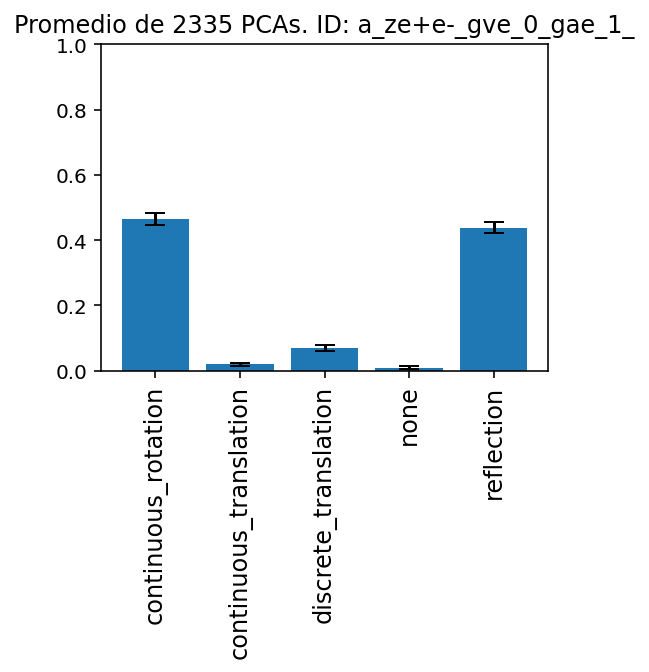

[0.55546882 0.0158951  0.09357977 0.00690238 0.32815393]


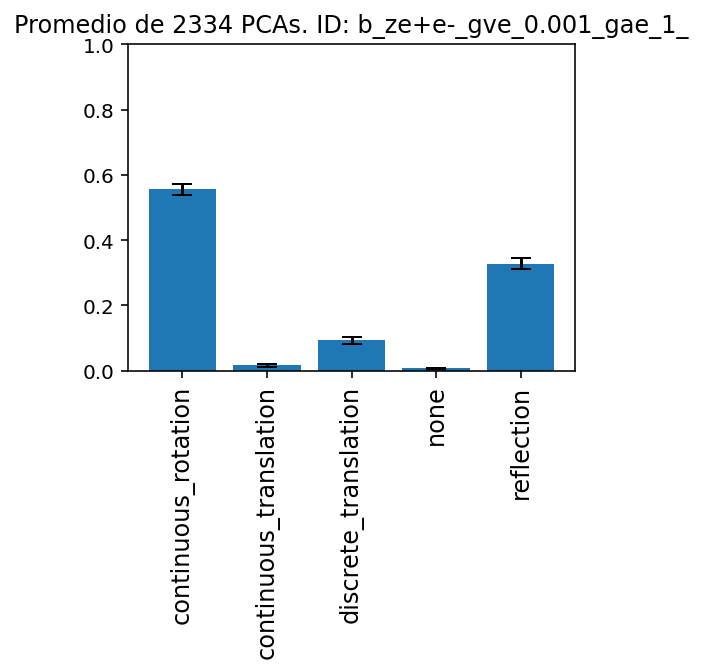

[0.48749327 0.01013394 0.08885485 0.00215356 0.41136437]


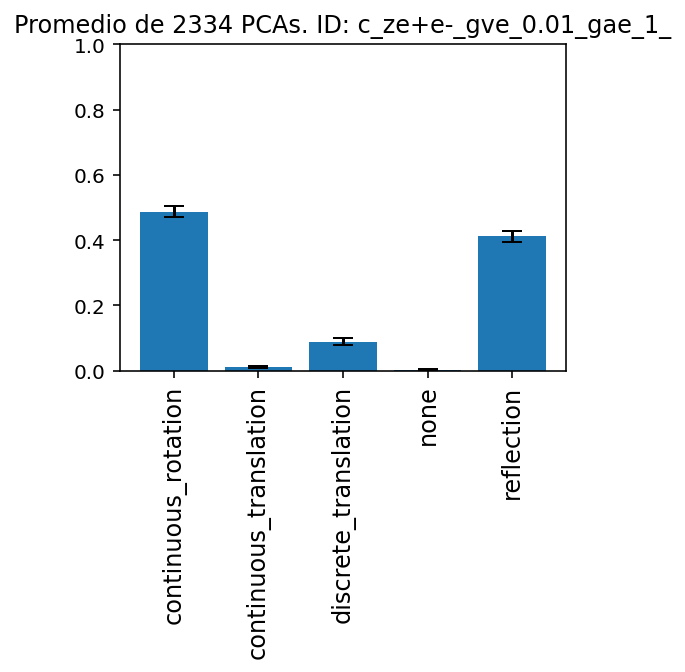

[0.43204696 0.01029733 0.06038673 0.0029906  0.49427838]


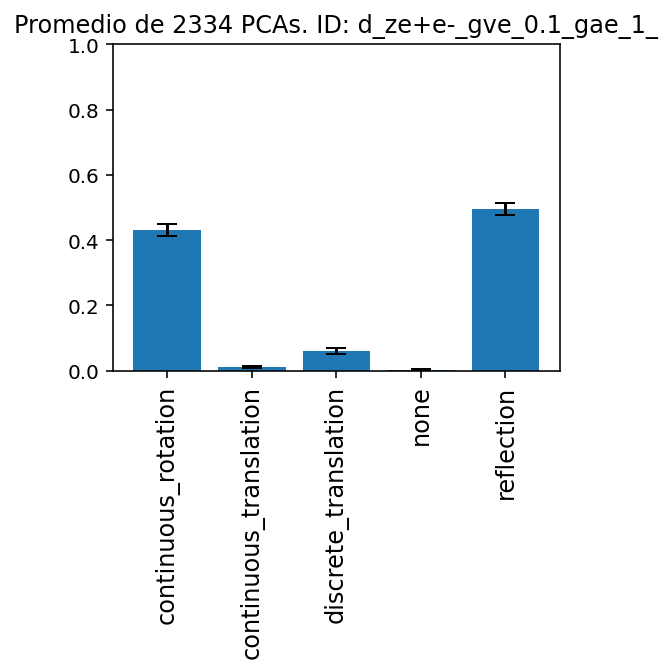

[4.05940806e-01 7.05480816e-02 1.91295006e-04 1.86806750e-05
 5.23301140e-01]


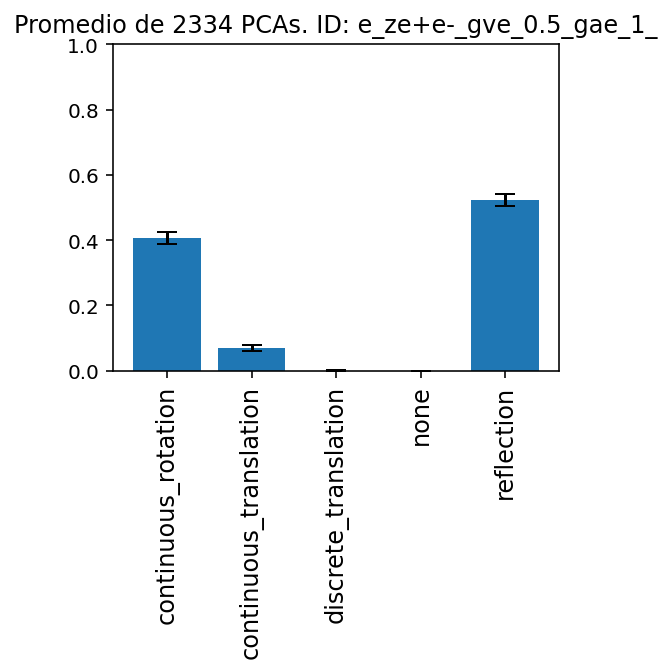

[4.85509012e-01 3.46758560e-01 1.40032104e-03 2.07901835e-04
 1.66124211e-01]


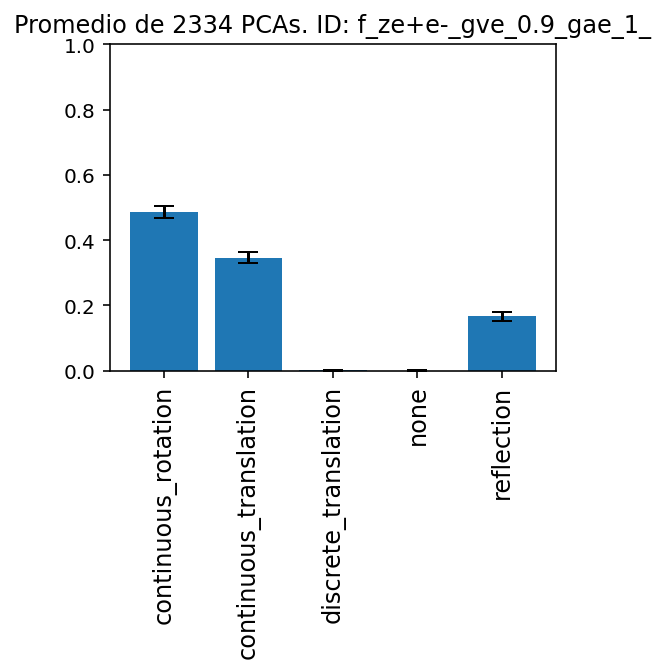

[5.39840216e-01 2.87857035e-01 1.85709809e-04 7.87549879e-05
 1.72038290e-01]


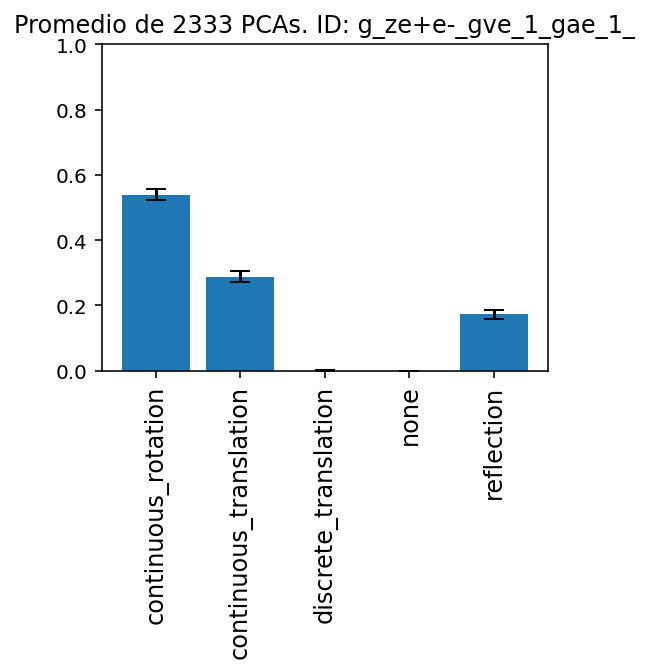

[0.50265167 0.33108088 0.00081396 0.0006308  0.16482269]


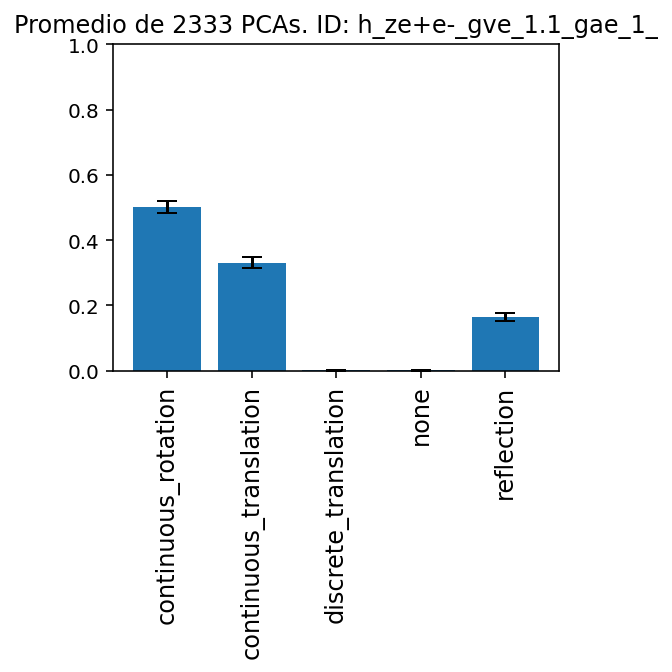

[3.77122373e-01 6.92550054e-02 1.54096947e-04 1.29088611e-05
 5.53455618e-01]


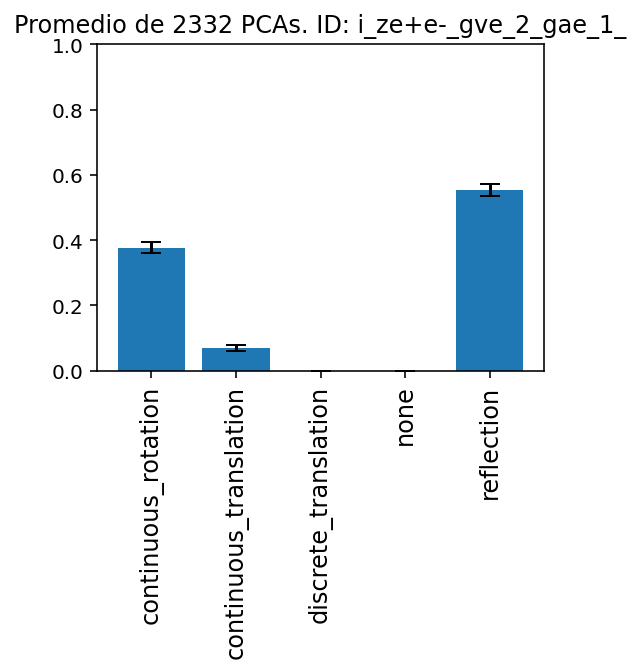

[0.46306985 0.01288801 0.10148609 0.00725965 0.41529642]


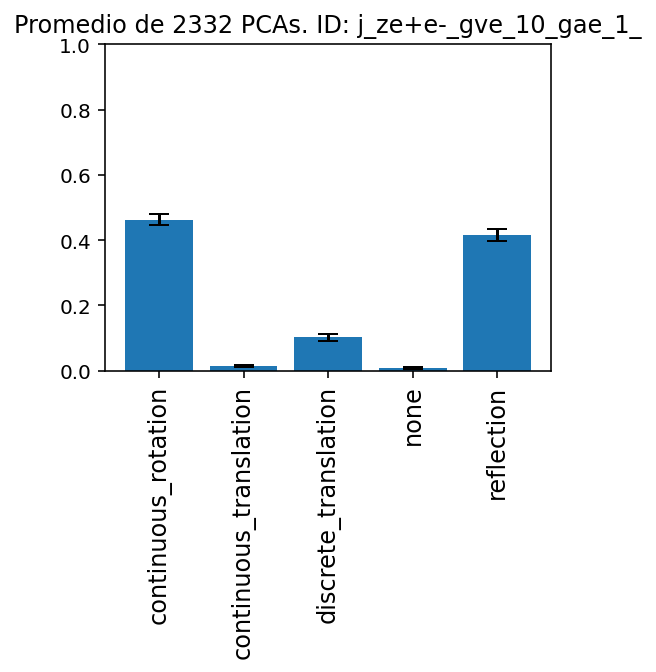

[0.48997092 0.02577023 0.12918945 0.00707168 0.34799772]


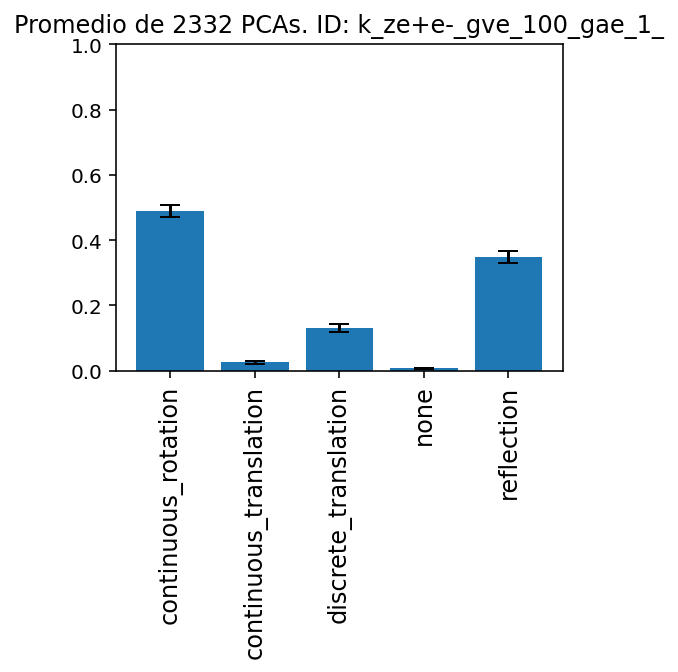

[0.47518503 0.01246571 0.07084728 0.00813447 0.43336751]


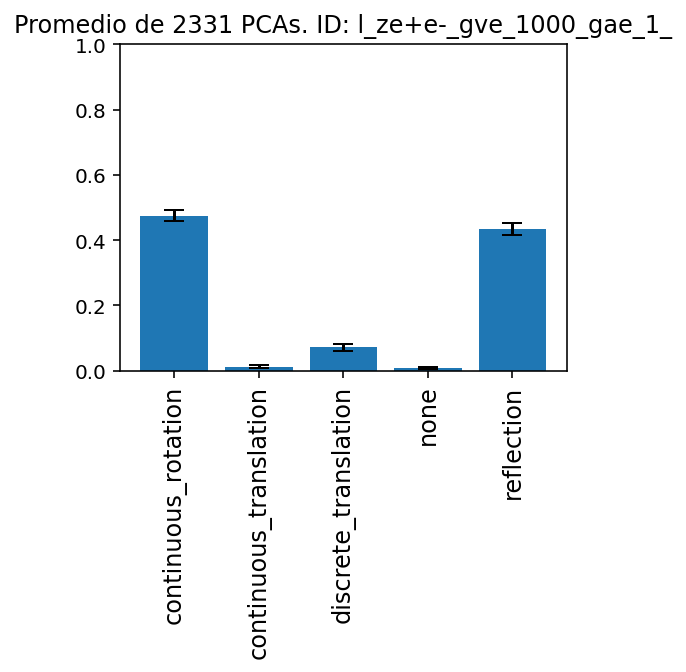

[0.46855961 0.01744355 0.06661894 0.00874279 0.43863512]


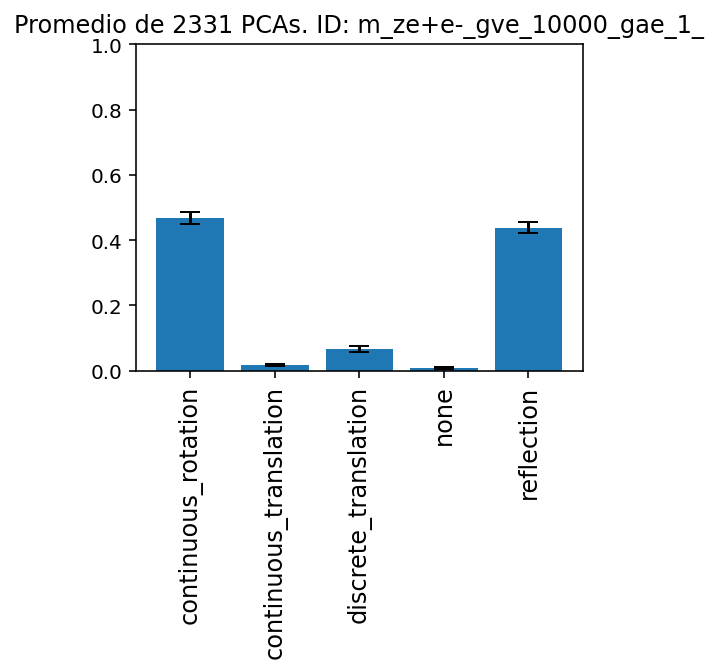

In [3]:
nom_carp = 'diff_sigma'

#import libraries
%config InlineBackend.figure_format = 'retina'
import seaborn as sns
from IPython.core.display import display, HTML, clear_output
display(HTML("<style>.container { width:100% !important; } div.cell.selected {border-left-width: 0px !important;}</style>"))

from time import time
import os
import glob
from fastai.vision.all import *
import numpy as np
from IPython.display import clear_output
import itertools as it
import more_itertools
#import torchvision.models
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.io as pio
pio.templates.default ="none"
import base64
from PIL import Image
from io import BytesIO
import torch
import gc
#import libraries

if not 'notebook_dir' in globals():
    notebook_dir = os.getcwd()
print('Notebook directory: ' + notebook_dir)
os.chdir(notebook_dir)  # If you changed the current working dir, this will take you back to the workbook dir.
top_dir = notebook_dir



modelo = 'G' # J or G

if modelo == 'G':
    #learn = load_learner('/home/gabriel/Desktop/models/model_93_accu_resnet18_10+5_none+reflection'+'.pkl', cpu=False)
    learn = load_learner('/home/gabriel/Desktop/models/model_90_accu_resnet18_one_cycle_10+5_no_mixup'+'.pkl', cpu=False)

if modelo == 'J':
    print('J')
        

#Reset Registro

columns = ['ID', 'Run'] + list(learn.dls.vocab)

registro = pd.DataFrame(columns = columns)
#registro


num_img_cat = [] #guardo el numero de imagenes de cada categoria
i = 0
plote = False

sims = pd.DataFrame(columns = learn.dls.vocab)
errs = sims.copy()

num_img_cat = [] #guardo el numero de imagenes de cada categoria
i = 0
plote = False

from IPython.utils import io


for dires in np.sort(Path('/home/gabriel/Desktop/Ze+e-_custom_3/' + nom_carp).ls()):
    #path = Path('/home/gabriel/Desktop/PCA_INE_sexo/INE/'+quitadas)
    quitadas = str(dires).split('/')[-1]
    with io.capture_output() as captured:
        for ima in dires.ls():

            test_im_dir = ima

            im = PILImage.create(test_im_dir)

            # Orden: ['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection']

            cate, num_cat, probs = learn.predict(im)


            '''
            if plote == True:
                plt.figure
                plt.figure(figsize=(4, 3))
                plt.title(ima)
                plt.bar(['continuous_rotation', 'continuous_translation', 'discrete_translation', 'none', 'reflection'],probs)
                plt.xticks(rotation='vertical',fontsize = 12)
                plt.show()
            '''

            new_row = np.array([quitadas, i] + list(np.array(probs).astype(float))).reshape([1,-1])
            aden = pd.DataFrame(new_row,columns=registro.columns)

            registro = registro.append(aden, ignore_index=True)

            i+=1

    registro = registro.astype({'ID':str, 'Run':int,'continuous_rotation':float, 'continuous_translation':float, 'discrete_translation':float, 'none':float, 'reflection':float })  

    print('Numero Imagenes:',i,)
    num_img_cat.append(i)


print(registro['ID'].unique())

#registro = pd.read_csv('/home/gabriel/Desktop/PCA_INE_sexo/registro.csv')

nombres_carps = registro['ID'].unique() #Nombres de las carpetas donde estan guyardadas las pcas de un tipo
num_carps = len(nombres_carps)

#registro = pd.read_csv('/home/gabriel/Desktop/PCA_INE_sexo/registro.csv')


i = 0


for nom in np.sort(nombres_carps):
    if i == 0:
        m_probs = np.array(registro.iloc[:num_img_cat[0],2:].mean())
        err_probs = np.array(registro.iloc[:num_img_cat[0],2:].std())
        nume = str(len(registro.iloc[:num_img_cat[0],2:]))
        print(learn.dls.vocab)
        print(m_probs)
        sims = sims.append(pd.DataFrame([m_probs], columns = sims.columns),ignore_index = True)
        errs = errs.append(pd.DataFrame([err_probs/np.sqrt(float(nume))], columns = errs.columns),ignore_index = True)
    else:
        m_probs = np.array(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:].mean())
        err_probs = np.array(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:].std())
        nume = str(len(registro.iloc[num_img_cat[i-1]:num_img_cat[i],2:]))
        print(m_probs)
        sims = sims.append(pd.DataFrame([m_probs], columns = sims.columns),ignore_index = True)
        errs = errs.append(pd.DataFrame([err_probs/np.sqrt(float(nume))], columns = errs.columns),ignore_index = True)

    if nom == '-ninguna-':
        tit = 'Promedio de '+nume+' PCAs sin quitar ninguna columna'
    else:
        tit = 'Promedio de '+nume+' PCAs. ID: '+ nom        

    
    plt.figure(figsize=(4, 3))
    plt.title(tit)
    #plt.title('Promedio de '+str(40)+' PCAs sin quitar ninguna columna')
    plt.bar(columns[2:],
            m_probs,yerr = 2*err_probs/np.sqrt(float(nume)), capsize = 5)
    plt.xticks(rotation='vertical',fontsize = 12)
    plt.ylim([0, 1])
    plt.show()

    
    i+=1

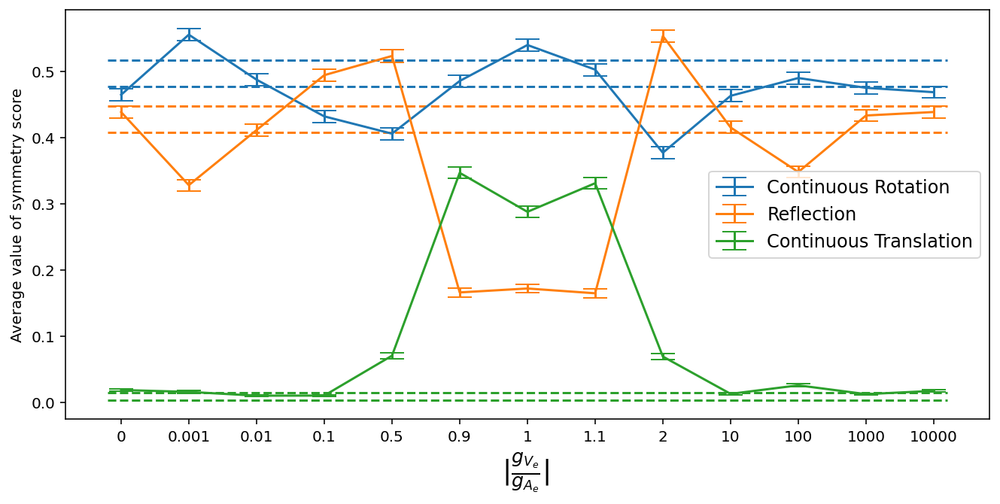

In [4]:
alfas = [0,0.001,0.01,0.1,0.5,0.9,1,1.1,2,10,100,1000,10000] #[0.1,0.5,0.6,0.7,0.8,0.9,1,1.1,1.2,1.3,1.4,10] #[0,0.001,0.01,0.1,0.9,0.99,1,1.01,1.1, 10,100,1000,10000]

#plt.errorbar(range(len(sims_0.reflection)),sims_0.reflection, yerr = errs_0.reflection,capsize = 8,label = 'Umbral: 0+')
#plt.errorbar(range(len(sims_4.reflection)),sims_4.reflection, yerr = errs_4.reflection,capsize = 8,label = 'Umbral: 4+')
#plt.errorbar(range(len(sims_10.reflection)),sims_10.reflection, yerr = errs_10.reflection,capsize = 8,label = 'Umbral: 10+')

#plt.errorbar(range(len(sims.reflection)),sims.reflection, yerr = errs.reflection,capsize = 8,label = 'Umbral: 4+')
#plt.errorbar(range(len(sims_0.none)),1-sims_0.none, yerr = errs_0.none,capsize = 8,label = 'Umbral: 0+')
#plt.errorbar(range(len(sims.none)),1-sims.none, yerr = errs.none,capsize = 8,label = 'Umbral: 4+, 1 $-$ none')
#plt.errorbar(range(len(sims.reflection)),sims.reflection, yerr = errs.reflection,capsize = 8,label = 'Umbral: 4+, reflection')
#plt.errorbar(range(len(sims_10.none)),1-sims_10.none, yerr = errs_10.none,capsize = 8,label = 'Umbral: 10+')

#lt.errorbar(range(len(sims.none)),sims.none, yerr = errs.none,capsize = 8,label = 'None')
plt.figure(figsize = [11,5])
#plt.errorbar(range(len(sims.none)),sims.none+sims.reflection, 
#             yerr = np.sqrt(errs.none**2 + errs.reflection**2),capsize = 8,label = 'Reflection + None')
plt.errorbar(range(len(sims.continuous_rotation)),sims.continuous_rotation, 
             yerr = errs.continuous_rotation,capsize = 8,label = 'Continuous Rotation')
plt.errorbar(range(len(sims.reflection)),sims.reflection, yerr = errs.reflection,capsize = 8,label = 'Reflection')
plt.errorbar(range(len(sims.continuous_translation)),sims.continuous_translation, 
             yerr = errs.continuous_translation,capsize = 8,label = 'Continuous Translation')
tik = plt.xticks(range(len(sims.reflection)),alfas)
plt.legend(fontsize = 12)
plt.ylabel('Average value of symmetry score')
plt.xlabel(r'$|\frac{g_{V_e}}{g_{A_e}}|$ ',fontsize = 18)
#plt.ylim([0.5,1.01])
#plt.ylabel('Reflection')
target = 'diff_sigma_fit'    # Nombre de la variable que queremos predecir
nombre_carpeta = target # Nombre de la subcarpeta donde vamos a guardar las PCAs, dentro de la carpeta grande. Así podemos analizar al mismo tiempo varias bases de datos
folder = 'Ze+e-_custom'   # Carpeta donde se guardan las subcarpetas con las PCAs
folder_0 = 'cross_section_cos_theta_custom' # Carpeta donde están los eventos
#plt.title('Simetrías en Trabajo-Puesto HM_inv (AI)')

plt.hlines(0.496885+0.02,-0.2,12.2,colors = 'tab:blue',linestyles = '--') # Continuous Rotation
plt.hlines(0.496885-0.02,-0.2,12.2,colors = 'tab:blue',linestyles = '--') # Continuous Rotation

plt.hlines(0.427741+0.02,-0.2,12.2,colors = 'tab:orange',linestyles = '--') # Reflection
plt.hlines(0.427741-0.02,-0.2,12.2,colors = 'tab:orange',linestyles = '--') # Reflection

plt.hlines(0.008916+0.006,-0.2,12.2,colors = 'tab:green',linestyles = '--') # Continuous Translation
plt.hlines(0.008916-0.006,-0.2,12.2,colors = 'tab:green',linestyles = '--') # Continuous Translation


In [ ]:
continuous_rotation       0.496885
continuous_translation    0.008916
discrete_translation      0.062997
none                      0.003461
reflection                0.427741